In [1]:
import modeller
import fitter

from functions.misc import knot_fn

import casadi as ca
import numpy as np
from matplotlib import pyplot as plt
from copy import copy
import pandas as pd
from scipy.integrate import trapz, cumtrapz
import datetime

In [2]:
def seir(t, y, p):
    return [
        -p[1]*y[0]*y[2]/sum(y[:4]),
        p[1]*y[0]*y[2]/sum(y[:4]) - p[2]*y[1],
        p[2]*y[1] - p[0]*y[2],
        p[0]*y[2],
    ]

In [48]:
the_data = pd.read_csv("../samoa/samoa-data/samoa_press_release_data.csv", header=0, dayfirst=True, parse_dates=True, skiprows=[1])
the_dates = list(map(lambda t: datetime.datetime.strptime(t, "%d/%m/%Y"), the_data.Date.iloc[start:clip]))
raw_times, raw_cumdata, H, cH, D, G = the_data.iloc[:,1:].values.T

In [4]:
start = 0
clip = None
times = raw_times[start:(-clip if clip else None)] + 33
cumdata = raw_cumdata[start:(-clip if clip else None)]

Text(0.5, 0, 'Date')

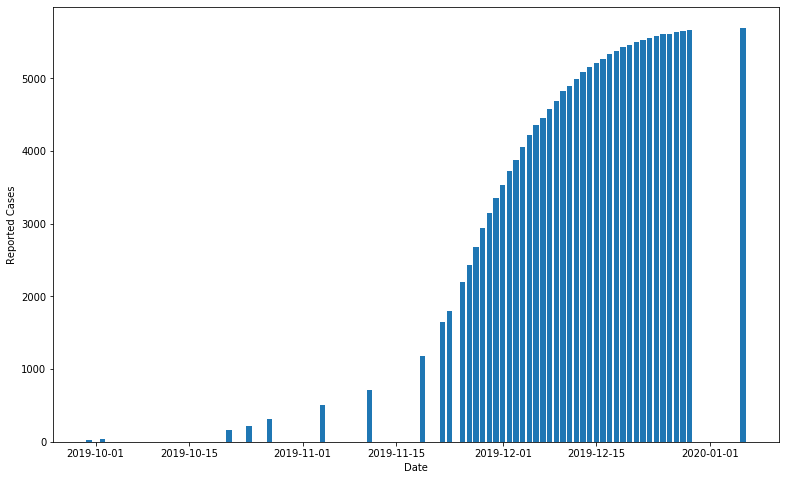

In [57]:
plt.figure(figsize=[13,8])
plt.bar(the_dates, cumdata)
plt.ylabel("Reported Cases")
plt.xlabel("Date")

Text(0.5, 0, 'Date')

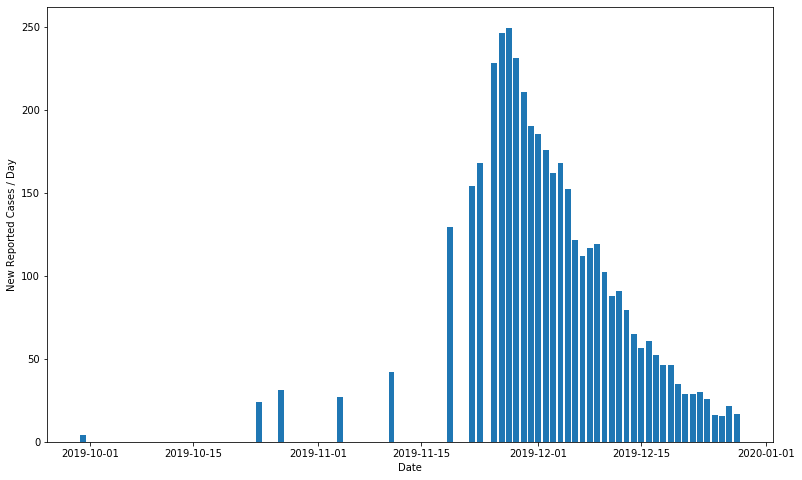

In [56]:
plt.figure(figsize=[13,8])
plt.bar(the_dates, np.gradient(cumdata, times))
plt.ylabel("New Reported Cases / Day")
plt.xlabel("Date")

In [7]:
def cumE(t, p, e):
    dt = ca.diff(t)
    xm = (e[:-1]+e[1:])/2
    return p[2]*ca.vcat([0, ca.cumsum(xm*dt)])

In [8]:
data_pd = np.array([[i] for i in cumdata])
p0 = [1/8, 1, 1/8]
model_form = {
        "state": 4,
        "parameters": 3
    }
config = {
    "grid_size": 100,
    "basis_number": 24,
    "model_form": model_form,
    "time_span": [times[0], 150],
    "knot_function": None,
    "model": seir,
    "dataset": {"y": data_pd, "t": np.array(times)},
    "observation_model": [cumE],
    "observation_vector": [[1]],
    "weightings":[
        [1]*model_form['state'],
        np.sqrt((times+1)/np.mean(times+1))
    ],
    "regularisation_value": copy(p0),
}

In [9]:
model = modeller.Model(config)
config['regularisation_value'][1] = model.ps[1]
objective = fitter.Objective()
objective.make(config, config['dataset'], model)

solver_setup = {
    'f': objective.objective,
    'x': ca.vcat(objective.input_list),
    'p': ca.hcat([objective.rho, objective.alpha]),
    'g': ca.vcat(model.xs),
}
ipopt_opts = {
    'ipopt': {
        'print_level': 5,
        'print_frequency_iter': 10,
        
    }
}

solver = ca.nlpsol('solver', 'ipopt', solver_setup, ipopt_opts)

In [10]:
f1_ex = ca.Function('f1_ex', [solver_setup['x']], [objective.obj_1])
f2_ex = ca.Function('f2_ex', [solver_setup['x']], [objective.obj_2])
fr_ex = ca.Function('fr_ex', [solver_setup['x']], [objective.regularisation])
getx = ca.Function('getx', [solver_setup['x']], model.xs)
getp = ca.Function('getx', [solver_setup['x']], model.ps)


In [11]:
c0 = [max(cumdata)*np.ones(config['basis_number']) for _ in range(model_form['state'])]
x0 = np.hstack([*c0, p0])
lbx = [-np.inf]*(config['basis_number']*4) + [0]*len(config['regularisation_value'])
lbg = [0]*len(model.observation_times)*model_form['state']
ubg = [140000]*len(model.observation_times)*model_form['state']


In [12]:
prange = np.logspace(-6, 5, num=50)
arange = np.logspace(-2, 3, num=50)
sols = []
for alpha in arange:
    xguess = x0
    sola = []
    for p in prange:
        solve_opts = {
            'x0': xguess,
            'p': [p, alpha],
            'lbx': lbx,
            'lbg': lbg,
            'ubg': ubg
        }
        print(f"Solving for a={alpha} p={p}")
        sola.append(solver(**solve_opts))
        xguess = np.array(sola[-1]['x']).flatten()
    sols.append(sola)

Solving for a=0.01 p=1e-06

******************************************************************************
This program contains Ipopt, a library for large-scale nonlinear optimization.
 Ipopt is released as open source code under the Eclipse Public License (EPL).
         For more information visit http://projects.coin-or.org/Ipopt
******************************************************************************

This is Ipopt version 3.12.3, running with linear solver mumps.
NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number of nonzeros in equality constraint Jacobian...:        0
Number of nonzeros in inequality constraint Jacobian.:     1496
Number of nonzeros in Lagrangian Hessian.............:     1718

Total number of variables............................:       99
                     variables with only lower bounds:        3
                variables with lower and upper bounds:        0
                     variables with only upper bounds:   

 460  1.1418442e+02 0.00e+00 3.36e+04  -2.5 7.24e+01    -  1.00e+00 1.00e+00f  1
 470  1.1415149e+02 0.00e+00 5.08e+04  -2.5 1.69e+02    -  1.00e+00 5.00e-01f  2
 480  1.1411830e+02 0.00e+00 1.90e+04  -2.5 1.84e+02    -  1.00e+00 2.50e-01f  3
 490  1.1408770e+02 0.00e+00 2.07e+04  -2.5 5.49e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.1405852e+02 0.00e+00 2.74e+04  -2.5 2.35e+02    -  1.00e+00 2.50e-01f  3
 510  1.1403180e+02 0.00e+00 1.55e+04  -2.5 4.63e+01    -  1.00e+00 1.00e+00f  1
 520  1.1400596e+02 0.00e+00 6.82e+03  -2.5 3.03e+01    -  1.00e+00 1.00e+00f  1
 530  1.1398209e+02 0.00e+00 3.60e+03  -2.5 2.17e+01    -  1.00e+00 1.00e+00f  1
 540  1.1396062e+02 0.00e+00 2.18e+04  -2.5 5.34e+01    -  1.00e+00 1.00e+00f  1
 550  1.1393954e+02 0.00e+00 1.43e+04  -2.5 1.53e+02    -  1.00e+00 2.50e-01f  3
 560  1.1391877e+02 0.00e+00 2.56e+04  -2.5 2.18e+02    -  1.00e+00 2.50e-01f  3
 570  1.1389870e+02 0.00e+00

1400  1.1346986e+02 0.00e+00 5.18e+02  -3.8 6.83e+00    -  1.00e+00 1.00e+00f  1
1410  1.1346828e+02 0.00e+00 1.57e+03  -3.8 1.97e+01    -  1.00e+00 5.00e-01f  2
1420  1.1346659e+02 0.00e+00 1.44e+03  -3.8 1.13e+01    -  1.00e+00 1.00e+00f  1
1430  1.1346494e+02 0.00e+00 9.71e+02  -3.8 9.19e+00    -  1.00e+00 1.00e+00f  1
1440  1.1346337e+02 0.00e+00 8.23e+02  -3.8 8.40e+00    -  1.00e+00 1.00e+00f  1
1450  1.1346187e+02 0.00e+00 7.42e+02  -3.8 7.90e+00    -  1.00e+00 1.00e+00f  1
1460  1.1346041e+02 0.00e+00 4.10e+02  -3.8 5.83e+00    -  1.00e+00 1.00e+00f  1
1470  1.1345900e+02 0.00e+00 1.43e+03  -3.8 1.08e+01    -  1.00e+00 1.00e+00f  1
1480  1.1345760e+02 0.00e+00 1.98e+03  -3.8 2.33e+01    -  1.00e+00 5.00e-01f  2
1490  1.1345628e+02 0.00e+00 2.44e+03  -3.8 2.64e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1500  1.1345491e+02 0.00e+00 4.79e+02  -3.8 6.08e+00    -  1.00e+00 1.00e+00f  1
1510  1.1345360e+02 0.00e+00

2330  1.1340358e+02 0.00e+00 2.41e+02  -3.8 3.94e+00    -  1.00e+00 5.00e-01h  2
2340  1.1340336e+02 0.00e+00 5.10e+02  -3.8 1.28e+01    -  1.00e+00 2.50e-01h  3
2350  1.1340314e+02 0.00e+00 4.19e+02  -3.8 5.67e+00    -  1.00e+00 5.00e-01h  2
2360  1.1340292e+02 0.00e+00 5.89e+02  -3.8 6.85e+00    -  1.00e+00 5.00e-01h  2
2370  1.1340270e+02 0.00e+00 3.39e+02  -3.8 2.66e+00    -  1.00e+00 1.00e+00h  1
2380  1.1340249e+02 0.00e+00 2.29e+02  -3.8 3.83e+00    -  1.00e+00 5.00e-01h  2
2390  1.1340227e+02 0.00e+00 6.78e+01  -3.8 1.18e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2400  1.1340206e+02 0.00e+00 5.91e+00  -3.8 3.41e-01    -  1.00e+00 1.00e+00f  1
2410  1.1340187e+02 0.00e+00 2.89e+01  -3.8 7.64e-01    -  1.00e+00 1.00e+00h  1
2420  1.1340164e+02 0.00e+00 2.95e+02  -3.8 2.44e+00    -  1.00e+00 1.00e+00h  1
2430  1.1340144e+02 0.00e+00 7.26e+01  -3.8 1.21e+00    -  1.00e+00 1.00e+00h  1
2440  1.1340125e+02 0.00e+00

  30  1.1423756e+02 0.00e+00 1.77e+03  -1.0 1.06e+01    -  1.00e+00 1.00e+00f  1
  40  1.1425013e+02 0.00e+00 1.13e+04  -1.0 2.58e+01    -  1.00e+00 1.00e+00f  1
  50  1.1426082e+02 0.00e+00 1.60e+04  -1.0 2.99e+01    -  1.00e+00 1.00e+00f  1
  60  1.1424902e+02 0.00e+00 1.18e+04  -1.0 2.51e+01    -  1.00e+00 1.00e+00f  1
  70  1.1424834e+02 0.00e+00 1.19e+04  -1.0 2.46e+01    -  1.00e+00 1.00e+00f  1
  80  1.1423809e+02 0.00e+00 1.79e+03  -1.0 9.43e+00    -  1.00e+00 1.00e+00f  1
  90  1.1429216e+02 0.00e+00 2.88e+04  -1.0 6.95e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1424478e+02 0.00e+00 9.30e+03  -1.0 2.01e+01    -  1.00e+00 1.00e+00f  1
 110  1.1424945e+02 0.00e+00 1.25e+04  -1.0 2.28e+01    -  1.00e+00 1.00e+00f  1
 120  1.1424538e+02 0.00e+00 7.37e+03  -1.0 1.70e+01    -  1.00e+00 1.00e+00f  1
 130  1.1425431e+02 0.00e+00 1.46e+04  -1.0 8.15e+01    -  1.00e+00 2.50e-01f  3
 140  1.1424831e+02 0.00e+00

 970  1.1425589e+02 0.00e+00 1.17e+04  -2.5 3.83e+01    -  1.00e+00 1.00e+00f  1
 980  1.1421732e+02 0.00e+00 1.42e+04  -2.5 4.16e+01    -  1.00e+00 1.00e+00f  1
 990  1.1418148e+02 0.00e+00 1.71e+04  -2.5 1.59e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  1.1414647e+02 0.00e+00 5.73e+03  -2.5 2.57e+01    -  1.00e+00 1.00e+00f  1
1010  1.1411466e+02 0.00e+00 1.12e+04  -2.5 3.57e+01    -  1.00e+00 1.00e+00f  1
1020  1.1408507e+02 0.00e+00 2.46e+04  -2.5 9.80e+01    -  1.00e+00 5.00e-01f  2
1030  1.1405674e+02 0.00e+00 1.36e+04  -2.5 3.85e+01    -  1.00e+00 1.00e+00f  1
1040  1.1402937e+02 0.00e+00 2.78e+03  -2.5 1.71e+01    -  1.00e+00 1.00e+00f  1
1050  1.1400529e+02 0.00e+00 1.21e+04  -2.5 3.56e+01    -  1.00e+00 1.00e+00f  1
1060  1.1398119e+02 0.00e+00 3.40e+03  -2.5 1.85e+01    -  1.00e+00 1.00e+00f  1
1070  1.1395940e+02 0.00e+00 2.31e+04  -2.5 4.82e+01    -  1.00e+00 1.00e+00f  1
1080  1.1393801e+02 0.00e+00

1920  1.1347199e+02 0.00e+00 1.89e+02  -3.8 4.92e+00    -  1.00e+00 1.00e+00f  1
1930  1.1347041e+02 0.00e+00 1.48e+03  -3.8 1.38e+01    -  1.00e+00 1.00e+00f  1
1940  1.1346886e+02 0.00e+00 2.45e+03  -3.8 6.78e+01    -  1.00e+00 2.50e-01f  3
1950  1.1346727e+02 0.00e+00 6.71e+02  -3.8 9.06e+00    -  1.00e+00 1.00e+00f  1
1960  1.1346572e+02 0.00e+00 2.13e+02  -3.8 4.98e+00    -  1.00e+00 1.00e+00f  1
1970  1.1346431e+02 0.00e+00 1.30e+03  -3.8 2.19e+01    -  1.00e+00 5.00e-01f  2
1980  1.1346290e+02 0.00e+00 1.29e+03  -3.8 2.15e+01    -  1.00e+00 5.00e-01f  2
1990  1.1346154e+02 0.00e+00 1.98e+03  -3.8 5.70e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2000  1.1346013e+02 0.00e+00 5.30e+02  -3.8 7.56e+00    -  1.00e+00 1.00e+00f  1
2010  1.1345885e+02 0.00e+00 1.74e+03  -3.8 2.54e+01    -  1.00e+00 5.00e-01f  2
2020  1.1345753e+02 0.00e+00 2.49e+02  -3.8 4.98e+00    -  1.00e+00 1.00e+00f  1
2030  1.1345632e+02 0.00e+00

2850  1.1340762e+02 0.00e+00 3.55e+02  -3.8 2.41e+00    -  1.00e+00 1.00e+00h  1
2860  1.1340740e+02 0.00e+00 3.19e+02  -3.8 1.79e+01    -  1.00e+00 1.25e-01h  4
2870  1.1340718e+02 0.00e+00 8.11e+01  -3.8 1.14e+00    -  1.00e+00 1.00e+00h  1
2880  1.1340696e+02 0.00e+00 6.34e+01  -3.8 1.01e+00    -  1.00e+00 1.00e+00h  1
2890  1.1340676e+02 0.00e+00 6.04e+01  -3.8 9.82e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2900  1.1340656e+02 0.00e+00 4.25e+01  -3.8 8.20e-01    -  1.00e+00 1.00e+00h  1
2910  1.1340633e+02 0.00e+00 2.92e+01  -3.8 6.77e-01    -  1.00e+00 1.00e+00h  1
2920  1.1340610e+02 0.00e+00 4.47e+01  -3.8 8.36e-01    -  1.00e+00 1.00e+00h  1
2930  1.1340593e+02 0.00e+00 4.99e+02  -3.8 5.48e+00    -  1.00e+00 5.00e-01h  2
2940  1.1340571e+02 0.00e+00 2.43e+00  -3.8 1.87e-01    -  1.00e+00 1.00e+00f  1
2950  1.1340551e+02 0.00e+00 1.45e+02  -3.8 1.50e+00    -  1.00e+00 1.00e+00h  1
2960  1.1340532e+02 0.00e+00

 480  1.1565812e+02 0.00e+00 3.19e+04  -1.0 6.32e+01    -  1.00e+00 1.00e+00f  1
 490  1.1577787e+02 0.00e+00 5.81e+04  -1.0 8.67e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.1591532e+02 0.00e+00 1.04e+05  -1.0 2.25e+02    -  1.00e+00 5.00e-01f  2
 510  1.1601700e+02 0.00e+00 4.68e+04  -1.0 2.80e+02    -  1.00e+00 2.50e-01f  3
 520  1.1614670e+02 0.00e+00 8.84e+03  -1.0 3.65e+01    -  1.00e+00 1.00e+00f  1
 530  1.1628573e+02 0.00e+00 1.03e+04  -1.0 3.99e+01    -  1.00e+00 1.00e+00f  1
 540  1.1642910e+02 0.00e+00 1.29e+04  -1.0 4.53e+01    -  1.00e+00 1.00e+00f  1
 550  1.1658805e+02 0.00e+00 7.16e+04  -1.0 1.07e+02    -  1.00e+00 1.00e+00f  1
 560  1.1675504e+02 0.00e+00 1.05e+05  -1.0 2.52e+02    -  1.00e+00 5.00e-01f  2
 570  1.1690431e+02 0.00e+00 8.00e+04  -1.0 2.20e+02    -  1.00e+00 5.00e-01f  2
 580  1.1707410e+02 0.00e+00 9.69e+04  -1.0 2.50e+02    -  1.00e+00 5.00e-01f  2
 590  1.1723522e+02 0.00e+00

1420  1.1359804e+02 0.00e+00 1.34e+03  -2.5 2.78e+01    -  1.00e+00 2.50e-01f  3
1430  1.1359465e+02 0.00e+00 1.49e+03  -2.5 7.97e+00    -  1.00e+00 1.00e+00f  1
1440  1.1359142e+02 0.00e+00 2.52e+03  -2.5 4.03e+01    -  1.00e+00 2.50e-01f  3
1450  1.1358846e+02 0.00e+00 1.06e+03  -2.5 2.41e+01    -  1.00e+00 2.50e-01f  3
1460  1.1358547e+02 0.00e+00 1.52e+03  -2.5 7.94e+00    -  1.00e+00 1.00e+00f  1
1470  1.1358267e+02 0.00e+00 1.54e+03  -2.5 7.95e+00    -  1.00e+00 1.00e+00f  1
1480  1.1358009e+02 0.00e+00 8.61e+02  -2.5 5.92e+00    -  1.00e+00 1.00e+00f  1
1490  1.1357742e+02 0.00e+00 1.09e+03  -2.5 6.64e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1500  1.1357504e+02 0.00e+00 7.34e+02  -2.5 5.43e+00    -  1.00e+00 1.00e+00f  1
1510  1.1357257e+02 0.00e+00 1.50e+03  -2.5 7.72e+00    -  1.00e+00 1.00e+00f  1
1520  1.1357036e+02 0.00e+00 1.12e+03  -2.5 1.26e+01    -  1.00e+00 5.00e-01h  2
1530  1.1356830e+02 0.00e+00

2400  1.1342919e+02 0.00e+00 4.10e+02  -3.8 4.81e+00    -  1.00e+00 5.00e-01f  2
2410  1.1342869e+02 0.00e+00 2.95e+02  -3.8 3.75e+00    -  1.00e+00 5.00e-01h  2
2420  1.1342817e+02 0.00e+00 2.51e+02  -3.8 2.05e+00    -  1.00e+00 1.00e+00h  1
2430  1.1342767e+02 0.00e+00 2.42e+02  -3.8 2.00e+00    -  1.00e+00 1.00e+00h  1
2440  1.1342718e+02 0.00e+00 5.08e+01  -3.8 9.10e-01    -  1.00e+00 1.00e+00f  1
2450  1.1342672e+02 0.00e+00 2.29e+02  -3.8 1.93e+00    -  1.00e+00 1.00e+00h  1
2460  1.1342625e+02 0.00e+00 4.78e+01  -3.8 8.75e-01    -  1.00e+00 1.00e+00f  1
2470  1.1342580e+02 0.00e+00 4.16e+01  -3.8 8.13e-01    -  1.00e+00 1.00e+00f  1
2480  1.1342538e+02 0.00e+00 2.77e+02  -3.8 3.65e+00    -  1.00e+00 5.00e-01h  2
2490  1.1342495e+02 0.00e+00 3.61e+02  -3.8 9.01e+00    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2500  1.1342454e+02 0.00e+00 2.74e+02  -3.8 7.56e+00    -  1.00e+00 2.50e-01f  3
2510  1.1342413e+02 0.00e+00

 120  1.1437639e+02 0.00e+00 2.66e+04  -1.0 5.12e+01    -  1.00e+00 5.00e-01f  2
 130  1.1432129e+02 0.00e+00 1.02e+04  -1.0 5.57e+01    -  1.00e+00 2.50e-01f  3
 140  1.1435022e+02 0.00e+00 2.00e+04  -1.0 4.17e+01    -  1.00e+00 5.00e-01f  2
 150  1.1433270e+02 0.00e+00 1.11e+04  -1.0 5.62e+01    -  1.00e+00 2.50e-01f  3
 160  1.1435765e+02 0.00e+00 1.99e+04  -1.0 4.09e+01    -  1.00e+00 5.00e-01f  2
 170  1.1435466e+02 0.00e+00 1.63e+04  -1.0 3.62e+01    -  1.00e+00 5.00e-01f  2
 180  1.1435622e+02 0.00e+00 1.29e+04  -1.0 6.44e+01    -  1.00e+00 2.50e-01f  3
 190  1.1435719e+02 0.00e+00 2.44e+03  -1.0 8.55e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1436855e+02 0.00e+00 3.85e+03  -1.0 1.09e+01    -  1.00e+00 1.00e+00f  1
 210  1.1438096e+02 0.00e+00 4.19e+03  -1.0 1.16e+01    -  1.00e+00 1.00e+00f  1
 220  1.1439464e+02 0.00e+00 5.42e+03  -1.0 1.34e+01    -  1.00e+00 1.00e+00f  1
 230  1.1440953e+02 0.00e+00

1170  1.1377231e+02 0.00e+00 6.74e+03  -2.5 1.82e+01    -  1.00e+00 1.00e+00f  1
1180  1.1376197e+02 0.00e+00 1.16e+03  -2.5 7.43e+00    -  1.00e+00 1.00e+00f  1
1190  1.1375246e+02 0.00e+00 3.03e+03  -2.5 4.32e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1374317e+02 0.00e+00 3.94e+03  -2.5 1.36e+01    -  1.00e+00 1.00e+00f  1
1210  1.1373444e+02 0.00e+00 2.30e+03  -2.5 1.03e+01    -  1.00e+00 1.00e+00f  1
1220  1.1372600e+02 0.00e+00 1.23e+03  -2.5 7.44e+00    -  1.00e+00 1.00e+00f  1
1230  1.1371785e+02 0.00e+00 5.03e+02  -2.5 4.71e+00    -  1.00e+00 1.00e+00f  1
1240  1.1371036e+02 0.00e+00 2.82e+03  -2.5 1.12e+01    -  1.00e+00 1.00e+00f  1
1250  1.1370300e+02 0.00e+00 1.38e+03  -2.5 7.72e+00    -  1.00e+00 1.00e+00f  1
1260  1.1369592e+02 0.00e+00 1.56e+03  -2.5 8.16e+00    -  1.00e+00 1.00e+00f  1
1270  1.1368906e+02 0.00e+00 4.26e+02  -2.5 4.21e+00    -  1.00e+00 1.00e+00f  1
1280  1.1368265e+02 0.00e+00

2230  1.1345287e+02 0.00e+00 3.20e+02  -3.8 3.17e+00    -  1.00e+00 1.00e+00f  1
2240  1.1345208e+02 0.00e+00 1.82e+02  -3.8 2.27e+00    -  1.00e+00 1.00e+00f  1
2250  1.1345135e+02 0.00e+00 3.66e+02  -3.8 3.08e+00    -  1.00e+00 1.00e+00f  1
2260  1.1345063e+02 0.00e+00 4.17e+02  -3.8 5.76e+00    -  1.00e+00 5.00e-01f  2
2270  1.1344992e+02 0.00e+00 3.08e+02  -3.8 4.39e+00    -  1.00e+00 5.00e-01f  2
2280  1.1344921e+02 0.00e+00 2.29e+02  -3.8 1.54e+01    -  1.00e+00 1.25e-01f  4
2290  1.1344857e+02 0.00e+00 5.85e+02  -3.8 3.22e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2300  1.1344788e+02 0.00e+00 2.95e+02  -3.8 7.86e+00    -  1.00e+00 2.50e-01f  3
2310  1.1344722e+02 0.00e+00 4.52e+02  -3.8 2.60e+00    -  1.00e+00 1.00e+00f  1
2320  1.1344659e+02 0.00e+00 4.92e+02  -3.8 2.70e+00    -  1.00e+00 1.00e+00f  1
2330  1.1344595e+02 0.00e+00 1.18e+02  -3.8 1.31e+00    -  1.00e+00 1.00e+00f  1
2340  1.1344535e+02 0.00e+00

 120  1.1430415e+02 0.00e+00 1.09e+04  -1.0 1.45e+01    -  1.00e+00 1.00e+00f  1
 130  1.1433373e+02 0.00e+00 1.76e+04  -1.0 7.00e+01    -  1.00e+00 2.50e-01f  3
 140  1.1429852e+02 0.00e+00 2.72e+03  -1.0 7.03e+00    -  1.00e+00 1.00e+00f  1
 150  1.1433994e+02 0.00e+00 1.78e+04  -1.0 3.37e+01    -  1.00e+00 5.00e-01f  2
 160  1.1431177e+02 0.00e+00 1.96e+03  -1.0 6.13e+00    -  1.00e+00 1.00e+00f  1
 170  1.1432971e+02 0.00e+00 1.05e+04  -1.0 2.34e+01    -  1.00e+00 5.00e-01f  2
 180  1.1433861e+02 0.00e+00 1.09e+04  -1.0 2.44e+01    -  1.00e+00 5.00e-01f  2
 190  1.1434514e+02 0.00e+00 9.18e+03  -1.0 1.39e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1435138e+02 0.00e+00 4.88e+03  -1.0 1.05e+01    -  1.00e+00 1.00e+00f  1
 210  1.1440482e+02 0.00e+00 2.55e+04  -1.0 9.31e+01    -  1.00e+00 2.50e-01f  3
 220  1.1437916e+02 0.00e+00 8.32e+03  -1.0 1.42e+01    -  1.00e+00 1.00e+00f  1
 230  1.1440517e+02 0.00e+00

1220  1.1382033e+02 0.00e+00 3.28e+03  -3.8 3.79e+02    -  1.00e+00 1.25e-01f  4
1230  1.1380625e+02 0.00e+00 2.49e+03  -3.8 4.52e+01    -  1.00e+00 1.00e+00f  1
1240  1.1379265e+02 0.00e+00 2.59e+03  -3.8 4.62e+01    -  1.00e+00 1.00e+00f  1
1250  1.1377988e+02 0.00e+00 2.34e+03  -3.8 4.39e+01    -  1.00e+00 1.00e+00f  1
1260  1.1376760e+02 0.00e+00 2.19e+03  -3.8 4.25e+01    -  1.00e+00 1.00e+00f  1
1270  1.1375622e+02 0.00e+00 3.24e+03  -3.8 8.58e+01    -  1.00e+00 5.00e-01f  2
1280  1.1374482e+02 0.00e+00 2.48e+03  -3.8 4.49e+01    -  1.00e+00 1.00e+00f  1
1290  1.1373460e+02 0.00e+00 5.48e+03  -3.8 1.26e+02    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.1372422e+02 0.00e+00 2.36e+03  -3.8 4.34e+01    -  1.00e+00 1.00e+00f  1
1310  1.1371463e+02 0.00e+00 1.01e+03  -3.8 2.81e+01    -  1.00e+00 1.00e+00f  1
1320  1.1370524e+02 0.00e+00 4.96e+02  -3.8 1.94e+01    -  1.00e+00 1.00e+00f  1
1330  1.1369648e+02 0.00e+00

2160  1.1347167e+02 0.00e+00 4.78e+01  -3.8 1.40e+00    -  1.00e+00 1.00e+00f  1
2170  1.1347096e+02 0.00e+00 2.91e+02  -3.8 3.40e+00    -  1.00e+00 1.00e+00f  1
2180  1.1347026e+02 0.00e+00 2.80e+02  -3.8 5.72e+00    -  1.00e+00 5.00e-01f  2
2190  1.1346954e+02 0.00e+00 1.35e+02  -3.8 2.18e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1346889e+02 0.00e+00 3.02e+02  -3.8 5.73e+00    -  1.00e+00 5.00e-01f  2
2210  1.1346822e+02 0.00e+00 1.46e+02  -3.8 2.14e+00    -  1.00e+00 1.00e+00f  1
2220  1.1346756e+02 0.00e+00 1.14e+02  -3.8 1.81e+00    -  1.00e+00 1.00e+00f  1
2230  1.1346693e+02 0.00e+00 1.42e+02  -3.8 1.96e+00    -  1.00e+00 1.00e+00f  1
2240  1.1346631e+02 0.00e+00 4.01e+02  -3.8 3.19e+00    -  1.00e+00 1.00e+00f  1
2250  1.1346568e+02 0.00e+00 2.72e+02  -3.8 2.54e+00    -  1.00e+00 1.00e+00f  1
2260  1.1346507e+02 0.00e+00 2.89e+02  -3.8 2.54e+00    -  1.00e+00 1.00e+00f  1
2270  1.1346448e+02 0.00e+00

 100  1.1431689e+02 0.00e+00 7.03e+03  -1.0 1.01e+01    -  1.00e+00 1.00e+00f  1
 110  1.1434575e+02 0.00e+00 1.18e+04  -1.0 4.99e+01    -  1.00e+00 2.50e-01f  3
 120  1.1431893e+02 0.00e+00 5.98e+03  -1.0 9.23e+00    -  1.00e+00 1.00e+00f  1
 130  1.1431670e+02 0.00e+00 3.10e+03  -1.0 6.65e+00    -  1.00e+00 1.00e+00f  1
 140  1.1436147e+02 0.00e+00 1.36e+04  -1.0 1.37e+01    -  1.00e+00 1.00e+00f  1
 150  1.1437485e+02 0.00e+00 1.55e+04  -1.0 2.76e+01    -  1.00e+00 5.00e-01f  2
 160  1.1436634e+02 0.00e+00 1.34e+04  -1.0 2.53e+01    -  1.00e+00 5.00e-01f  2
 170  1.1440849e+02 0.00e+00 2.00e+04  -1.0 1.68e+01    -  1.00e+00 1.00e+00f  1
 180  1.1438307e+02 0.00e+00 1.47e+04  -1.0 5.66e+01    -  1.00e+00 2.50e-01f  3
 190  1.1436938e+02 0.00e+00 8.68e+03  -1.0 1.93e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1437025e+02 0.00e+00 2.33e+03  -1.0 6.29e+00    -  1.00e+00 1.00e+00f  1
 210  1.1438238e+02 0.00e+00

1080  1.1395248e+02 0.00e+00 5.04e+03  -2.5 2.39e+01    -  1.00e+00 5.00e-01f  2
1090  1.1393584e+02 0.00e+00 5.59e+03  -2.5 1.35e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1392020e+02 0.00e+00 2.61e+03  -2.5 3.14e+01    -  1.00e+00 2.50e-01f  3
1110  1.1390485e+02 0.00e+00 2.55e+03  -2.5 8.91e+00    -  1.00e+00 1.00e+00f  1
1120  1.1389038e+02 0.00e+00 1.58e+03  -2.5 6.93e+00    -  1.00e+00 1.00e+00f  1
1130  1.1387665e+02 0.00e+00 3.07e+03  -2.5 3.55e+01    -  1.00e+00 2.50e-01f  3
1140  1.1386402e+02 0.00e+00 5.29e+03  -2.5 2.41e+01    -  1.00e+00 5.00e-01f  2
1150  1.1385171e+02 0.00e+00 2.35e+03  -2.5 1.41e+01    -  1.00e+00 5.00e-01f  2
1160  1.1383965e+02 0.00e+00 1.86e+03  -2.5 7.28e+00    -  1.00e+00 1.00e+00f  1
1170  1.1382828e+02 0.00e+00 4.30e+02  -2.5 3.45e+00    -  1.00e+00 1.00e+00f  1
1180  1.1381809e+02 0.00e+00 5.47e+02  -2.5 3.87e+00    -  1.00e+00 1.00e+00f  1
1190  1.1380800e+02 0.00e+00

2070  1.1352116e+02 0.00e+00 3.40e+02  -3.8 5.48e+00    -  1.00e+00 1.00e+00f  1
2080  1.1352012e+02 0.00e+00 2.33e+02  -3.8 1.52e+01    -  1.00e+00 2.50e-01f  3
2090  1.1351912e+02 0.00e+00 4.79e+02  -3.8 1.21e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1351809e+02 0.00e+00 4.59e+01  -3.8 1.97e+00    -  1.00e+00 1.00e+00f  1
2110  1.1351713e+02 0.00e+00 2.56e+02  -3.8 4.66e+00    -  1.00e+00 1.00e+00f  1
2120  1.1351614e+02 0.00e+00 1.82e+02  -3.8 3.91e+00    -  1.00e+00 1.00e+00f  1
2130  1.1351520e+02 0.00e+00 1.32e+02  -3.8 3.31e+00    -  1.00e+00 1.00e+00f  1
2140  1.1351428e+02 0.00e+00 7.20e+01  -3.8 2.42e+00    -  1.00e+00 1.00e+00f  1
2150  1.1351342e+02 0.00e+00 2.36e+02  -3.8 4.38e+00    -  1.00e+00 1.00e+00f  1
2160  1.1351249e+02 0.00e+00 5.10e+01  -3.8 2.01e+00    -  1.00e+00 1.00e+00f  1
2170  1.1351167e+02 0.00e+00 1.73e+02  -3.8 3.70e+00    -  1.00e+00 1.00e+00f  1
2180  1.1351082e+02 0.00e+00

  90  1.1435059e+02 0.00e+00 2.60e+03  -1.0 4.99e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1435160e+02 0.00e+00 8.87e+02  -1.0 2.98e+00    -  1.00e+00 1.00e+00f  1
 110  1.1436254e+02 0.00e+00 3.83e+03  -1.0 6.09e+00    -  1.00e+00 1.00e+00f  1
 120  1.1442945e+02 0.00e+00 1.29e+04  -1.0 4.34e+01    -  1.00e+00 2.50e-01f  3
 130  1.1437455e+02 0.00e+00 4.49e+03  -1.0 6.60e+00    -  1.00e+00 1.00e+00f  1
 140  1.1437492e+02 0.00e+00 2.09e+03  -1.0 4.63e+00    -  1.00e+00 1.00e+00f  1
 150  1.1438771e+02 0.00e+00 4.81e+03  -1.0 7.13e+00    -  1.00e+00 1.00e+00f  1
 160  1.1442656e+02 0.00e+00 1.16e+04  -1.0 1.13e+01    -  1.00e+00 1.00e+00f  1
 170  1.1439749e+02 0.00e+00 1.05e+03  -1.0 3.58e+00    -  1.00e+00 1.00e+00f  1
 180  1.1441041e+02 0.00e+00 3.73e+03  -1.0 6.76e+00    -  1.00e+00 1.00e+00f  1
 190  1.1441829e+02 0.00e+00 1.41e+03  -1.0 4.33e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

1080  1.1398876e+02 0.00e+00 1.12e+03  -2.5 5.63e+00    -  1.00e+00 1.00e+00f  1
1090  1.1397282e+02 0.00e+00 3.95e+02  -2.5 3.25e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1395842e+02 0.00e+00 4.87e+03  -2.5 1.15e+01    -  1.00e+00 1.00e+00f  1
1110  1.1394370e+02 0.00e+00 6.31e+02  -2.5 4.03e+00    -  1.00e+00 1.00e+00f  1
1120  1.1393086e+02 0.00e+00 2.16e+03  -2.5 1.30e+01    -  1.00e+00 5.00e-01f  2
1130  1.1391805e+02 0.00e+00 3.77e+03  -2.5 9.68e+00    -  1.00e+00 1.00e+00f  1
1140  1.1390570e+02 0.00e+00 3.62e+03  -2.5 9.35e+00    -  1.00e+00 1.00e+00f  1
1150  1.1389415e+02 0.00e+00 3.18e+03  -2.5 8.66e+00    -  1.00e+00 1.00e+00f  1
1160  1.1388292e+02 0.00e+00 4.98e+02  -2.5 3.38e+00    -  1.00e+00 1.00e+00f  1
1170  1.1387282e+02 0.00e+00 2.94e+03  -2.5 1.55e+01    -  1.00e+00 5.00e-01f  2
1180  1.1386273e+02 0.00e+00 1.77e+03  -2.5 6.23e+00    -  1.00e+00 1.00e+00f  1
1190  1.1385301e+02 0.00e+00

2100  1.1357393e+02 0.00e+00 3.02e+02  -3.8 6.61e+00    -  1.00e+00 1.00e+00f  1
2110  1.1357300e+02 0.00e+00 1.67e+02  -3.8 1.65e+01    -  1.00e+00 2.50e-01f  3
2120  1.1357207e+02 0.00e+00 2.06e+02  -3.8 5.42e+00    -  1.00e+00 1.00e+00f  1
2130  1.1357115e+02 0.00e+00 1.80e+02  -3.8 5.06e+00    -  1.00e+00 1.00e+00f  1
2140  1.1357023e+02 0.00e+00 3.71e+01  -3.8 2.28e+00    -  1.00e+00 1.00e+00f  1
2150  1.1356937e+02 0.00e+00 3.20e+01  -3.8 2.11e+00    -  1.00e+00 1.00e+00f  1
2160  1.1356854e+02 0.00e+00 1.39e+02  -3.8 4.40e+00    -  1.00e+00 1.00e+00f  1
2170  1.1356769e+02 0.00e+00 8.79e+01  -3.8 3.49e+00    -  1.00e+00 1.00e+00f  1
2180  1.1356687e+02 0.00e+00 3.03e+01  -3.8 2.04e+00    -  1.00e+00 1.00e+00f  1
2190  1.1356609e+02 0.00e+00 2.65e+02  -3.8 6.03e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1356532e+02 0.00e+00 2.06e+02  -3.8 5.31e+00    -  1.00e+00 1.00e+00f  1
2210  1.1356455e+02 0.00e+00

  20  1.1442982e+02 0.00e+00 3.71e+03  -1.0 9.08e+00    -  1.00e+00 5.00e-01f  2
  30  1.1443168e+02 0.00e+00 3.86e+03  -1.0 9.21e+00    -  1.00e+00 5.00e-01f  2
  40  1.1448280e+02 0.00e+00 7.12e+03  -1.0 2.65e+01    -  1.00e+00 2.50e-01f  3
  50  1.1442599e+02 0.00e+00 3.09e+03  -1.0 4.45e+00    -  1.00e+00 1.00e+00f  1
  60  1.1446089e+02 0.00e+00 6.13e+03  -1.0 1.18e+01    -  1.00e+00 5.00e-01f  2
  70  1.1443325e+02 0.00e+00 3.50e+03  -1.0 1.67e+01    -  1.00e+00 2.50e-01f  3
  80  1.1442700e+02 0.00e+00 1.80e+03  -1.0 3.29e+00    -  1.00e+00 1.00e+00f  1
  90  1.1445252e+02 0.00e+00 5.24e+03  -1.0 5.70e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1445699e+02 0.00e+00 5.48e+03  -1.0 1.09e+01    -  1.00e+00 5.00e-01f  2
 110  1.1446262e+02 0.00e+00 5.80e+03  -1.0 1.15e+01    -  1.00e+00 5.00e-01f  2
 120  1.1445145e+02 0.00e+00 3.52e+03  -1.0 1.70e+01    -  1.00e+00 2.50e-01f  3
 130  1.1445646e+02 0.00e+00

1060  1.1412552e+02 0.00e+00 5.23e+03  -2.5 1.51e+01    -  1.00e+00 1.00e+00f  1
1070  1.1410723e+02 0.00e+00 3.56e+03  -2.5 1.22e+01    -  1.00e+00 1.00e+00f  1
1080  1.1408991e+02 0.00e+00 1.07e+03  -2.5 6.52e+00    -  1.00e+00 1.00e+00f  1
1090  1.1407373e+02 0.00e+00 2.56e+03  -2.5 9.96e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1405859e+02 0.00e+00 1.72e+03  -2.5 8.02e+00    -  1.00e+00 1.00e+00f  1
1110  1.1404425e+02 0.00e+00 3.41e+03  -2.5 2.13e+01    -  1.00e+00 5.00e-01f  2
1120  1.1403066e+02 0.00e+00 3.59e+03  -2.5 1.12e+01    -  1.00e+00 1.00e+00f  1
1130  1.1401699e+02 0.00e+00 1.27e+03  -2.5 6.55e+00    -  1.00e+00 1.00e+00f  1
1140  1.1400455e+02 0.00e+00 1.59e+03  -2.5 2.65e+01    -  1.00e+00 2.50e-01f  3
1150  1.1399264e+02 0.00e+00 1.07e+03  -2.5 5.82e+00    -  1.00e+00 1.00e+00f  1
1160  1.1398126e+02 0.00e+00 3.30e+02  -2.5 3.16e+00    -  1.00e+00 1.00e+00f  1
1170  1.1397042e+02 0.00e+00

2130  1.1366487e+02 0.00e+00 4.56e+01  -3.8 3.66e+00    -  1.00e+00 1.00e+00f  1
2140  1.1366403e+02 0.00e+00 1.27e+02  -3.8 6.11e+00    -  1.00e+00 1.00e+00f  1
2150  1.1366317e+02 0.00e+00 3.63e+01  -3.8 3.26e+00    -  1.00e+00 1.00e+00f  1
2160  1.1366236e+02 0.00e+00 1.04e+02  -3.8 5.53e+00    -  1.00e+00 1.00e+00f  1
2170  1.1366156e+02 0.00e+00 8.40e+01  -3.8 4.95e+00    -  1.00e+00 1.00e+00f  1
2180  1.1366076e+02 0.00e+00 2.96e+01  -3.8 2.93e+00    -  1.00e+00 1.00e+00f  1
2190  1.1365999e+02 0.00e+00 3.19e+01  -3.8 3.04e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1365926e+02 0.00e+00 1.03e+02  -3.8 5.46e+00    -  1.00e+00 1.00e+00f  1
2210  1.1365852e+02 0.00e+00 5.45e+01  -3.8 3.96e+00    -  1.00e+00 1.00e+00f  1
2220  1.1365783e+02 0.00e+00 1.09e+02  -3.8 1.96e+01    -  1.00e+00 2.50e-01f  3
2230  1.1365711e+02 0.00e+00 2.01e+01  -3.8 2.39e+00    -  1.00e+00 1.00e+00f  1
2240  1.1365642e+02 0.00e+00

  70  1.1458181e+02 0.00e+00 3.47e+03  -1.0 1.46e+01    -  1.00e+00 2.50e-01f  3
  80  1.1460198e+02 0.00e+00 4.82e+03  -1.0 4.71e+00    -  1.00e+00 1.00e+00f  1
  90  1.1457265e+02 0.00e+00 1.58e+03  -1.0 2.79e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1457591e+02 0.00e+00 1.25e+03  -1.0 2.54e+00    -  1.00e+00 1.00e+00f  1
 110  1.1463325e+02 0.00e+00 6.65e+03  -1.0 1.13e+01    -  1.00e+00 5.00e-01f  2
 120  1.1466401e+02 0.00e+00 8.41e+03  -1.0 6.81e+00    -  1.00e+00 1.00e+00f  1
 130  1.1459440e+02 0.00e+00 1.66e+03  -1.0 3.13e+00    -  1.00e+00 1.00e+00f  1
 140  1.1460931e+02 0.00e+00 3.37e+03  -1.0 4.53e+00    -  1.00e+00 1.00e+00f  1
 150  1.1460736e+02 0.00e+00 8.67e+02  -1.0 2.40e+00    -  1.00e+00 1.00e+00f  1
 160  1.1463163e+02 0.00e+00 4.56e+03  -1.0 2.02e+01    -  1.00e+00 2.50e-01f  3
 170  1.1465679e+02 0.00e+00 6.67e+03  -1.0 1.27e+01    -  1.00e+00 5.00e-01f  2
 180  1.1465802e+02 0.00e+00

1000  1.1440735e+02 0.00e+00 1.46e+03  -2.5 9.68e+00    -  1.00e+00 1.00e+00f  1
1010  1.1438226e+02 0.00e+00 1.89e+03  -2.5 1.08e+01    -  1.00e+00 1.00e+00f  1
1020  1.1435828e+02 0.00e+00 1.23e+03  -2.5 8.45e+00    -  1.00e+00 1.00e+00f  1
1030  1.1433615e+02 0.00e+00 1.91e+03  -2.5 1.03e+01    -  1.00e+00 1.00e+00f  1
1040  1.1431484e+02 0.00e+00 3.13e+03  -2.5 4.96e+01    -  1.00e+00 2.50e-01f  3
1050  1.1429470e+02 0.00e+00 4.08e+02  -2.5 4.51e+00    -  1.00e+00 1.00e+00f  1
1060  1.1427622e+02 0.00e+00 1.04e+03  -2.5 7.08e+00    -  1.00e+00 1.00e+00f  1
1070  1.1425836e+02 0.00e+00 3.20e+02  -2.5 3.81e+00    -  1.00e+00 1.00e+00f  1
1080  1.1424223e+02 0.00e+00 1.74e+03  -2.5 8.81e+00    -  1.00e+00 1.00e+00f  1
1090  1.1422629e+02 0.00e+00 1.52e+03  -2.5 1.41e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1421148e+02 0.00e+00 1.36e+03  -2.5 1.29e+01    -  1.00e+00 5.00e-01f  2
1110  1.1419702e+02 0.00e+00

1990  1.1383720e+02 0.00e+00 1.53e+02  -3.8 3.80e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2000  1.1383591e+02 0.00e+00 2.76e+01  -3.8 4.54e+00    -  1.00e+00 1.00e+00f  1
2010  1.1383473e+02 0.00e+00 5.10e+01  -3.8 6.19e+00    -  1.00e+00 1.00e+00f  1
2020  1.1383363e+02 0.00e+00 1.65e+02  -3.8 1.96e+01    -  1.00e+00 5.00e-01f  2
2030  1.1383248e+02 0.00e+00 4.21e+01  -3.8 5.62e+00    -  1.00e+00 1.00e+00f  1
2040  1.1383140e+02 0.00e+00 1.05e+02  -3.8 8.90e+00    -  1.00e+00 1.00e+00f  1
2050  1.1383033e+02 0.00e+00 1.48e+02  -3.8 1.06e+01    -  1.00e+00 1.00e+00f  1
2060  1.1382931e+02 0.00e+00 1.07e+02  -3.8 9.01e+00    -  1.00e+00 1.00e+00f  1
2070  1.1382828e+02 0.00e+00 6.22e+01  -3.8 6.86e+00    -  1.00e+00 1.00e+00f  1
2080  1.1382732e+02 0.00e+00 1.36e+02  -3.8 3.69e+01    -  1.00e+00 2.50e-01f  3
2090  1.1382638e+02 0.00e+00 2.20e+02  -3.8 4.97e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr 

  80  1.1481260e+02 0.00e+00 1.19e+03  -1.0 2.09e+00    -  1.00e+00 1.00e+00f  1
  90  1.1483074e+02 0.00e+00 2.67e+03  -1.0 3.19e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1483247e+02 0.00e+00 2.49e+03  -1.0 1.13e+01    -  1.00e+00 2.50e-01f  3
 110  1.1482589e+02 0.00e+00 7.29e+02  -1.0 1.77e+00    -  1.00e+00 1.00e+00f  1
 120  1.1486300e+02 0.00e+00 4.19e+03  -1.0 1.63e+01    -  1.00e+00 2.50e-01f  3
 130  1.1490216e+02 0.00e+00 6.24e+03  -1.0 5.33e+00    -  1.00e+00 1.00e+00f  1
 140  1.1489897e+02 0.00e+00 5.94e+03  -1.0 2.06e+01    -  1.00e+00 2.50e-01f  3
 150  1.1486980e+02 0.00e+00 3.35e+03  -1.0 7.17e+00    -  1.00e+00 5.00e-01f  2
 160  1.1487277e+02 0.00e+00 2.71e+03  -1.0 1.30e+01    -  1.00e+00 2.50e-01f  3
 170  1.1490437e+02 0.00e+00 5.17e+03  -1.0 5.33e+00    -  1.00e+00 1.00e+00f  1
 180  1.1489323e+02 0.00e+00 2.82e+03  -1.0 4.05e+00    -  1.00e+00 1.00e+00f  1
 190  1.1489759e+02 0.00e+00

1040  1.1485485e+02 0.00e+00 2.61e+03  -2.5 1.51e+01    -  1.00e+00 1.00e+00f  1
1050  1.1481808e+02 0.00e+00 9.56e+02  -2.5 8.88e+00    -  1.00e+00 1.00e+00f  1
1060  1.1478536e+02 0.00e+00 2.42e+03  -2.5 1.36e+01    -  1.00e+00 1.00e+00f  1
1070  1.1475452e+02 0.00e+00 4.06e+03  -2.5 3.27e+01    -  1.00e+00 5.00e-01f  2
1080  1.1472419e+02 0.00e+00 3.38e+03  -2.5 5.82e+01    -  1.00e+00 2.50e-01f  3
1090  1.1469547e+02 0.00e+00 1.28e+03  -2.5 9.02e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1466799e+02 0.00e+00 2.96e+02  -2.5 4.15e+00    -  1.00e+00 1.00e+00f  1
1110  1.1464396e+02 0.00e+00 1.47e+03  -2.5 3.20e+01    -  1.00e+00 2.50e-01f  3
1120  1.1462080e+02 0.00e+00 2.58e+03  -2.5 1.19e+01    -  1.00e+00 1.00e+00f  1
1130  1.1459873e+02 0.00e+00 1.22e+03  -2.5 2.71e+01    -  1.00e+00 2.50e-01f  3
1140  1.1457764e+02 0.00e+00 7.21e+02  -2.5 5.94e+00    -  1.00e+00 1.00e+00f  1
1150  1.1455871e+02 0.00e+00

1970  1.1411844e+02 0.00e+00 1.73e+02  -3.8 3.51e+01    -  1.00e+00 5.00e-01f  2
1980  1.1411674e+02 0.00e+00 1.65e+02  -3.8 2.00e+01    -  1.00e+00 1.00e+00f  1
1990  1.1411504e+02 0.00e+00 2.92e+01  -3.8 8.42e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2000  1.1411348e+02 0.00e+00 1.54e+02  -3.8 1.95e+01    -  1.00e+00 1.00e+00f  1
2010  1.1411196e+02 0.00e+00 3.10e+02  -3.8 1.08e+02    -  1.00e+00 2.50e-01f  3
2020  1.1411045e+02 0.00e+00 1.26e+02  -3.8 6.16e+01    -  1.00e+00 2.50e-01f  3
2030  1.1410902e+02 0.00e+00 1.78e+02  -3.8 3.84e+01    -  1.00e+00 5.00e-01f  2
2040  1.1410762e+02 0.00e+00 2.07e+02  -3.8 4.29e+01    -  1.00e+00 5.00e-01f  2
2050  1.1410626e+02 0.00e+00 1.53e+02  -3.8 7.33e+01    -  1.00e+00 2.50e-01f  3
2060  1.1410491e+02 0.00e+00 2.03e+02  -3.8 2.31e+01    -  1.00e+00 1.00e+00f  1
2070  1.1410360e+02 0.00e+00 1.31e+02  -3.8 3.20e+01    -  1.00e+00 5.00e-01f  2
2080  1.1410234e+02 0.00e+00

  10  1.1557867e+02 0.00e+00 1.07e+03  -1.0 1.97e+02    -  1.00e+00 1.00e+00f  1
  20  1.1558901e+02 0.00e+00 1.33e+03  -1.0 3.70e+00    -  1.00e+00 5.00e-01f  2
  30  1.1563789e+02 0.00e+00 2.35e+03  -1.0 2.91e+00    -  1.00e+00 1.00e+00f  1
  40  1.1557410e+02 0.00e+00 4.73e+02  -1.0 1.36e+00    -  1.00e+00 1.00e+00f  1
  50  1.1558442e+02 0.00e+00 9.01e+02  -1.0 1.91e+00    -  1.00e+00 1.00e+00f  1
  60  1.1566837e+02 0.00e+00 3.07e+03  -1.0 3.59e+00    -  1.00e+00 1.00e+00f  1
  70  1.1565362e+02 0.00e+00 2.83e+03  -1.0 3.54e+00    -  1.00e+00 1.00e+00f  1
  80  1.1562208e+02 0.00e+00 1.95e+03  -1.0 5.34e+00    -  1.00e+00 5.00e-01f  2
  90  1.1570384e+02 0.00e+00 3.91e+03  -1.0 4.39e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1569026e+02 0.00e+00 3.66e+03  -1.0 8.31e+00    -  1.00e+00 5.00e-01f  2
 110  1.1567135e+02 0.00e+00 3.12e+03  -1.0 4.14e+00    -  1.00e+00 1.00e+00f  1
 120  1.1565386e+02 0.00e+00

1160  1.1494946e+02 0.00e+00 5.44e+02  -2.5 1.72e+01    -  1.00e+00 2.50e-01f  3
1170  1.1493504e+02 0.00e+00 2.11e+02  -2.5 2.88e+00    -  1.00e+00 1.00e+00f  1
1180  1.1492136e+02 0.00e+00 1.71e+02  -2.5 2.55e+00    -  1.00e+00 1.00e+00f  1
1190  1.1490853e+02 0.00e+00 2.73e+02  -2.5 3.19e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1489592e+02 0.00e+00 4.50e+02  -2.5 4.04e+00    -  1.00e+00 1.00e+00f  1
1210  1.1488421e+02 0.00e+00 4.54e+02  -2.5 1.49e+01    -  1.00e+00 2.50e-01f  3
1220  1.1487277e+02 0.00e+00 1.71e+02  -2.5 2.42e+00    -  1.00e+00 1.00e+00f  1
1230  1.1486231e+02 0.00e+00 2.37e+02  -2.5 2.82e+00    -  1.00e+00 1.00e+00f  1
1240  1.1485228e+02 0.00e+00 1.51e+02  -2.5 2.22e+00    -  1.00e+00 1.00e+00f  1
1250  1.1484278e+02 0.00e+00 7.95e+01  -2.5 1.59e+00    -  1.00e+00 1.00e+00f  1
1260  1.1483388e+02 0.00e+00 3.38e+02  -2.5 5.89e+00    -  1.00e+00 5.00e-01f  2
1270  1.1482491e+02 0.00e+00

2120  1.1453375e+02 0.00e+00 9.31e+00  -3.8 9.06e+00    -  1.00e+00 1.00e+00f  1
2130  1.1453292e+02 0.00e+00 5.52e+01  -3.8 2.23e+01    -  1.00e+00 1.00e+00f  1
2140  1.1453212e+02 0.00e+00 8.87e+01  -3.8 1.11e+02    -  1.00e+00 2.50e-01f  3
2150  1.1453131e+02 0.00e+00 5.34e+01  -3.8 4.07e+01    -  1.00e+00 5.00e-01f  2
2160  1.1453055e+02 0.00e+00 7.85e+01  -3.8 5.23e+01    -  1.00e+00 5.00e-01f  2
2170  1.1452977e+02 0.00e+00 5.77e+01  -3.8 2.37e+01    -  1.00e+00 1.00e+00h  1
2180  1.1452905e+02 0.00e+00 4.34e+01  -3.8 3.68e+01    -  1.00e+00 5.00e-01h  2
2190  1.1452834e+02 0.00e+00 3.58e+01  -3.8 3.21e+01    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1452765e+02 0.00e+00 9.25e+01  -3.8 3.09e+01    -  1.00e+00 1.00e+00h  1
2210  1.1452694e+02 0.00e+00 4.45e+01  -3.8 3.93e+01    -  1.00e+00 5.00e-01h  2
2220  1.1452629e+02 0.00e+00 3.19e+01  -3.8 3.08e+01    -  1.00e+00 5.00e-01h  2
2230  1.1452562e+02 0.00e+00

  70  1.2180970e+02 0.00e+00 9.87e+02  -1.0 7.03e+00    -  1.00e+00 1.00e+00f  1
  80  1.2198593e+02 0.00e+00 1.44e+03  -1.0 3.27e+01    -  1.00e+00 2.50e-01f  3
  90  1.2270313e+02 0.00e+00 2.71e+03  -1.0 4.81e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2222989e+02 0.00e+00 2.13e+03  -1.0 2.12e+01    -  1.00e+00 5.00e-01f  2
 110  1.2215086e+02 0.00e+00 2.06e+03  -1.0 1.14e+01    -  1.00e+00 1.00e+00f  1
 120  1.2183745e+02 0.00e+00 8.29e+02  -1.0 7.49e+00    -  1.00e+00 1.00e+00f  1
 130  1.2203173e+02 0.00e+00 1.67e+03  -1.0 1.07e+01    -  1.00e+00 1.00e+00f  1
 140  1.2212427e+02 0.00e+00 1.92e+03  -1.0 4.15e+01    -  1.00e+00 2.50e-01f  3
 150  1.2287543e+02 0.00e+00 4.31e+03  -1.0 3.31e+01    -  1.00e+00 5.00e-01f  2
 160  1.2290638e+02 0.00e+00 4.52e+03  -1.0 1.76e+01    -  1.00e+00 1.00e+00f  1
 170  1.2238309e+02 0.00e+00 2.17e+03  -1.0 4.22e+01    -  1.00e+00 2.50e-01f  3
 180  1.2248605e+02 0.00e+00

1060  1.1569316e+02 0.00e+00 1.81e+02  -3.8 7.02e+01    -  1.00e+00 2.50e-01f  3
1070  1.1567488e+02 0.00e+00 8.23e+01  -3.8 1.22e+01    -  1.00e+00 1.00e+00f  1
1080  1.1565796e+02 0.00e+00 5.19e+01  -3.8 9.62e+00    -  1.00e+00 1.00e+00f  1
1090  1.1564239e+02 0.00e+00 1.17e+02  -3.8 2.65e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1562748e+02 0.00e+00 8.41e+01  -3.8 4.41e+01    -  1.00e+00 2.50e-01f  3
1110  1.1561334e+02 0.00e+00 8.24e+01  -3.8 2.09e+01    -  1.00e+00 5.00e-01f  2
1120  1.1560024e+02 0.00e+00 1.52e+02  -3.8 1.62e+01    -  1.00e+00 1.00e+00f  1
1130  1.1558724e+02 0.00e+00 1.01e+02  -3.8 1.32e+01    -  1.00e+00 1.00e+00f  1
1140  1.1557546e+02 0.00e+00 6.62e+01  -3.8 1.80e+01    -  1.00e+00 5.00e-01f  2
1150  1.1556357e+02 0.00e+00 4.23e+01  -3.8 8.42e+00    -  1.00e+00 1.00e+00f  1
1160  1.1555252e+02 0.00e+00 4.04e+01  -3.8 8.19e+00    -  1.00e+00 1.00e+00f  1
1170  1.1554198e+02 0.00e+00

2010  1.1347575e+02 0.00e+00 4.53e+00  -5.7 1.30e+03 -13.4 1.00e+00 1.00e+00f  1
2020  1.1345863e+02 0.00e+00 3.20e+00  -5.7 2.46e+05    -  2.62e-01 7.09e-02f  3
2030  1.1343928e+02 0.00e+00 1.32e+01  -5.7 1.43e+04    -  1.00e+00 1.00e+00f  1
2040  1.1343132e+02 0.00e+00 1.58e+01  -5.7 5.90e+03    -  1.00e+00 5.00e-01f  2
2050  1.1342929e+02 0.00e+00 5.14e-01  -5.7 4.78e+03    -  1.00e+00 1.00e+00h  1
2060  1.1342916e+02 0.00e+00 1.16e+00  -5.7 1.75e+00    -  1.00e+00 1.00e+00h  1
2070  1.1342907e+02 0.00e+00 5.67e-01  -5.7 1.22e+00    -  1.00e+00 1.00e+00h  1
2080  1.1342899e+02 0.00e+00 1.03e+00  -5.7 1.66e+00    -  1.00e+00 1.00e+00h  1
2090  1.1342883e+02 0.00e+00 2.23e+00  -5.7 1.86e+01    -  1.00e+00 1.25e-01h  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1342875e+02 0.00e+00 5.24e+00  -5.7 7.33e+00    -  1.00e+00 5.00e-01h  2
2110  1.1342867e+02 0.00e+00 1.90e+00  -5.7 7.90e+00    -  1.00e+00 2.50e-01h  3
2120  1.1342869e+02 0.00e+00

 100  1.1723174e+02 0.00e+00 1.09e+03  -1.0 1.68e+00    -  1.00e+00 1.00e+00f  1
 110  1.1724883e+02 0.00e+00 1.58e+03  -1.0 2.07e+00    -  1.00e+00 1.00e+00f  1
 120  1.1725107e+02 0.00e+00 4.42e+02  -1.0 1.14e+00    -  1.00e+00 1.00e+00f  1
 130  1.1727358e+02 0.00e+00 1.58e+03  -1.0 7.52e+00    -  1.00e+00 2.50e-01f  3
 140  1.1728916e+02 0.00e+00 1.69e+03  -1.0 2.30e+00    -  1.00e+00 1.00e+00f  1
 150  1.1729608e+02 0.00e+00 2.98e+02  -1.0 1.02e+00    -  1.00e+00 1.00e+00f  1
 160  1.1731562e+02 0.00e+00 8.52e+02  -1.0 1.72e+00    -  1.00e+00 1.00e+00f  1
 170  1.1733924e+02 0.00e+00 1.53e+03  -1.0 2.35e+00    -  1.00e+00 1.00e+00f  1
 180  1.1736046e+02 0.00e+00 1.58e+03  -1.0 2.44e+00    -  1.00e+00 1.00e+00f  1
 190  1.1738574e+02 0.00e+00 1.94e+03  -1.0 9.43e+00    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1742632e+02 0.00e+00 3.34e+03  -1.0 3.70e+00    -  1.00e+00 1.00e+00f  1
 210  1.1743107e+02 0.00e+00

1060  1.1704116e+02 0.00e+00 6.79e+02  -2.5 8.69e+00    -  1.00e+00 1.00e+00f  1
1070  1.1701931e+02 0.00e+00 1.00e+03  -2.5 1.05e+01    -  1.00e+00 1.00e+00f  1
1080  1.1699871e+02 0.00e+00 1.17e+02  -2.5 3.53e+00    -  1.00e+00 1.00e+00f  1
1090  1.1697983e+02 0.00e+00 2.78e+02  -2.5 5.42e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1696200e+02 0.00e+00 5.31e+02  -2.5 7.46e+00    -  1.00e+00 1.00e+00f  1
1110  1.1694446e+02 0.00e+00 8.10e+02  -2.5 1.71e+01    -  1.00e+00 5.00e-01f  2
1120  1.1692780e+02 0.00e+00 7.11e+02  -2.5 8.52e+00    -  1.00e+00 1.00e+00f  1
1130  1.1691278e+02 0.00e+00 4.41e+02  -2.5 6.66e+00    -  1.00e+00 1.00e+00f  1
1140  1.1689793e+02 0.00e+00 5.16e+02  -2.5 7.16e+00    -  1.00e+00 1.00e+00f  1
1150  1.1688432e+02 0.00e+00 5.35e+02  -2.5 1.31e+01    -  1.00e+00 5.00e-01f  2
1160  1.1687105e+02 0.00e+00 5.02e+02  -2.5 2.60e+01    -  1.00e+00 2.50e-01f  3
1170  1.1685863e+02 0.00e+00

2100  1.1344667e+02 0.00e+00 4.51e+01  -3.8 1.32e+01    -  1.00e+00 5.00e-01h  2
2110  1.1344655e+02 0.00e+00 1.75e+01  -3.8 1.47e+01    -  1.00e+00 2.50e-01h  3
2120  1.1344643e+02 0.00e+00 9.15e+00  -3.8 3.16e+00    -  1.00e+00 1.00e+00h  1
2130  1.1344632e+02 0.00e+00 4.01e+01  -3.8 6.69e+00    -  1.00e+00 1.00e+00h  1
2140  1.1344631e+02 0.00e+00 1.22e+02  -3.8 1.18e+01    -  1.00e+00 1.00e+00H  1
2150  1.1344609e+02 0.00e+00 2.16e+00  -3.8 1.59e+00    -  1.00e+00 1.00e+00f  1
2160  1.1344598e+02 0.00e+00 1.87e+01  -3.8 7.31e+01    -  1.00e+00 6.25e-02f  5
2170  1.1344588e+02 0.00e+00 4.04e+01  -3.8 2.72e+01    -  1.00e+00 2.50e-01f  3
2180  1.1344576e+02 0.00e+00 2.40e+01  -3.8 1.73e+02    -  1.00e+00 3.12e-02f  6
2190  1.1344567e+02 0.00e+00 8.18e+00  -3.8 3.22e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1344558e+02 0.00e+00 3.45e+00  -3.8 2.12e+00    -  1.00e+00 1.00e+00h  1
2210  1.1344548e+02 0.00e+00

 140  1.1939484e+02 0.00e+00 1.60e+03  -1.0 3.53e+00    -  1.00e+00 5.00e-01f  2
 150  1.1941356e+02 0.00e+00 1.47e+03  -1.0 2.06e+00    -  1.00e+00 1.00e+00f  1
 160  1.1943786e+02 0.00e+00 1.64e+03  -1.0 2.22e+00    -  1.00e+00 1.00e+00f  1
 170  1.1945288e+02 0.00e+00 3.51e+02  -1.0 1.08e+00    -  1.00e+00 1.00e+00f  1
 180  1.1948120e+02 0.00e+00 7.61e+02  -1.0 1.60e+00    -  1.00e+00 1.00e+00f  1
 190  1.1951689e+02 0.00e+00 1.72e+03  -1.0 2.44e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1954840e+02 0.00e+00 1.73e+03  -1.0 1.84e+01    -  1.00e+00 1.25e-01f  4
 210  1.1960331e+02 0.00e+00 3.34e+03  -1.0 3.55e+00    -  1.00e+00 1.00e+00f  1
 220  1.1961809e+02 0.00e+00 1.71e+03  -1.0 2.61e+00    -  1.00e+00 1.00e+00f  1
 230  1.1965564e+02 0.00e+00 1.32e+03  -1.0 2.34e+00    -  1.00e+00 1.00e+00f  1
 240  1.1970009e+02 0.00e+00 1.39e+03  -1.0 2.47e+00    -  1.00e+00 1.00e+00f  1
 250  1.1976138e+02 0.00e+00

1120  1.1897580e+02 0.00e+00 7.60e+02  -2.5 1.34e+01    -  1.00e+00 1.00e+00f  1
1130  1.1896199e+02 0.00e+00 2.04e+02  -2.5 6.91e+00    -  1.00e+00 1.00e+00f  1
1140  1.1894961e+02 0.00e+00 2.09e+02  -2.5 6.97e+00    -  1.00e+00 1.00e+00f  1
1150  1.1893780e+02 0.00e+00 1.43e+02  -2.5 5.72e+00    -  1.00e+00 1.00e+00f  1
1160  1.1892686e+02 0.00e+00 1.14e+02  -2.5 5.10e+00    -  1.00e+00 1.00e+00f  1
1170  1.1891643e+02 0.00e+00 1.23e+02  -2.5 5.26e+00    -  1.00e+00 1.00e+00f  1
1180  1.1890617e+02 0.00e+00 6.68e+01  -2.5 3.86e+00    -  1.00e+00 1.00e+00f  1
1190  1.1889662e+02 0.00e+00 4.98e+02  -2.5 4.11e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1888719e+02 0.00e+00 2.82e+02  -2.5 2.96e+01    -  1.00e+00 2.50e-01f  3
1210  1.1887854e+02 0.00e+00 2.21e+02  -2.5 6.96e+00    -  1.00e+00 1.00e+00f  1
1220  1.1887024e+02 0.00e+00 1.30e+02  -2.5 5.31e+00    -  1.00e+00 1.00e+00f  1
1230  1.1886222e+02 0.00e+00

2160  1.1346064e+02 0.00e+00 2.20e+00  -3.8 1.85e+00    -  1.00e+00 1.00e+00h  1
2170  1.1346058e+02 0.00e+00 3.97e+00  -3.8 2.50e+00    -  1.00e+00 1.00e+00h  1
2180  1.1346052e+02 0.00e+00 7.74e-01  -3.8 1.11e+00    -  1.00e+00 1.00e+00h  1
2190  1.1346047e+02 0.00e+00 2.83e+01  -3.8 1.32e+01    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1346041e+02 0.00e+00 1.83e+01  -3.8 1.05e+01    -  1.00e+00 5.00e-01h  2
2210  1.1346036e+02 0.00e+00 1.72e+01  -3.8 5.35e+00    -  1.00e+00 1.00e+00h  1
2220  1.1346032e+02 0.00e+00 2.84e+01  -3.8 1.36e+01    -  1.00e+00 5.00e-01h  2
2230  1.1346032e+02 0.00e+00 6.04e+01  -3.8 2.02e+01    -  1.00e+00 5.00e-01h  2
2240  1.1346024e+02 0.00e+00 3.66e+01  -3.8 1.57e+01    -  1.00e+00 5.00e-01h  2
2250  1.1346018e+02 0.00e+00 1.50e+00  -3.8 1.61e+00    -  1.00e+00 1.00e+00h  1
2260  1.1346013e+02 0.00e+00 2.38e-01  -3.8 6.42e-01    -  1.00e+00 1.00e+00f  1
2270  1.1346010e+02 0.00e+00

 330  1.2404151e+02 0.00e+00 1.86e+03  -1.0 3.22e+00    -  1.00e+00 1.00e+00f  1
 340  1.2416058e+02 0.00e+00 1.89e+03  -1.0 3.31e+00    -  1.00e+00 1.00e+00f  1
 350  1.2429386e+02 0.00e+00 2.96e+03  -1.0 4.22e+00    -  1.00e+00 1.00e+00f  1
 360  1.2442140e+02 0.00e+00 2.64e+03  -1.0 6.74e+00    -  1.00e+00 5.00e-01f  2
 370  1.2456348e+02 0.00e+00 1.27e+03  -1.0 2.92e+00    -  1.00e+00 1.00e+00f  1
 380  1.2471183e+02 0.00e+00 6.43e+02  -1.0 2.16e+00    -  1.00e+00 1.00e+00f  1
 390  1.2487365e+02 0.00e+00 7.19e+02  -1.0 2.34e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.2506215e+02 0.00e+00 4.18e+03  -1.0 5.74e+00    -  1.00e+00 1.00e+00f  1
 410  1.2522241e+02 0.00e+00 9.20e+02  -1.0 2.80e+00    -  1.00e+00 1.00e+00f  1
 420  1.2540733e+02 0.00e+00 7.54e+02  -1.0 2.59e+00    -  1.00e+00 1.00e+00f  1
 430  1.2560173e+02 0.00e+00 2.26e+03  -1.0 4.58e+00    -  1.00e+00 1.00e+00f  1
 440  1.2579751e+02 0.00e+00

1370  1.2226099e+02 0.00e+00 7.42e+00  -2.5 2.37e+00    -  1.00e+00 1.00e+00h  1
1380  1.2225880e+02 0.00e+00 1.38e+01  -2.5 1.03e+02    -  1.00e+00 3.12e-02h  6
1390  1.2225718e+02 0.00e+00 7.80e+01  -2.5 1.53e+01    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.2225585e+02 0.00e+00 2.29e+01  -2.5 1.64e+01    -  1.00e+00 2.50e-01h  3
1410  1.2224518e+02 0.00e+00 2.30e+02  -3.8 1.11e+05    -  4.69e-01 6.37e-02f  4
1420  1.2213798e+02 0.00e+00 5.56e+02  -3.8 5.92e+04 -13.1 1.00e+00 3.68e-01f  2
1430  1.2208297e+02 0.00e+00 3.22e+02  -3.8 5.10e+04 -12.9 4.97e-01 1.25e-01f  4
1440  1.2089976e+02 0.00e+00 2.30e+02  -3.8 9.85e+02  -9.5 1.00e+00 1.00e+00f  1
1450  1.1383283e+02 0.00e+00 1.80e+02  -3.8 1.12e+02    -  7.70e-01 1.00e+00f  1
1460  1.1371683e+02 0.00e+00 5.63e+01  -3.8 7.80e+02 -10.6 1.00e+00 1.00e+00f  1
1470  1.1362527e+02 0.00e+00 3.73e+00  -3.8 4.11e+03 -12.6 1.00e+00 1.00e+00f  1
1480  1.1355762e+02 0.00e+00

 100  1.2875729e+02 0.00e+00 3.05e+02  -1.0 7.52e-01    -  1.00e+00 1.00e+00f  1
 110  1.2878128e+02 0.00e+00 3.05e+02  -1.0 7.70e-01    -  1.00e+00 1.00e+00f  1
 120  1.2887858e+02 0.00e+00 2.82e+03  -1.0 2.35e+00    -  1.00e+00 1.00e+00f  1
 130  1.2887982e+02 0.00e+00 2.31e+03  -1.0 4.15e+00    -  1.00e+00 5.00e-01f  2
 140  1.2889533e+02 0.00e+00 1.95e+03  -1.0 7.78e+00    -  1.00e+00 2.50e-01f  3
 150  1.2890510e+02 0.00e+00 8.81e+02  -1.0 1.42e+00    -  1.00e+00 1.00e+00f  1
 160  1.2893760e+02 0.00e+00 2.34e+02  -1.0 7.65e-01    -  1.00e+00 1.00e+00f  1
 170  1.2898734e+02 0.00e+00 1.31e+03  -1.0 1.81e+00    -  1.00e+00 1.00e+00f  1
 180  1.2902252e+02 0.00e+00 4.49e+02  -1.0 1.09e+00    -  1.00e+00 1.00e+00f  1
 190  1.2908283e+02 0.00e+00 1.75e+03  -1.0 7.98e+00    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2912666e+02 0.00e+00 1.23e+03  -1.0 1.36e+01    -  1.00e+00 1.25e-01f  4
 210  1.2917660e+02 0.00e+00

1060  1.2833580e+02 0.00e+00 2.69e+02  -2.5 4.86e+01    -  1.00e+00 1.00e+00f  1
1070  1.2832319e+02 0.00e+00 2.56e+02  -2.5 9.01e+01    -  1.00e+00 5.00e-01f  2
1080  1.2831106e+02 0.00e+00 2.14e+02  -2.5 1.70e+02    -  1.00e+00 2.50e-01f  3
1090  1.2829931e+02 0.00e+00 2.88e+02  -2.5 5.40e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.2828848e+02 0.00e+00 1.17e+02  -2.5 1.20e+02    -  1.00e+00 2.50e-01f  3
1110  1.2827771e+02 0.00e+00 1.42e+02  -2.5 4.00e+01    -  1.00e+00 1.00e+00f  1
1120  1.2826766e+02 0.00e+00 1.33e+02  -2.5 6.83e+01    -  1.00e+00 5.00e-01f  2
1130  1.2825781e+02 0.00e+00 1.50e+02  -2.5 1.61e+02    -  1.00e+00 2.50e-01f  3
1140  1.2824851e+02 0.00e+00 6.94e+01  -2.5 3.03e+01    -  1.00e+00 1.00e+00f  1
1150  1.2823956e+02 0.00e+00 1.37e+02  -2.5 4.39e+01    -  1.00e+00 1.00e+00f  1
1160  1.2823103e+02 0.00e+00 1.25e+02  -2.5 4.34e+01    -  1.00e+00 1.00e+00f  1
1170  1.2822278e+02 0.00e+00

2020  1.1351582e+02 0.00e+00 1.47e-03  -5.7 4.63e-02    -  1.00e+00 1.00e+00h  1
2030  1.1351581e+02 0.00e+00 3.46e-06  -8.6 5.16e-02 -10.2 1.00e+00 1.00e+00h  1

Number of Iterations....: 2036

                                   (scaled)                 (unscaled)
Objective...............:   1.1351580974630241e+02    1.1351580974630241e+02
Dual infeasibility......:   8.6796809425819078e-10    8.6796809425819078e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800626e-09    2.5059035596800626e-09
Overall NLP error.......:   2.5059035596800626e-09    2.5059035596800626e-09


Number of objective function evaluations             = 3685
Number of objective gradient evaluations             = 2037
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 3685
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations 

 630  1.3975750e+02 0.00e+00 1.76e+02  -1.7 4.10e+00    -  1.00e+00 1.00e+00f  1
 640  1.3966788e+02 0.00e+00 2.10e+02  -1.7 4.45e+00    -  1.00e+00 1.00e+00f  1
 650  1.3958613e+02 0.00e+00 3.23e+02  -1.7 5.49e+00    -  1.00e+00 1.00e+00f  1
 660  1.3951138e+02 0.00e+00 5.71e+02  -1.7 1.26e+01    -  1.00e+00 5.00e-01f  2
 670  1.3944155e+02 0.00e+00 4.94e+02  -1.7 6.69e+00    -  1.00e+00 1.00e+00f  1
 680  1.3937810e+02 0.00e+00 5.03e+02  -1.7 1.20e+01    -  1.00e+00 5.00e-01f  2
 690  1.3932006e+02 0.00e+00 5.66e+02  -1.7 1.31e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.3926725e+02 0.00e+00 5.10e+02  -1.7 6.65e+00    -  1.00e+00 1.00e+00f  1
 710  1.3921954e+02 0.00e+00 1.10e+02  -1.7 3.06e+00    -  1.00e+00 1.00e+00f  1
 720  1.3917500e+02 0.00e+00 4.44e+02  -1.7 1.15e+01    -  1.00e+00 5.00e-01f  2
 730  1.3913559e+02 0.00e+00 2.51e+02  -1.7 8.01e+00    -  1.00e+00 5.00e-01f  2
 740  1.3909859e+02 0.00e+00

1620  1.1357337e+02 0.00e+00 2.85e+00  -3.8 2.72e+00    -  1.00e+00 1.00e+00h  1
1630  1.1357320e+02 0.00e+00 9.33e+00  -3.8 4.94e+00    -  1.00e+00 1.00e+00h  1
1640  1.1357303e+02 0.00e+00 4.18e+00  -3.8 3.31e+00    -  1.00e+00 1.00e+00h  1
1650  1.1357286e+02 0.00e+00 1.80e+01  -3.8 2.66e+01    -  1.00e+00 2.50e-01h  3
1660  1.1357270e+02 0.00e+00 1.76e+00  -3.8 2.16e+00    -  1.00e+00 1.00e+00h  1
1670  1.1357255e+02 0.00e+00 2.25e-01  -3.8 7.67e-01    -  1.00e+00 1.00e+00f  1
1680  1.1357242e+02 0.00e+00 1.59e+00  -3.8 2.07e+00    -  1.00e+00 1.00e+00h  1
1690  1.1357227e+02 0.00e+00 1.66e-01  -3.8 6.63e-01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1700  1.1357216e+02 0.00e+00 1.34e+01  -3.8 4.72e+01    -  1.00e+00 1.25e-01h  4
1710  1.1357205e+02 0.00e+00 6.91e+00  -3.8 3.27e+01    -  1.00e+00 1.25e-01h  4
1720  1.1357196e+02 0.00e+00 2.92e+00  -3.8 2.84e+00    -  1.00e+00 1.00e+00h  1
1730  1.1357186e+02 0.00e+00

 330  1.2562856e+02 0.00e+00 3.57e+02  -1.0 1.48e+00    -  1.00e+00 1.00e+00f  1
 340  1.2574310e+02 0.00e+00 1.19e+03  -1.0 2.72e+00    -  1.00e+00 1.00e+00f  1
 350  1.2585419e+02 0.00e+00 1.53e+03  -1.0 5.96e+00    -  1.00e+00 5.00e-01f  2
 360  1.2596231e+02 0.00e+00 1.46e+03  -1.0 3.10e+00    -  1.00e+00 1.00e+00f  1
 370  1.2605841e+02 0.00e+00 6.44e+02  -1.0 2.09e+00    -  1.00e+00 1.00e+00f  1
 380  1.2616044e+02 0.00e+00 2.28e+02  -1.0 1.27e+00    -  1.00e+00 1.00e+00f  1
 390  1.2626842e+02 0.00e+00 1.03e+03  -1.0 5.14e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.2635621e+02 0.00e+00 3.06e+02  -1.0 1.50e+00    -  1.00e+00 1.00e+00f  1
 410  1.2644749e+02 0.00e+00 2.14e+02  -1.0 1.28e+00    -  1.00e+00 1.00e+00f  1
 420  1.2653083e+02 0.00e+00 1.82e+02  -1.0 1.19e+00    -  1.00e+00 1.00e+00f  1
 430  1.2660676e+02 0.00e+00 2.94e+02  -1.0 1.52e+00    -  1.00e+00 1.00e+00f  1
 440  1.2667071e+02 0.00e+00

1390  1.1387960e+02 0.00e+00 3.68e+00  -2.5 4.12e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.1387822e+02 0.00e+00 1.14e+01  -2.5 7.21e+00    -  1.00e+00 1.00e+00h  1
1410  1.1387690e+02 0.00e+00 4.48e+00  -2.5 4.47e+00    -  1.00e+00 1.00e+00h  1
1420  1.1387566e+02 0.00e+00 1.67e+00  -2.5 2.70e+00    -  1.00e+00 1.00e+00f  1
1430  1.1387448e+02 0.00e+00 9.22e+00  -2.5 1.06e+01    -  1.00e+00 5.00e-01h  2
1440  1.1387337e+02 0.00e+00 1.99e+00  -2.5 2.91e+00    -  1.00e+00 1.00e+00h  1
1450  1.1387220e+02 0.00e+00 1.90e-01  -2.5 8.69e-01    -  1.00e+00 1.00e+00f  1
1460  1.1387127e+02 0.00e+00 6.99e-01  -2.5 1.69e+00    -  1.00e+00 1.00e+00h  1
1470  1.1374624e+02 0.00e+00 3.92e+01  -3.8 8.13e+03 -12.2 1.00e+00 5.00e-01f  2
1480  1.1370068e+02 0.00e+00 5.41e+00  -3.8 2.15e+00  -6.8 1.00e+00 1.00e+00f  1
1490  1.1368839e+02 0.00e+00 5.88e+01  -3.8 4.80e+03 -11.6 1.00e+00 5.00e-01f  2
iter    objective    inf_pr 

 200  1.2317869e+02 0.00e+00 6.42e+02  -1.0 2.47e+00    -  1.00e+00 1.00e+00f  1
 210  1.2327172e+02 0.00e+00 7.54e+02  -1.0 2.72e+00    -  1.00e+00 1.00e+00f  1
 220  1.2336511e+02 0.00e+00 7.31e+02  -1.0 2.72e+00    -  1.00e+00 1.00e+00f  1
 230  1.2347202e+02 0.00e+00 1.07e+03  -1.0 3.33e+00    -  1.00e+00 1.00e+00f  1
 240  1.2358785e+02 0.00e+00 1.67e+03  -1.0 8.15e+00    -  1.00e+00 5.00e-01f  2
 250  1.2366670e+02 0.00e+00 7.68e+02  -1.0 1.05e+01    -  1.00e+00 2.50e-01f  3
 260  1.2377762e+02 0.00e+00 9.84e+02  -1.0 1.25e+01    -  1.00e+00 2.50e-01f  3
 270  1.2390066e+02 0.00e+00 1.57e+03  -1.0 1.67e+01    -  1.00e+00 2.50e-01f  3
 280  1.2399604e+02 0.00e+00 9.89e+02  -1.0 6.32e+00    -  1.00e+00 5.00e-01f  2
 290  1.2410141e+02 0.00e+00 6.36e+02  -1.0 9.76e+00    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.2422846e+02 0.00e+00 1.24e+03  -1.0 7.54e+00    -  1.00e+00 5.00e-01f  2
 310  1.2433907e+02 0.00e+00

1250  1.1400212e+02 0.00e+00 3.93e+01  -2.5 3.28e+01    -  1.00e+00 1.00e+00f  1
1260  1.1400000e+02 0.00e+00 5.77e+01  -2.5 3.88e+01    -  1.00e+00 1.00e+00f  1
1270  1.1399797e+02 0.00e+00 2.17e+01  -2.5 3.85e+01    -  1.00e+00 5.00e-01f  2
1280  1.1399592e+02 0.00e+00 2.45e+01  -2.5 2.42e+01    -  1.00e+00 1.00e+00f  1
1290  1.1399401e+02 0.00e+00 2.76e+01  -2.5 2.52e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.1399221e+02 0.00e+00 2.14e+01  -2.5 2.17e+01    -  1.00e+00 1.00e+00f  1
1310  1.1399047e+02 0.00e+00 2.13e+01  -2.5 2.13e+01    -  1.00e+00 1.00e+00f  1
1320  1.1398880e+02 0.00e+00 2.63e+00  -2.5 7.28e+00    -  1.00e+00 1.00e+00f  1
1330  1.1398726e+02 0.00e+00 1.72e+01  -2.5 1.85e+01    -  1.00e+00 1.00e+00f  1
1340  1.1398578e+02 0.00e+00 3.74e+00  -2.5 8.45e+00    -  1.00e+00 1.00e+00f  1
1350  1.1398434e+02 0.00e+00 1.29e+01  -2.5 2.63e+01    -  1.00e+00 5.00e-01h  2
1360  1.1398299e+02 0.00e+00

 190  1.2272437e+02 0.00e+00 2.56e+02  -1.0 2.30e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2282709e+02 0.00e+00 7.59e+02  -1.0 4.05e+00    -  1.00e+00 1.00e+00f  1
 210  1.2292079e+02 0.00e+00 5.26e+02  -1.0 3.43e+00    -  1.00e+00 1.00e+00f  1
 220  1.2302057e+02 0.00e+00 3.70e+02  -1.0 2.96e+00    -  1.00e+00 1.00e+00f  1
 230  1.2313432e+02 0.00e+00 8.48e+02  -1.0 8.27e+00    -  1.00e+00 5.00e-01f  2
 240  1.2324417e+02 0.00e+00 9.29e+02  -1.0 8.92e+00    -  1.00e+00 5.00e-01f  2
 250  1.2336015e+02 0.00e+00 1.15e+03  -1.0 1.03e+01    -  1.00e+00 5.00e-01f  2
 260  1.2346228e+02 0.00e+00 6.14e+02  -1.0 4.06e+00    -  1.00e+00 1.00e+00f  1
 270  1.2358347e+02 0.00e+00 7.28e+02  -1.0 4.48e+00    -  1.00e+00 1.00e+00f  1
 280  1.2370376e+02 0.00e+00 6.53e+02  -1.0 4.33e+00    -  1.00e+00 1.00e+00f  1
 290  1.2381969e+02 0.00e+00 5.16e+02  -1.0 3.90e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

1140  1.1414379e+02 0.00e+00 2.10e+01  -2.5 6.89e+01    -  1.00e+00 1.00e+00f  1
1150  1.1414361e+02 0.00e+00 1.91e+01  -2.5 6.50e+01    -  1.00e+00 1.00e+00f  1
1160  1.1414336e+02 0.00e+00 3.07e+01  -2.5 8.03e+01    -  1.00e+00 1.00e+00f  1
1170  1.1414300e+02 0.00e+00 3.10e+01  -2.5 1.42e+02    -  1.00e+00 5.00e-01f  2
1180  1.1414252e+02 0.00e+00 2.13e+01  -2.5 6.28e+01    -  1.00e+00 1.00e+00f  1
1190  1.1414198e+02 0.00e+00 1.49e+01  -2.5 5.16e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1414138e+02 0.00e+00 3.33e+00  -2.5 2.35e+01    -  1.00e+00 1.00e+00f  1
1210  1.1414076e+02 0.00e+00 1.48e+01  -2.5 4.89e+01    -  1.00e+00 1.00e+00f  1
1220  1.1414009e+02 0.00e+00 1.35e+01  -2.5 4.53e+01    -  1.00e+00 1.00e+00f  1
1230  1.1413942e+02 0.00e+00 1.65e+01  -2.5 1.72e+02    -  1.00e+00 2.50e-01f  3
1240  1.1413872e+02 0.00e+00 3.89e+01  -2.5 7.29e+01    -  1.00e+00 1.00e+00f  1
1250  1.1413796e+02 0.00e+00

 260  1.2350335e+02 0.00e+00 3.88e+02  -1.0 4.92e+00    -  1.00e+00 1.00e+00f  1
 270  1.2362688e+02 0.00e+00 2.87e+02  -1.0 4.31e+00    -  1.00e+00 1.00e+00f  1
 280  1.2375166e+02 0.00e+00 1.84e+02  -1.0 3.53e+00    -  1.00e+00 1.00e+00f  1
 290  1.2387868e+02 0.00e+00 5.11e+02  -1.0 5.94e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.2401103e+02 0.00e+00 6.27e+02  -1.0 6.72e+00    -  1.00e+00 1.00e+00f  1
 310  1.2413452e+02 0.00e+00 4.04e+02  -1.0 5.48e+00    -  1.00e+00 1.00e+00f  1
 320  1.2426534e+02 0.00e+00 5.78e+02  -1.0 6.65e+00    -  1.00e+00 1.00e+00f  1
 330  1.2437954e+02 0.00e+00 1.37e+02  -1.0 3.31e+00    -  1.00e+00 1.00e+00f  1
 340  1.2449534e+02 0.00e+00 1.14e+02  -1.0 3.06e+00    -  1.00e+00 1.00e+00f  1
 350  1.2460611e+02 0.00e+00 1.54e+02  -1.0 3.59e+00    -  1.00e+00 1.00e+00f  1
 360  1.2471064e+02 0.00e+00 1.75e+02  -1.0 6.46e+00    -  1.00e+00 5.00e-01f  2
 370  1.2480441e+02 0.00e+00

1370  1.1423171e+02 0.00e+00 2.58e+00  -3.8 5.53e+00    -  1.00e+00 1.00e+00h  1
1380  1.1423150e+02 0.00e+00 1.33e+01  -3.8 1.26e+01    -  1.00e+00 1.00e+00h  1
1390  1.1423129e+02 0.00e+00 6.34e-02  -3.8 8.49e-01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.1423115e+02 0.00e+00 8.03e+00  -3.8 9.85e+00    -  1.00e+00 1.00e+00h  1
1410  1.1423102e+02 0.00e+00 4.68e-01  -3.8 2.38e+00    -  1.00e+00 1.00e+00h  1
1420  1.1423092e+02 0.00e+00 4.01e-01  -3.8 2.21e+00    -  1.00e+00 1.00e+00h  1
1430  1.1423085e+02 0.00e+00 6.56e+00  -3.8 1.73e+01    -  1.00e+00 5.00e-01h  2
1440  1.1423077e+02 0.00e+00 2.86e+00  -3.8 9.44e+01    -  1.00e+00 6.25e-02h  5
1450  1.1423073e+02 0.00e+00 1.37e+00  -3.8 1.45e+01    -  1.00e+00 2.50e-01h  3
1460  1.1423071e+02 0.00e+00 2.98e-01  -3.8 1.92e+00    -  1.00e+00 1.00e+00h  1
1470  1.1423069e+02 0.00e+00 7.22e-03  -3.8 2.97e-01    -  1.00e+00 1.00e+00h  1
1480  1.1422938e+02 0.00e+00

 530  1.1674554e+02 0.00e+00 1.38e+02  -1.7 1.17e+02    -  1.00e+00 2.50e-01f  3
 540  1.1670577e+02 0.00e+00 1.27e+02  -1.7 3.05e+01    -  1.00e+00 1.00e+00f  1
 550  1.1666824e+02 0.00e+00 2.04e+01  -1.7 1.16e+01    -  1.00e+00 1.00e+00f  1
 560  1.1663461e+02 0.00e+00 2.72e+02  -1.7 4.21e+01    -  1.00e+00 1.00e+00f  1
 570  1.1660343e+02 0.00e+00 6.76e+01  -1.7 2.03e+01    -  1.00e+00 1.00e+00f  1
 580  1.1657415e+02 0.00e+00 3.22e+01  -1.7 1.36e+01    -  1.00e+00 1.00e+00f  1
 590  1.1654660e+02 0.00e+00 1.59e+01  -1.7 9.24e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.1652139e+02 0.00e+00 6.03e+01  -1.7 1.78e+01    -  1.00e+00 1.00e+00f  1
 610  1.1649772e+02 0.00e+00 6.00e+01  -1.7 1.74e+01    -  1.00e+00 1.00e+00f  1
 620  1.1647529e+02 0.00e+00 1.07e+01  -1.7 7.09e+00    -  1.00e+00 1.00e+00f  1
 630  1.1645431e+02 0.00e+00 1.24e+02  -1.7 4.63e+01    -  1.00e+00 5.00e-01f  2
 640  1.1643606e+02 0.00e+00

  80  1.1667366e+02 0.00e+00 2.40e+01  -1.7 1.22e+01    -  1.00e+00 1.00e+00f  1
  90  1.1668845e+02 0.00e+00 1.02e+02  -1.7 2.56e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1670055e+02 0.00e+00 6.90e+01  -1.7 8.16e+01    -  1.00e+00 2.50e-01f  3
 110  1.1671263e+02 0.00e+00 3.57e+01  -1.7 5.34e+01    -  1.00e+00 2.50e-01f  3
 120  1.1672746e+02 0.00e+00 9.95e+01  -1.7 5.20e+01    -  1.00e+00 5.00e-01f  2
 130  1.1673999e+02 0.00e+00 6.89e+01  -1.7 2.29e+01    -  1.00e+00 1.00e+00f  1
 140  1.1675190e+02 0.00e+00 1.95e+01  -1.7 1.25e+01    -  1.00e+00 1.00e+00f  1
 150  1.1676460e+02 0.00e+00 1.05e+01  -1.7 9.34e+00    -  1.00e+00 1.00e+00f  1
 160  1.1677717e+02 0.00e+00 3.21e+01  -1.7 5.95e+01    -  1.00e+00 2.50e-01f  3
 170  1.1678966e+02 0.00e+00 3.34e+01  -1.7 3.04e+01    -  1.00e+00 5.00e-01f  2
 180  1.1680207e+02 0.00e+00 3.41e+01  -1.7 1.77e+01    -  1.00e+00 1.00e+00f  1
 190  1.1681296e+02 0.00e+00

  50  1.2317569e+02 0.00e+00 3.07e+02  -1.0 3.96e+01    -  1.00e+00 2.50e-01f  3
  60  1.2327384e+02 0.00e+00 5.08e+02  -1.0 5.42e+01    -  1.00e+00 2.50e-01f  3
  70  1.2332505e+02 0.00e+00 2.27e+02  -1.0 9.61e+00    -  1.00e+00 1.00e+00f  1
  80  1.2340761e+02 0.00e+00 5.40e+01  -1.0 4.92e+00    -  1.00e+00 1.00e+00f  1
  90  1.2350013e+02 0.00e+00 1.25e+02  -1.0 7.58e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2362664e+02 0.00e+00 5.76e+02  -1.0 6.47e+01    -  1.00e+00 2.50e-01f  3
 110  1.2369736e+02 0.00e+00 2.52e+02  -1.0 1.13e+01    -  1.00e+00 1.00e+00f  1
 120  1.2380308e+02 0.00e+00 2.97e+02  -1.0 4.67e+01    -  1.00e+00 2.50e-01f  3
 130  1.2390424e+02 0.00e+00 2.33e+02  -1.0 4.06e+01    -  1.00e+00 2.50e-01f  3
 140  1.2401297e+02 0.00e+00 1.20e+02  -1.0 8.55e+00    -  1.00e+00 1.00e+00f  1
 150  1.2412370e+02 0.00e+00 4.48e+01  -1.0 5.44e+00    -  1.00e+00 1.00e+00f  1
 160  1.2424985e+02 0.00e+00

  40  1.2427366e+02 0.00e+00 5.38e+01  -1.0 5.33e+00    -  1.00e+00 1.00e+00f  1
  50  1.2435283e+02 0.00e+00 1.72e+02  -1.0 4.33e+01    -  1.00e+00 2.50e-01f  3
  60  1.2444353e+02 0.00e+00 2.83e+02  -1.0 1.62e+01    -  1.00e+00 1.00e+00f  1
  70  1.2454549e+02 0.00e+00 4.38e+02  -1.0 8.19e+01    -  1.00e+00 2.50e-01f  3
  80  1.2461378e+02 0.00e+00 2.75e+02  -1.0 1.73e+01    -  1.00e+00 1.00e+00f  1
  90  1.2469374e+02 0.00e+00 1.04e+02  -1.0 1.11e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2479047e+02 0.00e+00 1.68e+02  -1.0 1.44e+01    -  1.00e+00 1.00e+00f  1
 110  1.2489099e+02 0.00e+00 2.10e+02  -1.0 1.65e+01    -  1.00e+00 1.00e+00f  1
 120  1.2499356e+02 0.00e+00 1.85e+02  -1.0 5.63e+01    -  1.00e+00 2.50e-01f  3
 130  1.2509908e+02 0.00e+00 1.18e+02  -1.0 1.33e+01    -  1.00e+00 1.00e+00f  1
 140  1.2520716e+02 0.00e+00 9.39e+01  -1.0 1.23e+01    -  1.00e+00 1.00e+00f  1
 150  1.2533201e+02 0.00e+00

  50  1.2620368e+02 0.00e+00 1.19e+02  -1.0 1.74e+01    -  1.00e+00 1.00e+00f  1
  60  1.2628975e+02 0.00e+00 1.69e+02  -1.0 7.68e+01    -  1.00e+00 2.50e-01f  3
  70  1.2638388e+02 0.00e+00 2.25e+02  -1.0 4.68e+01    -  1.00e+00 5.00e-01f  2
  80  1.2647583e+02 0.00e+00 2.29e+02  -1.0 2.67e+01    -  1.00e+00 1.00e+00f  1
  90  1.2657328e+02 0.00e+00 2.32e+02  -1.0 1.05e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2666700e+02 0.00e+00 1.74e+02  -1.0 2.51e+01    -  1.00e+00 1.00e+00f  1
 110  1.2677297e+02 0.00e+00 2.11e+02  -1.0 1.07e+02    -  1.00e+00 2.50e-01f  3
 120  1.2687393e+02 0.00e+00 1.83e+02  -1.0 4.89e+01    -  1.00e+00 5.00e-01f  2
 130  1.2697872e+02 0.00e+00 8.47e+01  -1.0 1.96e+01    -  1.00e+00 1.00e+00f  1
 140  1.2709075e+02 0.00e+00 1.16e+02  -1.0 2.36e+01    -  1.00e+00 1.00e+00f  1
 150  1.2720149e+02 0.00e+00 9.64e+01  -1.0 2.23e+01    -  1.00e+00 1.00e+00f  1
 160  1.2731619e+02 0.00e+00

 110  1.2261443e+02 0.00e+00 1.51e+00  -2.5 1.07e+01    -  1.00e+00 1.00e+00h  1
 120  1.2259261e+02 0.00e+00 2.13e+01  -3.8 4.97e+03    -  1.00e+00 3.97e-01f  2
 130  1.2254946e+02 0.00e+00 5.11e+00  -3.8 4.35e+01 -10.6 1.00e+00 1.00e+00f  1
 140  1.2254834e+02 0.00e+00 6.82e+00  -3.8 2.37e+01    -  1.00e+00 1.00e+00f  1
 150  1.2254747e+02 0.00e+00 1.44e+00  -3.8 1.09e+01    -  1.00e+00 1.00e+00f  1
 160  1.2254687e+02 0.00e+00 1.89e+00  -3.8 1.25e+01    -  1.00e+00 1.00e+00f  1
 170  1.2254649e+02 0.00e+00 8.17e+00  -3.8 5.02e+01    -  1.00e+00 5.00e-01f  2
 180  1.2254626e+02 0.00e+00 1.14e+01  -3.8 3.10e+01    -  1.00e+00 1.00e+00h  1
 190  1.2254608e+02 0.00e+00 8.00e-01  -3.8 8.21e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2254603e+02 0.00e+00 1.64e-01  -3.8 3.72e+00    -  1.00e+00 1.00e+00h  1
 210  1.2254443e+02 0.00e+00 6.60e-03  -5.7 3.16e+01 -12.1 1.00e+00 1.00e+00h  1
 220  1.2254435e+02 0.00e+00

 590  1.2663334e+02 0.00e+00 3.59e+00  -2.5 1.87e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.2662873e+02 0.00e+00 1.30e+01  -2.5 1.31e+02    -  1.00e+00 2.50e-01f  3
 610  1.2662472e+02 0.00e+00 4.79e+00  -2.5 2.17e+01    -  1.00e+00 1.00e+00f  1
 620  1.2662139e+02 0.00e+00 3.92e+00  -2.5 1.97e+01    -  1.00e+00 1.00e+00f  1
 630  1.2661857e+02 0.00e+00 8.71e+00  -2.5 5.29e+01    -  1.00e+00 5.00e-01f  2
 640  1.2661620e+02 0.00e+00 1.21e+01  -2.5 6.68e+01    -  1.00e+00 5.00e-01f  2
 650  1.2661436e+02 0.00e+00 5.18e+00  -2.5 8.53e+01    -  1.00e+00 2.50e-01f  3
 660  1.2661293e+02 0.00e+00 1.23e+00  -2.5 1.11e+01    -  1.00e+00 1.00e+00h  1
 670  1.2654886e+02 0.00e+00 6.02e+00  -3.8 1.55e+01  -7.7 1.00e+00 1.00e+00f  1
 680  1.2654450e+02 0.00e+00 1.22e+01  -3.8 4.92e+01    -  1.00e+00 1.00e+00f  1
 690  1.2654329e+02 0.00e+00 1.20e+01  -3.8 3.75e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 580  1.3215104e+02 0.00e+00 2.32e+01  -2.5 5.59e+01    -  1.00e+00 1.00e+00f  1
 590  1.3214701e+02 0.00e+00 7.83e+00  -2.5 1.17e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.3214383e+02 0.00e+00 6.38e+00  -2.5 5.01e+01    -  1.00e+00 5.00e-01f  2
 610  1.3214131e+02 0.00e+00 8.92e-01  -2.5 1.09e+01    -  1.00e+00 1.00e+00f  1
 620  1.3213949e+02 0.00e+00 3.13e+00  -2.5 2.06e+01    -  1.00e+00 1.00e+00h  1
 630  1.3213815e+02 0.00e+00 1.80e+00  -2.5 5.91e+01    -  1.00e+00 2.50e-01h  3
 640  1.3213741e+02 0.00e+00 7.85e-01  -2.5 1.03e+01    -  1.00e+00 1.00e+00h  1
 650  1.3208416e+02 0.00e+00 9.93e+00  -3.8 2.50e+03    -  1.00e+00 5.00e-01f  2
 660  1.3207461e+02 0.00e+00 2.64e+00  -3.8 2.12e+01    -  1.00e+00 1.00e+00f  1
 670  1.3207391e+02 0.00e+00 7.34e+00  -3.8 3.54e+01    -  1.00e+00 1.00e+00f  1
 680  1.3207350e+02 0.00e+00 4.62e+00  -3.8 2.81e+01    -  1.00e+00 1.00e+00h  1
 690  1.3207332e+02 0.00e+00

  60  1.5024279e+02 0.00e+00 2.23e+01  -2.5 6.00e-02  -3.1 1.00e+00 1.00e+00f  1
  70  1.5023486e+02 0.00e+00 1.75e+01  -2.5 1.28e+02    -  1.00e+00 5.00e-01f  2
  80  1.5022922e+02 0.00e+00 8.79e+00  -2.5 4.74e+01    -  1.00e+00 1.00e+00f  1
  90  1.5022514e+02 0.00e+00 6.42e+00  -2.5 1.54e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5022238e+02 0.00e+00 4.11e+00  -2.5 6.01e+01    -  1.00e+00 5.00e-01f  2
 110  1.5022068e+02 0.00e+00 2.01e+00  -2.5 2.26e+01    -  1.00e+00 1.00e+00h  1
 120  1.5020396e+02 0.00e+00 1.82e-01  -3.8 4.71e-02  -1.8 1.00e+00 1.00e+00f  1
 130  1.5016871e+02 0.00e+00 1.44e+01  -3.8 1.01e+04    -  1.00e+00 5.00e-01f  2
 140  1.5016662e+02 0.00e+00 4.38e+00  -3.8 1.40e+03    -  1.00e+00 5.00e-01f  2
 150  1.5016596e+02 0.00e+00 3.36e+00  -3.8 3.50e+01    -  1.00e+00 1.00e+00h  1
 160  1.5016574e+02 0.00e+00 1.24e+00  -3.8 4.20e+01    -  1.00e+00 5.00e-01h  2
 170  1.5016475e+02 0.00e+00

  10  1.8765608e+02 0.00e+00 3.62e+01  -1.0 4.43e+03    -  6.35e-01 1.00e+00f  1
  20  1.8861769e+02 0.00e+00 1.43e+02  -1.0 4.95e+04    -  3.80e-01 1.83e-02f  6
  30  1.8745488e+02 0.00e+00 2.24e+00  -1.7 9.88e-02  -1.5 1.00e+00 1.00e+00f  1
  40  1.8642544e+02 0.00e+00 2.60e-01  -1.7 4.62e-02  -0.7 1.00e+00 1.00e+00f  1
  50  1.8595475e+02 0.00e+00 9.05e+00  -1.7 3.71e-02  -1.3 1.00e+00 1.00e+00f  1
  60  1.8575851e+02 0.00e+00 1.60e-02  -1.7 1.32e-02  -1.0 1.00e+00 1.00e+00f  1
  70  1.8530620e+02 0.00e+00 7.66e+00  -3.8 3.08e+01  -5.3 1.00e+00 1.00e+00f  1
  80  1.8518883e+02 0.00e+00 1.78e+00  -3.8 1.91e+00  -5.5 1.00e+00 1.00e+00f  1
  90  1.8513058e+02 0.00e+00 8.71e-03  -3.8 6.10e-03  -3.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.8505304e+02 0.00e+00 4.33e-03  -3.8 2.42e-03  -3.2 1.00e+00 1.00e+00f  1
 110  1.8497597e+02 0.00e+00 3.68e-03  -3.8 5.11e-02  -5.5 1.00e+00 1.00e+00f  1
 120  1.8492753e+02 0.00e+00

  50  2.5167265e+02 0.00e+00 2.45e+00  -1.7 4.53e+01    -  1.00e+00 1.00e+00f  1
  60  2.5169564e+02 0.00e+00 6.73e+00  -1.7 3.01e+01    -  1.00e+00 1.00e+00f  1
  70  2.5166561e+02 0.00e+00 5.98e+01  -3.8 1.26e+04    -  8.98e-01 3.91e-02f  5
  80  2.5144646e+02 0.00e+00 4.18e+01  -3.8 7.53e-01  -3.3 1.00e+00 5.00e-01f  2
  90  2.5126946e+02 0.00e+00 1.76e+01  -3.8 2.41e+04    -  1.00e+00 6.25e-02f  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.5109122e+02 0.00e+00 8.63e+00  -3.8 1.62e+04    -  1.00e+00 6.25e-02f  5
 110  2.5093082e+02 0.00e+00 3.05e-01  -3.8 5.07e-03  -1.6 1.00e+00 1.00e+00f  1
 120  2.5074128e+02 0.00e+00 1.11e+01  -3.8 2.24e+04    -  1.00e+00 1.25e-01f  4
 130  2.5063623e+02 0.00e+00 6.94e-01  -3.8 1.62e-02  -1.9 1.00e+00 1.00e+00f  1
 140  2.5057041e+02 0.00e+00 5.44e+00  -3.8 2.30e-02  -2.0 1.00e+00 1.00e+00f  1
 150  2.5051075e+02 0.00e+00 1.52e+01  -3.8 4.46e+04    -  1.00e+00 5.51e-02f  5
 160  2.5048053e+02 0.00e+00

 110  3.7203298e+02 0.00e+00 3.72e+00  -1.7 2.27e-02  -1.0 1.00e+00 1.00e+00f  1
 120  3.7203314e+02 0.00e+00 1.64e+01  -1.7 5.26e+01    -  1.00e+00 1.00e+00f  1
 130  3.7204136e+02 0.00e+00 2.61e+00  -1.7 1.78e-02  -1.2 1.00e+00 1.00e+00f  1
 140  3.7206128e+02 0.00e+00 1.35e+01  -1.7 2.47e+02    -  1.00e+00 5.00e-01f  2
 150  3.7208154e+02 0.00e+00 1.89e+00  -1.7 3.60e+01    -  1.00e+00 1.00e+00f  1
 160  3.7210593e+02 0.00e+00 2.34e+00  -1.7 1.27e+01    -  1.00e+00 1.00e+00f  1
 170  3.7178894e+02 0.00e+00 7.86e-01  -2.5 4.33e-02  -0.4 1.00e+00 1.00e+00f  1
 180  3.7140877e+02 0.00e+00 4.86e+01  -2.5 1.47e+04    -  1.00e+00 8.48e-02f  3
 190  3.7087328e+02 0.00e+00 8.92e-02  -2.5 2.72e-01  -3.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  3.7060007e+02 0.00e+00 3.23e-01  -3.8 8.61e-02  -1.8 1.00e+00 1.00e+00f  1
 210  3.7032881e+02 0.00e+00 1.13e+00  -3.8 1.60e-01  -2.9 1.00e+00 1.00e+00f  1
 220  3.7032289e+02 0.00e+00

 110  5.9062052e+02 0.00e+00 1.33e-05  -8.6 7.13e-03  -3.6 1.00e+00 1.00e+00f  1

Number of Iterations....: 115

                                   (scaled)                 (unscaled)
Objective...............:   5.9062048560557730e+02    5.9062048560557730e+02
Dual infeasibility......:   3.9389636305176406e-09    3.9389636305176406e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.9118567271588861e-09    2.9118567271588861e-09
Overall NLP error.......:   3.9389636305176406e-09    3.9389636305176406e-09


Number of objective function evaluations             = 243
Number of objective gradient evaluations             = 116
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 243
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 116
Number of Lagrangian Hessian evaluations             = 115
Total CPU secs in IP

  90  1.4585336e+03 0.00e+00 1.94e+01  -1.7 8.89e-02   0.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.4283011e+03 0.00e+00 1.65e+01  -1.7 7.49e-02   0.6 1.00e+00 1.00e+00f  1
 110  1.3924815e+03 0.00e+00 1.34e+03  -1.7 2.94e+04    -  1.23e-01 1.40e-01f  2
 120  1.3261484e+03 0.00e+00 7.05e+00  -1.7 6.26e-02   0.3 1.00e+00 1.00e+00f  1
 130  1.3092416e+03 0.00e+00 1.38e+00  -2.5 7.10e-02  -0.4 1.00e+00 1.00e+00f  1
 140  1.3018943e+03 0.00e+00 1.94e+01  -3.8 1.44e-01  -1.1 1.00e+00 1.00e+00f  1
 150  1.3009580e+03 0.00e+00 1.02e+02  -3.8 1.73e-01  -1.3 1.00e+00 1.00e+00f  1
 160  1.3002778e+03 0.00e+00 1.14e+01  -3.8 1.22e+00  -4.3 2.37e-01 1.25e-01f  4
 170  1.3002456e+03 0.00e+00 1.34e+01  -3.8 3.50e-02  -0.9 1.00e+00 1.00e+00f  1
 180  1.3002320e+03 0.00e+00 6.92e+00  -3.8 3.97e-02  -0.7 1.00e+00 1.00e+00f  1
 190  1.3002241e+03 0.00e+00 1.13e+01  -3.8 2.01e-01  -1.4 1.00e+00 2.50e-01f  3
iter    objective    inf_pr 

  50  2.5207268e+05 0.00e+00 8.34e+02  -1.0 8.08e+00   0.6 1.00e+00 1.00e+00f  1
  60  2.2862361e+05 0.00e+00 4.83e+01  -1.0 1.52e+00   1.3 1.00e+00 1.00e+00f  1
  70  2.0900428e+05 0.00e+00 5.34e+01  -1.0 1.05e-01   2.5 1.00e+00 1.00e+00f  1
  80  1.9712048e+05 0.00e+00 3.63e+02  -1.0 3.81e+00   0.9 1.00e+00 1.00e+00f  1
  90  1.8299837e+05 0.00e+00 2.61e+01  -1.0 8.87e-02   2.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1204253e+05 0.00e+00 6.82e+04  -1.0 7.47e+03    -  9.12e-02 1.85e-01f  1
 110  9.0230838e+04 0.00e+00 1.85e+01  -1.0 3.35e-02   3.1 1.00e+00 1.00e+00f  1
 120  1.3260770e+04 0.00e+00 2.77e+02  -1.0 1.28e+00   0.6 1.00e+00 1.00e+00f  1
 130  1.0165578e+04 0.00e+00 1.75e+03  -1.0 5.96e-01   0.9 1.00e+00 5.00e-01f  2
 140  9.1784017e+03 0.00e+00 3.62e+00  -1.0 9.73e-02   1.5 1.00e+00 1.00e+00f  1
 150  5.7998723e+03 0.00e+00 4.71e+01  -1.0 5.00e-02   2.7 1.00e+00 1.00e+00f  1
 160  3.9532445e+03 0.00e+00

 180  2.9912081e+03 0.00e+00 7.44e+02  -1.7 1.84e+04    -  1.00e+00 3.12e-02f  6
 190  2.9585603e+03 0.00e+00 4.53e+02  -1.7 1.78e+04    -  1.00e+00 3.12e-02f  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  2.9379036e+03 0.00e+00 3.35e+02  -2.5 2.02e+03    -  8.62e-01 3.99e-02f  5
 210  2.9198327e+03 0.00e+00 2.38e+02  -2.5 1.21e+04    -  1.00e+00 3.28e-02f  4
 220  2.9110411e+03 0.00e+00 2.06e+02  -2.5 4.57e+04    -  1.00e+00 1.21e-02f  6
 230  2.9051302e+03 0.00e+00 1.64e+02  -2.5 1.42e+04    -  1.00e+00 3.31e-02f  5
 240  2.9006283e+03 0.00e+00 2.92e+02  -2.5 1.29e+04    -  1.00e+00 4.45e-02f  5
 250  2.8973458e+03 0.00e+00 1.28e-01  -3.8 3.66e-03   0.7 1.00e+00 9.99e-01f  1
 260  2.8965925e+03 0.00e+00 1.93e+02  -3.8 2.13e+04    -  3.66e-01 3.56e-02f  5
 270  2.8955350e+03 0.00e+00 1.98e+02  -3.8 3.98e-01  -1.9 1.00e+00 1.00e+00f  1
 280  2.8952979e+03 0.00e+00 3.55e-02  -3.8 8.13e-03  -0.2 1.00e+00 1.00e+00f  1
 290  2.8950784e+03 0.00e+00

  50  6.0393146e+05 0.00e+00 7.91e+01  -1.0 4.37e+00   1.0 1.00e+00 1.00e+00f  1
  60  5.1865755e+05 0.00e+00 3.87e+01  -1.0 6.11e+00   0.8 1.00e+00 1.00e+00f  1
  70  4.3765307e+05 0.00e+00 7.97e+01  -1.0 3.08e+00   1.0 1.00e+00 1.00e+00f  1
  80  3.1487058e+05 0.00e+00 6.38e+01  -1.0 1.44e+00   1.2 1.00e+00 1.00e+00f  1
  90  2.7440870e+05 0.00e+00 8.47e+02  -1.0 2.24e+00   1.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.3361937e+05 0.00e+00 2.59e+03  -1.0 3.49e+00   0.7 1.00e+00 1.00e+00f  1
 110  1.9929315e+05 0.00e+00 3.93e+03  -1.0 5.52e+00   0.5 1.00e+00 1.00e+00f  1
 120  1.7938341e+05 0.00e+00 7.85e+01  -1.0 1.15e+00   1.1 1.00e+00 1.00e+00f  1
 130  8.7635920e+04 0.00e+00 6.17e+04  -1.0 4.03e+03    -  5.52e-02 2.94e-01f  1
 140  7.6246064e+04 0.00e+00 9.37e+00  -1.0 9.55e-02   2.0 1.00e+00 1.00e+00f  1
 150  7.0609906e+04 0.00e+00 1.40e+03  -1.0 1.30e+00   0.8 1.00e+00 1.00e+00f  1
 160  6.1763758e+04 0.00e+00

1090  3.7171785e+03 0.00e+00 3.88e-08  -9.0 6.97e-01  -8.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  3.7171774e+03 0.00e+00 4.65e-04  -9.0 1.11e-04  -1.9 1.00e+00 1.00e+00h  1
1110  3.7171774e+03 0.00e+00 3.87e-08  -9.0 1.47e-02  -6.7 1.00e+00 1.00e+00h  1
1120  3.7171762e+03 0.00e+00 4.73e+00  -9.0 8.83e+02 -11.5 1.00e+00 1.00e+00f  1
1130  3.7171759e+03 0.00e+00 1.77e-08  -9.0 3.89e-03  -6.1 1.00e+00 1.00e+00h  1
1140  3.7171756e+03 0.00e+00 2.25e-03  -9.0 2.31e+02 -10.9 1.00e+00 1.00e+00f  1
1150  3.7171749e+03 0.00e+00 1.74e-08  -9.0 6.56e-04  -5.3 1.00e+00 1.00e+00h  1
1160  3.7171748e+03 0.00e+00 5.37e-05  -9.0 3.88e+01 -10.1 1.00e+00 1.00e+00h  1
1170  3.7171733e+03 0.00e+00 1.29e-01  -9.0 7.12e+01 -10.3 1.00e+00 1.00e+00h  1
1180  3.7171731e+03 0.00e+00 9.07e-04  -9.0 3.52e-04  -4.8 1.00e+00 1.00e+00h  1
1190  3.7171731e+03 0.00e+00 6.38e-06  -9.0 1.19e+01  -9.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

 390  4.7380651e+03 0.00e+00 3.63e+00  -2.5 1.44e-02  -0.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  4.7379853e+03 0.00e+00 5.67e+01  -2.5 1.16e-01  -1.0 1.00e+00 2.50e-01f  3
 410  4.7378834e+03 0.00e+00 3.73e+01  -2.5 3.88e-01  -1.7 1.00e+00 1.25e-01f  4
 420  4.7377754e+03 0.00e+00 2.83e+01  -2.5 3.64e-01  -6.4 1.00e+00 1.00e+00f  1
 430  4.7377346e+03 0.00e+00 1.60e+02  -2.5 2.54e+04    -  1.00e+00 6.25e-02f  5
 440  4.7376446e+03 0.00e+00 4.40e+01  -2.5 4.65e-02  -0.5 1.00e+00 1.00e+00f  1
 450  4.7375675e+03 0.00e+00 9.76e+00  -2.5 3.87e-02  -3.0 1.00e+00 1.00e+00f  1
 460  4.7374993e+03 0.00e+00 3.04e+01  -2.5 4.11e-02  -1.4 1.00e+00 1.00e+00f  1
 470  4.7374256e+03 0.00e+00 6.23e+01  -2.5 1.18e-01  -5.7 1.00e+00 5.00e-01f  2
 480  4.7373650e+03 0.00e+00 1.98e+01  -2.5 4.59e-02  -1.8 1.00e+00 5.00e-01f  2
 490  4.7373035e+03 0.00e+00 1.73e+01  -2.5 3.56e-02  -1.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

  30  9.5679333e+05 0.00e+00 1.57e+03  -1.0 9.34e-02   4.2 6.00e-01 1.00e+00f  1
  40  8.9620970e+05 0.00e+00 1.83e+02  -1.0 9.16e-01   1.7 1.00e+00 1.00e+00f  1
  50  7.6320107e+05 0.00e+00 1.64e+04  -1.0 9.27e+04    -  1.34e-02 2.77e-02f  1
  60  4.9504204e+05 0.00e+00 1.82e+04  -1.0 2.96e+03    -  3.11e-02 3.86e-02f  1
  70  3.7497587e+05 0.00e+00 1.12e+03  -1.0 2.52e-01   2.1 4.21e-01 1.00e+00f  1
  80  3.1871222e+05 0.00e+00 1.11e+03  -1.0 3.14e+00   0.9 1.00e+00 1.00e+00f  1
  90  2.2568568e+05 0.00e+00 7.02e+04  -1.0 8.58e+04    -  1.93e-02 3.22e-02f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.4768156e+05 0.00e+00 3.71e+01  -1.0 1.52e+00   1.0 1.00e+00 1.00e+00f  1
 110  1.6704882e+04 0.00e+00 1.89e+04  -1.0 2.96e+02    -  1.91e-01 8.24e-02f  2
 120  1.2686892e+04 0.00e+00 3.96e+00  -1.0 2.29e-02   2.1 1.00e+00 1.00e+00f  1
 130  1.0731924e+04 0.00e+00 2.50e+00  -1.0 9.28e-02   1.4 1.00e+00 1.00e+00f  1
 140  9.1864823e+03 0.00e+00

 990  6.0221930e+03 0.00e+00 1.04e+01  -8.6 7.85e+02 -11.0 1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  6.0221906e+03 0.00e+00 1.62e+01  -8.6 8.45e+02 -11.3 1.00e+00 5.00e-01f  2
1010  6.0221886e+03 0.00e+00 6.40e-01  -8.6 2.59e+01  -9.7 1.00e+00 1.00e+00f  1
1020  6.0221861e+03 0.00e+00 2.01e-03  -8.6 3.44e-04  -2.3 1.00e+00 1.00e+00h  1
1030  6.0221861e+03 0.00e+00 6.89e-08  -8.6 5.59e-02  -7.1 1.00e+00 1.00e+00h  1
1040  6.0221850e+03 0.00e+00 1.48e-02  -8.6 6.45e+00  -9.2 1.00e+00 1.00e+00h  1
1050  6.0221831e+03 0.00e+00 1.75e-01  -8.6 2.08e-03  -2.7 1.00e+00 1.00e+00h  1
1060  6.0221831e+03 0.00e+00 3.11e-05  -8.6 1.37e-01  -7.5 1.00e+00 1.00e+00h  1
1070  6.0221818e+03 0.00e+00 2.32e+00  -8.6 1.27e+02 -10.5 1.00e+00 1.00e+00f  1
1080  6.0221803e+03 0.00e+00 1.24e-01  -8.6 2.89e+01  -9.8 1.00e+00 1.00e+00h  1
1090  6.0221787e+03 0.00e+00 9.42e-01  -8.6 5.97e+01 -10.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 320  7.6817684e+03 0.00e+00 1.20e+01  -2.5 2.07e-02  -0.4 1.00e+00 1.00e+00f  1
 330  7.6816439e+03 0.00e+00 2.25e+01  -2.5 2.88e-02  -5.2 1.00e+00 1.00e+00f  1
 340  7.6815289e+03 0.00e+00 3.74e+01  -2.5 5.42e+01 -10.0 1.00e+00 1.00e+00f  1
 350  7.6814254e+03 0.00e+00 3.49e+00  -2.5 1.54e-02  -0.3 1.00e+00 1.00e+00f  1
 360  7.6813249e+03 0.00e+00 2.74e+01  -2.5 7.99e+02    -  1.00e+00 1.00e+00f  1
 370  7.6812320e+03 0.00e+00 2.58e+01  -2.5 2.99e-02  -6.1 1.00e+00 1.00e+00f  1
 380  7.6811568e+03 0.00e+00 3.84e+01  -2.5 1.27e+04    -  1.00e+00 6.25e-02f  5
 390  7.6810594e+03 0.00e+00 1.83e+01  -2.5 2.81e-02  -3.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  7.6809692e+03 0.00e+00 6.19e+01  -2.5 2.55e-01  -7.8 1.00e+00 1.00e+00f  1
 410  7.6808945e+03 0.00e+00 8.77e+00  -2.5 2.01e+02 -10.7 1.00e+00 1.00e+00f  1
 420  7.6808055e+03 0.00e+00 2.65e+01  -2.5 1.05e+02 -10.5 1.00e+00 1.00e+00f  1
 430  7.6807493e+03 0.00e+00

1310  7.6793815e+03 0.00e+00 6.82e-05  -5.7 3.88e-03  -6.0 1.00e+00 1.00e+00f  1
1320  7.6793808e+03 0.00e+00 2.07e+00  -8.6 2.34e+02 -10.8 1.00e+00 1.00e+00f  1
1330  7.6793786e+03 0.00e+00 5.41e-02  -8.6 6.93e+00  -9.3 1.00e+00 1.00e+00h  1
1340  7.6793764e+03 0.00e+00 7.49e+00  -8.6 1.01e+02 -10.4 1.00e+00 1.00e+00h  1
1350  7.6793746e+03 0.00e+00 1.18e+01  -8.6 2.42e+02 -10.7 1.00e+00 5.00e-01f  2
1360  7.6793727e+03 0.00e+00 1.33e+01  -8.6 1.48e+03 -10.0 1.00e+00 6.25e-02f  5
1370  7.6793704e+03 0.00e+00 7.28e+00  -8.6 7.33e+02 -11.2 1.00e+00 2.50e-01f  3
1380  7.6793681e+03 0.00e+00 5.35e+00  -8.6 1.48e+02 -10.5 1.00e+00 1.00e+00f  1
1390  7.6793663e+03 0.00e+00 1.57e+00  -8.6 3.68e+01  -9.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  7.6793642e+03 0.00e+00 8.44e+00  -8.6 4.60e+03 -11.1 1.00e+00 3.12e-02f  6
1410  7.6793612e+03 0.00e+00 1.13e+01  -8.6 1.12e+02 -10.4 1.00e+00 1.00e+00f  1
1420  7.6793589e+03 0.00e+00

 190  1.1825059e+02 0.00e+00 1.17e+04  -1.0 6.44e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1815002e+02 0.00e+00 1.00e+04  -1.0 5.94e+01    -  1.00e+00 1.00e+00f  1
 210  1.1810032e+02 0.00e+00 4.61e+02  -1.0 1.27e+01    -  1.00e+00 1.00e+00h  1
 220  1.1700490e+02 0.00e+00 2.83e+05  -2.5 1.19e+03    -  1.00e+00 2.50e-01f  3
 230  1.1671796e+02 0.00e+00 3.96e+04  -2.5 1.12e+02    -  1.00e+00 1.00e+00f  1
 240  1.1646420e+02 0.00e+00 3.10e+04  -2.5 9.69e+01    -  1.00e+00 1.00e+00f  1
 250  1.1624750e+02 0.00e+00 2.04e+05  -2.5 9.50e+02    -  1.00e+00 2.50e-01f  3
 260  1.1605136e+02 0.00e+00 2.25e+05  -2.5 4.90e+02    -  1.00e+00 5.00e-01f  2
 270  1.1585843e+02 0.00e+00 5.17e+04  -2.5 1.20e+02    -  1.00e+00 1.00e+00f  1
 280  1.1569720e+02 0.00e+00 1.65e+05  -2.5 2.11e+02    -  1.00e+00 1.00e+00f  1
 290  1.1554609e+02 0.00e+00 1.14e+05  -2.5 1.73e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

1120  1.1354511e+02 0.00e+00 4.51e+02  -2.5 5.32e+00    -  1.00e+00 1.00e+00h  1
1130  1.1354356e+02 0.00e+00 1.57e+01  -2.5 9.71e-01    -  1.00e+00 1.00e+00f  1
1140  1.1354209e+02 0.00e+00 3.57e+01  -2.5 1.48e+00    -  1.00e+00 1.00e+00h  1
1150  1.1354083e+02 0.00e+00 1.70e+02  -2.5 3.24e+00    -  1.00e+00 1.00e+00h  1
1160  1.1353955e+02 0.00e+00 7.07e+00  -2.5 6.47e-01    -  1.00e+00 1.00e+00f  1
1170  1.1353854e+02 0.00e+00 7.24e+01  -2.5 2.10e+00    -  1.00e+00 1.00e+00h  1
1180  1.1353752e+02 0.00e+00 6.81e+02  -2.5 1.27e+01    -  1.00e+00 5.00e-01h  2
1190  1.1353656e+02 0.00e+00 1.96e+01  -2.5 1.09e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1353607e+02 0.00e+00 1.72e+01  -2.5 1.02e+00    -  1.00e+00 1.00e+00h  1
1210  1.1351604e+02 0.00e+00 5.82e+03  -3.8 2.07e+03    -  1.00e+00 5.00e-01f  2
1220  1.1351247e+02 0.00e+00 2.92e+03  -3.8 1.82e+01    -  1.00e+00 1.00e+00f  1
1230  1.1350949e+02 0.00e+00

2160  1.1340862e+02 0.00e+00 2.38e+02  -3.8 2.40e+00    -  1.00e+00 1.00e+00h  1
2170  1.1340829e+02 0.00e+00 3.27e+01  -3.8 8.78e-01    -  1.00e+00 1.00e+00f  1
2180  1.1340798e+02 0.00e+00 1.30e+02  -3.8 1.75e+00    -  1.00e+00 1.00e+00h  1
2190  1.1340766e+02 0.00e+00 7.04e+01  -3.8 1.29e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1340736e+02 0.00e+00 5.10e+02  -3.8 1.33e+01    -  1.00e+00 2.50e-01h  3
2210  1.1340705e+02 0.00e+00 3.53e+02  -3.8 2.87e+00    -  1.00e+00 1.00e+00h  1
2220  1.1340676e+02 0.00e+00 5.86e+02  -3.8 1.43e+01    -  1.00e+00 2.50e-01h  3
2230  1.1340645e+02 0.00e+00 4.88e+01  -3.8 1.05e+00    -  1.00e+00 1.00e+00h  1
2240  1.1340617e+02 0.00e+00 8.35e+01  -3.8 1.38e+00    -  1.00e+00 1.00e+00h  1
2250  1.1340591e+02 0.00e+00 3.98e+02  -3.8 3.00e+00    -  1.00e+00 1.00e+00h  1
2260  1.1340562e+02 0.00e+00 1.72e+01  -3.8 6.15e-01    -  1.00e+00 1.00e+00f  1
2270  1.1340535e+02 0.00e+00

  70  1.1579028e+02 0.00e+00 1.07e+04  -1.0 6.02e+01    -  1.00e+00 1.00e+00f  1
  80  1.1599620e+02 0.00e+00 2.35e+04  -1.0 3.32e+02    -  1.00e+00 2.50e-01f  3
  90  1.1574657e+02 0.00e+00 8.72e+03  -1.0 1.70e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1580182e+02 0.00e+00 1.55e+04  -1.0 6.39e+01    -  1.00e+00 1.00e+00f  1
 110  1.1581619e+02 0.00e+00 1.82e+04  -1.0 2.49e+02    -  1.00e+00 2.50e-01f  3
 120  1.1570205e+02 0.00e+00 2.30e+03  -1.0 2.27e+01    -  1.00e+00 1.00e+00f  1
 130  1.1570940e+02 0.00e+00 6.46e+03  -1.0 3.56e+01    -  1.00e+00 1.00e+00f  1
 140  1.1570030e+02 0.00e+00 3.46e+03  -1.0 2.61e+01    -  1.00e+00 1.00e+00f  1
 150  1.1569943e+02 0.00e+00 2.42e+03  -1.0 2.28e+01    -  1.00e+00 1.00e+00f  1
 160  1.1579483e+02 0.00e+00 2.29e+04  -1.0 1.27e+02    -  1.00e+00 5.00e-01f  2
 170  1.1595598e+02 0.00e+00 4.00e+04  -1.0 1.79e+02    -  1.00e+00 5.00e-01f  2
 180  1.1574412e+02 0.00e+00

1100  1.1397665e+02 0.00e+00 1.16e+03  -2.5 1.81e+01    -  1.00e+00 1.00e+00f  1
1110  1.1396185e+02 0.00e+00 4.03e+02  -2.5 1.05e+01    -  1.00e+00 1.00e+00f  1
1120  1.1394840e+02 0.00e+00 1.74e+03  -2.5 2.18e+01    -  1.00e+00 1.00e+00f  1
1130  1.1393481e+02 0.00e+00 2.96e+02  -2.5 8.88e+00    -  1.00e+00 1.00e+00f  1
1140  1.1392237e+02 0.00e+00 1.47e+03  -2.5 1.98e+01    -  1.00e+00 1.00e+00f  1
1150  1.1391043e+02 0.00e+00 5.57e+02  -2.5 1.21e+01    -  1.00e+00 1.00e+00f  1
1160  1.1389977e+02 0.00e+00 6.44e+02  -2.5 1.29e+01    -  1.00e+00 1.00e+00f  1
1170  1.1388954e+02 0.00e+00 8.37e+02  -2.5 1.47e+01    -  1.00e+00 1.00e+00f  1
1180  1.1387951e+02 0.00e+00 1.68e+03  -2.5 7.87e+01    -  1.00e+00 2.50e-01f  3
1190  1.1387080e+02 0.00e+00 6.61e+02  -2.5 1.29e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1386236e+02 0.00e+00 1.05e+03  -2.5 1.62e+01    -  1.00e+00 1.00e+00h  1
1210  1.1385470e+02 0.00e+00

2100  1.1344575e+02 0.00e+00 2.38e+02  -3.8 4.45e+00    -  1.00e+00 1.00e+00h  1
2110  1.1344479e+02 0.00e+00 2.59e+02  -3.8 7.25e+01    -  1.00e+00 6.25e-02f  5
2120  1.1344397e+02 0.00e+00 5.80e+02  -3.8 1.34e+01    -  1.00e+00 5.00e-01h  2
2130  1.1344308e+02 0.00e+00 4.36e+02  -3.8 5.94e+00    -  1.00e+00 1.00e+00h  1
2140  1.1344223e+02 0.00e+00 3.62e+02  -3.8 2.08e+01    -  1.00e+00 2.50e-01h  3
2150  1.1344138e+02 0.00e+00 6.10e+01  -3.8 2.20e+00    -  1.00e+00 1.00e+00h  1
2160  1.1344057e+02 0.00e+00 9.17e+01  -3.8 2.69e+00    -  1.00e+00 1.00e+00h  1
2170  1.1343993e+02 0.00e+00 9.50e+02  -3.8 1.71e+01    -  1.00e+00 5.00e-01h  2
2180  1.1343890e+02 0.00e+00 4.53e+02  -3.8 5.92e+00    -  1.00e+00 1.00e+00h  1
2190  1.1343808e+02 0.00e+00 1.04e+01  -3.8 8.83e-01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1343733e+02 0.00e+00 1.99e+02  -3.8 7.01e+00    -  1.00e+00 5.00e-01h  2
2210  1.1343662e+02 0.00e+00

 100  1.1751479e+02 0.00e+00 7.43e+03  -1.0 5.87e+01    -  1.00e+00 1.00e+00f  1
 110  1.1759909e+02 0.00e+00 1.42e+04  -1.0 8.19e+01    -  1.00e+00 1.00e+00f  1
 120  1.1749805e+02 0.00e+00 4.12e+03  -1.0 4.59e+01    -  1.00e+00 1.00e+00f  1
 130  1.1750818e+02 0.00e+00 3.08e+03  -1.0 4.06e+01    -  1.00e+00 1.00e+00f  1
 140  1.1756603e+02 0.00e+00 1.06e+04  -1.0 7.38e+01    -  1.00e+00 1.00e+00f  1
 150  1.1756363e+02 0.00e+00 5.81e+03  -1.0 5.53e+01    -  1.00e+00 1.00e+00f  1
 160  1.1763095e+02 0.00e+00 1.23e+04  -1.0 7.92e+01    -  1.00e+00 1.00e+00f  1
 170  1.1794978e+02 0.00e+00 3.67e+04  -1.0 1.34e+02    -  1.00e+00 1.00e+00f  1
 180  1.1771945e+02 0.00e+00 1.17e+04  -1.0 7.44e+01    -  1.00e+00 1.00e+00f  1
 190  1.1783403e+02 0.00e+00 2.06e+04  -1.0 9.54e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1787779e+02 0.00e+00 1.55e+04  -1.0 7.94e+01    -  1.00e+00 1.00e+00f  1
 210  1.1794883e+02 0.00e+00

1120  1.1378630e+02 0.00e+00 1.84e+03  -3.8 2.45e+01    -  1.00e+00 1.00e+00f  1
1130  1.1377287e+02 0.00e+00 1.78e+03  -3.8 2.40e+01    -  1.00e+00 1.00e+00f  1
1140  1.1376020e+02 0.00e+00 1.78e+03  -3.8 4.40e+01    -  1.00e+00 5.00e-01f  2
1150  1.1374816e+02 0.00e+00 1.17e+03  -3.8 1.90e+01    -  1.00e+00 1.00e+00f  1
1160  1.1373613e+02 0.00e+00 1.24e+03  -3.8 1.94e+01    -  1.00e+00 1.00e+00f  1
1170  1.1372445e+02 0.00e+00 1.81e+02  -3.8 7.28e+00    -  1.00e+00 1.00e+00f  1
1180  1.1371389e+02 0.00e+00 2.84e+02  -3.8 9.08e+00    -  1.00e+00 1.00e+00f  1
1190  1.1370407e+02 0.00e+00 1.21e+03  -3.8 3.38e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1369430e+02 0.00e+00 1.13e+03  -3.8 1.79e+01    -  1.00e+00 1.00e+00f  1
1210  1.1368494e+02 0.00e+00 6.18e+02  -3.8 1.31e+01    -  1.00e+00 1.00e+00f  1
1220  1.1367606e+02 0.00e+00 1.52e+03  -3.8 2.04e+01    -  1.00e+00 1.00e+00f  1
1230  1.1366733e+02 0.00e+00

2120  1.1344610e+02 0.00e+00 1.12e+01  -3.8 1.07e+00    -  1.00e+00 1.00e+00h  1
2130  1.1344561e+02 0.00e+00 2.73e+01  -3.8 1.67e+00    -  1.00e+00 1.00e+00h  1
2140  1.1344514e+02 0.00e+00 2.90e+01  -3.8 1.72e+00    -  1.00e+00 1.00e+00h  1
2150  1.1344460e+02 0.00e+00 4.12e+01  -3.8 1.30e+02    -  1.00e+00 1.56e-02h  7
2160  1.1344417e+02 0.00e+00 1.56e+01  -3.8 1.25e+00    -  1.00e+00 1.00e+00h  1
2170  1.1344373e+02 0.00e+00 8.02e+00  -3.8 8.95e-01    -  1.00e+00 1.00e+00h  1
2180  1.1344334e+02 0.00e+00 1.71e+01  -3.8 1.30e+00    -  1.00e+00 1.00e+00h  1
2190  1.1344294e+02 0.00e+00 3.16e+01  -3.8 1.77e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1344256e+02 0.00e+00 1.61e+01  -3.8 3.98e+01    -  1.00e+00 3.12e-02h  6
2210  1.1344222e+02 0.00e+00 8.01e+00  -3.8 8.86e-01    -  1.00e+00 1.00e+00h  1
2220  1.1344189e+02 0.00e+00 8.45e+00  -3.8 9.09e-01    -  1.00e+00 1.00e+00h  1
2230  1.1344156e+02 0.00e+00

 130  1.1428235e+02 0.00e+00 1.10e+04  -1.0 2.74e+01    -  1.00e+00 5.00e-01f  2
 140  1.1427753e+02 0.00e+00 3.55e+03  -1.0 9.23e+00    -  1.00e+00 1.00e+00f  1
 150  1.1428271e+02 0.00e+00 3.12e+03  -1.0 8.52e+00    -  1.00e+00 1.00e+00f  1
 160  1.1430494e+02 0.00e+00 1.58e+04  -1.0 3.36e+01    -  1.00e+00 5.00e-01f  2
 170  1.1430376e+02 0.00e+00 1.19e+04  -1.0 5.77e+01    -  1.00e+00 2.50e-01f  3
 180  1.1430751e+02 0.00e+00 8.90e+03  -1.0 1.49e+01    -  1.00e+00 1.00e+00f  1
 190  1.1432382e+02 0.00e+00 1.53e+04  -1.0 3.40e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1435046e+02 0.00e+00 2.47e+04  -1.0 4.81e+01    -  1.00e+00 5.00e-01f  2
 210  1.1433993e+02 0.00e+00 1.31e+04  -1.0 1.42e+02    -  1.00e+00 1.25e-01f  4
 220  1.1434553e+02 0.00e+00 4.94e+03  -1.0 1.23e+01    -  1.00e+00 1.00e+00f  1
 230  1.1436532e+02 0.00e+00 1.47e+04  -1.0 7.26e+01    -  1.00e+00 2.50e-01f  3
 240  1.1438140e+02 0.00e+00

1130  1.1382602e+02 0.00e+00 3.22e+03  -2.5 1.27e+01    -  1.00e+00 1.00e+00f  1
1140  1.1381284e+02 0.00e+00 9.26e+02  -2.5 6.73e+00    -  1.00e+00 1.00e+00f  1
1150  1.1380048e+02 0.00e+00 9.90e+02  -2.5 6.91e+00    -  1.00e+00 1.00e+00f  1
1160  1.1378903e+02 0.00e+00 1.27e+03  -2.5 7.78e+00    -  1.00e+00 1.00e+00f  1
1170  1.1377814e+02 0.00e+00 2.76e+03  -2.5 1.14e+01    -  1.00e+00 1.00e+00f  1
1180  1.1376755e+02 0.00e+00 2.78e+03  -2.5 1.14e+01    -  1.00e+00 1.00e+00f  1
1190  1.1375752e+02 0.00e+00 4.31e+03  -2.5 1.40e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1374810e+02 0.00e+00 6.77e+03  -2.5 3.36e+01    -  1.00e+00 5.00e-01f  2
1210  1.1373868e+02 0.00e+00 3.00e+03  -2.5 1.15e+01    -  1.00e+00 1.00e+00f  1
1220  1.1372976e+02 0.00e+00 3.61e+03  -2.5 4.69e+01    -  1.00e+00 2.50e-01f  3
1230  1.1372130e+02 0.00e+00 2.57e+03  -2.5 1.05e+01    -  1.00e+00 1.00e+00f  1
1240  1.1371280e+02 0.00e+00

2200  1.1345644e+02 0.00e+00 1.50e+02  -3.8 2.56e+00    -  1.00e+00 1.00e+00f  1
2210  1.1345564e+02 0.00e+00 3.48e+02  -3.8 3.80e+00    -  1.00e+00 1.00e+00f  1
2220  1.1345480e+02 0.00e+00 7.96e+01  -3.8 1.72e+00    -  1.00e+00 1.00e+00f  1
2230  1.1345402e+02 0.00e+00 3.89e+02  -3.8 3.72e+00    -  1.00e+00 1.00e+00f  1
2240  1.1345324e+02 0.00e+00 3.78e+02  -3.8 3.55e+00    -  1.00e+00 1.00e+00f  1
2250  1.1345250e+02 0.00e+00 3.51e+02  -3.8 5.57e+00    -  1.00e+00 5.00e-01f  2
2260  1.1345175e+02 0.00e+00 3.29e+02  -3.8 5.08e+00    -  1.00e+00 5.00e-01f  2
2270  1.1345100e+02 0.00e+00 3.31e+02  -3.8 4.91e+00    -  1.00e+00 5.00e-01f  2
2280  1.1345027e+02 0.00e+00 3.27e+02  -3.8 9.82e+00    -  1.00e+00 2.50e-01f  3
2290  1.1344956e+02 0.00e+00 4.07e+02  -3.8 5.25e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2300  1.1344888e+02 0.00e+00 6.55e+02  -3.8 1.36e+01    -  1.00e+00 2.50e-01f  3
2310  1.1344819e+02 0.00e+00

 120  1.1429469e+02 0.00e+00 7.08e+03  -1.0 1.16e+01    -  1.00e+00 1.00e+00f  1
 130  1.1429372e+02 0.00e+00 2.98e+03  -1.0 7.58e+00    -  1.00e+00 1.00e+00f  1
 140  1.1431601e+02 0.00e+00 1.20e+04  -1.0 1.48e+01    -  1.00e+00 1.00e+00f  1
 150  1.1435594e+02 0.00e+00 2.13e+04  -1.0 1.95e+01    -  1.00e+00 1.00e+00f  1
 160  1.1434221e+02 0.00e+00 1.70e+04  -1.0 1.77e+01    -  1.00e+00 1.00e+00f  1
 170  1.1437511e+02 0.00e+00 2.42e+04  -1.0 2.15e+01    -  1.00e+00 1.00e+00f  1
 180  1.1436558e+02 0.00e+00 2.05e+04  -1.0 3.82e+01    -  1.00e+00 5.00e-01f  2
 190  1.1434750e+02 0.00e+00 9.76e+03  -1.0 1.44e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1435194e+02 0.00e+00 2.62e+03  -1.0 7.77e+00    -  1.00e+00 1.00e+00f  1
 210  1.1436545e+02 0.00e+00 5.52e+03  -1.0 1.14e+01    -  1.00e+00 1.00e+00f  1
 220  1.1437754e+02 0.00e+00 3.12e+03  -1.0 8.84e+00    -  1.00e+00 1.00e+00f  1
 230  1.1439373e+02 0.00e+00

1130  1.1382914e+02 0.00e+00 8.61e+02  -2.5 5.70e+00    -  1.00e+00 1.00e+00f  1
1140  1.1381735e+02 0.00e+00 7.37e+03  -2.5 1.66e+01    -  1.00e+00 1.00e+00f  1
1150  1.1380559e+02 0.00e+00 3.79e+03  -2.5 1.18e+01    -  1.00e+00 1.00e+00f  1
1160  1.1379464e+02 0.00e+00 3.93e+03  -2.5 1.19e+01    -  1.00e+00 1.00e+00f  1
1170  1.1378424e+02 0.00e+00 3.83e+03  -2.5 1.17e+01    -  1.00e+00 1.00e+00f  1
1180  1.1377455e+02 0.00e+00 5.22e+03  -2.5 1.36e+01    -  1.00e+00 1.00e+00f  1
1190  1.1376506e+02 0.00e+00 1.36e+03  -2.5 6.86e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1375586e+02 0.00e+00 1.61e+03  -2.5 5.37e+01    -  1.00e+00 1.25e-01f  4
1210  1.1374733e+02 0.00e+00 3.29e+03  -2.5 1.96e+01    -  1.00e+00 5.00e-01f  2
1220  1.1373916e+02 0.00e+00 1.53e+03  -2.5 7.11e+00    -  1.00e+00 1.00e+00f  1
1230  1.1373127e+02 0.00e+00 1.45e+03  -2.5 6.88e+00    -  1.00e+00 1.00e+00f  1
1240  1.1372362e+02 0.00e+00

2220  1.1347302e+02 0.00e+00 3.31e+02  -3.8 3.87e+00    -  1.00e+00 1.00e+00f  1
2230  1.1347229e+02 0.00e+00 4.72e+02  -3.8 4.48e+00    -  1.00e+00 1.00e+00f  1
2240  1.1347153e+02 0.00e+00 4.64e+01  -3.8 1.37e+00    -  1.00e+00 1.00e+00f  1
2250  1.1347082e+02 0.00e+00 3.01e+02  -3.8 3.42e+00    -  1.00e+00 1.00e+00f  1
2260  1.1347012e+02 0.00e+00 3.50e+02  -3.8 1.36e+01    -  1.00e+00 2.50e-01f  3
2270  1.1346945e+02 0.00e+00 3.97e+02  -3.8 6.99e+00    -  1.00e+00 5.00e-01f  2
2280  1.1346876e+02 0.00e+00 6.62e+01  -3.8 1.49e+00    -  1.00e+00 1.00e+00f  1
2290  1.1346812e+02 0.00e+00 1.95e+02  -3.8 2.45e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2300  1.1346745e+02 0.00e+00 4.52e+01  -3.8 1.12e+00    -  1.00e+00 1.00e+00f  1
2310  1.1346684e+02 0.00e+00 2.86e+02  -3.8 5.03e+00    -  1.00e+00 5.00e-01f  2
2320  1.1346624e+02 0.00e+00 5.20e+02  -3.8 3.61e+00    -  1.00e+00 1.00e+00f  1
2330  1.1346559e+02 0.00e+00

 130  1.1438888e+02 0.00e+00 1.76e+04  -1.0 3.00e+01    -  1.00e+00 5.00e-01f  2
 140  1.1437893e+02 0.00e+00 1.61e+04  -1.0 1.47e+01    -  1.00e+00 1.00e+00f  1
 150  1.1435045e+02 0.00e+00 9.93e+03  -1.0 1.16e+01    -  1.00e+00 1.00e+00f  1
 160  1.1434564e+02 0.00e+00 6.00e+03  -1.0 9.25e+00    -  1.00e+00 1.00e+00f  1
 170  1.1439618e+02 0.00e+00 1.75e+04  -1.0 6.21e+01    -  1.00e+00 2.50e-01f  3
 180  1.1438032e+02 0.00e+00 1.26e+04  -1.0 2.57e+01    -  1.00e+00 5.00e-01f  2
 190  1.1437645e+02 0.00e+00 8.14e+03  -1.0 1.15e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1438792e+02 0.00e+00 8.50e+03  -1.0 1.21e+01    -  1.00e+00 1.00e+00f  1
 210  1.1440105e+02 0.00e+00 9.10e+03  -1.0 1.28e+01    -  1.00e+00 1.00e+00f  1
 220  1.1440699e+02 0.00e+00 3.22e+03  -1.0 7.86e+00    -  1.00e+00 1.00e+00f  1
 230  1.1446335e+02 0.00e+00 2.14e+04  -1.0 2.04e+01    -  1.00e+00 1.00e+00f  1
 240  1.1451215e+02 0.00e+00

1070  1.1417574e+02 0.00e+00 9.09e+02  -2.5 5.97e+00    -  1.00e+00 1.00e+00f  1
1080  1.1414612e+02 0.00e+00 8.36e+02  -2.5 5.66e+00    -  1.00e+00 1.00e+00f  1
1090  1.1411888e+02 0.00e+00 1.37e+03  -2.5 7.22e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1409264e+02 0.00e+00 2.68e+03  -2.5 1.00e+01    -  1.00e+00 1.00e+00f  1
1110  1.1406859e+02 0.00e+00 6.20e+03  -2.5 1.51e+01    -  1.00e+00 1.00e+00f  1
1120  1.1404654e+02 0.00e+00 1.03e+04  -2.5 3.73e+01    -  1.00e+00 5.00e-01f  2
1130  1.1402386e+02 0.00e+00 5.78e+03  -2.5 2.63e+01    -  1.00e+00 5.00e-01f  2
1140  1.1400344e+02 0.00e+00 3.51e+03  -2.5 1.10e+01    -  1.00e+00 1.00e+00f  1
1150  1.1398457e+02 0.00e+00 7.85e+03  -2.5 1.64e+01    -  1.00e+00 1.00e+00f  1
1160  1.1396607e+02 0.00e+00 6.65e+03  -2.5 1.49e+01    -  1.00e+00 1.00e+00f  1
1170  1.1394856e+02 0.00e+00 5.22e+03  -2.5 1.31e+01    -  1.00e+00 1.00e+00f  1
1180  1.1393159e+02 0.00e+00

2000  1.1354079e+02 0.00e+00 2.08e+02  -3.8 4.71e+00    -  1.00e+00 1.00e+00f  1
2010  1.1353928e+02 0.00e+00 5.86e+02  -3.8 7.85e+00    -  1.00e+00 1.00e+00f  1
2020  1.1353784e+02 0.00e+00 7.27e+02  -3.8 1.64e+01    -  1.00e+00 5.00e-01f  2
2030  1.1353635e+02 0.00e+00 1.55e+02  -3.8 3.97e+00    -  1.00e+00 1.00e+00f  1
2040  1.1353493e+02 0.00e+00 1.82e+02  -3.8 4.28e+00    -  1.00e+00 1.00e+00f  1
2050  1.1353362e+02 0.00e+00 8.55e+02  -3.8 9.23e+00    -  1.00e+00 1.00e+00f  1
2060  1.1353220e+02 0.00e+00 5.38e+02  -3.8 7.28e+00    -  1.00e+00 1.00e+00f  1
2070  1.1353097e+02 0.00e+00 8.35e+02  -3.8 3.51e+01    -  1.00e+00 2.50e-01f  3
2080  1.1352968e+02 0.00e+00 7.95e+02  -3.8 3.40e+01    -  1.00e+00 2.50e-01f  3
2090  1.1352838e+02 0.00e+00 6.20e+02  -3.8 7.67e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1352713e+02 0.00e+00 4.57e+02  -3.8 6.54e+00    -  1.00e+00 1.00e+00f  1
2110  1.1352594e+02 0.00e+00

  10  1.1432912e+02 0.00e+00 1.20e+03  -1.0 9.26e+01    -  1.00e+00 1.00e+00f  1
  20  1.1433595e+02 0.00e+00 2.62e+03  -1.0 5.18e+00    -  1.00e+00 1.00e+00f  1
  30  1.1435643e+02 0.00e+00 5.37e+03  -1.0 7.22e+00    -  1.00e+00 1.00e+00f  1
  40  1.1434292e+02 0.00e+00 3.38e+03  -1.0 5.64e+00    -  1.00e+00 1.00e+00f  1
  50  1.1433703e+02 0.00e+00 6.86e+02  -1.0 2.60e+00    -  1.00e+00 1.00e+00f  1
  60  1.1434016e+02 0.00e+00 8.47e+02  -1.0 2.89e+00    -  1.00e+00 1.00e+00f  1
  70  1.1434796e+02 0.00e+00 2.88e+03  -1.0 5.26e+00    -  1.00e+00 1.00e+00f  1
  80  1.1434795e+02 0.00e+00 1.44e+03  -1.0 3.75e+00    -  1.00e+00 1.00e+00f  1
  90  1.1436594e+02 0.00e+00 5.49e+03  -1.0 2.65e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1441979e+02 0.00e+00 1.19e+04  -1.0 2.06e+01    -  1.00e+00 5.00e-01f  2
 110  1.1437191e+02 0.00e+00 5.17e+03  -1.0 1.17e+01    -  1.00e+00 5.00e-01f  2
 120  1.1436742e+02 0.00e+00

1050  1.1428665e+02 0.00e+00 5.93e+03  -3.8 2.99e+02    -  1.00e+00 2.50e-01f  3
1060  1.1425110e+02 0.00e+00 9.44e+03  -3.8 4.07e+02    -  1.00e+00 2.50e-01f  3
1070  1.1421576e+02 0.00e+00 1.09e+03  -3.8 3.64e+01    -  1.00e+00 1.00e+00f  1
1080  1.1418463e+02 0.00e+00 1.87e+03  -3.8 4.87e+01    -  1.00e+00 1.00e+00f  1
1090  1.1415517e+02 0.00e+00 1.24e+03  -3.8 4.03e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1412787e+02 0.00e+00 4.83e+03  -3.8 2.95e+02    -  1.00e+00 2.50e-01f  3
1110  1.1410156e+02 0.00e+00 1.68e+03  -3.8 4.81e+01    -  1.00e+00 1.00e+00f  1
1120  1.1407831e+02 0.00e+00 5.65e+03  -3.8 8.92e+01    -  1.00e+00 1.00e+00f  1
1130  1.1405647e+02 0.00e+00 8.12e+03  -3.8 4.19e+02    -  1.00e+00 2.50e-01f  3
1140  1.1403317e+02 0.00e+00 4.25e+03  -3.8 2.90e+02    -  1.00e+00 2.50e-01f  3
1150  1.1401239e+02 0.00e+00 4.29e+03  -3.8 2.95e+02    -  1.00e+00 2.50e-01f  3
1160  1.1399272e+02 0.00e+00

2110  1.1356430e+02 0.00e+00 8.72e+01  -3.8 3.43e+00    -  1.00e+00 1.00e+00f  1
2120  1.1356359e+02 0.00e+00 1.94e+02  -3.8 5.10e+00    -  1.00e+00 1.00e+00f  1
2130  1.1356288e+02 0.00e+00 1.97e+02  -3.8 5.12e+00    -  1.00e+00 1.00e+00f  1
2140  1.1356218e+02 0.00e+00 1.29e+02  -3.8 1.42e+01    -  1.00e+00 2.50e-01f  3
2150  1.1356146e+02 0.00e+00 4.89e+01  -3.8 2.53e+00    -  1.00e+00 1.00e+00f  1
2160  1.1356078e+02 0.00e+00 8.66e+01  -3.8 3.36e+00    -  1.00e+00 1.00e+00f  1
2170  1.1356015e+02 0.00e+00 3.33e+02  -3.8 6.56e+00    -  1.00e+00 1.00e+00f  1
2180  1.1355948e+02 0.00e+00 2.26e+02  -3.8 1.01e+01    -  1.00e+00 5.00e-01f  2
2190  1.1355885e+02 0.00e+00 1.87e+02  -3.8 4.86e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1355825e+02 0.00e+00 2.71e+02  -3.8 1.12e+01    -  1.00e+00 5.00e-01f  2
2210  1.1355764e+02 0.00e+00 2.23e+02  -3.8 2.02e+01    -  1.00e+00 2.50e-01f  3
2220  1.1355704e+02 0.00e+00

 120  1.1447497e+02 0.00e+00 7.12e+03  -1.0 1.30e+01    -  1.00e+00 5.00e-01f  2
 130  1.1449774e+02 0.00e+00 8.99e+03  -1.0 1.52e+01    -  1.00e+00 5.00e-01f  2
 140  1.1446062e+02 0.00e+00 4.49e+03  -1.0 9.81e+00    -  1.00e+00 5.00e-01f  2
 150  1.1446195e+02 0.00e+00 3.56e+03  -1.0 3.83e+01    -  1.00e+00 1.25e-01f  4
 160  1.1448040e+02 0.00e+00 5.91e+03  -1.0 6.92e+00    -  1.00e+00 1.00e+00f  1
 170  1.1448377e+02 0.00e+00 5.36e+03  -1.0 1.16e+01    -  1.00e+00 5.00e-01f  2
 180  1.1448482e+02 0.00e+00 3.64e+03  -1.0 5.71e+00    -  1.00e+00 1.00e+00f  1
 190  1.1451039e+02 0.00e+00 7.32e+03  -1.0 8.24e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1454546e+02 0.00e+00 1.12e+04  -1.0 1.98e+01    -  1.00e+00 5.00e-01f  2
 210  1.1458619e+02 0.00e+00 1.49e+04  -1.0 1.23e+01    -  1.00e+00 1.00e+00f  1
 220  1.1453674e+02 0.00e+00 6.36e+03  -1.0 1.40e+01    -  1.00e+00 5.00e-01f  2
 230  1.1456037e+02 0.00e+00

1080  1.1410890e+02 0.00e+00 1.46e+03  -2.5 7.78e+00    -  1.00e+00 1.00e+00f  1
1090  1.1409198e+02 0.00e+00 2.91e+03  -2.5 2.02e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1407596e+02 0.00e+00 3.38e+03  -2.5 4.43e+01    -  1.00e+00 2.50e-01f  3
1110  1.1406028e+02 0.00e+00 3.69e+03  -2.5 4.58e+01    -  1.00e+00 2.50e-01f  3
1120  1.1404567e+02 0.00e+00 1.94e+03  -2.5 1.50e+01    -  1.00e+00 5.00e-01f  2
1130  1.1403205e+02 0.00e+00 2.03e+03  -2.5 1.53e+01    -  1.00e+00 5.00e-01f  2
1140  1.1401885e+02 0.00e+00 2.54e+03  -2.5 9.30e+00    -  1.00e+00 1.00e+00f  1
1150  1.1400652e+02 0.00e+00 1.70e+03  -2.5 7.49e+00    -  1.00e+00 1.00e+00f  1
1160  1.1399450e+02 0.00e+00 2.54e+03  -2.5 3.48e+01    -  1.00e+00 2.50e-01f  3
1170  1.1398307e+02 0.00e+00 2.14e+03  -2.5 3.12e+01    -  1.00e+00 2.50e-01f  3
1180  1.1397228e+02 0.00e+00 1.13e+03  -2.5 5.84e+00    -  1.00e+00 1.00e+00f  1
1190  1.1396161e+02 0.00e+00

2130  1.1366675e+02 0.00e+00 2.47e+02  -3.8 1.60e+01    -  1.00e+00 5.00e-01f  2
2140  1.1366583e+02 0.00e+00 5.39e+01  -3.8 3.99e+00    -  1.00e+00 1.00e+00f  1
2150  1.1366494e+02 0.00e+00 4.47e+01  -3.8 3.62e+00    -  1.00e+00 1.00e+00f  1
2160  1.1366411e+02 0.00e+00 2.77e+02  -3.8 3.49e+01    -  1.00e+00 2.50e-01f  3
2170  1.1366326e+02 0.00e+00 7.37e+01  -3.8 4.65e+00    -  1.00e+00 1.00e+00f  1
2180  1.1366247e+02 0.00e+00 1.50e+02  -3.8 1.16e+01    -  1.00e+00 5.00e-01f  2
2190  1.1366165e+02 0.00e+00 1.10e+02  -3.8 5.68e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1366085e+02 0.00e+00 7.06e+01  -3.8 4.53e+00    -  1.00e+00 1.00e+00f  1
2210  1.1366009e+02 0.00e+00 7.70e+01  -3.8 4.73e+00    -  1.00e+00 1.00e+00f  1
2220  1.1365936e+02 0.00e+00 1.97e+02  -3.8 7.55e+00    -  1.00e+00 1.00e+00f  1
2230  1.1365863e+02 0.00e+00 2.54e+02  -3.8 8.57e+00    -  1.00e+00 1.00e+00f  1
2240  1.1365791e+02 0.00e+00

  80  1.1460600e+02 0.00e+00 5.05e+03  -1.0 4.86e+00    -  1.00e+00 1.00e+00f  1
  90  1.1457256e+02 0.00e+00 1.19e+03  -1.0 2.44e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1458462e+02 0.00e+00 2.63e+03  -1.0 3.69e+00    -  1.00e+00 1.00e+00f  1
 110  1.1458224e+02 0.00e+00 9.09e+02  -1.0 2.25e+00    -  1.00e+00 1.00e+00f  1
 120  1.1463657e+02 0.00e+00 6.74e+03  -1.0 6.15e+00    -  1.00e+00 1.00e+00f  1
 130  1.1460300e+02 0.00e+00 2.99e+03  -1.0 1.44e+01    -  1.00e+00 2.50e-01f  3
 140  1.1460219e+02 0.00e+00 6.32e+02  -1.0 2.03e+00    -  1.00e+00 1.00e+00f  1
 150  1.1462205e+02 0.00e+00 3.84e+03  -1.0 4.99e+00    -  1.00e+00 1.00e+00f  1
 160  1.1465226e+02 0.00e+00 6.63e+03  -1.0 6.71e+00    -  1.00e+00 1.00e+00f  1
 170  1.1470856e+02 0.00e+00 1.08e+04  -1.0 8.74e+00    -  1.00e+00 1.00e+00f  1
 180  1.1464371e+02 0.00e+00 2.43e+03  -1.0 4.28e+00    -  1.00e+00 1.00e+00f  1
 190  1.1466555e+02 0.00e+00

1060  1.1427343e+02 0.00e+00 1.86e+03  -2.5 1.68e+01    -  1.00e+00 5.00e-01f  2
1070  1.1425584e+02 0.00e+00 1.49e+03  -2.5 2.96e+01    -  1.00e+00 2.50e-01f  3
1080  1.1423870e+02 0.00e+00 1.70e+03  -2.5 3.20e+01    -  1.00e+00 2.50e-01f  3
1090  1.1422306e+02 0.00e+00 6.84e+02  -2.5 5.38e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1420838e+02 0.00e+00 1.31e+03  -2.5 7.29e+00    -  1.00e+00 1.00e+00f  1
1110  1.1419410e+02 0.00e+00 1.17e+03  -2.5 1.13e+01    -  1.00e+00 5.00e-01f  2
1120  1.1418030e+02 0.00e+00 3.46e+02  -2.5 3.59e+00    -  1.00e+00 1.00e+00f  1
1130  1.1416751e+02 0.00e+00 5.33e+02  -2.5 4.39e+00    -  1.00e+00 1.00e+00f  1
1140  1.1415553e+02 0.00e+00 7.77e+02  -2.5 5.22e+00    -  1.00e+00 1.00e+00f  1
1150  1.1414402e+02 0.00e+00 6.75e+02  -2.5 4.77e+00    -  1.00e+00 1.00e+00f  1
1160  1.1413290e+02 0.00e+00 2.18e+02  -2.5 2.65e+00    -  1.00e+00 1.00e+00f  1
1170  1.1412230e+02 0.00e+00

2080  1.1382480e+02 0.00e+00 5.91e+01  -3.8 6.69e+00    -  1.00e+00 1.00e+00f  1
2090  1.1382392e+02 0.00e+00 9.21e+01  -3.8 8.36e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1382306e+02 0.00e+00 1.16e+02  -3.8 9.40e+00    -  1.00e+00 1.00e+00f  1
2110  1.1382218e+02 0.00e+00 6.21e+01  -3.8 6.87e+00    -  1.00e+00 1.00e+00f  1
2120  1.1382137e+02 0.00e+00 1.05e+02  -3.8 8.92e+00    -  1.00e+00 1.00e+00f  1
2130  1.1382055e+02 0.00e+00 9.98e+01  -3.8 3.09e+01    -  1.00e+00 2.50e-01f  3
2140  1.1381975e+02 0.00e+00 9.84e+01  -3.8 8.65e+00    -  1.00e+00 1.00e+00f  1
2150  1.1381895e+02 0.00e+00 5.50e+01  -3.8 6.47e+00    -  1.00e+00 1.00e+00f  1
2160  1.1381822e+02 0.00e+00 1.30e+02  -3.8 9.94e+00    -  1.00e+00 1.00e+00f  1
2170  1.1381750e+02 0.00e+00 6.96e+01  -3.8 7.28e+00    -  1.00e+00 1.00e+00f  1
2180  1.1381681e+02 0.00e+00 1.31e+02  -3.8 9.99e+00    -  1.00e+00 1.00e+00f  1
2190  1.1381615e+02 0.00e+00

  40  1.1483320e+02 0.00e+00 3.20e+03  -1.0 1.18e+01    -  1.00e+00 2.50e-01f  3
  50  1.1487290e+02 0.00e+00 4.66e+03  -1.0 3.81e+00    -  1.00e+00 1.00e+00f  1
  60  1.1482194e+02 0.00e+00 2.60e+03  -1.0 2.92e+00    -  1.00e+00 1.00e+00f  1
  70  1.1482525e+02 0.00e+00 2.69e+03  -1.0 5.49e+00    -  1.00e+00 5.00e-01f  2
  80  1.1486548e+02 0.00e+00 4.64e+03  -1.0 7.81e+00    -  1.00e+00 5.00e-01f  2
  90  1.1489540e+02 0.00e+00 5.84e+03  -1.0 4.67e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1481860e+02 0.00e+00 4.48e+02  -1.0 1.36e+00    -  1.00e+00 1.00e+00f  1
 110  1.1483264e+02 0.00e+00 2.11e+03  -1.0 2.96e+00    -  1.00e+00 1.00e+00f  1
 120  1.1483170e+02 0.00e+00 9.60e+02  -1.0 2.06e+00    -  1.00e+00 1.00e+00f  1
 130  1.1485191e+02 0.00e+00 2.99e+03  -1.0 3.68e+00    -  1.00e+00 1.00e+00f  1
 140  1.1484477e+02 0.00e+00 4.41e+02  -1.0 1.49e+00    -  1.00e+00 1.00e+00f  1
 150  1.1485734e+02 0.00e+00

1050  1.1456107e+02 0.00e+00 3.94e+02  -2.5 4.33e+00    -  1.00e+00 1.00e+00f  1
1060  1.1454217e+02 0.00e+00 9.96e+02  -2.5 6.71e+00    -  1.00e+00 1.00e+00f  1
1070  1.1452466e+02 0.00e+00 1.41e+03  -2.5 7.81e+00    -  1.00e+00 1.00e+00f  1
1080  1.1450794e+02 0.00e+00 9.08e+02  -2.5 2.08e+01    -  1.00e+00 2.50e-01f  3
1090  1.1449258e+02 0.00e+00 2.68e+03  -2.5 1.04e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1447695e+02 0.00e+00 1.07e+03  -2.5 6.42e+00    -  1.00e+00 1.00e+00f  1
1110  1.1446241e+02 0.00e+00 1.48e+03  -2.5 7.42e+00    -  1.00e+00 1.00e+00f  1
1120  1.1444884e+02 0.00e+00 7.37e+02  -2.5 5.13e+00    -  1.00e+00 1.00e+00f  1
1130  1.1443607e+02 0.00e+00 1.74e+03  -2.5 1.49e+01    -  1.00e+00 5.00e-01f  2
1140  1.1442368e+02 0.00e+00 1.69e+03  -2.5 1.44e+01    -  1.00e+00 5.00e-01f  2
1150  1.1441213e+02 0.00e+00 1.91e+03  -2.5 7.87e+00    -  1.00e+00 1.00e+00f  1
1160  1.1440080e+02 0.00e+00

2040  1.1409076e+02 0.00e+00 8.27e+01  -3.8 1.57e+01    -  1.00e+00 1.00e+00f  1
2050  1.1408982e+02 0.00e+00 1.59e+01  -3.8 6.92e+00    -  1.00e+00 1.00e+00f  1
2060  1.1408894e+02 0.00e+00 7.63e+01  -3.8 1.53e+01    -  1.00e+00 1.00e+00f  1
2070  1.1408808e+02 0.00e+00 9.64e+01  -3.8 1.72e+01    -  1.00e+00 1.00e+00f  1
2080  1.1408724e+02 0.00e+00 6.21e+01  -3.8 1.39e+01    -  1.00e+00 1.00e+00f  1
2090  1.1408643e+02 0.00e+00 1.22e+02  -3.8 1.96e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1408563e+02 0.00e+00 3.64e+01  -3.8 1.07e+01    -  1.00e+00 1.00e+00f  1
2110  1.1408488e+02 0.00e+00 7.76e+01  -3.8 1.58e+01    -  1.00e+00 1.00e+00f  1
2120  1.1408414e+02 0.00e+00 6.14e+01  -3.8 4.75e+01    -  1.00e+00 2.50e-01f  3
2130  1.1408340e+02 0.00e+00 2.72e+01  -3.8 9.44e+00    -  1.00e+00 1.00e+00f  1
2140  1.1408267e+02 0.00e+00 1.67e+01  -3.8 7.42e+00    -  1.00e+00 1.00e+00f  1
2150  1.1408199e+02 0.00e+00

2970  1.1405829e+02 0.00e+00 1.41e+00  -3.8 3.55e+00    -  1.00e+00 1.00e+00h  1
2980  1.1405823e+02 0.00e+00 2.72e-01  -3.8 1.55e+00    -  1.00e+00 1.00e+00h  1
2990  1.1405817e+02 0.00e+00 4.30e+00  -3.8 6.21e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
3000  1.1405812e+02 0.00e+00 5.58e+00  -3.8 1.13e+02    -  1.00e+00 6.25e-02h  5

Number of Iterations....: 3000

                                   (scaled)                 (unscaled)
Objective...............:   1.1405812120631036e+02    1.1405812120631036e+02
Dual infeasibility......:   5.5828722574831682e+00    5.5828722574831682e+00
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   1.5173709175128006e-04    1.5173709175128006e-04
Overall NLP error.......:   5.5828722574831682e+00    5.5828722574831682e+00


Number of objective function evaluations             = 5226
Number of objective gradient evaluations    

 730  1.1735932e+02 0.00e+00 2.67e+03  -1.7 8.55e+00    -  1.00e+00 1.00e+00f  1
 740  1.1719171e+02 0.00e+00 9.10e+03  -1.7 5.88e+01    -  1.00e+00 2.50e-01f  3
 750  1.1703714e+02 0.00e+00 3.09e+03  -1.7 8.78e+00    -  1.00e+00 1.00e+00f  1
 760  1.1689352e+02 0.00e+00 1.40e+03  -1.7 5.70e+00    -  1.00e+00 1.00e+00f  1
 770  1.1676067e+02 0.00e+00 5.91e+03  -1.7 2.09e+01    -  1.00e+00 5.00e-01f  2
 780  1.1663970e+02 0.00e+00 1.29e+03  -1.7 5.21e+00    -  1.00e+00 1.00e+00f  1
 790  1.1653301e+02 0.00e+00 4.15e+03  -1.7 3.37e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 800  1.1643242e+02 0.00e+00 4.25e+03  -1.7 3.40e+01    -  1.00e+00 2.50e-01f  3
 810  1.1634199e+02 0.00e+00 3.63e+03  -1.7 1.46e+01    -  1.00e+00 5.00e-01f  2
 820  1.1625878e+02 0.00e+00 1.37e+03  -1.7 4.97e+00    -  1.00e+00 1.00e+00f  1
 830  1.1618154e+02 0.00e+00 4.21e+03  -1.7 1.61e+01    -  1.00e+00 5.00e-01f  2
 840  1.1611008e+02 0.00e+00

1810  1.1455257e+02 0.00e+00 9.23e+01  -3.8 5.90e+01    -  1.00e+00 1.00e+00f  1
1820  1.1455104e+02 0.00e+00 4.88e+01  -3.8 4.50e+01    -  1.00e+00 1.00e+00f  1
1830  1.1454959e+02 0.00e+00 5.76e+01  -3.8 5.09e+01    -  1.00e+00 1.00e+00f  1
1840  1.1454813e+02 0.00e+00 7.37e+01  -3.8 6.08e+01    -  1.00e+00 1.00e+00f  1
1850  1.1454675e+02 0.00e+00 1.11e+02  -3.8 1.38e+02    -  1.00e+00 5.00e-01f  2
1860  1.1454539e+02 0.00e+00 7.48e+01  -3.8 6.87e+01    -  1.00e+00 1.00e+00f  1
1870  1.1454402e+02 0.00e+00 2.20e+01  -3.8 4.04e+01    -  1.00e+00 1.00e+00f  1
1880  1.1454270e+02 0.00e+00 7.95e+01  -3.8 8.12e+01    -  1.00e+00 1.00e+00f  1
1890  1.1454134e+02 0.00e+00 1.85e+01  -3.8 4.32e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1900  1.1454007e+02 0.00e+00 2.74e+01  -3.8 5.61e+01    -  1.00e+00 1.00e+00f  1
1910  1.1453881e+02 0.00e+00 1.24e+02  -3.8 1.30e+02    -  1.00e+00 1.00e+00f  1
1920  1.1453754e+02 0.00e+00

2830  1.1341931e+02 0.00e+00 1.78e+00  -5.7 9.30e-01    -  1.00e+00 1.00e+00h  1
2840  1.1341930e+02 0.00e+00 8.65e+00  -5.7 7.72e+00    -  1.00e+00 2.50e-01h  3
2850  1.1341928e+02 0.00e+00 5.59e+00  -5.7 2.74e+00    -  1.00e+00 5.00e-01h  2
2860  1.1341927e+02 0.00e+00 5.41e-01  -5.7 5.07e-01    -  1.00e+00 1.00e+00h  1
2870  1.1341934e+02 0.00e+00 8.83e+01  -5.7 1.29e+01    -  1.00e+00 5.00e-01h  2
2880  1.1341924e+02 0.00e+00 3.04e+00  -5.7 1.19e+00    -  1.00e+00 1.00e+00h  1
2890  1.1341923e+02 0.00e+00 3.25e-01  -5.7 3.88e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2900  1.1341922e+02 0.00e+00 3.88e+00  -5.7 2.05e+01    -  1.00e+00 6.25e-02h  5
2910  1.1341921e+02 0.00e+00 8.14e-01  -5.7 6.09e-01    -  1.00e+00 1.00e+00h  1
2920  1.1341920e+02 0.00e+00 4.90e+00  -5.7 1.49e+00    -  1.00e+00 1.00e+00h  1
2930  1.1341919e+02 0.00e+00 9.95e-01  -5.7 6.68e-01    -  1.00e+00 1.00e+00h  1
2940  1.1341918e+02 0.00e+00

 480  1.1813943e+02 0.00e+00 9.30e+03  -1.0 1.18e+01    -  1.00e+00 1.00e+00f  1
 490  1.1831502e+02 0.00e+00 1.26e+04  -1.0 1.40e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.1845857e+02 0.00e+00 5.90e+03  -1.0 3.54e+01    -  1.00e+00 2.50e-01f  3
 510  1.1863522e+02 0.00e+00 5.01e+03  -1.0 9.19e+00    -  1.00e+00 1.00e+00f  1
 520  1.1882995e+02 0.00e+00 7.77e+03  -1.0 1.16e+01    -  1.00e+00 1.00e+00f  1
 530  1.1900867e+02 0.00e+00 6.20e+03  -1.0 1.89e+01    -  1.00e+00 5.00e-01f  2
 540  1.1919663e+02 0.00e+00 3.41e+03  -1.0 5.77e+01    -  1.00e+00 1.25e-01f  4
 550  1.1940167e+02 0.00e+00 7.26e+03  -1.0 1.18e+01    -  1.00e+00 1.00e+00f  1
 560  1.1958141e+02 0.00e+00 1.96e+03  -1.0 6.22e+00    -  1.00e+00 1.00e+00f  1
 570  1.1977089e+02 0.00e+00 1.46e+03  -1.0 5.45e+00    -  1.00e+00 1.00e+00f  1
 580  1.1995238e+02 0.00e+00 2.09e+03  -1.0 6.57e+00    -  1.00e+00 1.00e+00f  1
 590  1.2013506e+02 0.00e+00

1470  1.1539893e+02 0.00e+00 2.11e+02  -2.5 5.14e+00    -  1.00e+00 5.00e-01h  2
1480  1.1539695e+02 0.00e+00 1.78e+01  -2.5 7.53e-01    -  1.00e+00 1.00e+00h  1
1490  1.1539489e+02 0.00e+00 1.78e+00  -2.5 2.34e-01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1500  1.1539305e+02 0.00e+00 3.11e+01  -2.5 1.55e+01    -  1.00e+00 6.25e-02h  5
1510  1.1539144e+02 0.00e+00 1.38e+01  -2.5 6.56e-01    -  1.00e+00 1.00e+00h  1
1520  1.1538989e+02 0.00e+00 6.50e+00  -2.5 4.49e-01    -  1.00e+00 1.00e+00h  1
1530  1.1538847e+02 0.00e+00 8.25e+01  -2.5 1.60e+00    -  1.00e+00 1.00e+00h  1
1540  1.1538730e+02 0.00e+00 2.11e+01  -2.5 6.33e+00    -  1.00e+00 1.25e-01h  4
1550  1.1538633e+02 0.00e+00 7.56e+00  -2.5 3.65e+00    -  1.00e+00 1.25e-01h  4
1560  1.1536957e+02 0.00e+00 2.79e+01  -3.8 7.41e+03    -  1.00e+00 1.00e+00f  1
1570  1.1536180e+02 0.00e+00 3.25e+02  -3.8 5.38e+02    -  1.00e+00 1.00e+00f  1
1580  1.1535598e+02 0.00e+00

2430  1.1342906e+02 0.00e+00 3.37e+01  -5.7 1.82e+02    -  1.00e+00 5.00e-01h  2
2440  1.1342904e+02 0.00e+00 1.30e+01  -5.7 1.68e+01    -  1.00e+00 1.25e-01h  4
2450  1.1342904e+02 0.00e+00 5.07e+00  -5.7 1.32e+00    -  1.00e+00 1.00e+00h  1
2460  1.1342903e+02 0.00e+00 7.56e-01  -5.7 5.11e-01    -  1.00e+00 1.00e+00h  1
2470  1.1342902e+02 0.00e+00 5.05e+00  -5.7 2.43e+00    -  1.00e+00 5.00e-01h  2
2480  1.1342902e+02 0.00e+00 1.55e+00  -5.7 7.35e-01    -  1.00e+00 1.00e+00h  1
2490  1.1342901e+02 0.00e+00 8.23e-01  -5.7 5.36e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2500  1.1342901e+02 0.00e+00 2.49e+00  -5.7 9.35e-01    -  1.00e+00 1.00e+00h  1
2510  1.1342901e+02 0.00e+00 5.74e-01  -5.7 4.49e-01    -  1.00e+00 1.00e+00h  1
2520  1.1342900e+02 0.00e+00 2.54e+00  -5.7 9.45e-01    -  1.00e+00 1.00e+00h  1
2530  1.1342900e+02 0.00e+00 1.25e+00  -5.7 6.66e-01    -  1.00e+00 1.00e+00h  1
2540  1.1342900e+02 0.00e+00

 530  1.2125173e+02 0.00e+00 2.66e+03  -1.0 6.54e+00    -  1.00e+00 1.00e+00f  1
 540  1.2142328e+02 0.00e+00 8.00e+02  -1.0 3.64e+00    -  1.00e+00 1.00e+00f  1
 550  1.2158478e+02 0.00e+00 1.57e+03  -1.0 5.11e+00    -  1.00e+00 1.00e+00f  1
 560  1.2171578e+02 0.00e+00 1.11e+03  -1.0 8.13e+00    -  1.00e+00 5.00e-01f  2
 570  1.2180165e+02 0.00e+00 5.17e+02  -1.0 2.97e+00    -  1.00e+00 1.00e+00h  1
 580  1.2099122e+02 0.00e+00 4.85e+03  -1.7 1.83e+01    -  1.00e+00 1.00e+00f  1
 590  1.2066032e+02 0.00e+00 5.10e+03  -1.7 1.78e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.2035578e+02 0.00e+00 5.50e+03  -1.7 1.77e+01    -  1.00e+00 1.00e+00f  1
 610  1.2008076e+02 0.00e+00 3.08e+03  -1.7 1.26e+01    -  1.00e+00 1.00e+00f  1
 620  1.1984399e+02 0.00e+00 3.86e+03  -1.7 1.35e+01    -  1.00e+00 1.00e+00f  1
 630  1.1962447e+02 0.00e+00 4.29e+03  -1.7 1.37e+01    -  1.00e+00 1.00e+00f  1
 640  1.1942439e+02 0.00e+00

1510  1.1665137e+02 0.00e+00 1.14e+01  -2.5 8.77e-01    -  1.00e+00 1.00e+00h  1
1520  1.1664927e+02 0.00e+00 8.57e+01  -2.5 4.66e+00    -  1.00e+00 5.00e-01h  2
1530  1.1664737e+02 0.00e+00 6.79e+01  -2.5 2.14e+00    -  1.00e+00 1.00e+00h  1
1540  1.1664555e+02 0.00e+00 2.87e+01  -2.5 1.39e+00    -  1.00e+00 1.00e+00h  1
1550  1.1664394e+02 0.00e+00 2.24e+01  -2.5 2.03e+00    -  1.00e+00 5.00e-01h  2
1560  1.1664232e+02 0.00e+00 4.04e+01  -2.5 1.64e+00    -  1.00e+00 1.00e+00h  1
1570  1.1664082e+02 0.00e+00 8.94e+01  -2.5 9.69e+00    -  1.00e+00 2.50e-01h  3
1580  1.1663966e+02 0.00e+00 6.05e-01  -2.5 1.98e-01    -  1.00e+00 1.00e+00h  1
1590  1.1663865e+02 0.00e+00 3.22e+00  -2.5 4.60e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1600  1.1663783e+02 0.00e+00 7.69e+00  -2.5 7.10e-01    -  1.00e+00 1.00e+00h  1
1610  1.1663728e+02 0.00e+00 1.81e+00  -2.5 3.45e-01    -  1.00e+00 1.00e+00h  1
1620  1.1661693e+02 0.00e+00

2600  1.1344696e+02 0.00e+00 1.11e+01  -3.8 9.34e+00    -  1.00e+00 5.00e-01h  2
2610  1.1344696e+02 0.00e+00 6.41e+00  -3.8 2.86e+01    -  1.00e+00 1.25e-01h  4
2620  1.1344696e+02 0.00e+00 5.47e+00  -3.8 1.31e+01    -  1.00e+00 2.50e-01h  3
2630  1.1344696e+02 0.00e+00 3.77e-02  -3.8 2.83e-01    -  1.00e+00 1.00e+00f  1
2640  1.1344696e+02 0.00e+00 4.90e+00  -3.8 2.55e+01    -  1.00e+00 1.25e-01h  4
2650  1.1344696e+02 0.00e+00 2.08e+00  -3.8 3.66e+00    -  1.00e+00 5.00e-01h  2
2660  1.1344696e+02 0.00e+00 1.37e+00  -3.8 2.68e+01    -  1.00e+00 6.25e-02h  5
2670  1.1344696e+02 0.00e+00 1.21e-01  -3.8 5.15e-01    -  1.00e+00 1.00e+00h  1
2680  1.1344696e+02 0.00e+00 2.15e-01  -3.8 6.89e-01    -  1.00e+00 1.00e+00h  1
2690  1.1344696e+02 0.00e+00 4.28e-01  -3.8 9.75e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2700  1.1344696e+02 0.00e+00 3.92e-01  -3.8 9.37e-01    -  1.00e+00 1.00e+00h  1
2710  1.1344697e+02 0.00e+00

 390  1.2126473e+02 0.00e+00 7.37e+02  -1.0 2.59e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.2142770e+02 0.00e+00 3.58e+03  -1.0 5.71e+00    -  1.00e+00 1.00e+00f  1
 410  1.2160387e+02 0.00e+00 4.34e+03  -1.0 6.40e+00    -  1.00e+00 1.00e+00f  1
 420  1.2178943e+02 0.00e+00 5.42e+03  -1.0 1.36e+01    -  1.00e+00 5.00e-01f  2
 430  1.2195685e+02 0.00e+00 2.41e+03  -1.0 4.96e+00    -  1.00e+00 1.00e+00f  1
 440  1.2214706e+02 0.00e+00 2.90e+03  -1.0 1.92e+01    -  1.00e+00 2.50e-01f  3
 450  1.2234630e+02 0.00e+00 4.84e+02  -1.0 2.34e+00    -  1.00e+00 1.00e+00f  1
 460  1.2254654e+02 0.00e+00 7.89e+02  -1.0 3.00e+00    -  1.00e+00 1.00e+00f  1
 470  1.2274552e+02 0.00e+00 2.60e+03  -1.0 9.13e+00    -  1.00e+00 5.00e-01f  2
 480  1.2294899e+02 0.00e+00 2.13e+03  -1.0 5.03e+00    -  1.00e+00 1.00e+00f  1
 490  1.2314853e+02 0.00e+00 3.43e+02  -1.0 2.08e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

1330  1.1875904e+02 0.00e+00 5.07e+01  -2.5 5.45e+00    -  1.00e+00 5.00e-01h  2
1340  1.1875649e+02 0.00e+00 4.87e+01  -2.5 3.01e+00    -  1.00e+00 1.00e+00h  1
1350  1.1875403e+02 0.00e+00 5.99e+01  -2.5 3.33e+00    -  1.00e+00 1.00e+00h  1
1360  1.1875182e+02 0.00e+00 2.82e+01  -2.5 2.28e+00    -  1.00e+00 1.00e+00h  1
1370  1.1874971e+02 0.00e+00 1.32e+01  -2.5 1.56e+00    -  1.00e+00 1.00e+00h  1
1380  1.1874759e+02 0.00e+00 5.14e+01  -2.5 5.87e+00    -  1.00e+00 5.00e-01h  2
1390  1.1874570e+02 0.00e+00 9.96e+01  -2.5 8.43e+00    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.1874403e+02 0.00e+00 3.98e+01  -2.5 2.69e+00    -  1.00e+00 1.00e+00h  1
1410  1.1874238e+02 0.00e+00 3.75e+01  -2.5 2.61e+00    -  1.00e+00 1.00e+00h  1
1420  1.1874088e+02 0.00e+00 3.65e+01  -2.5 1.01e+01    -  1.00e+00 2.50e-01h  3
1430  1.1873945e+02 0.00e+00 6.73e+00  -2.5 1.74e+01    -  1.00e+00 6.25e-02h  5
1440  1.1873827e+02 0.00e+00

2360  1.1346050e+02 0.00e+00 2.60e+00  -5.7 2.36e+00    -  1.00e+00 5.00e-01h  2
2370  1.1346050e+02 0.00e+00 1.48e+00  -5.7 1.79e+00    -  1.00e+00 5.00e-01h  2
2380  1.1346050e+02 0.00e+00 2.15e-01  -5.7 3.45e-01    -  1.00e+00 1.00e+00h  1
2390  1.1346049e+02 0.00e+00 1.85e-04  -8.6 2.48e-01  -7.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2400  1.1346048e+02 0.00e+00 7.25e-06  -8.6 5.59e-02    -  1.00e+00 2.44e-04h 13

Number of Iterations....: 2403

                                   (scaled)                 (unscaled)
Objective...............:   1.1346048425863140e+02    1.1346048425863140e+02
Dual infeasibility......:   4.4165653847935016e-09    4.4165653847935016e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800734e-09    2.5059035596800734e-09
Overall NLP error.......:   4.4165653847935016e-09    4.4165653847935016e-09


Number of objective fun

 630  1.2424690e+02 0.00e+00 3.78e+03  -2.5 2.07e+02    -  1.00e+00 2.50e-01f  3
 640  1.2410663e+02 0.00e+00 2.28e+03  -2.5 4.22e+01    -  1.00e+00 1.00e+00f  1
 650  1.2398000e+02 0.00e+00 1.77e+03  -2.5 1.30e+02    -  1.00e+00 2.50e-01f  3
 660  1.2386255e+02 0.00e+00 1.53e+03  -2.5 1.19e+02    -  1.00e+00 2.50e-01f  3
 670  1.2375264e+02 0.00e+00 8.40e+02  -2.5 2.57e+01    -  1.00e+00 1.00e+00f  1
 680  1.2365390e+02 0.00e+00 8.15e+02  -2.5 2.54e+01    -  1.00e+00 1.00e+00f  1
 690  1.2356770e+02 0.00e+00 2.95e+03  -2.5 4.85e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.2348073e+02 0.00e+00 2.09e+03  -2.5 1.56e+02    -  1.00e+00 2.50e-01f  3
 710  1.2340253e+02 0.00e+00 6.19e+02  -2.5 2.22e+01    -  1.00e+00 1.00e+00f  1
 720  1.2333177e+02 0.00e+00 5.70e+02  -2.5 2.13e+01    -  1.00e+00 1.00e+00f  1
 730  1.2326493e+02 0.00e+00 1.11e+03  -2.5 2.98e+01    -  1.00e+00 1.00e+00f  1
 740  1.2320451e+02 0.00e+00

1620  1.1349326e+02 0.00e+00 2.97e+00  -3.8 1.79e+00    -  1.00e+00 1.00e+00f  1
1630  1.1349307e+02 0.00e+00 3.77e+00  -3.8 2.03e+00    -  1.00e+00 1.00e+00f  1
1640  1.1349289e+02 0.00e+00 3.71e+00  -3.8 2.03e+00    -  1.00e+00 1.00e+00f  1
1650  1.1349273e+02 0.00e+00 2.59e+00  -3.8 1.70e+00    -  1.00e+00 1.00e+00f  1
1660  1.1349258e+02 0.00e+00 6.47e+00  -3.8 2.70e+00    -  1.00e+00 1.00e+00h  1
1670  1.1349245e+02 0.00e+00 4.37e+01  -3.8 1.37e+01    -  1.00e+00 5.00e-01h  2
1680  1.1349229e+02 0.00e+00 2.84e+01  -3.8 2.20e+01    -  1.00e+00 2.50e-01h  3
1690  1.1349214e+02 0.00e+00 3.65e+00  -3.8 2.06e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1700  1.1349201e+02 0.00e+00 3.17e+00  -3.8 1.92e+00    -  1.00e+00 1.00e+00h  1
1710  1.1349188e+02 0.00e+00 2.28e+01  -3.8 9.76e+00    -  1.00e+00 5.00e-01h  2
1720  1.1349174e+02 0.00e+00 1.07e+01  -3.8 3.56e+00    -  1.00e+00 1.00e+00h  1
1730  1.1349163e+02 0.00e+00

  30  1.2219664e+02 0.00e+00 2.60e+03  -1.0 8.43e+03    -  1.00e+00 2.50e-01f  3
  40  1.2921323e+02 0.00e+00 2.29e+03  -1.0 1.12e+04    -  6.38e-01 4.43e-02f  5
  50  1.3113379e+02 0.00e+00 2.26e+03  -1.0 1.52e+05    -  3.57e-01 7.17e-02f  4
  60  1.2870640e+02 0.00e+00 1.12e+03  -1.0 1.03e+04 -10.4 1.00e+00 2.97e-01f  2
  70  1.2871740e+02 0.00e+00 1.09e+03  -1.0 1.31e+00    -  1.00e+00 1.00e+00f  1
  80  1.2872942e+02 0.00e+00 8.96e+02  -1.0 4.26e+00    -  1.00e+00 2.50e-01f  3
  90  1.2875684e+02 0.00e+00 1.21e+03  -1.0 1.45e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2877361e+02 0.00e+00 1.08e+03  -1.0 2.37e+00    -  1.00e+00 5.00e-01f  2
 110  1.2880825e+02 0.00e+00 1.51e+03  -1.0 1.69e+00    -  1.00e+00 1.00e+00f  1
 120  1.2881511e+02 0.00e+00 5.23e+02  -1.0 1.03e+00    -  1.00e+00 1.00e+00f  1
 130  1.2885390e+02 0.00e+00 1.26e+03  -1.0 1.62e+00    -  1.00e+00 1.00e+00f  1
 140  1.2888663e+02 0.00e+00

1110  1.1358368e+02 0.00e+00 2.03e+02  -3.8 4.34e+01    -  1.00e+00 2.50e-01f  3
1120  1.1358189e+02 0.00e+00 8.63e+01  -3.8 7.33e+00    -  1.00e+00 1.00e+00f  1
1130  1.1358025e+02 0.00e+00 1.47e+02  -3.8 1.82e+01    -  1.00e+00 5.00e-01f  2
1140  1.1357865e+02 0.00e+00 6.24e+01  -3.8 6.35e+00    -  1.00e+00 1.00e+00f  1
1150  1.1357709e+02 0.00e+00 1.46e+01  -3.8 3.10e+00    -  1.00e+00 1.00e+00f  1
1160  1.1357557e+02 0.00e+00 1.22e+01  -3.8 2.85e+00    -  1.00e+00 1.00e+00f  1
1170  1.1357419e+02 0.00e+00 1.29e+02  -3.8 1.76e+01    -  1.00e+00 5.00e-01f  2
1180  1.1357275e+02 0.00e+00 6.23e+01  -3.8 6.57e+00    -  1.00e+00 1.00e+00f  1
1190  1.1357137e+02 0.00e+00 7.05e+01  -3.8 7.05e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1356996e+02 0.00e+00 7.87e+01  -3.8 7.51e+00    -  1.00e+00 1.00e+00f  1
1210  1.1356865e+02 0.00e+00 4.42e+01  -3.8 5.68e+00    -  1.00e+00 1.00e+00f  1
1220  1.1356736e+02 0.00e+00

2130  1.1352754e+02 0.00e+00 2.69e-01  -3.8 6.93e-01    -  1.00e+00 1.00e+00h  1
2140  1.1352484e+02 0.00e+00 4.51e+00  -5.7 5.93e+02    -  1.00e+00 1.00e+00h  1
2150  1.1352481e+02 0.00e+00 4.74e+00  -5.7 1.53e+02    -  1.00e+00 1.56e-02h  7
2160  1.1352480e+02 0.00e+00 1.14e+01  -5.7 3.71e+00    -  1.00e+00 1.00e+00h  1
2170  1.1352478e+02 0.00e+00 1.53e+01  -5.7 4.31e+00    -  1.00e+00 1.00e+00h  1
2180  1.1352477e+02 0.00e+00 5.95e+00  -5.7 5.28e+00    -  1.00e+00 5.00e-01h  2
2190  1.1352476e+02 0.00e+00 1.81e+00  -5.7 2.36e+01    -  1.00e+00 6.25e-02h  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1352476e+02 0.00e+00 1.67e+00  -5.7 5.48e+00    -  1.00e+00 2.50e-01h  3
2210  1.1352476e+02 0.00e+00 5.37e-02  -5.7 2.56e-01    -  1.00e+00 1.00e+00h  1
2220  1.1352476e+02 0.00e+00 8.14e-01  -5.7 1.93e+00    -  1.00e+00 5.00e-01h  2
2230  1.1352476e+02 0.00e+00 1.63e-02  -5.7 1.41e-01    -  1.00e+00 1.00e+00h  1
2240  1.1352475e+02 0.00e+00

 490  1.4192786e+02 0.00e+00 6.88e+03  -2.5 2.14e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.4158198e+02 0.00e+00 5.05e+03  -2.5 1.92e+02    -  1.00e+00 1.00e+00f  1
 510  1.4127972e+02 0.00e+00 3.78e+03  -2.5 3.26e+02    -  1.00e+00 5.00e-01f  2
 520  1.4101239e+02 0.00e+00 1.29e+03  -2.5 1.08e+02    -  1.00e+00 1.00e+00f  1
 530  1.4077294e+02 0.00e+00 2.54e+03  -2.5 1.60e+02    -  1.00e+00 1.00e+00f  1
 540  1.4054906e+02 0.00e+00 2.53e+03  -2.5 1.69e+02    -  1.00e+00 1.00e+00f  1
 550  1.4035421e+02 0.00e+00 1.80e+03  -2.5 2.62e+02    -  1.00e+00 5.00e-01f  2
 560  1.4017909e+02 0.00e+00 2.92e+03  -2.5 2.06e+02    -  1.00e+00 1.00e+00f  1
 570  1.4000765e+02 0.00e+00 5.28e+02  -2.5 9.63e+01    -  1.00e+00 1.00e+00f  1
 580  1.3986413e+02 0.00e+00 1.50e+03  -2.5 3.01e+02    -  1.00e+00 5.00e-01f  2
 590  1.3972543e+02 0.00e+00 1.34e+03  -2.5 6.41e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr 

1550  1.1358344e+02 0.00e+00 1.89e+00  -3.8 2.08e+00    -  1.00e+00 1.00e+00h  1
1560  1.1358336e+02 0.00e+00 1.33e+01  -3.8 4.35e+01    -  1.00e+00 1.25e-01h  4
1570  1.1358348e+02 0.00e+00 7.94e+01  -3.8 1.35e+01    -  1.00e+00 1.00e+00H  1
1580  1.1358320e+02 0.00e+00 1.38e+01  -3.8 4.49e+01    -  1.00e+00 1.25e-01h  4
1590  1.1358315e+02 0.00e+00 1.27e+00  -3.8 1.72e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1600  1.1358310e+02 0.00e+00 1.05e-01  -3.8 4.92e-01    -  1.00e+00 1.00e+00h  1
1610  1.1358307e+02 0.00e+00 1.03e+01  -3.8 9.65e+00    -  1.00e+00 5.00e-01h  2
1620  1.1358303e+02 0.00e+00 4.07e+00  -3.8 9.90e+01    -  1.00e+00 3.12e-02h  6
1630  1.1358301e+02 0.00e+00 2.36e+00  -3.8 3.71e+01    -  1.00e+00 6.25e-02h  5
1640  1.1358299e+02 0.00e+00 5.90e+00  -3.8 3.74e+00    -  1.00e+00 1.00e+00h  1
1650  1.1358297e+02 0.00e+00 1.66e+00  -3.8 1.54e+01    -  1.00e+00 1.25e-01h  4
1660  1.1358296e+02 0.00e+00

 440  1.2532010e+02 0.00e+00 9.50e+03  -2.5 1.60e+03    -  7.69e-01 3.83e-01f  2
 450  1.1705184e+02 0.00e+00 1.42e+03  -2.5 1.59e+03 -10.8 9.20e-01 1.00e+00f  1
 460  1.1562198e+02 0.00e+00 1.01e+03  -2.5 1.96e+03 -11.5 1.00e+00 1.00e+00f  1
 470  1.1494553e+02 0.00e+00 9.02e+02  -2.5 1.46e+04 -11.7 1.00e+00 5.00e-01f  2
 480  1.1426142e+02 0.00e+00 8.87e+02  -2.5 1.87e+04    -  1.00e+00 1.25e-01f  4
 490  1.1419467e+02 0.00e+00 5.16e+02  -2.5 6.90e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.1418233e+02 0.00e+00 9.06e+02  -2.5 2.11e+01    -  1.00e+00 1.00e+00f  1
 510  1.1416788e+02 0.00e+00 5.95e+02  -2.5 1.77e+01    -  1.00e+00 1.00e+00f  1
 520  1.1415521e+02 0.00e+00 4.73e+02  -2.5 2.91e+01    -  1.00e+00 5.00e-01f  2
 530  1.1414301e+02 0.00e+00 6.89e+02  -2.5 2.03e+01    -  1.00e+00 1.00e+00f  1
 540  1.1412997e+02 0.00e+00 1.83e+02  -2.5 1.08e+01    -  1.00e+00 1.00e+00f  1
 550  1.1411842e+02 0.00e+00

1410  1.1389099e+02 0.00e+00 8.35e+00  -2.5 1.98e+02    -  1.00e+00 3.12e-02f  6
1420  1.1388985e+02 0.00e+00 1.39e+01  -2.5 1.27e+02    -  1.00e+00 6.25e-02h  5
1430  1.1388892e+02 0.00e+00 2.20e+01  -2.5 1.96e+01    -  1.00e+00 5.00e-01h  2
1440  1.1380863e+02 0.00e+00 3.07e+01  -3.8 4.22e+01  -6.9 1.00e+00 2.50e-01f  3
1450  1.1375190e+02 0.00e+00 3.57e+02  -3.8 3.63e+03 -11.7 1.00e+00 1.00e+00f  1
1460  1.1368848e+02 0.00e+00 1.33e+02  -3.8 6.07e+03 -12.0 1.00e+00 5.00e-01f  2
1470  1.1367219e+02 0.00e+00 9.83e+01  -3.8 7.08e-01  -6.5 1.00e+00 1.00e+00f  1
1480  1.1366776e+02 0.00e+00 8.66e+00  -3.8 6.29e+02    -  1.00e+00 1.00e+00h  1
1490  1.1366755e+02 0.00e+00 2.05e+01  -3.8 7.87e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1500  1.1366733e+02 0.00e+00 2.40e+00  -3.8 2.70e+00    -  1.00e+00 1.00e+00f  1
1510  1.1366714e+02 0.00e+00 1.28e+01  -3.8 6.26e+00    -  1.00e+00 1.00e+00h  1
1520  1.1366695e+02 0.00e+00

 280  1.2420153e+02 0.00e+00 8.57e+02  -1.0 3.35e+00    -  1.00e+00 1.00e+00f  1
 290  1.2432549e+02 0.00e+00 1.15e+03  -1.0 1.49e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.2443678e+02 0.00e+00 7.66e+02  -1.0 3.26e+00    -  1.00e+00 1.00e+00f  1
 310  1.2457138e+02 0.00e+00 1.61e+03  -1.0 9.23e+00    -  1.00e+00 5.00e-01f  2
 320  1.2467747e+02 0.00e+00 1.00e+03  -1.0 7.15e+00    -  1.00e+00 5.00e-01f  2
 330  1.2478694e+02 0.00e+00 2.43e+02  -1.0 1.92e+00    -  1.00e+00 1.00e+00f  1
 340  1.2491213e+02 0.00e+00 1.12e+03  -1.0 4.17e+00    -  1.00e+00 1.00e+00f  1
 350  1.2502586e+02 0.00e+00 9.51e+02  -1.0 1.50e+01    -  1.00e+00 2.50e-01f  3
 360  1.2513077e+02 0.00e+00 3.03e+02  -1.0 2.23e+00    -  1.00e+00 1.00e+00f  1
 370  1.2523756e+02 0.00e+00 2.67e+02  -1.0 2.12e+00    -  1.00e+00 1.00e+00f  1
 380  1.2533895e+02 0.00e+00 7.25e+01  -1.0 1.13e+00    -  1.00e+00 1.00e+00f  1
 390  1.2542911e+02 0.00e+00

1200  1.1403072e+02 0.00e+00 1.28e+01  -2.5 2.21e+01    -  1.00e+00 1.00e+00f  1
1210  1.1402840e+02 0.00e+00 2.24e+01  -2.5 2.84e+01    -  1.00e+00 1.00e+00f  1
1220  1.1402614e+02 0.00e+00 2.80e+01  -2.5 3.09e+01    -  1.00e+00 1.00e+00f  1
1230  1.1402385e+02 0.00e+00 3.93e+01  -2.5 3.57e+01    -  1.00e+00 1.00e+00f  1
1240  1.1402177e+02 0.00e+00 6.05e+01  -2.5 4.32e+01    -  1.00e+00 1.00e+00f  1
1250  1.1401973e+02 0.00e+00 4.89e+01  -2.5 1.48e+02    -  1.00e+00 2.50e-01f  3
1260  1.1401787e+02 0.00e+00 2.70e+01  -2.5 4.97e+01    -  1.00e+00 5.00e-01f  2
1270  1.1401602e+02 0.00e+00 5.30e+00  -2.5 1.19e+01    -  1.00e+00 1.00e+00f  1
1280  1.1401424e+02 0.00e+00 1.48e+01  -2.5 1.95e+01    -  1.00e+00 1.00e+00f  1
1290  1.1401259e+02 0.00e+00 3.43e+00  -2.5 9.15e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.1401103e+02 0.00e+00 1.26e+01  -2.5 1.74e+01    -  1.00e+00 1.00e+00f  1
1310  1.1400955e+02 0.00e+00

 190  1.2283355e+02 0.00e+00 1.02e+02  -1.0 1.52e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2294386e+02 0.00e+00 8.52e+02  -1.0 4.36e+00    -  1.00e+00 1.00e+00f  1
 210  1.2303612e+02 0.00e+00 3.20e+02  -1.0 2.74e+00    -  1.00e+00 1.00e+00f  1
 220  1.2314022e+02 0.00e+00 1.64e+02  -1.0 2.00e+00    -  1.00e+00 1.00e+00f  1
 230  1.2326135e+02 0.00e+00 8.40e+02  -1.0 4.58e+00    -  1.00e+00 1.00e+00f  1
 240  1.2336381e+02 0.00e+00 5.38e+02  -1.0 1.30e+01    -  1.00e+00 2.50e-01f  3
 250  1.2347954e+02 0.00e+00 4.90e+02  -1.0 3.63e+00    -  1.00e+00 1.00e+00f  1
 260  1.2359640e+02 0.00e+00 3.91e+02  -1.0 3.30e+00    -  1.00e+00 1.00e+00f  1
 270  1.2371569e+02 0.00e+00 4.00e+02  -1.0 3.38e+00    -  1.00e+00 1.00e+00f  1
 280  1.2383696e+02 0.00e+00 2.72e+02  -1.0 2.85e+00    -  1.00e+00 1.00e+00f  1
 290  1.2395865e+02 0.00e+00 5.27e+02  -1.0 6.72e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr 

1150  1.1415971e+02 0.00e+00 2.56e+01  -2.5 1.33e+02    -  1.00e+00 5.00e-01f  2
1160  1.1416007e+02 0.00e+00 4.18e+01  -2.5 9.61e+01    -  1.00e+00 1.00e+00f  1
1170  1.1416021e+02 0.00e+00 2.62e+01  -2.5 2.82e+02    -  1.00e+00 2.50e-01f  3
1180  1.1416037e+02 0.00e+00 3.28e+01  -2.5 1.56e+02    -  1.00e+00 5.00e-01f  2
1190  1.1416045e+02 0.00e+00 3.97e+01  -2.5 1.73e+02    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1416034e+02 0.00e+00 9.30e+00  -2.5 4.23e+01    -  1.00e+00 1.00e+00f  1
1210  1.1416036e+02 0.00e+00 4.19e+01  -2.5 8.96e+01    -  1.00e+00 1.00e+00f  1
1220  1.1416020e+02 0.00e+00 3.77e+01  -2.5 3.25e+02    -  1.00e+00 2.50e-01f  3
1230  1.1415994e+02 0.00e+00 4.54e+00  -2.5 2.68e+01    -  1.00e+00 1.00e+00f  1
1240  1.1415977e+02 0.00e+00 3.32e+01  -2.5 1.45e+02    -  1.00e+00 5.00e-01f  2
1250  1.1415948e+02 0.00e+00 1.29e+01  -2.5 1.64e+02    -  1.00e+00 2.50e-01f  3
1260  1.1415920e+02 0.00e+00

 260  1.2371070e+02 0.00e+00 1.18e+02  -1.0 2.83e+00    -  1.00e+00 1.00e+00f  1
 270  1.2385632e+02 0.00e+00 9.87e+02  -1.0 8.21e+00    -  1.00e+00 1.00e+00f  1
 280  1.2397446e+02 0.00e+00 7.31e+02  -1.0 1.36e+01    -  1.00e+00 5.00e-01f  2
 290  1.2409227e+02 0.00e+00 4.82e+02  -1.0 5.94e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.2421623e+02 0.00e+00 4.74e+02  -1.0 1.10e+01    -  1.00e+00 5.00e-01f  2
 310  1.2433498e+02 0.00e+00 2.11e+02  -1.0 4.07e+00    -  1.00e+00 1.00e+00f  1
 320  1.2445770e+02 0.00e+00 3.29e+02  -1.0 5.15e+00    -  1.00e+00 1.00e+00f  1
 330  1.2457067e+02 0.00e+00 2.69e+02  -1.0 1.74e+01    -  1.00e+00 2.50e-01f  3
 340  1.2468111e+02 0.00e+00 3.18e+02  -1.0 5.20e+00    -  1.00e+00 1.00e+00f  1
 350  1.2477768e+02 0.00e+00 3.02e+02  -1.0 5.13e+00    -  1.00e+00 1.00e+00f  1
 360  1.2485816e+02 0.00e+00 3.76e+01  -1.0 1.83e+00    -  1.00e+00 1.00e+00f  1
 370  1.2492416e+02 0.00e+00

1210  1.1427666e+02 0.00e+00 1.70e-01  -3.8 3.84e-01  -3.8 1.00e+00 1.00e+00f  1
1220  1.1426956e+02 0.00e+00 9.46e+00  -3.8 9.29e+03    -  1.00e+00 5.00e-01f  2
1230  1.1426898e+02 0.00e+00 2.05e+01  -3.8 2.61e+01    -  1.00e+00 5.00e-01f  2
1240  1.1426851e+02 0.00e+00 7.81e+00  -3.8 8.57e+00    -  1.00e+00 1.00e+00f  1
1250  1.1426810e+02 0.00e+00 1.00e+01  -3.8 9.74e+00    -  1.00e+00 1.00e+00f  1
1260  1.1426772e+02 0.00e+00 5.12e+00  -3.8 6.98e+00    -  1.00e+00 1.00e+00f  1
1270  1.1426739e+02 0.00e+00 2.56e+00  -3.8 4.95e+00    -  1.00e+00 1.00e+00f  1
1280  1.1426711e+02 0.00e+00 1.72e+00  -3.8 4.07e+00    -  1.00e+00 1.00e+00f  1
1290  1.1426686e+02 0.00e+00 2.51e+00  -3.8 4.94e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.1426665e+02 0.00e+00 3.29e+00  -3.8 5.67e+00    -  1.00e+00 1.00e+00h  1
1310  1.1426647e+02 0.00e+00 1.12e+01  -3.8 1.05e+01    -  1.00e+00 1.00e+00h  1
1320  1.1426636e+02 0.00e+00

 410  1.1546201e+02 0.00e+00 2.84e+02  -2.5 5.26e+03 -11.1 1.00e+00 5.00e-01f  2
 420  1.1524316e+02 0.00e+00 2.89e+02  -2.5 3.28e+04 -11.2 1.00e+00 2.50e-01f  3
 430  1.1520113e+02 0.00e+00 2.25e+02  -2.5 2.93e+01    -  1.00e+00 1.00e+00f  1
 440  1.1518070e+02 0.00e+00 1.82e+02  -2.5 3.05e+01    -  1.00e+00 1.00e+00f  1
 450  1.1516118e+02 0.00e+00 2.70e+02  -2.5 7.15e+01    -  1.00e+00 5.00e-01f  2
 460  1.1514255e+02 0.00e+00 2.00e+02  -2.5 6.07e+01    -  1.00e+00 5.00e-01f  2
 470  1.1512380e+02 0.00e+00 3.18e+01  -2.5 1.38e+01    -  1.00e+00 1.00e+00f  1
 480  1.1510748e+02 0.00e+00 1.41e+02  -2.5 2.97e+01    -  1.00e+00 1.00e+00f  1
 490  1.1509060e+02 0.00e+00 9.58e+01  -2.5 2.52e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.1507528e+02 0.00e+00 6.07e+01  -2.5 2.05e+01    -  1.00e+00 1.00e+00f  1
 510  1.1506101e+02 0.00e+00 5.44e+01  -2.5 1.99e+01    -  1.00e+00 1.00e+00f  1
 520  1.1504740e+02 0.00e+00

  10  1.1906407e+02 0.00e+00 9.36e+00  -1.0 6.49e+00  -3.1 1.00e+00 1.00e+00f  1
  20  1.1987570e+02 0.00e+00 1.51e+01  -1.0 4.48e+00  -3.3 1.00e+00 1.00e+00f  1
  30  1.2230986e+02 0.00e+00 1.11e+02  -1.0 4.72e+02    -  1.00e+00 1.00e+00f  1
  40  1.2239120e+02 0.00e+00 1.44e+02  -1.0 4.69e+00    -  1.00e+00 1.00e+00f  1
  50  1.2250876e+02 0.00e+00 7.01e+02  -1.0 1.06e+01    -  1.00e+00 1.00e+00f  1
  60  1.2253968e+02 0.00e+00 2.54e+02  -1.0 6.55e+00    -  1.00e+00 1.00e+00f  1
  70  1.2261449e+02 0.00e+00 6.76e+01  -1.0 3.52e+00    -  1.00e+00 1.00e+00f  1
  80  1.2270353e+02 0.00e+00 3.19e+02  -1.0 1.33e+01    -  1.00e+00 5.00e-01f  2
  90  1.2278753e+02 0.00e+00 2.85e+02  -1.0 7.47e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2288541e+02 0.00e+00 3.91e+02  -1.0 8.91e+00    -  1.00e+00 1.00e+00f  1
 110  1.2297584e+02 0.00e+00 2.99e+02  -1.0 8.08e+00    -  1.00e+00 1.00e+00f  1
 120  1.2308151e+02 0.00e+00

 940  1.1543650e+02 0.00e+00 1.50e-01  -2.5 2.26e+00    -  1.00e+00 1.00e+00f  1
 950  1.1543582e+02 0.00e+00 1.22e+01  -2.5 2.06e+01    -  1.00e+00 1.00e+00h  1
 960  1.1535756e+02 0.00e+00 5.37e+00  -3.8 3.73e+03 -11.9 1.00e+00 1.00e+00f  1
 970  1.1535389e+02 0.00e+00 8.77e+00  -3.8 1.44e+01    -  1.00e+00 1.00e+00f  1
 980  1.1535313e+02 0.00e+00 2.26e+01  -3.8 7.57e+01    -  1.00e+00 2.50e-01f  3
 990  1.1535243e+02 0.00e+00 1.14e+01  -3.8 2.43e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  1.1535183e+02 0.00e+00 3.08e+00  -3.8 7.26e+00    -  1.00e+00 1.00e+00f  1
1010  1.1535134e+02 0.00e+00 4.03e+00  -3.8 8.33e+00    -  1.00e+00 1.00e+00f  1
1020  1.1535092e+02 0.00e+00 4.27e+00  -3.8 8.60e+00    -  1.00e+00 1.00e+00f  1
1030  1.1535058e+02 0.00e+00 1.36e+00  -3.8 4.86e+00    -  1.00e+00 1.00e+00f  1
1040  1.1535030e+02 0.00e+00 1.04e+00  -3.8 4.26e+00    -  1.00e+00 1.00e+00f  1
1050  1.1535009e+02 0.00e+00

 520  1.1783760e+02 0.00e+00 1.92e+01  -1.7 3.41e+01    -  1.00e+00 1.00e+00f  1
 530  1.1782214e+02 0.00e+00 1.58e+01  -1.7 2.98e+01    -  1.00e+00 1.00e+00f  1
 540  1.1780746e+02 0.00e+00 1.55e+01  -1.7 2.85e+01    -  1.00e+00 1.00e+00f  1
 550  1.1779379e+02 0.00e+00 1.06e+01  -1.7 2.28e+01    -  1.00e+00 1.00e+00f  1
 560  1.1778089e+02 0.00e+00 1.21e+01  -1.7 2.38e+01    -  1.00e+00 1.00e+00f  1
 570  1.1776915e+02 0.00e+00 1.31e+01  -1.7 2.42e+01    -  1.00e+00 1.00e+00f  1
 580  1.1775799e+02 0.00e+00 4.21e+01  -1.7 8.19e+01    -  1.00e+00 5.00e-01f  2
 590  1.1774903e+02 0.00e+00 1.36e+01  -1.7 2.36e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.1774069e+02 0.00e+00 4.23e+00  -1.7 1.29e+01    -  1.00e+00 1.00e+00f  1
 610  1.1773392e+02 0.00e+00 3.78e+00  -1.7 1.20e+01    -  1.00e+00 1.00e+00h  1
 620  1.1772823e+02 0.00e+00 4.89e+00  -1.7 5.18e+01    -  1.00e+00 2.50e-01h  3
 630  1.1771336e+02 0.00e+00

 130  1.2535639e+02 0.00e+00 2.98e+02  -1.0 4.15e+01    -  1.00e+00 5.00e-01f  2
 140  1.2545867e+02 0.00e+00 5.00e+01  -1.0 9.55e+00    -  1.00e+00 1.00e+00f  1
 150  1.2558344e+02 0.00e+00 2.18e+02  -1.0 7.52e+01    -  1.00e+00 2.50e-01f  3
 160  1.2570348e+02 0.00e+00 2.09e+02  -1.0 7.57e+01    -  1.00e+00 2.50e-01f  3
 170  1.2583044e+02 0.00e+00 2.96e+02  -1.0 4.74e+01    -  1.00e+00 5.00e-01f  2
 180  1.2594004e+02 0.00e+00 4.41e+01  -1.0 1.00e+01    -  1.00e+00 1.00e+00f  1
 190  1.2606926e+02 0.00e+00 2.84e+02  -1.0 1.00e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2617792e+02 0.00e+00 1.70e+02  -1.0 3.77e+01    -  1.00e+00 5.00e-01f  2
 210  1.2628621e+02 0.00e+00 1.92e+01  -1.0 7.21e+00    -  1.00e+00 1.00e+00f  1
 220  1.2639447e+02 0.00e+00 1.33e+02  -1.0 1.91e+01    -  1.00e+00 1.00e+00f  1
 230  1.2649099e+02 0.00e+00 4.05e+01  -1.0 1.08e+01    -  1.00e+00 1.00e+00f  1
 240  1.2657932e+02 0.00e+00

  40  1.2621766e+02 0.00e+00 8.22e+01  -1.0 1.03e+03    -  1.00e+00 1.00e+00f  1
  50  1.2628282e+02 0.00e+00 2.58e+01  -1.0 8.44e+00    -  1.00e+00 1.00e+00f  1
  60  1.2636954e+02 0.00e+00 5.13e+01  -1.0 1.22e+01    -  1.00e+00 1.00e+00f  1
  70  1.2648836e+02 0.00e+00 3.81e+02  -1.0 1.32e+02    -  1.00e+00 2.50e-01f  3
  80  1.2655589e+02 0.00e+00 1.50e+02  -1.0 7.70e+01    -  1.00e+00 2.50e-01f  3
  90  1.2666954e+02 0.00e+00 3.25e+02  -1.0 3.36e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2675312e+02 0.00e+00 1.51e+02  -1.0 8.40e+01    -  1.00e+00 2.50e-01f  3
 110  1.2685511e+02 0.00e+00 5.77e+01  -1.0 1.54e+01    -  1.00e+00 1.00e+00f  1
 120  1.2696550e+02 0.00e+00 8.22e+01  -1.0 1.90e+01    -  1.00e+00 1.00e+00f  1
 130  1.2707927e+02 0.00e+00 1.86e+02  -1.0 2.94e+01    -  1.00e+00 1.00e+00f  1
 140  1.2718554e+02 0.00e+00 1.46e+02  -1.0 4.61e+01    -  1.00e+00 5.00e-01f  2
 150  1.2730749e+02 0.00e+00

  60  1.2896931e+02 0.00e+00 8.36e+01  -1.0 2.63e+01    -  1.00e+00 1.00e+00f  1
  70  1.2906474e+02 0.00e+00 1.81e+02  -1.0 1.49e+02    -  1.00e+00 2.50e-01f  3
  80  1.2916649e+02 0.00e+00 2.80e+02  -1.0 5.17e+01    -  1.00e+00 1.00e+00f  1
  90  1.2924412e+02 0.00e+00 1.44e+02  -1.0 1.41e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2935003e+02 0.00e+00 2.34e+02  -1.0 1.98e+02    -  1.00e+00 2.50e-01f  3
 110  1.2943608e+02 0.00e+00 5.66e+01  -1.0 2.66e+01    -  1.00e+00 1.00e+00f  1
 120  1.2953837e+02 0.00e+00 1.09e+02  -1.0 3.83e+01    -  1.00e+00 1.00e+00f  1
 130  1.2964986e+02 0.00e+00 2.09e+02  -1.0 5.51e+01    -  1.00e+00 1.00e+00f  1
 140  1.2974158e+02 0.00e+00 2.45e+01  -1.0 2.01e+01    -  1.00e+00 1.00e+00f  1
 150  1.2984861e+02 0.00e+00 1.68e+02  -1.0 5.37e+01    -  1.00e+00 1.00e+00f  1
 160  1.2994072e+02 0.00e+00 2.76e+01  -1.0 2.30e+01    -  1.00e+00 1.00e+00f  1
 170  1.3003608e+02 0.00e+00

  50  1.3248439e+02 0.00e+00 1.40e+02  -1.0 8.83e+01    -  1.00e+00 5.00e-01f  2
  60  1.3255936e+02 0.00e+00 1.43e+02  -1.0 1.94e+02    -  1.00e+00 2.50e-01f  3
  70  1.3264189e+02 0.00e+00 1.72e+02  -1.0 2.27e+02    -  1.00e+00 2.50e-01f  3
  80  1.3273297e+02 0.00e+00 2.52e+02  -1.0 2.95e+02    -  1.00e+00 2.50e-01f  3
  90  1.3279669e+02 0.00e+00 9.81e+01  -1.0 1.73e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.3288193e+02 0.00e+00 6.85e+01  -1.0 4.36e+01    -  1.00e+00 1.00e+00f  1
 110  1.3297070e+02 0.00e+00 1.24e+02  -1.0 1.09e+02    -  1.00e+00 5.00e-01f  2
 120  1.3307105e+02 0.00e+00 2.22e+02  -1.0 8.52e+01    -  1.00e+00 1.00e+00f  1
 130  1.3314528e+02 0.00e+00 8.71e+01  -1.0 5.59e+01    -  1.00e+00 1.00e+00f  1
 140  1.3323470e+02 0.00e+00 1.01e+02  -1.0 6.26e+01    -  1.00e+00 1.00e+00f  1
 150  1.3331802e+02 0.00e+00 8.60e+01  -1.0 2.21e+02    -  1.00e+00 2.50e-01f  3
 160  1.3339732e+02 0.00e+00

  20  1.3678769e+02 0.00e+00 9.93e+00  -1.0 1.08e+00  -1.7 1.00e+00 1.00e+00f  1
  30  1.3603981e+02 0.00e+00 8.31e+01  -1.7 5.45e+04    -  1.00e+00 9.54e-02f  4
  40  1.3434258e+02 0.00e+00 5.28e+01  -1.7 1.59e+04    -  1.00e+00 2.50e-01f  3
  50  1.3372182e+02 0.00e+00 3.24e+01  -1.7 1.42e+00  -4.4 1.00e+00 6.25e-02f  5
  60  1.3339776e+02 0.00e+00 5.95e+01  -1.7 8.63e+03    -  1.00e+00 5.00e-01f  2
  70  1.3286679e+02 0.00e+00 9.64e+00  -2.5 1.24e+05    -  6.07e-01 2.95e-02f  5
  80  1.3254718e+02 0.00e+00 8.98e+01  -2.5 8.56e+03    -  1.00e+00 1.25e-01f  4
  90  1.3245037e+02 0.00e+00 9.87e+00  -2.5 1.91e-01  -3.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.3242023e+02 0.00e+00 3.71e+00  -2.5 8.94e+01    -  1.00e+00 1.00e+00f  1
 110  1.3241299e+02 0.00e+00 4.41e+00  -2.5 2.29e+01    -  1.00e+00 1.00e+00f  1
 120  1.3240705e+02 0.00e+00 1.30e+01  -2.5 6.83e+01    -  1.00e+00 5.00e-01f  2
 130  1.3240209e+02 0.00e+00

 450  1.4005797e+02 0.00e+00 3.88e+00  -3.8 2.80e-02  -3.6 1.00e+00 1.00e+00f  1
 460  1.4004481e+02 0.00e+00 4.20e+00  -3.8 2.90e-02  -5.5 1.00e+00 1.00e+00f  1
 470  1.4003414e+02 0.00e+00 8.95e+00  -3.8 3.75e+02    -  1.00e+00 1.00e+00f  1
 480  1.4002518e+02 0.00e+00 1.94e+01  -3.8 1.07e+03    -  1.00e+00 1.00e+00f  1
 490  1.4001816e+02 0.00e+00 1.48e+01  -3.8 6.98e+00  -9.8 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.4001278e+02 0.00e+00 4.81e+00  -3.8 6.99e+01    -  1.00e+00 1.00e+00f  1
 510  1.4000899e+02 0.00e+00 2.05e+01  -3.8 1.46e+02    -  1.00e+00 5.00e-01f  2
 520  1.4000620e+02 0.00e+00 2.02e+01  -3.8 1.25e+02    -  1.00e+00 5.00e-01f  2
 530  1.4000420e+02 0.00e+00 4.18e+00  -3.8 2.94e+01    -  1.00e+00 1.00e+00f  1
 540  1.4000313e+02 0.00e+00 4.82e+00  -3.8 3.17e+01    -  1.00e+00 1.00e+00f  1
 550  1.4000266e+02 0.00e+00 2.42e+00  -3.8 8.37e+01    -  1.00e+00 2.50e-01h  3
 560  1.4000250e+02 0.00e+00

  30  1.6544042e+02 0.00e+00 1.19e+02  -2.5 2.52e+04    -  4.02e-01 6.25e-02f  5
  40  1.6535508e+02 0.00e+00 5.89e+01  -2.5 2.37e+04    -  1.00e+00 6.25e-02f  5
  50  1.6532516e+02 0.00e+00 3.29e+01  -2.5 1.83e+04    -  1.00e+00 1.00e+00f  1
  60  1.6531045e+02 0.00e+00 5.25e+00  -2.5 3.71e+01    -  1.00e+00 1.00e+00f  1
  70  1.6530385e+02 0.00e+00 8.19e+00  -2.5 5.15e+01    -  1.00e+00 1.00e+00f  1
  80  1.6529950e+02 0.00e+00 1.25e+00  -2.5 2.00e+01    -  1.00e+00 1.00e+00f  1
  90  1.6529701e+02 0.00e+00 5.15e-02  -2.5 4.03e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6527049e+02 0.00e+00 2.26e-01  -3.8 5.53e-03  -1.2 1.00e+00 1.00e+00f  1
 110  1.6525450e+02 0.00e+00 6.31e+00  -3.8 5.56e-02  -3.1 1.00e+00 5.00e-01f  2
 120  1.6525376e+02 0.00e+00 5.02e+00  -3.8 1.94e+02    -  1.00e+00 1.00e+00h  1
 130  1.6525328e+02 0.00e+00 1.23e+01  -5.7 6.36e+02    -  1.00e+00 9.70e-01f  1
 140  1.6525272e+02 0.00e+00

  40  2.1677341e+02 0.00e+00 4.42e+01  -1.7 2.08e+04    -  1.00e+00 7.31e-02f  4
  50  2.1557002e+02 0.00e+00 2.44e+01  -1.7 2.01e+04    -  1.00e+00 1.11e-01f  4
  60  2.1495693e+02 0.00e+00 1.55e+02  -2.5 1.21e+04    -  9.48e-01 7.39e-02f  4
  70  2.1445559e+02 0.00e+00 6.29e+01  -2.5 1.73e-01  -1.4 1.00e+00 5.00e-01f  2
  80  2.1424225e+02 0.00e+00 1.74e+01  -2.5 4.45e-02  -1.2 1.00e+00 1.00e+00f  1
  90  2.1406761e+02 0.00e+00 4.10e-01  -2.5 4.03e-01  -3.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.1384134e+02 0.00e+00 4.68e+01  -2.5 2.58e+04    -  1.00e+00 1.56e-02f  7
 110  2.1371456e+02 0.00e+00 3.80e+01  -2.5 4.16e+03    -  1.00e+00 2.50e-01f  3
 120  2.1363921e+02 0.00e+00 1.10e+01  -2.5 2.43e+02    -  1.00e+00 1.00e+00f  1
 130  2.1362485e+02 0.00e+00 4.00e+00  -2.5 7.27e+01    -  1.00e+00 1.00e+00f  1
 140  2.1361607e+02 0.00e+00 4.45e+00  -2.5 1.75e+02    -  1.00e+00 2.50e-01f  3
 150  2.1361173e+02 0.00e+00

  10  5.2938266e+02 0.00e+00 1.46e+00  -1.0 3.54e-02   1.4 1.00e+00 1.00e+00f  1
  20  3.9223761e+02 0.00e+00 2.47e+02  -1.7 1.79e+04    -  2.79e-01 2.50e-01f  3
  30  3.7382558e+02 0.00e+00 8.18e+01  -2.5 2.23e+04    -  3.46e-01 2.50e-01f  3
  40  3.7171468e+02 0.00e+00 6.37e-03  -3.8 4.92e-03   0.1 1.00e+00 1.00e+00f  1
  50  3.7171407e+02 0.00e+00 1.38e-04  -5.7 3.44e-04  -0.5 1.00e+00 1.00e+00h  1
  60  3.7171400e+02 0.00e+00 5.40e-02  -8.6 4.26e+03    -  1.00e+00 1.26e-01h  1

Number of Iterations....: 64

                                   (scaled)                 (unscaled)
Objective...............:   3.7171399976128799e+02    3.7171399976128799e+02
Dual infeasibility......:   2.0260171252618824e-09    2.0260171252618824e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5070435455738053e-09    2.5070435455738053e-09
Overall NLP error.......:   2.5070435455738053e-09    2.5070435455738053e-09


Number of objective funct

  40  2.6716562e+04 0.00e+00 1.83e+03  -1.0 2.78e+03    -  2.68e-01 1.23e-01f  1
  50  6.5912575e+03 0.00e+00 9.86e+01  -1.0 1.88e-01   2.5 6.03e-01 1.00e+00f  1
  60  7.9643845e+02 0.00e+00 1.14e+03  -1.7 3.50e+03    -  7.01e-01 5.00e-01f  2
  70  7.6459026e+02 0.00e+00 6.48e+01  -2.5 2.45e+04    -  6.82e-01 2.50e-01f  3
  80  7.6411323e+02 0.00e+00 2.23e-02  -3.8 3.30e-02  -0.6 1.00e+00 1.00e+00f  1
  90  7.6409430e+02 0.00e+00 7.07e-03  -3.8 6.80e-03  -2.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  7.6409280e+02 0.00e+00 2.02e-03  -8.6 2.11e+01    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 103

                                   (scaled)                 (unscaled)
Objective...............:   7.6409279556873105e+02    7.6409279556873105e+02
Dual infeasibility......:   9.7067761485327366e-09    9.7067761485327366e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity...

 220  1.3016403e+03 0.00e+00 8.51e+00  -2.5 1.70e+04    -  1.00e+00 3.12e-02f  6
 230  1.3016327e+03 0.00e+00 7.93e+00  -2.5 1.34e+03    -  1.00e+00 5.00e-01f  2
 240  1.3016299e+03 0.00e+00 7.78e+00  -2.5 9.70e-02  -6.8 1.00e+00 1.00e+00f  1
 250  1.3016289e+03 0.00e+00 2.81e-01  -2.5 1.33e+00  -9.7 1.00e+00 1.00e+00h  1
 260  1.3015800e+03 0.00e+00 1.90e+00  -5.7 4.97e+03    -  9.44e-01 3.69e-01f  1
 270  1.3015796e+03 0.00e+00 3.40e-06  -5.7 4.58e-03  -5.1 1.00e+00 1.00e+00h  1

Number of Iterations....: 275

                                   (scaled)                 (unscaled)
Objective...............:   1.1470395879564819e+03    1.3015796408087797e+03
Dual infeasibility......:   9.4562980285391583e-09    1.0730340191042939e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.1600744397859698e-10    1.0394206550759993e-09
Overall NLP error.......:   9.4562980285391583e-09    1.0730340191042939e-08


Number of objective func

 100  3.3121884e+03 0.00e+00 6.60e+03  -1.0 1.56e+04    -  5.44e-02 1.05e-01f  3
 110  2.8581860e+03 0.00e+00 1.76e+02  -1.0 2.67e-01   0.5 1.00e+00 1.00e+00f  1
 120  2.4258250e+03 0.00e+00 4.40e+00  -1.0 1.55e-02   2.1 1.00e+00 1.00e+00f  1
 130  2.3790392e+03 0.00e+00 6.89e+02  -1.7 2.09e+04    -  7.25e-01 2.32e-02f  6
 140  2.3484037e+03 0.00e+00 8.90e+02  -2.5 3.17e+03    -  4.96e-01 2.84e-02f  5
 150  2.3055588e+03 0.00e+00 1.46e+03  -2.5 2.42e+04    -  9.61e-01 5.03e-02f  3
 160  2.2803991e+03 0.00e+00 5.00e+02  -2.5 1.72e+04    -  9.38e-01 2.53e-02f  5
 170  2.2642544e+03 0.00e+00 2.57e+02  -2.5 2.13e+04    -  9.22e-01 2.44e-02f  6
 180  2.2476579e+03 0.00e+00 2.90e+02  -2.5 3.05e+04    -  9.35e-01 1.25e-01f  4
 190  2.2433070e+03 0.00e+00 3.42e+02  -2.5 1.11e+04    -  9.48e-01 3.12e-02f  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  2.2392195e+03 0.00e+00 9.31e+01  -2.5 2.37e-01  -0.4 1.00e+00 5.00e-01f  2
 210  2.2367476e+03 0.00e+00

  30  4.5921531e+05 0.00e+00 5.23e+01  -1.0 3.74e+00   1.1 1.00e+00 1.00e+00f  1
  40  3.8421645e+05 0.00e+00 4.35e+02  -1.0 5.88e+00   0.8 1.00e+00 1.00e+00f  1
  50  3.3286007e+05 0.00e+00 2.78e+02  -1.0 9.14e+00   0.6 1.00e+00 1.00e+00f  1
  60  2.5016775e+05 0.00e+00 2.35e+02  -1.0 1.99e+04    -  2.72e-02 2.44e-02f  1
  70  8.9004859e+04 0.00e+00 5.67e+04  -1.0 5.08e+03    -  1.81e-02 2.83e-01f  1
  80  4.7307303e+04 0.00e+00 4.70e+04  -1.0 6.75e+03    -  1.40e-01 1.94e-01f  3
  90  3.1730664e+04 0.00e+00 2.28e+01  -1.0 1.21e+00   0.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.5391464e+04 0.00e+00 1.28e+01  -1.0 3.54e-01   1.1 1.00e+00 1.00e+00f  1
 110  2.2828215e+04 0.00e+00 1.50e+01  -1.0 5.62e-01   0.8 1.00e+00 1.00e+00f  1
 120  9.4456682e+03 0.00e+00 1.53e+00  -1.0 1.50e-02   2.0 1.00e+00 1.00e+00f  1
 130  5.5663243e+03 0.00e+00 2.91e+00  -1.0 1.70e-02   1.8 1.00e+00 1.00e+00f  1
 140  3.1660182e+03 0.00e+00

 110  1.7570293e+05 0.00e+00 1.69e+02  -1.0 6.99e-01   1.3 1.00e+00 1.00e+00f  1
 120  1.5576978e+05 0.00e+00 1.37e+01  -1.0 1.45e-01   2.0 1.00e+00 1.00e+00f  1
 130  1.3750798e+05 0.00e+00 1.28e+03  -1.0 1.92e+00   0.8 1.00e+00 1.00e+00f  1
 140  1.2284437e+05 0.00e+00 7.40e+01  -1.0 4.02e-01   1.5 1.00e+00 1.00e+00f  1
 150  1.0192670e+05 0.00e+00 5.64e+01  -1.0 6.40e-01   1.2 1.00e+00 1.00e+00f  1
 160  9.0340641e+04 0.00e+00 2.77e+02  -1.0 1.06e+00   1.0 1.00e+00 1.00e+00f  1
 170  8.0910521e+04 0.00e+00 4.58e+01  -1.0 5.93e-01   1.2 1.00e+00 1.00e+00f  1
 180  7.1903428e+04 0.00e+00 3.37e+02  -1.0 9.83e-01   0.9 1.00e+00 1.00e+00f  1
 190  6.0970491e+04 0.00e+00 8.47e+02  -1.0 1.56e+00   0.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  5.3867088e+04 0.00e+00 1.87e+02  -1.0 2.55e+00   0.4 1.00e+00 1.00e+00f  1
 210  4.6175796e+04 0.00e+00 2.58e+01  -1.0 5.01e-01   1.1 1.00e+00 1.00e+00f  1
 220  3.8799168e+04 0.00e+00

1150  3.7181612e+03 0.00e+00 3.05e-08  -9.0 2.15e-03  -5.8 1.00e+00 1.00e+00h  1
1160  3.7181610e+03 0.00e+00 1.22e-04  -9.0 1.27e+02 -10.6 1.00e+00 1.00e+00h  1
1170  3.7181597e+03 0.00e+00 1.36e-01  -9.0 2.84e-03  -3.3 1.00e+00 1.00e+00h  1
1180  3.7181597e+03 0.00e+00 3.48e-08  -9.0 3.37e-01  -8.0 1.00e+00 1.00e+00h  1
1190  3.7181586e+03 0.00e+00 3.73e-05  -9.0 4.68e-05  -2.5 1.00e+00 1.00e+00H  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  3.7181586e+03 0.00e+00 3.48e-08  -9.0 5.68e-02  -7.2 1.00e+00 1.00e+00h  1
1210  3.7181575e+03 0.00e+00 3.98e+00  -9.0 5.28e+02 -10.2 1.00e+00 1.25e-01f  4
1220  3.7181571e+03 0.00e+00 3.17e-02  -9.0 1.37e-03  -4.7 1.00e+00 1.00e+00h  1
1230  3.7181571e+03 0.00e+00 2.25e-06  -9.0 8.88e+00  -9.4 1.00e+00 1.00e+00h  1
1240  3.7181560e+03 0.00e+00 3.50e-05  -9.0 5.78e-05  -3.9 1.00e+00 1.00e+00H  1
1250  3.7181560e+03 0.00e+00 5.81e-08  -9.0 1.50e+00  -8.7 1.00e+00 1.00e+00h  1
1260  3.7181545e+03 0.00e+00

 400  4.7387172e+03 0.00e+00 1.13e+01  -2.5 2.30e-02  -0.0 1.00e+00 1.00e+00f  1
 410  4.7386284e+03 0.00e+00 5.59e+00  -2.5 2.34e-02  -1.5 1.00e+00 1.00e+00f  1
 420  4.7385493e+03 0.00e+00 3.05e+01  -2.5 4.02e-02  -4.9 1.00e+00 1.00e+00f  1
 430  4.7384527e+03 0.00e+00 2.48e+01  -2.5 3.31e-02  -2.0 1.00e+00 1.00e+00f  1
 440  4.7383600e+03 0.00e+00 2.80e+00  -2.5 1.20e-02  -0.4 1.00e+00 1.00e+00f  1
 450  4.7382860e+03 0.00e+00 3.83e+01  -2.5 4.67e+03    -  1.00e+00 2.50e-01f  3
 460  4.7382186e+03 0.00e+00 4.20e+01  -2.5 1.53e-01  -3.1 1.00e+00 2.50e-01f  3
 470  4.7381510e+03 0.00e+00 3.38e+01  -2.5 5.17e-02  -6.9 1.00e+00 1.00e+00f  1
 480  4.7380948e+03 0.00e+00 4.38e+01  -2.5 1.75e+03    -  1.00e+00 5.00e-01f  2
 490  4.7380520e+03 0.00e+00 1.69e+01  -2.5 3.35e+04    -  1.00e+00 1.56e-02f  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  4.7380022e+03 0.00e+00 1.93e+01  -2.5 7.31e-02  -2.6 1.00e+00 2.50e-01f  3
 510  4.7379558e+03 0.00e+00

 110  6.5194280e+03 0.00e+00 6.04e-01  -1.7 2.21e-01   0.3 1.00e+00 1.00e+00f  1
 120  6.3329452e+03 0.00e+00 2.13e+03  -1.7 9.27e+01    -  3.88e-01 1.56e-02f  7
 130  6.2508470e+03 0.00e+00 2.61e-01  -1.7 1.14e-02   1.4 1.00e+00 1.00e+00f  1
 140  6.1143410e+03 0.00e+00 1.45e-01  -1.7 8.99e-03   1.2 1.00e+00 1.00e+00f  1
 150  6.0995726e+03 0.00e+00 1.24e-01  -2.5 2.91e-02   0.6 1.00e+00 1.00e+00f  1
 160  6.0822466e+03 0.00e+00 1.00e-01  -2.5 1.12e-02   1.0 1.00e+00 1.00e+00f  1
 170  6.0697968e+03 0.00e+00 8.07e-02  -2.5 3.41e-02   0.4 1.00e+00 1.00e+00f  1
 180  6.0608386e+03 0.00e+00 6.56e-02  -2.5 1.32e-02   0.7 1.00e+00 1.00e+00f  1
 190  6.0395391e+03 0.00e+00 1.39e+02  -2.5 1.95e+01    -  9.48e-01 7.81e-03f  8
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  6.0244342e+03 0.00e+00 2.85e+02  -2.5 6.12e+01    -  1.12e-01 9.70e-02f  4
 210  6.0242980e+03 0.00e+00 1.50e+01  -2.5 1.24e-02  -0.1 1.00e+00 1.00e+00f  1
 220  6.0243059e+03 0.00e+00

1050  6.0230572e+03 0.00e+00 2.00e+00  -8.6 4.62e+01  -9.8 1.00e+00 1.00e+00f  1
1060  6.0230550e+03 0.00e+00 4.21e-02  -8.6 1.03e-03  -4.3 1.00e+00 1.00e+00h  1
1070  6.0230550e+03 0.00e+00 1.27e-05  -8.6 5.13e+00  -9.0 1.00e+00 1.00e+00h  1
1080  6.0230537e+03 0.00e+00 7.62e-03  -8.6 4.38e-04  -3.5 1.00e+00 1.00e+00h  1
1090  6.0230537e+03 0.00e+00 2.83e-07  -8.6 8.60e-01  -8.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  6.0230515e+03 0.00e+00 1.10e+01  -8.6 8.34e+02 -11.2 1.00e+00 5.00e-01f  2
1110  6.0230489e+03 0.00e+00 2.64e+00  -8.6 4.53e+01  -9.7 1.00e+00 5.00e-01h  2
1120  6.0230470e+03 0.00e+00 2.03e+00  -8.6 1.33e+03 -10.8 1.00e+00 3.12e-02f  6
1130  6.0230440e+03 0.00e+00 1.38e-02  -8.6 5.90e-04  -4.6 1.00e+00 1.00e+00h  1
1140  6.0230440e+03 0.00e+00 6.65e-05  -8.6 1.11e+01  -9.3 1.00e+00 1.00e+00h  1
1150  6.0230430e+03 0.00e+00 7.42e-08  -8.6 3.15e-03  -5.8 1.00e+00 1.00e+00h  1
1160  6.0230424e+03 0.00e+00

 470  7.6803169e+03 0.00e+00 7.03e+00  -3.8 1.05e+01 -10.2 1.00e+00 1.00e+00f  1
 480  7.6803092e+03 0.00e+00 1.13e+01  -3.8 1.05e+03 -10.8 1.00e+00 1.25e-01f  4
 490  7.6802985e+03 0.00e+00 7.82e+00  -3.8 3.73e-01  -7.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  7.6802910e+03 0.00e+00 1.05e+01  -3.8 6.99e+01  -9.0 1.00e+00 6.25e-02f  5
 510  7.6802820e+03 0.00e+00 7.92e+00  -3.8 2.16e+02 -10.6 1.00e+00 5.00e-01f  2
 520  7.6802744e+03 0.00e+00 8.66e+00  -3.8 4.08e+01 -10.0 1.00e+00 1.00e+00f  1
 530  7.6802683e+03 0.00e+00 1.13e+01  -3.8 5.11e+01 -10.2 1.00e+00 1.00e+00f  1
 540  7.6802636e+03 0.00e+00 2.55e+01  -3.8 1.29e+02 -10.5 1.00e+00 1.00e+00f  1
 550  7.6802578e+03 0.00e+00 2.33e+01  -3.8 1.74e+02 -10.7 1.00e+00 1.00e+00f  1
 560  7.6802507e+03 0.00e+00 8.32e+00  -3.8 2.85e+02    -  1.00e+00 5.00e-01f  2
 570  7.6802469e+03 0.00e+00 5.49e+00  -3.8 9.72e+01 -10.7 1.00e+00 5.00e-01f  2
 580  7.6802423e+03 0.00e+00

 110  1.1975758e+02 0.00e+00 1.05e+05  -1.0 2.09e+02    -  1.00e+00 1.00e+00f  1
 120  1.1942012e+02 0.00e+00 7.51e+04  -1.0 1.74e+02    -  1.00e+00 1.00e+00f  1
 130  1.1911979e+02 0.00e+00 2.20e+05  -1.0 2.95e+02    -  1.00e+00 1.00e+00f  1
 140  1.1886715e+02 0.00e+00 1.22e+05  -1.0 2.17e+02    -  1.00e+00 1.00e+00f  1
 150  1.1865701e+02 0.00e+00 6.80e+04  -1.0 5.97e+02    -  1.00e+00 2.50e-01f  3
 160  1.1847237e+02 0.00e+00 5.82e+04  -1.0 5.55e+02    -  1.00e+00 2.50e-01f  3
 170  1.1831788e+02 0.00e+00 5.92e+04  -1.0 1.46e+02    -  1.00e+00 1.00e+00f  1
 180  1.1820237e+02 0.00e+00 1.88e+04  -1.0 3.07e+02    -  1.00e+00 2.50e-01f  3
 190  1.1812259e+02 0.00e+00 8.58e+03  -1.0 1.04e+02    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1806620e+02 0.00e+00 2.46e+05  -2.5 2.47e+04    -  6.97e-01 1.19e-02f  7
 210  1.1688341e+02 0.00e+00 7.67e+04  -2.5 1.59e+02    -  1.00e+00 1.00e+00f  1
 220  1.1661529e+02 0.00e+00

1110  1.1354452e+02 0.00e+00 1.32e+02  -2.5 2.87e+00    -  1.00e+00 1.00e+00h  1
1120  1.1354306e+02 0.00e+00 3.80e+01  -2.5 1.53e+00    -  1.00e+00 1.00e+00h  1
1130  1.1354156e+02 0.00e+00 8.75e+02  -2.5 7.36e+00    -  1.00e+00 1.00e+00h  1
1140  1.1354023e+02 0.00e+00 7.72e+02  -2.5 5.46e+01    -  1.00e+00 1.25e-01h  4
1150  1.1353907e+02 0.00e+00 5.40e+02  -2.5 5.76e+00    -  1.00e+00 1.00e+00h  1
1160  1.1353815e+02 0.00e+00 1.52e+02  -2.5 2.26e+01    -  1.00e+00 1.25e-01h  4
1170  1.1353728e+02 0.00e+00 2.76e+02  -2.5 4.10e+00    -  1.00e+00 1.00e+00h  1
1180  1.1353650e+02 0.00e+00 3.11e+02  -2.5 1.73e+01    -  1.00e+00 2.50e-01h  3
1190  1.1353604e+02 0.00e+00 5.80e+01  -2.5 3.73e+00    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1351672e+02 0.00e+00 1.05e+03  -3.8 8.79e+02    -  1.00e+00 1.00e+00f  1
1210  1.1351288e+02 0.00e+00 3.46e+03  -3.8 1.98e+01    -  1.00e+00 1.00e+00f  1
1220  1.1350992e+02 0.00e+00

2140  1.1340894e+02 0.00e+00 5.94e+02  -3.8 3.79e+00    -  1.00e+00 1.00e+00h  1
2150  1.1340862e+02 0.00e+00 7.17e+02  -3.8 8.00e+00    -  1.00e+00 5.00e-01h  2
2160  1.1340828e+02 0.00e+00 2.29e+02  -3.8 3.56e+01    -  1.00e+00 6.25e-02f  5
2170  1.1340797e+02 0.00e+00 6.51e+02  -3.8 1.53e+01    -  1.00e+00 2.50e-01f  3
2180  1.1340766e+02 0.00e+00 2.39e+02  -3.8 1.74e+01    -  1.00e+00 1.25e-01h  4
2190  1.1340734e+02 0.00e+00 2.96e+02  -3.8 2.63e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1340704e+02 0.00e+00 4.95e+02  -3.8 2.65e+01    -  1.00e+00 1.25e-01f  4
2210  1.1340674e+02 0.00e+00 2.67e+01  -3.8 7.79e-01    -  1.00e+00 1.00e+00f  1
2220  1.1340645e+02 0.00e+00 1.11e+02  -3.8 1.59e+00    -  1.00e+00 1.00e+00h  1
2230  1.1340616e+02 0.00e+00 4.31e+02  -3.8 5.85e+00    -  1.00e+00 5.00e-01h  2
2240  1.1340588e+02 0.00e+00 2.58e+01  -3.8 7.59e-01    -  1.00e+00 1.00e+00f  1
2250  1.1340560e+02 0.00e+00

 100  1.1424324e+02 0.00e+00 8.48e+03  -1.0 2.00e+01    -  1.00e+00 1.00e+00f  1
 110  1.1428741e+02 0.00e+00 2.81e+04  -1.0 6.74e+01    -  1.00e+00 5.00e-01f  2
 120  1.1425620e+02 0.00e+00 1.68e+04  -1.0 4.70e+01    -  1.00e+00 5.00e-01f  2
 130  1.1427522e+02 0.00e+00 2.55e+04  -1.0 5.99e+01    -  1.00e+00 5.00e-01f  2
 140  1.1424751e+02 0.00e+00 8.70e+03  -1.0 1.81e+01    -  1.00e+00 1.00e+00f  1
 150  1.1424807e+02 0.00e+00 6.39e+03  -1.0 1.52e+01    -  1.00e+00 1.00e+00f  1
 160  1.1426586e+02 0.00e+00 2.09e+04  -1.0 2.67e+01    -  1.00e+00 1.00e+00f  1
 170  1.1427846e+02 0.00e+00 2.72e+04  -1.0 5.51e+01    -  1.00e+00 5.00e-01f  2
 180  1.1426604e+02 0.00e+00 1.78e+04  -1.0 2.41e+01    -  1.00e+00 1.00e+00f  1
 190  1.1431124e+02 0.00e+00 4.16e+04  -1.0 7.20e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1426787e+02 0.00e+00 1.04e+04  -1.0 1.94e+01    -  1.00e+00 1.00e+00f  1
 210  1.1428038e+02 0.00e+00

1090  1.1395291e+02 0.00e+00 3.48e+03  -2.5 1.85e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1393229e+02 0.00e+00 4.71e+03  -2.5 2.14e+01    -  1.00e+00 1.00e+00f  1
1110  1.1391333e+02 0.00e+00 3.89e+03  -2.5 1.92e+01    -  1.00e+00 1.00e+00f  1
1120  1.1389553e+02 0.00e+00 9.58e+03  -2.5 5.02e+01    -  1.00e+00 5.00e-01f  2
1130  1.1387719e+02 0.00e+00 2.57e+03  -2.5 1.53e+01    -  1.00e+00 1.00e+00f  1
1140  1.1386071e+02 0.00e+00 1.29e+04  -2.5 1.29e+02    -  1.00e+00 2.50e-01f  3
1150  1.1384551e+02 0.00e+00 1.39e+04  -2.5 6.60e+01    -  1.00e+00 5.00e-01f  2
1160  1.1383080e+02 0.00e+00 1.31e+04  -2.5 1.30e+02    -  1.00e+00 2.50e-01f  3
1170  1.1381748e+02 0.00e+00 1.93e+04  -2.5 4.08e+01    -  1.00e+00 1.00e+00f  1
1180  1.1380365e+02 0.00e+00 4.29e+03  -2.5 1.90e+01    -  1.00e+00 1.00e+00f  1
1190  1.1379108e+02 0.00e+00 6.69e+03  -2.5 3.94e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr 

2120  1.1345050e+02 0.00e+00 3.74e+02  -3.8 5.60e+00    -  1.00e+00 1.00e+00f  1
2130  1.1344942e+02 0.00e+00 7.91e+02  -3.8 8.00e+00    -  1.00e+00 1.00e+00f  1
2140  1.1344833e+02 0.00e+00 9.29e+02  -3.8 8.47e+00    -  1.00e+00 1.00e+00f  1
2150  1.1344725e+02 0.00e+00 2.14e+02  -3.8 3.96e+00    -  1.00e+00 1.00e+00f  1
2160  1.1344623e+02 0.00e+00 7.77e+02  -3.8 7.41e+00    -  1.00e+00 1.00e+00f  1
2170  1.1344518e+02 0.00e+00 7.68e+02  -3.8 2.56e+01    -  1.00e+00 2.50e-01f  3
2180  1.1344417e+02 0.00e+00 7.85e+02  -3.8 1.21e+01    -  1.00e+00 5.00e-01f  2
2190  1.1344314e+02 0.00e+00 1.37e+02  -3.8 2.80e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1344224e+02 0.00e+00 1.63e+03  -3.8 9.45e+00    -  1.00e+00 1.00e+00f  1
2210  1.1344122e+02 0.00e+00 2.68e+02  -3.8 3.64e+00    -  1.00e+00 1.00e+00f  1
2220  1.1344034e+02 0.00e+00 5.72e+02  -3.8 1.73e+01    -  1.00e+00 2.50e-01f  3
2230  1.1343942e+02 0.00e+00

  50  1.1425668e+02 0.00e+00 1.09e+04  -1.0 2.02e+01    -  1.00e+00 1.00e+00f  1
  60  1.1426362e+02 0.00e+00 1.38e+04  -1.0 2.22e+01    -  1.00e+00 1.00e+00f  1
  70  1.1428278e+02 0.00e+00 2.07e+04  -1.0 4.99e+01    -  1.00e+00 5.00e-01f  2
  80  1.1430884e+02 0.00e+00 2.83e+04  -1.0 1.18e+02    -  1.00e+00 2.50e-01f  3
  90  1.1425731e+02 0.00e+00 6.27e+03  -1.0 1.41e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1426325e+02 0.00e+00 9.27e+03  -1.0 1.67e+01    -  1.00e+00 1.00e+00f  1
 110  1.1427400e+02 0.00e+00 1.49e+04  -1.0 2.07e+01    -  1.00e+00 1.00e+00f  1
 120  1.1427448e+02 0.00e+00 1.26e+04  -1.0 1.37e+02    -  1.00e+00 1.25e-01f  4
 130  1.1428830e+02 0.00e+00 1.91e+04  -1.0 2.30e+01    -  1.00e+00 1.00e+00f  1
 140  1.1427819e+02 0.00e+00 3.56e+03  -1.0 1.04e+01    -  1.00e+00 1.00e+00f  1
 150  1.1434402e+02 0.00e+00 3.98e+04  -1.0 6.66e+01    -  1.00e+00 5.00e-01f  2
 160  1.1435163e+02 0.00e+00

1030  1.1394244e+02 0.00e+00 4.89e+03  -2.5 1.92e+01    -  1.00e+00 1.00e+00f  1
1040  1.1392235e+02 0.00e+00 2.52e+03  -2.5 1.36e+01    -  1.00e+00 1.00e+00f  1
1050  1.1390460e+02 0.00e+00 6.41e+03  -2.5 7.36e+01    -  1.00e+00 2.50e-01f  3
1060  1.1388708e+02 0.00e+00 3.13e+03  -2.5 1.49e+01    -  1.00e+00 1.00e+00f  1
1070  1.1387087e+02 0.00e+00 5.66e+03  -2.5 1.99e+01    -  1.00e+00 1.00e+00f  1
1080  1.1385528e+02 0.00e+00 9.23e+03  -2.5 2.52e+01    -  1.00e+00 1.00e+00f  1
1090  1.1384048e+02 0.00e+00 5.63e+03  -2.5 6.81e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1382615e+02 0.00e+00 4.42e+03  -2.5 1.25e+02    -  1.00e+00 1.25e-01f  4
1110  1.1381260e+02 0.00e+00 1.23e+03  -2.5 8.89e+00    -  1.00e+00 1.00e+00f  1
1120  1.1380029e+02 0.00e+00 6.01e+03  -2.5 3.45e+01    -  1.00e+00 5.00e-01f  2
1130  1.1378834e+02 0.00e+00 4.93e+03  -2.5 1.76e+01    -  1.00e+00 1.00e+00f  1
1140  1.1377624e+02 0.00e+00

2030  1.1345928e+02 0.00e+00 1.04e+03  -3.8 1.83e+01    -  1.00e+00 5.00e-01f  2
2040  1.1345815e+02 0.00e+00 7.55e+02  -3.8 1.45e+01    -  1.00e+00 5.00e-01f  2
2050  1.1345706e+02 0.00e+00 6.08e+02  -3.8 7.26e+00    -  1.00e+00 1.00e+00f  1
2060  1.1345594e+02 0.00e+00 1.14e+02  -3.8 3.04e+00    -  1.00e+00 1.00e+00f  1
2070  1.1345487e+02 0.00e+00 1.35e+02  -3.8 3.25e+00    -  1.00e+00 1.00e+00f  1
2080  1.1345386e+02 0.00e+00 5.53e+02  -3.8 6.49e+00    -  1.00e+00 1.00e+00f  1
2090  1.1345279e+02 0.00e+00 1.64e+02  -3.8 3.43e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1345175e+02 0.00e+00 1.08e+02  -3.8 2.70e+00    -  1.00e+00 1.00e+00f  1
2110  1.1345075e+02 0.00e+00 2.95e+02  -3.8 4.37e+00    -  1.00e+00 1.00e+00f  1
2120  1.1344980e+02 0.00e+00 7.48e+02  -3.8 1.24e+01    -  1.00e+00 5.00e-01f  2
2130  1.1344886e+02 0.00e+00 5.86e+02  -3.8 5.86e+00    -  1.00e+00 1.00e+00f  1
2140  1.1344793e+02 0.00e+00

3000  1.1341119e+02 0.00e+00 6.10e+01  -3.8 8.30e-01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 3000

                                   (scaled)                 (unscaled)
Objective...............:   1.1341119101707928e+02    1.1341119101707928e+02
Dual infeasibility......:   6.0991390264452917e+01    6.0991390264452917e+01
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   1.5042412372345582e-04    1.5042412372345582e-04
Overall NLP error.......:   6.0991390264452917e+01    6.0991390264452917e+01


Number of objective function evaluations             = 5079
Number of objective gradient evaluations             = 3001
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 5079
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 3001
Number of Lagrangian Hessian evaluations             = 3000
Total CPU secs

1680  1.1353358e+02 0.00e+00 1.92e+02  -3.8 7.90e+00    -  1.00e+00 1.00e+00f  1
1690  1.1353075e+02 0.00e+00 2.80e+02  -3.8 9.41e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1700  1.1352800e+02 0.00e+00 3.47e+02  -3.8 1.03e+01    -  1.00e+00 1.00e+00f  1
1710  1.1352551e+02 0.00e+00 2.72e+03  -3.8 2.85e+01    -  1.00e+00 1.00e+00f  1
1720  1.1352277e+02 0.00e+00 1.15e+03  -3.8 3.06e+01    -  1.00e+00 5.00e-01f  2
1730  1.1352023e+02 0.00e+00 1.23e+03  -3.8 6.69e+01    -  1.00e+00 2.50e-01f  3
1740  1.1351777e+02 0.00e+00 1.12e+03  -3.8 1.72e+01    -  1.00e+00 1.00e+00f  1
1750  1.1351547e+02 0.00e+00 2.43e+03  -3.8 2.47e+01    -  1.00e+00 1.00e+00f  1
1760  1.1351305e+02 0.00e+00 8.42e+02  -3.8 4.82e+01    -  1.00e+00 2.50e-01f  3
1770  1.1351078e+02 0.00e+00 3.24e+02  -3.8 8.57e+00    -  1.00e+00 1.00e+00f  1
1780  1.1350862e+02 0.00e+00 5.03e+02  -3.8 1.05e+01    -  1.00e+00 1.00e+00f  1
1790  1.1350655e+02 0.00e+00

2650  1.1343110e+02 0.00e+00 4.17e+01  -3.8 6.71e-01    -  1.00e+00 1.00e+00h  1
2660  1.1343081e+02 0.00e+00 2.93e+02  -3.8 6.91e+00    -  1.00e+00 2.50e-01h  3
2670  1.1343051e+02 0.00e+00 1.09e+02  -3.8 7.95e+00    -  1.00e+00 1.25e-01h  4
2680  1.1343022e+02 0.00e+00 2.39e+02  -3.8 3.02e+00    -  1.00e+00 5.00e-01h  2
2690  1.1342994e+02 0.00e+00 1.99e+02  -3.8 1.45e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2700  1.1342966e+02 0.00e+00 2.89e+02  -3.8 1.37e+01    -  1.00e+00 1.25e-01f  4
2710  1.1342936e+02 0.00e+00 1.79e+02  -3.8 4.33e+01    -  1.00e+00 3.12e-02f  6
2720  1.1342910e+02 0.00e+00 6.20e+01  -3.8 8.00e-01    -  1.00e+00 1.00e+00h  1
2730  1.1342884e+02 0.00e+00 4.27e+01  -3.8 6.62e-01    -  1.00e+00 1.00e+00h  1
2740  1.1342857e+02 0.00e+00 2.23e+02  -3.8 2.39e+01    -  1.00e+00 6.25e-02f  5
2750  1.1342841e+02 0.00e+00 7.58e+02  -3.8 5.51e+00    -  1.00e+00 5.00e-01h  2
2760  1.1342798e+02 0.00e+00

 420  1.1512184e+02 0.00e+00 4.88e+04  -1.0 9.90e+01    -  1.00e+00 5.00e-01f  2
 430  1.1517215e+02 0.00e+00 2.13e+04  -1.0 3.55e+01    -  1.00e+00 1.00e+00f  1
 440  1.1524784e+02 0.00e+00 1.28e+04  -1.0 2.83e+01    -  1.00e+00 1.00e+00f  1
 450  1.1533229e+02 0.00e+00 1.52e+04  -1.0 3.14e+01    -  1.00e+00 1.00e+00f  1
 460  1.1542666e+02 0.00e+00 2.91e+04  -1.0 7.33e+01    -  1.00e+00 5.00e-01f  2
 470  1.1554147e+02 0.00e+00 5.16e+04  -1.0 5.98e+01    -  1.00e+00 1.00e+00f  1
 480  1.1562708e+02 0.00e+00 3.22e+04  -1.0 8.22e+01    -  1.00e+00 5.00e-01f  2
 490  1.1573836e+02 0.00e+00 3.34e+04  -1.0 5.02e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.1587583e+02 0.00e+00 6.14e+04  -1.0 2.67e+02    -  1.00e+00 2.50e-01f  3
 510  1.1600156e+02 0.00e+00 6.45e+04  -1.0 7.23e+01    -  1.00e+00 1.00e+00f  1
 520  1.1612562e+02 0.00e+00 5.97e+04  -1.0 1.34e+02    -  1.00e+00 5.00e-01f  2
 530  1.1625180e+02 0.00e+00

1470  1.1361817e+02 0.00e+00 1.06e+03  -2.5 5.14e+00    -  1.00e+00 1.00e+00f  1
1480  1.1361535e+02 0.00e+00 1.01e+03  -2.5 9.52e+00    -  1.00e+00 5.00e-01f  2
1490  1.1361276e+02 0.00e+00 6.34e+02  -2.5 7.14e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1500  1.1361012e+02 0.00e+00 1.07e+03  -2.5 5.10e+00    -  1.00e+00 1.00e+00f  1
1510  1.1360767e+02 0.00e+00 7.78e+02  -2.5 4.33e+00    -  1.00e+00 1.00e+00f  1
1520  1.1360543e+02 0.00e+00 1.51e+02  -2.5 1.90e+00    -  1.00e+00 1.00e+00f  1
1530  1.1360325e+02 0.00e+00 3.04e+02  -2.5 1.99e+01    -  1.00e+00 1.25e-01f  4
1540  1.1360100e+02 0.00e+00 5.34e+02  -2.5 3.55e+00    -  1.00e+00 1.00e+00h  1
1550  1.1359892e+02 0.00e+00 7.44e+02  -2.5 8.07e+00    -  1.00e+00 5.00e-01h  2
1560  1.1359711e+02 0.00e+00 2.75e+02  -2.5 2.53e+00    -  1.00e+00 1.00e+00h  1
1570  1.1359510e+02 0.00e+00 1.63e+03  -2.5 6.13e+00    -  1.00e+00 1.00e+00h  1
1580  1.1359323e+02 0.00e+00

2480  1.1345708e+02 0.00e+00 1.78e+02  -3.8 5.11e+00    -  1.00e+00 2.50e-01f  3
2490  1.1345667e+02 0.00e+00 2.16e+02  -3.8 2.79e+00    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2500  1.1345626e+02 0.00e+00 1.40e+02  -3.8 1.19e+00    -  1.00e+00 1.00e+00h  1
2510  1.1345584e+02 0.00e+00 7.79e+01  -3.8 8.82e-01    -  1.00e+00 1.00e+00h  1
2520  1.1345545e+02 0.00e+00 4.64e+01  -3.8 6.70e-01    -  1.00e+00 1.00e+00h  1
2530  1.1345509e+02 0.00e+00 1.29e+02  -3.8 1.11e+00    -  1.00e+00 1.00e+00h  1
2540  1.1345470e+02 0.00e+00 3.13e+01  -3.8 5.39e-01    -  1.00e+00 1.00e+00f  1
2550  1.1345433e+02 0.00e+00 4.09e+01  -3.8 6.11e-01    -  1.00e+00 1.00e+00h  1
2560  1.1345397e+02 0.00e+00 4.03e+01  -3.8 6.02e-01    -  1.00e+00 1.00e+00h  1
2570  1.1345362e+02 0.00e+00 2.33e+01  -3.8 4.54e-01    -  1.00e+00 1.00e+00f  1
2580  1.1345328e+02 0.00e+00 6.32e+01  -3.8 7.44e-01    -  1.00e+00 1.00e+00h  1
2590  1.1345294e+02 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1430431e+02 0.00e+00 2.14e+03  -1.0 5.64e+00    -  1.00e+00 1.00e+00f  1
 110  1.1430726e+02 0.00e+00 1.03e+03  -1.0 3.91e+00    -  1.00e+00 1.00e+00f  1
 120  1.1432021e+02 0.00e+00 5.77e+03  -1.0 9.06e+00    -  1.00e+00 1.00e+00f  1
 130  1.1433032e+02 0.00e+00 7.56e+03  -1.0 1.02e+01    -  1.00e+00 1.00e+00f  1
 140  1.1434480e+02 0.00e+00 1.01e+04  -1.0 1.17e+01    -  1.00e+00 1.00e+00f  1
 150  1.1433744e+02 0.00e+00 6.50e+03  -1.0 3.19e+01    -  1.00e+00 2.50e-01f  3
 160  1.1433872e+02 0.00e+00 3.58e+03  -1.0 7.11e+00    -  1.00e+00 1.00e+00f  1
 170  1.1434479e+02 0.00e+00 1.45e+03  -1.0 4.72e+00    -  1.00e+00 1.00e+00f  1
 180  1.1435377e+02 0.00e+00 1.39e+03  -1.0 4.73e+00    -  1.00e+00 1.00e+00f  1
 190  1.1436811e+02 0.00e+00 5.79e+03  -1.0 9.66e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1439279e+02 0.00e+00

1090  1.1392433e+02 0.00e+00 1.48e+03  -2.5 6.85e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1390904e+02 0.00e+00 7.94e+02  -2.5 4.96e+00    -  1.00e+00 1.00e+00f  1
1110  1.1389511e+02 0.00e+00 6.67e+03  -2.5 2.77e+01    -  1.00e+00 5.00e-01f  2
1120  1.1388090e+02 0.00e+00 3.09e+03  -2.5 1.72e+01    -  1.00e+00 5.00e-01f  2
1130  1.1386812e+02 0.00e+00 2.79e+03  -2.5 1.60e+01    -  1.00e+00 5.00e-01f  2
1140  1.1385568e+02 0.00e+00 8.04e+02  -2.5 4.83e+00    -  1.00e+00 1.00e+00f  1
1150  1.1384409e+02 0.00e+00 5.59e+02  -2.5 3.98e+00    -  1.00e+00 1.00e+00f  1
1160  1.1383327e+02 0.00e+00 4.89e+03  -2.5 1.18e+01    -  1.00e+00 1.00e+00f  1
1170  1.1382236e+02 0.00e+00 3.20e+03  -2.5 1.76e+01    -  1.00e+00 5.00e-01f  2
1180  1.1381191e+02 0.00e+00 4.11e+02  -2.5 3.33e+00    -  1.00e+00 1.00e+00f  1
1190  1.1380241e+02 0.00e+00 3.91e+03  -2.5 1.03e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

2140  1.1351463e+02 0.00e+00 7.51e+01  -3.8 2.48e+00    -  1.00e+00 1.00e+00f  1
2150  1.1351374e+02 0.00e+00 7.35e+01  -3.8 2.44e+00    -  1.00e+00 1.00e+00f  1
2160  1.1351288e+02 0.00e+00 7.86e+01  -3.8 2.51e+00    -  1.00e+00 1.00e+00f  1
2170  1.1351202e+02 0.00e+00 1.70e+02  -3.8 3.68e+00    -  1.00e+00 1.00e+00f  1
2180  1.1351118e+02 0.00e+00 9.00e+01  -3.8 2.66e+00    -  1.00e+00 1.00e+00f  1
2190  1.1351037e+02 0.00e+00 1.82e+02  -3.8 3.75e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1350957e+02 0.00e+00 1.26e+02  -3.8 3.10e+00    -  1.00e+00 1.00e+00f  1
2210  1.1350877e+02 0.00e+00 9.88e+01  -3.8 2.72e+00    -  1.00e+00 1.00e+00f  1
2220  1.1350801e+02 0.00e+00 3.46e+01  -3.8 1.59e+00    -  1.00e+00 1.00e+00f  1
2230  1.1350727e+02 0.00e+00 1.99e+02  -3.8 6.36e+00    -  1.00e+00 5.00e-01f  2
2240  1.1350650e+02 0.00e+00 4.21e+01  -3.8 1.73e+00    -  1.00e+00 1.00e+00f  1
2250  1.1350580e+02 0.00e+00

  70  1.1436243e+02 0.00e+00 5.86e+03  -1.0 1.36e+01    -  1.00e+00 5.00e-01f  2
  80  1.1436817e+02 0.00e+00 6.45e+03  -1.0 7.81e+00    -  1.00e+00 1.00e+00f  1
  90  1.1437441e+02 0.00e+00 7.07e+03  -1.0 8.23e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1439641e+02 0.00e+00 9.57e+03  -1.0 9.57e+00    -  1.00e+00 1.00e+00f  1
 110  1.1438849e+02 0.00e+00 8.45e+03  -1.0 3.43e+01    -  1.00e+00 2.50e-01f  3
 120  1.1442492e+02 0.00e+00 1.25e+04  -1.0 1.09e+01    -  1.00e+00 1.00e+00f  1
 130  1.1439644e+02 0.00e+00 8.75e+03  -1.0 9.20e+00    -  1.00e+00 1.00e+00f  1
 140  1.1438939e+02 0.00e+00 6.60e+03  -1.0 1.43e+01    -  1.00e+00 5.00e-01f  2
 150  1.1441397e+02 0.00e+00 1.02e+04  -1.0 1.04e+01    -  1.00e+00 1.00e+00f  1
 160  1.1440290e+02 0.00e+00 6.75e+03  -1.0 1.48e+01    -  1.00e+00 5.00e-01f  2
 170  1.1441633e+02 0.00e+00 8.15e+03  -1.0 3.59e+01    -  1.00e+00 2.50e-01f  3
 180  1.1445527e+02 0.00e+00

1150  1.1389439e+02 0.00e+00 7.18e+02  -2.5 4.09e+00    -  1.00e+00 1.00e+00f  1
1160  1.1388380e+02 0.00e+00 7.69e+02  -2.5 4.19e+00    -  1.00e+00 1.00e+00f  1
1170  1.1387360e+02 0.00e+00 1.37e+03  -2.5 1.93e+01    -  1.00e+00 2.50e-01f  3
1180  1.1386342e+02 0.00e+00 5.56e+02  -2.5 3.47e+00    -  1.00e+00 1.00e+00f  1
1190  1.1385424e+02 0.00e+00 1.39e+03  -2.5 9.22e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1384500e+02 0.00e+00 1.76e+03  -2.5 2.27e+01    -  1.00e+00 2.50e-01f  3
1210  1.1383642e+02 0.00e+00 1.71e+03  -2.5 1.08e+01    -  1.00e+00 5.00e-01f  2
1220  1.1382833e+02 0.00e+00 1.31e+03  -2.5 8.92e+00    -  1.00e+00 5.00e-01f  2
1230  1.1382030e+02 0.00e+00 3.18e+02  -2.5 2.48e+00    -  1.00e+00 1.00e+00f  1
1240  1.1381282e+02 0.00e+00 9.46e+02  -2.5 4.26e+00    -  1.00e+00 1.00e+00f  1
1250  1.1380560e+02 0.00e+00 1.31e+03  -2.5 8.99e+00    -  1.00e+00 5.00e-01f  2
1260  1.1379860e+02 0.00e+00

2140  1.1356959e+02 0.00e+00 3.05e+02  -3.8 2.50e+01    -  1.00e+00 2.50e-01f  3
2150  1.1356875e+02 0.00e+00 2.12e+02  -3.8 2.00e+01    -  1.00e+00 2.50e-01f  3
2160  1.1356790e+02 0.00e+00 1.12e+02  -3.8 3.95e+00    -  1.00e+00 1.00e+00f  1
2170  1.1356708e+02 0.00e+00 1.07e+02  -3.8 3.84e+00    -  1.00e+00 1.00e+00f  1
2180  1.1356628e+02 0.00e+00 4.19e+01  -3.8 2.39e+00    -  1.00e+00 1.00e+00f  1
2190  1.1356553e+02 0.00e+00 2.32e+02  -3.8 5.63e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1356475e+02 0.00e+00 1.12e+02  -3.8 3.90e+00    -  1.00e+00 1.00e+00f  1
2210  1.1356403e+02 0.00e+00 1.74e+02  -3.8 8.44e+00    -  1.00e+00 5.00e-01f  2
2220  1.1356331e+02 0.00e+00 1.10e+02  -3.8 3.84e+00    -  1.00e+00 1.00e+00f  1
2230  1.1356257e+02 0.00e+00 1.58e+02  -3.8 4.59e+00    -  1.00e+00 1.00e+00f  1
2240  1.1356188e+02 0.00e+00 3.06e+02  -3.8 6.35e+00    -  1.00e+00 1.00e+00f  1
2250  1.1356119e+02 0.00e+00

 120  1.1444634e+02 0.00e+00 2.08e+03  -1.0 3.88e+00    -  1.00e+00 1.00e+00f  1
 130  1.1445008e+02 0.00e+00 8.30e+02  -1.0 2.55e+00    -  1.00e+00 1.00e+00f  1
 140  1.1449569e+02 0.00e+00 8.34e+03  -1.0 8.06e+00    -  1.00e+00 1.00e+00f  1
 150  1.1446937e+02 0.00e+00 3.19e+03  -1.0 5.14e+00    -  1.00e+00 1.00e+00f  1
 160  1.1447691e+02 0.00e+00 3.04e+03  -1.0 5.14e+00    -  1.00e+00 1.00e+00f  1
 170  1.1449641e+02 0.00e+00 5.81e+03  -1.0 7.24e+00    -  1.00e+00 1.00e+00f  1
 180  1.1450744e+02 0.00e+00 6.25e+03  -1.0 2.80e+01    -  1.00e+00 2.50e-01f  3
 190  1.1450390e+02 0.00e+00 1.30e+03  -1.0 3.65e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1453404e+02 0.00e+00 7.53e+03  -1.0 8.81e+00    -  1.00e+00 1.00e+00f  1
 210  1.1453531e+02 0.00e+00 4.59e+03  -1.0 7.07e+00    -  1.00e+00 1.00e+00f  1
 220  1.1455343e+02 0.00e+00 5.91e+03  -1.0 8.19e+00    -  1.00e+00 1.00e+00f  1
 230  1.1456392e+02 0.00e+00

1050  1.1414142e+02 0.00e+00 3.93e+02  -2.5 4.12e+00    -  1.00e+00 1.00e+00f  1
1060  1.1412272e+02 0.00e+00 5.01e+02  -2.5 4.59e+00    -  1.00e+00 1.00e+00f  1
1070  1.1410542e+02 0.00e+00 2.08e+03  -2.5 9.29e+00    -  1.00e+00 1.00e+00f  1
1080  1.1408784e+02 0.00e+00 1.87e+03  -2.5 8.65e+00    -  1.00e+00 1.00e+00f  1
1090  1.1407116e+02 0.00e+00 8.08e+02  -2.5 5.59e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1405613e+02 0.00e+00 9.73e+02  -2.5 6.00e+00    -  1.00e+00 1.00e+00f  1
1110  1.1404171e+02 0.00e+00 2.70e+03  -2.5 9.84e+00    -  1.00e+00 1.00e+00f  1
1120  1.1402780e+02 0.00e+00 8.39e+02  -2.5 5.39e+00    -  1.00e+00 1.00e+00f  1
1130  1.1401469e+02 0.00e+00 1.56e+03  -2.5 7.25e+00    -  1.00e+00 1.00e+00f  1
1140  1.1400247e+02 0.00e+00 1.35e+03  -2.5 6.64e+00    -  1.00e+00 1.00e+00f  1
1150  1.1399055e+02 0.00e+00 1.39e+03  -2.5 1.15e+01    -  1.00e+00 5.00e-01f  2
1160  1.1397926e+02 0.00e+00

2120  1.1366610e+02 0.00e+00 2.70e+02  -3.8 1.69e+01    -  1.00e+00 5.00e-01f  2
2130  1.1366520e+02 0.00e+00 1.14e+02  -3.8 5.80e+00    -  1.00e+00 1.00e+00f  1
2140  1.1366433e+02 0.00e+00 2.56e+01  -3.8 2.73e+00    -  1.00e+00 1.00e+00f  1
2150  1.1366349e+02 0.00e+00 5.64e+01  -3.8 4.07e+00    -  1.00e+00 1.00e+00f  1
2160  1.1366268e+02 0.00e+00 8.74e+01  -3.8 5.06e+00    -  1.00e+00 1.00e+00f  1
2170  1.1366188e+02 0.00e+00 1.29e+02  -3.8 6.14e+00    -  1.00e+00 1.00e+00f  1
2180  1.1366106e+02 0.00e+00 7.88e+01  -3.8 4.79e+00    -  1.00e+00 1.00e+00f  1
2190  1.1366031e+02 0.00e+00 1.92e+02  -3.8 7.47e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1365956e+02 0.00e+00 1.78e+02  -3.8 7.18e+00    -  1.00e+00 1.00e+00f  1
2210  1.1365884e+02 0.00e+00 6.33e+01  -3.8 4.27e+00    -  1.00e+00 1.00e+00f  1
2220  1.1365812e+02 0.00e+00 5.45e+01  -3.8 3.96e+00    -  1.00e+00 1.00e+00f  1
2230  1.1365743e+02 0.00e+00

 120  1.1458780e+02 0.00e+00 1.08e+03  -1.0 2.49e+00    -  1.00e+00 1.00e+00f  1
 130  1.1461274e+02 0.00e+00 4.40e+03  -1.0 5.08e+00    -  1.00e+00 1.00e+00f  1
 140  1.1460585e+02 0.00e+00 2.35e+03  -1.0 3.82e+00    -  1.00e+00 1.00e+00f  1
 150  1.1461061e+02 0.00e+00 1.37e+03  -1.0 3.00e+00    -  1.00e+00 1.00e+00f  1
 160  1.1461894e+02 0.00e+00 1.04e+03  -1.0 2.69e+00    -  1.00e+00 1.00e+00f  1
 170  1.1462914e+02 0.00e+00 1.26e+03  -1.0 3.03e+00    -  1.00e+00 1.00e+00f  1
 180  1.1464027e+02 0.00e+00 1.48e+03  -1.0 3.36e+00    -  1.00e+00 1.00e+00f  1
 190  1.1466189e+02 0.00e+00 4.44e+03  -1.0 5.88e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1466556e+02 0.00e+00 1.68e+03  -1.0 3.74e+00    -  1.00e+00 1.00e+00f  1
 210  1.1468218e+02 0.00e+00 2.93e+03  -1.0 5.02e+00    -  1.00e+00 1.00e+00f  1
 220  1.1471651e+02 0.00e+00 7.21e+03  -1.0 1.47e+01    -  1.00e+00 5.00e-01f  2
 230  1.1473408e+02 0.00e+00

1160  1.1413161e+02 0.00e+00 1.67e+02  -2.5 2.30e+00    -  1.00e+00 1.00e+00f  1
1170  1.1412105e+02 0.00e+00 1.97e+02  -2.5 2.47e+00    -  1.00e+00 1.00e+00f  1
1180  1.1411126e+02 0.00e+00 4.11e+02  -2.5 3.53e+00    -  1.00e+00 1.00e+00f  1
1190  1.1410178e+02 0.00e+00 2.64e+02  -2.5 2.78e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1409284e+02 0.00e+00 1.79e+03  -2.5 7.17e+00    -  1.00e+00 1.00e+00f  1
1210  1.1408408e+02 0.00e+00 1.15e+03  -2.5 2.15e+01    -  1.00e+00 2.50e-01f  3
1220  1.1407573e+02 0.00e+00 4.40e+02  -2.5 3.44e+00    -  1.00e+00 1.00e+00f  1
1230  1.1406799e+02 0.00e+00 5.68e+02  -2.5 1.33e+01    -  1.00e+00 2.50e-01f  3
1240  1.1406035e+02 0.00e+00 4.92e+02  -2.5 3.54e+00    -  1.00e+00 1.00e+00f  1
1250  1.1405340e+02 0.00e+00 4.86e+02  -2.5 3.47e+00    -  1.00e+00 1.00e+00f  1
1260  1.1404661e+02 0.00e+00 3.82e+02  -2.5 3.04e+00    -  1.00e+00 1.00e+00f  1
1270  1.1404003e+02 0.00e+00

2190  1.1381856e+02 0.00e+00 1.52e+02  -3.8 4.09e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1381780e+02 0.00e+00 1.46e+01  -3.8 3.32e+00    -  1.00e+00 1.00e+00f  1
2210  1.1381712e+02 0.00e+00 2.51e+01  -3.8 4.36e+00    -  1.00e+00 1.00e+00f  1
2220  1.1381642e+02 0.00e+00 2.38e+01  -3.8 4.25e+00    -  1.00e+00 1.00e+00f  1
2230  1.1381575e+02 0.00e+00 6.67e+01  -3.8 7.13e+00    -  1.00e+00 1.00e+00f  1
2240  1.1381508e+02 0.00e+00 2.11e+01  -3.8 4.00e+00    -  1.00e+00 1.00e+00f  1
2250  1.1381446e+02 0.00e+00 7.75e+01  -3.8 2.69e+01    -  1.00e+00 2.50e-01f  3
2260  1.1381383e+02 0.00e+00 3.21e+01  -3.8 4.94e+00    -  1.00e+00 1.00e+00f  1
2270  1.1381321e+02 0.00e+00 1.50e+01  -3.8 3.37e+00    -  1.00e+00 1.00e+00f  1
2280  1.1381263e+02 0.00e+00 6.71e+01  -3.8 2.45e+01    -  1.00e+00 2.50e-01f  3
2290  1.1381203e+02 0.00e+00 4.23e+01  -3.8 5.67e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

  30  1.1480748e+02 0.00e+00 1.90e+03  -1.0 2.35e+00    -  1.00e+00 1.00e+00f  1
  40  1.1481814e+02 0.00e+00 2.47e+03  -1.0 2.74e+00    -  1.00e+00 1.00e+00f  1
  50  1.1484138e+02 0.00e+00 3.55e+03  -1.0 6.36e+00    -  1.00e+00 5.00e-01f  2
  60  1.1480401e+02 0.00e+00 7.64e+02  -1.0 1.62e+00    -  1.00e+00 1.00e+00f  1
  70  1.1485077e+02 0.00e+00 3.99e+03  -1.0 1.43e+01    -  1.00e+00 2.50e-01f  3
  80  1.1481871e+02 0.00e+00 1.79e+03  -1.0 8.61e+00    -  1.00e+00 2.50e-01f  3
  90  1.1481679e+02 0.00e+00 8.16e+02  -1.0 1.79e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1482149e+02 0.00e+00 6.62e+02  -1.0 1.66e+00    -  1.00e+00 1.00e+00f  1
 110  1.1487078e+02 0.00e+00 4.77e+03  -1.0 4.48e+00    -  1.00e+00 1.00e+00f  1
 120  1.1487224e+02 0.00e+00 4.70e+03  -1.0 8.59e+00    -  1.00e+00 5.00e-01f  2
 130  1.1484191e+02 0.00e+00 1.01e+03  -1.0 2.19e+00    -  1.00e+00 1.00e+00f  1
 140  1.1484845e+02 0.00e+00

 970  1.1513978e+02 0.00e+00 5.56e+02  -1.7 5.43e+00    -  1.00e+00 5.00e-01f  2
 980  1.1512212e+02 0.00e+00 3.93e+02  -1.7 4.48e+00    -  1.00e+00 5.00e-01f  2
 990  1.1510712e+02 0.00e+00 2.85e+02  -1.7 2.18e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  1.1509320e+02 0.00e+00 1.01e+03  -1.7 8.16e+00    -  1.00e+00 5.00e-01h  2
1010  1.1508914e+02 0.00e+00 1.04e-02  -1.7 1.31e-02    -  1.00e+00 1.00e+00h  1
1020  1.1492067e+02 0.00e+00 1.40e+03  -3.8 9.37e+02    -  1.00e+00 1.00e+00f  1
1030  1.1487862e+02 0.00e+00 2.50e+03  -3.8 5.79e+01    -  1.00e+00 1.00e+00f  1
1040  1.1483802e+02 0.00e+00 3.15e+03  -3.8 6.26e+01    -  1.00e+00 1.00e+00f  1
1050  1.1480041e+02 0.00e+00 3.30e+03  -3.8 1.12e+02    -  1.00e+00 5.00e-01f  2
1060  1.1476492e+02 0.00e+00 3.62e+03  -3.8 2.40e+02    -  1.00e+00 2.50e-01f  3
1070  1.1473232e+02 0.00e+00 2.25e+03  -3.8 8.25e+01    -  1.00e+00 5.00e-01f  2
1080  1.1469973e+02 0.00e+00

2020  1.1408827e+02 0.00e+00 6.27e+01  -3.8 1.39e+01    -  1.00e+00 1.00e+00f  1
2030  1.1408744e+02 0.00e+00 2.86e+01  -3.8 9.44e+00    -  1.00e+00 1.00e+00f  1
2040  1.1408665e+02 0.00e+00 5.00e+01  -3.8 1.26e+01    -  1.00e+00 1.00e+00f  1
2050  1.1408586e+02 0.00e+00 8.18e+01  -3.8 1.61e+01    -  1.00e+00 1.00e+00f  1
2060  1.1408513e+02 0.00e+00 1.72e+02  -3.8 4.54e+01    -  1.00e+00 5.00e-01f  2
2070  1.1408434e+02 0.00e+00 1.09e+02  -3.8 1.89e+01    -  1.00e+00 1.00e+00f  1
2080  1.1408365e+02 0.00e+00 1.23e+02  -3.8 2.01e+01    -  1.00e+00 1.00e+00f  1
2090  1.1408295e+02 0.00e+00 9.38e+01  -3.8 6.60e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1408230e+02 0.00e+00 1.45e+02  -3.8 4.23e+01    -  1.00e+00 5.00e-01f  2
2110  1.1408163e+02 0.00e+00 1.27e+02  -3.8 8.01e+01    -  1.00e+00 2.50e-01f  3
2120  1.1408096e+02 0.00e+00 2.45e+01  -3.8 9.16e+00    -  1.00e+00 1.00e+00f  1
2130  1.1408034e+02 0.00e+00

3000  1.1404909e+02 0.00e+00 1.12e+01  -5.7 6.15e+02 -10.9 1.00e+00 1.53e-03h  2

Number of Iterations....: 3000

                                   (scaled)                 (unscaled)
Objective...............:   1.1404909245692549e+02    1.1404909245692549e+02
Dual infeasibility......:   1.1201512215054844e+01    1.1201512215054844e+01
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5744616428834588e-06    2.5744616428834588e-06
Overall NLP error.......:   1.1201512215054844e+01    1.1201512215054844e+01


Number of objective function evaluations             = 5210
Number of objective gradient evaluations             = 3001
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 5210
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 3001
Number of Lagrangian Hessian evaluations             = 3000
Total CPU secs

 680  1.1831956e+02 0.00e+00 1.99e+04  -2.5 4.25e+02    -  1.00e+00 2.50e-01f  3
 690  1.1802351e+02 0.00e+00 2.13e+04  -2.5 1.13e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.1775148e+02 0.00e+00 1.10e+04  -2.5 7.90e+01    -  1.00e+00 1.00e+00f  1
 710  1.1750053e+02 0.00e+00 8.60e+03  -2.5 6.76e+01    -  1.00e+00 1.00e+00f  1
 720  1.1728595e+02 0.00e+00 9.49e+03  -2.5 1.18e+02    -  1.00e+00 5.00e-01f  2
 730  1.1708680e+02 0.00e+00 6.44e+03  -2.5 5.44e+01    -  1.00e+00 1.00e+00f  1
 740  1.1690891e+02 0.00e+00 3.06e+03  -2.5 3.51e+01    -  1.00e+00 1.00e+00f  1
 750  1.1674654e+02 0.00e+00 3.45e+03  -2.5 3.59e+01    -  1.00e+00 1.00e+00f  1
 760  1.1660122e+02 0.00e+00 7.03e+03  -2.5 4.90e+01    -  1.00e+00 1.00e+00f  1
 770  1.1646672e+02 0.00e+00 6.71e+03  -2.5 8.02e+01    -  1.00e+00 5.00e-01f  2
 780  1.1633767e+02 0.00e+00 1.02e+03  -2.5 1.63e+01    -  1.00e+00 1.00e+00f  1
 790  1.1622688e+02 0.00e+00

1670  1.1460609e+02 0.00e+00 1.78e+02  -3.8 4.16e+01    -  1.00e+00 1.00e+00f  1
1680  1.1460295e+02 0.00e+00 4.61e+01  -3.8 2.16e+01    -  1.00e+00 1.00e+00f  1
1690  1.1460004e+02 0.00e+00 3.39e+02  -3.8 5.97e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1700  1.1459715e+02 0.00e+00 3.02e+02  -3.8 5.75e+01    -  1.00e+00 1.00e+00f  1
1710  1.1459430e+02 0.00e+00 6.10e+01  -3.8 2.64e+01    -  1.00e+00 1.00e+00f  1
1720  1.1459179e+02 0.00e+00 4.06e+02  -3.8 1.33e+02    -  1.00e+00 5.00e-01f  2
1730  1.1458910e+02 0.00e+00 1.92e+02  -3.8 4.88e+01    -  1.00e+00 1.00e+00f  1
1740  1.1458651e+02 0.00e+00 2.45e+02  -3.8 2.12e+02    -  1.00e+00 2.50e-01f  3
1750  1.1458414e+02 0.00e+00 3.85e+02  -3.8 7.26e+01    -  1.00e+00 1.00e+00f  1
1760  1.1458160e+02 0.00e+00 8.41e+01  -3.8 3.46e+01    -  1.00e+00 1.00e+00f  1
1770  1.1457931e+02 0.00e+00 1.74e+02  -3.8 5.11e+01    -  1.00e+00 1.00e+00f  1
1780  1.1457703e+02 0.00e+00

2600  1.1449466e+02 0.00e+00 9.49e+00  -3.8 1.11e+01    -  1.00e+00 1.00e+00h  1
2610  1.1449438e+02 0.00e+00 1.84e+01  -3.8 1.55e+01    -  1.00e+00 1.00e+00h  1
2620  1.1449409e+02 0.00e+00 4.34e+00  -3.8 7.55e+00    -  1.00e+00 1.00e+00h  1
2630  1.1449374e+02 0.00e+00 6.97e-02  -3.8 9.27e-01    -  1.00e+00 1.00e+00f  1
2640  1.1449346e+02 0.00e+00 9.03e+00  -3.8 1.09e+01    -  1.00e+00 1.00e+00h  1
2650  1.1449356e+02 0.00e+00 2.06e+02  -3.8 5.31e+01    -  1.00e+00 1.00e+00H  1
2660  1.1449287e+02 0.00e+00 2.64e+01  -3.8 3.03e+02    -  1.00e+00 6.25e-02f  5
2670  1.1449262e+02 0.00e+00 8.37e+00  -3.8 1.10e+01    -  1.00e+00 1.00e+00h  1
2680  1.1449240e+02 0.00e+00 1.65e+00  -3.8 4.83e+00    -  1.00e+00 1.00e+00h  1
2690  1.1449218e+02 0.00e+00 2.87e+00  -3.8 6.42e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2700  1.1449197e+02 0.00e+00 7.35e+00  -3.8 1.04e+01    -  1.00e+00 1.00e+00h  1
2710  1.1449180e+02 0.00e+00

 240  1.1615094e+02 0.00e+00 3.06e+03  -1.0 3.84e+00    -  1.00e+00 1.00e+00f  1
 250  1.1622864e+02 0.00e+00 7.06e+03  -1.0 2.32e+01    -  1.00e+00 2.50e-01f  3
 260  1.1621350e+02 0.00e+00 4.73e+03  -1.0 4.99e+00    -  1.00e+00 1.00e+00f  1
 270  1.1622233e+02 0.00e+00 3.11e+03  -1.0 4.14e+00    -  1.00e+00 1.00e+00f  1
 280  1.1630119e+02 0.00e+00 7.44e+03  -1.0 6.54e+00    -  1.00e+00 1.00e+00f  1
 290  1.1627547e+02 0.00e+00 6.65e+02  -1.0 2.05e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.1631043e+02 0.00e+00 1.14e+03  -1.0 2.72e+00    -  1.00e+00 1.00e+00f  1
 310  1.1634983e+02 0.00e+00 1.55e+03  -1.0 3.23e+00    -  1.00e+00 1.00e+00f  1
 320  1.1638968e+02 0.00e+00 7.81e+02  -1.0 2.38e+00    -  1.00e+00 1.00e+00f  1
 330  1.1643973e+02 0.00e+00 3.22e+03  -1.0 4.84e+00    -  1.00e+00 1.00e+00f  1
 340  1.1648298e+02 0.00e+00 1.93e+03  -1.0 3.85e+00    -  1.00e+00 1.00e+00f  1
 350  1.1654352e+02 0.00e+00

1240  1.1560166e+02 0.00e+00 4.84e+02  -2.5 4.87e+00    -  1.00e+00 1.00e+00f  1
1250  1.1559017e+02 0.00e+00 8.54e+02  -2.5 1.22e+01    -  1.00e+00 5.00e-01f  2
1260  1.1557930e+02 0.00e+00 4.46e+02  -2.5 1.67e+01    -  1.00e+00 2.50e-01f  3
1270  1.1556887e+02 0.00e+00 3.32e+02  -2.5 3.93e+00    -  1.00e+00 1.00e+00f  1
1280  1.1555915e+02 0.00e+00 2.29e+02  -2.5 3.24e+00    -  1.00e+00 1.00e+00f  1
1290  1.1554995e+02 0.00e+00 3.18e+02  -2.5 1.32e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.1554075e+02 0.00e+00 7.59e+01  -2.5 1.83e+00    -  1.00e+00 1.00e+00f  1
1310  1.1553231e+02 0.00e+00 2.13e+02  -2.5 3.06e+00    -  1.00e+00 1.00e+00f  1
1320  1.1552425e+02 0.00e+00 1.42e+02  -2.5 2.48e+00    -  1.00e+00 1.00e+00f  1
1330  1.1551657e+02 0.00e+00 1.94e+02  -2.5 2.87e+00    -  1.00e+00 1.00e+00f  1
1340  1.1550924e+02 0.00e+00 3.29e+02  -2.5 3.72e+00    -  1.00e+00 1.00e+00f  1
1350  1.1550218e+02 0.00e+00

2180  1.1343803e+02 0.00e+00 2.14e+01  -3.8 1.94e+01    -  1.00e+00 2.50e-01h  3
2190  1.1343799e+02 0.00e+00 1.86e+01  -3.8 4.66e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1343795e+02 0.00e+00 3.40e+00  -3.8 2.10e+00    -  1.00e+00 1.00e+00h  1
2210  1.1343793e+02 0.00e+00 4.73e+00  -3.8 2.51e+00    -  1.00e+00 1.00e+00h  1
2220  1.1343790e+02 0.00e+00 7.58e-01  -3.8 1.02e+00    -  1.00e+00 1.00e+00h  1
2230  1.1343787e+02 0.00e+00 1.10e+01  -3.8 3.97e+00    -  1.00e+00 1.00e+00h  1
2240  1.1343784e+02 0.00e+00 2.08e+00  -3.8 1.75e+00    -  1.00e+00 1.00e+00h  1
2250  1.1343782e+02 0.00e+00 1.69e+01  -3.8 1.59e+02    -  1.00e+00 3.12e-02h  6
2260  1.1343780e+02 0.00e+00 2.79e+01  -3.8 6.52e+00    -  1.00e+00 1.00e+00h  1
2270  1.1343778e+02 0.00e+00 2.14e+01  -3.8 2.23e+01    -  1.00e+00 2.50e-01h  3
2280  1.1343779e+02 0.00e+00 7.26e+01  -3.8 1.09e+01    -  1.00e+00 1.00e+00h  1
2290  1.1343774e+02 0.00e+00

 310  1.1807536e+02 0.00e+00 1.64e+03  -1.0 3.56e+00    -  1.00e+00 1.00e+00f  1
 320  1.1815841e+02 0.00e+00 2.22e+03  -1.0 4.22e+00    -  1.00e+00 1.00e+00f  1
 330  1.1825689e+02 0.00e+00 4.58e+03  -1.0 6.15e+00    -  1.00e+00 1.00e+00f  1
 340  1.1838857e+02 0.00e+00 9.47e+03  -1.0 9.01e+00    -  1.00e+00 1.00e+00f  1
 350  1.1844575e+02 0.00e+00 1.02e+03  -1.0 3.07e+00    -  1.00e+00 1.00e+00f  1
 360  1.1856353e+02 0.00e+00 4.08e+03  -1.0 6.19e+00    -  1.00e+00 1.00e+00f  1
 370  1.1867777e+02 0.00e+00 2.25e+03  -1.0 4.71e+00    -  1.00e+00 1.00e+00f  1
 380  1.1880429e+02 0.00e+00 1.21e+03  -1.0 3.55e+00    -  1.00e+00 1.00e+00f  1
 390  1.1898547e+02 0.00e+00 1.06e+04  -1.0 2.03e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.1909503e+02 0.00e+00 5.21e+03  -1.0 1.33e+01    -  1.00e+00 5.00e-01f  2
 410  1.1923905e+02 0.00e+00 2.16e+03  -1.0 5.00e+00    -  1.00e+00 1.00e+00f  1
 420  1.1940478e+02 0.00e+00

1290  1.1666312e+02 0.00e+00 7.49e+01  -3.8 8.20e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.1665576e+02 0.00e+00 3.06e+02  -3.8 3.26e+02    -  1.00e+00 5.00e-01f  2
1310  1.1664856e+02 0.00e+00 4.04e+02  -3.8 9.31e+02    -  1.00e+00 2.50e-01f  3
1320  1.1664156e+02 0.00e+00 3.88e+02  -3.8 5.53e+02    -  1.00e+00 5.00e-01f  2
1330  1.1663447e+02 0.00e+00 1.27e+02  -3.8 2.51e+02    -  1.00e+00 1.00e+00f  1
1340  1.1662723e+02 0.00e+00 7.88e+01  -3.8 5.18e+02    -  1.00e+00 1.00e+00f  1
1350  1.1662069e+02 0.00e+00 7.64e+01  -3.8 5.90e+01 -11.3 1.00e+00 1.00e+00f  1
1360  1.1661033e+02 0.00e+00 1.36e+02  -3.8 1.35e+04    -  1.00e+00 2.50e-01f  3
1370  1.1645348e+02 0.00e+00 1.79e+02  -3.8 2.82e+04 -11.6 1.00e+00 5.00e-01f  2
1380  1.1369008e+02 0.00e+00 1.35e+02  -3.8 6.74e+02  -7.4 1.00e+00 1.00e+00f  1
1390  1.1359430e+02 0.00e+00 7.49e+01  -3.8 9.27e+03    -  6.43e-01 5.00e-01f  2
iter    objective    inf_pr 

2280  1.1345075e+02 0.00e+00 1.09e+01  -3.8 6.70e+00    -  1.00e+00 5.00e-01h  2
2290  1.1345074e+02 0.00e+00 1.78e+01  -3.8 4.49e+00    -  1.00e+00 1.00e+00H  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2300  1.1345073e+02 0.00e+00 1.45e+00  -3.8 1.29e+00    -  1.00e+00 1.00e+00h  1
2310  1.1345072e+02 0.00e+00 4.97e+00  -3.8 2.40e+00    -  1.00e+00 1.00e+00h  1
2320  1.1345071e+02 0.00e+00 6.47e+00  -3.8 1.05e+01    -  1.00e+00 2.50e-01h  3
2330  1.1345071e+02 0.00e+00 9.08e+00  -3.8 5.21e+01    -  1.00e+00 6.25e-02h  5
2340  1.1345070e+02 0.00e+00 5.87e-01  -3.8 8.37e-01    -  1.00e+00 1.00e+00h  1
2350  1.1345069e+02 0.00e+00 9.60e-01  -3.8 1.08e+00    -  1.00e+00 1.00e+00h  1
2360  1.1345069e+02 0.00e+00 1.01e+00  -3.8 1.11e+00    -  1.00e+00 1.00e+00h  1
2370  1.1345069e+02 0.00e+00 3.94e+00  -3.8 8.36e+00    -  1.00e+00 2.50e-01h  3
2380  1.1345068e+02 0.00e+00 5.00e+00  -3.8 4.78e+00    -  1.00e+00 5.00e-01h  2
2390  1.1345068e+02 0.00e+00

 420  1.2200591e+02 0.00e+00 4.22e+03  -1.0 6.57e+00    -  1.00e+00 1.00e+00f  1
 430  1.2219132e+02 0.00e+00 1.93e+03  -1.0 4.54e+00    -  1.00e+00 1.00e+00f  1
 440  1.2238741e+02 0.00e+00 3.00e+03  -1.0 5.73e+00    -  1.00e+00 1.00e+00f  1
 450  1.2261690e+02 0.00e+00 6.26e+03  -1.0 3.26e+01    -  1.00e+00 2.50e-01f  3
 460  1.2279891e+02 0.00e+00 3.04e+03  -1.0 5.94e+00    -  1.00e+00 1.00e+00f  1
 470  1.2299713e+02 0.00e+00 4.81e+02  -1.0 2.43e+00    -  1.00e+00 1.00e+00f  1
 480  1.2319255e+02 0.00e+00 4.55e+02  -1.0 2.39e+00    -  1.00e+00 1.00e+00f  1
 490  1.2337967e+02 0.00e+00 1.49e+03  -1.0 1.50e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.2356349e+02 0.00e+00 1.89e+03  -1.0 4.91e+00    -  1.00e+00 1.00e+00f  1
 510  1.2371289e+02 0.00e+00 9.68e+02  -1.0 6.07e+00    -  1.00e+00 5.00e-01f  2
 520  1.2384343e+02 0.00e+00 9.46e+02  -1.0 6.75e+00    -  1.00e+00 5.00e-01f  2
 530  1.2391889e+02 0.00e+00

1470  1.1348426e+02 0.00e+00 4.06e+01  -3.8 1.40e+01    -  1.00e+00 2.50e-01f  3
1480  1.1348380e+02 0.00e+00 1.66e+01  -3.8 2.64e+00    -  1.00e+00 1.00e+00f  1
1490  1.1348339e+02 0.00e+00 6.40e+01  -3.8 5.23e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1500  1.1348295e+02 0.00e+00 6.92e+01  -3.8 2.07e+01    -  1.00e+00 2.50e-01f  3
1510  1.1348254e+02 0.00e+00 4.62e+01  -3.8 1.62e+01    -  1.00e+00 2.50e-01f  3
1520  1.1348211e+02 0.00e+00 9.73e+00  -3.8 2.08e+00    -  1.00e+00 1.00e+00f  1
1530  1.1348172e+02 0.00e+00 1.78e+01  -3.8 2.83e+00    -  1.00e+00 1.00e+00f  1
1540  1.1348138e+02 0.00e+00 1.06e+02  -3.8 6.94e+00    -  1.00e+00 1.00e+00f  1
1550  1.1348096e+02 0.00e+00 2.49e+01  -3.8 3.39e+00    -  1.00e+00 1.00e+00f  1
1560  1.1348060e+02 0.00e+00 4.66e+01  -3.8 1.71e+01    -  1.00e+00 2.50e-01f  3
1570  1.1348023e+02 0.00e+00 2.88e+01  -3.8 3.69e+00    -  1.00e+00 1.00e+00f  1
1580  1.1347988e+02 0.00e+00

2440  1.1346601e+02 0.00e+00 1.17e+00  -5.7 1.36e+00    -  1.00e+00 5.00e-01h  2
2450  1.1346601e+02 0.00e+00 6.19e-01  -5.7 9.53e-01    -  1.00e+00 5.00e-01h  2
2460  1.1346601e+02 0.00e+00 4.06e-01  -5.7 1.72e+00    -  1.00e+00 2.50e-01h  3
2470  1.1346601e+02 0.00e+00 4.18e-04  -5.7 1.39e-02    -  1.00e+00 1.00e+00h  1
2480  1.1346599e+02 0.00e+00 8.21e-04  -8.6 1.39e+02    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 2483

                                   (scaled)                 (unscaled)
Objective...............:   1.1346599121433508e+02    1.1346599121433508e+02
Dual infeasibility......:   6.5084792764106155e-09    6.5084792764106155e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800750e-09    2.5059035596800750e-09
Overall NLP error.......:   6.5084792764106155e-09    6.5084792764106155e-09


Number of objective function evaluations             = 4446
Number of objective gradient evaluations    

 640  1.2418763e+02 0.00e+00 1.50e+03  -1.7 6.79e+00    -  1.00e+00 1.00e+00f  1
 650  1.2407782e+02 0.00e+00 2.21e+03  -1.7 8.09e+00    -  1.00e+00 1.00e+00f  1
 660  1.2398033e+02 0.00e+00 7.60e+02  -1.7 4.65e+00    -  1.00e+00 1.00e+00f  1
 670  1.2389416e+02 0.00e+00 1.01e+03  -1.7 8.80e+00    -  1.00e+00 5.00e-01f  2
 680  1.2381149e+02 0.00e+00 8.82e+02  -1.7 4.87e+00    -  1.00e+00 1.00e+00f  1
 690  1.2373790e+02 0.00e+00 8.88e+02  -1.7 8.23e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.2366671e+02 0.00e+00 1.51e+03  -1.7 2.40e+01    -  1.00e+00 2.50e-01f  3
 710  1.2360352e+02 0.00e+00 1.41e+03  -1.7 2.30e+01    -  1.00e+00 2.50e-01f  3
 720  1.2354758e+02 0.00e+00 5.98e+02  -1.7 1.35e+01    -  1.00e+00 2.50e-01f  3
 730  1.2349279e+02 0.00e+00 5.39e+02  -1.7 3.57e+00    -  1.00e+00 1.00e+00f  1
 740  1.2344281e+02 0.00e+00 2.62e+02  -1.7 2.46e+00    -  1.00e+00 1.00e+00f  1
 750  1.2339902e+02 0.00e+00

1590  1.1350531e+02 0.00e+00 1.67e+01  -3.8 4.70e+03    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1600  1.1350138e+02 0.00e+00 6.34e+01  -3.8 6.25e+01    -  1.00e+00 1.00e+00h  1
1610  1.1350113e+02 0.00e+00 3.27e+01  -3.8 2.01e+01    -  1.00e+00 2.50e-01f  3
1620  1.1350091e+02 0.00e+00 2.02e+01  -3.8 3.14e+01    -  1.00e+00 1.25e-01f  4
1630  1.1350071e+02 0.00e+00 2.35e+01  -3.8 1.66e+01    -  1.00e+00 2.50e-01f  3
1640  1.1350051e+02 0.00e+00 1.73e+01  -3.8 1.36e+01    -  1.00e+00 2.50e-01h  3
1650  1.1350032e+02 0.00e+00 7.14e+00  -3.8 2.50e+00    -  1.00e+00 1.00e+00h  1
1660  1.1350014e+02 0.00e+00 3.24e+01  -3.8 2.06e+01    -  1.00e+00 2.50e-01f  3
1670  1.1349997e+02 0.00e+00 1.62e+01  -3.8 3.80e+00    -  1.00e+00 1.00e+00h  1
1680  1.1349980e+02 0.00e+00 1.33e+01  -3.8 3.46e+00    -  1.00e+00 1.00e+00h  1
1690  1.1349963e+02 0.00e+00 9.02e+00  -3.8 2.87e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

 200  1.2931435e+02 0.00e+00 3.06e+03  -1.0 3.19e+00    -  1.00e+00 1.00e+00f  1
 210  1.2935104e+02 0.00e+00 5.66e+02  -1.0 1.43e+00    -  1.00e+00 1.00e+00f  1
 220  1.2943322e+02 0.00e+00 1.61e+03  -1.0 2.48e+00    -  1.00e+00 1.00e+00f  1
 230  1.2951163e+02 0.00e+00 1.13e+03  -1.0 2.17e+00    -  1.00e+00 1.00e+00f  1
 240  1.2962015e+02 0.00e+00 2.91e+03  -1.0 1.35e+01    -  1.00e+00 2.50e-01f  3
 250  1.2969785e+02 0.00e+00 1.79e+03  -1.0 1.01e+01    -  1.00e+00 2.50e-01f  3
 260  1.2979726e+02 0.00e+00 6.10e+02  -1.0 1.78e+00    -  1.00e+00 1.00e+00f  1
 270  1.2992620e+02 0.00e+00 2.98e+03  -1.0 7.35e+00    -  1.00e+00 5.00e-01f  2
 280  1.3006047e+02 0.00e+00 4.15e+03  -1.0 1.88e+01    -  1.00e+00 2.50e-01f  3
 290  1.3015884e+02 0.00e+00 1.48e+03  -1.0 3.02e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.3029231e+02 0.00e+00 6.54e+02  -1.0 2.08e+00    -  1.00e+00 1.00e+00f  1
 310  1.3044053e+02 0.00e+00

1270  1.1356572e+02 0.00e+00 1.20e+01  -3.8 3.00e+00    -  1.00e+00 1.00e+00f  1
1280  1.1356470e+02 0.00e+00 9.58e+00  -3.8 2.69e+00    -  1.00e+00 1.00e+00f  1
1290  1.1356375e+02 0.00e+00 7.43e+01  -3.8 7.56e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.1356281e+02 0.00e+00 1.02e+02  -3.8 3.44e+01    -  1.00e+00 2.50e-01f  3
1310  1.1356185e+02 0.00e+00 5.41e+01  -3.8 1.12e+01    -  1.00e+00 5.00e-01f  2
1320  1.1356093e+02 0.00e+00 4.50e+01  -3.8 6.00e+00    -  1.00e+00 1.00e+00f  1
1330  1.1356003e+02 0.00e+00 5.47e+01  -3.8 6.66e+00    -  1.00e+00 1.00e+00f  1
1340  1.1355917e+02 0.00e+00 6.51e+01  -3.8 2.74e+01    -  1.00e+00 2.50e-01f  3
1350  1.1355834e+02 0.00e+00 7.70e+01  -3.8 3.06e+01    -  1.00e+00 2.50e-01f  3
1360  1.1355753e+02 0.00e+00 6.46e+01  -3.8 2.78e+01    -  1.00e+00 2.50e-01f  3
1370  1.1355676e+02 0.00e+00 7.81e+01  -3.8 8.16e+00    -  1.00e+00 1.00e+00f  1
1380  1.1355596e+02 0.00e+00

  50  1.3875165e+02 0.00e+00 8.56e+02  -1.0 7.21e+05    -  8.34e-03 5.54e-03f  4
  60  1.3867029e+02 0.00e+00 1.82e+03  -1.0 3.16e+02    -  1.00e+00 5.00e-01f  2
  70  1.3865902e+02 0.00e+00 1.17e+03  -1.0 1.48e+00    -  1.00e+00 1.00e+00f  1
  80  1.3867502e+02 0.00e+00 9.47e+02  -1.0 2.34e+00    -  1.00e+00 5.00e-01f  2
  90  1.3870332e+02 0.00e+00 9.96e+02  -1.0 1.46e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.3873202e+02 0.00e+00 9.57e+02  -1.0 1.50e+00    -  1.00e+00 1.00e+00f  1
 110  1.3877521e+02 0.00e+00 1.29e+03  -1.0 1.78e+00    -  1.00e+00 1.00e+00f  1
 120  1.3879435e+02 0.00e+00 3.00e+02  -1.0 9.01e-01    -  1.00e+00 1.00e+00f  1
 130  1.3885010e+02 0.00e+00 1.35e+03  -1.0 7.23e+00    -  1.00e+00 2.50e-01f  3
 140  1.3888602e+02 0.00e+00 1.08e+03  -1.0 6.39e+00    -  1.00e+00 2.50e-01f  3
 150  1.3892474e+02 0.00e+00 3.01e+02  -1.0 1.01e+00    -  1.00e+00 1.00e+00f  1
 160  1.3897658e+02 0.00e+00

 980  1.1985562e+02 0.00e+00 7.76e+02  -2.5 6.21e+02  -8.3 1.00e+00 4.92e-01f  2
 990  1.1513494e+02 0.00e+00 6.56e+02  -2.5 6.78e+01  -6.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  1.1407354e+02 0.00e+00 3.87e+00  -2.5 4.87e+01  -7.9 1.00e+00 1.00e+00f  1
1010  1.1392861e+02 0.00e+00 3.07e+01  -2.5 5.55e+01  -5.4 1.00e+00 5.00e-01f  2
1020  1.1386483e+02 0.00e+00 2.78e+01  -2.5 8.23e+03    -  1.00e+00 5.00e-01f  2
1030  1.1385904e+02 0.00e+00 1.39e+01  -2.5 9.62e+00    -  1.00e+00 1.00e+00f  1
1040  1.1385670e+02 0.00e+00 1.99e+01  -2.5 6.28e+00    -  1.00e+00 1.00e+00f  1
1050  1.1385439e+02 0.00e+00 6.84e+01  -2.5 1.15e+01    -  1.00e+00 1.00e+00f  1
1060  1.1385226e+02 0.00e+00 6.89e+01  -2.5 1.15e+01    -  1.00e+00 1.00e+00f  1
1070  1.1385024e+02 0.00e+00 2.48e+01  -2.5 6.81e+00    -  1.00e+00 1.00e+00f  1
1080  1.1384825e+02 0.00e+00 5.73e+00  -2.5 3.23e+00    -  1.00e+00 1.00e+00f  1
1090  1.1384640e+02 0.00e+00

 110  1.2387724e+02 0.00e+00 4.15e+02  -1.0 1.17e+00    -  1.00e+00 1.00e+00f  1
 120  1.2395431e+02 0.00e+00 9.76e+02  -1.0 1.79e+00    -  1.00e+00 1.00e+00f  1
 130  1.2401663e+02 0.00e+00 6.97e+02  -1.0 1.54e+00    -  1.00e+00 1.00e+00f  1
 140  1.2409106e+02 0.00e+00 7.93e+02  -1.0 5.98e+00    -  1.00e+00 2.50e-01f  3
 150  1.2416336e+02 0.00e+00 4.07e+02  -1.0 1.24e+00    -  1.00e+00 1.00e+00f  1
 160  1.2424456e+02 0.00e+00 8.04e+02  -1.0 6.18e+00    -  1.00e+00 2.50e-01f  3
 170  1.2432236e+02 0.00e+00 6.38e+02  -1.0 1.59e+00    -  1.00e+00 1.00e+00f  1
 180  1.2441016e+02 0.00e+00 9.43e+02  -1.0 7.10e+00    -  1.00e+00 2.50e-01f  3
 190  1.2450733e+02 0.00e+00 1.39e+03  -1.0 9.20e+00    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2458564e+02 0.00e+00 9.57e+02  -1.0 2.05e+00    -  1.00e+00 1.00e+00f  1
 210  1.2467805e+02 0.00e+00 9.00e+02  -1.0 7.15e+00    -  1.00e+00 2.50e-01f  3
 220  1.2476958e+02 0.00e+00

1180  1.1395193e+02 0.00e+00 1.77e+01  -2.5 1.22e+01    -  1.00e+00 1.00e+00f  1
1190  1.1394895e+02 0.00e+00 1.22e+01  -2.5 9.97e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1394609e+02 0.00e+00 5.52e+01  -2.5 3.89e+01    -  1.00e+00 5.00e-01f  2
1210  1.1394337e+02 0.00e+00 4.29e+01  -2.5 6.74e+01    -  1.00e+00 2.50e-01f  3
1220  1.1394069e+02 0.00e+00 2.43e+01  -2.5 9.74e+01    -  1.00e+00 1.25e-01f  4
1230  1.1393821e+02 0.00e+00 2.57e+01  -2.5 4.61e+01    -  1.00e+00 2.50e-01f  3
1240  1.1393573e+02 0.00e+00 1.14e+01  -2.5 8.89e+00    -  1.00e+00 1.00e+00f  1
1250  1.1393345e+02 0.00e+00 3.51e+01  -2.5 5.76e+01    -  1.00e+00 2.50e-01f  3
1260  1.1393122e+02 0.00e+00 8.52e+00  -2.5 7.48e+00    -  1.00e+00 1.00e+00f  1
1270  1.1392903e+02 0.00e+00 4.19e+01  -2.5 1.64e+01    -  1.00e+00 1.00e+00f  1
1280  1.1392705e+02 0.00e+00 2.34e+01  -2.5 1.21e+01    -  1.00e+00 1.00e+00f  1
1290  1.1392513e+02 0.00e+00

 200  1.2345327e+02 0.00e+00 1.45e+03  -1.0 3.87e+00    -  1.00e+00 1.00e+00f  1
 210  1.2353962e+02 0.00e+00 1.03e+03  -1.0 6.06e+00    -  1.00e+00 5.00e-01f  2
 220  1.2363262e+02 0.00e+00 4.40e+02  -1.0 2.21e+00    -  1.00e+00 1.00e+00f  1
 230  1.2373953e+02 0.00e+00 4.87e+02  -1.0 2.36e+00    -  1.00e+00 1.00e+00f  1
 240  1.2385617e+02 0.00e+00 1.05e+03  -1.0 6.44e+00    -  1.00e+00 5.00e-01f  2
 250  1.2395599e+02 0.00e+00 3.93e+02  -1.0 2.21e+00    -  1.00e+00 1.00e+00f  1
 260  1.2407065e+02 0.00e+00 6.24e+02  -1.0 2.80e+00    -  1.00e+00 1.00e+00f  1
 270  1.2418327e+02 0.00e+00 5.38e+02  -1.0 2.64e+00    -  1.00e+00 1.00e+00f  1
 280  1.2430044e+02 0.00e+00 1.02e+02  -1.0 1.19e+00    -  1.00e+00 1.00e+00f  1
 290  1.2442323e+02 0.00e+00 1.03e+03  -1.0 6.95e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.2453247e+02 0.00e+00 6.18e+02  -1.0 2.96e+00    -  1.00e+00 1.00e+00f  1
 310  1.2464974e+02 0.00e+00

1180  1.1382700e+02 0.00e+00 2.29e+01  -3.8 2.84e+01    -  1.00e+00 2.50e-01f  3
1190  1.1382600e+02 0.00e+00 2.24e+01  -3.8 2.83e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1382502e+02 0.00e+00 1.29e+01  -3.8 6.36e+00    -  1.00e+00 1.00e+00f  1
1210  1.1382412e+02 0.00e+00 9.63e+00  -3.8 5.52e+00    -  1.00e+00 1.00e+00f  1
1220  1.1382332e+02 0.00e+00 5.22e+01  -3.8 1.29e+01    -  1.00e+00 1.00e+00f  1
1230  1.1382244e+02 0.00e+00 1.00e+01  -3.8 5.67e+00    -  1.00e+00 1.00e+00f  1
1240  1.1382169e+02 0.00e+00 1.93e+01  -3.8 7.92e+00    -  1.00e+00 1.00e+00f  1
1250  1.1382097e+02 0.00e+00 3.51e+01  -3.8 2.01e+01    -  1.00e+00 5.00e-01f  2
1260  1.1382030e+02 0.00e+00 4.40e+01  -3.8 4.68e+01    -  1.00e+00 2.50e-01f  3
1270  1.1381963e+02 0.00e+00 1.58e+01  -3.8 7.25e+00    -  1.00e+00 1.00e+00f  1
1280  1.1381902e+02 0.00e+00 9.07e+00  -3.8 5.51e+00    -  1.00e+00 1.00e+00f  1
1290  1.1381848e+02 0.00e+00

 350  1.2489089e+02 0.00e+00 5.44e+02  -1.0 4.56e+00    -  1.00e+00 1.00e+00f  1
 360  1.2497709e+02 0.00e+00 2.33e+02  -1.0 5.42e+00    -  1.00e+00 5.00e-01f  2
 370  1.2505658e+02 0.00e+00 1.38e+02  -1.0 4.08e+00    -  1.00e+00 5.00e-01f  2
 380  1.2512124e+02 0.00e+00 7.11e+01  -1.0 6.42e+00    -  1.00e+00 2.50e-01f  3
 390  1.2515814e+02 0.00e+00 7.85e+00  -1.0 5.65e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.1911562e+02 0.00e+00 4.99e+03  -1.7 3.86e+03    -  1.00e+00 1.00e+00f  1
 410  1.1755212e+02 0.00e+00 1.82e+02  -1.7 3.80e+02    -  1.00e+00 1.00e+00f  1
 420  1.1725975e+02 0.00e+00 3.94e+02  -1.7 2.94e+01    -  1.00e+00 1.00e+00f  1
 430  1.1715535e+02 0.00e+00 1.55e+03  -1.7 5.64e+01    -  1.00e+00 1.00e+00f  1
 440  1.1704865e+02 0.00e+00 6.51e+02  -1.7 6.09e+01    -  1.00e+00 5.00e-01f  2
 450  1.1695569e+02 0.00e+00 5.74e+02  -1.7 5.43e+01    -  1.00e+00 5.00e-01f  2
 460  1.1686732e+02 0.00e+00

1350  1.1400969e+02 0.00e+00 2.93e+00  -3.8 3.97e+00    -  1.00e+00 1.00e+00h  1
1360  1.1400955e+02 0.00e+00 1.78e-01  -3.8 9.71e-01    -  1.00e+00 1.00e+00f  1
1370  1.1400944e+02 0.00e+00 2.01e+00  -3.8 3.30e+00    -  1.00e+00 1.00e+00h  1
1380  1.1400936e+02 0.00e+00 1.70e+00  -3.8 3.04e+00    -  1.00e+00 1.00e+00h  1
1390  1.1400929e+02 0.00e+00 7.45e-01  -3.8 2.01e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.1400917e+02 0.00e+00 3.82e-01  -3.8 1.45e+00    -  1.00e+00 1.00e+00h  1
1410  1.1400915e+02 0.00e+00 1.38e-02  -3.8 2.74e-01    -  1.00e+00 1.00e+00h  1
1420  1.1400914e+02 0.00e+00 2.74e-02  -3.8 3.88e-01    -  1.00e+00 1.00e+00h  1
1430  1.1400767e+02 0.00e+00 3.18e-01  -5.7 9.61e-02  -6.8 1.00e+00 1.00e+00f  1
1440  1.1400760e+02 0.00e+00 4.78e-04  -8.6 6.46e-02  -8.2 1.00e+00 1.00e+00f  1

Number of Iterations....: 1442

                                   (scaled)                 (unscaled)
Objec

 550  1.1465823e+02 0.00e+00 2.43e+02  -2.5 1.26e+02    -  1.00e+00 2.50e-01f  3
 560  1.1464598e+02 0.00e+00 2.30e+02  -2.5 6.15e+01    -  1.00e+00 5.00e-01f  2
 570  1.1463397e+02 0.00e+00 1.90e+02  -2.5 3.06e+01    -  1.00e+00 1.00e+00f  1
 580  1.1462329e+02 0.00e+00 2.99e+02  -2.5 7.61e+01    -  1.00e+00 5.00e-01f  2
 590  1.1461193e+02 0.00e+00 2.47e+02  -2.5 1.43e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.1460155e+02 0.00e+00 2.36e+02  -2.5 7.05e+01    -  1.00e+00 5.00e-01f  2
 610  1.1459102e+02 0.00e+00 5.35e+01  -2.5 1.81e+01    -  1.00e+00 1.00e+00f  1
 620  1.1458158e+02 0.00e+00 1.64e+01  -2.5 1.03e+01    -  1.00e+00 1.00e+00f  1
 630  1.1457307e+02 0.00e+00 1.23e+02  -2.5 5.11e+01    -  1.00e+00 5.00e-01f  2
 640  1.1456453e+02 0.00e+00 1.36e+02  -2.5 5.66e+01    -  1.00e+00 5.00e-01f  2
 650  1.1455655e+02 0.00e+00 1.80e+02  -2.5 1.42e+02    -  1.00e+00 2.50e-01f  3
 660  1.1454810e+02 0.00e+00

  10  1.1864317e+02 0.00e+00 2.73e+01  -1.0 1.27e+04    -  5.71e-01 1.00e+00f  1
  20  1.2168923e+02 0.00e+00 4.35e+02  -1.0 1.81e+04    -  1.00e+00 2.50e-01f  3
  30  1.2194738e+02 0.00e+00 2.05e+02  -1.0 3.68e+01    -  1.00e+00 1.00e+00f  1
  40  1.2201049e+02 0.00e+00 7.09e+01  -1.0 2.25e+00    -  1.00e+00 1.00e+00f  1
  50  1.2208011e+02 0.00e+00 7.59e+01  -1.0 2.37e+00    -  1.00e+00 1.00e+00f  1
  60  1.2215429e+02 0.00e+00 1.74e+02  -1.0 3.59e+00    -  1.00e+00 1.00e+00f  1
  70  1.2223112e+02 0.00e+00 2.14e+02  -1.0 4.13e+00    -  1.00e+00 1.00e+00f  1
  80  1.2232209e+02 0.00e+00 4.85e+02  -1.0 6.33e+00    -  1.00e+00 1.00e+00f  1
  90  1.2240392e+02 0.00e+00 4.64e+02  -1.0 6.37e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2248169e+02 0.00e+00 9.26e+01  -1.0 2.92e+00    -  1.00e+00 1.00e+00f  1
 110  1.2257311e+02 0.00e+00 1.14e+02  -1.0 3.29e+00    -  1.00e+00 1.00e+00f  1
 120  1.2267717e+02 0.00e+00

1010  1.1480370e+02 0.00e+00 3.32e+01  -3.8 2.22e+00  -4.2 1.00e+00 6.25e-02f  5
1020  1.1475884e+02 0.00e+00 7.26e-01  -3.8 2.02e+01  -8.5 1.00e+00 1.00e+00f  1
1030  1.1475189e+02 0.00e+00 5.82e+00  -3.8 2.90e+03    -  1.00e+00 1.00e+00f  1
1040  1.1475121e+02 0.00e+00 1.46e+01  -3.8 1.22e+01    -  1.00e+00 1.00e+00f  1
1050  1.1475067e+02 0.00e+00 8.01e+00  -3.8 9.06e+00    -  1.00e+00 1.00e+00f  1
1060  1.1475021e+02 0.00e+00 3.18e+00  -3.8 5.72e+00    -  1.00e+00 1.00e+00f  1
1070  1.1474984e+02 0.00e+00 7.23e+00  -3.8 8.66e+00    -  1.00e+00 1.00e+00f  1
1080  1.1474951e+02 0.00e+00 2.51e+00  -3.8 5.11e+00    -  1.00e+00 1.00e+00f  1
1090  1.1474925e+02 0.00e+00 9.48e+00  -3.8 3.75e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1474903e+02 0.00e+00 1.29e+01  -3.8 1.17e+01    -  1.00e+00 1.00e+00h  1
1110  1.1474886e+02 0.00e+00 7.02e+00  -3.8 1.58e+01    -  1.00e+00 5.00e-01h  2
1120  1.1474873e+02 0.00e+00

 420  1.1750464e+02 0.00e+00 6.92e+01  -1.7 7.08e+01    -  1.00e+00 1.00e+00f  1
 430  1.1746309e+02 0.00e+00 1.60e+02  -1.7 9.78e+01    -  1.00e+00 1.00e+00f  1
 440  1.1742054e+02 0.00e+00 2.00e+02  -1.7 1.02e+02    -  1.00e+00 1.00e+00f  1
 450  1.1737964e+02 0.00e+00 1.25e+02  -1.7 7.40e+01    -  1.00e+00 1.00e+00f  1
 460  1.1734018e+02 0.00e+00 2.14e+01  -1.7 2.78e+01    -  1.00e+00 1.00e+00f  1
 470  1.1730376e+02 0.00e+00 2.97e+01  -1.7 3.15e+01    -  1.00e+00 1.00e+00f  1
 480  1.1726958e+02 0.00e+00 2.80e+01  -1.7 2.89e+01    -  1.00e+00 1.00e+00f  1
 490  1.1723677e+02 0.00e+00 5.81e+01  -1.7 4.01e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.1720576e+02 0.00e+00 1.03e+02  -1.7 5.12e+01    -  1.00e+00 1.00e+00f  1
 510  1.1717683e+02 0.00e+00 2.51e+01  -1.7 2.40e+01    -  1.00e+00 1.00e+00f  1
 520  1.1715089e+02 0.00e+00 7.37e+01  -1.7 1.43e+02    -  1.00e+00 2.50e-01f  3
 530  1.1712462e+02 0.00e+00

 100  1.2388742e+02 0.00e+00 5.61e+02  -1.0 3.36e+01    -  1.00e+00 5.00e-01f  2
 110  1.2396445e+02 0.00e+00 1.52e+02  -1.0 9.41e+00    -  1.00e+00 1.00e+00f  1
 120  1.2407359e+02 0.00e+00 1.18e+02  -1.0 8.56e+00    -  1.00e+00 1.00e+00f  1
 130  1.2418499e+02 0.00e+00 8.94e+01  -1.0 7.66e+00    -  1.00e+00 1.00e+00f  1
 140  1.2430209e+02 0.00e+00 1.77e+02  -1.0 7.97e+01    -  1.00e+00 1.25e-01f  4
 150  1.2441947e+02 0.00e+00 6.09e+01  -1.0 6.67e+00    -  1.00e+00 1.00e+00f  1
 160  1.2454437e+02 0.00e+00 1.88e+02  -1.0 1.19e+01    -  1.00e+00 1.00e+00f  1
 170  1.2466629e+02 0.00e+00 1.80e+02  -1.0 1.19e+01    -  1.00e+00 1.00e+00f  1
 180  1.2478908e+02 0.00e+00 5.21e+01  -1.0 6.66e+00    -  1.00e+00 1.00e+00f  1
 190  1.2491503e+02 0.00e+00 1.85e+02  -1.0 1.28e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2504079e+02 0.00e+00 1.02e+02  -1.0 9.71e+00    -  1.00e+00 1.00e+00f  1
 210  1.2517177e+02 0.00e+00

  10  1.2079721e+02 0.00e+00 1.58e+02  -1.0 1.13e+00  -3.0 1.00e+00 1.00e+00f  1
  20  1.2427907e+02 0.00e+00 1.11e+02  -1.0 2.09e+04    -  1.00e+00 2.50e-01f  3
  30  1.2452748e+02 0.00e+00 3.21e+01  -1.0 6.06e+02    -  1.00e+00 1.00e+00f  1
  40  1.2461892e+02 0.00e+00 2.86e+02  -1.0 1.72e+01    -  1.00e+00 1.00e+00f  1
  50  1.2473141e+02 0.00e+00 5.17e+02  -1.0 2.39e+01    -  1.00e+00 1.00e+00f  1
  60  1.2478026e+02 0.00e+00 9.75e+01  -1.0 1.08e+01    -  1.00e+00 1.00e+00f  1
  70  1.2488351e+02 0.00e+00 2.65e+02  -1.0 1.82e+01    -  1.00e+00 1.00e+00f  1
  80  1.2497583e+02 0.00e+00 2.01e+02  -1.0 2.76e+01    -  1.00e+00 5.00e-01f  2
  90  1.2510453e+02 0.00e+00 4.63e+02  -1.0 2.56e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2520216e+02 0.00e+00 3.57e+02  -1.0 8.90e+01    -  1.00e+00 2.50e-01f  3
 110  1.2529681e+02 0.00e+00 4.63e+01  -1.0 8.77e+00    -  1.00e+00 1.00e+00f  1
 120  1.2541618e+02 0.00e+00

 150  1.2760438e+02 0.00e+00 7.04e+01  -1.0 2.12e+01    -  1.00e+00 1.00e+00f  1
 160  1.2771491e+02 0.00e+00 8.63e+01  -1.0 2.42e+01    -  1.00e+00 1.00e+00f  1
 170  1.2783155e+02 0.00e+00 2.21e+02  -1.0 3.98e+01    -  1.00e+00 1.00e+00f  1
 180  1.2792290e+02 0.00e+00 4.90e+01  -1.0 1.94e+01    -  1.00e+00 1.00e+00f  1
 190  1.2801832e+02 0.00e+00 5.31e+01  -1.0 2.07e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2810477e+02 0.00e+00 2.56e+01  -1.0 1.48e+01    -  1.00e+00 1.00e+00f  1
 210  1.2817731e+02 0.00e+00 3.11e+01  -1.0 1.66e+01    -  1.00e+00 1.00e+00f  1
 220  1.2823349e+02 0.00e+00 2.03e+01  -1.0 2.57e+01    -  1.00e+00 5.00e-01f  2
 230  1.2693213e+02 0.00e+00 3.90e+01  -1.7 1.97e+00  -3.2 1.00e+00 1.00e+00f  1
 240  1.2309959e+02 0.00e+00 6.64e+01  -1.7 5.47e+01  -7.0 1.00e+00 1.00e+00f  1
 250  1.2204931e+02 0.00e+00 1.38e+01  -1.7 2.08e+03 -10.8 1.00e+00 1.00e+00f  1
 260  1.2152407e+02 0.00e+00

 120  1.2974257e+02 0.00e+00 9.91e+01  -1.0 3.90e+01    -  1.00e+00 1.00e+00f  1
 130  1.2984344e+02 0.00e+00 3.75e+01  -1.0 2.52e+01    -  1.00e+00 1.00e+00f  1
 140  1.2995288e+02 0.00e+00 2.00e+02  -1.0 1.15e+02    -  1.00e+00 5.00e-01f  2
 150  1.3004519e+02 0.00e+00 1.26e+02  -1.0 9.15e+01    -  1.00e+00 5.00e-01f  2
 160  1.3013554e+02 0.00e+00 9.03e+01  -1.0 7.79e+01    -  1.00e+00 5.00e-01f  2
 170  1.3022344e+02 0.00e+00 6.41e+01  -1.0 1.38e+02    -  1.00e+00 2.50e-01f  3
 180  1.3030842e+02 0.00e+00 5.97e+01  -1.0 3.81e+01    -  1.00e+00 1.00e+00f  1
 190  1.3038203e+02 0.00e+00 4.13e+01  -1.0 5.74e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.3044246e+02 0.00e+00 2.38e+01  -1.0 9.42e+01    -  1.00e+00 2.50e-01f  3
 210  1.3048623e+02 0.00e+00 2.37e+00  -1.0 8.19e+00    -  1.00e+00 1.00e+00f  1
 220  1.2829709e+02 0.00e+00 5.55e+02  -1.7 1.29e+01  -4.8 1.00e+00 2.50e-01f  3
 230  1.2577945e+02 0.00e+00

 110  1.3325726e+02 0.00e+00 1.10e+02  -1.0 6.41e+01    -  1.00e+00 1.00e+00f  1
 120  1.3333898e+02 0.00e+00 5.86e+01  -1.0 4.89e+01    -  1.00e+00 1.00e+00f  1
 130  1.3342285e+02 0.00e+00 8.08e+01  -1.0 1.03e+02    -  1.00e+00 5.00e-01f  2
 140  1.3350292e+02 0.00e+00 5.52e+01  -1.0 5.16e+01    -  1.00e+00 1.00e+00f  1
 150  1.3357895e+02 0.00e+00 2.13e+01  -1.0 3.32e+01    -  1.00e+00 1.00e+00f  1
 160  1.3364893e+02 0.00e+00 4.53e+01  -1.0 4.98e+01    -  1.00e+00 1.00e+00f  1
 170  1.3371490e+02 0.00e+00 4.98e+00  -1.0 1.74e+01    -  1.00e+00 1.00e+00f  1
 180  1.3377236e+02 0.00e+00 4.47e+01  -1.0 5.24e+01    -  1.00e+00 1.00e+00f  1
 190  1.3381324e+02 0.00e+00 4.53e+00  -1.0 1.71e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.3304493e+02 0.00e+00 3.52e+02  -1.7 3.19e+04    -  1.00e+00 1.25e-01f  4
 210  1.3015493e+02 0.00e+00 8.73e+02  -1.7 6.43e-01  -2.4 1.00e+00 1.00e+00f  1
 220  1.2884791e+02 0.00e+00

 110  1.3843802e+02 0.00e+00 6.06e+01  -1.0 2.00e+02    -  1.00e+00 2.50e-01f  3
 120  1.3851793e+02 0.00e+00 7.46e+01  -1.0 6.61e+01    -  1.00e+00 1.00e+00f  1
 130  1.3859215e+02 0.00e+00 2.08e+01  -1.0 3.60e+01    -  1.00e+00 1.00e+00f  1
 140  1.3866470e+02 0.00e+00 4.25e+01  -1.0 5.25e+01    -  1.00e+00 1.00e+00f  1
 150  1.3873526e+02 0.00e+00 5.10e+01  -1.0 5.86e+01    -  1.00e+00 1.00e+00f  1
 160  1.3879670e+02 0.00e+00 2.34e+01  -1.0 4.03e+01    -  1.00e+00 1.00e+00f  1
 170  1.3884846e+02 0.00e+00 6.78e+00  -1.0 2.21e+01    -  1.00e+00 1.00e+00f  1
 180  1.3889106e+02 0.00e+00 1.77e+00  -1.0 1.14e+01    -  1.00e+00 1.00e+00f  1
 190  1.3807349e+02 0.00e+00 6.37e+00  -1.7 2.88e-01  -1.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.3535922e+02 0.00e+00 2.95e+02  -1.7 1.47e+04    -  1.00e+00 1.25e-01f  4
 210  1.3460637e+02 0.00e+00 5.96e+01  -1.7 1.69e+03    -  1.00e+00 2.50e-01f  3
 220  1.3420707e+02 0.00e+00

 260  1.4146940e+02 0.00e+00 6.68e+01  -1.7 7.80e+01    -  1.00e+00 1.00e+00f  1
 270  1.4141976e+02 0.00e+00 4.79e+01  -1.7 1.16e+02    -  1.00e+00 5.00e-01f  2
 280  1.4137533e+02 0.00e+00 4.79e+01  -1.7 1.19e+02    -  1.00e+00 5.00e-01f  2
 290  1.4133491e+02 0.00e+00 7.26e+00  -1.7 2.54e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.4129946e+02 0.00e+00 4.72e+01  -1.7 1.22e+02    -  1.00e+00 5.00e-01f  2
 310  1.4126817e+02 0.00e+00 3.96e+01  -1.7 2.28e+02    -  1.00e+00 2.50e-01f  3
 320  1.4124191e+02 0.00e+00 1.41e+01  -1.7 3.53e+01    -  1.00e+00 1.00e+00f  1
 330  1.4121822e+02 0.00e+00 4.81e+00  -1.7 2.05e+01    -  1.00e+00 1.00e+00f  1
 340  1.4119820e+02 0.00e+00 1.25e+01  -1.7 3.31e+01    -  1.00e+00 1.00e+00f  1
 350  1.4118171e+02 0.00e+00 4.24e+00  -1.7 1.92e+01    -  1.00e+00 1.00e+00f  1
 360  1.4116833e+02 0.00e+00 2.61e+00  -1.7 1.50e+01    -  1.00e+00 1.00e+00f  1
 370  1.4115820e+02 0.00e+00

 300  1.5187754e+02 0.00e+00 2.48e+00  -1.7 1.65e+01    -  1.00e+00 1.00e+00f  1
 310  1.5185267e+02 0.00e+00 9.80e+00  -1.7 3.29e+01    -  1.00e+00 1.00e+00f  1
 320  1.5183240e+02 0.00e+00 5.64e+00  -1.7 2.48e+01    -  1.00e+00 1.00e+00f  1
 330  1.5181625e+02 0.00e+00 1.03e+01  -1.7 6.29e+01    -  1.00e+00 5.00e-01f  2
 340  1.5180526e+02 0.00e+00 2.71e+00  -1.7 1.71e+01    -  1.00e+00 1.00e+00f  1
 350  1.5155222e+02 0.00e+00 1.73e+01  -3.8 2.33e+00  -3.6 1.00e+00 2.50e-01f  3
 360  1.5118580e+02 0.00e+00 1.17e+01  -3.8 1.89e+01  -8.3 1.00e+00 1.00e+00f  1
 370  1.5113177e+02 0.00e+00 2.61e+01  -3.8 9.33e+02 -11.3 1.00e+00 5.00e-01f  2
 380  1.5111268e+02 0.00e+00 5.13e+00  -3.8 3.05e-02  -3.1 1.00e+00 1.00e+00f  1
 390  1.5109813e+02 0.00e+00 1.96e+01  -3.8 3.33e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.5108636e+02 0.00e+00 2.95e+01  -3.8 3.54e+02    -  1.00e+00 2.50e-01f  3
 410  1.5107790e+02 0.00e+00

  80  1.8663977e+02 0.00e+00 9.74e+01  -3.8 2.62e+04    -  1.00e+00 7.44e-02f  4
  90  1.8653722e+02 0.00e+00 4.80e+01  -3.8 1.63e+04    -  1.00e+00 6.25e-02f  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.8644186e+02 0.00e+00 4.32e+01  -3.8 6.49e+03    -  1.00e+00 1.25e-01f  4
 110  1.8639897e+02 0.00e+00 1.37e+01  -3.8 2.76e+00  -3.3 1.00e+00 1.56e-02f  7
 120  1.8638184e+02 0.00e+00 7.71e+00  -3.8 3.12e-02  -2.6 1.00e+00 1.00e+00f  1
 130  1.8637561e+02 0.00e+00 2.34e+00  -3.8 2.79e-02  -5.4 1.00e+00 1.00e+00f  1
 140  1.8637277e+02 0.00e+00 3.84e+00  -3.8 5.07e+02    -  1.00e+00 2.50e-01f  3
 150  1.8637180e+02 0.00e+00 2.00e+00  -3.8 6.89e+01    -  1.00e+00 1.00e+00h  1
 160  1.8637095e+02 0.00e+00 3.58e-01  -5.7 4.25e+05    -  1.61e-01 7.72e-02f  2

Number of Iterations....: 169

                                   (scaled)                 (unscaled)
Objective...............:   1.8637055775657456e+02    1.8637055775657456e+02
Dual infea

  30  3.0435911e+02 0.00e+00 3.71e+00  -3.8 4.87e+03    -  7.72e-01 1.02e-01f  4
  40  3.0432902e+02 0.00e+00 1.51e-01  -3.8 7.72e-03  -2.6 1.00e+00 1.00e+00f  1
  50  3.0432234e+02 0.00e+00 6.67e+00  -5.7 3.21e+04    -  5.14e-01 2.50e-01h  3
  60  3.1657552e+02 0.00e+00 2.02e+00  -5.7 3.54e-01   0.8 1.00e+00 1.00e+00f  1
  70  3.0431924e+02 0.00e+00 8.07e-10  -8.6 5.81e-03    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 70

                                   (scaled)                 (unscaled)
Objective...............:   3.0431923780229732e+02    3.0431923780229732e+02
Dual infeasibility......:   8.0679538948557750e-10    8.0679538948557750e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059131374272942e-09    2.5059131374272942e-09
Overall NLP error.......:   2.5059131374272942e-09    2.5059131374272942e-09


Number of objective function evaluations             = 209
Number of objective gradient evaluations       

  20  1.2699735e+05 0.00e+00 1.54e+02  -1.0 2.20e+00   0.9 1.00e+00 1.00e+00f  1
  30  6.1507986e+04 0.00e+00 1.13e+01  -1.0 7.90e-01   1.1 1.00e+00 1.00e+00f  1
  40  1.1292344e+04 0.00e+00 5.53e+00  -1.0 1.57e-01   1.4 1.00e+00 1.00e+00f  1
  50  6.5851051e+02 0.00e+00 7.42e+00  -1.0 9.00e-01  -0.6 1.00e+00 1.00e+00f  1
  60  6.0149565e+02 0.00e+00 1.73e+02  -2.5 2.79e-01   0.2 1.00e+00 5.00e-01f  2
  70  5.9612809e+02 0.00e+00 1.03e+00  -2.5 3.66e-02  -0.0 1.00e+00 1.00e+00f  1
  80  5.9469282e+02 0.00e+00 2.75e-01  -2.5 1.64e-02  -0.2 1.00e+00 1.00e+00f  1
  90  5.9409551e+02 0.00e+00 1.22e+01  -2.5 2.32e-01  -2.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  5.9408033e+02 0.00e+00 2.07e-02  -2.5 5.60e-01    -  1.00e+00 1.00e+00h  1
 110  5.9395711e+02 0.00e+00 8.22e-01  -5.7 5.73e+04    -  1.00e+00 5.00e-01f  2
 120  5.9395685e+02 0.00e+00 3.74e-09  -8.6 1.36e-01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 1

  80  9.9684673e+02 0.00e+00 1.31e+01  -2.5 6.91e-02  -0.3 1.00e+00 1.00e+00f  1
  90  9.9668846e+02 0.00e+00 3.46e+01  -2.5 2.18e+04    -  9.17e-01 6.25e-02f  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  9.9664294e+02 0.00e+00 1.15e+01  -2.5 6.82e-02  -1.1 1.00e+00 5.00e-01f  2
 110  9.9660784e+02 0.00e+00 6.30e+00  -2.5 4.82e-02  -0.9 1.00e+00 1.00e+00f  1
 120  9.9662804e+02 0.00e+00 9.23e-02  -2.5 2.99e-03  -0.1 1.00e+00 1.00e+00f  1
 130  9.9662095e+02 0.00e+00 1.39e-01  -2.5 3.54e-03  -2.5 1.00e+00 1.00e+00f  1
 140  9.9655532e+02 0.00e+00 3.76e-02  -5.7 1.86e-01  -4.9 1.00e+00 7.19e-01f  1
 150  9.9655519e+02 0.00e+00 1.54e+00  -8.6 6.52e+05    -  1.67e-01 3.90e-02f  1

Number of Iterations....: 159

                                   (scaled)                 (unscaled)
Objective...............:   9.9655515264463963e+02    9.9655515264463963e+02
Dual infeasibility......:   8.0238484504917970e-09    8.0238484504917970e-09
Constraint vio

 180  1.7219666e+03 0.00e+00 9.33e-01  -2.5 2.83e-02   0.3 1.00e+00 1.00e+00f  1
 190  1.7181716e+03 0.00e+00 1.53e+02  -2.5 2.27e-01  -0.8 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.7147660e+03 0.00e+00 2.81e+02  -2.5 1.58e+04    -  1.00e+00 5.74e-02f  4
 210  1.7125659e+03 0.00e+00 3.54e+01  -2.5 1.26e+00  -0.3 1.00e+00 6.25e-02f  5
 220  1.7088660e+03 0.00e+00 2.86e+01  -2.5 5.83e-02  -0.5 1.00e+00 1.00e+00f  1
 230  1.7086618e+03 0.00e+00 3.85e+01  -2.5 5.05e-01  -0.7 1.00e+00 1.25e-01f  4
 240  1.7085410e+03 0.00e+00 4.02e+01  -2.5 4.77e-01  -1.8 1.00e+00 1.25e-01f  4
 250  1.7084287e+03 0.00e+00 3.52e+01  -2.5 1.10e-01  -0.7 1.00e+00 5.00e-01f  2
 260  1.7083629e+03 0.00e+00 4.17e+01  -2.5 1.68e+03    -  1.00e+00 5.00e-01f  2
 270  1.7083080e+03 0.00e+00 2.06e+01  -2.5 1.33e+00  -2.9 1.00e+00 3.12e-02f  6
 280  1.7082658e+03 0.00e+00 5.53e+01  -2.5 6.36e-02  -1.3 1.00e+00 1.00e+00f  1
 290  1.7082255e+03 0.00e+00

  80  1.5230414e+05 0.00e+00 2.10e+01  -1.0 3.16e-01   1.8 1.00e+00 1.00e+00f  1
  90  1.3934751e+05 0.00e+00 1.93e+01  -1.0 2.19e-02   2.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  8.6135380e+04 0.00e+00 2.94e+02  -1.0 4.44e+00   0.5 8.09e-01 1.00e+00f  1
 110  5.8500149e+04 0.00e+00 1.67e+04  -1.0 1.63e+03    -  2.96e-01 5.04e-02f  5
 120  1.7527755e+04 0.00e+00 7.59e+00  -1.0 6.62e-02   1.9 1.00e+00 1.00e+00f  1
 130  1.6296340e+04 0.00e+00 8.48e+03  -1.0 2.23e+00   0.3 1.00e+00 1.00e+00f  1
 140  5.4452470e+03 0.00e+00 8.54e+00  -1.0 4.49e-02   1.5 1.00e+00 1.00e+00f  1
 150  4.5062184e+03 0.00e+00 3.99e+03  -1.0 7.08e+03    -  1.42e-01 1.38e-01f  3
 160  3.6987364e+03 0.00e+00 1.27e+00  -1.0 9.30e-03   2.0 1.00e+00 1.00e+00f  1
 170  2.9240584e+03 0.00e+00 1.29e+02  -1.0 7.32e-02   0.9 1.00e+00 1.00e+00f  1
 180  2.9103840e+03 0.00e+00 1.30e+01  -1.0 2.03e-02   1.2 1.00e+00 1.00e+00f  1
 190  2.9065066e+03 0.00e+00

1020  2.8968267e+03 0.00e+00 2.43e+00  -9.0 7.89e+02 -11.0 1.00e+00 1.89e-01f  2
1030  2.8968266e+03 0.00e+00 2.50e-08  -9.0 9.14e-11    -  1.00e+00 1.00e+00H  1
1040  2.8968266e+03 0.00e+00 3.34e-08  -9.0 6.93e-11    -  1.00e+00 2.50e-01h  3

Number of Iterations....: 1041

                                   (scaled)                 (unscaled)
Objective...............:   1.3611679698245039e+03    2.8968265920027147e+03
Dual infeasibility......:   3.3430078437761821e-08    7.1145620774290478e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090912773322e-10    1.9347198718235169e-09
Overall NLP error.......:   3.3430078437761821e-08    7.1145620774290478e-08


Number of objective function evaluations             = 1911
Number of objective gradient evaluations             = 1042
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 1911
Number of equality constraint

 600  3.7220536e+03 0.00e+00 3.88e+01  -1.7 3.17e+03    -  1.00e+00 2.50e-01f  3
 610  3.7220246e+03 0.00e+00 3.45e+01  -1.7 2.29e+00  -2.1 1.00e+00 7.81e-03f  8
 620  3.7219824e+03 0.00e+00 4.38e+01  -1.7 3.03e-01  -1.8 1.00e+00 1.25e-01f  4
 630  3.7219633e+03 0.00e+00 3.11e+01  -1.7 1.81e+03    -  1.00e+00 2.50e-01f  3
 640  3.7219286e+03 0.00e+00 2.17e+01  -1.7 9.84e+02    -  1.00e+00 5.00e-01f  2
 650  3.7219219e+03 0.00e+00 1.19e+01  -1.7 2.32e+03    -  1.00e+00 1.25e-01f  4
 660  3.7219082e+03 0.00e+00 5.21e+01  -1.7 3.84e-02  -2.9 1.00e+00 1.00e+00f  1
 670  3.7218854e+03 0.00e+00 1.83e+00  -1.7 1.45e-02  -2.2 1.00e+00 1.00e+00f  1
 680  3.7218808e+03 0.00e+00 9.98e+00  -1.7 1.08e+04    -  1.00e+00 3.12e-02f  6
 690  3.7218653e+03 0.00e+00 9.01e+00  -1.7 2.14e+02    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  3.7218690e+03 0.00e+00 1.36e+01  -1.7 4.79e-02  -1.2 1.00e+00 5.00e-01f  2
 710  3.7218683e+03 0.00e+00

  50  7.0088682e+05 0.00e+00 5.24e+01  -1.0 1.57e-01   2.5 1.00e+00 1.00e+00f  1
  60  5.9776679e+05 0.00e+00 9.15e+02  -1.0 5.15e+00   0.9 1.00e+00 1.00e+00f  1
  70  5.3585805e+05 0.00e+00 6.85e+01  -1.0 1.03e+00   1.5 1.00e+00 1.00e+00f  1
  80  4.7644309e+05 0.00e+00 3.25e+01  -1.0 2.07e-01   2.2 1.00e+00 1.00e+00f  1
  90  4.3344535e+05 0.00e+00 1.06e+03  -1.0 2.73e+00   1.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  3.8731125e+05 0.00e+00 5.31e+02  -1.0 4.45e+00   0.8 1.00e+00 1.00e+00f  1
 110  2.5134831e+05 0.00e+00 2.60e+03  -1.0 4.89e+00   0.6 1.00e+00 1.00e+00f  1
 120  2.2626024e+05 0.00e+00 3.81e+01  -1.0 1.01e+00   1.3 1.00e+00 1.00e+00f  1
 130  2.0295911e+05 0.00e+00 4.40e+01  -1.0 5.65e-01   1.5 1.00e+00 1.00e+00f  1
 140  1.7974670e+05 0.00e+00 1.14e+02  -1.0 9.33e-01   1.2 1.00e+00 1.00e+00f  1
 150  1.5984156e+05 0.00e+00 4.43e+02  -1.0 1.55e+00   1.0 1.00e+00 1.00e+00f  1
 160  1.4644597e+05 0.00e+00

1070  4.7386915e+03 0.00e+00 7.34e+00  -2.5 1.79e+03    -  1.00e+00 2.50e-01f  3
1080  4.7386902e+03 0.00e+00 6.11e+00  -2.5 7.28e+02    -  1.00e+00 5.00e-01f  2
1090  4.7386896e+03 0.00e+00 5.53e+00  -2.5 2.53e+03    -  1.00e+00 1.25e-01f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  4.7386901e+03 0.00e+00 1.18e+01  -2.5 1.92e+02    -  1.00e+00 1.00e+00h  1
1110  4.7386417e+03 0.00e+00 5.95e+01  -3.8 8.03e-02  -0.5 1.00e+00 5.00e-01f  2
1120  4.7386098e+03 0.00e+00 1.25e+01  -3.8 9.92e+04    -  7.51e-01 9.40e-03f  7
1130r 1.3627250e+05 0.00e+00 1.51e-02  -3.8 4.41e+01    -  9.22e-01 1.00e+00f  1
1140  1.2984120e+04 0.00e+00 6.85e+02  -3.8 4.20e+04    -  1.00e+00 8.64e-02f  1
1150  4.7385270e+03 0.00e+00 3.72e+01  -3.8 5.37e+02    -  4.76e-01 1.00e+00f  1
1160  4.7385220e+03 0.00e+00 2.46e+00  -5.7 3.85e+01    -  1.00e+00 2.50e-01f  3
1170  4.7385211e+03 0.00e+00 5.35e+00  -5.7 5.77e-01    -  1.00e+00 1.00e+00h  1
1180  4.7385204e+03 0.00e+00

 530  6.0271684e+03 0.00e+00 7.33e+01  -1.7 9.71e+02    -  1.00e+00 5.00e-01f  2
 540  6.0271018e+03 0.00e+00 3.36e+01  -1.7 2.49e-02  -0.6 1.00e+00 1.00e+00f  1
 550  6.0270532e+03 0.00e+00 1.04e+01  -1.7 1.67e-02  -3.6 1.00e+00 1.00e+00f  1
 560  6.0270263e+03 0.00e+00 2.10e+01  -1.7 1.83e-02  -3.3 1.00e+00 1.00e+00f  1
 570  6.0269760e+03 0.00e+00 2.25e+01  -1.7 1.01e+03    -  1.00e+00 2.50e-01f  3
 580  6.0269324e+03 0.00e+00 2.10e+01  -1.7 1.98e-02  -1.8 1.00e+00 1.00e+00f  1
 590  6.0269150e+03 0.00e+00 2.67e+01  -1.7 1.60e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  6.0268838e+03 0.00e+00 3.92e+01  -1.7 7.43e+02    -  1.00e+00 5.00e-01f  2
 610  6.0268636e+03 0.00e+00 4.77e+01  -1.7 5.33e-01  -2.8 1.00e+00 3.12e-02f  6
 620  6.0268387e+03 0.00e+00 1.70e+01  -1.7 1.96e+02    -  1.00e+00 1.00e+00f  1
 630  6.0268081e+03 0.00e+00 2.64e+01  -1.7 2.46e-01  -4.5 1.00e+00 1.25e-01f  4
 640  6.0267778e+03 0.00e+00

  20  1.9001053e+06 0.00e+00 6.93e+01  -1.0 1.17e+00   1.8 8.08e-01 1.00e+00f  1
  30  1.5452788e+06 0.00e+00 1.51e+02  -1.0 1.95e+00   1.5 1.00e+00 1.00e+00f  1
  40  1.2350484e+06 0.00e+00 5.55e+01  -1.0 1.02e+00   1.7 1.00e+00 1.00e+00f  1
  50  1.0736421e+06 0.00e+00 5.06e+01  -1.0 1.65e-01   2.5 1.00e+00 1.00e+00f  1
  60  7.2150464e+05 0.00e+00 4.05e+01  -1.0 1.88e-01   2.3 1.00e+00 1.00e+00f  1
  70  3.1910152e+05 0.00e+00 9.77e+03  -1.0 3.12e-01   2.2 1.00e+00 1.00e+00f  1
  80  1.6381240e+04 0.00e+00 1.96e+03  -1.0 3.00e-01   1.2 1.00e+00 1.00e+00f  1
  90  1.3129746e+04 0.00e+00 2.39e+03  -1.0 1.50e+03    -  1.11e-01 2.09e-01f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2843826e+04 0.00e+00 3.29e+03  -1.0 9.65e-01   0.7 1.00e+00 5.00e-01f  2
 110  1.1005296e+04 0.00e+00 2.41e+03  -1.0 1.87e+03    -  1.30e-01 7.67e-03f  7
 120  1.0343965e+04 0.00e+00 8.67e+00  -1.0 2.44e-02   1.6 1.00e+00 1.00e+00f  1
 130  9.5420992e+03 0.00e+00

1060  7.6812891e+03 0.00e+00 3.61e+01  -3.8 6.74e+04    -  1.00e+00 2.64e-02f  6
1070  7.6812801e+03 0.00e+00 1.36e+01  -3.8 5.30e+04    -  1.00e+00 1.49e-02f  7
1080  7.6812357e+03 0.00e+00 1.26e-02  -5.7 4.41e-03  -1.8 1.00e+00 1.00e+00f  1
1090  7.6812350e+03 0.00e+00 8.09e-03  -5.7 1.21e-02  -6.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  7.6812345e+03 0.00e+00 9.20e+00  -8.6 4.67e+02 -10.4 1.00e+00 2.50e-01f  3
1110  7.6812323e+03 0.00e+00 1.14e+00  -8.6 2.41e+01  -9.8 1.00e+00 1.00e+00h  1
1120  7.6812318e+03 0.00e+00 1.79e+01  -8.6 3.64e+01 -10.0 1.00e+00 1.00e+00H  1
1130  7.6812300e+03 0.00e+00 9.23e-03  -8.6 4.12e-04  -4.5 1.00e+00 1.00e+00h  1
1140  7.6812300e+03 0.00e+00 3.23e-05  -8.6 6.20e+00  -9.2 1.00e+00 1.00e+00h  1
1150  7.6812283e+03 0.00e+00 2.92e+00  -8.6 9.82e+01 -10.4 1.00e+00 5.00e-01h  2
1160  7.6812265e+03 0.00e+00 3.10e-04  -8.6 1.07e-04  -2.1 1.00e+00 1.00e+00h  1
1170  7.6812265e+03 0.00e+00

  60  1.1873459e+02 0.00e+00 5.56e+04  -1.0 1.45e+02    -  1.00e+00 1.00e+00f  1
  70  1.1854178e+02 0.00e+00 2.58e+04  -1.0 9.73e+01    -  1.00e+00 1.00e+00f  1
  80  1.1837602e+02 0.00e+00 6.17e+03  -1.0 4.68e+01    -  1.00e+00 1.00e+00f  1
  90  1.1824568e+02 0.00e+00 1.08e+04  -1.0 6.20e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1815060e+02 0.00e+00 3.63e+03  -1.0 3.56e+01    -  1.00e+00 1.00e+00f  1
 110  1.1809976e+02 0.00e+00 1.05e+00  -1.0 5.88e-01    -  1.00e+00 1.00e+00h  1
 120  1.1696426e+02 0.00e+00 5.05e+04  -2.5 1.29e+02    -  1.00e+00 1.00e+00f  1
 130  1.1670011e+02 0.00e+00 1.33e+05  -2.5 7.25e+02    -  1.00e+00 2.50e-01f  3
 140  1.1645669e+02 0.00e+00 2.56e+05  -2.5 5.39e+02    -  1.00e+00 5.00e-01f  2
 150  1.1623901e+02 0.00e+00 2.82e+05  -2.5 5.62e+02    -  1.00e+00 5.00e-01f  2
 160  1.1602558e+02 0.00e+00 1.81e+05  -2.5 2.29e+02    -  1.00e+00 1.00e+00f  1
 170  1.1584459e+02 0.00e+00

1080  1.1351313e+02 0.00e+00 1.75e+03  -3.8 1.41e+01    -  1.00e+00 1.00e+00f  1
1090  1.1351029e+02 0.00e+00 2.66e+03  -3.8 2.88e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1350734e+02 0.00e+00 2.90e+03  -3.8 1.80e+01    -  1.00e+00 1.00e+00f  1
1110  1.1350461e+02 0.00e+00 2.63e+03  -3.8 1.70e+01    -  1.00e+00 1.00e+00f  1
1120  1.1350196e+02 0.00e+00 4.60e+03  -3.8 2.24e+01    -  1.00e+00 1.00e+00f  1
1130  1.1349932e+02 0.00e+00 1.65e+03  -3.8 1.33e+01    -  1.00e+00 1.00e+00f  1
1140  1.1349679e+02 0.00e+00 6.11e+02  -3.8 7.98e+00    -  1.00e+00 1.00e+00f  1
1150  1.1349446e+02 0.00e+00 2.37e+03  -3.8 1.57e+01    -  1.00e+00 1.00e+00f  1
1160  1.1349209e+02 0.00e+00 1.90e+03  -3.8 4.76e+01    -  1.00e+00 2.50e-01f  3
1170  1.1348982e+02 0.00e+00 1.37e+03  -3.8 1.18e+01    -  1.00e+00 1.00e+00f  1
1180  1.1348758e+02 0.00e+00 2.37e+03  -3.8 1.54e+01    -  1.00e+00 1.00e+00f  1
1190  1.1348544e+02 0.00e+00

2060  1.1340747e+02 0.00e+00 8.15e+02  -3.8 4.37e+00    -  1.00e+00 1.00e+00h  1
2070  1.1340716e+02 0.00e+00 3.60e+02  -3.8 5.19e+00    -  1.00e+00 5.00e-01h  2
2080  1.1340686e+02 0.00e+00 2.76e+01  -3.8 7.93e-01    -  1.00e+00 1.00e+00f  1
2090  1.1340656e+02 0.00e+00 1.27e+01  -3.8 5.31e-01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1340626e+02 0.00e+00 1.25e+01  -3.8 5.27e-01    -  1.00e+00 1.00e+00f  1
2110  1.1340596e+02 0.00e+00 3.02e+01  -3.8 8.22e-01    -  1.00e+00 1.00e+00f  1
2120  1.1340570e+02 0.00e+00 2.65e+02  -3.8 2.44e+00    -  1.00e+00 1.00e+00h  1
2130  1.1340570e+02 0.00e+00 2.19e+03  -3.8 7.01e+00    -  1.00e+00 1.00e+00h  1
2140  1.1340514e+02 0.00e+00 3.31e+02  -3.8 4.93e+00    -  1.00e+00 5.00e-01h  2
2150  1.1340490e+02 0.00e+00 8.55e+02  -3.8 4.34e+00    -  1.00e+00 1.00e+00h  1
2160  1.1340457e+02 0.00e+00 3.82e+00  -3.8 2.77e-01    -  1.00e+00 1.00e+00f  1
2170  1.1340433e+02 0.00e+00

NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number of nonzeros in equality constraint Jacobian...:        0
Number of nonzeros in inequality constraint Jacobian.:     1496
Number of nonzeros in Lagrangian Hessian.............:     1718

Total number of variables............................:       99
                     variables with only lower bounds:        3
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:      400
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:      400
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  1.1579712e+02 0.00e+00 4.93e+02  -1.0 0.00e+00    -  0.00e+00 0.

 920  1.1489782e+02 0.00e+00 1.76e+04  -1.7 1.80e+02    -  1.00e+00 2.50e-01f  3
 930  1.1484233e+02 0.00e+00 7.71e+03  -1.7 3.44e+01    -  1.00e+00 1.00e+00f  1
 940  1.1479032e+02 0.00e+00 3.37e+04  -1.7 7.16e+01    -  1.00e+00 1.00e+00f  1
 950  1.1474354e+02 0.00e+00 3.39e+04  -1.7 7.11e+01    -  1.00e+00 1.00e+00f  1
 960  1.1470110e+02 0.00e+00 2.76e+04  -1.7 1.21e+02    -  1.00e+00 5.00e-01f  2
 970  1.1466193e+02 0.00e+00 1.05e+04  -1.7 3.89e+01    -  1.00e+00 1.00e+00f  1
 980  1.1462480e+02 0.00e+00 8.00e+03  -1.7 3.36e+01    -  1.00e+00 1.00e+00f  1
 990  1.1459058e+02 0.00e+00 1.02e+04  -1.7 3.76e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  1.1455883e+02 0.00e+00 7.85e+03  -1.7 3.27e+01    -  1.00e+00 1.00e+00f  1
1010  1.1452973e+02 0.00e+00 9.44e+03  -1.7 3.57e+01    -  1.00e+00 1.00e+00f  1
1020  1.1450377e+02 0.00e+00 1.63e+03  -1.7 1.47e+01    -  1.00e+00 1.00e+00f  1
1030  1.1447924e+02 0.00e+00

1940  1.1349683e+02 0.00e+00 7.36e+02  -3.8 1.11e+01    -  1.00e+00 1.00e+00f  1
1950  1.1349457e+02 0.00e+00 1.14e+03  -3.8 1.36e+01    -  1.00e+00 1.00e+00f  1
1960  1.1349232e+02 0.00e+00 2.68e+02  -3.8 6.51e+00    -  1.00e+00 1.00e+00f  1
1970  1.1349019e+02 0.00e+00 9.17e+02  -3.8 1.20e+01    -  1.00e+00 1.00e+00f  1
1980  1.1348808e+02 0.00e+00 9.57e+02  -3.8 1.22e+01    -  1.00e+00 1.00e+00f  1
1990  1.1348622e+02 0.00e+00 3.73e+03  -3.8 4.63e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2000  1.1348407e+02 0.00e+00 1.91e+03  -3.8 3.06e+01    -  1.00e+00 5.00e-01f  2
2010  1.1348215e+02 0.00e+00 2.56e+03  -3.8 1.95e+01    -  1.00e+00 1.00e+00f  1
2020  1.1348027e+02 0.00e+00 1.38e+03  -3.8 2.36e+01    -  1.00e+00 5.00e-01f  2
2030  1.1347836e+02 0.00e+00 1.00e+03  -3.8 1.19e+01    -  1.00e+00 1.00e+00f  1
2040  1.1347658e+02 0.00e+00 1.57e+03  -3.8 1.48e+01    -  1.00e+00 1.00e+00f  1
2050  1.1347481e+02 0.00e+00

2890  1.1341033e+02 0.00e+00 9.69e+00  -3.8 4.06e-01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2900  1.1341006e+02 0.00e+00 4.89e+01  -3.8 9.20e-01    -  1.00e+00 1.00e+00h  1
2910  1.1340979e+02 0.00e+00 1.31e+02  -3.8 1.51e+00    -  1.00e+00 1.00e+00h  1
2920  1.1340954e+02 0.00e+00 5.59e+01  -3.8 9.78e-01    -  1.00e+00 1.00e+00h  1
2930  1.1340928e+02 0.00e+00 1.07e+02  -3.8 1.35e+00    -  1.00e+00 1.00e+00h  1
2940  1.1340900e+02 0.00e+00 5.26e+00  -3.8 2.92e-01    -  1.00e+00 1.00e+00f  1
2950  1.1340879e+02 0.00e+00 7.62e+02  -3.8 7.06e+00    -  1.00e+00 5.00e-01h  2
2960  1.1340850e+02 0.00e+00 4.02e+02  -3.8 2.59e+00    -  1.00e+00 1.00e+00h  1
2970  1.1340823e+02 0.00e+00 9.27e+01  -3.8 1.24e+00    -  1.00e+00 1.00e+00h  1
2980  1.1340800e+02 0.00e+00 1.58e+01  -3.8 5.07e-01    -  1.00e+00 1.00e+00f  1
2990  1.1340778e+02 0.00e+00 1.21e+02  -3.8 1.41e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

 610  1.1782697e+02 0.00e+00 4.52e+04  -1.0 9.48e+01    -  1.00e+00 1.00e+00f  1
 620  1.1796836e+02 0.00e+00 5.70e+03  -1.0 3.43e+01    -  1.00e+00 1.00e+00f  1
 630  1.1811796e+02 0.00e+00 3.81e+04  -1.0 1.71e+02    -  1.00e+00 5.00e-01f  2
 640  1.1822774e+02 0.00e+00 9.06e+03  -1.0 4.37e+01    -  1.00e+00 1.00e+00f  1
 650  1.1831851e+02 0.00e+00 5.16e+03  -1.0 3.32e+01    -  1.00e+00 1.00e+00f  1
 660  1.1836250e+02 0.00e+00 3.38e+01  -1.0 2.69e+00    -  1.00e+00 1.00e+00h  1
 670  1.1735185e+02 0.00e+00 3.92e+04  -1.7 8.95e+01    -  1.00e+00 1.00e+00f  1
 680  1.1707602e+02 0.00e+00 2.84e+04  -1.7 7.45e+01    -  1.00e+00 1.00e+00f  1
 690  1.1682997e+02 0.00e+00 8.07e+04  -1.7 1.24e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.1660018e+02 0.00e+00 5.63e+04  -1.7 1.02e+02    -  1.00e+00 1.00e+00f  1
 710  1.1639069e+02 0.00e+00 2.70e+04  -1.7 6.90e+01    -  1.00e+00 1.00e+00f  1
 720  1.1621320e+02 0.00e+00

1650  1.1356188e+02 0.00e+00 8.93e+02  -2.5 1.12e+01    -  1.00e+00 5.00e-01h  2
1660  1.1356021e+02 0.00e+00 6.32e+02  -2.5 9.19e+00    -  1.00e+00 5.00e-01h  2
1670  1.1355860e+02 0.00e+00 7.60e+02  -2.5 5.36e+00    -  1.00e+00 1.00e+00h  1
1680  1.1355704e+02 0.00e+00 3.54e+02  -2.5 2.81e+01    -  1.00e+00 1.25e-01h  4
1690  1.1355559e+02 0.00e+00 5.56e+02  -2.5 8.75e+00    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1700  1.1355435e+02 0.00e+00 2.03e+02  -2.5 2.75e+00    -  1.00e+00 1.00e+00h  1
1710  1.1355295e+02 0.00e+00 3.89e+02  -2.5 3.80e+00    -  1.00e+00 1.00e+00h  1
1720  1.1355168e+02 0.00e+00 1.45e+02  -2.5 3.66e+01    -  1.00e+00 6.25e-02h  5
1730  1.1355070e+02 0.00e+00 2.53e+02  -2.5 5.93e+00    -  1.00e+00 5.00e-01h  2
1740  1.1355003e+02 0.00e+00 9.39e+01  -2.5 1.85e+00    -  1.00e+00 1.00e+00h  1
1750  1.1354952e+02 0.00e+00 4.48e+01  -2.5 2.43e+00    -  1.00e+00 5.00e-01h  2
1760  1.1354929e+02 0.00e+00

2620  1.1342409e+02 0.00e+00 3.93e+02  -3.8 9.44e+00    -  1.00e+00 2.50e-01f  3
2630  1.1342369e+02 0.00e+00 1.65e+02  -3.8 1.59e+00    -  1.00e+00 1.00e+00h  1
2640  1.1342329e+02 0.00e+00 5.22e+01  -3.8 8.91e-01    -  1.00e+00 1.00e+00f  1
2650  1.1342291e+02 0.00e+00 1.82e+02  -3.8 1.66e+00    -  1.00e+00 1.00e+00h  1
2660  1.1342253e+02 0.00e+00 5.49e+01  -3.8 9.08e-01    -  1.00e+00 1.00e+00h  1
2670  1.1342216e+02 0.00e+00 5.72e+01  -3.8 9.23e-01    -  1.00e+00 1.00e+00h  1
2680  1.1342180e+02 0.00e+00 2.63e+02  -3.8 1.98e+00    -  1.00e+00 1.00e+00h  1
2690  1.1342144e+02 0.00e+00 6.21e+01  -3.8 9.55e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2700  1.1342108e+02 0.00e+00 2.73e+02  -3.8 2.00e+00    -  1.00e+00 1.00e+00h  1
2710  1.1342075e+02 0.00e+00 2.32e+02  -3.8 3.26e+00    -  1.00e+00 5.00e-01h  2
2720  1.1342042e+02 0.00e+00 3.52e+02  -3.8 4.27e+00    -  1.00e+00 5.00e-01h  2
2730  1.1342008e+02 0.00e+00

 270  1.1451106e+02 0.00e+00 4.06e+04  -1.0 4.07e+01    -  1.00e+00 1.00e+00f  1
 280  1.1450690e+02 0.00e+00 1.54e+04  -1.0 2.58e+01    -  1.00e+00 1.00e+00f  1
 290  1.1453599e+02 0.00e+00 1.78e+04  -1.0 2.84e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.1456965e+02 0.00e+00 2.40e+04  -1.0 5.53e+01    -  1.00e+00 5.00e-01f  2
 310  1.1460215e+02 0.00e+00 2.20e+04  -1.0 3.29e+01    -  1.00e+00 1.00e+00f  1
 320  1.1464611e+02 0.00e+00 3.33e+04  -1.0 4.13e+01    -  1.00e+00 1.00e+00f  1
 330  1.1470751e+02 0.00e+00 5.40e+04  -1.0 2.06e+02    -  1.00e+00 2.50e-01f  3
 340  1.1472229e+02 0.00e+00 2.90e+04  -1.0 1.43e+02    -  1.00e+00 2.50e-01f  3
 350  1.1476876e+02 0.00e+00 2.93e+04  -1.0 1.47e+02    -  1.00e+00 2.50e-01f  3
 360  1.1481305e+02 0.00e+00 1.51e+04  -1.0 3.05e+01    -  1.00e+00 1.00e+00f  1
 370  1.1491148e+02 0.00e+00 7.25e+04  -1.0 1.30e+02    -  1.00e+00 5.00e-01f  2
 380  1.1492248e+02 0.00e+00

1210  1.1372021e+02 0.00e+00 4.23e+03  -2.5 5.15e+01    -  1.00e+00 2.50e-01f  3
1220  1.1371242e+02 0.00e+00 2.56e+03  -2.5 1.78e+01    -  1.00e+00 5.00e-01f  2
1230  1.1370478e+02 0.00e+00 3.12e+03  -2.5 2.07e+01    -  1.00e+00 5.00e-01f  2
1240  1.1369760e+02 0.00e+00 2.48e+03  -2.5 3.68e+01    -  1.00e+00 2.50e-01f  3
1250  1.1369077e+02 0.00e+00 1.66e+03  -2.5 8.20e+00    -  1.00e+00 1.00e+00f  1
1260  1.1368420e+02 0.00e+00 2.01e+03  -2.5 8.97e+00    -  1.00e+00 1.00e+00f  1
1270  1.1367750e+02 0.00e+00 4.17e+03  -2.5 4.98e+01    -  1.00e+00 2.50e-01f  3
1280  1.1367153e+02 0.00e+00 1.07e+03  -2.5 6.44e+00    -  1.00e+00 1.00e+00f  1
1290  1.1366563e+02 0.00e+00 2.25e+03  -2.5 9.30e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.1365992e+02 0.00e+00 3.91e+03  -2.5 4.75e+01    -  1.00e+00 2.50e-01f  3
1310  1.1365453e+02 0.00e+00 5.76e+02  -2.5 4.63e+00    -  1.00e+00 1.00e+00f  1
1320  1.1364941e+02 0.00e+00

2260  1.1345100e+02 0.00e+00 6.91e+02  -3.8 4.17e+00    -  1.00e+00 1.00e+00f  1
2270  1.1345031e+02 0.00e+00 7.56e+02  -3.8 8.00e+00    -  1.00e+00 5.00e-01f  2
2280  1.1344958e+02 0.00e+00 3.68e+02  -3.8 4.89e+00    -  1.00e+00 5.00e-01f  2
2290  1.1344890e+02 0.00e+00 3.81e+02  -3.8 4.78e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2300  1.1344820e+02 0.00e+00 5.39e+01  -3.8 9.35e-01    -  1.00e+00 1.00e+00f  1
2310  1.1344755e+02 0.00e+00 7.92e+01  -3.8 1.09e+00    -  1.00e+00 1.00e+00f  1
2320  1.1344691e+02 0.00e+00 2.97e+02  -3.8 2.05e+00    -  1.00e+00 1.00e+00f  1
2330  1.1344628e+02 0.00e+00 3.03e+02  -3.8 2.06e+00    -  1.00e+00 1.00e+00f  1
2340  1.1344568e+02 0.00e+00 6.25e+02  -3.8 1.15e+01    -  1.00e+00 2.50e-01f  3
2350  1.1344505e+02 0.00e+00 2.40e+02  -3.8 1.82e+00    -  1.00e+00 1.00e+00f  1
2360  1.1344445e+02 0.00e+00 4.43e+02  -3.8 2.46e+00    -  1.00e+00 1.00e+00f  1
2370  1.1344389e+02 0.00e+00

 120  1.1429947e+02 0.00e+00 9.33e+03  -1.0 2.31e+01    -  1.00e+00 5.00e-01f  2
 130  1.1431042e+02 0.00e+00 1.17e+04  -1.0 1.49e+01    -  1.00e+00 1.00e+00f  1
 140  1.1429830e+02 0.00e+00 2.52e+03  -1.0 6.89e+00    -  1.00e+00 1.00e+00f  1
 150  1.1431536e+02 0.00e+00 1.00e+04  -1.0 2.26e+01    -  1.00e+00 5.00e-01f  2
 160  1.1433201e+02 0.00e+00 1.41e+04  -1.0 2.91e+01    -  1.00e+00 5.00e-01f  2
 170  1.1432188e+02 0.00e+00 5.25e+03  -1.0 1.01e+01    -  1.00e+00 1.00e+00f  1
 180  1.1433872e+02 0.00e+00 1.10e+04  -1.0 2.46e+01    -  1.00e+00 5.00e-01f  2
 190  1.1434267e+02 0.00e+00 7.36e+03  -1.0 1.25e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1436241e+02 0.00e+00 1.34e+04  -1.0 1.71e+01    -  1.00e+00 1.00e+00f  1
 210  1.1439644e+02 0.00e+00 2.28e+04  -1.0 2.28e+01    -  1.00e+00 1.00e+00f  1
 220  1.1437569e+02 0.00e+00 2.42e+03  -1.0 7.82e+00    -  1.00e+00 1.00e+00f  1
 230  1.1439326e+02 0.00e+00

1090  1.1388749e+02 0.00e+00 5.54e+03  -2.5 1.51e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1387291e+02 0.00e+00 3.70e+03  -2.5 2.07e+01    -  1.00e+00 5.00e-01f  2
1110  1.1385833e+02 0.00e+00 2.79e+03  -2.5 7.73e+01    -  1.00e+00 1.25e-01f  4
1120  1.1384511e+02 0.00e+00 2.77e+03  -2.5 1.04e+01    -  1.00e+00 1.00e+00f  1
1130  1.1383205e+02 0.00e+00 1.98e+03  -2.5 8.69e+00    -  1.00e+00 1.00e+00f  1
1140  1.1381956e+02 0.00e+00 8.40e+02  -2.5 5.59e+00    -  1.00e+00 1.00e+00f  1
1150  1.1380779e+02 0.00e+00 3.17e+03  -2.5 1.08e+01    -  1.00e+00 1.00e+00f  1
1160  1.1379662e+02 0.00e+00 4.04e+03  -2.5 4.60e+01    -  1.00e+00 2.50e-01f  3
1170  1.1378631e+02 0.00e+00 3.82e+03  -2.5 4.43e+01    -  1.00e+00 2.50e-01f  3
1180  1.1377662e+02 0.00e+00 5.13e+03  -2.5 1.35e+01    -  1.00e+00 1.00e+00f  1
1190  1.1376703e+02 0.00e+00 4.56e+03  -2.5 2.40e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr 

2020  1.1349194e+02 0.00e+00 3.77e+02  -3.8 5.40e+00    -  1.00e+00 1.00e+00f  1
2030  1.1349077e+02 0.00e+00 2.53e+02  -3.8 4.37e+00    -  1.00e+00 1.00e+00f  1
2040  1.1348964e+02 0.00e+00 2.31e+02  -3.8 4.13e+00    -  1.00e+00 1.00e+00f  1
2050  1.1348854e+02 0.00e+00 3.90e+02  -3.8 5.32e+00    -  1.00e+00 1.00e+00f  1
2060  1.1348746e+02 0.00e+00 3.93e+02  -3.8 5.27e+00    -  1.00e+00 1.00e+00f  1
2070  1.1348640e+02 0.00e+00 6.34e+02  -3.8 6.63e+00    -  1.00e+00 1.00e+00f  1
2080  1.1348536e+02 0.00e+00 1.28e+02  -3.8 2.92e+00    -  1.00e+00 1.00e+00f  1
2090  1.1348436e+02 0.00e+00 2.70e+02  -3.8 4.22e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1348336e+02 0.00e+00 1.63e+02  -3.8 3.24e+00    -  1.00e+00 1.00e+00f  1
2110  1.1348239e+02 0.00e+00 1.81e+02  -3.8 3.38e+00    -  1.00e+00 1.00e+00f  1
2120  1.1348147e+02 0.00e+00 2.55e+02  -3.8 3.97e+00    -  1.00e+00 1.00e+00f  1
2130  1.1348058e+02 0.00e+00

2970  1.1344426e+02 0.00e+00 7.60e+01  -3.8 7.23e-01    -  1.00e+00 1.00e+00h  1
2980  1.1344413e+02 0.00e+00 2.29e+02  -3.8 1.25e+00    -  1.00e+00 1.00e+00h  1
2990  1.1344395e+02 0.00e+00 6.95e+01  -3.8 6.88e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
3000  1.1344380e+02 0.00e+00 2.72e+01  -3.8 4.29e-01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 3000

                                   (scaled)                 (unscaled)
Objective...............:   1.1344380107947133e+02    1.1344380107947133e+02
Dual infeasibility......:   2.7231040249098829e+01    2.7231040249098829e+01
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   1.5042412372345585e-04    1.5042412372345585e-04
Overall NLP error.......:   2.7231040249098829e+01    2.7231040249098829e+01


Number of objective function evaluations             = 5124
Number of objective gradient evaluations    

 620  1.1788414e+02 0.00e+00 1.08e+04  -1.0 3.15e+01    -  1.00e+00 1.00e+00f  1
 630  1.1805743e+02 0.00e+00 1.59e+04  -1.0 3.86e+01    -  1.00e+00 1.00e+00f  1
 640  1.1821544e+02 0.00e+00 1.19e+04  -1.0 5.93e+01    -  1.00e+00 5.00e-01f  2
 650  1.1836151e+02 0.00e+00 1.35e+04  -1.0 6.82e+01    -  1.00e+00 5.00e-01f  2
 660  1.1848127e+02 0.00e+00 6.23e+03  -1.0 4.45e+01    -  1.00e+00 5.00e-01f  2
 670  1.1857441e+02 0.00e+00 7.31e+02  -1.0 8.59e+00    -  1.00e+00 1.00e+00f  1
 680  1.1782781e+02 0.00e+00 2.58e+04  -2.5 3.63e+03    -  8.26e-01 1.00e+00f  1
 690  1.1728641e+02 0.00e+00 2.62e+04  -2.5 4.98e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.1698020e+02 0.00e+00 6.50e+03  -2.5 2.38e+01    -  1.00e+00 1.00e+00f  1
 710  1.1672772e+02 0.00e+00 6.42e+04  -2.5 1.41e+02    -  1.00e+00 5.00e-01f  2
 720  1.1649562e+02 0.00e+00 8.42e+04  -2.5 8.48e+01    -  1.00e+00 1.00e+00f  1
 730  1.1626913e+02 0.00e+00

1610  1.1362140e+02 0.00e+00 4.08e+01  -2.5 8.41e-01    -  1.00e+00 1.00e+00h  1
1620  1.1361979e+02 0.00e+00 3.28e+02  -2.5 4.72e+00    -  1.00e+00 5.00e-01h  2
1630  1.1361892e+02 0.00e+00 9.53e+01  -2.5 1.28e+00    -  1.00e+00 1.00e+00h  1
1640  1.1361817e+02 0.00e+00 7.21e+01  -2.5 1.11e+00    -  1.00e+00 1.00e+00h  1
1650  1.1361763e+02 0.00e+00 2.19e+01  -2.5 6.12e-01    -  1.00e+00 1.00e+00h  1
1660  1.1359835e+02 0.00e+00 7.40e+02  -3.8 1.39e+02    -  1.00e+00 1.00e+00f  1
1670  1.1359507e+02 0.00e+00 1.31e+03  -3.8 6.45e+01    -  1.00e+00 2.50e-01f  3
1680  1.1359184e+02 0.00e+00 3.40e+02  -3.8 8.37e+00    -  1.00e+00 1.00e+00f  1
1690  1.1358882e+02 0.00e+00 2.30e+02  -3.8 6.72e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1700  1.1358598e+02 0.00e+00 8.30e+02  -3.8 2.19e+01    -  1.00e+00 5.00e-01f  2
1710  1.1358315e+02 0.00e+00 6.06e+02  -3.8 3.55e+01    -  1.00e+00 2.50e-01f  3
1720  1.1358041e+02 0.00e+00

2630  1.1348666e+02 0.00e+00 4.05e+01  -3.8 8.90e-01    -  1.00e+00 1.00e+00h  1
2640  1.1348635e+02 0.00e+00 1.27e+02  -3.8 1.56e+00    -  1.00e+00 1.00e+00h  1
2650  1.1348605e+02 0.00e+00 1.90e+02  -3.8 3.66e+00    -  1.00e+00 5.00e-01h  2
2660  1.1348574e+02 0.00e+00 1.73e+01  -3.8 5.67e-01    -  1.00e+00 1.00e+00h  1
2670  1.1348545e+02 0.00e+00 3.37e+01  -3.8 7.87e-01    -  1.00e+00 1.00e+00h  1
2680  1.1348515e+02 0.00e+00 4.56e+01  -3.8 9.08e-01    -  1.00e+00 1.00e+00h  1
2690  1.1348488e+02 0.00e+00 2.31e+02  -3.8 2.04e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2700  1.1348456e+02 0.00e+00 9.81e+01  -3.8 1.02e+01    -  1.00e+00 1.25e-01h  4
2710  1.1348432e+02 0.00e+00 2.81e+02  -3.8 4.37e+00    -  1.00e+00 5.00e-01h  2
2720  1.1348399e+02 0.00e+00 1.82e+00  -3.8 1.72e-01    -  1.00e+00 1.00e+00f  1
2730  1.1348372e+02 0.00e+00 2.23e+01  -3.8 6.15e-01    -  1.00e+00 1.00e+00h  1
2740  1.1348350e+02 0.00e+00

 330  1.1473897e+02 0.00e+00 2.80e+03  -1.0 8.34e+00    -  1.00e+00 1.00e+00f  1
 340  1.1478682e+02 0.00e+00 1.23e+04  -1.0 1.75e+01    -  1.00e+00 1.00e+00f  1
 350  1.1482567e+02 0.00e+00 8.30e+03  -1.0 1.48e+01    -  1.00e+00 1.00e+00f  1
 360  1.1487122e+02 0.00e+00 5.53e+03  -1.0 1.24e+01    -  1.00e+00 1.00e+00f  1
 370  1.1493297e+02 0.00e+00 1.73e+04  -1.0 3.92e+01    -  1.00e+00 5.00e-01f  2
 380  1.1500074e+02 0.00e+00 2.49e+04  -1.0 5.07e+01    -  1.00e+00 5.00e-01f  2
 390  1.1507383e+02 0.00e+00 3.18e+04  -1.0 1.21e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.1509938e+02 0.00e+00 6.20e+03  -1.0 1.43e+01    -  1.00e+00 1.00e+00f  1
 410  1.1521658e+02 0.00e+00 3.87e+04  -1.0 1.40e+02    -  1.00e+00 2.50e-01f  3
 420  1.1524676e+02 0.00e+00 1.36e+04  -1.0 2.19e+01    -  1.00e+00 1.00e+00f  1
 430  1.1533116e+02 0.00e+00 2.13e+04  -1.0 4.99e+01    -  1.00e+00 5.00e-01f  2
 440  1.1541344e+02 0.00e+00

1360  1.1374414e+02 0.00e+00 8.34e+02  -2.5 1.40e+01    -  1.00e+00 2.50e-01f  3
1370  1.1373998e+02 0.00e+00 6.04e+02  -2.5 5.47e+00    -  1.00e+00 5.00e-01f  2
1380  1.1373577e+02 0.00e+00 1.17e+03  -2.5 1.70e+01    -  1.00e+00 2.50e-01f  3
1390  1.1373198e+02 0.00e+00 4.63e+02  -2.5 2.72e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.1372814e+02 0.00e+00 1.38e+02  -2.5 1.48e+00    -  1.00e+00 1.00e+00f  1
1410  1.1372440e+02 0.00e+00 1.02e+03  -2.5 4.00e+00    -  1.00e+00 1.00e+00f  1
1420  1.1372087e+02 0.00e+00 7.09e+02  -2.5 6.24e+00    -  1.00e+00 5.00e-01f  2
1430  1.1371748e+02 0.00e+00 6.10e+02  -2.5 3.06e+00    -  1.00e+00 1.00e+00f  1
1440  1.1371429e+02 0.00e+00 5.30e+02  -2.5 2.84e+00    -  1.00e+00 1.00e+00f  1
1450  1.1371131e+02 0.00e+00 4.75e+02  -2.5 4.90e+00    -  1.00e+00 5.00e-01f  2
1460  1.1370836e+02 0.00e+00 6.11e+02  -2.5 5.74e+00    -  1.00e+00 5.00e-01f  2
1470  1.1370556e+02 0.00e+00

2390  1.1355335e+02 0.00e+00 1.65e+02  -3.8 7.93e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2400  1.1355287e+02 0.00e+00 2.03e+02  -3.8 1.82e+01    -  1.00e+00 2.50e-01f  3
2410  1.1355238e+02 0.00e+00 1.02e+02  -3.8 5.52e+00    -  1.00e+00 5.00e-01h  2
2420  1.1355187e+02 0.00e+00 2.10e+01  -3.8 1.48e+00    -  1.00e+00 1.00e+00f  1
2430  1.1355141e+02 0.00e+00 2.49e+01  -3.8 1.59e+00    -  1.00e+00 1.00e+00f  1
2440  1.1355096e+02 0.00e+00 2.21e+01  -3.8 1.49e+00    -  1.00e+00 1.00e+00f  1
2450  1.1355052e+02 0.00e+00 1.71e+02  -3.8 4.10e+00    -  1.00e+00 1.00e+00h  1
2460  1.1355007e+02 0.00e+00 3.48e+01  -3.8 1.82e+00    -  1.00e+00 1.00e+00h  1
2470  1.1354964e+02 0.00e+00 9.35e+01  -3.8 2.96e+00    -  1.00e+00 1.00e+00h  1
2480  1.1354922e+02 0.00e+00 1.69e+02  -3.8 3.94e+00    -  1.00e+00 1.00e+00h  1
2490  1.1354880e+02 0.00e+00 2.01e+02  -3.8 1.65e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr 

  40  1.1443896e+02 0.00e+00 4.41e+03  -1.0 5.33e+00    -  1.00e+00 1.00e+00f  1
  50  1.1442727e+02 0.00e+00 3.20e+03  -1.0 4.51e+00    -  1.00e+00 1.00e+00f  1
  60  1.1446776e+02 0.00e+00 6.56e+03  -1.0 1.22e+01    -  1.00e+00 5.00e-01f  2
  70  1.1444001e+02 0.00e+00 4.27e+03  -1.0 5.13e+00    -  1.00e+00 1.00e+00f  1
  80  1.1443859e+02 0.00e+00 3.84e+03  -1.0 4.84e+00    -  1.00e+00 1.00e+00f  1
  90  1.1443544e+02 0.00e+00 2.84e+03  -1.0 3.06e+01    -  1.00e+00 1.25e-01f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1443508e+02 0.00e+00 1.68e+03  -1.0 3.34e+00    -  1.00e+00 1.00e+00f  1
 110  1.1444069e+02 0.00e+00 2.00e+03  -1.0 3.71e+00    -  1.00e+00 1.00e+00f  1
 120  1.1445471e+02 0.00e+00 4.08e+03  -1.0 5.40e+00    -  1.00e+00 1.00e+00f  1
 130  1.1447148e+02 0.00e+00 5.94e+03  -1.0 1.21e+01    -  1.00e+00 5.00e-01f  2
 140  1.1451156e+02 0.00e+00 9.89e+03  -1.0 8.77e+00    -  1.00e+00 1.00e+00f  1
 150  1.1446959e+02 0.00e+00

1040  1.1416399e+02 0.00e+00 2.82e+03  -2.5 1.15e+01    -  1.00e+00 1.00e+00f  1
1050  1.1414384e+02 0.00e+00 1.60e+03  -2.5 8.47e+00    -  1.00e+00 1.00e+00f  1
1060  1.1412498e+02 0.00e+00 2.49e+03  -2.5 3.83e+01    -  1.00e+00 2.50e-01f  3
1070  1.1410712e+02 0.00e+00 2.73e+03  -2.5 1.95e+01    -  1.00e+00 5.00e-01f  2
1080  1.1409019e+02 0.00e+00 2.11e+03  -2.5 3.37e+01    -  1.00e+00 2.50e-01f  3
1090  1.1407405e+02 0.00e+00 1.67e+03  -2.5 8.06e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1405880e+02 0.00e+00 1.23e+03  -2.5 6.77e+00    -  1.00e+00 1.00e+00f  1
1110  1.1404431e+02 0.00e+00 2.59e+03  -2.5 3.70e+01    -  1.00e+00 2.50e-01f  3
1120  1.1403046e+02 0.00e+00 2.76e+03  -2.5 3.79e+01    -  1.00e+00 2.50e-01f  3
1130  1.1401715e+02 0.00e+00 7.03e+02  -2.5 4.86e+00    -  1.00e+00 1.00e+00f  1
1140  1.1400514e+02 0.00e+00 1.14e+03  -2.5 2.07e+01    -  1.00e+00 2.50e-01f  3
1150  1.1399303e+02 0.00e+00

2050  1.1367323e+02 0.00e+00 2.19e+02  -3.8 1.46e+01    -  1.00e+00 5.00e-01f  2
2060  1.1367217e+02 0.00e+00 1.24e+02  -3.8 6.09e+00    -  1.00e+00 1.00e+00f  1
2070  1.1367113e+02 0.00e+00 1.23e+02  -3.8 4.39e+01    -  1.00e+00 1.25e-01f  4
2080  1.1367016e+02 0.00e+00 1.61e+02  -3.8 1.16e+01    -  1.00e+00 5.00e-01f  2
2090  1.1366914e+02 0.00e+00 1.59e+02  -3.8 1.16e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1366815e+02 0.00e+00 1.39e+02  -3.8 6.44e+00    -  1.00e+00 1.00e+00f  1
2110  1.1366722e+02 0.00e+00 1.29e+02  -3.8 6.19e+00    -  1.00e+00 1.00e+00f  1
2120  1.1366630e+02 0.00e+00 2.34e+01  -3.8 2.62e+00    -  1.00e+00 1.00e+00f  1
2130  1.1366543e+02 0.00e+00 7.09e+01  -3.8 4.57e+00    -  1.00e+00 1.00e+00f  1
2140  1.1366461e+02 0.00e+00 3.03e+02  -3.8 3.67e+01    -  1.00e+00 2.50e-01f  3
2150  1.1366377e+02 0.00e+00 1.33e+02  -3.8 2.21e+01    -  1.00e+00 2.50e-01f  3
2160  1.1366292e+02 0.00e+00

  30  1.1513268e+02 0.00e+00 1.56e+03  -1.0 4.24e+00    -  1.00e+00 1.00e+00f  1
  40  1.1511953e+02 0.00e+00 4.40e+02  -1.0 2.29e+00    -  1.00e+00 1.00e+00f  1
  50  1.1512633e+02 0.00e+00 8.81e+02  -1.0 3.21e+00    -  1.00e+00 1.00e+00f  1
  60  1.1523468e+02 0.00e+00 4.61e+03  -1.0 1.39e+01    -  1.00e+00 5.00e-01f  2
  70  1.1523425e+02 0.00e+00 4.76e+03  -1.0 2.84e+01    -  1.00e+00 2.50e-01f  3
  80  1.1515297e+02 0.00e+00 2.02e+03  -1.0 4.75e+00    -  1.00e+00 1.00e+00f  1
  90  1.1514788e+02 0.00e+00 1.23e+03  -1.0 3.72e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1515045e+02 0.00e+00 5.99e+02  -1.0 2.60e+00    -  1.00e+00 1.00e+00f  1
 110  1.1523081e+02 0.00e+00 5.00e+03  -1.0 7.30e+00    -  1.00e+00 1.00e+00f  1
 120  1.1518558e+02 0.00e+00 2.72e+03  -1.0 1.88e+01    -  1.00e+00 2.50e-01f  3
 130  1.1528364e+02 0.00e+00 6.75e+03  -1.0 8.84e+00    -  1.00e+00 1.00e+00f  1
 140  1.1521687e+02 0.00e+00

 980  1.1449152e+02 0.00e+00 1.11e+03  -2.5 2.78e+01    -  1.00e+00 2.50e-01f  3
 990  1.1446387e+02 0.00e+00 1.39e+03  -2.5 8.94e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  1.1443785e+02 0.00e+00 1.77e+02  -2.5 3.07e+00    -  1.00e+00 1.00e+00f  1
1010  1.1441434e+02 0.00e+00 3.98e+02  -2.5 4.58e+00    -  1.00e+00 1.00e+00f  1
1020  1.1439150e+02 0.00e+00 7.63e+02  -2.5 6.26e+00    -  1.00e+00 1.00e+00f  1
1030  1.1437036e+02 0.00e+00 1.10e+03  -2.5 1.30e+01    -  1.00e+00 5.00e-01f  2
1040  1.1434993e+02 0.00e+00 7.61e+02  -2.5 6.04e+00    -  1.00e+00 1.00e+00f  1
1050  1.1433067e+02 0.00e+00 2.22e+02  -2.5 3.19e+00    -  1.00e+00 1.00e+00f  1
1060  1.1431217e+02 0.00e+00 2.53e+02  -2.5 3.34e+00    -  1.00e+00 1.00e+00f  1
1070  1.1429531e+02 0.00e+00 6.61e+02  -2.5 5.36e+00    -  1.00e+00 1.00e+00f  1
1080  1.1427874e+02 0.00e+00 2.25e+02  -2.5 3.06e+00    -  1.00e+00 1.00e+00f  1
1090  1.1426317e+02 0.00e+00

1940  1.1383999e+02 0.00e+00 5.92e+01  -3.8 4.85e+00    -  1.00e+00 1.00e+00f  1
1950  1.1383875e+02 0.00e+00 1.37e+01  -3.8 2.31e+00    -  1.00e+00 1.00e+00f  1
1960  1.1383760e+02 0.00e+00 9.86e+01  -3.8 6.24e+00    -  1.00e+00 1.00e+00f  1
1970  1.1383642e+02 0.00e+00 3.36e+01  -3.8 3.63e+00    -  1.00e+00 1.00e+00f  1
1980  1.1383533e+02 0.00e+00 2.06e+01  -3.8 2.83e+00    -  1.00e+00 1.00e+00f  1
1990  1.1383423e+02 0.00e+00 2.53e+01  -3.8 3.13e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2000  1.1383320e+02 0.00e+00 1.08e+02  -3.8 2.44e+01    -  1.00e+00 2.50e-01f  3
2010  1.1383219e+02 0.00e+00 8.64e+01  -3.8 2.13e+01    -  1.00e+00 2.50e-01f  3
2020  1.1383116e+02 0.00e+00 1.10e+01  -3.8 2.05e+00    -  1.00e+00 1.00e+00f  1
2030  1.1383021e+02 0.00e+00 3.32e+01  -3.8 3.56e+00    -  1.00e+00 1.00e+00f  1
2040  1.1382926e+02 0.00e+00 4.07e+01  -3.8 3.93e+00    -  1.00e+00 1.00e+00f  1
2050  1.1382836e+02 0.00e+00

2940  1.1379625e+02 0.00e+00 8.89e+00  -3.8 1.52e+00    -  1.00e+00 1.00e+00H  1
2950  1.1379622e+02 0.00e+00 7.06e-01  -3.8 4.28e-01    -  1.00e+00 1.00e+00h  1
2960  1.1379618e+02 0.00e+00 1.65e+00  -3.8 1.30e+00    -  1.00e+00 5.00e-01h  2
2970  1.1379617e+02 0.00e+00 8.95e-02  -3.8 1.52e-01    -  1.00e+00 1.00e+00h  1
2980  1.1379359e+02 0.00e+00 1.49e+00  -5.7 8.50e-02  -4.5 1.00e+00 1.00e+00f  1
2990  1.1379340e+02 0.00e+00 1.78e+01  -5.7 4.54e+00  -9.2 1.00e+00 6.25e-02h  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
3000  1.1379204e+02 0.00e+00 2.26e+01  -5.7 9.77e+03 -14.0 1.00e+00 5.00e-01f  2

Number of Iterations....: 3000

                                   (scaled)                 (unscaled)
Objective...............:   6.5247968584690952e+01    1.1379203581987012e+02
Dual infeasibility......:   2.2556496300122340e+01    3.9338383870490681e+01
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity..

 580  1.1847543e+02 0.00e+00 3.92e+03  -1.0 1.14e+01    -  1.00e+00 1.00e+00f  1
 590  1.1865566e+02 0.00e+00 2.72e+03  -1.0 9.62e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.1882459e+02 0.00e+00 1.69e+03  -1.0 7.69e+00    -  1.00e+00 1.00e+00f  1
 610  1.1898502e+02 0.00e+00 5.04e+02  -1.0 4.27e+00    -  1.00e+00 1.00e+00f  1
 620  1.1912722e+02 0.00e+00 8.27e+02  -1.0 5.47e+00    -  1.00e+00 1.00e+00f  1
 630  1.1923755e+02 0.00e+00 2.77e+02  -1.0 3.19e+00    -  1.00e+00 1.00e+00f  1
 640  1.1930497e+02 0.00e+00 1.53e+01  -1.0 7.52e-01    -  1.00e+00 1.00e+00h  1
 650  1.1835095e+02 0.00e+00 9.19e+03  -1.7 1.80e+01    -  1.00e+00 1.00e+00f  1
 660  1.1803204e+02 0.00e+00 1.16e+04  -1.7 1.99e+01    -  1.00e+00 1.00e+00f  1
 670  1.1775302e+02 0.00e+00 4.04e+03  -1.7 1.14e+01    -  1.00e+00 1.00e+00f  1
 680  1.1750932e+02 0.00e+00 2.24e+04  -1.7 2.67e+01    -  1.00e+00 1.00e+00f  1
 690  1.1726743e+02 0.00e+00

1540  1.1416850e+02 0.00e+00 3.17e+02  -3.8 8.90e+01    -  1.00e+00 2.50e-01f  3
1550  1.1416525e+02 0.00e+00 3.93e+02  -3.8 1.03e+02    -  1.00e+00 2.50e-01f  3
1560  1.1416203e+02 0.00e+00 1.84e+02  -3.8 1.90e+01    -  1.00e+00 1.00e+00f  1
1570  1.1415901e+02 0.00e+00 1.63e+02  -3.8 1.79e+01    -  1.00e+00 1.00e+00f  1
1580  1.1415616e+02 0.00e+00 4.95e+02  -3.8 5.98e+01    -  1.00e+00 5.00e-01f  2
1590  1.1415321e+02 0.00e+00 1.22e+02  -3.8 1.57e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1600  1.1415043e+02 0.00e+00 1.29e+02  -3.8 1.62e+01    -  1.00e+00 1.00e+00f  1
1610  1.1414791e+02 0.00e+00 2.35e+02  -3.8 3.68e+01    -  1.00e+00 5.00e-01f  2
1620  1.1414523e+02 0.00e+00 1.59e+02  -3.8 1.82e+01    -  1.00e+00 1.00e+00f  1
1630  1.1414270e+02 0.00e+00 1.08e+02  -3.8 1.51e+01    -  1.00e+00 1.00e+00f  1
1640  1.1414034e+02 0.00e+00 2.20e+02  -3.8 3.66e+01    -  1.00e+00 5.00e-01f  2
1650  1.1413800e+02 0.00e+00

2510  1.1406597e+02 0.00e+00 1.92e+01  -3.8 7.61e+01    -  1.00e+00 1.25e-01h  4
2520  1.1406575e+02 0.00e+00 1.62e-01  -3.8 9.26e-01    -  1.00e+00 1.00e+00f  1
2530  1.1406557e+02 0.00e+00 4.30e+00  -3.8 4.87e+00    -  1.00e+00 1.00e+00h  1
2540  1.1406532e+02 0.00e+00 4.93e+00  -3.8 5.16e+00    -  1.00e+00 1.00e+00h  1
2550  1.1406515e+02 0.00e+00 6.57e+00  -3.8 6.10e+00    -  1.00e+00 1.00e+00h  1
2560  1.1406498e+02 0.00e+00 5.57e+00  -3.8 5.65e+00    -  1.00e+00 1.00e+00h  1
2570  1.1406476e+02 0.00e+00 3.34e+00  -3.8 4.39e+00    -  1.00e+00 1.00e+00h  1
2580  1.1406460e+02 0.00e+00 1.80e+01  -3.8 1.82e+01    -  1.00e+00 5.00e-01h  2
2590  1.1406446e+02 0.00e+00 5.23e+01  -3.8 3.46e+01    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2600  1.1406426e+02 0.00e+00 3.50e+01  -3.8 5.69e+01    -  1.00e+00 2.50e-01h  3
2610  1.1406412e+02 0.00e+00 2.16e+01  -3.8 1.15e+01    -  1.00e+00 1.00e+00h  1
2620  1.1406400e+02 0.00e+00

 130  1.1533671e+02 0.00e+00 5.27e+03  -1.0 4.49e+00    -  1.00e+00 1.00e+00f  1
 140  1.1529816e+02 0.00e+00 2.84e+03  -1.0 1.24e+01    -  1.00e+00 2.50e-01f  3
 150  1.1530666e+02 0.00e+00 2.85e+03  -1.0 1.26e+01    -  1.00e+00 2.50e-01f  3
 160  1.1530586e+02 0.00e+00 1.52e+03  -1.0 2.61e+00    -  1.00e+00 1.00e+00f  1
 170  1.1532203e+02 0.00e+00 2.24e+03  -1.0 3.23e+00    -  1.00e+00 1.00e+00f  1
 180  1.1532804e+02 0.00e+00 7.88e+02  -1.0 1.99e+00    -  1.00e+00 1.00e+00f  1
 190  1.1535004e+02 0.00e+00 2.53e+03  -1.0 1.22e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1535979e+02 0.00e+00 1.47e+03  -1.0 2.82e+00    -  1.00e+00 1.00e+00f  1
 210  1.1537603e+02 0.00e+00 1.30e+03  -1.0 2.72e+00    -  1.00e+00 1.00e+00f  1
 220  1.1539841e+02 0.00e+00 2.40e+03  -1.0 3.75e+00    -  1.00e+00 1.00e+00f  1
 230  1.1541661e+02 0.00e+00 1.93e+03  -1.0 3.45e+00    -  1.00e+00 1.00e+00f  1
 240  1.1543574e+02 0.00e+00

1120  1.1498538e+02 0.00e+00 2.45e+02  -3.8 2.44e+01    -  1.00e+00 1.00e+00f  1
1130  1.1496555e+02 0.00e+00 1.07e+03  -3.8 5.20e+01    -  1.00e+00 1.00e+00f  1
1140  1.1494528e+02 0.00e+00 1.75e+02  -3.8 2.13e+01    -  1.00e+00 1.00e+00f  1
1150  1.1492722e+02 0.00e+00 1.03e+03  -3.8 5.25e+01    -  1.00e+00 1.00e+00f  1
1160  1.1490952e+02 0.00e+00 8.66e+02  -3.8 1.69e+02    -  1.00e+00 2.50e-01f  3
1170  1.1489261e+02 0.00e+00 2.50e+02  -3.8 2.66e+01    -  1.00e+00 1.00e+00f  1
1180  1.1487679e+02 0.00e+00 1.79e+02  -3.8 2.29e+01    -  1.00e+00 1.00e+00f  1
1190  1.1486242e+02 0.00e+00 7.15e+02  -3.8 4.65e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1484833e+02 0.00e+00 9.67e+02  -3.8 5.49e+01    -  1.00e+00 1.00e+00f  1
1210  1.1483510e+02 0.00e+00 7.55e+02  -3.8 8.18e+01    -  1.00e+00 5.00e-01f  2
1220  1.1482262e+02 0.00e+00 1.54e+03  -3.8 7.15e+01    -  1.00e+00 1.00e+00f  1
1230  1.1481031e+02 0.00e+00

2090  1.1451655e+02 0.00e+00 3.52e+01  -3.8 3.16e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1451571e+02 0.00e+00 6.10e+01  -3.8 3.86e+01    -  1.00e+00 1.00e+00f  1
2110  1.1451492e+02 0.00e+00 4.45e+01  -3.8 1.08e+02    -  1.00e+00 2.50e-01f  3
2120  1.1451413e+02 0.00e+00 4.22e+01  -3.8 2.85e+01    -  1.00e+00 1.00e+00f  1
2130  1.1451335e+02 0.00e+00 6.08e+01  -3.8 1.21e+02    -  1.00e+00 2.50e-01f  3
2140  1.1451260e+02 0.00e+00 6.73e+01  -3.8 1.23e+02    -  1.00e+00 2.50e-01f  3
2150  1.1451189e+02 0.00e+00 7.60e+01  -3.8 1.26e+02    -  1.00e+00 2.50e-01f  3
2160  1.1451118e+02 0.00e+00 1.70e+01  -3.8 1.48e+01    -  1.00e+00 1.00e+00f  1
2170  1.1451051e+02 0.00e+00 7.33e+01  -3.8 1.17e+02    -  1.00e+00 2.50e-01f  3
2180  1.1450986e+02 0.00e+00 7.36e+01  -3.8 5.74e+01    -  1.00e+00 5.00e-01f  2
2190  1.1450924e+02 0.00e+00 3.09e+01  -3.8 1.95e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

  10  1.1534756e+02 0.00e+00 2.36e+03  -1.0 9.53e+03    -  7.73e-01 2.91e-01f  2
  20  1.1634757e+02 0.00e+00 1.86e+03  -1.0 1.94e+01  -5.4 1.00e+00 1.00e+00f  1
  30  1.1600495e+02 0.00e+00 2.00e+03  -1.0 7.90e+01  -7.8 1.00e+00 1.00e+00f  1
  40  1.1596954e+02 0.00e+00 1.48e+03  -1.0 1.89e+00    -  1.00e+00 1.00e+00f  1
  50  1.1597604e+02 0.00e+00 1.59e+03  -1.0 7.22e+00    -  1.00e+00 2.50e-01f  3
  60  1.1597139e+02 0.00e+00 7.06e+02  -1.0 1.38e+00    -  1.00e+00 1.00e+00f  1
  70  1.1597654e+02 0.00e+00 3.44e+02  -1.0 1.00e+00    -  1.00e+00 1.00e+00f  1
  80  1.1598589e+02 0.00e+00 7.32e+02  -1.0 1.47e+00    -  1.00e+00 1.00e+00f  1
  90  1.1600960e+02 0.00e+00 2.16e+03  -1.0 2.57e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1601669e+02 0.00e+00 2.11e+03  -1.0 2.60e+00    -  1.00e+00 1.00e+00f  1
 110  1.1601828e+02 0.00e+00 1.41e+03  -1.0 2.18e+00    -  1.00e+00 1.00e+00f  1
 120  1.1603427e+02 0.00e+00

 940  1.1585027e+02 0.00e+00 9.43e+02  -2.5 7.83e+00    -  1.00e+00 1.00e+00f  1
 950  1.1582469e+02 0.00e+00 2.16e+02  -2.5 3.67e+00    -  1.00e+00 1.00e+00f  1
 960  1.1580207e+02 0.00e+00 1.65e+03  -2.5 1.92e+01    -  1.00e+00 5.00e-01f  2
 970  1.1577891e+02 0.00e+00 1.87e+02  -2.5 3.34e+00    -  1.00e+00 1.00e+00f  1
 980  1.1575849e+02 0.00e+00 2.02e+02  -2.5 3.44e+00    -  1.00e+00 1.00e+00f  1
 990  1.1573923e+02 0.00e+00 3.69e+02  -2.5 4.62e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  1.1572074e+02 0.00e+00 6.14e+02  -2.5 5.91e+00    -  1.00e+00 1.00e+00f  1
1010  1.1570310e+02 0.00e+00 8.39e+02  -2.5 1.23e+01    -  1.00e+00 5.00e-01f  2
1020  1.1568634e+02 0.00e+00 1.13e+02  -2.5 2.46e+00    -  1.00e+00 1.00e+00f  1
1030  1.1567073e+02 0.00e+00 1.09e+02  -2.5 2.40e+00    -  1.00e+00 1.00e+00f  1
1040  1.1565595e+02 0.00e+00 4.79e+02  -2.5 5.02e+00    -  1.00e+00 1.00e+00f  1
1050  1.1564167e+02 0.00e+00

1890  1.1526916e+02 0.00e+00 6.91e+01  -3.8 8.09e+03    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1900  1.1526747e+02 0.00e+00 1.76e+01  -3.8 1.65e+02 -12.6 1.00e+00 1.00e+00f  1
1910  1.1525655e+02 0.00e+00 7.95e+01  -3.8 1.17e+06    -  6.63e-02 6.65e-03f  4
1920  1.1489715e+02 0.00e+00 6.61e+01  -3.8 1.87e+05 -11.5 2.43e-01 8.79e-02f  2
1930  1.1355386e+02 0.00e+00 2.78e+01  -3.8 1.04e+04 -10.9 1.00e+00 2.22e-01f  2
1940  1.1350937e+02 0.00e+00 1.25e+02  -3.8 2.20e+03 -11.9 1.00e+00 1.00e+00f  1
1950  1.1349268e+02 0.00e+00 2.03e+00  -3.8 2.47e+02    -  1.00e+00 1.00e+00f  1
1960  1.1347665e+02 0.00e+00 7.83e+01  -3.8 2.19e+02    -  1.00e+00 6.25e-02f  5
1970  1.1346384e+02 0.00e+00 2.78e+01  -3.8 6.53e+01  -7.4 1.00e+00 3.91e-03f  9
1980  1.1344761e+02 0.00e+00 1.74e+01  -3.8 2.72e+03    -  1.00e+00 1.00e+00f  1
1990  1.1344138e+02 0.00e+00 2.34e+01  -3.8 8.95e+03    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 210  1.1757407e+02 0.00e+00 3.42e+03  -1.0 7.42e+00    -  1.00e+00 5.00e-01f  2
 220  1.1760876e+02 0.00e+00 2.97e+03  -1.0 6.70e+00    -  1.00e+00 5.00e-01f  2
 230  1.1769324e+02 0.00e+00 6.56e+03  -1.0 1.16e+01    -  1.00e+00 5.00e-01f  2
 240  1.1773065e+02 0.00e+00 6.08e+03  -1.0 2.29e+01    -  1.00e+00 2.50e-01f  3
 250  1.1780487e+02 0.00e+00 7.90e+03  -1.0 6.93e+00    -  1.00e+00 1.00e+00f  1
 260  1.1780319e+02 0.00e+00 1.91e+03  -1.0 3.51e+00    -  1.00e+00 1.00e+00f  1
 270  1.1791742e+02 0.00e+00 8.25e+03  -1.0 1.42e+01    -  1.00e+00 5.00e-01f  2
 280  1.1799375e+02 0.00e+00 9.32e+03  -1.0 8.03e+00    -  1.00e+00 1.00e+00f  1
 290  1.1800009e+02 0.00e+00 1.42e+03  -1.0 3.24e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.1809127e+02 0.00e+00 4.75e+03  -1.0 2.22e+01    -  1.00e+00 2.50e-01f  3
 310  1.1819161e+02 0.00e+00 7.04e+03  -1.0 2.86e+01    -  1.00e+00 2.50e-01f  3
 320  1.1825472e+02 0.00e+00

1270  1.1668571e+02 0.00e+00 4.42e+01  -2.5 1.80e+00    -  1.00e+00 1.00e+00f  1
1280  1.1668211e+02 0.00e+00 6.68e+01  -2.5 2.21e+00    -  1.00e+00 1.00e+00f  1
1290  1.1667853e+02 0.00e+00 1.55e+01  -2.5 1.06e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.1667528e+02 0.00e+00 8.00e+01  -2.5 4.08e+00    -  1.00e+00 5.00e-01f  2
1310  1.1667209e+02 0.00e+00 7.17e+01  -2.5 3.79e+00    -  1.00e+00 5.00e-01f  2
1320  1.1666894e+02 0.00e+00 7.95e+01  -2.5 2.38e+00    -  1.00e+00 1.00e+00f  1
1330  1.1666607e+02 0.00e+00 7.85e+01  -2.5 4.23e+00    -  1.00e+00 5.00e-01f  2
1340  1.1666327e+02 0.00e+00 9.28e+01  -2.5 4.77e+00    -  1.00e+00 5.00e-01f  2
1350  1.1666077e+02 0.00e+00 1.64e+01  -2.5 1.07e+00    -  1.00e+00 1.00e+00f  1
1360  1.1665833e+02 0.00e+00 6.12e+01  -2.5 2.06e+00    -  1.00e+00 1.00e+00h  1
1370  1.1665610e+02 0.00e+00 4.36e+01  -2.5 2.90e+00    -  1.00e+00 5.00e-01h  2
1380  1.1665386e+02 0.00e+00

2250  1.1345488e+02 0.00e+00 6.74e+00  -3.8 1.79e+01    -  1.00e+00 1.25e-01h  4
2260  1.1345488e+02 0.00e+00 5.57e+00  -3.8 6.65e+01    -  1.00e+00 3.12e-02h  6
2270  1.1345487e+02 0.00e+00 4.25e+00  -3.8 3.37e+00    -  1.00e+00 5.00e-01h  2
2280  1.1345487e+02 0.00e+00 6.56e+00  -3.8 4.41e+00    -  1.00e+00 5.00e-01h  2
2290  1.1345486e+02 0.00e+00 2.24e+00  -3.8 1.02e+01    -  1.00e+00 1.25e-01h  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2300  1.1345486e+02 0.00e+00 6.22e+00  -3.8 4.38e+00    -  1.00e+00 5.00e-01h  2
2310  1.1345486e+02 0.00e+00 1.41e+01  -3.8 1.34e+01    -  1.00e+00 2.50e-01h  3
2320  1.1345485e+02 0.00e+00 9.30e-01  -3.8 6.58e+00    -  1.00e+00 1.25e-01h  4
2330  1.1345485e+02 0.00e+00 6.04e-01  -3.8 7.00e-01    -  1.00e+00 1.00e+00h  1
2340  1.1345149e+02 0.00e+00 9.20e+01  -5.7 7.96e+01  -8.9 1.00e+00 7.72e-01f  1
2350  1.1345067e+02 0.00e+00 7.11e-04  -5.7 5.57e+01    -  1.00e+00 1.00e+00f  1
2360  1.1345064e+02 0.00e+00

 530  1.2270997e+02 0.00e+00 1.54e+03  -2.5 2.46e+01    -  1.00e+00 1.00e+00f  1
 540  1.2238306e+02 0.00e+00 1.90e+03  -2.5 2.69e+01    -  1.00e+00 1.00e+00f  1
 550  1.2208421e+02 0.00e+00 9.89e+02  -2.5 1.89e+01    -  1.00e+00 1.00e+00f  1
 560  1.2183222e+02 0.00e+00 9.14e+03  -2.5 1.10e+02    -  1.00e+00 5.00e-01f  2
 570  1.2158061e+02 0.00e+00 3.89e+03  -2.5 3.73e+01    -  1.00e+00 1.00e+00f  1
 580  1.2136276e+02 0.00e+00 3.90e+03  -2.5 3.70e+01    -  1.00e+00 1.00e+00f  1
 590  1.2116094e+02 0.00e+00 2.51e+03  -2.5 2.94e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.2098282e+02 0.00e+00 4.47e+03  -2.5 3.91e+01    -  1.00e+00 1.00e+00f  1
 610  1.2083007e+02 0.00e+00 7.28e+03  -2.5 1.94e+02    -  1.00e+00 2.50e-01f  3
 620  1.2067388e+02 0.00e+00 2.54e+03  -2.5 1.01e+02    -  1.00e+00 2.50e-01f  3
 630  1.2053760e+02 0.00e+00 7.33e+02  -2.5 1.54e+01    -  1.00e+00 1.00e+00f  1
 640  1.2041735e+02 0.00e+00

1470  1.1359981e+02 0.00e+00 1.03e+02  -3.8 4.73e+02 -11.8 1.00e+00 1.00e+00f  1
1480  1.1354999e+02 0.00e+00 5.65e+02  -3.8 4.00e+03 -11.9 1.00e+00 5.00e-01f  2
1490  1.1350471e+02 0.00e+00 1.29e+00  -3.8 1.71e+03 -13.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1500  1.1348457e+02 0.00e+00 1.01e+02  -3.8 4.60e+03 -13.1 1.00e+00 1.00e+00f  1
1510  1.1348115e+02 0.00e+00 4.82e+01  -3.8 1.81e+01    -  1.00e+00 2.50e-01f  3
1520  1.1348091e+02 0.00e+00 3.43e+01  -3.8 1.49e+01    -  1.00e+00 2.50e-01f  3
1530  1.1348067e+02 0.00e+00 3.27e+01  -3.8 1.46e+01    -  1.00e+00 2.50e-01f  3
1540  1.1348045e+02 0.00e+00 6.42e+01  -3.8 2.18e+01    -  1.00e+00 2.50e-01f  3
1550  1.1348023e+02 0.00e+00 6.39e+01  -3.8 2.18e+01    -  1.00e+00 2.50e-01f  3
1560  1.1348000e+02 0.00e+00 2.10e+01  -3.8 3.22e+00    -  1.00e+00 1.00e+00h  1
1570  1.1347978e+02 0.00e+00 6.58e+00  -3.8 1.82e+00    -  1.00e+00 1.00e+00f  1
1580  1.1347958e+02 0.00e+00

  30  1.2333532e+02 0.00e+00 1.04e+02  -1.0 1.56e+03  -8.3 1.00e+00 1.00e+00f  1
  40  1.2294278e+02 0.00e+00 1.47e+03  -1.0 9.49e+03    -  1.00e+00 3.90e-01f  2
  50  1.2282610e+02 0.00e+00 7.62e+02  -1.0 1.21e+00    -  1.00e+00 1.00e+00f  1
  60  1.2285216e+02 0.00e+00 1.33e+03  -1.0 1.63e+00    -  1.00e+00 1.00e+00f  1
  70  1.2286977e+02 0.00e+00 1.38e+03  -1.0 6.17e+00    -  1.00e+00 2.50e-01f  3
  80  1.2290068e+02 0.00e+00 1.91e+03  -1.0 3.77e+00    -  1.00e+00 5.00e-01f  2
  90  1.2290666e+02 0.00e+00 1.35e+03  -1.0 6.28e+00    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2296065e+02 0.00e+00 2.63e+03  -1.0 9.63e+00    -  1.00e+00 2.50e-01f  3
 110  1.2300491e+02 0.00e+00 3.30e+03  -1.0 1.11e+01    -  1.00e+00 2.50e-01f  3
 120  1.2298436e+02 0.00e+00 1.56e+03  -1.0 2.02e+00    -  1.00e+00 1.00e+00f  1
 130  1.2304152e+02 0.00e+00 2.86e+03  -1.0 1.07e+01    -  1.00e+00 2.50e-01f  3
 140  1.2305481e+02 0.00e+00

1020  1.2241048e+02 0.00e+00 7.06e+01  -2.5 7.44e+00    -  1.00e+00 1.00e+00f  1
1030  1.2240156e+02 0.00e+00 5.39e+01  -2.5 6.49e+00    -  1.00e+00 1.00e+00f  1
1040  1.2239307e+02 0.00e+00 3.45e+01  -2.5 5.18e+00    -  1.00e+00 1.00e+00f  1
1050  1.2238498e+02 0.00e+00 8.88e+01  -2.5 8.33e+00    -  1.00e+00 1.00e+00f  1
1060  1.2237725e+02 0.00e+00 1.32e+02  -2.5 1.02e+01    -  1.00e+00 1.00e+00f  1
1070  1.2236975e+02 0.00e+00 1.04e+02  -2.5 3.05e+01    -  1.00e+00 2.50e-01f  3
1080  1.2236266e+02 0.00e+00 8.43e+01  -2.5 8.11e+00    -  1.00e+00 1.00e+00f  1
1090  1.2235589e+02 0.00e+00 1.02e+02  -2.5 8.93e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.2234951e+02 0.00e+00 1.13e+02  -2.5 9.38e+00    -  1.00e+00 1.00e+00f  1
1110  1.2234336e+02 0.00e+00 2.07e+02  -2.5 4.92e+01    -  1.00e+00 2.50e-01f  3
1120  1.2233766e+02 0.00e+00 1.93e+02  -2.5 1.23e+01    -  1.00e+00 1.00e+00f  1
1130  1.2233227e+02 0.00e+00

  60  1.2875350e+02 0.00e+00 7.70e+02  -1.0 1.16e+00    -  1.00e+00 1.00e+00f  1
  70  1.2882422e+02 0.00e+00 2.30e+03  -1.0 2.04e+00    -  1.00e+00 1.00e+00f  1
  80  1.2886458e+02 0.00e+00 2.74e+03  -1.0 2.28e+00    -  1.00e+00 1.00e+00f  1
  90  1.2883249e+02 0.00e+00 1.24e+03  -1.0 2.71e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2888523e+02 0.00e+00 2.14e+03  -1.0 8.10e+00    -  1.00e+00 2.50e-01f  3
 110  1.2888236e+02 0.00e+00 5.80e+02  -1.0 1.14e+00    -  1.00e+00 1.00e+00f  1
 120  1.2892316e+02 0.00e+00 1.18e+03  -1.0 1.65e+00    -  1.00e+00 1.00e+00f  1
 130  1.2895400e+02 0.00e+00 6.07e+02  -1.0 1.22e+00    -  1.00e+00 1.00e+00f  1
 140  1.2901120e+02 0.00e+00 1.80e+03  -1.0 2.13e+00    -  1.00e+00 1.00e+00f  1
 150  1.2904239e+02 0.00e+00 9.50e+02  -1.0 1.59e+00    -  1.00e+00 1.00e+00f  1
 160  1.2909630e+02 0.00e+00 1.33e+03  -1.0 1.92e+00    -  1.00e+00 1.00e+00f  1
 170  1.2917995e+02 0.00e+00

1070  1.2820657e+02 0.00e+00 1.83e+02  -2.5 5.99e+01    -  1.00e+00 1.00e+00f  1
1080  1.2819977e+02 0.00e+00 1.44e+02  -2.5 2.14e+02    -  1.00e+00 2.50e-01f  3
1090  1.2819343e+02 0.00e+00 4.06e+01  -2.5 3.04e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.2818734e+02 0.00e+00 5.74e+01  -2.5 1.30e+02    -  1.00e+00 2.50e-01f  3
1110  1.2818145e+02 0.00e+00 5.26e+01  -2.5 3.75e+01    -  1.00e+00 1.00e+00f  1
1120  1.2817573e+02 0.00e+00 6.06e+01  -2.5 1.52e+02    -  1.00e+00 2.50e-01f  3
1130  1.2817015e+02 0.00e+00 6.00e+01  -2.5 4.41e+01    -  1.00e+00 1.00e+00f  1
1140  1.2816469e+02 0.00e+00 7.46e+01  -2.5 5.15e+01    -  1.00e+00 1.00e+00f  1
1150  1.2815973e+02 0.00e+00 3.63e+01  -2.5 3.80e+01    -  1.00e+00 1.00e+00f  1
1160  1.2815471e+02 0.00e+00 8.29e+00  -2.5 1.91e+01    -  1.00e+00 1.00e+00f  1
1170  1.2814987e+02 0.00e+00 2.37e+01  -2.5 3.34e+01    -  1.00e+00 1.00e+00f  1
1180  1.2814508e+02 0.00e+00

 150  1.3905094e+02 0.00e+00 8.00e+02  -1.0 1.75e+00    -  1.00e+00 1.00e+00f  1
 160  1.3911075e+02 0.00e+00 3.24e+02  -1.0 1.17e+00    -  1.00e+00 1.00e+00f  1
 170  1.3918820e+02 0.00e+00 1.41e+03  -1.0 8.81e+00    -  1.00e+00 2.50e-01f  3
 180  1.3930287e+02 0.00e+00 3.09e+03  -1.0 3.75e+00    -  1.00e+00 1.00e+00f  1
 190  1.3933636e+02 0.00e+00 7.76e+02  -1.0 1.95e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.3943004e+02 0.00e+00 1.60e+03  -1.0 2.85e+00    -  1.00e+00 1.00e+00f  1
 210  1.3953202e+02 0.00e+00 2.15e+03  -1.0 6.25e+00    -  1.00e+00 5.00e-01f  2
 220  1.3966282e+02 0.00e+00 3.54e+03  -1.0 8.64e+00    -  1.00e+00 5.00e-01f  2
 230  1.3972426e+02 0.00e+00 6.93e+02  -1.0 2.07e+00    -  1.00e+00 1.00e+00f  1
 240  1.3984227e+02 0.00e+00 1.16e+03  -1.0 2.74e+00    -  1.00e+00 1.00e+00f  1
 250  1.3996960e+02 0.00e+00 2.98e+02  -1.0 1.46e+00    -  1.00e+00 1.00e+00f  1
 260  1.4013419e+02 0.00e+00

1190  1.1385897e+02 0.00e+00 2.81e+01  -2.5 2.69e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1385745e+02 0.00e+00 1.63e+01  -2.5 1.86e+01    -  1.00e+00 2.50e-01f  3
1210  1.1385597e+02 0.00e+00 1.23e+01  -2.5 3.38e+01    -  1.00e+00 1.25e-01f  4
1220  1.1385451e+02 0.00e+00 4.59e+01  -2.5 8.96e+00    -  1.00e+00 1.00e+00h  1
1230  1.1385327e+02 0.00e+00 1.36e+01  -2.5 8.07e+00    -  1.00e+00 5.00e-01h  2
1240  1.1385203e+02 0.00e+00 2.85e+00  -2.5 2.19e+00    -  1.00e+00 1.00e+00h  1
1250  1.1385090e+02 0.00e+00 7.12e+00  -2.5 3.46e+00    -  1.00e+00 1.00e+00h  1
1260  1.1384983e+02 0.00e+00 6.55e+00  -2.5 3.30e+00    -  1.00e+00 1.00e+00h  1
1270  1.1384874e+02 0.00e+00 4.60e+00  -2.5 2.75e+00    -  1.00e+00 1.00e+00h  1
1280  1.1384785e+02 0.00e+00 7.29e-01  -2.5 1.08e+00    -  1.00e+00 1.00e+00h  1
1290  1.1384702e+02 0.00e+00 3.09e+00  -2.5 2.23e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

 280  1.2551199e+02 0.00e+00 1.21e+03  -1.0 2.66e+00    -  1.00e+00 1.00e+00f  1
 290  1.2561758e+02 0.00e+00 8.26e+02  -1.0 2.23e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.2572847e+02 0.00e+00 8.33e+02  -1.0 2.27e+00    -  1.00e+00 1.00e+00f  1
 310  1.2584448e+02 0.00e+00 1.22e+03  -1.0 1.06e+01    -  1.00e+00 2.50e-01f  3
 320  1.2595349e+02 0.00e+00 1.40e+03  -1.0 5.74e+00    -  1.00e+00 5.00e-01f  2
 330  1.2605081e+02 0.00e+00 1.19e+02  -1.0 9.13e-01    -  1.00e+00 1.00e+00f  1
 340  1.2615626e+02 0.00e+00 5.85e+02  -1.0 2.02e+00    -  1.00e+00 1.00e+00f  1
 350  1.2625676e+02 0.00e+00 1.88e+02  -1.0 1.17e+00    -  1.00e+00 1.00e+00f  1
 360  1.2635406e+02 0.00e+00 9.56e+01  -1.0 8.49e-01    -  1.00e+00 1.00e+00f  1
 370  1.2644351e+02 0.00e+00 1.01e+02  -1.0 8.79e-01    -  1.00e+00 1.00e+00f  1
 380  1.2652831e+02 0.00e+00 8.05e+01  -1.0 7.94e-01    -  1.00e+00 1.00e+00f  1
 390  1.2660750e+02 0.00e+00

1260  1.1395263e+02 0.00e+00 4.09e+01  -2.5 1.71e+01    -  1.00e+00 1.00e+00f  1
1270  1.1395068e+02 0.00e+00 2.47e+01  -2.5 1.31e+01    -  1.00e+00 1.00e+00f  1
1280  1.1394880e+02 0.00e+00 2.46e+01  -2.5 2.28e+01    -  1.00e+00 5.00e-01f  2
1290  1.1394695e+02 0.00e+00 1.83e+01  -2.5 1.10e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.1394524e+02 0.00e+00 1.68e+01  -2.5 1.04e+01    -  1.00e+00 1.00e+00f  1
1310  1.1394363e+02 0.00e+00 1.75e+01  -2.5 1.05e+01    -  1.00e+00 1.00e+00f  1
1320  1.1394216e+02 0.00e+00 7.74e+00  -2.5 6.89e+00    -  1.00e+00 1.00e+00h  1
1330  1.1394075e+02 0.00e+00 1.56e+01  -2.5 9.71e+00    -  1.00e+00 1.00e+00h  1
1340  1.1393937e+02 0.00e+00 4.07e+01  -2.5 1.55e+01    -  1.00e+00 1.00e+00h  1
1350  1.1393806e+02 0.00e+00 6.90e-01  -2.5 1.97e+00    -  1.00e+00 1.00e+00f  1
1360  1.1393691e+02 0.00e+00 2.26e+01  -2.5 1.14e+01    -  1.00e+00 1.00e+00h  1
1370  1.1393596e+02 0.00e+00

 440  1.1447674e+02 0.00e+00 2.83e+02  -2.5 5.49e+04    -  4.50e-01 1.25e-01f  4
 450  1.1439873e+02 0.00e+00 6.13e+01  -2.5 1.13e+01    -  1.00e+00 1.00e+00f  1
 460  1.1438136e+02 0.00e+00 1.13e+02  -2.5 8.98e+00    -  1.00e+00 1.00e+00f  1
 470  1.1436594e+02 0.00e+00 8.54e+02  -2.5 4.91e+01    -  1.00e+00 5.00e-01f  2
 480  1.1434812e+02 0.00e+00 3.05e+02  -2.5 5.40e+01    -  1.00e+00 2.50e-01f  3
 490  1.1433173e+02 0.00e+00 1.22e+02  -2.5 1.02e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.1431667e+02 0.00e+00 2.09e+02  -2.5 1.38e+01    -  1.00e+00 1.00e+00f  1
 510  1.1430182e+02 0.00e+00 1.68e+02  -2.5 1.28e+01    -  1.00e+00 1.00e+00f  1
 520  1.1428834e+02 0.00e+00 4.04e+02  -2.5 2.04e+01    -  1.00e+00 1.00e+00f  1
 530  1.1427499e+02 0.00e+00 4.83e+02  -2.5 8.79e+01    -  1.00e+00 2.50e-01f  3
 540  1.1426189e+02 0.00e+00 3.73e+02  -2.5 3.81e+01    -  1.00e+00 5.00e-01f  2
 550  1.1424925e+02 0.00e+00

1380  1.1385532e+02 0.00e+00 1.63e+01  -3.8 5.22e+03 -12.0 1.00e+00 5.00e-01f  2
1390  1.1383896e+02 0.00e+00 1.14e-03  -3.8 5.18e-02  -5.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.1383698e+02 0.00e+00 3.00e-02  -5.7 5.66e+03    -  1.00e+00 1.00e+00h  1
1410  1.1383696e+02 0.00e+00 4.63e-07  -8.6 7.00e-02  -8.6 1.00e+00 1.00e+00f  1

Number of Iterations....: 1412

                                   (scaled)                 (unscaled)
Objective...............:   1.1383695881118847e+02    1.1383695881118847e+02
Dual infeasibility......:   1.3637147021607342e-09    1.3637147021607342e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035609078853e-09    2.5059035609078853e-09
Overall NLP error.......:   2.5059035609078853e-09    2.5059035609078853e-09


Number of objective function evaluations             = 2456
Number of objective gradient evaluations    

 670  1.1594154e+02 0.00e+00 1.49e+02  -1.7 9.68e+00    -  1.00e+00 1.00e+00f  1
 680  1.1592582e+02 0.00e+00 5.27e+01  -1.7 2.04e+01    -  1.00e+00 2.50e-01f  3
 690  1.1591065e+02 0.00e+00 3.71e+01  -1.7 4.72e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.1589747e+02 0.00e+00 1.17e+01  -1.7 2.62e+00    -  1.00e+00 1.00e+00f  1
 710  1.1588523e+02 0.00e+00 5.90e+01  -1.7 5.86e+00    -  1.00e+00 1.00e+00f  1
 720  1.1587544e+02 0.00e+00 3.19e+01  -1.7 4.27e+00    -  1.00e+00 1.00e+00f  1
 730  1.1586702e+02 0.00e+00 8.18e+00  -1.7 2.15e+00    -  1.00e+00 1.00e+00h  1
 740  1.1585976e+02 0.00e+00 5.16e-02  -1.7 1.61e-01    -  1.00e+00 1.00e+00f  1
 750  1.1481531e+02 0.00e+00 1.34e+01  -2.5 7.44e+00  -5.2 1.00e+00 1.00e+00f  1
 760  1.1463529e+02 0.00e+00 2.97e+02  -2.5 2.30e+05    -  2.36e-01 2.25e-02f  5
 770  1.1444012e+02 0.00e+00 8.04e+01  -2.5 6.64e+04    -  1.00e+00 1.15e-01f  4
 780  1.1441242e+02 0.00e+00

 140  1.2267146e+02 0.00e+00 5.51e+02  -1.0 5.06e+00    -  1.00e+00 1.00e+00f  1
 150  1.2276500e+02 0.00e+00 1.80e+02  -1.0 2.97e+00    -  1.00e+00 1.00e+00f  1
 160  1.2290015e+02 0.00e+00 1.11e+03  -1.0 2.90e+01    -  1.00e+00 2.50e-01f  3
 170  1.2297848e+02 0.00e+00 1.14e+02  -1.0 2.48e+00    -  1.00e+00 1.00e+00f  1
 180  1.2310513e+02 0.00e+00 8.28e+02  -1.0 6.63e+00    -  1.00e+00 1.00e+00f  1
 190  1.2321358e+02 0.00e+00 6.80e+02  -1.0 6.21e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2332895e+02 0.00e+00 6.61e+02  -1.0 1.14e+01    -  1.00e+00 5.00e-01f  2
 210  1.2345271e+02 0.00e+00 8.03e+02  -1.0 1.32e+01    -  1.00e+00 5.00e-01f  2
 220  1.2357829e+02 0.00e+00 9.37e+02  -1.0 1.47e+01    -  1.00e+00 5.00e-01f  2
 230  1.2370641e+02 0.00e+00 1.01e+03  -1.0 8.14e+00    -  1.00e+00 1.00e+00f  1
 240  1.2381422e+02 0.00e+00 3.82e+02  -1.0 5.09e+00    -  1.00e+00 1.00e+00f  1
 250  1.2394007e+02 0.00e+00

1130  1.1434865e+02 0.00e+00 1.11e+00  -3.8 2.69e+00    -  1.00e+00 1.00e+00h  1
1140  1.1434854e+02 0.00e+00 5.45e+00  -3.8 5.97e+00    -  1.00e+00 1.00e+00h  1
1150  1.1434846e+02 0.00e+00 1.01e+01  -3.8 1.58e+01    -  1.00e+00 5.00e-01h  2
1160  1.1434840e+02 0.00e+00 5.24e+00  -3.8 5.88e+00    -  1.00e+00 1.00e+00h  1
1170  1.1434836e+02 0.00e+00 3.56e+00  -3.8 1.88e+01    -  1.00e+00 2.50e-01h  3
1180  1.1434833e+02 0.00e+00 3.34e-02  -3.8 4.68e-01    -  1.00e+00 1.00e+00h  1
1190  1.1434832e+02 0.00e+00 1.30e-01  -3.8 9.29e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1434685e+02 0.00e+00 7.77e+00  -5.7 2.42e+04    -  1.00e+00 5.00e-01f  2
1210  1.1434653e+02 0.00e+00 9.64e-03  -8.6 5.80e+00    -  9.97e-01 9.99e-01f  1

Number of Iterations....: 1214

                                   (scaled)                 (unscaled)
Objective...............:   1.1434653377038975e+02    1.1434653377038975e+02
Dual infe

 660  1.1643621e+02 0.00e+00 6.51e+00  -1.7 5.10e+00    -  1.00e+00 1.00e+00h  1
 670  1.1637616e+02 0.00e+00 1.89e+02  -3.8 9.73e+04    -  4.47e-01 7.34e-02f  4
 680  1.1542452e+02 0.00e+00 4.38e+01  -3.8 3.25e+01  -8.6 1.00e+00 1.00e+00f  1
 690  1.1515937e+02 0.00e+00 1.21e+02  -3.8 3.67e-01  -3.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.1510018e+02 0.00e+00 1.14e+02  -3.8 6.26e+00  -7.8 1.00e+00 2.50e-01f  3
 710  1.1499554e+02 0.00e+00 5.48e+01  -3.8 5.66e-01  -4.2 1.00e+00 1.00e+00f  1
 720  1.1498078e+02 0.00e+00 4.09e+01  -3.8 9.07e+01  -9.0 1.00e+00 1.00e+00f  1
 730  1.1485966e+02 0.00e+00 3.57e+01  -3.8 1.90e+03 -11.1 1.00e+00 5.00e-01f  2
 740  1.1484811e+02 0.00e+00 1.56e+01  -3.8 3.52e-01  -4.5 1.00e+00 1.00e+00f  1
 750  1.1484391e+02 0.00e+00 4.79e+01  -3.8 1.82e+01    -  1.00e+00 1.00e+00f  1
 760  1.1484029e+02 0.00e+00 5.65e+01  -3.8 1.99e+01    -  1.00e+00 1.00e+00f  1
 770  1.1483690e+02 0.00e+00

 300  1.2153082e+02 0.00e+00 3.44e+01  -1.7 5.80e+00  -3.5 1.00e+00 1.00e+00f  1
 310  1.1903143e+02 0.00e+00 5.17e+02  -1.7 4.70e+03    -  1.00e+00 5.00e-01f  2
 320  1.1802913e+02 0.00e+00 3.32e+02  -1.7 3.05e+03    -  1.00e+00 5.00e-01f  2
 330  1.1762726e+02 0.00e+00 2.68e+01  -1.7 2.15e+02    -  1.00e+00 1.00e+00f  1
 340  1.1769431e+02 0.00e+00 3.10e+02  -1.7 6.26e+02    -  1.00e+00 1.00e+00f  1
 350  1.1771350e+02 0.00e+00 3.47e+02  -1.7 6.68e+02    -  1.00e+00 5.00e-01f  2
 360  1.1769386e+02 0.00e+00 3.11e+02  -1.7 2.59e+02    -  1.00e+00 1.00e+00f  1
 370  1.1766225e+02 0.00e+00 4.49e+02  -1.7 2.67e+02    -  1.00e+00 1.00e+00f  1
 380  1.1761962e+02 0.00e+00 2.85e+02  -1.7 6.92e+02    -  1.00e+00 2.50e-01f  3
 390  1.1757566e+02 0.00e+00 4.91e+01  -1.7 6.48e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.1753289e+02 0.00e+00 8.70e+01  -1.7 7.88e+01    -  1.00e+00 1.00e+00f  1
 410  1.1749009e+02 0.00e+00

 120  1.2431902e+02 0.00e+00 1.51e+02  -1.0 1.02e+01    -  1.00e+00 1.00e+00f  1
 130  1.2443984e+02 0.00e+00 2.39e+02  -1.0 1.31e+01    -  1.00e+00 1.00e+00f  1
 140  1.2456020e+02 0.00e+00 2.17e+02  -1.0 2.12e+01    -  1.00e+00 5.00e-01f  2
 150  1.2468356e+02 0.00e+00 1.84e+02  -1.0 1.21e+01    -  1.00e+00 1.00e+00f  1
 160  1.2480814e+02 0.00e+00 3.92e+01  -1.0 5.81e+00    -  1.00e+00 1.00e+00f  1
 170  1.2493355e+02 0.00e+00 2.35e+02  -1.0 1.43e+01    -  1.00e+00 1.00e+00f  1
 180  1.2506080e+02 0.00e+00 3.12e+02  -1.0 1.69e+01    -  1.00e+00 1.00e+00f  1
 190  1.2517311e+02 0.00e+00 1.34e+02  -1.0 3.84e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2529540e+02 0.00e+00 1.69e+02  -1.0 1.30e+01    -  1.00e+00 1.00e+00f  1
 210  1.2540772e+02 0.00e+00 7.00e+01  -1.0 8.61e+00    -  1.00e+00 1.00e+00f  1
 220  1.2551661e+02 0.00e+00 3.78e+01  -1.0 6.45e+00    -  1.00e+00 1.00e+00f  1
 230  1.2562187e+02 0.00e+00

 140  1.2583563e+02 0.00e+00 9.85e+01  -1.0 1.44e+01    -  1.00e+00 1.00e+00f  1
 150  1.2595599e+02 0.00e+00 1.52e+02  -1.0 3.06e+01    -  1.00e+00 5.00e-01f  2
 160  1.2607696e+02 0.00e+00 6.13e+01  -1.0 1.21e+01    -  1.00e+00 1.00e+00f  1
 170  1.2619179e+02 0.00e+00 4.02e+01  -1.0 1.00e+01    -  1.00e+00 1.00e+00f  1
 180  1.2630668e+02 0.00e+00 4.52e+01  -1.0 1.09e+01    -  1.00e+00 1.00e+00f  1
 190  1.2642425e+02 0.00e+00 1.96e+02  -1.0 2.31e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2652530e+02 0.00e+00 1.23e+02  -1.0 1.88e+01    -  1.00e+00 1.00e+00f  1
 210  1.2661504e+02 0.00e+00 7.26e+01  -1.0 2.60e+01    -  1.00e+00 5.00e-01f  2
 220  1.2669484e+02 0.00e+00 3.45e+01  -1.0 3.58e+01    -  1.00e+00 2.50e-01f  3
 230  1.2675901e+02 0.00e+00 2.23e+01  -1.0 8.38e+00    -  1.00e+00 1.00e+00f  1
 240  1.2537022e+02 0.00e+00 2.33e+02  -2.5 3.24e+00  -3.5 1.00e+00 1.00e+00f  1
 250  1.2128067e+02 0.00e+00

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2826266e+02 0.00e+00 1.92e+01  -1.0 4.74e+01    -  1.00e+00 2.50e-01f  3
 210  1.2830619e+02 0.00e+00 2.09e+00  -1.0 4.43e+00    -  1.00e+00 1.00e+00h  1
 220  1.2467417e+02 0.00e+00 6.24e+02  -1.7 1.39e+02  -6.9 1.00e+00 1.00e+00f  1
 230  1.2260201e+02 0.00e+00 5.54e+02  -1.7 6.41e-01  -3.9 1.00e+00 1.00e+00f  1
 240  1.2182407e+02 0.00e+00 1.79e+02  -1.7 3.89e+03    -  1.00e+00 2.50e-01f  3
 250  1.2146997e+02 0.00e+00 2.64e+01  -1.7 2.15e+02    -  1.00e+00 1.00e+00f  1
 260  1.2143526e+02 0.00e+00 1.04e+02  -1.7 7.02e+01    -  1.00e+00 1.00e+00f  1
 270  1.2140271e+02 0.00e+00 1.03e+02  -1.7 7.13e+01    -  1.00e+00 1.00e+00f  1
 280  1.2137200e+02 0.00e+00 1.21e+02  -1.7 1.47e+02    -  1.00e+00 5.00e-01f  2
 290  1.2134456e+02 0.00e+00 7.68e+01  -1.7 2.32e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.2131814e+02 0.00e+00

 130  1.3007567e+02 0.00e+00 1.62e+01  -1.0 1.81e+01    -  1.00e+00 1.00e+00f  1
 140  1.3017285e+02 0.00e+00 1.46e+01  -1.0 1.78e+01    -  1.00e+00 1.00e+00f  1
 150  1.3026483e+02 0.00e+00 5.17e+01  -1.0 3.41e+01    -  1.00e+00 1.00e+00f  1
 160  1.3035121e+02 0.00e+00 6.17e+01  -1.0 6.70e+01    -  1.00e+00 5.00e-01f  2
 170  1.3042861e+02 0.00e+00 3.11e+01  -1.0 2.83e+01    -  1.00e+00 1.00e+00f  1
 180  1.3049636e+02 0.00e+00 5.81e+00  -1.0 1.27e+01    -  1.00e+00 1.00e+00f  1
 190  1.3054891e+02 0.00e+00 4.69e+00  -1.0 1.16e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2989242e+02 0.00e+00 5.83e+02  -1.7 4.29e+04    -  1.00e+00 1.17e-01f  4
 210  1.2612937e+02 0.00e+00 5.36e+02  -1.7 4.58e+04    -  1.00e+00 5.57e-02f  5
 220  1.2501581e+02 0.00e+00 4.04e+01  -1.7 1.26e+04    -  1.00e+00 1.25e-01f  4
 230  1.2458931e+02 0.00e+00 6.62e+01  -1.7 2.52e+03    -  1.00e+00 2.50e-01f  3
 240  1.2435436e+02 0.00e+00

 110  1.2805303e+02 0.00e+00 6.45e+00  -1.7 1.99e+01    -  1.00e+00 1.00e+00f  1
 120  1.2805943e+02 0.00e+00 3.02e+00  -1.7 1.36e+01    -  1.00e+00 1.00e+00h  1
 130  1.2806390e+02 0.00e+00 2.13e-01  -1.7 3.62e+00    -  1.00e+00 1.00e+00h  1
 140  1.2753859e+02 0.00e+00 1.07e+01  -2.5 4.30e-01  -3.0 1.00e+00 1.00e+00f  1
 150  1.2736227e+02 0.00e+00 6.62e+01  -2.5 4.67e+00  -7.3 1.00e+00 1.00e+00f  1
 160  1.2733555e+02 0.00e+00 5.06e+01  -2.5 9.77e+01    -  1.00e+00 5.00e-01f  2
 170  1.2732416e+02 0.00e+00 2.53e+01  -2.5 4.00e+01    -  1.00e+00 1.00e+00f  1
 180  1.2731393e+02 0.00e+00 6.01e+00  -2.5 1.95e+01    -  1.00e+00 1.00e+00f  1
 190  1.2730583e+02 0.00e+00 2.27e+01  -2.5 6.66e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2729903e+02 0.00e+00 3.98e+01  -2.5 5.09e+01    -  1.00e+00 1.00e+00f  1
 210  1.2729322e+02 0.00e+00 3.24e+01  -2.5 8.84e+01    -  1.00e+00 5.00e-01f  2
 220  1.2728851e+02 0.00e+00

  20  1.4549732e+02 0.00e+00 2.25e+02  -1.7 1.03e+04    -  9.49e-01 6.25e-02f  5
  30  1.4307256e+02 0.00e+00 8.22e+00  -1.7 2.20e+00  -3.7 1.00e+00 1.00e+00f  1
  40  1.4196967e+02 0.00e+00 7.53e+00  -1.7 2.51e-01  -3.4 1.00e+00 1.00e+00f  1
  50  1.4168987e+02 0.00e+00 5.95e+01  -1.7 5.34e+03    -  1.00e+00 5.00e-01f  2
  60  1.4152985e+02 0.00e+00 6.68e+00  -1.7 5.19e+02    -  1.00e+00 5.00e-01f  2
  70  1.4150429e+02 0.00e+00 1.95e+00  -1.7 1.25e+01    -  1.00e+00 1.00e+00f  1
  80  1.4151478e+02 0.00e+00 1.27e+01  -1.7 3.27e+01    -  1.00e+00 1.00e+00f  1
  90  1.4150534e+02 0.00e+00 2.47e+02  -2.5 3.74e+03    -  1.00e+00 6.25e-02f  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.4095395e+02 0.00e+00 3.09e+01  -2.5 6.97e+03    -  1.00e+00 5.00e-01f  2
 110  1.4089957e+02 0.00e+00 2.80e+00  -2.5 2.90e+02    -  1.00e+00 1.00e+00f  1
 120  1.4088274e+02 0.00e+00 1.16e+01  -2.5 3.83e+01    -  1.00e+00 1.00e+00f  1
 130  1.4087023e+02 0.00e+00

  80  1.6660696e+02 0.00e+00 2.12e+00  -2.5 1.82e-02  -1.7 1.00e+00 1.00e+00f  1
  90  1.6660283e+02 0.00e+00 7.30e+00  -2.5 4.41e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6658651e+02 0.00e+00 2.91e+01  -3.8 1.38e-01  -2.6 1.00e+00 5.00e-01f  2
 110  1.6656309e+02 0.00e+00 4.94e+00  -3.8 5.86e+02    -  1.00e+00 1.00e+00f  1
 120  1.6656285e+02 0.00e+00 3.56e-01  -3.8 1.50e+01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 129

                                   (scaled)                 (unscaled)
Objective...............:   1.6656223305564805e+02    1.6656223305564805e+02
Dual infeasibility......:   1.0545978363214316e-09    1.0545978363214316e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5087723388685988e-09    2.5087723388685988e-09
Overall NLP error.......:   2.5087723388685988e-09    2.5087723388685988e-09


Number of objective func

  10  2.1894183e+02 0.00e+00 8.50e+01  -1.0 1.10e+04    -  1.00e+00 5.00e-01f  2
  20  2.1923316e+02 0.00e+00 2.13e+02  -1.0 3.30e-01  -2.5 1.00e+00 5.00e-01f  2
  30  2.1966799e+02 0.00e+00 9.78e+01  -1.0 1.16e-01  -0.8 1.00e+00 1.00e+00f  1
  40  2.2027134e+02 0.00e+00 6.28e+01  -1.0 3.83e+02    -  1.00e+00 5.00e-01f  2
  50  2.2072316e+02 0.00e+00 4.48e+01  -1.0 2.54e+01    -  1.00e+00 1.00e+00f  1
  60  2.2086140e+02 0.00e+00 9.21e+01  -1.0 1.28e+02    -  1.00e+00 1.00e+00f  1
  70  2.2096231e+02 0.00e+00 2.30e+01  -1.0 5.38e+01    -  1.00e+00 1.00e+00f  1
  80  2.2107015e+02 0.00e+00 2.58e+01  -1.0 2.00e+02    -  1.00e+00 2.50e-01f  3
  90  2.2118583e+02 0.00e+00 3.17e+01  -1.0 4.97e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.2127022e+02 0.00e+00 1.00e+01  -1.0 2.83e+01    -  1.00e+00 1.00e+00f  1
 110  2.2133258e+02 0.00e+00 4.54e-01  -1.0 6.12e+00    -  1.00e+00 1.00e+00f  1
 120  2.1925925e+02 0.00e+00

  30  3.0624906e+02 0.00e+00 2.82e+01  -3.8 2.76e+04    -  5.62e-01 6.25e-02f  5
  40  3.0618148e+02 0.00e+00 2.99e-03  -3.8 1.87e-03  -0.9 1.00e+00 1.00e+00f  1
  50  3.0615910e+02 0.00e+00 5.88e+00  -3.8 1.94e+04    -  1.00e+00 1.25e-01f  4
  60  3.0615218e+02 0.00e+00 4.67e+00  -3.8 1.22e+04    -  1.00e+00 2.50e-01f  3
  70  3.0614824e+02 0.00e+00 9.30e-01  -5.7 7.31e+05    -  9.78e-02 2.15e-02f  3
  80  3.0614780e+02 0.00e+00 2.74e-05  -8.6 1.31e-01  -5.1 1.00e+00 1.00e+00h  1
  90  3.0614763e+02 0.00e+00 1.91e-01  -8.6 7.72e+01  -9.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  3.0614706e+02 0.00e+00 9.63e-02  -8.6 1.72e+02 -11.9 1.00e+00 1.00e+00h  1
 110  3.0614701e+02 0.00e+00 1.03e-03  -8.6 1.68e+01 -11.3 1.00e+00 1.00e+00h  1
 120  3.0614690e+02 0.00e+00 2.77e-02  -8.6 2.75e+02 -12.4 1.00e+00 1.00e+00h  1
 130  3.0614692e+02 0.00e+00 1.53e+00  -8.6 6.26e+01  -8.2 1.00e+00 2.27e-13h 43
 140  3.0614685e+02 0.00e+00

  20  4.3668532e+04 0.00e+00 1.61e+04  -1.0 2.01e+04    -  4.40e-02 5.09e-02f  4
  30  6.1275479e+02 0.00e+00 1.11e+02  -2.5 9.79e+02    -  2.21e-01 5.12e-02f  4
  40  5.9769288e+02 0.00e+00 4.84e+01  -2.5 5.09e+03    -  9.06e-01 6.25e-02f  5
  50  5.9724382e+02 0.00e+00 6.53e+01  -2.5 5.85e-01  -0.8 1.00e+00 2.50e-01f  3
  60  5.9697345e+02 0.00e+00 1.65e+01  -2.5 2.29e+00  -0.5 1.00e+00 3.12e-02f  6
  70  5.9674995e+02 0.00e+00 5.03e+01  -2.5 1.47e+04    -  1.00e+00 1.25e-01f  4
  80  5.9656672e+02 0.00e+00 1.01e+01  -2.5 7.71e-02  -3.2 1.00e+00 1.00e+00f  1
  90  5.9645446e+02 0.00e+00 5.39e+01  -3.8 6.21e+02    -  9.86e-01 9.21e-02f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  5.9631086e+02 0.00e+00 1.42e+01  -3.8 1.79e-01  -2.1 1.00e+00 5.00e-01f  2
 110  5.9624619e+02 0.00e+00 2.13e+01  -3.8 6.26e-01  -4.6 1.00e+00 5.00e-01f  2
 120  5.9623205e+02 0.00e+00 5.60e-01  -3.8 1.71e-02  -2.1 1.00e+00 1.00e+00f  1
 130  5.9623113e+02 0.00e+00

  70  9.9986239e+02 0.00e+00 1.27e+02  -1.7 1.68e+04    -  6.62e-01 1.25e-01f  4
  80  9.9940763e+02 0.00e+00 8.46e-01  -2.5 9.89e-03   0.3 1.00e+00 1.00e+00f  1
  90  9.9912589e+02 0.00e+00 6.49e+00  -2.5 2.62e-02  -0.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  9.9895642e+02 0.00e+00 1.06e+01  -2.5 5.87e-02  -0.8 1.00e+00 1.00e+00f  1
 110  9.9890140e+02 0.00e+00 1.22e+01  -2.5 1.36e-01  -1.0 1.00e+00 5.00e-01f  2
 120  9.9887223e+02 0.00e+00 2.44e+00  -2.5 1.69e-02  -0.7 1.00e+00 1.00e+00f  1
 130  9.9885731e+02 0.00e+00 2.04e+00  -2.5 3.22e-02  -1.3 1.00e+00 1.00e+00f  1
 140  9.9886624e+02 0.00e+00 5.13e+00  -2.5 3.14e+02    -  1.00e+00 5.00e-01f  2
 150  9.9880247e+02 0.00e+00 7.04e-03  -3.8 1.18e-02  -0.2 1.00e+00 1.00e+00f  1
 160r 2.5226024e+03 0.00e+00 5.91e-01  -5.7 1.23e+01    -  9.63e-01 1.00e+00f  1
 170  1.0035154e+03 0.00e+00 6.14e+02  -5.7 2.95e+04    -  1.00e+00 6.20e-01f  1
 180  9.9880114e+02 0.00e+00

  50  1.4067900e+05 0.00e+00 2.60e+01  -1.0 5.36e-01   1.7 1.00e+00 1.00e+00f  1
  60  1.3695336e+05 0.00e+00 1.13e+04  -1.0 1.87e+04    -  9.35e-03 2.46e-03f  5
  70  1.2524236e+05 0.00e+00 2.44e+01  -1.0 4.77e-02   2.7 1.00e+00 1.00e+00f  1
  80  4.8652336e+04 0.00e+00 1.79e+03  -1.0 4.51e-01   2.6 1.00e+00 1.00e+00f  1
  90  1.6252507e+04 0.00e+00 6.28e+00  -1.0 7.47e-02   1.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  6.1878531e+03 0.00e+00 1.07e+04  -1.0 1.06e+04    -  2.13e-01 1.12e-01f  3
 110  4.0989621e+03 0.00e+00 6.25e+03  -1.0 1.35e+04    -  9.55e-02 9.96e-02f  4
 120  2.7605618e+03 0.00e+00 8.26e+00  -1.0 2.51e-02   1.9 1.00e+00 1.00e+00f  1
 130  2.2012805e+03 0.00e+00 1.81e+03  -1.0 1.93e+04    -  5.58e-01 6.25e-02f  5
 140  1.8050607e+03 0.00e+00 7.15e+02  -1.7 3.83e+03    -  7.49e-01 6.25e-02f  5
 150  1.7675703e+03 0.00e+00 4.04e+02  -1.7 1.02e+04    -  1.00e+00 1.77e-02f  6
 160  1.7252532e+03 0.00e+00

 290  2.2358533e+03 0.00e+00 6.62e+01  -2.5 7.69e-02  -1.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  2.2357088e+03 0.00e+00 3.23e+01  -2.5 4.72e-02  -0.3 1.00e+00 1.00e+00f  1
 310  2.2355892e+03 0.00e+00 3.59e+01  -2.5 9.97e-02  -0.5 1.00e+00 5.00e-01f  2
 320  2.2354722e+03 0.00e+00 3.07e+01  -2.5 8.56e+03    -  1.00e+00 3.12e-02f  6
 330  2.2353772e+03 0.00e+00 6.34e+00  -2.5 2.18e-02  -0.0 1.00e+00 1.00e+00f  1
 340  2.2352979e+03 0.00e+00 1.52e+01  -2.5 3.41e-02  -0.3 1.00e+00 1.00e+00f  1
 350  2.2352365e+03 0.00e+00 1.61e+00  -2.5 1.17e-02  -0.1 1.00e+00 1.00e+00f  1
 360  2.2351914e+03 0.00e+00 1.32e+01  -2.5 3.07e-02  -0.7 1.00e+00 1.00e+00f  1
 370  2.2351538e+03 0.00e+00 1.97e+01  -2.5 1.54e+04    -  1.00e+00 3.12e-02f  6
 380  2.2351197e+03 0.00e+00 2.81e+01  -2.5 4.40e-02  -3.3 1.00e+00 1.00e+00f  1
 390  2.2350974e+03 0.00e+00 1.37e+01  -2.5 7.56e+00  -4.4 1.00e+00 3.91e-03f  9
iter    objective    inf_pr 

 230  2.9029384e+03 0.00e+00 2.06e+01  -2.5 1.02e+00  -0.2 1.00e+00 6.25e-02f  5
 240  2.9022437e+03 0.00e+00 3.82e+00  -2.5 2.14e-02   0.0 1.00e+00 1.00e+00f  1
 250  2.9017390e+03 0.00e+00 6.15e+01  -2.5 7.89e-02  -0.6 1.00e+00 1.00e+00f  1
 260  2.9014251e+03 0.00e+00 1.39e+00  -2.5 1.07e-02   0.5 1.00e+00 1.00e+00f  1
 270  2.9010879e+03 0.00e+00 5.21e+01  -2.5 5.47e-01  -0.6 1.00e+00 1.25e-01f  4
 280  2.9007273e+03 0.00e+00 4.89e+01  -2.5 6.06e-02  -0.8 1.00e+00 1.00e+00f  1
 290  2.9004844e+03 0.00e+00 1.24e+01  -2.5 2.87e-02   0.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  2.9002635e+03 0.00e+00 4.66e+01  -2.5 5.60e-02  -1.3 1.00e+00 1.00e+00f  1
 310  2.9000934e+03 0.00e+00 1.19e+02  -2.5 1.98e+04    -  1.00e+00 6.25e-02f  5
 320  2.8998597e+03 0.00e+00 1.70e+01  -2.5 3.79e-02  -0.3 1.00e+00 1.00e+00f  1
 330  2.8997120e+03 0.00e+00 7.66e+01  -2.5 1.36e-01  -0.5 1.00e+00 5.00e-01f  2
 340  2.8995681e+03 0.00e+00

  80  1.9337747e+05 0.00e+00 9.39e+01  -1.0 1.16e+00   1.1 1.00e+00 1.00e+00f  1
  90  1.6545946e+05 0.00e+00 1.44e+01  -1.0 2.35e-01   1.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.4538408e+05 0.00e+00 3.03e+03  -1.0 3.11e+00   0.6 1.00e+00 1.00e+00f  1
 110  1.2958017e+05 0.00e+00 8.66e+01  -1.0 6.49e-01   1.3 1.00e+00 1.00e+00f  1
 120  1.1385833e+05 0.00e+00 1.13e+01  -1.0 1.35e-01   1.9 1.00e+00 1.00e+00f  1
 130  8.8309931e+04 0.00e+00 4.49e+02  -1.0 4.43e+00   0.3 1.00e+00 1.00e+00f  1
 140  7.4432463e+04 0.00e+00 8.63e+00  -1.0 9.91e-02   1.9 1.00e+00 1.00e+00f  1
 150  6.2459684e+04 0.00e+00 4.41e+01  -1.0 3.38e+00   0.4 1.00e+00 1.00e+00f  1
 160  4.6747062e+04 0.00e+00 3.44e+03  -1.0 1.67e+06    -  7.99e-04 9.95e-05f  6
 170  4.4923932e+04 0.00e+00 6.09e+00  -1.0 3.59e-02   2.2 1.00e+00 1.00e+00f  1
 180  3.9813101e+04 0.00e+00 1.36e+01  -1.0 3.34e+00   0.2 1.00e+00 1.00e+00f  1
 190  2.3141118e+04 0.00e+00

1070  3.7209790e+03 0.00e+00 3.09e-08  -9.0 1.93e-02  -6.9 1.00e+00 1.00e+00h  1
1080  3.7209776e+03 0.00e+00 1.91e-01  -9.0 1.16e+03 -11.7 1.00e+00 1.00e+00f  1
1090  3.7209774e+03 0.00e+00 2.20e-03  -9.0 3.64e-04  -4.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  3.7209774e+03 0.00e+00 2.85e-08  -9.0 1.94e+00  -8.9 1.00e+00 1.00e+00h  1
1110  3.7209754e+03 0.00e+00 1.45e-01  -9.0 3.44e+01 -10.1 1.00e+00 1.00e+00h  1
1120  3.7209747e+03 0.00e+00 8.43e-01  -9.0 1.38e+03 -10.3 1.00e+00 3.91e-03h  9
1130  3.7209740e+03 0.00e+00 2.98e-04  -9.0 1.27e-04  -1.9 1.00e+00 1.00e+00h  1
1140  3.7209740e+03 0.00e+00 4.59e-08  -9.0 1.10e-02  -6.6 1.00e+00 1.00e+00h  1
1150  3.7209732e+03 0.00e+00 1.60e-02  -9.0 6.58e+02 -11.4 1.00e+00 1.00e+00f  1
1160  3.7209723e+03 0.00e+00 5.31e-04  -9.0 1.73e-04  -3.8 1.00e+00 1.00e+00h  1
1170  3.7209723e+03 0.00e+00 3.07e-08  -9.0 1.11e+00  -8.6 1.00e+00 1.00e+00h  1
1180  3.7209708e+03 0.00e+00

 170  1.8668413e+05 0.00e+00 1.86e+02  -1.0 1.08e+00   1.2 1.00e+00 1.00e+00f  1
 180  1.6838196e+05 0.00e+00 1.72e+03  -1.0 1.81e+00   0.9 1.00e+00 1.00e+00f  1
 190  1.5280389e+05 0.00e+00 1.17e+02  -1.0 3.83e-01   1.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.3920953e+05 0.00e+00 4.39e+01  -1.0 6.47e-01   1.3 1.00e+00 1.00e+00f  1
 210  1.2552115e+05 0.00e+00 7.33e+02  -1.0 1.09e+00   1.1 1.00e+00 1.00e+00f  1
 220  1.1462876e+05 0.00e+00 1.58e+04  -1.0 4.37e+04    -  6.74e-03 9.06e-03f  6
 230  1.0300532e+05 0.00e+00 1.07e+01  -1.0 1.28e-01   1.9 1.00e+00 1.00e+00f  1
 240  9.6308114e+04 0.00e+00 1.02e+01  -1.0 7.31e-02   2.1 1.00e+00 1.00e+00f  1
 250  8.9000232e+04 0.00e+00 4.69e+01  -1.0 3.32e-01   1.5 1.00e+00 1.00e+00f  1
 260  8.1527781e+04 0.00e+00 8.90e+00  -1.0 6.93e-02   2.1 1.00e+00 1.00e+00f  1
 270  5.3342379e+04 0.00e+00 3.13e+02  -1.0 6.65e-01   1.0 1.00e+00 1.00e+00f  1
 280  4.6557022e+04 0.00e+00

1110  4.7400028e+03 0.00e+00 1.27e-01  -9.0 2.71e-03  -3.3 1.00e+00 1.00e+00h  1
1120  4.7400028e+03 0.00e+00 4.30e-08  -9.0 4.37e-01  -8.1 1.00e+00 1.00e+00h  1
1130  4.7400004e+03 0.00e+00 1.77e+00  -9.0 7.73e+01 -10.1 1.00e+00 1.00e+00f  1
1140  4.7399998e+03 0.00e+00 7.03e-03  -9.0 4.94e-04  -4.6 1.00e+00 1.00e+00h  1
1150  4.7399998e+03 0.00e+00 4.16e-06  -9.0 8.61e+00  -9.4 1.00e+00 1.00e+00h  1
1160  4.7399983e+03 0.00e+00 9.92e-05  -9.0 7.09e-05  -3.8 1.00e+00 1.00e+00h  1
1170  4.7399983e+03 0.00e+00 9.78e-08  -9.0 1.45e+00  -8.6 1.00e+00 1.00e+00h  1
1180  4.7399962e+03 0.00e+00 2.59e+00  -9.0 1.71e+02 -10.6 1.00e+00 1.00e+00f  1
1190  4.7399954e+03 0.00e+00 2.48e-02  -9.0 8.93e-04  -2.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  4.7399954e+03 0.00e+00 3.32e-08  -9.0 5.58e-02  -7.2 1.00e+00 1.00e+00h  1
1210  4.7399938e+03 0.00e+00 1.94e-01  -9.0 8.51e+00  -9.2 1.00e+00 1.00e+00f  1
1220  4.7399934e+03 0.00e+00

 260  6.0531589e+03 0.00e+00 5.13e+02  -1.0 2.21e+04    -  1.00e+00 1.25e-01f  4
 270  6.0526299e+03 0.00e+00 1.90e+02  -1.0 7.66e-02  -0.5 1.00e+00 1.00e+00f  1
 280  6.0526134e+03 0.00e+00 5.49e+01  -1.0 4.26e-02  -0.2 1.00e+00 1.00e+00f  1
 290  6.0527380e+03 0.00e+00 9.42e+01  -1.0 5.67e-02  -0.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  6.0532042e+03 0.00e+00 9.03e+01  -1.0 1.02e-01  -0.6 1.00e+00 5.00e-01f  2
 310  6.0530310e+03 0.00e+00 8.56e+01  -1.0 3.12e+03    -  1.00e+00 1.25e-01f  4
 320  6.0530337e+03 0.00e+00 8.85e+01  -1.0 2.65e+02    -  1.00e+00 1.00e+00f  1
 330  6.0526730e+03 0.00e+00 1.54e+01  -1.0 2.05e-02  -0.2 1.00e+00 1.00e+00f  1
 340  6.0525077e+03 0.00e+00 7.22e+01  -1.0 1.18e+03    -  1.00e+00 2.50e-01f  3
 350  6.0524060e+03 0.00e+00 1.23e+02  -1.0 5.03e+02    -  1.00e+00 1.00e+00f  1
 360  6.0516828e+03 0.00e+00 1.76e+02  -1.0 6.37e-02   0.2 1.00e+00 1.00e+00f  1
 370  6.0520859e+03 0.00e+00

1190  6.0255092e+03 0.00e+00 1.15e-02  -9.0 2.51e+02 -10.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  6.0255077e+03 0.00e+00 1.35e-04  -9.0 1.15e-03  -5.5 1.00e+00 1.00e+00H  1
1210  6.0255075e+03 0.00e+00 2.97e-04  -9.0 6.59e+01 -10.2 1.00e+00 1.00e+00h  1
1220  6.0255062e+03 0.00e+00 2.29e-06  -9.0 1.95e-04  -4.7 1.00e+00 1.00e+00h  1
1230  6.0255062e+03 0.00e+00 2.33e-05  -9.0 1.11e+01  -9.5 1.00e+00 1.00e+00h  1
1240  6.0255040e+03 0.00e+00 2.46e-05  -9.0 2.49e-05  -1.2 1.00e+00 1.00e+00f  1
1250  6.0255040e+03 0.00e+00 5.65e-08  -9.0 3.65e-03  -6.0 1.00e+00 1.00e+00h  1
1260  6.0255034e+03 0.00e+00 5.28e-03  -9.0 2.16e+02 -10.7 1.00e+00 1.00e+00f  1
1270  6.0255023e+03 0.00e+00 7.07e-08  -9.0 6.14e-04  -5.2 1.00e+00 1.00e+00h  1
1280  6.0255022e+03 0.00e+00 2.13e-04  -9.0 3.63e+01 -10.0 1.00e+00 1.00e+00h  1
1290  6.0255001e+03 0.00e+00 1.05e+01  -9.0 1.09e+03 -11.1 1.00e+00 2.50e-01f  3
iter    objective    inf_pr 

  40  1.2925049e+06 0.00e+00 5.76e+01  -1.0 1.05e+00   1.7 1.00e+00 1.00e+00f  1
  50  1.0642626e+06 0.00e+00 4.96e+01  -1.0 5.46e-01   2.0 1.00e+00 1.00e+00f  1
  60  7.7239246e+05 0.00e+00 4.02e+01  -1.0 2.36e-01   2.2 1.00e+00 1.00e+00f  1
  70  9.4709916e+04 0.00e+00 1.57e+05  -1.0 1.10e+03    -  7.00e-02 2.60e-01f  1
  80  9.9190568e+03 0.00e+00 9.49e+00  -1.0 1.41e-02   2.8 1.00e+00 1.00e+00f  1
  90  9.6022895e+03 0.00e+00 1.25e+03  -1.0 9.54e-01   0.8 1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  9.0889163e+03 0.00e+00 3.07e+00  -1.0 1.31e-02   2.4 1.00e+00 1.00e+00f  1
 110  8.6067347e+03 0.00e+00 7.33e+03  -1.0 6.68e+03    -  2.11e-01 6.25e-02f  5
 120  8.3104160e+03 0.00e+00 4.05e+00  -1.0 1.46e-02   2.1 1.00e+00 1.00e+00f  1
 130  7.8554087e+03 0.00e+00 1.29e+01  -1.0 2.34e-02   1.4 1.00e+00 1.00e+00f  1
 140  7.7496498e+03 0.00e+00 5.53e+02  -2.5 1.96e+04    -  1.69e-01 1.74e-02f  4
 150  7.7343478e+03 0.00e+00

1050  7.6824869e+03 0.00e+00 1.12e-07  -8.6 1.13e-02  -6.5 1.00e+00 1.00e+00h  1
1060  7.6824861e+03 0.00e+00 6.90e+00  -8.6 7.40e+02 -11.3 1.00e+00 1.25e-01f  4
1070  7.6824846e+03 0.00e+00 6.49e+00  -8.6 2.29e+02 -10.6 1.00e+00 5.00e-01f  2
1080  7.6824836e+03 0.00e+00 1.98e-02  -8.6 6.35e-04  -3.3 1.00e+00 1.00e+00h  1
1090  7.6824836e+03 0.00e+00 1.74e-07  -8.6 3.99e-01  -8.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  7.6824827e+03 0.00e+00 6.60e-07  -8.6 1.14e-04  -4.5 1.00e+00 5.00e-01h  2
1110  7.6824827e+03 0.00e+00 2.91e-05  -8.6 6.67e+00  -9.3 1.00e+00 1.00e+00h  1
1120  7.6824805e+03 0.00e+00 4.17e+00  -8.6 9.70e+01 -10.4 1.00e+00 1.00e+00h  1
1130  7.6824785e+03 0.00e+00 5.94e+00  -8.6 1.86e+02 -10.7 1.00e+00 1.00e+00f  1
1140  7.6824784e+03 0.00e+00 4.40e-06  -8.6 5.09e-04  -5.1 1.00e+00 1.00e+00h  1
1150  7.6824783e+03 0.00e+00 4.53e-04  -8.6 2.96e+01  -9.9 1.00e+00 1.00e+00h  1
1160  7.6824776e+03 0.00e+00

  30  1.2393676e+02 0.00e+00 1.43e-02  -8.6 3.90e+03    -  1.00e+00 2.50e-01h  3
  40  2.0638815e+04 0.00e+00 4.08e+00 -12.9 3.57e+04    -  6.00e-01 5.00e-01h  2

Number of Iterations....: 47

                                   (scaled)                 (unscaled)
Objective...............:   1.1697522222203200e-06    1.1697522222203199e+02
Dual infeasibility......:   6.7064092329955360e-10    6.7064092329955360e-02
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   1.2565914329708514e-13    1.2565914329708514e-05
Overall NLP error.......:   6.7064092329955360e-10    6.7064092329955360e-02


Number of objective function evaluations             = 65
Number of objective gradient evaluations             = 48
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 65
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 48
Num

 710  1.1372755e+02 0.00e+00 6.19e+03  -2.5 2.46e+01    -  1.00e+00 1.00e+00f  1
 720  1.1371801e+02 0.00e+00 1.19e+03  -2.5 1.06e+01    -  1.00e+00 1.00e+00f  1
 730  1.1370919e+02 0.00e+00 8.67e+03  -2.5 2.87e+01    -  1.00e+00 1.00e+00f  1
 740  1.1370089e+02 0.00e+00 5.01e+03  -2.5 7.43e+01    -  1.00e+00 2.50e-01f  3
 750  1.1369250e+02 0.00e+00 3.13e+03  -2.5 1.70e+01    -  1.00e+00 1.00e+00f  1
 760  1.1368490e+02 0.00e+00 1.26e+04  -2.5 3.38e+01    -  1.00e+00 1.00e+00f  1
 770  1.1367755e+02 0.00e+00 1.18e+04  -2.5 6.27e+01    -  1.00e+00 5.00e-01f  2
 780  1.1367032e+02 0.00e+00 1.47e+03  -2.5 1.13e+01    -  1.00e+00 1.00e+00f  1
 790  1.1366367e+02 0.00e+00 7.34e+03  -2.5 2.53e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 800  1.1365720e+02 0.00e+00 6.45e+03  -2.5 2.35e+01    -  1.00e+00 1.00e+00f  1
 810  1.1365122e+02 0.00e+00 9.56e+03  -2.5 2.85e+01    -  1.00e+00 1.00e+00f  1
 820  1.1364518e+02 0.00e+00

1700  1.1343431e+02 0.00e+00 6.79e+02  -3.8 4.87e+00    -  1.00e+00 1.00e+00f  1
1710  1.1343347e+02 0.00e+00 9.88e+02  -3.8 1.04e+01    -  1.00e+00 5.00e-01f  2
1720  1.1343262e+02 0.00e+00 1.54e+03  -3.8 7.27e+00    -  1.00e+00 1.00e+00f  1
1730  1.1343176e+02 0.00e+00 8.18e+02  -3.8 1.89e+01    -  1.00e+00 2.50e-01f  3
1740  1.1343090e+02 0.00e+00 1.29e+02  -3.8 2.07e+00    -  1.00e+00 1.00e+00f  1
1750  1.1343010e+02 0.00e+00 2.55e+02  -3.8 2.91e+00    -  1.00e+00 1.00e+00f  1
1760  1.1342931e+02 0.00e+00 2.59e+02  -3.8 2.92e+00    -  1.00e+00 1.00e+00f  1
1770  1.1342855e+02 0.00e+00 2.30e+02  -3.8 2.74e+00    -  1.00e+00 1.00e+00f  1
1780  1.1342781e+02 0.00e+00 5.76e+02  -3.8 4.32e+00    -  1.00e+00 1.00e+00f  1
1790  1.1342707e+02 0.00e+00 1.48e+02  -3.8 2.17e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1800  1.1342638e+02 0.00e+00 1.88e+02  -3.8 2.44e+00    -  1.00e+00 1.00e+00f  1
1810  1.1342566e+02 0.00e+00

2680  1.1339762e+02 0.00e+00 1.65e+02  -3.8 1.69e+00    -  1.00e+00 1.00e+00h  1
2690  1.1339751e+02 0.00e+00 3.18e+02  -3.8 4.59e+00    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2700  1.1339736e+02 0.00e+00 1.17e+02  -3.8 1.42e+00    -  1.00e+00 1.00e+00h  1
2710  1.1340460e+02 0.00e+00 7.93e+03  -3.8 1.17e+01    -  1.00e+00 1.00e+00H  1
2720  1.1339704e+02 0.00e+00 1.45e+02  -3.8 1.57e+00    -  1.00e+00 1.00e+00h  1
2730  1.1339693e+02 0.00e+00 4.01e+02  -3.8 2.07e+01    -  1.00e+00 1.25e-01h  4
2740  1.1339674e+02 0.00e+00 4.48e+02  -3.8 5.43e+00    -  1.00e+00 5.00e-01h  2
2750  1.1339662e+02 0.00e+00 5.23e+00  -3.8 2.93e-01    -  1.00e+00 1.00e+00h  1
2760  1.1339646e+02 0.00e+00 8.66e+01  -3.8 1.20e+00    -  1.00e+00 1.00e+00h  1
2770  1.1339636e+02 0.00e+00 1.06e+01  -3.8 4.17e-01    -  1.00e+00 1.00e+00h  1
2780  1.1339626e+02 0.00e+00 1.46e+02  -3.8 5.96e+00    -  1.00e+00 2.50e-01h  3
2790  1.1339617e+02 0.00e+00

 300  1.1439015e+02 0.00e+00 2.93e+04  -1.0 4.15e+01    -  1.00e+00 1.00e+00f  1
 310  1.1440181e+02 0.00e+00 1.19e+04  -1.0 2.74e+01    -  1.00e+00 1.00e+00f  1
 320  1.1442136e+02 0.00e+00 7.14e+03  -1.0 2.19e+01    -  1.00e+00 1.00e+00f  1
 330  1.1444732e+02 0.00e+00 2.46e+04  -1.0 4.08e+01    -  1.00e+00 1.00e+00f  1
 340  1.1447222e+02 0.00e+00 2.75e+04  -1.0 4.41e+01    -  1.00e+00 1.00e+00f  1
 350  1.1451243e+02 0.00e+00 5.39e+04  -1.0 1.14e+02    -  1.00e+00 5.00e-01f  2
 360  1.1454677e+02 0.00e+00 6.38e+04  -1.0 2.65e+02    -  1.00e+00 2.50e-01f  3
 370  1.1455323e+02 0.00e+00 1.12e+04  -1.0 3.04e+01    -  1.00e+00 1.00e+00f  1
 380  1.1460115e+02 0.00e+00 5.41e+04  -1.0 1.20e+02    -  1.00e+00 5.00e-01f  2
 390  1.1464661e+02 0.00e+00 7.00e+04  -1.0 1.45e+02    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.1467229e+02 0.00e+00 4.86e+04  -1.0 2.39e+02    -  1.00e+00 2.50e-01f  3
 410  1.1472777e+02 0.00e+00

1270  1.1369926e+02 0.00e+00 2.20e+03  -2.5 1.25e+01    -  1.00e+00 1.00e+00f  1
1280  1.1369146e+02 0.00e+00 1.58e+03  -2.5 1.05e+01    -  1.00e+00 1.00e+00f  1
1290  1.1368409e+02 0.00e+00 7.21e+03  -2.5 4.25e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.1367684e+02 0.00e+00 8.90e+02  -2.5 7.77e+00    -  1.00e+00 1.00e+00f  1
1310  1.1367005e+02 0.00e+00 9.08e+02  -2.5 7.79e+00    -  1.00e+00 1.00e+00f  1
1320  1.1366353e+02 0.00e+00 9.42e+02  -2.5 7.89e+00    -  1.00e+00 1.00e+00f  1
1330  1.1365714e+02 0.00e+00 3.82e+03  -2.5 1.59e+01    -  1.00e+00 1.00e+00f  1
1340  1.1365106e+02 0.00e+00 6.34e+03  -2.5 2.03e+01    -  1.00e+00 1.00e+00f  1
1350  1.1364531e+02 0.00e+00 5.43e+03  -2.5 1.87e+01    -  1.00e+00 1.00e+00f  1
1360  1.1363970e+02 0.00e+00 7.01e+02  -2.5 6.63e+00    -  1.00e+00 1.00e+00f  1
1370  1.1363447e+02 0.00e+00 1.27e+03  -2.5 8.90e+00    -  1.00e+00 1.00e+00f  1
1380  1.1362935e+02 0.00e+00

2320  1.1343127e+02 0.00e+00 4.17e+02  -3.8 3.22e+00    -  1.00e+00 1.00e+00f  1
2330  1.1343054e+02 0.00e+00 3.88e+02  -3.8 3.09e+00    -  1.00e+00 1.00e+00f  1
2340  1.1342986e+02 0.00e+00 8.04e+02  -3.8 8.25e+00    -  1.00e+00 5.00e-01f  2
2350  1.1342918e+02 0.00e+00 1.34e+02  -3.8 1.80e+00    -  1.00e+00 1.00e+00f  1
2360  1.1342850e+02 0.00e+00 1.73e+02  -3.8 2.04e+00    -  1.00e+00 1.00e+00f  1
2370  1.1342786e+02 0.00e+00 5.63e+02  -3.8 3.66e+00    -  1.00e+00 1.00e+00f  1
2380  1.1342723e+02 0.00e+00 8.09e+02  -3.8 8.22e+00    -  1.00e+00 5.00e-01f  2
2390  1.1342659e+02 0.00e+00 3.75e+02  -3.8 2.96e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2400  1.1342599e+02 0.00e+00 4.23e+02  -3.8 3.13e+00    -  1.00e+00 1.00e+00f  1
2410  1.1342539e+02 0.00e+00 4.16e+02  -3.8 3.09e+00    -  1.00e+00 1.00e+00f  1
2420  1.1342480e+02 0.00e+00 5.39e+02  -3.8 3.51e+00    -  1.00e+00 1.00e+00f  1
2430  1.1342424e+02 0.00e+00

 100  1.1426542e+02 0.00e+00 1.14e+04  -1.0 6.29e+01    -  1.00e+00 2.50e-01f  3
 110  1.1427180e+02 0.00e+00 1.37e+04  -1.0 2.00e+01    -  1.00e+00 1.00e+00f  1
 120  1.1426852e+02 0.00e+00 7.36e+03  -1.0 1.43e+01    -  1.00e+00 1.00e+00f  1
 130  1.1427695e+02 0.00e+00 1.16e+04  -1.0 1.79e+01    -  1.00e+00 1.00e+00f  1
 140  1.1428702e+02 0.00e+00 1.59e+04  -1.0 2.14e+01    -  1.00e+00 1.00e+00f  1
 150  1.1429101e+02 0.00e+00 1.44e+04  -1.0 2.08e+01    -  1.00e+00 1.00e+00f  1
 160  1.1429401e+02 0.00e+00 1.05e+04  -1.0 1.82e+01    -  1.00e+00 1.00e+00f  1
 170  1.1435071e+02 0.00e+00 4.03e+04  -1.0 6.96e+01    -  1.00e+00 5.00e-01f  2
 180  1.1430795e+02 0.00e+00 3.47e+03  -1.0 1.12e+01    -  1.00e+00 1.00e+00f  1
 190  1.1432592e+02 0.00e+00 1.76e+04  -1.0 2.52e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1436035e+02 0.00e+00 3.56e+04  -1.0 1.39e+02    -  1.00e+00 2.50e-01f  3
 210  1.1434294e+02 0.00e+00

1060  1.1412500e+02 0.00e+00 1.75e+04  -3.8 1.39e+02    -  1.00e+00 5.00e-01f  2
1070  1.1409201e+02 0.00e+00 2.45e+04  -3.8 1.74e+02    -  1.00e+00 5.00e-01f  2
1080  1.1406126e+02 0.00e+00 2.33e+04  -3.8 9.06e+01    -  1.00e+00 1.00e+00f  1
1090  1.1403125e+02 0.00e+00 7.47e+03  -3.8 5.12e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1400347e+02 0.00e+00 1.40e+04  -3.8 7.03e+01    -  1.00e+00 1.00e+00f  1
1110  1.1397746e+02 0.00e+00 1.89e+04  -3.8 8.16e+01    -  1.00e+00 1.00e+00f  1
1120  1.1395264e+02 0.00e+00 5.22e+03  -3.8 4.28e+01    -  1.00e+00 1.00e+00f  1
1130  1.1393029e+02 0.00e+00 9.42e+03  -3.8 2.02e+02    -  1.00e+00 2.50e-01f  3
1140  1.1390794e+02 0.00e+00 3.10e+03  -3.8 3.31e+01    -  1.00e+00 1.00e+00f  1
1150  1.1388823e+02 0.00e+00 1.42e+04  -3.8 7.16e+01    -  1.00e+00 1.00e+00f  1
1160  1.1386909e+02 0.00e+00 9.27e+03  -3.8 9.95e+01    -  1.00e+00 5.00e-01f  2
1170  1.1385026e+02 0.00e+00

2040  1.1344894e+02 0.00e+00 6.17e+02  -3.8 5.98e+00    -  1.00e+00 1.00e+00f  1
2050  1.1344801e+02 0.00e+00 1.04e+03  -3.8 2.92e+01    -  1.00e+00 2.50e-01f  3
2060  1.1344709e+02 0.00e+00 3.31e+02  -3.8 4.08e+00    -  1.00e+00 1.00e+00f  1
2070  1.1344622e+02 0.00e+00 6.33e+02  -3.8 5.41e+00    -  1.00e+00 1.00e+00f  1
2080  1.1344533e+02 0.00e+00 8.75e+02  -3.8 2.35e+01    -  1.00e+00 2.50e-01f  3
2090  1.1344447e+02 0.00e+00 1.41e+02  -3.8 2.30e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1344366e+02 0.00e+00 8.93e+02  -3.8 2.15e+01    -  1.00e+00 2.50e-01f  3
2110  1.1344284e+02 0.00e+00 1.10e+03  -3.8 5.85e+00    -  1.00e+00 1.00e+00f  1
2120  1.1344205e+02 0.00e+00 1.16e+03  -3.8 5.66e+00    -  1.00e+00 1.00e+00f  1
2130  1.1344123e+02 0.00e+00 5.14e+02  -3.8 3.49e+00    -  1.00e+00 1.00e+00f  1
2140  1.1344044e+02 0.00e+00 1.83e+02  -3.8 1.92e+00    -  1.00e+00 1.00e+00f  1
2150  1.1343973e+02 0.00e+00

  20  1.1437980e+02 0.00e+00 1.65e+04  -1.0 4.77e+01    -  1.00e+00 5.00e-01f  2
  30  1.1431356e+02 0.00e+00 6.15e+03  -1.0 1.50e+01    -  1.00e+00 1.00e+00f  1
  40  1.1432003e+02 0.00e+00 8.12e+03  -1.0 2.96e+01    -  1.00e+00 5.00e-01f  2
  50  1.1433791e+02 0.00e+00 1.23e+04  -1.0 3.87e+01    -  1.00e+00 5.00e-01f  2
  60  1.1430957e+02 0.00e+00 3.59e+03  -1.0 1.12e+01    -  1.00e+00 1.00e+00f  1
  70  1.1431003e+02 0.00e+00 2.77e+03  -1.0 9.71e+00    -  1.00e+00 1.00e+00f  1
  80  1.1432409e+02 0.00e+00 9.15e+03  -1.0 1.73e+01    -  1.00e+00 1.00e+00f  1
  90  1.1434737e+02 0.00e+00 1.54e+04  -1.0 4.11e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1433742e+02 0.00e+00 1.28e+04  -1.0 7.35e+01    -  1.00e+00 2.50e-01f  3
 110  1.1435027e+02 0.00e+00 1.61e+04  -1.0 8.26e+01    -  1.00e+00 2.50e-01f  3
 120  1.1435495e+02 0.00e+00 1.71e+04  -1.0 2.22e+01    -  1.00e+00 1.00e+00f  1
 130  1.1434189e+02 0.00e+00

2000  1.1346575e+02 0.00e+00 5.36e+02  -3.8 1.11e+01    -  1.00e+00 5.00e-01f  2
2010  1.1346472e+02 0.00e+00 6.41e+02  -3.8 2.51e+01    -  1.00e+00 2.50e-01f  3
2020  1.1346372e+02 0.00e+00 1.50e+02  -3.8 3.13e+00    -  1.00e+00 1.00e+00f  1
2030  1.1346277e+02 0.00e+00 2.67e+02  -3.8 4.10e+00    -  1.00e+00 1.00e+00f  1
2040  1.1346182e+02 0.00e+00 1.96e+02  -3.8 3.43e+00    -  1.00e+00 1.00e+00f  1
2050  1.1346090e+02 0.00e+00 2.19e+02  -3.8 3.56e+00    -  1.00e+00 1.00e+00f  1
2060  1.1346001e+02 0.00e+00 3.99e+02  -3.8 4.70e+00    -  1.00e+00 1.00e+00f  1
2070  1.1345908e+02 0.00e+00 4.19e+02  -3.8 4.69e+00    -  1.00e+00 1.00e+00f  1
2080  1.1345820e+02 0.00e+00 3.36e+02  -3.8 4.10e+00    -  1.00e+00 1.00e+00f  1
2090  1.1345732e+02 0.00e+00 1.30e+02  -3.8 2.45e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1345649e+02 0.00e+00 4.29e+02  -3.8 4.34e+00    -  1.00e+00 1.00e+00f  1
2110  1.1345565e+02 0.00e+00

  50  1.1428134e+02 0.00e+00 7.73e+03  -1.0 4.84e+01    -  1.00e+00 2.50e-01f  3
  60  1.1426472e+02 0.00e+00 1.06e+03  -1.0 4.88e+00    -  1.00e+00 1.00e+00f  1
  70  1.1427518e+02 0.00e+00 5.82e+03  -1.0 3.83e+01    -  1.00e+00 2.50e-01f  3
  80  1.1426920e+02 0.00e+00 1.33e+03  -1.0 5.36e+00    -  1.00e+00 1.00e+00f  1
  90  1.1429805e+02 0.00e+00 1.11e+04  -1.0 1.51e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1430352e+02 0.00e+00 1.21e+04  -1.0 2.92e+01    -  1.00e+00 5.00e-01f  2
 110  1.1427832e+02 0.00e+00 1.27e+03  -1.0 5.18e+00    -  1.00e+00 1.00e+00f  1
 120  1.1428887e+02 0.00e+00 6.44e+03  -1.0 1.13e+01    -  1.00e+00 1.00e+00f  1
 130  1.1429122e+02 0.00e+00 5.55e+03  -1.0 1.04e+01    -  1.00e+00 1.00e+00f  1
 140  1.1429702e+02 0.00e+00 6.16e+03  -1.0 1.08e+01    -  1.00e+00 1.00e+00f  1
 150  1.1429825e+02 0.00e+00 2.34e+03  -1.0 6.64e+00    -  1.00e+00 1.00e+00f  1
 160  1.1430467e+02 0.00e+00

1000  1.1409671e+02 0.00e+00 7.62e+03  -2.5 3.44e+01    -  1.00e+00 5.00e-01f  2
1010  1.1406981e+02 0.00e+00 6.73e+03  -2.5 6.59e+01    -  1.00e+00 2.50e-01f  3
1020  1.1404599e+02 0.00e+00 1.51e+04  -2.5 2.70e+01    -  1.00e+00 1.00e+00f  1
1030  1.1402124e+02 0.00e+00 4.08e+03  -2.5 1.39e+01    -  1.00e+00 1.00e+00f  1
1040  1.1399944e+02 0.00e+00 9.62e+03  -2.5 3.99e+01    -  1.00e+00 5.00e-01f  2
1050  1.1397783e+02 0.00e+00 9.84e+02  -2.5 6.61e+00    -  1.00e+00 1.00e+00f  1
1060  1.1395880e+02 0.00e+00 6.25e+03  -2.5 3.02e+01    -  1.00e+00 5.00e-01f  2
1070  1.1393983e+02 0.00e+00 3.22e+03  -2.5 1.18e+01    -  1.00e+00 1.00e+00f  1
1080  1.1392195e+02 0.00e+00 6.81e+03  -2.5 1.71e+01    -  1.00e+00 1.00e+00f  1
1090  1.1390539e+02 0.00e+00 7.10e+03  -2.5 1.73e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1388956e+02 0.00e+00 2.74e+03  -2.5 1.06e+01    -  1.00e+00 1.00e+00f  1
1110  1.1387425e+02 0.00e+00

2030  1.1349426e+02 0.00e+00 9.25e+02  -3.8 1.66e+01    -  1.00e+00 5.00e-01f  2
2040  1.1349303e+02 0.00e+00 2.59e+02  -3.8 4.52e+00    -  1.00e+00 1.00e+00f  1
2050  1.1349187e+02 0.00e+00 4.18e+02  -3.8 2.04e+01    -  1.00e+00 2.50e-01f  3
2060  1.1349072e+02 0.00e+00 3.87e+02  -3.8 5.41e+00    -  1.00e+00 1.00e+00f  1
2070  1.1348959e+02 0.00e+00 4.50e+02  -3.8 5.76e+00    -  1.00e+00 1.00e+00f  1
2080  1.1348845e+02 0.00e+00 7.93e+01  -3.8 2.38e+00    -  1.00e+00 1.00e+00f  1
2090  1.1348740e+02 0.00e+00 1.87e+02  -3.8 3.63e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1348639e+02 0.00e+00 4.93e+02  -3.8 5.84e+00    -  1.00e+00 1.00e+00f  1
2110  1.1348538e+02 0.00e+00 2.70e+02  -3.8 4.27e+00    -  1.00e+00 1.00e+00f  1
2120  1.1348440e+02 0.00e+00 4.29e+02  -3.8 5.33e+00    -  1.00e+00 1.00e+00f  1
2130  1.1348341e+02 0.00e+00 2.28e+02  -3.8 3.85e+00    -  1.00e+00 1.00e+00f  1
2140  1.1348247e+02 0.00e+00

  50  1.1429201e+02 0.00e+00 2.20e+03  -1.0 5.75e+00    -  1.00e+00 1.00e+00f  1
  60  1.1429664e+02 0.00e+00 3.28e+03  -1.0 7.00e+00    -  1.00e+00 1.00e+00f  1
  70  1.1430724e+02 0.00e+00 5.68e+03  -1.0 1.55e+01    -  1.00e+00 5.00e-01f  2
  80  1.1429829e+02 0.00e+00 1.10e+03  -1.0 4.07e+00    -  1.00e+00 1.00e+00f  1
  90  1.1432945e+02 0.00e+00 9.35e+03  -1.0 2.16e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1434848e+02 0.00e+00 1.21e+04  -1.0 2.50e+01    -  1.00e+00 5.00e-01f  2
 110  1.1432635e+02 0.00e+00 7.92e+03  -1.0 1.88e+01    -  1.00e+00 5.00e-01f  2
 120  1.1435188e+02 0.00e+00 1.24e+04  -1.0 2.48e+01    -  1.00e+00 5.00e-01f  2
 130  1.1432061e+02 0.00e+00 1.76e+03  -1.0 4.99e+00    -  1.00e+00 1.00e+00f  1
 140  1.1433428e+02 0.00e+00 6.34e+03  -1.0 9.30e+00    -  1.00e+00 1.00e+00f  1
 150  1.1440217e+02 0.00e+00 1.93e+04  -1.0 1.61e+01    -  1.00e+00 1.00e+00f  1
 160  1.1434658e+02 0.00e+00

1080  1.1415166e+02 0.00e+00 5.71e+03  -3.8 7.07e+01    -  1.00e+00 1.00e+00f  1
1090  1.1412062e+02 0.00e+00 3.75e+03  -3.8 5.76e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1409140e+02 0.00e+00 1.85e+03  -3.8 4.07e+01    -  1.00e+00 1.00e+00f  1
1110  1.1406653e+02 0.00e+00 1.32e+04  -3.8 1.10e+02    -  1.00e+00 1.00e+00f  1
1120  1.1403907e+02 0.00e+00 8.48e+03  -3.8 1.68e+02    -  1.00e+00 5.00e-01f  2
1130  1.1401484e+02 0.00e+00 5.31e+03  -3.8 2.60e+02    -  1.00e+00 2.50e-01f  3
1140  1.1399264e+02 0.00e+00 8.72e+03  -3.8 3.57e+02    -  1.00e+00 2.50e-01f  3
1150  1.1397030e+02 0.00e+00 6.17e+03  -3.8 7.88e+01    -  1.00e+00 1.00e+00f  1
1160  1.1394986e+02 0.00e+00 6.40e+03  -3.8 3.07e+02    -  1.00e+00 2.50e-01f  3
1170  1.1393082e+02 0.00e+00 4.07e+03  -3.8 1.10e+02    -  1.00e+00 5.00e-01f  2
1180  1.1391236e+02 0.00e+00 4.18e+03  -3.8 2.40e+02    -  1.00e+00 2.50e-01f  3
1190  1.1389512e+02 0.00e+00

2040  1.1351475e+02 0.00e+00 3.56e+02  -3.8 5.42e+00    -  1.00e+00 1.00e+00f  1
2050  1.1351388e+02 0.00e+00 2.01e+02  -3.8 1.37e+01    -  1.00e+00 2.50e-01f  3
2060  1.1351298e+02 0.00e+00 5.59e+01  -3.8 2.11e+00    -  1.00e+00 1.00e+00f  1
2070  1.1351215e+02 0.00e+00 3.90e+02  -3.8 2.13e+01    -  1.00e+00 2.50e-01f  3
2080  1.1351129e+02 0.00e+00 3.36e+01  -3.8 1.61e+00    -  1.00e+00 1.00e+00f  1
2090  1.1351052e+02 0.00e+00 2.99e+02  -3.8 8.78e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1350973e+02 0.00e+00 3.14e+02  -3.8 9.04e+00    -  1.00e+00 5.00e-01f  2
2110  1.1350895e+02 0.00e+00 2.99e+02  -3.8 4.75e+00    -  1.00e+00 1.00e+00f  1
2120  1.1350819e+02 0.00e+00 1.82e+02  -3.8 3.67e+00    -  1.00e+00 1.00e+00f  1
2130  1.1350743e+02 0.00e+00 2.41e+02  -3.8 4.20e+00    -  1.00e+00 1.00e+00f  1
2140  1.1350668e+02 0.00e+00 2.63e+02  -3.8 4.35e+00    -  1.00e+00 1.00e+00f  1
2150  1.1350597e+02 0.00e+00

  30  1.1435509e+02 0.00e+00 5.11e+03  -1.0 1.35e+01    -  1.00e+00 5.00e-01f  2
  40  1.1434266e+02 0.00e+00 3.68e+03  -1.0 1.04e+01    -  1.00e+00 5.00e-01f  2
  50  1.1433839e+02 0.00e+00 2.74e+03  -1.0 5.19e+00    -  1.00e+00 1.00e+00f  1
  60  1.1434315e+02 0.00e+00 3.35e+03  -1.0 5.59e+00    -  1.00e+00 1.00e+00f  1
  70  1.1433959e+02 0.00e+00 1.91e+03  -1.0 4.26e+00    -  1.00e+00 1.00e+00f  1
  80  1.1434046e+02 0.00e+00 8.95e+02  -1.0 2.97e+00    -  1.00e+00 1.00e+00f  1
  90  1.1436712e+02 0.00e+00 6.33e+03  -1.0 7.79e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1434720e+02 0.00e+00 7.15e+02  -1.0 2.68e+00    -  1.00e+00 1.00e+00f  1
 110  1.1436635e+02 0.00e+00 5.54e+03  -1.0 2.66e+01    -  1.00e+00 2.50e-01f  3
 120  1.1436757e+02 0.00e+00 5.10e+03  -1.0 6.99e+00    -  1.00e+00 1.00e+00f  1
 130  1.1440300e+02 0.00e+00 1.01e+04  -1.0 1.87e+01    -  1.00e+00 5.00e-01f  2
 140  1.1439367e+02 0.00e+00

1030  1.1411625e+02 0.00e+00 6.53e+03  -2.5 1.50e+01    -  1.00e+00 1.00e+00f  1
1040  1.1409283e+02 0.00e+00 3.11e+03  -2.5 1.02e+01    -  1.00e+00 1.00e+00f  1
1050  1.1407079e+02 0.00e+00 3.67e+03  -2.5 1.09e+01    -  1.00e+00 1.00e+00f  1
1060  1.1405087e+02 0.00e+00 3.24e+03  -2.5 1.77e+01    -  1.00e+00 5.00e-01f  2
1070  1.1403213e+02 0.00e+00 3.20e+03  -2.5 1.75e+01    -  1.00e+00 5.00e-01f  2
1080  1.1401437e+02 0.00e+00 2.12e+03  -2.5 2.67e+01    -  1.00e+00 2.50e-01f  3
1090  1.1399696e+02 0.00e+00 3.71e+02  -2.5 3.23e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1398150e+02 0.00e+00 4.28e+03  -2.5 1.10e+01    -  1.00e+00 1.00e+00f  1
1110  1.1396616e+02 0.00e+00 1.97e+03  -2.5 7.33e+00    -  1.00e+00 1.00e+00f  1
1120  1.1395140e+02 0.00e+00 5.04e+02  -2.5 3.62e+00    -  1.00e+00 1.00e+00f  1
1130  1.1393798e+02 0.00e+00 1.89e+03  -2.5 6.99e+00    -  1.00e+00 1.00e+00f  1
1140  1.1392470e+02 0.00e+00

1990  1.1358553e+02 0.00e+00 2.94e+02  -3.8 6.68e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2000  1.1358432e+02 0.00e+00 2.59e+02  -3.8 1.06e+01    -  1.00e+00 5.00e-01f  2
2010  1.1358314e+02 0.00e+00 4.36e+02  -3.8 1.53e+01    -  1.00e+00 5.00e-01f  2
2020  1.1358197e+02 0.00e+00 2.32e+02  -3.8 5.89e+00    -  1.00e+00 1.00e+00f  1
2030  1.1358082e+02 0.00e+00 2.46e+02  -3.8 6.06e+00    -  1.00e+00 1.00e+00f  1
2040  1.1357976e+02 0.00e+00 5.53e+02  -3.8 1.75e+01    -  1.00e+00 5.00e-01f  2
2050  1.1357863e+02 0.00e+00 2.33e+02  -3.8 9.98e+00    -  1.00e+00 5.00e-01f  2
2060  1.1357758e+02 0.00e+00 5.01e+02  -3.8 8.58e+00    -  1.00e+00 1.00e+00f  1
2070  1.1357649e+02 0.00e+00 1.10e+02  -3.8 4.01e+00    -  1.00e+00 1.00e+00f  1
2080  1.1357550e+02 0.00e+00 1.53e+02  -3.8 4.71e+00    -  1.00e+00 1.00e+00f  1
2090  1.1357453e+02 0.00e+00 3.21e+02  -3.8 1.27e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr 

2950  1.1353685e+02 0.00e+00 2.17e+01  -3.8 1.39e+01    -  1.00e+00 6.25e-02h  5
2960  1.1353669e+02 0.00e+00 3.62e+01  -3.8 7.46e+01    -  1.00e+00 1.56e-02f  7
2970  1.1353655e+02 0.00e+00 2.61e+01  -3.8 9.89e-01    -  1.00e+00 1.00e+00h  1
2980  1.1353641e+02 0.00e+00 2.46e+00  -3.8 3.01e-01    -  1.00e+00 1.00e+00h  1
2990  1.1353628e+02 0.00e+00 1.26e+01  -3.8 6.83e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
3000  1.1353616e+02 0.00e+00 8.61e+00  -3.8 5.62e-01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 3000

                                   (scaled)                 (unscaled)
Objective...............:   1.1353616066198941e+02    1.1353616066198941e+02
Dual infeasibility......:   8.6108366801816931e+00    8.6108366801816931e+00
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   1.5042426455448096e-04    1.5042426455448096e-04
Overall NLP error....

 570  1.1727723e+02 0.00e+00 5.45e+03  -1.0 1.64e+01    -  1.00e+00 1.00e+00f  1
 580  1.1745695e+02 0.00e+00 1.34e+04  -1.0 2.60e+01    -  1.00e+00 1.00e+00f  1
 590  1.1764320e+02 0.00e+00 1.68e+04  -1.0 5.38e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.1783263e+02 0.00e+00 2.08e+04  -1.0 3.32e+01    -  1.00e+00 1.00e+00f  1
 610  1.1800134e+02 0.00e+00 8.60e+03  -1.0 2.17e+01    -  1.00e+00 1.00e+00f  1
 620  1.1818643e+02 0.00e+00 9.77e+03  -1.0 2.34e+01    -  1.00e+00 1.00e+00f  1
 630  1.1835350e+02 0.00e+00 1.15e+03  -1.0 8.23e+00    -  1.00e+00 1.00e+00f  1
 640  1.1850989e+02 0.00e+00 1.01e+03  -1.0 7.76e+00    -  1.00e+00 1.00e+00f  1
 650  1.1864574e+02 0.00e+00 3.88e+03  -1.0 1.52e+01    -  1.00e+00 1.00e+00f  1
 660  1.1876154e+02 0.00e+00 5.95e+02  -1.0 6.01e+00    -  1.00e+00 1.00e+00f  1
 670  1.1882805e+02 0.00e+00 6.60e+01  -1.0 2.01e+00    -  1.00e+00 1.00e+00h  1
 680  1.1772622e+02 0.00e+00

1580  1.1377607e+02 0.00e+00 2.99e+01  -2.5 6.29e-01    -  1.00e+00 1.00e+00h  1
1590  1.1377473e+02 0.00e+00 2.24e+01  -2.5 5.41e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1600  1.1377341e+02 0.00e+00 7.97e+01  -2.5 1.89e+00    -  1.00e+00 5.00e-01h  2
1610  1.1377234e+02 0.00e+00 4.85e+01  -2.5 6.13e+00    -  1.00e+00 1.25e-01h  4
1620  1.1377116e+02 0.00e+00 5.47e+01  -2.5 8.37e-01    -  1.00e+00 1.00e+00h  1
1630  1.1377040e+02 0.00e+00 2.04e+01  -2.5 5.10e-01    -  1.00e+00 1.00e+00h  1
1640  1.1376979e+02 0.00e+00 1.45e+01  -2.5 8.56e-01    -  1.00e+00 5.00e-01h  2
1650  1.1375217e+02 0.00e+00 5.77e+02  -3.8 1.04e+01    -  1.00e+00 1.00e+00f  1
1660  1.1374875e+02 0.00e+00 2.56e+02  -3.8 9.06e+00    -  1.00e+00 1.00e+00f  1
1670  1.1374547e+02 0.00e+00 1.58e+02  -3.8 7.10e+00    -  1.00e+00 1.00e+00f  1
1680  1.1374241e+02 0.00e+00 7.77e+02  -3.8 1.58e+01    -  1.00e+00 1.00e+00f  1
1690  1.1373926e+02 0.00e+00

2520  1.1364342e+02 0.00e+00 1.49e+02  -3.8 1.18e+01    -  1.00e+00 5.00e-01h  2
2530  1.1364310e+02 0.00e+00 1.97e+02  -3.8 6.96e+00    -  1.00e+00 1.00e+00h  1
2540  1.1364271e+02 0.00e+00 6.61e+01  -3.8 7.07e+00    -  1.00e+00 5.00e-01h  2
2550  1.1364235e+02 0.00e+00 1.61e+00  -3.8 6.07e-01    -  1.00e+00 1.00e+00f  1
2560  1.1364204e+02 0.00e+00 1.31e+02  -3.8 5.60e+00    -  1.00e+00 1.00e+00h  1
2570  1.1364172e+02 0.00e+00 1.22e+02  -3.8 5.40e+00    -  1.00e+00 1.00e+00h  1
2580  1.1364140e+02 0.00e+00 1.28e+02  -3.8 4.34e+01    -  1.00e+00 1.25e-01f  4
2590  1.1364108e+02 0.00e+00 6.19e+01  -3.8 2.91e+01    -  1.00e+00 1.25e-01f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2600  1.1364075e+02 0.00e+00 3.98e+01  -3.8 3.07e+00    -  1.00e+00 1.00e+00h  1
2610  1.1364045e+02 0.00e+00 5.03e+01  -3.8 1.22e+01    -  1.00e+00 2.50e-01h  3
2620  1.1364017e+02 0.00e+00 1.11e+02  -3.8 1.95e+01    -  1.00e+00 2.50e-01h  3
2630  1.1363987e+02 0.00e+00

 270  1.1479837e+02 0.00e+00 1.53e+03  -1.0 4.22e+00    -  1.00e+00 1.00e+00f  1
 280  1.1483344e+02 0.00e+00 6.05e+03  -1.0 8.45e+00    -  1.00e+00 1.00e+00f  1
 290  1.1486018e+02 0.00e+00 5.55e+03  -1.0 6.06e+01    -  1.00e+00 1.25e-01f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.1488623e+02 0.00e+00 3.36e+03  -1.0 6.63e+00    -  1.00e+00 1.00e+00f  1
 310  1.1491871e+02 0.00e+00 2.31e+03  -1.0 5.65e+00    -  1.00e+00 1.00e+00f  1
 320  1.1496250e+02 0.00e+00 7.00e+03  -1.0 9.93e+00    -  1.00e+00 1.00e+00f  1
 330  1.1499652e+02 0.00e+00 3.39e+03  -1.0 7.12e+00    -  1.00e+00 1.00e+00f  1
 340  1.1503807e+02 0.00e+00 2.58e+03  -1.0 6.38e+00    -  1.00e+00 1.00e+00f  1
 350  1.1512148e+02 0.00e+00 1.65e+04  -1.0 1.62e+01    -  1.00e+00 1.00e+00f  1
 360  1.1516520e+02 0.00e+00 1.56e+04  -1.0 6.19e+01    -  1.00e+00 2.50e-01f  3
 370  1.1519026e+02 0.00e+00 5.82e+03  -1.0 1.01e+01    -  1.00e+00 1.00e+00f  1
 380  1.1525281e+02 0.00e+00

1240  1.1406165e+02 0.00e+00 1.19e+03  -2.5 5.53e+00    -  1.00e+00 1.00e+00f  1
1250  1.1405436e+02 0.00e+00 5.75e+02  -2.5 3.79e+00    -  1.00e+00 1.00e+00f  1
1260  1.1404723e+02 0.00e+00 6.12e+02  -2.5 3.85e+00    -  1.00e+00 1.00e+00f  1
1270  1.1404080e+02 0.00e+00 5.38e+02  -2.5 1.28e+01    -  1.00e+00 2.50e-01f  3
1280  1.1403439e+02 0.00e+00 8.76e+02  -2.5 1.73e+01    -  1.00e+00 2.50e-01f  3
1290  1.1402855e+02 0.00e+00 4.80e+02  -2.5 3.29e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.1402257e+02 0.00e+00 7.42e+02  -2.5 4.04e+00    -  1.00e+00 1.00e+00f  1
1310  1.1401719e+02 0.00e+00 5.04e+02  -2.5 5.83e+00    -  1.00e+00 5.00e-01f  2
1320  1.1401193e+02 0.00e+00 6.20e+02  -2.5 6.70e+00    -  1.00e+00 5.00e-01f  2
1330  1.1400693e+02 0.00e+00 6.28e+02  -2.5 1.37e+01    -  1.00e+00 2.50e-01f  3
1340  1.1400225e+02 0.00e+00 4.20e+02  -2.5 5.11e+00    -  1.00e+00 5.00e-01f  2
1350  1.1399768e+02 0.00e+00

2220  1.1381667e+02 0.00e+00 8.79e+01  -3.8 8.18e+00    -  1.00e+00 1.00e+00f  1
2230  1.1381604e+02 0.00e+00 1.97e+02  -3.8 1.22e+01    -  1.00e+00 1.00e+00f  1
2240  1.1381537e+02 0.00e+00 4.07e+01  -3.8 5.57e+00    -  1.00e+00 1.00e+00f  1
2250  1.1381475e+02 0.00e+00 1.26e+01  -3.8 3.09e+00    -  1.00e+00 1.00e+00f  1
2260  1.1381418e+02 0.00e+00 1.16e+02  -3.8 9.42e+00    -  1.00e+00 1.00e+00f  1
2270  1.1381361e+02 0.00e+00 1.07e+02  -3.8 9.04e+00    -  1.00e+00 1.00e+00f  1
2280  1.1381305e+02 0.00e+00 1.34e+02  -3.8 3.87e+01    -  1.00e+00 2.50e-01f  3
2290  1.1381251e+02 0.00e+00 1.64e+02  -3.8 2.15e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2300  1.1381196e+02 0.00e+00 4.95e+01  -3.8 6.13e+00    -  1.00e+00 1.00e+00h  1
2310  1.1381143e+02 0.00e+00 2.00e+01  -3.8 3.89e+00    -  1.00e+00 1.00e+00f  1
2320  1.1381093e+02 0.00e+00 1.05e+02  -3.8 8.94e+00    -  1.00e+00 1.00e+00h  1
2330  1.1381044e+02 0.00e+00

 130  1.1487139e+02 0.00e+00 4.18e+03  -1.0 8.20e+00    -  1.00e+00 5.00e-01f  2
 140  1.1493001e+02 0.00e+00 7.43e+03  -1.0 6.05e+00    -  1.00e+00 1.00e+00f  1
 150  1.1486186e+02 0.00e+00 6.39e+02  -1.0 1.86e+00    -  1.00e+00 1.00e+00f  1
 160  1.1487260e+02 0.00e+00 1.24e+03  -1.0 2.62e+00    -  1.00e+00 1.00e+00f  1
 170  1.1489289e+02 0.00e+00 3.30e+03  -1.0 7.26e+00    -  1.00e+00 5.00e-01f  2
 180  1.1490866e+02 0.00e+00 3.94e+03  -1.0 1.77e+01    -  1.00e+00 2.50e-01f  3
 190  1.1491518e+02 0.00e+00 3.13e+03  -1.0 4.43e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1492883e+02 0.00e+00 3.15e+03  -1.0 4.55e+00    -  1.00e+00 1.00e+00f  1
 210  1.1498635e+02 0.00e+00 8.21e+03  -1.0 1.43e+01    -  1.00e+00 5.00e-01f  2
 220  1.1496581e+02 0.00e+00 4.41e+03  -1.0 9.67e+00    -  1.00e+00 5.00e-01f  2
 230  1.1499502e+02 0.00e+00 6.21e+03  -1.0 1.25e+01    -  1.00e+00 5.00e-01f  2
 240  1.1502399e+02 0.00e+00

1070  1.1451009e+02 0.00e+00 1.07e+03  -2.5 2.36e+01    -  1.00e+00 2.50e-01f  3
1080  1.1449326e+02 0.00e+00 1.69e+02  -2.5 2.57e+00    -  1.00e+00 1.00e+00f  1
1090  1.1447800e+02 0.00e+00 4.96e+02  -2.5 4.35e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1446376e+02 0.00e+00 8.21e+02  -2.5 5.52e+00    -  1.00e+00 1.00e+00f  1
1110  1.1445023e+02 0.00e+00 2.18e+03  -2.5 1.71e+01    -  1.00e+00 5.00e-01f  2
1120  1.1443646e+02 0.00e+00 4.60e+02  -2.5 3.98e+00    -  1.00e+00 1.00e+00f  1
1130  1.1442422e+02 0.00e+00 4.69e+02  -2.5 3.95e+00    -  1.00e+00 1.00e+00f  1
1140  1.1441230e+02 0.00e+00 7.16e+02  -2.5 4.80e+00    -  1.00e+00 1.00e+00f  1
1150  1.1440098e+02 0.00e+00 1.66e+02  -2.5 2.26e+00    -  1.00e+00 1.00e+00f  1
1160  1.1439041e+02 0.00e+00 5.63e+02  -2.5 4.13e+00    -  1.00e+00 1.00e+00f  1
1170  1.1438031e+02 0.00e+00 2.36e+02  -2.5 2.62e+00    -  1.00e+00 1.00e+00f  1
1180  1.1437077e+02 0.00e+00

2160  1.1408620e+02 0.00e+00 2.66e+01  -3.8 9.24e+00    -  1.00e+00 1.00e+00f  1
2170  1.1408549e+02 0.00e+00 2.27e+01  -3.8 8.58e+00    -  1.00e+00 1.00e+00f  1
2180  1.1408484e+02 0.00e+00 7.08e+01  -3.8 2.57e+01    -  1.00e+00 5.00e-01f  2
2190  1.1408418e+02 0.00e+00 1.52e+02  -3.8 8.72e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1408351e+02 0.00e+00 7.06e+01  -3.8 2.64e+01    -  1.00e+00 5.00e-01f  2
2210  1.1408288e+02 0.00e+00 1.05e+02  -3.8 7.18e+01    -  1.00e+00 2.50e-01f  3
2220  1.1408227e+02 0.00e+00 5.61e+01  -3.8 4.78e+01    -  1.00e+00 2.50e-01f  3
2230  1.1408167e+02 0.00e+00 5.46e+01  -3.8 1.37e+01    -  1.00e+00 1.00e+00f  1
2240  1.1408108e+02 0.00e+00 2.76e+01  -3.8 9.81e+00    -  1.00e+00 1.00e+00f  1
2250  1.1408052e+02 0.00e+00 7.20e+01  -3.8 1.59e+01    -  1.00e+00 1.00e+00f  1
2260  1.1407997e+02 0.00e+00 6.96e+01  -3.8 1.57e+01    -  1.00e+00 1.00e+00f  1
2270  1.1407943e+02 0.00e+00

 130  1.1648883e+02 0.00e+00 4.97e+03  -1.0 7.32e+00    -  1.00e+00 1.00e+00f  1
 140  1.1641077e+02 0.00e+00 3.80e+03  -1.0 6.62e+00    -  1.00e+00 1.00e+00f  1
 150  1.1633298e+02 0.00e+00 9.84e+02  -1.0 3.52e+00    -  1.00e+00 1.00e+00f  1
 160  1.1636985e+02 0.00e+00 1.80e+03  -1.0 4.88e+00    -  1.00e+00 1.00e+00f  1
 170  1.1638136e+02 0.00e+00 6.51e+02  -1.0 3.09e+00    -  1.00e+00 1.00e+00f  1
 180  1.1644266e+02 0.00e+00 2.70e+03  -1.0 6.33e+00    -  1.00e+00 1.00e+00f  1
 190  1.1644706e+02 0.00e+00 6.44e+02  -1.0 3.27e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1651055e+02 0.00e+00 2.72e+03  -1.0 6.76e+00    -  1.00e+00 1.00e+00f  1
 210  1.1653101e+02 0.00e+00 8.58e+02  -1.0 4.00e+00    -  1.00e+00 1.00e+00f  1
 220  1.1657864e+02 0.00e+00 5.41e+02  -1.0 3.33e+00    -  1.00e+00 1.00e+00f  1
 230  1.1663360e+02 0.00e+00 1.01e+03  -1.0 4.59e+00    -  1.00e+00 1.00e+00f  1
 240  1.1672657e+02 0.00e+00

1100  1.1508115e+02 0.00e+00 9.06e+02  -2.5 6.98e+00    -  1.00e+00 1.00e+00f  1
1110  1.1506245e+02 0.00e+00 2.06e+02  -2.5 3.26e+00    -  1.00e+00 1.00e+00f  1
1120  1.1504514e+02 0.00e+00 3.30e+02  -2.5 7.03e+00    -  1.00e+00 5.00e-01f  2
1130  1.1502859e+02 0.00e+00 3.50e+02  -2.5 1.53e+01    -  1.00e+00 2.50e-01f  3
1140  1.1501284e+02 0.00e+00 3.53e+02  -2.5 1.53e+01    -  1.00e+00 2.50e-01f  3
1150  1.1499822e+02 0.00e+00 7.84e+01  -2.5 1.90e+00    -  1.00e+00 1.00e+00f  1
1160  1.1498425e+02 0.00e+00 5.10e+02  -2.5 1.86e+01    -  1.00e+00 2.50e-01f  3
1170  1.1497125e+02 0.00e+00 3.17e+02  -2.5 1.41e+01    -  1.00e+00 2.50e-01f  3
1180  1.1495923e+02 0.00e+00 6.67e+01  -2.5 1.68e+00    -  1.00e+00 1.00e+00f  1
1190  1.1494776e+02 0.00e+00 9.58e+01  -2.5 1.99e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1493723e+02 0.00e+00 1.67e+02  -2.5 4.34e+00    -  1.00e+00 5.00e-01f  2
1210  1.1492667e+02 0.00e+00

2090  1.1454181e+02 0.00e+00 3.75e+01  -3.8 9.37e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1454096e+02 0.00e+00 3.89e+01  -3.8 1.78e+01    -  1.00e+00 5.00e-01h  2
2110  1.1454016e+02 0.00e+00 2.24e+00  -3.8 2.27e+00    -  1.00e+00 1.00e+00f  1
2120  1.1453932e+02 0.00e+00 3.02e-01  -3.8 8.01e-01    -  1.00e+00 1.00e+00f  1
2130  1.1453859e+02 0.00e+00 3.71e+01  -3.8 3.56e+01    -  1.00e+00 2.50e-01h  3
2140  1.1453781e+02 0.00e+00 1.67e+01  -3.8 1.96e+02    -  1.00e+00 3.12e-02f  6
2150  1.1453701e+02 0.00e+00 5.46e-01  -3.8 1.11e+00    -  1.00e+00 1.00e+00f  1
2160  1.1453634e+02 0.00e+00 2.18e+00  -3.8 2.25e+00    -  1.00e+00 1.00e+00f  1
2170  1.1453567e+02 0.00e+00 7.45e-01  -3.8 1.30e+00    -  1.00e+00 1.00e+00f  1
2180  1.1453498e+02 0.00e+00 2.14e+01  -3.8 7.10e+00    -  1.00e+00 1.00e+00h  1
2190  1.1453440e+02 0.00e+00 4.35e+00  -3.8 3.19e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

 240  1.1641648e+02 0.00e+00 4.84e+03  -1.0 2.16e+01    -  1.00e+00 2.50e-01f  3
 250  1.1645079e+02 0.00e+00 3.13e+03  -1.0 4.80e+00    -  1.00e+00 1.00e+00f  1
 260  1.1655481e+02 0.00e+00 1.00e+04  -1.0 8.72e+00    -  1.00e+00 1.00e+00f  1
 270  1.1655351e+02 0.00e+00 3.39e+03  -1.0 5.22e+00    -  1.00e+00 1.00e+00f  1
 280  1.1660707e+02 0.00e+00 2.46e+03  -1.0 4.56e+00    -  1.00e+00 1.00e+00f  1
 290  1.1669124e+02 0.00e+00 6.99e+03  -1.0 7.80e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.1674545e+02 0.00e+00 4.88e+03  -1.0 6.67e+00    -  1.00e+00 1.00e+00f  1
 310  1.1684422e+02 0.00e+00 9.09e+03  -1.0 3.57e+01    -  1.00e+00 2.50e-01f  3
 320  1.1689294e+02 0.00e+00 3.16e+03  -1.0 5.64e+00    -  1.00e+00 1.00e+00f  1
 330  1.1698493e+02 0.00e+00 5.58e+03  -1.0 7.62e+00    -  1.00e+00 1.00e+00f  1
 340  1.1707025e+02 0.00e+00 4.65e+03  -1.0 2.45e+01    -  1.00e+00 2.50e-01f  3
 350  1.1716553e+02 0.00e+00

1330  1.1542089e+02 0.00e+00 2.22e+01  -2.5 8.68e-01    -  1.00e+00 1.00e+00f  1
1340  1.1541792e+02 0.00e+00 5.38e+01  -2.5 1.35e+00    -  1.00e+00 1.00e+00f  1
1350  1.1541508e+02 0.00e+00 8.56e+01  -2.5 1.70e+00    -  1.00e+00 1.00e+00f  1
1360  1.1541232e+02 0.00e+00 8.94e+01  -2.5 1.73e+00    -  1.00e+00 1.00e+00f  1
1370  1.1540962e+02 0.00e+00 1.41e+02  -2.5 2.16e+00    -  1.00e+00 1.00e+00f  1
1380  1.1540713e+02 0.00e+00 1.89e+02  -2.5 2.49e+00    -  1.00e+00 1.00e+00H  1
1390  1.1540483e+02 0.00e+00 8.77e+01  -2.5 1.69e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.1540264e+02 0.00e+00 1.27e+02  -2.5 2.03e+00    -  1.00e+00 1.00e+00h  1
1410  1.1540067e+02 0.00e+00 3.05e+01  -2.5 9.89e-01    -  1.00e+00 1.00e+00h  1
1420  1.1539864e+02 0.00e+00 7.10e+01  -2.5 1.51e+00    -  1.00e+00 1.00e+00h  1
1430  1.1539677e+02 0.00e+00 7.12e+01  -2.5 1.18e+01    -  1.00e+00 1.25e-01h  4
1440  1.1539491e+02 0.00e+00

  30  1.1733423e+02 0.00e+00 1.31e+03  -1.0 4.83e+05    -  2.75e-02 2.02e-02f  4
  40  1.1721910e+02 0.00e+00 4.27e+02  -1.0 1.04e+00    -  1.00e+00 1.00e+00f  1
  50  1.1724213e+02 0.00e+00 1.64e+03  -1.0 2.06e+00    -  1.00e+00 1.00e+00f  1
  60  1.1724899e+02 0.00e+00 1.44e+03  -1.0 6.84e+00    -  1.00e+00 2.50e-01f  3
  70  1.1725885e+02 0.00e+00 1.32e+03  -1.0 1.94e+00    -  1.00e+00 1.00e+00f  1
  80  1.1727027e+02 0.00e+00 1.18e+03  -1.0 1.88e+00    -  1.00e+00 1.00e+00f  1
  90  1.1730004e+02 0.00e+00 2.39e+03  -1.0 2.72e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1734107e+02 0.00e+00 3.72e+03  -1.0 6.60e+00    -  1.00e+00 5.00e-01f  2
 110  1.1731805e+02 0.00e+00 1.30e+03  -1.0 2.12e+00    -  1.00e+00 1.00e+00f  1
 120  1.1736072e+02 0.00e+00 3.22e+03  -1.0 3.38e+00    -  1.00e+00 1.00e+00f  1
 130  1.1735974e+02 0.00e+00 1.66e+03  -1.0 2.50e+00    -  1.00e+00 1.00e+00f  1
 140  1.1738970e+02 0.00e+00

1070  1.1679918e+02 0.00e+00 7.56e+01  -2.5 2.58e+00    -  1.00e+00 1.00e+00f  1
1080  1.1679014e+02 0.00e+00 3.50e+02  -2.5 5.55e+00    -  1.00e+00 1.00e+00f  1
1090  1.1678188e+02 0.00e+00 2.58e+02  -2.5 4.74e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1677367e+02 0.00e+00 4.58e+02  -2.5 1.20e+01    -  1.00e+00 5.00e-01f  2
1110  1.1676591e+02 0.00e+00 5.71e+01  -2.5 2.19e+00    -  1.00e+00 1.00e+00f  1
1120  1.1675850e+02 0.00e+00 5.24e+01  -2.5 2.09e+00    -  1.00e+00 1.00e+00f  1
1130  1.1675149e+02 0.00e+00 4.25e+01  -2.5 1.87e+00    -  1.00e+00 1.00e+00f  1
1140  1.1674505e+02 0.00e+00 1.66e+02  -2.5 1.28e+01    -  1.00e+00 2.50e-01f  3
1150  1.1673859e+02 0.00e+00 7.04e+01  -2.5 2.39e+00    -  1.00e+00 1.00e+00f  1
1160  1.1673270e+02 0.00e+00 1.95e+02  -2.5 7.00e+00    -  1.00e+00 5.00e-01f  2
1170  1.1672673e+02 0.00e+00 1.00e+02  -2.5 2.83e+00    -  1.00e+00 1.00e+00f  1
1180  1.1672115e+02 0.00e+00

2010  1.1345969e+02 0.00e+00 6.38e+00  -3.8 2.26e+02    -  1.00e+00 7.81e-03h  8
2020  1.1345966e+02 0.00e+00 2.48e+00  -3.8 1.11e+00    -  1.00e+00 1.00e+00h  1
2030  1.1345964e+02 0.00e+00 3.34e+00  -3.8 1.29e+00    -  1.00e+00 1.00e+00h  1
2040  1.1345962e+02 0.00e+00 4.26e+00  -3.8 1.46e+00    -  1.00e+00 1.00e+00h  1
2050  1.1345960e+02 0.00e+00 5.41e-01  -3.8 5.23e-01    -  1.00e+00 1.00e+00h  1
2060  1.1345958e+02 0.00e+00 5.48e+00  -3.8 1.68e+00    -  1.00e+00 1.00e+00h  1
2070  1.1345960e+02 0.00e+00 6.70e+01  -3.8 5.88e+00    -  1.00e+00 1.00e+00h  1
2080  1.1345955e+02 0.00e+00 2.36e+00  -3.8 1.11e+00    -  1.00e+00 1.00e+00h  1
2090  1.1345955e+02 0.00e+00 3.63e+01  -3.8 8.67e+00    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1345953e+02 0.00e+00 4.93e+00  -3.8 2.53e+01    -  1.00e+00 6.25e-02h  5
2110  1.1345952e+02 0.00e+00 4.60e+00  -3.8 2.80e+00    -  1.00e+00 5.00e-01h  2
2120  1.1345951e+02 0.00e+00

 460  1.2338281e+02 0.00e+00 1.80e+03  -1.0 8.15e+00    -  1.00e+00 5.00e-01f  2
 470  1.2356119e+02 0.00e+00 1.80e+03  -1.0 8.75e+00    -  1.00e+00 5.00e-01f  2
 480  1.2371252e+02 0.00e+00 6.11e+02  -1.0 2.82e+00    -  1.00e+00 1.00e+00f  1
 490  1.2384013e+02 0.00e+00 4.47e+02  -1.0 8.85e+00    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.2392124e+02 0.00e+00 8.79e-01  -1.0 1.12e-01    -  1.00e+00 1.00e+00f  1
 510  1.2303492e+02 0.00e+00 1.26e+03  -1.7 8.55e+00    -  1.00e+00 1.00e+00f  1
 520  1.2270983e+02 0.00e+00 2.25e+03  -1.7 1.11e+01    -  1.00e+00 1.00e+00f  1
 530  1.2241420e+02 0.00e+00 1.08e+03  -1.7 7.24e+00    -  1.00e+00 1.00e+00f  1
 540  1.2214886e+02 0.00e+00 1.93e+03  -1.7 9.39e+00    -  1.00e+00 1.00e+00f  1
 550  1.2190869e+02 0.00e+00 1.12e+03  -1.7 6.82e+00    -  1.00e+00 1.00e+00f  1
 560  1.2169697e+02 0.00e+00 4.92e+03  -1.7 2.56e+01    -  1.00e+00 5.00e-01f  2
 570  1.2150094e+02 0.00e+00

1400  1.1875697e+02 0.00e+00 6.29e+00  -2.5 1.08e+00    -  1.00e+00 1.00e+00h  1
1410  1.1875479e+02 0.00e+00 2.34e+01  -2.5 2.08e+00    -  1.00e+00 1.00e+00h  1
1420  1.1875281e+02 0.00e+00 6.33e+00  -2.5 1.08e+00    -  1.00e+00 1.00e+00h  1
1430  1.1875096e+02 0.00e+00 6.21e+01  -2.5 6.61e+00    -  1.00e+00 5.00e-01h  2
1440  1.1874930e+02 0.00e+00 1.98e-01  -2.5 1.83e-01    -  1.00e+00 1.00e+00f  1
1450  1.1872664e+02 0.00e+00 1.95e+02  -3.8 5.09e+01  -9.8 1.00e+00 1.00e+00f  1
1460  1.1869205e+02 0.00e+00 5.12e+02  -3.8 2.97e+04    -  1.00e+00 1.00e+00f  1
1470  1.1865754e+02 0.00e+00 2.50e+02  -3.8 2.19e+03 -12.8 1.00e+00 1.00e+00f  1
1480  1.1860280e+02 0.00e+00 1.99e+01  -3.8 3.27e+03 -11.7 1.00e+00 1.00e+00f  1
1490  1.1385408e+02 0.00e+00 9.83e+02  -3.8 2.89e+02    -  8.83e-01 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1500  1.1370608e+02 0.00e+00 9.73e+02  -3.8 8.11e+03    -  1.00e+00 1.00e+00f  1
1510  1.1364931e+02 0.00e+00

                     variables with only lower bounds:        3
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:      400
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:      400
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  1.1351454e+02 0.00e+00 1.02e+00  -1.0 0.00e+00    -  0.00e+00 0.00e+00   0
  10  1.1785603e+02 0.00e+00 5.28e+03  -1.0 9.78e+03    -  2.48e-01 5.00e-01f  2
  20  1.1961338e+02 0.00e+00 1.68e+03  -1.0 1.29e+04    -  1.00e+00 1.00e+00f  1
  30  1.2320733e+02 0.00e+00 1.97e+03  -1.0 3.68e+02  -7.3 1.00e+00 1.00e+00f  1
  40  1.2352185e+02 0.00e+00 2.08e+03  -1.0 3.52e+04    -  1.35e-01 5.00e-01f  2
 

 970  1.2244910e+02 0.00e+00 2.03e+02  -2.5 1.27e+01    -  1.00e+00 1.00e+00f  1
 980  1.2243797e+02 0.00e+00 1.40e+02  -2.5 7.61e+01    -  1.00e+00 1.25e-01f  4
 990  1.2242775e+02 0.00e+00 3.03e+02  -2.5 2.90e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  1.2241806e+02 0.00e+00 9.13e+01  -2.5 8.46e+00    -  1.00e+00 1.00e+00f  1
1010  1.2240891e+02 0.00e+00 1.80e+02  -2.5 1.19e+01    -  1.00e+00 1.00e+00f  1
1020  1.2239987e+02 0.00e+00 1.03e+02  -2.5 8.99e+00    -  1.00e+00 1.00e+00f  1
1030  1.2239148e+02 0.00e+00 1.24e+02  -2.5 9.86e+00    -  1.00e+00 1.00e+00f  1
1040  1.2238337e+02 0.00e+00 7.80e+01  -2.5 7.81e+00    -  1.00e+00 1.00e+00f  1
1050  1.2237581e+02 0.00e+00 1.48e+02  -2.5 1.08e+01    -  1.00e+00 1.00e+00f  1
1060  1.2236843e+02 0.00e+00 2.03e+01  -2.5 3.96e+00    -  1.00e+00 1.00e+00f  1
1070  1.2236167e+02 0.00e+00 2.02e+01  -2.5 3.95e+00    -  1.00e+00 1.00e+00f  1
1080  1.2235516e+02 0.00e+00

  70  1.2883405e+02 0.00e+00 1.39e+03  -1.0 2.95e+00    -  1.00e+00 5.00e-01f  2
  80  1.2885533e+02 0.00e+00 1.14e+03  -1.0 2.55e+00    -  1.00e+00 5.00e-01f  2
  90  1.2888218e+02 0.00e+00 8.55e+02  -1.0 1.37e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2891486e+02 0.00e+00 7.37e+02  -1.0 1.31e+00    -  1.00e+00 1.00e+00f  1
 110  1.2899478e+02 0.00e+00 2.72e+03  -1.0 2.54e+00    -  1.00e+00 1.00e+00f  1
 120  1.2899883e+02 0.00e+00 1.30e+03  -1.0 1.81e+00    -  1.00e+00 1.00e+00f  1
 130  1.2903466e+02 0.00e+00 2.39e+02  -1.0 8.14e-01    -  1.00e+00 1.00e+00f  1
 140  1.2909615e+02 0.00e+00 1.72e+03  -1.0 2.17e+00    -  1.00e+00 1.00e+00f  1
 150  1.2914112e+02 0.00e+00 1.38e+03  -1.0 1.99e+00    -  1.00e+00 1.00e+00f  1
 160  1.2925281e+02 0.00e+00 3.93e+03  -1.0 6.60e+00    -  1.00e+00 5.00e-01f  2
 170  1.2925432e+02 0.00e+00 7.21e+02  -1.0 1.53e+00    -  1.00e+00 1.00e+00f  1
 180  1.2932126e+02 0.00e+00

1030  1.2832313e+02 0.00e+00 1.55e+02  -2.5 3.81e+01    -  1.00e+00 1.00e+00f  1
1040  1.2831077e+02 0.00e+00 2.44e+01  -2.5 1.55e+01    -  1.00e+00 1.00e+00f  1
1050  1.2830013e+02 0.00e+00 1.46e+02  -2.5 6.64e+01    -  1.00e+00 5.00e-01f  2
1060  1.2828944e+02 0.00e+00 1.99e+02  -2.5 8.63e+01    -  1.00e+00 5.00e-01f  2
1070  1.2827971e+02 0.00e+00 2.41e+02  -2.5 9.99e+01    -  1.00e+00 5.00e-01f  2
1080  1.2827006e+02 0.00e+00 2.92e+02  -2.5 5.97e+01    -  1.00e+00 1.00e+00f  1
1090  1.2826069e+02 0.00e+00 2.17e+02  -2.5 1.01e+02    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.2825194e+02 0.00e+00 1.65e+02  -2.5 1.80e+02    -  1.00e+00 2.50e-01f  3
1110  1.2824381e+02 0.00e+00 5.54e+01  -2.5 2.85e+01    -  1.00e+00 1.00e+00f  1
1120  1.2823570e+02 0.00e+00 1.04e+02  -2.5 3.99e+01    -  1.00e+00 1.00e+00f  1
1130  1.2822818e+02 0.00e+00 1.04e+02  -2.5 1.52e+02    -  1.00e+00 2.50e-01f  3
1140  1.2822083e+02 0.00e+00

 110  1.3890567e+02 0.00e+00 9.51e+02  -1.0 1.73e+00    -  1.00e+00 1.00e+00f  1
 120  1.3895904e+02 0.00e+00 1.22e+03  -1.0 2.03e+00    -  1.00e+00 1.00e+00f  1
 130  1.3900404e+02 0.00e+00 6.52e+02  -1.0 1.57e+00    -  1.00e+00 1.00e+00f  1
 140  1.3905919e+02 0.00e+00 3.22e+02  -1.0 1.14e+00    -  1.00e+00 1.00e+00f  1
 150  1.3912530e+02 0.00e+00 7.99e+02  -1.0 1.82e+00    -  1.00e+00 1.00e+00f  1
 160  1.3920040e+02 0.00e+00 1.36e+03  -1.0 8.68e+00    -  1.00e+00 2.50e-01f  3
 170  1.3928746e+02 0.00e+00 2.01e+03  -1.0 5.58e+00    -  1.00e+00 5.00e-01f  2
 180  1.3934966e+02 0.00e+00 5.97e+02  -1.0 1.73e+00    -  1.00e+00 1.00e+00f  1
 190  1.3943592e+02 0.00e+00 5.44e+02  -1.0 1.69e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.3953123e+02 0.00e+00 2.58e+02  -1.0 1.21e+00    -  1.00e+00 1.00e+00f  1
 210  1.3963382e+02 0.00e+00 6.35e+02  -1.0 1.93e+00    -  1.00e+00 1.00e+00f  1
 220  1.3974734e+02 0.00e+00

1040  1.1366482e+02 0.00e+00 1.13e+02  -3.8 3.59e+01    -  1.00e+00 2.50e-01f  3
1050  1.1366314e+02 0.00e+00 9.97e+01  -3.8 1.65e+01    -  1.00e+00 5.00e-01f  2
1060  1.1366148e+02 0.00e+00 2.30e+01  -3.8 4.29e+00    -  1.00e+00 1.00e+00f  1
1070  1.1365990e+02 0.00e+00 2.51e+01  -3.8 4.50e+00    -  1.00e+00 1.00e+00f  1
1080  1.1365840e+02 0.00e+00 1.36e+01  -3.8 3.34e+00    -  1.00e+00 1.00e+00f  1
1090  1.1365699e+02 0.00e+00 6.10e+01  -3.8 7.12e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1365552e+02 0.00e+00 5.85e+01  -3.8 7.02e+00    -  1.00e+00 1.00e+00f  1
1110  1.1365413e+02 0.00e+00 6.04e+01  -3.8 1.25e+01    -  1.00e+00 5.00e-01f  2
1120  1.1365284e+02 0.00e+00 5.96e+01  -3.8 1.25e+01    -  1.00e+00 5.00e-01f  2
1130  1.1365152e+02 0.00e+00 8.12e+00  -3.8 2.66e+00    -  1.00e+00 1.00e+00f  1
1140  1.1365036e+02 0.00e+00 5.19e+01  -3.8 6.77e+00    -  1.00e+00 1.00e+00f  1
1150  1.1364915e+02 0.00e+00

  10  1.2056310e+02 0.00e+00 2.72e+03  -1.0 9.16e+03    -  8.78e-01 5.00e-01f  2
  20  1.1977331e+02 0.00e+00 2.94e+02  -1.0 8.12e+03    -  1.00e+00 1.00e+00f  1
  30  1.2356392e+02 0.00e+00 9.85e+01  -1.0 8.44e+00    -  1.00e+00 1.00e+00f  1
  40  1.2362008e+02 0.00e+00 3.20e+02  -1.0 9.54e-01    -  1.00e+00 1.00e+00f  1
  50  1.2368109e+02 0.00e+00 6.74e+02  -1.0 4.97e+00    -  1.00e+00 2.50e-01f  3
  60  1.2373486e+02 0.00e+00 4.10e+02  -1.0 1.09e+00    -  1.00e+00 1.00e+00f  1
  70  1.2380019e+02 0.00e+00 6.64e+02  -1.0 1.44e+00    -  1.00e+00 1.00e+00f  1
  80  1.2386497e+02 0.00e+00 7.47e+02  -1.0 1.55e+00    -  1.00e+00 1.00e+00f  1
  90  1.2397720e+02 0.00e+00 1.93e+03  -1.0 2.53e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2402202e+02 0.00e+00 1.48e+03  -1.0 8.67e+00    -  1.00e+00 2.50e-01f  3
 110  1.2406587e+02 0.00e+00 1.30e+02  -1.0 6.93e-01    -  1.00e+00 1.00e+00f  1
 120  1.2414331e+02 0.00e+00

1030  1.1405424e+02 0.00e+00 3.21e+01  -2.5 2.67e+01    -  1.00e+00 1.00e+00f  1
1040  1.1404892e+02 0.00e+00 1.26e+01  -2.5 1.59e+01    -  1.00e+00 1.00e+00f  1
1050  1.1404393e+02 0.00e+00 7.63e+01  -2.5 3.84e+01    -  1.00e+00 1.00e+00f  1
1060  1.1403892e+02 0.00e+00 8.52e+01  -2.5 7.02e+01    -  1.00e+00 5.00e-01f  2
1070  1.1403412e+02 0.00e+00 4.99e+01  -2.5 2.89e+01    -  1.00e+00 1.00e+00f  1
1080  1.1402958e+02 0.00e+00 4.26e+01  -2.5 2.59e+01    -  1.00e+00 1.00e+00f  1
1090  1.1402529e+02 0.00e+00 1.38e+02  -2.5 4.54e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1402111e+02 0.00e+00 4.96e+01  -2.5 9.13e+01    -  1.00e+00 2.50e-01f  3
1110  1.1401708e+02 0.00e+00 2.80e+01  -2.5 1.92e+01    -  1.00e+00 1.00e+00f  1
1120  1.1401332e+02 0.00e+00 1.59e+01  -2.5 1.41e+01    -  1.00e+00 1.00e+00f  1
1130  1.1400977e+02 0.00e+00 8.72e+01  -2.5 3.24e+01    -  1.00e+00 1.00e+00f  1
1140  1.1400627e+02 0.00e+00

 280  1.2461022e+02 0.00e+00 9.21e+02  -1.0 3.64e+00    -  1.00e+00 1.00e+00f  1
 290  1.2472771e+02 0.00e+00 7.05e+02  -1.0 3.24e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.2484307e+02 0.00e+00 3.45e+02  -1.0 2.30e+00    -  1.00e+00 1.00e+00f  1
 310  1.2496061e+02 0.00e+00 3.21e+02  -1.0 2.25e+00    -  1.00e+00 1.00e+00f  1
 320  1.2507461e+02 0.00e+00 9.43e+01  -1.0 1.25e+00    -  1.00e+00 1.00e+00f  1
 330  1.2518432e+02 0.00e+00 1.59e+02  -1.0 1.63e+00    -  1.00e+00 1.00e+00f  1
 340  1.2528610e+02 0.00e+00 2.51e+02  -1.0 2.07e+00    -  1.00e+00 1.00e+00f  1
 350  1.2538397e+02 0.00e+00 2.68e+02  -1.0 2.16e+00    -  1.00e+00 1.00e+00f  1
 360  1.2547147e+02 0.00e+00 1.10e+02  -1.0 1.40e+00    -  1.00e+00 1.00e+00f  1
 370  1.2554950e+02 0.00e+00 3.01e+02  -1.0 2.32e+00    -  1.00e+00 1.00e+00f  1
 380  1.2560454e+02 0.00e+00 6.38e+01  -1.0 1.08e+00    -  1.00e+00 1.00e+00f  1
 390  1.2131162e+02 0.00e+00

1280  1.1386839e+02 0.00e+00 1.08e+01  -3.8 5.17e+00    -  1.00e+00 1.00e+00h  1
1290  1.1386817e+02 0.00e+00 1.62e+01  -3.8 6.36e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.1386798e+02 0.00e+00 8.03e+00  -3.8 3.35e+01    -  1.00e+00 1.25e-01h  4
1310  1.1386782e+02 0.00e+00 1.30e+01  -3.8 5.72e+00    -  1.00e+00 1.00e+00h  1
1320  1.1386774e+02 0.00e+00 4.72e+01  -3.8 2.17e+01    -  1.00e+00 5.00e-01h  2
1330  1.1386755e+02 0.00e+00 4.20e+00  -3.8 3.26e+00    -  1.00e+00 1.00e+00h  1
1340  1.1386746e+02 0.00e+00 1.44e+01  -3.8 4.80e+01    -  1.00e+00 1.25e-01h  4
1350  1.1386739e+02 0.00e+00 6.31e-01  -3.8 1.27e+00    -  1.00e+00 1.00e+00h  1
1360  1.1386734e+02 0.00e+00 7.08e+00  -3.8 4.26e+00    -  1.00e+00 1.00e+00h  1
1370  1.1386730e+02 0.00e+00 3.69e+00  -3.8 1.17e+01    -  1.00e+00 2.50e-01h  3
1380  1.1386727e+02 0.00e+00 6.55e+00  -3.8 8.09e+00    -  1.00e+00 5.00e-01h  2
1390  1.1386725e+02 0.00e+00

 620  1.1435111e+02 0.00e+00 1.82e+02  -2.5 2.52e+01    -  1.00e+00 1.00e+00f  1
 630  1.1434296e+02 0.00e+00 1.26e+02  -2.5 3.58e+01    -  1.00e+00 5.00e-01f  2
 640  1.1433483e+02 0.00e+00 1.18e+02  -2.5 2.15e+01    -  1.00e+00 1.00e+00f  1
 650  1.1432712e+02 0.00e+00 5.19e+01  -2.5 1.47e+01    -  1.00e+00 1.00e+00f  1
 660  1.1431991e+02 0.00e+00 2.57e+01  -2.5 1.06e+01    -  1.00e+00 1.00e+00f  1
 670  1.1431301e+02 0.00e+00 3.60e+01  -2.5 1.29e+01    -  1.00e+00 1.00e+00f  1
 680  1.1430637e+02 0.00e+00 4.32e+01  -2.5 1.46e+01    -  1.00e+00 1.00e+00f  1
 690  1.1430031e+02 0.00e+00 1.14e+02  -2.5 2.44e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.1429451e+02 0.00e+00 2.07e+02  -2.5 1.31e+02    -  1.00e+00 2.50e-01f  3
 710  1.1428878e+02 0.00e+00 1.94e+02  -2.5 6.42e+01    -  1.00e+00 5.00e-01f  2
 720  1.1428289e+02 0.00e+00 5.98e+01  -2.5 1.92e+01    -  1.00e+00 1.00e+00f  1
 730  1.1427759e+02 0.00e+00

  30  1.2195341e+02 0.00e+00 4.94e+02  -1.0 1.04e+02    -  1.00e+00 5.00e-01f  2
  40  1.2199026e+02 0.00e+00 4.82e+02  -1.0 7.07e+00    -  1.00e+00 5.00e-01f  2
  50  1.2207512e+02 0.00e+00 7.49e+02  -1.0 1.95e+01    -  1.00e+00 2.50e-01f  3
  60  1.2212335e+02 0.00e+00 2.51e+02  -1.0 3.01e+00    -  1.00e+00 1.00e+00f  1
  70  1.2221902e+02 0.00e+00 7.20e+02  -1.0 5.08e+00    -  1.00e+00 1.00e+00f  1
  80  1.2231172e+02 0.00e+00 9.52e+02  -1.0 2.36e+01    -  1.00e+00 2.50e-01f  3
  90  1.2236245e+02 0.00e+00 1.35e+02  -1.0 2.49e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2245237e+02 0.00e+00 3.37e+02  -1.0 3.83e+00    -  1.00e+00 1.00e+00f  1
 110  1.2255107e+02 0.00e+00 5.96e+02  -1.0 1.90e+01    -  1.00e+00 2.50e-01f  3
 120  1.2265652e+02 0.00e+00 8.44e+02  -1.0 6.12e+00    -  1.00e+00 1.00e+00f  1
 130  1.2273660e+02 0.00e+00 4.02e+02  -1.0 4.38e+00    -  1.00e+00 1.00e+00f  1
 140  1.2284561e+02 0.00e+00

1040  1.1442797e+02 0.00e+00 1.32e+01  -3.8 1.30e+01  -5.9 1.00e+00 1.00e+00f  1
1050  1.1439905e+02 0.00e+00 1.21e+01  -3.8 4.04e+03    -  1.00e+00 5.00e-01f  2
1060  1.1439834e+02 0.00e+00 3.49e+00  -3.8 4.22e+00    -  1.00e+00 1.00e+00f  1
1070  1.1439796e+02 0.00e+00 2.38e+01  -3.8 4.30e+01    -  1.00e+00 2.50e-01f  3
1080  1.1439760e+02 0.00e+00 2.89e+00  -3.8 3.87e+00    -  1.00e+00 1.00e+00f  1
1090  1.1439733e+02 0.00e+00 1.26e+01  -3.8 3.05e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1439710e+02 0.00e+00 7.70e+00  -3.8 6.36e+00    -  1.00e+00 1.00e+00h  1
1110  1.1439692e+02 0.00e+00 9.82e+00  -3.8 7.20e+00    -  1.00e+00 1.00e+00h  1
1120  1.1439678e+02 0.00e+00 7.23e+00  -3.8 2.31e+01    -  1.00e+00 2.50e-01h  3
1130  1.1439703e+02 0.00e+00 7.19e+01  -3.8 3.91e+01    -  1.00e+00 5.00e-01h  2
1140  1.1439659e+02 0.00e+00 1.52e+01  -3.8 7.20e+01    -  1.00e+00 1.25e-01h  4
1150  1.1439513e+02 0.00e+00

 610  1.1504353e+02 0.00e+00 3.64e+01  -2.5 1.80e+01    -  1.00e+00 1.00e+00f  1
 620  1.1503674e+02 0.00e+00 8.30e+01  -2.5 2.77e+01    -  1.00e+00 1.00e+00f  1
 630  1.1503007e+02 0.00e+00 5.34e+01  -2.5 2.26e+01    -  1.00e+00 1.00e+00f  1
 640  1.1502381e+02 0.00e+00 6.48e+01  -2.5 2.53e+01    -  1.00e+00 1.00e+00f  1
 650  1.1501806e+02 0.00e+00 9.18e+01  -2.5 3.06e+01    -  1.00e+00 1.00e+00f  1
 660  1.1501257e+02 0.00e+00 2.47e+01  -2.5 1.61e+01    -  1.00e+00 1.00e+00f  1
 670  1.1500745e+02 0.00e+00 1.87e+01  -2.5 1.42e+01    -  1.00e+00 1.00e+00f  1
 680  1.1500271e+02 0.00e+00 6.36e+01  -2.5 2.67e+01    -  1.00e+00 1.00e+00f  1
 690  1.1499821e+02 0.00e+00 5.19e+01  -2.5 8.98e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.1499393e+02 0.00e+00 4.36e+01  -2.5 2.27e+01    -  1.00e+00 1.00e+00f  1
 710  1.1499000e+02 0.00e+00 4.55e+01  -2.5 4.15e+01    -  1.00e+00 5.00e-01f  2
 720  1.1498631e+02 0.00e+00

 120  1.2356007e+02 0.00e+00 3.24e+02  -1.0 3.41e+01    -  1.00e+00 2.50e-01f  3
 130  1.2367252e+02 0.00e+00 2.72e+02  -1.0 3.08e+01    -  1.00e+00 2.50e-01f  3
 140  1.2379159e+02 0.00e+00 9.10e+01  -1.0 5.30e+00    -  1.00e+00 1.00e+00f  1
 150  1.2391405e+02 0.00e+00 2.99e+02  -1.0 3.50e+01    -  1.00e+00 2.50e-01f  3
 160  1.2405829e+02 0.00e+00 6.67e+02  -1.0 1.49e+01    -  1.00e+00 1.00e+00f  1
 170  1.2417564e+02 0.00e+00 4.87e+02  -1.0 1.30e+01    -  1.00e+00 1.00e+00f  1
 180  1.2429317e+02 0.00e+00 2.39e+02  -1.0 9.30e+00    -  1.00e+00 1.00e+00f  1
 190  1.2442048e+02 0.00e+00 5.63e+01  -1.0 4.67e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2454489e+02 0.00e+00 2.47e+02  -1.0 1.73e+01    -  1.00e+00 5.00e-01f  2
 210  1.2466395e+02 0.00e+00 1.68e+02  -1.0 2.84e+01    -  1.00e+00 2.50e-01f  3
 220  1.2478408e+02 0.00e+00 1.28e+02  -1.0 7.37e+00    -  1.00e+00 1.00e+00f  1
 230  1.2489834e+02 0.00e+00

  90  1.2416931e+02 0.00e+00 2.10e+02  -1.0 1.14e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2428635e+02 0.00e+00 3.08e+02  -1.0 1.42e+01    -  1.00e+00 1.00e+00f  1
 110  1.2439635e+02 0.00e+00 4.17e+01  -1.0 5.49e+00    -  1.00e+00 1.00e+00f  1
 120  1.2453200e+02 0.00e+00 4.42e+02  -1.0 6.93e+01    -  1.00e+00 2.50e-01f  3
 130  1.2465041e+02 0.00e+00 3.78e+02  -1.0 6.53e+01    -  1.00e+00 2.50e-01f  3
 140  1.2475982e+02 0.00e+00 1.09e+02  -1.0 9.48e+00    -  1.00e+00 1.00e+00f  1
 150  1.2489029e+02 0.00e+00 3.16e+02  -1.0 3.05e+01    -  1.00e+00 5.00e-01f  2
 160  1.2500603e+02 0.00e+00 1.84e+02  -1.0 4.57e+01    -  1.00e+00 2.50e-01f  3
 170  1.2513179e+02 0.00e+00 1.77e+02  -1.0 1.29e+01    -  1.00e+00 1.00e+00f  1
 180  1.2525369e+02 0.00e+00 1.49e+02  -1.0 1.21e+01    -  1.00e+00 1.00e+00f  1
 190  1.2537170e+02 0.00e+00 7.35e+01  -1.0 8.71e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

  20  1.2459842e+02 0.00e+00 1.54e+03  -1.0 2.00e+04    -  1.00e+00 6.25e-02f  5
  30  1.2491016e+02 0.00e+00 1.36e+02  -1.0 1.29e+01    -  1.00e+00 1.00e+00f  1
  40  1.2500104e+02 0.00e+00 1.33e+02  -1.0 1.31e+01    -  1.00e+00 1.00e+00f  1
  50  1.2510020e+02 0.00e+00 1.97e+02  -1.0 1.65e+01    -  1.00e+00 1.00e+00f  1
  60  1.2519978e+02 0.00e+00 9.18e+01  -1.0 1.16e+01    -  1.00e+00 1.00e+00f  1
  70  1.2530594e+02 0.00e+00 1.68e+02  -1.0 1.61e+01    -  1.00e+00 1.00e+00f  1
  80  1.2541326e+02 0.00e+00 7.42e+01  -1.0 1.12e+01    -  1.00e+00 1.00e+00f  1
  90  1.2552529e+02 0.00e+00 1.86e+02  -1.0 3.02e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2564572e+02 0.00e+00 1.96e+02  -1.0 1.91e+01    -  1.00e+00 1.00e+00f  1
 110  1.2577841e+02 0.00e+00 3.90e+02  -1.0 1.08e+02    -  1.00e+00 2.50e-01f  3
 120  1.2589308e+02 0.00e+00 3.37e+02  -1.0 2.66e+01    -  1.00e+00 1.00e+00f  1
 130  1.2600053e+02 0.00e+00

 120  1.2771223e+02 0.00e+00 1.21e+02  -1.0 9.98e+01    -  1.00e+00 2.50e-01f  3
 130  1.2782547e+02 0.00e+00 1.21e+02  -1.0 1.05e+02    -  1.00e+00 2.50e-01f  3
 140  1.2792966e+02 0.00e+00 6.40e+01  -1.0 2.17e+01    -  1.00e+00 1.00e+00f  1
 150  1.2803330e+02 0.00e+00 4.38e+01  -1.0 1.85e+01    -  1.00e+00 1.00e+00f  1
 160  1.2813158e+02 0.00e+00 9.19e+00  -1.0 8.88e+00    -  1.00e+00 1.00e+00f  1
 170  1.2822027e+02 0.00e+00 2.33e+01  -1.0 1.42e+01    -  1.00e+00 1.00e+00f  1
 180  1.2829672e+02 0.00e+00 3.24e+01  -1.0 1.71e+01    -  1.00e+00 1.00e+00f  1
 190  1.2835555e+02 0.00e+00 5.71e+00  -1.0 7.33e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2710589e+02 0.00e+00 1.17e+03  -2.5 6.66e+00  -3.2 1.00e+00 1.00e+00f  1
 210  1.2432630e+02 0.00e+00 1.17e+03  -2.5 3.04e+01  -5.2 1.00e+00 5.00e-01f  2
 220  1.2197346e+02 0.00e+00 7.59e+01  -2.5 2.02e+03 -10.0 1.00e+00 1.00e+00f  1
 230  1.2128124e+02 0.00e+00

 200  1.2336537e+02 0.00e+00 1.66e+01  -2.5 2.61e+01    -  1.00e+00 1.00e+00f  1
 210  1.2336077e+02 0.00e+00 9.60e+00  -2.5 1.99e+01    -  1.00e+00 1.00e+00f  1
 220  1.2335713e+02 0.00e+00 7.69e+00  -2.5 1.79e+01    -  1.00e+00 1.00e+00f  1
 230  1.2335431e+02 0.00e+00 1.01e+01  -2.5 7.35e+01    -  1.00e+00 2.50e-01f  3
 240  1.2335204e+02 0.00e+00 6.25e+00  -2.5 1.62e+01    -  1.00e+00 1.00e+00f  1
 250  1.2335042e+02 0.00e+00 4.44e+00  -2.5 1.37e+01    -  1.00e+00 1.00e+00f  1
 260  1.2334928e+02 0.00e+00 1.31e+00  -2.5 7.46e+00    -  1.00e+00 1.00e+00h  1
 270  1.2334854e+02 0.00e+00 1.49e-01  -2.5 2.52e+00    -  1.00e+00 1.00e+00h  1
 280  1.2329463e+02 0.00e+00 8.20e+01  -3.8 1.42e+03    -  1.00e+00 5.63e-01f  1
 290  1.2328672e+02 0.00e+00 1.31e+00  -3.8 3.72e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.2328619e+02 0.00e+00 1.06e+00  -3.8 6.56e+00    -  1.00e+00 1.00e+00f  1
 310  1.2328592e+02 0.00e+00

 120  1.3343533e+02 0.00e+00 5.24e+01  -2.5 3.00e+03    -  1.00e+00 5.00e-01f  2
 130  1.3340051e+02 0.00e+00 3.40e+01  -2.5 9.20e+01    -  1.00e+00 1.00e+00f  1
 140  1.3338785e+02 0.00e+00 4.04e+01  -2.5 5.58e+01    -  1.00e+00 1.00e+00f  1
 150  1.3337729e+02 0.00e+00 2.50e+01  -2.5 1.63e+02    -  1.00e+00 2.50e-01f  3
 160  1.3336902e+02 0.00e+00 2.22e+01  -2.5 7.51e+01    -  1.00e+00 5.00e-01f  2
 170  1.3336244e+02 0.00e+00 4.24e+00  -2.5 1.83e+01    -  1.00e+00 1.00e+00f  1
 180  1.3335778e+02 0.00e+00 1.37e+01  -2.5 5.88e+01    -  1.00e+00 5.00e-01f  2
 190  1.3335416e+02 0.00e+00 6.27e+00  -2.5 2.24e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.3335180e+02 0.00e+00 3.76e+00  -2.5 1.74e+01    -  1.00e+00 1.00e+00f  1
 210  1.3335031e+02 0.00e+00 5.61e-01  -2.5 6.72e+00    -  1.00e+00 1.00e+00h  1
 220  1.3333486e+02 0.00e+00 9.93e+01  -3.8 3.10e+04    -  1.00e+00 1.95e-01f  3
 230  1.3328995e+02 0.00e+00

  40  1.5680560e+02 0.00e+00 8.78e+01  -1.0 1.98e+02    -  1.00e+00 1.00e+00f  1
  50  1.5689761e+02 0.00e+00 1.60e+02  -1.0 9.13e+01    -  1.00e+00 1.00e+00f  1
  60  1.5696867e+02 0.00e+00 3.67e+01  -1.0 4.47e+01    -  1.00e+00 1.00e+00f  1
  70  1.5706248e+02 0.00e+00 7.23e+01  -1.0 2.38e+02    -  1.00e+00 2.50e-01f  3
  80  1.5715145e+02 0.00e+00 1.69e+01  -1.0 3.15e+01    -  1.00e+00 1.00e+00f  1
  90  1.5724030e+02 0.00e+00 8.75e+00  -1.0 2.31e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5732480e+02 0.00e+00 8.66e+00  -1.0 2.31e+01    -  1.00e+00 1.00e+00f  1
 110  1.5740889e+02 0.00e+00 6.65e+01  -1.0 6.40e+01    -  1.00e+00 1.00e+00f  1
 120  1.5747067e+02 0.00e+00 6.40e+00  -1.0 2.01e+01    -  1.00e+00 1.00e+00f  1
 130  1.5752183e+02 0.00e+00 3.19e+00  -1.0 1.42e+01    -  1.00e+00 1.00e+00f  1
 140  1.5565155e+02 0.00e+00 1.67e+02  -1.7 1.02e+04    -  1.00e+00 5.57e-02f  5
 150  1.5406363e+02 0.00e+00

 240  1.6799590e+02 0.00e+00 3.58e+00  -1.7 2.21e+01    -  1.00e+00 1.00e+00f  1
 250  1.6797137e+02 0.00e+00 1.20e+01  -1.7 7.29e+01    -  1.00e+00 5.00e-01f  2
 260  1.6795352e+02 0.00e+00 1.18e+01  -1.7 4.00e+01    -  1.00e+00 1.00e+00f  1
 270  1.6794522e+02 0.00e+00 1.73e-01  -1.7 4.83e+00    -  1.00e+00 1.00e+00h  1
 280  1.6753855e+02 0.00e+00 1.87e+01  -2.5 1.32e-01  -2.3 1.00e+00 1.00e+00f  1
 290  1.6741305e+02 0.00e+00 2.75e+00  -2.5 4.64e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.6739598e+02 0.00e+00 8.36e+00  -2.5 4.41e+01    -  1.00e+00 1.00e+00f  1
 310  1.6738591e+02 0.00e+00 1.12e+01  -2.5 5.12e+01    -  1.00e+00 1.00e+00f  1
 320  1.6737960e+02 0.00e+00 4.96e+00  -2.5 3.41e+01    -  1.00e+00 1.00e+00f  1
 330  1.6737646e+02 0.00e+00 7.08e-01  -2.5 1.29e+01    -  1.00e+00 1.00e+00f  1
 340  1.6737549e+02 0.00e+00 1.17e-04  -2.5 1.66e-01    -  1.00e+00 1.00e+00h  1
 350  1.6733857e+02 0.00e+00

 100  2.1711080e+02 0.00e+00 2.89e+01  -2.5 1.65e+03    -  1.00e+00 5.00e-01f  2
 110  2.1708302e+02 0.00e+00 1.82e+01  -2.5 7.90e+01    -  1.00e+00 1.00e+00f  1
 120  2.1706884e+02 0.00e+00 1.63e+00  -2.5 2.63e+01    -  1.00e+00 1.00e+00f  1
 130  2.1706210e+02 0.00e+00 2.50e+00  -2.5 3.38e+01    -  1.00e+00 1.00e+00f  1
 140  2.1703970e+02 0.00e+00 3.04e+00  -3.8 6.76e-01  -6.7 1.00e+00 1.00e+00f  1
 150  2.1703328e+02 0.00e+00 2.80e-01  -3.8 5.75e-03  -4.1 1.00e+00 1.00e+00f  1
 160  2.1703232e+02 0.00e+00 1.09e-09  -5.7 1.85e-03  -7.0 1.00e+00 1.00e+00h  1
 170  2.1703232e+02 0.00e+00 3.25e-05  -9.0 3.53e+01 -11.8 1.00e+00 1.00e+00h  1
 180  2.1703221e+02 0.00e+00 2.78e-01  -9.0 1.23e+04 -13.8 1.00e+00 1.25e-01h  4
 190  2.1703214e+02 0.00e+00 2.74e-02  -9.0 1.19e+03 -13.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls

Number of Iterations....: 199

                                   (scaled)                 (unscaled)
Object

  40  3.7803374e+02 0.00e+00 5.12e+00  -2.5 4.35e-02  -3.1 1.00e+00 1.00e+00f  1
  50  3.7802817e+02 0.00e+00 6.08e-01  -2.5 1.31e-02  -6.0 1.00e+00 1.00e+00f  1
  60  3.7795704e+02 0.00e+00 8.34e-01  -3.8 9.16e-03  -1.6 1.00e+00 1.00e+00f  1
  70  3.7786981e+02 0.00e+00 1.26e-02  -3.8 5.49e-03  -4.0 1.00e+00 1.00e+00f  1
  80  3.7786250e+02 0.00e+00 1.39e-07  -8.6 6.89e-03  -7.8 1.00e+00 1.00e+00f  1

Number of Iterations....: 81

                                   (scaled)                 (unscaled)
Objective...............:   3.7786250104494167e+02    3.7786250104494167e+02
Dual infeasibility......:   9.0034683492071201e-10    9.0034683492071201e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800705e-09    2.5059035596800705e-09
Overall NLP error.......:   2.5059035596800705e-09    2.5059035596800705e-09


Number of objective function evaluations             = 192
Number of objective gradient evaluations       

  40  2.1827871e+03 0.00e+00 2.20e+00  -1.0 2.27e-01   1.0 1.00e+00 1.00e+00f  1
  50  1.0426152e+03 0.00e+00 5.34e-01  -1.7 7.81e-02   0.8 1.00e+00 1.00e+00f  1
  60  8.9406225e+02 0.00e+00 3.58e+00  -1.7 1.68e-01   0.2 1.00e+00 1.00e+00f  1
  70  8.6572617e+02 0.00e+00 3.36e+01  -1.7 5.09e-01  -0.4 1.00e+00 1.00e+00f  1
  80  8.4732483e+02 0.00e+00 4.29e+01  -1.7 5.23e-01  -0.6 1.00e+00 1.00e+00f  1
  90  8.0290666e+02 0.00e+00 8.63e+02  -2.5 1.32e+04    -  4.60e-01 1.54e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  7.7685561e+02 0.00e+00 4.66e+02  -2.5 3.02e+00  -2.3 1.00e+00 6.25e-02f  5
 110  7.7193954e+02 0.00e+00 3.84e+01  -2.5 1.09e+00  -2.5 1.00e+00 2.50e-01f  3
 120  7.7131095e+02 0.00e+00 3.96e-01  -2.5 6.66e-03   0.0 1.00e+00 1.00e+00f  1
 130  7.7118398e+02 0.00e+00 6.46e+00  -2.5 6.19e-02  -1.0 1.00e+00 1.00e+00f  1
 140  7.7114598e+02 0.00e+00 3.70e-01  -2.5 1.12e-02  -1.2 1.00e+00 1.00e+00f  1
 150  7.7107286e+02 0.00e+00

 110  1.3334727e+03 0.00e+00 1.31e+02  -1.0 1.16e+00  -0.3 1.00e+00 1.25e-01f  4
 120  1.3206962e+03 0.00e+00 2.50e-01  -1.0 2.11e-03   1.7 1.00e+00 1.00e+00f  1
 130  1.3177707e+03 0.00e+00 1.97e+01  -1.7 1.37e-01  -0.7 1.00e+00 1.00e+00f  1
 140  1.3159207e+03 0.00e+00 9.06e+00  -1.7 3.65e-02  -0.0 1.00e+00 1.00e+00f  1
 150  1.3095004e+03 0.00e+00 1.40e-01  -1.7 2.39e-03   1.2 1.00e+00 1.00e+00f  1
 160  1.3091135e+03 0.00e+00 8.06e+01  -2.5 1.79e-01  -0.4 1.00e+00 5.00e-01f  2
 170  1.3088825e+03 0.00e+00 4.13e+01  -2.5 3.00e-01  -2.4 1.00e+00 5.00e-01f  2
 180  1.3085890e+03 0.00e+00 1.33e+01  -2.5 3.23e-02   0.1 1.00e+00 1.00e+00f  1
 190  1.3084123e+03 0.00e+00 2.13e+01  -2.5 4.11e-02  -1.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.3083409e+03 0.00e+00 3.45e+01  -2.5 2.07e-01  -1.3 1.00e+00 2.50e-01f  3
 210  1.3082740e+03 0.00e+00 7.58e+00  -2.5 2.56e-02  -0.6 1.00e+00 1.00e+00f  1
 220  1.3082173e+03 0.00e+00

  20  3.1797673e+05 0.00e+00 3.96e+01  -1.0 1.78e+00   1.3 1.00e+00 1.00e+00f  1
  30  2.7502737e+05 0.00e+00 1.81e+03  -1.0 1.01e+05    -  2.85e-02 1.33e-02f  1
  40  2.4164910e+05 0.00e+00 5.76e+03  -1.0 5.86e+04    -  2.31e-02 1.86e-03f  5
  50  2.1971258e+05 0.00e+00 1.09e+02  -1.0 2.19e+00   1.2 1.00e+00 1.00e+00f  1
  60  1.9784752e+05 0.00e+00 2.89e+01  -1.0 4.02e-01   1.9 1.00e+00 1.00e+00f  1
  70  1.8551087e+05 0.00e+00 4.63e+01  -1.0 7.57e-02   2.6 1.00e+00 1.00e+00f  1
  80  1.7570852e+05 0.00e+00 2.63e+01  -1.0 3.13e-01   1.9 1.00e+00 1.00e+00f  1
  90  1.6874947e+05 0.00e+00 5.39e+04  -1.0 9.49e+03    -  2.22e-01 1.80e-02f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  8.6533855e+04 0.00e+00 5.24e+04  -1.0 1.26e+00   2.9 1.00e+00 1.00e+00f  1
 110  3.1562456e+04 0.00e+00 7.92e+00  -1.0 3.83e-02   2.3 1.00e+00 1.00e+00f  1
 120  1.4929853e+04 0.00e+00 2.15e+04  -1.0 8.25e+03    -  7.61e-02 1.45e-01f  3
 130  8.2631891e+03 0.00e+00

 320  2.9007012e+03 0.00e+00 4.71e-07  -9.0 4.72e+00  -9.3 1.00e+00 1.00e+00h  1
 330  2.9007001e+03 0.00e+00 6.03e+00  -9.0 2.01e-02  -3.1 1.00e+00 1.00e+00H  1
 340  2.9006999e+03 0.00e+00 3.59e-08  -9.0 1.57e-01  -7.9 1.00e+00 1.00e+00h  1
 350  2.9006989e+03 0.00e+00 9.54e-03  -9.0 7.75e-04  -1.4 1.00e+00 1.00e+00h  1
 360  2.9006989e+03 0.00e+00 2.21e-08  -9.0 3.35e-03  -6.2 1.00e+00 1.00e+00h  1
 370  2.9006987e+03 0.00e+00 1.94e-04  -9.0 1.98e+02 -10.9 1.00e+00 1.00e+00h  1
 380  2.9006960e+03 0.00e+00 5.78e-03  -9.0 6.76e+00  -9.4 1.00e+00 1.00e+00f  1
 390  2.9006956e+03 0.00e+00 2.19e-04  -9.0 1.40e-04  -3.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  2.9006956e+03 0.00e+00 3.78e-08  -9.0 9.92e-01  -8.6 1.00e+00 1.00e+00h  1
 410  2.9006941e+03 0.00e+00 5.02e-04  -9.0 1.79e-04  -1.1 1.00e+00 1.00e+00h  1
 420  2.9006941e+03 0.00e+00 1.60e-08  -9.0 1.70e-03  -5.8 1.00e+00 1.00e+00h  1
 430  2.9006940e+03 0.00e+00

 410  3.7273047e+03 0.00e+00 2.87e+01  -1.7 3.93e-02  -0.1 1.00e+00 1.00e+00f  1
 420  3.7270380e+03 0.00e+00 5.25e+01  -1.7 1.48e-01  -1.2 1.00e+00 2.50e-01f  3
 430  3.7268701e+03 0.00e+00 7.54e+01  -1.7 4.79e-01  -0.9 1.00e+00 1.25e-01f  4
 440  3.7266591e+03 0.00e+00 3.91e+00  -1.7 1.21e-02   0.7 1.00e+00 1.00e+00f  1
 450  3.7264931e+03 0.00e+00 7.72e+01  -1.7 1.68e-01  -0.4 1.00e+00 2.50e-01f  3
 460  3.7263063e+03 0.00e+00 1.32e+01  -1.7 2.13e-02   0.2 1.00e+00 1.00e+00f  1
 470  3.7261732e+03 0.00e+00 1.35e+02  -1.7 6.59e-02  -0.5 1.00e+00 1.00e+00f  1
 480  3.7260832e+03 0.00e+00 1.18e+02  -1.7 6.33e-01  -0.2 1.00e+00 6.25e-02f  5
 490  3.7259222e+03 0.00e+00 3.08e+01  -1.7 1.60e-01  -2.3 1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  3.7257816e+03 0.00e+00 1.20e+00  -2.5 5.33e-03   0.2 1.00e+00 1.00e+00f  1
 510  3.7244913e+03 0.00e+00 1.87e+01  -2.5 7.83e-02  -1.3 1.00e+00 1.00e+00f  1
 520  3.7235959e+03 0.00e+00

  30  9.4011628e+05 0.00e+00 4.71e+04  -1.0 1.40e+01   0.6 1.00e+00 2.50e-01f  3
  40  8.2838635e+05 0.00e+00 5.47e+01  -1.0 3.76e-01   2.2 1.00e+00 1.00e+00f  1
  50  6.8216230e+05 0.00e+00 9.19e+01  -1.0 4.05e+00   1.1 1.00e+00 1.00e+00f  1
  60  5.7701852e+05 0.00e+00 3.90e+01  -1.0 2.05e+00   1.3 1.00e+00 1.00e+00f  1
  70  4.4015308e+05 0.00e+00 3.05e+01  -1.0 4.53e-02   2.8 1.00e+00 1.00e+00f  1
  80  3.8793461e+05 0.00e+00 2.66e+03  -1.0 4.63e+00   0.8 1.00e+00 1.00e+00f  1
  90  3.4757563e+05 0.00e+00 6.82e+01  -1.0 9.56e-01   1.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  3.1480004e+05 0.00e+00 3.73e+01  -1.0 5.34e-01   1.6 1.00e+00 1.00e+00f  1
 110  2.7355842e+05 0.00e+00 6.64e+01  -1.0 8.71e-01   1.4 1.00e+00 1.00e+00f  1
 120  2.3749365e+05 0.00e+00 1.12e+02  -1.0 1.43e+00   1.1 1.00e+00 1.00e+00f  1
 130  2.0989457e+05 0.00e+00 1.30e+03  -1.0 2.37e+00   0.9 1.00e+00 1.00e+00f  1
 140  1.8010171e+05 0.00e+00

1030  4.7418139e+03 0.00e+00 3.77e-04  -9.0 9.74e-05  -2.1 1.00e+00 1.00e+00h  1
1040  4.7418139e+03 0.00e+00 6.10e-08  -9.0 2.88e-02  -6.9 1.00e+00 1.00e+00h  1
1050  4.7418126e+03 0.00e+00 1.13e+01  -9.0 2.72e+03 -11.6 1.00e+00 6.25e-02f  5
1060  4.7418111e+03 0.00e+00 3.29e+00  -9.0 2.35e+03 -11.0 1.00e+00 6.25e-02f  5
1070  4.7418096e+03 0.00e+00 3.83e-02  -9.0 1.07e-03  -2.7 1.00e+00 1.00e+00h  1
1080  4.7418096e+03 0.00e+00 7.87e-08  -9.0 1.29e-01  -7.5 1.00e+00 1.00e+00h  1
1090  4.7418077e+03 0.00e+00 3.77e-05  -9.0 3.41e-05  -2.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  4.7418077e+03 0.00e+00 4.03e-08  -9.0 2.18e-02  -6.7 1.00e+00 1.00e+00h  1
1110  4.7418064e+03 0.00e+00 2.17e+01  -9.0 1.33e+03 -11.5 1.00e+00 5.00e-01f  2
1120  4.7418053e+03 0.00e+00 1.11e-02  -9.0 5.85e-04  -3.2 1.00e+00 1.00e+00h  1
1130  4.7418053e+03 0.00e+00 5.03e-08  -9.0 4.28e-01  -8.0 1.00e+00 1.00e+00h  1
1140  4.7418027e+03 0.00e+00

 300  1.3365613e+04 0.00e+00 7.34e+03  -1.0 2.09e+04    -  3.22e-02 1.70e-01f  1
 310  1.2421110e+04 0.00e+00 5.93e+02  -1.0 6.20e-01   0.1 1.00e+00 1.00e+00f  1
 320  1.0367304e+04 0.00e+00 5.74e+03  -1.7 7.43e+03    -  1.50e-01 3.93e-02f  5
 330  6.7823707e+03 0.00e+00 2.57e+03  -1.7 4.37e+04    -  4.94e-02 1.53e-02f  5
 340  6.6653514e+03 0.00e+00 4.37e-01  -1.7 1.40e-02   1.5 1.00e+00 1.00e+00f  1
 350  6.3729910e+03 0.00e+00 6.40e-01  -1.7 1.12e-02   1.3 1.00e+00 1.00e+00f  1
 360  6.1278681e+03 0.00e+00 1.58e+02  -1.7 1.33e-01  -0.2 1.00e+00 1.00e+00f  1
 370  6.0738066e+03 0.00e+00 4.83e+02  -1.7 3.51e-01   0.1 1.00e+00 5.00e-01f  2
 380  6.0653978e+03 0.00e+00 1.10e+00  -1.7 7.29e-03   1.7 1.00e+00 1.00e+00f  1
 390  6.0463426e+03 0.00e+00 1.71e+02  -1.7 2.35e+00  -0.2 1.00e+00 3.12e-02f  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  6.0443404e+03 0.00e+00 1.58e+01  -1.7 3.05e-02   0.1 1.00e+00 1.00e+00f  1
 410  6.0432195e+03 0.00e+00

1230  6.0271720e+03 0.00e+00 2.42e-06  -8.6 3.59e+00  -8.9 1.00e+00 1.00e+00h  1
1240  6.0271699e+03 0.00e+00 9.72e-03  -8.6 4.33e-04  -1.5 1.00e+00 1.00e+00h  1
1250  6.0271699e+03 0.00e+00 5.89e-08  -8.6 9.46e-03  -6.3 1.00e+00 1.00e+00h  1
1260  6.0271683e+03 0.00e+00 3.99e+00  -8.6 5.64e+02 -11.1 1.00e+00 1.00e+00f  1
1270  6.0271683e+03 0.00e+00 8.50e-08  -8.6 1.59e-03  -5.5 1.00e+00 1.00e+00h  1
1280  6.0271680e+03 0.00e+00 1.83e-04  -8.6 9.40e+01 -10.3 1.00e+00 1.00e+00h  1
1290  6.0271662e+03 0.00e+00 4.46e-06  -8.6 4.30e-04  -5.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  6.0271662e+03 0.00e+00 1.14e-04  -8.6 2.47e+01  -9.7 1.00e+00 1.00e+00h  1
1310  6.0271643e+03 0.00e+00 4.47e-05  -8.6 1.00e-04  -4.2 1.00e+00 1.00e+00h  1
1320  6.0271642e+03 0.00e+00 3.60e-06  -8.6 4.16e+00  -8.9 1.00e+00 1.00e+00h  1
1330  6.0271620e+03 0.00e+00 1.16e+00  -8.6 6.08e+01 -10.1 1.00e+00 1.00e+00h  1
1340  6.0271613e+03 0.00e+00

 180  9.7123526e+03 0.00e+00 3.55e+03  -1.0 4.02e+03    -  3.04e-01 3.12e-02f  6
 190  9.1496648e+03 0.00e+00 4.14e+03  -1.0 4.67e+03    -  3.21e-01 3.12e-02f  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  8.8138095e+03 0.00e+00 1.21e+00  -1.0 5.93e-02   1.3 1.00e+00 1.00e+00f  1
 210  8.5127210e+03 0.00e+00 3.22e+03  -1.0 6.04e+03    -  3.53e-01 3.12e-02f  6
 220  7.7662880e+03 0.00e+00 5.09e-01  -1.7 3.59e-03   1.9 1.00e+00 1.00e+00f  1
 230  7.7124799e+03 0.00e+00 5.26e+03  -1.7 8.84e+03    -  4.63e-01 5.00e-01f  2
 240  7.6950879e+03 0.00e+00 2.04e+02  -1.7 5.80e-01  -0.2 1.00e+00 1.25e-01f  4
 250  7.6914916e+03 0.00e+00 6.16e+02  -1.7 1.79e+04    -  6.59e-01 1.25e-01f  4
 260  7.6902867e+03 0.00e+00 1.07e+03  -1.7 2.29e+04    -  8.37e-01 1.25e-01f  4
 270  7.6885739e+03 0.00e+00 3.04e+02  -1.7 2.33e+04    -  1.00e+00 6.25e-02f  5
 280  7.6883781e+03 0.00e+00 4.81e+01  -1.7 2.26e-02  -0.4 1.00e+00 1.00e+00f  1
 290  7.6881969e+03 0.00e+00

  10  7.0979913e+05 0.00e+00 1.10e+01  -3.8 5.69e+05    -  1.00e+00 2.12e-01f  1
  20  2.3659550e+03 0.00e+00 9.15e-01  -5.7 6.73e+03    -  1.00e+00 1.00e+00h  1
  30  1.2605214e+02 0.00e+00 5.66e-02  -8.6 3.90e+03    -  1.00e+00 5.00e-01h  2
  40  1.1732273e+02 0.00e+00 3.36e-09 -12.9 8.73e-04  -5.4 1.00e+00 1.00e+00f  1

Number of Iterations....: 42

                                   (scaled)                 (unscaled)
Objective...............:   1.1732225502886662e-06    1.1732225502886662e+02
Dual infeasibility......:   1.7985246316991608e-11    1.7985246316991608e-03
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   1.7042998744777373e-13    1.7042998744777372e-05
Overall NLP error.......:   1.7985246316991608e-11    1.7985246316991608e-03


Number of objective function evaluations             = 54
Number of objective gradient evaluations             = 43
Number of equality constraint evaluations            = 0
Number of ineq

 740  1.1363313e+02 0.00e+00 3.28e+03  -2.5 1.63e+01    -  1.00e+00 1.00e+00f  1
 750  1.1362801e+02 0.00e+00 3.24e+03  -2.5 2.67e+01    -  1.00e+00 5.00e-01f  2
 760  1.1362293e+02 0.00e+00 2.12e+03  -2.5 1.29e+01    -  1.00e+00 1.00e+00f  1
 770  1.1361815e+02 0.00e+00 1.00e+03  -2.5 8.83e+00    -  1.00e+00 1.00e+00f  1
 780  1.1361358e+02 0.00e+00 4.06e+03  -2.5 1.78e+01    -  1.00e+00 1.00e+00f  1
 790  1.1360926e+02 0.00e+00 3.11e+03  -2.5 1.54e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 800  1.1360503e+02 0.00e+00 1.76e+03  -2.5 1.15e+01    -  1.00e+00 1.00e+00f  1
 810  1.1360092e+02 0.00e+00 4.19e+03  -2.5 1.77e+01    -  1.00e+00 1.00e+00f  1
 820  1.1359705e+02 0.00e+00 4.32e+03  -2.5 3.39e+01    -  1.00e+00 5.00e-01f  2
 830  1.1359335e+02 0.00e+00 4.37e+02  -2.5 5.64e+00    -  1.00e+00 1.00e+00f  1
 840  1.1358978e+02 0.00e+00 8.70e+02  -2.5 7.93e+00    -  1.00e+00 1.00e+00f  1
 850  1.1358625e+02 0.00e+00

1720  1.1342525e+02 0.00e+00 6.04e+02  -3.8 1.52e+01    -  1.00e+00 2.50e-01f  3
1730  1.1342460e+02 0.00e+00 1.38e+03  -3.8 6.57e+00    -  1.00e+00 1.00e+00f  1
1740  1.1342392e+02 0.00e+00 8.27e+02  -3.8 5.05e+00    -  1.00e+00 1.00e+00f  1
1750  1.1342326e+02 0.00e+00 5.25e+02  -3.8 4.01e+00    -  1.00e+00 1.00e+00f  1
1760  1.1342263e+02 0.00e+00 3.34e+02  -3.8 3.18e+00    -  1.00e+00 1.00e+00f  1
1770  1.1342200e+02 0.00e+00 2.63e+02  -3.8 2.81e+00    -  1.00e+00 1.00e+00f  1
1780  1.1342140e+02 0.00e+00 2.65e+02  -3.8 2.81e+00    -  1.00e+00 1.00e+00f  1
1790  1.1342083e+02 0.00e+00 9.14e+02  -3.8 5.20e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1800  1.1342025e+02 0.00e+00 5.18e+02  -3.8 3.90e+00    -  1.00e+00 1.00e+00f  1
1810  1.1341967e+02 0.00e+00 1.34e+02  -3.8 1.97e+00    -  1.00e+00 1.00e+00f  1
1820  1.1341913e+02 0.00e+00 7.00e+02  -3.8 1.68e+01    -  1.00e+00 2.50e-01f  3
1830  1.1341861e+02 0.00e+00

2800  1.1339554e+02 0.00e+00 1.09e+02  -3.8 2.08e+01    -  1.00e+00 6.25e-02h  5
2810  1.1339545e+02 0.00e+00 8.25e+01  -3.8 4.26e+00    -  1.00e+00 2.50e-01h  3
2820  1.1339537e+02 0.00e+00 4.11e+01  -3.8 2.50e+01    -  1.00e+00 3.12e-02h  6
2830  1.1339530e+02 0.00e+00 2.63e+01  -3.8 6.40e-01    -  1.00e+00 1.00e+00h  1
2840  1.1339522e+02 0.00e+00 4.67e+00  -3.8 2.68e-01    -  1.00e+00 1.00e+00h  1
2850  1.1339514e+02 0.00e+00 3.52e+01  -3.8 7.38e-01    -  1.00e+00 1.00e+00h  1
2860  1.1339506e+02 0.00e+00 3.74e+01  -3.8 7.59e-01    -  1.00e+00 1.00e+00h  1
2870  1.1339499e+02 0.00e+00 1.44e+01  -3.8 4.69e-01    -  1.00e+00 1.00e+00h  1
2880  1.1339492e+02 0.00e+00 4.82e+01  -3.8 8.60e-01    -  1.00e+00 1.00e+00h  1
2890  1.1339485e+02 0.00e+00 7.29e+01  -3.8 1.06e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2900  1.1339479e+02 0.00e+00 2.84e+02  -3.8 2.08e+00    -  1.00e+00 1.00e+00h  1
2910  1.1339472e+02 0.00e+00

 530  1.1553384e+02 0.00e+00 6.67e+04  -1.0 1.73e+02    -  1.00e+00 5.00e-01f  2
 540  1.1563791e+02 0.00e+00 6.52e+04  -1.0 1.72e+02    -  1.00e+00 5.00e-01f  2
 550  1.1577098e+02 0.00e+00 1.30e+05  -1.0 2.80e+02    -  1.00e+00 5.00e-01f  2
 560  1.1587201e+02 0.00e+00 8.38e+04  -1.0 1.20e+02    -  1.00e+00 1.00e+00f  1
 570  1.1599044e+02 0.00e+00 6.02e+04  -1.0 1.04e+02    -  1.00e+00 1.00e+00f  1
 580  1.1612031e+02 0.00e+00 9.97e+03  -1.0 4.42e+01    -  1.00e+00 1.00e+00f  1
 590  1.1625928e+02 0.00e+00 6.78e+04  -1.0 1.15e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.1640615e+02 0.00e+00 7.87e+04  -1.0 1.25e+02    -  1.00e+00 1.00e+00f  1
 610  1.1656678e+02 0.00e+00 1.17e+05  -1.0 5.98e+02    -  1.00e+00 2.50e-01f  3
 620  1.1670249e+02 0.00e+00 4.53e+04  -1.0 9.86e+01    -  1.00e+00 1.00e+00f  1
 630  1.1686049e+02 0.00e+00 1.29e+04  -1.0 5.41e+01    -  1.00e+00 1.00e+00f  1
 640  1.1702388e+02 0.00e+00

1490  1.1357665e+02 0.00e+00 3.54e+03  -3.8 4.80e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1500  1.1357154e+02 0.00e+00 3.91e+03  -3.8 5.24e+01    -  1.00e+00 5.00e-01f  2
1510  1.1356665e+02 0.00e+00 3.78e+03  -3.8 1.07e+02    -  1.00e+00 2.50e-01f  3
1520  1.1356201e+02 0.00e+00 6.07e+03  -3.8 1.42e+02    -  1.00e+00 2.50e-01f  3
1530  1.1355734e+02 0.00e+00 1.59e+03  -3.8 1.87e+01    -  1.00e+00 1.00e+00f  1
1540  1.1355301e+02 0.00e+00 6.68e+02  -3.8 1.20e+01    -  1.00e+00 1.00e+00f  1
1550  1.1354894e+02 0.00e+00 3.35e+03  -3.8 2.68e+01    -  1.00e+00 1.00e+00f  1
1560  1.1354486e+02 0.00e+00 1.76e+03  -3.8 1.93e+01    -  1.00e+00 1.00e+00f  1
1570  1.1354094e+02 0.00e+00 1.12e+03  -3.8 1.53e+01    -  1.00e+00 1.00e+00f  1
1580  1.1353722e+02 0.00e+00 4.69e+02  -3.8 9.75e+00    -  1.00e+00 1.00e+00f  1
1590  1.1353365e+02 0.00e+00 8.03e+02  -3.8 1.27e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

2490  1.1341656e+02 0.00e+00 1.40e+02  -3.8 1.66e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2500  1.1341617e+02 0.00e+00 5.74e+01  -3.8 1.06e+00    -  1.00e+00 1.00e+00f  1
2510  1.1341580e+02 0.00e+00 4.49e+02  -3.8 2.97e+00    -  1.00e+00 1.00e+00h  1
2520  1.1341541e+02 0.00e+00 6.14e+01  -3.8 1.09e+00    -  1.00e+00 1.00e+00f  1
2530  1.1341508e+02 0.00e+00 7.36e+02  -3.8 7.33e+00    -  1.00e+00 5.00e-01h  2
2540  1.1341469e+02 0.00e+00 1.06e+02  -3.8 1.42e+00    -  1.00e+00 1.00e+00h  1
2550  1.1341432e+02 0.00e+00 2.50e+02  -3.8 6.88e+01    -  1.00e+00 3.12e-02f  6
2560  1.1341397e+02 0.00e+00 1.89e+02  -3.8 1.89e+00    -  1.00e+00 1.00e+00h  1
2570  1.1341362e+02 0.00e+00 5.48e+01  -3.8 1.01e+00    -  1.00e+00 1.00e+00h  1
2580  1.1341328e+02 0.00e+00 4.00e+01  -3.8 8.60e-01    -  1.00e+00 1.00e+00f  1
2590  1.1341292e+02 0.00e+00 4.81e+01  -3.8 9.41e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

 100  1.1441887e+02 0.00e+00 1.87e+04  -1.0 1.05e+02    -  1.00e+00 2.50e-01f  3
 110  1.1440839e+02 0.00e+00 1.46e+04  -1.0 2.41e+01    -  1.00e+00 1.00e+00f  1
 120  1.1440289e+02 0.00e+00 1.04e+04  -1.0 1.99e+01    -  1.00e+00 1.00e+00f  1
 130  1.1440091e+02 0.00e+00 4.54e+03  -1.0 1.29e+01    -  1.00e+00 1.00e+00f  1
 140  1.1442412e+02 0.00e+00 1.79e+04  -1.0 9.14e+01    -  1.00e+00 2.50e-01f  3
 150  1.1447776e+02 0.00e+00 3.50e+04  -1.0 3.53e+01    -  1.00e+00 1.00e+00f  1
 160  1.1447795e+02 0.00e+00 3.48e+04  -1.0 6.82e+01    -  1.00e+00 5.00e-01f  2
 170  1.1442657e+02 0.00e+00 5.15e+03  -1.0 1.41e+01    -  1.00e+00 1.00e+00f  1
 180  1.1444960e+02 0.00e+00 1.92e+04  -1.0 2.76e+01    -  1.00e+00 1.00e+00f  1
 190  1.1451525e+02 0.00e+00 4.34e+04  -1.0 8.13e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1446831e+02 0.00e+00 1.86e+04  -1.0 2.86e+01    -  1.00e+00 1.00e+00f  1
 210  1.1446990e+02 0.00e+00

1960  1.1348251e+02 0.00e+00 2.77e+02  -3.8 6.63e+00    -  1.00e+00 1.00e+00f  1
1970  1.1348083e+02 0.00e+00 1.15e+03  -3.8 1.33e+01    -  1.00e+00 1.00e+00f  1
1980  1.1347924e+02 0.00e+00 1.49e+03  -3.8 2.84e+01    -  1.00e+00 5.00e-01f  2
1990  1.1347757e+02 0.00e+00 4.87e+02  -3.8 8.43e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2000  1.1347605e+02 0.00e+00 1.17e+03  -3.8 2.40e+01    -  1.00e+00 5.00e-01f  2
2010  1.1347456e+02 0.00e+00 1.29e+03  -3.8 2.51e+01    -  1.00e+00 5.00e-01f  2
2020  1.1347304e+02 0.00e+00 4.91e+02  -3.8 8.12e+00    -  1.00e+00 1.00e+00f  1
2030  1.1347163e+02 0.00e+00 6.53e+02  -3.8 9.20e+00    -  1.00e+00 1.00e+00f  1
2040  1.1347022e+02 0.00e+00 1.10e+03  -3.8 4.47e+01    -  1.00e+00 2.50e-01f  3
2050  1.1346882e+02 0.00e+00 2.94e+02  -3.8 5.94e+00    -  1.00e+00 1.00e+00f  1
2060  1.1346753e+02 0.00e+00 7.34e+02  -3.8 9.28e+00    -  1.00e+00 1.00e+00f  1
2070  1.1346623e+02 0.00e+00

2970  1.1341405e+02 0.00e+00 7.40e+01  -3.8 1.58e+01    -  1.00e+00 6.25e-02h  5
2980  1.1341382e+02 0.00e+00 4.45e+01  -3.8 7.95e-01    -  1.00e+00 1.00e+00h  1
2990  1.1341363e+02 0.00e+00 3.31e+01  -3.8 6.83e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
3000  1.1341343e+02 0.00e+00 3.03e+01  -3.8 6.52e-01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 3000

                                   (scaled)                 (unscaled)
Objective...............:   9.6946567078247810e+01    1.1341342938110509e+02
Dual infeasibility......:   3.0298902031336759e+01    3.5445323020901959e+01
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   1.5042420396762561e-04    1.7597451202291294e-04
Overall NLP error.......:   3.0298902031336759e+01    3.5445323020901959e+01


Number of objective function evaluations             = 5123
Number of objective gradient evaluations    

 710  1.1642195e+02 0.00e+00 1.32e+05  -2.5 1.37e+02    -  1.00e+00 1.00e+00f  1
 720  1.1619510e+02 0.00e+00 6.73e+04  -2.5 1.72e+02    -  1.00e+00 5.00e-01f  2
 730  1.1599739e+02 0.00e+00 5.46e+04  -2.5 3.09e+02    -  1.00e+00 2.50e-01f  3
 740  1.1582206e+02 0.00e+00 6.83e+04  -2.5 3.54e+02    -  1.00e+00 2.50e-01f  3
 750  1.1566380e+02 0.00e+00 4.50e+04  -2.5 2.69e+02    -  1.00e+00 2.50e-01f  3
 760  1.1551435e+02 0.00e+00 3.22e+04  -2.5 6.17e+01    -  1.00e+00 1.00e+00f  1
 770  1.1537716e+02 0.00e+00 8.14e+03  -2.5 3.01e+01    -  1.00e+00 1.00e+00f  1
 780  1.1525294e+02 0.00e+00 1.07e+04  -2.5 3.42e+01    -  1.00e+00 1.00e+00f  1
 790  1.1513940e+02 0.00e+00 7.48e+03  -2.5 2.80e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 800  1.1503934e+02 0.00e+00 2.43e+04  -2.5 5.02e+01    -  1.00e+00 1.00e+00f  1
 810  1.1494376e+02 0.00e+00 4.58e+04  -2.5 6.81e+01    -  1.00e+00 1.00e+00f  1
 820  1.1485585e+02 0.00e+00

1730  1.1352325e+02 0.00e+00 5.13e+02  -3.8 1.21e+01    -  1.00e+00 1.00e+00f  1
1740  1.1352074e+02 0.00e+00 5.65e+02  -3.8 1.25e+01    -  1.00e+00 1.00e+00f  1
1750  1.1351831e+02 0.00e+00 9.45e+02  -3.8 1.59e+01    -  1.00e+00 1.00e+00f  1
1760  1.1351588e+02 0.00e+00 4.56e+02  -3.8 1.08e+01    -  1.00e+00 1.00e+00f  1
1770  1.1351365e+02 0.00e+00 1.50e+03  -3.8 1.91e+01    -  1.00e+00 1.00e+00f  1
1780  1.1351145e+02 0.00e+00 1.20e+03  -3.8 1.68e+01    -  1.00e+00 1.00e+00f  1
1790  1.1350919e+02 0.00e+00 5.86e+02  -3.8 1.15e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1800  1.1350715e+02 0.00e+00 1.38e+03  -3.8 3.18e+01    -  1.00e+00 5.00e-01f  2
1810  1.1350514e+02 0.00e+00 1.52e+03  -3.8 6.77e+01    -  1.00e+00 2.50e-01f  3
1820  1.1350312e+02 0.00e+00 1.10e+03  -3.8 5.46e+01    -  1.00e+00 2.50e-01f  3
1830  1.1350121e+02 0.00e+00 9.25e+02  -3.8 2.28e+01    -  1.00e+00 5.00e-01f  2
1840  1.1349932e+02 0.00e+00

2760  1.1342850e+02 0.00e+00 2.29e+02  -3.8 1.20e+01    -  1.00e+00 1.25e-01f  4
2770  1.1342833e+02 0.00e+00 6.17e+02  -3.8 4.95e+00    -  1.00e+00 5.00e-01h  2
2780  1.1342798e+02 0.00e+00 1.71e+02  -3.8 4.99e+00    -  1.00e+00 2.50e-01h  3
2790  1.1342775e+02 0.00e+00 2.07e+02  -3.8 1.43e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2800  1.1342753e+02 0.00e+00 3.72e+01  -3.8 6.05e-01    -  1.00e+00 1.00e+00h  1
2810  1.1342738e+02 0.00e+00 5.73e+02  -3.8 4.71e+00    -  1.00e+00 5.00e-01h  2
2820  1.1342706e+02 0.00e+00 5.75e+01  -3.8 7.48e-01    -  1.00e+00 1.00e+00h  1
2830  1.1342683e+02 0.00e+00 2.42e+01  -3.8 4.83e-01    -  1.00e+00 1.00e+00h  1
2840  1.1342665e+02 0.00e+00 3.78e+02  -3.8 1.91e+00    -  1.00e+00 1.00e+00h  1
2850  1.1342642e+02 0.00e+00 2.86e+02  -3.8 3.24e+00    -  1.00e+00 5.00e-01h  2
2860  1.1342619e+02 0.00e+00 6.43e+01  -3.8 7.82e-01    -  1.00e+00 1.00e+00h  1
2870  1.1342598e+02 0.00e+00

 450  1.1576844e+02 0.00e+00 2.72e+04  -1.0 4.80e+01    -  1.00e+00 1.00e+00f  1
 460  1.1588484e+02 0.00e+00 2.10e+04  -1.0 4.32e+01    -  1.00e+00 1.00e+00f  1
 470  1.1600920e+02 0.00e+00 2.20e+04  -1.0 4.51e+01    -  1.00e+00 1.00e+00f  1
 480  1.1614152e+02 0.00e+00 1.21e+04  -1.0 3.44e+01    -  1.00e+00 1.00e+00f  1
 490  1.1629211e+02 0.00e+00 3.70e+04  -1.0 1.06e+02    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.1645256e+02 0.00e+00 4.79e+04  -1.0 1.30e+02    -  1.00e+00 5.00e-01f  2
 510  1.1662107e+02 0.00e+00 6.08e+04  -1.0 1.53e+02    -  1.00e+00 5.00e-01f  2
 520  1.1676507e+02 0.00e+00 1.04e+04  -1.0 3.45e+01    -  1.00e+00 1.00e+00f  1
 530  1.1694330e+02 0.00e+00 7.37e+03  -1.0 2.97e+01    -  1.00e+00 1.00e+00f  1
 540  1.1713127e+02 0.00e+00 1.69e+04  -1.0 4.54e+01    -  1.00e+00 1.00e+00f  1
 550  1.1732397e+02 0.00e+00 4.88e+03  -1.0 2.52e+01    -  1.00e+00 1.00e+00f  1
 560  1.1752483e+02 0.00e+00

1430  1.1364154e+02 0.00e+00 4.89e+02  -2.5 3.88e+00    -  1.00e+00 1.00e+00f  1
1440  1.1363823e+02 0.00e+00 1.16e+03  -2.5 5.96e+00    -  1.00e+00 1.00e+00f  1
1450  1.1363541e+02 0.00e+00 9.63e+01  -2.5 1.70e+00    -  1.00e+00 1.00e+00f  1
1460  1.1363258e+02 0.00e+00 7.78e+01  -2.5 1.52e+00    -  1.00e+00 1.00e+00f  1
1470  1.1362995e+02 0.00e+00 9.74e+01  -2.5 1.70e+00    -  1.00e+00 1.00e+00f  1
1480  1.1362726e+02 0.00e+00 7.75e+02  -2.5 1.87e+01    -  1.00e+00 2.50e-01f  3
1490  1.1362494e+02 0.00e+00 3.75e+02  -2.5 3.32e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1500  1.1362271e+02 0.00e+00 9.22e+01  -2.5 1.64e+00    -  1.00e+00 1.00e+00h  1
1510  1.1362046e+02 0.00e+00 4.00e+01  -2.5 1.07e+00    -  1.00e+00 1.00e+00h  1
1520  1.1361842e+02 0.00e+00 7.12e+01  -2.5 1.43e+00    -  1.00e+00 1.00e+00h  1
1530  1.1361660e+02 0.00e+00 3.82e+01  -2.5 1.04e+00    -  1.00e+00 1.00e+00h  1
1540  1.1361473e+02 0.00e+00

2430  1.1346110e+02 0.00e+00 4.50e+02  -3.8 2.46e+00    -  1.00e+00 1.00e+00h  1
2440  1.1346057e+02 0.00e+00 7.01e+01  -3.8 9.44e-01    -  1.00e+00 1.00e+00h  1
2450  1.1346009e+02 0.00e+00 3.25e+01  -3.8 6.21e-01    -  1.00e+00 1.00e+00f  1
2460  1.1345962e+02 0.00e+00 2.24e+01  -3.8 5.07e-01    -  1.00e+00 1.00e+00f  1
2470  1.1345918e+02 0.00e+00 2.44e+01  -3.8 5.23e-01    -  1.00e+00 1.00e+00f  1
2480  1.1345874e+02 0.00e+00 1.23e+02  -3.8 1.18e+00    -  1.00e+00 1.00e+00h  1
2490  1.1345830e+02 0.00e+00 2.30e+01  -3.8 5.04e-01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2500  1.1345790e+02 0.00e+00 3.36e+02  -3.8 1.93e+00    -  1.00e+00 1.00e+00h  1
2510  1.1345747e+02 0.00e+00 2.82e+02  -3.8 3.40e+00    -  1.00e+00 5.00e-01h  2
2520  1.1345706e+02 0.00e+00 2.34e+02  -3.8 6.17e+00    -  1.00e+00 2.50e-01f  3
2530  1.1345666e+02 0.00e+00 1.41e+02  -3.8 2.21e+00    -  1.00e+00 5.00e-01h  2
2540  1.1345634e+02 0.00e+00

 180  1.1515992e+02 0.00e+00 1.50e+04  -1.0 4.59e+01    -  1.00e+00 5.00e-01f  2
 190  1.1518087e+02 0.00e+00 1.60e+04  -1.0 2.54e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1524969e+02 0.00e+00 2.14e+04  -1.0 2.94e+01    -  1.00e+00 1.00e+00f  1
 210  1.1516201e+02 0.00e+00 6.61e+03  -1.0 1.69e+01    -  1.00e+00 1.00e+00f  1
 220  1.1519369e+02 0.00e+00 7.90e+03  -1.0 1.89e+01    -  1.00e+00 1.00e+00f  1
 230  1.1527186e+02 0.00e+00 1.74e+04  -1.0 5.32e+01    -  1.00e+00 5.00e-01f  2
 240  1.1526645e+02 0.00e+00 1.03e+04  -1.0 2.28e+01    -  1.00e+00 1.00e+00f  1
 250  1.1529083e+02 0.00e+00 3.09e+03  -1.0 1.31e+01    -  1.00e+00 1.00e+00f  1
 260  1.1535682e+02 0.00e+00 1.26e+04  -1.0 2.67e+01    -  1.00e+00 1.00e+00f  1
 270  1.1544819e+02 0.00e+00 2.22e+04  -1.0 3.62e+01    -  1.00e+00 1.00e+00f  1
 280  1.1544304e+02 0.00e+00 3.08e+03  -1.0 1.43e+01    -  1.00e+00 1.00e+00f  1
 290  1.1551581e+02 0.00e+00

1240  1.1381176e+02 0.00e+00 6.12e+02  -2.5 5.54e+00    -  1.00e+00 1.00e+00f  1
1250  1.1380507e+02 0.00e+00 9.09e+02  -2.5 2.60e+01    -  1.00e+00 2.50e-01f  3
1260  1.1379904e+02 0.00e+00 6.85e+02  -2.5 1.09e+01    -  1.00e+00 5.00e-01f  2
1270  1.1379332e+02 0.00e+00 7.02e+02  -2.5 1.11e+01    -  1.00e+00 5.00e-01f  2
1280  1.1378792e+02 0.00e+00 4.69e+02  -2.5 4.75e+00    -  1.00e+00 1.00e+00h  1
1290  1.1378304e+02 0.00e+00 2.65e+02  -2.5 1.23e+01    -  1.00e+00 2.50e-01h  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.1377810e+02 0.00e+00 4.52e+02  -2.5 1.77e+01    -  1.00e+00 2.50e-01f  3
1310  1.1377330e+02 0.00e+00 4.18e+02  -2.5 7.02e+01    -  1.00e+00 6.25e-02f  5
1320  1.1376910e+02 0.00e+00 1.96e+02  -2.5 4.71e+01    -  1.00e+00 6.25e-02f  5
1330  1.1376526e+02 0.00e+00 1.10e+02  -2.5 2.25e+00    -  1.00e+00 1.00e+00h  1
1340  1.1376133e+02 0.00e+00 1.40e+03  -2.5 1.59e+01    -  1.00e+00 5.00e-01h  2
1350  1.1375793e+02 0.00e+00

2230  1.1350640e+02 0.00e+00 1.52e+02  -3.8 1.06e+01    -  1.00e+00 2.50e-01h  3
2240  1.1350574e+02 0.00e+00 1.55e+02  -3.8 2.76e+00    -  1.00e+00 1.00e+00h  1
2250  1.1350506e+02 0.00e+00 1.87e+02  -3.8 4.72e+01    -  1.00e+00 6.25e-02f  5
2260  1.1350440e+02 0.00e+00 1.03e+02  -3.8 3.41e+01    -  1.00e+00 6.25e-02f  5
2270  1.1350377e+02 0.00e+00 8.90e+01  -3.8 1.97e+00    -  1.00e+00 1.00e+00h  1
2280  1.1350317e+02 0.00e+00 1.06e+02  -3.8 3.88e+00    -  1.00e+00 5.00e-01h  2
2290  1.1350259e+02 0.00e+00 6.24e+01  -3.8 1.18e+01    -  1.00e+00 1.25e-01h  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2300  1.1350202e+02 0.00e+00 1.83e+01  -3.8 8.43e-01    -  1.00e+00 1.00e+00h  1
2310  1.1350144e+02 0.00e+00 3.26e+01  -3.8 1.11e+00    -  1.00e+00 1.00e+00h  1
2320  1.1350089e+02 0.00e+00 1.92e+01  -3.8 8.33e-01    -  1.00e+00 1.00e+00h  1
2330  1.1350035e+02 0.00e+00 2.42e+02  -3.8 2.91e+00    -  1.00e+00 1.00e+00h  1
2340  1.1349991e+02 0.00e+00

 110  1.1439654e+02 0.00e+00 9.11e+03  -1.0 1.75e+01    -  1.00e+00 5.00e-01f  2
 120  1.1437864e+02 0.00e+00 5.01e+03  -1.0 2.41e+01    -  1.00e+00 2.50e-01f  3
 130  1.1441597e+02 0.00e+00 1.10e+04  -1.0 2.00e+01    -  1.00e+00 5.00e-01f  2
 140  1.1438809e+02 0.00e+00 3.83e+03  -1.0 6.44e+00    -  1.00e+00 1.00e+00f  1
 150  1.1445428e+02 0.00e+00 1.51e+04  -1.0 2.49e+01    -  1.00e+00 5.00e-01f  2
 160  1.1446201e+02 0.00e+00 1.56e+04  -1.0 5.24e+01    -  1.00e+00 2.50e-01f  3
 170  1.1446369e+02 0.00e+00 1.51e+04  -1.0 2.60e+01    -  1.00e+00 5.00e-01f  2
 180  1.1443240e+02 0.00e+00 6.97e+03  -1.0 9.48e+00    -  1.00e+00 1.00e+00f  1
 190  1.1443535e+02 0.00e+00 2.03e+03  -1.0 5.32e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1451613e+02 0.00e+00 1.97e+04  -1.0 3.21e+01    -  1.00e+00 5.00e-01f  2
 210  1.1449921e+02 0.00e+00 1.50e+04  -1.0 5.69e+01    -  1.00e+00 2.50e-01f  3
 220  1.1451960e+02 0.00e+00

1050  1.1402401e+02 0.00e+00 1.55e+03  -2.5 6.82e+00    -  1.00e+00 1.00e+00f  1
1060  1.1400597e+02 0.00e+00 4.76e+02  -2.5 3.69e+00    -  1.00e+00 1.00e+00f  1
1070  1.1398961e+02 0.00e+00 3.01e+03  -2.5 9.25e+00    -  1.00e+00 1.00e+00f  1
1080  1.1397389e+02 0.00e+00 1.51e+03  -2.5 6.45e+00    -  1.00e+00 1.00e+00f  1
1090  1.1395913e+02 0.00e+00 1.79e+03  -2.5 6.93e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1394485e+02 0.00e+00 5.96e+02  -2.5 3.93e+00    -  1.00e+00 1.00e+00f  1
1110  1.1393136e+02 0.00e+00 7.46e+02  -2.5 4.34e+00    -  1.00e+00 1.00e+00f  1
1120  1.1391898e+02 0.00e+00 3.79e+03  -2.5 1.86e+01    -  1.00e+00 5.00e-01f  2
1130  1.1390667e+02 0.00e+00 1.87e+03  -2.5 1.16e+01    -  1.00e+00 5.00e-01f  2
1140  1.1389525e+02 0.00e+00 1.65e+03  -2.5 1.05e+01    -  1.00e+00 5.00e-01f  2
1150  1.1388391e+02 0.00e+00 4.02e+03  -2.5 9.63e+00    -  1.00e+00 1.00e+00f  1
1160  1.1387314e+02 0.00e+00

2080  1.1357496e+02 0.00e+00 2.87e+02  -3.8 6.45e+00    -  1.00e+00 1.00e+00f  1
2090  1.1357401e+02 0.00e+00 1.67e+02  -3.8 1.65e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1357306e+02 0.00e+00 2.39e+02  -3.8 5.86e+00    -  1.00e+00 1.00e+00f  1
2110  1.1357215e+02 0.00e+00 2.73e+02  -3.8 1.15e+01    -  1.00e+00 5.00e-01f  2
2120  1.1357124e+02 0.00e+00 7.03e+01  -3.8 3.15e+00    -  1.00e+00 1.00e+00f  1
2130  1.1357036e+02 0.00e+00 1.16e+02  -3.8 4.05e+00    -  1.00e+00 1.00e+00f  1
2140  1.1356949e+02 0.00e+00 5.02e+01  -3.8 2.65e+00    -  1.00e+00 1.00e+00f  1
2150  1.1356864e+02 0.00e+00 2.13e+02  -3.8 2.01e+01    -  1.00e+00 2.50e-01f  3
2160  1.1356786e+02 0.00e+00 3.92e+02  -3.8 1.42e+01    -  1.00e+00 5.00e-01f  2
2170  1.1356700e+02 0.00e+00 6.21e+01  -3.8 2.92e+00    -  1.00e+00 1.00e+00f  1
2180  1.1356624e+02 0.00e+00 1.74e+02  -3.8 4.88e+00    -  1.00e+00 1.00e+00f  1
2190  1.1356547e+02 0.00e+00

  40  1.1442587e+02 0.00e+00 3.10e+03  -1.0 4.50e+00    -  1.00e+00 1.00e+00f  1
  50  1.1443527e+02 0.00e+00 3.98e+03  -1.0 5.07e+00    -  1.00e+00 1.00e+00f  1
  60  1.1444874e+02 0.00e+00 5.14e+03  -1.0 5.67e+00    -  1.00e+00 1.00e+00f  1
  70  1.1442359e+02 0.00e+00 1.36e+03  -1.0 2.93e+00    -  1.00e+00 1.00e+00f  1
  80  1.1444702e+02 0.00e+00 4.75e+03  -1.0 5.33e+00    -  1.00e+00 1.00e+00f  1
  90  1.1449426e+02 0.00e+00 8.61e+03  -1.0 7.33e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1443913e+02 0.00e+00 2.49e+03  -1.0 4.07e+00    -  1.00e+00 1.00e+00f  1
 110  1.1444421e+02 0.00e+00 2.58e+03  -1.0 4.23e+00    -  1.00e+00 1.00e+00f  1
 120  1.1446237e+02 0.00e+00 5.10e+03  -1.0 1.08e+01    -  1.00e+00 5.00e-01f  2
 130  1.1446811e+02 0.00e+00 5.26e+03  -1.0 2.31e+01    -  1.00e+00 2.50e-01f  3
 140  1.1446471e+02 0.00e+00 3.37e+03  -1.0 5.19e+00    -  1.00e+00 1.00e+00f  1
 150  1.1449221e+02 0.00e+00

1050  1.1413017e+02 0.00e+00 2.09e+03  -2.5 1.60e+01    -  1.00e+00 5.00e-01f  2
1060  1.1411089e+02 0.00e+00 3.67e+02  -2.5 3.87e+00    -  1.00e+00 1.00e+00f  1
1070  1.1409328e+02 0.00e+00 1.24e+03  -2.5 7.07e+00    -  1.00e+00 1.00e+00f  1
1080  1.1407763e+02 0.00e+00 3.93e+03  -2.5 1.24e+01    -  1.00e+00 1.00e+00f  1
1090  1.1406188e+02 0.00e+00 2.19e+03  -2.5 3.39e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1404665e+02 0.00e+00 1.13e+03  -2.5 6.39e+00    -  1.00e+00 1.00e+00f  1
1110  1.1403256e+02 0.00e+00 1.16e+03  -2.5 6.38e+00    -  1.00e+00 1.00e+00f  1
1120  1.1401936e+02 0.00e+00 7.93e+02  -2.5 5.18e+00    -  1.00e+00 1.00e+00f  1
1130  1.1400696e+02 0.00e+00 1.21e+03  -2.5 6.31e+00    -  1.00e+00 1.00e+00f  1
1140  1.1399491e+02 0.00e+00 2.54e+03  -2.5 3.49e+01    -  1.00e+00 2.50e-01f  3
1150  1.1398346e+02 0.00e+00 1.81e+03  -2.5 2.83e+01    -  1.00e+00 2.50e-01f  3
1160  1.1397297e+02 0.00e+00

2020  1.1367165e+02 0.00e+00 1.33e+02  -3.8 6.32e+00    -  1.00e+00 1.00e+00f  1
2030  1.1367064e+02 0.00e+00 3.26e+01  -3.8 3.11e+00    -  1.00e+00 1.00e+00f  1
2040  1.1366969e+02 0.00e+00 1.51e+02  -3.8 6.71e+00    -  1.00e+00 1.00e+00f  1
2050  1.1366871e+02 0.00e+00 7.16e+01  -3.8 4.61e+00    -  1.00e+00 1.00e+00f  1
2060  1.1366783e+02 0.00e+00 1.51e+02  -3.8 1.13e+01    -  1.00e+00 5.00e-01f  2
2070  1.1366692e+02 0.00e+00 2.64e+02  -3.8 1.67e+01    -  1.00e+00 5.00e-01f  2
2080  1.1366605e+02 0.00e+00 2.44e+02  -3.8 1.60e+01    -  1.00e+00 5.00e-01f  2
2090  1.1366517e+02 0.00e+00 5.14e+01  -3.8 3.89e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1366434e+02 0.00e+00 7.73e+01  -3.8 4.77e+00    -  1.00e+00 1.00e+00f  1
2110  1.1366354e+02 0.00e+00 1.17e+02  -3.8 2.01e+01    -  1.00e+00 2.50e-01f  3
2120  1.1366272e+02 0.00e+00 2.88e+01  -3.8 2.90e+00    -  1.00e+00 1.00e+00f  1
2130  1.1366196e+02 0.00e+00

  40  1.1455386e+02 0.00e+00 9.15e+02  -1.0 1.88e+00    -  1.00e+00 1.00e+00f  1
  50  1.1455875e+02 0.00e+00 1.38e+03  -1.0 2.36e+00    -  1.00e+00 1.00e+00f  1
  60  1.1456097e+02 0.00e+00 1.29e+03  -1.0 2.33e+00    -  1.00e+00 1.00e+00f  1
  70  1.1460762e+02 0.00e+00 5.09e+03  -1.0 4.71e+00    -  1.00e+00 1.00e+00f  1
  80  1.1456871e+02 0.00e+00 1.52e+03  -1.0 2.66e+00    -  1.00e+00 1.00e+00f  1
  90  1.1458066e+02 0.00e+00 2.77e+03  -1.0 6.07e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1457644e+02 0.00e+00 1.34e+03  -1.0 2.62e+00    -  1.00e+00 1.00e+00f  1
 110  1.1459492e+02 0.00e+00 3.55e+03  -1.0 4.33e+00    -  1.00e+00 1.00e+00f  1
 120  1.1460139e+02 0.00e+00 3.79e+03  -1.0 1.67e+01    -  1.00e+00 2.50e-01f  3
 130  1.1459262e+02 0.00e+00 9.25e+02  -1.0 2.35e+00    -  1.00e+00 1.00e+00f  1
 140  1.1459952e+02 0.00e+00 7.63e+02  -1.0 2.20e+00    -  1.00e+00 1.00e+00f  1
 150  1.1460739e+02 0.00e+00

 980  1.1446368e+02 0.00e+00 6.09e+02  -2.5 6.53e+00    -  1.00e+00 1.00e+00f  1
 990  1.1443575e+02 0.00e+00 1.60e+03  -2.5 1.04e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  1.1440908e+02 0.00e+00 6.11e+02  -2.5 6.23e+00    -  1.00e+00 1.00e+00f  1
1010  1.1438309e+02 0.00e+00 1.49e+03  -2.5 9.56e+00    -  1.00e+00 1.00e+00f  1
1020  1.1435926e+02 0.00e+00 1.57e+03  -2.5 9.58e+00    -  1.00e+00 1.00e+00f  1
1030  1.1433677e+02 0.00e+00 3.50e+02  -2.5 4.35e+00    -  1.00e+00 1.00e+00f  1
1040  1.1431641e+02 0.00e+00 2.51e+03  -2.5 2.13e+01    -  1.00e+00 5.00e-01f  2
1050  1.1429619e+02 0.00e+00 1.30e+03  -2.5 8.12e+00    -  1.00e+00 1.00e+00f  1
1060  1.1427706e+02 0.00e+00 1.59e+03  -2.5 8.80e+00    -  1.00e+00 1.00e+00f  1
1070  1.1425873e+02 0.00e+00 8.78e+02  -2.5 6.38e+00    -  1.00e+00 1.00e+00f  1
1080  1.1424184e+02 0.00e+00 1.42e+03  -2.5 7.95e+00    -  1.00e+00 1.00e+00f  1
1090  1.1422564e+02 0.00e+00

1950  1.1384096e+02 0.00e+00 5.55e+01  -3.8 6.44e+00    -  1.00e+00 1.00e+00f  1
1960  1.1383969e+02 0.00e+00 6.35e+01  -3.8 6.89e+00    -  1.00e+00 1.00e+00f  1
1970  1.1383847e+02 0.00e+00 1.91e+02  -3.8 1.20e+01    -  1.00e+00 1.00e+00f  1
1980  1.1383729e+02 0.00e+00 3.05e+02  -3.8 2.89e+01    -  1.00e+00 5.00e-01f  2
1990  1.1383609e+02 0.00e+00 1.44e+02  -3.8 1.04e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2000  1.1383489e+02 0.00e+00 3.11e+01  -3.8 4.83e+00    -  1.00e+00 1.00e+00f  1
2010  1.1383379e+02 0.00e+00 1.12e+02  -3.8 9.19e+00    -  1.00e+00 1.00e+00f  1
2020  1.1383275e+02 0.00e+00 1.28e+02  -3.8 9.85e+00    -  1.00e+00 1.00e+00f  1
2030  1.1383167e+02 0.00e+00 3.35e+01  -3.8 5.02e+00    -  1.00e+00 1.00e+00f  1
2040  1.1383066e+02 0.00e+00 3.96e+01  -3.8 5.47e+00    -  1.00e+00 1.00e+00f  1
2050  1.1382970e+02 0.00e+00 1.48e+02  -3.8 1.87e+01    -  1.00e+00 5.00e-01f  2
2060  1.1382877e+02 0.00e+00

NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number of nonzeros in equality constraint Jacobian...:        0
Number of nonzeros in inequality constraint Jacobian.:     1496
Number of nonzeros in Lagrangian Hessian.............:     1718

Total number of variables............................:       99
                     variables with only lower bounds:        3
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:      400
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:      400
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  1.1854923e+02 0.00e+00 8.80e+02  -1.0 0.00e+00    -  0.00e+00 0.

 830  1.1570657e+02 0.00e+00 6.92e+03  -1.7 2.34e+01    -  1.00e+00 5.00e-01f  2
 840  1.1563993e+02 0.00e+00 2.83e+03  -1.7 2.73e+01    -  1.00e+00 2.50e-01f  3
 850  1.1557639e+02 0.00e+00 2.31e+03  -1.7 6.86e+00    -  1.00e+00 1.00e+00f  1
 860  1.1551797e+02 0.00e+00 3.39e+03  -1.7 3.11e+01    -  1.00e+00 2.50e-01f  3
 870  1.1546529e+02 0.00e+00 1.24e+03  -1.7 4.92e+00    -  1.00e+00 1.00e+00f  1
 880  1.1541605e+02 0.00e+00 1.65e+03  -1.7 5.63e+00    -  1.00e+00 1.00e+00f  1
 890  1.1537016e+02 0.00e+00 2.69e+03  -1.7 1.33e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 900  1.1533079e+02 0.00e+00 2.97e+02  -1.7 2.33e+00    -  1.00e+00 1.00e+00f  1
 910  1.1529455e+02 0.00e+00 5.31e+02  -1.7 3.10e+00    -  1.00e+00 1.00e+00f  1
 920  1.1526049e+02 0.00e+00 1.34e+03  -1.7 8.64e+00    -  1.00e+00 5.00e-01f  2
 930  1.1522949e+02 0.00e+00 7.53e+02  -1.7 3.65e+00    -  1.00e+00 1.00e+00f  1
 940  1.1520125e+02 0.00e+00

1770  1.1415932e+02 0.00e+00 1.30e+02  -3.8 1.60e+01    -  1.00e+00 1.00e+00f  1
1780  1.1415647e+02 0.00e+00 2.45e+02  -3.8 7.79e+01    -  1.00e+00 2.50e-01f  3
1790  1.1415357e+02 0.00e+00 5.75e+01  -3.8 1.08e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1800  1.1415088e+02 0.00e+00 1.05e+02  -3.8 1.47e+01    -  1.00e+00 1.00e+00f  1
1810  1.1414827e+02 0.00e+00 5.39e+01  -3.8 1.05e+01    -  1.00e+00 1.00e+00f  1
1820  1.1414582e+02 0.00e+00 2.03e+02  -3.8 2.06e+01    -  1.00e+00 1.00e+00f  1
1830  1.1414333e+02 0.00e+00 1.68e+02  -3.8 1.88e+01    -  1.00e+00 1.00e+00f  1
1840  1.1414093e+02 0.00e+00 1.05e+02  -3.8 1.50e+01    -  1.00e+00 1.00e+00f  1
1850  1.1413866e+02 0.00e+00 2.83e+02  -3.8 9.24e+01    -  1.00e+00 2.50e-01f  3
1860  1.1413648e+02 0.00e+00 1.74e+02  -3.8 6.64e+01    -  1.00e+00 2.50e-01f  3
1870  1.1413431e+02 0.00e+00 7.65e+01  -3.8 1.30e+01    -  1.00e+00 1.00e+00f  1
1880  1.1413234e+02 0.00e+00

2740  1.1406884e+02 0.00e+00 2.01e+01  -3.8 1.94e+01    -  1.00e+00 5.00e-01h  2
2750  1.1406870e+02 0.00e+00 9.11e+00  -3.8 9.08e+02    -  1.00e+00 7.81e-03h  8
2760  1.1406859e+02 0.00e+00 6.08e+00  -3.8 5.83e+00    -  1.00e+00 1.00e+00h  1
2770  1.1406844e+02 0.00e+00 1.95e+01  -3.8 1.03e+01    -  1.00e+00 1.00e+00h  1
2780  1.1406833e+02 0.00e+00 7.30e-02  -3.8 6.38e-01    -  1.00e+00 1.00e+00f  1
2790  1.1406823e+02 0.00e+00 9.24e+00  -3.8 7.33e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2800  1.1406817e+02 0.00e+00 7.99e+01  -3.8 4.29e+01    -  1.00e+00 5.00e-01h  2
2810  1.1406805e+02 0.00e+00 5.24e+01  -3.8 1.75e+01    -  1.00e+00 1.00e+00h  1
2820  1.1406796e+02 0.00e+00 2.17e+00  -3.8 3.58e+00    -  1.00e+00 1.00e+00h  1
2830  1.1406788e+02 0.00e+00 2.99e+00  -3.8 4.22e+00    -  1.00e+00 1.00e+00h  1
2840  1.1406780e+02 0.00e+00 1.46e+01  -3.8 1.82e+01    -  1.00e+00 5.00e-01h  2
2850  1.1406773e+02 0.00e+00

 380  1.1621153e+02 0.00e+00 1.63e+04  -1.0 1.43e+01    -  1.00e+00 1.00e+00f  1
 390  1.1623093e+02 0.00e+00 1.82e+03  -1.0 4.98e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.1632765e+02 0.00e+00 7.08e+03  -1.0 1.70e+01    -  1.00e+00 5.00e-01f  2
 410  1.1641899e+02 0.00e+00 5.52e+03  -1.0 6.54e+01    -  1.00e+00 1.25e-01f  4
 420  1.1652736e+02 0.00e+00 8.60e+03  -1.0 1.14e+01    -  1.00e+00 1.00e+00f  1
 430  1.1665357e+02 0.00e+00 1.31e+04  -1.0 5.50e+01    -  1.00e+00 2.50e-01f  3
 440  1.1675546e+02 0.00e+00 9.39e+03  -1.0 1.24e+01    -  1.00e+00 1.00e+00f  1
 450  1.1687160e+02 0.00e+00 7.44e+03  -1.0 1.91e+01    -  1.00e+00 5.00e-01f  2
 460  1.1699871e+02 0.00e+00 1.51e+03  -1.0 5.25e+00    -  1.00e+00 1.00e+00f  1
 470  1.1714477e+02 0.00e+00 8.52e+03  -1.0 1.25e+01    -  1.00e+00 1.00e+00f  1
 480  1.1729483e+02 0.00e+00 7.39e+03  -1.0 1.19e+01    -  1.00e+00 1.00e+00f  1
 490  1.1745062e+02 0.00e+00

1310  1.1470765e+02 0.00e+00 1.92e+02  -2.5 2.12e+00    -  1.00e+00 1.00e+00f  1
1320  1.1470317e+02 0.00e+00 1.65e+02  -2.5 1.95e+00    -  1.00e+00 1.00e+00f  1
1330  1.1469890e+02 0.00e+00 1.54e+02  -2.5 1.87e+00    -  1.00e+00 1.00e+00f  1
1340  1.1469483e+02 0.00e+00 7.22e+01  -2.5 1.27e+00    -  1.00e+00 1.00e+00f  1
1350  1.1469100e+02 0.00e+00 1.79e+02  -2.5 1.99e+00    -  1.00e+00 1.00e+00f  1
1360  1.1468727e+02 0.00e+00 1.96e+02  -2.5 3.74e+00    -  1.00e+00 5.00e-01f  2
1370  1.1468369e+02 0.00e+00 9.24e+01  -2.5 1.41e+00    -  1.00e+00 1.00e+00f  1
1380  1.1468024e+02 0.00e+00 1.60e+02  -2.5 1.85e+00    -  1.00e+00 1.00e+00f  1
1390  1.1467692e+02 0.00e+00 2.56e+02  -2.5 4.45e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.1467389e+02 0.00e+00 1.27e+02  -2.5 5.91e+00    -  1.00e+00 2.50e-01f  3
1410  1.1467085e+02 0.00e+00 2.36e+02  -2.5 4.24e+00    -  1.00e+00 5.00e-01f  2
1420  1.1466815e+02 0.00e+00

2390  1.1450669e+02 0.00e+00 3.36e+00  -3.8 6.25e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2400  1.1450639e+02 0.00e+00 7.38e+01  -3.8 2.95e+01    -  1.00e+00 1.00e+00h  1
2410  1.1450605e+02 0.00e+00 8.38e+00  -3.8 9.92e+00    -  1.00e+00 1.00e+00h  1
2420  1.1450575e+02 0.00e+00 1.94e+01  -3.8 1.51e+01    -  1.00e+00 1.00e+00h  1
2430  1.1450546e+02 0.00e+00 4.06e+00  -3.8 6.92e+00    -  1.00e+00 1.00e+00h  1
2440  1.1450517e+02 0.00e+00 2.36e+01  -3.8 1.67e+01    -  1.00e+00 1.00e+00h  1
2450  1.1450490e+02 0.00e+00 8.93e+00  -3.8 1.04e+01    -  1.00e+00 1.00e+00h  1
2460  1.1450465e+02 0.00e+00 4.37e+01  -3.8 8.92e+01    -  1.00e+00 2.50e-01h  3
2470  1.1450439e+02 0.00e+00 2.84e+01  -3.8 3.47e+01    -  1.00e+00 5.00e-01h  2
2480  1.1450415e+02 0.00e+00 1.35e+00  -3.8 4.02e+00    -  1.00e+00 1.00e+00h  1
2490  1.1450392e+02 0.00e+00 2.93e+00  -3.8 5.92e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

  30  1.1606404e+02 0.00e+00 2.41e+03  -1.0 3.28e+02  -8.3 1.00e+00 1.00e+00f  1
  40  1.1596277e+02 0.00e+00 7.34e+02  -1.0 4.03e+00    -  1.00e+00 1.00e+00f  1
  50  1.1600392e+02 0.00e+00 2.69e+03  -1.0 2.60e+00    -  1.00e+00 1.00e+00f  1
  60  1.1597587e+02 0.00e+00 9.94e+02  -1.0 1.63e+00    -  1.00e+00 1.00e+00f  1
  70  1.1599916e+02 0.00e+00 2.18e+03  -1.0 2.46e+00    -  1.00e+00 1.00e+00f  1
  80  1.1598721e+02 0.00e+00 6.47e+02  -1.0 1.39e+00    -  1.00e+00 1.00e+00f  1
  90  1.1601159e+02 0.00e+00 2.18e+03  -1.0 2.58e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1601729e+02 0.00e+00 2.04e+03  -1.0 9.23e+00    -  1.00e+00 2.50e-01f  3
 110  1.1608644e+02 0.00e+00 4.86e+03  -1.0 1.57e+01    -  1.00e+00 2.50e-01f  3
 120  1.1607276e+02 0.00e+00 4.11e+03  -1.0 3.79e+00    -  1.00e+00 1.00e+00f  1
 130  1.1607753e+02 0.00e+00 3.94e+03  -1.0 7.18e+00    -  1.00e+00 5.00e-01f  2
 140  1.1611993e+02 0.00e+00

1120  1.1555804e+02 0.00e+00 8.94e+02  -2.5 6.40e+00    -  1.00e+00 1.00e+00f  1
1130  1.1554843e+02 0.00e+00 2.12e+02  -2.5 3.09e+00    -  1.00e+00 1.00e+00f  1
1140  1.1553978e+02 0.00e+00 3.53e+02  -2.5 1.43e+01    -  1.00e+00 2.50e-01f  3
1150  1.1553137e+02 0.00e+00 3.77e+02  -2.5 1.50e+01    -  1.00e+00 2.50e-01f  3
1160  1.1552344e+02 0.00e+00 6.24e+02  -2.5 5.19e+00    -  1.00e+00 1.00e+00f  1
1170  1.1551585e+02 0.00e+00 2.17e+02  -2.5 3.04e+00    -  1.00e+00 1.00e+00f  1
1180  1.1550852e+02 0.00e+00 6.12e+01  -2.5 1.59e+00    -  1.00e+00 1.00e+00f  1
1190  1.1550162e+02 0.00e+00 1.98e+02  -2.5 2.86e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1549498e+02 0.00e+00 5.45e+02  -2.5 9.08e+00    -  1.00e+00 5.00e-01f  2
1210  1.1548858e+02 0.00e+00 2.76e+02  -2.5 1.23e+01    -  1.00e+00 2.50e-01f  3
1220  1.1548257e+02 0.00e+00 4.54e+02  -2.5 8.15e+00    -  1.00e+00 5.00e-01f  2
1230  1.1547680e+02 0.00e+00

2070  1.1344273e+02 0.00e+00 2.21e+00  -5.7 4.02e+00    -  1.00e+00 2.50e-01h  3
2080  1.1344273e+02 0.00e+00 2.93e-03  -5.7 3.66e-02    -  1.00e+00 1.00e+00h  1
2090  1.1344270e+02 0.00e+00 1.98e-02  -8.6 2.87e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls

Number of Iterations....: 2098

                                   (scaled)                 (unscaled)
Objective...............:   1.1344270408095272e+02    1.1344270408095272e+02
Dual infeasibility......:   1.5564862248183461e-09    1.5564862248183461e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035597975301e-09    2.5059035597975301e-09
Overall NLP error.......:   2.5059035597975301e-09    2.5059035597975301e-09


Number of objective function evaluations             = 3690
Number of objective gradient evaluations             = 2099
Number of equality constraint evaluations            = 0
Number o

 740  1.1786287e+02 0.00e+00 1.20e+03  -1.7 8.53e+00    -  1.00e+00 5.00e-01f  2
 750  1.1781763e+02 0.00e+00 8.57e+02  -1.7 1.41e+01    -  1.00e+00 2.50e-01f  3
 760  1.1777551e+02 0.00e+00 1.01e+03  -1.7 4.15e+00    -  1.00e+00 1.00e+00f  1
 770  1.1773755e+02 0.00e+00 8.01e+02  -1.7 3.64e+00    -  1.00e+00 1.00e+00f  1
 780  1.1770272e+02 0.00e+00 4.47e+02  -1.7 2.68e+00    -  1.00e+00 1.00e+00f  1
 790  1.1767006e+02 0.00e+00 6.68e+01  -1.7 1.01e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 800  1.1764170e+02 0.00e+00 2.87e+02  -1.7 2.09e+00    -  1.00e+00 1.00e+00f  1
 810  1.1761608e+02 0.00e+00 2.72e+02  -1.7 2.02e+00    -  1.00e+00 1.00e+00f  1
 820  1.1759222e+02 0.00e+00 4.89e+02  -1.7 2.68e+00    -  1.00e+00 1.00e+00f  1
 830  1.1757326e+02 0.00e+00 2.91e+02  -1.7 7.91e+00    -  1.00e+00 2.50e-01f  3
 840  1.1755753e+02 0.00e+00 2.04e+02  -1.7 1.71e+00    -  1.00e+00 1.00e+00h  1
 850  1.1754152e+02 0.00e+00

1760  1.1346564e+02 0.00e+00 9.26e+00  -3.8 1.70e+00    -  1.00e+00 1.00e+00h  1
1770  1.1346556e+02 0.00e+00 9.15e+00  -3.8 1.69e+00    -  1.00e+00 1.00e+00h  1
1780  1.1346549e+02 0.00e+00 1.75e+00  -3.8 7.43e-01    -  1.00e+00 1.00e+00h  1
1790  1.1346542e+02 0.00e+00 3.33e+01  -3.8 3.26e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1800  1.1346535e+02 0.00e+00 5.46e+00  -3.8 1.33e+00    -  1.00e+00 1.00e+00h  1
1810  1.1346529e+02 0.00e+00 3.35e+01  -3.8 1.29e+01    -  1.00e+00 2.50e-01h  3
1820  1.1346522e+02 0.00e+00 1.10e+01  -3.8 1.90e+00    -  1.00e+00 1.00e+00h  1
1830  1.1346517e+02 0.00e+00 1.12e+01  -3.8 1.92e+00    -  1.00e+00 1.00e+00h  1
1840  1.1346512e+02 0.00e+00 2.91e+00  -3.8 9.84e-01    -  1.00e+00 1.00e+00h  1
1850  1.1346507e+02 0.00e+00 5.09e+00  -3.8 1.31e+00    -  1.00e+00 1.00e+00h  1
1860  1.1346503e+02 0.00e+00 2.05e+01  -3.8 2.06e+01    -  1.00e+00 1.25e-01h  4
1870  1.1346497e+02 0.00e+00

 370  1.2171215e+02 0.00e+00 1.86e+03  -1.0 4.26e+00    -  1.00e+00 1.00e+00f  1
 380  1.2189231e+02 0.00e+00 1.17e+03  -1.0 3.45e+00    -  1.00e+00 1.00e+00f  1
 390  1.2209975e+02 0.00e+00 5.74e+03  -1.0 7.70e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.2227376e+02 0.00e+00 8.80e+02  -1.0 3.10e+00    -  1.00e+00 1.00e+00f  1
 410  1.2247291e+02 0.00e+00 6.41e+02  -1.0 2.70e+00    -  1.00e+00 1.00e+00f  1
 420  1.2267986e+02 0.00e+00 1.79e+03  -1.0 4.53e+00    -  1.00e+00 1.00e+00f  1
 430  1.2287783e+02 0.00e+00 1.25e+03  -1.0 3.84e+00    -  1.00e+00 1.00e+00f  1
 440  1.2307968e+02 0.00e+00 4.59e+02  -1.0 2.38e+00    -  1.00e+00 1.00e+00f  1
 450  1.2327507e+02 0.00e+00 3.14e+02  -1.0 2.00e+00    -  1.00e+00 1.00e+00f  1
 460  1.2345583e+02 0.00e+00 8.66e+02  -1.0 3.32e+00    -  1.00e+00 1.00e+00f  1
 470  1.2362255e+02 0.00e+00 7.45e+02  -1.0 3.10e+00    -  1.00e+00 1.00e+00f  1
 480  1.2376975e+02 0.00e+00

1390  1.1350100e+02 0.00e+00 3.85e+01  -3.8 3.20e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.1350053e+02 0.00e+00 1.97e+01  -3.8 2.30e+00    -  1.00e+00 1.00e+00f  1
1410  1.1350012e+02 0.00e+00 1.15e+02  -3.8 5.59e+00    -  1.00e+00 1.00e+00f  1
1420  1.1349965e+02 0.00e+00 3.59e+01  -3.8 3.14e+00    -  1.00e+00 1.00e+00f  1
1430  1.1349923e+02 0.00e+00 5.00e+01  -3.8 3.73e+00    -  1.00e+00 1.00e+00f  1
1440  1.1349882e+02 0.00e+00 5.77e+01  -3.8 7.26e+00    -  1.00e+00 5.00e-01f  2
1450  1.1349843e+02 0.00e+00 8.93e+01  -3.8 5.03e+00    -  1.00e+00 1.00e+00f  1
1460  1.1349803e+02 0.00e+00 5.09e+01  -3.8 6.77e+00    -  1.00e+00 5.00e-01f  2
1470  1.1349765e+02 0.00e+00 4.02e+01  -3.8 3.40e+00    -  1.00e+00 1.00e+00f  1
1480  1.1349726e+02 0.00e+00 7.59e+00  -3.8 1.48e+00    -  1.00e+00 1.00e+00f  1
1490  1.1349693e+02 0.00e+00 8.48e+01  -3.8 4.99e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

  70  1.2292217e+02 0.00e+00 2.14e+02  -1.0 7.37e-01    -  1.00e+00 1.00e+00f  1
  80  1.2295414e+02 0.00e+00 1.17e+03  -1.0 1.72e+00    -  1.00e+00 1.00e+00f  1
  90  1.2297525e+02 0.00e+00 5.51e+02  -1.0 1.22e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2300506e+02 0.00e+00 5.53e+02  -1.0 1.25e+00    -  1.00e+00 1.00e+00f  1
 110  1.2304327e+02 0.00e+00 1.30e+03  -1.0 1.94e+00    -  1.00e+00 1.00e+00f  1
 120  1.2307242e+02 0.00e+00 4.97e+02  -1.0 1.24e+00    -  1.00e+00 1.00e+00f  1
 130  1.2312212e+02 0.00e+00 1.83e+03  -1.0 8.62e+00    -  1.00e+00 2.50e-01f  3
 140  1.2319161e+02 0.00e+00 3.39e+03  -1.0 1.28e+01    -  1.00e+00 2.50e-01f  3
 150  1.2320250e+02 0.00e+00 9.90e+02  -1.0 1.86e+00    -  1.00e+00 1.00e+00f  1
 160  1.2326216e+02 0.00e+00 2.17e+03  -1.0 2.80e+00    -  1.00e+00 1.00e+00f  1
 170  1.2331181e+02 0.00e+00 1.83e+03  -1.0 2.63e+00    -  1.00e+00 1.00e+00f  1
 180  1.2336338e+02 0.00e+00

1130  1.2232185e+02 0.00e+00 3.30e+01  -2.5 5.05e+00    -  1.00e+00 1.00e+00f  1
1140  1.2231763e+02 0.00e+00 1.93e+01  -2.5 3.85e+00    -  1.00e+00 1.00e+00f  1
1150  1.2231366e+02 0.00e+00 3.39e+01  -2.5 5.11e+00    -  1.00e+00 1.00e+00f  1
1160  1.2230982e+02 0.00e+00 2.54e+01  -2.5 4.42e+00    -  1.00e+00 1.00e+00f  1
1170  1.2230630e+02 0.00e+00 3.51e+01  -2.5 5.20e+00    -  1.00e+00 1.00e+00f  1
1180  1.2230290e+02 0.00e+00 1.57e+01  -2.5 3.47e+00    -  1.00e+00 1.00e+00f  1
1190  1.2229970e+02 0.00e+00 3.82e+01  -2.5 5.41e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.2229666e+02 0.00e+00 2.85e+01  -2.5 4.67e+00    -  1.00e+00 1.00e+00f  1
1210  1.2229381e+02 0.00e+00 8.18e+00  -2.5 2.50e+00    -  1.00e+00 1.00e+00f  1
1220  1.2229114e+02 0.00e+00 4.37e+01  -2.5 5.78e+00    -  1.00e+00 1.00e+00h  1
1230  1.2228864e+02 0.00e+00 3.45e+01  -2.5 1.88e+01    -  1.00e+00 2.50e-01f  3
1240  1.2228623e+02 0.00e+00

 190  1.2947093e+02 0.00e+00 2.65e+03  -1.0 1.21e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2953396e+02 0.00e+00 1.07e+03  -1.0 2.16e+00    -  1.00e+00 1.00e+00f  1
 210  1.2963097e+02 0.00e+00 1.98e+03  -1.0 2.95e+00    -  1.00e+00 1.00e+00f  1
 220  1.2973053e+02 0.00e+00 2.10e+03  -1.0 1.15e+01    -  1.00e+00 2.50e-01f  3
 230  1.2983717e+02 0.00e+00 2.18e+03  -1.0 1.21e+01    -  1.00e+00 2.50e-01f  3
 240  1.2994944e+02 0.00e+00 2.11e+03  -1.0 1.22e+01    -  1.00e+00 2.50e-01f  3
 250  1.3006620e+02 0.00e+00 1.48e+03  -1.0 2.94e+00    -  1.00e+00 1.00e+00f  1
 260  1.3019436e+02 0.00e+00 4.98e+02  -1.0 1.79e+00    -  1.00e+00 1.00e+00f  1
 270  1.3033455e+02 0.00e+00 6.09e+02  -1.0 2.02e+00    -  1.00e+00 1.00e+00f  1
 280  1.3049007e+02 0.00e+00 2.15e+03  -1.0 3.90e+00    -  1.00e+00 1.00e+00f  1
 290  1.3065232e+02 0.00e+00 2.34e+03  -1.0 7.22e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr 

1210  1.2813549e+02 0.00e+00 2.35e+01  -2.5 8.60e+01    -  1.00e+00 5.00e-01h  2
1220  1.2813160e+02 0.00e+00 4.90e+01  -2.5 2.96e+02    -  1.00e+00 2.50e-01h  3
1230  1.2812794e+02 0.00e+00 3.26e+01  -2.5 1.31e+02    -  1.00e+00 5.00e-01h  2
1240  1.2812455e+02 0.00e+00 1.10e+01  -2.5 1.52e+02    -  1.00e+00 2.50e-01h  3
1250  1.2812136e+02 0.00e+00 8.07e+00  -2.5 4.05e+01    -  1.00e+00 1.00e+00h  1
1260  1.2811816e+02 0.00e+00 3.63e+00  -2.5 3.06e+01    -  1.00e+00 1.00e+00h  1
1270  1.2811524e+02 0.00e+00 1.54e+00  -2.5 2.25e+01    -  1.00e+00 1.00e+00h  1
1280  1.2811230e+02 0.00e+00 7.53e-01  -2.5 1.90e+01    -  1.00e+00 1.00e+00h  1
1290  1.2810957e+02 0.00e+00 1.48e-01  -2.5 9.33e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.2795873e+02 0.00e+00 1.10e+02  -3.8 8.20e+03 -12.1 1.00e+00 1.00e+00f  1
1310  1.2785235e+02 0.00e+00 2.24e+01  -3.8 6.13e+02  -9.7 1.00e+00 1.00e+00f  1
1320  1.2695462e+02 0.00e+00

 320  1.4148112e+02 0.00e+00 9.53e+02  -1.0 3.17e+00    -  1.00e+00 1.00e+00f  1
 330  1.4169094e+02 0.00e+00 1.33e+03  -1.0 1.35e+01    -  1.00e+00 2.50e-01f  3
 340  1.4190228e+02 0.00e+00 8.09e+02  -1.0 3.05e+00    -  1.00e+00 1.00e+00f  1
 350  1.4211415e+02 0.00e+00 7.27e+02  -1.0 2.94e+00    -  1.00e+00 1.00e+00f  1
 360  1.4232748e+02 0.00e+00 8.01e+02  -1.0 3.14e+00    -  1.00e+00 1.00e+00f  1
 370  1.4253040e+02 0.00e+00 3.35e+02  -1.0 2.07e+00    -  1.00e+00 1.00e+00f  1
 380  1.4272412e+02 0.00e+00 2.72e+02  -1.0 1.90e+00    -  1.00e+00 1.00e+00f  1
 390  1.4290037e+02 0.00e+00 1.06e+02  -1.0 1.20e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.4305615e+02 0.00e+00 3.90e+02  -1.0 2.32e+00    -  1.00e+00 1.00e+00f  1
 410  1.4316628e+02 0.00e+00 9.91e+01  -1.0 1.18e+00    -  1.00e+00 1.00e+00f  1
 420  1.4263844e+02 0.00e+00 1.29e+03  -2.5 6.63e+03    -  1.00e+00 1.00e+00f  1
 430  1.4224100e+02 0.00e+00

1370  1.1364266e+02 0.00e+00 1.57e+01  -5.7 7.38e+00    -  1.00e+00 5.00e-01h  2
1380  1.1364265e+02 0.00e+00 3.28e-01  -5.7 5.35e-01    -  1.00e+00 1.00e+00h  1
1390  1.1364265e+02 0.00e+00 2.99e-01  -5.7 5.12e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.1364265e+02 0.00e+00 4.70e-08  -5.7 1.72e-04    -  1.00e+00 1.00e+00h  1
1410  1.1364264e+02 0.00e+00 3.36e-09  -8.6 2.71e-05    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 1410

                                   (scaled)                 (unscaled)
Objective...............:   1.1364263544244049e+02    1.1364263544244049e+02
Dual infeasibility......:   3.3575629953513093e-09    3.3575629953513093e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800746e-09    2.5059035596800746e-09
Overall NLP error.......:   3.3575629953513093e-09    3.3575629953513093e-09


Number of objective fun

 680  1.1578232e+02 0.00e+00 1.72e+02  -1.7 4.32e+00    -  1.00e+00 1.00e+00f  1
 690  1.1576929e+02 0.00e+00 7.76e+01  -1.7 2.88e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.1575691e+02 0.00e+00 4.59e+01  -1.7 2.20e+00    -  1.00e+00 1.00e+00f  1
 710  1.1574579e+02 0.00e+00 9.37e+00  -1.7 9.84e-01    -  1.00e+00 1.00e+00f  1
 720  1.1573647e+02 0.00e+00 6.31e+00  -1.7 8.04e-01    -  1.00e+00 1.00e+00f  1
 730  1.1572836e+02 0.00e+00 1.03e+01  -1.7 1.02e+00    -  1.00e+00 1.00e+00h  1
 740  1.1572303e+02 0.00e+00 6.13e+00  -1.7 7.88e-01    -  1.00e+00 1.00e+00h  1
 750  1.1551474e+02 0.00e+00 4.60e+02  -2.5 6.69e+03    -  1.00e+00 2.03e-01f  3
 760  1.1446073e+02 0.00e+00 1.75e+02  -2.5 2.37e+03    -  1.00e+00 1.00e+00f  1
 770  1.1428412e+02 0.00e+00 2.64e+02  -2.5 2.34e+03    -  1.00e+00 1.00e+00f  1
 780  1.1417675e+02 0.00e+00 3.62e+02  -2.5 1.57e+02 -10.3 1.00e+00 2.50e-01f  3
 790  1.1406022e+02 0.00e+00

  90  1.2284837e+02 0.00e+00 1.13e+02  -1.0 9.89e-01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2292883e+02 0.00e+00 6.41e+02  -1.0 2.34e+00    -  1.00e+00 1.00e+00f  1
 110  1.2300379e+02 0.00e+00 1.65e+02  -1.0 1.21e+00    -  1.00e+00 1.00e+00f  1
 120  1.2308722e+02 0.00e+00 1.73e+02  -1.0 1.26e+00    -  1.00e+00 1.00e+00f  1
 130  1.2317712e+02 0.00e+00 5.98e+02  -1.0 2.37e+00    -  1.00e+00 1.00e+00f  1
 140  1.2328015e+02 0.00e+00 1.16e+03  -1.0 3.35e+00    -  1.00e+00 1.00e+00f  1
 150  1.2335684e+02 0.00e+00 6.32e+02  -1.0 2.52e+00    -  1.00e+00 1.00e+00f  1
 160  1.2345314e+02 0.00e+00 7.57e+02  -1.0 2.80e+00    -  1.00e+00 1.00e+00f  1
 170  1.2355102e+02 0.00e+00 6.67e+02  -1.0 9.25e+00    -  1.00e+00 2.50e-01f  3
 180  1.2365420e+02 0.00e+00 7.06e+02  -1.0 2.80e+00    -  1.00e+00 1.00e+00f  1
 190  1.2375635e+02 0.00e+00 3.24e+02  -1.0 1.93e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

1030  1.1408816e+02 0.00e+00 3.42e+01  -2.5 1.15e+02    -  1.00e+00 1.00e+00f  1
1040  1.1409488e+02 0.00e+00 4.69e+01  -2.5 1.77e+02    -  1.00e+00 1.00e+00f  1
1050  1.1410282e+02 0.00e+00 4.21e+01  -2.5 1.96e+02    -  1.00e+00 1.00e+00f  1
1060  1.1411282e+02 0.00e+00 4.80e+01  -2.5 2.05e+02    -  1.00e+00 1.00e+00f  1
1070  1.1412311e+02 0.00e+00 5.78e+01  -2.5 2.33e+02    -  1.00e+00 1.00e+00f  1
1080  1.1413137e+02 0.00e+00 3.44e+01  -2.5 6.46e+02    -  1.00e+00 2.50e-01f  3
1090  1.1413746e+02 0.00e+00 5.41e+01  -2.5 2.30e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1414121e+02 0.00e+00 9.10e+01  -2.5 2.22e+02    -  1.00e+00 1.00e+00f  1
1110  1.1414298e+02 0.00e+00 3.53e+01  -2.5 2.08e+02    -  1.00e+00 5.00e-01f  2
1120  1.1414420e+02 0.00e+00 3.36e+01  -2.5 1.06e+02    -  1.00e+00 1.00e+00f  1
1130  1.1414472e+02 0.00e+00 1.51e+01  -2.5 6.11e+01    -  1.00e+00 1.00e+00f  1
1140  1.1414484e+02 0.00e+00

 300  1.2480322e+02 0.00e+00 1.07e+02  -1.0 2.01e+00    -  1.00e+00 1.00e+00f  1
 310  1.2490325e+02 0.00e+00 1.10e+02  -1.0 2.06e+00    -  1.00e+00 1.00e+00f  1
 320  1.2499491e+02 0.00e+00 4.76e+01  -1.0 1.37e+00    -  1.00e+00 1.00e+00f  1
 330  1.2507705e+02 0.00e+00 2.17e+02  -1.0 5.58e+00    -  1.00e+00 5.00e-01f  2
 340  1.2513495e+02 0.00e+00 3.46e+01  -1.0 1.18e+00    -  1.00e+00 1.00e+00f  1
 350  1.2516941e+02 0.00e+00 1.41e+00  -1.0 2.40e-01    -  1.00e+00 1.00e+00h  1
 360  1.1896614e+02 0.00e+00 1.70e+03  -2.5 8.31e+01  -7.7 1.00e+00 5.00e-01f  2
 370  1.1658016e+02 0.00e+00 7.14e+02  -2.5 1.75e+04 -11.6 1.00e+00 1.00e+00f  1
 380  1.1608031e+02 0.00e+00 1.16e+03  -2.5 1.10e+01  -8.0 1.00e+00 5.00e-01f  2
 390  1.1561026e+02 0.00e+00 1.11e+03  -2.5 1.18e+04 -11.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.1545292e+02 0.00e+00 6.01e+02  -2.5 6.04e+00  -7.5 1.00e+00 1.00e+00f  1
 410  1.1499094e+02 0.00e+00

  60  1.2229636e+02 0.00e+00 7.22e+01  -1.0 1.72e+00    -  1.00e+00 1.00e+00f  1
  70  1.2238698e+02 0.00e+00 4.87e+02  -1.0 4.45e+00    -  1.00e+00 1.00e+00f  1
  80  1.2248034e+02 0.00e+00 6.27e+02  -1.0 1.93e+01    -  1.00e+00 2.50e-01f  3
  90  1.2255978e+02 0.00e+00 3.92e+02  -1.0 1.41e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2265754e+02 0.00e+00 5.16e+02  -1.0 4.86e+00    -  1.00e+00 1.00e+00f  1
 110  1.2275134e+02 0.00e+00 2.90e+02  -1.0 3.74e+00    -  1.00e+00 1.00e+00f  1
 120  1.2285418e+02 0.00e+00 2.97e+02  -1.0 3.86e+00    -  1.00e+00 1.00e+00f  1
 130  1.2296264e+02 0.00e+00 4.87e+02  -1.0 1.80e+01    -  1.00e+00 2.50e-01f  3
 140  1.2308718e+02 0.00e+00 8.90e+02  -1.0 1.31e+01    -  1.00e+00 5.00e-01f  2
 150  1.2318086e+02 0.00e+00 1.61e+02  -1.0 3.03e+00    -  1.00e+00 1.00e+00f  1
 160  1.2331381e+02 0.00e+00 9.29e+02  -1.0 7.33e+00    -  1.00e+00 1.00e+00f  1
 170  1.2341809e+02 0.00e+00

1020  1.1445005e+02 0.00e+00 8.19e+00  -3.8 1.19e+01    -  1.00e+00 5.00e-01h  2
1030  1.1445003e+02 0.00e+00 9.79e-02  -3.8 6.55e-01    -  1.00e+00 1.00e+00h  1
1040  1.1444855e+02 0.00e+00 2.21e-01  -5.7 2.39e+00 -10.2 1.00e+00 1.00e+00h  1
1050  1.1444850e+02 0.00e+00 2.69e-03  -8.6 7.74e+02 -13.2 1.00e+00 1.00e+00h  1
1060  1.1444838e+02 0.00e+00 8.70e-02  -8.6 3.74e+02 -12.5 1.00e+00 1.00e+00h  1
1070  1.1444807e+02 0.00e+00 1.81e-01  -8.6 9.25e-01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 1078

                                   (scaled)                 (unscaled)
Objective...............:   1.1444807384455741e+02    1.1444807384455741e+02
Dual infeasibility......:   1.0195765467781026e-09    1.0195765467781026e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909105467779356e-10    9.0909105467779356e-10
Overall NLP error.......:   1.0195765467781026e-09    1.0195765467781026e-09


Number of objective fun

 650  1.1505450e+02 0.00e+00 9.00e+01  -2.5 1.15e+02    -  1.00e+00 2.50e-01f  3
 660  1.1505071e+02 0.00e+00 4.08e+01  -2.5 3.45e+01    -  1.00e+00 5.00e-01f  2
 670  1.1504720e+02 0.00e+00 5.60e+01  -2.5 4.45e+01    -  1.00e+00 5.00e-01f  2
 680  1.1504414e+02 0.00e+00 8.36e+01  -2.5 5.74e+01    -  1.00e+00 5.00e-01f  2
 690  1.1504111e+02 0.00e+00 6.46e+01  -2.5 5.04e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.1503827e+02 0.00e+00 3.70e+01  -2.5 2.02e+01    -  1.00e+00 1.00e+00f  1
 710  1.1503578e+02 0.00e+00 3.96e+01  -2.5 3.89e+01    -  1.00e+00 5.00e-01f  2
 720  1.1503349e+02 0.00e+00 1.19e+01  -2.5 1.17e+01    -  1.00e+00 1.00e+00f  1
 730  1.1503150e+02 0.00e+00 1.46e+01  -2.5 1.31e+01    -  1.00e+00 1.00e+00f  1
 740  1.1502965e+02 0.00e+00 4.22e+00  -2.5 7.12e+00    -  1.00e+00 1.00e+00f  1
 750  1.1502806e+02 0.00e+00 4.67e+01  -2.5 4.62e+01    -  1.00e+00 5.00e-01f  2
 760  1.1502654e+02 0.00e+00

 260  1.2529094e+02 0.00e+00 4.01e+01  -1.0 8.61e+00    -  1.00e+00 5.00e-01f  2
 270  1.2156514e+02 0.00e+00 7.09e+01  -2.5 2.56e+02  -6.5 1.00e+00 1.00e+00f  1
 280  1.1872586e+02 0.00e+00 6.74e+01  -2.5 4.79e+03 -10.4 8.66e-02 1.45e-01f  2
 290  1.1748315e+02 0.00e+00 3.84e+02  -2.5 6.78e+03 -10.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.1718181e+02 0.00e+00 5.64e+02  -2.5 3.32e+00  -7.1 1.00e+00 5.00e-01f  2
 310  1.1669754e+02 0.00e+00 1.63e+01  -2.5 1.26e+03 -10.0 1.00e+00 1.00e+00f  1
 320  1.1614655e+02 0.00e+00 4.97e+01  -2.5 1.05e+03 -10.7 1.00e+00 1.00e+00f  1
 330  1.1609582e+02 0.00e+00 1.15e+02  -2.5 8.79e+03    -  1.00e+00 5.00e-01f  2
 340  1.1606569e+02 0.00e+00 8.12e+01  -2.5 2.11e+01    -  1.00e+00 1.00e+00f  1
 350  1.1604239e+02 0.00e+00 2.52e+01  -2.5 1.20e+01    -  1.00e+00 1.00e+00f  1
 360  1.1602166e+02 0.00e+00 2.41e+02  -2.5 3.78e+01    -  1.00e+00 1.00e+00f  1
 370  1.1600027e+02 0.00e+00

  90  1.2439252e+02 0.00e+00 1.90e+02  -1.0 1.15e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2453248e+02 0.00e+00 6.01e+02  -1.0 2.08e+01    -  1.00e+00 1.00e+00f  1
 110  1.2463051e+02 0.00e+00 2.98e+02  -1.0 1.50e+01    -  1.00e+00 1.00e+00f  1
 120  1.2474519e+02 0.00e+00 1.06e+02  -1.0 9.31e+00    -  1.00e+00 1.00e+00f  1
 130  1.2486966e+02 0.00e+00 1.31e+02  -1.0 1.05e+01    -  1.00e+00 1.00e+00f  1
 140  1.2499578e+02 0.00e+00 1.69e+02  -1.0 1.22e+01    -  1.00e+00 1.00e+00f  1
 150  1.2512147e+02 0.00e+00 3.43e+01  -1.0 5.74e+00    -  1.00e+00 1.00e+00f  1
 160  1.2524270e+02 0.00e+00 3.37e+01  -1.0 5.81e+00    -  1.00e+00 1.00e+00f  1
 170  1.2536274e+02 0.00e+00 1.11e+02  -1.0 1.06e+01    -  1.00e+00 1.00e+00f  1
 180  1.2547785e+02 0.00e+00 2.44e+01  -1.0 5.15e+00    -  1.00e+00 1.00e+00f  1
 190  1.2558837e+02 0.00e+00 1.19e+02  -1.0 1.14e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

  40  1.2516729e+02 0.00e+00 1.19e+02  -1.0 1.29e+01    -  1.00e+00 1.00e+00f  1
  50  1.2526810e+02 0.00e+00 5.46e+01  -1.0 9.08e+00    -  1.00e+00 1.00e+00f  1
  60  1.2538009e+02 0.00e+00 1.54e+02  -1.0 1.56e+01    -  1.00e+00 1.00e+00f  1
  70  1.2549759e+02 0.00e+00 3.06e+02  -1.0 4.20e+01    -  1.00e+00 5.00e-01f  2
  80  1.2559968e+02 0.00e+00 1.90e+02  -1.0 6.55e+01    -  1.00e+00 2.50e-01f  3
  90  1.2571822e+02 0.00e+00 1.98e+02  -1.0 7.00e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2584480e+02 0.00e+00 3.18e+02  -1.0 9.70e+01    -  1.00e+00 2.50e-01f  3
 110  1.2595328e+02 0.00e+00 1.07e+02  -1.0 1.52e+01    -  1.00e+00 1.00e+00f  1
 120  1.2607825e+02 0.00e+00 2.34e+02  -1.0 2.30e+01    -  1.00e+00 1.00e+00f  1
 130  1.2619263e+02 0.00e+00 1.48e+02  -1.0 1.88e+01    -  1.00e+00 1.00e+00f  1
 140  1.2631482e+02 0.00e+00 1.70e+02  -1.0 2.07e+01    -  1.00e+00 1.00e+00f  1
 150  1.2643762e+02 0.00e+00

 110  1.2787784e+02 0.00e+00 1.29e+02  -1.0 2.97e+01    -  1.00e+00 1.00e+00f  1
 120  1.2798615e+02 0.00e+00 9.79e+01  -1.0 2.68e+01    -  1.00e+00 1.00e+00f  1
 130  1.2809355e+02 0.00e+00 2.97e+01  -1.0 1.53e+01    -  1.00e+00 1.00e+00f  1
 140  1.2819361e+02 0.00e+00 4.72e+01  -1.0 1.98e+01    -  1.00e+00 1.00e+00f  1
 150  1.2828528e+02 0.00e+00 3.10e+01  -1.0 1.65e+01    -  1.00e+00 1.00e+00f  1
 160  1.2836565e+02 0.00e+00 1.76e+01  -1.0 1.27e+01    -  1.00e+00 1.00e+00f  1
 170  1.2843285e+02 0.00e+00 3.59e+01  -1.0 1.84e+01    -  1.00e+00 1.00e+00f  1
 180  1.2832354e+02 0.00e+00 1.12e+03  -1.7 7.14e+03    -  8.29e-01 3.12e-02f  6
 190  1.2312646e+02 0.00e+00 1.09e+03  -1.7 5.05e+04    -  1.00e+00 3.81e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2210388e+02 0.00e+00 1.74e+02  -1.7 4.37e+03    -  1.00e+00 1.25e-01f  4
 210  1.2172186e+02 0.00e+00 5.23e+01  -1.7 1.84e+02    -  1.00e+00 1.00e+00f  1
 220  1.2167634e+02 0.00e+00

 260  1.2352807e+02 0.00e+00 3.55e-03  -5.7 1.49e+00  -5.8 1.00e+00 1.00e+00f  1
 270  1.2352804e+02 0.00e+00 3.54e-03  -8.6 2.34e+00 -10.6 1.00e+00 1.00e+00h  1
 280  1.2352789e+02 0.00e+00 1.93e-02  -8.6 4.24e+02 -12.7 1.00e+00 1.00e+00h  1
 290  1.2352767e+02 0.00e+00 4.93e-01  -8.6 1.11e+03 -12.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.2352750e+02 0.00e+00 5.94e-03  -8.6 3.34e+02 -12.3 1.00e+00 1.00e+00h  1
 310  1.2352727e+02 0.00e+00 5.58e-02  -8.6 3.31e+02 -11.6 1.00e+00 1.00e+00f  1
 320  1.2352695e+02 0.00e+00 2.06e+00  -8.6 1.24e+03 -11.9 1.00e+00 2.50e-01f  3
 330  1.2352673e+02 0.00e+00 3.54e-04  -8.6 1.95e-01    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 332

                                   (scaled)                 (unscaled)
Objective...............:   1.2352673202349334e+02    1.2352673202349334e+02
Dual infeasibility......:   6.0668607018213922e-09    6.0668607018213922e-09
Constraint vio

  40  1.3522583e+02 0.00e+00 1.69e+02  -1.7 2.99e+04    -  1.00e+00 2.50e-01f  3
  50  1.3460842e+02 0.00e+00 7.38e+01  -1.7 1.07e+04    -  1.00e+00 2.50e-01f  3
  60  1.3442006e+02 0.00e+00 1.35e+01  -1.7 5.41e+02    -  1.00e+00 1.25e-01f  4
  70  1.3382673e+02 0.00e+00 3.29e+00  -2.5 3.70e-01  -2.9 1.00e+00 1.00e+00f  1
  80  1.3379317e+02 0.00e+00 1.99e+01  -2.5 8.23e+02    -  1.00e+00 5.00e-01f  2
  90  1.3378029e+02 0.00e+00 1.39e+01  -2.5 2.90e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.3377091e+02 0.00e+00 1.74e+01  -2.5 3.42e+01    -  1.00e+00 1.00e+00f  1
 110  1.3376393e+02 0.00e+00 3.96e+01  -2.5 1.00e+02    -  1.00e+00 5.00e-01f  2
 120  1.3375860e+02 0.00e+00 1.83e+01  -2.5 6.53e+01    -  1.00e+00 5.00e-01f  2
 130  1.3375500e+02 0.00e+00 1.64e+01  -2.5 6.36e+01    -  1.00e+00 5.00e-01f  2
 140  1.3375268e+02 0.00e+00 6.81e+00  -2.5 3.87e+01    -  1.00e+00 5.00e-01f  2
 150  1.3375131e+02 0.00e+00

  30  1.5707920e+02 0.00e+00 5.57e+01  -1.0 3.26e+02    -  1.00e+00 1.00e+00f  1
  40  1.5736481e+02 0.00e+00 6.31e+01  -1.0 2.03e+02    -  1.00e+00 2.50e-01f  3
  50  1.5745031e+02 0.00e+00 5.46e+01  -1.0 5.56e+01    -  1.00e+00 1.00e+00f  1
  60  1.5754033e+02 0.00e+00 6.73e+01  -1.0 1.12e+02    -  1.00e+00 5.00e-01f  2
  70  1.5763201e+02 0.00e+00 7.66e+01  -1.0 2.59e+02    -  1.00e+00 2.50e-01f  3
  80  1.5771831e+02 0.00e+00 7.23e+01  -1.0 6.64e+01    -  1.00e+00 1.00e+00f  1
  90  1.5779365e+02 0.00e+00 1.90e+01  -1.0 3.43e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5786652e+02 0.00e+00 1.68e+01  -1.0 3.26e+01    -  1.00e+00 1.00e+00f  1
 110  1.5792769e+02 0.00e+00 1.53e+01  -1.0 3.12e+01    -  1.00e+00 1.00e+00f  1
 120  1.5796953e+02 0.00e+00 7.84e+00  -1.0 2.24e+01    -  1.00e+00 1.00e+00h  1
 130  1.5553526e+02 0.00e+00 2.45e+02  -1.7 3.32e+03    -  1.00e+00 2.50e-01f  3
 140  1.5435966e+02 0.00e+00

 130  1.9033820e+02 0.00e+00 7.68e+00  -1.7 1.46e-01  -1.6 1.00e+00 1.00e+00f  1
 140  1.9020105e+02 0.00e+00 1.24e+01  -1.7 2.05e+01    -  1.00e+00 1.00e+00f  1
 150  1.9012005e+02 0.00e+00 2.73e+01  -1.7 8.00e+01    -  1.00e+00 1.00e+00f  1
 160  1.9005737e+02 0.00e+00 1.54e+01  -1.7 5.16e+01    -  1.00e+00 1.00e+00f  1
 170  1.9000906e+02 0.00e+00 1.98e+01  -1.7 1.01e+02    -  1.00e+00 5.00e-01f  2
 180  1.8997366e+02 0.00e+00 1.32e+01  -1.7 8.28e+01    -  1.00e+00 5.00e-01f  2
 190  1.8994907e+02 0.00e+00 1.18e+01  -1.7 8.68e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.8993764e+02 0.00e+00 9.84e-01  -1.7 1.30e+01    -  1.00e+00 1.00e+00h  1
 210  1.8961609e+02 0.00e+00 2.35e+01  -2.5 2.56e+00  -4.1 1.00e+00 1.25e-01f  4
 220  1.8945930e+02 0.00e+00 5.46e+01  -2.5 1.44e+03    -  1.00e+00 5.00e-01f  2
 230  1.8943934e+02 0.00e+00 2.13e+01  -2.5 1.64e+02    -  1.00e+00 5.00e-01f  2
 240  1.8943218e+02 0.00e+00

 150  2.5815324e+02 0.00e+00 2.70e+00  -2.5 1.69e+00  -5.4 1.00e+00 1.00e+00f  1
 160  2.5805016e+02 0.00e+00 1.68e+01  -2.5 1.84e-01  -3.7 1.00e+00 5.00e-01f  2
 170  2.5797399e+02 0.00e+00 4.57e+01  -2.5 7.26e-02  -5.3 1.00e+00 1.00e+00f  1
 180  2.5792646e+02 0.00e+00 4.36e+01  -2.5 7.03e-02  -2.7 1.00e+00 1.00e+00f  1
 190  2.5790105e+02 0.00e+00 3.34e+00  -2.5 1.94e-02  -5.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  2.5788840e+02 0.00e+00 3.77e+00  -2.5 4.35e+01    -  1.00e+00 1.00e+00f  1
 210  2.5788502e+02 0.00e+00 9.47e-04  -2.5 7.11e-01    -  1.00e+00 1.00e+00h  1
 220  2.5785746e+02 0.00e+00 8.56e+00  -5.7 1.55e+03    -  9.88e-01 2.38e-01f  3
 230  2.5785697e+02 0.00e+00 1.88e-04  -8.6 3.06e-01  -4.9 1.00e+00 1.00e+00f  1
 240  2.5785655e+02 0.00e+00 5.50e-01  -8.6 9.49e+01  -9.7 1.00e+00 1.00e+00f  1
 250  2.5785536e+02 0.00e+00 1.15e+00  -8.6 3.78e+03 -12.6 1.00e+00 2.50e-01f  3
 260  2.5785529e+02 0.00e+00

  30  4.8331637e+02 0.00e+00 1.64e+02  -1.7 2.82e+04    -  9.12e-01 1.25e-01f  4
  40  4.8137634e+02 0.00e+00 1.25e+02  -1.7 3.76e-01  -0.4 1.00e+00 5.00e-01f  2
  50  4.8013801e+02 0.00e+00 1.07e+02  -1.7 3.13e-01  -0.7 1.00e+00 5.00e-01f  2
  60  4.7919427e+02 0.00e+00 1.19e+02  -1.7 3.12e-01  -0.9 1.00e+00 5.00e-01f  2
  70  4.7853910e+02 0.00e+00 8.93e+01  -1.7 2.30e+04    -  1.00e+00 2.50e-01f  3
  80  4.7771989e+02 0.00e+00 1.15e+02  -1.7 5.65e-01  -0.9 1.00e+00 2.50e-01f  3
  90  4.7706921e+02 0.00e+00 7.16e+00  -1.7 3.33e-02  -0.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  4.7683130e+02 0.00e+00 5.86e+01  -1.7 8.88e+03    -  1.00e+00 1.00e+00f  1
 110  4.7650894e+02 0.00e+00 3.96e+01  -1.7 2.92e+03    -  1.00e+00 1.25e-01f  4
 120  4.7645447e+02 0.00e+00 8.32e+01  -1.7 7.70e+02    -  1.00e+00 5.00e-01f  2
 130  4.7640617e+02 0.00e+00 1.07e+01  -1.7 3.05e+02    -  1.00e+00 1.00e+00f  1
 140  4.7644667e+02 0.00e+00

  80  7.8100988e+02 0.00e+00 2.29e+02  -2.5 3.93e-01  -1.3 1.00e+00 1.00e+00f  1
  90  7.7716241e+02 0.00e+00 6.19e+01  -2.5 3.21e+05    -  1.63e-01 7.94e-03f  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  7.7577411e+02 0.00e+00 2.90e+02  -2.5 5.89e+03    -  1.00e+00 2.50e-01f  3
 110  7.7466536e+02 0.00e+00 8.37e+00  -2.5 4.57e+03    -  1.00e+00 1.25e-01f  4
 120  7.7464711e+02 0.00e+00 6.87e+00  -2.5 6.57e+02    -  1.00e+00 1.00e+00f  1
 130  7.7456003e+02 0.00e+00 7.17e-01  -3.8 5.82e+02    -  1.00e+00 1.00e+00f  1
 140  7.7455905e+02 0.00e+00 5.62e-04  -8.6 1.29e+08    -  3.82e-04 2.58e-06h  9
In iteration 140, 1 Slack too small, adjusting variable bound

Number of Iterations....: 142

                                   (scaled)                 (unscaled)
Objective...............:   7.7455904725832943e+02    7.7455904725832943e+02
Dual infeasibility......:   4.9223384965581243e-09    4.9223384965581243e-09
Constraint violation....:   0.000

  20  2.7025305e+05 0.00e+00 4.54e+01  -1.0 1.24e+01   0.4 1.00e+00 1.00e+00f  1
  30  2.0631974e+05 0.00e+00 3.25e+01  -1.0 2.63e+00   1.1 1.00e+00 1.00e+00f  1
  40  1.7830137e+05 0.00e+00 2.91e+02  -1.0 1.14e+01   0.4 1.00e+00 1.00e+00f  1
  50  1.5506102e+05 0.00e+00 2.54e+01  -1.0 2.23e+00   1.1 1.00e+00 1.00e+00f  1
  60  1.3517745e+05 0.00e+00 2.05e+04  -1.0 6.06e+04    -  3.70e-02 2.31e-02f  1
  70  1.1078670e+05 0.00e+00 1.62e+02  -1.0 1.12e-01   2.5 1.00e+00 1.00e+00f  1
  80  4.9749245e+04 0.00e+00 4.96e+03  -1.0 3.64e+03    -  9.95e-02 6.63e-02f  1
  90  3.4502718e+04 0.00e+00 8.90e+00  -1.0 6.36e-02   2.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.3326535e+04 0.00e+00 4.10e+04  -1.0 6.97e+03    -  4.30e-01 2.50e-01f  3
 110  3.9814800e+03 0.00e+00 4.82e+03  -1.0 8.42e+03    -  1.19e-01 9.81e-02f  4
 120  2.0741954e+03 0.00e+00 6.24e+03  -1.0 1.46e+04    -  1.58e-01 6.28e-01f  1
 130  1.7890980e+03 0.00e+00

 380  2.2403129e+03 0.00e+00 1.75e-06  -9.0 6.78e+00  -9.5 1.00e+00 1.00e+00h  1
 390  2.2403113e+03 0.00e+00 5.21e-01  -9.0 4.34e-03  -2.1 1.00e+00 1.00e+00f  1
In iteration 390, 1 Slack too small, adjusting variable bound
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  2.2403113e+03 0.00e+00 3.19e-08  -9.0 1.85e-02  -6.9 1.00e+00 1.00e+00h  1
 410  2.2403105e+03 0.00e+00 3.59e-01  -9.0 1.12e+03 -11.7 1.00e+00 1.00e+00f  1
In iteration 412, 1 Slack too small, adjusting variable bound
 420  2.2403103e+03 0.00e+00 1.83e-08  -9.0 3.17e-03  -6.1 1.00e+00 1.00e+00h  1
 430  2.2403101e+03 0.00e+00 9.08e-04  -9.0 1.88e+02 -10.9 1.00e+00 1.00e+00h  1
 440  2.2403089e+03 0.00e+00 1.25e-08  -9.0 7.85e-11    -  1.00e+00 1.00e+00H  1
 450  2.2403089e+03 0.00e+00 9.75e-09  -9.0 9.28e-11    -  1.00e+00 5.00e-01h  2

Number of Iterations....: 450

                                   (scaled)                 (unscaled)
Objective...............:   1.28661763562873

 570  2.9036631e+03 0.00e+00 1.71e+01  -2.5 2.84e-02  -1.5 1.00e+00 1.00e+00f  1
 580  2.9035956e+03 0.00e+00 1.07e+01  -2.5 3.56e-02  -0.8 1.00e+00 1.00e+00f  1
 590  2.9035408e+03 0.00e+00 1.06e+01  -2.5 1.13e-01  -2.0 1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  2.9035074e+03 0.00e+00 1.04e+01  -2.5 4.88e+03    -  9.25e-01 1.25e-01f  4
 610  2.9034900e+03 0.00e+00 1.56e+01  -2.5 5.77e-02  -3.3 1.00e+00 5.00e-01f  2
 620  2.9034832e+03 0.00e+00 1.80e+01  -2.5 1.48e-01  -2.2 1.00e+00 2.50e-01f  3
 630  2.9034916e+03 0.00e+00 5.83e+00  -2.5 6.42e+02    -  1.00e+00 5.00e-01f  2
 640  2.9034941e+03 0.00e+00 5.89e-01  -2.5 5.37e+02    -  1.00e+00 1.00e+00h  1
 650  2.9034423e+03 0.00e+00 1.16e+00  -3.8 1.47e+03    -  1.00e+00 4.60e-01f  1
 660  2.9034306e+03 0.00e+00 2.47e-02  -5.7 1.94e-02  -2.8 1.00e+00 1.00e+00h  1
 670  2.9034302e+03 0.00e+00 1.98e-08  -9.0 6.01e-02  -7.6 1.00e+00 1.00e+00h  1
 680  2.9034295e+03 0.00e+00

  90  1.9504435e+05 0.00e+00 7.40e+01  -1.0 7.20e-01   1.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.7490789e+05 0.00e+00 2.48e+01  -1.0 4.00e-01   1.6 1.00e+00 1.00e+00f  1
 110  1.5659189e+05 0.00e+00 4.98e+01  -1.0 6.70e-01   1.3 1.00e+00 1.00e+00f  1
 120  1.3861905e+05 0.00e+00 1.31e+01  -1.0 1.39e-01   2.0 1.00e+00 1.00e+00f  1
 130  7.2568056e+04 0.00e+00 2.00e+03  -1.0 4.30e-01   1.3 1.00e+00 1.00e+00f  1
 140  6.9066518e+04 0.00e+00 9.25e+02  -1.0 8.22e-01   1.0 1.00e+00 1.00e+00f  1
 150  4.9926880e+04 0.00e+00 2.83e+02  -1.0 4.04e-01   1.3 1.00e+00 1.00e+00f  1
 160  4.6581323e+04 0.00e+00 4.72e+02  -1.0 7.05e-01   1.0 1.00e+00 1.00e+00f  1
 170  4.2633738e+04 0.00e+00 7.02e+02  -1.0 1.19e+00   0.7 1.00e+00 1.00e+00f  1
 180  2.8310598e+04 0.00e+00 4.03e+04  -1.0 2.54e+02    -  2.62e-01 1.65e-01f  3
 190  3.9050426e+03 0.00e+00 3.81e+02  -1.0 2.16e-01   1.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 100  1.2579144e+04 0.00e+00 7.95e+00  -1.0 1.39e-02   2.5 1.00e+00 1.00e+00f  1
 110  8.5533792e+03 0.00e+00 2.88e+00  -1.0 3.71e-02   1.9 1.00e+00 1.00e+00f  1
 120  7.0823072e+03 0.00e+00 6.09e+01  -1.0 2.08e+00  -0.1 1.00e+00 1.00e+00f  1
 130  5.4089506e+03 0.00e+00 3.81e+00  -1.7 2.16e-02   1.5 1.00e+00 1.00e+00f  1
 140  4.9481737e+03 0.00e+00 4.54e+03  -1.7 1.06e+02    -  4.81e-01 5.00e-01f  2
 150  4.7977309e+03 0.00e+00 9.14e-01  -1.7 7.19e-03   1.2 1.00e+00 1.00e+00f  1
 160  4.7800940e+03 0.00e+00 1.52e+00  -1.7 1.96e-02   0.6 1.00e+00 1.00e+00f  1
 170  4.7589866e+03 0.00e+00 1.86e+01  -1.7 1.86e-02   0.5 1.00e+00 1.00e+00f  1
 180  4.7574740e+03 0.00e+00 9.25e+01  -1.7 2.53e+01    -  2.49e-01 1.00e+00f  1
 190  4.7573902e+03 0.00e+00 4.20e+02  -1.7 5.27e+02    -  5.90e-01 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  4.7556301e+03 0.00e+00 1.52e+01  -1.7 2.78e-02   0.1 1.00e+00 1.00e+00f  1
 210  4.7550088e+03 0.00e+00

  80  5.2239201e+05 0.00e+00 3.55e+01  -1.0 2.26e-01   2.2 1.00e+00 1.00e+00f  1
  90  4.6729536e+05 0.00e+00 1.42e+03  -1.0 2.97e+00   1.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  3.8906557e+05 0.00e+00 4.24e+01  -1.0 1.57e+00   1.3 1.00e+00 1.00e+00f  1
 110  3.3981834e+05 0.00e+00 6.23e+02  -1.0 2.57e+00   1.0 1.00e+00 1.00e+00f  1
 120  2.8868891e+05 0.00e+00 2.16e+03  -1.0 4.14e+00   0.7 1.00e+00 1.00e+00f  1
 130  2.6009898e+05 0.00e+00 5.08e+01  -1.0 8.69e-01   1.4 1.00e+00 1.00e+00f  1
 140  1.8677545e+05 0.00e+00 2.34e+01  -1.0 8.76e-03   3.4 1.00e+00 1.00e+00f  1
 150  1.1637982e+05 0.00e+00 9.89e+01  -1.0 1.87e-01   1.8 1.00e+00 1.00e+00f  1
 160  7.3905610e+04 0.00e+00 4.52e+04  -1.0 7.11e+02    -  1.73e-01 7.67e-02f  4
 170  1.7599328e+04 0.00e+00 1.24e+04  -1.0 1.17e+00   0.5 1.00e+00 1.00e+00f  1
 180  6.8611495e+03 0.00e+00 3.58e+00  -1.0 1.52e-02   2.2 1.00e+00 1.00e+00f  1
 190  6.7354048e+03 0.00e+00

  20  1.8908916e+06 0.00e+00 5.96e+03  -1.0 1.02e+01   0.9 2.52e-01 1.00e+00f  1
  30  1.6071513e+06 0.00e+00 7.02e+04  -1.0 1.66e+01   0.6 1.00e+00 6.25e-02f  5
  40  1.3629390e+06 0.00e+00 1.38e+02  -1.0 3.40e+00   1.3 1.00e+00 1.00e+00f  1
  50  1.1567633e+06 0.00e+00 5.42e+01  -1.0 2.23e-01   2.4 1.00e+00 1.00e+00f  1
  60  1.0059104e+06 0.00e+00 1.79e+02  -1.0 2.58e+00   1.3 1.00e+00 1.00e+00f  1
  70  8.5918464e+05 0.00e+00 3.99e+02  -1.0 4.10e-02   3.8 7.20e-01 1.00e+00f  1
  80  6.6367858e+05 0.00e+00 3.90e+01  -1.0 2.75e-02   3.2 1.00e+00 1.00e+00f  1
  90  3.5545332e+05 0.00e+00 4.50e+04  -1.0 1.65e+03    -  6.84e-02 2.19e-02f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.7765905e+05 0.00e+00 4.05e+02  -1.0 2.92e-02   2.8 7.15e-01 1.00e+00f  1
 110  2.4351483e+04 0.00e+00 2.97e+01  -1.0 3.88e-02   2.2 1.00e+00 1.00e+00f  1
 120  1.3590152e+04 0.00e+00 1.98e+04  -1.0 1.64e+03    -  1.84e-01 1.34e-01f  3
 130  9.6519665e+03 0.00e+00

1070  7.6860314e+03 0.00e+00 7.40e-04  -8.6 6.72e-05  -0.8 1.00e+00 1.00e+00f  1
1080  7.6860314e+03 0.00e+00 1.15e-03  -8.6 1.17e-03  -5.5 1.00e+00 5.00e-01h  2
1090  7.6860312e+03 0.00e+00 4.44e-04  -8.6 6.83e+01 -10.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  7.6860297e+03 0.00e+00 5.50e-07  -8.6 1.98e-04  -4.8 1.00e+00 1.00e+00H  1
1110  7.6860297e+03 0.00e+00 4.32e-05  -8.6 1.15e+01  -9.5 1.00e+00 1.00e+00h  1
1120  7.6860281e+03 0.00e+00 7.17e+00  -8.6 2.19e+02 -10.7 1.00e+00 5.00e-01f  2
1130  7.6860275e+03 0.00e+00 1.77e-01  -8.6 1.61e-03  -4.4 1.00e+00 1.00e+00h  1
1140  7.6860275e+03 0.00e+00 1.03e-05  -8.6 5.45e+00  -9.2 1.00e+00 1.00e+00h  1
1150  7.6860263e+03 0.00e+00 7.27e-04  -8.6 1.14e-04  -3.7 1.00e+00 1.00e+00h  1
1160  7.6860263e+03 0.00e+00 2.50e-07  -8.6 9.14e-01  -8.4 1.00e+00 1.00e+00h  1
1170  7.6860244e+03 0.00e+00 2.14e-01  -8.6 2.70e-02  -6.9 1.00e+00 1.00e+00h  1
1180  7.6860235e+03 0.00e+00

  40  1.3078543e+02 0.00e+00 1.73e-03  -8.6 1.43e+04    -  1.00e+00 1.00e+00h  1
  50  1.2845809e+02 0.00e+00 1.06e-02  -8.6 9.47e+02    -  1.00e+00 1.00e+00h  1
  60  1.2707058e+02 0.00e+00 1.70e-03  -8.6 3.62e+02    -  1.00e+00 1.00e+00h  1
  70  1.2577067e+02 0.00e+00 6.47e-03  -8.6 6.99e+02    -  1.00e+00 1.00e+00h  1
  80  1.2494044e+02 0.00e+00 1.17e-02  -8.6 9.22e+02    -  1.00e+00 1.00e+00H  1
  90  1.2421782e+02 0.00e+00 6.90e-03  -8.6 2.75e+03    -  1.00e+00 2.50e-01h  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2369387e+02 0.00e+00 3.00e-04  -8.6 1.40e+02    -  1.00e+00 1.00e+00h  1
 110  1.2323934e+02 0.00e+00 4.28e-03  -8.6 1.06e+03    -  1.00e+00 5.00e-01h  2
 120  1.2299738e+02 0.00e+00 2.37e-04  -8.6 1.24e+02    -  1.00e+00 1.00e+00h  1
 130  1.2145714e+02 0.00e+00 5.55e-03 -12.9 2.13e+04    -  8.16e-01 1.00e+00h  1

Number of Iterations....: 137

                                   (scaled)                 (unscaled)
Object

 530  1.1437950e+02 0.00e+00 6.71e+04  -2.5 1.04e+04    -  7.80e-01 9.99e-03f  7
 540  1.1419180e+02 0.00e+00 1.90e+04  -2.5 5.45e+01    -  1.00e+00 1.00e+00f  1
 550  1.1415741e+02 0.00e+00 2.02e+04  -2.5 1.92e+02    -  1.00e+00 2.50e-01f  3
 560  1.1412460e+02 0.00e+00 2.78e+04  -2.5 2.40e+02    -  1.00e+00 2.50e-01f  3
 570  1.1409241e+02 0.00e+00 4.64e+03  -2.5 2.58e+01    -  1.00e+00 1.00e+00f  1
 580  1.1406445e+02 0.00e+00 3.37e+04  -2.5 6.94e+01    -  1.00e+00 1.00e+00f  1
 590  1.1403778e+02 0.00e+00 3.15e+04  -2.5 6.64e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.1401193e+02 0.00e+00 2.14e+04  -2.5 2.01e+02    -  1.00e+00 2.50e-01f  3
 610  1.1398729e+02 0.00e+00 1.49e+04  -2.5 4.46e+01    -  1.00e+00 1.00e+00f  1
 620  1.1396452e+02 0.00e+00 1.36e+04  -2.5 4.22e+01    -  1.00e+00 1.00e+00f  1
 630  1.1394225e+02 0.00e+00 2.41e+03  -2.5 1.74e+01    -  1.00e+00 1.00e+00f  1
 640  1.1392210e+02 0.00e+00

1500  1.1346728e+02 0.00e+00 1.84e+03  -3.8 1.30e+01    -  1.00e+00 1.00e+00f  1
1510  1.1346569e+02 0.00e+00 2.80e+03  -3.8 3.01e+01    -  1.00e+00 5.00e-01f  2
1520  1.1346416e+02 0.00e+00 3.02e+03  -3.8 1.64e+01    -  1.00e+00 1.00e+00f  1
1530  1.1346265e+02 0.00e+00 3.14e+03  -3.8 6.44e+01    -  1.00e+00 2.50e-01f  3
1540  1.1346117e+02 0.00e+00 2.21e+03  -3.8 2.57e+01    -  1.00e+00 5.00e-01f  2
1550  1.1345983e+02 0.00e+00 3.41e+03  -3.8 1.71e+01    -  1.00e+00 1.00e+00f  1
1560  1.1345836e+02 0.00e+00 2.63e+03  -3.8 1.49e+01    -  1.00e+00 1.00e+00f  1
1570  1.1345697e+02 0.00e+00 1.17e+03  -3.8 3.38e+01    -  1.00e+00 2.50e-01f  3
1580  1.1345563e+02 0.00e+00 1.77e+03  -3.8 1.20e+01    -  1.00e+00 1.00e+00f  1
1590  1.1345433e+02 0.00e+00 1.99e+03  -3.8 4.78e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1600  1.1345305e+02 0.00e+00 1.05e+03  -3.8 3.07e+01    -  1.00e+00 2.50e-01f  3
1610  1.1345183e+02 0.00e+00

2460  1.1340275e+02 0.00e+00 3.29e+02  -3.8 9.95e+00    -  1.00e+00 2.50e-01h  3
2470  1.1340254e+02 0.00e+00 2.95e+02  -3.8 3.88e+01    -  1.00e+00 6.25e-02f  5
2480  1.1340238e+02 0.00e+00 8.45e+02  -3.8 8.20e+00    -  1.00e+00 5.00e-01h  2
2490  1.1340216e+02 0.00e+00 7.37e+02  -3.8 7.61e+00    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2500  1.1340194e+02 0.00e+00 3.42e+02  -3.8 1.01e+01    -  1.00e+00 2.50e-01h  3
2510  1.1340173e+02 0.00e+00 3.73e+02  -3.8 8.71e+01    -  1.00e+00 3.12e-02f  6
2520  1.1340155e+02 0.00e+00 4.51e+02  -3.8 3.00e+00    -  1.00e+00 1.00e+00h  1
2530  1.1340136e+02 0.00e+00 4.55e+01  -3.8 9.46e-01    -  1.00e+00 1.00e+00h  1
2540  1.1340115e+02 0.00e+00 1.54e+02  -3.8 1.74e+00    -  1.00e+00 1.00e+00h  1
2550  1.1340097e+02 0.00e+00 1.47e+01  -3.8 5.32e-01    -  1.00e+00 1.00e+00h  1
2560  1.1340080e+02 0.00e+00 6.63e+01  -3.8 1.13e+00    -  1.00e+00 1.00e+00h  1
2570  1.1340063e+02 0.00e+00

 210  1.1428617e+02 0.00e+00 1.30e+04  -1.0 2.30e+01    -  1.00e+00 1.00e+00f  1
 220  1.1429095e+02 0.00e+00 4.10e+03  -1.0 1.35e+01    -  1.00e+00 1.00e+00f  1
 230  1.1430050e+02 0.00e+00 8.21e+03  -1.0 1.93e+01    -  1.00e+00 1.00e+00f  1
 240  1.1430994e+02 0.00e+00 6.58e+03  -1.0 1.77e+01    -  1.00e+00 1.00e+00f  1
 250  1.1432050e+02 0.00e+00 5.38e+03  -1.0 1.65e+01    -  1.00e+00 1.00e+00f  1
 260  1.1434140e+02 0.00e+00 2.62e+04  -1.0 3.65e+01    -  1.00e+00 1.00e+00f  1
 270  1.1434684e+02 0.00e+00 9.84e+03  -1.0 2.31e+01    -  1.00e+00 1.00e+00f  1
 280  1.1437623e+02 0.00e+00 3.72e+04  -1.0 8.09e+01    -  1.00e+00 5.00e-01f  2
 290  1.1438571e+02 0.00e+00 2.86e+04  -1.0 4.08e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.1439824e+02 0.00e+00 1.77e+04  -1.0 3.30e+01    -  1.00e+00 1.00e+00f  1
 310  1.1441842e+02 0.00e+00 2.05e+04  -1.0 3.62e+01    -  1.00e+00 1.00e+00f  1
 320  1.1444320e+02 0.00e+00

1170  1.1379134e+02 0.00e+00 1.24e+04  -2.5 6.08e+01    -  1.00e+00 5.00e-01f  2
1180  1.1377926e+02 0.00e+00 7.80e+03  -2.5 2.52e+01    -  1.00e+00 1.00e+00f  1
1190  1.1376785e+02 0.00e+00 6.57e+03  -2.5 3.96e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1375683e+02 0.00e+00 3.52e+03  -2.5 1.66e+01    -  1.00e+00 1.00e+00f  1
1210  1.1374629e+02 0.00e+00 7.47e+03  -2.5 9.01e+01    -  1.00e+00 2.50e-01f  3
1220  1.1373644e+02 0.00e+00 3.48e+03  -2.5 1.63e+01    -  1.00e+00 1.00e+00f  1
1230  1.1372685e+02 0.00e+00 1.56e+03  -2.5 1.08e+01    -  1.00e+00 1.00e+00f  1
1240  1.1371811e+02 0.00e+00 6.28e+03  -2.5 3.91e+01    -  1.00e+00 5.00e-01f  2
1250  1.1370953e+02 0.00e+00 1.02e+04  -2.5 5.25e+01    -  1.00e+00 5.00e-01f  2
1260  1.1370106e+02 0.00e+00 6.55e+03  -2.5 2.17e+01    -  1.00e+00 1.00e+00f  1
1270  1.1369330e+02 0.00e+00 7.62e+03  -2.5 2.32e+01    -  1.00e+00 1.00e+00f  1
1280  1.1368581e+02 0.00e+00

2140  1.1344545e+02 0.00e+00 2.71e+02  -3.8 4.29e+00    -  1.00e+00 1.00e+00f  1
2150  1.1344447e+02 0.00e+00 4.56e+02  -3.8 5.40e+00    -  1.00e+00 1.00e+00f  1
2160  1.1344353e+02 0.00e+00 1.70e+03  -3.8 3.96e+01    -  1.00e+00 2.50e-01f  3
2170  1.1344251e+02 0.00e+00 2.42e+02  -3.8 3.77e+00    -  1.00e+00 1.00e+00f  1
2180  1.1344158e+02 0.00e+00 9.94e+02  -3.8 2.70e+01    -  1.00e+00 2.50e-01f  3
2190  1.1344066e+02 0.00e+00 9.14e+02  -3.8 1.19e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1343978e+02 0.00e+00 7.06e+02  -3.8 9.40e+00    -  1.00e+00 5.00e-01f  2
2210  1.1343886e+02 0.00e+00 2.78e+02  -3.8 3.20e+00    -  1.00e+00 1.00e+00f  1
2220  1.1343800e+02 0.00e+00 4.79e+02  -3.8 3.95e+00    -  1.00e+00 1.00e+00f  1
2230  1.1343717e+02 0.00e+00 7.20e+02  -3.8 4.57e+00    -  1.00e+00 1.00e+00f  1
2240  1.1343633e+02 0.00e+00 7.60e+02  -3.8 4.47e+00    -  1.00e+00 1.00e+00f  1
2250  1.1343550e+02 0.00e+00

 130  1.1427818e+02 0.00e+00 1.29e+04  -1.0 1.88e+01    -  1.00e+00 1.00e+00f  1
 140  1.1427907e+02 0.00e+00 8.57e+03  -1.0 1.57e+01    -  1.00e+00 1.00e+00f  1
 150  1.1428534e+02 0.00e+00 8.91e+03  -1.0 1.64e+01    -  1.00e+00 1.00e+00f  1
 160  1.1429514e+02 0.00e+00 1.28e+04  -1.0 2.01e+01    -  1.00e+00 1.00e+00f  1
 170  1.1430585e+02 0.00e+00 1.62e+04  -1.0 2.30e+01    -  1.00e+00 1.00e+00f  1
 180  1.1434865e+02 0.00e+00 3.77e+04  -1.0 1.38e+02    -  1.00e+00 2.50e-01f  3
 190  1.1438014e+02 0.00e+00 4.84e+04  -1.0 8.00e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1434543e+02 0.00e+00 2.66e+04  -1.0 3.15e+01    -  1.00e+00 1.00e+00f  1
 210  1.1436242e+02 0.00e+00 3.12e+04  -1.0 3.49e+01    -  1.00e+00 1.00e+00f  1
 220  1.1435936e+02 0.00e+00 1.67e+04  -1.0 1.88e+02    -  1.00e+00 1.25e-01f  4
 230  1.1439668e+02 0.00e+00 3.82e+04  -1.0 1.53e+02    -  1.00e+00 2.50e-01f  3
 240  1.1441696e+02 0.00e+00

1110  1.1381988e+02 0.00e+00 5.73e+03  -2.5 1.94e+01    -  1.00e+00 1.00e+00f  1
1120  1.1380660e+02 0.00e+00 1.02e+04  -2.5 4.89e+01    -  1.00e+00 5.00e-01f  2
1130  1.1379384e+02 0.00e+00 8.32e+03  -2.5 8.78e+01    -  1.00e+00 2.50e-01f  3
1140  1.1378215e+02 0.00e+00 4.46e+03  -2.5 5.82e+01    -  1.00e+00 2.50e-01f  3
1150  1.1377077e+02 0.00e+00 8.94e+03  -2.5 4.46e+01    -  1.00e+00 5.00e-01f  2
1160  1.1375994e+02 0.00e+00 6.25e+03  -2.5 3.57e+01    -  1.00e+00 5.00e-01f  2
1170  1.1374952e+02 0.00e+00 2.39e+03  -2.5 1.19e+01    -  1.00e+00 1.00e+00f  1
1180  1.1373952e+02 0.00e+00 7.45e+02  -2.5 6.55e+00    -  1.00e+00 1.00e+00f  1
1190  1.1373026e+02 0.00e+00 5.94e+03  -2.5 1.85e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1372143e+02 0.00e+00 6.04e+03  -2.5 3.48e+01    -  1.00e+00 5.00e-01f  2
1210  1.1371313e+02 0.00e+00 6.25e+03  -2.5 3.54e+01    -  1.00e+00 5.00e-01f  2
1220  1.1370492e+02 0.00e+00

2070  1.1345593e+02 0.00e+00 6.35e+02  -3.8 1.24e+01    -  1.00e+00 5.00e-01f  2
2080  1.1345487e+02 0.00e+00 1.13e+03  -3.8 1.81e+01    -  1.00e+00 5.00e-01f  2
2090  1.1345381e+02 0.00e+00 4.36e+02  -3.8 5.80e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1345278e+02 0.00e+00 5.60e+02  -3.8 6.43e+00    -  1.00e+00 1.00e+00f  1
2110  1.1345178e+02 0.00e+00 7.26e+02  -3.8 7.11e+00    -  1.00e+00 1.00e+00f  1
2120  1.1345079e+02 0.00e+00 3.82e+02  -3.8 5.02e+00    -  1.00e+00 1.00e+00f  1
2130  1.1344984e+02 0.00e+00 5.11e+02  -3.8 5.65e+00    -  1.00e+00 1.00e+00f  1
2140  1.1344889e+02 0.00e+00 2.47e+02  -3.8 3.79e+00    -  1.00e+00 1.00e+00f  1
2150  1.1344798e+02 0.00e+00 1.84e+02  -3.8 3.15e+00    -  1.00e+00 1.00e+00f  1
2160  1.1344707e+02 0.00e+00 8.36e+01  -3.8 2.00e+00    -  1.00e+00 1.00e+00f  1
2170  1.1344619e+02 0.00e+00 5.27e+02  -3.8 4.95e+00    -  1.00e+00 1.00e+00f  1
2180  1.1344533e+02 0.00e+00

  60  1.1427755e+02 0.00e+00 1.26e+04  -1.0 1.92e+01    -  1.00e+00 1.00e+00f  1
  70  1.1425947e+02 0.00e+00 5.43e+03  -1.0 1.25e+01    -  1.00e+00 1.00e+00f  1
  80  1.1428799e+02 0.00e+00 1.54e+04  -1.0 2.06e+01    -  1.00e+00 1.00e+00f  1
  90  1.1427364e+02 0.00e+00 1.06e+04  -1.0 6.09e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1427738e+02 0.00e+00 1.12e+04  -1.0 2.97e+01    -  1.00e+00 5.00e-01f  2
 110  1.1431752e+02 0.00e+00 2.26e+04  -1.0 4.57e+01    -  1.00e+00 5.00e-01f  2
 120  1.1431524e+02 0.00e+00 2.21e+04  -1.0 4.41e+01    -  1.00e+00 5.00e-01f  2
 130  1.1430123e+02 0.00e+00 1.73e+04  -1.0 2.02e+01    -  1.00e+00 1.00e+00f  1
 140  1.1429547e+02 0.00e+00 1.33e+04  -1.0 1.75e+01    -  1.00e+00 1.00e+00f  1
 150  1.1429752e+02 0.00e+00 1.15e+04  -1.0 1.61e+01    -  1.00e+00 1.00e+00f  1
 160  1.1429607e+02 0.00e+00 2.17e+03  -1.0 7.38e+00    -  1.00e+00 1.00e+00f  1
 170  1.1430424e+02 0.00e+00

1110  1.1383957e+02 0.00e+00 1.13e+04  -2.5 2.41e+01    -  1.00e+00 1.00e+00f  1
1120  1.1382515e+02 0.00e+00 9.77e+02  -2.5 6.97e+00    -  1.00e+00 1.00e+00f  1
1130  1.1381228e+02 0.00e+00 1.02e+03  -2.5 7.06e+00    -  1.00e+00 1.00e+00f  1
1140  1.1380016e+02 0.00e+00 1.36e+03  -2.5 8.09e+00    -  1.00e+00 1.00e+00f  1
1150  1.1378853e+02 0.00e+00 9.19e+02  -2.5 6.59e+00    -  1.00e+00 1.00e+00f  1
1160  1.1377738e+02 0.00e+00 5.89e+02  -2.5 5.22e+00    -  1.00e+00 1.00e+00f  1
1170  1.1376706e+02 0.00e+00 2.63e+03  -2.5 1.10e+01    -  1.00e+00 1.00e+00f  1
1180  1.1375712e+02 0.00e+00 2.42e+03  -2.5 1.05e+01    -  1.00e+00 1.00e+00f  1
1190  1.1374750e+02 0.00e+00 2.22e+03  -2.5 9.98e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1373854e+02 0.00e+00 3.16e+03  -2.5 2.06e+01    -  1.00e+00 5.00e-01f  2
1210  1.1372982e+02 0.00e+00 4.62e+03  -2.5 5.43e+01    -  1.00e+00 2.50e-01f  3
1220  1.1372147e+02 0.00e+00

2150  1.1346083e+02 0.00e+00 3.52e+02  -3.8 4.49e+00    -  1.00e+00 1.00e+00f  1
2160  1.1345994e+02 0.00e+00 5.49e+02  -3.8 5.48e+00    -  1.00e+00 1.00e+00f  1
2170  1.1345906e+02 0.00e+00 4.59e+02  -3.8 8.65e+00    -  1.00e+00 5.00e-01f  2
2180  1.1345817e+02 0.00e+00 1.65e+02  -3.8 2.84e+00    -  1.00e+00 1.00e+00f  1
2190  1.1345733e+02 0.00e+00 1.90e+02  -3.8 2.97e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1345649e+02 0.00e+00 4.35e+02  -3.8 4.38e+00    -  1.00e+00 1.00e+00f  1
2210  1.1345566e+02 0.00e+00 3.51e+02  -3.8 3.81e+00    -  1.00e+00 1.00e+00f  1
2220  1.1345482e+02 0.00e+00 1.54e+02  -3.8 2.41e+00    -  1.00e+00 1.00e+00f  1
2230  1.1345404e+02 0.00e+00 1.10e+02  -3.8 1.94e+00    -  1.00e+00 1.00e+00f  1
2240  1.1345329e+02 0.00e+00 2.15e+02  -3.8 2.66e+00    -  1.00e+00 1.00e+00f  1
2250  1.1345252e+02 0.00e+00 1.29e+02  -3.8 1.95e+00    -  1.00e+00 1.00e+00f  1
2260  1.1345180e+02 0.00e+00

 100  1.1427921e+02 0.00e+00 1.69e+03  -1.0 5.90e+00    -  1.00e+00 1.00e+00f  1
 110  1.1428423e+02 0.00e+00 3.14e+03  -1.0 7.91e+00    -  1.00e+00 1.00e+00f  1
 120  1.1428764e+02 0.00e+00 1.41e+03  -1.0 5.34e+00    -  1.00e+00 1.00e+00f  1
 130  1.1430108e+02 0.00e+00 7.99e+03  -1.0 1.23e+01    -  1.00e+00 1.00e+00f  1
 140  1.1430011e+02 0.00e+00 3.67e+03  -1.0 8.27e+00    -  1.00e+00 1.00e+00f  1
 150  1.1432644e+02 0.00e+00 1.38e+04  -1.0 2.87e+01    -  1.00e+00 5.00e-01f  2
 160  1.1432716e+02 0.00e+00 1.21e+04  -1.0 2.61e+01    -  1.00e+00 5.00e-01f  2
 170  1.1432101e+02 0.00e+00 2.42e+03  -1.0 6.95e+00    -  1.00e+00 1.00e+00f  1
 180  1.1433477e+02 0.00e+00 7.82e+03  -1.0 1.26e+01    -  1.00e+00 1.00e+00f  1
 190  1.1434126e+02 0.00e+00 4.64e+03  -1.0 9.98e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1435925e+02 0.00e+00 1.09e+04  -1.0 1.55e+01    -  1.00e+00 1.00e+00f  1
 210  1.1437434e+02 0.00e+00

1120  1.1400262e+02 0.00e+00 2.95e+03  -3.8 4.50e+01    -  1.00e+00 1.00e+00f  1
1130  1.1397867e+02 0.00e+00 1.97e+03  -3.8 3.70e+01    -  1.00e+00 1.00e+00f  1
1140  1.1395704e+02 0.00e+00 9.04e+03  -3.8 3.04e+02    -  1.00e+00 2.50e-01f  3
1150  1.1393713e+02 0.00e+00 1.36e+04  -3.8 1.92e+02    -  1.00e+00 5.00e-01f  2
1160  1.1391583e+02 0.00e+00 6.32e+03  -3.8 1.21e+02    -  1.00e+00 5.00e-01f  2
1170  1.1389659e+02 0.00e+00 8.84e+03  -3.8 3.14e+02    -  1.00e+00 2.50e-01f  3
1180  1.1387841e+02 0.00e+00 5.16e+03  -3.8 1.08e+02    -  1.00e+00 5.00e-01f  2
1190  1.1386111e+02 0.00e+00 4.94e+03  -3.8 6.25e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1384416e+02 0.00e+00 3.89e+03  -3.8 5.59e+01    -  1.00e+00 1.00e+00f  1
1210  1.1382874e+02 0.00e+00 6.54e+03  -3.8 2.77e+02    -  1.00e+00 2.50e-01f  3
1220  1.1381461e+02 0.00e+00 8.43e+03  -3.8 3.23e+02    -  1.00e+00 2.50e-01f  3
1230  1.1380085e+02 0.00e+00

2070  1.1347877e+02 0.00e+00 3.38e+02  -3.8 4.40e+00    -  1.00e+00 1.00e+00f  1
2080  1.1347793e+02 0.00e+00 5.12e+02  -3.8 1.01e+01    -  1.00e+00 5.00e-01f  2
2090  1.1347709e+02 0.00e+00 1.47e+02  -3.8 2.81e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1347628e+02 0.00e+00 6.06e+01  -3.8 1.77e+00    -  1.00e+00 1.00e+00f  1
2110  1.1347550e+02 0.00e+00 1.44e+02  -3.8 2.70e+00    -  1.00e+00 1.00e+00f  1
2120  1.1347472e+02 0.00e+00 3.51e+02  -3.8 7.48e+00    -  1.00e+00 5.00e-01f  2
2130  1.1347395e+02 0.00e+00 3.43e+02  -3.8 4.02e+00    -  1.00e+00 1.00e+00f  1
2140  1.1347318e+02 0.00e+00 2.63e+02  -3.8 3.44e+00    -  1.00e+00 1.00e+00f  1
2150  1.1347243e+02 0.00e+00 2.58e+02  -3.8 1.19e+01    -  1.00e+00 2.50e-01f  3
2160  1.1347170e+02 0.00e+00 1.85e+02  -3.8 1.99e+01    -  1.00e+00 1.25e-01f  4
2170  1.1347100e+02 0.00e+00 2.96e+02  -3.8 1.25e+01    -  1.00e+00 2.50e-01f  3
2180  1.1347030e+02 0.00e+00

  30  1.1429977e+02 0.00e+00 4.98e+03  -1.0 8.63e+00    -  1.00e+00 1.00e+00f  1
  40  1.1429120e+02 0.00e+00 3.06e+03  -1.0 6.73e+00    -  1.00e+00 1.00e+00f  1
  50  1.1429567e+02 0.00e+00 3.94e+03  -1.0 7.67e+00    -  1.00e+00 1.00e+00f  1
  60  1.1430443e+02 0.00e+00 5.59e+03  -1.0 9.16e+00    -  1.00e+00 1.00e+00f  1
  70  1.1429573e+02 0.00e+00 2.95e+03  -1.0 6.65e+00    -  1.00e+00 1.00e+00f  1
  80  1.1433494e+02 0.00e+00 1.01e+04  -1.0 1.23e+01    -  1.00e+00 1.00e+00f  1
  90  1.1431098e+02 0.00e+00 6.11e+03  -1.0 9.46e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1431803e+02 0.00e+00 7.20e+03  -1.0 3.76e+01    -  1.00e+00 2.50e-01f  3
 110  1.1432540e+02 0.00e+00 8.29e+03  -1.0 1.09e+01    -  1.00e+00 1.00e+00f  1
 120  1.1431366e+02 0.00e+00 3.98e+03  -1.0 7.54e+00    -  1.00e+00 1.00e+00f  1
 130  1.1431876e+02 0.00e+00 4.25e+03  -1.0 7.74e+00    -  1.00e+00 1.00e+00f  1
 140  1.1433228e+02 0.00e+00

1080  1.1395292e+02 0.00e+00 3.84e+03  -2.5 1.12e+01    -  1.00e+00 1.00e+00f  1
1090  1.1393613e+02 0.00e+00 2.63e+03  -2.5 3.13e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1392008e+02 0.00e+00 8.34e+02  -2.5 5.11e+00    -  1.00e+00 1.00e+00f  1
1110  1.1390495e+02 0.00e+00 2.00e+03  -2.5 7.89e+00    -  1.00e+00 1.00e+00f  1
1120  1.1389053e+02 0.00e+00 1.89e+03  -2.5 7.60e+00    -  1.00e+00 1.00e+00f  1
1130  1.1387682e+02 0.00e+00 1.68e+03  -2.5 7.09e+00    -  1.00e+00 1.00e+00f  1
1140  1.1386396e+02 0.00e+00 8.18e+02  -2.5 4.89e+00    -  1.00e+00 1.00e+00f  1
1150  1.1385201e+02 0.00e+00 1.71e+03  -2.5 7.04e+00    -  1.00e+00 1.00e+00f  1
1160  1.1384041e+02 0.00e+00 1.66e+03  -2.5 6.89e+00    -  1.00e+00 1.00e+00f  1
1170  1.1382919e+02 0.00e+00 5.62e+02  -2.5 3.95e+00    -  1.00e+00 1.00e+00f  1
1180  1.1381843e+02 0.00e+00 6.71e+02  -2.5 4.29e+00    -  1.00e+00 1.00e+00f  1
1190  1.1380845e+02 0.00e+00

2110  1.1351841e+02 0.00e+00 6.85e+02  -3.8 7.68e+00    -  1.00e+00 1.00e+00f  1
2120  1.1351739e+02 0.00e+00 2.62e+02  -3.8 4.72e+00    -  1.00e+00 1.00e+00f  1
2130  1.1351643e+02 0.00e+00 2.28e+02  -3.8 1.52e+01    -  1.00e+00 2.50e-01f  3
2140  1.1351546e+02 0.00e+00 4.14e+01  -3.8 1.84e+00    -  1.00e+00 1.00e+00f  1
2150  1.1351457e+02 0.00e+00 2.04e+02  -3.8 4.10e+00    -  1.00e+00 1.00e+00f  1
2160  1.1351369e+02 0.00e+00 1.72e+02  -3.8 3.74e+00    -  1.00e+00 1.00e+00f  1
2170  1.1351282e+02 0.00e+00 2.70e+02  -3.8 1.71e+01    -  1.00e+00 2.50e-01f  3
2180  1.1351197e+02 0.00e+00 1.76e+02  -3.8 3.74e+00    -  1.00e+00 1.00e+00f  1
2190  1.1351113e+02 0.00e+00 3.92e+01  -3.8 1.74e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1351033e+02 0.00e+00 7.59e+01  -3.8 2.41e+00    -  1.00e+00 1.00e+00f  1
2210  1.1350953e+02 0.00e+00 3.57e+01  -3.8 1.64e+00    -  1.00e+00 1.00e+00f  1
2220  1.1350879e+02 0.00e+00

 120  1.1437476e+02 0.00e+00 5.32e+03  -1.0 7.20e+00    -  1.00e+00 1.00e+00f  1
 130  1.1438734e+02 0.00e+00 6.98e+03  -1.0 8.26e+00    -  1.00e+00 1.00e+00f  1
 140  1.1444800e+02 0.00e+00 1.47e+04  -1.0 2.37e+01    -  1.00e+00 5.00e-01f  2
 150  1.1443671e+02 0.00e+00 1.32e+04  -1.0 2.27e+01    -  1.00e+00 5.00e-01f  2
 160  1.1443362e+02 0.00e+00 1.23e+04  -1.0 4.50e+01    -  1.00e+00 2.50e-01f  3
 170  1.1441614e+02 0.00e+00 7.72e+03  -1.0 1.67e+01    -  1.00e+00 5.00e-01f  2
 180  1.1442713e+02 0.00e+00 8.28e+03  -1.0 3.70e+01    -  1.00e+00 2.50e-01f  3
 190  1.1444082e+02 0.00e+00 9.31e+03  -1.0 1.09e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1444569e+02 0.00e+00 7.55e+03  -1.0 1.01e+01    -  1.00e+00 1.00e+00f  1
 210  1.1445315e+02 0.00e+00 5.16e+03  -1.0 8.58e+00    -  1.00e+00 1.00e+00f  1
 220  1.1446433e+02 0.00e+00 2.37e+03  -1.0 6.00e+00    -  1.00e+00 1.00e+00f  1
 230  1.1449122e+02 0.00e+00

1050  1.1404147e+02 0.00e+00 3.31e+03  -2.5 3.73e+01    -  1.00e+00 2.50e-01f  3
1060  1.1402335e+02 0.00e+00 5.88e+03  -2.5 2.56e+01    -  1.00e+00 5.00e-01f  2
1070  1.1400581e+02 0.00e+00 5.18e+03  -2.5 1.23e+01    -  1.00e+00 1.00e+00f  1
1080  1.1398904e+02 0.00e+00 2.12e+03  -2.5 2.69e+01    -  1.00e+00 2.50e-01f  3
1090  1.1397305e+02 0.00e+00 9.98e+02  -2.5 5.22e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1395845e+02 0.00e+00 5.67e+02  -2.5 3.88e+00    -  1.00e+00 1.00e+00f  1
1110  1.1394424e+02 0.00e+00 1.47e+03  -2.5 6.19e+00    -  1.00e+00 1.00e+00f  1
1120  1.1393095e+02 0.00e+00 3.09e+03  -2.5 1.66e+01    -  1.00e+00 5.00e-01f  2
1130  1.1391781e+02 0.00e+00 3.01e+02  -2.5 2.70e+00    -  1.00e+00 1.00e+00f  1
1140  1.1390590e+02 0.00e+00 1.71e+03  -2.5 2.29e+01    -  1.00e+00 2.50e-01f  3
1150  1.1389388e+02 0.00e+00 1.15e+03  -2.5 5.19e+00    -  1.00e+00 1.00e+00f  1
1160  1.1388276e+02 0.00e+00

2040  1.1357737e+02 0.00e+00 1.40e+02  -3.8 4.53e+00    -  1.00e+00 1.00e+00f  1
2050  1.1357637e+02 0.00e+00 3.71e+02  -3.8 7.35e+00    -  1.00e+00 1.00e+00f  1
2060  1.1357540e+02 0.00e+00 3.46e+02  -3.8 7.09e+00    -  1.00e+00 1.00e+00f  1
2070  1.1357445e+02 0.00e+00 1.86e+02  -3.8 1.81e+01    -  1.00e+00 2.50e-01f  3
2080  1.1357349e+02 0.00e+00 2.26e+02  -3.8 1.00e+01    -  1.00e+00 5.00e-01f  2
2090  1.1357256e+02 0.00e+00 3.12e+02  -3.8 2.55e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1357165e+02 0.00e+00 1.85e+02  -3.8 5.13e+00    -  1.00e+00 1.00e+00f  1
2110  1.1357074e+02 0.00e+00 3.68e+01  -3.8 2.27e+00    -  1.00e+00 1.00e+00f  1
2120  1.1356991e+02 0.00e+00 1.34e+02  -3.8 4.33e+00    -  1.00e+00 1.00e+00f  1
2130  1.1356908e+02 0.00e+00 2.54e+02  -3.8 5.97e+00    -  1.00e+00 1.00e+00f  1
2140  1.1356829e+02 0.00e+00 1.75e+02  -3.8 8.36e+00    -  1.00e+00 5.00e-01f  2
2150  1.1356749e+02 0.00e+00

2980  1.1353744e+02 0.00e+00 4.59e+01  -3.8 4.17e+01    -  1.00e+00 3.12e-02h  6
2990  1.1353733e+02 0.00e+00 8.41e+01  -3.8 3.47e+00    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
3000  1.1353722e+02 0.00e+00 1.59e+01  -3.8 7.64e-01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 3000

                                   (scaled)                 (unscaled)
Objective...............:   1.1353722424779484e+02    1.1353722424779484e+02
Dual infeasibility......:   1.5890785245990566e+01    1.5890785245990566e+01
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   1.5042412372345585e-04    1.5042412372345585e-04
Overall NLP error.......:   1.5890785245990566e+01    1.5890785245990566e+01


Number of objective function evaluations             = 5101
Number of objective gradient evaluations             = 3001
Number of equality constraint evaluations            = 0
Number o

 610  1.1800812e+02 0.00e+00 1.29e+04  -1.0 4.80e+01    -  1.00e+00 5.00e-01f  2
 620  1.1819381e+02 0.00e+00 1.45e+04  -1.0 2.84e+01    -  1.00e+00 1.00e+00f  1
 630  1.1835821e+02 0.00e+00 9.20e+03  -1.0 4.14e+01    -  1.00e+00 5.00e-01f  2
 640  1.1851267e+02 0.00e+00 5.55e+03  -1.0 3.03e+01    -  1.00e+00 5.00e-01f  2
 650  1.1865341e+02 0.00e+00 3.20e+03  -1.0 4.82e+01    -  1.00e+00 2.50e-01f  3
 660  1.1876566e+02 0.00e+00 2.67e+02  -1.0 4.05e+00    -  1.00e+00 1.00e+00f  1
 670  1.1883083e+02 0.00e+00 1.13e+02  -1.0 2.63e+00    -  1.00e+00 1.00e+00h  1
 680  1.1788378e+02 0.00e+00 4.49e+04  -1.7 1.98e+02    -  1.00e+00 2.50e-01f  3
 690  1.1757665e+02 0.00e+00 4.68e+04  -1.7 2.00e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.1729387e+02 0.00e+00 4.04e+04  -1.7 4.71e+01    -  1.00e+00 1.00e+00f  1
 710  1.1703754e+02 0.00e+00 6.36e+03  -1.7 1.81e+01    -  1.00e+00 1.00e+00f  1
 720  1.1681196e+02 0.00e+00

1570  1.1380109e+02 0.00e+00 1.14e+02  -2.5 1.33e+00    -  1.00e+00 1.00e+00f  1
1580  1.1379842e+02 0.00e+00 1.24e+02  -2.5 1.37e+00    -  1.00e+00 1.00e+00f  1
1590  1.1379580e+02 0.00e+00 6.93e+01  -2.5 1.02e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1600  1.1379336e+02 0.00e+00 1.15e+02  -2.5 1.30e+00    -  1.00e+00 1.00e+00h  1
1610  1.1379102e+02 0.00e+00 1.03e+02  -2.5 1.22e+00    -  1.00e+00 1.00e+00h  1
1620  1.1378870e+02 0.00e+00 2.51e+02  -2.5 3.53e+00    -  1.00e+00 5.00e-01h  2
1630  1.1378651e+02 0.00e+00 4.46e+02  -2.5 2.52e+00    -  1.00e+00 1.00e+00h  1
1640  1.1378448e+02 0.00e+00 1.71e+02  -2.5 5.77e+00    -  1.00e+00 2.50e-01h  3
1650  1.1378249e+02 0.00e+00 5.47e+01  -2.5 8.67e-01    -  1.00e+00 1.00e+00h  1
1660  1.1378048e+02 0.00e+00 4.21e+00  -2.5 2.35e-01    -  1.00e+00 1.00e+00f  1
1670  1.1377855e+02 0.00e+00 1.54e+01  -2.5 4.54e-01    -  1.00e+00 1.00e+00h  1
1680  1.1377683e+02 0.00e+00

2540  1.1364773e+02 0.00e+00 5.21e+01  -3.8 2.67e+01    -  1.00e+00 1.25e-01f  4
2550  1.1364733e+02 0.00e+00 6.22e+01  -3.8 4.03e+00    -  1.00e+00 1.00e+00h  1
2560  1.1364692e+02 0.00e+00 9.00e+01  -3.8 4.82e+00    -  1.00e+00 1.00e+00h  1
2570  1.1364652e+02 0.00e+00 2.61e+01  -3.8 2.59e+00    -  1.00e+00 1.00e+00h  1
2580  1.1364615e+02 0.00e+00 3.18e+01  -3.8 2.85e+00    -  1.00e+00 1.00e+00h  1
2590  1.1364577e+02 0.00e+00 6.55e+01  -3.8 6.97e+00    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2600  1.1364540e+02 0.00e+00 7.01e+01  -3.8 3.21e+01    -  1.00e+00 1.25e-01f  4
2610  1.1364505e+02 0.00e+00 4.06e+01  -3.8 3.19e+00    -  1.00e+00 1.00e+00h  1
2620  1.1364470e+02 0.00e+00 3.35e+01  -3.8 2.88e+00    -  1.00e+00 1.00e+00h  1
2630  1.1364436e+02 0.00e+00 9.90e+01  -3.8 4.95e+00    -  1.00e+00 1.00e+00h  1
2640  1.1364404e+02 0.00e+00 3.13e+01  -3.8 2.77e+00    -  1.00e+00 1.00e+00h  1
2650  1.1364372e+02 0.00e+00

 170  1.1464880e+02 0.00e+00 2.43e+03  -1.0 4.33e+00    -  1.00e+00 1.00e+00f  1
 180  1.1465827e+02 0.00e+00 1.13e+03  -1.0 3.06e+00    -  1.00e+00 1.00e+00f  1
 190  1.1467977e+02 0.00e+00 4.08e+03  -1.0 5.85e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1468887e+02 0.00e+00 2.35e+03  -1.0 4.57e+00    -  1.00e+00 1.00e+00f  1
 210  1.1470287e+02 0.00e+00 9.62e+02  -1.0 3.04e+00    -  1.00e+00 1.00e+00f  1
 220  1.1474927e+02 0.00e+00 8.66e+03  -1.0 1.69e+01    -  1.00e+00 5.00e-01f  2
 230  1.1474041e+02 0.00e+00 1.18e+03  -1.0 3.51e+00    -  1.00e+00 1.00e+00f  1
 240  1.1478024e+02 0.00e+00 7.89e+03  -1.0 1.64e+01    -  1.00e+00 5.00e-01f  2
 250  1.1479192e+02 0.00e+00 5.60e+03  -1.0 2.72e+01    -  1.00e+00 2.50e-01f  3
 260  1.1481205e+02 0.00e+00 3.80e+03  -1.0 6.63e+00    -  1.00e+00 1.00e+00f  1
 270  1.1484947e+02 0.00e+00 7.40e+03  -1.0 3.42e+01    -  1.00e+00 2.50e-01f  3
 280  1.1487682e+02 0.00e+00

1120  1.1416247e+02 0.00e+00 1.77e+03  -2.5 3.05e+01    -  1.00e+00 2.50e-01f  3
1130  1.1415091e+02 0.00e+00 9.39e+02  -2.5 2.00e+01    -  1.00e+00 2.50e-01f  3
1140  1.1413951e+02 0.00e+00 5.30e+02  -2.5 4.19e+00    -  1.00e+00 1.00e+00f  1
1150  1.1412863e+02 0.00e+00 6.81e+02  -2.5 4.69e+00    -  1.00e+00 1.00e+00f  1
1160  1.1411825e+02 0.00e+00 7.85e+02  -2.5 4.95e+00    -  1.00e+00 1.00e+00f  1
1170  1.1410818e+02 0.00e+00 1.38e+03  -2.5 6.45e+00    -  1.00e+00 1.00e+00f  1
1180  1.1409891e+02 0.00e+00 1.08e+03  -2.5 5.62e+00    -  1.00e+00 1.00e+00f  1
1190  1.1409014e+02 0.00e+00 1.30e+03  -2.5 6.10e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1408184e+02 0.00e+00 3.10e+02  -2.5 2.92e+00    -  1.00e+00 1.00e+00f  1
1210  1.1407387e+02 0.00e+00 1.25e+02  -2.5 1.82e+00    -  1.00e+00 1.00e+00f  1
1220  1.1406616e+02 0.00e+00 1.16e+03  -2.5 2.12e+01    -  1.00e+00 2.50e-01f  3
1230  1.1405879e+02 0.00e+00

2120  1.1382345e+02 0.00e+00 2.58e+01  -3.8 4.42e+00    -  1.00e+00 1.00e+00f  1
2130  1.1382271e+02 0.00e+00 1.71e+02  -3.8 1.14e+01    -  1.00e+00 1.00e+00f  1
2140  1.1382197e+02 0.00e+00 2.09e+02  -3.8 4.90e+01    -  1.00e+00 2.50e-01f  3
2150  1.1382125e+02 0.00e+00 1.23e+02  -3.8 1.75e+01    -  1.00e+00 5.00e-01f  2
2160  1.1382053e+02 0.00e+00 8.16e+01  -3.8 7.88e+00    -  1.00e+00 1.00e+00f  1
2170  1.1381984e+02 0.00e+00 8.60e+01  -3.8 8.10e+00    -  1.00e+00 1.00e+00f  1
2180  1.1381914e+02 0.00e+00 1.57e+01  -3.8 3.44e+00    -  1.00e+00 1.00e+00f  1
2190  1.1381851e+02 0.00e+00 8.31e+01  -3.8 1.32e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1381787e+02 0.00e+00 1.69e+02  -3.8 2.17e+01    -  1.00e+00 5.00e-01f  2
2210  1.1381724e+02 0.00e+00 5.50e+01  -3.8 6.47e+00    -  1.00e+00 1.00e+00f  1
2220  1.1381664e+02 0.00e+00 3.95e+01  -3.8 5.48e+00    -  1.00e+00 1.00e+00f  1
2230  1.1381605e+02 0.00e+00

 140  1.1486512e+02 0.00e+00 5.52e+02  -1.0 1.75e+00    -  1.00e+00 1.00e+00f  1
 150  1.1487591e+02 0.00e+00 9.93e+02  -1.0 2.37e+00    -  1.00e+00 1.00e+00f  1
 160  1.1491001e+02 0.00e+00 4.82e+03  -1.0 1.98e+01    -  1.00e+00 2.50e-01f  3
 170  1.1493083e+02 0.00e+00 5.89e+03  -1.0 1.11e+01    -  1.00e+00 5.00e-01f  2
 180  1.1492481e+02 0.00e+00 4.03e+03  -1.0 1.83e+01    -  1.00e+00 2.50e-01f  3
 190  1.1493692e+02 0.00e+00 3.93e+03  -1.0 8.64e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1495001e+02 0.00e+00 3.62e+03  -1.0 1.74e+01    -  1.00e+00 2.50e-01f  3
 210  1.1496820e+02 0.00e+00 3.92e+03  -1.0 5.34e+00    -  1.00e+00 1.00e+00f  1
 220  1.1497739e+02 0.00e+00 8.61e+02  -1.0 2.62e+00    -  1.00e+00 1.00e+00f  1
 230  1.1501103e+02 0.00e+00 4.97e+03  -1.0 6.28e+00    -  1.00e+00 1.00e+00f  1
 240  1.1503002e+02 0.00e+00 4.56e+03  -1.0 6.16e+00    -  1.00e+00 1.00e+00f  1
 250  1.1504617e+02 0.00e+00

1140  1.1439938e+02 0.00e+00 6.51e+02  -2.5 1.57e+01    -  1.00e+00 2.50e-01f  3
1150  1.1438868e+02 0.00e+00 7.13e+02  -2.5 4.64e+00    -  1.00e+00 1.00e+00f  1
1160  1.1437854e+02 0.00e+00 6.68e+02  -2.5 7.53e+00    -  1.00e+00 5.00e-01f  2
1170  1.1436858e+02 0.00e+00 6.59e+02  -2.5 4.33e+00    -  1.00e+00 1.00e+00f  1
1180  1.1435939e+02 0.00e+00 1.13e+03  -2.5 2.16e+01    -  1.00e+00 2.50e-01f  3
1190  1.1435066e+02 0.00e+00 1.25e+03  -2.5 5.80e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1434235e+02 0.00e+00 5.86e+02  -2.5 6.83e+00    -  1.00e+00 5.00e-01f  2
1210  1.1433432e+02 0.00e+00 8.28e+02  -2.5 1.76e+01    -  1.00e+00 2.50e-01f  3
1220  1.1432675e+02 0.00e+00 8.27e+02  -2.5 4.54e+00    -  1.00e+00 1.00e+00f  1
1230  1.1431944e+02 0.00e+00 8.66e+02  -2.5 4.59e+00    -  1.00e+00 1.00e+00f  1
1240  1.1431250e+02 0.00e+00 4.73e+02  -2.5 1.22e+01    -  1.00e+00 2.50e-01f  3
1250  1.1430589e+02 0.00e+00

2280  1.1407995e+02 0.00e+00 7.09e+01  -3.8 3.01e+01    -  1.00e+00 5.00e-01h  2
2290  1.1407955e+02 0.00e+00 2.90e+01  -3.8 1.04e+01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2300  1.1407916e+02 0.00e+00 3.50e+01  -3.8 1.15e+01    -  1.00e+00 1.00e+00h  1
2310  1.1407876e+02 0.00e+00 3.57e+00  -3.8 3.69e+00    -  1.00e+00 1.00e+00f  1
2320  1.1407840e+02 0.00e+00 1.11e+01  -3.8 6.56e+00    -  1.00e+00 1.00e+00h  1
2330  1.1407803e+02 0.00e+00 5.16e+00  -3.8 4.49e+00    -  1.00e+00 1.00e+00f  1
2340  1.1407767e+02 0.00e+00 1.38e+01  -3.8 7.39e+00    -  1.00e+00 1.00e+00h  1
2350  1.1407739e+02 0.00e+00 1.56e+02  -3.8 2.50e+01    -  1.00e+00 1.00e+00h  1
2360  1.1407698e+02 0.00e+00 6.40e+01  -3.8 6.16e+01    -  1.00e+00 2.50e-01h  3
2370  1.1407670e+02 0.00e+00 1.18e+02  -3.8 2.20e+01    -  1.00e+00 1.00e+00H  1
2380  1.1407636e+02 0.00e+00 4.35e+01  -3.8 2.41e+01    -  1.00e+00 5.00e-01h  2
2390  1.1407607e+02 0.00e+00

  60  1.1532247e+02 0.00e+00 4.80e+03  -1.0 7.71e+00    -  1.00e+00 5.00e-01f  2
  70  1.1526233e+02 0.00e+00 1.15e+03  -1.0 2.03e+00    -  1.00e+00 1.00e+00f  1
  80  1.1527577e+02 0.00e+00 1.97e+03  -1.0 2.70e+00    -  1.00e+00 1.00e+00f  1
  90  1.1527978e+02 0.00e+00 1.57e+03  -1.0 2.47e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1528537e+02 0.00e+00 1.03e+03  -1.0 2.06e+00    -  1.00e+00 1.00e+00f  1
 110  1.1530042e+02 0.00e+00 1.99e+03  -1.0 2.91e+00    -  1.00e+00 1.00e+00f  1
 120  1.1531557e+02 0.00e+00 2.64e+03  -1.0 5.78e+00    -  1.00e+00 5.00e-01f  2
 130  1.1536054e+02 0.00e+00 5.29e+03  -1.0 9.39e+00    -  1.00e+00 5.00e-01f  2
 140  1.1534668e+02 0.00e+00 3.55e+03  -1.0 1.53e+01    -  1.00e+00 2.50e-01f  3
 150  1.1535085e+02 0.00e+00 2.53e+03  -1.0 3.59e+00    -  1.00e+00 1.00e+00f  1
 160  1.1536079e+02 0.00e+00 1.56e+03  -1.0 2.90e+00    -  1.00e+00 1.00e+00f  1
 170  1.1538367e+02 0.00e+00

1090  1.1485323e+02 0.00e+00 1.06e+02  -2.5 1.87e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1484216e+02 0.00e+00 5.03e+02  -2.5 4.07e+00    -  1.00e+00 1.00e+00f  1
1110  1.1483138e+02 0.00e+00 1.09e+03  -2.5 5.93e+00    -  1.00e+00 1.00e+00f  1
1120  1.1482156e+02 0.00e+00 1.20e+03  -2.5 1.19e+01    -  1.00e+00 5.00e-01f  2
1130  1.1481190e+02 0.00e+00 1.14e+03  -2.5 5.93e+00    -  1.00e+00 1.00e+00f  1
1140  1.1480253e+02 0.00e+00 5.23e+02  -2.5 3.97e+00    -  1.00e+00 1.00e+00f  1
1150  1.1479366e+02 0.00e+00 8.02e+02  -2.5 1.88e+01    -  1.00e+00 2.50e-01f  3
1160  1.1478527e+02 0.00e+00 3.64e+02  -2.5 3.24e+00    -  1.00e+00 1.00e+00f  1
1170  1.1477721e+02 0.00e+00 6.28e+02  -2.5 4.23e+00    -  1.00e+00 1.00e+00f  1
1180  1.1476972e+02 0.00e+00 6.49e+02  -2.5 8.04e+00    -  1.00e+00 5.00e-01f  2
1190  1.1476248e+02 0.00e+00 4.81e+02  -2.5 3.63e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

2100  1.1452678e+02 0.00e+00 1.13e+02  -3.8 3.85e+02    -  1.00e+00 2.50e-01f  3
2110  1.1452585e+02 0.00e+00 8.25e+01  -3.8 7.64e+01    -  1.00e+00 1.00e+00f  1
2120  1.1452498e+02 0.00e+00 7.53e+01  -3.8 2.50e+02    -  1.00e+00 2.50e-01f  3
2130  1.1452414e+02 0.00e+00 6.87e+01  -3.8 5.84e+01    -  1.00e+00 1.00e+00f  1
2140  1.1452335e+02 0.00e+00 4.80e+01  -3.8 4.42e+01    -  1.00e+00 1.00e+00f  1
2150  1.1452256e+02 0.00e+00 3.72e+01  -3.8 3.60e+01    -  1.00e+00 1.00e+00f  1
2160  1.1452180e+02 0.00e+00 8.20e+01  -3.8 5.02e+01    -  1.00e+00 1.00e+00f  1
2170  1.1452109e+02 0.00e+00 2.68e+01  -3.8 2.67e+01    -  1.00e+00 1.00e+00f  1
2180  1.1452039e+02 0.00e+00 3.64e+01  -3.8 2.18e+02    -  1.00e+00 1.25e-01f  4
2190  1.1451973e+02 0.00e+00 6.73e+01  -3.8 7.08e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1451910e+02 0.00e+00 3.26e+01  -3.8 2.51e+01    -  1.00e+00 1.00e+00h  1
2210  1.1451848e+02 0.00e+00

  90  1.1606739e+02 0.00e+00 4.08e+03  -1.0 7.07e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1603469e+02 0.00e+00 1.49e+03  -1.0 2.31e+00    -  1.00e+00 1.00e+00f  1
 110  1.1604291e+02 0.00e+00 7.61e+02  -1.0 1.70e+00    -  1.00e+00 1.00e+00f  1
 120  1.1605824e+02 0.00e+00 1.21e+03  -1.0 2.18e+00    -  1.00e+00 1.00e+00f  1
 130  1.1608224e+02 0.00e+00 2.43e+03  -1.0 3.15e+00    -  1.00e+00 1.00e+00f  1
 140  1.1610588e+02 0.00e+00 3.16e+03  -1.0 1.36e+01    -  1.00e+00 2.50e-01f  3
 150  1.1611052e+02 0.00e+00 1.77e+03  -1.0 2.82e+00    -  1.00e+00 1.00e+00f  1
 160  1.1612572e+02 0.00e+00 7.54e+02  -1.0 1.91e+00    -  1.00e+00 1.00e+00f  1
 170  1.1617299e+02 0.00e+00 4.22e+03  -1.0 4.54e+00    -  1.00e+00 1.00e+00f  1
 180  1.1618566e+02 0.00e+00 3.47e+03  -1.0 7.45e+00    -  1.00e+00 5.00e-01f  2
 190  1.1621255e+02 0.00e+00 3.76e+03  -1.0 8.01e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr 

1140  1.1559567e+02 0.00e+00 1.34e+02  -3.8 4.01e+01    -  1.00e+00 1.00e+00f  1
1150  1.1558287e+02 0.00e+00 6.28e+02  -3.8 8.94e+01    -  1.00e+00 1.00e+00f  1
1160  1.1556986e+02 0.00e+00 9.85e+02  -3.8 4.43e+02    -  1.00e+00 2.50e-01f  3
1170  1.1555708e+02 0.00e+00 2.13e+02  -3.8 5.58e+01    -  1.00e+00 1.00e+00f  1
1180  1.1554561e+02 0.00e+00 2.54e+02  -3.8 6.31e+01    -  1.00e+00 1.00e+00f  1
1190  1.1553449e+02 0.00e+00 2.08e+02  -3.8 5.92e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1552405e+02 0.00e+00 4.40e+02  -3.8 8.92e+01    -  1.00e+00 1.00e+00f  1
1210  1.1551355e+02 0.00e+00 8.37e+01  -3.8 4.06e+01    -  1.00e+00 1.00e+00f  1
1220  1.1550408e+02 0.00e+00 3.95e+02  -3.8 9.15e+01    -  1.00e+00 1.00e+00f  1
1230  1.1549482e+02 0.00e+00 5.34e+02  -3.8 4.10e+02    -  1.00e+00 2.50e-01f  3
1240  1.1548619e+02 0.00e+00 9.11e+02  -3.8 5.86e+02    -  1.00e+00 2.50e-01f  3
1250  1.1547744e+02 0.00e+00

 130  1.1743285e+02 0.00e+00 9.84e+02  -1.0 2.08e+00    -  1.00e+00 1.00e+00f  1
 140  1.1747364e+02 0.00e+00 2.82e+03  -1.0 6.18e+00    -  1.00e+00 5.00e-01f  2
 150  1.1752239e+02 0.00e+00 4.34e+03  -1.0 4.51e+00    -  1.00e+00 1.00e+00f  1
 160  1.1759905e+02 0.00e+00 7.01e+03  -1.0 5.85e+00    -  1.00e+00 1.00e+00f  1
 170  1.1758440e+02 0.00e+00 3.77e+03  -1.0 4.40e+00    -  1.00e+00 1.00e+00f  1
 180  1.1761580e+02 0.00e+00 2.79e+03  -1.0 1.36e+01    -  1.00e+00 2.50e-01f  3
 190  1.1765910e+02 0.00e+00 2.64e+03  -1.0 3.86e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1770157e+02 0.00e+00 1.20e+03  -1.0 2.68e+00    -  1.00e+00 1.00e+00f  1
 210  1.1775723e+02 0.00e+00 2.12e+03  -1.0 3.63e+00    -  1.00e+00 1.00e+00f  1
 220  1.1781914e+02 0.00e+00 3.29e+03  -1.0 4.60e+00    -  1.00e+00 1.00e+00f  1
 230  1.1788937e+02 0.00e+00 4.33e+03  -1.0 5.39e+00    -  1.00e+00 1.00e+00f  1
 240  1.1794248e+02 0.00e+00

1090  1.1675963e+02 0.00e+00 2.18e+02  -2.5 7.36e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1675270e+02 0.00e+00 1.67e+02  -2.5 1.28e+01    -  1.00e+00 2.50e-01f  3
1110  1.1674603e+02 0.00e+00 1.36e+02  -2.5 3.35e+00    -  1.00e+00 1.00e+00f  1
1120  1.1673983e+02 0.00e+00 2.21e+02  -2.5 7.63e+00    -  1.00e+00 5.00e-01f  2
1130  1.1673380e+02 0.00e+00 1.87e+02  -2.5 3.88e+00    -  1.00e+00 1.00e+00f  1
1140  1.1672808e+02 0.00e+00 2.66e+02  -2.5 8.67e+00    -  1.00e+00 5.00e-01f  2
1150  1.1672280e+02 0.00e+00 1.20e+02  -2.5 3.08e+00    -  1.00e+00 1.00e+00f  1
1160  1.1671761e+02 0.00e+00 5.09e+01  -2.5 1.99e+00    -  1.00e+00 1.00e+00f  1
1170  1.1671270e+02 0.00e+00 1.69e+02  -2.5 3.62e+00    -  1.00e+00 1.00e+00f  1
1180  1.1670787e+02 0.00e+00 4.22e+01  -2.5 1.80e+00    -  1.00e+00 1.00e+00f  1
1190  1.1670333e+02 0.00e+00 1.40e+02  -2.5 3.26e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

2030  1.1346673e+02 0.00e+00 8.86e-02  -5.7 2.51e-01    -  1.00e+00 1.00e+00h  1
2040  1.1346673e+02 0.00e+00 4.89e+00  -5.7 1.87e+00    -  1.00e+00 1.00e+00h  1
2050  1.1346673e+02 0.00e+00 2.46e+00  -5.7 5.12e+00    -  1.00e+00 2.50e-01h  3
2060  1.1346673e+02 0.00e+00 1.17e+00  -5.7 3.48e+00    -  1.00e+00 2.50e-01h  3
2070  1.1346673e+02 0.00e+00 1.04e+00  -5.7 1.72e+00    -  1.00e+00 5.00e-01h  2
2080  1.1346671e+02 0.00e+00 2.88e+00  -8.6 1.36e+04    -  1.38e-03 5.00e-01f  2
2090  1.1346670e+02 0.00e+00 7.71e-04  -8.6 1.09e-02    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls

Number of Iterations....: 2094

                                   (scaled)                 (unscaled)
Objective...............:   1.1346670319439005e+02    1.1346670319439005e+02
Dual infeasibility......:   4.6648113037971388e-09    4.6648113037971388e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity..

 600  1.2051733e+02 0.00e+00 5.41e+03  -2.5 4.23e+01    -  1.00e+00 1.00e+00f  1
 610  1.2039355e+02 0.00e+00 3.84e+03  -2.5 3.54e+01    -  1.00e+00 1.00e+00f  1
 620  1.2028374e+02 0.00e+00 4.32e+03  -2.5 1.45e+02    -  1.00e+00 2.50e-01f  3
 630  1.2018055e+02 0.00e+00 3.47e+03  -2.5 3.33e+01    -  1.00e+00 1.00e+00f  1
 640  1.2008388e+02 0.00e+00 1.08e+03  -2.5 1.84e+01    -  1.00e+00 1.00e+00f  1
 650  1.1999986e+02 0.00e+00 2.27e+03  -2.5 2.66e+01    -  1.00e+00 1.00e+00f  1
 660  1.1991927e+02 0.00e+00 2.40e+03  -2.5 1.03e+02    -  1.00e+00 2.50e-01f  3
 670  1.1984526e+02 0.00e+00 5.34e+02  -2.5 1.27e+01    -  1.00e+00 1.00e+00f  1
 680  1.1977771e+02 0.00e+00 4.84e+02  -2.5 1.21e+01    -  1.00e+00 1.00e+00f  1
 690  1.1971460e+02 0.00e+00 3.15e+02  -2.5 9.65e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.1965588e+02 0.00e+00 8.81e+02  -2.5 1.62e+01    -  1.00e+00 1.00e+00f  1
 710  1.1960125e+02 0.00e+00

1580  1.1349767e+02 0.00e+00 3.82e+00  -3.8 1.09e+00    -  1.00e+00 1.00e+00h  1
1590  1.1349760e+02 0.00e+00 1.49e+01  -3.8 3.38e+01    -  1.00e+00 6.25e-02h  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1600  1.1349753e+02 0.00e+00 3.09e+00  -3.8 9.83e-01    -  1.00e+00 1.00e+00h  1
1610  1.1349745e+02 0.00e+00 1.21e-02  -3.8 5.39e-02    -  1.00e+00 1.00e+00f  1
1620  1.1349740e+02 0.00e+00 1.26e+01  -3.8 3.14e+01    -  1.00e+00 6.25e-02h  5
1630  1.1349735e+02 0.00e+00 2.64e+00  -3.8 9.16e-01    -  1.00e+00 1.00e+00h  1
1640  1.1349731e+02 0.00e+00 1.90e+01  -3.8 4.74e+00    -  1.00e+00 5.00e-01h  2
1650  1.1349728e+02 0.00e+00 2.09e+01  -3.8 2.59e+00    -  1.00e+00 1.00e+00h  1
1660  1.1349724e+02 0.00e+00 3.32e-01  -3.8 3.26e-01    -  1.00e+00 1.00e+00h  1
1670  1.1349720e+02 0.00e+00 5.02e+00  -3.8 1.28e+00    -  1.00e+00 1.00e+00h  1
1680  1.1349717e+02 0.00e+00 3.24e-01  -3.8 3.24e-01    -  1.00e+00 1.00e+00h  1
1690  1.1349715e+02 0.00e+00

 490  1.2574285e+02 0.00e+00 1.40e+03  -2.5 3.18e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.2546478e+02 0.00e+00 4.42e+03  -2.5 5.72e+01    -  1.00e+00 1.00e+00f  1
 510  1.2520815e+02 0.00e+00 2.16e+03  -2.5 4.00e+01    -  1.00e+00 1.00e+00f  1
 520  1.2498474e+02 0.00e+00 4.48e+03  -2.5 2.18e+02    -  1.00e+00 2.50e-01f  3
 530  1.2477692e+02 0.00e+00 2.18e+03  -2.5 2.94e+02    -  1.00e+00 1.25e-01f  4
 540  1.2459480e+02 0.00e+00 4.92e+03  -2.5 6.14e+01    -  1.00e+00 1.00e+00f  1
 550  1.2441994e+02 0.00e+00 1.37e+03  -2.5 3.23e+01    -  1.00e+00 1.00e+00f  1
 560  1.2426768e+02 0.00e+00 2.26e+03  -2.5 4.19e+01    -  1.00e+00 1.00e+00f  1
 570  1.2411969e+02 0.00e+00 1.45e+03  -2.5 3.36e+01    -  1.00e+00 1.00e+00f  1
 580  1.2398870e+02 0.00e+00 1.02e+03  -2.5 2.82e+01    -  1.00e+00 1.00e+00f  1
 590  1.2387337e+02 0.00e+00 2.12e+03  -2.5 4.08e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

1480  1.1353496e+02 0.00e+00 1.89e+00  -3.8 9.04e-01    -  1.00e+00 1.00e+00h  1
1490  1.1353494e+02 0.00e+00 2.76e+00  -3.8 3.72e+00    -  1.00e+00 2.50e-01h  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1500  1.1353493e+02 0.00e+00 2.45e-01  -3.8 3.26e-01    -  1.00e+00 1.00e+00h  1
1510  1.1353491e+02 0.00e+00 3.88e-01  -3.8 4.10e-01    -  1.00e+00 1.00e+00h  1
1520  1.1353490e+02 0.00e+00 5.10e-02  -3.8 1.49e-01    -  1.00e+00 1.00e+00h  1
1530  1.1353237e+02 0.00e+00 1.09e+01  -5.7 5.07e+03    -  1.00e+00 3.12e-02h  6
1540  1.1353233e+02 0.00e+00 3.19e-03  -5.7 1.20e+01    -  1.00e+00 1.00e+00h  1
1550  1.1353232e+02 0.00e+00 3.30e-01  -8.6 5.42e+04    -  1.00e+00 6.95e-01h  1
1560  1.1353231e+02 0.00e+00 5.14e-08  -8.6 1.40e-04    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 1561

                                   (scaled)                 (unscaled)
Objective...............:   1.1353230922380497e+02    1.1353230922380497e+02
Dual infe

 570  1.2963900e+02 0.00e+00 5.60e+02  -2.5 3.90e+01    -  1.00e+00 1.00e+00f  1
 580  1.2954179e+02 0.00e+00 1.24e+03  -2.5 5.91e+01    -  1.00e+00 1.00e+00f  1
 590  1.2945032e+02 0.00e+00 2.33e+03  -2.5 3.19e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.2936287e+02 0.00e+00 8.98e+02  -2.5 1.78e+02    -  1.00e+00 2.50e-01f  3
 610  1.2928374e+02 0.00e+00 1.15e+03  -2.5 5.97e+01    -  1.00e+00 1.00e+00f  1
 620  1.2921030e+02 0.00e+00 6.47e+02  -2.5 4.54e+01    -  1.00e+00 1.00e+00f  1
 630  1.2914441e+02 0.00e+00 1.61e+03  -2.5 7.27e+01    -  1.00e+00 1.00e+00f  1
 640  1.2908022e+02 0.00e+00 5.71e+02  -2.5 3.18e+02    -  1.00e+00 1.25e-01f  4
 650  1.2902424e+02 0.00e+00 1.31e+03  -2.5 1.28e+02    -  1.00e+00 5.00e-01f  2
 660  1.2896952e+02 0.00e+00 6.31e+02  -2.5 4.77e+01    -  1.00e+00 1.00e+00f  1
 670  1.2891980e+02 0.00e+00 7.89e+02  -2.5 9.71e+01    -  1.00e+00 5.00e-01f  2
 680  1.2887294e+02 0.00e+00

  90  1.3890988e+02 0.00e+00 1.13e+03  -1.0 3.16e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.3894989e+02 0.00e+00 2.71e+02  -1.0 9.55e-01    -  1.00e+00 1.00e+00f  1
 110  1.3900310e+02 0.00e+00 4.91e+02  -1.0 1.33e+00    -  1.00e+00 1.00e+00f  1
 120  1.3906085e+02 0.00e+00 6.97e+02  -1.0 1.64e+00    -  1.00e+00 1.00e+00f  1
 130  1.3913051e+02 0.00e+00 1.35e+03  -1.0 2.35e+00    -  1.00e+00 1.00e+00f  1
 140  1.3920550e+02 0.00e+00 1.77e+03  -1.0 5.00e+00    -  1.00e+00 5.00e-01f  2
 150  1.3927338e+02 0.00e+00 1.47e+03  -1.0 2.61e+00    -  1.00e+00 1.00e+00f  1
 160  1.3934572e+02 0.00e+00 7.36e+02  -1.0 1.93e+00    -  1.00e+00 1.00e+00f  1
 170  1.3945681e+02 0.00e+00 2.43e+03  -1.0 3.47e+00    -  1.00e+00 1.00e+00f  1
 180  1.3953733e+02 0.00e+00 1.84e+03  -1.0 1.16e+01    -  1.00e+00 2.50e-01f  3
 190  1.3964817e+02 0.00e+00 2.43e+03  -1.0 3.74e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

1070  1.1366827e+02 0.00e+00 2.32e+01  -3.8 7.00e+00    -  1.00e+00 5.00e-01f  2
1080  1.1366790e+02 0.00e+00 5.65e+01  -3.8 1.28e+01    -  1.00e+00 5.00e-01f  2
1090  1.1366752e+02 0.00e+00 2.44e+01  -3.8 7.62e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1366719e+02 0.00e+00 7.04e+00  -3.8 2.35e+00    -  1.00e+00 1.00e+00f  1
1110  1.1366689e+02 0.00e+00 7.50e+00  -3.8 2.43e+00    -  1.00e+00 1.00e+00f  1
1120  1.1366662e+02 0.00e+00 3.65e+01  -3.8 5.38e+00    -  1.00e+00 1.00e+00f  1
1130  1.1366636e+02 0.00e+00 2.61e+01  -3.8 8.44e+00    -  1.00e+00 5.00e-01h  2
1140  1.1366614e+02 0.00e+00 2.44e+01  -3.8 8.18e+00    -  1.00e+00 5.00e-01h  2
1150  1.1366593e+02 0.00e+00 9.24e+00  -3.8 2.73e+00    -  1.00e+00 1.00e+00h  1
1160  1.1366574e+02 0.00e+00 3.05e+01  -3.8 9.52e+00    -  1.00e+00 5.00e-01h  2
1170  1.1366556e+02 0.00e+00 2.16e+01  -3.8 7.83e+00    -  1.00e+00 5.00e-01h  2
1180  1.1366541e+02 0.00e+00

 400  1.1553526e+02 0.00e+00 6.81e+02  -2.5 5.03e+03 -11.5 1.00e+00 1.00e+00f  1
 410  1.1506237e+02 0.00e+00 1.72e+03  -2.5 2.56e+00  -4.3 1.00e+00 1.00e+00f  1
 420  1.1496999e+02 0.00e+00 1.38e+02  -2.5 1.78e+02  -9.1 1.00e+00 1.00e+00f  1
 430  1.1434676e+02 0.00e+00 5.48e+02  -2.5 1.89e+03 -11.1 1.00e+00 1.00e+00f  1
 440  1.1422680e+02 0.00e+00 6.18e+02  -2.5 7.98e+02    -  1.00e+00 1.00e+00f  1
 450  1.1421401e+02 0.00e+00 7.11e+02  -2.5 6.89e+01    -  1.00e+00 2.50e-01f  3
 460  1.1419994e+02 0.00e+00 2.76e+02  -2.5 1.15e+01    -  1.00e+00 1.00e+00f  1
 470  1.1418733e+02 0.00e+00 1.50e+02  -2.5 8.75e+00    -  1.00e+00 1.00e+00f  1
 480  1.1417554e+02 0.00e+00 8.88e+01  -2.5 6.93e+00    -  1.00e+00 1.00e+00f  1
 490  1.1416461e+02 0.00e+00 4.44e+02  -2.5 1.60e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.1415362e+02 0.00e+00 2.88e+02  -2.5 1.32e+01    -  1.00e+00 1.00e+00f  1
 510  1.1414293e+02 0.00e+00

1350  1.1377443e+02 0.00e+00 1.66e+01  -3.8 3.58e+01    -  1.00e+00 1.25e-01h  4
1360  1.1377447e+02 0.00e+00 4.67e+01  -3.8 1.51e+01    -  1.00e+00 5.00e-01h  2
1370  1.1377440e+02 0.00e+00 5.19e-01  -3.8 7.99e-01    -  1.00e+00 1.00e+00h  1
1380  1.1377440e+02 0.00e+00 2.27e-01  -3.8 5.28e-01    -  1.00e+00 1.00e+00h  1
1390  1.1377441e+02 0.00e+00 1.61e-01  -3.8 4.43e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.1377442e+02 0.00e+00 4.60e-01  -3.8 7.47e-01    -  1.00e+00 1.00e+00h  1
1410  1.1377433e+02 0.00e+00 1.05e+02  -5.7 1.49e+02    -  9.86e-01 1.78e-01f  3
1420  1.1377264e+02 0.00e+00 9.48e-02  -5.7 3.18e-01    -  1.00e+00 1.00e+00h  1
1430  1.1377263e+02 0.00e+00 9.56e-02  -5.7 3.21e-01    -  1.00e+00 1.00e+00h  1
1440  1.1377263e+02 0.00e+00 1.87e-01  -5.7 4.50e-01    -  1.00e+00 1.00e+00h  1
1450  1.1377262e+02 0.00e+00 2.46e-07  -8.6 1.77e-02  -7.3 1.00e+00 1.00e+00h  1
1460  1.1377262e+02 0.00e+00

 560  1.1424355e+02 0.00e+00 5.11e+02  -2.5 2.66e+01    -  1.00e+00 1.00e+00f  1
 570  1.1423423e+02 0.00e+00 5.04e+02  -2.5 2.72e+01    -  1.00e+00 1.00e+00f  1
 580  1.1422431e+02 0.00e+00 2.33e+02  -2.5 1.90e+01    -  1.00e+00 1.00e+00f  1
 590  1.1421591e+02 0.00e+00 3.86e+02  -2.5 4.83e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.1420744e+02 0.00e+00 3.51e+02  -2.5 2.48e+01    -  1.00e+00 1.00e+00f  1
 610  1.1419939e+02 0.00e+00 3.15e+02  -2.5 4.58e+01    -  1.00e+00 5.00e-01f  2
 620  1.1419129e+02 0.00e+00 1.57e+02  -2.5 1.76e+01    -  1.00e+00 1.00e+00f  1
 630  1.1418433e+02 0.00e+00 3.53e+02  -2.5 2.72e+01    -  1.00e+00 1.00e+00f  1
 640  1.1417669e+02 0.00e+00 7.67e+01  -2.5 1.31e+01    -  1.00e+00 1.00e+00f  1
 650  1.1417021e+02 0.00e+00 1.68e+02  -2.5 2.00e+01    -  1.00e+00 1.00e+00f  1
 660  1.1416380e+02 0.00e+00 2.36e+02  -2.5 2.44e+01    -  1.00e+00 1.00e+00f  1
 670  1.1415772e+02 0.00e+00


Number of Iterations....: 1499

                                   (scaled)                 (unscaled)
Objective...............:   1.1393268608250447e+02    1.1393268608250447e+02
Dual infeasibility......:   2.3596868824467100e-09    2.3596868824467100e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800626e-09    2.5059035596800626e-09
Overall NLP error.......:   2.5059035596800626e-09    2.5059035596800626e-09


Number of objective function evaluations             = 2590
Number of objective gradient evaluations             = 1500
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 2590
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 1500
Number of Lagrangian Hessian evaluations             = 1499
Total CPU secs in IPOPT (w/o function evaluations)   =      1.711
Total CPU secs in NLP functio

 730  1.1426391e+02 0.00e+00 2.29e+02  -3.8 2.95e+04 -11.8 1.00e+00 1.25e-01f  4
 740  1.1422005e+02 0.00e+00 2.35e+02  -3.8 7.71e-01  -6.3 1.00e+00 1.00e+00f  1
 750  1.1421205e+02 0.00e+00 1.23e+02  -3.8 7.27e+02    -  1.00e+00 5.00e-01f  2
 760  1.1420853e+02 0.00e+00 4.29e+01  -3.8 9.23e+00    -  1.00e+00 1.00e+00f  1
 770  1.1420515e+02 0.00e+00 1.41e+01  -3.8 5.33e+00    -  1.00e+00 1.00e+00f  1
 780  1.1420206e+02 0.00e+00 3.65e+01  -3.8 8.64e+00    -  1.00e+00 1.00e+00f  1
 790  1.1419912e+02 0.00e+00 9.00e+00  -3.8 4.31e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 800  1.1419646e+02 0.00e+00 3.70e+01  -3.8 8.82e+00    -  1.00e+00 1.00e+00f  1
 810  1.1419391e+02 0.00e+00 3.11e+01  -3.8 8.15e+00    -  1.00e+00 1.00e+00f  1
 820  1.1419150e+02 0.00e+00 6.73e+01  -3.8 1.21e+01    -  1.00e+00 1.00e+00f  1
 830  1.1418928e+02 0.00e+00 6.82e+01  -3.8 4.64e+01    -  1.00e+00 2.50e-01f  3
 840  1.1418721e+02 0.00e+00

 240  1.2441856e+02 0.00e+00 4.07e+02  -1.0 2.14e+01    -  1.00e+00 2.50e-01f  3
 250  1.2453316e+02 0.00e+00 3.91e+02  -1.0 1.04e+01    -  1.00e+00 5.00e-01f  2
 260  1.2463954e+02 0.00e+00 2.49e+02  -1.0 1.67e+01    -  1.00e+00 2.50e-01f  3
 270  1.2474428e+02 0.00e+00 2.54e+02  -1.0 1.77e+01    -  1.00e+00 2.50e-01f  3
 280  1.2483620e+02 0.00e+00 1.86e+02  -1.0 1.53e+01    -  1.00e+00 2.50e-01f  3
 290  1.2491642e+02 0.00e+00 1.36e+02  -1.0 3.49e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.2497648e+02 0.00e+00 7.51e+01  -1.0 5.04e+00    -  1.00e+00 5.00e-01f  2
 310  1.2487481e+02 0.00e+00 1.54e+03  -1.7 1.30e+03    -  7.89e-01 1.56e-02f  7
 320  1.1903315e+02 0.00e+00 2.26e+03  -1.7 4.27e+00  -5.9 1.00e+00 5.00e-01f  2
 330  1.1785893e+02 0.00e+00 9.87e+02  -1.7 4.97e+02    -  1.00e+00 1.25e-01f  4
 340  1.1753867e+02 0.00e+00 3.52e+02  -1.7 5.38e+01    -  1.00e+00 1.00e+00f  1
 350  1.1742827e+02 0.00e+00

 120  1.2334888e+02 0.00e+00 3.29e+02  -1.0 6.46e+00    -  1.00e+00 1.00e+00f  1
 130  1.2347564e+02 0.00e+00 5.53e+02  -1.0 1.58e+01    -  1.00e+00 5.00e-01f  2
 140  1.2359637e+02 0.00e+00 5.82e+02  -1.0 8.94e+00    -  1.00e+00 1.00e+00f  1
 150  1.2371211e+02 0.00e+00 4.16e+02  -1.0 7.72e+00    -  1.00e+00 1.00e+00f  1
 160  1.2385226e+02 0.00e+00 7.44e+02  -1.0 4.08e+01    -  1.00e+00 2.50e-01f  3
 170  1.2396480e+02 0.00e+00 4.12e+02  -1.0 2.97e+01    -  1.00e+00 2.50e-01f  3
 180  1.2408578e+02 0.00e+00 3.09e+02  -1.0 1.19e+01    -  1.00e+00 5.00e-01f  2
 190  1.2421397e+02 0.00e+00 1.87e+02  -1.0 5.63e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2433878e+02 0.00e+00 7.69e+01  -1.0 3.68e+00    -  1.00e+00 1.00e+00f  1
 210  1.2446126e+02 0.00e+00 5.58e+01  -1.0 3.20e+00    -  1.00e+00 1.00e+00f  1
 220  1.2458645e+02 0.00e+00 4.02e+02  -1.0 8.61e+00    -  1.00e+00 1.00e+00f  1
 230  1.2469194e+02 0.00e+00

  60  1.2331410e+02 0.00e+00 4.14e+02  -1.0 1.81e+01    -  1.00e+00 5.00e-01f  2
  70  1.2341635e+02 0.00e+00 4.22e+02  -1.0 1.88e+01    -  1.00e+00 5.00e-01f  2
  80  1.2351925e+02 0.00e+00 3.75e+02  -1.0 1.78e+01    -  1.00e+00 5.00e-01f  2
  90  1.2364492e+02 0.00e+00 6.32e+02  -1.0 1.32e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2374020e+02 0.00e+00 9.93e+01  -1.0 5.43e+00    -  1.00e+00 1.00e+00f  1
 110  1.2386059e+02 0.00e+00 2.98e+02  -1.0 9.56e+00    -  1.00e+00 1.00e+00f  1
 120  1.2399460e+02 0.00e+00 5.25e+02  -1.0 4.97e+01    -  1.00e+00 2.50e-01f  3
 130  1.2410463e+02 0.00e+00 2.27e+02  -1.0 8.73e+00    -  1.00e+00 1.00e+00f  1
 140  1.2422850e+02 0.00e+00 6.97e+01  -1.0 5.00e+00    -  1.00e+00 1.00e+00f  1
 150  1.2435923e+02 0.00e+00 2.43e+02  -1.0 9.44e+00    -  1.00e+00 1.00e+00f  1
 160  1.2449921e+02 0.00e+00 5.00e+02  -1.0 1.38e+01    -  1.00e+00 1.00e+00f  1
 170  1.2461704e+02 0.00e+00

 120  1.2495567e+02 0.00e+00 2.90e+02  -1.0 1.58e+01    -  1.00e+00 1.00e+00f  1
 130  1.2507608e+02 0.00e+00 2.62e+02  -1.0 2.79e+01    -  1.00e+00 5.00e-01f  2
 140  1.2519683e+02 0.00e+00 2.28e+02  -1.0 1.46e+01    -  1.00e+00 1.00e+00f  1
 150  1.2531712e+02 0.00e+00 1.16e+02  -1.0 1.07e+01    -  1.00e+00 1.00e+00f  1
 160  1.2544215e+02 0.00e+00 2.38e+02  -1.0 1.56e+01    -  1.00e+00 1.00e+00f  1
 170  1.2555056e+02 0.00e+00 1.91e+01  -1.0 4.61e+00    -  1.00e+00 1.00e+00f  1
 180  1.2566012e+02 0.00e+00 3.81e+01  -1.0 6.56e+00    -  1.00e+00 1.00e+00f  1
 190  1.2575791e+02 0.00e+00 3.56e+01  -1.0 6.43e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2584169e+02 0.00e+00 2.47e+01  -1.0 5.44e+00    -  1.00e+00 1.00e+00f  1
 210  1.2590671e+02 0.00e+00 7.72e+00  -1.0 3.07e+00    -  1.00e+00 1.00e+00f  1
 220  1.2514922e+02 0.00e+00 9.73e+02  -2.5 2.87e+04    -  7.02e-01 1.04e-01f  4
 230  1.2132222e+02 0.00e+00

  40  1.2549002e+02 0.00e+00 2.89e+01  -1.0 7.04e+00    -  1.00e+00 1.00e+00f  1
  50  1.2560296e+02 0.00e+00 2.35e+02  -1.0 7.40e+01    -  1.00e+00 2.50e-01f  3
  60  1.2572444e+02 0.00e+00 3.47e+02  -1.0 2.52e+01    -  1.00e+00 1.00e+00f  1
  70  1.2582869e+02 0.00e+00 1.78e+02  -1.0 1.86e+01    -  1.00e+00 1.00e+00f  1
  80  1.2595010e+02 0.00e+00 1.57e+02  -1.0 1.80e+01    -  1.00e+00 1.00e+00f  1
  90  1.2606836e+02 0.00e+00 1.32e+02  -1.0 1.71e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2618601e+02 0.00e+00 2.61e+01  -1.0 7.96e+00    -  1.00e+00 1.00e+00f  1
 110  1.2631749e+02 0.00e+00 2.91e+02  -1.0 5.11e+01    -  1.00e+00 5.00e-01f  2
 120  1.2643114e+02 0.00e+00 1.88e+02  -1.0 2.21e+01    -  1.00e+00 1.00e+00f  1
 130  1.2654310e+02 0.00e+00 1.70e+02  -1.0 8.19e+01    -  1.00e+00 2.50e-01f  3
 140  1.2665401e+02 0.00e+00 2.35e+02  -1.0 5.01e+01    -  1.00e+00 5.00e-01f  2
 150  1.2674591e+02 0.00e+00

  40  1.2739650e+02 0.00e+00 2.96e+02  -1.0 7.04e+01    -  1.00e+00 5.00e-01f  2
  50  1.2748852e+02 0.00e+00 5.21e+01  -1.0 1.64e+01    -  1.00e+00 1.00e+00f  1
  60  1.2759608e+02 0.00e+00 2.65e+01  -1.0 1.23e+01    -  1.00e+00 1.00e+00f  1
  70  1.2771176e+02 0.00e+00 2.10e+02  -1.0 6.46e+01    -  1.00e+00 5.00e-01f  2
  80  1.2781606e+02 0.00e+00 8.62e+01  -1.0 2.34e+01    -  1.00e+00 1.00e+00f  1
  90  1.2792591e+02 0.00e+00 5.21e+01  -1.0 1.89e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2803463e+02 0.00e+00 8.02e+01  -1.0 2.41e+01    -  1.00e+00 1.00e+00f  1
 110  1.2814563e+02 0.00e+00 1.44e+02  -1.0 1.26e+02    -  1.00e+00 2.50e-01f  3
 120  1.2824264e+02 0.00e+00 4.28e+01  -1.0 1.88e+01    -  1.00e+00 1.00e+00f  1
 130  1.2833811e+02 0.00e+00 1.89e+01  -1.0 1.29e+01    -  1.00e+00 1.00e+00f  1
 140  1.2842613e+02 0.00e+00 5.19e+01  -1.0 7.88e+01    -  1.00e+00 2.50e-01f  3
 150  1.2850376e+02 0.00e+00

 170  1.2499258e+02 0.00e+00 2.70e+02  -1.7 2.51e+01  -5.3 1.00e+00 6.25e-02f  5
 180  1.2488832e+02 0.00e+00 4.79e+01  -1.7 4.40e+01    -  1.00e+00 1.00e+00f  1
 190  1.2485196e+02 0.00e+00 7.59e+01  -1.7 1.90e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2481911e+02 0.00e+00 6.42e+01  -1.7 8.19e+01    -  1.00e+00 5.00e-01f  2
 210  1.2478886e+02 0.00e+00 6.91e+01  -1.7 5.19e+01    -  1.00e+00 1.00e+00f  1
 220  1.2476144e+02 0.00e+00 2.30e+01  -1.7 3.03e+01    -  1.00e+00 1.00e+00f  1
 230  1.2473797e+02 0.00e+00 1.79e+01  -1.7 2.71e+01    -  1.00e+00 1.00e+00f  1
 240  1.2471723e+02 0.00e+00 4.15e+01  -1.7 4.18e+01    -  1.00e+00 1.00e+00f  1
 250  1.2469834e+02 0.00e+00 3.87e+01  -1.7 1.49e+02    -  1.00e+00 2.50e-01f  3
 260  1.2468195e+02 0.00e+00 2.46e+01  -1.7 3.28e+01    -  1.00e+00 1.00e+00f  1
 270  1.2466761e+02 0.00e+00 2.72e+01  -1.7 3.48e+01    -  1.00e+00 1.00e+00f  1
 280  1.2465539e+02 0.00e+00

 100  1.3414399e+02 0.00e+00 3.28e+00  -3.8 1.38e+01    -  1.00e+00 1.00e+00f  1
 110  1.3414232e+02 0.00e+00 9.01e+00  -3.8 2.31e+01    -  1.00e+00 1.00e+00f  1
 120  1.3414158e+02 0.00e+00 8.35e+00  -3.8 2.23e+01    -  1.00e+00 1.00e+00f  1
 130  1.3414140e+02 0.00e+00 9.63e-01  -3.8 1.44e+01    -  1.00e+00 5.00e-01h  2
 140  1.3413999e+02 0.00e+00 3.78e-05  -5.7 7.02e-02  -8.5 1.00e+00 1.00e+00h  1
 150  1.3413996e+02 0.00e+00 9.90e-05  -8.6 1.57e+03 -13.3 1.00e+00 1.00e+00h  1
 160  1.3413959e+02 0.00e+00 1.41e-07  -8.6 3.50e-04  -5.8 1.00e+00 1.00e+00h  1

Number of Iterations....: 161

                                   (scaled)                 (unscaled)
Objective...............:   1.3413959217441169e+02    1.3413959217441169e+02
Dual infeasibility......:   1.9902058702484907e-09    1.9902058702484907e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800626e-09    2.5059035596800626e-09
Overall NLP error.....

  40  1.7342134e+02 0.00e+00 5.71e+01  -1.0 5.90e+01    -  1.00e+00 1.00e+00f  1
  50  1.7351726e+02 0.00e+00 4.55e+01  -1.0 9.24e+01    -  1.00e+00 5.00e-01f  2
  60  1.7361550e+02 0.00e+00 4.53e+01  -1.0 2.05e+02    -  1.00e+00 2.50e-01f  3
  70  1.7370456e+02 0.00e+00 2.99e+01  -1.0 7.92e+01    -  1.00e+00 5.00e-01f  2
  80  1.7378256e+02 0.00e+00 1.69e+01  -1.0 3.40e+01    -  1.00e+00 1.00e+00f  1
  90  1.7365656e+02 0.00e+00 4.46e+02  -1.7 5.16e+03    -  9.72e-01 6.25e-02f  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.7126443e+02 0.00e+00 2.29e+01  -1.7 4.19e+00  -4.3 1.00e+00 1.00e+00f  1
 110  1.7054003e+02 0.00e+00 4.40e+01  -1.7 2.19e+03    -  1.00e+00 2.50e-01f  3
 120  1.7018326e+02 0.00e+00 4.20e+01  -1.7 2.00e+03    -  1.00e+00 2.50e-01f  3
 130  1.7006351e+02 0.00e+00 4.52e+01  -1.7 1.23e+02    -  1.00e+00 1.00e+00f  1
 140  1.6997634e+02 0.00e+00 1.92e+01  -1.7 4.88e+01    -  1.00e+00 1.00e+00f  1
 150  1.6990722e+02 0.00e+00

  10  2.2378658e+02 0.00e+00 9.46e+01  -1.0 2.05e+03    -  6.79e-01 5.00e-01f  2
  20  2.2155892e+02 0.00e+00 4.84e+01  -1.7 9.10e+03    -  8.71e-01 1.25e-01f  4
  30  2.2087281e+02 0.00e+00 3.22e+01  -1.7 1.21e+04    -  9.75e-01 2.50e-01f  3
  40  2.2033250e+02 0.00e+00 7.59e+00  -3.8 3.30e-02  -0.7 1.00e+00 1.00e+00f  1
  50  2.2019296e+02 0.00e+00 7.16e+01  -3.8 1.14e+01  -5.0 5.09e-01 4.56e-01f  1
  60  2.2013377e+02 0.00e+00 3.71e-01  -3.8 6.82e-02  -3.8 1.00e+00 1.00e+00f  1
  70  2.2010486e+02 0.00e+00 7.87e-01  -3.8 1.03e-02  -2.6 1.00e+00 1.00e+00f  1
  80  2.2009472e+02 0.00e+00 1.35e+00  -3.8 1.62e-02  -4.1 1.00e+00 1.00e+00f  1
  90  2.2009303e+02 0.00e+00 4.80e-01  -3.8 1.14e+03    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.2009261e+02 0.00e+00 3.95e-05  -8.6 2.49e-02  -7.9 1.00e+00 1.00e+00h  1
 110  2.2009261e+02 0.00e+00 1.16e-04  -8.6 4.41e+02 -12.7 1.00e+00 1.00e+00h  1
 120  2.2009244e+02 0.00e+00

 120  3.1313886e+02 0.00e+00 1.81e+00  -8.6 1.10e+04    -  9.22e-01 5.19e-01f  1

Number of Iterations....: 127

                                   (scaled)                 (unscaled)
Objective...............:   3.1313875125378433e+02    3.1313875125378433e+02
Dual infeasibility......:   6.0707847801773268e-10    6.0707847801773268e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.1364566509133115e-10    9.1364566509133115e-10
Overall NLP error.......:   9.1364566509133115e-10    9.1364566509133115e-10


Number of objective function evaluations             = 225
Number of objective gradient evaluations             = 128
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 225
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 128
Number of Lagrangian Hessian evaluations             = 127
Total CPU secs in IP

  10  5.1962350e+04 0.00e+00 4.38e+01  -1.0 8.05e-01   1.1 1.00e+00 1.00e+00f  1
  20  2.7043542e+04 0.00e+00 5.36e+02  -1.0 3.70e+04    -  5.70e-01 1.31e-01f  1
  30  2.2505897e+03 0.00e+00 2.24e+01  -1.0 1.04e-01   2.1 1.00e+00 1.00e+00f  1
  40  8.0262846e+02 0.00e+00 8.01e+02  -1.7 1.09e+03    -  3.78e-01 1.68e-01f  3
  50  6.3655192e+02 0.00e+00 4.68e+02  -2.5 2.75e+03    -  3.42e-01 2.50e-01f  3
  60  6.0672491e+02 0.00e+00 7.46e+01  -3.8 1.27e+03    -  9.74e-01 7.08e-01f  1
  70  6.0654845e+02 0.00e+00 2.10e-03  -5.7 1.41e-02  -1.1 1.00e+00 1.00e+00f  1
  80  6.0654786e+02 0.00e+00 8.21e-06  -8.6 3.67e-03  -5.9 1.00e+00 9.99e-01f  1

Number of Iterations....: 81

                                   (scaled)                 (unscaled)
Objective...............:   6.0654785924731209e+02    6.0654785924731209e+02
Dual infeasibility......:   1.8555879072780433e-09    1.8555879072780433e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity....

  80  2.0611286e+03 0.00e+00 1.48e+00  -1.0 2.64e-01   0.7 1.00e+00 1.00e+00f  1
  90  1.5150768e+03 0.00e+00 2.12e+00  -1.7 2.32e-02   1.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.3170923e+03 0.00e+00 9.72e-01  -1.7 1.41e-02   0.4 1.00e+00 1.00e+00f  1
 110  1.3167877e+03 0.00e+00 6.09e+01  -1.7 8.61e+03    -  6.46e-01 6.25e-02f  5
 120  1.3166638e+03 0.00e+00 1.36e+02  -1.7 7.04e+03    -  6.83e-01 2.50e-01f  3
 130  1.3165507e+03 0.00e+00 3.80e+01  -1.7 5.97e-02  -1.0 1.00e+00 1.00e+00f  1
 140  1.3164981e+03 0.00e+00 2.63e+01  -1.7 4.14e-02  -0.3 1.00e+00 1.00e+00f  1
 150  1.3166562e+03 0.00e+00 1.23e+00  -1.7 8.67e-03  -0.1 1.00e+00 1.00e+00f  1
 160  1.3169957e+03 0.00e+00 8.28e+00  -1.7 9.64e+02    -  1.00e+00 2.50e-01f  3
 170  1.3170258e+03 0.00e+00 2.65e-02  -1.7 1.14e+01    -  1.00e+00 1.00e+00h  1
 180  1.3157664e+03 0.00e+00 6.05e+00  -3.8 2.05e+03    -  1.00e+00 1.00e+00f  1
 190  1.3157651e+03 0.00e+00

  90  8.0672176e+04 0.00e+00 7.06e+02  -1.0 6.43e+00   0.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.7350481e+04 0.00e+00 1.43e+02  -1.0 1.11e-01   2.5 1.00e+00 1.00e+00f  1
 110  1.4496908e+04 0.00e+00 4.36e+01  -1.0 1.91e-01   1.5 1.00e+00 1.00e+00f  1
 120  7.6942498e+03 0.00e+00 5.24e+00  -1.0 2.35e-02   2.2 1.00e+00 1.00e+00f  1
 130  4.8414075e+03 0.00e+00 2.61e+00  -1.0 2.27e-02   2.1 1.00e+00 1.00e+00f  1
 140  3.4303619e+03 0.00e+00 2.62e+00  -1.0 2.24e-02   1.9 1.00e+00 1.00e+00f  1
 150  3.0121638e+03 0.00e+00 6.06e+03  -1.0 1.92e+04    -  1.00e+00 1.25e-01f  4
 160  2.5673881e+03 0.00e+00 1.19e+03  -1.7 3.62e+03    -  6.98e-01 6.25e-02f  5
 170  2.3803935e+03 0.00e+00 5.38e-01  -1.7 5.13e-02   1.0 1.00e+00 1.00e+00f  1
 180  2.3047044e+03 0.00e+00 1.27e+00  -1.7 9.79e-02   0.4 1.00e+00 1.00e+00f  1
 190  2.2537066e+03 0.00e+00 8.56e-01  -2.5 1.96e-02   0.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 330  2.9068417e+03 0.00e+00 5.13e-04  -9.0 2.33e+02 -11.0 1.00e+00 1.00e+00f  1
 340  2.9068394e+03 0.00e+00 3.68e+00  -9.0 1.23e+02  -9.5 1.00e+00 6.25e-02f  5
 350  2.9068385e+03 0.00e+00 2.89e+00  -9.0 1.09e+03 -11.5 1.00e+00 2.50e-01f  3
 360  2.9068375e+03 0.00e+00 1.89e-05  -9.0 5.49e-05  -3.3 1.00e+00 1.00e+00h  1
 370  2.9068375e+03 0.00e+00 1.95e-08  -9.0 2.68e-01  -8.0 1.00e+00 1.00e+00h  1
 380  2.9068357e+03 0.00e+00 3.95e-02  -9.0 3.20e+01 -10.1 1.00e+00 1.00e+00h  1
 390  2.9068349e+03 0.00e+00 4.19e+00  -9.0 5.00e+02 -10.3 1.00e+00 1.25e-01f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  2.9068344e+03 0.00e+00 4.33e-08  -9.0 1.68e-04  -4.8 1.00e+00 1.00e+00h  1
 410  2.9068344e+03 0.00e+00 3.64e-06  -9.0 9.83e+00  -9.6 1.00e+00 1.00e+00h  1
 420  2.9068318e+03 0.00e+00 7.52e-03  -9.0 6.92e-04  -2.0 1.00e+00 1.00e+00h  1
 430  2.9068318e+03 0.00e+00 4.39e-08  -9.0 1.72e-02  -6.8 1.00e+00 1.00e+00h  1
 440  2.9068307e+03 0.00e+00

 490  3.7287932e+03 0.00e+00 1.92e+01  -2.5 2.75e-02  -1.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  3.7287561e+03 0.00e+00 1.14e+01  -2.5 8.88e-02  -0.9 1.00e+00 2.50e-01f  3
 510  3.7287147e+03 0.00e+00 2.16e+01  -2.5 4.90e-02  -2.5 1.00e+00 5.00e-01f  2
 520  3.7287036e+03 0.00e+00 4.99e+01  -2.5 1.77e+04    -  1.00e+00 1.25e-01f  4
 530  3.7286772e+03 0.00e+00 1.35e+01  -2.5 1.00e-01  -4.8 1.00e+00 1.00e+00f  1
 540  3.7286775e+03 0.00e+00 2.42e-02  -2.5 1.36e-03  -0.3 1.00e+00 1.00e+00f  1
 550  3.7285848e+03 0.00e+00 4.68e+00  -3.8 3.14e-02  -4.1 1.00e+00 1.00e+00h  1
 560  3.7285758e+03 0.00e+00 4.75e-04  -3.8 1.55e-04  -0.6 1.00e+00 1.00e+00f  1
 570  3.7285573e+03 0.00e+00 1.33e-01  -5.7 1.55e-02  -4.0 1.00e+00 1.00e+00f  1
 580  3.7285572e+03 0.00e+00 2.02e-07  -9.0 1.88e+00  -8.8 1.00e+00 1.00e+00h  1
 590  3.7285548e+03 0.00e+00 3.79e+00  -9.0 3.59e+02 -10.8 1.00e+00 2.50e-01f  3
iter    objective    inf_pr 

 320  2.8189916e+04 0.00e+00 1.70e+02  -1.0 6.99e-01   0.6 1.00e+00 1.00e+00f  1
 330  2.6461635e+04 0.00e+00 1.09e+01  -1.0 4.87e-02   1.7 1.00e+00 1.00e+00f  1
 340  7.1857883e+03 0.00e+00 1.77e+01  -1.0 3.90e-02   2.4 1.00e+00 1.00e+00f  1
 350  6.3457031e+03 0.00e+00 2.23e+03  -1.0 5.18e-01   1.3 1.00e+00 5.00e-01f  2
 360  5.9412663e+03 0.00e+00 2.95e+02  -1.0 1.48e-01   2.0 1.00e+00 1.00e+00f  1
 370  5.6716605e+03 0.00e+00 1.62e+03  -1.0 1.94e-01   1.8 1.00e+00 1.00e+00f  1
 380  5.4564468e+03 0.00e+00 3.49e+02  -1.0 1.61e-01   1.6 1.00e+00 1.00e+00f  1
 390  5.2666470e+03 0.00e+00 1.47e+02  -1.0 6.02e-02   1.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  5.1045547e+03 0.00e+00 1.13e+02  -1.0 1.05e-01   1.6 1.00e+00 1.00e+00f  1
 410  4.9751059e+03 0.00e+00 2.59e+03  -1.0 1.56e+02    -  6.01e-01 2.50e-01f  3
 420  4.8698466e+03 0.00e+00 9.24e+00  -1.0 1.76e-02   2.2 1.00e+00 1.00e+00f  1
 430  4.8090323e+03 0.00e+00

 110  1.1941786e+04 0.00e+00 3.64e+00  -1.0 1.25e-01   1.5 1.00e+00 1.00e+00f  1
 120  1.0158302e+04 0.00e+00 2.99e+00  -1.0 1.46e-01   1.3 1.00e+00 1.00e+00f  1
 130  8.6755481e+03 0.00e+00 9.94e+03  -1.0 6.83e+02    -  6.32e-02 6.25e-02f  5
 140  7.7217163e+03 0.00e+00 2.79e+00  -1.0 2.18e-02   1.9 1.00e+00 1.00e+00f  1
 150  7.1710344e+03 0.00e+00 2.68e+03  -1.0 1.19e+03    -  3.80e-01 3.12e-02f  6
 160  6.2485938e+03 0.00e+00 3.19e+03  -1.7 1.15e+03    -  4.89e-01 6.25e-02f  5
 170  6.1907375e+03 0.00e+00 2.44e+02  -1.7 1.19e+04    -  5.56e-02 2.45e-04f  9
 180  6.1198091e+03 0.00e+00 2.79e-01  -1.7 3.79e-02   0.9 1.00e+00 1.00e+00f  1
 190  6.0917425e+03 0.00e+00 2.01e-01  -1.7 1.29e-02   1.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  6.0471659e+03 0.00e+00 2.43e+02  -2.5 2.04e+02    -  2.48e-01 1.03e-03f  9
 210  6.0378724e+03 0.00e+00 7.55e+01  -2.5 1.87e-01  -0.4 1.00e+00 2.50e-01f  3
 220  6.0372223e+03 0.00e+00

1150  6.0319530e+03 0.00e+00 2.14e-05  -8.6 1.27e+01  -9.4 1.00e+00 1.00e+00h  1
1160  6.0319491e+03 0.00e+00 3.27e-03  -8.6 2.70e-04  -1.1 1.00e+00 1.00e+00h  1
1170  6.0319490e+03 0.00e+00 8.21e-08  -8.6 4.22e-03  -5.9 1.00e+00 1.00e+00h  1
1180  6.0319482e+03 0.00e+00 1.03e-02  -8.6 2.51e+02 -10.7 1.00e+00 1.00e+00f  1
1190  6.0319465e+03 0.00e+00 5.85e-08  -8.6 7.13e-04  -5.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  6.0319464e+03 0.00e+00 2.14e-04  -8.6 4.21e+01  -9.9 1.00e+00 1.00e+00h  1
1210  6.0319433e+03 0.00e+00 3.48e+00  -8.6 9.17e+01 -10.2 1.00e+00 1.00e+00f  1
1220  6.0319423e+03 0.00e+00 2.08e+01  -8.6 1.72e+02 -10.4 1.00e+00 1.00e+00f  1
1230  6.0319392e+03 0.00e+00 7.43e-01  -8.6 2.58e+02 -10.7 1.00e+00 1.00e+00f  1
1240  6.0319384e+03 0.00e+00 9.20e-04  -8.6 2.60e-04  -4.4 1.00e+00 1.00e+00h  1
1250  6.0319384e+03 0.00e+00 1.13e-05  -8.6 8.40e+00  -9.2 1.00e+00 1.00e+00h  1
1260  6.0319360e+03 0.00e+00

 430  7.6886153e+03 0.00e+00 5.49e+00  -2.5 1.80e+02 -10.6 1.00e+00 1.25e-01f  4
 440  7.6886124e+03 0.00e+00 9.05e+00  -2.5 3.73e+03 -11.8 1.00e+00 6.25e-02f  5
 450  7.6886102e+03 0.00e+00 1.02e+01  -2.5 2.94e+01  -9.3 1.00e+00 2.50e-01f  3
 460  7.6886100e+03 0.00e+00 4.90e+00  -2.5 3.44e+02    -  1.00e+00 5.00e-01h  2
 470  7.6886103e+03 0.00e+00 3.80e-01  -2.5 3.29e+01    -  1.00e+00 1.00e+00h  1
 480  7.6885588e+03 0.00e+00 1.10e-03  -3.8 4.27e-03  -1.7 1.00e+00 1.00e+00h  1
 490  7.6885522e+03 0.00e+00 2.87e-03  -5.7 4.55e-03  -5.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  7.6885522e+03 0.00e+00 3.51e-05  -8.6 1.59e+01  -9.8 1.00e+00 1.00e+00h  1
 510  7.6885504e+03 0.00e+00 3.16e-03  -8.6 2.02e-04  -1.6 1.00e+00 1.00e+00f  1
 520  7.6885504e+03 0.00e+00 5.78e-08  -8.6 5.23e-03  -6.3 1.00e+00 1.00e+00h  1
 530  7.6885498e+03 0.00e+00 8.08e-03  -8.6 3.10e+02 -11.1 1.00e+00 1.00e+00f  1
 540  7.6885479e+03 0.00e+00

1420  7.6884734e+03 0.00e+00 5.44e-03  -8.6 3.05e-04  -3.2 1.00e+00 1.00e+00h  1
1430  7.6884734e+03 0.00e+00 1.05e-07  -8.6 3.91e-01  -8.0 1.00e+00 1.00e+00h  1
1440  7.6884715e+03 0.00e+00 1.78e+00  -8.6 4.41e-03  -2.6 1.00e+00 1.00e+00H  1
1450  7.6884715e+03 0.00e+00 6.28e-08  -8.6 1.03e-01  -7.4 1.00e+00 1.00e+00h  1
1460  7.6884692e+03 0.00e+00 1.07e-05  -8.6 1.15e-05  -1.8 1.00e+00 1.00e+00h  1
1470  7.6884692e+03 0.00e+00 7.75e-08  -8.6 1.73e-02  -6.6 1.00e+00 1.00e+00h  1
1480  7.6884680e+03 0.00e+00 9.93e+00  -8.6 1.67e+02 -10.5 1.00e+00 2.50e-01h  3
1490  7.6884667e+03 0.00e+00 2.91e-02  -8.6 6.50e-04  -4.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1500  7.6884666e+03 0.00e+00 3.30e-06  -8.6 2.69e+00  -8.8 1.00e+00 1.00e+00h  1
1510  7.6884643e+03 0.00e+00 9.04e-04  -8.6 1.25e-04  -3.2 1.00e+00 1.00e+00h  1
1520  7.6884643e+03 0.00e+00 2.15e-07  -8.6 4.54e-01  -8.0 1.00e+00 1.00e+00h  1
1530  7.6884623e+03 0.00e+00

 100  1.2016773e+02 0.00e+00 2.66e+05  -1.0 3.40e+02    -  1.00e+00 1.00e+00f  1
 110  1.1979142e+02 0.00e+00 1.16e+05  -1.0 2.20e+02    -  1.00e+00 1.00e+00f  1
 120  1.1944977e+02 0.00e+00 7.17e+04  -1.0 1.70e+02    -  1.00e+00 1.00e+00f  1
 130  1.1915293e+02 0.00e+00 2.26e+04  -1.0 9.35e+01    -  1.00e+00 1.00e+00f  1
 140  1.1888908e+02 0.00e+00 3.71e+04  -1.0 1.19e+02    -  1.00e+00 1.00e+00f  1
 150  1.1867251e+02 0.00e+00 5.23e+04  -1.0 1.40e+02    -  1.00e+00 1.00e+00f  1
 160  1.1848716e+02 0.00e+00 2.92e+04  -1.0 1.03e+02    -  1.00e+00 1.00e+00f  1
 170  1.1833292e+02 0.00e+00 3.13e+04  -1.0 1.06e+02    -  1.00e+00 1.00e+00f  1
 180  1.1821012e+02 0.00e+00 2.91e+04  -1.0 1.02e+02    -  1.00e+00 1.00e+00f  1
 190  1.1812825e+02 0.00e+00 1.20e+04  -1.0 6.50e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1806702e+02 0.00e+00 2.46e+05  -2.5 2.47e+04    -  6.97e-01 1.19e-02f  7
 210  1.1688430e+02 0.00e+00

1070  1.1355232e+02 0.00e+00 6.12e+01  -2.5 1.96e+00    -  1.00e+00 1.00e+00f  1
1080  1.1355043e+02 0.00e+00 2.92e+02  -2.5 4.31e+00    -  1.00e+00 1.00e+00h  1
1090  1.1354867e+02 0.00e+00 9.34e+01  -2.5 2.42e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1354692e+02 0.00e+00 1.60e+03  -2.5 1.95e+01    -  1.00e+00 5.00e-01h  2
1110  1.1354524e+02 0.00e+00 9.17e+02  -2.5 7.58e+00    -  1.00e+00 1.00e+00h  1
1120  1.1354369e+02 0.00e+00 3.12e+02  -2.5 4.40e+00    -  1.00e+00 1.00e+00h  1
1130  1.1354229e+02 0.00e+00 4.33e+02  -2.5 8.97e+00    -  1.00e+00 5.00e-01h  2
1140  1.1354100e+02 0.00e+00 6.94e+02  -2.5 5.16e+01    -  1.00e+00 1.25e-01h  4
1150  1.1353948e+02 0.00e+00 5.16e+01  -2.5 1.77e+00    -  1.00e+00 1.00e+00h  1
1160  1.1353838e+02 0.00e+00 3.68e+00  -2.5 4.66e-01    -  1.00e+00 1.00e+00h  1
1170  1.1353757e+02 0.00e+00 3.39e+02  -2.5 4.54e+00    -  1.00e+00 1.00e+00h  1
1180  1.1353644e+02 0.00e+00

2060  1.1341172e+02 0.00e+00 2.53e+02  -3.8 7.89e+01    -  1.00e+00 3.12e-02f  6
2070  1.1341134e+02 0.00e+00 1.35e+02  -3.8 1.84e+00    -  1.00e+00 1.00e+00h  1
2080  1.1341097e+02 0.00e+00 6.70e+01  -3.8 1.29e+00    -  1.00e+00 1.00e+00f  1
2090  1.1341061e+02 0.00e+00 2.90e+02  -3.8 2.68e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1341025e+02 0.00e+00 6.65e+02  -3.8 7.71e+00    -  1.00e+00 5.00e-01h  2
2110  1.1340992e+02 0.00e+00 8.29e+02  -3.8 8.72e+00    -  1.00e+00 5.00e-01h  2
2120  1.1340956e+02 0.00e+00 8.81e+01  -3.8 1.46e+00    -  1.00e+00 1.00e+00h  1
2130  1.1340923e+02 0.00e+00 3.43e+02  -3.8 2.87e+00    -  1.00e+00 1.00e+00h  1
2140  1.1340889e+02 0.00e+00 3.43e+02  -3.8 4.47e+01    -  1.00e+00 6.25e-02f  5
2150  1.1340858e+02 0.00e+00 3.42e+02  -3.8 1.04e+01    -  1.00e+00 2.50e-01h  3
2160  1.1340829e+02 0.00e+00 9.97e+02  -3.8 9.51e+00    -  1.00e+00 5.00e-01h  2
2170  1.1340794e+02 0.00e+00

  80  1.1425441e+02 0.00e+00 1.49e+04  -1.0 2.70e+01    -  1.00e+00 1.00e+00f  1
  90  1.1430322e+02 0.00e+00 3.10e+04  -1.0 3.80e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1427906e+02 0.00e+00 2.53e+04  -1.0 6.35e+01    -  1.00e+00 5.00e-01f  2
 110  1.1424245e+02 0.00e+00 4.98e+03  -1.0 1.46e+01    -  1.00e+00 1.00e+00f  1
 120  1.1424820e+02 0.00e+00 1.05e+04  -1.0 2.05e+01    -  1.00e+00 1.00e+00f  1
 130  1.1425220e+02 0.00e+00 1.29e+04  -1.0 2.21e+01    -  1.00e+00 1.00e+00f  1
 140  1.1425616e+02 0.00e+00 1.49e+04  -1.0 8.08e+01    -  1.00e+00 2.50e-01f  3
 150  1.1425772e+02 0.00e+00 1.46e+04  -1.0 2.23e+01    -  1.00e+00 1.00e+00f  1
 160  1.1427006e+02 0.00e+00 2.21e+04  -1.0 2.69e+01    -  1.00e+00 1.00e+00f  1
 170  1.1426124e+02 0.00e+00 1.22e+04  -1.0 2.00e+01    -  1.00e+00 1.00e+00f  1
 180  1.1426396e+02 0.00e+00 1.06e+04  -1.0 1.91e+01    -  1.00e+00 1.00e+00f  1
 190  1.1428025e+02 0.00e+00

1060  1.1399752e+02 0.00e+00 7.06e+03  -2.5 2.70e+01    -  1.00e+00 1.00e+00f  1
1070  1.1397424e+02 0.00e+00 6.96e+03  -2.5 2.65e+01    -  1.00e+00 1.00e+00f  1
1080  1.1395229e+02 0.00e+00 4.54e+03  -2.5 2.12e+01    -  1.00e+00 1.00e+00f  1
1090  1.1393197e+02 0.00e+00 1.36e+04  -2.5 3.64e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1391250e+02 0.00e+00 4.14e+03  -2.5 1.98e+01    -  1.00e+00 1.00e+00f  1
1110  1.1389437e+02 0.00e+00 2.67e+03  -2.5 1.57e+01    -  1.00e+00 1.00e+00f  1
1120  1.1387633e+02 0.00e+00 8.52e+03  -2.5 2.80e+01    -  1.00e+00 1.00e+00f  1
1130  1.1385970e+02 0.00e+00 1.25e+04  -2.5 3.37e+01    -  1.00e+00 1.00e+00f  1
1140  1.1384503e+02 0.00e+00 2.02e+04  -2.5 8.20e+01    -  1.00e+00 5.00e-01f  2
1150  1.1382947e+02 0.00e+00 1.13e+04  -2.5 1.18e+02    -  1.00e+00 2.50e-01f  3
1160  1.1381582e+02 0.00e+00 1.15e+04  -2.5 5.82e+01    -  1.00e+00 5.00e-01f  2
1170  1.1380262e+02 0.00e+00

2060  1.1345743e+02 0.00e+00 8.53e+02  -3.8 9.47e+00    -  1.00e+00 1.00e+00f  1
2070  1.1345616e+02 0.00e+00 6.32e+02  -3.8 8.04e+00    -  1.00e+00 1.00e+00f  1
2080  1.1345496e+02 0.00e+00 5.09e+02  -3.8 7.09e+00    -  1.00e+00 1.00e+00f  1
2090  1.1345378e+02 0.00e+00 7.93e+02  -3.8 8.72e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1345258e+02 0.00e+00 4.46e+02  -3.8 6.41e+00    -  1.00e+00 1.00e+00f  1
2110  1.1345144e+02 0.00e+00 5.37e+02  -3.8 6.93e+00    -  1.00e+00 1.00e+00f  1
2120  1.1345031e+02 0.00e+00 2.75e+02  -3.8 4.85e+00    -  1.00e+00 1.00e+00f  1
2130  1.1344926e+02 0.00e+00 1.62e+03  -3.8 1.16e+01    -  1.00e+00 1.00e+00f  1
2140  1.1344813e+02 0.00e+00 1.38e+02  -3.8 3.26e+00    -  1.00e+00 1.00e+00f  1
2150  1.1344713e+02 0.00e+00 8.51e+02  -3.8 1.39e+01    -  1.00e+00 5.00e-01f  2
2160  1.1344608e+02 0.00e+00 5.92e+02  -3.8 6.51e+00    -  1.00e+00 1.00e+00f  1
2170  1.1344505e+02 0.00e+00

  10  1.1430990e+02 0.00e+00 2.24e+04  -1.0 1.22e+02    -  1.00e+00 2.50e-01f  3
  20  1.1425441e+02 0.00e+00 9.84e+03  -1.0 3.44e+01    -  1.00e+00 5.00e-01f  2
  30  1.1427357e+02 0.00e+00 1.64e+04  -1.0 9.75e+01    -  1.00e+00 2.50e-01f  3
  40  1.1426267e+02 0.00e+00 1.33e+04  -1.0 2.26e+01    -  1.00e+00 1.00e+00f  1
  50  1.1426284e+02 0.00e+00 1.34e+04  -1.0 2.23e+01    -  1.00e+00 1.00e+00f  1
  60  1.1428392e+02 0.00e+00 2.06e+04  -1.0 2.70e+01    -  1.00e+00 1.00e+00f  1
  70  1.1427053e+02 0.00e+00 1.63e+04  -1.0 4.29e+01    -  1.00e+00 5.00e-01f  2
  80  1.1428041e+02 0.00e+00 1.98e+04  -1.0 4.74e+01    -  1.00e+00 5.00e-01f  2
  90  1.1428181e+02 0.00e+00 2.02e+04  -1.0 2.53e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1430644e+02 0.00e+00 2.84e+04  -1.0 1.13e+02    -  1.00e+00 2.50e-01f  3
 110  1.1430843e+02 0.00e+00 2.91e+04  -1.0 2.88e+01    -  1.00e+00 1.00e+00f  1
 120  1.1426769e+02 0.00e+00

 940  1.1455664e+02 0.00e+00 7.72e+03  -1.7 1.06e+02    -  1.00e+00 2.50e-01f  3
 950  1.1452949e+02 0.00e+00 1.37e+03  -1.7 1.19e+01    -  1.00e+00 1.00e+00f  1
 960  1.1450448e+02 0.00e+00 5.89e+03  -1.7 2.45e+01    -  1.00e+00 1.00e+00f  1
 970  1.1448306e+02 0.00e+00 4.80e+03  -1.7 8.30e+01    -  1.00e+00 2.50e-01f  3
 980  1.1446378e+02 0.00e+00 4.86e+03  -1.7 4.16e+01    -  1.00e+00 5.00e-01f  2
 990  1.1444791e+02 0.00e+00 2.13e+03  -1.7 2.44e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  1.1443301e+02 0.00e+00 1.23e+03  -1.7 1.10e+01    -  1.00e+00 1.00e+00h  1
1010  1.1442195e+02 0.00e+00 8.79e+02  -1.7 1.61e+01    -  1.00e+00 5.00e-01h  2
1020  1.1441444e+02 0.00e+00 3.23e+02  -1.7 1.09e+01    -  1.00e+00 5.00e-01h  2
1030  1.1422294e+02 0.00e+00 3.39e+04  -3.8 1.67e+03    -  1.00e+00 3.89e-01f  2
1040  1.1417958e+02 0.00e+00 1.41e+04  -3.8 6.97e+01    -  1.00e+00 1.00e+00f  1
1050  1.1414267e+02 0.00e+00

1930  1.1346021e+02 0.00e+00 3.73e+02  -3.8 6.08e+00    -  1.00e+00 1.00e+00f  1
1940  1.1345907e+02 0.00e+00 3.58e+02  -3.8 5.85e+00    -  1.00e+00 1.00e+00f  1
1950  1.1345799e+02 0.00e+00 6.39e+02  -3.8 1.28e+01    -  1.00e+00 5.00e-01f  2
1960  1.1345685e+02 0.00e+00 2.94e+02  -3.8 5.09e+00    -  1.00e+00 1.00e+00f  1
1970  1.1345578e+02 0.00e+00 3.68e+02  -3.8 5.58e+00    -  1.00e+00 1.00e+00f  1
1980  1.1345472e+02 0.00e+00 5.75e+02  -3.8 6.82e+00    -  1.00e+00 1.00e+00f  1
1990  1.1345367e+02 0.00e+00 2.44e+02  -3.8 4.32e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2000  1.1345269e+02 0.00e+00 4.02e+02  -3.8 5.44e+00    -  1.00e+00 1.00e+00f  1
2010  1.1345168e+02 0.00e+00 1.79e+02  -3.8 3.52e+00    -  1.00e+00 1.00e+00f  1
2020  1.1345076e+02 0.00e+00 5.93e+02  -3.8 1.08e+01    -  1.00e+00 5.00e-01f  2
2030  1.1344978e+02 0.00e+00 9.51e+02  -3.8 7.71e+00    -  1.00e+00 1.00e+00f  1
2040  1.1344885e+02 0.00e+00

2880  1.1341200e+02 0.00e+00 1.51e+01  -3.8 4.14e-01    -  1.00e+00 1.00e+00h  1
2890  1.1341181e+02 0.00e+00 1.91e+02  -3.8 4.69e+01    -  1.00e+00 3.12e-02f  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2900  1.1341174e+02 0.00e+00 6.89e+02  -3.8 5.55e+00    -  1.00e+00 5.00e-01h  2
2910  1.1341147e+02 0.00e+00 3.51e+01  -3.8 6.27e-01    -  1.00e+00 1.00e+00h  1
2920  1.1341132e+02 0.00e+00 4.53e+00  -3.8 2.23e-01    -  1.00e+00 1.00e+00f  1
2930  1.1341116e+02 0.00e+00 1.27e+01  -3.8 3.74e-01    -  1.00e+00 1.00e+00h  1
2940  1.1341100e+02 0.00e+00 4.59e+01  -3.8 7.12e-01    -  1.00e+00 1.00e+00h  1
2950  1.1341085e+02 0.00e+00 9.94e+01  -3.8 3.90e+00    -  1.00e+00 2.50e-01h  3
2960  1.1341072e+02 0.00e+00 7.24e+01  -3.8 8.89e-01    -  1.00e+00 1.00e+00h  1
2970  1.1341057e+02 0.00e+00 1.56e+00  -3.8 1.27e-01    -  1.00e+00 1.00e+00f  1
2980  1.1341044e+02 0.00e+00 7.38e+01  -3.8 8.93e-01    -  1.00e+00 1.00e+00h  1
2990  1.1341031e+02 0.00e+00

 540  1.1621431e+02 0.00e+00 4.70e+04  -1.0 2.67e+02    -  1.00e+00 2.50e-01f  3
 550  1.1635087e+02 0.00e+00 2.43e+04  -1.0 5.35e+01    -  1.00e+00 1.00e+00f  1
 560  1.1651061e+02 0.00e+00 5.55e+04  -1.0 3.08e+02    -  1.00e+00 2.50e-01f  3
 570  1.1666633e+02 0.00e+00 6.43e+04  -1.0 1.68e+02    -  1.00e+00 5.00e-01f  2
 580  1.1683285e+02 0.00e+00 7.82e+04  -1.0 1.00e+02    -  1.00e+00 1.00e+00f  1
 590  1.1697776e+02 0.00e+00 6.17e+03  -1.0 2.93e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.1714840e+02 0.00e+00 1.15e+04  -1.0 4.02e+01    -  1.00e+00 1.00e+00f  1
 610  1.1731749e+02 0.00e+00 6.42e+03  -1.0 3.07e+01    -  1.00e+00 1.00e+00f  1
 620  1.1749060e+02 0.00e+00 3.98e+04  -1.0 7.62e+01    -  1.00e+00 1.00e+00f  1
 630  1.1766717e+02 0.00e+00 5.08e+04  -1.0 8.72e+01    -  1.00e+00 1.00e+00f  1
 640  1.1782078e+02 0.00e+00 1.46e+04  -1.0 4.74e+01    -  1.00e+00 1.00e+00f  1
 650  1.1798302e+02 0.00e+00

1470  1.1360042e+02 0.00e+00 7.48e+02  -2.5 8.28e+00    -  1.00e+00 5.00e-01f  2
1480  1.1359736e+02 0.00e+00 1.36e+03  -2.5 6.61e+00    -  1.00e+00 1.00e+00f  1
1490  1.1359464e+02 0.00e+00 9.97e+02  -2.5 1.04e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1500  1.1359209e+02 0.00e+00 5.61e+02  -2.5 4.20e+00    -  1.00e+00 1.00e+00f  1
1510  1.1358948e+02 0.00e+00 3.62e+02  -2.5 3.36e+00    -  1.00e+00 1.00e+00f  1
1520  1.1358706e+02 0.00e+00 2.08e+02  -2.5 2.54e+00    -  1.00e+00 1.00e+00f  1
1530  1.1358476e+02 0.00e+00 1.43e+02  -2.5 2.09e+00    -  1.00e+00 1.00e+00f  1
1540  1.1358256e+02 0.00e+00 9.74e+01  -2.5 1.72e+00    -  1.00e+00 1.00e+00f  1
1550  1.1358030e+02 0.00e+00 1.87e+03  -2.5 7.54e+00    -  1.00e+00 1.00e+00h  1
1560  1.1357821e+02 0.00e+00 5.92e+02  -2.5 1.60e+01    -  1.00e+00 2.50e-01h  3
1570  1.1357610e+02 0.00e+00 6.73e+02  -2.5 1.73e+01    -  1.00e+00 2.50e-01h  3
1580  1.1357437e+02 0.00e+00

2470  1.1343952e+02 0.00e+00 2.43e+02  -3.8 1.75e+00    -  1.00e+00 1.00e+00h  1
2480  1.1343904e+02 0.00e+00 1.57e+02  -3.8 1.40e+00    -  1.00e+00 1.00e+00h  1
2490  1.1343858e+02 0.00e+00 3.77e+01  -3.8 6.82e-01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2500  1.1343815e+02 0.00e+00 3.72e+02  -3.8 4.07e+00    -  1.00e+00 5.00e-01f  2
2510  1.1343771e+02 0.00e+00 1.40e+02  -3.8 1.31e+00    -  1.00e+00 1.00e+00h  1
2520  1.1343729e+02 0.00e+00 1.76e+02  -3.8 5.14e+00    -  1.00e+00 2.50e-01h  3
2530  1.1343687e+02 0.00e+00 4.12e+01  -3.8 7.03e-01    -  1.00e+00 1.00e+00f  1
2540  1.1343647e+02 0.00e+00 2.45e+02  -3.8 3.12e+00    -  1.00e+00 5.00e-01h  2
2550  1.1343607e+02 0.00e+00 6.31e+01  -3.8 8.65e-01    -  1.00e+00 1.00e+00h  1
2560  1.1343569e+02 0.00e+00 1.57e+02  -3.8 1.36e+00    -  1.00e+00 1.00e+00h  1
2570  1.1343531e+02 0.00e+00 4.90e+01  -3.8 7.56e-01    -  1.00e+00 1.00e+00h  1
2580  1.1343494e+02 0.00e+00

 250  1.1443340e+02 0.00e+00 1.21e+04  -1.0 1.83e+01    -  1.00e+00 1.00e+00f  1
 260  1.1445796e+02 0.00e+00 1.69e+04  -1.0 3.79e+01    -  1.00e+00 5.00e-01f  2
 270  1.1451729e+02 0.00e+00 3.57e+04  -1.0 6.27e+01    -  1.00e+00 5.00e-01f  2
 280  1.1454737e+02 0.00e+00 3.98e+04  -1.0 6.79e+01    -  1.00e+00 5.00e-01f  2
 290  1.1452376e+02 0.00e+00 1.43e+04  -1.0 1.59e+02    -  1.00e+00 1.25e-01f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.1456177e+02 0.00e+00 2.34e+04  -1.0 2.84e+01    -  1.00e+00 1.00e+00f  1
 310  1.1459113e+02 0.00e+00 2.37e+04  -1.0 2.92e+01    -  1.00e+00 1.00e+00f  1
 320  1.1464445e+02 0.00e+00 3.71e+04  -1.0 3.73e+01    -  1.00e+00 1.00e+00f  1
 330  1.1464954e+02 0.00e+00 1.37e+04  -1.0 2.33e+01    -  1.00e+00 1.00e+00f  1
 340  1.1469842e+02 0.00e+00 2.59e+04  -1.0 3.26e+01    -  1.00e+00 1.00e+00f  1
 350  1.1478607e+02 0.00e+00 5.51e+04  -1.0 1.89e+02    -  1.00e+00 2.50e-01f  3
 360  1.1481161e+02 0.00e+00

1290  1.1369111e+02 0.00e+00 5.45e+02  -2.5 4.04e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.1368549e+02 0.00e+00 1.46e+03  -2.5 1.14e+01    -  1.00e+00 5.00e-01f  2
1310  1.1367995e+02 0.00e+00 1.44e+03  -2.5 6.49e+00    -  1.00e+00 1.00e+00f  1
1320  1.1367454e+02 0.00e+00 2.01e+03  -2.5 2.92e+01    -  1.00e+00 2.50e-01f  3
1330  1.1366946e+02 0.00e+00 1.79e+03  -2.5 2.72e+01    -  1.00e+00 2.50e-01f  3
1340  1.1366457e+02 0.00e+00 2.15e+03  -2.5 3.01e+01    -  1.00e+00 2.50e-01f  3
1350  1.1365987e+02 0.00e+00 1.54e+03  -2.5 6.55e+00    -  1.00e+00 1.00e+00f  1
1360  1.1365545e+02 0.00e+00 1.74e+03  -2.5 1.31e+01    -  1.00e+00 5.00e-01f  2
1370  1.1365126e+02 0.00e+00 4.24e+02  -2.5 3.40e+00    -  1.00e+00 1.00e+00f  1
1380  1.1364719e+02 0.00e+00 5.85e+02  -2.5 3.97e+00    -  1.00e+00 1.00e+00f  1
1390  1.1364317e+02 0.00e+00 6.52e+02  -2.5 4.17e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

2240  1.1347324e+02 0.00e+00 4.26e+02  -3.8 4.38e+00    -  1.00e+00 1.00e+00f  1
2250  1.1347249e+02 0.00e+00 1.96e+02  -3.8 2.90e+00    -  1.00e+00 1.00e+00f  1
2260  1.1347177e+02 0.00e+00 6.89e+01  -3.8 1.66e+00    -  1.00e+00 1.00e+00f  1
2270  1.1347103e+02 0.00e+00 8.33e+01  -3.8 1.78e+00    -  1.00e+00 1.00e+00f  1
2280  1.1347034e+02 0.00e+00 9.34e+01  -3.8 1.83e+00    -  1.00e+00 1.00e+00f  1
2290  1.1346969e+02 0.00e+00 2.33e+02  -3.8 4.77e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2300  1.1346900e+02 0.00e+00 2.42e+02  -3.8 2.80e+00    -  1.00e+00 1.00e+00f  1
2310  1.1346834e+02 0.00e+00 2.01e+02  -3.8 8.55e+00    -  1.00e+00 2.50e-01f  3
2320  1.1346769e+02 0.00e+00 4.95e+01  -3.8 1.17e+00    -  1.00e+00 1.00e+00f  1
2330  1.1346707e+02 0.00e+00 4.16e+01  -3.8 1.03e+00    -  1.00e+00 1.00e+00f  1
2340  1.1346645e+02 0.00e+00 5.24e+01  -3.8 1.12e+00    -  1.00e+00 1.00e+00f  1
2350  1.1346586e+02 0.00e+00

 100  1.1431167e+02 0.00e+00 4.57e+03  -1.0 8.13e+00    -  1.00e+00 1.00e+00f  1
 110  1.1433310e+02 0.00e+00 9.28e+03  -1.0 1.14e+01    -  1.00e+00 1.00e+00f  1
 120  1.1433027e+02 0.00e+00 7.93e+03  -1.0 1.06e+01    -  1.00e+00 1.00e+00f  1
 130  1.1432092e+02 0.00e+00 1.40e+03  -1.0 4.48e+00    -  1.00e+00 1.00e+00f  1
 140  1.1433862e+02 0.00e+00 7.65e+03  -1.0 1.02e+01    -  1.00e+00 1.00e+00f  1
 150  1.1438049e+02 0.00e+00 1.59e+04  -1.0 1.47e+01    -  1.00e+00 1.00e+00f  1
 160  1.1435726e+02 0.00e+00 9.63e+03  -1.0 1.17e+01    -  1.00e+00 1.00e+00f  1
 170  1.1437192e+02 0.00e+00 1.18e+04  -1.0 1.33e+01    -  1.00e+00 1.00e+00f  1
 180  1.1439163e+02 0.00e+00 1.50e+04  -1.0 2.87e+01    -  1.00e+00 5.00e-01f  2
 190  1.1437596e+02 0.00e+00 6.80e+03  -1.0 7.59e+01    -  1.00e+00 1.25e-01f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1440649e+02 0.00e+00 1.45e+04  -1.0 2.90e+01    -  1.00e+00 5.00e-01f  2
 210  1.1442597e+02 0.00e+00

1060  1.1397593e+02 0.00e+00 1.03e+03  -2.5 5.85e+00    -  1.00e+00 1.00e+00f  1
1070  1.1395850e+02 0.00e+00 3.05e+03  -2.5 1.01e+01    -  1.00e+00 1.00e+00f  1
1080  1.1394159e+02 0.00e+00 7.39e+03  -2.5 1.55e+01    -  1.00e+00 1.00e+00f  1
1090  1.1392494e+02 0.00e+00 5.18e+03  -2.5 4.93e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1390977e+02 0.00e+00 2.66e+03  -2.5 3.20e+01    -  1.00e+00 2.50e-01f  3
1110  1.1389574e+02 0.00e+00 6.71e+03  -2.5 1.44e+01    -  1.00e+00 1.00e+00f  1
1120  1.1388121e+02 0.00e+00 1.83e+03  -2.5 7.42e+00    -  1.00e+00 1.00e+00f  1
1130  1.1386799e+02 0.00e+00 1.83e+03  -2.5 7.36e+00    -  1.00e+00 1.00e+00f  1
1140  1.1385537e+02 0.00e+00 5.41e+02  -2.5 3.94e+00    -  1.00e+00 1.00e+00f  1
1150  1.1384396e+02 0.00e+00 1.92e+03  -2.5 2.55e+01    -  1.00e+00 2.50e-01f  3
1160  1.1383267e+02 0.00e+00 1.97e+03  -2.5 2.63e+01    -  1.00e+00 2.50e-01f  3
1170  1.1382185e+02 0.00e+00

2130  1.1351500e+02 0.00e+00 1.46e+02  -3.8 3.47e+00    -  1.00e+00 1.00e+00f  1
2140  1.1351411e+02 0.00e+00 2.70e+02  -3.8 4.70e+00    -  1.00e+00 1.00e+00f  1
2150  1.1351325e+02 0.00e+00 2.42e+02  -3.8 7.52e+00    -  1.00e+00 5.00e-01f  2
2160  1.1351240e+02 0.00e+00 4.61e+02  -3.8 6.07e+00    -  1.00e+00 1.00e+00f  1
2170  1.1351154e+02 0.00e+00 1.88e+02  -3.8 3.85e+00    -  1.00e+00 1.00e+00f  1
2180  1.1351071e+02 0.00e+00 4.73e+01  -3.8 1.91e+00    -  1.00e+00 1.00e+00f  1
2190  1.1350994e+02 0.00e+00 1.15e+02  -3.8 2.96e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1350917e+02 0.00e+00 2.07e+02  -3.8 3.95e+00    -  1.00e+00 1.00e+00f  1
2210  1.1350837e+02 0.00e+00 6.62e+01  -3.8 2.21e+00    -  1.00e+00 1.00e+00f  1
2220  1.1350766e+02 0.00e+00 1.93e+02  -3.8 6.21e+00    -  1.00e+00 5.00e-01f  2
2230  1.1350693e+02 0.00e+00 1.88e+02  -3.8 6.06e+00    -  1.00e+00 5.00e-01f  2
2240  1.1350621e+02 0.00e+00

NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number of nonzeros in equality constraint Jacobian...:        0
Number of nonzeros in inequality constraint Jacobian.:     1496
Number of nonzeros in Lagrangian Hessian.............:     1718

Total number of variables............................:       99
                     variables with only lower bounds:        3
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:      400
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:      400
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  1.4974863e+02 0.00e+00 6.89e+03  -1.0 0.00e+00    -  0.00e+00 0.

 980  1.1461253e+02 0.00e+00 5.47e+02  -1.7 4.45e+00    -  1.00e+00 1.00e+00f  1
 990  1.1459503e+02 0.00e+00 1.86e+02  -1.7 2.58e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  1.1457991e+02 0.00e+00 3.80e+02  -1.7 3.68e+00    -  1.00e+00 1.00e+00h  1
1010  1.1456798e+02 0.00e+00 3.97e+02  -1.7 3.75e+00    -  1.00e+00 1.00e+00h  1
1020  1.1455976e+02 0.00e+00 1.53e+02  -1.7 4.58e+00    -  1.00e+00 5.00e-01h  2
1030  1.1438582e+02 0.00e+00 2.08e+00  -3.8 2.31e-01  -4.0 1.00e+00 1.00e+00f  1
1040  1.1434847e+02 0.00e+00 1.51e+04  -3.8 1.01e+02    -  1.00e+00 1.00e+00f  1
1050  1.1430736e+02 0.00e+00 1.12e+04  -3.8 2.15e+02    -  1.00e+00 5.00e-01f  2
1060  1.1427017e+02 0.00e+00 8.00e+03  -3.8 1.78e+02    -  1.00e+00 5.00e-01f  2
1070  1.1423566e+02 0.00e+00 7.14e+03  -3.8 9.27e+01    -  1.00e+00 1.00e+00f  1
1080  1.1420355e+02 0.00e+00 4.48e+03  -3.8 2.60e+02    -  1.00e+00 2.50e-01f  3
1090  1.1417210e+02 0.00e+00

1970  1.1357794e+02 0.00e+00 2.26e+02  -3.8 9.79e+00    -  1.00e+00 5.00e-01f  2
1980  1.1357687e+02 0.00e+00 1.38e+02  -3.8 4.48e+00    -  1.00e+00 1.00e+00f  1
1990  1.1357588e+02 0.00e+00 2.74e+02  -3.8 6.31e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2000  1.1357491e+02 0.00e+00 1.96e+02  -3.8 1.88e+01    -  1.00e+00 2.50e-01f  3
2010  1.1357396e+02 0.00e+00 1.65e+02  -3.8 1.65e+01    -  1.00e+00 2.50e-01f  3
2020  1.1357304e+02 0.00e+00 2.63e+02  -3.8 1.12e+01    -  1.00e+00 5.00e-01f  2
2030  1.1357216e+02 0.00e+00 2.56e+02  -3.8 1.10e+01    -  1.00e+00 5.00e-01f  2
2040  1.1357128e+02 0.00e+00 1.20e+02  -3.8 4.13e+00    -  1.00e+00 1.00e+00f  1
2050  1.1357041e+02 0.00e+00 9.61e+01  -3.8 3.68e+00    -  1.00e+00 1.00e+00f  1
2060  1.1356958e+02 0.00e+00 4.95e+01  -3.8 2.63e+00    -  1.00e+00 1.00e+00f  1
2070  1.1356875e+02 0.00e+00 2.94e+02  -3.8 2.45e+01    -  1.00e+00 2.50e-01f  3
2080  1.1356793e+02 0.00e+00

2930  1.1353812e+02 0.00e+00 2.84e+01  -3.8 1.62e+01    -  1.00e+00 6.25e-02h  5
2940  1.1353801e+02 0.00e+00 4.72e-02  -3.8 3.49e-02    -  1.00e+00 1.00e+00f  1
2950  1.1353792e+02 0.00e+00 2.57e+01  -3.8 1.80e+00    -  1.00e+00 5.00e-01h  2
2960  1.1353785e+02 0.00e+00 1.30e+01  -3.8 5.07e+00    -  1.00e+00 1.25e-01h  4
2970  1.1353777e+02 0.00e+00 6.70e+00  -3.8 4.92e-01    -  1.00e+00 1.00e+00h  1
2980  1.1353770e+02 0.00e+00 1.22e+01  -3.8 6.63e-01    -  1.00e+00 1.00e+00h  1
2990  1.1353762e+02 0.00e+00 8.05e+00  -3.8 5.37e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
3000  1.1353755e+02 0.00e+00 1.19e+00  -3.8 2.05e-01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 3000

                                   (scaled)                 (unscaled)
Objective...............:   1.1353754885981053e+02    1.1353754885981053e+02
Dual infeasibility......:   1.1867572512280968e+00    1.1867572512280968e+00
Constraint vi

 560  1.1702756e+02 0.00e+00 2.43e+03  -1.0 1.08e+01    -  1.00e+00 1.00e+00f  1
 570  1.1719848e+02 0.00e+00 4.55e+03  -1.0 1.49e+01    -  1.00e+00 1.00e+00f  1
 580  1.1737398e+02 0.00e+00 5.42e+03  -1.0 1.65e+01    -  1.00e+00 1.00e+00f  1
 590  1.1755474e+02 0.00e+00 1.17e+04  -1.0 2.44e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.1773629e+02 0.00e+00 2.20e+03  -1.0 1.09e+01    -  1.00e+00 1.00e+00f  1
 610  1.1792008e+02 0.00e+00 1.05e+04  -1.0 2.38e+01    -  1.00e+00 1.00e+00f  1
 620  1.1810448e+02 0.00e+00 1.14e+04  -1.0 4.50e+01    -  1.00e+00 5.00e-01f  2
 630  1.1827507e+02 0.00e+00 1.04e+04  -1.0 4.40e+01    -  1.00e+00 5.00e-01f  2
 640  1.1844060e+02 0.00e+00 8.62e+03  -1.0 8.43e+01    -  1.00e+00 2.50e-01f  3
 650  1.1858730e+02 0.00e+00 6.23e+03  -1.0 3.48e+01    -  1.00e+00 5.00e-01f  2
 660  1.1871243e+02 0.00e+00 6.11e+02  -1.0 6.09e+00    -  1.00e+00 1.00e+00f  1
 670  1.1880872e+02 0.00e+00

1560  1.1378027e+02 0.00e+00 2.47e+01  -2.5 5.78e-01    -  1.00e+00 1.00e+00h  1
1570  1.1377844e+02 0.00e+00 6.63e+02  -2.5 5.95e+00    -  1.00e+00 5.00e-01h  2
1580  1.1377635e+02 0.00e+00 2.51e+01  -2.5 5.75e-01    -  1.00e+00 1.00e+00h  1
1590  1.1377472e+02 0.00e+00 3.30e+00  -2.5 2.06e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1600  1.1377323e+02 0.00e+00 1.37e+02  -2.5 1.34e+00    -  1.00e+00 1.00e+00H  1
1610  1.1377216e+02 0.00e+00 4.97e-01  -2.5 7.76e-02    -  1.00e+00 1.00e+00h  1
1620  1.1377118e+02 0.00e+00 5.60e-01  -2.5 8.35e-02    -  1.00e+00 1.00e+00h  1
1630  1.1377050e+02 0.00e+00 1.52e+01  -2.5 4.41e-01    -  1.00e+00 1.00e+00h  1
1640  1.1376986e+02 0.00e+00 3.88e+02  -3.8 1.88e+03    -  7.04e-01 2.65e-03f  9
1650  1.1375112e+02 0.00e+00 1.38e+02  -3.8 6.65e+00    -  1.00e+00 1.00e+00f  1
1660  1.1374770e+02 0.00e+00 9.97e+01  -3.8 5.63e+00    -  1.00e+00 1.00e+00f  1
1670  1.1374458e+02 0.00e+00

2600  1.1364285e+02 0.00e+00 3.07e+01  -3.8 4.04e+01    -  1.00e+00 6.25e-02h  5
2610  1.1364257e+02 0.00e+00 5.26e+01  -3.8 3.47e+00    -  1.00e+00 1.00e+00h  1
2620  1.1364231e+02 0.00e+00 1.43e+01  -3.8 1.80e+00    -  1.00e+00 1.00e+00h  1
2630  1.1364206e+02 0.00e+00 1.09e+02  -3.8 4.97e+00    -  1.00e+00 1.00e+00h  1
2640  1.1364180e+02 0.00e+00 1.11e+01  -3.8 1.60e+00    -  1.00e+00 1.00e+00h  1
2650  1.1364158e+02 0.00e+00 4.31e+01  -3.8 3.09e+00    -  1.00e+00 1.00e+00h  1
2660  1.1364137e+02 0.00e+00 6.16e+01  -3.8 2.87e+01    -  1.00e+00 1.25e-01h  4
2670  1.1364118e+02 0.00e+00 1.21e+02  -3.8 1.01e+01    -  1.00e+00 5.00e-01h  2
2680  1.1364095e+02 0.00e+00 8.50e+01  -3.8 3.38e+01    -  1.00e+00 1.25e-01h  4
2690  1.1364074e+02 0.00e+00 9.59e+00  -3.8 1.43e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2700  1.1364066e+02 0.00e+00 2.57e+02  -3.8 1.47e+01    -  1.00e+00 5.00e-01h  2
2710  1.1364027e+02 0.00e+00

 300  1.1492454e+02 0.00e+00 8.84e+03  -1.0 1.08e+01    -  1.00e+00 1.00e+00f  1
 310  1.1495140e+02 0.00e+00 6.07e+03  -1.0 9.21e+00    -  1.00e+00 1.00e+00f  1
 320  1.1498410e+02 0.00e+00 1.46e+03  -1.0 4.71e+00    -  1.00e+00 1.00e+00f  1
 330  1.1503467e+02 0.00e+00 7.87e+03  -1.0 3.86e+01    -  1.00e+00 2.50e-01f  3
 340  1.1507984e+02 0.00e+00 7.47e+03  -1.0 1.09e+01    -  1.00e+00 1.00e+00f  1
 350  1.1512367e+02 0.00e+00 2.02e+03  -1.0 5.90e+00    -  1.00e+00 1.00e+00f  1
 360  1.1518243e+02 0.00e+00 7.48e+03  -1.0 3.84e+01    -  1.00e+00 2.50e-01f  3
 370  1.1524660e+02 0.00e+00 1.05e+04  -1.0 1.38e+01    -  1.00e+00 1.00e+00f  1
 380  1.1530786e+02 0.00e+00 9.83e+03  -1.0 1.37e+01    -  1.00e+00 1.00e+00f  1
 390  1.1538572e+02 0.00e+00 1.43e+04  -1.0 6.31e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.1546362e+02 0.00e+00 1.68e+04  -1.0 7.09e+01    -  1.00e+00 2.50e-01f  3
 410  1.1551635e+02 0.00e+00

1270  1.1403385e+02 0.00e+00 4.85e+02  -2.5 1.19e+01    -  1.00e+00 2.50e-01f  3
1280  1.1402777e+02 0.00e+00 1.37e+02  -2.5 1.75e+00    -  1.00e+00 1.00e+00f  1
1290  1.1402221e+02 0.00e+00 3.55e+02  -2.5 2.79e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.1401676e+02 0.00e+00 1.39e+02  -2.5 1.72e+00    -  1.00e+00 1.00e+00f  1
1310  1.1401156e+02 0.00e+00 1.51e+02  -2.5 1.78e+00    -  1.00e+00 1.00e+00f  1
1320  1.1400639e+02 0.00e+00 5.56e+02  -2.5 3.38e+00    -  1.00e+00 1.00e+00f  1
1330  1.1400173e+02 0.00e+00 2.65e+02  -2.5 2.31e+00    -  1.00e+00 1.00e+00f  1
1340  1.1399708e+02 0.00e+00 5.13e+02  -2.5 1.20e+01    -  1.00e+00 2.50e-01f  3
1350  1.1399282e+02 0.00e+00 4.65e+02  -2.5 2.99e+00    -  1.00e+00 1.00e+00f  1
1360  1.1398862e+02 0.00e+00 7.38e+02  -2.5 7.22e+00    -  1.00e+00 5.00e-01f  2
1370  1.1398466e+02 0.00e+00 3.80e+02  -2.5 2.65e+00    -  1.00e+00 1.00e+00f  1
1380  1.1398081e+02 0.00e+00

2240  1.1381649e+02 0.00e+00 1.03e+02  -3.8 3.32e+01    -  1.00e+00 2.50e-01f  3
2250  1.1381595e+02 0.00e+00 2.17e+01  -3.8 4.06e+00    -  1.00e+00 1.00e+00f  1
2260  1.1381544e+02 0.00e+00 7.14e+01  -3.8 2.63e+01    -  1.00e+00 2.50e-01f  3
2270  1.1381493e+02 0.00e+00 1.36e+02  -3.8 1.94e+01    -  1.00e+00 5.00e-01f  2
2280  1.1381443e+02 0.00e+00 7.30e+01  -3.8 2.70e+01    -  1.00e+00 2.50e-01f  3
2290  1.1381395e+02 0.00e+00 4.91e+01  -3.8 6.11e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2300  1.1381349e+02 0.00e+00 8.55e+01  -3.8 1.46e+01    -  1.00e+00 5.00e-01h  2
2310  1.1381306e+02 0.00e+00 1.59e+02  -3.8 1.10e+01    -  1.00e+00 1.00e+00h  1
2320  1.1381259e+02 0.00e+00 1.58e+01  -3.8 3.46e+00    -  1.00e+00 1.00e+00f  1
2330  1.1381218e+02 0.00e+00 2.90e+01  -3.8 4.69e+00    -  1.00e+00 1.00e+00h  1
2340  1.1381177e+02 0.00e+00 9.96e+01  -3.8 3.33e+01    -  1.00e+00 2.50e-01f  3
2350  1.1381136e+02 0.00e+00

 140  1.1488966e+02 0.00e+00 3.90e+03  -1.0 8.20e+00    -  1.00e+00 5.00e-01f  2
 150  1.1489949e+02 0.00e+00 3.99e+03  -1.0 8.44e+00    -  1.00e+00 5.00e-01f  2
 160  1.1490952e+02 0.00e+00 3.97e+03  -1.0 4.86e+00    -  1.00e+00 1.00e+00f  1
 170  1.1490722e+02 0.00e+00 6.96e+02  -1.0 2.13e+00    -  1.00e+00 1.00e+00f  1
 180  1.1492288e+02 0.00e+00 1.55e+03  -1.0 3.21e+00    -  1.00e+00 1.00e+00f  1
 190  1.1494643e+02 0.00e+00 3.72e+03  -1.0 5.05e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1495424e+02 0.00e+00 1.43e+03  -1.0 3.24e+00    -  1.00e+00 1.00e+00f  1
 210  1.1497640e+02 0.00e+00 2.99e+03  -1.0 4.74e+00    -  1.00e+00 1.00e+00f  1
 220  1.1499141e+02 0.00e+00 7.91e+02  -1.0 2.55e+00    -  1.00e+00 1.00e+00f  1
 230  1.1502289e+02 0.00e+00 4.45e+03  -1.0 6.05e+00    -  1.00e+00 1.00e+00f  1
 240  1.1503949e+02 0.00e+00 2.51e+03  -1.0 4.68e+00    -  1.00e+00 1.00e+00f  1
 250  1.1508594e+02 0.00e+00

1130  1.1440399e+02 0.00e+00 1.05e+03  -2.5 1.06e+01    -  1.00e+00 5.00e-01f  2
1140  1.1439332e+02 0.00e+00 8.48e+02  -2.5 5.10e+00    -  1.00e+00 1.00e+00f  1
1150  1.1438294e+02 0.00e+00 8.83e+02  -2.5 1.92e+01    -  1.00e+00 2.50e-01f  3
1160  1.1437329e+02 0.00e+00 1.44e+03  -2.5 2.51e+01    -  1.00e+00 2.50e-01f  3
1170  1.1436382e+02 0.00e+00 5.18e+02  -2.5 3.80e+00    -  1.00e+00 1.00e+00f  1
1180  1.1435462e+02 0.00e+00 1.33e+02  -2.5 1.89e+00    -  1.00e+00 1.00e+00f  1
1190  1.1434624e+02 0.00e+00 7.27e+02  -2.5 1.65e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1433822e+02 0.00e+00 8.76e+02  -2.5 1.82e+01    -  1.00e+00 2.50e-01f  3
1210  1.1433039e+02 0.00e+00 8.94e+02  -2.5 4.75e+00    -  1.00e+00 1.00e+00f  1
1220  1.1432307e+02 0.00e+00 4.13e+02  -2.5 3.18e+00    -  1.00e+00 1.00e+00f  1
1230  1.1431593e+02 0.00e+00 2.12e+02  -2.5 2.25e+00    -  1.00e+00 1.00e+00f  1
1240  1.1430925e+02 0.00e+00

2140  1.1408865e+02 0.00e+00 6.75e+01  -3.8 1.48e+01    -  1.00e+00 1.00e+00f  1
2150  1.1408803e+02 0.00e+00 7.56e+01  -3.8 2.77e+01    -  1.00e+00 5.00e-01f  2
2160  1.1408743e+02 0.00e+00 1.08e+02  -3.8 1.89e+01    -  1.00e+00 1.00e+00f  1
2170  1.1408688e+02 0.00e+00 1.32e+02  -3.8 2.10e+01    -  1.00e+00 1.00e+00f  1
2180  1.1408632e+02 0.00e+00 4.03e+01  -3.8 1.16e+01    -  1.00e+00 1.00e+00f  1
2190  1.1408579e+02 0.00e+00 1.90e+01  -3.8 8.02e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1408527e+02 0.00e+00 1.43e+01  -3.8 6.99e+00    -  1.00e+00 1.00e+00f  1
2210  1.1408477e+02 0.00e+00 1.42e+01  -3.8 7.00e+00    -  1.00e+00 1.00e+00f  1
2220  1.1408430e+02 0.00e+00 4.76e+01  -3.8 1.29e+01    -  1.00e+00 1.00e+00h  1
2230  1.1408383e+02 0.00e+00 4.58e+01  -3.8 1.27e+01    -  1.00e+00 1.00e+00h  1
2240  1.1408338e+02 0.00e+00 4.16e+01  -3.8 1.22e+01    -  1.00e+00 1.00e+00h  1
2250  1.1408294e+02 0.00e+00

  40  1.1525062e+02 0.00e+00 4.16e+02  -1.0 1.19e+00    -  1.00e+00 1.00e+00f  1
  50  1.1525743e+02 0.00e+00 6.93e+02  -1.0 1.56e+00    -  1.00e+00 1.00e+00f  1
  60  1.1526482e+02 0.00e+00 8.59e+02  -1.0 1.77e+00    -  1.00e+00 1.00e+00f  1
  70  1.1528816e+02 0.00e+00 2.70e+03  -1.0 3.18e+00    -  1.00e+00 1.00e+00f  1
  80  1.1528394e+02 0.00e+00 1.57e+03  -1.0 2.49e+00    -  1.00e+00 1.00e+00f  1
  90  1.1529089e+02 0.00e+00 1.28e+03  -1.0 2.31e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1531289e+02 0.00e+00 2.85e+03  -1.0 3.51e+00    -  1.00e+00 1.00e+00f  1
 110  1.1532986e+02 0.00e+00 3.51e+03  -1.0 3.98e+00    -  1.00e+00 1.00e+00f  1
 120  1.1540003e+02 0.00e+00 7.13e+03  -1.0 5.78e+00    -  1.00e+00 1.00e+00f  1
 130  1.1533578e+02 0.00e+00 9.46e+02  -1.0 2.19e+00    -  1.00e+00 1.00e+00f  1
 140  1.1535810e+02 0.00e+00 2.62e+03  -1.0 3.69e+00    -  1.00e+00 1.00e+00f  1
 150  1.1536629e+02 0.00e+00

1110  1.1490359e+02 0.00e+00 2.01e+03  -3.8 2.91e+02    -  1.00e+00 2.50e-01f  3
1120  1.1488714e+02 0.00e+00 1.17e+03  -3.8 1.05e+02    -  1.00e+00 5.00e-01f  2
1130  1.1487207e+02 0.00e+00 1.86e+03  -3.8 7.45e+01    -  1.00e+00 1.00e+00f  1
1140  1.1485721e+02 0.00e+00 9.32e+02  -3.8 5.34e+01    -  1.00e+00 1.00e+00f  1
1150  1.1484332e+02 0.00e+00 1.14e+03  -3.8 6.00e+01    -  1.00e+00 1.00e+00f  1
1160  1.1483050e+02 0.00e+00 1.39e+03  -3.8 2.59e+02    -  1.00e+00 2.50e-01f  3
1170  1.1481748e+02 0.00e+00 1.89e+02  -3.8 2.51e+01    -  1.00e+00 1.00e+00f  1
1180  1.1480588e+02 0.00e+00 6.08e+02  -3.8 4.58e+01    -  1.00e+00 1.00e+00f  1
1190  1.1479456e+02 0.00e+00 6.49e+02  -3.8 7.99e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1478383e+02 0.00e+00 7.34e+02  -3.8 9.12e+01    -  1.00e+00 5.00e-01f  2
1210  1.1477352e+02 0.00e+00 5.05e+02  -3.8 4.36e+01    -  1.00e+00 1.00e+00f  1
1220  1.1476351e+02 0.00e+00

2120  1.1452021e+02 0.00e+00 4.20e+01  -3.8 9.32e+01    -  1.00e+00 2.50e-01f  3
2130  1.1451972e+02 0.00e+00 6.70e+01  -3.8 1.18e+02    -  1.00e+00 2.50e-01f  3
2140  1.1451925e+02 0.00e+00 4.46e+01  -3.8 9.02e+01    -  1.00e+00 2.50e-01h  3
2150  1.1451881e+02 0.00e+00 5.71e+01  -3.8 2.70e+01    -  1.00e+00 1.00e+00h  1
2160  1.1451839e+02 0.00e+00 4.17e+01  -3.8 8.61e+01    -  1.00e+00 2.50e-01h  3
2170  1.1451799e+02 0.00e+00 4.31e+00  -3.8 7.26e+00    -  1.00e+00 1.00e+00f  1
2180  1.1451761e+02 0.00e+00 3.80e+01  -3.8 2.17e+01    -  1.00e+00 1.00e+00h  1
2190  1.1451723e+02 0.00e+00 4.75e+01  -3.8 1.89e+02    -  1.00e+00 1.25e-01f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1451688e+02 0.00e+00 1.83e+01  -3.8 1.07e+02    -  1.00e+00 1.25e-01h  4
2210  1.1451654e+02 0.00e+00 5.25e+01  -3.8 4.83e+01    -  1.00e+00 5.00e-01h  2
2220  1.1451619e+02 0.00e+00 9.50e+00  -3.8 1.06e+01    -  1.00e+00 1.00e+00h  1
2230  1.1451588e+02 0.00e+00

  40  1.1602565e+02 0.00e+00 2.18e+03  -1.0 2.67e+00    -  1.00e+00 1.00e+00f  1
  50  1.1607154e+02 0.00e+00 4.14e+03  -1.0 1.45e+01    -  1.00e+00 2.50e-01f  3
  60  1.1605065e+02 0.00e+00 2.60e+03  -1.0 5.46e+00    -  1.00e+00 5.00e-01f  2
  70  1.1607086e+02 0.00e+00 3.22e+03  -1.0 1.31e+01    -  1.00e+00 2.50e-01f  3
  80  1.1607653e+02 0.00e+00 2.78e+03  -1.0 1.22e+01    -  1.00e+00 2.50e-01f  3
  90  1.1609362e+02 0.00e+00 3.06e+03  -1.0 6.38e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1609187e+02 0.00e+00 5.04e+02  -1.0 1.51e+00    -  1.00e+00 1.00e+00f  1
 110  1.1613079e+02 0.00e+00 3.51e+03  -1.0 7.21e+00    -  1.00e+00 5.00e-01f  2
 120  1.1614900e+02 0.00e+00 3.54e+03  -1.0 7.37e+00    -  1.00e+00 5.00e-01f  2
 130  1.1618858e+02 0.00e+00 5.10e+03  -1.0 9.44e+00    -  1.00e+00 5.00e-01f  2
 140  1.1618263e+02 0.00e+00 2.52e+03  -1.0 1.23e+01    -  1.00e+00 2.50e-01f  3
 150  1.1620885e+02 0.00e+00

1080  1.1562278e+02 0.00e+00 1.54e+02  -3.8 4.06e+01    -  1.00e+00 1.00e+00f  1
1090  1.1560809e+02 0.00e+00 2.49e+02  -3.8 5.32e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1559447e+02 0.00e+00 1.33e+03  -3.8 1.27e+02    -  1.00e+00 1.00e+00f  1
1110  1.1558072e+02 0.00e+00 7.98e+02  -3.8 1.84e+02    -  1.00e+00 5.00e-01f  2
1120  1.1556824e+02 0.00e+00 1.01e+03  -3.8 2.23e+02    -  1.00e+00 5.00e-01f  2
1130  1.1555614e+02 0.00e+00 6.95e+02  -3.8 1.01e+02    -  1.00e+00 1.00e+00f  1
1140  1.1554444e+02 0.00e+00 3.46e+02  -3.8 7.39e+01    -  1.00e+00 1.00e+00f  1
1150  1.1553354e+02 0.00e+00 5.86e+02  -3.8 9.98e+01    -  1.00e+00 1.00e+00f  1
1160  1.1552284e+02 0.00e+00 4.39e+02  -3.8 8.96e+01    -  1.00e+00 1.00e+00f  1
1170  1.1551239e+02 0.00e+00 1.25e+02  -3.8 4.98e+01    -  1.00e+00 1.00e+00f  1
1180  1.1550319e+02 0.00e+00 8.91e+02  -3.8 1.38e+02    -  1.00e+00 1.00e+00f  1
1190  1.1549380e+02 0.00e+00

  30  1.1774309e+02 0.00e+00 3.63e+03  -1.0 2.01e+04    -  1.00e+00 1.56e-02f  7
  40  1.1727815e+02 0.00e+00 1.28e+02  -1.0 3.97e+02    -  1.00e+00 1.00e+00f  1
  50  1.1729685e+02 0.00e+00 9.72e+02  -1.0 1.78e+00    -  1.00e+00 1.00e+00f  1
  60  1.1732763e+02 0.00e+00 2.36e+03  -1.0 5.00e+00    -  1.00e+00 5.00e-01f  2
  70  1.1733171e+02 0.00e+00 1.07e+03  -1.0 1.95e+00    -  1.00e+00 1.00e+00f  1
  80  1.1734938e+02 0.00e+00 4.06e+02  -1.0 1.25e+00    -  1.00e+00 1.00e+00f  1
  90  1.1741632e+02 0.00e+00 4.39e+03  -1.0 1.58e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1739525e+02 0.00e+00 4.61e+02  -1.0 1.40e+00    -  1.00e+00 1.00e+00f  1
 110  1.1742154e+02 0.00e+00 5.95e+02  -1.0 1.61e+00    -  1.00e+00 1.00e+00f  1
 120  1.1751093e+02 0.00e+00 5.83e+03  -1.0 9.74e+00    -  1.00e+00 5.00e-01f  2
 130  1.1748968e+02 0.00e+00 2.40e+03  -1.0 1.16e+01    -  1.00e+00 2.50e-01f  3
 140  1.1754449e+02 0.00e+00

 960  1.1698996e+02 0.00e+00 6.42e+02  -3.8 1.72e+02    -  1.00e+00 1.00e+00f  1
 970  1.1696872e+02 0.00e+00 8.95e+02  -3.8 3.93e+02    -  1.00e+00 5.00e-01f  2
 980  1.1694901e+02 0.00e+00 1.58e+03  -3.8 3.12e+02    -  1.00e+00 1.00e+00f  1
 990  1.1692883e+02 0.00e+00 1.04e+03  -3.8 2.75e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  1.1691032e+02 0.00e+00 8.67e+02  -3.8 2.72e+02    -  1.00e+00 1.00e+00f  1
1010  1.1689340e+02 0.00e+00 8.85e+02  -3.8 5.55e+02    -  1.00e+00 5.00e-01f  2
1020  1.1687780e+02 0.00e+00 1.34e+03  -3.8 1.56e+03    -  1.00e+00 2.50e-01f  3
1030  1.1686065e+02 0.00e+00 5.81e+02  -3.8 2.88e+02    -  1.00e+00 1.00e+00f  1
1040  1.1684615e+02 0.00e+00 1.04e+03  -3.8 7.93e+02    -  1.00e+00 5.00e-01f  2
1050  1.1683139e+02 0.00e+00 4.03e+02  -3.8 9.17e+02    -  1.00e+00 2.50e-01f  3
1060  1.1681725e+02 0.00e+00 2.33e+02  -3.8 2.08e+02    -  1.00e+00 1.00e+00f  1
1070  1.1680391e+02 0.00e+00

  30  1.2015166e+02 0.00e+00 3.13e+03  -1.0 2.06e+04    -  1.00e+00 5.00e-01f  2
  40  1.1942221e+02 0.00e+00 3.08e+03  -1.0 2.79e+02    -  1.00e+00 1.25e-01f  4
  50  1.1942201e+02 0.00e+00 2.27e+03  -1.0 2.51e+00    -  1.00e+00 1.00e+00f  1
  60  1.1943397e+02 0.00e+00 1.87e+03  -1.0 2.34e+00    -  1.00e+00 1.00e+00f  1
  70  1.1945989e+02 0.00e+00 2.18e+03  -1.0 4.61e+00    -  1.00e+00 5.00e-01f  2
  80  1.1949222e+02 0.00e+00 2.70e+03  -1.0 1.11e+01    -  1.00e+00 2.50e-01f  3
  90  1.1949728e+02 0.00e+00 1.07e+03  -1.0 1.91e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1953264e+02 0.00e+00 1.85e+03  -1.0 8.90e+00    -  1.00e+00 2.50e-01f  3
 110  1.1955693e+02 0.00e+00 7.92e+02  -1.0 1.72e+00    -  1.00e+00 1.00e+00f  1
 120  1.1964706e+02 0.00e+00 4.85e+03  -1.0 8.26e+00    -  1.00e+00 5.00e-01f  2
 130  1.1963788e+02 0.00e+00 2.20e+03  -1.0 2.98e+00    -  1.00e+00 1.00e+00f  1
 140  1.1967139e+02 0.00e+00

1050  1.1556927e+02 0.00e+00 2.30e+03  -3.8 1.46e+03  -9.1 1.00e+00 5.20e-01f  1
1060  1.1378574e+02 0.00e+00 4.22e+02  -3.8 3.57e+02  -9.3 1.00e+00 1.00e+00f  1
1070  1.1375126e+02 0.00e+00 1.60e+03  -3.8 7.38e+02 -11.2 1.00e+00 1.00e+00f  1
1080  1.1368212e+02 0.00e+00 4.21e+02  -3.8 1.50e+04    -  1.00e+00 1.25e-01f  4
1090  1.1361501e+02 0.00e+00 3.58e+02  -3.8 2.90e+02 -10.9 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1355823e+02 0.00e+00 1.24e+02  -3.8 2.67e+02 -11.9 1.00e+00 1.00e+00f  1
1110  1.1353103e+02 0.00e+00 8.96e+01  -3.8 1.55e+03 -12.4 1.00e+00 1.00e+00f  1
1120  1.1352826e+02 0.00e+00 2.55e+01  -3.8 2.02e+00    -  1.00e+00 1.00e+00f  1
1130  1.1352744e+02 0.00e+00 3.31e+01  -3.8 2.32e+00    -  1.00e+00 1.00e+00f  1
1140  1.1352666e+02 0.00e+00 2.43e+01  -3.8 2.00e+00    -  1.00e+00 1.00e+00f  1
1150  1.1352588e+02 0.00e+00 1.40e+01  -3.8 1.52e+00    -  1.00e+00 1.00e+00f  1
1160  1.1352513e+02 0.00e+00

 100  1.2308629e+02 0.00e+00 1.32e+03  -1.0 2.00e+00    -  1.00e+00 1.00e+00f  1
 110  1.2312003e+02 0.00e+00 6.50e+02  -1.0 1.45e+00    -  1.00e+00 1.00e+00f  1
 120  1.2317613e+02 0.00e+00 2.18e+03  -1.0 2.68e+00    -  1.00e+00 1.00e+00f  1
 130  1.2321063e+02 0.00e+00 1.10e+03  -1.0 1.96e+00    -  1.00e+00 1.00e+00f  1
 140  1.2325850e+02 0.00e+00 4.00e+02  -1.0 1.23e+00    -  1.00e+00 1.00e+00f  1
 150  1.2337175e+02 0.00e+00 4.87e+03  -1.0 4.27e+00    -  1.00e+00 1.00e+00f  1
 160  1.2338283e+02 0.00e+00 2.30e+03  -1.0 3.02e+00    -  1.00e+00 1.00e+00f  1
 170  1.2344709e+02 0.00e+00 2.44e+03  -1.0 5.53e+00    -  1.00e+00 5.00e-01f  2
 180  1.2350523e+02 0.00e+00 6.01e+02  -1.0 1.63e+00    -  1.00e+00 1.00e+00f  1
 190  1.2360487e+02 0.00e+00 3.52e+03  -1.0 3.98e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2371609e+02 0.00e+00 5.60e+03  -1.0 5.11e+00    -  1.00e+00 1.00e+00f  1
 210  1.2375637e+02 0.00e+00

1210  1.2229891e+02 0.00e+00 4.07e+01  -2.5 2.13e+01    -  1.00e+00 2.50e-01h  3
1220  1.2229680e+02 0.00e+00 5.97e+01  -2.5 6.76e+00    -  1.00e+00 1.00e+00h  1
1230  1.2229503e+02 0.00e+00 1.37e+00  -2.5 1.02e+00    -  1.00e+00 1.00e+00f  1
1240  1.2229327e+02 0.00e+00 1.41e+01  -2.5 3.28e+00    -  1.00e+00 1.00e+00h  1
1250  1.2229177e+02 0.00e+00 1.75e+00  -2.5 1.15e+00    -  1.00e+00 1.00e+00h  1
1260  1.2228970e+02 0.00e+00 1.71e+02  -3.8 1.39e+04    -  7.85e-01 5.86e-03f  8
1270  1.2222250e+02 0.00e+00 2.94e+02  -3.8 1.73e+04 -12.6 1.00e+00 3.12e-02f  6
1280  1.2214234e+02 0.00e+00 1.32e+02  -3.8 1.35e+04 -13.3 1.00e+00 5.00e-01f  2
1290  1.2181451e+02 0.00e+00 1.15e+02  -3.8 4.75e+02  -8.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.1572690e+02 0.00e+00 6.77e+02  -3.8 9.02e+02    -  2.01e-02 3.89e-01f  1
1310  1.1387802e+02 0.00e+00 4.28e+01  -3.8 1.58e+03    -  5.64e-01 1.00e+00f  1
1320  1.1382558e+02 0.00e+00

 530  1.2993447e+02 0.00e+00 2.44e+03  -2.5 1.46e+02    -  1.00e+00 5.00e-01f  2
 540  1.2980947e+02 0.00e+00 7.67e+02  -2.5 4.47e+01    -  1.00e+00 1.00e+00f  1
 550  1.2969986e+02 0.00e+00 2.42e+03  -2.5 8.07e+01    -  1.00e+00 1.00e+00f  1
 560  1.2959318e+02 0.00e+00 1.02e+03  -2.5 5.31e+01    -  1.00e+00 1.00e+00f  1
 570  1.2949705e+02 0.00e+00 1.82e+03  -2.5 7.22e+01    -  1.00e+00 1.00e+00f  1
 580  1.2940686e+02 0.00e+00 6.27e+02  -2.5 4.29e+01    -  1.00e+00 1.00e+00f  1
 590  1.2932172e+02 0.00e+00 4.50e+02  -2.5 3.69e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.2924859e+02 0.00e+00 9.16e+02  -2.5 5.36e+01    -  1.00e+00 1.00e+00f  1
 610  1.2918091e+02 0.00e+00 2.20e+03  -2.5 8.45e+01    -  1.00e+00 1.00e+00f  1
 620  1.2911156e+02 0.00e+00 6.33e+02  -2.5 4.59e+01    -  1.00e+00 1.00e+00f  1
 630  1.2905094e+02 0.00e+00 2.91e+02  -2.5 3.16e+01    -  1.00e+00 1.00e+00f  1
 640  1.2899795e+02 0.00e+00

1460  1.1360246e+02 0.00e+00 1.09e+00  -5.7 1.12e+00    -  1.00e+00 1.00e+00h  1
1470  1.1360246e+02 0.00e+00 3.03e-06  -5.7 1.38e-03    -  1.00e+00 1.00e+00f  1
1480  1.1360243e+02 0.00e+00 1.59e-03  -8.6 6.08e+01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 1482

                                   (scaled)                 (unscaled)
Objective...............:   1.1360243489321445e+02    1.1360243489321445e+02
Dual infeasibility......:   2.2927255063388286e-09    2.2927255063388286e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035629549145e-09    2.5059035629549145e-09
Overall NLP error.......:   2.5059035629549145e-09    2.5059035629549145e-09


Number of objective function evaluations             = 2600
Number of objective gradient evaluations             = 1483
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 2600
Number of equality constraint

 610  1.3876205e+02 0.00e+00 7.64e+02  -2.5 3.99e+02    -  1.00e+00 1.00e+00f  1
 620  1.3868599e+02 0.00e+00 1.41e+03  -2.5 3.92e+02    -  1.00e+00 1.00e+00f  1
 630  1.3861163e+02 0.00e+00 6.08e+02  -2.5 1.87e+02    -  1.00e+00 1.00e+00f  1
 640  1.3854376e+02 0.00e+00 4.73e+02  -2.5 1.32e+02    -  1.00e+00 1.00e+00f  1
 650  1.3848058e+02 0.00e+00 1.13e+02  -2.5 5.05e+01    -  1.00e+00 1.00e+00f  1
 660  1.3842593e+02 0.00e+00 5.98e+02  -2.5 1.04e+02    -  1.00e+00 1.00e+00f  1
 670  1.3837373e+02 0.00e+00 7.56e+02  -2.5 1.13e+02    -  1.00e+00 1.00e+00f  1
 680  1.3832465e+02 0.00e+00 1.95e+02  -2.5 5.67e+01    -  1.00e+00 1.00e+00f  1
 690  1.3827999e+02 0.00e+00 2.85e+02  -2.5 6.87e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.3823721e+02 0.00e+00 4.20e+02  -2.5 1.50e+02    -  1.00e+00 5.00e-01f  2
 710  1.3819705e+02 0.00e+00 2.75e+02  -2.5 2.35e+02    -  1.00e+00 2.50e-01f  3
 720  1.3815973e+02 0.00e+00

                     variables with only lower bounds:        3
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:      400
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:      400
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  1.1381234e+02 0.00e+00 1.06e+00  -1.0 0.00e+00    -  0.00e+00 0.00e+00   0
  10  1.1794643e+02 0.00e+00 2.38e+03  -1.0 3.03e+03    -  5.16e-01 1.00e+00f  1
  20  1.1981035e+02 0.00e+00 1.25e+02  -1.0 5.45e+03    -  1.00e+00 1.00e+00f  1
  30  1.2355847e+02 0.00e+00 1.30e+03  -1.0 5.06e+02    -  1.00e+00 5.00e-01f  2
  40  1.2389476e+02 0.00e+00 5.92e+02  -1.0 1.37e+00    -  1.00e+00 1.00e+00f  1
 

 990  1.1415392e+02 0.00e+00 5.93e+01  -2.5 5.59e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  1.1414909e+02 0.00e+00 8.19e+01  -2.5 6.17e+01    -  1.00e+00 1.00e+00f  1
1010  1.1414443e+02 0.00e+00 8.20e+01  -2.5 1.01e+02    -  1.00e+00 5.00e-01f  2
1020  1.1414013e+02 0.00e+00 1.69e+02  -2.5 7.87e+01    -  1.00e+00 1.00e+00f  1
1030  1.1413575e+02 0.00e+00 1.63e+02  -2.5 7.36e+01    -  1.00e+00 1.00e+00f  1
1040  1.1413140e+02 0.00e+00 7.26e+01  -2.5 1.71e+02    -  1.00e+00 2.50e-01f  3
1050  1.1412741e+02 0.00e+00 1.89e+01  -2.5 2.27e+01    -  1.00e+00 1.00e+00f  1
1060  1.1412369e+02 0.00e+00 9.73e+01  -2.5 1.91e+02    -  1.00e+00 2.50e-01f  3
1070  1.1412005e+02 0.00e+00 7.33e+01  -2.5 1.57e+02    -  1.00e+00 2.50e-01f  3
1080  1.1411668e+02 0.00e+00 5.07e+01  -2.5 5.67e+01    -  1.00e+00 5.00e-01f  2
1090  1.1411340e+02 0.00e+00 9.69e+01  -2.5 4.49e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 280  1.2519287e+02 0.00e+00 7.37e+02  -1.0 3.49e+00    -  1.00e+00 1.00e+00f  1
 290  1.2529295e+02 0.00e+00 5.59e+02  -1.0 5.71e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.2538591e+02 0.00e+00 3.56e+02  -1.0 9.20e+00    -  1.00e+00 2.50e-01f  3
 310  1.2547296e+02 0.00e+00 7.19e+01  -1.0 1.13e+00    -  1.00e+00 1.00e+00f  1
 320  1.2554860e+02 0.00e+00 5.94e+01  -1.0 1.04e+00    -  1.00e+00 1.00e+00f  1
 330  1.2560829e+02 0.00e+00 3.95e+01  -1.0 8.50e-01    -  1.00e+00 1.00e+00f  1
 340  1.2564410e+02 0.00e+00 4.41e+00  -1.0 2.85e-01    -  1.00e+00 1.00e+00h  1
 350  1.1912749e+02 0.00e+00 1.67e+01  -1.7 9.20e+03    -  1.00e+00 1.00e+00f  1
 360  1.1751209e+02 0.00e+00 3.27e+02  -1.7 3.70e+02    -  1.00e+00 1.00e+00f  1
 370  1.1718310e+02 0.00e+00 3.49e+02  -1.7 1.61e+01    -  1.00e+00 1.00e+00f  1
 380  1.1707940e+02 0.00e+00 7.95e+02  -1.7 2.38e+01    -  1.00e+00 1.00e+00f  1
 390  1.1697950e+02 0.00e+00

  60  1.2250479e+02 0.00e+00 1.89e+02  -1.0 1.88e+00    -  1.00e+00 1.00e+00f  1
  70  1.2258849e+02 0.00e+00 4.18e+02  -1.0 2.05e+01    -  1.00e+00 1.25e-01f  4
  80  1.2269555e+02 0.00e+00 1.08e+03  -1.0 1.79e+01    -  1.00e+00 2.50e-01f  3
  90  1.2276596e+02 0.00e+00 5.70e+02  -1.0 3.44e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2286024e+02 0.00e+00 5.00e+02  -1.0 3.28e+00    -  1.00e+00 1.00e+00f  1
 110  1.2295451e+02 0.00e+00 1.10e+02  -1.0 1.60e+00    -  1.00e+00 1.00e+00f  1
 120  1.2305539e+02 0.00e+00 3.48e+02  -1.0 2.88e+00    -  1.00e+00 1.00e+00f  1
 130  1.2316059e+02 0.00e+00 5.10e+02  -1.0 3.50e+00    -  1.00e+00 1.00e+00f  1
 140  1.2329197e+02 0.00e+00 1.38e+03  -1.0 5.84e+00    -  1.00e+00 1.00e+00f  1
 150  1.2337422e+02 0.00e+00 1.25e+02  -1.0 1.83e+00    -  1.00e+00 1.00e+00f  1
 160  1.2348622e+02 0.00e+00 1.13e+02  -1.0 1.77e+00    -  1.00e+00 1.00e+00f  1
 170  1.2360113e+02 0.00e+00

1130  1.1421732e+02 0.00e+00 1.76e-02  -8.6 1.32e+00  -9.9 1.00e+00 1.00e+00h  1
1140  1.1421712e+02 0.00e+00 2.53e-04  -8.6 1.23e+00    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 1142

                                   (scaled)                 (unscaled)
Objective...............:   1.1421712055388683e+02    1.1421712055388683e+02
Dual infeasibility......:   7.8807118436827261e-10    7.8807118436827261e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035597565888e-09    2.5059035597565888e-09
Overall NLP error.......:   2.5059035597565888e-09    2.5059035597565888e-09


Number of objective function evaluations             = 2023
Number of objective gradient evaluations             = 1143
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 2023
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations 

 740  1.1467152e+02 0.00e+00 3.59e+01  -2.5 2.85e+01    -  1.00e+00 5.00e-01f  2
 750  1.1467004e+02 0.00e+00 1.27e+01  -2.5 9.48e+00    -  1.00e+00 1.00e+00f  1
 760  1.1466871e+02 0.00e+00 1.48e+01  -2.5 1.03e+01    -  1.00e+00 1.00e+00f  1
 770  1.1466755e+02 0.00e+00 2.98e+01  -2.5 1.48e+01    -  1.00e+00 1.00e+00f  1
 780  1.1466657e+02 0.00e+00 1.63e+01  -2.5 3.86e+01    -  1.00e+00 2.50e-01f  3
 790  1.1466569e+02 0.00e+00 8.00e+00  -2.5 7.84e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 800  1.1466495e+02 0.00e+00 1.11e+01  -2.5 9.31e+00    -  1.00e+00 1.00e+00f  1
 810  1.1466432e+02 0.00e+00 7.86e+00  -2.5 7.91e+00    -  1.00e+00 1.00e+00h  1
 820  1.1466378e+02 0.00e+00 3.01e+00  -2.5 4.94e+00    -  1.00e+00 1.00e+00h  1
 830  1.1466328e+02 0.00e+00 5.51e-02  -2.5 6.66e-01    -  1.00e+00 1.00e+00f  1
 840  1.1466287e+02 0.00e+00 3.90e-01  -2.5 1.81e+00    -  1.00e+00 1.00e+00h  1
 850  1.1457859e+02 0.00e+00

 440  1.1696494e+02 0.00e+00 1.05e+02  -1.7 2.97e+01    -  1.00e+00 1.00e+00f  1
 450  1.1693176e+02 0.00e+00 7.45e+01  -1.7 2.41e+01    -  1.00e+00 1.00e+00f  1
 460  1.1690066e+02 0.00e+00 1.39e+02  -1.7 3.21e+01    -  1.00e+00 1.00e+00f  1
 470  1.1687333e+02 0.00e+00 9.90e+01  -1.7 2.64e+01    -  1.00e+00 1.00e+00f  1
 480  1.1684664e+02 0.00e+00 1.53e+02  -1.7 3.20e+01    -  1.00e+00 1.00e+00f  1
 490  1.1682294e+02 0.00e+00 9.39e+01  -1.7 9.26e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.1680068e+02 0.00e+00 1.20e+02  -1.7 2.71e+01    -  1.00e+00 1.00e+00f  1
 510  1.1678122e+02 0.00e+00 1.00e+01  -1.7 7.59e+00    -  1.00e+00 1.00e+00f  1
 520  1.1676296e+02 0.00e+00 7.38e+01  -1.7 2.04e+01    -  1.00e+00 1.00e+00f  1
 530  1.1674729e+02 0.00e+00 8.59e+00  -1.7 6.80e+00    -  1.00e+00 1.00e+00f  1
 540  1.1673288e+02 0.00e+00 5.40e+00  -1.7 5.30e+00    -  1.00e+00 1.00e+00f  1
 550  1.1672056e+02 0.00e+00

 330  1.1784574e+02 0.00e+00 1.01e+02  -1.7 1.37e+02    -  1.00e+00 1.00e+00f  1
 340  1.1781872e+02 0.00e+00 3.56e+01  -1.7 7.07e+01    -  1.00e+00 1.00e+00f  1
 350  1.1778836e+02 0.00e+00 1.99e+02  -1.7 1.53e+02    -  1.00e+00 1.00e+00f  1
 360  1.1775462e+02 0.00e+00 2.34e+02  -1.7 5.65e+02    -  1.00e+00 2.50e-01f  3
 370  1.1772052e+02 0.00e+00 1.79e+02  -1.7 2.13e+02    -  1.00e+00 5.00e-01f  2
 380  1.1768535e+02 0.00e+00 5.99e+01  -1.7 6.17e+01    -  1.00e+00 1.00e+00f  1
 390  1.1765282e+02 0.00e+00 3.90e+01  -1.7 4.61e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.1762218e+02 0.00e+00 2.13e+02  -1.7 1.02e+02    -  1.00e+00 1.00e+00f  1
 410  1.1759241e+02 0.00e+00 1.17e+02  -1.7 1.27e+02    -  1.00e+00 5.00e-01f  2
 420  1.1756440e+02 0.00e+00 1.80e+02  -1.7 1.60e+02    -  1.00e+00 5.00e-01f  2
 430  1.1753779e+02 0.00e+00 1.55e+02  -1.7 7.39e+01    -  1.00e+00 1.00e+00f  1
 440  1.1751356e+02 0.00e+00

 250  1.1698555e+02 0.00e+00 4.51e+00  -8.6 9.38e+02 -12.9 1.00e+00 5.00e-01h  2
 260  1.1698529e+02 0.00e+00 2.22e-02  -8.6 3.89e+02 -12.2 1.00e+00 1.00e+00h  1
 270  1.1698505e+02 0.00e+00 5.74e-02  -8.6 2.84e+02 -11.6 1.00e+00 1.00e+00f  1
 280  1.1698469e+02 0.00e+00 5.83e+00  -8.6 8.74e+02 -11.8 1.00e+00 2.50e-01f  3
 290  1.1698439e+02 0.00e+00 4.97e-02  -8.6 6.31e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls

Number of Iterations....: 293

                                   (scaled)                 (unscaled)
Objective...............:   1.1698439335045703e+02    1.1698439335045703e+02
Dual infeasibility......:   4.9789685411950844e-09    4.9789685411950844e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.1063386413106883e-10    9.1063386413106883e-10
Overall NLP error.......:   4.9789685411950844e-09    4.9789685411950844e-09


Number of objective func

  50  1.2784020e+02 0.00e+00 1.79e+02  -1.0 3.26e+01    -  1.00e+00 1.00e+00f  1
  60  1.2795855e+02 0.00e+00 2.29e+02  -1.0 3.83e+01    -  1.00e+00 1.00e+00f  1
  70  1.2806244e+02 0.00e+00 1.29e+02  -1.0 1.08e+02    -  1.00e+00 2.50e-01f  3
  80  1.2818336e+02 0.00e+00 2.16e+02  -1.0 1.54e+02    -  1.00e+00 2.50e-01f  3
  90  1.2828655e+02 0.00e+00 2.47e+01  -1.0 1.42e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2839323e+02 0.00e+00 6.27e+01  -1.0 2.30e+01    -  1.00e+00 1.00e+00f  1
 110  1.2849053e+02 0.00e+00 7.16e+01  -1.0 9.25e+01    -  1.00e+00 2.50e-01f  3
 120  1.2858425e+02 0.00e+00 1.20e+02  -1.0 6.49e+01    -  1.00e+00 5.00e-01f  2
 130  1.2865288e+02 0.00e+00 3.45e+01  -1.0 6.89e+01    -  1.00e+00 2.50e-01f  3
 140  1.2870781e+02 0.00e+00 1.97e+01  -1.0 2.69e+01    -  1.00e+00 5.00e-01f  2
 150  1.2737386e+02 0.00e+00 3.92e+01  -1.7 2.06e+00  -3.5 1.00e+00 1.00e+00f  1
 160  1.2481368e+02 0.00e+00


Number of Iterations....: 257

                                   (scaled)                 (unscaled)
Objective...............:   1.2410428668114120e+02    1.2410428668114120e+02
Dual infeasibility......:   9.2022450034756262e-10    9.2022450034756262e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800626e-09    2.5059035596800626e-09
Overall NLP error.......:   2.5059035596800626e-09    2.5059035596800626e-09


Number of objective function evaluations             = 474
Number of objective gradient evaluations             = 258
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 474
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 258
Number of Lagrangian Hessian evaluations             = 257
Total CPU secs in IPOPT (w/o function evaluations)   =      0.391
Total CPU secs in NLP function eval

 140  1.3470536e+02 0.00e+00 5.08e-01  -2.5 5.03e+00    -  1.00e+00 1.00e+00h  1
 150  1.3464952e+02 0.00e+00 2.33e-01  -3.8 1.73e-02  -2.3 1.00e+00 1.00e+00f  1
 160  1.3464611e+02 0.00e+00 1.64e+01  -3.8 2.86e+01    -  1.00e+00 1.00e+00H  1
 170  1.3464468e+02 0.00e+00 4.31e-04  -5.7 7.12e-01  -5.2 1.00e+00 1.00e+00h  1
 180  1.3464463e+02 0.00e+00 2.09e-03  -8.6 1.58e+00 -10.0 1.00e+00 1.00e+00h  1
 190  1.3464447e+02 0.00e+00 1.52e+00  -8.6 6.36e+03 -12.9 1.00e+00 1.25e-01f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.3464421e+02 0.00e+00 9.73e-02  -8.6 4.68e+02 -12.3 1.00e+00 1.00e+00h  1
 210  1.3464405e+02 0.00e+00 9.07e-01  -8.6 1.07e+03 -12.5 1.00e+00 1.00e+00f  1
 220  1.3464378e+02 0.00e+00 2.56e+00  -8.6 3.24e+03 -12.8 1.00e+00 2.50e-01f  3
 230  1.3464349e+02 0.00e+00 2.29e-01  -8.6 6.58e+02 -12.2 1.00e+00 1.00e+00f  1
 240  1.3464319e+02 0.00e+00 1.36e+00  -8.6 1.90e+03 -12.4 1.00e+00 5.00e-01f  2
 250  1.3464282e+02 0.00e+00

  50  1.5459500e+02 0.00e+00 3.20e+01  -2.5 2.50e-01  -3.7 1.00e+00 1.00e+00f  1
  60  1.5454407e+02 0.00e+00 5.37e+01  -2.5 7.35e+01    -  1.00e+00 1.00e+00f  1
  70  1.5452808e+02 0.00e+00 2.17e+01  -2.5 4.68e+01    -  1.00e+00 1.00e+00f  1
  80  1.5451776e+02 0.00e+00 2.57e+01  -2.5 9.64e+01    -  1.00e+00 5.00e-01f  2
  90  1.5451227e+02 0.00e+00 1.12e+01  -2.5 6.11e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5450978e+02 0.00e+00 2.99e+00  -2.5 1.75e+01    -  1.00e+00 1.00e+00f  1
 110  1.5449375e+02 0.00e+00 8.88e+01  -3.8 5.13e+04    -  1.00e+00 1.06e-01f  4
 120  1.5446278e+02 0.00e+00 2.54e-06  -3.8 6.23e-02    -  1.00e+00 1.00e+00h  1
 130  1.5446162e+02 0.00e+00 1.79e-05  -8.6 9.72e-02  -6.7 1.00e+00 1.00e+00h  1

Number of Iterations....: 132

                                   (scaled)                 (unscaled)
Objective...............:   1.5446162300520922e+02    1.5446162300520922e+02
Dual infea

 100  1.9206077e+02 0.00e+00 1.62e-03  -5.7 7.98e-02  -5.9 1.00e+00 1.00e+00h  1
 110  1.9206076e+02 0.00e+00 2.74e-03  -9.0 4.77e+00 -10.6 1.00e+00 1.00e+00h  1
 120  1.9206057e+02 0.00e+00 1.21e-04  -9.0 8.46e+01 -11.8 1.00e+00 1.00e+00h  1
 130  1.9206025e+02 0.00e+00 5.66e-01  -9.0 5.96e+02 -12.0 1.00e+00 5.00e-01h  2
 140  1.9206010e+02 0.00e+00 1.44e-01  -9.0 1.02e+02 -11.4 1.00e+00 1.00e+00h  1
 150  1.9205981e+02 0.00e+00 4.34e-02  -9.0 6.29e+01 -11.7 1.00e+00 1.00e+00h  1
 160  1.9205961e+02 0.00e+00 8.39e-01  -9.0 2.10e+03 -12.8 1.00e+00 1.00e+00f  1
 170  1.9205931e+02 0.00e+00 1.74e-03  -9.0 5.31e+02 -12.2 1.00e+00 1.00e+00h  1
 180  1.9205907e+02 0.00e+00 2.00e-05  -9.0 5.85e-04    -  1.00e+00 5.00e-01h  2

Number of Iterations....: 181

                                   (scaled)                 (unscaled)
Objective...............:   1.9205906869169115e+02    1.9205906869169115e+02
Dual infeasibility......:   1.7327730814765685e-10    1.7327730814765685e-10
Constraint vio

  10  3.1658994e+02 0.00e+00 1.96e-01  -2.5 1.02e-02   0.1 1.00e+00 1.00e+00f  1
  20  3.1622843e+02 0.00e+00 3.65e+01  -2.5 5.11e-01  -2.3 1.00e+00 1.25e-01f  4
  30  3.1612779e+02 0.00e+00 4.84e+01  -2.5 4.09e+00  -2.9 1.00e+00 1.56e-02f  7
  40  3.1607926e+02 0.00e+00 2.36e+01  -2.5 1.07e+03    -  1.00e+00 5.00e-01f  2
  50  3.1605205e+02 0.00e+00 1.79e+00  -3.8 1.73e+00  -6.7 1.00e+00 1.00e+00f  1
  60  3.1604871e+02 0.00e+00 6.01e-04  -5.7 4.19e-01  -9.1 1.00e+00 1.00e+00f  1
  70  3.1604858e+02 0.00e+00 3.90e-01  -5.7 1.20e+04 -13.9 1.00e+00 2.50e-01f  3
  80  3.1604847e+02 0.00e+00 9.80e-02  -5.7 1.16e+02 -11.4 1.00e+00 1.00e+00h  1
  90  3.1604824e+02 0.00e+00 9.40e-02  -5.7 5.02e+03 -13.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  3.1604810e+02 0.00e+00 1.26e-01  -5.7 2.31e+02 -12.0 1.00e+00 1.00e+00h  1
 110  3.1604793e+02 0.00e+00 3.07e-02  -5.7 3.61e+01 -11.3 1.00e+00 1.00e+00h  1
 120  3.1604758e+02 0.00e+00

  80  4.8560520e+02 0.00e+00 1.85e+01  -1.7 1.16e-01  -1.6 1.00e+00 1.00e+00f  1
  90  4.8494654e+02 0.00e+00 1.36e+02  -1.7 1.29e-01  -0.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  4.8469271e+02 0.00e+00 8.03e+01  -1.7 2.29e+04    -  1.00e+00 1.25e-01f  4
 110  4.8429302e+02 0.00e+00 1.05e+02  -1.7 1.02e-01  -1.2 1.00e+00 1.00e+00f  1
 120  4.8420746e+02 0.00e+00 1.86e+01  -1.7 6.98e-01  -1.9 1.00e+00 1.25e-01f  4
 130  4.8430829e+02 0.00e+00 3.17e+01  -1.7 8.35e+03    -  1.00e+00 5.00e-01f  2
 140  4.8433554e+02 0.00e+00 2.56e+01  -1.7 1.75e+03    -  1.00e+00 2.50e-01f  3
 150  4.8438157e+02 0.00e+00 2.22e+01  -1.7 4.23e-01  -2.7 1.00e+00 1.25e-01f  4
 160  4.8431484e+02 0.00e+00 6.33e+01  -2.5 6.43e+03    -  1.00e+00 1.25e-01f  4
 170  4.8361566e+02 0.00e+00 3.61e+01  -3.8 1.04e+04    -  1.00e+00 1.08e-01f  2
 180  4.8340922e+02 0.00e+00 9.63e-04  -3.8 1.00e-01  -2.6 1.00e+00 1.00e+00f  1
 190  4.8337936e+02 0.00e+00

  50  1.6986781e+03 0.00e+00 2.93e+00  -1.0 2.36e-01   0.8 1.00e+00 1.00e+00f  1
  60  1.1450611e+03 0.00e+00 4.95e+02  -1.0 5.06e+04    -  4.50e-01 1.49e-02f  5
  70  7.9973033e+02 0.00e+00 2.50e+00  -1.7 9.86e+00  -2.7 7.82e-01 1.00e+00f  1
  80  7.8806763e+02 0.00e+00 1.01e+01  -2.5 3.28e-02   0.4 1.00e+00 1.00e+00f  1
  90  7.8773712e+02 0.00e+00 5.20e+01  -2.5 1.30e-01  -0.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  7.8566929e+02 0.00e+00 8.46e+01  -2.5 1.45e+04    -  1.00e+00 1.86e-01f  3
 110  7.8428055e+02 0.00e+00 6.01e+01  -2.5 2.71e+03    -  1.00e+00 5.00e-01f  2
 120  7.8411715e+02 0.00e+00 1.29e-05  -5.7 1.45e-02  -3.1 1.00e+00 1.00e+00h  1
In iteration 124, 1 Slack too small, adjusting variable bound

Number of Iterations....: 127

                                   (scaled)                 (unscaled)
Objective...............:   7.8411712200186344e+02    7.8411712200186344e+02
Dual infeasibility......:   5

  90  1.8488222e+03 0.00e+00 5.72e+03  -1.0 1.91e+04    -  1.24e-01 1.22e-01f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.4927017e+03 0.00e+00 9.78e-01  -1.7 3.31e-02   1.3 1.00e+00 1.00e+00f  1
 110  1.3531654e+03 0.00e+00 3.47e-01  -1.7 3.82e-01  -0.2 1.00e+00 1.00e+00f  1
 120  1.3236147e+03 0.00e+00 4.08e-01  -2.5 3.62e-02   0.1 1.00e+00 1.00e+00f  1
 130  1.3210521e+03 0.00e+00 1.00e+00  -3.8 6.46e-02  -1.8 1.00e+00 1.00e+00f  1
 140  1.3210369e+03 0.00e+00 1.13e-03  -5.7 2.67e-02  -2.9 1.00e+00 1.00e+00h  1

Number of Iterations....: 148

                                   (scaled)                 (unscaled)
Objective...............:   1.2123943785783158e+03    1.3210367957822662e+03
Dual infeasibility......:   6.5986380427262630e-09    7.1899406748420365e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.2014550045374765e-09    2.3987269461470571e-09
Overall NLP error.....

  90  2.3805372e+04 0.00e+00 8.31e+00  -1.0 1.11e-01   1.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  3.3659079e+03 0.00e+00 3.42e+00  -1.0 6.52e-02   1.7 1.00e+00 1.00e+00f  1
 110  3.0335722e+03 0.00e+00 1.29e+00  -1.0 1.15e-02   2.0 1.00e+00 1.00e+00f  1
 120  2.9104248e+03 0.00e+00 9.46e-01  -1.0 5.84e-03   2.2 1.00e+00 1.00e+00f  1
 130  2.6808935e+03 0.00e+00 1.08e+02  -1.7 3.89e-01   0.3 1.00e+00 1.00e+00f  1
 140  2.4420336e+03 0.00e+00 1.79e+03  -1.7 1.84e+04    -  7.54e-01 6.25e-02f  5
 150  2.3693738e+03 0.00e+00 1.82e+03  -1.7 1.98e+04    -  1.00e+00 6.25e-02f  5
 160  2.3145263e+03 0.00e+00 1.26e+03  -1.7 2.06e+04    -  1.00e+00 6.25e-02f  5
 170  2.2870365e+03 0.00e+00 5.98e+02  -1.7 2.15e+04    -  1.00e+00 6.25e-02f  5
 180  2.2713508e+03 0.00e+00 4.65e+02  -1.7 1.65e+04    -  1.00e+00 6.25e-02f  5
 190  2.2638204e+03 0.00e+00 2.69e+02  -1.7 2.58e-01  -0.7 1.00e+00 5.00e-01f  2
iter    objective    inf_pr 

 380  2.9111610e+03 0.00e+00 2.31e-08  -9.0 1.36e-02  -6.7 1.00e+00 1.00e+00h  1
 390  2.9111602e+03 0.00e+00 1.70e-02  -9.0 8.17e+02 -11.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  2.9111577e+03 0.00e+00 4.14e-05  -9.0 4.85e-04  -2.4 1.00e+00 1.00e+00h  1
 410  2.9111577e+03 0.00e+00 4.48e-08  -9.0 3.48e-02  -7.1 1.00e+00 1.00e+00h  1
 420  2.9111559e+03 0.00e+00 1.33e+01  -9.0 2.15e+03 -11.9 1.00e+00 1.00e+00f  1
 430  2.9111546e+03 0.00e+00 3.03e+00  -9.0 8.27e+02 -11.2 1.00e+00 2.50e-01f  3
 440  2.9111541e+03 0.00e+00 2.82e-06  -9.0 5.84e-05  -3.9 1.00e+00 1.00e+00H  1
 450  2.9111541e+03 0.00e+00 8.49e-08  -9.0 1.29e+00  -8.7 1.00e+00 1.00e+00h  1
 460  2.9111525e+03 0.00e+00 9.26e-04  -9.0 2.27e-04  -1.1 1.00e+00 1.00e+00h  1
 470  2.9111525e+03 0.00e+00 2.99e-08  -9.0 2.21e-03  -5.9 1.00e+00 1.00e+00h  1
 480  2.9111524e+03 0.00e+00 6.18e-04  -9.0 1.31e+02 -10.7 1.00e+00 1.00e+00h  1
 490  2.9111510e+03 0.00e+00

 490  3.7326592e+03 0.00e+00 9.54e+00  -2.5 2.02e-02  -1.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  3.7326468e+03 0.00e+00 4.91e+00  -2.5 2.33e-02  -5.8 1.00e+00 1.00e+00f  1
 510  3.7326447e+03 0.00e+00 3.68e+00  -2.5 1.45e+03    -  1.00e+00 2.50e-01f  3
 520  3.7326452e+03 0.00e+00 6.19e-03  -2.5 1.89e+00    -  1.00e+00 1.00e+00h  1
 530  3.7325545e+03 0.00e+00 1.51e+00  -3.8 8.85e-03  -1.6 1.00e+00 1.00e+00f  1
 540  3.7325285e+03 0.00e+00 1.73e-01  -5.7 1.16e-03  -0.8 1.00e+00 8.91e-01h  1
 550  3.7325283e+03 0.00e+00 4.12e-08  -8.6 1.20e-03  -5.6 1.00e+00 1.00e+00h  1
 560  3.7325282e+03 0.00e+00 1.17e-04  -9.0 7.08e+01 -10.4 1.00e+00 1.00e+00h  1
 570  3.7325244e+03 0.00e+00 3.25e-01  -9.0 3.20e-03  -1.2 1.00e+00 1.00e+00f  1
 580  3.7325243e+03 0.00e+00 3.18e-08  -9.0 3.02e-03  -6.0 1.00e+00 1.00e+00h  1
 590  3.7325241e+03 0.00e+00 3.79e-04  -9.0 1.79e+02 -10.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 350  4.7562746e+03 0.00e+00 6.61e+01  -1.7 3.99e+04    -  1.00e+00 3.91e-03f  9
 360  4.7560350e+03 0.00e+00 1.66e+01  -1.7 2.65e-02   0.1 1.00e+00 1.00e+00f  1
 370  4.7557020e+03 0.00e+00 7.16e+01  -1.7 2.96e+04    -  1.00e+00 3.12e-02f  6
 380  4.7552597e+03 0.00e+00 1.60e+00  -1.7 6.34e-03   0.6 1.00e+00 1.00e+00f  1
 390  4.7549348e+03 0.00e+00 3.41e+01  -1.7 1.33e-01  -3.2 1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  4.7546312e+03 0.00e+00 6.69e+00  -1.7 1.11e-02   0.2 1.00e+00 1.00e+00f  1
 410  4.7544109e+03 0.00e+00 5.78e+01  -1.7 6.98e+03    -  1.00e+00 1.25e-01f  4
 420  4.7541412e+03 0.00e+00 1.06e+02  -1.7 3.96e-02  -0.3 1.00e+00 1.00e+00f  1
 430  4.7539709e+03 0.00e+00 1.39e+02  -1.7 1.03e-01  -0.9 1.00e+00 5.00e-01f  2
 440  4.7538588e+03 0.00e+00 8.24e+01  -1.7 3.81e-02  -1.6 1.00e+00 1.00e+00f  1
 450  4.7537138e+03 0.00e+00 5.77e+01  -1.7 9.72e+03    -  1.00e+00 6.25e-02f  5
 460  4.7535507e+03 0.00e+00

 380  6.0353488e+03 0.00e+00 3.78e-02  -3.8 7.07e-04  -1.3 1.00e+00 1.00e+00f  1
 390  6.0353071e+03 0.00e+00 4.06e-08  -5.7 3.30e-02    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  6.0353071e+03 0.00e+00 6.43e-08  -8.6 9.48e-11    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 407

                                   (scaled)                 (unscaled)
Objective...............:   1.8033403924390782e+03    6.0353070930457534e+03
Dual infeasibility......:   7.2414940787709047e-08    2.4235380497823198e-07
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059265638279696e-09    8.3866786485423045e-09
Overall NLP error.......:   7.2414940787709047e-08    2.4235380497823198e-07


Number of objective function evaluations             = 1006
Number of objective gradient evaluations             = 408
Number of equality constraint evaluations            = 0
Number of 

 690  7.6915951e+03 0.00e+00 2.98e-03  -8.6 1.21e+02 -10.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  7.6915929e+03 0.00e+00 7.85e-04  -8.6 9.37e-05  -2.2 1.00e+00 1.00e+00h  1
 710  7.6915929e+03 0.00e+00 6.13e-08  -8.6 4.00e-02  -6.9 1.00e+00 1.00e+00h  1
 720  7.6915900e+03 0.00e+00 2.96e+00  -8.6 1.13e+02  -9.9 1.00e+00 5.00e-01f  2
 730  7.6915896e+03 0.00e+00 2.17e-07  -8.6 1.06e-02  -6.4 1.00e+00 1.00e+00h  1
 740  7.6915874e+03 0.00e+00 1.07e+01  -8.6 6.33e+02 -11.1 1.00e+00 1.00e+00f  1
 750  7.6915873e+03 0.00e+00 1.28e-07  -8.6 1.78e-03  -5.6 1.00e+00 1.00e+00h  1
 760  7.6915870e+03 0.00e+00 1.35e-03  -8.6 1.05e+02 -10.4 1.00e+00 1.00e+00f  1
 770  7.6915846e+03 0.00e+00 3.40e+00  -8.6 3.61e+01  -9.7 1.00e+00 2.50e-01h  3
 780  7.6915838e+03 0.00e+00 2.18e-01  -8.6 2.27e-03  -3.3 1.00e+00 1.00e+00h  1
 790  7.6915838e+03 0.00e+00 7.20e-08  -8.6 5.03e-01  -8.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

 180  1.1810067e+02 0.00e+00 4.48e+00  -1.0 1.25e+00    -  1.00e+00 1.00e+00h  1
 190  1.1694576e+02 0.00e+00 1.32e+05  -2.5 7.12e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1666580e+02 0.00e+00 2.40e+04  -2.5 8.59e+01    -  1.00e+00 1.00e+00f  1
 210  1.1642494e+02 0.00e+00 6.84e+04  -2.5 1.45e+02    -  1.00e+00 1.00e+00f  1
 220  1.1621533e+02 0.00e+00 1.17e+05  -2.5 3.11e+02    -  1.00e+00 5.00e-01f  2
 230  1.1601023e+02 0.00e+00 1.06e+05  -2.5 1.75e+02    -  1.00e+00 1.00e+00f  1
 240  1.1582019e+02 0.00e+00 2.29e+04  -2.5 7.85e+01    -  1.00e+00 1.00e+00f  1
 250  1.1565977e+02 0.00e+00 9.70e+04  -2.5 1.61e+02    -  1.00e+00 1.00e+00f  1
 260  1.1550441e+02 0.00e+00 5.18e+04  -2.5 1.15e+02    -  1.00e+00 1.00e+00f  1
 270  1.1537225e+02 0.00e+00 8.42e+04  -2.5 2.51e+02    -  1.00e+00 5.00e-01f  2
 280  1.1524986e+02 0.00e+00 1.45e+05  -2.5 7.27e+02    -  1.00e+00 2.50e-01f  3
 290  1.1513091e+02 0.00e+00

1240  1.1349497e+02 0.00e+00 3.67e+03  -3.8 3.73e+01    -  1.00e+00 5.00e-01f  2
1250  1.1349259e+02 0.00e+00 2.61e+03  -3.8 2.96e+01    -  1.00e+00 5.00e-01f  2
1260  1.1349047e+02 0.00e+00 5.30e+03  -3.8 4.59e+01    -  1.00e+00 5.00e-01f  2
1270  1.1348810e+02 0.00e+00 3.35e+03  -3.8 7.14e+01    -  1.00e+00 2.50e-01f  3
1280  1.1348592e+02 0.00e+00 8.00e+02  -3.8 9.09e+00    -  1.00e+00 1.00e+00f  1
1290  1.1348389e+02 0.00e+00 2.65e+03  -3.8 1.65e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.1348188e+02 0.00e+00 2.43e+03  -3.8 5.83e+01    -  1.00e+00 2.50e-01f  3
1310  1.1347990e+02 0.00e+00 1.61e+03  -3.8 1.27e+01    -  1.00e+00 1.00e+00f  1
1320  1.1347799e+02 0.00e+00 9.42e+02  -3.8 9.65e+00    -  1.00e+00 1.00e+00f  1
1330  1.1347615e+02 0.00e+00 1.23e+03  -3.8 1.10e+01    -  1.00e+00 1.00e+00f  1
1340  1.1347430e+02 0.00e+00 7.80e+02  -3.8 8.70e+00    -  1.00e+00 1.00e+00f  1
1350  1.1347261e+02 0.00e+00

2270  1.1340491e+02 0.00e+00 7.30e+01  -3.8 1.26e+00    -  1.00e+00 1.00e+00h  1
2280  1.1340467e+02 0.00e+00 1.68e+01  -3.8 5.96e-01    -  1.00e+00 1.00e+00f  1
2290  1.1340443e+02 0.00e+00 1.80e+02  -3.8 1.96e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2300  1.1340421e+02 0.00e+00 7.06e+01  -3.8 1.22e+00    -  1.00e+00 1.00e+00h  1
2310  1.1340396e+02 0.00e+00 7.65e+00  -3.8 3.95e-01    -  1.00e+00 1.00e+00f  1
2320  1.1340373e+02 0.00e+00 1.40e+02  -3.8 5.35e+01    -  1.00e+00 3.12e-02f  6
2330  1.1340350e+02 0.00e+00 2.99e+02  -3.8 1.94e+01    -  1.00e+00 1.25e-01h  4
2340  1.1340328e+02 0.00e+00 1.54e+02  -3.8 1.79e+00    -  1.00e+00 1.00e+00h  1
2350  1.1340304e+02 0.00e+00 1.19e+01  -3.8 4.90e-01    -  1.00e+00 1.00e+00f  1
2360  1.1340283e+02 0.00e+00 2.08e+02  -3.8 2.06e+00    -  1.00e+00 1.00e+00h  1
2370  1.1340263e+02 0.00e+00 1.83e+02  -3.8 1.93e+00    -  1.00e+00 1.00e+00h  1
2380  1.1340243e+02 0.00e+00

  40  1.1467389e+02 0.00e+00 1.82e+04  -1.0 4.78e+01    -  1.00e+00 1.00e+00f  1
  50  1.1465630e+02 0.00e+00 1.72e+04  -1.0 4.54e+01    -  1.00e+00 1.00e+00f  1
  60  1.1459839e+02 0.00e+00 7.00e+03  -1.0 2.82e+01    -  1.00e+00 1.00e+00f  1
  70  1.1467127e+02 0.00e+00 2.15e+04  -1.0 1.86e+02    -  1.00e+00 2.50e-01f  3
  80  1.1466169e+02 0.00e+00 2.14e+04  -1.0 8.89e+01    -  1.00e+00 5.00e-01f  2
  90  1.1460198e+02 0.00e+00 1.06e+04  -1.0 3.19e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1459162e+02 0.00e+00 7.22e+03  -1.0 2.55e+01    -  1.00e+00 1.00e+00f  1
 110  1.1461543e+02 0.00e+00 1.60e+04  -1.0 3.67e+01    -  1.00e+00 1.00e+00f  1
 120  1.1459334e+02 0.00e+00 8.95e+03  -1.0 2.66e+01    -  1.00e+00 1.00e+00f  1
 130  1.1459346e+02 0.00e+00 9.12e+03  -1.0 2.62e+01    -  1.00e+00 1.00e+00f  1
 140  1.1458850e+02 0.00e+00 4.94e+03  -1.0 1.87e+01    -  1.00e+00 1.00e+00f  1
 150  1.1459034e+02 0.00e+00

1010  1.1418761e+02 0.00e+00 2.93e+04  -2.5 1.37e+02    -  1.00e+00 5.00e-01f  2
1020  1.1415305e+02 0.00e+00 1.33e+04  -2.5 8.36e+01    -  1.00e+00 5.00e-01f  2
1030  1.1412239e+02 0.00e+00 1.23e+04  -2.5 7.93e+01    -  1.00e+00 5.00e-01f  2
1040  1.1409322e+02 0.00e+00 1.04e+04  -2.5 6.96e+01    -  1.00e+00 5.00e-01f  2
1050  1.1406582e+02 0.00e+00 1.72e+04  -2.5 2.00e+02    -  1.00e+00 2.50e-01f  3
1060  1.1404010e+02 0.00e+00 7.86e+03  -2.5 3.47e+01    -  1.00e+00 1.00e+00f  1
1070  1.1401558e+02 0.00e+00 2.97e+03  -2.5 2.10e+01    -  1.00e+00 1.00e+00f  1
1080  1.1399330e+02 0.00e+00 1.46e+04  -2.5 4.64e+01    -  1.00e+00 1.00e+00f  1
1090  1.1397135e+02 0.00e+00 4.75e+03  -2.5 2.61e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1395105e+02 0.00e+00 2.44e+03  -2.5 1.85e+01    -  1.00e+00 1.00e+00f  1
1110  1.1393193e+02 0.00e+00 1.20e+03  -2.5 1.28e+01    -  1.00e+00 1.00e+00f  1
1120  1.1391391e+02 0.00e+00

1940  1.1347277e+02 0.00e+00 7.59e+02  -3.8 8.99e+00    -  1.00e+00 1.00e+00f  1
1950  1.1347111e+02 0.00e+00 1.21e+02  -3.8 3.52e+00    -  1.00e+00 1.00e+00f  1
1960  1.1346965e+02 0.00e+00 1.07e+03  -3.8 1.91e+01    -  1.00e+00 5.00e-01f  2
1970  1.1346815e+02 0.00e+00 9.32e+02  -3.8 9.73e+00    -  1.00e+00 1.00e+00f  1
1980  1.1346667e+02 0.00e+00 5.45e+02  -3.8 7.37e+00    -  1.00e+00 1.00e+00f  1
1990  1.1346528e+02 0.00e+00 1.72e+03  -3.8 5.04e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2000  1.1346377e+02 0.00e+00 3.51e+02  -3.8 5.82e+00    -  1.00e+00 1.00e+00f  1
2010  1.1346246e+02 0.00e+00 1.09e+03  -3.8 1.88e+01    -  1.00e+00 5.00e-01f  2
2020  1.1346111e+02 0.00e+00 8.69e+02  -3.8 8.94e+00    -  1.00e+00 1.00e+00f  1
2030  1.1345977e+02 0.00e+00 1.42e+02  -3.8 3.54e+00    -  1.00e+00 1.00e+00f  1
2040  1.1345853e+02 0.00e+00 2.07e+02  -3.8 4.23e+00    -  1.00e+00 1.00e+00f  1
2050  1.1345734e+02 0.00e+00

Complementarity.........:   1.5042413844508428e-04    2.1649168681261470e-04
Overall NLP error.......:   4.7168062790022070e+01    6.7884673182443649e+01


Number of objective function evaluations             = 5189
Number of objective gradient evaluations             = 3001
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 5189
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 3001
Number of Lagrangian Hessian evaluations             = 3000
Total CPU secs in IPOPT (w/o function evaluations)   =      3.358
Total CPU secs in NLP function evaluations           =      1.507

EXIT: Maximum Number of Iterations Exceeded.
      solver  :   t_proc      (avg)   t_wall      (avg)    n_eval
       nlp_f  | 122.07ms ( 23.52us) 123.11ms ( 23.73us)      5189
       nlp_g  |  53.95ms ( 10.40us)  53.64ms ( 10.34us)      5189
    nlp_grad  |  56.00us ( 56.00us)  55.84us ( 55.84us

 740  1.1580054e+02 0.00e+00 7.17e+04  -2.5 1.09e+02    -  1.00e+00 1.00e+00f  1
 750  1.1563466e+02 0.00e+00 1.25e+04  -2.5 4.38e+01    -  1.00e+00 1.00e+00f  1
 760  1.1549185e+02 0.00e+00 5.46e+04  -2.5 9.14e+01    -  1.00e+00 1.00e+00f  1
 770  1.1536196e+02 0.00e+00 8.58e+04  -2.5 4.36e+02    -  1.00e+00 2.50e-01f  3
 780  1.1523128e+02 0.00e+00 4.59e+04  -2.5 8.10e+01    -  1.00e+00 1.00e+00f  1
 790  1.1512026e+02 0.00e+00 2.88e+04  -2.5 4.57e+02    -  1.00e+00 1.25e-01f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 800  1.1502137e+02 0.00e+00 3.07e+04  -2.5 2.19e+02    -  1.00e+00 2.50e-01f  3
 810  1.1492893e+02 0.00e+00 3.54e+04  -2.5 6.80e+01    -  1.00e+00 1.00e+00f  1
 820  1.1484063e+02 0.00e+00 5.21e+04  -2.5 8.12e+01    -  1.00e+00 1.00e+00f  1
 830  1.1476502e+02 0.00e+00 6.60e+04  -2.5 1.74e+02    -  1.00e+00 5.00e-01f  2
 840  1.1468557e+02 0.00e+00 7.13e+03  -2.5 2.89e+01    -  1.00e+00 1.00e+00f  1
 850  1.1461718e+02 0.00e+00

1830  1.1348931e+02 0.00e+00 3.72e+02  -3.8 8.55e+00    -  1.00e+00 1.00e+00f  1
1840  1.1348758e+02 0.00e+00 2.71e+03  -3.8 2.29e+01    -  1.00e+00 1.00e+00f  1
1850  1.1348569e+02 0.00e+00 2.09e+03  -3.8 1.97e+01    -  1.00e+00 1.00e+00f  1
1860  1.1348389e+02 0.00e+00 1.12e+03  -3.8 2.47e+01    -  1.00e+00 5.00e-01f  2
1870  1.1348225e+02 0.00e+00 2.04e+03  -3.8 3.61e+01    -  1.00e+00 5.00e-01f  2
1880  1.1348062e+02 0.00e+00 2.38e+03  -3.8 3.89e+01    -  1.00e+00 5.00e-01f  2
1890  1.1347892e+02 0.00e+00 2.21e+03  -3.8 1.91e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1900  1.1347729e+02 0.00e+00 1.95e+03  -3.8 1.76e+01    -  1.00e+00 1.00e+00f  1
1910  1.1347570e+02 0.00e+00 1.05e+03  -3.8 4.66e+01    -  1.00e+00 2.50e-01f  3
1920  1.1347423e+02 0.00e+00 1.90e+03  -3.8 1.68e+01    -  1.00e+00 1.00e+00f  1
1930  1.1347267e+02 0.00e+00 1.27e+02  -3.8 4.22e+00    -  1.00e+00 1.00e+00f  1
1940  1.1347132e+02 0.00e+00

2800  1.1341584e+02 0.00e+00 1.36e+02  -3.8 2.25e+00    -  1.00e+00 5.00e-01h  2
2810  1.1341560e+02 0.00e+00 4.47e+01  -3.8 7.52e-01    -  1.00e+00 1.00e+00h  1
2820  1.1341538e+02 0.00e+00 2.10e+01  -3.8 5.12e-01    -  1.00e+00 1.00e+00h  1
2830  1.1341516e+02 0.00e+00 4.29e+01  -3.8 7.33e-01    -  1.00e+00 1.00e+00h  1
2840  1.1341493e+02 0.00e+00 1.69e+02  -3.8 1.12e+01    -  1.00e+00 1.25e-01h  4
2850  1.1341471e+02 0.00e+00 2.15e+02  -3.8 5.20e+01    -  1.00e+00 3.12e-02f  6
2860  1.1341460e+02 0.00e+00 7.91e+02  -3.8 6.20e+00    -  1.00e+00 5.00e-01h  2
2870  1.1341427e+02 0.00e+00 8.68e+01  -3.8 7.49e+00    -  1.00e+00 1.25e-01h  4
2880  1.1341406e+02 0.00e+00 1.71e+01  -3.8 4.54e-01    -  1.00e+00 1.00e+00h  1
2890  1.1341378e+02 0.00e+00 1.38e+02  -3.8 9.93e+00    -  1.00e+00 1.25e-01h  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2900  1.1341359e+02 0.00e+00 2.10e+02  -3.8 1.59e+00    -  1.00e+00 1.00e+00h  1
2910  1.1341339e+02 0.00e+00

 500  1.2631167e+02 0.00e+00 4.96e+04  -1.0 3.79e+02    -  1.00e+00 5.00e-01f  2
 510  1.2710986e+02 0.00e+00 5.72e+04  -1.0 2.25e+02    -  1.00e+00 1.00e+00f  1
 520  1.2781231e+02 0.00e+00 3.42e+03  -1.0 5.72e+01    -  1.00e+00 1.00e+00f  1
 530  1.2844461e+02 0.00e+00 8.99e+03  -1.0 9.23e+01    -  1.00e+00 1.00e+00f  1
 540  1.2895497e+02 0.00e+00 1.42e+03  -1.0 3.73e+01    -  1.00e+00 1.00e+00f  1
 550  1.2915553e+02 0.00e+00 4.15e-02  -1.0 2.02e-01    -  1.00e+00 1.00e+00h  1
 560  1.2498695e+02 0.00e+00 7.86e+04  -2.5 2.68e+02    -  1.00e+00 1.00e+00f  1
 570  1.2368788e+02 0.00e+00 4.62e+04  -2.5 1.98e+02    -  1.00e+00 1.00e+00f  1
 580  1.2260760e+02 0.00e+00 6.00e+04  -2.5 7.69e+02    -  1.00e+00 2.50e-01f  3
 590  1.2163897e+02 0.00e+00 1.11e+04  -2.5 8.98e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.2083292e+02 0.00e+00 2.09e+04  -2.5 1.22e+02    -  1.00e+00 1.00e+00f  1
 610  1.2012735e+02 0.00e+00

1550  1.1355526e+02 0.00e+00 6.40e+02  -3.8 2.09e+01    -  1.00e+00 5.00e-01f  2
1560  1.1355197e+02 0.00e+00 5.70e+02  -3.8 3.97e+01    -  1.00e+00 2.50e-01f  3
1570  1.1354870e+02 0.00e+00 3.25e+02  -3.8 5.81e+01    -  1.00e+00 1.25e-01f  4
1580  1.1354561e+02 0.00e+00 6.08e+02  -3.8 1.07e+01    -  1.00e+00 1.00e+00f  1
1590  1.1354254e+02 0.00e+00 6.06e+01  -3.8 3.32e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1600  1.1353960e+02 0.00e+00 1.97e+02  -3.8 5.95e+00    -  1.00e+00 1.00e+00f  1
1610  1.1353683e+02 0.00e+00 2.10e+02  -3.8 6.10e+00    -  1.00e+00 1.00e+00f  1
1620  1.1353405e+02 0.00e+00 3.59e+02  -3.8 7.92e+00    -  1.00e+00 1.00e+00f  1
1630  1.1353131e+02 0.00e+00 1.52e+02  -3.8 5.08e+00    -  1.00e+00 1.00e+00f  1
1640  1.1352872e+02 0.00e+00 5.81e+01  -3.8 3.10e+00    -  1.00e+00 1.00e+00f  1
1650  1.1352627e+02 0.00e+00 3.14e+02  -3.8 7.18e+00    -  1.00e+00 1.00e+00f  1
1660  1.1352385e+02 0.00e+00

2620  1.1343164e+02 0.00e+00 3.44e+00  -5.7 3.88e+00    -  1.00e+00 1.00e+00f  1
2630  1.1343128e+02 0.00e+00 3.59e+01  -5.7 1.27e+01    -  1.00e+00 1.00e+00h  1
2640  1.1343090e+02 0.00e+00 1.26e+01  -5.7 7.52e+00    -  1.00e+00 1.00e+00h  1
2650  1.1343050e+02 0.00e+00 6.79e-01  -5.7 1.70e+00    -  1.00e+00 1.00e+00f  1
2660  1.1343024e+02 0.00e+00 1.66e+02  -5.7 5.39e+01    -  1.00e+00 5.00e-01h  2
2670  1.1342985e+02 0.00e+00 5.19e+01  -5.7 1.55e+01    -  1.00e+00 1.00e+00h  1
2680  1.1342953e+02 0.00e+00 4.22e+01  -5.7 1.40e+01    -  1.00e+00 1.00e+00h  1
2690  1.1342922e+02 0.00e+00 3.20e+01  -5.7 1.22e+01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2700  1.1342890e+02 0.00e+00 9.14e+00  -5.7 6.54e+00    -  1.00e+00 1.00e+00h  1
2710  1.1342859e+02 0.00e+00 8.64e+00  -5.7 6.38e+00    -  1.00e+00 1.00e+00h  1
2720  1.1342831e+02 0.00e+00 1.13e+02  -5.7 3.69e+02    -  1.00e+00 6.25e-02h  5
2730  1.1342800e+02 0.00e+00

 270  1.1446254e+02 0.00e+00 2.30e+04  -1.0 2.55e+01    -  1.00e+00 1.00e+00f  1
 280  1.1447708e+02 0.00e+00 2.06e+04  -1.0 4.44e+01    -  1.00e+00 5.00e-01f  2
 290  1.1448368e+02 0.00e+00 3.37e+03  -1.0 1.05e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.1450891e+02 0.00e+00 3.47e+03  -1.0 1.09e+01    -  1.00e+00 1.00e+00f  1
 310  1.1453727e+02 0.00e+00 8.29e+03  -1.0 1.69e+01    -  1.00e+00 1.00e+00f  1
 320  1.1459520e+02 0.00e+00 3.29e+04  -1.0 6.40e+01    -  1.00e+00 5.00e-01f  2
 330  1.1461420e+02 0.00e+00 2.60e+04  -1.0 1.15e+02    -  1.00e+00 2.50e-01f  3
 340  1.1464845e+02 0.00e+00 2.67e+04  -1.0 5.79e+01    -  1.00e+00 5.00e-01f  2
 350  1.1473345e+02 0.00e+00 5.41e+04  -1.0 4.66e+01    -  1.00e+00 1.00e+00f  1
 360  1.1471209e+02 0.00e+00 9.37e+03  -1.0 2.01e+01    -  1.00e+00 1.00e+00f  1
 370  1.1475951e+02 0.00e+00 1.82e+04  -1.0 2.84e+01    -  1.00e+00 1.00e+00f  1
 380  1.1481476e+02 0.00e+00

1340  1.1367251e+02 0.00e+00 5.93e+02  -2.5 4.13e+00    -  1.00e+00 1.00e+00f  1
1350  1.1366760e+02 0.00e+00 7.84e+02  -2.5 4.72e+00    -  1.00e+00 1.00e+00f  1
1360  1.1366268e+02 0.00e+00 2.12e+02  -2.5 2.43e+00    -  1.00e+00 1.00e+00f  1
1370  1.1365813e+02 0.00e+00 7.22e+02  -2.5 4.48e+00    -  1.00e+00 1.00e+00f  1
1380  1.1365365e+02 0.00e+00 5.28e+02  -2.5 3.80e+00    -  1.00e+00 1.00e+00f  1
1390  1.1364943e+02 0.00e+00 2.81e+02  -2.5 2.75e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.1364538e+02 0.00e+00 1.32e+03  -2.5 5.96e+00    -  1.00e+00 1.00e+00f  1
1410  1.1364165e+02 0.00e+00 5.94e+02  -2.5 3.97e+00    -  1.00e+00 1.00e+00f  1
1420  1.1363794e+02 0.00e+00 7.05e+02  -2.5 1.50e+01    -  1.00e+00 2.50e-01f  3
1430  1.1363430e+02 0.00e+00 3.67e+02  -2.5 3.09e+00    -  1.00e+00 1.00e+00f  1
1440  1.1363087e+02 0.00e+00 1.40e+02  -2.5 1.89e+00    -  1.00e+00 1.00e+00f  1
1450  1.1362764e+02 0.00e+00

2410  1.1346199e+02 0.00e+00 1.83e+02  -3.8 2.83e+00    -  1.00e+00 5.00e-01h  2
2420  1.1346148e+02 0.00e+00 8.52e+01  -3.8 1.10e+00    -  1.00e+00 1.00e+00f  1
2430  1.1346099e+02 0.00e+00 1.79e+02  -3.8 1.56e+00    -  1.00e+00 1.00e+00h  1
2440  1.1346053e+02 0.00e+00 3.34e+02  -3.8 3.99e+00    -  1.00e+00 5.00e-01f  2
2450  1.1346004e+02 0.00e+00 9.13e+01  -3.8 1.07e+00    -  1.00e+00 1.00e+00h  1
2460  1.1345959e+02 0.00e+00 2.86e+02  -3.8 1.87e+00    -  1.00e+00 1.00e+00h  1
2470  1.1345914e+02 0.00e+00 1.33e+02  -3.8 1.25e+00    -  1.00e+00 1.00e+00h  1
2480  1.1345869e+02 0.00e+00 4.58e+01  -3.8 7.18e-01    -  1.00e+00 1.00e+00f  1
2490  1.1345826e+02 0.00e+00 2.89e+01  -3.8 5.62e-01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2500  1.1345785e+02 0.00e+00 1.52e+02  -3.8 1.28e+00    -  1.00e+00 1.00e+00h  1
2510  1.1345744e+02 0.00e+00 3.14e+02  -3.8 1.82e+00    -  1.00e+00 1.00e+00h  1
2520  1.1345703e+02 0.00e+00

 180  1.1438082e+02 0.00e+00 1.26e+04  -1.0 1.40e+01    -  1.00e+00 1.00e+00f  1
 190  1.1436904e+02 0.00e+00 2.39e+03  -1.0 6.34e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1438592e+02 0.00e+00 7.22e+03  -1.0 1.11e+01    -  1.00e+00 1.00e+00f  1
 210  1.1439801e+02 0.00e+00 7.42e+03  -1.0 8.28e+01    -  1.00e+00 1.25e-01f  4
 220  1.1441736e+02 0.00e+00 1.07e+04  -1.0 5.05e+01    -  1.00e+00 2.50e-01f  3
 230  1.1443263e+02 0.00e+00 1.12e+04  -1.0 5.28e+01    -  1.00e+00 2.50e-01f  3
 240  1.1445169e+02 0.00e+00 1.27e+04  -1.0 1.61e+01    -  1.00e+00 1.00e+00f  1
 250  1.1449590e+02 0.00e+00 2.26e+04  -1.0 2.19e+01    -  1.00e+00 1.00e+00f  1
 260  1.1453653e+02 0.00e+00 2.91e+04  -1.0 2.54e+01    -  1.00e+00 1.00e+00f  1
 270  1.1452717e+02 0.00e+00 2.08e+04  -1.0 8.35e+01    -  1.00e+00 2.50e-01f  3
 280  1.1452545e+02 0.00e+00 5.45e+03  -1.0 1.17e+01    -  1.00e+00 1.00e+00f  1
 290  1.1455006e+02 0.00e+00

1120  1.1388332e+02 0.00e+00 4.43e+02  -2.5 3.63e+00    -  1.00e+00 1.00e+00f  1
1130  1.1387040e+02 0.00e+00 2.58e+03  -2.5 8.77e+00    -  1.00e+00 1.00e+00f  1
1140  1.1385767e+02 0.00e+00 1.21e+03  -2.5 5.93e+00    -  1.00e+00 1.00e+00f  1
1150  1.1384598e+02 0.00e+00 2.23e+03  -2.5 1.35e+01    -  1.00e+00 5.00e-01f  2
1160  1.1383425e+02 0.00e+00 3.86e+03  -2.5 4.02e+01    -  1.00e+00 2.50e-01f  3
1170  1.1382350e+02 0.00e+00 1.95e+03  -2.5 7.37e+00    -  1.00e+00 1.00e+00f  1
1180  1.1381304e+02 0.00e+00 1.86e+03  -2.5 7.14e+00    -  1.00e+00 1.00e+00f  1
1190  1.1380292e+02 0.00e+00 1.11e+03  -2.5 5.45e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1379372e+02 0.00e+00 2.28e+03  -2.5 2.91e+01    -  1.00e+00 2.50e-01f  3
1210  1.1378495e+02 0.00e+00 2.77e+03  -2.5 1.60e+01    -  1.00e+00 5.00e-01f  2
1220  1.1377666e+02 0.00e+00 1.02e+03  -2.5 5.11e+00    -  1.00e+00 1.00e+00f  1
1230  1.1376863e+02 0.00e+00

2070  1.1352219e+02 0.00e+00 1.09e+02  -3.8 3.12e+00    -  1.00e+00 1.00e+00f  1
2080  1.1352115e+02 0.00e+00 2.29e+02  -3.8 4.50e+00    -  1.00e+00 1.00e+00f  1
2090  1.1352014e+02 0.00e+00 3.39e+02  -3.8 5.45e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1351914e+02 0.00e+00 4.06e+02  -3.8 5.93e+00    -  1.00e+00 1.00e+00f  1
2110  1.1351817e+02 0.00e+00 3.22e+02  -3.8 5.26e+00    -  1.00e+00 1.00e+00f  1
2120  1.1351726e+02 0.00e+00 6.38e+02  -3.8 7.36e+00    -  1.00e+00 1.00e+00f  1
2130  1.1351630e+02 0.00e+00 5.35e+02  -3.8 2.60e+01    -  1.00e+00 2.50e-01f  3
2140  1.1351538e+02 0.00e+00 3.79e+02  -3.8 2.13e+01    -  1.00e+00 2.50e-01f  3
2150  1.1351449e+02 0.00e+00 1.96e+02  -3.8 2.95e+01    -  1.00e+00 1.25e-01f  4
2160  1.1351362e+02 0.00e+00 1.50e+02  -3.8 3.48e+00    -  1.00e+00 1.00e+00f  1
2170  1.1351276e+02 0.00e+00 9.90e+01  -3.8 2.81e+00    -  1.00e+00 1.00e+00f  1
2180  1.1351199e+02 0.00e+00

 110  1.1436610e+02 0.00e+00 4.11e+03  -1.0 6.31e+00    -  1.00e+00 1.00e+00f  1
 120  1.1439199e+02 0.00e+00 8.38e+03  -1.0 8.97e+00    -  1.00e+00 1.00e+00f  1
 130  1.1442399e+02 0.00e+00 1.22e+04  -1.0 2.09e+01    -  1.00e+00 5.00e-01f  2
 140  1.1439081e+02 0.00e+00 6.54e+03  -1.0 1.42e+01    -  1.00e+00 5.00e-01f  2
 150  1.1444357e+02 0.00e+00 1.41e+04  -1.0 2.35e+01    -  1.00e+00 5.00e-01f  2
 160  1.1439280e+02 0.00e+00 1.28e+03  -1.0 3.88e+00    -  1.00e+00 1.00e+00f  1
 170  1.1441503e+02 0.00e+00 7.36e+03  -1.0 9.30e+00    -  1.00e+00 1.00e+00f  1
 180  1.1444118e+02 0.00e+00 1.13e+04  -1.0 1.18e+01    -  1.00e+00 1.00e+00f  1
 190  1.1442518e+02 0.00e+00 3.31e+03  -1.0 6.58e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1443989e+02 0.00e+00 4.99e+03  -1.0 8.24e+00    -  1.00e+00 1.00e+00f  1
 210  1.1447115e+02 0.00e+00 1.13e+04  -1.0 1.26e+01    -  1.00e+00 1.00e+00f  1
 220  1.1452915e+02 0.00e+00

1160  1.1388486e+02 0.00e+00 1.52e+03  -2.5 5.91e+00    -  1.00e+00 1.00e+00f  1
1170  1.1387394e+02 0.00e+00 1.32e+03  -2.5 5.44e+00    -  1.00e+00 1.00e+00f  1
1180  1.1386400e+02 0.00e+00 2.99e+03  -2.5 1.55e+01    -  1.00e+00 5.00e-01f  2
1190  1.1385444e+02 0.00e+00 2.69e+03  -2.5 2.94e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1384543e+02 0.00e+00 1.14e+03  -2.5 4.88e+00    -  1.00e+00 1.00e+00f  1
1210  1.1383653e+02 0.00e+00 9.01e+02  -2.5 4.29e+00    -  1.00e+00 1.00e+00f  1
1220  1.1382823e+02 0.00e+00 3.48e+02  -2.5 2.63e+00    -  1.00e+00 1.00e+00f  1
1230  1.1382053e+02 0.00e+00 1.01e+03  -2.5 1.55e+01    -  1.00e+00 2.50e-01f  3
1240  1.1381270e+02 0.00e+00 6.65e+02  -2.5 3.57e+00    -  1.00e+00 1.00e+00f  1
1250  1.1380544e+02 0.00e+00 2.26e+03  -2.5 6.54e+00    -  1.00e+00 1.00e+00f  1
1260  1.1379845e+02 0.00e+00 2.00e+03  -2.5 6.11e+00    -  1.00e+00 1.00e+00f  1
1270  1.1379184e+02 0.00e+00

2150  1.1356655e+02 0.00e+00 2.75e+01  -3.8 1.93e+00    -  1.00e+00 1.00e+00f  1
2160  1.1356581e+02 0.00e+00 2.76e+01  -3.8 1.93e+00    -  1.00e+00 1.00e+00f  1
2170  1.1356510e+02 0.00e+00 5.09e+01  -3.8 2.62e+00    -  1.00e+00 1.00e+00f  1
2180  1.1356442e+02 0.00e+00 1.59e+02  -3.8 4.62e+00    -  1.00e+00 1.00e+00f  1
2190  1.1356373e+02 0.00e+00 1.31e+02  -3.8 1.44e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1356303e+02 0.00e+00 3.63e+01  -3.8 2.18e+00    -  1.00e+00 1.00e+00f  1
2210  1.1356238e+02 0.00e+00 4.07e+01  -3.8 2.30e+00    -  1.00e+00 1.00e+00f  1
2220  1.1356176e+02 0.00e+00 2.04e+02  -3.8 1.95e+01    -  1.00e+00 2.50e-01f  3
2230  1.1356114e+02 0.00e+00 1.60e+02  -3.8 4.55e+00    -  1.00e+00 1.00e+00f  1
2240  1.1356054e+02 0.00e+00 1.16e+02  -3.8 1.33e+01    -  1.00e+00 2.50e-01f  3
2250  1.1355992e+02 0.00e+00 6.13e+01  -3.8 2.78e+00    -  1.00e+00 1.00e+00f  1
2260  1.1355933e+02 0.00e+00

 130  1.1447285e+02 0.00e+00 5.86e+03  -1.0 1.20e+01    -  1.00e+00 5.00e-01f  2
 140  1.1447746e+02 0.00e+00 5.77e+03  -1.0 6.76e+00    -  1.00e+00 1.00e+00f  1
 150  1.1450920e+02 0.00e+00 9.16e+03  -1.0 3.35e+01    -  1.00e+00 2.50e-01f  3
 160  1.1451180e+02 0.00e+00 8.87e+03  -1.0 8.77e+00    -  1.00e+00 1.00e+00f  1
 170  1.1448572e+02 0.00e+00 1.22e+03  -1.0 3.40e+00    -  1.00e+00 1.00e+00f  1
 180  1.1453970e+02 0.00e+00 1.08e+04  -1.0 1.92e+01    -  1.00e+00 5.00e-01f  2
 190  1.1455654e+02 0.00e+00 1.19e+04  -1.0 2.08e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1458126e+02 0.00e+00 1.40e+04  -1.0 1.20e+01    -  1.00e+00 1.00e+00f  1
 210  1.1455431e+02 0.00e+00 8.53e+03  -1.0 3.61e+01    -  1.00e+00 2.50e-01f  3
 220  1.1456199e+02 0.00e+00 7.24e+03  -1.0 3.30e+01    -  1.00e+00 2.50e-01f  3
 230  1.1459693e+02 0.00e+00 1.15e+04  -1.0 1.17e+01    -  1.00e+00 1.00e+00f  1
 240  1.1459445e+02 0.00e+00

1100  1.1405261e+02 0.00e+00 4.22e+02  -2.5 3.92e+00    -  1.00e+00 1.00e+00f  1
1110  1.1403866e+02 0.00e+00 4.25e+02  -2.5 3.87e+00    -  1.00e+00 1.00e+00f  1
1120  1.1402538e+02 0.00e+00 1.55e+03  -2.5 7.33e+00    -  1.00e+00 1.00e+00f  1
1130  1.1401225e+02 0.00e+00 1.28e+03  -2.5 6.56e+00    -  1.00e+00 1.00e+00f  1
1140  1.1399974e+02 0.00e+00 2.63e+02  -2.5 2.89e+00    -  1.00e+00 1.00e+00f  1
1150  1.1398841e+02 0.00e+00 3.90e+02  -2.5 3.48e+00    -  1.00e+00 1.00e+00f  1
1160  1.1397743e+02 0.00e+00 2.20e+03  -2.5 8.21e+00    -  1.00e+00 1.00e+00f  1
1170  1.1396680e+02 0.00e+00 6.51e+02  -2.5 4.38e+00    -  1.00e+00 1.00e+00f  1
1180  1.1395661e+02 0.00e+00 1.79e+02  -2.5 2.24e+00    -  1.00e+00 1.00e+00f  1
1190  1.1394723e+02 0.00e+00 1.04e+03  -2.5 9.05e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1393785e+02 0.00e+00 1.34e+03  -2.5 2.27e+01    -  1.00e+00 2.50e-01f  3
1210  1.1392941e+02 0.00e+00

2190  1.1366194e+02 0.00e+00 1.00e+02  -3.8 3.97e+01    -  1.00e+00 1.25e-01f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1366124e+02 0.00e+00 1.67e+02  -3.8 6.95e+00    -  1.00e+00 1.00e+00f  1
2210  1.1366056e+02 0.00e+00 1.21e+02  -3.8 5.91e+00    -  1.00e+00 1.00e+00f  1
2220  1.1365988e+02 0.00e+00 1.84e+01  -3.8 2.29e+00    -  1.00e+00 1.00e+00f  1
2230  1.1365924e+02 0.00e+00 1.27e+02  -3.8 6.04e+00    -  1.00e+00 1.00e+00f  1
2240  1.1365858e+02 0.00e+00 1.64e+01  -3.8 2.16e+00    -  1.00e+00 1.00e+00f  1
2250  1.1365799e+02 0.00e+00 1.10e+02  -3.8 5.60e+00    -  1.00e+00 1.00e+00f  1
2260  1.1365737e+02 0.00e+00 2.41e+01  -3.8 2.61e+00    -  1.00e+00 1.00e+00f  1
2270  1.1365681e+02 0.00e+00 8.20e+01  -3.8 1.62e+01    -  1.00e+00 2.50e-01f  3
2280  1.1365625e+02 0.00e+00 7.47e+01  -3.8 4.59e+00    -  1.00e+00 1.00e+00f  1
2290  1.1365569e+02 0.00e+00 3.81e+01  -3.8 3.27e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

  80  1.1461815e+02 0.00e+00 5.53e+03  -1.0 1.01e+01    -  1.00e+00 5.00e-01f  2
  90  1.1462321e+02 0.00e+00 5.76e+03  -1.0 1.05e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1460928e+02 0.00e+00 4.16e+03  -1.0 4.88e+00    -  1.00e+00 1.00e+00f  1
 110  1.1461030e+02 0.00e+00 3.61e+03  -1.0 7.88e+00    -  1.00e+00 5.00e-01f  2
 120  1.1462843e+02 0.00e+00 5.12e+03  -1.0 1.03e+01    -  1.00e+00 5.00e-01f  2
 130  1.1463507e+02 0.00e+00 5.18e+03  -1.0 1.06e+01    -  1.00e+00 5.00e-01f  2
 140  1.1463334e+02 0.00e+00 3.86e+03  -1.0 1.81e+01    -  1.00e+00 2.50e-01f  3
 150  1.1467726e+02 0.00e+00 8.15e+03  -1.0 7.65e+00    -  1.00e+00 1.00e+00f  1
 160  1.1467333e+02 0.00e+00 6.95e+03  -1.0 7.23e+00    -  1.00e+00 1.00e+00f  1
 170  1.1468882e+02 0.00e+00 7.67e+03  -1.0 7.77e+00    -  1.00e+00 1.00e+00f  1
 180  1.1467152e+02 0.00e+00 2.31e+03  -1.0 4.40e+00    -  1.00e+00 1.00e+00f  1
 190  1.1473742e+02 0.00e+00

1070  1.1440857e+02 0.00e+00 2.64e+03  -3.8 6.64e+01    -  1.00e+00 1.00e+00f  1
1080  1.1438092e+02 0.00e+00 5.05e+03  -3.8 8.74e+01    -  1.00e+00 1.00e+00f  1
1090  1.1435579e+02 0.00e+00 6.11e+03  -3.8 9.04e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1432945e+02 0.00e+00 2.17e+03  -3.8 5.02e+01    -  1.00e+00 1.00e+00f  1
1110  1.1430554e+02 0.00e+00 1.81e+03  -3.8 4.32e+01    -  1.00e+00 1.00e+00f  1
1120  1.1428356e+02 0.00e+00 6.53e+02  -3.8 2.44e+01    -  1.00e+00 1.00e+00f  1
1130  1.1426405e+02 0.00e+00 1.90e+03  -3.8 6.77e+01    -  1.00e+00 5.00e-01f  2
1140  1.1424409e+02 0.00e+00 3.05e+03  -3.8 4.91e+01    -  1.00e+00 1.00e+00f  1
1150  1.1422600e+02 0.00e+00 3.52e+03  -3.8 2.00e+02    -  1.00e+00 2.50e-01f  3
1160  1.1420851e+02 0.00e+00 3.28e+03  -3.8 9.28e+01    -  1.00e+00 5.00e-01f  2
1170  1.1419161e+02 0.00e+00 2.79e+03  -3.8 4.42e+01    -  1.00e+00 1.00e+00f  1
1180  1.1417541e+02 0.00e+00

2020  1.1382514e+02 0.00e+00 7.80e+01  -3.8 7.70e+00    -  1.00e+00 1.00e+00f  1
2030  1.1382441e+02 0.00e+00 9.50e+01  -3.8 8.50e+00    -  1.00e+00 1.00e+00f  1
2040  1.1382366e+02 0.00e+00 2.89e+01  -3.8 4.68e+00    -  1.00e+00 1.00e+00f  1
2050  1.1382299e+02 0.00e+00 1.11e+02  -3.8 9.18e+00    -  1.00e+00 1.00e+00f  1
2060  1.1382231e+02 0.00e+00 1.23e+02  -3.8 9.68e+00    -  1.00e+00 1.00e+00f  1
2070  1.1382166e+02 0.00e+00 1.41e+02  -3.8 3.95e+01    -  1.00e+00 2.50e-01f  3
2080  1.1382101e+02 0.00e+00 1.07e+02  -3.8 9.01e+00    -  1.00e+00 1.00e+00f  1
2090  1.1382038e+02 0.00e+00 9.69e+01  -3.8 8.59e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1381978e+02 0.00e+00 6.35e+01  -3.8 6.95e+00    -  1.00e+00 1.00e+00f  1
2110  1.1381920e+02 0.00e+00 1.62e+02  -3.8 1.11e+01    -  1.00e+00 1.00e+00f  1
2120  1.1381862e+02 0.00e+00 6.79e+01  -3.8 7.19e+00    -  1.00e+00 1.00e+00h  1
2130  1.1381808e+02 0.00e+00

  70  1.1483968e+02 0.00e+00 7.67e+02  -1.0 1.89e+00    -  1.00e+00 1.00e+00f  1
  80  1.1485857e+02 0.00e+00 2.87e+03  -1.0 3.68e+00    -  1.00e+00 1.00e+00f  1
  90  1.1485418e+02 0.00e+00 4.31e+02  -1.0 1.51e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1492838e+02 0.00e+00 7.15e+03  -1.0 2.36e+01    -  1.00e+00 2.50e-01f  3
 110  1.1487672e+02 0.00e+00 1.94e+03  -1.0 3.26e+00    -  1.00e+00 1.00e+00f  1
 120  1.1489559e+02 0.00e+00 3.46e+03  -1.0 7.55e+00    -  1.00e+00 5.00e-01f  2
 130  1.1496356e+02 0.00e+00 8.40e+03  -1.0 7.05e+00    -  1.00e+00 1.00e+00f  1
 140  1.1490856e+02 0.00e+00 1.10e+03  -1.0 2.65e+00    -  1.00e+00 1.00e+00f  1
 150  1.1492847e+02 0.00e+00 2.95e+03  -1.0 4.40e+00    -  1.00e+00 1.00e+00f  1
 160  1.1493838e+02 0.00e+00 1.39e+03  -1.0 3.12e+00    -  1.00e+00 1.00e+00f  1
 170  1.1495469e+02 0.00e+00 1.34e+03  -1.0 3.14e+00    -  1.00e+00 1.00e+00f  1
 180  1.1497269e+02 0.00e+00

1140  1.1435982e+02 0.00e+00 3.51e+02  -2.5 3.11e+00    -  1.00e+00 1.00e+00f  1
1150  1.1435111e+02 0.00e+00 1.23e+03  -2.5 5.76e+00    -  1.00e+00 1.00e+00f  1
1160  1.1434276e+02 0.00e+00 6.71e+02  -2.5 1.56e+01    -  1.00e+00 2.50e-01f  3
1170  1.1433469e+02 0.00e+00 9.28e+01  -2.5 1.52e+00    -  1.00e+00 1.00e+00f  1
1180  1.1432716e+02 0.00e+00 8.12e+02  -2.5 1.72e+01    -  1.00e+00 2.50e-01f  3
1190  1.1431983e+02 0.00e+00 5.70e+02  -2.5 3.72e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1431291e+02 0.00e+00 4.34e+02  -2.5 3.21e+00    -  1.00e+00 1.00e+00f  1
1210  1.1430622e+02 0.00e+00 4.37e+02  -2.5 3.19e+00    -  1.00e+00 1.00e+00f  1
1220  1.1429985e+02 0.00e+00 8.07e+02  -2.5 4.28e+00    -  1.00e+00 1.00e+00f  1
1230  1.1429392e+02 0.00e+00 4.59e+02  -2.5 1.19e+01    -  1.00e+00 2.50e-01f  3
1240  1.1428817e+02 0.00e+00 1.20e+02  -2.5 1.61e+00    -  1.00e+00 1.00e+00f  1
1250  1.1428284e+02 0.00e+00

2120  1.1408838e+02 0.00e+00 5.61e+01  -3.8 4.84e+01    -  1.00e+00 2.50e-01f  3
2130  1.1408786e+02 0.00e+00 1.51e+01  -3.8 7.14e+00    -  1.00e+00 1.00e+00f  1
2140  1.1408738e+02 0.00e+00 2.69e+01  -3.8 9.56e+00    -  1.00e+00 1.00e+00f  1
2150  1.1408691e+02 0.00e+00 1.33e+01  -3.8 6.76e+00    -  1.00e+00 1.00e+00f  1
2160  1.1408648e+02 0.00e+00 5.01e+01  -3.8 1.32e+01    -  1.00e+00 1.00e+00h  1
2170  1.1408602e+02 0.00e+00 5.39e+00  -3.8 4.34e+00    -  1.00e+00 1.00e+00f  1
2180  1.1408560e+02 0.00e+00 2.04e+01  -3.8 8.50e+00    -  1.00e+00 1.00e+00h  1
2190  1.1408521e+02 0.00e+00 1.76e+01  -3.8 7.91e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1408483e+02 0.00e+00 7.72e+01  -3.8 3.14e+01    -  1.00e+00 5.00e-01h  2
2210  1.1408444e+02 0.00e+00 3.66e+01  -3.8 1.78e+02    -  1.00e+00 6.25e-02f  5
2220  1.1408407e+02 0.00e+00 1.73e+01  -3.8 7.96e+00    -  1.00e+00 1.00e+00h  1
2230  1.1408371e+02 0.00e+00

 110  1.1756896e+02 0.00e+00 5.49e+02  -1.0 3.89e+00    -  1.00e+00 1.00e+00f  1
 120  1.1762144e+02 0.00e+00 9.79e+02  -1.0 5.30e+00    -  1.00e+00 1.00e+00f  1
 130  1.1766981e+02 0.00e+00 5.05e+02  -1.0 4.04e+00    -  1.00e+00 1.00e+00f  1
 140  1.1773456e+02 0.00e+00 7.90e+02  -1.0 5.16e+00    -  1.00e+00 1.00e+00f  1
 150  1.1787357e+02 0.00e+00 3.52e+03  -1.0 1.10e+01    -  1.00e+00 1.00e+00f  1
 160  1.1797789e+02 0.00e+00 4.31e+03  -1.0 2.23e+01    -  1.00e+00 5.00e-01f  2
 170  1.1805284e+02 0.00e+00 4.17e+03  -1.0 2.21e+01    -  1.00e+00 5.00e-01f  2
 180  1.1814920e+02 0.00e+00 4.16e+03  -1.0 4.73e+01    -  1.00e+00 2.50e-01f  3
 190  1.1830162e+02 0.00e+00 5.36e+03  -1.0 5.74e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1835115e+02 0.00e+00 1.54e+03  -1.0 8.85e+00    -  1.00e+00 1.00e+00f  1
 210  1.1850468e+02 0.00e+00 1.48e+03  -1.0 8.98e+00    -  1.00e+00 1.00e+00f  1
 220  1.1882178e+02 0.00e+00

1070  1.1490314e+02 0.00e+00 4.13e+02  -3.8 9.26e+01    -  1.00e+00 2.50e-01f  3
1080  1.1488762e+02 0.00e+00 4.18e+02  -3.8 2.43e+01    -  1.00e+00 1.00e+00f  1
1090  1.1487240e+02 0.00e+00 2.85e+02  -3.8 2.00e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1485796e+02 0.00e+00 9.88e+01  -3.8 1.17e+01    -  1.00e+00 1.00e+00f  1
1110  1.1484471e+02 0.00e+00 6.92e+01  -3.8 9.80e+00    -  1.00e+00 1.00e+00f  1
1120  1.1483268e+02 0.00e+00 3.62e+02  -3.8 2.25e+01    -  1.00e+00 1.00e+00f  1
1130  1.1481978e+02 0.00e+00 4.36e+01  -3.8 7.73e+00    -  1.00e+00 1.00e+00f  1
1140  1.1480877e+02 0.00e+00 3.73e+02  -3.8 8.81e+01    -  1.00e+00 2.50e-01f  3
1150  1.1479743e+02 0.00e+00 2.47e+02  -3.8 1.85e+01    -  1.00e+00 1.00e+00f  1
1160  1.1478700e+02 0.00e+00 8.64e+01  -3.8 1.09e+01    -  1.00e+00 1.00e+00f  1
1170  1.1477709e+02 0.00e+00 5.45e+01  -3.8 8.61e+00    -  1.00e+00 1.00e+00f  1
1180  1.1476796e+02 0.00e+00

2070  1.1454424e+02 0.00e+00 3.86e+00  -3.8 3.74e+00    -  1.00e+00 5.00e-01h  2
2080  1.1454407e+02 0.00e+00 5.97e-01  -3.8 5.68e+00    -  1.00e+00 1.25e-01h  4
2090  1.1454397e+02 0.00e+00 2.49e-02  -3.8 1.53e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1453807e+02 0.00e+00 2.54e+01  -5.7 9.14e+00 -10.2 1.00e+00 6.25e-02f  5
2110  1.1453015e+02 0.00e+00 3.04e+00  -5.7 1.23e+03 -13.2 1.00e+00 1.00e+00f  1
2120  1.1452530e+02 0.00e+00 2.30e+01  -5.7 1.18e+04 -14.3 1.00e+00 5.00e-01f  2
2130  1.1442201e+02 0.00e+00 4.41e+00  -5.7 2.66e+03    -  1.00e+00 9.68e-01f  1
2140  1.1355356e+02 0.00e+00 1.33e+01  -5.7 6.34e+02    -  9.74e-01 8.11e-01f  1
2150  1.1347850e+02 0.00e+00 3.13e+01  -5.7 3.70e+03    -  2.97e-01 3.12e-02f  6
2160  1.1346737e+02 0.00e+00 3.91e-01  -5.7 2.41e+04    -  1.00e+00 1.00e+00f  1
2170  1.1345768e+02 0.00e+00 3.27e-01  -5.7 6.70e+02 -13.0 1.00e+00 1.00e+00f  1
2180  1.1344765e+02 0.00e+00

 340  1.1769249e+02 0.00e+00 1.98e+03  -1.0 5.23e+00    -  1.00e+00 1.00e+00f  1
 350  1.1783121e+02 0.00e+00 1.59e+03  -1.0 4.79e+00    -  1.00e+00 1.00e+00f  1
 360  1.1801989e+02 0.00e+00 1.32e+04  -1.0 5.40e+01    -  1.00e+00 2.50e-01f  3
 370  1.1813943e+02 0.00e+00 2.05e+03  -1.0 5.63e+00    -  1.00e+00 1.00e+00f  1
 380  1.1830260e+02 0.00e+00 2.39e+03  -1.0 6.18e+00    -  1.00e+00 1.00e+00f  1
 390  1.1847293e+02 0.00e+00 5.41e+03  -1.0 9.40e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.1865168e+02 0.00e+00 1.42e+03  -1.0 4.97e+00    -  1.00e+00 1.00e+00f  1
 410  1.1884093e+02 0.00e+00 3.16e+03  -1.0 7.46e+00    -  1.00e+00 1.00e+00f  1
 420  1.1902877e+02 0.00e+00 4.69e+03  -1.0 9.20e+00    -  1.00e+00 1.00e+00f  1
 430  1.1922105e+02 0.00e+00 1.06e+03  -1.0 4.50e+00    -  1.00e+00 1.00e+00f  1
 440  1.1942173e+02 0.00e+00 5.42e+03  -1.0 1.02e+01    -  1.00e+00 1.00e+00f  1
 450  1.1961054e+02 0.00e+00

1350  1.1543420e+02 0.00e+00 4.52e+01  -2.5 1.26e+00    -  1.00e+00 1.00e+00f  1
1360  1.1543082e+02 0.00e+00 2.10e+01  -2.5 8.53e-01    -  1.00e+00 1.00e+00f  1
1370  1.1542762e+02 0.00e+00 6.71e+01  -2.5 1.52e+00    -  1.00e+00 1.00e+00f  1
1380  1.1542452e+02 0.00e+00 4.16e+01  -2.5 1.19e+00    -  1.00e+00 1.00e+00f  1
1390  1.1542168e+02 0.00e+00 5.47e+01  -2.5 1.36e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.1541889e+02 0.00e+00 2.83e+01  -2.5 9.76e-01    -  1.00e+00 1.00e+00f  1
1410  1.1541626e+02 0.00e+00 1.80e+01  -2.5 7.75e-01    -  1.00e+00 1.00e+00f  1
1420  1.1541379e+02 0.00e+00 2.51e+01  -2.5 9.12e-01    -  1.00e+00 1.00e+00f  1
1430  1.1541147e+02 0.00e+00 5.98e+01  -2.5 1.07e+01    -  1.00e+00 1.25e-01f  4
1440  1.1540906e+02 0.00e+00 1.28e+02  -2.5 2.05e+00    -  1.00e+00 1.00e+00h  1
1450  1.1540689e+02 0.00e+00 1.40e+02  -2.5 4.17e+00    -  1.00e+00 5.00e-01h  2
1460  1.1540493e+02 0.00e+00

  30  1.1887867e+02 0.00e+00 3.11e+03  -1.0 3.28e+04    -  3.62e-02 3.93e-01f  2
  40  1.1731351e+02 0.00e+00 4.24e+02  -1.0 1.22e+00    -  1.00e+00 1.00e+00f  1
  50  1.1734536e+02 0.00e+00 2.23e+03  -1.0 2.81e+00    -  1.00e+00 1.00e+00f  1
  60  1.1737145e+02 0.00e+00 2.79e+03  -1.0 5.80e+00    -  1.00e+00 5.00e-01f  2
  70  1.1737804e+02 0.00e+00 1.41e+03  -1.0 2.35e+00    -  1.00e+00 1.00e+00f  1
  80  1.1741233e+02 0.00e+00 2.65e+03  -1.0 5.74e+00    -  1.00e+00 5.00e-01f  2
  90  1.1743523e+02 0.00e+00 2.51e+03  -1.0 3.26e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1746632e+02 0.00e+00 2.87e+03  -1.0 6.25e+00    -  1.00e+00 5.00e-01f  2
 110  1.1748969e+02 0.00e+00 2.18e+03  -1.0 3.19e+00    -  1.00e+00 1.00e+00f  1
 120  1.1752936e+02 0.00e+00 2.99e+03  -1.0 3.81e+00    -  1.00e+00 1.00e+00f  1
 130  1.1759982e+02 0.00e+00 5.85e+03  -1.0 1.04e+01    -  1.00e+00 5.00e-01f  2
 140  1.1759984e+02 0.00e+00

1170  1.1670041e+02 0.00e+00 2.05e+02  -2.5 3.93e+00    -  1.00e+00 1.00e+00f  1
1180  1.1669665e+02 0.00e+00 5.72e+01  -2.5 2.07e+00    -  1.00e+00 1.00e+00f  1
1190  1.1669272e+02 0.00e+00 1.96e+02  -2.5 3.82e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1668937e+02 0.00e+00 7.60e+01  -2.5 2.36e+00    -  1.00e+00 1.00e+00f  1
1210  1.1668600e+02 0.00e+00 3.17e+01  -2.5 1.52e+00    -  1.00e+00 1.00e+00f  1
1220  1.1668287e+02 0.00e+00 5.04e+01  -2.5 1.91e+00    -  1.00e+00 1.00e+00f  1
1230  1.1667979e+02 0.00e+00 1.01e+02  -2.5 2.70e+00    -  1.00e+00 1.00e+00f  1
1240  1.1667698e+02 0.00e+00 1.58e+02  -2.5 3.36e+00    -  1.00e+00 1.00e+00f  1
1250  1.1667436e+02 0.00e+00 9.83e+01  -2.5 1.01e+01    -  1.00e+00 2.50e-01f  3
1260  1.1667188e+02 0.00e+00 3.30e+01  -2.5 1.52e+00    -  1.00e+00 1.00e+00h  1
1270  1.1666953e+02 0.00e+00 4.05e+01  -2.5 5.80e+00    -  1.00e+00 2.50e-01h  3
1280  1.1666722e+02 0.00e+00

 110  1.1962808e+02 0.00e+00 3.07e+03  -1.0 3.46e+00    -  1.00e+00 1.00e+00f  1
 120  1.1966405e+02 0.00e+00 2.93e+03  -1.0 3.46e+00    -  1.00e+00 1.00e+00f  1
 130  1.1973561e+02 0.00e+00 4.81e+03  -1.0 4.53e+00    -  1.00e+00 1.00e+00f  1
 140  1.1979632e+02 0.00e+00 5.69e+03  -1.0 1.96e+01    -  1.00e+00 2.50e-01f  3
 150  1.1981781e+02 0.00e+00 4.13e+03  -1.0 4.39e+00    -  1.00e+00 1.00e+00f  1
 160  1.1988118e+02 0.00e+00 4.89e+03  -1.0 4.88e+00    -  1.00e+00 1.00e+00f  1
 170  1.1990659e+02 0.00e+00 1.16e+03  -1.0 2.45e+00    -  1.00e+00 1.00e+00f  1
 180  1.1997032e+02 0.00e+00 1.31e+03  -1.0 2.67e+00    -  1.00e+00 1.00e+00f  1
 190  1.2003893e+02 0.00e+00 1.41e+03  -1.0 2.82e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2012457e+02 0.00e+00 3.49e+03  -1.0 7.95e+00    -  1.00e+00 5.00e-01f  2
 210  1.2023830e+02 0.00e+00 6.47e+03  -1.0 2.42e+01    -  1.00e+00 2.50e-01f  3
 220  1.2029021e+02 0.00e+00

1040  1.1378599e+02 0.00e+00 1.26e+03  -3.8 6.74e+03    -  3.05e-01 2.50e-01f  3
1050  1.1372881e+02 0.00e+00 6.28e+00  -3.8 2.82e+04    -  1.00e+00 1.00e+00f  1
1060  1.1367230e+02 0.00e+00 9.85e+01  -3.8 5.68e+02 -11.0 1.00e+00 5.00e-01f  2
1070  1.1360696e+02 0.00e+00 3.97e+02  -3.8 1.77e+04    -  9.46e-01 7.09e-02f  4
1080  1.1355170e+02 0.00e+00 9.99e+01  -3.8 2.55e+03    -  1.00e+00 5.00e-01f  2
1090  1.1353580e+02 0.00e+00 1.37e+02  -3.8 9.08e+02    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1353478e+02 0.00e+00 8.16e+01  -3.8 1.22e+01    -  1.00e+00 2.50e-01f  3
1110  1.1353398e+02 0.00e+00 8.00e+01  -3.8 5.73e+00    -  1.00e+00 5.00e-01f  2
1120  1.1353319e+02 0.00e+00 9.37e+01  -3.8 3.70e+00    -  1.00e+00 1.00e+00f  1
1130  1.1353245e+02 0.00e+00 8.86e+01  -3.8 3.61e+00    -  1.00e+00 1.00e+00f  1
1140  1.1353178e+02 0.00e+00 1.87e+02  -3.8 5.27e+00    -  1.00e+00 1.00e+00f  1
1150  1.1353101e+02 0.00e+00

  10  1.2128733e+02 0.00e+00 1.30e+04  -1.0 2.45e+01  -4.5 1.00e+00 5.00e-01f  2
  20  1.2524762e+02 0.00e+00 1.74e+04  -1.0 9.08e+03    -  1.00e+00 2.50e-01f  3
  30  1.2492188e+02 0.00e+00 1.26e+04  -1.0 1.57e+04    -  9.54e-01 2.47e-01f  3
  40  1.2331776e+02 0.00e+00 1.96e+03  -1.0 3.27e+04    -  9.60e-01 1.56e-02f  7
  50  1.2301252e+02 0.00e+00 2.55e+03  -1.0 2.70e+03    -  1.00e+00 1.00e+00f  1
  60  1.2301060e+02 0.00e+00 1.34e+03  -1.0 1.91e+00    -  1.00e+00 1.00e+00f  1
  70  1.2303717e+02 0.00e+00 8.90e+02  -1.0 1.60e+00    -  1.00e+00 1.00e+00f  1
  80  1.2306909e+02 0.00e+00 5.74e+02  -1.0 1.32e+00    -  1.00e+00 1.00e+00f  1
  90  1.2310683e+02 0.00e+00 7.49e+02  -1.0 1.54e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2314569e+02 0.00e+00 3.70e+02  -1.0 1.12e+00    -  1.00e+00 1.00e+00f  1
 110  1.2318974e+02 0.00e+00 4.43e+02  -1.0 1.25e+00    -  1.00e+00 1.00e+00f  1
 120  1.2323988e+02 0.00e+00

1020  1.2236886e+02 0.00e+00 1.00e+02  -2.5 1.48e+01    -  1.00e+00 5.00e-01f  2
1030  1.2236289e+02 0.00e+00 1.77e+01  -2.5 3.70e+00    -  1.00e+00 1.00e+00f  1
1040  1.2235748e+02 0.00e+00 1.09e+02  -2.5 3.40e+01    -  1.00e+00 2.50e-01f  3
1050  1.2235237e+02 0.00e+00 1.07e+02  -2.5 3.40e+01    -  1.00e+00 2.50e-01f  3
1060  1.2234753e+02 0.00e+00 4.83e+01  -2.5 6.12e+00    -  1.00e+00 1.00e+00f  1
1070  1.2234288e+02 0.00e+00 1.85e+01  -2.5 3.78e+00    -  1.00e+00 1.00e+00f  1
1080  1.2233860e+02 0.00e+00 2.88e+01  -2.5 4.72e+00    -  1.00e+00 1.00e+00f  1
1090  1.2233468e+02 0.00e+00 1.68e+01  -2.5 3.59e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.2233074e+02 0.00e+00 1.10e+01  -2.5 2.91e+00    -  1.00e+00 1.00e+00f  1
1110  1.2232718e+02 0.00e+00 5.71e+01  -2.5 6.64e+00    -  1.00e+00 1.00e+00f  1
1120  1.2232381e+02 0.00e+00 4.42e+01  -2.5 5.84e+00    -  1.00e+00 1.00e+00f  1
1130  1.2232065e+02 0.00e+00

 230  1.3038402e+02 0.00e+00 2.35e+03  -1.0 6.89e+00    -  1.00e+00 5.00e-01f  2
 240  1.3054022e+02 0.00e+00 3.02e+03  -1.0 4.63e+00    -  1.00e+00 1.00e+00f  1
 250  1.3069642e+02 0.00e+00 2.60e+03  -1.0 4.44e+00    -  1.00e+00 1.00e+00f  1
 260  1.3085420e+02 0.00e+00 1.05e+03  -1.0 2.93e+00    -  1.00e+00 1.00e+00f  1
 270  1.3103149e+02 0.00e+00 2.06e+03  -1.0 6.92e+00    -  1.00e+00 5.00e-01f  2
 280  1.3121874e+02 0.00e+00 1.80e+03  -1.0 3.99e+00    -  1.00e+00 1.00e+00f  1
 290  1.3141381e+02 0.00e+00 2.07e+03  -1.0 1.58e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.3161373e+02 0.00e+00 1.74e+03  -1.0 1.44e+01    -  1.00e+00 2.50e-01f  3
 310  1.3182160e+02 0.00e+00 5.95e+02  -1.0 2.49e+00    -  1.00e+00 1.00e+00f  1
 320  1.3203004e+02 0.00e+00 5.32e+02  -1.0 2.41e+00    -  1.00e+00 1.00e+00f  1
 330  1.3223993e+02 0.00e+00 5.94e+02  -1.0 2.60e+00    -  1.00e+00 1.00e+00f  1
 340  1.3244816e+02 0.00e+00

1200  1.2792219e+02 0.00e+00 3.78e+01  -3.8 4.60e+03 -11.9 9.61e-01 1.00e+00f  1
1210  1.2640602e+02 0.00e+00 3.27e+02  -3.8 5.64e+03    -  1.00e+00 1.00e+00f  1
1220  1.1442053e+02 0.00e+00 8.50e+01  -3.8 4.35e+02    -  5.33e-01 1.00e+00f  1
1230  1.1409135e+02 0.00e+00 8.65e+00  -3.8 7.65e+03    -  9.47e-01 1.00e+00f  1
1240  1.1396697e+02 0.00e+00 1.37e-02  -3.8 4.88e+00  -5.5 1.00e+00 1.00e+00f  1
1250  1.1387122e+02 0.00e+00 6.35e-01  -3.8 3.18e+01  -7.4 1.00e+00 1.00e+00f  1
1260  1.1377862e+02 0.00e+00 2.17e+02  -3.8 3.87e+03    -  1.00e+00 5.00e-01f  2
1270  1.1366905e+02 0.00e+00 6.90e-01  -3.8 2.28e+02 -11.7 1.00e+00 1.00e+00f  1
1280  1.1363713e+02 0.00e+00 7.52e+01  -3.8 1.84e+04    -  1.00e+00 3.12e-02f  6
1290  1.1362335e+02 0.00e+00 3.71e+00  -3.8 5.49e+03    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.1362282e+02 0.00e+00 4.49e+00  -3.8 1.36e+00    -  1.00e+00 1.00e+00h  1
1310  1.1362275e+02 0.00e+00

 430  1.4109210e+02 0.00e+00 3.36e+03  -2.5 1.71e+02    -  1.00e+00 1.00e+00f  1
 440  1.4085085e+02 0.00e+00 2.19e+03  -2.5 5.26e+02    -  1.00e+00 2.50e-01f  3
 450  1.4062884e+02 0.00e+00 3.02e+03  -2.5 6.90e+02    -  1.00e+00 2.50e-01f  3
 460  1.4043866e+02 0.00e+00 4.26e+03  -2.5 2.28e+02    -  1.00e+00 1.00e+00f  1
 470  1.4025142e+02 0.00e+00 3.63e+03  -2.5 4.32e+02    -  1.00e+00 5.00e-01f  2
 480  1.4007218e+02 0.00e+00 1.45e+03  -2.5 5.42e+02    -  1.00e+00 2.50e-01f  3
 490  1.3992296e+02 0.00e+00 3.06e+03  -2.5 9.24e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.3977769e+02 0.00e+00 2.51e+03  -2.5 4.46e+02    -  1.00e+00 5.00e-01f  2
 510  1.3964573e+02 0.00e+00 2.01e+03  -2.5 8.75e+02    -  1.00e+00 2.50e-01f  3
 520  1.3952138e+02 0.00e+00 2.46e+02  -2.5 8.89e+01    -  1.00e+00 1.00e+00f  1
 530  1.3941574e+02 0.00e+00 9.56e+02  -2.5 3.26e+02    -  1.00e+00 5.00e-01f  2
 540  1.3931235e+02 0.00e+00

  70  1.2421843e+02 0.00e+00 1.28e+03  -1.0 4.04e+00    -  1.00e+00 5.00e-01f  2
  80  1.2428110e+02 0.00e+00 7.30e+02  -1.0 1.70e+00    -  1.00e+00 1.00e+00f  1
  90  1.2436023e+02 0.00e+00 7.03e+02  -1.0 1.67e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2443942e+02 0.00e+00 4.51e+02  -1.0 1.36e+00    -  1.00e+00 1.00e+00f  1
 110  1.2452671e+02 0.00e+00 6.60e+02  -1.0 1.68e+00    -  1.00e+00 1.00e+00f  1
 120  1.2461577e+02 0.00e+00 6.90e+02  -1.0 1.76e+00    -  1.00e+00 1.00e+00f  1
 130  1.2470548e+02 0.00e+00 3.07e+02  -1.0 1.19e+00    -  1.00e+00 1.00e+00f  1
 140  1.2481937e+02 0.00e+00 1.62e+03  -1.0 2.75e+00    -  1.00e+00 1.00e+00f  1
 150  1.2490112e+02 0.00e+00 9.40e+02  -1.0 3.59e+00    -  1.00e+00 5.00e-01f  2
 160  1.2500746e+02 0.00e+00 1.26e+03  -1.0 4.57e+00    -  1.00e+00 5.00e-01f  2
 170  1.2510104e+02 0.00e+00 9.78e+02  -1.0 3.84e+00    -  1.00e+00 5.00e-01f  2
 180  1.2521233e+02 0.00e+00

1110  1.1383782e+02 0.00e+00 4.66e+00  -3.8 1.92e+00    -  1.00e+00 1.00e+00f  1
1120  1.1383756e+02 0.00e+00 1.62e+01  -3.8 3.60e+00    -  1.00e+00 1.00e+00h  1
1130  1.1383733e+02 0.00e+00 1.90e+01  -3.8 3.91e+00    -  1.00e+00 1.00e+00h  1
1140  1.1383712e+02 0.00e+00 2.88e+01  -3.8 7.68e+01    -  1.00e+00 6.25e-02f  5
1150  1.1383708e+02 0.00e+00 8.48e+01  -3.8 8.29e+00    -  1.00e+00 1.00e+00H  1
1160  1.1383680e+02 0.00e+00 4.38e-01  -3.8 5.92e-01    -  1.00e+00 1.00e+00f  1
1170  1.1383670e+02 0.00e+00 1.90e+01  -3.8 7.57e+00    -  1.00e+00 5.00e-01h  2
1180  1.1383660e+02 0.00e+00 1.99e+01  -3.8 7.88e+00    -  1.00e+00 5.00e-01h  2
1190  1.1383483e+02 0.00e+00 9.83e+00  -5.7 2.57e+02    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1383480e+02 0.00e+00 1.25e+01  -5.7 6.63e+00    -  1.00e+00 5.00e-01h  2
1210  1.1383477e+02 0.00e+00 5.07e+00  -5.7 2.18e+00    -  1.00e+00 1.00e+00h  1
1220  1.1383476e+02 0.00e+00

 490  1.1627479e+02 0.00e+00 1.65e+02  -1.7 7.94e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.1623236e+02 0.00e+00 4.33e+01  -1.7 3.94e+00    -  1.00e+00 1.00e+00f  1
 510  1.1619452e+02 0.00e+00 2.97e+02  -1.7 1.03e+01    -  1.00e+00 1.00e+00f  1
 520  1.1615922e+02 0.00e+00 2.41e+02  -1.7 1.59e+01    -  1.00e+00 5.00e-01f  2
 530  1.1612618e+02 0.00e+00 3.33e+02  -1.7 1.98e+01    -  1.00e+00 5.00e-01f  2
 540  1.1609498e+02 0.00e+00 3.16e+02  -1.7 1.01e+01    -  1.00e+00 1.00e+00f  1
 550  1.1606653e+02 0.00e+00 1.59e+02  -1.7 2.52e+01    -  1.00e+00 2.50e-01f  3
 560  1.1603873e+02 0.00e+00 6.81e+01  -1.7 4.55e+00    -  1.00e+00 1.00e+00f  1
 570  1.1601430e+02 0.00e+00 5.46e+01  -1.7 4.02e+00    -  1.00e+00 1.00e+00f  1
 580  1.1599068e+02 0.00e+00 2.31e+02  -1.7 3.17e+01    -  1.00e+00 2.50e-01f  3
 590  1.1596932e+02 0.00e+00 1.55e+02  -1.7 1.23e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr 

  40  1.2250185e+02 0.00e+00 7.35e+02  -1.0 3.68e+00    -  1.00e+00 1.00e+00f  1
  50  1.2259325e+02 0.00e+00 1.03e+03  -1.0 1.70e+01    -  1.00e+00 2.50e-01f  3
  60  1.2265450e+02 0.00e+00 1.18e+02  -1.0 1.55e+00    -  1.00e+00 1.00e+00f  1
  70  1.2274174e+02 0.00e+00 3.53e+02  -1.0 2.71e+00    -  1.00e+00 1.00e+00f  1
  80  1.2283259e+02 0.00e+00 3.33e+02  -1.0 2.70e+00    -  1.00e+00 1.00e+00f  1
  90  1.2295726e+02 0.00e+00 1.36e+03  -1.0 1.05e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2304930e+02 0.00e+00 1.22e+03  -1.0 5.29e+00    -  1.00e+00 1.00e+00f  1
 110  1.2314068e+02 0.00e+00 9.08e+02  -1.0 1.75e+01    -  1.00e+00 2.50e-01f  3
 120  1.2323382e+02 0.00e+00 4.83e+02  -1.0 2.52e+01    -  1.00e+00 1.25e-01f  4
 130  1.2334140e+02 0.00e+00 6.28e+02  -1.0 6.81e+00    -  1.00e+00 5.00e-01f  2
 140  1.2347713e+02 0.00e+00 1.38e+03  -1.0 2.34e+01    -  1.00e+00 2.50e-01f  3
 150  1.2356999e+02 0.00e+00

 980  1.1427608e+02 0.00e+00 1.25e+01  -3.8 4.65e+00    -  1.00e+00 1.00e+00h  1
 990  1.1427584e+02 0.00e+00 1.13e+01  -3.8 4.42e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  1.1427567e+02 0.00e+00 1.98e+01  -3.8 5.87e+00    -  1.00e+00 1.00e+00h  1
1010  1.1427554e+02 0.00e+00 6.67e+00  -3.8 3.41e+00    -  1.00e+00 1.00e+00h  1
1020  1.1427546e+02 0.00e+00 1.80e+00  -3.8 1.78e+00    -  1.00e+00 1.00e+00h  1
1030  1.1427540e+02 0.00e+00 3.84e+00  -3.8 2.60e+00    -  1.00e+00 1.00e+00h  1
1040  1.1427538e+02 0.00e+00 7.84e+00  -3.8 7.37e+00    -  1.00e+00 5.00e-01h  2
1050  1.1427537e+02 0.00e+00 2.00e-01  -3.8 5.95e-01    -  1.00e+00 1.00e+00h  1
1060  1.1427391e+02 0.00e+00 2.43e-01  -5.7 1.31e+03    -  1.00e+00 1.00e+00h  1
1070  1.1427391e+02 0.00e+00 9.36e-07  -5.7 8.85e-03    -  1.00e+00 1.00e+00h  1
1080  1.1427351e+02 0.00e+00 1.34e-01  -8.6 1.78e+03 -12.6 1.00e+00 1.00e+00f  1
1090  1.1427342e+02 0.00e+00

 640  1.1492702e+02 0.00e+00 2.57e+02  -3.8 5.16e-01  -4.0 1.00e+00 1.00e+00f  1
 650  1.1491007e+02 0.00e+00 1.88e+02  -3.8 7.68e+01  -8.8 1.00e+00 5.00e-01f  2
 660  1.1480220e+02 0.00e+00 1.12e+02  -3.8 8.61e-01  -5.2 1.00e+00 1.00e+00f  1
 670  1.1476075e+02 0.00e+00 1.53e+01  -3.8 1.41e+03 -10.0 1.00e+00 1.00e+00f  1
 680  1.1466082e+02 0.00e+00 5.74e+01  -3.8 1.47e+03 -11.2 1.00e+00 1.25e-01f  4
 690  1.1465828e+02 0.00e+00 2.60e+00  -3.8 4.45e+03    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.1465667e+02 0.00e+00 2.16e+01  -3.8 6.94e+00    -  1.00e+00 1.00e+00f  1
 710  1.1465521e+02 0.00e+00 5.37e+00  -3.8 3.47e+00    -  1.00e+00 1.00e+00f  1
 720  1.1465407e+02 0.00e+00 6.05e+01  -3.8 2.25e+01    -  1.00e+00 5.00e-01f  2
 730  1.1465298e+02 0.00e+00 4.47e+01  -3.8 1.91e+01    -  1.00e+00 5.00e-01f  2
 740  1.1465205e+02 0.00e+00 1.22e+01  -3.8 5.30e+00    -  1.00e+00 1.00e+00f  1
 750  1.1465130e+02 0.00e+00

 470  1.1535196e+02 0.00e+00 1.29e+01  -2.5 7.22e+00    -  1.00e+00 1.00e+00f  1
 480  1.1534374e+02 0.00e+00 3.10e+01  -2.5 1.14e+01    -  1.00e+00 1.00e+00f  1
 490  1.1533603e+02 0.00e+00 7.85e+01  -2.5 1.84e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.1532890e+02 0.00e+00 8.15e+01  -2.5 3.36e+01    -  1.00e+00 5.00e-01f  2
 510  1.1532230e+02 0.00e+00 1.17e+02  -2.5 8.83e+01    -  1.00e+00 2.50e-01f  3
 520  1.1531622e+02 0.00e+00 5.25e+01  -2.5 5.35e+01    -  1.00e+00 2.50e-01f  3
 530  1.1531057e+02 0.00e+00 5.22e+01  -2.5 1.57e+01    -  1.00e+00 1.00e+00f  1
 540  1.1530550e+02 0.00e+00 8.11e+01  -2.5 1.99e+01    -  1.00e+00 1.00e+00f  1
 550  1.1530095e+02 0.00e+00 5.18e+01  -2.5 1.60e+01    -  1.00e+00 1.00e+00f  1
 560  1.1529671e+02 0.00e+00 8.79e+01  -2.5 4.02e+01    -  1.00e+00 5.00e-01f  2
 570  1.1529276e+02 0.00e+00 4.33e+01  -2.5 1.50e+01    -  1.00e+00 1.00e+00f  1
 580  1.1528928e+02 0.00e+00

 300  1.1786652e+02 0.00e+00 2.92e+02  -1.7 5.81e+02    -  1.00e+00 5.00e-01f  2
 310  1.1791909e+02 0.00e+00 4.46e+02  -1.7 4.15e+02    -  1.00e+00 1.00e+00f  1
 320  1.1791963e+02 0.00e+00 1.24e+02  -1.7 1.78e+02    -  1.00e+00 1.00e+00f  1
 330  1.1790275e+02 0.00e+00 5.40e+01  -1.7 1.05e+02    -  1.00e+00 1.00e+00f  1
 340  1.1787928e+02 0.00e+00 2.51e+02  -1.7 7.31e+02    -  1.00e+00 2.50e-01f  3
 350  1.1784992e+02 0.00e+00 7.14e+01  -1.7 8.63e+01    -  1.00e+00 1.00e+00f  1
 360  1.1782061e+02 0.00e+00 1.15e+02  -1.7 3.52e+02    -  1.00e+00 2.50e-01f  3
 370  1.1779043e+02 0.00e+00 1.24e+02  -1.7 9.76e+01    -  1.00e+00 1.00e+00f  1
 380  1.1775978e+02 0.00e+00 2.56e+02  -1.7 5.03e+02    -  1.00e+00 2.50e-01f  3
 390  1.1773083e+02 0.00e+00 9.06e+01  -1.7 2.48e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.1770363e+02 0.00e+00 9.04e+01  -1.7 1.12e+02    -  1.00e+00 5.00e-01f  2
 410  1.1767692e+02 0.00e+00

 370  1.1845885e+02 0.00e+00 1.49e+01  -1.7 5.35e+01    -  1.00e+00 1.00e+00f  1
 380  1.1846126e+02 0.00e+00 1.17e+02  -1.7 2.88e+02    -  1.00e+00 5.00e-01f  2
 390  1.1846091e+02 0.00e+00 9.06e+00  -1.7 4.03e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.1846100e+02 0.00e+00 6.66e+01  -1.7 1.09e+02    -  1.00e+00 1.00e+00f  1
 410  1.1845992e+02 0.00e+00 2.43e+01  -1.7 6.42e+01    -  1.00e+00 1.00e+00f  1
 420  1.1845852e+02 0.00e+00 8.07e+00  -1.7 3.57e+01    -  1.00e+00 1.00e+00f  1
 430  1.1845686e+02 0.00e+00 2.23e+01  -1.7 5.77e+01    -  1.00e+00 1.00e+00f  1
 440  1.1845497e+02 0.00e+00 1.95e+01  -1.7 5.33e+01    -  1.00e+00 1.00e+00f  1
 450  1.1845311e+02 0.00e+00 3.69e+00  -1.7 2.25e+01    -  1.00e+00 1.00e+00f  1
 460  1.1845146e+02 0.00e+00 1.85e+01  -1.7 9.63e+01    -  1.00e+00 5.00e-01f  2
 470  1.1845022e+02 0.00e+00 5.85e-01  -1.7 8.72e+00    -  1.00e+00 1.00e+00h  1
 480  1.1766287e+02 0.00e+00

 440  1.1881044e+02 0.00e+00 2.23e+01  -3.8 1.45e+01    -  1.00e+00 1.00e+00f  1
 450  1.1880853e+02 0.00e+00 2.87e+01  -3.8 1.65e+01    -  1.00e+00 1.00e+00f  1
 460  1.1880727e+02 0.00e+00 1.26e+01  -3.8 3.78e+01    -  1.00e+00 2.50e-01f  3
 470  1.1880641e+02 0.00e+00 3.24e+00  -3.8 5.58e+00    -  1.00e+00 1.00e+00f  1
 480  1.1880596e+02 0.00e+00 1.66e+01  -3.8 2.43e+01    -  1.00e+00 5.00e-01f  2
 490  1.1880570e+02 0.00e+00 7.63e-01  -3.8 2.72e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.1880563e+02 0.00e+00 5.53e-01  -3.8 2.32e+00    -  1.00e+00 1.00e+00h  1
 510  1.1880386e+02 0.00e+00 2.95e-02  -5.7 7.03e-01  -5.3 1.00e+00 1.00e+00h  1
 520  1.1880377e+02 0.00e+00 1.88e-04  -8.6 6.74e-01 -10.0 1.00e+00 1.00e+00h  1
 530  1.1880337e+02 0.00e+00 4.87e+00  -8.6 9.31e+04 -13.9 1.00e+00 4.23e-02f  4
 540  1.1880301e+02 0.00e+00 2.71e+00  -8.6 1.09e+05 -13.3 1.00e+00 1.08e-02f  5
 550  1.1880263e+02 0.00e+00

  20  1.3128722e+02 0.00e+00 1.70e+03  -1.0 1.34e+04    -  9.90e-01 1.25e-01f  4
  30  1.2901395e+02 0.00e+00 3.89e+02  -1.7 6.44e+00  -4.1 1.00e+00 1.25e-01f  4
  40  1.2646195e+02 0.00e+00 9.21e+00  -1.7 8.47e+01  -8.4 1.00e+00 1.00e+00f  1
  50  1.2572201e+02 0.00e+00 1.69e+02  -1.7 2.38e+04    -  1.00e+00 3.12e-02f  6
  60  1.2559160e+02 0.00e+00 5.24e+01  -1.7 3.25e-01  -3.3 1.00e+00 1.00e+00f  1
  70  1.2527080e+02 0.00e+00 2.87e+01  -1.7 3.42e-01  -5.7 1.00e+00 1.00e+00f  1
  80  1.2520699e+02 0.00e+00 1.17e+01  -1.7 1.95e+01    -  1.00e+00 1.00e+00f  1
  90  1.2521236e+02 0.00e+00 2.27e+00  -1.7 8.97e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2502921e+02 0.00e+00 2.08e+02  -2.5 2.69e+04    -  1.00e+00 2.50e-01f  3
 110  1.2454933e+02 0.00e+00 7.62e+01  -2.5 2.12e+03    -  1.00e+00 5.00e-01f  2
 120  1.2453281e+02 0.00e+00 3.13e+01  -2.5 4.19e+01    -  1.00e+00 5.00e-01f  2
 130  1.2452520e+02 0.00e+00

  70  1.3569323e+02 0.00e+00 2.17e+02  -3.8 2.02e+04    -  8.24e-01 2.42e-01f  3
  80  1.3536803e+02 0.00e+00 1.89e+01  -3.8 2.36e+03    -  1.00e+00 7.69e-02f  1
  90  1.3523155e+02 0.00e+00 1.91e+01  -3.8 3.69e+03    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.3522241e+02 0.00e+00 1.21e+01  -3.8 8.50e+01    -  1.00e+00 1.00e+00f  1
 110  1.3521668e+02 0.00e+00 4.92e+00  -3.8 5.98e-01  -9.0 1.00e+00 1.00e+00f  1
 120  1.3521346e+02 0.00e+00 1.40e+01  -3.8 2.40e+01    -  1.00e+00 1.00e+00f  1
 130  1.3521192e+02 0.00e+00 8.13e+00  -3.8 3.12e+01    -  1.00e+00 5.00e-01f  2
 140  1.3521145e+02 0.00e+00 3.28e+00  -3.8 2.14e+01    -  1.00e+00 5.00e-01h  2
 150  1.3521013e+02 0.00e+00 2.91e-01  -5.7 1.65e+00  -9.9 1.00e+00 1.00e+00h  1
 160  1.3520966e+02 0.00e+00 1.65e+00  -8.6 1.80e+01 -10.2 1.00e+00 1.00e+00f  1
 170  1.3520924e+02 0.00e+00 3.82e-01  -8.6 7.27e+02 -12.2 1.00e+00 1.00e+00f  1
 180  1.3520899e+02 0.00e+00

 150  1.5540635e+02 0.00e+00 4.78e-01  -8.6 1.01e+03 -12.5 1.00e+00 1.00e+00h  1
 160  1.5540615e+02 0.00e+00 1.78e+00  -8.6 1.95e+03 -12.8 1.00e+00 1.00e+00f  1
 170  1.5540580e+02 0.00e+00 7.43e-03  -8.6 4.80e+02 -12.1 1.00e+00 1.00e+00h  1
 180  1.5540539e+02 0.00e+00 5.68e+00  -8.6 1.74e+03 -11.5 1.00e+00 2.50e-01f  3
 190  1.5540501e+02 0.00e+00 2.15e-04  -8.6 3.95e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls

Number of Iterations....: 193

                                   (scaled)                 (unscaled)
Objective...............:   1.5540500903595157e+02    1.5540500903595157e+02
Dual infeasibility......:   1.5868023589613111e-09    1.5868023589613111e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.1083296193831237e-10    9.1083296193831237e-10
Overall NLP error.......:   1.5868023589613111e-09    1.5868023589613111e-09


Number of objective func

NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number of nonzeros in equality constraint Jacobian...:        0
Number of nonzeros in inequality constraint Jacobian.:     1496
Number of nonzeros in Lagrangian Hessian.............:     1718

Total number of variables............................:       99
                     variables with only lower bounds:        3
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:      400
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:      400
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  2.6991698e+02 0.00e+00 8.10e+00  -1.0 0.00e+00    -  0.00e+00 0.

 100  3.9183676e+02 0.00e+00 1.15e+00  -8.6 1.38e+03 -12.2 1.00e+00 5.00e-01f  2
 110  3.9183659e+02 0.00e+00 1.19e-02  -8.6 8.21e+01 -11.5 1.00e+00 1.00e+00h  1
 120  3.9183637e+02 0.00e+00 1.43e+00  -8.6 1.00e+03 -11.8 1.00e+00 5.00e-01f  2
 130  3.9183620e+02 0.00e+00 3.58e-01  -8.6 7.36e+02 -12.0 1.00e+00 5.00e-01h  2
 140  3.9183601e+02 0.00e+00 1.15e+00  -8.6 8.54e+02 -12.3 1.00e+00 1.00e+00h  1
 150  3.9183581e+02 0.00e+00 1.30e+00  -8.6 1.35e+03 -12.5 1.00e+00 1.00e+00f  1
 160  3.9183562e+02 0.00e+00 1.32e-02  -8.6 2.86e+02 -11.9 1.00e+00 1.00e+00h  1
 170  3.9183536e+02 0.00e+00 1.59e+00  -8.6 2.28e+04 -12.1 1.00e+00 3.18e-02f  4
 180  3.9183508e+02 0.00e+00 5.28e-01  -8.6 1.16e+03 -12.4 1.00e+00 1.00e+00f  1

Number of Iterations....: 186

                                   (scaled)                 (unscaled)
Objective...............:   3.9183504213880224e+02    3.9183504213880224e+02
Dual infeasibility......:   4.6981280678782768e-10    4.6981280678782768e-10
Constraint vio

  30  4.9061452e+04 0.00e+00 6.46e+02  -1.0 4.96e+00   0.2 1.00e+00 1.00e+00f  1
  40  9.9343703e+02 0.00e+00 4.13e+02  -1.0 1.78e+04    -  4.09e-01 1.53e-02f  5
  50  9.0196788e+02 0.00e+00 3.38e+00  -1.0 4.20e-02   1.3 1.00e+00 1.00e+00f  1
  60  8.4273023e+02 0.00e+00 1.29e+01  -1.0 4.05e-01  -0.2 1.00e+00 1.00e+00f  1
  70  8.2650306e+02 0.00e+00 1.55e+00  -1.7 1.45e-02   1.0 1.00e+00 1.00e+00f  1
  80  8.2075209e+02 0.00e+00 2.83e+02  -1.7 2.11e-01  -0.2 1.00e+00 1.00e+00f  1
  90  8.0892554e+02 0.00e+00 1.46e+00  -1.7 4.04e-02   0.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  8.0369217e+02 0.00e+00 5.81e+00  -1.7 3.49e-02   0.3 1.00e+00 1.00e+00f  1
 110  7.9690219e+02 0.00e+00 1.77e+02  -1.7 2.01e+04    -  9.16e-01 1.25e-01f  4
 120  7.9490692e+02 0.00e+00 4.89e+01  -1.7 6.81e-01  -1.4 1.00e+00 1.25e-01f  4
 130  7.9204608e+02 0.00e+00 2.86e+01  -1.7 2.80e+03    -  1.00e+00 2.50e-01f  3
 140  7.9201351e+02 0.00e+00

 140  1.3275857e+03 0.00e+00 1.86e-03  -9.0 9.79e+01 -11.1 1.00e+00 1.00e+00h  1
 150  1.3275850e+03 0.00e+00 3.49e-01  -9.0 4.41e+02 -11.4 1.00e+00 5.00e-01f  2
 160  1.3275846e+03 0.00e+00 4.10e-02  -9.0 4.47e+01 -10.7 1.00e+00 1.00e+00h  1
 170  1.3275842e+03 0.00e+00 7.91e-01  -9.0 1.69e+02 -11.0 1.00e+00 1.00e+00f  1
 180  1.3275838e+03 0.00e+00 6.65e-01  -9.0 4.47e+04 -12.1 1.00e+00 6.62e-03f  7
 190  1.3275834e+03 0.00e+00 4.97e-01  -9.0 3.00e+02 -11.5 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.3275830e+03 0.00e+00 8.83e-01  -9.0 1.03e+02 -10.8 1.00e+00 1.00e+00h  1
In iteration 209, 1 Slack too small, adjusting variable bound
 210  1.3275828e+03 0.00e+00 2.71e+00  -9.0 1.16e-02  -2.6 1.00e+00 7.00e-04h  1

Number of Iterations....: 214

                                   (scaled)                 (unscaled)
Objective...............:   1.2319564527349914e+03    1.3275826965795875e+03
Dual infeasibility......:   9

 100  2.2767314e+03 0.00e+00 5.95e-01  -1.7 2.10e-02   1.3 1.00e+00 1.00e+00f  1
 110  2.2705416e+03 0.00e+00 2.47e+00  -1.7 2.08e-02   0.8 1.00e+00 1.00e+00f  1
 120  2.2660124e+03 0.00e+00 1.11e+02  -1.7 9.90e-02   0.2 1.00e+00 1.00e+00f  1
 130  2.2644730e+03 0.00e+00 2.59e+02  -2.5 3.73e+03    -  7.77e-01 4.83e-02f  4
 140  2.2603374e+03 0.00e+00 5.02e+00  -2.5 1.52e-02   0.7 1.00e+00 1.00e+00f  1
 150  2.2579117e+03 0.00e+00 9.97e+01  -2.5 5.19e+03    -  8.30e-01 3.66e-02f  4
 160  2.2572019e+03 0.00e+00 1.25e+02  -2.5 8.27e-02  -0.2 1.00e+00 1.00e+00f  1
 170  2.2565884e+03 0.00e+00 1.79e+01  -2.5 3.80e-02   0.1 1.00e+00 1.00e+00f  1
 180  2.2561424e+03 0.00e+00 1.68e+02  -2.5 1.01e-01  -1.5 1.00e+00 1.00e+00f  1
 190  2.2557376e+03 0.00e+00 5.97e+01  -2.5 1.15e+04    -  8.04e-01 3.89e-02f  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  2.2554646e+03 0.00e+00 6.30e+00  -2.5 1.68e-02   0.3 1.00e+00 1.00e+00f  1
 210  2.2552360e+03 0.00e+00

  40  3.6092262e+05 0.00e+00 8.97e+01  -1.0 1.55e+00   1.3 1.00e+00 1.00e+00f  1
  50  3.1462243e+05 0.00e+00 2.48e+01  -1.0 3.07e-01   1.9 1.00e+00 1.00e+00f  1
  60  2.8121837e+05 0.00e+00 1.73e+03  -1.0 3.98e+00   0.7 1.00e+00 1.00e+00f  1
  70  2.1605863e+05 0.00e+00 5.31e+02  -1.0 2.02e+00   1.0 1.00e+00 1.00e+00f  1
  80  1.9243792e+05 0.00e+00 1.42e+03  -1.0 3.30e+00   0.7 1.00e+00 1.00e+00f  1
  90  1.0827008e+05 0.00e+00 2.08e+04  -1.0 1.22e+04    -  8.25e-02 1.81e-02f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  7.0591512e+04 0.00e+00 6.20e+04  -1.0 3.17e+03    -  4.24e-01 1.56e-01f  3
 110  1.4955532e+04 0.00e+00 3.70e+01  -1.0 3.56e-02   2.4 1.00e+00 1.00e+00f  1
 120  8.8048820e+03 0.00e+00 2.20e+00  -1.0 3.88e-02   1.8 1.00e+00 1.00e+00f  1
 130  6.6046654e+03 0.00e+00 1.04e+04  -1.0 9.16e+02    -  3.59e-01 6.25e-02f  5
 140  5.4287218e+03 0.00e+00 4.68e+03  -1.0 6.71e+02    -  4.17e-01 6.25e-02f  5
 150  4.7575924e+03 0.00e+00

  30  1.0682117e+06 0.00e+00 6.99e+01  -1.0 1.80e+00   1.5 1.00e+00 1.00e+00f  1
  40  5.6480104e+05 0.00e+00 2.57e+02  -1.0 7.35e-02   3.5 1.00e+00 1.00e+00f  1
  50  5.3204676e+05 0.00e+00 1.43e+02  -1.0 1.21e+00   1.5 1.00e+00 1.00e+00f  1
  60  4.3819440e+05 0.00e+00 3.74e+04  -1.0 1.54e+04    -  6.25e-02 2.54e-02f  1
  70  2.4477904e+05 0.00e+00 5.77e+02  -1.0 1.05e-01   3.4 8.18e-01 1.00e+00f  1
  80  4.4816399e+04 0.00e+00 4.07e+04  -1.0 4.58e+02    -  2.28e-02 1.30e-01f  1
  90  2.6995439e+04 0.00e+00 9.04e+01  -1.0 4.90e-02   2.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.3675405e+04 0.00e+00 3.95e+00  -1.0 4.02e-02   2.0 1.00e+00 1.00e+00f  1
 110  9.1262652e+03 0.00e+00 3.63e+00  -1.0 3.95e-02   1.8 1.00e+00 1.00e+00f  1
 120  8.1894189e+03 0.00e+00 3.24e+03  -1.0 9.23e+02    -  6.27e-02 1.56e-02f  7
 130  7.3984849e+03 0.00e+00 2.35e+03  -1.0 1.81e-01   1.1 1.00e+00 1.00e+00f  1
 140  5.8691682e+03 0.00e+00

 190  1.2974626e+05 0.00e+00 1.10e+02  -1.0 8.60e-01   1.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1597193e+05 0.00e+00 8.48e+02  -1.0 1.42e+00   0.9 1.00e+00 1.00e+00f  1
 210  1.0197927e+05 0.00e+00 4.09e+02  -1.0 2.28e+00   0.7 1.00e+00 1.00e+00f  1
 220  9.1628275e+04 0.00e+00 3.50e+01  -1.0 4.64e-01   1.3 1.00e+00 1.00e+00f  1
 230  8.1385739e+04 0.00e+00 9.58e+01  -1.0 7.58e-01   1.1 1.00e+00 1.00e+00f  1
 240  7.3721806e+04 0.00e+00 4.26e+02  -1.0 1.26e+00   0.8 1.00e+00 1.00e+00f  1
 250  6.6504764e+04 0.00e+00 8.99e+00  -1.0 2.59e-01   1.5 1.00e+00 1.00e+00f  1
 260  5.5884280e+04 0.00e+00 1.87e+01  -1.0 3.87e-01   1.2 1.00e+00 1.00e+00f  1
 270  4.9161561e+04 0.00e+00 1.10e+01  -1.0 5.63e-01   0.9 1.00e+00 1.00e+00f  1
 280  4.6366083e+04 0.00e+00 1.35e+02  -1.0 7.82e-01   0.7 1.00e+00 1.00e+00f  1
 290  4.4427393e+04 0.00e+00 2.59e+02  -1.0 1.23e+00   0.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 140  1.4969640e+04 0.00e+00 1.93e+04  -1.0 2.12e+03    -  1.05e-01 5.88e-02f  5
 150  1.2572502e+04 0.00e+00 2.10e+01  -1.0 3.35e-02   1.9 1.00e+00 1.00e+00f  1
 160  1.1104125e+04 0.00e+00 2.23e+00  -1.0 1.13e-01   1.3 1.00e+00 1.00e+00f  1
 170  9.9079099e+03 0.00e+00 1.89e+00  -1.0 5.69e-03   2.5 1.00e+00 1.00e+00f  1
 180  9.2030706e+03 0.00e+00 1.40e+03  -1.0 4.30e+03    -  2.22e-01 4.51e-03f  8
 190  8.6968279e+03 0.00e+00 4.35e+03  -1.0 6.17e+03    -  3.27e-01 3.12e-02f  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  8.2354290e+03 0.00e+00 2.52e+00  -1.7 5.01e-02   1.2 1.00e+00 1.00e+00f  1
 210  7.7370133e+03 0.00e+00 4.59e+00  -2.5 3.54e-02   0.6 1.00e+00 1.00e+00f  1
 220  7.7217590e+03 0.00e+00 4.88e+02  -2.5 1.47e+04    -  1.00e+00 1.36e-02f  5
 230  7.7148243e+03 0.00e+00 3.27e+01  -2.5 1.62e-02   0.2 1.00e+00 1.00e+00f  1
 240  7.7076278e+03 0.00e+00 7.72e+02  -2.5 2.27e+04    -  8.11e-01 4.70e-02f  4
 250  7.6991278e+03 0.00e+00

                     variables with only lower bounds:        3
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:      400
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:      400
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  2.0861466e+09 0.00e+00 3.65e+02  -1.0 0.00e+00    -  0.00e+00 0.00e+00   0
  10  7.0960545e+05 0.00e+00 1.10e+01  -3.8 5.69e+05    -  1.00e+00 2.12e-01f  1
  20  2.3657994e+03 0.00e+00 9.15e-01  -5.7 6.73e+03    -  1.00e+00 1.00e+00h  1
  30  1.6377561e+02 0.00e+00 2.22e-01  -8.6 3.90e+03    -  1.00e+00 1.00e+00h  1
  40  1.2048102e+02 0.00e+00 1.23e-03 -12.9 3.07e+04    -  8.24e-01 1.00e+00h  1



 610  1.1394623e+02 0.00e+00 1.93e+04  -3.8 5.69e+01    -  1.00e+00 1.00e+00f  1
 620  1.1392309e+02 0.00e+00 1.94e+04  -3.8 9.89e+01    -  1.00e+00 5.00e-01f  2
 630  1.1390113e+02 0.00e+00 2.31e+04  -3.8 6.13e+01    -  1.00e+00 1.00e+00f  1
 640  1.1388003e+02 0.00e+00 8.09e+03  -3.8 3.60e+01    -  1.00e+00 1.00e+00f  1
 650  1.1386077e+02 0.00e+00 1.12e+04  -3.8 3.07e+02    -  1.00e+00 1.25e-01f  4
 660  1.1384226e+02 0.00e+00 1.17e+04  -3.8 4.29e+01    -  1.00e+00 1.00e+00f  1
 670  1.1382426e+02 0.00e+00 4.60e+03  -3.8 2.67e+01    -  1.00e+00 1.00e+00f  1
 680  1.1380746e+02 0.00e+00 1.97e+03  -3.8 1.73e+01    -  1.00e+00 1.00e+00f  1
 690  1.1379241e+02 0.00e+00 1.30e+04  -3.8 1.62e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.1377725e+02 0.00e+00 1.12e+04  -3.8 4.16e+01    -  1.00e+00 1.00e+00f  1
 710  1.1376265e+02 0.00e+00 1.06e+04  -3.8 4.04e+01    -  1.00e+00 1.00e+00f  1
 720  1.1374886e+02 0.00e+00

1570  1.1343474e+02 0.00e+00 1.76e+03  -3.8 7.83e+00    -  1.00e+00 1.00e+00f  1
1580  1.1343385e+02 0.00e+00 1.42e+03  -3.8 2.67e+01    -  1.00e+00 2.50e-01f  3
1590  1.1343298e+02 0.00e+00 9.46e+02  -3.8 5.68e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1600  1.1343213e+02 0.00e+00 1.01e+03  -3.8 5.85e+00    -  1.00e+00 1.00e+00f  1
1610  1.1343130e+02 0.00e+00 8.23e+02  -3.8 1.90e+01    -  1.00e+00 2.50e-01f  3
1620  1.1343052e+02 0.00e+00 1.56e+03  -3.8 2.79e+01    -  1.00e+00 2.50e-01f  3
1630  1.1342972e+02 0.00e+00 4.25e+02  -3.8 3.73e+00    -  1.00e+00 1.00e+00f  1
1640  1.1342897e+02 0.00e+00 4.43e+02  -3.8 3.79e+00    -  1.00e+00 1.00e+00f  1
1650  1.1342824e+02 0.00e+00 6.37e+02  -3.8 1.58e+01    -  1.00e+00 2.50e-01f  3
1660  1.1342749e+02 0.00e+00 1.94e+02  -3.8 2.49e+00    -  1.00e+00 1.00e+00f  1
1670  1.1342678e+02 0.00e+00 1.10e+03  -3.8 1.10e+01    -  1.00e+00 5.00e-01f  2
1680  1.1342609e+02 0.00e+00

2660  1.1339714e+02 0.00e+00 5.36e+01  -3.8 9.41e-01    -  1.00e+00 1.00e+00h  1
2670  1.1339702e+02 0.00e+00 4.26e+01  -3.8 8.37e-01    -  1.00e+00 1.00e+00h  1
2680  1.1339693e+02 0.00e+00 3.54e+01  -3.8 7.61e-01    -  1.00e+00 1.00e+00h  1
2690  1.1339681e+02 0.00e+00 1.35e+01  -3.8 4.69e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2700  1.1339671e+02 0.00e+00 1.03e+02  -3.8 1.29e+00    -  1.00e+00 1.00e+00h  1
2710  1.1339662e+02 0.00e+00 4.60e+01  -3.8 8.62e-01    -  1.00e+00 1.00e+00h  1
2720  1.1339652e+02 0.00e+00 5.62e+01  -3.8 9.50e-01    -  1.00e+00 1.00e+00h  1
2730  1.1339644e+02 0.00e+00 2.09e+02  -3.8 1.83e+00    -  1.00e+00 1.00e+00h  1
2740  1.1339634e+02 0.00e+00 3.21e+01  -3.8 7.15e-01    -  1.00e+00 1.00e+00h  1
2750  1.1339623e+02 0.00e+00 2.29e+02  -3.8 3.74e+00    -  1.00e+00 5.00e-01h  2
2760  1.1339614e+02 0.00e+00 9.59e+01  -3.8 3.91e+01    -  1.00e+00 3.12e-02h  6
2770  1.1339607e+02 0.00e+00

 440  1.1482272e+02 0.00e+00 1.47e+04  -1.0 3.99e+01    -  1.00e+00 1.00e+00f  1
 450  1.1488826e+02 0.00e+00 6.02e+04  -1.0 2.96e+02    -  1.00e+00 2.50e-01f  3
 460  1.1497358e+02 0.00e+00 1.12e+05  -1.0 4.37e+02    -  1.00e+00 2.50e-01f  3
 470  1.1501294e+02 0.00e+00 6.83e+04  -1.0 9.02e+01    -  1.00e+00 1.00e+00f  1
 480  1.1511865e+02 0.00e+00 1.43e+05  -1.0 2.57e+02    -  1.00e+00 5.00e-01f  2
 490  1.1514861e+02 0.00e+00 5.87e+04  -1.0 1.46e+02    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.1522332e+02 0.00e+00 1.65e+04  -1.0 4.78e+01    -  1.00e+00 1.00e+00f  1
 510  1.1531248e+02 0.00e+00 4.51e+04  -1.0 7.98e+01    -  1.00e+00 1.00e+00f  1
 520  1.1542271e+02 0.00e+00 1.13e+05  -1.0 2.42e+02    -  1.00e+00 5.00e-01f  2
 530  1.1550618e+02 0.00e+00 8.08e+04  -1.0 1.11e+02    -  1.00e+00 1.00e+00f  1
 540  1.1559963e+02 0.00e+00 4.76e+04  -1.0 8.70e+01    -  1.00e+00 1.00e+00f  1
 550  1.1571249e+02 0.00e+00

1400  1.1362289e+02 0.00e+00 2.43e+03  -2.5 1.21e+01    -  1.00e+00 1.00e+00f  1
1410  1.1361826e+02 0.00e+00 6.77e+02  -2.5 6.35e+00    -  1.00e+00 1.00e+00f  1
1420  1.1361395e+02 0.00e+00 2.06e+03  -2.5 1.10e+01    -  1.00e+00 1.00e+00f  1
1430  1.1360958e+02 0.00e+00 1.13e+03  -2.5 8.13e+00    -  1.00e+00 1.00e+00f  1
1440  1.1360555e+02 0.00e+00 1.42e+03  -2.5 9.05e+00    -  1.00e+00 1.00e+00f  1
1450  1.1360176e+02 0.00e+00 1.76e+03  -2.5 1.68e+01    -  1.00e+00 5.00e-01f  2
1460  1.1359790e+02 0.00e+00 1.12e+03  -2.5 7.95e+00    -  1.00e+00 1.00e+00f  1
1470  1.1359441e+02 0.00e+00 1.82e+03  -2.5 1.77e+01    -  1.00e+00 5.00e-01f  2
1480  1.1359092e+02 0.00e+00 2.63e+03  -2.5 4.63e+01    -  1.00e+00 2.50e-01f  3
1490  1.1358763e+02 0.00e+00 3.54e+03  -2.5 2.70e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1500  1.1358444e+02 0.00e+00 2.92e+03  -2.5 2.42e+01    -  1.00e+00 5.00e-01f  2
1510  1.1358148e+02 0.00e+00

2380  1.1342733e+02 0.00e+00 4.02e+02  -3.8 3.06e+00    -  1.00e+00 1.00e+00f  1
2390  1.1342671e+02 0.00e+00 5.73e+02  -3.8 1.35e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2400  1.1342610e+02 0.00e+00 2.61e+02  -3.8 2.44e+00    -  1.00e+00 1.00e+00f  1
2410  1.1342551e+02 0.00e+00 4.38e+02  -3.8 1.13e+01    -  1.00e+00 2.50e-01f  3
2420  1.1342493e+02 0.00e+00 2.08e+02  -3.8 2.16e+00    -  1.00e+00 1.00e+00f  1
2430  1.1342437e+02 0.00e+00 4.04e+02  -3.8 3.01e+00    -  1.00e+00 1.00e+00h  1
2440  1.1342380e+02 0.00e+00 3.73e+02  -3.8 2.88e+00    -  1.00e+00 1.00e+00h  1
2450  1.1342326e+02 0.00e+00 1.02e+02  -3.8 1.49e+00    -  1.00e+00 1.00e+00f  1
2460  1.1342274e+02 0.00e+00 1.39e+02  -3.8 1.74e+00    -  1.00e+00 1.00e+00f  1
2470  1.1342223e+02 0.00e+00 4.44e+02  -3.8 3.10e+00    -  1.00e+00 1.00e+00h  1
2480  1.1342173e+02 0.00e+00 5.67e+02  -3.8 3.49e+00    -  1.00e+00 1.00e+00h  1
2490  1.1342125e+02 0.00e+00

  50  1.1425725e+02 0.00e+00 1.09e+04  -1.0 2.02e+01    -  1.00e+00 1.00e+00f  1
  60  1.1426066e+02 0.00e+00 1.22e+04  -1.0 3.61e+01    -  1.00e+00 5.00e-01f  2
  70  1.1427253e+02 0.00e+00 1.69e+04  -1.0 2.41e+01    -  1.00e+00 1.00e+00f  1
  80  1.1431134e+02 0.00e+00 2.85e+04  -1.0 3.06e+01    -  1.00e+00 1.00e+00f  1
  90  1.1432023e+02 0.00e+00 3.13e+04  -1.0 6.07e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1425935e+02 0.00e+00 4.36e+03  -1.0 1.16e+01    -  1.00e+00 1.00e+00f  1
 110  1.1426319e+02 0.00e+00 4.69e+03  -1.0 1.17e+01    -  1.00e+00 1.00e+00f  1
 120  1.1426698e+02 0.00e+00 3.54e+03  -1.0 1.00e+01    -  1.00e+00 1.00e+00f  1
 130  1.1427239e+02 0.00e+00 4.74e+03  -1.0 1.15e+01    -  1.00e+00 1.00e+00f  1
 140  1.1429558e+02 0.00e+00 2.09e+04  -1.0 4.41e+01    -  1.00e+00 5.00e-01f  2
 150  1.1430335e+02 0.00e+00 2.27e+04  -1.0 2.60e+01    -  1.00e+00 1.00e+00f  1
 160  1.1431363e+02 0.00e+00

1020  1.1397263e+02 0.00e+00 1.67e+03  -2.5 1.13e+01    -  1.00e+00 1.00e+00f  1
1030  1.1395210e+02 0.00e+00 1.89e+04  -2.5 7.31e+01    -  1.00e+00 5.00e-01f  2
1040  1.1393159e+02 0.00e+00 9.81e+03  -2.5 4.83e+01    -  1.00e+00 5.00e-01f  2
1050  1.1391269e+02 0.00e+00 3.76e+03  -2.5 1.65e+01    -  1.00e+00 1.00e+00f  1
1060  1.1389513e+02 0.00e+00 9.16e+03  -2.5 9.54e+01    -  1.00e+00 2.50e-01f  3
1070  1.1387806e+02 0.00e+00 4.76e+03  -2.5 1.83e+01    -  1.00e+00 1.00e+00f  1
1080  1.1386218e+02 0.00e+00 6.87e+03  -2.5 3.73e+01    -  1.00e+00 5.00e-01f  2
1090  1.1384649e+02 0.00e+00 6.34e+03  -2.5 2.08e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1383193e+02 0.00e+00 6.51e+03  -2.5 7.58e+01    -  1.00e+00 2.50e-01f  3
1110  1.1381878e+02 0.00e+00 1.33e+04  -2.5 5.71e+01    -  1.00e+00 5.00e-01f  2
1120  1.1380523e+02 0.00e+00 9.43e+03  -2.5 2.47e+01    -  1.00e+00 1.00e+00f  1
1130  1.1379286e+02 0.00e+00

2000  1.1346336e+02 0.00e+00 3.30e+02  -3.8 6.09e+00    -  1.00e+00 1.00e+00f  1
2010  1.1346217e+02 0.00e+00 4.10e+02  -3.8 6.69e+00    -  1.00e+00 1.00e+00f  1
2020  1.1346099e+02 0.00e+00 1.11e+03  -3.8 1.07e+01    -  1.00e+00 1.00e+00f  1
2030  1.1345982e+02 0.00e+00 5.82e+02  -3.8 2.63e+01    -  1.00e+00 2.50e-01f  3
2040  1.1345867e+02 0.00e+00 3.78e+02  -3.8 6.04e+00    -  1.00e+00 1.00e+00f  1
2050  1.1345758e+02 0.00e+00 7.88e+02  -3.8 8.55e+00    -  1.00e+00 1.00e+00f  1
2060  1.1345649e+02 0.00e+00 5.50e+02  -3.8 2.41e+01    -  1.00e+00 2.50e-01f  3
2070  1.1345541e+02 0.00e+00 6.61e+02  -3.8 2.72e+01    -  1.00e+00 2.50e-01f  3
2080  1.1345436e+02 0.00e+00 5.95e+02  -3.8 6.99e+00    -  1.00e+00 1.00e+00f  1
2090  1.1345326e+02 0.00e+00 3.40e+02  -3.8 5.12e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1345227e+02 0.00e+00 3.89e+02  -3.8 5.34e+00    -  1.00e+00 1.00e+00f  1
2110  1.1345130e+02 0.00e+00

NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number of nonzeros in equality constraint Jacobian...:        0
Number of nonzeros in inequality constraint Jacobian.:     1496
Number of nonzeros in Lagrangian Hessian.............:     1718

Total number of variables............................:       99
                     variables with only lower bounds:        3
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:      400
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:      400
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  1.2073883e+02 0.00e+00 3.62e+02  -1.0 0.00e+00    -  0.00e+00 0.

 820  1.1548013e+02 0.00e+00 1.06e+04  -3.8 8.93e+01    -  1.00e+00 1.00e+00f  1
 830  1.1534449e+02 0.00e+00 8.96e+03  -3.8 2.87e+02    -  1.00e+00 2.50e-01f  3
 840  1.1521578e+02 0.00e+00 7.00e+03  -3.8 7.00e+01    -  1.00e+00 1.00e+00f  1
 850  1.1510068e+02 0.00e+00 1.85e+03  -3.8 3.49e+01    -  1.00e+00 1.00e+00f  1
 860  1.1500163e+02 0.00e+00 8.10e+03  -3.8 1.28e+02    -  1.00e+00 5.00e-01f  2
 870  1.1490634e+02 0.00e+00 7.85e+03  -3.8 7.08e+01    -  1.00e+00 1.00e+00f  1
 880  1.1482226e+02 0.00e+00 1.30e+04  -3.8 1.73e+02    -  1.00e+00 5.00e-01f  2
 890  1.1473769e+02 0.00e+00 5.31e+03  -3.8 5.65e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 900  1.1466263e+02 0.00e+00 3.94e+03  -3.8 3.47e+02    -  1.00e+00 1.25e-01f  4
 910  1.1459792e+02 0.00e+00 1.16e+04  -3.8 8.17e+01    -  1.00e+00 1.00e+00f  1
 920  1.1452881e+02 0.00e+00 7.33e+03  -3.8 6.39e+01    -  1.00e+00 1.00e+00f  1
 930  1.1446932e+02 0.00e+00

1770  1.1349435e+02 0.00e+00 3.57e+01  -3.8 1.93e+00    -  1.00e+00 1.00e+00f  1
1780  1.1349283e+02 0.00e+00 1.00e+02  -3.8 3.19e+00    -  1.00e+00 1.00e+00h  1
1790  1.1349139e+02 0.00e+00 3.55e+01  -3.8 1.88e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1800  1.1348988e+02 0.00e+00 4.51e+01  -3.8 2.05e+00    -  1.00e+00 1.00e+00h  1
1810  1.1348852e+02 0.00e+00 6.84e+01  -3.8 2.57e+00    -  1.00e+00 1.00e+00h  1
1820  1.1348709e+02 0.00e+00 4.20e+01  -3.8 1.96e+00    -  1.00e+00 1.00e+00h  1
1830  1.1348577e+02 0.00e+00 1.18e+02  -3.8 3.31e+00    -  1.00e+00 1.00e+00h  1
1840  1.1348449e+02 0.00e+00 3.40e+01  -3.8 1.73e+00    -  1.00e+00 1.00e+00h  1
1850  1.1348329e+02 0.00e+00 5.46e+01  -3.8 2.17e+00    -  1.00e+00 1.00e+00h  1
1860  1.1348209e+02 0.00e+00 3.99e+01  -3.8 1.82e+00    -  1.00e+00 1.00e+00h  1
1870  1.1348088e+02 0.00e+00 3.08e+01  -3.8 1.58e+00    -  1.00e+00 1.00e+00h  1
1880  1.1347974e+02 0.00e+00

2830  1.1342882e+02 0.00e+00 1.64e+02  -5.7 5.03e+01    -  1.00e+00 5.00e-01h  2
2840  1.1342840e+02 0.00e+00 3.64e+01  -5.7 3.79e+02    -  1.00e+00 3.12e-02h  6
2850  1.1342809e+02 0.00e+00 1.07e+01  -5.7 6.52e+00    -  1.00e+00 1.00e+00h  1
2860  1.1342781e+02 0.00e+00 6.34e+00  -5.7 5.04e+00    -  1.00e+00 1.00e+00h  1
2870  1.1342755e+02 0.00e+00 1.24e+01  -5.7 7.07e+00    -  1.00e+00 1.00e+00h  1
2880  1.1342723e+02 0.00e+00 4.19e+01  -5.7 1.66e+03    -  1.00e+00 7.81e-03f  8
2890  1.1342696e+02 0.00e+00 7.83e+01  -5.7 6.95e+01    -  1.00e+00 2.50e-01h  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2900  1.1342668e+02 0.00e+00 5.36e+01  -5.7 1.48e+01    -  1.00e+00 1.00e+00h  1
2910  1.1342643e+02 0.00e+00 1.64e+01  -5.7 8.20e+00    -  1.00e+00 1.00e+00h  1
2920  1.1342619e+02 0.00e+00 4.53e+00  -5.7 4.31e+00    -  1.00e+00 1.00e+00h  1
2930  1.1342596e+02 0.00e+00 2.01e+01  -5.7 9.11e+00    -  1.00e+00 1.00e+00h  1
2940  1.1342571e+02 0.00e+00

 590  1.2166514e+02 0.00e+00 5.36e+03  -1.0 3.91e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.2191154e+02 0.00e+00 7.56e+03  -1.0 4.67e+01    -  1.00e+00 1.00e+00f  1
 610  1.2208042e+02 0.00e+00 1.87e+03  -1.0 2.34e+01    -  1.00e+00 1.00e+00f  1
 620  1.2062065e+02 0.00e+00 1.40e+05  -2.5 2.22e+03    -  1.00e+00 5.00e-01f  2
 630  1.1975305e+02 0.00e+00 6.28e+04  -2.5 4.68e+02    -  1.00e+00 2.50e-01f  3
 640  1.1913834e+02 0.00e+00 1.52e+04  -2.5 6.20e+01    -  1.00e+00 1.00e+00f  1
 650  1.1863878e+02 0.00e+00 4.22e+04  -2.5 1.02e+02    -  1.00e+00 1.00e+00f  1
 660  1.1819032e+02 0.00e+00 2.80e+04  -2.5 8.13e+01    -  1.00e+00 1.00e+00f  1
 670  1.1780243e+02 0.00e+00 3.67e+04  -2.5 9.14e+01    -  1.00e+00 1.00e+00f  1
 680  1.1744964e+02 0.00e+00 3.61e+04  -2.5 8.88e+01    -  1.00e+00 1.00e+00f  1
 690  1.1712670e+02 0.00e+00 2.62e+04  -2.5 7.39e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

1670  1.1355106e+02 0.00e+00 1.92e+02  -3.8 7.05e+00    -  1.00e+00 1.00e+00f  1
1680  1.1354835e+02 0.00e+00 1.64e+02  -3.8 6.39e+00    -  1.00e+00 1.00e+00f  1
1690  1.1354578e+02 0.00e+00 3.08e+02  -3.8 8.61e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1700  1.1354325e+02 0.00e+00 6.61e+02  -3.8 1.24e+01    -  1.00e+00 1.00e+00f  1
1710  1.1354072e+02 0.00e+00 2.93e+02  -3.8 8.07e+00    -  1.00e+00 1.00e+00f  1
1720  1.1353839e+02 0.00e+00 4.57e+02  -3.8 9.89e+00    -  1.00e+00 1.00e+00f  1
1730  1.1353604e+02 0.00e+00 8.12e+02  -3.8 2.46e+01    -  1.00e+00 5.00e-01f  2
1740  1.1353372e+02 0.00e+00 1.66e+02  -3.8 5.71e+00    -  1.00e+00 1.00e+00f  1
1750  1.1353157e+02 0.00e+00 2.87e+02  -3.8 7.42e+00    -  1.00e+00 1.00e+00f  1
1760  1.1352940e+02 0.00e+00 1.05e+02  -3.8 4.37e+00    -  1.00e+00 1.00e+00f  1
1770  1.1352739e+02 0.00e+00 2.01e+02  -3.8 5.96e+00    -  1.00e+00 1.00e+00f  1
1780  1.1352540e+02 0.00e+00

2710  1.1345214e+02 0.00e+00 1.31e+01  -3.8 4.30e-01    -  1.00e+00 1.00e+00h  1
2720  1.1345191e+02 0.00e+00 7.96e+00  -3.8 3.34e-01    -  1.00e+00 1.00e+00h  1
2730  1.1345168e+02 0.00e+00 4.57e+01  -3.8 7.99e-01    -  1.00e+00 1.00e+00h  1
2740  1.1345147e+02 0.00e+00 5.11e+01  -3.8 8.43e-01    -  1.00e+00 1.00e+00h  1
2750  1.1345127e+02 0.00e+00 3.82e+01  -3.8 5.55e+00    -  1.00e+00 1.25e-01h  4
2760  1.1345106e+02 0.00e+00 1.19e+00  -3.8 1.26e-01    -  1.00e+00 1.00e+00h  1
2770  1.1345085e+02 0.00e+00 1.92e+00  -3.8 1.61e-01    -  1.00e+00 1.00e+00h  1
2780  1.1345066e+02 0.00e+00 4.26e+01  -3.8 1.40e+00    -  1.00e+00 5.00e-01h  2
2790  1.1345048e+02 0.00e+00 3.60e+01  -3.8 5.37e+00    -  1.00e+00 1.25e-01h  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2800  1.1345030e+02 0.00e+00 2.56e+00  -3.8 1.85e-01    -  1.00e+00 1.00e+00h  1
2810  1.1345010e+02 0.00e+00 2.43e+01  -3.8 5.71e-01    -  1.00e+00 1.00e+00h  1
2820  1.1344993e+02 0.00e+00

 460  1.1551959e+02 0.00e+00 1.22e+04  -1.0 2.56e+01    -  1.00e+00 1.00e+00f  1
 470  1.1562429e+02 0.00e+00 2.30e+04  -1.0 5.88e+01    -  1.00e+00 5.00e-01f  2
 480  1.1573367e+02 0.00e+00 2.45e+04  -1.0 3.75e+01    -  1.00e+00 1.00e+00f  1
 490  1.1584730e+02 0.00e+00 2.02e+04  -1.0 1.17e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.1596614e+02 0.00e+00 1.75e+04  -1.0 3.30e+01    -  1.00e+00 1.00e+00f  1
 510  1.1609188e+02 0.00e+00 1.00e+04  -1.0 2.56e+01    -  1.00e+00 1.00e+00f  1
 520  1.1622640e+02 0.00e+00 3.49e+03  -1.0 1.57e+01    -  1.00e+00 1.00e+00f  1
 530  1.1637026e+02 0.00e+00 2.42e+04  -1.0 4.10e+01    -  1.00e+00 1.00e+00f  1
 540  1.1651791e+02 0.00e+00 7.17e+03  -1.0 2.30e+01    -  1.00e+00 1.00e+00f  1
 550  1.1667728e+02 0.00e+00 2.58e+04  -1.0 1.58e+02    -  1.00e+00 2.50e-01f  3
 560  1.1684852e+02 0.00e+00 3.99e+04  -1.0 1.04e+02    -  1.00e+00 5.00e-01f  2
 570  1.1700286e+02 0.00e+00

1460  1.1365329e+02 0.00e+00 4.35e+02  -2.5 1.04e+01    -  1.00e+00 2.50e-01f  3
1470  1.1365045e+02 0.00e+00 2.65e+02  -2.5 2.25e+00    -  1.00e+00 1.00e+00f  1
1480  1.1364776e+02 0.00e+00 7.40e+01  -2.5 1.18e+00    -  1.00e+00 1.00e+00f  1
1490  1.1364521e+02 0.00e+00 4.03e+02  -2.5 2.76e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1500  1.1364275e+02 0.00e+00 2.20e+02  -2.5 2.03e+00    -  1.00e+00 1.00e+00h  1
1510  1.1364038e+02 0.00e+00 1.17e+02  -2.5 1.47e+00    -  1.00e+00 1.00e+00f  1
1520  1.1363808e+02 0.00e+00 2.35e+01  -2.5 6.51e-01    -  1.00e+00 1.00e+00f  1
1530  1.1363595e+02 0.00e+00 3.73e+02  -2.5 9.86e+00    -  1.00e+00 2.50e-01f  3
1540  1.1363383e+02 0.00e+00 5.30e+02  -2.5 1.21e+01    -  1.00e+00 2.50e-01f  3
1550  1.1363191e+02 0.00e+00 4.52e+02  -2.5 1.11e+01    -  1.00e+00 2.50e-01h  3
1560  1.1362994e+02 0.00e+00 3.32e+02  -2.5 1.91e+01    -  1.00e+00 1.25e-01h  4
1570  1.1362793e+02 0.00e+00

2400  1.1349741e+02 0.00e+00 2.71e+02  -3.8 6.45e+00    -  1.00e+00 5.00e-01f  2
2410  1.1349692e+02 0.00e+00 2.33e+02  -3.8 5.78e+00    -  1.00e+00 5.00e-01f  2
2420  1.1349644e+02 0.00e+00 1.63e+02  -3.8 2.51e+00    -  1.00e+00 1.00e+00h  1
2430  1.1349598e+02 0.00e+00 1.40e+02  -3.8 3.94e+00    -  1.00e+00 5.00e-01h  2
2440  1.1349552e+02 0.00e+00 1.43e+02  -3.8 8.24e+00    -  1.00e+00 2.50e-01f  3
2450  1.1349506e+02 0.00e+00 4.65e+01  -3.8 1.25e+00    -  1.00e+00 1.00e+00h  1
2460  1.1349461e+02 0.00e+00 1.12e+02  -3.8 1.91e+00    -  1.00e+00 1.00e+00h  1
2470  1.1349418e+02 0.00e+00 1.10e+02  -3.8 1.85e+00    -  1.00e+00 1.00e+00h  1
2480  1.1349376e+02 0.00e+00 1.36e+02  -3.8 2.01e+00    -  1.00e+00 1.00e+00h  1
2490  1.1349334e+02 0.00e+00 7.16e+01  -3.8 1.43e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2500  1.1349294e+02 0.00e+00 3.75e+01  -3.8 1.02e+00    -  1.00e+00 1.00e+00h  1
2510  1.1349256e+02 0.00e+00

 130  1.1441438e+02 0.00e+00 1.10e+04  -1.0 1.04e+01    -  1.00e+00 1.00e+00f  1
 140  1.1439440e+02 0.00e+00 7.20e+03  -1.0 3.16e+01    -  1.00e+00 2.50e-01f  3
 150  1.1439169e+02 0.00e+00 4.80e+03  -1.0 7.20e+00    -  1.00e+00 1.00e+00f  1
 160  1.1442037e+02 0.00e+00 9.95e+03  -1.0 1.06e+01    -  1.00e+00 1.00e+00f  1
 170  1.1440702e+02 0.00e+00 4.35e+03  -1.0 7.19e+00    -  1.00e+00 1.00e+00f  1
 180  1.1441767e+02 0.00e+00 4.81e+03  -1.0 7.73e+00    -  1.00e+00 1.00e+00f  1
 190  1.1444106e+02 0.00e+00 9.15e+03  -1.0 1.09e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1445106e+02 0.00e+00 8.91e+03  -1.0 4.01e+01    -  1.00e+00 2.50e-01f  3
 210  1.1445542e+02 0.00e+00 5.81e+03  -1.0 9.10e+00    -  1.00e+00 1.00e+00f  1
 220  1.1447831e+02 0.00e+00 9.26e+03  -1.0 2.03e+01    -  1.00e+00 5.00e-01f  2
 230  1.1449050e+02 0.00e+00 8.23e+03  -1.0 3.96e+01    -  1.00e+00 2.50e-01f  3
 240  1.1451238e+02 0.00e+00

1070  1.1425966e+02 0.00e+00 3.69e+03  -2.5 1.23e+01    -  1.00e+00 1.00e+00f  1
1080  1.1422933e+02 0.00e+00 2.91e+03  -2.5 1.07e+01    -  1.00e+00 1.00e+00f  1
1090  1.1420009e+02 0.00e+00 9.70e+02  -2.5 6.05e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1417247e+02 0.00e+00 1.16e+03  -2.5 6.51e+00    -  1.00e+00 1.00e+00f  1
1110  1.1414702e+02 0.00e+00 5.55e+03  -2.5 1.42e+01    -  1.00e+00 1.00e+00f  1
1120  1.1412331e+02 0.00e+00 3.66e+03  -2.5 1.13e+01    -  1.00e+00 1.00e+00f  1
1130  1.1410005e+02 0.00e+00 5.23e+03  -2.5 5.08e+01    -  1.00e+00 2.50e-01f  3
1140  1.1407772e+02 0.00e+00 1.37e+03  -2.5 6.67e+00    -  1.00e+00 1.00e+00f  1
1150  1.1405784e+02 0.00e+00 1.60e+03  -2.5 7.11e+00    -  1.00e+00 1.00e+00f  1
1160  1.1403852e+02 0.00e+00 9.75e+02  -2.5 5.45e+00    -  1.00e+00 1.00e+00f  1
1170  1.1402061e+02 0.00e+00 2.55e+03  -2.5 8.73e+00    -  1.00e+00 1.00e+00f  1
1180  1.1400321e+02 0.00e+00

2110  1.1358484e+02 0.00e+00 7.15e+01  -3.8 3.28e+00    -  1.00e+00 1.00e+00f  1
2120  1.1358367e+02 0.00e+00 3.30e+02  -3.8 7.05e+00    -  1.00e+00 1.00e+00f  1
2130  1.1358253e+02 0.00e+00 2.07e+02  -3.8 5.56e+00    -  1.00e+00 1.00e+00f  1
2140  1.1358139e+02 0.00e+00 1.20e+02  -3.8 4.23e+00    -  1.00e+00 1.00e+00f  1
2150  1.1358028e+02 0.00e+00 3.60e+01  -3.8 2.30e+00    -  1.00e+00 1.00e+00f  1
2160  1.1357924e+02 0.00e+00 4.53e+01  -3.8 2.57e+00    -  1.00e+00 1.00e+00f  1
2170  1.1357824e+02 0.00e+00 2.24e+02  -3.8 9.76e+00    -  1.00e+00 5.00e-01f  2
2180  1.1357722e+02 0.00e+00 2.57e+02  -3.8 1.09e+01    -  1.00e+00 5.00e-01f  2
2190  1.1357623e+02 0.00e+00 2.83e+02  -3.8 2.41e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1357528e+02 0.00e+00 3.60e+02  -3.8 7.23e+00    -  1.00e+00 1.00e+00f  1
2210  1.1357436e+02 0.00e+00 3.62e+02  -3.8 1.37e+01    -  1.00e+00 5.00e-01f  2
2220  1.1357344e+02 0.00e+00

 120  1.1450834e+02 0.00e+00 9.51e+03  -1.0 3.32e+01    -  1.00e+00 2.50e-01f  3
 130  1.1449509e+02 0.00e+00 7.69e+03  -1.0 3.01e+01    -  1.00e+00 2.50e-01f  3
 140  1.1449634e+02 0.00e+00 7.07e+03  -1.0 2.92e+01    -  1.00e+00 2.50e-01f  3
 150  1.1448324e+02 0.00e+00 1.87e+03  -1.0 4.14e+00    -  1.00e+00 1.00e+00f  1
 160  1.1452952e+02 0.00e+00 9.78e+03  -1.0 1.80e+01    -  1.00e+00 5.00e-01f  2
 170  1.1450648e+02 0.00e+00 3.23e+03  -1.0 5.67e+00    -  1.00e+00 1.00e+00f  1
 180  1.1456473e+02 0.00e+00 1.23e+04  -1.0 1.12e+01    -  1.00e+00 1.00e+00f  1
 190  1.1455711e+02 0.00e+00 9.82e+03  -1.0 1.91e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1455110e+02 0.00e+00 5.60e+03  -1.0 7.95e+00    -  1.00e+00 1.00e+00f  1
 210  1.1456857e+02 0.00e+00 6.15e+03  -1.0 8.53e+00    -  1.00e+00 1.00e+00f  1
 220  1.1458277e+02 0.00e+00 4.90e+03  -1.0 7.81e+00    -  1.00e+00 1.00e+00f  1
 230  1.1460469e+02 0.00e+00

1150  1.1396976e+02 0.00e+00 1.24e+03  -2.5 6.10e+00    -  1.00e+00 1.00e+00f  1
1160  1.1395975e+02 0.00e+00 1.21e+03  -2.5 1.03e+01    -  1.00e+00 5.00e-01f  2
1170  1.1395030e+02 0.00e+00 2.49e+03  -2.5 1.62e+01    -  1.00e+00 5.00e-01f  2
1180  1.1394083e+02 0.00e+00 6.66e+02  -2.5 4.27e+00    -  1.00e+00 1.00e+00f  1
1190  1.1393190e+02 0.00e+00 1.62e+02  -2.5 2.05e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1392360e+02 0.00e+00 1.75e+02  -2.5 2.11e+00    -  1.00e+00 1.00e+00f  1
1210  1.1391557e+02 0.00e+00 1.90e+02  -2.5 2.17e+00    -  1.00e+00 1.00e+00f  1
1220  1.1390798e+02 0.00e+00 5.28e+02  -2.5 3.60e+00    -  1.00e+00 1.00e+00f  1
1230  1.1390046e+02 0.00e+00 1.37e+02  -2.5 1.79e+00    -  1.00e+00 1.00e+00f  1
1240  1.1389357e+02 0.00e+00 3.97e+02  -2.5 3.04e+00    -  1.00e+00 1.00e+00f  1
1250  1.1388706e+02 0.00e+00 8.40e+02  -2.5 4.38e+00    -  1.00e+00 1.00e+00f  1
1260  1.1388068e+02 0.00e+00

2130  1.1366600e+02 0.00e+00 9.82e+01  -3.8 5.37e+00    -  1.00e+00 1.00e+00f  1
2140  1.1366525e+02 0.00e+00 2.67e+02  -3.8 1.69e+01    -  1.00e+00 5.00e-01f  2
2150  1.1366446e+02 0.00e+00 1.94e+02  -3.8 7.55e+00    -  1.00e+00 1.00e+00f  1
2160  1.1366372e+02 0.00e+00 8.41e+01  -3.8 4.95e+00    -  1.00e+00 1.00e+00f  1
2170  1.1366301e+02 0.00e+00 9.32e+01  -3.8 5.21e+00    -  1.00e+00 1.00e+00f  1
2180  1.1366232e+02 0.00e+00 1.80e+02  -3.8 7.23e+00    -  1.00e+00 1.00e+00f  1
2190  1.1366164e+02 0.00e+00 3.14e+01  -3.8 3.01e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1366098e+02 0.00e+00 4.94e+01  -3.8 3.77e+00    -  1.00e+00 1.00e+00f  1
2210  1.1366035e+02 0.00e+00 6.21e+01  -3.8 4.22e+00    -  1.00e+00 1.00e+00f  1
2220  1.1365974e+02 0.00e+00 1.53e+02  -3.8 6.64e+00    -  1.00e+00 1.00e+00f  1
2230  1.1365914e+02 0.00e+00 1.12e+02  -3.8 2.04e+01    -  1.00e+00 2.50e-01f  3
2240  1.1365855e+02 0.00e+00

  60  1.1491786e+02 0.00e+00 5.25e+03  -1.0 6.02e+00    -  1.00e+00 1.00e+00f  1
  70  1.1495284e+02 0.00e+00 6.55e+03  -1.0 1.29e+01    -  1.00e+00 5.00e-01f  2
  80  1.1491060e+02 0.00e+00 5.07e+03  -1.0 1.14e+01    -  1.00e+00 5.00e-01f  2
  90  1.1486225e+02 0.00e+00 1.02e+03  -1.0 2.83e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1488429e+02 0.00e+00 3.07e+03  -1.0 4.98e+00    -  1.00e+00 1.00e+00f  1
 110  1.1487654e+02 0.00e+00 7.08e+02  -1.0 2.51e+00    -  1.00e+00 1.00e+00f  1
 120  1.1489942e+02 0.00e+00 3.16e+03  -1.0 5.32e+00    -  1.00e+00 1.00e+00f  1
 130  1.1489911e+02 0.00e+00 1.75e+03  -1.0 4.10e+00    -  1.00e+00 1.00e+00f  1
 140  1.1491436e+02 0.00e+00 2.57e+03  -1.0 5.07e+00    -  1.00e+00 1.00e+00f  1
 150  1.1502554e+02 0.00e+00 9.93e+03  -1.0 1.01e+01    -  1.00e+00 1.00e+00f  1
 160  1.1497059e+02 0.00e+00 6.16e+03  -1.0 3.09e+01    -  1.00e+00 2.50e-01f  3
 170  1.1497136e+02 0.00e+00

1100  1.1420422e+02 0.00e+00 1.04e+03  -2.5 6.31e+00    -  1.00e+00 1.00e+00f  1
1110  1.1419138e+02 0.00e+00 8.65e+02  -2.5 2.08e+01    -  1.00e+00 2.50e-01f  3
1120  1.1417915e+02 0.00e+00 4.32e+02  -2.5 3.93e+00    -  1.00e+00 1.00e+00f  1
1130  1.1416775e+02 0.00e+00 3.68e+02  -2.5 3.58e+00    -  1.00e+00 1.00e+00f  1
1140  1.1415690e+02 0.00e+00 3.48e+02  -2.5 3.42e+00    -  1.00e+00 1.00e+00f  1
1150  1.1414656e+02 0.00e+00 2.61e+02  -2.5 2.92e+00    -  1.00e+00 1.00e+00f  1
1160  1.1413664e+02 0.00e+00 9.65e+01  -2.5 1.74e+00    -  1.00e+00 1.00e+00f  1
1170  1.1412732e+02 0.00e+00 5.71e+02  -2.5 4.22e+00    -  1.00e+00 1.00e+00f  1
1180  1.1411846e+02 0.00e+00 4.19e+02  -2.5 1.20e+01    -  1.00e+00 2.50e-01f  3
1190  1.1410978e+02 0.00e+00 2.15e+02  -2.5 2.51e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1410171e+02 0.00e+00 4.32e+02  -2.5 3.53e+00    -  1.00e+00 1.00e+00f  1
1210  1.1409354e+02 0.00e+00

2030  1.1383266e+02 0.00e+00 4.76e+01  -3.8 4.93e+00    -  1.00e+00 1.00e+00f  1
2040  1.1383183e+02 0.00e+00 1.96e+02  -3.8 1.00e+01    -  1.00e+00 1.00e+00f  1
2050  1.1383095e+02 0.00e+00 6.03e+01  -3.8 4.01e+01    -  1.00e+00 1.25e-01f  4
2060  1.1383010e+02 0.00e+00 2.82e+01  -3.8 3.78e+00    -  1.00e+00 1.00e+00f  1
2070  1.1382932e+02 0.00e+00 1.21e+02  -3.8 7.84e+00    -  1.00e+00 1.00e+00f  1
2080  1.1382854e+02 0.00e+00 5.98e+01  -3.8 5.50e+00    -  1.00e+00 1.00e+00h  1
2090  1.1382781e+02 0.00e+00 3.74e+01  -3.8 4.34e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1382708e+02 0.00e+00 1.08e+02  -3.8 7.36e+00    -  1.00e+00 1.00e+00f  1
2110  1.1382639e+02 0.00e+00 6.97e+01  -3.8 1.00e+01    -  1.00e+00 5.00e-01h  2
2120  1.1382569e+02 0.00e+00 4.23e+01  -3.8 4.60e+00    -  1.00e+00 1.00e+00h  1
2130  1.1382504e+02 0.00e+00 8.82e+01  -3.8 6.63e+00    -  1.00e+00 1.00e+00h  1
2140  1.1382441e+02 0.00e+00

  10  1.1733432e+02 0.00e+00 1.17e+04  -1.0 1.61e+04    -  1.48e-01 1.14e-01f  1
  20  1.1546716e+02 0.00e+00 1.72e+01  -1.0 3.81e+01  -5.9 1.00e+00 1.00e+00f  1
  30  1.1498346e+02 0.00e+00 6.76e+03  -1.0 3.84e+02  -7.8 1.00e+00 1.00e+00f  1
  40  1.1486533e+02 0.00e+00 4.15e+03  -1.0 4.21e+00    -  1.00e+00 1.00e+00f  1
  50  1.1490813e+02 0.00e+00 6.35e+03  -1.0 5.32e+00    -  1.00e+00 1.00e+00f  1
  60  1.1485488e+02 0.00e+00 2.37e+03  -1.0 3.34e+00    -  1.00e+00 1.00e+00f  1
  70  1.1485706e+02 0.00e+00 1.52e+03  -1.0 2.75e+00    -  1.00e+00 1.00e+00f  1
  80  1.1490757e+02 0.00e+00 5.90e+03  -1.0 5.50e+00    -  1.00e+00 1.00e+00f  1
  90  1.1490338e+02 0.00e+00 5.17e+03  -1.0 9.84e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1489558e+02 0.00e+00 3.58e+03  -1.0 7.76e+00    -  1.00e+00 5.00e-01f  2
 110  1.1489655e+02 0.00e+00 1.86e+03  -1.0 3.33e+00    -  1.00e+00 1.00e+00f  1
 120  1.1491583e+02 0.00e+00

 960  1.1483262e+02 0.00e+00 2.97e+03  -3.8 2.21e+02    -  1.00e+00 2.50e-01f  3
 970  1.1479415e+02 0.00e+00 6.11e+02  -3.8 2.62e+01    -  1.00e+00 1.00e+00f  1
 980  1.1475949e+02 0.00e+00 2.18e+03  -3.8 4.90e+01    -  1.00e+00 1.00e+00f  1
 990  1.1472656e+02 0.00e+00 2.57e+03  -3.8 5.27e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  1.1469549e+02 0.00e+00 2.33e+03  -3.8 4.97e+01    -  1.00e+00 1.00e+00f  1
1010  1.1466711e+02 0.00e+00 2.64e+03  -3.8 9.56e+01    -  1.00e+00 5.00e-01f  2
1020  1.1463957e+02 0.00e+00 1.84e+03  -3.8 1.56e+02    -  1.00e+00 2.50e-01f  3
1030  1.1461348e+02 0.00e+00 2.36e+03  -3.8 4.99e+01    -  1.00e+00 1.00e+00f  1
1040  1.1458878e+02 0.00e+00 1.10e+03  -3.8 3.41e+01    -  1.00e+00 1.00e+00f  1
1050  1.1456562e+02 0.00e+00 6.80e+02  -3.8 2.70e+01    -  1.00e+00 1.00e+00f  1
1060  1.1454473e+02 0.00e+00 1.66e+03  -3.8 1.53e+02    -  1.00e+00 2.50e-01f  3
1070  1.1452452e+02 0.00e+00

2020  1.1409137e+02 0.00e+00 2.62e+01  -3.8 9.27e+00    -  1.00e+00 1.00e+00f  1
2030  1.1409090e+02 0.00e+00 3.31e+01  -3.8 1.05e+01    -  1.00e+00 1.00e+00f  1
2040  1.1409042e+02 0.00e+00 6.16e+01  -3.8 1.10e+02    -  1.00e+00 1.25e-01f  4
2050  1.1408998e+02 0.00e+00 2.44e+01  -3.8 9.06e+00    -  1.00e+00 1.00e+00h  1
2060  1.1408955e+02 0.00e+00 8.14e+00  -3.8 5.25e+00    -  1.00e+00 1.00e+00f  1
2070  1.1408915e+02 0.00e+00 4.78e+01  -3.8 1.28e+01    -  1.00e+00 1.00e+00h  1
2080  1.1408874e+02 0.00e+00 2.16e+01  -3.8 8.65e+00    -  1.00e+00 1.00e+00h  1
2090  1.1408837e+02 0.00e+00 7.55e+01  -3.8 1.62e+01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1408802e+02 0.00e+00 5.34e+01  -3.8 1.37e+01    -  1.00e+00 1.00e+00h  1
2110  1.1408766e+02 0.00e+00 3.93e+01  -3.8 1.18e+01    -  1.00e+00 1.00e+00h  1
2120  1.1408730e+02 0.00e+00 2.10e+01  -3.8 8.68e+00    -  1.00e+00 1.00e+00h  1
2130  1.1408697e+02 0.00e+00

  60  1.1535053e+02 0.00e+00 4.80e+03  -1.0 4.65e+00    -  1.00e+00 1.00e+00f  1
  70  1.1532413e+02 0.00e+00 4.79e+02  -1.0 1.55e+00    -  1.00e+00 1.00e+00f  1
  80  1.1533749e+02 0.00e+00 4.63e+02  -1.0 1.56e+00    -  1.00e+00 1.00e+00f  1
  90  1.1535229e+02 0.00e+00 4.88e+02  -1.0 1.64e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1537825e+02 0.00e+00 2.93e+03  -1.0 4.00e+00    -  1.00e+00 1.00e+00f  1
 110  1.1539224e+02 0.00e+00 2.38e+03  -1.0 3.70e+00    -  1.00e+00 1.00e+00f  1
 120  1.1542723e+02 0.00e+00 4.61e+03  -1.0 5.25e+00    -  1.00e+00 1.00e+00f  1
 130  1.1545355e+02 0.00e+00 5.40e+03  -1.0 5.81e+00    -  1.00e+00 1.00e+00f  1
 140  1.1550451e+02 0.00e+00 8.15e+03  -1.0 2.82e+01    -  1.00e+00 2.50e-01f  3
 150  1.1548112e+02 0.00e+00 2.98e+03  -1.0 4.53e+00    -  1.00e+00 1.00e+00f  1
 160  1.1551069e+02 0.00e+00 3.69e+03  -1.0 5.15e+00    -  1.00e+00 1.00e+00f  1
 170  1.1553581e+02 0.00e+00

1010  1.1505007e+02 0.00e+00 1.92e+03  -2.5 1.82e+01    -  1.00e+00 5.00e-01f  2
1020  1.1502865e+02 0.00e+00 1.49e+03  -2.5 8.38e+00    -  1.00e+00 1.00e+00f  1
1030  1.1500878e+02 0.00e+00 9.90e+02  -2.5 6.69e+00    -  1.00e+00 1.00e+00f  1
1040  1.1498847e+02 0.00e+00 5.77e+02  -2.5 5.01e+00    -  1.00e+00 1.00e+00f  1
1050  1.1497100e+02 0.00e+00 1.50e+03  -2.5 1.50e+01    -  1.00e+00 5.00e-01f  2
1060  1.1495438e+02 0.00e+00 1.09e+03  -2.5 1.21e+01    -  1.00e+00 5.00e-01f  2
1070  1.1493766e+02 0.00e+00 2.68e+02  -2.5 3.25e+00    -  1.00e+00 1.00e+00f  1
1080  1.1492216e+02 0.00e+00 7.09e+02  -2.5 5.23e+00    -  1.00e+00 1.00e+00f  1
1090  1.1490742e+02 0.00e+00 8.83e+02  -2.5 5.76e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1489336e+02 0.00e+00 5.51e+02  -2.5 4.49e+00    -  1.00e+00 1.00e+00f  1
1110  1.1488038e+02 0.00e+00 1.34e+02  -2.5 2.16e+00    -  1.00e+00 1.00e+00f  1
1120  1.1486818e+02 0.00e+00

1990  1.1455031e+02 0.00e+00 2.48e+01  -3.8 5.21e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2000  1.1454937e+02 0.00e+00 5.04e+01  -3.8 8.16e+01    -  1.00e+00 1.00e+00f  1
2010  1.1454842e+02 0.00e+00 5.67e+01  -3.8 9.47e+01    -  1.00e+00 1.00e+00f  1
2020  1.1454747e+02 0.00e+00 2.97e+01  -3.8 7.61e+01    -  1.00e+00 1.00e+00f  1
2030  1.1454654e+02 0.00e+00 2.60e+01  -3.8 7.58e+01    -  1.00e+00 1.00e+00f  1
2040  1.1454560e+02 0.00e+00 7.66e+01  -3.8 5.57e+02    -  1.00e+00 2.50e-01f  3
2050  1.1454461e+02 0.00e+00 5.73e+01  -3.8 1.36e+02    -  1.00e+00 1.00e+00f  1
2060  1.1454356e+02 0.00e+00 4.30e+01  -3.8 1.39e+02    -  1.00e+00 1.00e+00f  1
2070  1.1454252e+02 0.00e+00 1.33e+01  -3.8 8.01e+01    -  1.00e+00 1.00e+00f  1
2080  1.1454148e+02 0.00e+00 1.84e+01  -3.8 9.26e+01    -  1.00e+00 1.00e+00f  1
2090  1.1454043e+02 0.00e+00 4.59e+01  -3.8 1.36e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

2950  1.1344276e+02 0.00e+00 3.89e+00  -5.7 1.72e+00    -  1.00e+00 1.00e+00h  1
2960  1.1344272e+02 0.00e+00 2.28e+00  -5.7 1.33e+00    -  1.00e+00 1.00e+00h  1
2970  1.1344269e+02 0.00e+00 3.33e+01  -5.7 5.09e+00    -  1.00e+00 1.00e+00h  1
2980  1.1344265e+02 0.00e+00 2.09e+00  -5.7 1.28e+00    -  1.00e+00 1.00e+00h  1
2990  1.1344262e+02 0.00e+00 1.97e+01  -5.7 3.93e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
3000  1.1344259e+02 0.00e+00 2.28e+01  -5.7 4.24e+00    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 3000

                                   (scaled)                 (unscaled)
Objective...............:   1.1344259293484680e+02    1.1344259293484680e+02
Dual infeasibility......:   2.2847340717754321e+01    2.2847340717754321e+01
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   1.8449144625279510e-06    1.8449144625279510e-06
Overall NLP error....

 570  1.1808534e+02 0.00e+00 8.48e+03  -2.5 2.27e+02    -  1.00e+00 2.50e-01f  3
 580  1.1788369e+02 0.00e+00 1.11e+04  -2.5 2.50e+02    -  1.00e+00 2.50e-01f  3
 590  1.1770410e+02 0.00e+00 1.00e+04  -2.5 5.64e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.1754283e+02 0.00e+00 1.21e+04  -2.5 1.13e+02    -  1.00e+00 5.00e-01f  2
 610  1.1738647e+02 0.00e+00 4.20e+03  -2.5 3.22e+01    -  1.00e+00 1.00e+00f  1
 620  1.1724973e+02 0.00e+00 4.00e+03  -2.5 2.95e+01    -  1.00e+00 1.00e+00f  1
 630  1.1712240e+02 0.00e+00 2.35e+03  -2.5 2.15e+01    -  1.00e+00 1.00e+00f  1
 640  1.1701532e+02 0.00e+00 9.49e+03  -2.5 7.93e+01    -  1.00e+00 5.00e-01f  2
 650  1.1690190e+02 0.00e+00 3.29e+03  -2.5 2.29e+01    -  1.00e+00 1.00e+00f  1
 660  1.1680765e+02 0.00e+00 8.16e+03  -2.5 3.47e+01    -  1.00e+00 1.00e+00f  1
 670  1.1670869e+02 0.00e+00 1.79e+03  -2.5 1.55e+01    -  1.00e+00 1.00e+00f  1
 680  1.1662508e+02 0.00e+00

1500  1.1533508e+02 0.00e+00 2.35e+01  -3.8 2.44e+01    -  1.00e+00 1.00e+00f  1
1510  1.1533217e+02 0.00e+00 9.11e+01  -3.8 4.81e+01    -  1.00e+00 1.00e+00f  1
1520  1.1532932e+02 0.00e+00 4.72e+01  -3.8 3.49e+01    -  1.00e+00 1.00e+00f  1
1530  1.1532667e+02 0.00e+00 1.56e+02  -3.8 6.41e+01    -  1.00e+00 1.00e+00f  1
1540  1.1532411e+02 0.00e+00 2.97e+02  -3.8 3.51e+02    -  1.00e+00 2.50e-01f  3
1550  1.1532147e+02 0.00e+00 1.12e+02  -3.8 1.95e+02    -  1.00e+00 2.50e-01f  3
1560  1.1531901e+02 0.00e+00 3.38e+01  -3.8 3.14e+01    -  1.00e+00 1.00e+00f  1
1570  1.1531667e+02 0.00e+00 1.65e+02  -3.8 7.09e+01    -  1.00e+00 1.00e+00f  1
1580  1.1531446e+02 0.00e+00 1.45e+02  -3.8 6.75e+01    -  1.00e+00 1.00e+00f  1
1590  1.1531222e+02 0.00e+00 2.04e+01  -3.8 2.61e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1600  1.1531008e+02 0.00e+00 7.35e+01  -3.8 5.09e+01    -  1.00e+00 1.00e+00f  1
1610  1.1530810e+02 0.00e+00

  50  1.1733544e+02 0.00e+00 5.88e+02  -1.0 1.46e+00    -  1.00e+00 1.00e+00f  1
  60  1.1741587e+02 0.00e+00 4.91e+03  -1.0 8.18e+00    -  1.00e+00 5.00e-01f  2
  70  1.1738711e+02 0.00e+00 2.08e+03  -1.0 2.85e+00    -  1.00e+00 1.00e+00f  1
  80  1.1740211e+02 0.00e+00 3.29e+02  -1.0 1.20e+00    -  1.00e+00 1.00e+00f  1
  90  1.1744243e+02 0.00e+00 2.71e+03  -1.0 3.40e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1746091e+02 0.00e+00 1.57e+03  -1.0 2.66e+00    -  1.00e+00 1.00e+00f  1
 110  1.1750037e+02 0.00e+00 2.78e+03  -1.0 1.29e+01    -  1.00e+00 2.50e-01f  3
 120  1.1752408e+02 0.00e+00 8.71e+02  -1.0 2.09e+00    -  1.00e+00 1.00e+00f  1
 130  1.1756814e+02 0.00e+00 2.48e+03  -1.0 3.57e+00    -  1.00e+00 1.00e+00f  1
 140  1.1766940e+02 0.00e+00 7.36e+03  -1.0 6.25e+00    -  1.00e+00 1.00e+00f  1
 150  1.1765359e+02 0.00e+00 2.76e+03  -1.0 1.36e+01    -  1.00e+00 2.50e-01f  3
 160  1.1769374e+02 0.00e+00

1010  1.1679390e+02 0.00e+00 3.28e+02  -2.5 9.72e+00    -  1.00e+00 5.00e-01f  2
1020  1.1678565e+02 0.00e+00 1.60e+02  -2.5 3.73e+00    -  1.00e+00 1.00e+00f  1
1030  1.1677779e+02 0.00e+00 3.68e+02  -2.5 5.63e+00    -  1.00e+00 1.00e+00f  1
1040  1.1677035e+02 0.00e+00 4.64e+02  -2.5 2.44e+01    -  1.00e+00 2.50e-01f  3
1050  1.1676334e+02 0.00e+00 1.54e+02  -2.5 3.59e+00    -  1.00e+00 1.00e+00f  1
1060  1.1675653e+02 0.00e+00 3.61e+01  -2.5 1.72e+00    -  1.00e+00 1.00e+00f  1
1070  1.1675021e+02 0.00e+00 3.54e+02  -2.5 1.03e+01    -  1.00e+00 5.00e-01f  2
1080  1.1674425e+02 0.00e+00 1.98e+02  -2.5 7.09e+00    -  1.00e+00 5.00e-01f  2
1090  1.1673838e+02 0.00e+00 6.57e+01  -2.5 2.30e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1673286e+02 0.00e+00 7.07e+01  -2.5 2.37e+00    -  1.00e+00 1.00e+00f  1
1110  1.1672767e+02 0.00e+00 3.96e+01  -2.5 1.77e+00    -  1.00e+00 1.00e+00f  1
1120  1.1672255e+02 0.00e+00

  30  1.2095101e+02 0.00e+00 4.42e+03  -1.0 2.55e+05    -  1.06e-01 5.11e-02f  2
  40  1.1957341e+02 0.00e+00 1.05e+03  -1.0 3.98e+04    -  3.95e-01 2.50e-01f  3
  50  1.1945910e+02 0.00e+00 7.59e+02  -1.0 1.55e+00    -  1.00e+00 1.00e+00f  1
  60  1.1948702e+02 0.00e+00 1.23e+03  -1.0 2.01e+00    -  1.00e+00 1.00e+00f  1
  70  1.1952610e+02 0.00e+00 2.33e+03  -1.0 2.82e+00    -  1.00e+00 1.00e+00f  1
  80  1.1955790e+02 0.00e+00 2.54e+03  -1.0 5.40e+00    -  1.00e+00 5.00e-01f  2
  90  1.1957633e+02 0.00e+00 1.15e+03  -1.0 2.08e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1960996e+02 0.00e+00 7.26e+02  -1.0 1.71e+00    -  1.00e+00 1.00e+00f  1
 110  1.1966143e+02 0.00e+00 2.48e+03  -1.0 3.18e+00    -  1.00e+00 1.00e+00f  1
 120  1.1971008e+02 0.00e+00 3.03e+03  -1.0 3.60e+00    -  1.00e+00 1.00e+00f  1
 130  1.1974750e+02 0.00e+00 2.16e+03  -1.0 3.12e+00    -  1.00e+00 1.00e+00f  1
 140  1.1980220e+02 0.00e+00

 970  1.1890572e+02 0.00e+00 1.59e+02  -2.5 5.95e+00    -  1.00e+00 1.00e+00f  1
 980  1.1889697e+02 0.00e+00 5.27e+01  -2.5 3.40e+00    -  1.00e+00 1.00e+00f  1
 990  1.1888876e+02 0.00e+00 1.14e+02  -2.5 5.00e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  1.1888087e+02 0.00e+00 3.18e+01  -2.5 2.61e+00    -  1.00e+00 1.00e+00f  1
1010  1.1887324e+02 0.00e+00 3.15e+02  -2.5 8.26e+00    -  1.00e+00 1.00e+00f  1
1020  1.1886623e+02 0.00e+00 1.74e+02  -2.5 1.07e+01    -  1.00e+00 5.00e-01f  2
1030  1.1885950e+02 0.00e+00 2.32e+02  -2.5 1.31e+01    -  1.00e+00 5.00e-01f  2
1040  1.1885333e+02 0.00e+00 5.84e+01  -2.5 3.50e+00    -  1.00e+00 1.00e+00f  1
1050  1.1884739e+02 0.00e+00 3.81e+01  -2.5 2.82e+00    -  1.00e+00 1.00e+00f  1
1060  1.1884166e+02 0.00e+00 2.64e+02  -2.5 1.42e+01    -  1.00e+00 5.00e-01f  2
1070  1.1883637e+02 0.00e+00 1.36e+02  -2.5 5.30e+00    -  1.00e+00 1.00e+00f  1
1080  1.1883126e+02 0.00e+00

 230  1.2424854e+02 0.00e+00 1.91e+03  -1.0 3.37e+00    -  1.00e+00 1.00e+00f  1
 240  1.2440152e+02 0.00e+00 4.52e+03  -1.0 5.27e+00    -  1.00e+00 1.00e+00f  1
 250  1.2452245e+02 0.00e+00 2.69e+03  -1.0 6.99e+00    -  1.00e+00 5.00e-01f  2
 260  1.2468166e+02 0.00e+00 3.37e+03  -1.0 4.83e+00    -  1.00e+00 1.00e+00f  1
 270  1.2483154e+02 0.00e+00 1.02e+03  -1.0 2.76e+00    -  1.00e+00 1.00e+00f  1
 280  1.2500391e+02 0.00e+00 2.54e+03  -1.0 4.44e+00    -  1.00e+00 1.00e+00f  1
 290  1.2518458e+02 0.00e+00 2.75e+03  -1.0 4.76e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.2539369e+02 0.00e+00 5.53e+03  -1.0 6.93e+00    -  1.00e+00 1.00e+00f  1
 310  1.2556314e+02 0.00e+00 2.79e+03  -1.0 5.05e+00    -  1.00e+00 1.00e+00f  1
 320  1.2577608e+02 0.00e+00 5.02e+03  -1.0 1.32e+01    -  1.00e+00 5.00e-01f  2
 330  1.2598613e+02 0.00e+00 5.98e+03  -1.0 7.74e+00    -  1.00e+00 1.00e+00f  1
 340  1.2617544e+02 0.00e+00

1270  1.1366357e+02 0.00e+00 9.21e-03  -3.8 4.66e+00  -6.2 1.00e+00 1.00e+00f  1
1280  1.1361872e+02 0.00e+00 1.47e+02  -3.8 1.76e+03    -  7.52e-01 1.54e-02f  6
1290  1.1358479e+02 0.00e+00 5.89e-01  -3.8 1.24e+03    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.1357517e+02 0.00e+00 7.93e+01  -3.8 2.17e+03    -  1.00e+00 1.25e-01f  4
1310  1.1357439e+02 0.00e+00 5.91e+01  -3.8 7.42e+00    -  1.00e+00 5.00e-01h  2
1320  1.1357436e+02 0.00e+00 2.17e+01  -3.8 2.26e+00    -  1.00e+00 1.00e+00h  1
1330  1.1357435e+02 0.00e+00 9.99e-03  -3.8 1.54e-02    -  1.00e+00 1.00e+00f  1
1340  1.1357437e+02 0.00e+00 6.16e-03  -3.8 8.03e-03    -  1.00e+00 1.00e+00f  1
1350  1.1357209e+02 0.00e+00 1.21e+01  -5.7 2.72e+04    -  1.00e+00 3.12e-02h  6
1360  1.1357208e+02 0.00e+00 5.89e+00  -5.7 5.42e+01    -  1.00e+00 6.25e-02h  5
1370  1.1357208e+02 0.00e+00 1.85e+00  -5.7 1.89e+00    -  1.00e+00 1.00e+00h  1
1380  1.1357207e+02 0.00e+00

 550  1.2978710e+02 0.00e+00 7.96e+02  -1.7 2.14e+01    -  1.00e+00 2.50e-01f  3
 560  1.2970239e+02 0.00e+00 2.14e+02  -1.7 3.06e+00    -  1.00e+00 1.00e+00f  1
 570  1.2962703e+02 0.00e+00 1.28e+03  -1.7 7.46e+00    -  1.00e+00 1.00e+00f  1
 580  1.2956039e+02 0.00e+00 5.24e+02  -1.7 4.71e+00    -  1.00e+00 1.00e+00f  1
 590  1.2949781e+02 0.00e+00 1.90e+02  -1.7 2.80e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.2944038e+02 0.00e+00 4.13e+02  -1.7 4.10e+00    -  1.00e+00 1.00e+00f  1
 610  1.2938750e+02 0.00e+00 4.29e+02  -1.7 4.14e+00    -  1.00e+00 1.00e+00f  1
 620  1.2933850e+02 0.00e+00 5.46e+01  -1.7 1.45e+00    -  1.00e+00 1.00e+00f  1
 630  1.2929471e+02 0.00e+00 8.59e+01  -1.7 1.81e+00    -  1.00e+00 1.00e+00f  1
 640  1.2925477e+02 0.00e+00 3.29e+02  -1.7 6.27e+00    -  1.00e+00 5.00e-01f  2
 650  1.2921771e+02 0.00e+00 4.10e+02  -1.7 7.39e+00    -  1.00e+00 5.00e-01f  2
 660  1.2918544e+02 0.00e+00

  20  1.2211817e+02 0.00e+00 4.29e+02  -1.0 1.23e+04    -  1.00e+00 1.00e+00f  1
  30  1.3124062e+02 0.00e+00 4.85e+02  -1.0 2.86e+02    -  1.00e+00 1.00e+00f  1
  40  1.4136897e+02 0.00e+00 3.12e+03  -1.0 9.93e+03    -  8.49e-01 3.81e-01f  2
  50  1.3904981e+02 0.00e+00 1.85e+03  -1.0 2.09e+04    -  1.00e+00 5.00e-01f  2
  60  1.3903616e+02 0.00e+00 3.08e+03  -1.0 3.22e+00    -  1.00e+00 1.00e+00f  1
  70  1.3901957e+02 0.00e+00 9.67e+02  -1.0 1.86e+00    -  1.00e+00 1.00e+00f  1
  80  1.3907980e+02 0.00e+00 1.33e+03  -1.0 8.06e+00    -  1.00e+00 2.50e-01f  3
  90  1.3915662e+02 0.00e+00 2.05e+03  -1.0 1.09e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.3922614e+02 0.00e+00 2.28e+03  -1.0 3.14e+00    -  1.00e+00 1.00e+00f  1
 110  1.3929874e+02 0.00e+00 2.41e+03  -1.0 3.32e+00    -  1.00e+00 1.00e+00f  1
 120  1.3936160e+02 0.00e+00 1.74e+03  -1.0 5.16e+00    -  1.00e+00 5.00e-01f  2
 130  1.3944050e+02 0.00e+00

1050  1.1373958e+02 0.00e+00 2.96e+01  -3.8 3.82e+00    -  1.00e+00 1.00e+00f  1
1060  1.1373924e+02 0.00e+00 2.59e+01  -3.8 6.26e+00    -  1.00e+00 5.00e-01f  2
1070  1.1373893e+02 0.00e+00 2.80e+01  -3.8 1.38e+01    -  1.00e+00 2.50e-01f  3
1080  1.1373866e+02 0.00e+00 1.14e+01  -3.8 2.36e+00    -  1.00e+00 1.00e+00f  1
1090  1.1373844e+02 0.00e+00 6.49e+00  -3.8 1.78e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1373825e+02 0.00e+00 1.17e+01  -3.8 2.38e+00    -  1.00e+00 1.00e+00h  1
1110  1.1373810e+02 0.00e+00 2.06e+01  -3.8 3.16e+00    -  1.00e+00 1.00e+00h  1
1120  1.1373797e+02 0.00e+00 1.54e+01  -3.8 9.79e+00    -  1.00e+00 2.50e-01h  3
1130  1.1373787e+02 0.00e+00 1.48e+01  -3.8 9.70e+00    -  1.00e+00 2.50e-01h  3
1140  1.1373779e+02 0.00e+00 1.55e+01  -3.8 2.73e+00    -  1.00e+00 1.00e+00h  1
1150  1.1373772e+02 0.00e+00 1.27e+01  -3.8 4.35e+00    -  1.00e+00 5.00e-01h  2
1160  1.1373770e+02 0.00e+00

 420  1.1651882e+02 0.00e+00 3.18e+02  -1.7 7.97e+00    -  1.00e+00 1.00e+00f  1
 430  1.1645906e+02 0.00e+00 1.61e+02  -1.7 5.52e+00    -  1.00e+00 1.00e+00f  1
 440  1.1640322e+02 0.00e+00 9.72e+01  -1.7 4.18e+00    -  1.00e+00 1.00e+00f  1
 450  1.1635158e+02 0.00e+00 1.82e+02  -1.7 5.65e+00    -  1.00e+00 1.00e+00f  1
 460  1.1630341e+02 0.00e+00 2.75e+02  -1.7 6.84e+00    -  1.00e+00 1.00e+00f  1
 470  1.1625690e+02 0.00e+00 6.44e+01  -1.7 3.20e+00    -  1.00e+00 1.00e+00f  1
 480  1.1621548e+02 0.00e+00 2.91e+02  -1.7 6.80e+00    -  1.00e+00 1.00e+00f  1
 490  1.1617569e+02 0.00e+00 1.01e+02  -1.7 3.91e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.1613875e+02 0.00e+00 4.17e+02  -1.7 7.89e+00    -  1.00e+00 1.00e+00f  1
 510  1.1610336e+02 0.00e+00 5.82e+02  -1.7 9.18e+00    -  1.00e+00 1.00e+00f  1
 520  1.1607074e+02 0.00e+00 5.14e+02  -1.7 8.50e+00    -  1.00e+00 1.00e+00f  1
 530  1.1604044e+02 0.00e+00

 130  1.2375099e+02 0.00e+00 2.67e+02  -1.0 1.75e+00    -  1.00e+00 1.00e+00f  1
 140  1.2385789e+02 0.00e+00 1.07e+02  -1.0 1.15e+00    -  1.00e+00 1.00e+00f  1
 150  1.2396362e+02 0.00e+00 3.49e+02  -1.0 2.08e+00    -  1.00e+00 1.00e+00f  1
 160  1.2407415e+02 0.00e+00 3.91e+02  -1.0 2.22e+00    -  1.00e+00 1.00e+00f  1
 170  1.2418853e+02 0.00e+00 5.01e+02  -1.0 2.55e+00    -  1.00e+00 1.00e+00f  1
 180  1.2430413e+02 0.00e+00 1.36e+02  -1.0 1.37e+00    -  1.00e+00 1.00e+00f  1
 190  1.2442128e+02 0.00e+00 2.23e+02  -1.0 1.76e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2453962e+02 0.00e+00 3.47e+02  -1.0 2.22e+00    -  1.00e+00 1.00e+00f  1
 210  1.2465733e+02 0.00e+00 5.18e+02  -1.0 2.75e+00    -  1.00e+00 1.00e+00f  1
 220  1.2477319e+02 0.00e+00 3.21e+02  -1.0 2.20e+00    -  1.00e+00 1.00e+00f  1
 230  1.2488874e+02 0.00e+00 1.53e+02  -1.0 1.55e+00    -  1.00e+00 1.00e+00f  1
 240  1.2501174e+02 0.00e+00

1100  1.1406466e+02 0.00e+00 3.13e+00  -3.8 1.82e+00    -  1.00e+00 1.00e+00h  1
1110  1.1406464e+02 0.00e+00 5.66e-02  -3.8 2.44e-01    -  1.00e+00 1.00e+00h  1
1120  1.1406463e+02 0.00e+00 8.63e-04  -3.8 3.02e-02    -  1.00e+00 1.00e+00h  1
1130  1.1406321e+02 0.00e+00 8.51e-03  -5.7 1.40e-01    -  1.00e+00 1.00e+00h  1
1140  1.1406320e+02 0.00e+00 1.05e+00  -8.6 1.02e+05    -  5.38e-01 1.55e-01f  3
1150  1.1406319e+02 0.00e+00 2.44e-07  -8.6 5.04e-04    -  1.00e+00 1.00e+00H  1

Number of Iterations....: 1151

                                   (scaled)                 (unscaled)
Objective...............:   1.1406319322991949e+02    1.1406319322991949e+02
Dual infeasibility......:   1.9565912287707059e-09    1.9565912287707059e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800849e-09    2.5059035596800849e-09
Overall NLP error.......:   2.5059035596800849e-09    2.5059035596800849e-09


Number of objective fun

 740  1.1444008e+02 0.00e+00 8.02e+01  -2.5 3.18e+01    -  1.00e+00 5.00e-01f  2
 750  1.1443817e+02 0.00e+00 2.71e+01  -2.5 9.92e+00    -  1.00e+00 1.00e+00f  1
 760  1.1443651e+02 0.00e+00 9.00e+00  -2.5 5.80e+00    -  1.00e+00 1.00e+00f  1
 770  1.1443501e+02 0.00e+00 7.26e+00  -2.5 5.28e+00    -  1.00e+00 1.00e+00f  1
 780  1.1443379e+02 0.00e+00 7.86e+01  -2.5 1.76e+01    -  1.00e+00 1.00e+00f  1
 790  1.1443259e+02 0.00e+00 3.73e+01  -2.5 2.22e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 800  1.1443158e+02 0.00e+00 5.88e+01  -2.5 6.09e+01    -  1.00e+00 2.50e-01f  3
 810  1.1443071e+02 0.00e+00 4.61e+01  -2.5 2.67e+01    -  1.00e+00 5.00e-01f  2
 820  1.1442998e+02 0.00e+00 2.21e+01  -2.5 1.69e+01    -  1.00e+00 5.00e-01f  2
 830  1.1442935e+02 0.00e+00 2.65e+01  -2.5 4.12e+01    -  1.00e+00 2.50e-01f  3
 840  1.1442883e+02 0.00e+00 2.57e+01  -2.5 1.08e+01    -  1.00e+00 1.00e+00h  1
 850  1.1442841e+02 0.00e+00

 400  1.1686896e+02 0.00e+00 4.01e+01  -1.7 1.14e+01    -  1.00e+00 1.00e+00f  1
 410  1.1682075e+02 0.00e+00 3.94e+01  -1.7 1.10e+01    -  1.00e+00 1.00e+00f  1
 420  1.1677753e+02 0.00e+00 4.38e+01  -1.7 1.13e+01    -  1.00e+00 1.00e+00f  1
 430  1.1673770e+02 0.00e+00 1.61e+02  -1.7 3.59e+01    -  1.00e+00 5.00e-01f  2
 440  1.1669860e+02 0.00e+00 7.28e+01  -1.7 1.39e+01    -  1.00e+00 1.00e+00f  1
 450  1.1666355e+02 0.00e+00 4.54e+01  -1.7 1.07e+01    -  1.00e+00 1.00e+00f  1
 460  1.1663133e+02 0.00e+00 1.21e+02  -1.7 1.73e+01    -  1.00e+00 1.00e+00f  1
 470  1.1660081e+02 0.00e+00 1.29e+02  -1.7 6.46e+01    -  1.00e+00 2.50e-01f  3
 480  1.1657304e+02 0.00e+00 1.42e+02  -1.7 1.80e+01    -  1.00e+00 1.00e+00f  1
 490  1.1654875e+02 0.00e+00 8.31e+01  -1.7 2.25e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.1652452e+02 0.00e+00 2.60e+01  -1.7 7.37e+00    -  1.00e+00 1.00e+00f  1
 510  1.1650352e+02 0.00e+00

  30  1.2365370e+02 0.00e+00 7.04e+01  -1.0 5.44e+00    -  1.00e+00 1.00e+00f  1
  40  1.2376201e+02 0.00e+00 5.75e+01  -1.0 4.06e+00    -  1.00e+00 1.00e+00f  1
  50  1.2388152e+02 0.00e+00 4.15e+02  -1.0 1.10e+01    -  1.00e+00 1.00e+00f  1
  60  1.2400090e+02 0.00e+00 5.11e+02  -1.0 4.78e+01    -  1.00e+00 2.50e-01f  3
  70  1.2410923e+02 0.00e+00 3.18e+02  -1.0 1.01e+01    -  1.00e+00 1.00e+00f  1
  80  1.2423816e+02 0.00e+00 4.68e+02  -1.0 4.78e+01    -  1.00e+00 2.50e-01f  3
  90  1.2436554e+02 0.00e+00 5.14e+02  -1.0 5.17e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2447874e+02 0.00e+00 6.63e+01  -1.0 5.01e+00    -  1.00e+00 1.00e+00f  1
 110  1.2460680e+02 0.00e+00 2.37e+02  -1.0 9.56e+00    -  1.00e+00 1.00e+00f  1
 120  1.2473370e+02 0.00e+00 3.93e+01  -1.0 4.04e+00    -  1.00e+00 1.00e+00f  1
 130  1.2485764e+02 0.00e+00 1.62e+02  -1.0 8.24e+00    -  1.00e+00 1.00e+00f  1
 140  1.2497565e+02 0.00e+00

 120  1.2578823e+02 0.00e+00 1.53e+02  -1.0 2.31e+01    -  1.00e+00 5.00e-01f  2
 130  1.2589934e+02 0.00e+00 1.72e+02  -1.0 1.41e+01    -  1.00e+00 1.00e+00f  1
 140  1.2599446e+02 0.00e+00 9.42e+01  -1.0 3.95e+01    -  1.00e+00 2.50e-01f  3
 150  1.2607838e+02 0.00e+00 2.92e+01  -1.0 6.00e+00    -  1.00e+00 1.00e+00f  1
 160  1.2614452e+02 0.00e+00 2.07e+01  -1.0 1.86e+01    -  1.00e+00 2.50e-01f  3
 170  1.2539419e+02 0.00e+00 2.15e+03  -1.7 2.09e+04    -  1.00e+00 1.25e-01f  4
 180  1.2088328e+02 0.00e+00 3.51e+02  -1.7 1.50e+01  -5.0 1.00e+00 5.00e-01f  2
 190  1.1960035e+02 0.00e+00 9.48e+01  -1.7 1.39e+04    -  1.00e+00 1.25e-01f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1889131e+02 0.00e+00 2.48e+02  -1.7 2.28e+04    -  1.00e+00 1.25e-01f  4
 210  1.1860649e+02 0.00e+00 2.77e+02  -1.7 2.90e+02    -  1.00e+00 2.50e-01f  3
 220  1.1858917e+02 0.00e+00 1.70e+02  -1.7 7.95e+01    -  1.00e+00 1.00e+00f  1
 230  1.1857438e+02 0.00e+00

 280  1.2000547e+02 0.00e+00 1.25e+01  -1.7 2.32e+01    -  1.00e+00 1.00e+00f  1
 290  1.2000012e+02 0.00e+00 8.79e+00  -1.7 2.00e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.1999602e+02 0.00e+00 2.47e+01  -1.7 5.82e+01    -  1.00e+00 5.00e-01f  2
 310  1.1999259e+02 0.00e+00 3.94e+01  -1.7 8.42e+01    -  1.00e+00 5.00e-01f  2
 320  1.1999013e+02 0.00e+00 1.42e+01  -1.7 4.72e+01    -  1.00e+00 5.00e-01f  2
 330  1.1998838e+02 0.00e+00 6.09e+00  -1.7 1.76e+01    -  1.00e+00 1.00e+00h  1
 340  1.1966925e+02 0.00e+00 1.51e+01  -2.5 1.29e+04 -10.8 1.00e+00 1.00e+00f  1
 350  1.1913557e+02 0.00e+00 1.21e+01  -2.5 6.32e-01  -4.9 1.00e+00 1.00e+00f  1
 360  1.1911959e+02 0.00e+00 3.86e+01  -2.5 3.29e+01    -  1.00e+00 5.00e-01f  2
 370  1.1911480e+02 0.00e+00 4.97e+01  -2.5 4.03e+01    -  1.00e+00 5.00e-01f  2
 380  1.1911093e+02 0.00e+00 2.84e+01  -2.5 6.00e+01    -  1.00e+00 2.50e-01f  3
 390  1.1910795e+02 0.00e+00

  70  1.2556354e+02 0.00e+00 2.91e+00  -1.7 9.36e+00    -  1.00e+00 1.00e+00f  1
  80  1.2556900e+02 0.00e+00 1.63e+00  -1.7 6.96e+00    -  1.00e+00 1.00e+00f  1
  90  1.2553144e+02 0.00e+00 2.46e+02  -2.5 1.74e+03    -  1.00e+00 6.25e-02f  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2492198e+02 0.00e+00 5.49e+01  -2.5 2.59e+03    -  1.00e+00 1.00e+00f  1
 110  1.2490957e+02 0.00e+00 6.21e+01  -2.5 6.23e+01    -  1.00e+00 5.00e-01f  2
 120  1.2490279e+02 0.00e+00 2.51e+01  -2.5 2.09e+01    -  1.00e+00 1.00e+00f  1
 130  1.2489790e+02 0.00e+00 1.09e+01  -2.5 1.38e+01    -  1.00e+00 1.00e+00f  1
 140  1.2489466e+02 0.00e+00 4.04e+00  -2.5 8.44e+00    -  1.00e+00 1.00e+00f  1
 150  1.2489267e+02 0.00e+00 9.66e+00  -2.5 4.84e+01    -  1.00e+00 2.50e-01f  3
 160  1.2489149e+02 0.00e+00 6.77e+00  -2.5 2.09e+01    -  1.00e+00 5.00e-01h  2
 170  1.2483812e+02 0.00e+00 3.21e-01  -3.8 1.69e-02  -2.1 1.00e+00 1.00e+00f  1
 180  1.2483140e+02 0.00e+00

  10  1.4266238e+02 0.00e+00 3.13e+03  -1.0 2.20e+00  -1.6 1.00e+00 5.00e-01f  2
  20  1.3832793e+02 0.00e+00 4.93e+00  -1.7 2.16e+00  -3.5 1.00e+00 1.00e+00f  1
  30  1.3693381e+02 0.00e+00 2.01e+02  -1.7 1.08e+00  -4.6 1.00e+00 2.50e-01f  3
  40  1.3656197e+02 0.00e+00 9.72e-01  -1.7 3.96e-01  -2.5 1.00e+00 1.00e+00f  1
  50  1.3641053e+02 0.00e+00 1.84e+02  -3.8 2.74e+04    -  7.96e-01 2.44e-01f  3
  60  1.3591902e+02 0.00e+00 2.73e+02  -3.8 3.24e+00  -2.8 1.00e+00 2.50e-01f  3
  70  1.3585400e+02 0.00e+00 4.15e+01  -3.8 4.23e+03    -  1.00e+00 5.00e-01f  2
  80  1.3584873e+02 0.00e+00 2.53e+01  -3.8 1.10e+02    -  1.00e+00 1.00e+00f  1
  90  1.3584609e+02 0.00e+00 2.56e+01  -3.8 3.48e+02    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.3584503e+02 0.00e+00 1.16e+00  -3.8 6.34e+00    -  1.00e+00 1.00e+00f  1
 110  1.3584488e+02 0.00e+00 3.44e-03  -3.8 3.45e-01    -  1.00e+00 1.00e+00h  1
 120  1.3584365e+02 0.00e+00

 130  1.5646649e+02 0.00e+00 1.15e-05  -5.7 3.41e-01  -5.1 1.00e+00 1.00e+00h  1

Number of Iterations....: 135

                                   (scaled)                 (unscaled)
Objective...............:   1.5646646368638341e+02    1.5646646368638341e+02
Dual infeasibility......:   1.1489987456824932e-09    1.1489987456824932e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059040361473898e-09    2.5059040361473898e-09
Overall NLP error.......:   2.5059040361473898e-09    2.5059040361473898e-09


Number of objective function evaluations             = 243
Number of objective gradient evaluations             = 136
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 243
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 136
Number of Lagrangian Hessian evaluations             = 135
Total CPU secs in IP

  90  2.2660062e+02 0.00e+00 8.75e+00  -1.7 3.93e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.2658502e+02 0.00e+00 3.49e-02  -1.7 2.47e+00    -  1.00e+00 1.00e+00h  1
 110  2.2621287e+02 0.00e+00 5.26e+00  -2.5 4.45e+02    -  1.00e+00 1.00e+00f  1
 120  2.2620479e+02 0.00e+00 1.27e+00  -2.5 1.63e+01    -  1.00e+00 1.00e+00f  1
 130  2.2618247e+02 0.00e+00 1.95e+00  -3.8 3.49e+03    -  1.00e+00 5.00e-01f  2
 140  2.2618189e+02 0.00e+00 2.81e-05  -8.6 1.37e+02 -11.9 1.00e+00 1.00e+00h  1
 150  2.2618156e+02 0.00e+00 1.62e+00  -8.6 1.50e+03 -12.2 1.00e+00 5.00e-01f  2
 160  2.2618138e+02 0.00e+00 5.54e-01  -8.6 9.30e+02 -12.4 1.00e+00 1.00e+00f  1
 170  2.2618104e+02 0.00e+00 2.22e+00  -8.6 1.82e+03 -11.8 1.00e+00 2.50e-01f  3
 180  2.2618073e+02 0.00e+00 1.12e+00  -8.6 4.48e+03 -12.9 1.00e+00 2.50e-01f  3
 190  2.2618047e+02 0.00e+00 1.16e+00  -8.6 1.55e+03 -12.3 1.00e+00 5.00e-01f  2
iter    objective    inf_pr 

  80  3.9644293e+02 0.00e+00 2.42e-01  -5.7 6.13e+01 -10.9 1.00e+00 1.00e+00f  1
  90  3.9644260e+02 0.00e+00 1.35e+00  -5.7 1.07e+04 -13.0 1.00e+00 1.25e-01f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  3.9644228e+02 0.00e+00 1.70e-02  -5.7 7.18e+02 -12.3 1.00e+00 1.00e+00h  1
 110  3.9644196e+02 0.00e+00 3.27e-01  -5.7 2.61e+02 -11.7 1.00e+00 1.00e+00h  1
 120  3.9644167e+02 0.00e+00 3.15e-01  -5.7 6.22e+02 -11.9 1.00e+00 5.00e-01h  2
 130  3.9644142e+02 0.00e+00 4.17e-01  -5.7 3.28e+02 -11.3 1.00e+00 5.00e-01f  2
 140  3.9644106e+02 0.00e+00 2.24e-02  -8.6 1.82e+03    -  9.88e-01 6.61e-01f  1

Number of Iterations....: 143

                                   (scaled)                 (unscaled)
Objective...............:   3.9644105858946853e+02    3.9644105858946853e+02
Dual infeasibility......:   8.1264959426470668e-10    8.1264959426470668e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity...

 120  6.2474747e+02 0.00e+00 2.64e-02  -8.6 6.15e+02 -12.1 1.00e+00 1.00e+00h  1
 130  6.2474708e+02 0.00e+00 2.77e+00  -8.6 1.35e+03 -12.3 1.00e+00 1.00e+00f  1
 140  6.2474668e+02 0.00e+00 8.05e-02  -8.6 2.93e+02 -11.7 1.00e+00 1.00e+00h  1
 150  6.2474633e+02 0.00e+00 1.59e-01  -8.6 1.35e+03 -11.9 1.00e+00 2.50e-01f  3
 160  6.2474611e+02 0.00e+00 1.69e-09  -8.6 3.33e-04    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 160

                                   (scaled)                 (unscaled)
Objective...............:   6.2474610630146390e+02    6.2474610630146390e+02
Dual infeasibility......:   1.6945514602599279e-09    1.6945514602599279e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059036219537379e-09    2.5059036219537379e-09
Overall NLP error.......:   2.5059036219537379e-09    2.5059036219537379e-09


Number of objective function evaluations             = 300
Number of objective gradient evaluations      

  20  1.6163703e+05 0.00e+00 2.19e+04  -1.0 1.04e+01   1.3 1.00e+00 1.25e-01f  4
  30  1.3382761e+05 0.00e+00 2.85e+01  -1.0 6.68e-01   1.6 1.00e+00 1.00e+00f  1
  40  1.0538448e+05 0.00e+00 2.46e+01  -1.0 2.52e+00   1.0 1.00e+00 1.00e+00f  1
  50  1.6798509e+04 0.00e+00 2.62e+02  -1.0 8.30e-02   3.5 1.00e+00 1.00e+00f  1
  60  3.2017750e+03 0.00e+00 2.67e+00  -1.0 2.61e-02   2.0 1.00e+00 1.00e+00f  1
  70  1.8657005e+03 0.00e+00 4.31e+00  -1.0 1.68e-01   1.0 1.00e+00 1.00e+00f  1
  80  1.4438265e+03 0.00e+00 1.29e+03  -1.7 3.59e+03    -  1.55e-01 2.50e-01f  3
  90  1.3422325e+03 0.00e+00 4.78e+02  -1.7 1.43e+04    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.3357235e+03 0.00e+00 4.10e-03  -2.5 1.13e-03   0.5 1.00e+00 1.00e+00f  1
 110  1.3356978e+03 0.00e+00 6.67e-05  -5.7 5.15e-04  -0.9 1.00e+00 1.00e+00h  1
In iteration 114, 1 Slack too small, adjusting variable bound
 120  1.3356978e+03 0.00e+00 9.53e-09  -9.0 4.4

  30  2.6685922e+05 0.00e+00 4.61e+02  -1.0 8.70e+00   0.6 1.00e+00 1.00e+00f  1
  40  2.4443120e+05 0.00e+00 3.30e+01  -1.0 1.61e+00   1.3 1.00e+00 1.00e+00f  1
  50  2.0876129e+05 0.00e+00 2.87e+02  -1.0 6.65e+00   0.6 1.00e+00 2.70e-01f  1
  60  1.7181323e+05 0.00e+00 2.28e+01  -1.0 4.02e-01   1.8 1.00e+00 1.00e+00f  1
  70  7.1776607e+04 0.00e+00 2.47e+02  -1.0 1.49e-01   2.5 1.00e+00 1.00e+00f  1
  80  2.3091649e+04 0.00e+00 3.85e+04  -1.0 3.08e+03    -  2.20e-01 2.50e-01f  3
  90  2.4330731e+03 0.00e+00 1.84e+00  -1.0 1.10e-02   2.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.3792598e+03 0.00e+00 2.49e+02  -1.0 7.21e-01   0.7 1.00e+00 2.50e-01f  3
 110  2.3450308e+03 0.00e+00 3.24e+02  -1.0 1.81e-01   0.5 1.00e+00 1.00e+00f  1
 120  2.3263494e+03 0.00e+00 1.93e+02  -1.0 1.33e-01   0.7 1.00e+00 1.00e+00f  1
 130  2.3126299e+03 0.00e+00 2.02e+02  -1.0 2.06e+03    -  1.52e-01 7.04e-03f  8
 140  2.2938957e+03 0.00e+00

 310  2.9339171e+03 0.00e+00 5.39e+01  -1.7 2.08e-01  -0.6 1.00e+00 2.50e-01f  3
 320  2.9319755e+03 0.00e+00 6.99e+01  -1.7 5.94e-02  -0.8 1.00e+00 1.00e+00f  1
 330  2.9296347e+03 0.00e+00 2.59e+00  -1.7 1.26e-02   0.4 1.00e+00 1.00e+00f  1
 340  2.9266532e+03 0.00e+00 6.23e+01  -1.7 1.15e-01  -0.3 1.00e+00 5.00e-01f  2
 350  2.9262888e+03 0.00e+00 5.36e+01  -1.7 6.17e-02  -0.5 1.00e+00 1.00e+00f  1
 360  2.9260255e+03 0.00e+00 4.31e+01  -1.7 2.40e+03    -  1.00e+00 2.50e-01f  3
 370  2.9257599e+03 0.00e+00 3.59e+01  -1.7 3.16e-02   0.0 1.00e+00 1.00e+00f  1
 380  2.9256350e+03 0.00e+00 1.87e+01  -1.7 5.70e-02  -0.6 1.00e+00 5.00e-01f  2
 390  2.9255479e+03 0.00e+00 2.38e+01  -1.7 1.40e+04    -  1.00e+00 3.12e-02f  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  2.9255357e+03 0.00e+00 4.46e+01  -1.7 5.35e-02  -2.7 1.00e+00 1.00e+00f  1
 410  2.9255115e+03 0.00e+00 1.06e+00  -1.7 8.87e-03  -1.0 1.00e+00 1.00e+00f  1
 420  2.9235282e+03 0.00e+00

 290  3.7500135e+03 0.00e+00 1.73e+02  -1.7 1.20e-01  -0.4 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  3.7492760e+03 0.00e+00 1.83e+01  -1.7 2.38e-02   0.3 1.00e+00 1.00e+00f  1
 310  3.7486912e+03 0.00e+00 9.04e+01  -1.7 6.26e-02  -0.4 1.00e+00 1.00e+00f  1
 320  3.7481453e+03 0.00e+00 8.91e+01  -1.7 1.85e-01  -0.7 1.00e+00 2.50e-01f  3
 330  3.7471722e+03 0.00e+00 6.81e+01  -2.5 4.40e-02  -0.4 1.00e+00 1.00e+00f  1
 340  3.7459666e+03 0.00e+00 1.90e+02  -2.5 8.04e-02  -0.6 1.00e+00 1.00e+00f  1
 350  3.7450024e+03 0.00e+00 5.18e+00  -2.5 1.06e-02   0.5 1.00e+00 1.00e+00f  1
 360  3.7447632e+03 0.00e+00 3.52e+01  -2.5 4.41e-02  -0.6 1.00e+00 1.00e+00f  1
 370  3.7443748e+03 0.00e+00 5.48e+00  -2.5 1.13e-02   0.1 1.00e+00 1.00e+00f  1
 380  3.7442049e+03 0.00e+00 2.61e+01  -2.5 2.80e-02  -0.6 1.00e+00 1.00e+00f  1
 390  3.7440777e+03 0.00e+00 3.20e+01  -2.5 1.00e+00  -4.9 1.00e+00 2.50e-01f  3
iter    objective    inf_pr 

 220  4.7688845e+03 0.00e+00 1.25e+02  -1.7 1.88e-01  -0.4 1.00e+00 2.50e-01f  3
 230  4.7687826e+03 0.00e+00 6.86e+02  -1.7 6.42e+03    -  8.23e-01 1.00e+00f  1
 240  4.7683826e+03 0.00e+00 9.01e+02  -1.7 1.24e+04    -  9.79e-01 5.00e-01f  2
 250  4.7675502e+03 0.00e+00 3.70e+02  -1.7 4.76e+04    -  5.40e-01 3.12e-02f  6
 260  4.7666846e+03 0.00e+00 2.01e+02  -1.7 5.72e-02  -0.7 1.00e+00 1.00e+00f  1
 270  4.7665088e+03 0.00e+00 5.99e+02  -1.7 1.89e+04    -  1.00e+00 2.50e-01f  3
 280  4.7657886e+03 0.00e+00 9.85e+01  -1.7 3.57e-02  -0.1 1.00e+00 1.00e+00f  1
 290  4.7653262e+03 0.00e+00 2.63e+01  -1.7 2.48e-02  -0.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  4.7649795e+03 0.00e+00 1.71e+01  -1.7 1.94e-02  -0.1 1.00e+00 1.00e+00f  1
 310  4.7647638e+03 0.00e+00 3.19e+01  -1.7 2.66e-02  -0.2 1.00e+00 1.00e+00f  1
 320  4.7644655e+03 0.00e+00 5.83e+01  -1.7 3.65e-02  -0.8 1.00e+00 1.00e+00f  1
 330  4.7642467e+03 0.00e+00

 480  6.0476494e+03 0.00e+00 8.80e+01  -1.7 7.26e-02  -1.9 1.00e+00 5.00e-01f  2
 490  6.0475725e+03 0.00e+00 4.35e+01  -1.7 1.14e-01  -3.0 1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  6.0475344e+03 0.00e+00 3.62e+01  -1.7 1.56e+03    -  1.00e+00 2.50e-01f  3
 510  6.0474864e+03 0.00e+00 2.16e+01  -1.7 2.23e+01    -  1.00e+00 1.00e+00f  1
 520  6.0468990e+03 0.00e+00 5.76e+00  -2.5 6.36e-03   0.3 1.00e+00 1.00e+00f  1
 530  6.0451573e+03 0.00e+00 2.90e+00  -2.5 6.46e-03  -0.4 1.00e+00 1.00e+00f  1
 540  6.0451272e+03 0.00e+00 2.36e+00  -2.5 1.73e-01  -3.3 1.00e+00 1.00e+00f  1
 550  6.0451245e+03 0.00e+00 5.40e-01  -2.5 4.13e-03  -1.6 1.00e+00 1.00e+00f  1
 560  6.0450894e+03 0.00e+00 7.13e-03  -3.8 4.02e-03  -0.9 1.00e+00 1.00e+00f  1
 570  6.0449786e+03 0.00e+00 4.14e-03  -5.7 2.09e-04  -1.0 1.00e+00 1.00e+00h  1
 580  6.0449784e+03 0.00e+00 7.85e-08  -8.6 8.59e-11    -  1.00e+00 1.00e+00h  1
 590  6.0449784e+03 0.00e+00

 580  7.7005511e+03 0.00e+00 7.50e-04  -8.6 1.48e-04  -3.4 1.00e+00 1.00e+00h  1
 590  7.7005511e+03 0.00e+00 7.88e-08  -8.6 6.08e-01  -8.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  7.7005486e+03 0.00e+00 4.36e+00  -8.6 1.61e+02 -10.2 1.00e+00 2.50e-01f  3
 610  7.7005469e+03 0.00e+00 1.68e-02  -8.6 2.61e-03  -3.1 1.00e+00 1.00e+00f  1
 620  7.7005469e+03 0.00e+00 4.00e-08  -8.6 2.92e-01  -7.8 1.00e+00 1.00e+00h  1
 630  7.7005447e+03 0.00e+00 7.03e-04  -8.6 8.58e-05  -2.3 1.00e+00 1.00e+00h  1
 640  7.7005447e+03 0.00e+00 5.04e-08  -8.6 4.92e-02  -7.0 1.00e+00 1.00e+00h  1
 650  7.7005409e+03 0.00e+00 6.21e+00  -8.6 1.46e+04 -11.8 1.00e+00 8.80e-03f  7
 660  7.7005409e+03 0.00e+00 1.08e-07  -8.6 8.36e-03  -6.3 1.00e+00 1.00e+00h  1
 670  7.7005391e+03 0.00e+00 1.06e+00  -8.6 4.98e+02 -11.0 1.00e+00 1.00e+00f  1
 680  7.7005378e+03 0.00e+00 5.53e+00  -8.6 1.38e+02 -10.4 1.00e+00 5.00e-01f  2
 690  7.7005363e+03 0.00e+00

  30  1.2564531e+02 0.00e+00 2.62e+05  -1.0 3.94e+02    -  1.00e+00 1.00e+00f  1
  40  1.2452926e+02 0.00e+00 5.27e+05  -1.0 5.49e+02    -  1.00e+00 1.00e+00f  1
  50  1.2356956e+02 0.00e+00 3.52e+05  -1.0 7.24e+02    -  1.00e+00 5.00e-01f  2
  60  1.2269948e+02 0.00e+00 1.10e+05  -1.0 2.36e+02    -  1.00e+00 1.00e+00f  1
  70  1.2198920e+02 0.00e+00 2.04e+05  -1.0 3.17e+02    -  1.00e+00 1.00e+00f  1
  80  1.2136323e+02 0.00e+00 5.44e+05  -1.0 5.10e+02    -  1.00e+00 1.00e+00f  1
  90  1.2080514e+02 0.00e+00 3.12e+05  -1.0 1.45e+03    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2034302e+02 0.00e+00 1.22e+05  -1.0 2.31e+02    -  1.00e+00 1.00e+00f  1
 110  1.1993959e+02 0.00e+00 1.29e+05  -1.0 2.33e+02    -  1.00e+00 1.00e+00f  1
 120  1.1958357e+02 0.00e+00 4.61e+04  -1.0 1.37e+02    -  1.00e+00 1.00e+00f  1
 130  1.1926964e+02 0.00e+00 1.62e+05  -1.0 9.79e+02    -  1.00e+00 2.50e-01f  3
 140  1.1900400e+02 0.00e+00

1100  1.1354864e+02 0.00e+00 1.56e+03  -2.5 1.92e+01    -  1.00e+00 5.00e-01h  2
1110  1.1354708e+02 0.00e+00 1.92e+02  -2.5 3.46e+00    -  1.00e+00 1.00e+00h  1
1120  1.1354512e+02 0.00e+00 4.68e+01  -2.5 1.70e+00    -  1.00e+00 1.00e+00h  1
1130  1.1354354e+02 0.00e+00 3.21e+02  -2.5 4.46e+00    -  1.00e+00 1.00e+00h  1
1140  1.1354231e+02 0.00e+00 6.98e+01  -2.5 2.07e+00    -  1.00e+00 1.00e+00h  1
1150  1.1354117e+02 0.00e+00 2.71e+01  -2.5 1.28e+00    -  1.00e+00 1.00e+00h  1
1160  1.1353997e+02 0.00e+00 9.58e+00  -2.5 7.58e-01    -  1.00e+00 1.00e+00h  1
1170  1.1353895e+02 0.00e+00 6.52e+02  -2.5 6.30e+00    -  1.00e+00 1.00e+00h  1
1180  1.1353803e+02 0.00e+00 5.19e+02  -2.5 2.24e+01    -  1.00e+00 2.50e-01h  3
1190  1.1353763e+02 0.00e+00 3.15e+00  -2.5 4.36e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1351763e+02 0.00e+00 5.72e+03  -3.8 2.38e+03    -  1.00e+00 5.00e-01f  2
1210  1.1351403e+02 0.00e+00

2110  1.1341123e+02 0.00e+00 7.66e+02  -3.8 1.69e+01    -  1.00e+00 2.50e-01f  3
2120  1.1341087e+02 0.00e+00 4.12e+02  -3.8 3.18e+00    -  1.00e+00 1.00e+00h  1
2130  1.1341052e+02 0.00e+00 2.78e+02  -3.8 8.82e+00    -  1.00e+00 2.50e-01h  3
2140  1.1341018e+02 0.00e+00 1.55e+02  -3.8 1.93e+00    -  1.00e+00 1.00e+00h  1
2150  1.1340985e+02 0.00e+00 1.78e+02  -3.8 2.07e+00    -  1.00e+00 1.00e+00h  1
2160  1.1340951e+02 0.00e+00 3.01e+02  -3.8 9.48e+00    -  1.00e+00 2.50e-01h  3
2170  1.1340918e+02 0.00e+00 5.73e+01  -3.8 1.16e+00    -  1.00e+00 1.00e+00h  1
2180  1.1340886e+02 0.00e+00 4.13e+02  -3.8 3.12e+00    -  1.00e+00 1.00e+00h  1
2190  1.1340855e+02 0.00e+00 2.62e+02  -3.8 3.82e+01    -  1.00e+00 6.25e-02f  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1340823e+02 0.00e+00 2.06e+01  -3.8 6.85e-01    -  1.00e+00 1.00e+00f  1
2210  1.1340792e+02 0.00e+00 4.39e+02  -3.8 5.92e+00    -  1.00e+00 5.00e-01h  2
2220  1.1340763e+02 0.00e+00

 100  1.1506658e+02 0.00e+00 9.26e+03  -1.0 2.65e+02    -  1.00e+00 1.25e-01f  4
 110  1.1505867e+02 0.00e+00 7.58e+03  -1.0 3.18e+01    -  1.00e+00 1.00e+00f  1
 120  1.1508021e+02 0.00e+00 1.42e+04  -1.0 4.16e+01    -  1.00e+00 1.00e+00f  1
 130  1.1513549e+02 0.00e+00 2.47e+04  -1.0 5.30e+01    -  1.00e+00 1.00e+00f  1
 140  1.1506470e+02 0.00e+00 1.07e+04  -1.0 3.37e+01    -  1.00e+00 1.00e+00f  1
 150  1.1505691e+02 0.00e+00 6.00e+03  -1.0 2.61e+01    -  1.00e+00 1.00e+00f  1
 160  1.1521252e+02 0.00e+00 3.94e+04  -1.0 1.29e+02    -  1.00e+00 5.00e-01f  2
 170  1.1507831e+02 0.00e+00 1.35e+04  -1.0 4.02e+01    -  1.00e+00 1.00e+00f  1
 180  1.1508680e+02 0.00e+00 1.50e+04  -1.0 4.33e+01    -  1.00e+00 1.00e+00f  1
 190  1.1507896e+02 0.00e+00 5.12e+03  -1.0 2.60e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1509372e+02 0.00e+00 9.91e+03  -1.0 3.63e+01    -  1.00e+00 1.00e+00f  1
 210  1.1510155e+02 0.00e+00

1070  1.1399011e+02 0.00e+00 3.27e+03  -2.5 2.59e+01    -  1.00e+00 1.00e+00f  1
1080  1.1397046e+02 0.00e+00 1.76e+03  -2.5 1.88e+01    -  1.00e+00 1.00e+00f  1
1090  1.1395249e+02 0.00e+00 1.11e+03  -2.5 1.48e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1393568e+02 0.00e+00 4.07e+03  -2.5 4.86e+01    -  1.00e+00 5.00e-01f  2
1110  1.1391946e+02 0.00e+00 3.99e+03  -2.5 2.76e+01    -  1.00e+00 1.00e+00f  1
1120  1.1390422e+02 0.00e+00 6.02e+03  -2.5 6.37e+01    -  1.00e+00 5.00e-01f  2
1130  1.1388999e+02 0.00e+00 2.57e+03  -2.5 2.18e+01    -  1.00e+00 1.00e+00f  1
1140  1.1387631e+02 0.00e+00 9.21e+02  -2.5 1.29e+01    -  1.00e+00 1.00e+00f  1
1150  1.1386357e+02 0.00e+00 4.86e+03  -2.5 2.96e+01    -  1.00e+00 1.00e+00f  1
1160  1.1385172e+02 0.00e+00 1.85e+03  -2.5 1.81e+01    -  1.00e+00 1.00e+00f  1
1170  1.1384001e+02 0.00e+00 2.00e+03  -2.5 1.87e+01    -  1.00e+00 1.00e+00f  1
1180  1.1382884e+02 0.00e+00

2020  1.1345696e+02 0.00e+00 7.88e+01  -3.8 2.24e+00    -  1.00e+00 1.00e+00f  1
2030  1.1345584e+02 0.00e+00 7.62e+02  -3.8 1.32e+01    -  1.00e+00 5.00e-01f  2
2040  1.1345469e+02 0.00e+00 7.52e+02  -3.8 6.89e+00    -  1.00e+00 1.00e+00f  1
2050  1.1345357e+02 0.00e+00 6.51e+02  -3.8 1.20e+01    -  1.00e+00 5.00e-01f  2
2060  1.1345249e+02 0.00e+00 3.31e+02  -3.8 4.52e+00    -  1.00e+00 1.00e+00h  1
2070  1.1345143e+02 0.00e+00 5.50e+02  -3.8 1.07e+01    -  1.00e+00 5.00e-01f  2
2080  1.1345044e+02 0.00e+00 7.64e+02  -3.8 1.31e+01    -  1.00e+00 5.00e-01f  2
2090  1.1344941e+02 0.00e+00 5.35e+02  -3.8 2.15e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1344841e+02 0.00e+00 1.01e+02  -3.8 2.45e+00    -  1.00e+00 1.00e+00f  1
2110  1.1344742e+02 0.00e+00 2.22e+02  -3.8 3.62e+00    -  1.00e+00 1.00e+00h  1
2120  1.1344645e+02 0.00e+00 7.35e+01  -3.8 2.07e+00    -  1.00e+00 1.00e+00f  1
2130  1.1344550e+02 0.00e+00

  20  1.1504713e+02 0.00e+00 3.36e+03  -1.0 2.22e+01    -  1.00e+00 1.00e+00f  1
  30  1.1505342e+02 0.00e+00 5.72e+03  -1.0 2.81e+01    -  1.00e+00 1.00e+00f  1
  40  1.1507018e+02 0.00e+00 9.40e+03  -1.0 3.49e+01    -  1.00e+00 1.00e+00f  1
  50  1.1505752e+02 0.00e+00 7.73e+03  -1.0 3.08e+01    -  1.00e+00 1.00e+00f  1
  60  1.1508098e+02 0.00e+00 1.23e+04  -1.0 6.70e+01    -  1.00e+00 5.00e-01f  2
  70  1.1505962e+02 0.00e+00 8.89e+03  -1.0 3.09e+01    -  1.00e+00 1.00e+00f  1
  80  1.1507187e+02 0.00e+00 1.17e+04  -1.0 3.45e+01    -  1.00e+00 1.00e+00f  1
  90  1.1510620e+02 0.00e+00 1.78e+04  -1.0 7.59e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1507138e+02 0.00e+00 1.14e+04  -1.0 3.21e+01    -  1.00e+00 1.00e+00f  1
 110  1.1523558e+02 0.00e+00 3.44e+04  -1.0 5.47e+01    -  1.00e+00 1.00e+00f  1
 120  1.1506169e+02 0.00e+00 2.46e+03  -1.0 1.55e+01    -  1.00e+00 1.00e+00f  1
 130  1.1507385e+02 0.00e+00

1980  1.1346256e+02 0.00e+00 5.18e+01  -3.8 2.10e+00    -  1.00e+00 1.00e+00f  1
1990  1.1346144e+02 0.00e+00 2.70e+02  -3.8 4.74e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2000  1.1346034e+02 0.00e+00 5.98e+02  -3.8 2.68e+01    -  1.00e+00 2.50e-01f  3
2010  1.1345924e+02 0.00e+00 3.85e+02  -3.8 2.04e+01    -  1.00e+00 2.50e-01f  3
2020  1.1345822e+02 0.00e+00 6.89e+02  -3.8 1.38e+01    -  1.00e+00 5.00e-01f  2
2030  1.1345714e+02 0.00e+00 4.37e+02  -3.8 2.11e+01    -  1.00e+00 2.50e-01f  3
2040  1.1345614e+02 0.00e+00 5.06e+02  -3.8 1.11e+01    -  1.00e+00 5.00e-01f  2
2050  1.1345512e+02 0.00e+00 2.20e+02  -3.8 3.73e+00    -  1.00e+00 1.00e+00h  1
2060  1.1345417e+02 0.00e+00 1.95e+02  -3.8 3.42e+00    -  1.00e+00 1.00e+00h  1
2070  1.1345318e+02 0.00e+00 5.40e+01  -3.8 1.72e+00    -  1.00e+00 1.00e+00f  1
2080  1.1345229e+02 0.00e+00 8.18e+01  -3.8 2.06e+00    -  1.00e+00 1.00e+00f  1
2090  1.1345136e+02 0.00e+00

2960  1.1341577e+02 0.00e+00 1.57e+01  -3.8 6.21e-01    -  1.00e+00 1.00e+00h  1
2970  1.1341565e+02 0.00e+00 2.52e+01  -3.8 7.87e-01    -  1.00e+00 1.00e+00h  1
2980  1.1341554e+02 0.00e+00 1.53e+01  -3.8 6.11e-01    -  1.00e+00 1.00e+00h  1
2990  1.1341542e+02 0.00e+00 2.46e-01  -3.8 7.58e-02    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
3000  1.1341532e+02 0.00e+00 1.46e+01  -3.8 9.90e-01    -  1.00e+00 5.00e-01h  2

Number of Iterations....: 3000

                                   (scaled)                 (unscaled)
Objective...............:   5.6478312790857338e+01    1.1341531871603296e+02
Dual infeasibility......:   1.4582441555476342e+01    2.9283315576310915e+01
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   1.5050241755931227e-04    3.0222715253962114e-04
Overall NLP error.......:   1.4582441555476342e+01    2.9283315576310915e+01


Number of objective fun

 600  1.1762770e+02 0.00e+00 3.81e+03  -1.0 2.43e+01    -  1.00e+00 1.00e+00f  1
 610  1.1779594e+02 0.00e+00 1.37e+04  -1.0 4.59e+01    -  1.00e+00 1.00e+00f  1
 620  1.1796093e+02 0.00e+00 2.22e+04  -1.0 5.90e+01    -  1.00e+00 1.00e+00f  1
 630  1.1811069e+02 0.00e+00 1.23e+04  -1.0 4.44e+01    -  1.00e+00 1.00e+00f  1
 640  1.1825093e+02 0.00e+00 2.22e+04  -1.0 6.00e+01    -  1.00e+00 1.00e+00f  1
 650  1.1836240e+02 0.00e+00 1.40e+04  -1.0 9.23e+01    -  1.00e+00 5.00e-01f  2
 660  1.1843699e+02 0.00e+00 3.08e+02  -1.0 7.21e+00    -  1.00e+00 1.00e+00f  1
 670  1.1758818e+02 0.00e+00 2.15e+04  -1.7 5.33e+02    -  1.00e+00 1.00e+00f  1
 680  1.1729340e+02 0.00e+00 9.44e+04  -1.7 2.25e+02    -  1.00e+00 5.00e-01f  2
 690  1.1701870e+02 0.00e+00 2.39e+04  -1.7 5.98e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.1678301e+02 0.00e+00 3.08e+04  -1.7 6.70e+01    -  1.00e+00 1.00e+00f  1
 710  1.1656281e+02 0.00e+00

1530  1.1355573e+02 0.00e+00 3.14e+03  -3.8 3.67e+01    -  1.00e+00 1.00e+00f  1
1540  1.1355194e+02 0.00e+00 4.54e+02  -3.8 1.37e+01    -  1.00e+00 1.00e+00f  1
1550  1.1354853e+02 0.00e+00 4.25e+02  -3.8 1.31e+01    -  1.00e+00 1.00e+00f  1
1560  1.1354519e+02 0.00e+00 2.23e+02  -3.8 9.29e+00    -  1.00e+00 1.00e+00f  1
1570  1.1354214e+02 0.00e+00 1.84e+03  -3.8 2.65e+01    -  1.00e+00 1.00e+00f  1
1580  1.1353908e+02 0.00e+00 1.30e+03  -3.8 3.69e+01    -  1.00e+00 5.00e-01f  2
1590  1.1353595e+02 0.00e+00 1.15e+03  -3.8 2.03e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1600  1.1353301e+02 0.00e+00 9.88e+02  -3.8 1.85e+01    -  1.00e+00 1.00e+00f  1
1610  1.1353019e+02 0.00e+00 8.07e+02  -3.8 1.64e+01    -  1.00e+00 1.00e+00f  1
1620  1.1352748e+02 0.00e+00 7.13e+02  -3.8 1.51e+01    -  1.00e+00 1.00e+00f  1
1630  1.1352486e+02 0.00e+00 1.72e+03  -3.8 2.32e+01    -  1.00e+00 1.00e+00f  1
1640  1.1352243e+02 0.00e+00

2460  1.1343565e+02 0.00e+00 1.34e+01  -3.8 3.92e-01    -  1.00e+00 1.00e+00f  1
2470  1.1343529e+02 0.00e+00 1.49e+02  -3.8 1.31e+00    -  1.00e+00 1.00e+00h  1
2480  1.1343494e+02 0.00e+00 4.03e+02  -3.8 2.15e+00    -  1.00e+00 1.00e+00h  1
2490  1.1343457e+02 0.00e+00 3.77e+01  -3.8 6.53e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2500  1.1343424e+02 0.00e+00 4.36e+01  -3.8 7.01e-01    -  1.00e+00 1.00e+00h  1
2510  1.1343391e+02 0.00e+00 1.27e+02  -3.8 1.20e+00    -  1.00e+00 1.00e+00h  1
2520  1.1343358e+02 0.00e+00 2.26e+02  -3.8 1.59e+00    -  1.00e+00 1.00e+00h  1
2530  1.1343328e+02 0.00e+00 3.98e+02  -3.8 4.09e+00    -  1.00e+00 5.00e-01h  2
2540  1.1343294e+02 0.00e+00 8.26e+01  -3.8 9.53e-01    -  1.00e+00 1.00e+00h  1
2550  1.1343262e+02 0.00e+00 1.50e+01  -3.8 4.02e-01    -  1.00e+00 1.00e+00f  1
2560  1.1343228e+02 0.00e+00 2.19e+01  -3.8 4.85e-01    -  1.00e+00 1.00e+00h  1
2570  1.1343196e+02 0.00e+00

 130  1.1428710e+02 0.00e+00 1.72e+03  -1.0 5.86e+00    -  1.00e+00 1.00e+00f  1
 140  1.1431249e+02 0.00e+00 1.22e+04  -1.0 1.53e+01    -  1.00e+00 1.00e+00f  1
 150  1.1431115e+02 0.00e+00 1.05e+04  -1.0 5.06e+01    -  1.00e+00 2.50e-01f  3
 160  1.1431936e+02 0.00e+00 1.17e+04  -1.0 1.45e+01    -  1.00e+00 1.00e+00f  1
 170  1.1432224e+02 0.00e+00 1.04e+04  -1.0 1.37e+01    -  1.00e+00 1.00e+00f  1
 180  1.1434053e+02 0.00e+00 1.49e+04  -1.0 1.68e+01    -  1.00e+00 1.00e+00f  1
 190  1.1435884e+02 0.00e+00 1.88e+04  -1.0 7.34e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1434409e+02 0.00e+00 9.05e+03  -1.0 9.96e+01    -  1.00e+00 1.25e-01f  4
 210  1.1435180e+02 0.00e+00 6.83e+03  -1.0 1.23e+01    -  1.00e+00 1.00e+00f  1
 220  1.1436155e+02 0.00e+00 3.90e+03  -1.0 9.55e+00    -  1.00e+00 1.00e+00f  1
 230  1.1437772e+02 0.00e+00 7.85e+03  -1.0 1.37e+01    -  1.00e+00 1.00e+00f  1
 240  1.1439069e+02 0.00e+00

1070  1.1394399e+02 0.00e+00 9.32e+02  -2.5 6.33e+00    -  1.00e+00 1.00e+00f  1
1080  1.1392749e+02 0.00e+00 1.06e+04  -2.5 2.13e+01    -  1.00e+00 1.00e+00f  1
1090  1.1390934e+02 0.00e+00 1.58e+03  -2.5 8.12e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1389340e+02 0.00e+00 3.63e+03  -2.5 1.22e+01    -  1.00e+00 1.00e+00f  1
1110  1.1387771e+02 0.00e+00 8.75e+02  -2.5 5.91e+00    -  1.00e+00 1.00e+00f  1
1120  1.1386328e+02 0.00e+00 1.44e+03  -2.5 7.55e+00    -  1.00e+00 1.00e+00f  1
1130  1.1384994e+02 0.00e+00 4.68e+03  -2.5 1.35e+01    -  1.00e+00 1.00e+00f  1
1140  1.1383686e+02 0.00e+00 5.45e+03  -2.5 1.45e+01    -  1.00e+00 1.00e+00f  1
1150  1.1382445e+02 0.00e+00 6.49e+03  -2.5 6.09e+01    -  1.00e+00 2.50e-01f  3
1160  1.1381283e+02 0.00e+00 3.13e+03  -2.5 1.87e+01    -  1.00e+00 5.00e-01f  2
1170  1.1380168e+02 0.00e+00 5.07e+03  -2.5 2.59e+01    -  1.00e+00 5.00e-01f  2
1180  1.1379082e+02 0.00e+00

2120  1.1348282e+02 0.00e+00 5.14e+02  -3.8 1.07e+01    -  1.00e+00 5.00e-01f  2
2130  1.1348190e+02 0.00e+00 2.33e+02  -3.8 3.82e+00    -  1.00e+00 1.00e+00f  1
2140  1.1348102e+02 0.00e+00 2.78e+02  -3.8 1.43e+01    -  1.00e+00 2.50e-01f  3
2150  1.1348013e+02 0.00e+00 3.03e+02  -3.8 4.26e+00    -  1.00e+00 1.00e+00f  1
2160  1.1347923e+02 0.00e+00 3.79e+02  -3.8 8.44e+00    -  1.00e+00 5.00e-01f  2
2170  1.1347836e+02 0.00e+00 1.34e+02  -3.8 2.73e+00    -  1.00e+00 1.00e+00f  1
2180  1.1347755e+02 0.00e+00 9.76e+01  -3.8 2.30e+00    -  1.00e+00 1.00e+00f  1
2190  1.1347676e+02 0.00e+00 3.12e+02  -3.8 4.06e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1347598e+02 0.00e+00 2.45e+02  -3.8 3.53e+00    -  1.00e+00 1.00e+00f  1
2210  1.1347521e+02 0.00e+00 2.64e+02  -3.8 6.02e+00    -  1.00e+00 5.00e-01f  2
2220  1.1347440e+02 0.00e+00 5.12e+01  -3.8 1.53e+00    -  1.00e+00 1.00e+00f  1
2230  1.1347365e+02 0.00e+00

  90  1.1433072e+02 0.00e+00 9.39e+03  -1.0 2.16e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1432395e+02 0.00e+00 7.78e+03  -1.0 1.05e+01    -  1.00e+00 1.00e+00f  1
 110  1.1431925e+02 0.00e+00 5.73e+03  -1.0 3.09e+01    -  1.00e+00 2.50e-01f  3
 120  1.1432254e+02 0.00e+00 5.36e+03  -1.0 8.67e+00    -  1.00e+00 1.00e+00f  1
 130  1.1432170e+02 0.00e+00 1.57e+03  -1.0 4.71e+00    -  1.00e+00 1.00e+00f  1
 140  1.1432840e+02 0.00e+00 2.23e+03  -1.0 5.56e+00    -  1.00e+00 1.00e+00f  1
 150  1.1440656e+02 0.00e+00 1.97e+04  -1.0 1.64e+01    -  1.00e+00 1.00e+00f  1
 160  1.1435501e+02 0.00e+00 8.78e+03  -1.0 1.12e+01    -  1.00e+00 1.00e+00f  1
 170  1.1436773e+02 0.00e+00 1.06e+04  -1.0 2.24e+01    -  1.00e+00 5.00e-01f  2
 180  1.1439933e+02 0.00e+00 1.67e+04  -1.0 1.61e+01    -  1.00e+00 1.00e+00f  1
 190  1.1437467e+02 0.00e+00 5.60e+03  -1.0 9.63e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

1060  1.1423670e+02 0.00e+00 4.86e+03  -2.5 1.43e+01    -  1.00e+00 1.00e+00f  1
1070  1.1420326e+02 0.00e+00 1.29e+03  -2.5 7.20e+00    -  1.00e+00 1.00e+00f  1
1080  1.1417252e+02 0.00e+00 4.63e+03  -2.5 1.36e+01    -  1.00e+00 1.00e+00f  1
1090  1.1414343e+02 0.00e+00 8.37e+03  -2.5 1.81e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1411619e+02 0.00e+00 5.65e+03  -2.5 1.47e+01    -  1.00e+00 1.00e+00f  1
1110  1.1409084e+02 0.00e+00 3.91e+03  -2.5 4.09e+01    -  1.00e+00 2.50e-01f  3
1120  1.1406689e+02 0.00e+00 7.21e+03  -2.5 3.05e+01    -  1.00e+00 5.00e-01f  2
1130  1.1404375e+02 0.00e+00 5.55e+03  -2.5 5.29e+01    -  1.00e+00 2.50e-01f  3
1140  1.1402249e+02 0.00e+00 9.30e+03  -2.5 7.07e+01    -  1.00e+00 2.50e-01f  3
1150  1.1400144e+02 0.00e+00 3.67e+03  -2.5 4.00e+01    -  1.00e+00 2.50e-01f  3
1160  1.1398210e+02 0.00e+00 4.53e+03  -2.5 2.23e+01    -  1.00e+00 5.00e-01f  2
1170  1.1396342e+02 0.00e+00

2100  1.1352644e+02 0.00e+00 6.44e+01  -3.8 2.44e+00    -  1.00e+00 1.00e+00f  1
2110  1.1352539e+02 0.00e+00 6.44e+02  -3.8 7.73e+00    -  1.00e+00 1.00e+00f  1
2120  1.1352425e+02 0.00e+00 4.25e+02  -3.8 6.24e+00    -  1.00e+00 1.00e+00f  1
2130  1.1352318e+02 0.00e+00 4.21e+02  -3.8 1.14e+01    -  1.00e+00 5.00e-01f  2
2140  1.1352214e+02 0.00e+00 3.64e+02  -3.8 2.12e+01    -  1.00e+00 2.50e-01f  3
2150  1.1352106e+02 0.00e+00 9.62e+01  -3.8 2.91e+00    -  1.00e+00 1.00e+00f  1
2160  1.1352006e+02 0.00e+00 2.27e+02  -3.8 4.46e+00    -  1.00e+00 1.00e+00f  1
2170  1.1351907e+02 0.00e+00 8.37e+01  -3.8 2.69e+00    -  1.00e+00 1.00e+00f  1
2180  1.1351814e+02 0.00e+00 1.79e+02  -3.8 3.92e+00    -  1.00e+00 1.00e+00f  1
2190  1.1351722e+02 0.00e+00 2.27e+02  -3.8 1.52e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1351628e+02 0.00e+00 4.97e+01  -3.8 2.03e+00    -  1.00e+00 1.00e+00f  1
2210  1.1351540e+02 0.00e+00

  20  1.1522982e+02 0.00e+00 4.95e+02  -1.0 4.83e+00    -  1.00e+00 1.00e+00f  1
  30  1.1523756e+02 0.00e+00 1.46e+03  -1.0 7.97e+00    -  1.00e+00 1.00e+00f  1
  40  1.1523353e+02 0.00e+00 8.07e+02  -1.0 5.80e+00    -  1.00e+00 1.00e+00f  1
  50  1.1523502e+02 0.00e+00 7.04e+02  -1.0 5.44e+00    -  1.00e+00 1.00e+00f  1
  60  1.1524540e+02 0.00e+00 1.90e+03  -1.0 8.84e+00    -  1.00e+00 1.00e+00f  1
  70  1.1534497e+02 0.00e+00 6.88e+03  -1.0 1.67e+01    -  1.00e+00 1.00e+00f  1
  80  1.1531405e+02 0.00e+00 5.94e+03  -1.0 1.55e+01    -  1.00e+00 1.00e+00f  1
  90  1.1533172e+02 0.00e+00 6.84e+03  -1.0 1.65e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1533000e+02 0.00e+00 6.86e+03  -1.0 1.68e+01    -  1.00e+00 1.00e+00f  1
 110  1.1529831e+02 0.00e+00 4.98e+03  -1.0 5.03e+01    -  1.00e+00 2.50e-01f  3
 120  1.1528814e+02 0.00e+00 3.47e+03  -1.0 1.17e+01    -  1.00e+00 1.00e+00f  1
 130  1.1530026e+02 0.00e+00

 950  1.1432382e+02 0.00e+00 2.18e+03  -2.5 2.17e+01    -  1.00e+00 5.00e-01f  2
 960  1.1429333e+02 0.00e+00 2.31e+03  -2.5 2.27e+01    -  1.00e+00 5.00e-01f  2
 970  1.1426370e+02 0.00e+00 3.25e+02  -2.5 4.62e+00    -  1.00e+00 1.00e+00f  1
 980  1.1423711e+02 0.00e+00 1.68e+03  -2.5 1.05e+01    -  1.00e+00 1.00e+00f  1
 990  1.1421059e+02 0.00e+00 1.38e+03  -2.5 9.44e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  1.1418629e+02 0.00e+00 2.45e+03  -2.5 1.25e+01    -  1.00e+00 1.00e+00f  1
1010  1.1416410e+02 0.00e+00 9.79e+02  -2.5 7.79e+00    -  1.00e+00 1.00e+00f  1
1020  1.1414246e+02 0.00e+00 3.24e+02  -2.5 4.42e+00    -  1.00e+00 1.00e+00f  1
1030  1.1412256e+02 0.00e+00 1.20e+03  -2.5 8.47e+00    -  1.00e+00 1.00e+00f  1
1040  1.1410341e+02 0.00e+00 5.75e+02  -2.5 5.80e+00    -  1.00e+00 1.00e+00f  1
1050  1.1408585e+02 0.00e+00 7.12e+02  -2.5 6.40e+00    -  1.00e+00 1.00e+00f  1
1060  1.1406882e+02 0.00e+00

1930  1.1359055e+02 0.00e+00 1.01e+02  -3.8 3.34e+00    -  1.00e+00 1.00e+00f  1
1940  1.1358932e+02 0.00e+00 1.56e+02  -3.8 1.55e+01    -  1.00e+00 2.50e-01f  3
1950  1.1358814e+02 0.00e+00 1.93e+02  -3.8 4.57e+00    -  1.00e+00 1.00e+00f  1
1960  1.1358696e+02 0.00e+00 7.16e+01  -3.8 2.76e+00    -  1.00e+00 1.00e+00h  1
1970  1.1358583e+02 0.00e+00 4.52e+01  -3.8 2.17e+00    -  1.00e+00 1.00e+00f  1
1980  1.1358476e+02 0.00e+00 3.35e+01  -3.8 1.86e+00    -  1.00e+00 1.00e+00f  1
1990  1.1358368e+02 0.00e+00 2.55e+01  -3.8 1.61e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2000  1.1358266e+02 0.00e+00 1.49e+02  -3.8 3.88e+00    -  1.00e+00 1.00e+00h  1
2010  1.1358163e+02 0.00e+00 9.22e+00  -3.8 9.50e-01    -  1.00e+00 1.00e+00f  1
2020  1.1358066e+02 0.00e+00 7.92e+01  -3.8 2.07e+01    -  1.00e+00 1.25e-01f  4
2030  1.1357968e+02 0.00e+00 1.54e+02  -3.8 1.49e+01    -  1.00e+00 2.50e-01f  3
2040  1.1357872e+02 0.00e+00

3000  1.1353865e+02 0.00e+00 7.20e+01  -5.7 9.76e+03 -13.4 1.00e+00 2.69e-01f  1

Number of Iterations....: 3000

                                   (scaled)                 (unscaled)
Objective...............:   5.2786329181930597e+01    1.1353865200638272e+02
Dual infeasibility......:   7.2040235855998432e+01    1.5495207558611278e+02
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.8163560724419629e-06    6.0577289042578541e-06
Overall NLP error.......:   7.2040235855998432e+01    1.5495207558611278e+02


Number of objective function evaluations             = 5388
Number of objective gradient evaluations             = 3001
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 5388
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 3001
Number of Lagrangian Hessian evaluations             = 3000
Total CPU secs

 680  1.1726329e+02 0.00e+00 1.78e+04  -2.5 9.25e+01    -  1.00e+00 5.00e-01f  2
 690  1.1697719e+02 0.00e+00 5.80e+03  -2.5 2.95e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.1673385e+02 0.00e+00 2.13e+04  -2.5 5.56e+01    -  1.00e+00 1.00e+00f  1
 710  1.1650978e+02 0.00e+00 1.51e+04  -2.5 1.68e+02    -  1.00e+00 2.50e-01f  3
 720  1.1630663e+02 0.00e+00 1.29e+04  -2.5 7.13e+01    -  1.00e+00 5.00e-01f  2
 730  1.1612152e+02 0.00e+00 9.88e+03  -2.5 3.48e+01    -  1.00e+00 1.00e+00f  1
 740  1.1595339e+02 0.00e+00 8.15e+03  -2.5 3.07e+01    -  1.00e+00 1.00e+00f  1
 750  1.1580056e+02 0.00e+00 3.77e+03  -2.5 2.02e+01    -  1.00e+00 1.00e+00f  1
 760  1.1566277e+02 0.00e+00 3.15e+03  -2.5 1.80e+01    -  1.00e+00 1.00e+00f  1
 770  1.1553963e+02 0.00e+00 8.00e+03  -2.5 1.02e+02    -  1.00e+00 2.50e-01f  3
 780  1.1542225e+02 0.00e+00 7.69e+03  -2.5 4.73e+01    -  1.00e+00 5.00e-01f  2
 790  1.1531678e+02 0.00e+00

1680  1.1373187e+02 0.00e+00 6.10e+01  -3.8 3.87e+00    -  1.00e+00 1.00e+00f  1
1690  1.1372930e+02 0.00e+00 3.56e+02  -3.8 9.35e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1700  1.1372681e+02 0.00e+00 4.82e+02  -3.8 1.09e+01    -  1.00e+00 1.00e+00f  1
1710  1.1372428e+02 0.00e+00 3.00e+02  -3.8 8.52e+00    -  1.00e+00 1.00e+00f  1
1720  1.1372183e+02 0.00e+00 1.37e+02  -3.8 5.73e+00    -  1.00e+00 1.00e+00f  1
1730  1.1371943e+02 0.00e+00 6.09e+01  -3.8 3.80e+00    -  1.00e+00 1.00e+00f  1
1740  1.1371715e+02 0.00e+00 4.16e+01  -3.8 3.12e+00    -  1.00e+00 1.00e+00f  1
1750  1.1371503e+02 0.00e+00 2.60e+02  -3.8 2.89e+01    -  1.00e+00 2.50e-01f  3
1760  1.1371293e+02 0.00e+00 1.74e+02  -3.8 2.16e+01    -  1.00e+00 2.50e-01f  3
1770  1.1371087e+02 0.00e+00 9.63e+01  -3.8 4.73e+00    -  1.00e+00 1.00e+00f  1
1780  1.1370891e+02 0.00e+00 1.71e+02  -3.8 6.29e+00    -  1.00e+00 1.00e+00f  1
1790  1.1370691e+02 0.00e+00

2790  1.1364576e+02 0.00e+00 6.68e+01  -5.7 3.27e+03    -  8.60e-01 6.00e-03f  8
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2800  1.1364418e+02 0.00e+00 3.11e+01  -5.7 2.52e+00  -8.3 1.00e+00 1.00e+00h  1
2810  1.1364384e+02 0.00e+00 1.46e+01  -5.7 2.06e+03 -13.1 1.00e+00 1.00e+00f  1
2820  1.1364141e+02 0.00e+00 4.16e+00  -5.7 1.50e+03 -12.4 1.00e+00 1.00e+00f  1
2830  1.1364094e+02 0.00e+00 4.73e+01  -5.7 1.69e+04 -14.8 1.00e+00 2.50e-01f  3
2840  1.1363934e+02 0.00e+00 2.43e+01  -5.7 8.27e+03 -13.3 1.00e+00 5.00e-01f  2
2850  1.1352359e+02 0.00e+00 3.07e+01  -5.7 1.79e+03    -  1.00e+00 8.36e-01f  1
2860  1.1342086e+02 0.00e+00 1.00e+02  -5.7 4.34e+03    -  1.66e-01 1.00e+00f  1
2870  1.1341831e+02 0.00e+00 1.42e+00  -5.7 1.54e+04    -  1.00e+00 1.00e+00f  1
2880  1.1341457e+02 0.00e+00 1.27e+02  -5.7 1.03e+03    -  1.00e+00 2.08e-01f  3
2890  1.1341253e+02 0.00e+00 4.13e-01  -5.7 6.42e+01 -12.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 420  1.1607424e+02 0.00e+00 7.58e+03  -1.0 1.44e+01    -  1.00e+00 1.00e+00f  1
 430  1.1621425e+02 0.00e+00 1.96e+04  -1.0 4.40e+01    -  1.00e+00 5.00e-01f  2
 440  1.1633945e+02 0.00e+00 1.94e+04  -1.0 4.45e+01    -  1.00e+00 5.00e-01f  2
 450  1.1647330e+02 0.00e+00 1.98e+04  -1.0 4.59e+01    -  1.00e+00 5.00e-01f  2
 460  1.1660596e+02 0.00e+00 1.33e+04  -1.0 2.05e+01    -  1.00e+00 1.00e+00f  1
 470  1.1675030e+02 0.00e+00 9.83e+03  -1.0 1.80e+01    -  1.00e+00 1.00e+00f  1
 480  1.1690496e+02 0.00e+00 6.20e+03  -1.0 1.46e+01    -  1.00e+00 1.00e+00f  1
 490  1.1707296e+02 0.00e+00 1.42e+04  -1.0 2.23e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.1724046e+02 0.00e+00 1.05e+04  -1.0 1.95e+01    -  1.00e+00 1.00e+00f  1
 510  1.1742151e+02 0.00e+00 1.24e+04  -1.0 2.16e+01    -  1.00e+00 1.00e+00f  1
 520  1.1760359e+02 0.00e+00 1.34e+04  -1.0 2.28e+01    -  1.00e+00 1.00e+00f  1
 530  1.1778296e+02 0.00e+00

1500  1.1393897e+02 0.00e+00 1.36e+02  -2.5 2.65e+00    -  1.00e+00 5.00e-01h  2
1510  1.1393720e+02 0.00e+00 6.20e+01  -2.5 2.99e+01    -  1.00e+00 3.12e-02h  6
1520  1.1393580e+02 0.00e+00 6.00e+01  -2.5 9.19e-01    -  1.00e+00 1.00e+00h  1
1530  1.1393422e+02 0.00e+00 1.20e+00  -2.5 1.27e-01    -  1.00e+00 1.00e+00h  1
1540  1.1393304e+02 0.00e+00 7.48e+01  -2.5 1.97e+00    -  1.00e+00 5.00e-01h  2
1550  1.1393201e+02 0.00e+00 9.76e+01  -2.5 2.29e+00    -  1.00e+00 5.00e-01h  2
1560  1.1393135e+02 0.00e+00 2.02e+01  -2.5 1.00e+00    -  1.00e+00 5.00e-01h  2
1570  1.1393090e+02 0.00e+00 7.40e+00  -2.5 3.17e-01    -  1.00e+00 1.00e+00h  1
1580  1.1391557e+02 0.00e+00 5.79e+02  -3.8 1.26e+03    -  1.00e+00 2.50e-01f  3
1590  1.1391185e+02 0.00e+00 4.23e+02  -3.8 2.92e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1600  1.1390841e+02 0.00e+00 6.41e+02  -3.8 3.94e+01    -  1.00e+00 5.00e-01f  2
1610  1.1390508e+02 0.00e+00

2470  1.1381303e+02 0.00e+00 1.20e+02  -3.8 1.88e+01    -  1.00e+00 5.00e-01h  2
2480  1.1381290e+02 0.00e+00 1.41e+02  -3.8 2.04e+01    -  1.00e+00 5.00e-01h  2
2490  1.1381273e+02 0.00e+00 5.28e+00  -3.8 1.99e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2500  1.1381260e+02 0.00e+00 2.17e+01  -3.8 4.03e+00    -  1.00e+00 1.00e+00h  1
2510  1.1381249e+02 0.00e+00 1.02e+02  -3.8 1.74e+01    -  1.00e+00 5.00e-01h  2
2520  1.1381229e+02 0.00e+00 1.11e+01  -3.8 3.69e+02    -  1.00e+00 7.81e-03h  8
2530  1.1381219e+02 0.00e+00 7.02e+00  -3.8 2.29e+00    -  1.00e+00 1.00e+00h  1
2540  1.1381208e+02 0.00e+00 2.77e+01  -3.8 4.56e+00    -  1.00e+00 1.00e+00h  1
2550  1.1381199e+02 0.00e+00 1.37e+01  -3.8 5.00e+01    -  1.00e+00 6.25e-02h  5
2560  1.1381191e+02 0.00e+00 3.98e+01  -3.8 5.46e+00    -  1.00e+00 1.00e+00h  1
2570  1.1381183e+02 0.00e+00 8.80e+00  -3.8 8.10e+01    -  1.00e+00 3.12e-02h  6
2580  1.1381176e+02 0.00e+00

 150  1.1497041e+02 0.00e+00 1.91e+03  -1.0 3.79e+00    -  1.00e+00 1.00e+00f  1
 160  1.1499151e+02 0.00e+00 2.62e+03  -1.0 4.54e+00    -  1.00e+00 1.00e+00f  1
 170  1.1502807e+02 0.00e+00 5.93e+03  -1.0 1.25e+01    -  1.00e+00 5.00e-01f  2
 180  1.1504229e+02 0.00e+00 4.42e+03  -1.0 6.14e+00    -  1.00e+00 1.00e+00f  1
 190  1.1506994e+02 0.00e+00 5.10e+03  -1.0 1.14e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1511224e+02 0.00e+00 7.94e+03  -1.0 8.59e+00    -  1.00e+00 1.00e+00f  1
 210  1.1512700e+02 0.00e+00 5.48e+03  -1.0 2.61e+01    -  1.00e+00 2.50e-01f  3
 220  1.1518063e+02 0.00e+00 9.50e+03  -1.0 9.83e+00    -  1.00e+00 1.00e+00f  1
 230  1.1519206e+02 0.00e+00 4.85e+03  -1.0 7.21e+00    -  1.00e+00 1.00e+00f  1
 240  1.1522717e+02 0.00e+00 3.54e+03  -1.0 6.32e+00    -  1.00e+00 1.00e+00f  1
 250  1.1527418e+02 0.00e+00 5.59e+03  -1.0 8.10e+00    -  1.00e+00 1.00e+00f  1
 260  1.1531353e+02 0.00e+00

1120  1.1444039e+02 0.00e+00 4.59e+02  -3.8 2.32e+01    -  1.00e+00 1.00e+00f  1
1130  1.1442612e+02 0.00e+00 1.42e+03  -3.8 7.42e+01    -  1.00e+00 5.00e-01f  2
1140  1.1441153e+02 0.00e+00 7.24e+02  -3.8 2.96e+01    -  1.00e+00 1.00e+00f  1
1150  1.1439804e+02 0.00e+00 7.57e+02  -3.8 3.05e+01    -  1.00e+00 1.00e+00f  1
1160  1.1438550e+02 0.00e+00 1.69e+03  -3.8 4.59e+01    -  1.00e+00 1.00e+00f  1
1170  1.1437308e+02 0.00e+00 1.39e+03  -3.8 1.58e+02    -  1.00e+00 2.50e-01f  3
1180  1.1436182e+02 0.00e+00 1.59e+03  -3.8 8.53e+01    -  1.00e+00 5.00e-01f  2
1190  1.1435059e+02 0.00e+00 6.92e+02  -3.8 3.00e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1434031e+02 0.00e+00 1.02e+03  -3.8 3.68e+01    -  1.00e+00 1.00e+00f  1
1210  1.1432998e+02 0.00e+00 3.96e+02  -3.8 2.30e+01    -  1.00e+00 1.00e+00f  1
1220  1.1432069e+02 0.00e+00 8.77e+02  -3.8 6.07e+01    -  1.00e+00 5.00e-01f  2
1230  1.1431119e+02 0.00e+00

2070  1.1409234e+02 0.00e+00 3.74e+01  -3.8 1.13e+01    -  1.00e+00 1.00e+00h  1
2080  1.1409199e+02 0.00e+00 9.15e+00  -3.8 5.59e+00    -  1.00e+00 1.00e+00f  1
2090  1.1409167e+02 0.00e+00 4.70e+01  -3.8 1.27e+01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1409135e+02 0.00e+00 3.13e+01  -3.8 1.60e+02    -  1.00e+00 6.25e-02f  5
2110  1.1409108e+02 0.00e+00 1.22e+02  -3.8 2.07e+01    -  1.00e+00 1.00e+00H  1
2120  1.1409074e+02 0.00e+00 1.00e+01  -3.8 6.06e+00    -  1.00e+00 1.00e+00h  1
2130  1.1409043e+02 0.00e+00 6.59e+00  -3.8 4.87e+00    -  1.00e+00 1.00e+00h  1
2140  1.1409016e+02 0.00e+00 2.32e+01  -3.8 9.14e+00    -  1.00e+00 1.00e+00h  1
2150  1.1408991e+02 0.00e+00 2.16e+00  -3.8 2.79e+00    -  1.00e+00 1.00e+00f  1
2160  1.1408969e+02 0.00e+00 3.13e+01  -3.8 1.67e+02    -  1.00e+00 6.25e-02h  5
2170  1.1409004e+02 0.00e+00 4.17e+02  -3.8 7.85e+01    -  1.00e+00 5.00e-01h  2
2180  1.1408920e+02 0.00e+00

 140  1.1478860e+02 0.00e+00 4.58e+02  -1.7 1.62e+00    -  1.00e+00 1.00e+00f  1
 150  1.1479856e+02 0.00e+00 7.92e+02  -1.7 2.15e+00    -  1.00e+00 1.00e+00f  1
 160  1.1481032e+02 0.00e+00 1.50e+03  -1.7 1.12e+01    -  1.00e+00 2.50e-01f  3
 170  1.1482096e+02 0.00e+00 1.60e+03  -1.7 3.13e+00    -  1.00e+00 1.00e+00f  1
 180  1.1482983e+02 0.00e+00 9.72e+02  -1.7 8.60e+00    -  1.00e+00 2.50e-01f  3
 190  1.1484507e+02 0.00e+00 2.16e+03  -1.7 1.44e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1485345e+02 0.00e+00 9.93e+02  -1.7 2.56e+00    -  1.00e+00 1.00e+00f  1
 210  1.1486835e+02 0.00e+00 1.78e+03  -1.7 3.46e+00    -  1.00e+00 1.00e+00f  1
 220  1.1488238e+02 0.00e+00 2.13e+03  -1.7 3.83e+00    -  1.00e+00 1.00e+00f  1
 230  1.1489239e+02 0.00e+00 4.94e+02  -1.7 1.88e+00    -  1.00e+00 1.00e+00f  1
 240  1.1490627e+02 0.00e+00 5.49e+02  -1.7 2.00e+00    -  1.00e+00 1.00e+00f  1
 250  1.1492129e+02 0.00e+00

1130  1.1461368e+02 0.00e+00 1.91e+02  -3.8 4.24e+01    -  1.00e+00 1.00e+00f  1
1140  1.1461060e+02 0.00e+00 6.85e+01  -3.8 2.59e+01    -  1.00e+00 1.00e+00f  1
1150  1.1460779e+02 0.00e+00 1.32e+02  -3.8 3.67e+01    -  1.00e+00 1.00e+00f  1
1160  1.1460496e+02 0.00e+00 5.37e+01  -3.8 2.38e+01    -  1.00e+00 1.00e+00f  1
1170  1.1460228e+02 0.00e+00 1.58e+02  -3.8 4.18e+01    -  1.00e+00 1.00e+00f  1
1180  1.1459978e+02 0.00e+00 1.85e+02  -3.8 7.80e+01    -  1.00e+00 5.00e-01f  2
1190  1.1459734e+02 0.00e+00 2.78e+02  -3.8 1.08e+02    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1459496e+02 0.00e+00 1.97e+02  -3.8 4.96e+01    -  1.00e+00 1.00e+00f  1
1210  1.1459270e+02 0.00e+00 2.38e+02  -3.8 5.57e+01    -  1.00e+00 1.00e+00f  1
1220  1.1459057e+02 0.00e+00 2.85e+02  -3.8 1.18e+02    -  1.00e+00 5.00e-01f  2
1230  1.1458839e+02 0.00e+00 2.01e+02  -3.8 5.37e+01    -  1.00e+00 1.00e+00f  1
1240  1.1458642e+02 0.00e+00

 230  1.1686827e+02 0.00e+00 9.16e+03  -1.0 9.39e+00    -  1.00e+00 1.00e+00f  1
 240  1.1691699e+02 0.00e+00 2.16e+03  -1.0 4.71e+00    -  1.00e+00 1.00e+00f  1
 250  1.1701632e+02 0.00e+00 7.14e+03  -1.0 8.66e+00    -  1.00e+00 1.00e+00f  1
 260  1.1710605e+02 0.00e+00 6.91e+03  -1.0 8.70e+00    -  1.00e+00 1.00e+00f  1
 270  1.1723308e+02 0.00e+00 1.18e+04  -1.0 1.16e+01    -  1.00e+00 1.00e+00f  1
 280  1.1731840e+02 0.00e+00 8.51e+03  -1.0 3.81e+01    -  1.00e+00 2.50e-01f  3
 290  1.1744398e+02 0.00e+00 1.13e+04  -1.0 1.18e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.1753457e+02 0.00e+00 4.91e+03  -1.0 2.73e+01    -  1.00e+00 2.50e-01f  3
 310  1.1767225e+02 0.00e+00 7.08e+03  -1.0 1.74e+01    -  1.00e+00 5.00e-01f  2
 320  1.1780447e+02 0.00e+00 4.65e+03  -1.0 8.07e+00    -  1.00e+00 1.00e+00f  1
 330  1.1794664e+02 0.00e+00 3.06e+03  -1.0 6.69e+00    -  1.00e+00 1.00e+00f  1
 340  1.1810385e+02 0.00e+00

1280  1.1545221e+02 0.00e+00 1.58e+02  -2.5 4.22e+00    -  1.00e+00 5.00e-01f  2
1290  1.1544819e+02 0.00e+00 1.46e+02  -2.5 8.39e+00    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.1544437e+02 0.00e+00 1.19e+02  -2.5 2.07e+00    -  1.00e+00 1.00e+00f  1
1310  1.1544063e+02 0.00e+00 4.82e+01  -2.5 1.31e+00    -  1.00e+00 1.00e+00f  1
1320  1.1543724e+02 0.00e+00 3.58e+01  -2.5 1.12e+00    -  1.00e+00 1.00e+00f  1
1330  1.1543396e+02 0.00e+00 6.32e+01  -2.5 1.49e+00    -  1.00e+00 1.00e+00f  1
1340  1.1543081e+02 0.00e+00 6.09e+01  -2.5 1.45e+00    -  1.00e+00 1.00e+00f  1
1350  1.1542778e+02 0.00e+00 1.25e+02  -2.5 2.07e+00    -  1.00e+00 1.00e+00f  1
1360  1.1542501e+02 0.00e+00 1.55e+02  -2.5 4.39e+00    -  1.00e+00 5.00e-01f  2
1370  1.1542243e+02 0.00e+00 8.81e+01  -2.5 6.39e+00    -  1.00e+00 2.50e-01f  3
1380  1.1541987e+02 0.00e+00 1.45e+02  -2.5 2.20e+00    -  1.00e+00 1.00e+00h  1
1390  1.1541762e+02 0.00e+00

2330  1.1346688e+02 0.00e+00 1.44e+00  -5.7 1.84e+01    -  1.00e+00 1.00e+00h  1
2340  1.1346688e+02 0.00e+00 5.43e+00  -5.7 4.67e+00    -  1.00e+00 5.00e-01h  2
2350  1.1346688e+02 0.00e+00 1.03e+01  -5.7 7.05e+00    -  1.00e+00 5.00e-01h  2
2360  1.1346688e+02 0.00e+00 5.88e+00  -5.7 2.17e+01    -  1.00e+00 1.25e-01h  4
2370  1.1346687e+02 0.00e+00 5.14e-01  -5.7 8.06e-01    -  1.00e+00 1.00e+00h  1
2380  1.1346687e+02 0.00e+00 1.71e-01  -5.7 4.65e-01    -  1.00e+00 1.00e+00h  1
2390  1.1346685e+02 0.00e+00 1.12e+00  -8.6 2.64e+04    -  9.09e-01 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2400  1.1346683e+02 0.00e+00 1.66e-04  -8.6 3.02e-03    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 2406

                                   (scaled)                 (unscaled)
Objective...............:   1.1346683367373275e+02    1.1346683367373275e+02
Dual infeasibility......:   1.5105715944326696e-09    1.5105715944326696e-09
Constraint vi

 600  1.1810791e+02 0.00e+00 1.80e+03  -2.5 1.75e+01    -  1.00e+00 1.00e+00f  1
 610  1.1801472e+02 0.00e+00 1.42e+03  -2.5 1.53e+01    -  1.00e+00 1.00e+00f  1
 620  1.1793167e+02 0.00e+00 5.11e+03  -2.5 2.88e+01    -  1.00e+00 1.00e+00f  1
 630  1.1784596e+02 0.00e+00 1.21e+03  -2.5 1.37e+01    -  1.00e+00 1.00e+00f  1
 640  1.1777168e+02 0.00e+00 1.94e+03  -2.5 1.72e+01    -  1.00e+00 1.00e+00f  1
 650  1.1770117e+02 0.00e+00 1.48e+03  -2.5 1.49e+01    -  1.00e+00 1.00e+00f  1
 660  1.1763655e+02 0.00e+00 4.05e+02  -2.5 7.61e+00    -  1.00e+00 1.00e+00f  1
 670  1.1757864e+02 0.00e+00 1.38e+03  -2.5 4.78e+01    -  1.00e+00 2.50e-01f  3
 680  1.1752268e+02 0.00e+00 5.07e+02  -2.5 8.38e+00    -  1.00e+00 1.00e+00f  1
 690  1.1747155e+02 0.00e+00 6.70e+02  -2.5 9.56e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.1742402e+02 0.00e+00 3.48e+02  -2.5 6.80e+00    -  1.00e+00 1.00e+00f  1
 710  1.1737993e+02 0.00e+00

1600  1.1349528e+02 0.00e+00 1.12e-08  -8.6 5.28e-06    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 1604

                                   (scaled)                 (unscaled)
Objective...............:   1.1349528016607590e+02    1.1349528016607590e+02
Dual infeasibility......:   9.7645108128050980e-09    9.7645108128050980e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.8840898452936838e-10    9.8840898452936838e-10
Overall NLP error.......:   9.7645108128050980e-09    9.7645108128050980e-09


Number of objective function evaluations             = 2758
Number of objective gradient evaluations             = 1605
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 2758
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 1605
Number of Lagrangian Hessian evaluations             = 1604
Total CPU secs

 670  1.1956267e+02 0.00e+00 1.70e+02  -2.5 6.95e+00    -  1.00e+00 1.00e+00f  1
 680  1.1951591e+02 0.00e+00 1.37e+03  -2.5 7.45e+01    -  1.00e+00 2.50e-01f  3
 690  1.1947247e+02 0.00e+00 1.88e+03  -2.5 4.43e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.1942996e+02 0.00e+00 8.43e+02  -2.5 1.55e+01    -  1.00e+00 1.00e+00f  1
 710  1.1939000e+02 0.00e+00 4.26e+02  -2.5 1.09e+01    -  1.00e+00 1.00e+00f  1
 720  1.1935410e+02 0.00e+00 6.59e+02  -2.5 1.36e+01    -  1.00e+00 1.00e+00f  1
 730  1.1931944e+02 0.00e+00 4.54e+02  -2.5 1.12e+01    -  1.00e+00 1.00e+00f  1
 740  1.1928831e+02 0.00e+00 1.47e+03  -2.5 3.84e+01    -  1.00e+00 5.00e-01f  2
 750  1.1925857e+02 0.00e+00 1.45e+03  -2.5 1.99e+01    -  1.00e+00 1.00e+00f  1
 760  1.1923021e+02 0.00e+00 1.18e+03  -2.5 3.38e+01    -  1.00e+00 5.00e-01f  2
 770  1.1920205e+02 0.00e+00 1.45e+02  -2.5 6.16e+00    -  1.00e+00 1.00e+00f  1
 780  1.1917756e+02 0.00e+00

 110  1.2333520e+02 0.00e+00 3.15e+03  -1.0 6.37e+00    -  1.00e+00 5.00e-01f  2
 120  1.2337558e+02 0.00e+00 1.95e+03  -1.0 2.77e+00    -  1.00e+00 1.00e+00f  1
 130  1.2344087e+02 0.00e+00 2.14e+03  -1.0 2.97e+00    -  1.00e+00 1.00e+00f  1
 140  1.2350634e+02 0.00e+00 1.43e+03  -1.0 2.49e+00    -  1.00e+00 1.00e+00f  1
 150  1.2357931e+02 0.00e+00 5.24e+02  -1.0 1.56e+00    -  1.00e+00 1.00e+00f  1
 160  1.2366174e+02 0.00e+00 9.90e+02  -1.0 2.17e+00    -  1.00e+00 1.00e+00f  1
 170  1.2375679e+02 0.00e+00 2.57e+03  -1.0 6.05e+00    -  1.00e+00 5.00e-01f  2
 180  1.2388452e+02 0.00e+00 5.20e+03  -1.0 5.14e+00    -  1.00e+00 1.00e+00f  1
 190  1.2397539e+02 0.00e+00 4.52e+03  -1.0 9.22e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2405579e+02 0.00e+00 7.89e+02  -1.0 2.12e+00    -  1.00e+00 1.00e+00f  1
 210  1.2417419e+02 0.00e+00 4.93e+02  -1.0 1.73e+00    -  1.00e+00 1.00e+00f  1
 220  1.2430153e+02 0.00e+00

1130  1.2233374e+02 0.00e+00 7.29e+00  -2.5 2.36e+00    -  1.00e+00 1.00e+00h  1
1140  1.2233160e+02 0.00e+00 7.56e+01  -2.5 7.63e+00    -  1.00e+00 1.00e+00h  1
1150  1.2232954e+02 0.00e+00 4.45e+01  -2.5 1.13e+01    -  1.00e+00 5.00e-01h  2
1160  1.2232772e+02 0.00e+00 4.55e+01  -2.5 5.91e+00    -  1.00e+00 1.00e+00h  1
1170  1.2231021e+02 0.00e+00 4.47e+02  -3.8 3.97e+03 -11.6 1.00e+00 5.00e-01f  2
1180  1.2221502e+02 0.00e+00 3.45e+02  -3.8 1.41e+03 -11.9 1.00e+00 6.25e-02f  5
1190  1.2217306e+02 0.00e+00 1.75e+02  -3.8 9.84e+02 -11.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.2205921e+02 0.00e+00 8.04e+01  -3.8 1.82e+03 -10.5 5.68e-01 1.00e+00f  1
1210  1.1943462e+02 0.00e+00 1.03e+03  -3.8 1.08e+04  -9.9 1.00e+00 5.24e-02f  1
1220  1.1390489e+02 0.00e+00 4.35e+02  -3.8 5.47e+02    -  5.81e-01 1.25e-01f  4
1230  1.1381662e+02 0.00e+00 1.52e+00  -3.8 1.70e+01  -6.9 1.00e+00 1.00e+00f  1
1240  1.1374682e+02 0.00e+00

 410  1.3173332e+02 0.00e+00 4.56e+03  -2.5 9.26e+01    -  1.00e+00 1.00e+00f  1
 420  1.3144156e+02 0.00e+00 2.69e+03  -2.5 7.23e+01    -  1.00e+00 1.00e+00f  1
 430  1.3116774e+02 0.00e+00 9.16e+02  -2.5 4.28e+01    -  1.00e+00 1.00e+00f  1
 440  1.3092931e+02 0.00e+00 4.55e+02  -2.5 3.05e+01    -  1.00e+00 1.00e+00f  1
 450  1.3071696e+02 0.00e+00 9.82e+02  -2.5 4.59e+01    -  1.00e+00 1.00e+00f  1
 460  1.3052446e+02 0.00e+00 8.01e+02  -2.5 4.22e+01    -  1.00e+00 1.00e+00f  1
 470  1.3034951e+02 0.00e+00 1.47e+03  -2.5 5.82e+01    -  1.00e+00 1.00e+00f  1
 480  1.3018663e+02 0.00e+00 4.62e+02  -2.5 3.30e+01    -  1.00e+00 1.00e+00f  1
 490  1.3004517e+02 0.00e+00 1.09e+03  -2.5 5.18e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.2991311e+02 0.00e+00 1.77e+03  -2.5 6.71e+01    -  1.00e+00 1.00e+00f  1
 510  1.2978815e+02 0.00e+00 5.24e+02  -2.5 3.69e+01    -  1.00e+00 1.00e+00f  1
 520  1.2967678e+02 0.00e+00

1350  1.1366424e+02 0.00e+00 3.69e+01  -3.8 1.25e+01    -  1.00e+00 2.50e-01h  3
1360  1.1366415e+02 0.00e+00 1.57e+01  -3.8 2.08e+00    -  1.00e+00 1.00e+00h  1
1370  1.1366410e+02 0.00e+00 3.18e+01  -3.8 5.71e+00    -  1.00e+00 5.00e-01h  2
1380  1.1366405e+02 0.00e+00 2.13e+01  -3.8 2.42e+00    -  1.00e+00 1.00e+00h  1
1390  1.1366402e+02 0.00e+00 9.85e+00  -3.8 2.74e+00    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.1366400e+02 0.00e+00 3.79e+00  -3.8 1.02e+00    -  1.00e+00 1.00e+00h  1
1410  1.1369149e+02 0.00e+00 1.59e+03  -3.8 2.08e+01    -  1.00e+00 1.00e+00H  1
1420  1.1366402e+02 0.00e+00 1.30e+00  -3.8 1.16e+00    -  1.00e+00 5.00e-01h  2
1430  1.1366204e+02 0.00e+00 3.97e-01  -5.7 1.06e+01  -9.1 1.00e+00 1.00e+00f  1
1440  1.1366197e+02 0.00e+00 2.05e+00  -8.6 2.79e+04    -  8.54e-01 5.00e-01f  2

Number of Iterations....: 1449

                                   (scaled)                 (unscaled)
Objec

 590  1.3859050e+02 0.00e+00 2.50e+02  -2.5 1.13e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.3852826e+02 0.00e+00 3.11e+02  -2.5 9.74e+01    -  1.00e+00 1.00e+00f  1
 610  1.3847012e+02 0.00e+00 8.33e+01  -2.5 4.10e+01    -  1.00e+00 1.00e+00f  1
 620  1.3841774e+02 0.00e+00 6.35e+02  -2.5 3.95e+02    -  1.00e+00 2.50e-01f  3
 630  1.3836910e+02 0.00e+00 7.29e+02  -2.5 1.12e+02    -  1.00e+00 1.00e+00f  1
 640  1.3832222e+02 0.00e+00 1.53e+02  -2.5 5.02e+01    -  1.00e+00 1.00e+00f  1
 650  1.3827897e+02 0.00e+00 8.60e+01  -2.5 3.76e+01    -  1.00e+00 1.00e+00f  1
 660  1.3823807e+02 0.00e+00 8.73e+01  -2.5 3.83e+01    -  1.00e+00 1.00e+00f  1
 670  1.3819926e+02 0.00e+00 4.15e+02  -2.5 8.53e+01    -  1.00e+00 1.00e+00f  1
 680  1.3816395e+02 0.00e+00 2.43e+02  -2.5 2.24e+02    -  1.00e+00 2.50e-01f  3
 690  1.3812940e+02 0.00e+00 2.30e+02  -2.5 6.60e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 280  1.2650531e+02 0.00e+00 9.12e+02  -1.0 5.09e+00    -  1.00e+00 5.00e-01f  2
 290  1.2658156e+02 0.00e+00 5.19e+02  -1.0 7.75e+00    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.2664788e+02 0.00e+00 1.33e+02  -1.0 1.03e+00    -  1.00e+00 1.00e+00f  1
 310  1.2670382e+02 0.00e+00 1.20e+02  -1.0 1.65e+00    -  1.00e+00 5.00e-01f  2
 320  1.2674257e+02 0.00e+00 8.71e-01  -1.0 8.58e-02    -  1.00e+00 1.00e+00f  1
 330  1.1797637e+02 0.00e+00 4.13e+02  -1.7 3.19e+03    -  1.00e+00 1.00e+00f  1
 340  1.1721656e+02 0.00e+00 3.52e+02  -1.7 8.07e+01    -  1.00e+00 1.00e+00f  1
 350  1.1710435e+02 0.00e+00 8.31e+02  -1.7 1.55e+01    -  1.00e+00 1.00e+00f  1
 360  1.1700197e+02 0.00e+00 6.84e+02  -1.7 1.36e+01    -  1.00e+00 1.00e+00f  1
 370  1.1691360e+02 0.00e+00 2.13e+03  -1.7 2.35e+01    -  1.00e+00 1.00e+00f  1
 380  1.1682318e+02 0.00e+00 1.51e+03  -1.7 1.93e+01    -  1.00e+00 1.00e+00f  1
 390  1.1674143e+02 0.00e+00

  80  1.2339547e+02 0.00e+00 7.41e+02  -1.0 4.58e+00    -  1.00e+00 5.00e-01f  2
  90  1.2349236e+02 0.00e+00 5.41e+02  -1.0 2.38e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2360040e+02 0.00e+00 9.54e+02  -1.0 3.21e+00    -  1.00e+00 1.00e+00f  1
 110  1.2369307e+02 0.00e+00 1.70e+02  -1.0 1.39e+00    -  1.00e+00 1.00e+00f  1
 120  1.2380224e+02 0.00e+00 8.12e+02  -1.0 3.04e+00    -  1.00e+00 1.00e+00f  1
 130  1.2392129e+02 0.00e+00 1.37e+03  -1.0 4.04e+00    -  1.00e+00 1.00e+00f  1
 140  1.2401690e+02 0.00e+00 6.40e+02  -1.0 2.80e+00    -  1.00e+00 1.00e+00f  1
 150  1.2412987e+02 0.00e+00 6.20e+02  -1.0 2.81e+00    -  1.00e+00 1.00e+00f  1
 160  1.2425138e+02 0.00e+00 1.03e+03  -1.0 3.67e+00    -  1.00e+00 1.00e+00f  1
 170  1.2435996e+02 0.00e+00 1.10e+02  -1.0 1.24e+00    -  1.00e+00 1.00e+00f  1
 180  1.2449351e+02 0.00e+00 1.41e+03  -1.0 1.71e+01    -  1.00e+00 2.50e-01f  3
 190  1.2460567e+02 0.00e+00

1010  1.1411586e+02 0.00e+00 8.69e-02  -5.7 1.08e+04    -  1.00e+00 1.00e+00h  1
1020  1.1411584e+02 0.00e+00 4.66e-01  -8.6 7.43e+04    -  1.00e+00 3.10e-01h  2
1030  1.1411584e+02 0.00e+00 5.80e-05  -8.6 1.04e-02    -  1.00e+00 5.00e-01h  2

Number of Iterations....: 1031

                                   (scaled)                 (unscaled)
Objective...............:   1.1411583831813549e+02    1.1411583831813549e+02
Dual infeasibility......:   6.2656496732422644e-09    6.2656496732422644e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596804212e-09    2.5059035596804212e-09
Overall NLP error.......:   6.2656496732422644e-09    6.2656496732422644e-09


Number of objective function evaluations             = 1772
Number of objective gradient evaluations             = 1032
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 1772
Number of equality constraint

 720  1.1449444e+02 0.00e+00 1.21e+01  -2.5 6.09e+00    -  1.00e+00 1.00e+00f  1
 730  1.1449376e+02 0.00e+00 1.01e+01  -2.5 5.62e+00    -  1.00e+00 1.00e+00f  1
 740  1.1449319e+02 0.00e+00 7.87e+00  -2.5 5.01e+00    -  1.00e+00 1.00e+00h  1
 750  1.1449273e+02 0.00e+00 2.06e+01  -2.5 8.18e+00    -  1.00e+00 1.00e+00h  1
 760  1.1449233e+02 0.00e+00 2.89e+01  -2.5 1.91e+01    -  1.00e+00 5.00e-01h  2
 770  1.1449205e+02 0.00e+00 4.26e-01  -2.5 1.19e+00    -  1.00e+00 1.00e+00h  1
 780  1.1440982e+02 0.00e+00 9.99e+01  -3.8 1.22e+04    -  1.00e+00 6.25e-02f  5
 790  1.1440768e+02 0.00e+00 2.87e+01  -3.8 1.07e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 800  1.1440736e+02 0.00e+00 1.45e+01  -3.8 1.45e+01    -  1.00e+00 2.50e-01f  3
 810  1.1440712e+02 0.00e+00 9.19e+00  -3.8 3.26e+00    -  1.00e+00 1.00e+00h  1
 820  1.1440697e+02 0.00e+00 3.23e+01  -3.8 6.13e+00    -  1.00e+00 1.00e+00h  1
 830  1.1440683e+02 0.00e+00

 480  1.1497068e+02 0.00e+00 9.65e+01  -2.5 2.38e+01    -  1.00e+00 5.00e-01f  2
 490  1.1496284e+02 0.00e+00 3.25e+01  -2.5 8.44e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.1495601e+02 0.00e+00 5.10e+01  -2.5 1.07e+01    -  1.00e+00 1.00e+00f  1
 510  1.1494954e+02 0.00e+00 8.27e+01  -2.5 1.38e+01    -  1.00e+00 1.00e+00f  1
 520  1.1494344e+02 0.00e+00 1.08e+02  -2.5 1.60e+01    -  1.00e+00 1.00e+00f  1
 530  1.1493805e+02 0.00e+00 9.84e+01  -2.5 5.81e+01    -  1.00e+00 2.50e-01f  3
 540  1.1493318e+02 0.00e+00 7.04e+01  -2.5 2.26e+01    -  1.00e+00 5.00e-01f  2
 550  1.1492859e+02 0.00e+00 7.91e+01  -2.5 1.42e+01    -  1.00e+00 1.00e+00f  1
 560  1.1492446e+02 0.00e+00 9.83e+01  -2.5 3.02e+01    -  1.00e+00 5.00e-01f  2
 570  1.1492077e+02 0.00e+00 5.02e+01  -2.5 1.16e+01    -  1.00e+00 1.00e+00f  1
 580  1.1491734e+02 0.00e+00 9.43e+00  -2.5 5.08e+00    -  1.00e+00 1.00e+00f  1
 590  1.1491448e+02 0.00e+00

 350  1.1563880e+02 0.00e+00 1.79e+02  -2.5 3.73e+01    -  1.00e+00 5.00e-01f  2
 360  1.1562535e+02 0.00e+00 3.01e+02  -2.5 5.21e+01    -  1.00e+00 5.00e-01f  2
 370  1.1561112e+02 0.00e+00 1.85e+02  -2.5 2.14e+01    -  1.00e+00 1.00e+00f  1
 380  1.1559852e+02 0.00e+00 5.54e+01  -2.5 1.19e+01    -  1.00e+00 1.00e+00f  1
 390  1.1558677e+02 0.00e+00 2.13e+01  -2.5 7.45e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.1557624e+02 0.00e+00 2.63e+01  -2.5 8.38e+00    -  1.00e+00 1.00e+00f  1
 410  1.1556626e+02 0.00e+00 2.57e+01  -2.5 8.40e+00    -  1.00e+00 1.00e+00f  1
 420  1.1555736e+02 0.00e+00 1.03e+02  -2.5 3.02e+01    -  1.00e+00 5.00e-01f  2
 430  1.1554893e+02 0.00e+00 6.87e+01  -2.5 1.41e+01    -  1.00e+00 1.00e+00f  1
 440  1.1554140e+02 0.00e+00 9.76e+01  -2.5 1.70e+01    -  1.00e+00 1.00e+00f  1
 450  1.1553456e+02 0.00e+00 9.22e+01  -2.5 6.25e+01    -  1.00e+00 2.50e-01f  3
 460  1.1552866e+02 0.00e+00

 410  1.1790743e+02 0.00e+00 8.78e+00  -1.7 1.97e+01    -  1.00e+00 1.00e+00f  1
 420  1.1789512e+02 0.00e+00 7.37e+00  -1.7 1.74e+01    -  1.00e+00 1.00e+00f  1
 430  1.1788459e+02 0.00e+00 2.29e+01  -1.7 3.01e+01    -  1.00e+00 1.00e+00f  1
 440  1.1787543e+02 0.00e+00 2.32e+01  -1.7 2.96e+01    -  1.00e+00 1.00e+00f  1
 450  1.1786874e+02 0.00e+00 1.33e+01  -1.7 8.69e+01    -  1.00e+00 2.50e-01h  3
 460  1.1709614e+02 0.00e+00 9.30e+00  -2.5 3.98e+01  -8.5 1.00e+00 1.00e+00f  1
 470  1.1668889e+02 0.00e+00 8.20e+01  -2.5 2.51e-01  -2.9 1.00e+00 1.00e+00f  1
 480  1.1667299e+02 0.00e+00 2.17e+01  -2.5 8.14e+00  -7.7 1.00e+00 1.00e+00f  1
 490  1.1640968e+02 0.00e+00 4.13e-01  -2.5 7.72e-01  -4.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.1636683e+02 0.00e+00 2.66e-01  -2.5 1.52e-01  -4.8 1.00e+00 1.00e+00f  1
 510  1.1635038e+02 0.00e+00 2.37e+00  -2.5 3.94e+01    -  1.00e+00 1.00e+00f  1
 520  1.1635075e+02 0.00e+00

  10  1.2284257e+02 0.00e+00 1.82e+03  -1.0 1.85e+03    -  5.09e-01 2.50e-01f  3
  20  1.2718368e+02 0.00e+00 1.49e-01  -1.0 5.75e-01  -3.0 1.00e+00 1.00e+00f  1
  30  1.2219617e+02 0.00e+00 1.73e+02  -2.5 3.02e+02  -6.8 1.00e+00 7.86e-01f  1
  40  1.2077204e+02 0.00e+00 8.33e+02  -2.5 2.78e+00  -3.3 1.00e+00 1.00e+00f  1
  50  1.2037548e+02 0.00e+00 3.36e+02  -2.5 3.02e+01  -8.0 1.00e+00 5.00e-01f  2
  60  1.1971843e+02 0.00e+00 7.33e+01  -2.5 1.45e+03 -10.1 1.00e+00 1.00e+00f  1
  70  1.1939429e+02 0.00e+00 5.46e+01  -2.5 1.85e-01  -2.9 1.00e+00 1.00e+00f  1
  80  1.1936545e+02 0.00e+00 1.18e+01  -2.5 1.07e+01    -  1.00e+00 1.00e+00f  1
  90  1.1936317e+02 0.00e+00 5.74e+00  -2.5 6.71e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1936162e+02 0.00e+00 2.96e+00  -2.5 4.83e+00    -  1.00e+00 1.00e+00f  1
 110  1.1936063e+02 0.00e+00 8.92e+00  -2.5 1.56e+01    -  1.00e+00 5.00e-01h  2
 120  1.1936007e+02 0.00e+00

 100  1.2563856e+02 0.00e+00 5.21e+02  -3.8 1.78e+05    -  3.46e-01 4.30e-02f  3
 110  1.2528018e+02 0.00e+00 5.02e+01  -3.8 1.94e+01  -6.8 1.00e+00 5.50e-01f  1
 120  1.2527109e+02 0.00e+00 2.56e+01  -3.8 1.11e-01  -6.1 1.00e+00 1.00e+00f  1
 130  1.2526560e+02 0.00e+00 1.64e+01  -3.8 1.49e+01    -  1.00e+00 1.00e+00f  1
 140  1.2526215e+02 0.00e+00 2.98e+01  -3.8 3.72e+01    -  1.00e+00 5.00e-01f  2
 150  1.2526014e+02 0.00e+00 2.25e+01  -3.8 3.27e+01    -  1.00e+00 5.00e-01f  2
 160  1.2525915e+02 0.00e+00 8.39e+00  -3.8 3.91e+01    -  1.00e+00 2.50e-01f  3
 170  1.2525885e+02 0.00e+00 6.99e-01  -3.8 3.12e+00    -  1.00e+00 1.00e+00h  1
 180  1.2525771e+02 0.00e+00 5.27e-02  -5.7 3.26e+00  -7.0 9.82e-01 1.00e+00f  1
 190  1.2525768e+02 0.00e+00 1.09e-03  -8.6 6.34e+01 -11.8 9.89e-01 9.96e-01h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2525728e+02 0.00e+00 6.05e+00  -8.6 1.08e+03 -12.0 1.00e+00 1.00e+00f  1
 210  1.2525694e+02 0.00e+00

  50  1.3717671e+02 0.00e+00 4.03e+00  -1.7 3.89e-02  -3.2 1.00e+00 1.00e+00f  1
  60  1.3686359e+02 0.00e+00 2.19e+02  -2.5 7.30e+03    -  1.00e+00 1.69e-01f  3
  70  1.3662446e+02 0.00e+00 1.99e+01  -2.5 5.97e+02    -  1.00e+00 1.00e+00f  1
  80  1.3661808e+02 0.00e+00 1.48e+01  -2.5 2.09e+01    -  1.00e+00 1.00e+00f  1
  90  1.3661471e+02 0.00e+00 1.81e+00  -2.5 7.30e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.3661336e+02 0.00e+00 3.06e+00  -2.5 1.87e+01    -  1.00e+00 5.00e-01h  2
 110  1.3655965e+02 0.00e+00 3.18e-02  -3.8 1.86e-01  -3.4 1.00e+00 1.00e+00f  1
 120  1.3655320e+02 0.00e+00 2.04e-03  -8.6 8.37e-01  -5.8 6.86e-01 9.65e-01h  1
 130  1.3655319e+02 0.00e+00 5.08e-04  -8.6 4.55e+00 -10.5 1.00e+00 1.00e+00h  1
 140  1.3655255e+02 0.00e+00 4.36e-02  -8.6 1.30e+02 -11.7 1.00e+00 1.00e+00h  1
 150  1.3655209e+02 0.00e+00 8.29e-02  -8.6 3.39e+02 -11.9 1.00e+00 1.00e+00h  1
 160  1.3655142e+02 0.00e+00

  90  1.5774111e+02 0.00e+00 8.66e+01  -2.5 5.73e+03    -  1.00e+00 5.10e-01f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5770737e+02 0.00e+00 3.89e+00  -2.5 1.55e+01    -  1.00e+00 1.00e+00f  1
 110  1.5770125e+02 0.00e+00 2.09e+00  -2.5 1.13e+01    -  1.00e+00 1.00e+00f  1
 120  1.5769924e+02 0.00e+00 2.81e+00  -2.5 1.32e+01    -  1.00e+00 1.00e+00h  1
 130  1.5765313e+02 0.00e+00 3.57e-03  -5.7 5.53e-02  -3.6 1.00e+00 1.00e+00h  1

Number of Iterations....: 138

                                   (scaled)                 (unscaled)
Objective...............:   1.5765306866106218e+02    1.5765306866106218e+02
Dual infeasibility......:   2.2841422263523398e-10    2.2841422263523398e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059043552025938e-09    2.5059043552025938e-09
Overall NLP error.......:   2.5059043552025938e-09    2.5059043552025938e-09


Number of objective func

  10  2.3063014e+02 0.00e+00 2.70e+02  -2.5 6.43e+03    -  1.00e+00 2.02e-01f  2
  20  2.2916095e+02 0.00e+00 8.84e+01  -2.5 8.89e+00  -4.3 1.00e+00 2.50e-01f  3
  30  2.2880053e+02 0.00e+00 9.36e+01  -2.5 3.30e-01  -6.7 1.00e+00 1.00e+00f  1
  40  2.2875632e+02 0.00e+00 4.45e+01  -2.5 1.35e+03    -  1.00e+00 1.00e+00f  1
  50  2.2873677e+02 0.00e+00 1.95e+01  -2.5 6.09e+01    -  1.00e+00 1.00e+00f  1
  60  2.2873274e+02 0.00e+00 5.78e-01  -2.5 1.04e+01    -  1.00e+00 1.00e+00h  1
  70  2.2871043e+02 0.00e+00 1.50e-04  -5.7 6.58e+00 -10.5 1.00e+00 1.00e+00f  1
  80  2.2871011e+02 0.00e+00 6.32e-01  -8.6 1.61e+03 -12.6 1.00e+00 5.00e-01f  2
  90  2.2870983e+02 0.00e+00 4.56e-01  -8.6 4.07e+02 -11.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.2870957e+02 0.00e+00 8.89e-02  -8.6 1.84e+02 -11.3 1.00e+00 1.00e+00f  1
 110  2.2870928e+02 0.00e+00 1.46e+00  -8.6 3.53e+03 -12.4 1.00e+00 2.50e-01f  3
 120  2.2870894e+02 0.00e+00

 100  4.0159613e+02 0.00e+00 1.79e-01  -8.6 4.81e+03 -12.6 1.00e+00 1.25e-01f  4
 110  4.0159584e+02 0.00e+00 6.07e-02  -8.6 4.56e+02 -12.0 1.00e+00 1.00e+00h  1
 120  4.0159550e+02 0.00e+00 6.78e-03  -8.6 1.13e+02 -11.3 1.00e+00 1.00e+00h  1
 130  4.0159485e+02 0.00e+00 3.09e+00  -8.6 3.74e+02 -10.7 1.00e+00 5.00e-01f  2
 140  4.0159450e+02 0.00e+00 4.61e-01  -8.6 5.08e+02 -11.9 1.00e+00 1.00e+00h  1
 150  4.0159411e+02 0.00e+00 1.24e+00  -8.6 9.81e+02 -12.1 1.00e+00 1.00e+00f  1

Number of Iterations....: 157

                                   (scaled)                 (unscaled)
Objective...............:   4.0159401645968541e+02    4.0159401645968541e+02
Dual infeasibility......:   4.5303078668531304e-09    4.5303078668531304e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059726671355094e-09    2.5059726671355094e-09
Overall NLP error.......:   4.5303078668531304e-09    4.5303078668531304e-09


Number of objective func

  40  8.0765469e+02 0.00e+00 3.14e-05  -5.7 7.35e-03  -2.4 1.00e+00 1.00e+00h  1
  50  8.0765465e+02 0.00e+00 3.32e-09  -8.6 1.18e-02  -7.1 1.00e+00 1.00e+00h  1

Number of Iterations....: 50

                                   (scaled)                 (unscaled)
Objective...............:   8.0765465479909255e+02    8.0765465479909255e+02
Dual infeasibility......:   3.3167389005989717e-09    3.3167389005989717e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596801656e-09    2.5059035596801656e-09
Overall NLP error.......:   3.3167389005989717e-09    3.3167389005989717e-09


Number of objective function evaluations             = 101
Number of objective gradient evaluations             = 51
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 101
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 51
N

  30  1.8913353e+05 0.00e+00 3.22e+01  -1.0 2.61e+00   1.1 1.00e+00 1.00e+00f  1
  40  1.5751207e+05 0.00e+00 4.69e+01  -1.0 3.95e+00   0.8 1.00e+00 1.00e+00f  1
  50  1.2641005e+05 0.00e+00 1.84e+02  -1.0 7.77e+04    -  2.04e-02 2.46e-02f  1
  60  2.3138171e+04 0.00e+00 1.80e+02  -1.0 9.20e-02   3.2 1.00e+00 1.00e+00f  1
  70  5.6536267e+03 0.00e+00 4.14e+03  -1.0 6.92e-01   1.2 1.00e+00 1.00e+00f  1
  80  3.8059126e+03 0.00e+00 2.14e+00  -1.0 2.26e-02   2.0 1.00e+00 1.00e+00f  1
  90  2.4238458e+03 0.00e+00 3.94e+01  -1.0 8.73e-02   1.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.8340063e+03 0.00e+00 2.11e+03  -1.0 1.72e+04    -  1.00e+00 2.50e-01f  3
 110  1.7490593e+03 0.00e+00 6.96e-02  -3.8 2.11e-03   0.6 1.00e+00 1.00e+00f  1
 120  1.7489278e+03 0.00e+00 5.88e-03  -3.8 2.51e-03  -1.8 1.00e+00 1.00e+00f  1
In iteration 127, 1 Slack too small, adjusting variable bound
 130  1.7489223e+03 0.00e+00 1.40e-06  -8.6 2.5

  50  4.9932811e+05 0.00e+00 3.47e+02  -1.0 3.87e+00   1.0 1.00e+00 1.00e+00f  1
  60  3.3088976e+05 0.00e+00 3.06e+01  -1.0 6.81e-01   1.7 1.00e+00 1.00e+00f  1
  70  2.4310960e+05 0.00e+00 2.22e+01  -1.0 3.72e-02   2.8 1.00e+00 1.00e+00f  1
  80  1.9024133e+05 0.00e+00 2.98e+04  -1.0 2.55e+03    -  2.69e-01 9.58e-02f  1
  90  1.7969968e+05 0.00e+00 8.94e+02  -1.0 2.11e+00   0.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1278713e+05 0.00e+00 2.76e+02  -1.0 1.00e-01   3.4 1.00e+00 1.00e+00f  1
 110  1.6950462e+04 0.00e+00 1.82e+02  -1.0 9.30e-02   2.8 1.00e+00 1.00e+00f  1
 120  7.2333315e+03 0.00e+00 6.99e+03  -1.0 1.68e+03    -  4.01e-01 6.25e-02f  5
 130  4.5177496e+03 0.00e+00 1.35e+00  -1.0 1.27e-02   2.0 1.00e+00 1.00e+00f  1
 140  3.5500168e+03 0.00e+00 8.75e-01  -1.0 1.17e-02   1.9 1.00e+00 1.00e+00f  1
 150  2.9533123e+03 0.00e+00 3.96e+02  -1.7 1.18e+02    -  3.89e-01 1.00e+00f  1
 160  2.9495765e+03 0.00e+00

  80  2.5958736e+05 0.00e+00 3.35e+01  -1.0 5.04e-01   1.6 1.00e+00 1.00e+00f  1
  90  2.3260561e+05 0.00e+00 5.92e+01  -1.0 8.29e-01   1.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.0159294e+05 0.00e+00 1.72e+01  -1.0 4.49e-01   1.6 1.00e+00 1.00e+00f  1
 110  1.7960039e+05 0.00e+00 3.88e+01  -1.0 7.53e-01   1.3 1.00e+00 1.00e+00f  1
 120  1.6136262e+05 0.00e+00 1.90e+02  -1.0 1.26e+00   1.1 1.00e+00 1.00e+00f  1
 130  1.4202703e+05 0.00e+00 5.74e+02  -1.0 2.07e+00   0.8 1.00e+00 1.00e+00f  1
 140  1.2510272e+05 0.00e+00 1.17e+03  -1.0 3.43e+00   0.6 1.00e+00 1.00e+00f  1
 150  1.1502441e+05 0.00e+00 3.07e+01  -1.0 7.31e-01   1.2 1.00e+00 1.00e+00f  1
 160  6.9434046e+04 0.00e+00 1.35e+01  -1.0 7.84e-03   3.2 1.00e+00 1.00e+00f  1
 170  4.1902342e+04 0.00e+00 1.57e+02  -1.0 2.86e-01   1.3 1.00e+00 1.00e+00f  1
 180  8.4180596e+03 0.00e+00 3.79e+00  -1.0 1.34e-02   2.5 1.00e+00 1.00e+00f  1
 190  4.5566243e+03 0.00e+00

 130  2.7122405e+05 0.00e+00 2.22e+01  -1.0 1.26e-01   2.2 1.00e+00 1.00e+00f  1
 140  2.5334012e+05 0.00e+00 1.07e+03  -1.0 1.72e+00   1.1 1.00e+00 1.00e+00f  1
 150  2.2984252e+05 0.00e+00 5.11e+02  -1.0 2.89e+00   0.8 1.00e+00 1.00e+00f  1
 160  2.0179361e+05 0.00e+00 6.73e+01  -1.0 5.93e-01   1.5 1.00e+00 1.00e+00f  1
 170  1.8272161e+05 0.00e+00 1.67e+01  -1.0 1.25e-01   2.1 1.00e+00 1.00e+00f  1
 180  1.6826003e+05 0.00e+00 1.54e+03  -1.0 1.70e+00   1.0 1.00e+00 1.00e+00f  1
 190  1.3809433e+05 0.00e+00 1.38e+01  -1.0 2.98e-01   1.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1832035e+05 0.00e+00 4.02e+01  -1.0 4.91e-01   1.4 1.00e+00 1.00e+00f  1
 210  1.0621825e+05 0.00e+00 9.35e+01  -1.0 8.19e-01   1.2 1.00e+00 1.00e+00f  1
 220  9.6319088e+04 0.00e+00 8.22e+02  -1.0 1.37e+00   0.9 1.00e+00 1.00e+00f  1
 230  8.5791521e+04 0.00e+00 1.17e+03  -1.0 2.26e+00   0.6 1.00e+00 9.02e-01f  1
 240  8.1694957e+04 0.00e+00

  40  9.8486818e+05 0.00e+00 2.41e+04  -1.0 7.65e+05    -  1.49e-03 5.22e-04f  4
  50  8.7561580e+05 0.00e+00 2.73e+04  -1.0 7.27e-02   2.9 1.00e+00 4.34e-01f  1
  60  7.8699994e+05 0.00e+00 5.16e+01  -1.0 3.03e-01   2.2 1.00e+00 1.00e+00f  1
  70  5.4882759e+05 0.00e+00 7.42e+04  -1.0 2.26e+03    -  3.23e-02 4.71e-02f  2
  80  4.4490191e+05 0.00e+00 1.45e+03  -1.0 3.93e+00   1.0 1.00e+00 1.00e+00f  1
  90  3.1533171e+05 0.00e+00 9.91e+03  -1.0 5.66e+03    -  8.62e-03 2.00e-02f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.7155316e+05 0.00e+00 6.42e+02  -1.0 6.91e-02   2.4 6.47e-01 1.00e+00f  1
 110  2.9028902e+04 0.00e+00 5.15e+01  -1.0 2.98e-02   2.3 1.00e+00 1.00e+00f  1
 120  1.6824152e+04 0.00e+00 2.01e+01  -1.0 3.43e-02   2.1 1.00e+00 1.00e+00f  1
 130  1.2295816e+04 0.00e+00 3.61e+00  -1.0 3.77e-02   2.0 1.00e+00 1.00e+00f  1
 140  1.0414739e+04 0.00e+00 2.86e+00  -1.0 4.49e-02   1.8 1.00e+00 1.00e+00f  1
 150  9.1475411e+03 0.00e+00

 350  7.7068550e+03 0.00e+00 8.95e-06  -8.6 6.76e+00  -9.2 1.00e+00 1.00e+00h  1
 360  7.7068514e+03 0.00e+00 4.19e+00  -8.6 1.01e+02 -10.3 1.00e+00 1.00e+00h  1
 370  7.7068491e+03 0.00e+00 1.51e-02  -8.6 3.92e-04  -2.1 1.00e+00 1.00e+00h  1
 380  7.7068491e+03 0.00e+00 6.34e-08  -8.6 3.27e-02  -6.8 1.00e+00 1.00e+00h  1
 390  7.7068468e+03 0.00e+00 2.50e-01  -8.6 1.56e-03  -3.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  7.7068468e+03 0.00e+00 1.33e-07  -8.6 5.52e-01  -8.1 1.00e+00 1.00e+00h  1
 410  7.7068435e+03 0.00e+00 3.44e-01  -8.6 6.49e+01 -10.1 1.00e+00 1.00e+00h  1
 420  7.7068430e+03 0.00e+00 7.97e-08  -8.6 1.90e-04  -4.6 1.00e+00 1.00e+00H  1
 430  7.7068429e+03 0.00e+00 2.60e-05  -8.6 1.08e+01  -9.3 1.00e+00 1.00e+00h  1
 440  7.7068396e+03 0.00e+00 2.80e-05  -8.6 6.96e-05  -3.8 1.00e+00 1.00e+00H  1
 450  7.7068396e+03 0.00e+00 8.36e-07  -8.6 1.83e+00  -8.6 1.00e+00 1.00e+00h  1
 460  7.7068364e+03 0.00e+00

 210  1.1699986e+02 0.00e+00 8.44e+04  -1.7 1.66e+02    -  1.00e+00 1.00e+00f  1
 220  1.1674955e+02 0.00e+00 7.51e+04  -1.7 1.54e+02    -  1.00e+00 1.00e+00f  1
 230  1.1653252e+02 0.00e+00 1.96e+05  -1.7 2.46e+02    -  1.00e+00 1.00e+00f  1
 240  1.1633405e+02 0.00e+00 1.78e+05  -1.7 2.30e+02    -  1.00e+00 1.00e+00f  1
 250  1.1615073e+02 0.00e+00 2.56e+04  -1.7 8.48e+01    -  1.00e+00 1.00e+00f  1
 260  1.1598854e+02 0.00e+00 1.26e+05  -1.7 1.87e+02    -  1.00e+00 1.00e+00f  1
 270  1.1584220e+02 0.00e+00 1.51e+04  -1.7 6.27e+01    -  1.00e+00 1.00e+00f  1
 280  1.1571135e+02 0.00e+00 3.47e+04  -1.7 9.48e+01    -  1.00e+00 1.00e+00f  1
 290  1.1559040e+02 0.00e+00 3.07e+04  -1.7 8.79e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.1547936e+02 0.00e+00 4.86e+04  -1.7 1.09e+02    -  1.00e+00 1.00e+00f  1
 310  1.1537391e+02 0.00e+00 1.91e+04  -1.7 6.72e+01    -  1.00e+00 1.00e+00f  1
 320  1.1528022e+02 0.00e+00

1150  1.1350320e+02 0.00e+00 4.53e+03  -3.8 2.32e+01    -  1.00e+00 1.00e+00f  1
1160  1.1350056e+02 0.00e+00 1.22e+03  -3.8 1.19e+01    -  1.00e+00 1.00e+00f  1
1170  1.1349807e+02 0.00e+00 3.80e+02  -3.8 6.58e+00    -  1.00e+00 1.00e+00f  1
1180  1.1349569e+02 0.00e+00 1.69e+03  -3.8 1.39e+01    -  1.00e+00 1.00e+00f  1
1190  1.1349350e+02 0.00e+00 4.58e+03  -3.8 4.37e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1349120e+02 0.00e+00 2.16e+03  -3.8 2.63e+01    -  1.00e+00 5.00e-01f  2
1210  1.1348904e+02 0.00e+00 4.57e+03  -3.8 4.35e+01    -  1.00e+00 5.00e-01f  2
1220  1.1348677e+02 0.00e+00 9.55e+02  -3.8 1.03e+01    -  1.00e+00 1.00e+00f  1
1230  1.1348476e+02 0.00e+00 1.48e+03  -3.8 1.27e+01    -  1.00e+00 1.00e+00f  1
1240  1.1348280e+02 0.00e+00 1.72e+03  -3.8 1.37e+01    -  1.00e+00 1.00e+00f  1
1250  1.1348078e+02 0.00e+00 1.14e+03  -3.8 1.11e+01    -  1.00e+00 1.00e+00f  1
1260  1.1347886e+02 0.00e+00

2170  1.1340661e+02 0.00e+00 4.13e+02  -3.8 2.36e+01    -  1.00e+00 1.25e-01h  4
2180  1.1340637e+02 0.00e+00 3.10e+02  -3.8 4.69e+00    -  1.00e+00 5.00e-01h  2
2190  1.1340611e+02 0.00e+00 2.25e+02  -3.8 2.21e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1340583e+02 0.00e+00 5.87e+00  -3.8 3.47e-01    -  1.00e+00 1.00e+00f  1
2210  1.1340558e+02 0.00e+00 9.03e+01  -3.8 1.39e+00    -  1.00e+00 1.00e+00h  1
2220  1.1340534e+02 0.00e+00 1.90e+02  -3.8 2.02e+00    -  1.00e+00 1.00e+00h  1
2230  1.1340512e+02 0.00e+00 3.13e+02  -3.8 2.58e+00    -  1.00e+00 1.00e+00h  1
2240  1.1340490e+02 0.00e+00 5.73e+02  -3.8 6.76e+00    -  1.00e+00 5.00e-01h  2
2250  1.1340466e+02 0.00e+00 1.79e+01  -3.8 6.08e-01    -  1.00e+00 1.00e+00f  1
2260  1.1340442e+02 0.00e+00 3.35e+02  -3.8 2.06e+01    -  1.00e+00 1.25e-01h  4
2270  1.1340421e+02 0.00e+00 3.07e+02  -3.8 4.67e+00    -  1.00e+00 5.00e-01h  2
2280  1.1340399e+02 0.00e+00

 130  1.1426010e+02 0.00e+00 1.78e+04  -1.0 4.67e+01    -  1.00e+00 5.00e-01f  2
 140  1.1426348e+02 0.00e+00 1.94e+04  -1.0 4.79e+01    -  1.00e+00 5.00e-01f  2
 150  1.1427981e+02 0.00e+00 2.74e+04  -1.0 3.10e+01    -  1.00e+00 1.00e+00f  1
 160  1.1428817e+02 0.00e+00 3.11e+04  -1.0 3.22e+01    -  1.00e+00 1.00e+00f  1
 170  1.1425733e+02 0.00e+00 7.56e+03  -1.0 1.56e+01    -  1.00e+00 1.00e+00f  1
 180  1.1427033e+02 0.00e+00 1.89e+04  -1.0 4.22e+01    -  1.00e+00 5.00e-01f  2
 190  1.1429726e+02 0.00e+00 3.42e+04  -1.0 3.44e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1427645e+02 0.00e+00 1.70e+04  -1.0 2.49e+01    -  1.00e+00 1.00e+00f  1
 210  1.1430240e+02 0.00e+00 3.39e+04  -1.0 6.67e+01    -  1.00e+00 5.00e-01f  2
 220  1.1428841e+02 0.00e+00 1.79e+04  -1.0 2.67e+01    -  1.00e+00 1.00e+00f  1
 230  1.1429735e+02 0.00e+00 2.07e+04  -1.0 2.93e+01    -  1.00e+00 1.00e+00f  1
 240  1.1430402e+02 0.00e+00

1190  1.1391771e+02 0.00e+00 9.99e+03  -3.8 3.58e+02    -  1.00e+00 1.25e-01f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1389675e+02 0.00e+00 1.70e+04  -3.8 6.43e+01    -  1.00e+00 1.00e+00f  1
1210  1.1387643e+02 0.00e+00 1.12e+04  -3.8 5.20e+01    -  1.00e+00 1.00e+00f  1
1220  1.1385647e+02 0.00e+00 6.58e+03  -3.8 3.98e+01    -  1.00e+00 1.00e+00f  1
1230  1.1383808e+02 0.00e+00 1.66e+04  -3.8 6.35e+01    -  1.00e+00 1.00e+00f  1
1240  1.1382130e+02 0.00e+00 9.01e+03  -3.8 4.68e+01    -  1.00e+00 1.00e+00f  1
1250  1.1380515e+02 0.00e+00 1.63e+04  -3.8 6.33e+01    -  1.00e+00 1.00e+00f  1
1260  1.1378966e+02 0.00e+00 5.89e+03  -3.8 3.81e+01    -  1.00e+00 1.00e+00f  1
1270  1.1377497e+02 0.00e+00 5.98e+03  -3.8 3.85e+01    -  1.00e+00 1.00e+00f  1
1280  1.1376136e+02 0.00e+00 9.36e+03  -3.8 4.85e+01    -  1.00e+00 1.00e+00f  1
1290  1.1374786e+02 0.00e+00 1.63e+03  -3.8 2.02e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

2140  1.1343913e+02 0.00e+00 9.54e+01  -3.8 1.80e+00    -  1.00e+00 1.00e+00f  1
2150  1.1343833e+02 0.00e+00 1.21e+03  -3.8 1.17e+01    -  1.00e+00 5.00e-01f  2
2160  1.1343748e+02 0.00e+00 7.01e+02  -3.8 1.59e+01    -  1.00e+00 2.50e-01f  3
2170  1.1343665e+02 0.00e+00 2.16e+02  -3.8 2.36e+00    -  1.00e+00 1.00e+00f  1
2180  1.1343584e+02 0.00e+00 1.92e+02  -3.8 2.22e+00    -  1.00e+00 1.00e+00f  1
2190  1.1343505e+02 0.00e+00 2.49e+02  -3.8 2.51e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1343430e+02 0.00e+00 4.18e+02  -3.8 3.25e+00    -  1.00e+00 1.00e+00f  1
2210  1.1343356e+02 0.00e+00 7.44e+02  -3.8 1.62e+01    -  1.00e+00 2.50e-01f  3
2220  1.1343283e+02 0.00e+00 5.96e+02  -3.8 6.70e+00    -  1.00e+00 5.00e-01f  2
2230  1.1343212e+02 0.00e+00 8.43e+02  -3.8 8.50e+00    -  1.00e+00 5.00e-01f  2
2240  1.1343139e+02 0.00e+00 4.36e+02  -3.8 3.26e+00    -  1.00e+00 1.00e+00f  1
2250  1.1343069e+02 0.00e+00

  80  1.1427985e+02 0.00e+00 1.92e+04  -1.0 9.83e+01    -  1.00e+00 2.50e-01f  3
  90  1.1425984e+02 0.00e+00 1.01e+04  -1.0 1.83e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1425520e+02 0.00e+00 1.84e+03  -1.0 7.78e+00    -  1.00e+00 1.00e+00f  1
 110  1.1425976e+02 0.00e+00 5.10e+03  -1.0 1.24e+01    -  1.00e+00 1.00e+00f  1
 120  1.1427249e+02 0.00e+00 1.37e+04  -1.0 7.09e+01    -  1.00e+00 2.50e-01f  3
 130  1.1426672e+02 0.00e+00 2.82e+03  -1.0 9.01e+00    -  1.00e+00 1.00e+00f  1
 140  1.1429140e+02 0.00e+00 2.07e+04  -1.0 2.37e+01    -  1.00e+00 1.00e+00f  1
 150  1.1428906e+02 0.00e+00 1.70e+04  -1.0 2.19e+01    -  1.00e+00 1.00e+00f  1
 160  1.1432228e+02 0.00e+00 3.16e+04  -1.0 5.78e+01    -  1.00e+00 5.00e-01f  2
 170  1.1429613e+02 0.00e+00 1.30e+04  -1.0 1.45e+02    -  1.00e+00 1.25e-01f  4
 180  1.1430900e+02 0.00e+00 1.84e+04  -1.0 4.12e+01    -  1.00e+00 5.00e-01f  2
 190  1.1432436e+02 0.00e+00

1000  1.1405009e+02 0.00e+00 4.76e+03  -2.5 1.98e+01    -  1.00e+00 1.00e+00f  1
1010  1.1402500e+02 0.00e+00 4.67e+03  -2.5 1.94e+01    -  1.00e+00 1.00e+00f  1
1020  1.1400166e+02 0.00e+00 1.01e+04  -2.5 2.84e+01    -  1.00e+00 1.00e+00f  1
1030  1.1397843e+02 0.00e+00 1.48e+04  -2.5 3.41e+01    -  1.00e+00 1.00e+00f  1
1040  1.1395704e+02 0.00e+00 1.47e+04  -2.5 3.36e+01    -  1.00e+00 1.00e+00f  1
1050  1.1393660e+02 0.00e+00 1.35e+04  -2.5 1.22e+02    -  1.00e+00 2.50e-01f  3
1060  1.1391716e+02 0.00e+00 7.79e+03  -2.5 2.39e+01    -  1.00e+00 1.00e+00f  1
1070  1.1389917e+02 0.00e+00 1.77e+04  -2.5 6.92e+01    -  1.00e+00 5.00e-01f  2
1080  1.1388127e+02 0.00e+00 5.01e+03  -2.5 1.88e+01    -  1.00e+00 1.00e+00f  1
1090  1.1386487e+02 0.00e+00 7.65e+03  -2.5 4.06e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1384925e+02 0.00e+00 2.04e+03  -2.5 1.17e+01    -  1.00e+00 1.00e+00f  1
1110  1.1383506e+02 0.00e+00

1980  1.1346987e+02 0.00e+00 6.71e+02  -3.8 9.75e+00    -  1.00e+00 1.00e+00f  1
1990  1.1346853e+02 0.00e+00 7.88e+02  -3.8 1.04e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2000  1.1346720e+02 0.00e+00 7.77e+02  -3.8 1.72e+01    -  1.00e+00 5.00e-01f  2
2010  1.1346590e+02 0.00e+00 9.59e+02  -3.8 4.12e+01    -  1.00e+00 2.50e-01f  3
2020  1.1346464e+02 0.00e+00 1.31e+03  -3.8 2.40e+01    -  1.00e+00 5.00e-01f  2
2030  1.1346339e+02 0.00e+00 7.81e+02  -3.8 9.60e+00    -  1.00e+00 1.00e+00f  1
2040  1.1346221e+02 0.00e+00 8.92e+02  -3.8 1.82e+01    -  1.00e+00 5.00e-01f  2
2050  1.1346098e+02 0.00e+00 4.94e+02  -3.8 7.35e+00    -  1.00e+00 1.00e+00f  1
2060  1.1345985e+02 0.00e+00 9.30e+02  -3.8 1.81e+01    -  1.00e+00 5.00e-01f  2
2070  1.1345873e+02 0.00e+00 7.90e+02  -3.8 1.60e+01    -  1.00e+00 5.00e-01f  2
2080  1.1345763e+02 0.00e+00 4.32e+02  -3.8 6.46e+00    -  1.00e+00 1.00e+00f  1
2090  1.1345659e+02 0.00e+00

NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number of nonzeros in equality constraint Jacobian...:        0
Number of nonzeros in inequality constraint Jacobian.:     1496
Number of nonzeros in Lagrangian Hessian.............:     1718

Total number of variables............................:       99
                     variables with only lower bounds:        3
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:      400
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:      400
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  1.2071581e+02 0.00e+00 1.45e+03  -1.0 0.00e+00    -  0.00e+00 0.

 940  1.1422308e+02 0.00e+00 7.97e+03  -2.5 2.40e+01    -  1.00e+00 1.00e+00f  1
 950  1.1418711e+02 0.00e+00 1.82e+03  -2.5 1.12e+01    -  1.00e+00 1.00e+00f  1
 960  1.1415451e+02 0.00e+00 4.97e+03  -2.5 1.85e+01    -  1.00e+00 1.00e+00f  1
 970  1.1412391e+02 0.00e+00 9.03e+03  -2.5 2.47e+01    -  1.00e+00 1.00e+00f  1
 980  1.1409402e+02 0.00e+00 3.34e+03  -2.5 1.48e+01    -  1.00e+00 1.00e+00f  1
 990  1.1406686e+02 0.00e+00 9.92e+03  -2.5 2.53e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  1.1404130e+02 0.00e+00 1.41e+04  -2.5 5.63e+01    -  1.00e+00 5.00e-01f  2
1010  1.1401661e+02 0.00e+00 1.60e+03  -2.5 9.86e+00    -  1.00e+00 1.00e+00f  1
1020  1.1399446e+02 0.00e+00 1.15e+04  -2.5 2.65e+01    -  1.00e+00 1.00e+00f  1
1030  1.1397274e+02 0.00e+00 1.32e+04  -2.5 1.08e+02    -  1.00e+00 2.50e-01f  3
1040  1.1395211e+02 0.00e+00 1.15e+04  -2.5 9.94e+01    -  1.00e+00 2.50e-01f  3
1050  1.1393198e+02 0.00e+00

1940  1.1348437e+02 0.00e+00 1.23e+02  -3.8 3.98e+00    -  1.00e+00 1.00e+00f  1
1950  1.1348304e+02 0.00e+00 1.40e+03  -3.8 1.34e+01    -  1.00e+00 1.00e+00f  1
1960  1.1348162e+02 0.00e+00 6.41e+02  -3.8 1.51e+01    -  1.00e+00 5.00e-01f  2
1970  1.1348025e+02 0.00e+00 7.56e+02  -3.8 9.44e+00    -  1.00e+00 1.00e+00f  1
1980  1.1347891e+02 0.00e+00 1.29e+02  -3.8 3.79e+00    -  1.00e+00 1.00e+00f  1
1990  1.1347769e+02 0.00e+00 1.21e+03  -3.8 1.15e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2000  1.1347642e+02 0.00e+00 1.10e+03  -3.8 1.07e+01    -  1.00e+00 1.00e+00f  1
2010  1.1347516e+02 0.00e+00 7.22e+02  -3.8 8.56e+00    -  1.00e+00 1.00e+00f  1
2020  1.1347393e+02 0.00e+00 2.74e+02  -3.8 5.20e+00    -  1.00e+00 1.00e+00f  1
2030  1.1347274e+02 0.00e+00 9.27e+01  -3.8 2.90e+00    -  1.00e+00 1.00e+00f  1
2040  1.1347159e+02 0.00e+00 1.98e+02  -3.8 4.21e+00    -  1.00e+00 1.00e+00f  1
2050  1.1347051e+02 0.00e+00

  10  1.1530935e+02 0.00e+00 4.42e+03  -1.0 5.40e+01    -  1.00e+00 5.00e-01f  2
  20  1.1541215e+02 0.00e+00 8.96e+03  -1.0 5.89e+01    -  1.00e+00 5.00e-01f  2
  30  1.1526714e+02 0.00e+00 9.36e+02  -1.0 1.01e+01    -  1.00e+00 1.00e+00f  1
  40  1.1531414e+02 0.00e+00 5.88e+03  -1.0 8.99e+01    -  1.00e+00 2.50e-01f  3
  50  1.1530006e+02 0.00e+00 5.31e+03  -1.0 3.87e+01    -  1.00e+00 5.00e-01f  2
  60  1.1530786e+02 0.00e+00 6.22e+03  -1.0 2.45e+01    -  1.00e+00 1.00e+00f  1
  70  1.1544601e+02 0.00e+00 1.35e+04  -1.0 3.56e+01    -  1.00e+00 1.00e+00f  1
  80  1.1548076e+02 0.00e+00 1.57e+04  -1.0 3.78e+01    -  1.00e+00 1.00e+00f  1
  90  1.1530980e+02 0.00e+00 7.19e+03  -1.0 4.37e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1529979e+02 0.00e+00 6.22e+03  -1.0 2.32e+01    -  1.00e+00 1.00e+00f  1
 110  1.1529939e+02 0.00e+00 5.92e+03  -1.0 2.21e+01    -  1.00e+00 1.00e+00f  1
 120  1.1529916e+02 0.00e+00

1010  1.1409620e+02 0.00e+00 5.12e+03  -2.5 2.39e+01    -  1.00e+00 1.00e+00f  1
1020  1.1407382e+02 0.00e+00 4.17e+03  -2.5 8.28e+01    -  1.00e+00 2.50e-01f  3
1030  1.1405309e+02 0.00e+00 2.74e+03  -2.5 1.71e+01    -  1.00e+00 1.00e+00f  1
1040  1.1403385e+02 0.00e+00 1.58e+03  -2.5 1.29e+01    -  1.00e+00 1.00e+00f  1
1050  1.1401543e+02 0.00e+00 8.59e+02  -2.5 9.40e+00    -  1.00e+00 1.00e+00f  1
1060  1.1399850e+02 0.00e+00 3.73e+03  -2.5 1.95e+01    -  1.00e+00 1.00e+00f  1
1070  1.1398215e+02 0.00e+00 2.13e+03  -2.5 2.69e+01    -  1.00e+00 5.00e-01f  2
1080  1.1396685e+02 0.00e+00 1.58e+03  -2.5 4.58e+01    -  1.00e+00 2.50e-01f  3
1090  1.1395172e+02 0.00e+00 2.10e+02  -2.5 4.47e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1393810e+02 0.00e+00 1.09e+03  -2.5 1.02e+01    -  1.00e+00 1.00e+00f  1
1110  1.1392479e+02 0.00e+00 1.10e+03  -2.5 1.02e+01    -  1.00e+00 1.00e+00f  1
1120  1.1391181e+02 0.00e+00

1980  1.1349610e+02 0.00e+00 3.70e+01  -3.8 1.90e+00    -  1.00e+00 1.00e+00f  1
1990  1.1349500e+02 0.00e+00 2.73e+02  -3.8 5.13e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2000  1.1349388e+02 0.00e+00 4.58e+01  -3.8 2.06e+00    -  1.00e+00 1.00e+00f  1
2010  1.1349282e+02 0.00e+00 2.45e+02  -3.8 4.73e+00    -  1.00e+00 1.00e+00h  1
2020  1.1349174e+02 0.00e+00 2.87e+01  -3.8 1.58e+00    -  1.00e+00 1.00e+00f  1
2030  1.1349073e+02 0.00e+00 2.03e+02  -3.8 4.17e+00    -  1.00e+00 1.00e+00h  1
2040  1.1348967e+02 0.00e+00 3.75e+01  -3.8 1.75e+00    -  1.00e+00 1.00e+00f  1
2050  1.1348868e+02 0.00e+00 7.25e+01  -3.8 2.41e+00    -  1.00e+00 1.00e+00h  1
2060  1.1348776e+02 0.00e+00 3.25e+02  -3.8 1.96e+01    -  1.00e+00 2.50e-01f  3
2070  1.1348680e+02 0.00e+00 2.00e+02  -3.8 7.18e+00    -  1.00e+00 5.00e-01h  2
2080  1.1348589e+02 0.00e+00 1.93e+02  -3.8 1.42e+01    -  1.00e+00 2.50e-01f  3
2090  1.1348495e+02 0.00e+00

2970  1.1345148e+02 0.00e+00 6.34e+00  -3.8 6.68e-01    -  1.00e+00 5.00e-01h  2
2980  1.1344929e+02 0.00e+00 3.25e+01  -5.7 1.29e+03    -  1.00e+00 6.25e-02h  5
2990  1.1344900e+02 0.00e+00 6.16e-01  -5.7 5.98e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
3000  1.1344877e+02 0.00e+00 1.24e+01  -5.7 2.63e+01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 3000

                                   (scaled)                 (unscaled)
Objective...............:   5.0082044703198335e+01    1.1344877088395626e+02
Dual infeasibility......:   1.2426122881595765e+01    2.8148378847639510e+01
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   1.8449880913673372e-06    4.1793747140638160e-06
Overall NLP error.......:   1.2426122881595765e+01    2.8148378847639510e+01


Number of objective function evaluations             = 5293
Number of objective gradient evaluations    

 600  1.1798142e+02 0.00e+00 9.92e+03  -1.0 3.04e+01    -  1.00e+00 1.00e+00f  1
 610  1.1815339e+02 0.00e+00 1.99e+04  -1.0 4.35e+01    -  1.00e+00 1.00e+00f  1
 620  1.1830275e+02 0.00e+00 8.21e+03  -1.0 2.82e+01    -  1.00e+00 1.00e+00f  1
 630  1.1844197e+02 0.00e+00 9.76e+03  -1.0 1.19e+02    -  1.00e+00 2.50e-01f  3
 640  1.1854494e+02 0.00e+00 3.86e+03  -1.0 1.97e+01    -  1.00e+00 1.00e+00f  1
 650  1.1861099e+02 0.00e+00 4.18e+02  -1.0 1.27e+01    -  1.00e+00 5.00e-01h  2
 660  1.1748907e+02 0.00e+00 1.36e+04  -2.5 1.49e+02    -  1.00e+00 1.00e+00f  1
 670  1.1716421e+02 0.00e+00 1.60e+04  -2.5 3.84e+01    -  1.00e+00 1.00e+00f  1
 680  1.1688457e+02 0.00e+00 4.30e+04  -2.5 6.23e+01    -  1.00e+00 1.00e+00f  1
 690  1.1662694e+02 0.00e+00 3.71e+04  -2.5 9.50e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.1638178e+02 0.00e+00 1.05e+04  -2.5 2.93e+01    -  1.00e+00 1.00e+00f  1
 710  1.1617879e+02 0.00e+00

1610  1.1362034e+02 0.00e+00 1.84e+02  -2.5 3.50e+00    -  1.00e+00 5.00e-01h  2
1620  1.1361964e+02 0.00e+00 3.76e+01  -2.5 1.42e+00    -  1.00e+00 5.00e-01h  2
1630  1.1361902e+02 0.00e+00 4.74e+01  -2.5 1.77e+00    -  1.00e+00 5.00e-01h  2
1640  1.1360151e+02 0.00e+00 2.65e+02  -3.8 1.13e+03    -  1.00e+00 1.00e+00f  1
1650  1.1359765e+02 0.00e+00 1.49e+03  -3.8 1.89e+01    -  1.00e+00 1.00e+00f  1
1660  1.1359443e+02 0.00e+00 7.42e+02  -3.8 4.53e+01    -  1.00e+00 2.50e-01f  3
1670  1.1359149e+02 0.00e+00 1.72e+03  -3.8 1.93e+01    -  1.00e+00 1.00e+00f  1
1680  1.1358837e+02 0.00e+00 1.03e+03  -3.8 1.45e+01    -  1.00e+00 1.00e+00f  1
1690  1.1358550e+02 0.00e+00 6.45e+02  -3.8 3.87e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1700  1.1358268e+02 0.00e+00 8.74e+02  -3.8 1.28e+01    -  1.00e+00 1.00e+00f  1
1710  1.1357995e+02 0.00e+00 9.76e+02  -3.8 2.43e+01    -  1.00e+00 5.00e-01f  2
1720  1.1357729e+02 0.00e+00

2590  1.1349031e+02 0.00e+00 9.78e+01  -3.8 1.10e+01    -  1.00e+00 1.25e-01h  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2600  1.1349009e+02 0.00e+00 3.60e+02  -3.8 2.73e+00    -  1.00e+00 1.00e+00h  1
2610  1.1348974e+02 0.00e+00 1.28e+02  -3.8 1.61e+00    -  1.00e+00 1.00e+00h  1
2620  1.1348945e+02 0.00e+00 6.42e+01  -3.8 1.74e+01    -  1.00e+00 6.25e-02f  5
2630  1.1348918e+02 0.00e+00 1.49e+01  -3.8 5.36e-01    -  1.00e+00 1.00e+00h  1
2640  1.1348887e+02 0.00e+00 1.59e+01  -3.8 5.50e-01    -  1.00e+00 1.00e+00h  1
2650  1.1348862e+02 0.00e+00 5.12e+01  -3.8 7.09e+00    -  1.00e+00 1.25e-01h  4
2660  1.1348834e+02 0.00e+00 2.33e+01  -3.8 6.56e-01    -  1.00e+00 1.00e+00h  1
2670  1.1348808e+02 0.00e+00 9.40e+01  -3.8 1.31e+00    -  1.00e+00 1.00e+00h  1
2680  1.1348804e+02 0.00e+00 5.29e+02  -3.8 6.16e+00    -  1.00e+00 5.00e-01h  2
2690  1.1348760e+02 0.00e+00 3.13e+00  -3.8 2.33e-01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 200  1.1444320e+02 0.00e+00 4.86e+03  -1.0 8.17e+00    -  1.00e+00 1.00e+00f  1
 210  1.1446009e+02 0.00e+00 6.74e+03  -1.0 9.82e+00    -  1.00e+00 1.00e+00f  1
 220  1.1447550e+02 0.00e+00 7.32e+03  -1.0 3.57e+01    -  1.00e+00 2.50e-01f  3
 230  1.1448886e+02 0.00e+00 5.94e+03  -1.0 9.66e+00    -  1.00e+00 1.00e+00f  1
 240  1.1450500e+02 0.00e+00 5.10e+03  -1.0 9.17e+00    -  1.00e+00 1.00e+00f  1
 250  1.1452323e+02 0.00e+00 3.74e+03  -1.0 8.06e+00    -  1.00e+00 1.00e+00f  1
 260  1.1456242e+02 0.00e+00 1.34e+04  -1.0 2.80e+01    -  1.00e+00 5.00e-01f  2
 270  1.1458708e+02 0.00e+00 1.45e+04  -1.0 3.00e+01    -  1.00e+00 5.00e-01f  2
 280  1.1462369e+02 0.00e+00 1.87e+04  -1.0 3.58e+01    -  1.00e+00 5.00e-01f  2
 290  1.1468425e+02 0.00e+00 2.76e+04  -1.0 4.57e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.1466982e+02 0.00e+00 1.59e+04  -1.0 3.35e+01    -  1.00e+00 5.00e-01f  2
 310  1.1468851e+02 0.00e+00

1260  1.1379795e+02 0.00e+00 1.16e+03  -2.5 4.65e+00    -  1.00e+00 1.00e+00f  1
1270  1.1379134e+02 0.00e+00 1.26e+03  -2.5 8.83e+00    -  1.00e+00 5.00e-01f  2
1280  1.1378508e+02 0.00e+00 1.57e+03  -2.5 1.01e+01    -  1.00e+00 5.00e-01f  2
1290  1.1377916e+02 0.00e+00 9.11e+02  -2.5 4.04e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.1377328e+02 0.00e+00 1.02e+03  -2.5 4.23e+00    -  1.00e+00 1.00e+00f  1
1310  1.1376785e+02 0.00e+00 6.59e+02  -2.5 1.18e+01    -  1.00e+00 2.50e-01f  3
1320  1.1376260e+02 0.00e+00 5.26e+02  -2.5 3.01e+00    -  1.00e+00 1.00e+00f  1
1330  1.1375764e+02 0.00e+00 7.35e+02  -2.5 6.16e+00    -  1.00e+00 5.00e-01f  2
1340  1.1375283e+02 0.00e+00 8.35e+02  -2.5 6.81e+00    -  1.00e+00 5.00e-01f  2
1350  1.1374825e+02 0.00e+00 7.78e+02  -2.5 6.51e+00    -  1.00e+00 5.00e-01f  2
1360  1.1374386e+02 0.00e+00 5.68e+02  -2.5 1.09e+01    -  1.00e+00 2.50e-01f  3
1370  1.1373947e+02 0.00e+00

2310  1.1355958e+02 0.00e+00 1.58e+02  -3.8 8.02e+00    -  1.00e+00 5.00e-01f  2
2320  1.1355910e+02 0.00e+00 2.57e+02  -3.8 2.17e+01    -  1.00e+00 2.50e-01f  3
2330  1.1355859e+02 0.00e+00 9.97e+01  -3.8 3.44e+00    -  1.00e+00 1.00e+00h  1
2340  1.1355813e+02 0.00e+00 1.13e+02  -3.8 6.27e+00    -  1.00e+00 5.00e-01h  2
2350  1.1355766e+02 0.00e+00 1.33e+02  -3.8 1.46e+01    -  1.00e+00 2.50e-01f  3
2360  1.1355721e+02 0.00e+00 9.62e+01  -3.8 1.17e+01    -  1.00e+00 2.50e-01h  3
2370  1.1355674e+02 0.00e+00 1.54e+01  -3.8 1.31e+00    -  1.00e+00 1.00e+00f  1
2380  1.1355632e+02 0.00e+00 8.86e+01  -3.8 3.12e+00    -  1.00e+00 1.00e+00h  1
2390  1.1355590e+02 0.00e+00 1.12e+02  -3.8 3.49e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2400  1.1355552e+02 0.00e+00 2.43e+02  -3.8 5.10e+00    -  1.00e+00 1.00e+00h  1
2410  1.1355509e+02 0.00e+00 7.24e+01  -3.8 2.75e+00    -  1.00e+00 1.00e+00h  1
2420  1.1355471e+02 0.00e+00

 130  1.1449173e+02 0.00e+00 7.28e+03  -1.0 1.42e+01    -  1.00e+00 5.00e-01f  2
 140  1.1450171e+02 0.00e+00 7.89e+03  -1.0 3.10e+01    -  1.00e+00 2.50e-01f  3
 150  1.1448711e+02 0.00e+00 3.90e+03  -1.0 5.89e+00    -  1.00e+00 1.00e+00f  1
 160  1.1449217e+02 0.00e+00 2.17e+03  -1.0 4.53e+00    -  1.00e+00 1.00e+00f  1
 170  1.1450235e+02 0.00e+00 1.93e+03  -1.0 4.38e+00    -  1.00e+00 1.00e+00f  1
 180  1.1451316e+02 0.00e+00 9.34e+02  -1.0 3.17e+00    -  1.00e+00 1.00e+00f  1
 190  1.1454394e+02 0.00e+00 7.70e+03  -1.0 1.62e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1454319e+02 0.00e+00 3.45e+03  -1.0 6.24e+00    -  1.00e+00 1.00e+00f  1
 210  1.1455869e+02 0.00e+00 3.74e+03  -1.0 6.64e+00    -  1.00e+00 1.00e+00f  1
 220  1.1457547e+02 0.00e+00 3.63e+03  -1.0 6.69e+00    -  1.00e+00 1.00e+00f  1
 230  1.1462387e+02 0.00e+00 1.24e+04  -1.0 1.25e+01    -  1.00e+00 1.00e+00f  1
 240  1.1463169e+02 0.00e+00

1150  1.1412448e+02 0.00e+00 1.92e+03  -2.5 3.19e+01    -  1.00e+00 2.50e-01f  3
1160  1.1410614e+02 0.00e+00 8.83e+02  -2.5 6.04e+00    -  1.00e+00 1.00e+00f  1
1170  1.1409025e+02 0.00e+00 4.70e+03  -2.5 1.38e+01    -  1.00e+00 1.00e+00f  1
1180  1.1407350e+02 0.00e+00 1.41e+03  -2.5 7.38e+00    -  1.00e+00 1.00e+00f  1
1190  1.1405829e+02 0.00e+00 1.99e+03  -2.5 8.65e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1404386e+02 0.00e+00 1.50e+03  -2.5 2.60e+01    -  1.00e+00 2.50e-01f  3
1210  1.1402996e+02 0.00e+00 5.66e+02  -2.5 4.44e+00    -  1.00e+00 1.00e+00f  1
1220  1.1401696e+02 0.00e+00 7.43e+02  -2.5 5.01e+00    -  1.00e+00 1.00e+00f  1
1230  1.1400474e+02 0.00e+00 1.83e+03  -2.5 1.42e+01    -  1.00e+00 5.00e-01f  2
1240  1.1399327e+02 0.00e+00 1.26e+03  -2.5 2.25e+01    -  1.00e+00 2.50e-01f  3
1250  1.1398199e+02 0.00e+00 1.48e+03  -2.5 1.20e+01    -  1.00e+00 5.00e-01f  2
1260  1.1397137e+02 0.00e+00

2100  1.1368061e+02 0.00e+00 1.66e+02  -3.8 7.10e+00    -  1.00e+00 1.00e+00f  1
2110  1.1367946e+02 0.00e+00 3.03e+01  -3.8 3.02e+00    -  1.00e+00 1.00e+00f  1
2120  1.1367839e+02 0.00e+00 2.27e+02  -3.8 8.29e+00    -  1.00e+00 1.00e+00f  1
2130  1.1367733e+02 0.00e+00 1.42e+02  -3.8 6.56e+00    -  1.00e+00 1.00e+00f  1
2140  1.1367629e+02 0.00e+00 2.95e+01  -3.8 2.97e+00    -  1.00e+00 1.00e+00f  1
2150  1.1367532e+02 0.00e+00 3.17e+01  -3.8 3.08e+00    -  1.00e+00 1.00e+00f  1
2160  1.1367440e+02 0.00e+00 1.96e+02  -3.8 2.84e+01    -  1.00e+00 2.50e-01f  3
2170  1.1367347e+02 0.00e+00 1.60e+02  -3.8 1.18e+01    -  1.00e+00 5.00e-01f  2
2180  1.1367256e+02 0.00e+00 2.60e+02  -3.8 3.38e+01    -  1.00e+00 2.50e-01f  3
2190  1.1367169e+02 0.00e+00 1.51e+02  -3.8 1.14e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1367084e+02 0.00e+00 1.51e+02  -3.8 1.15e+01    -  1.00e+00 5.00e-01f  2
2210  1.1367000e+02 0.00e+00

 120  1.1463956e+02 0.00e+00 5.59e+03  -1.0 6.04e+00    -  1.00e+00 1.00e+00f  1
 130  1.1463727e+02 0.00e+00 4.41e+03  -1.0 9.53e+00    -  1.00e+00 5.00e-01f  2
 140  1.1468399e+02 0.00e+00 8.71e+03  -1.0 3.04e+01    -  1.00e+00 2.50e-01f  3
 150  1.1470158e+02 0.00e+00 9.70e+03  -1.0 3.30e+01    -  1.00e+00 2.50e-01f  3
 160  1.1465829e+02 0.00e+00 2.34e+03  -1.0 4.31e+00    -  1.00e+00 1.00e+00f  1
 170  1.1467929e+02 0.00e+00 4.64e+03  -1.0 6.18e+00    -  1.00e+00 1.00e+00f  1
 180  1.1469975e+02 0.00e+00 5.99e+03  -1.0 7.18e+00    -  1.00e+00 1.00e+00f  1
 190  1.1470420e+02 0.00e+00 3.66e+03  -1.0 5.76e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1472120e+02 0.00e+00 3.80e+03  -1.0 6.00e+00    -  1.00e+00 1.00e+00f  1
 210  1.1474062e+02 0.00e+00 4.17e+03  -1.0 6.43e+00    -  1.00e+00 1.00e+00f  1
 220  1.1477410e+02 0.00e+00 7.68e+03  -1.0 1.61e+01    -  1.00e+00 5.00e-01f  2
 230  1.1479904e+02 0.00e+00

1130  1.1413273e+02 0.00e+00 6.15e+02  -2.5 4.48e+00    -  1.00e+00 1.00e+00f  1
1140  1.1412254e+02 0.00e+00 4.68e+02  -2.5 3.84e+00    -  1.00e+00 1.00e+00f  1
1150  1.1411278e+02 0.00e+00 4.50e+02  -2.5 3.71e+00    -  1.00e+00 1.00e+00f  1
1160  1.1410340e+02 0.00e+00 1.54e+02  -2.5 2.12e+00    -  1.00e+00 1.00e+00f  1
1170  1.1409453e+02 0.00e+00 4.60e+02  -2.5 3.64e+00    -  1.00e+00 1.00e+00f  1
1180  1.1408605e+02 0.00e+00 8.06e+02  -2.5 1.74e+01    -  1.00e+00 2.50e-01f  3
1190  1.1407782e+02 0.00e+00 1.08e+03  -2.5 5.44e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1407006e+02 0.00e+00 4.28e+02  -2.5 3.36e+00    -  1.00e+00 1.00e+00f  1
1210  1.1406256e+02 0.00e+00 1.14e+03  -2.5 5.43e+00    -  1.00e+00 1.00e+00f  1
1220  1.1405519e+02 0.00e+00 1.04e+02  -2.5 1.60e+00    -  1.00e+00 1.00e+00f  1
1230  1.1404838e+02 0.00e+00 1.03e+02  -2.5 1.57e+00    -  1.00e+00 1.00e+00f  1
1240  1.1404189e+02 0.00e+00

2070  1.1383177e+02 0.00e+00 8.77e+01  -3.8 2.77e+01    -  1.00e+00 2.50e-01f  3
2080  1.1383104e+02 0.00e+00 4.50e+01  -3.8 5.84e+00    -  1.00e+00 1.00e+00f  1
2090  1.1383035e+02 0.00e+00 2.66e+01  -3.8 4.49e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1382968e+02 0.00e+00 8.29e+01  -3.8 7.94e+00    -  1.00e+00 1.00e+00f  1
2110  1.1382903e+02 0.00e+00 1.89e+02  -3.8 2.29e+01    -  1.00e+00 5.00e-01f  2
2120  1.1382837e+02 0.00e+00 4.34e+01  -3.8 5.74e+00    -  1.00e+00 1.00e+00f  1
2130  1.1382778e+02 0.00e+00 8.81e+01  -3.8 2.93e+01    -  1.00e+00 2.50e-01f  3
2140  1.1382718e+02 0.00e+00 9.04e+01  -3.8 8.29e+00    -  1.00e+00 1.00e+00f  1
2150  1.1382662e+02 0.00e+00 1.02e+02  -3.8 3.27e+01    -  1.00e+00 2.50e-01f  3
2160  1.1382608e+02 0.00e+00 8.70e+01  -3.8 1.41e+01    -  1.00e+00 5.00e-01h  2
2170  1.1382556e+02 0.00e+00 8.55e+01  -3.8 8.07e+00    -  1.00e+00 1.00e+00h  1
2180  1.1382506e+02 0.00e+00

Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 3001
Number of Lagrangian Hessian evaluations             = 3000
Total CPU secs in IPOPT (w/o function evaluations)   =      3.335
Total CPU secs in NLP function evaluations           =      1.520

EXIT: Maximum Number of Iterations Exceeded.
      solver  :   t_proc      (avg)   t_wall      (avg)    n_eval
       nlp_f  | 123.88ms ( 23.49us) 125.05ms ( 23.72us)      5273
       nlp_g  |  54.82ms ( 10.40us)  54.33ms ( 10.30us)      5273
    nlp_grad  |  56.00us ( 56.00us)  56.27us ( 56.27us)         1
  nlp_grad_f  | 143.96ms ( 47.95us) 144.09ms ( 48.00us)      3002
  nlp_hess_l  |   1.14 s (380.00us)   1.14 s (380.05us)      3000
   nlp_jac_g  |  39.27ms ( 13.08us)  39.44ms ( 13.14us)      3002
       total  |   5.03 s (  5.03 s)   5.01 s (  5.01 s)         1
Solving for a=0.13257113655901095 p=0.00017575106248547912
This is Ipopt version 3.12.3, running with linear solver m

 830  1.1489351e+02 0.00e+00 1.47e+03  -2.5 1.17e+01    -  1.00e+00 1.00e+00f  1
 840  1.1485516e+02 0.00e+00 1.71e+03  -2.5 1.22e+01    -  1.00e+00 1.00e+00f  1
 850  1.1481928e+02 0.00e+00 2.96e+03  -2.5 1.55e+01    -  1.00e+00 1.00e+00f  1
 860  1.1478563e+02 0.00e+00 3.80e+03  -2.5 1.71e+01    -  1.00e+00 1.00e+00f  1
 870  1.1475318e+02 0.00e+00 1.73e+03  -2.5 1.12e+01    -  1.00e+00 1.00e+00f  1
 880  1.1472310e+02 0.00e+00 1.28e+03  -2.5 9.27e+00    -  1.00e+00 1.00e+00f  1
 890  1.1469545e+02 0.00e+00 2.18e+03  -2.5 1.18e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 900  1.1466844e+02 0.00e+00 1.12e+03  -2.5 8.21e+00    -  1.00e+00 1.00e+00f  1
 910  1.1464355e+02 0.00e+00 4.41e+02  -2.5 4.96e+00    -  1.00e+00 1.00e+00f  1
 920  1.1461999e+02 0.00e+00 1.12e+03  -2.5 5.65e+01    -  1.00e+00 1.25e-01f  4
 930  1.1459861e+02 0.00e+00 2.01e+03  -2.5 1.02e+01    -  1.00e+00 1.00e+00f  1
 940  1.1457777e+02 0.00e+00

1770  1.1412479e+02 0.00e+00 1.06e+02  -3.8 1.59e+01    -  1.00e+00 1.00e+00f  1
1780  1.1412333e+02 0.00e+00 6.87e+01  -3.8 1.29e+01    -  1.00e+00 1.00e+00f  1
1790  1.1412193e+02 0.00e+00 3.86e+01  -3.8 9.69e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1800  1.1412059e+02 0.00e+00 1.22e+02  -3.8 6.02e+01    -  1.00e+00 2.50e-01f  3
1810  1.1411926e+02 0.00e+00 3.24e+01  -3.8 8.97e+00    -  1.00e+00 1.00e+00f  1
1820  1.1411811e+02 0.00e+00 2.88e+02  -3.8 5.19e+01    -  1.00e+00 5.00e-01f  2
1830  1.1411685e+02 0.00e+00 6.39e+01  -3.8 1.27e+01    -  1.00e+00 1.00e+00f  1
1840  1.1411573e+02 0.00e+00 1.05e+02  -3.8 1.64e+01    -  1.00e+00 1.00e+00f  1
1850  1.1411459e+02 0.00e+00 2.94e+01  -3.8 8.71e+00    -  1.00e+00 1.00e+00f  1
1860  1.1411352e+02 0.00e+00 2.34e+01  -3.8 7.81e+00    -  1.00e+00 1.00e+00f  1
1870  1.1411253e+02 0.00e+00 7.06e+01  -3.8 1.36e+01    -  1.00e+00 1.00e+00f  1
1880  1.1411155e+02 0.00e+00

2740  1.1343470e+02 0.00e+00 3.72e+01  -5.7 1.77e+01    -  1.00e+00 2.50e-01h  3
2750  1.1343462e+02 0.00e+00 5.66e+01  -5.7 1.11e+01    -  1.00e+00 5.00e-01h  2
2760  1.1343459e+02 0.00e+00 1.62e+02  -5.7 9.84e+00    -  1.00e+00 1.00e+00h  1
2770  1.1343446e+02 0.00e+00 3.70e+01  -5.7 1.78e+01    -  1.00e+00 2.50e-01h  3
2780  1.1343438e+02 0.00e+00 4.29e+01  -5.7 3.24e+02    -  1.00e+00 1.56e-02f  7
2790  1.1343435e+02 0.00e+00 1.26e+02  -5.7 1.72e+01    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2800  1.1343426e+02 0.00e+00 4.49e+01  -5.7 9.87e+00    -  1.00e+00 5.00e-01h  2
2810  1.1343419e+02 0.00e+00 4.23e+00  -5.7 1.60e+00    -  1.00e+00 1.00e+00h  1
2820  1.1343414e+02 0.00e+00 7.92e+00  -5.7 2.19e+00    -  1.00e+00 1.00e+00h  1
2830  1.1343409e+02 0.00e+00 5.69e+00  -5.7 1.86e+00    -  1.00e+00 1.00e+00h  1
2840  1.1343404e+02 0.00e+00 6.32e+00  -5.7 1.96e+00    -  1.00e+00 1.00e+00h  1
2850  1.1343399e+02 0.00e+00

 440  1.1871411e+02 0.00e+00 2.21e+03  -1.0 7.44e+00    -  1.00e+00 1.00e+00f  1
 450  1.1890140e+02 0.00e+00 1.18e+03  -1.0 5.55e+00    -  1.00e+00 1.00e+00f  1
 460  1.1909201e+02 0.00e+00 4.85e+03  -1.0 1.13e+01    -  1.00e+00 1.00e+00f  1
 470  1.1926827e+02 0.00e+00 2.52e+03  -1.0 8.23e+00    -  1.00e+00 1.00e+00f  1
 480  1.1943412e+02 0.00e+00 1.40e+03  -1.0 6.19e+00    -  1.00e+00 1.00e+00f  1
 490  1.1957916e+02 0.00e+00 1.74e+03  -1.0 6.96e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.1969591e+02 0.00e+00 5.03e+02  -1.0 3.77e+00    -  1.00e+00 1.00e+00f  1
 510  1.1976923e+02 0.00e+00 5.32e+01  -1.0 1.23e+00    -  1.00e+00 1.00e+00h  1
 520  1.1875945e+02 0.00e+00 7.19e+03  -2.5 1.12e+03    -  1.00e+00 1.00e+00f  1
 530  1.1841011e+02 0.00e+00 6.55e+03  -2.5 6.40e+01    -  1.00e+00 1.00e+00f  1
 540  1.1809555e+02 0.00e+00 1.84e+03  -2.5 3.25e+01    -  1.00e+00 1.00e+00f  1
 550  1.1783051e+02 0.00e+00

1450  1.1462033e+02 0.00e+00 9.00e+01  -3.8 2.82e+01    -  1.00e+00 1.00e+00f  1
1460  1.1461722e+02 0.00e+00 1.11e+02  -3.8 3.19e+01    -  1.00e+00 1.00e+00f  1
1470  1.1461425e+02 0.00e+00 1.35e+02  -3.8 3.59e+01    -  1.00e+00 1.00e+00f  1
1480  1.1461132e+02 0.00e+00 8.33e+01  -3.8 2.87e+01    -  1.00e+00 1.00e+00f  1
1490  1.1460858e+02 0.00e+00 8.74e+01  -3.8 3.00e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1500  1.1460600e+02 0.00e+00 1.22e+02  -3.8 3.61e+01    -  1.00e+00 1.00e+00f  1
1510  1.1460341e+02 0.00e+00 7.79e+01  -3.8 2.95e+01    -  1.00e+00 1.00e+00f  1
1520  1.1460100e+02 0.00e+00 5.92e+01  -3.8 2.62e+01    -  1.00e+00 1.00e+00f  1
1530  1.1459867e+02 0.00e+00 1.97e+02  -3.8 4.88e+01    -  1.00e+00 1.00e+00f  1
1540  1.1459638e+02 0.00e+00 1.52e+02  -3.8 4.38e+01    -  1.00e+00 1.00e+00f  1
1550  1.1459419e+02 0.00e+00 1.37e+02  -3.8 1.45e+02    -  1.00e+00 2.50e-01f  3
1560  1.1459204e+02 0.00e+00

2470  1.1345235e+02 0.00e+00 6.74e+00  -5.7 2.51e+00    -  1.00e+00 1.00e+00f  1
2480  1.1345219e+02 0.00e+00 9.88e+00  -5.7 3.04e+00    -  1.00e+00 1.00e+00h  1
2490  1.1345204e+02 0.00e+00 5.22e+00  -5.7 2.21e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2500  1.1345189e+02 0.00e+00 6.23e+00  -5.7 2.42e+00    -  1.00e+00 1.00e+00f  1
2510  1.1345175e+02 0.00e+00 2.51e+01  -5.7 4.84e+00    -  1.00e+00 1.00e+00h  1
2520  1.1345162e+02 0.00e+00 5.25e+00  -5.7 2.22e+00    -  1.00e+00 1.00e+00f  1
2530  1.1345150e+02 0.00e+00 1.22e+01  -5.7 3.37e+00    -  1.00e+00 1.00e+00h  1
2540  1.1345138e+02 0.00e+00 1.23e+00  -5.7 1.08e+00    -  1.00e+00 1.00e+00f  1
2550  1.1345127e+02 0.00e+00 5.85e+00  -5.7 2.34e+00    -  1.00e+00 1.00e+00h  1
2560  1.1345116e+02 0.00e+00 3.99e+01  -5.7 4.71e+01    -  1.00e+00 1.25e-01h  4
2570  1.1345106e+02 0.00e+00 4.11e+01  -5.7 4.79e+01    -  1.00e+00 1.25e-01h  4
2580  1.1345097e+02 0.00e+00

 310  1.1787517e+02 0.00e+00 2.41e+03  -1.0 5.90e+00    -  1.00e+00 1.00e+00f  1
 320  1.1802369e+02 0.00e+00 8.15e+02  -1.0 3.56e+00    -  1.00e+00 1.00e+00f  1
 330  1.1817976e+02 0.00e+00 4.77e+03  -1.0 2.91e+01    -  1.00e+00 2.50e-01f  3
 340  1.1834658e+02 0.00e+00 6.71e+03  -1.0 1.83e+01    -  1.00e+00 5.00e-01f  2
 350  1.1851598e+02 0.00e+00 6.13e+03  -1.0 1.75e+01    -  1.00e+00 5.00e-01f  2
 360  1.1868773e+02 0.00e+00 3.98e+03  -1.0 8.24e+00    -  1.00e+00 1.00e+00f  1
 370  1.1887342e+02 0.00e+00 1.19e+03  -1.0 4.64e+00    -  1.00e+00 1.00e+00f  1
 380  1.1906580e+02 0.00e+00 3.94e+03  -1.0 8.47e+00    -  1.00e+00 1.00e+00f  1
 390  1.1925641e+02 0.00e+00 1.58e+03  -1.0 5.49e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.1944982e+02 0.00e+00 1.50e+03  -1.0 5.41e+00    -  1.00e+00 1.00e+00f  1
 410  1.1964708e+02 0.00e+00 4.07e+03  -1.0 8.97e+00    -  1.00e+00 1.00e+00f  1
 420  1.1984589e+02 0.00e+00

1240  1.1542966e+02 0.00e+00 1.23e+02  -2.5 3.81e+00    -  1.00e+00 5.00e-01f  2
1250  1.1542706e+02 0.00e+00 9.61e+01  -2.5 1.81e+00    -  1.00e+00 1.00e+00h  1
1260  1.1542453e+02 0.00e+00 2.62e+01  -2.5 9.41e-01    -  1.00e+00 1.00e+00f  1
1270  1.1542211e+02 0.00e+00 6.33e+01  -2.5 5.24e+00    -  1.00e+00 2.50e-01h  3
1280  1.1541987e+02 0.00e+00 5.61e+01  -2.5 4.90e+00    -  1.00e+00 2.50e-01h  3
1290  1.1541762e+02 0.00e+00 1.19e+02  -2.5 3.83e+00    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.1541555e+02 0.00e+00 2.88e+02  -2.5 6.12e+00    -  1.00e+00 5.00e-01h  2
1310  1.1541356e+02 0.00e+00 6.52e+01  -2.5 1.46e+00    -  1.00e+00 1.00e+00h  1
1320  1.1541179e+02 0.00e+00 2.11e+02  -2.5 5.21e+00    -  1.00e+00 5.00e-01h  2
1330  1.1541025e+02 0.00e+00 4.14e+01  -2.5 4.43e+00    -  1.00e+00 2.50e-01h  3
1340  1.1540887e+02 0.00e+00 4.21e+01  -2.5 9.22e+00    -  1.00e+00 1.25e-01h  4
1350  1.1540769e+02 0.00e+00

2210  1.1347593e+02 0.00e+00 9.83e+00  -3.8 8.04e-01    -  1.00e+00 1.00e+00h  1
2220  1.1347592e+02 0.00e+00 3.63e-03  -3.8 2.42e-02    -  1.00e+00 1.00e+00f  1
2230  1.1347591e+02 0.00e+00 2.06e+01  -3.8 2.23e+00    -  1.00e+00 5.00e-01h  2
2240  1.1347591e+02 0.00e+00 1.06e+01  -3.8 1.51e+00    -  1.00e+00 5.00e-01h  2
2250  1.1347591e+02 0.00e+00 1.96e+01  -3.8 4.43e+00    -  1.00e+00 2.50e-01h  3
2260  1.1347590e+02 0.00e+00 1.79e+00  -3.8 3.40e-01    -  1.00e+00 1.00e+00h  1
2270  1.1347590e+02 0.00e+00 1.04e+00  -3.8 2.60e-01    -  1.00e+00 1.00e+00h  1
2280  1.1347591e+02 0.00e+00 1.95e+00  -3.8 3.54e-01    -  1.00e+00 1.00e+00h  1
2290  1.1347591e+02 0.00e+00 2.01e+00  -3.8 3.60e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2300  1.1347591e+02 0.00e+00 4.45e-02  -3.8 5.36e-02    -  1.00e+00 1.00e+00h  1
2310  1.1347591e+02 0.00e+00 1.33e-02  -3.8 2.93e-02    -  1.00e+00 1.00e+00h  1
2320  1.1347298e+02 0.00e+00

 510  1.1913255e+02 0.00e+00 2.29e+03  -2.5 2.37e+01    -  1.00e+00 1.00e+00f  1
 520  1.1895127e+02 0.00e+00 1.45e+03  -2.5 1.81e+01    -  1.00e+00 1.00e+00f  1
 530  1.1878471e+02 0.00e+00 4.67e+03  -2.5 3.19e+01    -  1.00e+00 1.00e+00f  1
 540  1.1863364e+02 0.00e+00 5.51e+03  -2.5 1.27e+02    -  1.00e+00 2.50e-01f  3
 550  1.1849919e+02 0.00e+00 6.61e+03  -2.5 1.39e+02    -  1.00e+00 2.50e-01f  3
 560  1.1836924e+02 0.00e+00 6.18e+03  -2.5 1.31e+02    -  1.00e+00 2.50e-01f  3
 570  1.1825003e+02 0.00e+00 2.68e+03  -2.5 7.62e+01    -  1.00e+00 2.50e-01f  3
 580  1.1814155e+02 0.00e+00 8.06e+02  -2.5 1.17e+01    -  1.00e+00 1.00e+00f  1
 590  1.1804410e+02 0.00e+00 8.77e+02  -2.5 1.20e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.1795861e+02 0.00e+00 2.40e+03  -2.5 3.33e+01    -  1.00e+00 5.00e-01f  2
 610  1.1787329e+02 0.00e+00 3.21e+03  -2.5 2.26e+01    -  1.00e+00 1.00e+00f  1
 620  1.1779688e+02 0.00e+00

  80  1.1965997e+02 0.00e+00 3.01e+03  -1.0 6.31e+00    -  1.00e+00 5.00e-01f  2
  90  1.1969773e+02 0.00e+00 2.86e+03  -1.0 1.28e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1972956e+02 0.00e+00 1.17e+03  -1.0 2.29e+00    -  1.00e+00 1.00e+00f  1
 110  1.1978687e+02 0.00e+00 2.35e+03  -1.0 3.30e+00    -  1.00e+00 1.00e+00f  1
 120  1.1983294e+02 0.00e+00 5.00e+02  -1.0 1.59e+00    -  1.00e+00 1.00e+00f  1
 130  1.1990606e+02 0.00e+00 3.27e+03  -1.0 4.07e+00    -  1.00e+00 1.00e+00f  1
 140  1.1995712e+02 0.00e+00 1.67e+03  -1.0 2.99e+00    -  1.00e+00 1.00e+00f  1
 150  1.2002484e+02 0.00e+00 1.50e+03  -1.0 2.90e+00    -  1.00e+00 1.00e+00f  1
 160  1.2010892e+02 0.00e+00 3.45e+03  -1.0 4.46e+00    -  1.00e+00 1.00e+00f  1
 170  1.2018698e+02 0.00e+00 2.81e+03  -1.0 4.12e+00    -  1.00e+00 1.00e+00f  1
 180  1.2029614e+02 0.00e+00 5.40e+03  -1.0 2.22e+01    -  1.00e+00 2.50e-01f  3
 190  1.2037133e+02 0.00e+00

1170  1.1880283e+02 0.00e+00 1.54e+00  -2.5 5.38e-01    -  1.00e+00 1.00e+00f  1
1180  1.1880069e+02 0.00e+00 9.50e+01  -2.5 8.40e+00    -  1.00e+00 5.00e-01h  2
1190  1.1879899e+02 0.00e+00 2.61e+01  -2.5 8.21e+00    -  1.00e+00 2.50e-01h  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1879736e+02 0.00e+00 2.87e+01  -2.5 8.95e+00    -  1.00e+00 2.50e-01h  3
1210  1.1879597e+02 0.00e+00 2.49e+01  -2.5 2.18e+00    -  1.00e+00 1.00e+00h  1
1220  1.1879474e+02 0.00e+00 1.83e+01  -2.5 1.87e+00    -  1.00e+00 1.00e+00h  1
1230  1.1879375e+02 0.00e+00 1.44e+01  -2.5 6.58e+00    -  1.00e+00 2.50e-01h  3
1240  1.1879317e+02 0.00e+00 2.86e+00  -2.5 7.37e-01    -  1.00e+00 1.00e+00h  1
1250  1.1876316e+02 0.00e+00 1.11e+02  -3.8 2.53e+03 -11.6 1.00e+00 1.00e+00f  1
1260  1.1871732e+02 0.00e+00 3.98e+02  -3.8 2.85e+04    -  1.00e+00 7.69e-01f  1
1270  1.1870113e+02 0.00e+00 1.23e+02  -3.8 1.29e+04 -12.8 1.00e+00 5.00e-01f  2
1280  1.1834649e+02 0.00e+00

 330  1.2655749e+02 0.00e+00 7.09e+02  -1.0 2.87e+00    -  1.00e+00 1.00e+00f  1
 340  1.2676206e+02 0.00e+00 2.81e+03  -1.0 5.77e+00    -  1.00e+00 1.00e+00f  1
 350  1.2693829e+02 0.00e+00 9.56e+02  -1.0 3.43e+00    -  1.00e+00 1.00e+00f  1
 360  1.2711586e+02 0.00e+00 4.85e+02  -1.0 2.49e+00    -  1.00e+00 1.00e+00f  1
 370  1.2726796e+02 0.00e+00 4.49e+02  -1.0 2.42e+00    -  1.00e+00 1.00e+00f  1
 380  1.2738875e+02 0.00e+00 1.05e+02  -1.0 1.19e+00    -  1.00e+00 1.00e+00f  1
 390  1.2745115e+02 0.00e+00 9.63e+00  -1.0 3.60e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.2660047e+02 0.00e+00 3.44e+03  -2.5 1.35e+02    -  1.00e+00 1.00e+00f  1
 410  1.2622431e+02 0.00e+00 5.91e+03  -2.5 6.53e+01    -  1.00e+00 1.00e+00f  1
 420  1.2588440e+02 0.00e+00 1.53e+03  -2.5 3.32e+01    -  1.00e+00 1.00e+00f  1
 430  1.2560264e+02 0.00e+00 4.73e+03  -2.5 1.04e+02    -  1.00e+00 5.00e-01f  2
 440  1.2533061e+02 0.00e+00

1390  1.1360720e+02 0.00e+00 1.12e+01  -3.8 5.15e+00    -  1.00e+00 2.50e-01h  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.1360721e+02 0.00e+00 3.51e+00  -3.8 7.45e-01    -  1.00e+00 1.00e+00h  1
1410  1.1360722e+02 0.00e+00 4.33e+00  -3.8 8.27e-01    -  1.00e+00 1.00e+00h  1
1420  1.1360722e+02 0.00e+00 7.06e-02  -3.8 1.06e-01    -  1.00e+00 1.00e+00h  1
1430  1.1360504e+02 0.00e+00 4.17e-04  -5.7 2.52e+01    -  1.00e+00 1.00e+00f  1
1440  1.1360499e+02 0.00e+00 3.76e-01  -8.6 5.44e+01    -  1.00e+00 1.00e+00h  1
1450  1.1360499e+02 0.00e+00 7.55e-08  -9.0 1.85e+01    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 1451

                                   (scaled)                 (unscaled)
Objective...............:   1.1360499047683778e+02    1.1360499047683778e+02
Dual infeasibility......:   3.2153572729473425e-10    3.2153572729473425e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity..

 600  1.2900325e+02 0.00e+00 7.86e+02  -2.5 5.28e+01    -  1.00e+00 1.00e+00f  1
 610  1.2895113e+02 0.00e+00 5.28e+02  -2.5 4.40e+01    -  1.00e+00 1.00e+00f  1
 620  1.2890314e+02 0.00e+00 1.44e+02  -2.5 2.32e+01    -  1.00e+00 1.00e+00f  1
 630  1.2886027e+02 0.00e+00 7.00e+02  -2.5 9.35e+01    -  1.00e+00 5.00e-01f  2
 640  1.2881834e+02 0.00e+00 4.67e+02  -2.5 4.34e+01    -  1.00e+00 1.00e+00f  1
 650  1.2877942e+02 0.00e+00 2.97e+02  -2.5 3.52e+01    -  1.00e+00 1.00e+00f  1
 660  1.2874373e+02 0.00e+00 5.56e+02  -2.5 8.69e+01    -  1.00e+00 5.00e-01f  2
 670  1.2870933e+02 0.00e+00 3.53e+02  -2.5 3.97e+01    -  1.00e+00 1.00e+00f  1
 680  1.2867771e+02 0.00e+00 7.61e+01  -2.5 1.87e+01    -  1.00e+00 1.00e+00f  1
 690  1.2864932e+02 0.00e+00 7.29e+02  -2.5 1.12e+02    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.2862121e+02 0.00e+00 7.43e+02  -2.5 1.16e+02    -  1.00e+00 5.00e-01f  2
 710  1.2859425e+02 0.00e+00

 130  1.3975525e+02 0.00e+00 9.28e+02  -1.0 2.40e+00    -  1.00e+00 1.00e+00f  1
 140  1.3988222e+02 0.00e+00 1.72e+03  -1.0 3.34e+00    -  1.00e+00 1.00e+00f  1
 150  1.4000904e+02 0.00e+00 1.64e+03  -1.0 3.36e+00    -  1.00e+00 1.00e+00f  1
 160  1.4015074e+02 0.00e+00 1.64e+03  -1.0 3.46e+00    -  1.00e+00 1.00e+00f  1
 170  1.4029920e+02 0.00e+00 1.25e+03  -1.0 3.10e+00    -  1.00e+00 1.00e+00f  1
 180  1.4049080e+02 0.00e+00 3.86e+03  -1.0 2.16e+01    -  1.00e+00 2.50e-01f  3
 190  1.4062220e+02 0.00e+00 1.58e+03  -1.0 3.67e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.4079366e+02 0.00e+00 6.22e+02  -1.0 2.38e+00    -  1.00e+00 1.00e+00f  1
 210  1.4099420e+02 0.00e+00 2.78e+03  -1.0 9.56e+00    -  1.00e+00 5.00e-01f  2
 220  1.4118285e+02 0.00e+00 2.55e+03  -1.0 5.01e+00    -  1.00e+00 1.00e+00f  1
 230  1.4136530e+02 0.00e+00 7.15e+02  -1.0 2.71e+00    -  1.00e+00 1.00e+00f  1
 240  1.4157263e+02 0.00e+00

1140  1.1380855e+02 0.00e+00 7.08e+01  -3.8 1.83e+00  -6.9 1.00e+00 2.50e-01f  3
1150  1.1380436e+02 0.00e+00 3.05e+01  -3.8 3.22e+00    -  1.00e+00 1.00e+00f  1
1160  1.1380363e+02 0.00e+00 1.54e+01  -3.8 2.29e+00    -  1.00e+00 1.00e+00f  1
1170  1.1380299e+02 0.00e+00 1.17e+01  -3.8 1.99e+00    -  1.00e+00 1.00e+00f  1
1180  1.1380243e+02 0.00e+00 2.45e+01  -3.8 2.87e+00    -  1.00e+00 1.00e+00f  1
1190  1.1380192e+02 0.00e+00 5.62e+00  -3.8 1.38e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1380152e+02 0.00e+00 6.91e+01  -3.8 4.81e+00    -  1.00e+00 1.00e+00f  1
1210  1.1380111e+02 0.00e+00 2.79e+01  -3.8 1.09e+01    -  1.00e+00 2.50e-01f  3
1220  1.1380077e+02 0.00e+00 1.34e+01  -3.8 2.11e+00    -  1.00e+00 1.00e+00f  1
1230  1.1380052e+02 0.00e+00 5.20e+01  -3.8 4.15e+00    -  1.00e+00 1.00e+00f  1
1240  1.1380028e+02 0.00e+00 2.58e+01  -3.8 2.92e+00    -  1.00e+00 1.00e+00h  1
1250  1.1380009e+02 0.00e+00

 450  1.1423651e+02 0.00e+00 5.69e+01  -2.5 5.00e+00    -  1.00e+00 1.00e+00f  1
 460  1.1422720e+02 0.00e+00 3.68e+02  -2.5 4.88e+01    -  1.00e+00 2.50e-01f  3
 470  1.1421805e+02 0.00e+00 4.32e+02  -2.5 2.71e+01    -  1.00e+00 5.00e-01f  2
 480  1.1420900e+02 0.00e+00 3.52e+02  -2.5 1.33e+01    -  1.00e+00 1.00e+00f  1
 490  1.1420091e+02 0.00e+00 5.54e+02  -2.5 1.71e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.1419280e+02 0.00e+00 5.79e+02  -2.5 1.79e+01    -  1.00e+00 1.00e+00f  1
 510  1.1418475e+02 0.00e+00 4.94e+02  -2.5 1.70e+01    -  1.00e+00 1.00e+00f  1
 520  1.1417668e+02 0.00e+00 1.15e+02  -2.5 8.37e+00    -  1.00e+00 1.00e+00f  1
 530  1.1416962e+02 0.00e+00 1.29e+02  -2.5 9.10e+00    -  1.00e+00 1.00e+00f  1
 540  1.1416271e+02 0.00e+00 5.28e+01  -2.5 5.96e+00    -  1.00e+00 1.00e+00f  1
 550  1.1415608e+02 0.00e+00 2.74e+01  -2.5 4.41e+00    -  1.00e+00 1.00e+00f  1
 560  1.1415061e+02 0.00e+00

 100  1.2385121e+02 0.00e+00 1.86e+03  -1.0 8.94e+00    -  1.00e+00 5.00e-01f  2
 110  1.2393832e+02 0.00e+00 1.14e+03  -1.0 6.84e+00    -  1.00e+00 5.00e-01f  2
 120  1.2403359e+02 0.00e+00 6.19e+02  -1.0 9.31e+00    -  1.00e+00 2.50e-01f  3
 130  1.2415405e+02 0.00e+00 1.08e+03  -1.0 3.69e+00    -  1.00e+00 1.00e+00f  1
 140  1.2427940e+02 0.00e+00 1.71e+03  -1.0 9.12e+00    -  1.00e+00 5.00e-01f  2
 150  1.2438863e+02 0.00e+00 1.40e+03  -1.0 4.34e+00    -  1.00e+00 1.00e+00f  1
 160  1.2449931e+02 0.00e+00 1.15e+03  -1.0 7.51e+00    -  1.00e+00 5.00e-01f  2
 170  1.2462494e+02 0.00e+00 1.54e+03  -1.0 1.83e+01    -  1.00e+00 2.50e-01f  3
 180  1.2472703e+02 0.00e+00 4.68e+02  -1.0 2.63e+00    -  1.00e+00 1.00e+00f  1
 190  1.2484438e+02 0.00e+00 9.42e+01  -1.0 1.22e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2496031e+02 0.00e+00 4.83e+02  -1.0 9.55e+00    -  1.00e+00 2.50e-01f  3
 210  1.2507499e+02 0.00e+00

  70  1.2322658e+02 0.00e+00 8.88e+02  -1.0 4.62e+00    -  1.00e+00 1.00e+00f  1
  80  1.2332541e+02 0.00e+00 7.17e+02  -1.0 4.23e+00    -  1.00e+00 1.00e+00f  1
  90  1.2344852e+02 0.00e+00 1.14e+03  -1.0 5.42e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2355930e+02 0.00e+00 1.09e+03  -1.0 5.34e+00    -  1.00e+00 1.00e+00f  1
 110  1.2368374e+02 0.00e+00 1.43e+03  -1.0 6.29e+00    -  1.00e+00 1.00e+00f  1
 120  1.2379395e+02 0.00e+00 1.22e+03  -1.0 1.13e+01    -  1.00e+00 5.00e-01f  2
 130  1.2389894e+02 0.00e+00 6.10e+02  -1.0 1.54e+01    -  1.00e+00 2.50e-01f  3
 140  1.2401861e+02 0.00e+00 4.13e+02  -1.0 3.58e+00    -  1.00e+00 1.00e+00f  1
 150  1.2413872e+02 0.00e+00 2.16e+02  -1.0 2.63e+00    -  1.00e+00 1.00e+00f  1
 160  1.2426207e+02 0.00e+00 4.33e+02  -1.0 3.76e+00    -  1.00e+00 1.00e+00f  1
 170  1.2438564e+02 0.00e+00 4.26e+02  -1.0 1.33e+01    -  1.00e+00 2.50e-01f  3
 180  1.2450945e+02 0.00e+00

  10  1.1920262e+02 0.00e+00 1.79e+03  -1.0 1.27e+04  -5.0 1.71e-02 2.66e-03f  4
  20  1.2196158e+02 0.00e+00 6.10e+02  -1.0 2.23e+04    -  1.00e+00 2.50e-01f  3
  30  1.2296073e+02 0.00e+00 4.22e+02  -1.0 4.64e+00    -  1.00e+00 1.00e+00f  1
  40  1.2305614e+02 0.00e+00 1.10e+02  -1.0 2.42e+00    -  1.00e+00 1.00e+00f  1
  50  1.2316015e+02 0.00e+00 1.10e+02  -1.0 2.44e+00    -  1.00e+00 1.00e+00f  1
  60  1.2327052e+02 0.00e+00 4.29e+02  -1.0 4.89e+00    -  1.00e+00 1.00e+00f  1
  70  1.2338105e+02 0.00e+00 4.04e+02  -1.0 1.63e+01    -  1.00e+00 2.50e-01f  3
  80  1.2349518e+02 0.00e+00 3.09e+02  -1.0 4.31e+00    -  1.00e+00 1.00e+00f  1
  90  1.2362264e+02 0.00e+00 7.13e+02  -1.0 1.23e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2374450e+02 0.00e+00 8.30e+02  -1.0 2.81e+01    -  1.00e+00 2.50e-01f  3
 110  1.2387273e+02 0.00e+00 1.03e+03  -1.0 1.60e+01    -  1.00e+00 5.00e-01f  2
 120  1.2397823e+02 0.00e+00

  60  1.2377974e+02 0.00e+00 6.82e+02  -1.0 9.65e+00    -  1.00e+00 1.00e+00f  1
  70  1.2388903e+02 0.00e+00 3.19e+02  -1.0 6.81e+00    -  1.00e+00 1.00e+00f  1
  80  1.2401580e+02 0.00e+00 2.58e+02  -1.0 6.27e+00    -  1.00e+00 1.00e+00f  1
  90  1.2414026e+02 0.00e+00 2.03e+02  -1.0 5.68e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2426969e+02 0.00e+00 3.40e+02  -1.0 2.70e+01    -  1.00e+00 2.50e-01f  3
 110  1.2440054e+02 0.00e+00 4.17e+02  -1.0 1.54e+01    -  1.00e+00 5.00e-01f  2
 120  1.2452687e+02 0.00e+00 4.21e+02  -1.0 3.28e+01    -  1.00e+00 2.50e-01f  3
 130  1.2464375e+02 0.00e+00 2.47e+02  -1.0 6.73e+00    -  1.00e+00 1.00e+00f  1
 140  1.2477473e+02 0.00e+00 4.42e+02  -1.0 3.54e+01    -  1.00e+00 2.50e-01f  3
 150  1.2488522e+02 0.00e+00 3.12e+02  -1.0 3.00e+01    -  1.00e+00 2.50e-01f  3
 160  1.2498423e+02 0.00e+00 8.04e+01  -1.0 4.03e+00    -  1.00e+00 1.00e+00f  1
 170  1.2507816e+02 0.00e+00

 110  1.1808313e+02 0.00e+00 1.91e+00  -1.7 9.80e+00    -  1.00e+00 1.00e+00h  1
 120  1.1758043e+02 0.00e+00 1.48e+02  -2.5 2.95e+00  -3.7 1.00e+00 1.25e-01f  4
 130  1.1715763e+02 0.00e+00 6.38e+01  -2.5 5.09e+01  -8.5 1.00e+00 1.00e+00f  1
 140  1.1699953e+02 0.00e+00 1.45e+02  -2.5 1.68e+00  -7.0 1.00e+00 1.00e+00f  1
 150  1.1685903e+02 0.00e+00 6.95e+01  -2.5 1.78e+00  -5.4 1.00e+00 1.25e-01f  4
 160  1.1680557e+02 0.00e+00 1.20e+02  -2.5 2.06e+03 -10.2 1.00e+00 1.25e-01f  4
 170  1.1656014e+02 0.00e+00 1.70e+01  -2.5 2.03e+04    -  1.00e+00 2.50e-01f  3
 180  1.1652439e+02 0.00e+00 1.13e+01  -2.5 1.10e+01    -  1.00e+00 1.00e+00f  1
 190  1.1652310e+02 0.00e+00 8.41e+01  -2.5 7.17e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1652176e+02 0.00e+00 3.04e+01  -2.5 1.10e+01    -  1.00e+00 1.00e+00f  1
 210  1.1652116e+02 0.00e+00 1.40e+01  -2.5 7.42e+00    -  1.00e+00 1.00e+00f  1
 220  1.1652098e+02 0.00e+00

 110  1.2735231e+02 0.00e+00 5.80e+02  -2.5 8.70e+04    -  4.94e-01 8.05e-02f  4
 120  1.2271501e+02 0.00e+00 4.67e+02  -2.5 1.07e+02  -7.4 2.68e-01 1.00e+00f  1
 130  1.2113759e+02 0.00e+00 3.16e+01  -2.5 3.56e+03 -10.4 1.00e+00 1.00e+00f  1
 140  1.1992613e+02 0.00e+00 1.41e+02  -2.5 3.38e-01  -2.7 1.00e+00 1.00e+00f  1
 150  1.1978703e+02 0.00e+00 2.34e+02  -2.5 4.30e-01  -5.1 1.00e+00 1.00e+00f  1
 160  1.1976403e+02 0.00e+00 1.50e+02  -2.5 5.34e+01    -  1.00e+00 5.00e-01f  2
 170  1.1974437e+02 0.00e+00 1.89e+02  -2.5 6.26e+01    -  1.00e+00 5.00e-01f  2
 180  1.1972616e+02 0.00e+00 1.95e+02  -2.5 3.35e+01    -  1.00e+00 1.00e+00f  1
 190  1.1970994e+02 0.00e+00 1.55e+02  -2.5 3.01e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1969615e+02 0.00e+00 9.46e+01  -2.5 4.37e+01    -  1.00e+00 5.00e-01f  2
 210  1.1968498e+02 0.00e+00 1.12e+02  -2.5 2.61e+01    -  1.00e+00 1.00e+00f  1
 220  1.1967554e+02 0.00e+00

 100  1.2579976e+02 0.00e+00 1.14e+01  -2.5 1.18e+01    -  1.00e+00 1.00e+00f  1
 110  1.2579748e+02 0.00e+00 1.03e+01  -2.5 1.13e+01    -  1.00e+00 1.00e+00f  1
 120  1.2579636e+02 0.00e+00 7.12e-01  -2.5 2.97e+00    -  1.00e+00 1.00e+00h  1
 130  1.2574584e+02 0.00e+00 2.23e+02  -3.8 6.13e+03    -  1.00e+00 6.01e-01f  1
 140  1.2573691e+02 0.00e+00 2.76e-02  -3.8 5.68e-01    -  1.00e+00 1.00e+00h  1
 150  1.2573575e+02 0.00e+00 9.55e-04  -5.7 3.09e-01  -6.9 1.00e+00 1.00e+00h  1
 160  1.2573574e+02 0.00e+00 8.91e-07  -8.6 4.93e+01 -11.6 1.00e+00 1.00e+00h  1
 170  1.2573497e+02 0.00e+00 2.66e-02  -8.6 2.32e+02 -11.9 1.00e+00 1.00e+00h  1
 180  1.2573401e+02 0.00e+00 5.72e+00  -8.6 7.73e+03 -12.1 1.00e+00 6.25e-02f  5
 190  1.2573315e+02 0.00e+00 2.12e+00  -8.6 3.35e+03 -12.4 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2573239e+02 0.00e+00 8.30e-01  -8.6 8.81e+02 -11.7 1.00e+00 3.21e-01f  1

Number of Iterations....: 2

 160  1.3734660e+02 0.00e+00 5.61e-02  -8.6 1.27e+02 -11.0 1.00e+00 1.00e+00f  1
 170  1.3734573e+02 0.00e+00 1.16e+00  -8.6 8.47e+03 -13.1 1.00e+00 1.00e+00f  1
 180  1.3734497e+02 0.00e+00 2.50e-01  -8.6 3.54e+02 -11.5 1.00e+00 1.00e+00f  1
 190  1.3734407e+02 0.00e+00 2.98e+00  -8.6 1.15e+03 -11.8 1.00e+00 5.78e-01f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls

Number of Iterations....: 196

                                   (scaled)                 (unscaled)
Objective...............:   1.3734404138368703e+02    1.3734404138368703e+02
Dual infeasibility......:   2.2122347348801912e-09    2.2122347348801912e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800626e-09    2.5059035596800626e-09
Overall NLP error.......:   2.5059035596800626e-09    2.5059035596800626e-09


Number of objective function evaluations             = 354
Number of objective gradient evaluations      

NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number of nonzeros in equality constraint Jacobian...:        0
Number of nonzeros in inequality constraint Jacobian.:     1496
Number of nonzeros in Lagrangian Hessian.............:     1718

Total number of variables............................:       99
                     variables with only lower bounds:        3
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:      400
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:      400
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  1.7804709e+02 0.00e+00 5.26e+00  -1.0 0.00e+00    -  0.00e+00 0.

  30  2.7455596e+02 0.00e+00 2.51e+01  -2.5 1.09e+00  -2.7 1.00e+00 6.25e-02f  5
  40  2.7449414e+02 0.00e+00 5.13e+01  -2.5 8.97e-02  -5.6 1.00e+00 1.00e+00f  1
  50  2.7448377e+02 0.00e+00 2.10e+00  -2.5 1.66e+00  -8.5 1.00e+00 1.00e+00f  1
  60  2.7445473e+02 0.00e+00 1.88e+00  -3.8 4.64e+03    -  1.00e+00 1.00e+00f  1
  70  2.7445366e+02 0.00e+00 9.01e-02  -5.7 5.19e+03 -13.2 1.00e+00 1.00e+00f  1
  80  2.7445336e+02 0.00e+00 9.12e-01  -5.7 4.03e+02 -11.7 1.00e+00 1.00e+00f  1
  90  2.7445305e+02 0.00e+00 5.08e-01  -5.7 7.76e+02 -11.9 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.7445272e+02 0.00e+00 2.81e+00  -5.7 7.98e+03 -12.2 1.00e+00 1.25e-01f  4
 110  2.7445237e+02 0.00e+00 2.14e+00  -5.7 4.78e+02 -11.6 1.00e+00 1.00e+00f  1
 120  2.7445204e+02 0.00e+00 1.32e-02  -5.7 3.35e+02 -11.8 1.00e+00 1.00e+00h  1
 130  2.7445157e+02 0.00e+00 2.78e-02  -5.7 8.97e+01 -11.2 1.00e+00 1.00e+00h  1
 140  2.7445073e+02 0.00e+00

  40  6.4585080e+02 0.00e+00 2.21e+02  -1.7 1.37e-01  -1.3 1.00e+00 1.00e+00f  1
  50  6.4433455e+02 0.00e+00 7.99e+01  -1.7 3.59e-01  -1.1 1.00e+00 5.00e-01f  2
  60  6.4307217e+02 0.00e+00 1.31e+02  -1.7 2.47e-01  -1.3 1.00e+00 5.00e-01f  2
  70  6.4253968e+02 0.00e+00 9.92e+01  -1.7 8.10e-02  -1.5 1.00e+00 1.00e+00f  1
  80  6.4237960e+02 0.00e+00 2.12e+01  -1.7 1.70e-01  -1.2 1.00e+00 5.00e-01f  2
  90  6.4247383e+02 0.00e+00 7.09e+00  -1.7 3.20e+02    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  6.4223218e+02 0.00e+00 2.37e+01  -2.5 4.30e-01  -2.7 1.00e+00 1.00e+00f  1
 110  6.4198273e+02 0.00e+00 7.24e+00  -3.8 2.32e+04    -  1.00e+00 1.25e-01f  4
 120  6.4196900e+02 0.00e+00 2.46e+00  -3.8 7.37e+02    -  1.00e+00 1.00e+00f  1
 130  6.4196635e+02 0.00e+00 1.65e-07  -8.6 8.52e-03  -6.4 1.00e+00 1.00e+00f  1

Number of Iterations....: 131

                                   (scaled)                 (unscaled)
Object

 100  1.3613415e+03 0.00e+00 8.75e-02  -2.5 2.87e-03   1.3 1.00e+00 1.00e+00f  1
 110  1.3581060e+03 0.00e+00 1.92e-02  -2.5 2.06e-03   0.8 1.00e+00 1.00e+00f  1
 120  1.3580128e+03 0.00e+00 1.35e-03  -3.8 2.64e-03  -0.3 1.00e+00 1.00e+00f  1
 130  1.3580090e+03 0.00e+00 3.43e-05  -5.7 9.59e-02  -4.6 1.00e+00 1.00e+00f  1

Number of Iterations....: 136

                                   (scaled)                 (unscaled)
Objective...............:   1.3166637297088826e+03    1.3580090192181624e+03
Dual infeasibility......:   8.7747872408554042e-09    9.0503292115723451e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.1068897929962648e-10    9.3928603005181714e-10
Overall NLP error.......:   8.7747872408554042e-09    9.0503292115723451e-09


Number of objective function evaluations             = 210
Number of objective gradient evaluations             = 137
Number of equality constraint evaluations            = 0
Number of i

 180  2.2829897e+03 0.00e+00 7.36e+00  -9.0 8.23e+02 -11.0 1.00e+00 5.00e-01f  2
 190  2.2829887e+03 0.00e+00 2.19e+00  -9.0 2.38e+01  -9.4 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  2.2829873e+03 0.00e+00 1.95e+00  -9.0 1.56e+02 -10.6 1.00e+00 1.00e+00f  1
 210  2.2829863e+03 0.00e+00 4.44e-01  -9.0 2.91e+01 -10.0 1.00e+00 1.00e+00f  1
 220  2.2829849e+03 0.00e+00 1.48e+00  -9.0 3.52e+02 -11.1 1.00e+00 1.00e+00f  1
 230  2.2829845e+03 0.00e+00 1.18e-08  -9.0 1.29e-04  -4.7 1.00e+00 1.00e+00H  1
 240  2.2829845e+03 0.00e+00 2.37e-06  -9.0 7.31e+00  -9.4 1.00e+00 1.00e+00h  1
In iteration 247, 1 Slack too small, adjusting variable bound
 250  2.2829821e+03 0.00e+00 1.34e-02  -9.0 1.28e-03  -3.9 1.00e+00 1.00e+00h  1
 260  2.2829821e+03 0.00e+00 8.38e-08  -9.0 1.29e+00  -8.7 1.00e+00 1.00e+00h  1
 270  2.2829794e+03 0.00e+00 2.01e-01  -9.0 5.00e+01 -10.2 1.00e+00 1.00e+00f  1
 280  2.2829794e+03 0.00e+00 1.62e-08  -9.0 7.3

  90  2.1181398e+05 0.00e+00 5.56e+02  -1.0 2.16e+00   0.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.9250789e+05 0.00e+00 1.73e+01  -1.0 5.64e-02   2.5 1.00e+00 1.00e+00f  1
 110  1.7949075e+05 0.00e+00 6.07e+01  -1.0 7.69e-01   1.3 1.00e+00 1.00e+00f  1
 120  1.6142476e+05 0.00e+00 1.51e+01  -1.0 1.60e-01   2.0 1.00e+00 1.00e+00f  1
 130  1.4774307e+05 0.00e+00 8.50e+02  -1.0 2.16e+00   0.8 1.00e+00 1.00e+00f  1
 140  1.3390569e+05 0.00e+00 5.65e+01  -1.0 4.55e-01   1.5 1.00e+00 1.00e+00f  1
 150  1.2242223e+05 0.00e+00 1.24e+01  -1.0 9.65e-02   2.1 1.00e+00 1.00e+00f  1
 160  1.1153797e+05 0.00e+00 4.06e+02  -1.0 1.31e+00   1.0 1.00e+00 1.00e+00f  1
 170  1.0287969e+05 0.00e+00 1.10e+01  -1.0 9.27e-02   2.1 1.00e+00 1.00e+00f  1
 180  9.3376186e+04 0.00e+00 2.81e+02  -1.0 1.26e+00   0.9 1.00e+00 1.00e+00f  1
 190  8.4983799e+04 0.00e+00 6.94e+03  -1.0 1.06e+05    -  1.02e-02 1.93e-03f  6
iter    objective    inf_pr 

 260  6.9734696e+04 0.00e+00 8.41e+00  -1.0 3.63e-02   2.4 1.00e+00 1.00e+00f  1
 270  6.5554684e+04 0.00e+00 7.02e+02  -1.0 1.32e+00   0.8 1.00e+00 1.00e+00f  1
 280  5.9468754e+04 0.00e+00 4.60e+03  -1.0 2.13e+05    -  1.33e-02 2.13e-03f  6
 290  5.8146990e+04 0.00e+00 7.17e+00  -1.0 1.59e-02   2.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  5.5873008e+04 0.00e+00 2.88e+01  -1.0 5.24e-01   1.1 1.00e+00 1.00e+00f  1
 310  5.3809157e+04 0.00e+00 6.68e+00  -1.0 3.38e-02   2.3 1.00e+00 1.00e+00f  1
 320  4.9913759e+04 0.00e+00 2.03e+01  -1.0 4.47e-01   1.1 1.00e+00 1.00e+00f  1
 330  4.6175912e+04 0.00e+00 2.59e+03  -1.0 6.52e+06    -  6.68e-04 5.43e-05f  5
 340  4.5610310e+04 0.00e+00 5.53e+00  -1.0 4.31e-02   2.1 1.00e+00 1.00e+00f  1
 350  4.4774216e+04 0.00e+00 5.44e+00  -1.0 1.82e-01   1.5 1.00e+00 1.00e+00f  1
 360  4.4057516e+04 0.00e+00 5.39e+00  -1.0 9.59e-02   1.7 1.00e+00 1.00e+00f  1
 370  4.2530844e+04 0.00e+00

  80  2.1062460e+05 0.00e+00 3.82e+03  -1.0 1.43e+03    -  1.63e-01 2.11e-03f  1
  90  1.0503530e+05 0.00e+00 5.03e+02  -1.0 8.07e-02   2.2 7.09e-01 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  7.3185079e+04 0.00e+00 1.36e+01  -1.0 3.34e-02   2.6 1.00e+00 1.00e+00f  1
 110  3.5009972e+04 0.00e+00 7.64e+00  -1.0 1.09e-02   2.8 1.00e+00 1.00e+00f  1
 120  1.1958142e+04 0.00e+00 4.92e+04  -1.0 4.48e+02    -  2.08e-01 5.00e-01f  2
 130  7.2031838e+03 0.00e+00 1.41e+01  -1.0 2.57e-02   1.6 1.00e+00 1.00e+00f  1
 140  6.4717107e+03 0.00e+00 1.79e+03  -1.7 5.47e+02    -  3.40e-01 3.12e-02f  6
 150  6.3410842e+03 0.00e+00 1.02e+03  -1.7 2.99e+02    -  3.20e-01 5.89e-03f  8
 160  6.2494197e+03 0.00e+00 1.84e+03  -1.7 5.89e+02    -  6.11e-01 3.12e-02f  6
 170  6.1843053e+03 0.00e+00 5.09e+02  -1.7 1.20e-01   0.1 1.00e+00 1.00e+00f  1
 180  6.1635556e+03 0.00e+00 3.82e+01  -1.7 5.34e-02   0.4 1.00e+00 1.00e+00f  1
 190  6.0797423e+03 0.00e+00

  80  5.5137053e+05 0.00e+00 5.65e+01  -1.0 7.40e-01   1.7 1.00e+00 1.00e+00f  1
  90  4.8015944e+05 0.00e+00 2.80e+02  -1.0 1.23e+00   1.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.6891263e+05 0.00e+00 4.23e+02  -1.0 4.27e+00   0.7 1.00e+00 1.00e+00f  1
 110  2.1538097e+05 0.00e+00 3.28e+01  -1.0 8.48e-01   1.4 1.00e+00 1.00e+00f  1
 120  1.6867342e+05 0.00e+00 1.26e+05  -1.0 1.67e+04    -  1.22e-01 1.20e-01f  3
 130  1.2465171e+05 0.00e+00 1.66e+02  -1.0 2.32e-01   1.8 1.00e+00 1.00e+00f  1
 140  9.1281923e+04 0.00e+00 4.24e+04  -1.0 2.41e+00   0.7 1.00e+00 1.00e+00f  1
 150  8.2358297e+04 0.00e+00 5.75e+01  -1.0 6.37e-02   2.3 1.00e+00 1.00e+00f  1
 160  7.1939043e+04 0.00e+00 1.35e+01  -1.0 1.01e-02   3.4 1.00e+00 1.00e+00f  1
 170  9.5323740e+03 0.00e+00 1.70e+03  -1.0 1.04e+02    -  1.09e-02 1.00e+00f  1
 180  8.7519820e+03 0.00e+00 4.93e+03  -1.0 4.66e+02    -  1.64e-01 1.56e-02f  7
 190  8.4311092e+03 0.00e+00

  40  1.2269395e+02 0.00e+00 2.77e+05  -1.0 3.78e+02    -  1.00e+00 1.00e+00f  1
  50  1.2197812e+02 0.00e+00 1.98e+05  -1.0 3.13e+02    -  1.00e+00 1.00e+00f  1
  60  1.2136219e+02 0.00e+00 9.30e+04  -1.0 2.08e+02    -  1.00e+00 1.00e+00f  1
  70  1.2083214e+02 0.00e+00 6.82e+04  -1.0 1.75e+02    -  1.00e+00 1.00e+00f  1
  80  1.2036735e+02 0.00e+00 2.31e+05  -1.0 3.20e+02    -  1.00e+00 1.00e+00f  1
  90  1.1996464e+02 0.00e+00 1.67e+05  -1.0 4.74e+02    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1959503e+02 0.00e+00 2.85e+05  -1.0 3.44e+02    -  1.00e+00 1.00e+00f  1
 110  1.1928433e+02 0.00e+00 9.51e+04  -1.0 1.95e+02    -  1.00e+00 1.00e+00f  1
 120  1.1899178e+02 0.00e+00 1.27e+05  -1.0 2.22e+02    -  1.00e+00 1.00e+00f  1
 130  1.1876606e+02 0.00e+00 3.72e+04  -1.0 1.18e+02    -  1.00e+00 1.00e+00f  1
 140  1.1856465e+02 0.00e+00 4.90e+04  -1.0 1.34e+02    -  1.00e+00 1.00e+00f  1
 150  1.1839614e+02 0.00e+00

1000  1.1359880e+02 0.00e+00 2.06e+03  -2.5 1.23e+01    -  1.00e+00 1.00e+00f  1
1010  1.1359500e+02 0.00e+00 8.13e+02  -2.5 7.69e+00    -  1.00e+00 1.00e+00f  1
1020  1.1359142e+02 0.00e+00 8.26e+02  -2.5 7.72e+00    -  1.00e+00 1.00e+00f  1
1030  1.1358796e+02 0.00e+00 2.81e+03  -2.5 1.42e+01    -  1.00e+00 1.00e+00f  1
1040  1.1358463e+02 0.00e+00 2.56e+03  -2.5 1.35e+01    -  1.00e+00 1.00e+00f  1
1050  1.1358147e+02 0.00e+00 1.62e+03  -2.5 1.07e+01    -  1.00e+00 1.00e+00f  1
1060  1.1357840e+02 0.00e+00 9.82e+02  -2.5 8.26e+00    -  1.00e+00 1.00e+00f  1
1070  1.1357540e+02 0.00e+00 3.32e+03  -2.5 1.51e+01    -  1.00e+00 1.00e+00f  1
1080  1.1357259e+02 0.00e+00 3.23e+03  -2.5 5.78e+01    -  1.00e+00 2.50e-01f  3
1090  1.1357007e+02 0.00e+00 1.29e+03  -2.5 9.35e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1356751e+02 0.00e+00 2.50e+02  -2.5 4.08e+00    -  1.00e+00 1.00e+00f  1
1110  1.1356507e+02 0.00e+00

1950  1.1342361e+02 0.00e+00 4.52e+02  -3.8 2.68e+01    -  1.00e+00 1.25e-01f  4
1960  1.1342300e+02 0.00e+00 9.53e+02  -3.8 5.31e+00    -  1.00e+00 1.00e+00f  1
1970  1.1342242e+02 0.00e+00 6.66e+02  -3.8 7.86e+00    -  1.00e+00 5.00e-01f  2
1980  1.1342186e+02 0.00e+00 8.74e+02  -3.8 5.05e+00    -  1.00e+00 1.00e+00f  1
1990  1.1342129e+02 0.00e+00 5.82e+02  -3.8 1.49e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2000  1.1342075e+02 0.00e+00 8.24e+02  -3.8 4.86e+00    -  1.00e+00 1.00e+00f  1
2010  1.1342021e+02 0.00e+00 2.31e+02  -3.8 2.56e+00    -  1.00e+00 1.00e+00f  1
2020  1.1341969e+02 0.00e+00 1.45e+02  -3.8 2.01e+00    -  1.00e+00 1.00e+00f  1
2030  1.1341918e+02 0.00e+00 2.58e+02  -3.8 2.68e+00    -  1.00e+00 1.00e+00h  1
2040  1.1341869e+02 0.00e+00 5.30e+02  -3.8 3.84e+00    -  1.00e+00 1.00e+00h  1
2050  1.1341821e+02 0.00e+00 9.09e+02  -3.8 9.52e+00    -  1.00e+00 5.00e-01f  2
2060  1.1341773e+02 0.00e+00

2900  1.1339763e+02 0.00e+00 1.06e+02  -3.8 2.05e+01    -  1.00e+00 6.25e-02h  5
2910  1.1339754e+02 0.00e+00 6.37e+01  -3.8 1.01e+00    -  1.00e+00 1.00e+00h  1
2920  1.1339745e+02 0.00e+00 1.56e+02  -3.8 3.04e+00    -  1.00e+00 5.00e-01h  2
2930  1.1339737e+02 0.00e+00 4.27e+02  -3.8 5.17e+00    -  1.00e+00 5.00e-01h  2
2940  1.1339727e+02 0.00e+00 2.06e+02  -3.8 1.80e+00    -  1.00e+00 1.00e+00h  1
2950  1.1339717e+02 0.00e+00 6.40e+01  -3.8 3.17e+01    -  1.00e+00 3.12e-02h  6
2960  1.1339709e+02 0.00e+00 3.78e+01  -3.8 7.70e-01    -  1.00e+00 1.00e+00h  1
2970  1.1339700e+02 0.00e+00 2.06e+02  -3.8 1.80e+00    -  1.00e+00 1.00e+00h  1
2980  1.1339692e+02 0.00e+00 2.70e+01  -3.8 6.47e-01    -  1.00e+00 1.00e+00h  1
2990  1.1339684e+02 0.00e+00 8.29e+01  -3.8 2.07e+00    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
3000  1.1339676e+02 0.00e+00 2.20e+01  -3.8 5.82e-01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 3

 570  1.1610666e+02 0.00e+00 1.01e+05  -1.0 2.53e+02    -  1.00e+00 5.00e-01f  2
 580  1.1622413e+02 0.00e+00 4.11e+04  -1.0 8.90e+01    -  1.00e+00 1.00e+00f  1
 590  1.1636567e+02 0.00e+00 4.03e+04  -1.0 8.97e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.1651367e+02 0.00e+00 1.50e+04  -1.0 5.63e+01    -  1.00e+00 1.00e+00f  1
 610  1.1666819e+02 0.00e+00 2.64e+04  -1.0 7.53e+01    -  1.00e+00 1.00e+00f  1
 620  1.1682569e+02 0.00e+00 6.42e+04  -1.0 1.19e+02    -  1.00e+00 1.00e+00f  1
 630  1.1698232e+02 0.00e+00 1.89e+04  -1.0 6.58e+01    -  1.00e+00 1.00e+00f  1
 640  1.1714353e+02 0.00e+00 8.86e+03  -1.0 4.62e+01    -  1.00e+00 1.00e+00f  1
 650  1.1730823e+02 0.00e+00 1.44e+04  -1.0 5.93e+01    -  1.00e+00 1.00e+00f  1
 660  1.1748839e+02 0.00e+00 1.09e+05  -1.0 6.38e+02    -  1.00e+00 2.50e-01f  3
 670  1.1763253e+02 0.00e+00 4.07e+04  -1.0 3.66e+02    -  1.00e+00 2.50e-01f  3
 680  1.1778786e+02 0.00e+00

1560  1.1356783e+02 0.00e+00 7.75e+02  -2.5 6.30e+00    -  1.00e+00 1.00e+00h  1
1570  1.1356554e+02 0.00e+00 3.28e+02  -2.5 4.08e+00    -  1.00e+00 1.00e+00h  1
1580  1.1356340e+02 0.00e+00 9.18e+02  -2.5 6.81e+00    -  1.00e+00 1.00e+00h  1
1590  1.1356136e+02 0.00e+00 6.66e+02  -2.5 5.78e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1600  1.1355924e+02 0.00e+00 2.15e+03  -2.5 1.04e+01    -  1.00e+00 1.00e+00h  1
1610  1.1355734e+02 0.00e+00 3.21e+03  -2.5 2.50e+01    -  1.00e+00 5.00e-01h  2
1620  1.1355525e+02 0.00e+00 8.20e+02  -2.5 2.02e+02    -  1.00e+00 3.12e-02f  6
1630  1.1355371e+02 0.00e+00 1.09e+02  -2.5 2.30e+00    -  1.00e+00 1.00e+00h  1
1640  1.1355213e+02 0.00e+00 5.22e+02  -2.5 9.06e+00    -  1.00e+00 5.00e-01h  2
1650  1.1355064e+02 0.00e+00 3.07e+02  -2.5 5.99e+01    -  1.00e+00 6.25e-02h  5
1660  1.1354916e+02 0.00e+00 1.09e+01  -2.5 7.12e-01    -  1.00e+00 1.00e+00f  1
1670  1.1354773e+02 0.00e+00

2530  1.1342076e+02 0.00e+00 1.94e+02  -3.8 2.01e+00    -  1.00e+00 1.00e+00h  1
2540  1.1342032e+02 0.00e+00 4.00e+02  -3.8 2.87e+00    -  1.00e+00 1.00e+00h  1
2550  1.1341989e+02 0.00e+00 8.05e+02  -3.8 4.06e+00    -  1.00e+00 1.00e+00h  1
2560  1.1341945e+02 0.00e+00 5.48e+02  -3.8 2.60e+01    -  1.00e+00 1.25e-01f  4
2570  1.1341902e+02 0.00e+00 4.62e+02  -3.8 5.63e+00    -  1.00e+00 5.00e-01h  2
2580  1.1341862e+02 0.00e+00 4.33e+02  -3.8 2.94e+00    -  1.00e+00 1.00e+00h  1
2590  1.1341822e+02 0.00e+00 3.77e+02  -3.8 4.92e+00    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2600  1.1341782e+02 0.00e+00 7.52e+01  -3.8 1.21e+00    -  1.00e+00 1.00e+00f  1
2610  1.1341744e+02 0.00e+00 9.96e+01  -3.8 1.39e+00    -  1.00e+00 1.00e+00h  1
2620  1.1341707e+02 0.00e+00 1.32e+02  -3.8 1.60e+00    -  1.00e+00 1.00e+00h  1
2630  1.1341670e+02 0.00e+00 2.60e+02  -3.8 2.24e+00    -  1.00e+00 1.00e+00h  1
2640  1.1341633e+02 0.00e+00

 270  1.1573085e+02 0.00e+00 2.53e+04  -1.0 2.22e+02    -  1.00e+00 2.50e-01f  3
 280  1.1578362e+02 0.00e+00 4.80e+03  -1.0 3.08e+01    -  1.00e+00 1.00e+00f  1
 290  1.1587969e+02 0.00e+00 2.74e+04  -1.0 5.32e+02    -  1.00e+00 1.25e-01f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.1595142e+02 0.00e+00 1.48e+04  -1.0 5.55e+01    -  1.00e+00 1.00e+00f  1
 310  1.1610236e+02 0.00e+00 5.42e+04  -1.0 1.98e+02    -  1.00e+00 5.00e-01f  2
 320  1.1617766e+02 0.00e+00 4.16e+04  -1.0 3.51e+02    -  1.00e+00 2.50e-01f  3
 330  1.1635553e+02 0.00e+00 7.35e+04  -1.0 5.09e+02    -  1.00e+00 2.50e-01f  3
 340  1.1644244e+02 0.00e+00 5.70e+04  -1.0 2.19e+02    -  1.00e+00 5.00e-01f  2
 350  1.1661770e+02 0.00e+00 7.81e+04  -1.0 5.54e+02    -  1.00e+00 2.50e-01f  3
 360  1.1675077e+02 0.00e+00 7.14e+04  -1.0 1.42e+02    -  1.00e+00 1.00e+00f  1
 370  1.1701073e+02 0.00e+00 1.19e+05  -1.0 3.64e+02    -  1.00e+00 5.00e-01f  2
 380  1.1707481e+02 0.00e+00

1280  1.1374915e+02 0.00e+00 1.36e+03  -2.5 2.61e+01    -  1.00e+00 5.00e-01h  2
1290  1.1374394e+02 0.00e+00 1.94e-01  -2.5 7.52e-02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.1374042e+02 0.00e+00 6.89e+02  -2.5 3.71e+01    -  1.00e+00 2.50e-01h  3
1310  1.1373760e+02 0.00e+00 2.32e+02  -2.5 4.32e+01    -  1.00e+00 1.25e-01h  4
1320  1.1373580e+02 0.00e+00 9.82e+00  -2.5 1.11e+00    -  1.00e+00 1.00e+00h  1
1330  1.1373477e+02 0.00e+00 4.82e-01  -2.5 2.46e-01    -  1.00e+00 1.00e+00h  1
1340  1.1367930e+02 0.00e+00 2.28e+03  -3.8 2.44e+01    -  1.00e+00 1.00e+00f  1
1350  1.1367042e+02 0.00e+00 1.76e+03  -3.8 2.12e+01    -  1.00e+00 1.00e+00f  1
1360  1.1366170e+02 0.00e+00 3.20e+02  -3.8 8.89e+00    -  1.00e+00 1.00e+00f  1
1370  1.1365408e+02 0.00e+00 3.19e+03  -3.8 5.33e+01    -  1.00e+00 5.00e-01f  2
1380  1.1364609e+02 0.00e+00 3.43e+02  -3.8 9.05e+00    -  1.00e+00 1.00e+00f  1
1390  1.1363904e+02 0.00e+00

2220  1.1344195e+02 0.00e+00 1.27e+02  -3.8 2.36e+00    -  1.00e+00 1.00e+00h  1
2230  1.1344121e+02 0.00e+00 1.04e+02  -3.8 2.13e+00    -  1.00e+00 1.00e+00h  1
2240  1.1344050e+02 0.00e+00 2.37e+01  -3.8 1.01e+00    -  1.00e+00 1.00e+00h  1
2250  1.1343975e+02 0.00e+00 3.32e+01  -3.8 1.19e+00    -  1.00e+00 1.00e+00h  1
2260  1.1343908e+02 0.00e+00 7.62e+00  -3.8 5.60e-01    -  1.00e+00 1.00e+00f  1
2270  1.1343848e+02 0.00e+00 3.08e+01  -3.8 1.13e+00    -  1.00e+00 1.00e+00h  1
2280  1.1343788e+02 0.00e+00 6.62e+01  -3.8 1.66e+00    -  1.00e+00 1.00e+00h  1
2290  1.1343735e+02 0.00e+00 4.04e+02  -3.8 8.01e+00    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2300  1.1343684e+02 0.00e+00 5.69e+02  -3.8 4.84e+00    -  1.00e+00 1.00e+00h  1
2310  1.1344004e+02 0.00e+00 2.71e+03  -3.8 1.05e+01    -  1.00e+00 1.00e+00H  1
2320  1.1343547e+02 0.00e+00 2.02e+02  -3.8 2.86e+00    -  1.00e+00 1.00e+00h  1
2330  1.1343496e+02 0.00e+00

  60  1.1426763e+02 0.00e+00 9.27e+03  -1.0 1.67e+01    -  1.00e+00 1.00e+00f  1
  70  1.1425845e+02 0.00e+00 4.67e+03  -1.0 1.17e+01    -  1.00e+00 1.00e+00f  1
  80  1.1425867e+02 0.00e+00 3.16e+03  -1.0 9.58e+00    -  1.00e+00 1.00e+00f  1
  90  1.1426589e+02 0.00e+00 6.96e+03  -1.0 1.39e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1428025e+02 0.00e+00 1.23e+04  -1.0 1.81e+01    -  1.00e+00 1.00e+00f  1
 110  1.1428828e+02 0.00e+00 1.45e+04  -1.0 1.94e+01    -  1.00e+00 1.00e+00f  1
 120  1.1433265e+02 0.00e+00 2.56e+04  -1.0 9.85e+01    -  1.00e+00 2.50e-01f  3
 130  1.1434656e+02 0.00e+00 2.87e+04  -1.0 2.64e+01    -  1.00e+00 1.00e+00f  1
 140  1.1428057e+02 0.00e+00 3.61e+03  -1.0 9.27e+00    -  1.00e+00 1.00e+00f  1
 150  1.1428850e+02 0.00e+00 6.66e+03  -1.0 1.23e+01    -  1.00e+00 1.00e+00f  1
 160  1.1429592e+02 0.00e+00 8.04e+03  -1.0 1.36e+01    -  1.00e+00 1.00e+00f  1
 170  1.1431455e+02 0.00e+00

1040  1.1397999e+02 0.00e+00 2.49e+03  -2.5 1.22e+01    -  1.00e+00 1.00e+00f  1
1050  1.1395881e+02 0.00e+00 9.68e+02  -2.5 7.43e+00    -  1.00e+00 1.00e+00f  1
1060  1.1393993e+02 0.00e+00 9.64e+03  -2.5 4.38e+01    -  1.00e+00 5.00e-01f  2
1070  1.1392116e+02 0.00e+00 5.43e+03  -2.5 1.75e+01    -  1.00e+00 1.00e+00f  1
1080  1.1390347e+02 0.00e+00 5.75e+03  -2.5 1.78e+01    -  1.00e+00 1.00e+00f  1
1090  1.1388662e+02 0.00e+00 1.12e+04  -2.5 9.55e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1387036e+02 0.00e+00 6.38e+03  -2.5 1.84e+01    -  1.00e+00 1.00e+00f  1
1110  1.1385464e+02 0.00e+00 7.30e+02  -2.5 6.10e+00    -  1.00e+00 1.00e+00f  1
1120  1.1384066e+02 0.00e+00 5.43e+03  -2.5 6.16e+01    -  1.00e+00 2.50e-01f  3
1130  1.1382718e+02 0.00e+00 2.22e+03  -2.5 1.06e+01    -  1.00e+00 1.00e+00f  1
1140  1.1381468e+02 0.00e+00 9.02e+03  -2.5 8.23e+01    -  1.00e+00 2.50e-01f  3
1150  1.1380244e+02 0.00e+00

1990  1.1348045e+02 0.00e+00 9.74e+02  -3.8 2.03e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2000  1.1347914e+02 0.00e+00 9.22e+02  -3.8 3.94e+01    -  1.00e+00 2.50e-01f  3
2010  1.1347785e+02 0.00e+00 2.37e+02  -3.8 5.14e+00    -  1.00e+00 1.00e+00f  1
2020  1.1347660e+02 0.00e+00 1.24e+02  -3.8 3.63e+00    -  1.00e+00 1.00e+00f  1
2030  1.1347540e+02 0.00e+00 2.51e+02  -3.8 5.10e+00    -  1.00e+00 1.00e+00f  1
2040  1.1347424e+02 0.00e+00 4.34e+02  -3.8 6.60e+00    -  1.00e+00 1.00e+00f  1
2050  1.1347308e+02 0.00e+00 4.66e+02  -3.8 6.71e+00    -  1.00e+00 1.00e+00f  1
2060  1.1347190e+02 0.00e+00 3.40e+02  -3.8 5.61e+00    -  1.00e+00 1.00e+00f  1
2070  1.1347078e+02 0.00e+00 3.09e+02  -3.8 5.25e+00    -  1.00e+00 1.00e+00f  1
2080  1.1346969e+02 0.00e+00 2.97e+02  -3.8 5.08e+00    -  1.00e+00 1.00e+00f  1
2090  1.1346862e+02 0.00e+00 5.21e+02  -3.8 6.58e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 100  1.1437311e+02 0.00e+00 1.51e+04  -1.0 3.46e+01    -  1.00e+00 5.00e-01f  2
 110  1.1434520e+02 0.00e+00 8.10e+03  -1.0 1.33e+01    -  1.00e+00 1.00e+00f  1
 120  1.1436630e+02 0.00e+00 1.32e+04  -1.0 3.09e+01    -  1.00e+00 5.00e-01f  2
 130  1.1439140e+02 0.00e+00 1.80e+04  -1.0 1.93e+01    -  1.00e+00 1.00e+00f  1
 140  1.1437099e+02 0.00e+00 1.25e+04  -1.0 1.59e+01    -  1.00e+00 1.00e+00f  1
 150  1.1438193e+02 0.00e+00 1.42e+04  -1.0 1.68e+01    -  1.00e+00 1.00e+00f  1
 160  1.1437138e+02 0.00e+00 7.49e+03  -1.0 1.23e+01    -  1.00e+00 1.00e+00f  1
 170  1.1438401e+02 0.00e+00 9.92e+03  -1.0 1.44e+01    -  1.00e+00 1.00e+00f  1
 180  1.1439214e+02 0.00e+00 9.46e+03  -1.0 1.44e+01    -  1.00e+00 1.00e+00f  1
 190  1.1440003e+02 0.00e+00 7.93e+03  -1.0 1.35e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1441141e+02 0.00e+00 7.59e+03  -1.0 1.36e+01    -  1.00e+00 1.00e+00f  1
 210  1.1448372e+02 0.00e+00

1060  1.1393618e+02 0.00e+00 7.91e+03  -2.5 1.91e+01    -  1.00e+00 1.00e+00f  1
1070  1.1391835e+02 0.00e+00 1.34e+03  -2.5 7.73e+00    -  1.00e+00 1.00e+00f  1
1080  1.1390269e+02 0.00e+00 8.02e+03  -2.5 1.89e+01    -  1.00e+00 1.00e+00f  1
1090  1.1388703e+02 0.00e+00 2.21e+03  -2.5 9.77e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1387200e+02 0.00e+00 2.08e+03  -2.5 9.40e+00    -  1.00e+00 1.00e+00f  1
1110  1.1385791e+02 0.00e+00 1.86e+03  -2.5 8.80e+00    -  1.00e+00 1.00e+00f  1
1120  1.1384410e+02 0.00e+00 5.04e+02  -2.5 4.50e+00    -  1.00e+00 1.00e+00f  1
1130  1.1383202e+02 0.00e+00 3.45e+03  -2.5 2.11e+01    -  1.00e+00 5.00e-01f  2
1140  1.1382020e+02 0.00e+00 6.04e+03  -2.5 1.55e+01    -  1.00e+00 1.00e+00f  1
1150  1.1380863e+02 0.00e+00 3.49e+03  -2.5 4.38e+01    -  1.00e+00 2.50e-01f  3
1160  1.1379800e+02 0.00e+00 2.13e+03  -2.5 3.11e+01    -  1.00e+00 2.50e-01f  3
1170  1.1378733e+02 0.00e+00

2050  1.1349071e+02 0.00e+00 8.58e+02  -3.8 8.23e+00    -  1.00e+00 1.00e+00f  1
2060  1.1348959e+02 0.00e+00 3.58e+02  -3.8 8.91e+00    -  1.00e+00 5.00e-01f  2
2070  1.1348853e+02 0.00e+00 3.98e+02  -3.8 9.65e+00    -  1.00e+00 5.00e-01f  2
2080  1.1348749e+02 0.00e+00 5.80e+02  -3.8 6.52e+00    -  1.00e+00 1.00e+00f  1
2090  1.1348648e+02 0.00e+00 1.99e+02  -3.8 3.76e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1348549e+02 0.00e+00 3.18e+02  -3.8 4.71e+00    -  1.00e+00 1.00e+00f  1
2110  1.1348452e+02 0.00e+00 3.18e+02  -3.8 7.86e+00    -  1.00e+00 5.00e-01f  2
2120  1.1348362e+02 0.00e+00 7.02e+02  -3.8 1.31e+01    -  1.00e+00 5.00e-01f  2
2130  1.1348265e+02 0.00e+00 2.80e+02  -3.8 4.25e+00    -  1.00e+00 1.00e+00f  1
2140  1.1348173e+02 0.00e+00 5.00e+01  -3.8 1.75e+00    -  1.00e+00 1.00e+00f  1
2150  1.1348090e+02 0.00e+00 2.84e+02  -3.8 6.97e+00    -  1.00e+00 5.00e-01f  2
2160  1.1348001e+02 0.00e+00

  60  1.1429534e+02 0.00e+00 8.05e+02  -1.0 3.53e+00    -  1.00e+00 1.00e+00f  1
  70  1.1431129e+02 0.00e+00 6.01e+03  -1.0 3.39e+01    -  1.00e+00 2.50e-01f  3
  80  1.1430913e+02 0.00e+00 4.92e+03  -1.0 2.87e+01    -  1.00e+00 2.50e-01f  3
  90  1.1431192e+02 0.00e+00 4.90e+03  -1.0 8.43e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1432709e+02 0.00e+00 8.10e+03  -1.0 1.93e+01    -  1.00e+00 5.00e-01f  2
 110  1.1433111e+02 0.00e+00 8.36e+03  -1.0 1.09e+01    -  1.00e+00 1.00e+00f  1
 120  1.1431858e+02 0.00e+00 1.48e+03  -1.0 4.62e+00    -  1.00e+00 1.00e+00f  1
 130  1.1432666e+02 0.00e+00 3.72e+03  -1.0 7.17e+00    -  1.00e+00 1.00e+00f  1
 140  1.1433097e+02 0.00e+00 2.08e+03  -1.0 5.39e+00    -  1.00e+00 1.00e+00f  1
 150  1.1434124e+02 0.00e+00 4.60e+03  -1.0 8.02e+00    -  1.00e+00 1.00e+00f  1
 160  1.1434958e+02 0.00e+00 5.08e+03  -1.0 8.62e+00    -  1.00e+00 1.00e+00f  1
 170  1.1436458e+02 0.00e+00

1000  1.1409531e+02 0.00e+00 9.91e+03  -2.5 1.94e+01    -  1.00e+00 1.00e+00f  1
1010  1.1407078e+02 0.00e+00 3.82e+03  -2.5 4.05e+01    -  1.00e+00 2.50e-01f  3
1020  1.1404787e+02 0.00e+00 2.89e+03  -2.5 1.02e+01    -  1.00e+00 1.00e+00f  1
1030  1.1402630e+02 0.00e+00 4.13e+03  -2.5 1.21e+01    -  1.00e+00 1.00e+00f  1
1040  1.1400561e+02 0.00e+00 3.08e+03  -2.5 1.03e+01    -  1.00e+00 1.00e+00f  1
1050  1.1398628e+02 0.00e+00 1.78e+03  -2.5 7.76e+00    -  1.00e+00 1.00e+00f  1
1060  1.1396794e+02 0.00e+00 1.37e+03  -2.5 6.75e+00    -  1.00e+00 1.00e+00f  1
1070  1.1395065e+02 0.00e+00 1.15e+03  -2.5 6.11e+00    -  1.00e+00 1.00e+00f  1
1080  1.1393441e+02 0.00e+00 1.34e+03  -2.5 6.55e+00    -  1.00e+00 1.00e+00f  1
1090  1.1391903e+02 0.00e+00 5.83e+02  -2.5 4.25e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1390447e+02 0.00e+00 2.97e+03  -2.5 9.60e+00    -  1.00e+00 1.00e+00f  1
1110  1.1389082e+02 0.00e+00

2920  1.1348534e+02 0.00e+00 3.47e+01  -3.8 2.29e+01    -  1.00e+00 3.12e-02h  6
2930  1.1348525e+02 0.00e+00 6.81e+00  -3.8 3.18e-01    -  1.00e+00 1.00e+00h  1
2940  1.1348516e+02 0.00e+00 5.56e+00  -3.8 2.86e-01    -  1.00e+00 1.00e+00h  1
2950  1.1348508e+02 0.00e+00 5.78e+01  -3.8 9.23e-01    -  1.00e+00 1.00e+00h  1
2960  1.1348500e+02 0.00e+00 7.98e+00  -3.8 3.42e-01    -  1.00e+00 1.00e+00h  1
2970  1.1348493e+02 0.00e+00 1.37e+01  -3.8 4.48e-01    -  1.00e+00 1.00e+00h  1
2980  1.1348485e+02 0.00e+00 6.81e-01  -3.8 9.85e-02    -  1.00e+00 1.00e+00h  1
2990  1.1348478e+02 0.00e+00 1.81e+01  -3.8 5.12e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
3000  1.1348472e+02 0.00e+00 1.13e+01  -3.8 6.19e+00    -  1.00e+00 6.25e-02h  5

Number of Iterations....: 3000

                                   (scaled)                 (unscaled)
Objective...............:   1.1348472226009677e+02    1.1348472226009677e+02
Dual infe

 670  1.1766164e+02 0.00e+00 3.63e+03  -2.5 4.79e+03    -  1.00e+00 1.00e+00f  1
 680  1.1734000e+02 0.00e+00 3.56e+04  -2.5 2.41e+02    -  1.00e+00 2.50e-01f  3
 690  1.1703290e+02 0.00e+00 1.85e+04  -2.5 4.72e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.1676727e+02 0.00e+00 3.20e+04  -2.5 6.07e+01    -  1.00e+00 1.00e+00f  1
 710  1.1652938e+02 0.00e+00 3.99e+04  -2.5 1.22e+02    -  1.00e+00 5.00e-01f  2
 720  1.1631608e+02 0.00e+00 2.39e+04  -2.5 8.26e+01    -  1.00e+00 5.00e-01f  2
 730  1.1611116e+02 0.00e+00 8.15e+03  -2.5 2.82e+01    -  1.00e+00 1.00e+00f  1
 740  1.1593915e+02 0.00e+00 1.91e+04  -2.5 1.49e+02    -  1.00e+00 2.50e-01f  3
 750  1.1577083e+02 0.00e+00 7.86e+03  -2.5 2.65e+01    -  1.00e+00 1.00e+00f  1
 760  1.1562588e+02 0.00e+00 6.76e+03  -2.5 2.40e+01    -  1.00e+00 1.00e+00f  1
 770  1.1549375e+02 0.00e+00 1.64e+04  -2.5 3.70e+01    -  1.00e+00 1.00e+00f  1
 780  1.1537124e+02 0.00e+00

1740  1.1363094e+02 0.00e+00 5.30e+02  -3.8 9.82e+00    -  1.00e+00 1.00e+00f  1
1750  1.1362842e+02 0.00e+00 7.33e+02  -3.8 1.15e+01    -  1.00e+00 1.00e+00f  1
1760  1.1362609e+02 0.00e+00 7.88e+02  -3.8 1.19e+01    -  1.00e+00 1.00e+00f  1
1770  1.1362383e+02 0.00e+00 7.59e+02  -3.8 2.17e+01    -  1.00e+00 5.00e-01f  2
1780  1.1362162e+02 0.00e+00 6.87e+02  -3.8 2.03e+01    -  1.00e+00 5.00e-01f  2
1790  1.1361952e+02 0.00e+00 9.23e+02  -3.8 4.90e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1800  1.1361737e+02 0.00e+00 5.86e+02  -3.8 3.76e+01    -  1.00e+00 2.50e-01f  3
1810  1.1361543e+02 0.00e+00 9.13e+02  -3.8 2.40e+01    -  1.00e+00 5.00e-01f  2
1820  1.1361335e+02 0.00e+00 3.16e+02  -3.8 7.30e+00    -  1.00e+00 1.00e+00f  1
1830  1.1361142e+02 0.00e+00 1.15e+02  -3.8 4.37e+00    -  1.00e+00 1.00e+00f  1
1840  1.1360960e+02 0.00e+00 4.83e+02  -3.8 1.61e+01    -  1.00e+00 5.00e-01f  2
1850  1.1360770e+02 0.00e+00

2710  1.1354915e+02 0.00e+00 5.43e+01  -3.8 1.74e+00    -  1.00e+00 1.00e+00h  1
2720  1.1354902e+02 0.00e+00 4.34e+01  -3.8 2.82e+00    -  1.00e+00 5.00e-01h  2
2730  1.1354889e+02 0.00e+00 4.83e+01  -3.8 2.56e+01    -  1.00e+00 6.25e-02h  5
2740  1.1354877e+02 0.00e+00 2.93e+01  -3.8 1.25e+00    -  1.00e+00 1.00e+00h  1
2750  1.1354865e+02 0.00e+00 1.73e+01  -3.8 9.54e-01    -  1.00e+00 1.00e+00h  1
2760  1.1354854e+02 0.00e+00 8.85e+00  -3.8 6.73e-01    -  1.00e+00 1.00e+00h  1
2770  1.1354842e+02 0.00e+00 2.16e+01  -3.8 1.05e+00    -  1.00e+00 1.00e+00h  1
2780  1.1354832e+02 0.00e+00 3.23e+00  -3.8 4.03e-01    -  1.00e+00 1.00e+00h  1
2790  1.1354821e+02 0.00e+00 3.95e+01  -3.8 1.41e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2800  1.1354813e+02 0.00e+00 2.77e+01  -3.8 2.13e+00    -  1.00e+00 5.00e-01h  2
2810  1.1354801e+02 0.00e+00 4.65e+01  -3.8 1.19e+01    -  1.00e+00 1.25e-01h  4
2820  1.1354793e+02 0.00e+00

 350  1.2315616e+02 0.00e+00 2.29e+04  -1.0 3.25e+02    -  1.00e+00 2.50e-01f  3
 360  1.2399162e+02 0.00e+00 2.98e+04  -1.0 3.93e+02    -  1.00e+00 2.50e-01f  3
 370  1.2491784e+02 0.00e+00 3.70e+04  -1.0 4.58e+02    -  1.00e+00 2.50e-01f  3
 380  1.2572050e+02 0.00e+00 2.49e+04  -1.0 3.76e+02    -  1.00e+00 2.50e-01f  3
 390  1.2678700e+02 0.00e+00 2.56e+04  -1.0 1.91e+02    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.2786129e+02 0.00e+00 1.14e+04  -1.0 7.33e+01    -  1.00e+00 1.00e+00f  1
 410  1.2922658e+02 0.00e+00 2.58e+04  -1.0 2.06e+02    -  1.00e+00 5.00e-01f  2
 420  1.3059338e+02 0.00e+00 3.07e+04  -1.0 2.37e+02    -  1.00e+00 5.00e-01f  2
 430  1.3195851e+02 0.00e+00 1.95e+04  -1.0 1.04e+02    -  1.00e+00 1.00e+00f  1
 440  1.3346039e+02 0.00e+00 1.87e+04  -1.0 3.86e+02    -  1.00e+00 2.50e-01f  3
 450  1.3494418e+02 0.00e+00 1.01e+04  -1.0 7.85e+01    -  1.00e+00 1.00e+00f  1
 460  1.3644192e+02 0.00e+00

1370  1.1380701e+02 0.00e+00 1.63e+02  -3.8 1.26e+01    -  1.00e+00 5.00e-01f  2
1380  1.1380221e+02 0.00e+00 2.43e+02  -3.8 1.62e+01    -  1.00e+00 5.00e-01f  2
1390  1.1379727e+02 0.00e+00 8.19e+01  -3.8 4.85e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.1379274e+02 0.00e+00 1.98e+02  -3.8 2.84e+01    -  1.00e+00 2.50e-01f  3
1410  1.1378834e+02 0.00e+00 1.12e+02  -3.8 1.95e+01    -  1.00e+00 2.50e-01f  3
1420  1.1378393e+02 0.00e+00 4.70e+01  -3.8 3.51e+00    -  1.00e+00 1.00e+00f  1
1430  1.1378002e+02 0.00e+00 2.17e+02  -3.8 2.89e+01    -  1.00e+00 2.50e-01f  3
1440  1.1377619e+02 0.00e+00 2.53e+02  -3.8 7.96e+00    -  1.00e+00 1.00e+00f  1
1450  1.1377214e+02 0.00e+00 2.24e+01  -3.8 2.32e+00    -  1.00e+00 1.00e+00f  1
1460  1.1376853e+02 0.00e+00 1.02e+02  -3.8 4.91e+00    -  1.00e+00 1.00e+00f  1
1470  1.1376496e+02 0.00e+00 1.23e+02  -3.8 9.65e+00    -  1.00e+00 5.00e-01f  2
1480  1.1376158e+02 0.00e+00

2300  1.1365833e+02 0.00e+00 8.36e+00  -5.7 4.51e+01    -  1.00e+00 1.00e+00h  1
2310  1.1365780e+02 0.00e+00 8.19e+00  -5.7 4.21e+01    -  1.00e+00 1.00e+00h  1
2320  1.1365725e+02 0.00e+00 8.16e+00  -5.7 3.87e+01    -  1.00e+00 1.00e+00h  1
2330  1.1365673e+02 0.00e+00 4.01e+00  -5.7 2.67e+01    -  1.00e+00 1.00e+00h  1
2340  1.1365627e+02 0.00e+00 3.19e+01  -5.7 1.45e+02    -  1.00e+00 5.00e-01h  2
2350  1.1365579e+02 0.00e+00 1.75e+01  -5.7 4.39e+02    -  1.00e+00 1.25e-01h  4
2360  1.1365531e+02 0.00e+00 2.44e+01  -5.7 7.03e+01    -  1.00e+00 1.00e+00h  1
2370  1.1365487e+02 0.00e+00 4.01e+01  -5.7 9.31e+01    -  1.00e+00 1.00e+00h  1
2380  1.1365439e+02 0.00e+00 3.47e+01  -5.7 3.44e+02    -  1.00e+00 2.50e-01h  3
2390  1.1365400e+02 0.00e+00 4.81e+01  -5.7 2.10e+02    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2400  1.1365356e+02 0.00e+00 4.04e+01  -5.7 1.97e+02    -  1.00e+00 5.00e-01h  2
2410  1.1365318e+02 0.00e+00

  90  1.1466340e+02 0.00e+00 5.22e+03  -1.0 1.11e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1467723e+02 0.00e+00 5.71e+03  -1.0 2.49e+01    -  1.00e+00 2.50e-01f  3
 110  1.1472883e+02 0.00e+00 1.06e+04  -1.0 9.34e+00    -  1.00e+00 1.00e+00f  1
 120  1.1469876e+02 0.00e+00 5.00e+03  -1.0 1.11e+01    -  1.00e+00 5.00e-01f  2
 130  1.1475269e+02 0.00e+00 1.08e+04  -1.0 1.89e+01    -  1.00e+00 5.00e-01f  2
 140  1.1473412e+02 0.00e+00 5.76e+03  -1.0 2.67e+01    -  1.00e+00 2.50e-01f  3
 150  1.1474225e+02 0.00e+00 1.73e+03  -1.0 4.21e+00    -  1.00e+00 1.00e+00f  1
 160  1.1476306e+02 0.00e+00 1.43e+03  -1.0 3.94e+00    -  1.00e+00 1.00e+00f  1
 170  1.1478591e+02 0.00e+00 1.30e+03  -1.0 3.86e+00    -  1.00e+00 1.00e+00f  1
 180  1.1481173e+02 0.00e+00 2.62e+03  -1.0 5.53e+00    -  1.00e+00 1.00e+00f  1
 190  1.1484365e+02 0.00e+00 5.26e+03  -1.0 7.96e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

1030  1.1418091e+02 0.00e+00 2.40e+03  -2.5 1.83e+01    -  1.00e+00 5.00e-01f  2
1040  1.1416824e+02 0.00e+00 2.26e+03  -2.5 9.10e+00    -  1.00e+00 1.00e+00f  1
1050  1.1415631e+02 0.00e+00 2.40e+03  -2.5 9.22e+00    -  1.00e+00 1.00e+00f  1
1060  1.1414460e+02 0.00e+00 1.17e+03  -2.5 1.12e+01    -  1.00e+00 5.00e-01f  2
1070  1.1413386e+02 0.00e+00 1.21e+03  -2.5 1.14e+01    -  1.00e+00 5.00e-01f  2
1080  1.1412353e+02 0.00e+00 9.88e+02  -2.5 9.83e+00    -  1.00e+00 5.00e-01f  2
1090  1.1411362e+02 0.00e+00 1.47e+03  -2.5 6.75e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1410433e+02 0.00e+00 4.65e+02  -2.5 3.72e+00    -  1.00e+00 1.00e+00f  1
1110  1.1409493e+02 0.00e+00 1.29e+02  -2.5 1.91e+00    -  1.00e+00 1.00e+00f  1
1120  1.1408649e+02 0.00e+00 6.87e+02  -2.5 4.39e+00    -  1.00e+00 1.00e+00f  1
1130  1.1407785e+02 0.00e+00 1.25e+02  -2.5 1.83e+00    -  1.00e+00 1.00e+00f  1
1140  1.1407004e+02 0.00e+00

2070  1.1383023e+02 0.00e+00 1.64e+01  -3.8 3.52e+00    -  1.00e+00 1.00e+00f  1
2080  1.1382968e+02 0.00e+00 3.33e+01  -3.8 5.03e+00    -  1.00e+00 1.00e+00f  1
2090  1.1382916e+02 0.00e+00 2.45e+01  -3.8 4.31e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1382870e+02 0.00e+00 1.90e+02  -3.8 1.20e+01    -  1.00e+00 1.00e+00f  1
2110  1.1382821e+02 0.00e+00 1.73e+02  -3.8 2.22e+01    -  1.00e+00 5.00e-01f  2
2120  1.1382774e+02 0.00e+00 1.76e+02  -3.8 2.24e+01    -  1.00e+00 5.00e-01f  2
2130  1.1382728e+02 0.00e+00 7.47e+01  -3.8 1.30e+01    -  1.00e+00 5.00e-01h  2
2140  1.1382684e+02 0.00e+00 2.86e+01  -3.8 4.66e+00    -  1.00e+00 1.00e+00h  1
2150  1.1382645e+02 0.00e+00 7.58e+01  -3.8 1.34e+01    -  1.00e+00 5.00e-01h  2
2160  1.1382606e+02 0.00e+00 1.08e+02  -3.8 1.71e+01    -  1.00e+00 5.00e-01h  2
2170  1.1382568e+02 0.00e+00 4.51e+01  -3.8 5.86e+00    -  1.00e+00 1.00e+00h  1
2180  1.1382531e+02 0.00e+00

 160  1.1510243e+02 0.00e+00 5.95e+03  -1.0 1.30e+01    -  1.00e+00 5.00e-01f  2
 170  1.1513552e+02 0.00e+00 6.74e+03  -1.0 8.11e+00    -  1.00e+00 1.00e+00f  1
 180  1.1516112e+02 0.00e+00 5.43e+03  -1.0 2.62e+01    -  1.00e+00 2.50e-01f  3
 190  1.1518994e+02 0.00e+00 2.64e+03  -1.0 5.36e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1523892e+02 0.00e+00 6.58e+03  -1.0 8.59e+00    -  1.00e+00 1.00e+00f  1
 210  1.1534035e+02 0.00e+00 1.65e+04  -1.0 1.39e+01    -  1.00e+00 1.00e+00f  1
 220  1.1532679e+02 0.00e+00 7.26e+03  -1.0 9.43e+00    -  1.00e+00 1.00e+00f  1
 230  1.1537139e+02 0.00e+00 6.13e+03  -1.0 8.87e+00    -  1.00e+00 1.00e+00f  1
 240  1.1541812e+02 0.00e+00 2.60e+03  -1.0 5.95e+00    -  1.00e+00 1.00e+00f  1
 250  1.1547461e+02 0.00e+00 1.28e+03  -1.0 4.33e+00    -  1.00e+00 1.00e+00f  1
 260  1.1553780e+02 0.00e+00 2.91e+03  -1.0 6.58e+00    -  1.00e+00 1.00e+00f  1
 270  1.1561085e+02 0.00e+00

1110  1.1432895e+02 0.00e+00 5.06e+02  -2.5 3.56e+00    -  1.00e+00 1.00e+00f  1
1120  1.1432179e+02 0.00e+00 6.10e+02  -2.5 7.04e+00    -  1.00e+00 5.00e-01f  2
1130  1.1431512e+02 0.00e+00 4.29e+02  -2.5 5.40e+00    -  1.00e+00 5.00e-01f  2
1140  1.1430826e+02 0.00e+00 9.53e+02  -2.5 1.84e+01    -  1.00e+00 2.50e-01f  3
1150  1.1430193e+02 0.00e+00 9.03e+02  -2.5 4.54e+00    -  1.00e+00 1.00e+00f  1
1160  1.1429585e+02 0.00e+00 6.56e+02  -2.5 3.83e+00    -  1.00e+00 1.00e+00f  1
1170  1.1429020e+02 0.00e+00 2.44e+02  -2.5 2.30e+00    -  1.00e+00 1.00e+00f  1
1180  1.1428468e+02 0.00e+00 2.86e+02  -2.5 2.47e+00    -  1.00e+00 1.00e+00f  1
1190  1.1427940e+02 0.00e+00 5.75e+02  -2.5 6.59e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1427444e+02 0.00e+00 2.07e+02  -2.5 2.06e+00    -  1.00e+00 1.00e+00f  1
1210  1.1426953e+02 0.00e+00 4.81e+01  -2.5 9.77e-01    -  1.00e+00 1.00e+00f  1
1220  1.1426504e+02 0.00e+00

2110  1.1410076e+02 0.00e+00 3.29e+01  -3.8 1.04e+01    -  1.00e+00 1.00e+00h  1
2120  1.1410053e+02 0.00e+00 2.16e+00  -3.8 2.67e+00    -  1.00e+00 1.00e+00f  1
2130  1.1410031e+02 0.00e+00 4.04e+01  -3.8 1.17e+01    -  1.00e+00 1.00e+00h  1
2140  1.1410013e+02 0.00e+00 3.43e+01  -3.8 1.93e+01    -  1.00e+00 5.00e-01h  2
2150  1.1409994e+02 0.00e+00 4.69e+01  -3.8 2.00e+02    -  1.00e+00 6.25e-02h  5
2160  1.1409978e+02 0.00e+00 2.52e+01  -3.8 1.46e+02    -  1.00e+00 6.25e-02h  5
2170  1.1409962e+02 0.00e+00 4.43e+01  -3.8 1.97e+02    -  1.00e+00 6.25e-02h  5
2180  1.1409963e+02 0.00e+00 2.30e+02  -3.8 5.64e+01    -  1.00e+00 5.00e-01h  2
2190  1.1409934e+02 0.00e+00 7.36e-01  -3.8 1.60e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1409964e+02 0.00e+00 3.91e+02  -3.8 3.72e+01    -  1.00e+00 1.00e+00H  1
2210  1.1409886e+02 0.00e+00 2.44e+00  -3.8 2.96e+00    -  1.00e+00 1.00e+00h  1
2220  1.1409880e+02 0.00e+00

 140  1.1563344e+02 0.00e+00 2.28e+03  -1.0 4.44e+00    -  1.00e+00 1.00e+00f  1
 150  1.1568650e+02 0.00e+00 5.81e+03  -1.0 7.19e+00    -  1.00e+00 1.00e+00f  1
 160  1.1572897e+02 0.00e+00 5.83e+03  -1.0 1.29e+01    -  1.00e+00 5.00e-01f  2
 170  1.1577266e+02 0.00e+00 5.13e+03  -1.0 7.07e+00    -  1.00e+00 1.00e+00f  1
 180  1.1581719e+02 0.00e+00 1.96e+03  -1.0 4.51e+00    -  1.00e+00 1.00e+00f  1
 190  1.1587248e+02 0.00e+00 1.92e+03  -1.0 4.57e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1594225e+02 0.00e+00 5.95e+03  -1.0 8.13e+00    -  1.00e+00 1.00e+00f  1
 210  1.1599914e+02 0.00e+00 8.49e+02  -1.0 3.24e+00    -  1.00e+00 1.00e+00f  1
 220  1.1608362e+02 0.00e+00 7.93e+03  -1.0 1.77e+01    -  1.00e+00 5.00e-01f  2
 230  1.1615727e+02 0.00e+00 7.41e+03  -1.0 3.55e+01    -  1.00e+00 2.50e-01f  3
 240  1.1627268e+02 0.00e+00 1.45e+04  -1.0 1.38e+01    -  1.00e+00 1.00e+00f  1
 250  1.1632102e+02 0.00e+00

1230  1.1468290e+02 0.00e+00 1.85e+02  -3.8 3.18e+01    -  1.00e+00 1.00e+00f  1
1240  1.1467750e+02 0.00e+00 3.53e+02  -3.8 4.47e+01    -  1.00e+00 1.00e+00f  1
1250  1.1467184e+02 0.00e+00 6.24e+01  -3.8 1.91e+01    -  1.00e+00 1.00e+00f  1
1260  1.1466684e+02 0.00e+00 1.92e+02  -3.8 3.40e+01    -  1.00e+00 1.00e+00f  1
1270  1.1466201e+02 0.00e+00 1.36e+02  -3.8 2.91e+01    -  1.00e+00 1.00e+00f  1
1280  1.1465746e+02 0.00e+00 2.40e+02  -3.8 3.93e+01    -  1.00e+00 1.00e+00f  1
1290  1.1465286e+02 0.00e+00 4.92e+01  -3.8 1.81e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.1464866e+02 0.00e+00 2.79e+02  -3.8 4.38e+01    -  1.00e+00 1.00e+00f  1
1310  1.1464438e+02 0.00e+00 1.58e+02  -3.8 3.35e+01    -  1.00e+00 1.00e+00f  1
1320  1.1464042e+02 0.00e+00 2.22e+02  -3.8 4.04e+01    -  1.00e+00 1.00e+00f  1
1330  1.1463654e+02 0.00e+00 6.29e+01  -3.8 2.19e+01    -  1.00e+00 1.00e+00f  1
1340  1.1463297e+02 0.00e+00

2190  1.1346074e+02 0.00e+00 6.22e+01  -5.7 1.42e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1346037e+02 0.00e+00 5.34e+01  -5.7 7.26e+00    -  1.00e+00 1.00e+00f  1
2210  1.1346004e+02 0.00e+00 1.03e+02  -5.7 3.92e+01    -  1.00e+00 2.50e-01f  3
2220  1.1345969e+02 0.00e+00 5.23e+01  -5.7 2.62e+01    -  1.00e+00 2.50e-01f  3
2230  1.1345938e+02 0.00e+00 6.54e+01  -5.7 3.02e+01    -  1.00e+00 2.50e-01f  3
2240  1.1345908e+02 0.00e+00 5.35e+01  -5.7 7.26e+00    -  1.00e+00 1.00e+00f  1
2250  1.1345879e+02 0.00e+00 7.25e+01  -5.7 1.58e+01    -  1.00e+00 5.00e-01f  2
2260  1.1345853e+02 0.00e+00 9.92e+01  -5.7 1.90e+01    -  1.00e+00 5.00e-01f  2
2270  1.1345824e+02 0.00e+00 2.78e+01  -5.7 5.21e+00    -  1.00e+00 1.00e+00f  1
2280  1.1345798e+02 0.00e+00 1.74e+01  -5.7 4.13e+00    -  1.00e+00 1.00e+00f  1
2290  1.1345774e+02 0.00e+00 1.89e+01  -5.7 4.30e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

 120  1.1637016e+02 0.00e+00 7.24e+02  -1.0 2.26e+00    -  1.00e+00 1.00e+00f  1
 130  1.1647461e+02 0.00e+00 9.35e+03  -1.0 8.10e+00    -  1.00e+00 1.00e+00f  1
 140  1.1647785e+02 0.00e+00 5.42e+03  -1.0 2.36e+01    -  1.00e+00 2.50e-01f  3
 150  1.1652628e+02 0.00e+00 5.53e+03  -1.0 2.44e+01    -  1.00e+00 2.50e-01f  3
 160  1.1660794e+02 0.00e+00 9.12e+03  -1.0 1.64e+01    -  1.00e+00 5.00e-01f  2
 170  1.1662730e+02 0.00e+00 3.89e+03  -1.0 5.74e+00    -  1.00e+00 1.00e+00f  1
 180  1.1670277e+02 0.00e+00 6.25e+03  -1.0 2.77e+01    -  1.00e+00 2.50e-01f  3
 190  1.1679385e+02 0.00e+00 9.74e+03  -1.0 1.80e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1684755e+02 0.00e+00 7.02e+03  -1.0 8.21e+00    -  1.00e+00 1.00e+00f  1
 210  1.1691795e+02 0.00e+00 5.64e+03  -1.0 7.52e+00    -  1.00e+00 1.00e+00f  1
 220  1.1701695e+02 0.00e+00 8.27e+03  -1.0 3.53e+01    -  1.00e+00 2.50e-01f  3
 230  1.1709310e+02 0.00e+00

1190  1.1548667e+02 0.00e+00 2.13e+02  -2.5 2.90e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1548120e+02 0.00e+00 3.82e+02  -2.5 7.39e+00    -  1.00e+00 5.00e-01f  2
1210  1.1547622e+02 0.00e+00 2.42e+02  -2.5 5.58e+00    -  1.00e+00 5.00e-01f  2
1220  1.1547147e+02 0.00e+00 2.21e+02  -2.5 5.26e+00    -  1.00e+00 5.00e-01f  2
1230  1.1546691e+02 0.00e+00 1.85e+02  -2.5 4.67e+00    -  1.00e+00 5.00e-01f  2
1240  1.1546247e+02 0.00e+00 1.87e+02  -2.5 4.76e+00    -  1.00e+00 5.00e-01f  2
1250  1.1545835e+02 0.00e+00 4.14e+01  -2.5 1.23e+00    -  1.00e+00 1.00e+00f  1
1260  1.1545430e+02 0.00e+00 3.16e+02  -2.5 3.40e+00    -  1.00e+00 1.00e+00f  1
1270  1.1545067e+02 0.00e+00 1.51e+02  -2.5 4.20e+00    -  1.00e+00 5.00e-01f  2
1280  1.1544715e+02 0.00e+00 1.27e+02  -2.5 3.73e+00    -  1.00e+00 5.00e-01f  2
1290  1.1544376e+02 0.00e+00 3.59e+01  -2.5 1.13e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

2150  1.1348376e+02 0.00e+00 1.83e+01  -3.8 1.02e+00    -  1.00e+00 1.00e+00h  1
2160  1.1348359e+02 0.00e+00 1.01e+01  -3.8 7.56e-01    -  1.00e+00 1.00e+00f  1
2170  1.1348344e+02 0.00e+00 4.34e+01  -3.8 5.80e+00    -  1.00e+00 2.50e-01h  3
2180  1.1348329e+02 0.00e+00 9.02e+00  -3.8 7.12e-01    -  1.00e+00 1.00e+00f  1
2190  1.1348314e+02 0.00e+00 2.54e+01  -3.8 1.19e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1348302e+02 0.00e+00 5.36e+01  -3.8 1.73e+00    -  1.00e+00 1.00e+00h  1
2210  1.1348289e+02 0.00e+00 1.11e+01  -3.8 7.84e-01    -  1.00e+00 1.00e+00h  1
2220  1.1348279e+02 0.00e+00 2.58e+01  -3.8 1.19e+00    -  1.00e+00 1.00e+00h  1
2230  1.1348268e+02 0.00e+00 4.38e+01  -3.8 1.55e+00    -  1.00e+00 1.00e+00h  1
2240  1.1348259e+02 0.00e+00 3.83e+01  -3.8 1.45e+00    -  1.00e+00 1.00e+00h  1
2250  1.1348251e+02 0.00e+00 2.81e+01  -3.8 9.39e+00    -  1.00e+00 1.25e-01h  4
2260  1.1348243e+02 0.00e+00

 300  1.1950599e+02 0.00e+00 3.43e+03  -1.0 6.46e+00    -  1.00e+00 1.00e+00f  1
 310  1.1969875e+02 0.00e+00 8.40e+03  -1.0 1.95e+01    -  1.00e+00 5.00e-01f  2
 320  1.1989302e+02 0.00e+00 1.06e+04  -1.0 1.17e+01    -  1.00e+00 1.00e+00f  1
 330  1.2007060e+02 0.00e+00 8.55e+03  -1.0 2.05e+01    -  1.00e+00 5.00e-01f  2
 340  1.2024227e+02 0.00e+00 1.92e+03  -1.0 5.19e+00    -  1.00e+00 1.00e+00f  1
 350  1.2043850e+02 0.00e+00 3.22e+03  -1.0 6.81e+00    -  1.00e+00 1.00e+00f  1
 360  1.2065150e+02 0.00e+00 6.35e+03  -1.0 3.73e+01    -  1.00e+00 2.50e-01f  3
 370  1.2083640e+02 0.00e+00 1.94e+03  -1.0 5.44e+00    -  1.00e+00 1.00e+00f  1
 380  1.2105319e+02 0.00e+00 6.56e+03  -1.0 1.01e+01    -  1.00e+00 1.00e+00f  1
 390  1.2122492e+02 0.00e+00 1.68e+03  -1.0 5.20e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.2140388e+02 0.00e+00 2.61e+03  -1.0 6.53e+00    -  1.00e+00 1.00e+00f  1
 410  1.2155939e+02 0.00e+00

1280  1.1668119e+02 0.00e+00 1.54e-01  -2.5 1.03e-01    -  1.00e+00 1.00e+00h  1
1290  1.1665786e+02 0.00e+00 2.94e+02  -3.8 7.59e+00  -5.9 1.00e+00 1.25e-01f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.1665408e+02 0.00e+00 3.96e+02  -3.8 1.09e+02 -10.7 1.00e+00 5.00e-01f  2
1310  1.1663810e+02 0.00e+00 3.34e+02  -3.8 1.76e+03    -  1.00e+00 2.50e-01f  3
1320  1.1662679e+02 0.00e+00 1.74e+02  -3.8 1.99e+03    -  1.00e+00 5.00e-01f  2
1330  1.1661482e+02 0.00e+00 2.45e+02  -3.8 2.38e+04    -  1.00e+00 5.00e-01f  2
1340  1.1648863e+02 0.00e+00 5.34e+01  -3.8 2.23e+03 -11.0 1.00e+00 1.00e+00f  1
1350  1.1384451e+02 0.00e+00 5.09e+02  -3.8 6.63e+02  -9.5 6.29e-01 3.12e-02f  6
1360  1.1361420e+02 0.00e+00 1.96e+01  -3.8 9.88e+02 -10.5 1.00e+00 5.00e-01f  2
1370  1.1358077e+02 0.00e+00 2.00e+00  -3.8 6.86e+02    -  1.00e+00 1.00e+00f  1
1380  1.1354717e+02 0.00e+00 1.92e+00  -3.8 9.40e+02    -  1.00e+00 1.00e+00f  1
1390  1.1352569e+02 0.00e+00

 580  1.1995025e+02 0.00e+00 1.77e+03  -2.5 2.35e+01    -  1.00e+00 1.00e+00f  1
 590  1.1987207e+02 0.00e+00 1.61e+03  -2.5 2.23e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.1980147e+02 0.00e+00 1.56e+03  -2.5 2.18e+01    -  1.00e+00 1.00e+00f  1
 610  1.1973748e+02 0.00e+00 1.57e+03  -2.5 3.85e+01    -  1.00e+00 5.00e-01f  2
 620  1.1967827e+02 0.00e+00 2.77e+03  -2.5 2.88e+01    -  1.00e+00 1.00e+00f  1
 630  1.1961986e+02 0.00e+00 3.71e+02  -2.5 1.04e+01    -  1.00e+00 1.00e+00f  1
 640  1.1957038e+02 0.00e+00 1.82e+03  -2.5 2.31e+01    -  1.00e+00 1.00e+00f  1
 650  1.1952120e+02 0.00e+00 4.47e+02  -2.5 1.14e+01    -  1.00e+00 1.00e+00f  1
 660  1.1947826e+02 0.00e+00 6.02e+02  -2.5 1.31e+01    -  1.00e+00 1.00e+00f  1
 670  1.1943592e+02 0.00e+00 1.50e+02  -2.5 6.46e+00    -  1.00e+00 1.00e+00f  1
 680  1.1939882e+02 0.00e+00 1.66e+03  -2.5 2.17e+01    -  1.00e+00 1.00e+00f  1
 690  1.1936160e+02 0.00e+00

 120  1.2365173e+02 0.00e+00 3.36e+03  -1.0 3.93e+00    -  1.00e+00 1.00e+00f  1
 130  1.2371740e+02 0.00e+00 5.67e+02  -1.0 1.68e+00    -  1.00e+00 1.00e+00f  1
 140  1.2381175e+02 0.00e+00 1.10e+03  -1.0 2.37e+00    -  1.00e+00 1.00e+00f  1
 150  1.2390794e+02 0.00e+00 5.43e+02  -1.0 1.72e+00    -  1.00e+00 1.00e+00f  1
 160  1.2401444e+02 0.00e+00 6.32e+02  -1.0 1.89e+00    -  1.00e+00 1.00e+00f  1
 170  1.2413109e+02 0.00e+00 7.24e+02  -1.0 2.06e+00    -  1.00e+00 1.00e+00f  1
 180  1.2427335e+02 0.00e+00 3.69e+03  -1.0 8.53e+00    -  1.00e+00 5.00e-01f  2
 190  1.2438958e+02 0.00e+00 5.06e+02  -1.0 1.81e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2455769e+02 0.00e+00 5.36e+03  -1.0 1.12e+01    -  1.00e+00 5.00e-01f  2
 210  1.2469169e+02 0.00e+00 3.96e+03  -1.0 5.24e+00    -  1.00e+00 1.00e+00f  1
 220  1.2484852e+02 0.00e+00 3.91e+03  -1.0 2.01e+01    -  1.00e+00 2.50e-01f  3
 230  1.2500204e+02 0.00e+00

1100  1.2224087e+02 0.00e+00 8.57e+02  -3.8 5.72e+03 -12.9 1.00e+00 1.00e+00f  1
1110  1.2220135e+02 0.00e+00 2.19e+01  -3.8 3.73e+03 -11.8 1.00e+00 1.00e+00f  1
1120  1.2155526e+02 0.00e+00 9.62e+02  -3.8 4.64e+03  -9.3 5.68e-01 3.58e-01f  2
1130  1.1414430e+02 0.00e+00 1.01e+02  -3.8 4.95e+02    -  4.57e-01 1.00e+00f  1
1140  1.1384607e+02 0.00e+00 2.99e+01  -3.8 1.56e+04    -  1.00e+00 5.00e-01f  2
1150  1.1377490e+02 0.00e+00 2.12e+02  -3.8 2.05e+03    -  1.00e+00 6.25e-02f  5
1160  1.1371074e+02 0.00e+00 2.24e+00  -3.8 1.24e+04    -  1.00e+00 1.00e+00f  1
1170  1.1365160e+02 0.00e+00 1.06e+02  -3.8 6.21e+03    -  1.00e+00 5.00e-01f  2
1180  1.1362828e+02 0.00e+00 2.45e+01  -3.8 4.13e+03    -  1.00e+00 5.00e-01f  2
1190  1.1362701e+02 0.00e+00 7.44e+00  -3.8 1.00e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1362681e+02 0.00e+00 3.04e+01  -3.8 3.47e+00    -  1.00e+00 5.00e-01h  2
1210  1.1362661e+02 0.00e+00

 450  1.3028702e+02 0.00e+00 2.67e+03  -2.5 1.45e+02    -  1.00e+00 5.00e-01f  2
 460  1.3013409e+02 0.00e+00 1.81e+03  -2.5 1.13e+02    -  1.00e+00 5.00e-01f  2
 470  1.2999943e+02 0.00e+00 3.88e+03  -2.5 1.90e+02    -  1.00e+00 5.00e-01f  2
 480  1.2986485e+02 0.00e+00 1.28e+03  -2.5 1.96e+02    -  1.00e+00 2.50e-01f  3
 490  1.2974621e+02 0.00e+00 1.28e+03  -2.5 5.82e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.2964007e+02 0.00e+00 1.28e+03  -2.5 9.98e+01    -  1.00e+00 5.00e-01f  2
 510  1.2953725e+02 0.00e+00 1.25e+03  -2.5 5.95e+01    -  1.00e+00 1.00e+00f  1
 520  1.2944824e+02 0.00e+00 2.16e+03  -2.5 7.93e+01    -  1.00e+00 1.00e+00f  1
 530  1.2936268e+02 0.00e+00 6.54e+02  -2.5 4.42e+01    -  1.00e+00 1.00e+00f  1
 540  1.2928452e+02 0.00e+00 1.45e+03  -2.5 6.70e+01    -  1.00e+00 1.00e+00f  1
 550  1.2921438e+02 0.00e+00 1.49e+03  -2.5 1.30e+02    -  1.00e+00 5.00e-01f  2
 560  1.2914826e+02 0.00e+00

  50  1.4127810e+02 0.00e+00 5.75e+03  -1.0 1.48e+04    -  1.00e+00 3.87e-01f  2
  60  1.3922593e+02 0.00e+00 1.00e+03  -1.0 5.17e+03    -  1.00e+00 1.00e+00f  1
  70  1.3932741e+02 0.00e+00 6.30e+02  -1.0 1.74e+00    -  1.00e+00 1.00e+00f  1
  80  1.3940661e+02 0.00e+00 5.11e+02  -1.0 1.60e+00    -  1.00e+00 1.00e+00f  1
  90  1.3949285e+02 0.00e+00 4.98e+02  -1.0 1.64e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.3961862e+02 0.00e+00 2.75e+03  -1.0 3.85e+00    -  1.00e+00 1.00e+00f  1
 110  1.3969152e+02 0.00e+00 6.99e+02  -1.0 2.04e+00    -  1.00e+00 1.00e+00f  1
 120  1.3980061e+02 0.00e+00 5.70e+02  -1.0 1.90e+00    -  1.00e+00 1.00e+00f  1
 130  1.3992519e+02 0.00e+00 1.43e+03  -1.0 3.08e+00    -  1.00e+00 1.00e+00f  1
 140  1.4006751e+02 0.00e+00 2.27e+03  -1.0 1.49e+01    -  1.00e+00 2.50e-01f  3
 150  1.4021229e+02 0.00e+00 2.63e+03  -1.0 1.67e+01    -  1.00e+00 2.50e-01f  3
 160  1.4034568e+02 0.00e+00

1140  1.1421603e+02 0.00e+00 3.43e+01  -2.5 1.34e+01    -  1.00e+00 1.00e+00H  1
1150  1.1413133e+02 0.00e+00 7.76e+01  -3.8 2.83e+02  -8.5 1.00e+00 7.14e-01f  1
1160  1.1408417e+02 0.00e+00 4.38e+01  -3.8 2.57e-01  -4.0 1.00e+00 1.00e+00f  1
1170  1.1408262e+02 0.00e+00 9.75e+01  -3.8 1.55e+01  -8.8 1.00e+00 1.00e+00f  1
1180  1.1402580e+02 0.00e+00 8.76e+00  -3.8 1.23e+00  -5.2 1.00e+00 1.00e+00f  1
1190  1.1402055e+02 0.00e+00 7.57e+01  -3.8 4.91e+02 -10.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1387453e+02 0.00e+00 4.70e-01  -3.8 2.26e+03 -11.2 1.00e+00 1.00e+00f  1
1210  1.1384680e+02 0.00e+00 1.04e+02  -3.8 4.62e+00  -6.0 1.00e+00 1.00e+00f  1
1220  1.1384494e+02 0.00e+00 4.99e+01  -3.8 1.34e+01    -  1.00e+00 2.50e-01f  3
1230  1.1384369e+02 0.00e+00 1.07e+02  -3.8 5.51e+00    -  1.00e+00 1.00e+00f  1
1240  1.1384246e+02 0.00e+00 7.15e+01  -3.8 1.71e+01    -  1.00e+00 2.50e-01f  3
1250  1.1384142e+02 0.00e+00

 410  1.1430325e+02 0.00e+00 3.29e+02  -2.5 1.05e+01    -  1.00e+00 1.00e+00f  1
 420  1.1429214e+02 0.00e+00 4.18e+02  -2.5 2.21e+01    -  1.00e+00 5.00e-01f  2
 430  1.1428168e+02 0.00e+00 5.14e+02  -2.5 2.59e+01    -  1.00e+00 5.00e-01f  2
 440  1.1427101e+02 0.00e+00 5.62e+01  -2.5 4.64e+00    -  1.00e+00 1.00e+00f  1
 450  1.1426121e+02 0.00e+00 8.12e+01  -2.5 5.71e+00    -  1.00e+00 1.00e+00f  1
 460  1.1425212e+02 0.00e+00 2.71e+02  -2.5 1.82e+01    -  1.00e+00 5.00e-01f  2
 470  1.1424299e+02 0.00e+00 4.11e+02  -2.5 5.11e+01    -  1.00e+00 2.50e-01f  3
 480  1.1423424e+02 0.00e+00 1.84e+02  -2.5 6.66e+01    -  1.00e+00 1.25e-01f  4
 490  1.1422600e+02 0.00e+00 1.36e+02  -2.5 8.04e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.1421817e+02 0.00e+00 2.72e+02  -2.5 1.16e+01    -  1.00e+00 1.00e+00f  1
 510  1.1421076e+02 0.00e+00 3.96e+02  -2.5 1.43e+01    -  1.00e+00 1.00e+00f  1
 520  1.1420328e+02 0.00e+00

 120  1.2424707e+02 0.00e+00 2.29e+02  -1.0 1.74e+00    -  1.00e+00 1.00e+00f  1
 130  1.2436050e+02 0.00e+00 2.71e+02  -1.0 1.95e+00    -  1.00e+00 1.00e+00f  1
 140  1.2449010e+02 0.00e+00 1.26e+03  -1.0 1.61e+01    -  1.00e+00 2.50e-01f  3
 150  1.2459572e+02 0.00e+00 1.32e+02  -1.0 1.39e+00    -  1.00e+00 1.00e+00f  1
 160  1.2471250e+02 0.00e+00 4.63e+02  -1.0 2.61e+00    -  1.00e+00 1.00e+00f  1
 170  1.2483765e+02 0.00e+00 9.79e+02  -1.0 3.85e+00    -  1.00e+00 1.00e+00f  1
 180  1.2495942e+02 0.00e+00 1.21e+03  -1.0 8.33e+00    -  1.00e+00 5.00e-01f  2
 190  1.2507239e+02 0.00e+00 9.81e+02  -1.0 1.53e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2518394e+02 0.00e+00 7.85e+02  -1.0 6.76e+00    -  1.00e+00 5.00e-01f  2
 210  1.2528435e+02 0.00e+00 4.87e+02  -1.0 5.13e+00    -  1.00e+00 5.00e-01f  2
 220  1.2538114e+02 0.00e+00 3.20e+02  -1.0 3.89e+00    -  1.00e+00 5.00e-01f  2
 230  1.2547526e+02 0.00e+00

  30  1.2283685e+02 0.00e+00 5.09e+02  -1.0 1.48e+03    -  1.00e+00 1.00e+00f  1
  40  1.2316955e+02 0.00e+00 4.52e+02  -1.0 3.26e+00    -  1.00e+00 1.00e+00f  1
  50  1.2328324e+02 0.00e+00 1.03e+03  -1.0 9.34e+00    -  1.00e+00 5.00e-01f  2
  60  1.2337333e+02 0.00e+00 3.72e+02  -1.0 3.07e+00    -  1.00e+00 1.00e+00f  1
  70  1.2349645e+02 0.00e+00 1.02e+03  -1.0 1.97e+01    -  1.00e+00 2.50e-01f  3
  80  1.2362102e+02 0.00e+00 1.46e+03  -1.0 6.26e+00    -  1.00e+00 1.00e+00f  1
  90  1.2371181e+02 0.00e+00 6.01e+02  -1.0 1.46e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2383059e+02 0.00e+00 5.98e+02  -1.0 7.07e+00    -  1.00e+00 5.00e-01f  2
 110  1.2395653e+02 0.00e+00 7.54e+02  -1.0 1.78e+01    -  1.00e+00 2.50e-01f  3
 120  1.2407639e+02 0.00e+00 7.31e+02  -1.0 8.63e+00    -  1.00e+00 5.00e-01f  2
 130  1.2419874e+02 0.00e+00 7.33e+02  -1.0 1.82e+01    -  1.00e+00 2.50e-01f  3
 140  1.2431456e+02 0.00e+00

  70  1.2360357e+02 0.00e+00 5.06e+02  -1.0 9.56e+00    -  1.00e+00 5.00e-01f  2
  80  1.2372117e+02 0.00e+00 1.00e+02  -1.0 2.57e+00    -  1.00e+00 1.00e+00f  1
  90  1.2384170e+02 0.00e+00 4.47e+02  -1.0 9.09e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2396777e+02 0.00e+00 2.32e+02  -1.0 3.99e+00    -  1.00e+00 1.00e+00f  1
 110  1.2409034e+02 0.00e+00 9.00e+01  -1.0 2.56e+00    -  1.00e+00 1.00e+00f  1
 120  1.2421755e+02 0.00e+00 7.78e+01  -1.0 2.42e+00    -  1.00e+00 1.00e+00f  1
 130  1.2434050e+02 0.00e+00 1.89e+02  -1.0 3.81e+00    -  1.00e+00 1.00e+00f  1
 140  1.2446270e+02 0.00e+00 1.53e+02  -1.0 3.49e+00    -  1.00e+00 1.00e+00f  1
 150  1.2458431e+02 0.00e+00 2.73e+02  -1.0 4.71e+00    -  1.00e+00 1.00e+00f  1
 160  1.2470988e+02 0.00e+00 5.41e+02  -1.0 1.28e+01    -  1.00e+00 5.00e-01f  2
 170  1.2481986e+02 0.00e+00 4.48e+02  -1.0 6.20e+00    -  1.00e+00 1.00e+00f  1
 180  1.2491738e+02 0.00e+00

  60  1.2399651e+02 0.00e+00 1.22e+02  -1.0 4.28e+00    -  1.00e+00 1.00e+00f  1
  70  1.2411890e+02 0.00e+00 2.04e+02  -1.0 5.63e+00    -  1.00e+00 1.00e+00f  1
  80  1.2424934e+02 0.00e+00 3.84e+02  -1.0 7.84e+00    -  1.00e+00 1.00e+00f  1
  90  1.2437599e+02 0.00e+00 4.25e+02  -1.0 1.53e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2449941e+02 0.00e+00 3.68e+02  -1.0 1.43e+01    -  1.00e+00 5.00e-01f  2
 110  1.2462568e+02 0.00e+00 2.55e+02  -1.0 6.77e+00    -  1.00e+00 1.00e+00f  1
 120  1.2474867e+02 0.00e+00 1.18e+02  -1.0 4.70e+00    -  1.00e+00 1.00e+00f  1
 130  1.2486738e+02 0.00e+00 1.75e+02  -1.0 5.79e+00    -  1.00e+00 1.00e+00f  1
 140  1.2497758e+02 0.00e+00 5.83e+01  -1.0 3.41e+00    -  1.00e+00 1.00e+00f  1
 150  1.2508118e+02 0.00e+00 2.43e+01  -1.0 2.25e+00    -  1.00e+00 1.00e+00f  1
 160  1.2517247e+02 0.00e+00 6.07e+01  -1.0 3.56e+00    -  1.00e+00 1.00e+00f  1
 170  1.2524826e+02 0.00e+00

 280  1.1817842e+02 0.00e+00 2.47e+02  -1.7 9.25e+02    -  1.00e+00 5.00e-01f  2
 290  1.1824574e+02 0.00e+00 1.62e+02  -1.7 6.04e+02    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.1830050e+02 0.00e+00 3.45e+01  -1.7 1.30e+02    -  1.00e+00 1.00e+00f  1
 310  1.1833230e+02 0.00e+00 3.55e+01  -1.7 1.33e+02    -  1.00e+00 1.00e+00f  1
 320  1.1834624e+02 0.00e+00 2.83e+01  -1.7 9.58e+01    -  1.00e+00 1.00e+00f  1
 330  1.1835081e+02 0.00e+00 4.04e+01  -1.7 9.52e+01    -  1.00e+00 1.00e+00f  1
 340  1.1835057e+02 0.00e+00 1.10e+02  -1.7 5.42e+02    -  1.00e+00 2.50e-01f  3
 350  1.1834683e+02 0.00e+00 6.36e+01  -1.7 3.57e+02    -  1.00e+00 2.50e-01f  3
 360  1.1834186e+02 0.00e+00 7.73e+01  -1.7 1.86e+02    -  1.00e+00 5.00e-01f  2
 370  1.1833634e+02 0.00e+00 6.78e+01  -1.7 1.64e+02    -  1.00e+00 5.00e-01f  2
 380  1.1833089e+02 0.00e+00 3.10e+01  -1.7 5.56e+01    -  1.00e+00 1.00e+00f  1
 390  1.1832584e+02 0.00e+00

  40  1.2214218e+02 0.00e+00 8.89e+00  -1.7 1.45e+00  -4.8 1.00e+00 1.00e+00f  1
  50  1.2161018e+02 0.00e+00 2.34e+01  -1.7 2.13e+00  -3.6 1.00e+00 1.00e+00f  1
  60  1.2107534e+02 0.00e+00 4.14e+02  -1.7 5.49e-01  -6.0 1.00e+00 1.00e+00f  1
  70  1.2078083e+02 0.00e+00 1.77e+01  -1.7 1.08e+04    -  1.00e+00 2.50e-01f  3
  80  1.2073161e+02 0.00e+00 9.43e+00  -1.7 2.39e+01    -  1.00e+00 5.00e-01h  2
  90  1.2008858e+02 0.00e+00 1.26e+02  -2.5 7.44e+03    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1998341e+02 0.00e+00 5.79e+00  -2.5 4.99e+02    -  1.00e+00 1.00e+00f  1
 110  1.1997827e+02 0.00e+00 7.34e+00  -2.5 6.20e+00    -  1.00e+00 1.00e+00f  1
 120  1.1997474e+02 0.00e+00 3.58e+01  -2.5 2.53e+01    -  1.00e+00 5.00e-01f  2
 130  1.1997232e+02 0.00e+00 4.04e+01  -2.5 1.47e+01    -  1.00e+00 1.00e+00f  1
 140  1.1997071e+02 0.00e+00 2.51e+01  -2.5 1.16e+01    -  1.00e+00 1.00e+00f  1
 150  1.1996976e+02 0.00e+00

 110  1.2628224e+02 0.00e+00 2.88e+01  -3.8 1.00e+01  -6.2 1.00e+00 1.00e+00f  1
 120  1.2627625e+02 0.00e+00 1.42e+01  -3.8 1.22e+03    -  1.00e+00 1.00e+00f  1
 130  1.2627317e+02 0.00e+00 1.20e+01  -3.8 1.08e+01    -  1.00e+00 1.00e+00f  1
 140  1.2627179e+02 0.00e+00 3.10e+01  -3.8 3.38e+01    -  1.00e+00 5.00e-01f  2
 150  1.2627132e+02 0.00e+00 4.94e+00  -3.8 1.28e+01    -  1.00e+00 5.00e-01h  2
 160  1.2627010e+02 0.00e+00 1.72e-01  -5.7 9.34e-01  -8.6 1.00e+00 1.00e+00h  1
 170  1.2627000e+02 0.00e+00 7.44e-04  -8.6 3.54e+03 -13.4 1.00e+00 1.00e+00f  1
 180  1.2626940e+02 0.00e+00 6.47e+00  -8.6 1.11e+04 -12.7 1.00e+00 1.25e-01f  4
 190  1.2626887e+02 0.00e+00 9.24e+00  -8.6 1.32e+04 -12.1 1.00e+00 6.25e-02f  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2626820e+02 0.00e+00 5.14e+00  -8.6 2.02e+02 -11.4 1.00e+00 1.00e+00h  1
 210  1.2626622e+02 0.00e+00 2.04e-03  -8.6 9.81e+02 -11.7 1.00e+00 1.53e-01f  1

Number of Iterations....: 2

  50  1.3885973e+02 0.00e+00 3.38e+01  -1.7 2.82e+01    -  1.00e+00 1.00e+00f  1
  60  1.3884156e+02 0.00e+00 4.66e+01  -1.7 3.34e+01    -  1.00e+00 1.00e+00f  1
  70  1.3883106e+02 0.00e+00 4.60e+00  -1.7 1.05e+01    -  1.00e+00 1.00e+00f  1
  80  1.3859608e+02 0.00e+00 1.85e+02  -2.5 1.14e+04    -  1.00e+00 5.00e-01f  2
  90  1.3830714e+02 0.00e+00 3.96e+01  -2.5 5.10e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.3830059e+02 0.00e+00 3.87e+01  -2.5 5.44e+01    -  1.00e+00 5.00e-01f  2
 110  1.3829763e+02 0.00e+00 2.31e+00  -2.5 6.93e+00    -  1.00e+00 1.00e+00f  1
 120  1.3829686e+02 0.00e+00 4.13e-03  -2.5 2.94e-01    -  1.00e+00 1.00e+00h  1
 130  1.3823711e+02 0.00e+00 1.45e+00  -5.7 3.54e+03    -  9.63e-01 7.02e-01f  1
 140  1.3823685e+02 0.00e+00 3.20e-04  -8.6 1.95e-01  -7.8 9.95e-01 9.96e-01h  1
 150  1.3823683e+02 0.00e+00 1.46e-04  -8.6 6.87e+02 -12.6 1.00e+00 1.00e+00h  1
 160  1.3823628e+02 0.00e+00

  40  1.6061246e+02 0.00e+00 1.38e+01  -2.5 6.57e-02  -2.2 1.00e+00 1.00e+00f  1
  50  1.6056929e+02 0.00e+00 3.66e+01  -2.5 1.45e-01  -2.4 1.00e+00 1.00e+00f  1
  60  1.6054323e+02 0.00e+00 8.47e+01  -2.5 9.15e+01    -  1.00e+00 1.00e+00f  1
  70  1.6052477e+02 0.00e+00 3.35e+01  -2.5 3.81e+01    -  1.00e+00 1.00e+00f  1
  80  1.6051687e+02 0.00e+00 2.09e+01  -2.5 5.68e+01    -  1.00e+00 5.00e-01f  2
  90  1.6051485e+02 0.00e+00 1.45e+00  -2.5 7.97e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6046919e+02 0.00e+00 3.98e-03  -5.7 6.56e-02  -3.4 1.00e+00 1.00e+00f  1
 110  1.6046908e+02 0.00e+00 1.38e-06  -8.6 3.70e-02  -8.2 1.00e+00 1.00e+00h  1
 120  1.6046898e+02 0.00e+00 1.82e-03  -8.6 2.26e+03 -13.0 1.00e+00 1.00e+00f  1
 130  1.6046839e+02 0.00e+00 2.63e-01  -8.6 8.68e+02 -12.3 1.00e+00 1.00e+00f  1
 140  1.6046799e+02 0.00e+00 5.12e-02  -8.6 1.68e+03 -12.6 1.00e+00 1.00e+00f  1
 150  1.6046746e+02 0.00e+00

  50  2.3477872e+02 0.00e+00 4.02e+01  -2.5 7.86e+03    -  1.00e+00 3.30e-01f  1
  60  2.3470619e+02 0.00e+00 3.55e+01  -3.8 2.79e+02    -  1.00e+00 7.06e-01f  1
  70  2.3470004e+02 0.00e+00 2.09e-09  -8.6 1.96e-03  -6.6 1.00e+00 1.00e+00h  1

Number of Iterations....: 70

                                   (scaled)                 (unscaled)
Objective...............:   2.3470004131673252e+02    2.3470004131673252e+02
Dual infeasibility......:   2.0868937818070053e-09    2.0868937818070053e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059062069776226e-09    2.5059062069776226e-09
Overall NLP error.......:   2.5059062069776226e-09    2.5059062069776226e-09


Number of objective function evaluations             = 133
Number of objective gradient evaluations             = 71
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 133
Number of equality constraint Jacob

  90  4.1380451e+02 0.00e+00 9.27e-01  -8.6 3.89e+02 -11.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  4.1380406e+02 0.00e+00 3.38e-01  -8.6 1.11e+02 -10.9 1.00e+00 1.00e+00f  1
 110  4.1380345e+02 0.00e+00 7.11e-01  -8.6 1.27e+03 -12.0 1.00e+00 5.00e-01f  2
 120  4.1380294e+02 0.00e+00 1.49e+00  -8.6 6.50e+03 -12.3 1.00e+00 1.25e-01f  4
 130  4.1380250e+02 0.00e+00 8.99e-01  -8.6 8.45e+02 -11.7 1.00e+00 5.00e-01f  2
 140  4.1380190e+02 0.00e+00 2.33e-01  -8.6 1.59e+02 -11.0 1.00e+00 1.00e+00f  1
 150  4.1380127e+02 0.00e+00 1.56e+00  -8.6 8.00e+03 -12.2 1.00e+00 9.16e-02f  2

Number of Iterations....: 157

                                   (scaled)                 (unscaled)
Objective...............:   4.1380112769641767e+02    4.1380112769641767e+02
Dual infeasibility......:   4.1606592405925931e-10    4.1606592405925931e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity...

  60  8.3143237e+02 0.00e+00 4.71e-05  -5.7 6.70e-02  -3.2 1.00e+00 1.00e+00h  1
  70  8.3143207e+02 0.00e+00 1.24e-03  -8.6 4.95e+00  -7.9 1.00e+00 1.00e+00h  1
  80  8.3142947e+02 0.00e+00 1.16e+00  -8.6 5.05e+03 -12.7 1.00e+00 1.00e+00f  1
  90  8.3142887e+02 0.00e+00 1.39e-01  -8.6 1.55e+02 -11.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  8.3142810e+02 0.00e+00 2.43e+00  -8.6 4.32e+02 -11.4 1.00e+00 1.00e+00f  1
 110  8.3142738e+02 0.00e+00 7.36e-01  -8.6 5.65e+02 -11.7 1.00e+00 1.00e+00f  1
 120  8.3142672e+02 0.00e+00 4.88e+00  -8.6 1.86e+03 -11.9 1.00e+00 5.00e-01f  2
 130  8.3142604e+02 0.00e+00 3.87e-01  -8.6 2.72e+02 -11.3 1.00e+00 1.00e+00f  1
 140  8.3142530e+02 0.00e+00 4.43e-03  -8.6 6.23e+01 -10.6 1.00e+00 1.00e+00h  1
 150  8.3142438e+02 0.00e+00 2.62e-04  -8.6 7.62e-01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 151

                                   (scaled)                 (unscaled)
Object

  90  1.7829308e+03 0.00e+00 1.31e-01  -2.5 3.21e-03   1.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.7763346e+03 0.00e+00 2.98e-01  -2.5 1.18e-02   0.2 1.00e+00 1.00e+00f  1
 110  1.7761347e+03 0.00e+00 1.95e+01  -3.8 1.95e+04    -  1.00e+00 5.00e-01f  2
 120  1.7761285e+03 0.00e+00 3.68e-06  -5.7 5.92e-03  -4.7 1.00e+00 1.00e+00h  1

Number of Iterations....: 125

                                   (scaled)                 (unscaled)
Objective...............:   1.3641282754210542e+03    1.7761284632797551e+03
Dual infeasibility......:   9.6155859698104606e-09    1.2519728708667329e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909159951344637e-10    1.1836595536632852e-09
Overall NLP error.......:   9.6155859698104606e-09    1.2519728708667329e-08


Number of objective function evaluations             = 187
Number of objective gradient evaluations      

 130  3.0399296e+03 0.00e+00 6.59e+00  -1.7 5.60e-02   0.9 1.00e+00 1.00e+00f  1
 140  2.9906891e+03 0.00e+00 2.91e-01  -1.7 1.60e-02   1.3 1.00e+00 1.00e+00f  1
 150  2.9600161e+03 0.00e+00 8.90e-02  -2.5 2.32e-03   1.6 1.00e+00 1.00e+00f  1
 160  2.9565544e+03 0.00e+00 1.12e-03  -3.8 8.91e-04   0.1 1.00e+00 1.00e+00f  1
 170  2.9565449e+03 0.00e+00 3.62e-03  -5.7 1.41e-01  -4.2 1.00e+00 3.74e-01f  1
 180  2.9565449e+03 0.00e+00 1.02e-07  -9.0 2.09e+00  -9.0 1.00e+00 1.00e+00h  1
 190  2.9565419e+03 0.00e+00 1.34e+00  -9.0 2.64e+02 -11.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  2.9565402e+03 0.00e+00 1.20e+01  -9.0 5.73e+02 -11.3 1.00e+00 1.00e+00f  1
 210  2.9565398e+03 0.00e+00 4.69e-08  -9.0 1.35e-03  -5.7 1.00e+00 1.00e+00h  1
 220  2.9565398e+03 0.00e+00 1.96e-04  -9.0 8.00e+01 -10.5 1.00e+00 1.00e+00h  1
In iteration 225, 1 Slack too small, adjusting variable bound
 230  2.9565373e+03 0.00e+00 1.90e-05  -9.0 1.1

 460  3.7744387e+03 0.00e+00 1.08e-06  -9.0 1.56e-04  -3.9 1.00e+00 1.00e+00h  1
 470  3.7744387e+03 0.00e+00 1.97e-07  -9.0 1.82e+00  -8.7 1.00e+00 1.00e+00h  1
 480  3.7744354e+03 0.00e+00 1.34e-02  -9.0 6.72e-04  -1.1 1.00e+00 1.00e+00h  1
 490  3.7744354e+03 0.00e+00 3.29e-08  -9.0 3.15e-03  -5.9 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  3.7744350e+03 0.00e+00 1.58e-03  -9.0 1.87e+02 -10.7 1.00e+00 1.00e+00f  1
 510  3.7744305e+03 0.00e+00 3.93e+00  -9.0 3.64e+02 -10.9 1.00e+00 1.00e+00f  1
 520  3.7744294e+03 0.00e+00 8.18e-03  -9.0 1.28e-03  -2.6 1.00e+00 1.00e+00h  1
 530  3.7744294e+03 0.00e+00 2.52e-08  -9.0 1.16e-01  -7.4 1.00e+00 1.00e+00h  1
 540  3.7744276e+03 0.00e+00 1.89e-02  -9.0 2.13e+01    -  1.00e+00 4.88e-04f 12
 550  3.7744276e+03 0.00e+00 3.18e-08  -9.0 3.62e-11    -  1.00e+00 1.00e+00H  1

Number of Iterations....: 556

                                   (scaled)                 (unscaled)
Object

 650  4.7894245e+03 0.00e+00 3.73e-05  -8.6 2.76e+01  -9.7 1.00e+00 1.00e+00h  1
 660  4.7894187e+03 0.00e+00 6.57e-08  -8.6 5.86e-07    -  1.00e+00 1.00e+00H  1
 670  4.7894187e+03 0.00e+00 5.00e-08  -8.6 7.36e-11    -  1.00e+00 1.00e+00H  1

Number of Iterations....: 674

                                   (scaled)                 (unscaled)
Objective...............:   1.6834519113198680e+03    4.7894186825314855e+03
Dual infeasibility......:   2.7332303414676921e-08    7.7760370659022465e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596805887e-09    7.1292926424887537e-09
Overall NLP error.......:   2.7332303414676921e-08    7.7760370659022465e-08


Number of objective function evaluations             = 1298
Number of objective gradient evaluations             = 675
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 1298
Number of equality constraint J

  90  6.9408440e+04 0.00e+00 1.95e+01  -1.0 4.70e-01   1.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  3.8900952e+04 0.00e+00 1.65e+02  -1.0 1.51e+00   0.7 1.00e+00 1.00e+00f  1
 110  2.3066648e+04 0.00e+00 2.06e+04  -1.0 8.12e+02    -  1.53e-01 1.51e-01f  3
 120  1.4724397e+04 0.00e+00 1.20e+01  -1.0 1.31e-02   2.6 1.00e+00 1.00e+00f  1
 130  1.2425262e+04 0.00e+00 2.26e+00  -1.0 8.31e-03   2.4 1.00e+00 1.00e+00f  1
 140  1.1082974e+04 0.00e+00 4.47e+00  -1.0 2.50e-02   1.9 1.00e+00 1.00e+00f  1
 150  1.0281785e+04 0.00e+00 1.02e+04  -1.0 2.70e+03    -  7.28e-02 6.25e-02f  5
 160  9.3506828e+03 0.00e+00 4.66e+03  -1.0 3.60e+03    -  1.35e-01 1.56e-02f  7
 170  8.7257922e+03 0.00e+00 5.67e+03  -1.7 4.43e+03    -  2.01e-01 6.25e-02f  5
 180  8.2439255e+03 0.00e+00 3.70e+03  -1.7 6.06e+03    -  3.59e-01 6.25e-02f  5
 190  7.9803203e+03 0.00e+00 2.40e+00  -1.7 2.67e-02   1.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

  70  1.2588627e+02 0.00e+00 4.36e-03  -8.6 5.73e+02    -  1.00e+00 1.00e+00h  1
  80  1.2502370e+02 0.00e+00 1.28e-02  -8.6 3.84e+03    -  1.00e+00 2.50e-01h  3
  90  1.2356524e+02 0.00e+00 1.07e-13  -8.6 1.18e-08  -5.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls

Number of Iterations....: 98

                                   (scaled)                 (unscaled)
Objective...............:   1.2099661416082336e-06    1.2099661416082336e+02
Dual infeasibility......:   1.4265276299882700e-09    1.4265276299882701e-01
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   1.2775952718137507e-13    1.2775952718137507e-05
Overall NLP error.......:   1.4265276299882700e-09    1.4265276299882701e-01


Number of objective function evaluations             = 169
Number of objective gradient evaluations             = 99
Number of equality constraint evaluations            = 0
Number of ine

 790  1.1373744e+02 0.00e+00 4.73e+03  -2.5 2.16e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 800  1.1372768e+02 0.00e+00 7.05e+03  -2.5 2.62e+01    -  1.00e+00 1.00e+00f  1
 810  1.1371850e+02 0.00e+00 4.07e+03  -2.5 1.97e+01    -  1.00e+00 1.00e+00f  1
 820  1.1370974e+02 0.00e+00 8.43e+03  -2.5 1.06e+02    -  1.00e+00 2.50e-01f  3
 830  1.1370131e+02 0.00e+00 1.07e+03  -2.5 9.89e+00    -  1.00e+00 1.00e+00f  1
 840  1.1369345e+02 0.00e+00 3.77e+03  -2.5 1.86e+01    -  1.00e+00 1.00e+00f  1
 850  1.1368588e+02 0.00e+00 1.12e+04  -2.5 3.19e+01    -  1.00e+00 1.00e+00f  1
 860  1.1367857e+02 0.00e+00 6.09e+03  -2.5 8.63e+01    -  1.00e+00 2.50e-01f  3
 870  1.1367151e+02 0.00e+00 3.65e+03  -2.5 1.79e+01    -  1.00e+00 1.00e+00f  1
 880  1.1366498e+02 0.00e+00 9.03e+03  -2.5 2.80e+01    -  1.00e+00 1.00e+00f  1
 890  1.1365856e+02 0.00e+00 5.93e+03  -2.5 4.13e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr 

1790  1.1343719e+02 0.00e+00 8.42e+02  -3.8 5.42e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1800  1.1343625e+02 0.00e+00 7.30e+02  -3.8 5.02e+00    -  1.00e+00 1.00e+00f  1
1810  1.1343539e+02 0.00e+00 1.15e+03  -3.8 1.15e+01    -  1.00e+00 5.00e-01f  2
1820  1.1343455e+02 0.00e+00 7.26e+02  -3.8 4.96e+00    -  1.00e+00 1.00e+00f  1
1830  1.1343368e+02 0.00e+00 1.66e+02  -3.8 2.35e+00    -  1.00e+00 1.00e+00f  1
1840  1.1343289e+02 0.00e+00 1.82e+02  -3.8 2.45e+00    -  1.00e+00 1.00e+00f  1
1850  1.1343210e+02 0.00e+00 4.80e+02  -3.8 3.97e+00    -  1.00e+00 1.00e+00f  1
1860  1.1343130e+02 0.00e+00 1.23e+02  -3.8 1.99e+00    -  1.00e+00 1.00e+00f  1
1870  1.1343052e+02 0.00e+00 1.20e+02  -3.8 1.96e+00    -  1.00e+00 1.00e+00f  1
1880  1.1342981e+02 0.00e+00 1.13e+03  -3.8 6.03e+00    -  1.00e+00 1.00e+00f  1
1890  1.1342908e+02 0.00e+00 4.43e+02  -3.8 3.75e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

2790  1.1339968e+02 0.00e+00 7.97e+01  -3.8 8.52e+00    -  1.00e+00 1.25e-01h  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2800  1.1339956e+02 0.00e+00 1.64e+01  -3.8 5.28e-01    -  1.00e+00 1.00e+00h  1
2810  1.1339944e+02 0.00e+00 1.52e+02  -3.8 2.99e+00    -  1.00e+00 5.00e-01h  2
2820  1.1339933e+02 0.00e+00 8.60e+01  -3.8 1.21e+00    -  1.00e+00 1.00e+00h  1
2830  1.1339921e+02 0.00e+00 2.16e+02  -3.8 1.91e+00    -  1.00e+00 1.00e+00h  1
2840  1.1339910e+02 0.00e+00 7.33e+01  -3.8 1.70e+01    -  1.00e+00 6.25e-02h  5
2850  1.1339900e+02 0.00e+00 1.26e+01  -3.8 4.57e-01    -  1.00e+00 1.00e+00h  1
2860  1.1339889e+02 0.00e+00 1.41e+02  -3.8 2.42e+01    -  1.00e+00 6.25e-02h  5
2870  1.1339878e+02 0.00e+00 4.33e+02  -3.8 5.29e+00    -  1.00e+00 5.00e-01h  2
2880  1.1339865e+02 0.00e+00 2.02e+02  -3.8 2.90e+01    -  1.00e+00 6.25e-02h  5
2890  1.1339854e+02 0.00e+00 1.27e+01  -3.8 4.55e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

 420  1.1491514e+02 0.00e+00 2.28e+04  -1.0 5.18e+01    -  1.00e+00 1.00e+00f  1
 430  1.1497636e+02 0.00e+00 3.88e+04  -1.0 6.88e+01    -  1.00e+00 1.00e+00f  1
 440  1.1508038e+02 0.00e+00 1.18e+05  -1.0 4.71e+02    -  1.00e+00 2.50e-01f  3
 450  1.1514585e+02 0.00e+00 1.18e+05  -1.0 4.82e+02    -  1.00e+00 2.50e-01f  3
 460  1.1523326e+02 0.00e+00 1.42e+05  -1.0 5.43e+02    -  1.00e+00 2.50e-01f  3
 470  1.1529062e+02 0.00e+00 1.13e+05  -1.0 2.40e+02    -  1.00e+00 5.00e-01f  2
 480  1.1536605e+02 0.00e+00 9.39e+04  -1.0 2.20e+02    -  1.00e+00 5.00e-01f  2
 490  1.1548041e+02 0.00e+00 1.42e+05  -1.0 1.48e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.1553984e+02 0.00e+00 5.89e+04  -1.0 9.80e+01    -  1.00e+00 1.00e+00f  1
 510  1.1563881e+02 0.00e+00 1.56e+04  -1.0 5.23e+01    -  1.00e+00 1.00e+00f  1
 520  1.1575461e+02 0.00e+00 5.81e+04  -1.0 1.01e+02    -  1.00e+00 1.00e+00f  1
 530  1.1587295e+02 0.00e+00

1380  1.1363430e+02 0.00e+00 2.10e+03  -2.5 4.21e+01    -  1.00e+00 2.50e-01f  3
1390  1.1362935e+02 0.00e+00 5.29e+02  -2.5 5.88e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.1362484e+02 0.00e+00 1.53e+03  -2.5 9.97e+00    -  1.00e+00 1.00e+00f  1
1410  1.1362064e+02 0.00e+00 7.93e+02  -2.5 7.14e+00    -  1.00e+00 1.00e+00f  1
1420  1.1361662e+02 0.00e+00 2.11e+03  -2.5 1.16e+01    -  1.00e+00 1.00e+00f  1
1430  1.1361266e+02 0.00e+00 1.75e+03  -2.5 3.82e+01    -  1.00e+00 2.50e-01f  3
1440  1.1360883e+02 0.00e+00 1.35e+03  -2.5 9.19e+00    -  1.00e+00 1.00e+00f  1
1450  1.1360513e+02 0.00e+00 7.24e+02  -2.5 6.68e+00    -  1.00e+00 1.00e+00f  1
1460  1.1360168e+02 0.00e+00 8.67e+02  -2.5 7.28e+00    -  1.00e+00 1.00e+00f  1
1470  1.1359833e+02 0.00e+00 9.67e+02  -2.5 7.66e+00    -  1.00e+00 1.00e+00f  1
1480  1.1359513e+02 0.00e+00 2.00e+02  -2.5 3.45e+00    -  1.00e+00 1.00e+00f  1
1490  1.1359211e+02 0.00e+00

2340  1.1343177e+02 0.00e+00 1.06e+02  -3.8 1.66e+00    -  1.00e+00 1.00e+00f  1
2350  1.1343110e+02 0.00e+00 2.28e+02  -3.8 2.43e+00    -  1.00e+00 1.00e+00f  1
2360  1.1343044e+02 0.00e+00 1.72e+02  -3.8 2.10e+00    -  1.00e+00 1.00e+00f  1
2370  1.1342983e+02 0.00e+00 4.70e+02  -3.8 6.01e+00    -  1.00e+00 5.00e-01f  2
2380  1.1342920e+02 0.00e+00 6.52e+02  -3.8 4.06e+00    -  1.00e+00 1.00e+00f  1
2390  1.1342860e+02 0.00e+00 6.52e+02  -3.8 1.54e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2400  1.1342799e+02 0.00e+00 3.04e+02  -3.8 2.75e+00    -  1.00e+00 1.00e+00f  1
2410  1.1342739e+02 0.00e+00 2.09e+02  -3.8 2.27e+00    -  1.00e+00 1.00e+00f  1
2420  1.1342683e+02 0.00e+00 2.00e+02  -3.8 2.21e+00    -  1.00e+00 1.00e+00f  1
2430  1.1342626e+02 0.00e+00 4.06e+02  -3.8 3.14e+00    -  1.00e+00 1.00e+00h  1
2440  1.1342571e+02 0.00e+00 4.38e+02  -3.8 5.76e+00    -  1.00e+00 5.00e-01h  2
2450  1.1342517e+02 0.00e+00

 120  1.1426909e+02 0.00e+00 2.82e+03  -1.0 8.97e+00    -  1.00e+00 1.00e+00f  1
 130  1.1429668e+02 0.00e+00 2.23e+04  -1.0 4.53e+01    -  1.00e+00 5.00e-01f  2
 140  1.1431271e+02 0.00e+00 2.81e+04  -1.0 2.83e+01    -  1.00e+00 1.00e+00f  1
 150  1.1430822e+02 0.00e+00 2.41e+04  -1.0 2.68e+01    -  1.00e+00 1.00e+00f  1
 160  1.1434657e+02 0.00e+00 3.90e+04  -1.0 3.48e+01    -  1.00e+00 1.00e+00f  1
 170  1.1430819e+02 0.00e+00 1.47e+04  -1.0 1.61e+02    -  1.00e+00 1.25e-01f  4
 180  1.1435010e+02 0.00e+00 3.67e+04  -1.0 3.54e+01    -  1.00e+00 1.00e+00f  1
 190  1.1433567e+02 0.00e+00 2.37e+04  -1.0 5.16e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1436857e+02 0.00e+00 3.86e+04  -1.0 7.18e+01    -  1.00e+00 5.00e-01f  2
 210  1.1434697e+02 0.00e+00 1.13e+04  -1.0 2.12e+01    -  1.00e+00 1.00e+00f  1
 220  1.1435874e+02 0.00e+00 5.62e+03  -1.0 1.55e+01    -  1.00e+00 1.00e+00f  1
 230  1.1439478e+02 0.00e+00

1080  1.1407336e+02 0.00e+00 3.03e+04  -3.8 3.95e+02    -  1.00e+00 2.50e-01f  3
1090  1.1404139e+02 0.00e+00 3.48e+03  -3.8 3.42e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1401359e+02 0.00e+00 1.92e+04  -3.8 8.11e+01    -  1.00e+00 1.00e+00f  1
1110  1.1398735e+02 0.00e+00 1.57e+04  -3.8 7.35e+01    -  1.00e+00 1.00e+00f  1
1120  1.1396321e+02 0.00e+00 2.13e+04  -3.8 1.63e+02    -  1.00e+00 5.00e-01f  2
1130  1.1393922e+02 0.00e+00 1.07e+04  -3.8 1.04e+02    -  1.00e+00 5.00e-01f  2
1140  1.1391687e+02 0.00e+00 1.06e+04  -3.8 2.20e+02    -  1.00e+00 2.50e-01f  3
1150  1.1389558e+02 0.00e+00 8.47e+03  -3.8 5.45e+01    -  1.00e+00 1.00e+00f  1
1160  1.1387496e+02 0.00e+00 2.00e+03  -3.8 2.65e+01    -  1.00e+00 1.00e+00f  1
1170  1.1385647e+02 0.00e+00 1.94e+03  -3.8 2.63e+01    -  1.00e+00 1.00e+00f  1
1180  1.1383858e+02 0.00e+00 2.07e+03  -3.8 2.74e+01    -  1.00e+00 1.00e+00f  1
1190  1.1382210e+02 0.00e+00

2110  1.1344536e+02 0.00e+00 1.12e+03  -3.8 1.27e+01    -  1.00e+00 5.00e-01f  2
2120  1.1344455e+02 0.00e+00 1.18e+03  -3.8 6.34e+00    -  1.00e+00 1.00e+00f  1
2130  1.1344371e+02 0.00e+00 2.81e+02  -3.8 2.86e+00    -  1.00e+00 1.00e+00f  1
2140  1.1344294e+02 0.00e+00 2.77e+02  -3.8 2.65e+00    -  1.00e+00 1.00e+00f  1
2150  1.1344216e+02 0.00e+00 1.26e+02  -3.8 1.66e+00    -  1.00e+00 1.00e+00f  1
2160  1.1344145e+02 0.00e+00 9.39e+02  -3.8 4.31e+00    -  1.00e+00 1.00e+00f  1
2170  1.1344069e+02 0.00e+00 7.79e+02  -3.8 3.86e+00    -  1.00e+00 1.00e+00f  1
2180  1.1343996e+02 0.00e+00 5.15e+02  -3.8 5.62e+00    -  1.00e+00 5.00e-01f  2
2190  1.1343924e+02 0.00e+00 1.50e+02  -3.8 1.68e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1343856e+02 0.00e+00 7.37e+02  -3.8 3.71e+00    -  1.00e+00 1.00e+00f  1
2210  1.1343787e+02 0.00e+00 5.25e+02  -3.8 1.17e+01    -  1.00e+00 2.50e-01f  3
2220  1.1343722e+02 0.00e+00

  80  1.1426858e+02 0.00e+00 9.01e+03  -1.0 5.74e+01    -  1.00e+00 2.50e-01f  3
  90  1.1426627e+02 0.00e+00 7.25e+03  -1.0 1.43e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1426341e+02 0.00e+00 3.21e+03  -1.0 9.40e+00    -  1.00e+00 1.00e+00f  1
 110  1.1426642e+02 0.00e+00 3.01e+03  -1.0 8.99e+00    -  1.00e+00 1.00e+00f  1
 120  1.1430289e+02 0.00e+00 1.84e+04  -1.0 4.07e+01    -  1.00e+00 5.00e-01f  2
 130  1.1428047e+02 0.00e+00 8.85e+03  -1.0 1.47e+01    -  1.00e+00 1.00e+00f  1
 140  1.1427854e+02 0.00e+00 2.01e+03  -1.0 7.01e+00    -  1.00e+00 1.00e+00f  1
 150  1.1428620e+02 0.00e+00 5.84e+03  -1.0 1.17e+01    -  1.00e+00 1.00e+00f  1
 160  1.1429012e+02 0.00e+00 1.88e+03  -1.0 6.69e+00    -  1.00e+00 1.00e+00f  1
 170  1.1430904e+02 0.00e+00 1.41e+04  -1.0 3.11e+01    -  1.00e+00 5.00e-01f  2
 180  1.1430938e+02 0.00e+00 9.19e+03  -1.0 1.51e+01    -  1.00e+00 1.00e+00f  1
 190  1.1431879e+02 0.00e+00

1070  1.1392744e+02 0.00e+00 1.94e+03  -2.5 1.04e+01    -  1.00e+00 1.00e+00f  1
1080  1.1390950e+02 0.00e+00 1.35e+03  -2.5 8.58e+00    -  1.00e+00 1.00e+00f  1
1090  1.1389299e+02 0.00e+00 1.12e+04  -2.5 2.47e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1387672e+02 0.00e+00 5.57e+03  -2.5 6.28e+01    -  1.00e+00 2.50e-01f  3
1110  1.1386182e+02 0.00e+00 4.78e+03  -2.5 2.66e+01    -  1.00e+00 5.00e-01f  2
1120  1.1384630e+02 0.00e+00 1.93e+03  -2.5 9.95e+00    -  1.00e+00 1.00e+00f  1
1130  1.1383298e+02 0.00e+00 5.84e+03  -2.5 1.72e+01    -  1.00e+00 1.00e+00f  1
1140  1.1382022e+02 0.00e+00 7.54e+03  -2.5 3.67e+01    -  1.00e+00 5.00e-01f  2
1150  1.1380765e+02 0.00e+00 6.57e+03  -2.5 1.80e+01    -  1.00e+00 1.00e+00f  1
1160  1.1379604e+02 0.00e+00 5.23e+03  -2.5 2.91e+01    -  1.00e+00 5.00e-01f  2
1170  1.1378470e+02 0.00e+00 3.17e+03  -2.5 1.23e+01    -  1.00e+00 1.00e+00f  1
1180  1.1377376e+02 0.00e+00

2040  1.1347325e+02 0.00e+00 3.51e+02  -3.8 5.91e+00    -  1.00e+00 1.00e+00f  1
2050  1.1347211e+02 0.00e+00 1.63e+02  -3.8 3.95e+00    -  1.00e+00 1.00e+00f  1
2060  1.1347107e+02 0.00e+00 1.07e+03  -3.8 9.97e+00    -  1.00e+00 1.00e+00f  1
2070  1.1346999e+02 0.00e+00 1.02e+03  -3.8 9.58e+00    -  1.00e+00 1.00e+00f  1
2080  1.1346888e+02 0.00e+00 3.90e+02  -3.8 5.78e+00    -  1.00e+00 1.00e+00f  1
2090  1.1346785e+02 0.00e+00 3.27e+02  -3.8 5.18e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1346684e+02 0.00e+00 5.16e+02  -3.8 6.38e+00    -  1.00e+00 1.00e+00f  1
2110  1.1346585e+02 0.00e+00 5.18e+02  -3.8 1.11e+01    -  1.00e+00 5.00e-01f  2
2120  1.1346486e+02 0.00e+00 4.28e+02  -3.8 1.99e+01    -  1.00e+00 2.50e-01f  3
2130  1.1346385e+02 0.00e+00 9.06e+01  -3.8 2.48e+00    -  1.00e+00 1.00e+00f  1
2140  1.1346293e+02 0.00e+00 7.39e+01  -3.8 2.19e+00    -  1.00e+00 1.00e+00f  1
2150  1.1346206e+02 0.00e+00

  10  1.1444910e+02 0.00e+00 1.10e+04  -1.0 1.20e+02    -  1.00e+00 5.00e-01f  2
  20  1.1442667e+02 0.00e+00 9.37e+03  -1.0 3.13e+01    -  1.00e+00 5.00e-01f  2
  30  1.1439147e+02 0.00e+00 3.98e+03  -1.0 1.08e+01    -  1.00e+00 1.00e+00f  1
  40  1.1438779e+02 0.00e+00 2.35e+03  -1.0 8.29e+00    -  1.00e+00 1.00e+00f  1
  50  1.1438914e+02 0.00e+00 2.39e+03  -1.0 8.28e+00    -  1.00e+00 1.00e+00f  1
  60  1.1444407e+02 0.00e+00 1.28e+04  -1.0 7.27e+01    -  1.00e+00 2.50e-01f  3
  70  1.1439665e+02 0.00e+00 4.27e+03  -1.0 1.08e+01    -  1.00e+00 1.00e+00f  1
  80  1.1440972e+02 0.00e+00 7.58e+03  -1.0 1.43e+01    -  1.00e+00 1.00e+00f  1
  90  1.1441682e+02 0.00e+00 8.90e+03  -1.0 1.53e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1446200e+02 0.00e+00 1.64e+04  -1.0 3.94e+01    -  1.00e+00 5.00e-01f  2
 110  1.1442350e+02 0.00e+00 9.51e+03  -1.0 5.69e+01    -  1.00e+00 2.50e-01f  3
 120  1.1442024e+02 0.00e+00

1060  1.1420138e+02 0.00e+00 5.68e+03  -2.5 1.88e+01    -  1.00e+00 1.00e+00f  1
1070  1.1416999e+02 0.00e+00 1.38e+04  -2.5 2.90e+01    -  1.00e+00 1.00e+00f  1
1080  1.1413947e+02 0.00e+00 6.58e+03  -2.5 3.42e+01    -  1.00e+00 5.00e-01f  2
1090  1.1411112e+02 0.00e+00 7.06e+03  -2.5 3.63e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1408415e+02 0.00e+00 1.02e+04  -2.5 2.42e+01    -  1.00e+00 1.00e+00f  1
1110  1.1405819e+02 0.00e+00 4.39e+03  -2.5 1.56e+01    -  1.00e+00 1.00e+00f  1
1120  1.1403381e+02 0.00e+00 1.16e+03  -2.5 7.91e+00    -  1.00e+00 1.00e+00f  1
1130  1.1401217e+02 0.00e+00 4.58e+03  -2.5 1.57e+01    -  1.00e+00 1.00e+00f  1
1140  1.1399065e+02 0.00e+00 7.40e+03  -2.5 3.71e+01    -  1.00e+00 5.00e-01f  2
1150  1.1397057e+02 0.00e+00 5.25e+03  -2.5 6.13e+01    -  1.00e+00 2.50e-01f  3
1160  1.1395151e+02 0.00e+00 4.39e+03  -2.5 2.61e+01    -  1.00e+00 5.00e-01f  2
1170  1.1393414e+02 0.00e+00

2060  1.1350290e+02 0.00e+00 6.02e+02  -3.8 8.02e+00    -  1.00e+00 1.00e+00f  1
2070  1.1350156e+02 0.00e+00 6.22e+02  -3.8 3.05e+01    -  1.00e+00 2.50e-01f  3
2080  1.1350026e+02 0.00e+00 3.78e+02  -3.8 2.18e+01    -  1.00e+00 2.50e-01f  3
2090  1.1349893e+02 0.00e+00 3.18e+02  -3.8 5.57e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1349764e+02 0.00e+00 7.75e+01  -3.8 2.69e+00    -  1.00e+00 1.00e+00f  1
2110  1.1349644e+02 0.00e+00 1.25e+02  -3.8 3.38e+00    -  1.00e+00 1.00e+00f  1
2120  1.1349524e+02 0.00e+00 1.36e+02  -3.8 3.48e+00    -  1.00e+00 1.00e+00f  1
2130  1.1349409e+02 0.00e+00 3.02e+02  -3.8 5.14e+00    -  1.00e+00 1.00e+00f  1
2140  1.1349295e+02 0.00e+00 6.55e+02  -3.8 7.47e+00    -  1.00e+00 1.00e+00f  1
2150  1.1349182e+02 0.00e+00 3.27e+02  -3.8 5.20e+00    -  1.00e+00 1.00e+00f  1
2160  1.1349067e+02 0.00e+00 8.20e+01  -3.8 2.56e+00    -  1.00e+00 1.00e+00f  1
2170  1.1348964e+02 0.00e+00

3000  1.1345043e+02 0.00e+00 1.97e+02  -3.8 1.30e+00    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 3000

                                   (scaled)                 (unscaled)
Objective...............:   9.8471274955457076e+01    1.1345042578636071e+02
Dual infeasibility......:   1.9720266590705938e+02    2.2720053562301800e+02
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   1.5042412372345582e-04    1.7330618388647684e-04
Overall NLP error.......:   1.9720266590705938e+02    2.2720053562301800e+02


Number of objective function evaluations             = 5199
Number of objective gradient evaluations             = 3001
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 5199
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 3001
Number of Lagrangian Hessian evaluations             = 3000
Total CPU secs

 650  1.1803340e+02 0.00e+00 2.48e+04  -2.5 2.74e+02    -  1.00e+00 2.50e-01f  3
 660  1.1765308e+02 0.00e+00 4.30e+04  -2.5 3.82e+02    -  1.00e+00 2.50e-01f  3
 670  1.1731489e+02 0.00e+00 3.22e+04  -2.5 1.56e+02    -  1.00e+00 5.00e-01f  2
 680  1.1701353e+02 0.00e+00 7.02e+03  -2.5 3.79e+01    -  1.00e+00 1.00e+00f  1
 690  1.1676565e+02 0.00e+00 3.56e+04  -2.5 1.62e+02    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.1652188e+02 0.00e+00 1.67e+04  -2.5 9.86e+01    -  1.00e+00 5.00e-01f  2
 710  1.1631354e+02 0.00e+00 2.45e+04  -2.5 1.28e+02    -  1.00e+00 5.00e-01f  2
 720  1.1611633e+02 0.00e+00 6.05e+03  -2.5 3.27e+01    -  1.00e+00 1.00e+00f  1
 730  1.1593692e+02 0.00e+00 4.20e+03  -2.5 2.67e+01    -  1.00e+00 1.00e+00f  1
 740  1.1578270e+02 0.00e+00 1.03e+04  -2.5 6.86e+01    -  1.00e+00 5.00e-01f  2
 750  1.1562948e+02 0.00e+00 1.86e+03  -2.5 1.70e+01    -  1.00e+00 1.00e+00f  1
 760  1.1550193e+02 0.00e+00

1620  1.1358996e+02 0.00e+00 1.21e+02  -3.8 5.30e+00    -  1.00e+00 1.00e+00f  1
1630  1.1358729e+02 0.00e+00 6.19e+02  -3.8 2.26e+01    -  1.00e+00 5.00e-01f  2
1640  1.1358453e+02 0.00e+00 4.07e+02  -3.8 9.41e+00    -  1.00e+00 1.00e+00f  1
1650  1.1358200e+02 0.00e+00 6.90e+02  -3.8 1.21e+01    -  1.00e+00 1.00e+00f  1
1660  1.1357932e+02 0.00e+00 3.78e+02  -3.8 1.60e+01    -  1.00e+00 5.00e-01f  2
1670  1.1357688e+02 0.00e+00 2.24e+02  -3.8 2.24e+01    -  1.00e+00 2.50e-01f  3
1680  1.1357450e+02 0.00e+00 3.80e+02  -3.8 1.56e+01    -  1.00e+00 5.00e-01f  2
1690  1.1357220e+02 0.00e+00 3.10e+02  -3.8 2.78e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1700  1.1356993e+02 0.00e+00 2.94e+02  -3.8 2.66e+01    -  1.00e+00 2.50e-01f  3
1710  1.1356770e+02 0.00e+00 1.49e+02  -3.8 5.05e+00    -  1.00e+00 1.00e+00f  1
1720  1.1356559e+02 0.00e+00 3.15e+02  -3.8 7.26e+00    -  1.00e+00 1.00e+00f  1
1730  1.1356352e+02 0.00e+00

2550  1.1349477e+02 0.00e+00 6.11e+01  -3.8 1.94e+00    -  1.00e+00 5.00e-01h  2
2560  1.1349457e+02 0.00e+00 1.10e+02  -3.8 2.63e+00    -  1.00e+00 5.00e-01h  2
2570  1.1349434e+02 0.00e+00 5.69e+01  -3.8 1.87e+00    -  1.00e+00 5.00e-01h  2
2580  1.1349415e+02 0.00e+00 1.87e+01  -3.8 9.67e-01    -  1.00e+00 5.00e-01h  2
2590  1.1349396e+02 0.00e+00 3.84e+01  -3.8 1.51e+00    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2600  1.1349373e+02 0.00e+00 2.13e+01  -3.8 1.84e+01    -  1.00e+00 3.12e-02h  6
2610  1.1349357e+02 0.00e+00 1.96e+01  -3.8 2.10e+00    -  1.00e+00 2.50e-01h  3
2620  1.1349341e+02 0.00e+00 4.23e+01  -3.8 1.59e+00    -  1.00e+00 5.00e-01h  2
2630  1.1349325e+02 0.00e+00 6.91e+01  -3.8 2.05e+00    -  1.00e+00 5.00e-01h  2
2640  1.1349309e+02 0.00e+00 2.47e+00  -3.8 1.95e-01    -  1.00e+00 1.00e+00h  1
2650  1.1349294e+02 0.00e+00 9.51e+00  -3.8 3.82e-01    -  1.00e+00 1.00e+00h  1
2660  1.1349280e+02 0.00e+00

 250  1.1454889e+02 0.00e+00 8.55e+03  -1.0 1.23e+01    -  1.00e+00 1.00e+00f  1
 260  1.1456532e+02 0.00e+00 3.07e+03  -1.0 7.65e+00    -  1.00e+00 1.00e+00f  1
 270  1.1459680e+02 0.00e+00 8.70e+03  -1.0 1.30e+01    -  1.00e+00 1.00e+00f  1
 280  1.1462169e+02 0.00e+00 7.26e+03  -1.0 1.22e+01    -  1.00e+00 1.00e+00f  1
 290  1.1466234e+02 0.00e+00 1.37e+04  -1.0 3.02e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.1468248e+02 0.00e+00 5.31e+03  -1.0 1.09e+01    -  1.00e+00 1.00e+00f  1
 310  1.1473060e+02 0.00e+00 1.53e+04  -1.0 1.88e+01    -  1.00e+00 1.00e+00f  1
 320  1.1478305e+02 0.00e+00 2.18e+04  -1.0 4.30e+01    -  1.00e+00 5.00e-01f  2
 330  1.1480466e+02 0.00e+00 1.34e+04  -1.0 6.54e+01    -  1.00e+00 2.50e-01f  3
 340  1.1488813e+02 0.00e+00 3.02e+04  -1.0 5.40e+01    -  1.00e+00 5.00e-01f  2
 350  1.1491432e+02 0.00e+00 2.30e+04  -1.0 4.69e+01    -  1.00e+00 5.00e-01f  2
 360  1.1494379e+02 0.00e+00

1200  1.1383616e+02 0.00e+00 1.68e+03  -2.5 1.08e+01    -  1.00e+00 5.00e-01f  2
1210  1.1382817e+02 0.00e+00 1.28e+03  -2.5 8.81e+00    -  1.00e+00 5.00e-01f  2
1220  1.1382037e+02 0.00e+00 7.96e+02  -2.5 3.96e+00    -  1.00e+00 1.00e+00f  1
1230  1.1381289e+02 0.00e+00 1.91e+03  -2.5 1.15e+01    -  1.00e+00 5.00e-01f  2
1240  1.1380569e+02 0.00e+00 1.64e+03  -2.5 5.56e+00    -  1.00e+00 1.00e+00f  1
1250  1.1379883e+02 0.00e+00 1.24e+03  -2.5 1.79e+01    -  1.00e+00 2.50e-01f  3
1260  1.1379239e+02 0.00e+00 8.76e+02  -2.5 6.67e+00    -  1.00e+00 5.00e-01f  2
1270  1.1378586e+02 0.00e+00 1.84e+02  -2.5 1.82e+00    -  1.00e+00 1.00e+00f  1
1280  1.1377984e+02 0.00e+00 1.17e+03  -2.5 4.57e+00    -  1.00e+00 1.00e+00f  1
1290  1.1377421e+02 0.00e+00 6.99e+02  -2.5 3.51e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.1376861e+02 0.00e+00 2.89e+02  -2.5 2.24e+00    -  1.00e+00 1.00e+00f  1
1310  1.1376334e+02 0.00e+00

2230  1.1356719e+02 0.00e+00 3.39e+01  -3.8 2.13e+00    -  1.00e+00 1.00e+00f  1
2240  1.1356658e+02 0.00e+00 3.60e+01  -3.8 2.18e+00    -  1.00e+00 1.00e+00f  1
2250  1.1356599e+02 0.00e+00 1.78e+02  -3.8 4.86e+00    -  1.00e+00 1.00e+00f  1
2260  1.1356542e+02 0.00e+00 6.26e+01  -3.8 2.86e+00    -  1.00e+00 1.00e+00f  1
2270  1.1356487e+02 0.00e+00 1.17e+02  -3.8 1.37e+01    -  1.00e+00 2.50e-01f  3
2280  1.1356431e+02 0.00e+00 8.65e+01  -3.8 3.34e+00    -  1.00e+00 1.00e+00h  1
2290  1.1356379e+02 0.00e+00 1.33e+02  -3.8 4.12e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2300  1.1356328e+02 0.00e+00 9.93e+01  -3.8 1.21e+01    -  1.00e+00 2.50e-01f  3
2310  1.1356278e+02 0.00e+00 2.95e+01  -3.8 1.92e+00    -  1.00e+00 1.00e+00f  1
2320  1.1356230e+02 0.00e+00 3.52e+01  -3.8 2.08e+00    -  1.00e+00 1.00e+00f  1
2330  1.1356184e+02 0.00e+00 1.13e+02  -3.8 6.36e+00    -  1.00e+00 5.00e-01h  2
2340  1.1356138e+02 0.00e+00

    nlp_grad  |  56.00us ( 56.00us)  55.89us ( 55.89us)         1
  nlp_grad_f  | 142.93ms ( 47.61us) 143.56ms ( 47.82us)      3002
  nlp_hess_l  |   1.13 s (375.86us)   1.13 s (376.61us)      3000
   nlp_jac_g  |  39.08ms ( 13.02us)  39.42ms ( 13.13us)      3002
       total  |   4.99 s (  4.99 s)   4.97 s (  4.97 s)         1
Solving for a=0.21209508879201905 p=6.250551925273976e-05
This is Ipopt version 3.12.3, running with linear solver mumps.
NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number of nonzeros in equality constraint Jacobian...:        0
Number of nonzeros in inequality constraint Jacobian.:     1496
Number of nonzeros in Lagrangian Hessian.............:     1718

Total number of variables............................:       99
                     variables with only lower bounds:        3
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equa

 820  1.1492353e+02 0.00e+00 7.70e+03  -2.5 1.02e+02    -  1.00e+00 2.50e-01f  3
 830  1.1485334e+02 0.00e+00 4.50e+03  -2.5 2.11e+01    -  1.00e+00 1.00e+00f  1
 840  1.1478859e+02 0.00e+00 4.26e+03  -2.5 2.01e+01    -  1.00e+00 1.00e+00f  1
 850  1.1473037e+02 0.00e+00 9.74e+03  -2.5 2.99e+01    -  1.00e+00 1.00e+00f  1
 860  1.1467322e+02 0.00e+00 1.08e+03  -2.5 9.58e+00    -  1.00e+00 1.00e+00f  1
 870  1.1462387e+02 0.00e+00 5.21e+03  -2.5 3.48e+01    -  1.00e+00 5.00e-01f  2
 880  1.1457539e+02 0.00e+00 5.58e+03  -2.5 3.70e+01    -  1.00e+00 5.00e-01f  2
 890  1.1453022e+02 0.00e+00 6.07e+03  -2.5 8.07e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 900  1.1448799e+02 0.00e+00 7.85e+03  -2.5 4.55e+01    -  1.00e+00 5.00e-01f  2
 910  1.1444749e+02 0.00e+00 9.07e+02  -2.5 7.90e+00    -  1.00e+00 1.00e+00f  1
 920  1.1441101e+02 0.00e+00 1.89e+03  -2.5 1.13e+01    -  1.00e+00 1.00e+00f  1
 930  1.1437795e+02 0.00e+00

1750  1.1371964e+02 0.00e+00 6.34e+01  -3.8 4.45e+00    -  1.00e+00 1.00e+00f  1
1760  1.1371745e+02 0.00e+00 1.30e+02  -3.8 6.39e+00    -  1.00e+00 1.00e+00f  1
1770  1.1371525e+02 0.00e+00 1.32e+02  -3.8 6.42e+00    -  1.00e+00 1.00e+00f  1
1780  1.1371326e+02 0.00e+00 3.93e+02  -3.8 4.10e+01    -  1.00e+00 2.50e-01f  3
1790  1.1371127e+02 0.00e+00 3.79e+02  -3.8 1.94e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1800  1.1370940e+02 0.00e+00 6.19e+02  -3.8 2.66e+01    -  1.00e+00 5.00e-01f  2
1810  1.1370752e+02 0.00e+00 6.47e+02  -3.8 2.73e+01    -  1.00e+00 5.00e-01f  2
1820  1.1370564e+02 0.00e+00 5.27e+02  -3.8 4.93e+01    -  1.00e+00 2.50e-01f  3
1830  1.1370378e+02 0.00e+00 5.15e+01  -3.8 3.99e+00    -  1.00e+00 1.00e+00f  1
1840  1.1370209e+02 0.00e+00 3.19e+02  -3.8 9.97e+00    -  1.00e+00 1.00e+00f  1
1850  1.1370041e+02 0.00e+00 2.64e+02  -3.8 9.06e+00    -  1.00e+00 1.00e+00f  1
1860  1.1369875e+02 0.00e+00

2710  1.1365348e+02 0.00e+00 1.98e+02  -5.7 6.69e+03 -13.5 1.00e+00 1.00e+00f  1
2720  1.1365156e+02 0.00e+00 2.27e+00  -5.7 2.71e+03 -13.8 1.00e+00 1.00e+00f  1
2730  1.1365093e+02 0.00e+00 1.17e+01  -5.7 3.79e+03 -14.4 1.00e+00 1.00e+00f  1
2740  1.1365025e+02 0.00e+00 5.09e+01  -5.7 9.59e+04 -14.6 1.00e+00 2.13e-01f  2
2750  1.1364412e+02 0.00e+00 1.32e+02  -5.7 1.07e+03 -11.3 1.00e+00 4.09e-01f  1
2760  1.1343999e+02 0.00e+00 8.67e+00  -5.7 6.81e+02    -  6.03e-01 1.00e+00f  1
2770  1.1342666e+02 0.00e+00 2.72e+01  -5.7 3.79e+03    -  6.02e-01 2.50e-01f  3
2780  1.1342219e+02 0.00e+00 4.83e+01  -5.7 2.08e+02 -12.0 1.00e+00 1.00e+00f  1
2790  1.1341910e+02 0.00e+00 8.63e+01  -5.7 9.45e+04    -  5.11e-01 2.22e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2800  1.1341878e+02 0.00e+00 5.32e+01  -5.7 5.46e+00    -  1.00e+00 5.00e-01h  2
2810  1.1341862e+02 0.00e+00 4.92e+01  -5.7 1.08e+01    -  1.00e+00 2.50e-01h  3
2820  1.1341848e+02 0.00e+00

 430  1.1654908e+02 0.00e+00 2.17e+03  -1.0 8.40e+00    -  1.00e+00 1.00e+00f  1
 440  1.1669807e+02 0.00e+00 1.02e+04  -1.0 6.21e+01    -  1.00e+00 2.50e-01f  3
 450  1.1685295e+02 0.00e+00 6.83e+03  -1.0 1.52e+01    -  1.00e+00 1.00e+00f  1
 460  1.1702067e+02 0.00e+00 1.06e+04  -1.0 1.92e+01    -  1.00e+00 1.00e+00f  1
 470  1.1718733e+02 0.00e+00 4.04e+03  -1.0 1.22e+01    -  1.00e+00 1.00e+00f  1
 480  1.1736184e+02 0.00e+00 2.44e+03  -1.0 9.67e+00    -  1.00e+00 1.00e+00f  1
 490  1.1754248e+02 0.00e+00 2.83e+03  -1.0 1.05e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.1774059e+02 0.00e+00 1.84e+04  -1.0 5.11e+01    -  1.00e+00 5.00e-01f  2
 510  1.1791095e+02 0.00e+00 3.85e+03  -1.0 1.26e+01    -  1.00e+00 1.00e+00f  1
 520  1.1809350e+02 0.00e+00 7.63e+03  -1.0 1.79e+01    -  1.00e+00 1.00e+00f  1
 530  1.1827295e+02 0.00e+00 7.41e+03  -1.0 3.02e+01    -  1.00e+00 5.00e-01f  2
 540  1.1844956e+02 0.00e+00

1470  1.1394198e+02 0.00e+00 9.31e+01  -2.5 2.11e+00    -  1.00e+00 5.00e-01h  2
1480  1.1394039e+02 0.00e+00 9.80e+01  -2.5 2.22e+00    -  1.00e+00 5.00e-01h  2
1490  1.1393900e+02 0.00e+00 1.17e+02  -2.5 2.49e+00    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1500  1.1393769e+02 0.00e+00 1.17e+02  -2.5 1.29e+00    -  1.00e+00 1.00e+00h  1
1510  1.1393626e+02 0.00e+00 2.86e+02  -2.5 3.99e+00    -  1.00e+00 5.00e-01h  2
1520  1.1393517e+02 0.00e+00 1.56e+01  -2.5 7.43e+00    -  1.00e+00 6.25e-02h  5
1530  1.1393431e+02 0.00e+00 1.10e+00  -2.5 1.23e-01    -  1.00e+00 1.00e+00h  1
1540  1.1391814e+02 0.00e+00 3.95e+01  -3.8 2.27e+03    -  1.00e+00 1.00e+00f  1
1550  1.1391465e+02 0.00e+00 1.50e+02  -3.8 1.01e+01    -  1.00e+00 1.00e+00f  1
1560  1.1391135e+02 0.00e+00 3.81e+02  -3.8 1.62e+01    -  1.00e+00 1.00e+00f  1
1570  1.1390798e+02 0.00e+00 5.22e+02  -3.8 1.90e+01    -  1.00e+00 1.00e+00f  1
1580  1.1390482e+02 0.00e+00

2400  1.1382520e+02 0.00e+00 8.73e+00  -3.8 4.52e+00    -  1.00e+00 5.00e-01h  2
2410  1.1382515e+02 0.00e+00 2.60e+01  -3.8 8.78e+00    -  1.00e+00 5.00e-01h  2
2420  1.1382511e+02 0.00e+00 1.00e+01  -3.8 2.19e+01    -  1.00e+00 1.25e-01h  4
2430  1.1382508e+02 0.00e+00 3.45e+00  -3.8 6.22e+00    -  1.00e+00 2.50e-01h  3
2440  1.1382506e+02 0.00e+00 2.17e+00  -3.8 2.53e+00    -  1.00e+00 5.00e-01h  2
2450  1.1382473e+02 0.00e+00 2.80e+02  -5.7 2.03e+00  -6.9 1.00e+00 5.00e-01h  2
2460  1.1382443e+02 0.00e+00 2.43e+02  -5.7 1.27e+02 -11.6 1.00e+00 1.00e+00h  1
2470  1.1382192e+02 0.00e+00 4.63e+00  -5.7 3.93e+03 -13.7 1.00e+00 1.00e+00f  1
2480  1.1382012e+02 0.00e+00 5.67e+01  -5.7 3.51e+04    -  1.00e+00 5.00e-01f  2
2490  1.1381944e+02 0.00e+00 5.11e+01  -5.7 2.16e+03 -13.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2500  1.1379715e+02 0.00e+00 1.08e+02  -5.7 4.33e+03    -  1.00e+00 1.00e+00f  1
2510  1.1345039e+02 0.00e+00

  30  1.1490012e+02 0.00e+00 3.67e+03  -1.0 1.65e+01    -  1.00e+00 2.50e-01f  3
  40  1.1490336e+02 0.00e+00 2.70e+03  -1.0 4.00e+00    -  1.00e+00 1.00e+00f  1
  50  1.1491449e+02 0.00e+00 2.67e+03  -1.0 2.93e+01    -  1.00e+00 1.25e-01f  4
  60  1.1493937e+02 0.00e+00 4.67e+03  -1.0 2.03e+01    -  1.00e+00 2.50e-01f  3
  70  1.1495911e+02 0.00e+00 5.52e+03  -1.0 6.10e+00    -  1.00e+00 1.00e+00f  1
  80  1.1495242e+02 0.00e+00 9.87e+02  -1.0 2.69e+00    -  1.00e+00 1.00e+00f  1
  90  1.1497989e+02 0.00e+00 4.06e+03  -1.0 5.48e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1498982e+02 0.00e+00 1.18e+03  -1.0 3.08e+00    -  1.00e+00 1.00e+00f  1
 110  1.1501272e+02 0.00e+00 2.08e+03  -1.0 4.14e+00    -  1.00e+00 1.00e+00f  1
 120  1.1505451e+02 0.00e+00 6.54e+03  -1.0 7.45e+00    -  1.00e+00 1.00e+00f  1
 130  1.1508332e+02 0.00e+00 7.45e+03  -1.0 1.50e+01    -  1.00e+00 5.00e-01f  2
 140  1.1510515e+02 0.00e+00

1100  1.1437334e+02 0.00e+00 9.69e+02  -3.8 3.51e+01    -  1.00e+00 1.00e+00f  1
1110  1.1436178e+02 0.00e+00 9.87e+02  -3.8 6.20e+01    -  1.00e+00 5.00e-01f  2
1120  1.1435070e+02 0.00e+00 8.89e+02  -3.8 3.41e+01    -  1.00e+00 1.00e+00f  1
1130  1.1434020e+02 0.00e+00 9.84e+02  -3.8 6.42e+01    -  1.00e+00 5.00e-01f  2
1140  1.1433060e+02 0.00e+00 1.61e+03  -3.8 4.66e+01    -  1.00e+00 1.00e+00f  1
1150  1.1432099e+02 0.00e+00 1.68e+03  -3.8 4.79e+01    -  1.00e+00 1.00e+00f  1
1160  1.1431131e+02 0.00e+00 4.76e+02  -3.8 2.57e+01    -  1.00e+00 1.00e+00f  1
1170  1.1430261e+02 0.00e+00 5.96e+02  -3.8 2.89e+01    -  1.00e+00 1.00e+00f  1
1180  1.1429428e+02 0.00e+00 9.81e+02  -3.8 3.74e+01    -  1.00e+00 1.00e+00f  1
1190  1.1428627e+02 0.00e+00 5.84e+02  -3.8 2.90e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1427831e+02 0.00e+00 1.12e+02  -3.8 1.28e+01    -  1.00e+00 1.00e+00f  1
1210  1.1427108e+02 0.00e+00

2040  1.1410577e+02 0.00e+00 3.66e+01  -3.8 1.76e+02    -  1.00e+00 6.25e-02h  5
2050  1.1410568e+02 0.00e+00 4.09e+00  -3.8 3.70e+00    -  1.00e+00 1.00e+00h  1
2060  1.1410560e+02 0.00e+00 3.06e+00  -3.8 3.21e+00    -  1.00e+00 1.00e+00h  1
2070  1.1410554e+02 0.00e+00 5.98e+00  -3.8 4.50e+00    -  1.00e+00 1.00e+00h  1
2080  1.1410548e+02 0.00e+00 1.12e+00  -3.8 1.95e+00    -  1.00e+00 1.00e+00h  1
2090  1.1410543e+02 0.00e+00 1.80e+01  -3.8 1.54e+01    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1410539e+02 0.00e+00 9.25e+00  -3.8 2.24e+01    -  1.00e+00 2.50e-01h  3
2110  1.1410537e+02 0.00e+00 5.59e-01  -3.8 1.38e+00    -  1.00e+00 1.00e+00h  1
2120  1.1410469e+02 0.00e+00 3.44e+00  -5.7 1.35e+01 -10.2 1.00e+00 1.00e+00f  1
2130  1.1410152e+02 0.00e+00 2.20e+01  -5.7 2.91e+04 -14.1 1.00e+00 1.00e+00f  1
2140  1.1409800e+02 0.00e+00 2.88e+00  -5.7 2.25e+03 -13.8 1.00e+00 1.00e+00f  1
2150  1.1408848e+02 0.00e+00

  50  1.1540858e+02 0.00e+00 1.51e+03  -1.0 3.02e+00    -  1.00e+00 1.00e+00f  1
  60  1.1543036e+02 0.00e+00 2.09e+03  -1.0 3.62e+00    -  1.00e+00 1.00e+00f  1
  70  1.1545739e+02 0.00e+00 3.15e+03  -1.0 4.54e+00    -  1.00e+00 1.00e+00f  1
  80  1.1548376e+02 0.00e+00 3.66e+03  -1.0 5.00e+00    -  1.00e+00 1.00e+00f  1
  90  1.1550490e+02 0.00e+00 2.49e+03  -1.0 4.23e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1554109e+02 0.00e+00 4.21e+03  -1.0 5.61e+00    -  1.00e+00 1.00e+00f  1
 110  1.1557305e+02 0.00e+00 4.27e+03  -1.0 2.05e+01    -  1.00e+00 2.50e-01f  3
 120  1.1560274e+02 0.00e+00 3.11e+03  -1.0 5.06e+00    -  1.00e+00 1.00e+00f  1
 130  1.1564111e+02 0.00e+00 3.54e+03  -1.0 5.52e+00    -  1.00e+00 1.00e+00f  1
 140  1.1567853e+02 0.00e+00 2.46e+03  -1.0 4.72e+00    -  1.00e+00 1.00e+00f  1
 150  1.1572474e+02 0.00e+00 3.70e+03  -1.0 5.90e+00    -  1.00e+00 1.00e+00f  1
 160  1.1578467e+02 0.00e+00

1020  1.1490873e+02 0.00e+00 1.27e+02  -2.5 2.16e+00    -  1.00e+00 1.00e+00f  1
1030  1.1489515e+02 0.00e+00 8.03e+02  -2.5 5.43e+00    -  1.00e+00 1.00e+00f  1
1040  1.1488251e+02 0.00e+00 1.62e+03  -2.5 7.61e+00    -  1.00e+00 1.00e+00f  1
1050  1.1487026e+02 0.00e+00 1.29e+03  -2.5 6.72e+00    -  1.00e+00 1.00e+00f  1
1060  1.1485843e+02 0.00e+00 1.05e+03  -2.5 2.29e+01    -  1.00e+00 2.50e-01f  3
1070  1.1484734e+02 0.00e+00 5.03e+02  -2.5 4.09e+00    -  1.00e+00 1.00e+00f  1
1080  1.1483675e+02 0.00e+00 5.02e+02  -2.5 6.68e+00    -  1.00e+00 5.00e-01f  2
1090  1.1482625e+02 0.00e+00 1.12e+02  -2.5 1.87e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1481676e+02 0.00e+00 1.85e+02  -2.5 2.39e+00    -  1.00e+00 1.00e+00f  1
1110  1.1480770e+02 0.00e+00 1.01e+02  -2.5 1.74e+00    -  1.00e+00 1.00e+00f  1
1120  1.1479912e+02 0.00e+00 2.34e+02  -2.5 2.63e+00    -  1.00e+00 1.00e+00f  1
1130  1.1479103e+02 0.00e+00

2040  1.1456599e+02 0.00e+00 4.87e+01  -3.8 4.96e+02    -  1.00e+00 2.50e-01h  3
2050  1.1456562e+02 0.00e+00 8.81e+01  -3.8 7.30e+02    -  1.00e+00 2.50e-01h  3
2060  1.1456529e+02 0.00e+00 9.75e+00  -3.8 6.54e+01    -  1.00e+00 1.00e+00h  1
2070  1.1456499e+02 0.00e+00 1.19e+00  -3.8 2.38e+01    -  1.00e+00 1.00e+00h  1
2080  1.1456470e+02 0.00e+00 3.87e-01  -3.8 1.40e+01    -  1.00e+00 1.00e+00h  1
2090  1.1456443e+02 0.00e+00 2.76e+01  -3.8 2.33e+02    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1456421e+02 0.00e+00 8.02e+00  -3.8 1.17e+02    -  1.00e+00 5.00e-01h  2
2110  1.1456399e+02 0.00e+00 2.30e+01  -3.8 2.14e+02    -  1.00e+00 5.00e-01h  2
2120  1.1456383e+02 0.00e+00 1.18e+00  -3.8 2.61e+01    -  1.00e+00 1.00e+00h  1
2130  1.1456374e+02 0.00e+00 8.62e-04  -3.8 6.15e-01    -  1.00e+00 1.00e+00h  1
2140  1.1456010e+02 0.00e+00 4.51e+01  -5.7 7.53e+00  -9.2 1.00e+00 6.25e-02f  5
2150  1.1455661e+02 0.00e+00

 130  1.1649795e+02 0.00e+00 5.18e+03  -1.0 6.25e+00    -  1.00e+00 1.00e+00f  1
 140  1.1655011e+02 0.00e+00 5.41e+03  -1.0 6.53e+00    -  1.00e+00 1.00e+00f  1
 150  1.1659294e+02 0.00e+00 2.60e+03  -1.0 4.65e+00    -  1.00e+00 1.00e+00f  1
 160  1.1668536e+02 0.00e+00 8.28e+03  -1.0 8.43e+00    -  1.00e+00 1.00e+00f  1
 170  1.1671770e+02 0.00e+00 9.93e+02  -1.0 3.05e+00    -  1.00e+00 1.00e+00f  1
 180  1.1678965e+02 0.00e+00 2.79e+03  -1.0 5.14e+00    -  1.00e+00 1.00e+00f  1
 190  1.1687928e+02 0.00e+00 6.20e+03  -1.0 7.79e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1694853e+02 0.00e+00 2.45e+03  -1.0 5.04e+00    -  1.00e+00 1.00e+00f  1
 210  1.1705368e+02 0.00e+00 7.31e+03  -1.0 3.31e+01    -  1.00e+00 2.50e-01f  3
 220  1.1718180e+02 0.00e+00 1.27e+04  -1.0 2.29e+01    -  1.00e+00 5.00e-01f  2
 230  1.1727060e+02 0.00e+00 1.13e+04  -1.0 1.14e+01    -  1.00e+00 1.00e+00f  1
 240  1.1734843e+02 0.00e+00

1140  1.1551197e+02 0.00e+00 4.04e+02  -2.5 7.68e+00    -  1.00e+00 5.00e-01f  2
1150  1.1550567e+02 0.00e+00 2.02e+02  -2.5 2.88e+00    -  1.00e+00 1.00e+00f  1
1160  1.1549944e+02 0.00e+00 1.06e+02  -2.5 2.06e+00    -  1.00e+00 1.00e+00f  1
1170  1.1549375e+02 0.00e+00 2.00e+02  -2.5 4.70e+00    -  1.00e+00 5.00e-01f  2
1180  1.1548818e+02 0.00e+00 1.09e+02  -2.5 2.08e+00    -  1.00e+00 1.00e+00f  1
1190  1.1548295e+02 0.00e+00 1.18e+02  -2.5 2.14e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1547798e+02 0.00e+00 5.06e+01  -2.5 1.39e+00    -  1.00e+00 1.00e+00f  1
1210  1.1547333e+02 0.00e+00 1.62e+02  -2.5 8.90e+00    -  1.00e+00 2.50e-01f  3
1220  1.1546865e+02 0.00e+00 2.79e+02  -2.5 1.25e+01    -  1.00e+00 2.50e-01f  3
1230  1.1546443e+02 0.00e+00 1.88e+02  -2.5 2.65e+00    -  1.00e+00 1.00e+00f  1
1240  1.1546044e+02 0.00e+00 5.11e+01  -2.5 1.37e+00    -  1.00e+00 1.00e+00f  1
1250  1.1545666e+02 0.00e+00

2090  1.1349335e+02 0.00e+00 2.65e+01  -3.8 1.12e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1349297e+02 0.00e+00 1.65e+01  -3.8 8.82e-01    -  1.00e+00 1.00e+00f  1
2110  1.1349263e+02 0.00e+00 2.51e+01  -3.8 1.08e+00    -  1.00e+00 1.00e+00f  1
2120  1.1349230e+02 0.00e+00 1.38e+01  -3.8 8.04e-01    -  1.00e+00 1.00e+00f  1
2130  1.1349199e+02 0.00e+00 4.56e+01  -3.8 1.46e+00    -  1.00e+00 1.00e+00f  1
2140  1.1349168e+02 0.00e+00 2.02e+01  -3.8 9.66e-01    -  1.00e+00 1.00e+00f  1
2150  1.1349141e+02 0.00e+00 1.72e+01  -3.8 8.91e-01    -  1.00e+00 1.00e+00f  1
2160  1.1349116e+02 0.00e+00 5.48e+01  -3.8 2.83e+00    -  1.00e+00 5.00e-01f  2
2170  1.1349092e+02 0.00e+00 9.59e+01  -3.8 2.09e+00    -  1.00e+00 1.00e+00f  1
2180  1.1349067e+02 0.00e+00 1.16e+01  -3.8 7.28e-01    -  1.00e+00 1.00e+00f  1
2190  1.1349045e+02 0.00e+00 3.05e+01  -3.8 1.18e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

 290  1.1969110e+02 0.00e+00 1.56e+03  -1.0 4.48e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.1986904e+02 0.00e+00 1.43e+03  -1.0 4.37e+00    -  1.00e+00 1.00e+00f  1
 310  1.2005350e+02 0.00e+00 3.58e+03  -1.0 6.95e+00    -  1.00e+00 1.00e+00f  1
 320  1.2025195e+02 0.00e+00 5.10e+03  -1.0 3.15e+01    -  1.00e+00 2.50e-01f  3
 330  1.2044237e+02 0.00e+00 4.10e+03  -1.0 1.34e+01    -  1.00e+00 5.00e-01f  2
 340  1.2064900e+02 0.00e+00 5.92e+03  -1.0 9.35e+00    -  1.00e+00 1.00e+00f  1
 350  1.2083616e+02 0.00e+00 3.01e+03  -1.0 6.78e+00    -  1.00e+00 1.00e+00f  1
 360  1.2103368e+02 0.00e+00 1.54e+03  -1.0 4.93e+00    -  1.00e+00 1.00e+00f  1
 370  1.2122281e+02 0.00e+00 4.87e+02  -1.0 2.82e+00    -  1.00e+00 1.00e+00f  1
 380  1.2140096e+02 0.00e+00 2.61e+02  -1.0 2.10e+00    -  1.00e+00 1.00e+00f  1
 390  1.2156319e+02 0.00e+00 1.43e+03  -1.0 1.79e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr 

1260  1.1666387e+02 0.00e+00 2.61e+01  -3.8 2.79e+03 -12.1 1.00e+00 1.00e+00f  1
1270  1.1664686e+02 0.00e+00 1.58e+02  -3.8 3.06e+04    -  1.00e+00 5.22e-02f  2
1280  1.1663986e+02 0.00e+00 2.69e+02  -3.8 7.71e+02    -  1.00e+00 5.00e-01f  2
1290  1.1663017e+02 0.00e+00 1.16e+02  -3.8 5.44e+03    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.1637784e+02 0.00e+00 7.70e+02  -3.8 1.19e+03 -10.2 1.00e+00 1.00e+00f  1
1310  1.1377585e+02 0.00e+00 1.29e+01  -3.8 7.06e+01  -6.9 1.00e+00 1.00e+00f  1
1320  1.1362001e+02 0.00e+00 7.54e-01  -3.8 1.34e+02  -8.8 1.00e+00 1.00e+00f  1
1330  1.1359748e+02 0.00e+00 3.66e+00  -3.8 1.62e+04    -  1.00e+00 1.00e+00f  1
1340  1.1357008e+02 0.00e+00 2.33e+02  -3.8 2.36e+03    -  1.00e+00 6.25e-02f  5
1350  1.1354525e+02 0.00e+00 6.23e+01  -3.8 4.88e+03    -  1.00e+00 1.56e-02f  7
1360  1.1352806e+02 0.00e+00 5.96e+00  -3.8 1.65e+03    -  1.00e+00 1.00e+00f  1
1370  1.1352540e+02 0.00e+00

 360  1.2356347e+02 0.00e+00 4.03e+02  -1.0 2.28e+00    -  1.00e+00 1.00e+00f  1
 370  1.2372522e+02 0.00e+00 1.56e+03  -1.0 4.50e+00    -  1.00e+00 1.00e+00f  1
 380  1.2384468e+02 0.00e+00 4.51e+02  -1.0 2.44e+00    -  1.00e+00 1.00e+00f  1
 390  1.2392098e+02 0.00e+00 2.99e+01  -1.0 6.32e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.2308233e+02 0.00e+00 1.54e+03  -2.5 2.52e+03    -  1.00e+00 1.00e+00f  1
 410  1.2271463e+02 0.00e+00 3.95e+03  -2.5 4.01e+01    -  1.00e+00 1.00e+00f  1
 420  1.2239390e+02 0.00e+00 1.06e+04  -2.5 6.46e+01    -  1.00e+00 1.00e+00f  1
 430  1.2209025e+02 0.00e+00 3.99e+03  -2.5 3.87e+01    -  1.00e+00 1.00e+00f  1
 440  1.2183064e+02 0.00e+00 5.39e+03  -2.5 7.76e+01    -  1.00e+00 5.00e-01f  2
 450  1.2158362e+02 0.00e+00 7.84e+02  -2.5 1.64e+01    -  1.00e+00 1.00e+00f  1
 460  1.2136919e+02 0.00e+00 1.14e+03  -2.5 1.98e+01    -  1.00e+00 1.00e+00f  1
 470  1.2118453e+02 0.00e+00

1300  1.1357675e+02 0.00e+00 6.72e+01  -3.8 4.45e+00    -  1.00e+00 5.00e-01h  2
1310  1.1357661e+02 0.00e+00 6.79e+01  -3.8 9.08e+00    -  1.00e+00 2.50e-01f  3
1320  1.1357649e+02 0.00e+00 6.08e+01  -3.8 8.56e+00    -  1.00e+00 2.50e-01f  3
1330  1.1357638e+02 0.00e+00 2.37e+00  -3.8 4.35e-01    -  1.00e+00 1.00e+00f  1
1340  1.1357629e+02 0.00e+00 6.64e-01  -3.8 2.33e-01    -  1.00e+00 1.00e+00f  1
1350  1.1357622e+02 0.00e+00 2.97e-01  -3.8 1.57e-01    -  1.00e+00 1.00e+00f  1
1360  1.1357616e+02 0.00e+00 2.41e+01  -3.8 1.38e+00    -  1.00e+00 1.00e+00h  1
1370  1.1357611e+02 0.00e+00 6.56e+00  -3.8 7.20e-01    -  1.00e+00 1.00e+00h  1
1380  1.1357607e+02 0.00e+00 1.80e-02  -3.8 4.77e-02    -  1.00e+00 1.00e+00f  1
1390  1.1357605e+02 0.00e+00 1.76e+00  -3.8 3.73e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.1357604e+02 0.00e+00 1.73e+01  -3.8 4.44e+00    -  1.00e+00 2.50e-01h  3
1410  1.1357604e+02 0.00e+00

 500  1.2408551e+02 0.00e+00 2.09e+03  -1.7 3.01e+01    -  1.00e+00 2.50e-01f  3
 510  1.2398846e+02 0.00e+00 2.75e+03  -1.7 3.47e+01    -  1.00e+00 2.50e-01f  3
 520  1.2389964e+02 0.00e+00 2.31e+03  -1.7 1.54e+01    -  1.00e+00 5.00e-01f  2
 530  1.2381892e+02 0.00e+00 1.45e+03  -1.7 6.26e+00    -  1.00e+00 1.00e+00f  1
 540  1.2374768e+02 0.00e+00 7.84e+02  -1.7 4.53e+00    -  1.00e+00 1.00e+00f  1
 550  1.2367870e+02 0.00e+00 1.64e+03  -1.7 6.48e+00    -  1.00e+00 1.00e+00f  1
 560  1.2361713e+02 0.00e+00 6.52e+02  -1.7 4.02e+00    -  1.00e+00 1.00e+00f  1
 570  1.2355884e+02 0.00e+00 2.17e+02  -1.7 2.28e+00    -  1.00e+00 1.00e+00f  1
 580  1.2350595e+02 0.00e+00 1.02e+02  -1.7 1.53e+00    -  1.00e+00 1.00e+00f  1
 590  1.2345906e+02 0.00e+00 3.89e+02  -1.7 3.00e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.2341562e+02 0.00e+00 2.46e+02  -1.7 2.36e+00    -  1.00e+00 1.00e+00f  1
 610  1.2337488e+02 0.00e+00

 150  1.3020042e+02 0.00e+00 2.52e+03  -1.0 3.96e+00    -  1.00e+00 1.00e+00f  1
 160  1.3034234e+02 0.00e+00 2.80e+03  -1.0 1.59e+01    -  1.00e+00 2.50e-01f  3
 170  1.3048697e+02 0.00e+00 2.61e+03  -1.0 1.57e+01    -  1.00e+00 2.50e-01f  3
 180  1.3066765e+02 0.00e+00 4.62e+03  -1.0 2.26e+01    -  1.00e+00 2.50e-01f  3
 190  1.3080274e+02 0.00e+00 2.34e+03  -1.0 7.38e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.3098189e+02 0.00e+00 3.01e+03  -1.0 9.11e+00    -  1.00e+00 5.00e-01f  2
 210  1.3114966e+02 0.00e+00 5.76e+02  -1.0 2.26e+00    -  1.00e+00 1.00e+00f  1
 220  1.3135088e+02 0.00e+00 2.79e+03  -1.0 9.20e+00    -  1.00e+00 5.00e-01f  2
 230  1.3153705e+02 0.00e+00 6.28e+02  -1.0 2.48e+00    -  1.00e+00 1.00e+00f  1
 240  1.3174425e+02 0.00e+00 1.90e+03  -1.0 4.36e+00    -  1.00e+00 1.00e+00f  1
 250  1.3194946e+02 0.00e+00 1.76e+03  -1.0 7.25e+00    -  1.00e+00 5.00e-01f  2
 260  1.3217733e+02 0.00e+00

1130  1.1374414e+02 0.00e+00 3.10e+01  -3.8 2.22e+00    -  1.00e+00 1.00e+00f  1
1140  1.1374371e+02 0.00e+00 9.68e+00  -3.8 1.24e+00    -  1.00e+00 1.00e+00f  1
1150  1.1374335e+02 0.00e+00 4.76e+01  -3.8 2.75e+00    -  1.00e+00 1.00e+00f  1
1160  1.1374304e+02 0.00e+00 4.06e+01  -3.8 4.57e+00    -  1.00e+00 5.00e-01f  2
1170  1.1374276e+02 0.00e+00 1.02e+01  -3.8 1.27e+00    -  1.00e+00 1.00e+00f  1
1180  1.1374255e+02 0.00e+00 2.39e+01  -3.8 1.94e+00    -  1.00e+00 1.00e+00h  1
1190  1.1374235e+02 0.00e+00 2.19e+01  -3.8 1.85e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1374221e+02 0.00e+00 3.08e+01  -3.8 8.24e+00    -  1.00e+00 2.50e-01f  3
1210  1.1374211e+02 0.00e+00 6.39e+01  -3.8 6.18e+00    -  1.00e+00 5.00e-01h  2
1220  1.1374200e+02 0.00e+00 2.78e+01  -3.8 3.86e+00    -  1.00e+00 5.00e-01h  2
1230  1.1374194e+02 0.00e+00 1.30e+01  -3.8 1.06e+01    -  1.00e+00 1.25e-01h  4
1240  1.1374189e+02 0.00e+00

 570  1.3912069e+02 0.00e+00 2.97e+01  -1.7 1.55e+00    -  1.00e+00 1.00e+00f  1
 580  1.3909275e+02 0.00e+00 7.60e+01  -1.7 2.48e+00    -  1.00e+00 1.00e+00f  1
 590  1.3906749e+02 0.00e+00 6.46e+01  -1.7 2.28e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.3904630e+02 0.00e+00 7.98e+01  -1.7 4.42e+00    -  1.00e+00 5.00e-01f  2
 610  1.3902829e+02 0.00e+00 8.75e+01  -1.7 2.64e+00    -  1.00e+00 1.00e+00h  1
 620  1.3901542e+02 0.00e+00 3.64e+01  -1.7 3.21e+00    -  1.00e+00 5.00e-01h  2
 630  1.3900878e+02 0.00e+00 2.60e+00  -1.7 4.53e-01    -  1.00e+00 1.00e+00h  1
 640  1.3871109e+02 0.00e+00 1.20e+02  -3.8 1.17e+04 -12.2 1.00e+00 1.00e+00f  1
 650  1.3857061e+02 0.00e+00 1.28e+03  -3.8 1.24e+04 -12.5 1.00e+00 5.00e-01f  2
 660  1.3838261e+02 0.00e+00 4.10e+02  -3.8 5.23e+04 -11.8 8.35e-01 2.79e-01f  2
 670  1.3530950e+02 0.00e+00 5.84e+02  -3.8 5.20e+03  -9.4 8.04e-01 5.57e-01f  1
 680  1.1521919e+02 0.00e+00

 180  1.2606311e+02 0.00e+00 4.63e+02  -1.0 1.78e+00    -  1.00e+00 1.00e+00f  1
 190  1.2616731e+02 0.00e+00 5.46e+02  -1.0 1.95e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2627903e+02 0.00e+00 1.46e+03  -1.0 3.22e+00    -  1.00e+00 1.00e+00f  1
 210  1.2636581e+02 0.00e+00 5.70e+02  -1.0 3.55e+00    -  1.00e+00 5.00e-01f  2
 220  1.2645834e+02 0.00e+00 4.71e+02  -1.0 6.84e+00    -  1.00e+00 2.50e-01f  3
 230  1.2654663e+02 0.00e+00 4.91e+02  -1.0 7.34e+00    -  1.00e+00 2.50e-01f  3
 240  1.2662207e+02 0.00e+00 2.53e+02  -1.0 1.41e+00    -  1.00e+00 1.00e+00f  1
 250  1.2668680e+02 0.00e+00 7.07e+01  -1.0 7.56e-01    -  1.00e+00 1.00e+00f  1
 260  1.2673735e+02 0.00e+00 1.25e+02  -1.0 1.01e+00    -  1.00e+00 1.00e+00f  1
 270  1.2209027e+02 0.00e+00 1.21e+02  -2.5 1.71e+01  -5.0 9.94e-01 1.00e+00f  1
 280  1.1687252e+02 0.00e+00 4.38e+02  -2.5 2.19e+01  -5.6 1.00e+00 1.00e+00f  1
 290  1.1622646e+02 0.00e+00

  60  1.2373334e+02 0.00e+00 2.68e+02  -1.0 1.75e+00    -  1.00e+00 1.00e+00f  1
  70  1.2383524e+02 0.00e+00 4.80e+02  -1.0 2.34e+00    -  1.00e+00 1.00e+00f  1
  80  1.2394103e+02 0.00e+00 1.75e+02  -1.0 1.47e+00    -  1.00e+00 1.00e+00f  1
  90  1.2404933e+02 0.00e+00 4.99e+02  -1.0 2.50e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2416095e+02 0.00e+00 4.98e+02  -1.0 2.52e+00    -  1.00e+00 1.00e+00f  1
 110  1.2427259e+02 0.00e+00 5.82e+02  -1.0 2.76e+00    -  1.00e+00 1.00e+00f  1
 120  1.2438737e+02 0.00e+00 8.42e+02  -1.0 5.95e+00    -  1.00e+00 5.00e-01f  2
 130  1.2450418e+02 0.00e+00 7.53e+02  -1.0 3.24e+00    -  1.00e+00 1.00e+00f  1
 140  1.2462134e+02 0.00e+00 5.60e+02  -1.0 2.84e+00    -  1.00e+00 1.00e+00f  1
 150  1.2473953e+02 0.00e+00 5.85e+02  -1.0 2.94e+00    -  1.00e+00 1.00e+00f  1
 160  1.2485687e+02 0.00e+00 4.35e+02  -1.0 2.58e+00    -  1.00e+00 1.00e+00f  1
 170  1.2497242e+02 0.00e+00

  40  1.2332703e+02 0.00e+00 8.70e+02  -1.0 1.73e+01    -  1.00e+00 2.50e-01f  3
  50  1.2342705e+02 0.00e+00 8.19e+02  -1.0 8.24e+00    -  1.00e+00 5.00e-01f  2
  60  1.2355473e+02 0.00e+00 1.48e+03  -1.0 1.20e+01    -  1.00e+00 5.00e-01f  2
  70  1.2364712e+02 0.00e+00 7.93e+02  -1.0 4.64e+00    -  1.00e+00 1.00e+00f  1
  80  1.2375977e+02 0.00e+00 7.54e+02  -1.0 8.27e+00    -  1.00e+00 5.00e-01f  2
  90  1.2387081e+02 0.00e+00 1.90e+02  -1.0 2.36e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2399235e+02 0.00e+00 1.40e+02  -1.0 2.08e+00    -  1.00e+00 1.00e+00f  1
 110  1.2411484e+02 0.00e+00 5.06e+02  -1.0 3.96e+00    -  1.00e+00 1.00e+00f  1
 120  1.2423800e+02 0.00e+00 8.43e+01  -1.0 1.68e+00    -  1.00e+00 1.00e+00f  1
 130  1.2436182e+02 0.00e+00 1.29e+02  -1.0 2.09e+00    -  1.00e+00 1.00e+00f  1
 140  1.2448747e+02 0.00e+00 1.81e+02  -1.0 2.50e+00    -  1.00e+00 1.00e+00f  1
 150  1.2460791e+02 0.00e+00

  20  1.2157026e+02 0.00e+00 4.63e+02  -1.0 3.78e+03    -  1.00e+00 1.00e+00f  1
  30  1.2340669e+02 0.00e+00 2.42e+02  -1.0 1.64e+03    -  1.00e+00 1.00e+00f  1
  40  1.2356551e+02 0.00e+00 1.14e+03  -1.0 3.20e+01    -  1.00e+00 2.50e-01f  3
  50  1.2365473e+02 0.00e+00 1.13e+02  -1.0 2.67e+00    -  1.00e+00 1.00e+00f  1
  60  1.2377172e+02 0.00e+00 1.22e+02  -1.0 2.83e+00    -  1.00e+00 1.00e+00f  1
  70  1.2389455e+02 0.00e+00 7.90e+01  -1.0 2.34e+00    -  1.00e+00 1.00e+00f  1
  80  1.2402126e+02 0.00e+00 4.10e+02  -1.0 5.31e+00    -  1.00e+00 1.00e+00f  1
  90  1.2414530e+02 0.00e+00 4.54e+02  -1.0 9.84e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2428087e+02 0.00e+00 7.78e+02  -1.0 7.59e+00    -  1.00e+00 1.00e+00f  1
 110  1.2439883e+02 0.00e+00 3.84e+02  -1.0 5.43e+00    -  1.00e+00 1.00e+00f  1
 120  1.2452263e+02 0.00e+00 3.22e+02  -1.0 1.79e+01    -  1.00e+00 2.50e-01f  3
 130  1.2465376e+02 0.00e+00

 180  1.1987280e+02 0.00e+00 5.55e+02  -1.7 3.11e+03    -  1.00e+00 5.00e-01f  2
 190  1.1884377e+02 0.00e+00 4.24e+02  -1.7 8.81e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1832617e+02 0.00e+00 1.75e+02  -1.7 3.38e+04    -  1.00e+00 2.57e-02f  6
 210  1.1785442e+02 0.00e+00 5.88e+02  -1.7 1.87e+04    -  1.00e+00 6.25e-02f  5
 220  1.1752033e+02 0.00e+00 6.94e+01  -1.7 5.40e+02    -  1.00e+00 1.00e+00f  1
 230  1.1768616e+02 0.00e+00 1.18e+02  -1.7 1.16e+03    -  1.00e+00 1.00e+00f  1
 240  1.1797895e+02 0.00e+00 1.03e+03  -1.7 3.68e+02    -  1.00e+00 5.00e-01f  2
 250  1.1828022e+02 0.00e+00 2.87e+02  -1.7 5.04e+03    -  1.00e+00 5.00e-01f  2
 260  1.1830355e+02 0.00e+00 7.80e+01  -1.7 8.43e+01    -  1.00e+00 1.00e+00f  1
 270  1.1824189e+02 0.00e+00 3.15e+02  -1.7 1.30e+02    -  1.00e+00 1.00e+00f  1
 280  1.1818166e+02 0.00e+00 1.79e+02  -1.7 6.33e+02    -  1.00e+00 1.25e-01f  4
 290  1.1812688e+02 0.00e+00

 310  1.1835706e+02 0.00e+00 8.39e+01  -1.7 8.79e+02    -  1.00e+00 2.50e-01f  3
 320  1.1842304e+02 0.00e+00 1.43e+02  -1.7 5.86e+02    -  1.00e+00 5.00e-01f  2
 330  1.1846933e+02 0.00e+00 3.78e+01  -1.7 1.40e+02    -  1.00e+00 1.00e+00f  1
 340  1.1850355e+02 0.00e+00 8.73e+01  -1.7 2.02e+02    -  1.00e+00 1.00e+00f  1
 350  1.1852276e+02 0.00e+00 3.13e+01  -1.7 1.09e+02    -  1.00e+00 1.00e+00f  1
 360  1.1853610e+02 0.00e+00 3.22e+01  -1.7 1.02e+02    -  1.00e+00 1.00e+00f  1
 370  1.1854440e+02 0.00e+00 3.37e+01  -1.7 9.20e+01    -  1.00e+00 1.00e+00f  1
 380  1.1854927e+02 0.00e+00 1.19e+01  -1.7 4.94e+01    -  1.00e+00 1.00e+00f  1
 390  1.1855222e+02 0.00e+00 8.87e+00  -1.7 4.16e+01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.1855380e+02 0.00e+00 5.11e-01  -1.7 9.58e+00    -  1.00e+00 1.00e+00h  1
 410  1.1727629e+02 0.00e+00 1.40e+02  -2.5 7.74e+02  -9.9 1.00e+00 1.00e+00f  1
 420  1.1696066e+02 0.00e+00

 390  1.1827148e+02 0.00e+00 3.02e-02  -8.6 2.13e+03 -12.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls

Number of Iterations....: 396

                                   (scaled)                 (unscaled)
Objective...............:   1.1827121592307570e+02    1.1827121592307570e+02
Dual infeasibility......:   2.6897824362296983e-09    2.6897824362296983e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596806305e-09    2.5059035596806305e-09
Overall NLP error.......:   2.6897824362296983e-09    2.6897824362296983e-09


Number of objective function evaluations             = 672
Number of objective gradient evaluations             = 397
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 672
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 39

 110  1.2310148e+02 0.00e+00 2.52e+00  -2.5 3.95e+00    -  1.00e+00 1.00e+00h  1
 120  1.2304288e+02 0.00e+00 2.74e+00  -3.8 1.58e+01    -  1.00e+00 1.00e+00h  1
 130  1.2304185e+02 0.00e+00 1.04e-01  -5.7 2.48e-01  -4.1 1.00e+00 1.00e+00f  1
 140  1.2304167e+02 0.00e+00 2.61e-04  -8.6 2.01e-01  -8.9 1.00e+00 1.00e+00h  1
 150  1.2304153e+02 0.00e+00 9.00e-03  -8.6 6.21e+03 -13.6 1.00e+00 1.00e+00f  1
 160  1.2303925e+02 0.00e+00 7.60e+00  -8.6 1.78e+02 -11.2 1.00e+00 1.00e+00f  1
 170  1.2303774e+02 0.00e+00 3.22e+01  -8.6 4.31e+04 -12.4 1.00e+00 1.61e-02f  1

Number of Iterations....: 178

                                   (scaled)                 (unscaled)
Objective...............:   1.2303763971921853e+02    1.2303763971921853e+02
Dual infeasibility......:   2.0917470411762769e-09    2.0917470411762769e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800626e-09    2.5059035596800626e-09
Overall NLP error.....

 160  1.3210188e+02 0.00e+00 4.53e+00  -8.6 3.42e+03 -12.4 1.00e+00 2.50e-01f  3
 170  1.3210137e+02 0.00e+00 3.78e+00  -8.6 1.04e+03 -11.7 1.00e+00 5.00e-01f  2
 180  1.3210051e+02 0.00e+00 8.69e+00  -8.6 8.69e+02 -12.0 1.00e+00 1.00e+00f  1
 190  1.3209966e+02 0.00e+00 1.90e+00  -8.6 3.38e+02 -11.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.3209874e+02 0.00e+00 4.58e+00  -8.6 8.64e+02 -11.6 1.00e+00 1.00e+00f  1
 210  1.3209778e+02 0.00e+00 6.65e-01  -8.6 3.08e+00    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 215

                                   (scaled)                 (unscaled)
Objective...............:   1.3209778334398388e+02    1.3209778334398388e+02
Dual infeasibility......:   1.7136570962856728e-09    1.7136570962856728e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800626e-09    2.5059035596800626e-09
Overall NLP error.....

 180  1.4891984e+02 0.00e+00 4.94e-01  -8.6 3.84e+00    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 183

                                   (scaled)                 (unscaled)
Objective...............:   1.4891983881827326e+02    1.4891983881827326e+02
Dual infeasibility......:   1.6748014577050353e-09    1.6748014577050353e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800626e-09    2.5059035596800626e-09
Overall NLP error.......:   2.5059035596800626e-09    2.5059035596800626e-09


Number of objective function evaluations             = 340
Number of objective gradient evaluations             = 184
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 340
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 184
Number of Lagrangian Hessian evaluations             = 183
Total CPU secs in IP

  50  2.0485778e+02 0.00e+00 1.15e+01  -2.5 5.67e+02    -  1.00e+00 1.00e+00f  1
  60  2.0482852e+02 0.00e+00 3.12e+00  -3.8 5.97e+03    -  1.00e+00 1.00e+00f  1
  70  2.0482611e+02 0.00e+00 1.23e-06  -5.7 5.58e-02  -4.7 1.00e+00 1.00e+00h  1

Number of Iterations....: 74

                                   (scaled)                 (unscaled)
Objective...............:   2.0482610258916483e+02    2.0482610258916483e+02
Dual infeasibility......:   1.9851493955354466e-09    1.9851493955354466e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059036617653961e-09    2.5059036617653961e-09
Overall NLP error.......:   2.5059036617653961e-09    2.5059036617653961e-09


Number of objective function evaluations             = 146
Number of objective gradient evaluations             = 75
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 146
Number of equality constraint Jacob

  40  4.2101207e+02 0.00e+00 4.34e-04  -3.8 7.03e-02  -3.6 1.00e+00 1.00e+00f  1
  50  4.2101081e+02 0.00e+00 1.86e-03  -8.6 3.45e+00  -7.8 1.00e+00 1.00e+00h  1
  60  4.2100965e+02 0.00e+00 1.37e-02  -8.6 2.31e+03 -12.6 1.00e+00 1.00e+00f  1
  70  4.2100870e+02 0.00e+00 7.00e-01  -8.6 1.08e+03 -12.0 1.00e+00 5.00e-01f  2
  80  4.2100823e+02 0.00e+00 2.42e+00  -8.6 4.38e+03 -12.2 1.00e+00 2.50e-01f  3
  90  4.2100757e+02 0.00e+00 3.07e-01  -8.6 9.37e+01 -10.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  4.2100679e+02 0.00e+00 1.10e+00  -8.6 1.25e+03 -11.8 1.00e+00 5.00e-01f  2
 110  4.2100627e+02 0.00e+00 6.25e-01  -8.6 2.35e+02 -11.2 1.00e+00 1.00e+00f  1
 120  4.2100537e+02 0.00e+00 1.07e+00  -8.6 1.03e+02 -10.5 1.00e+00 1.00e+00f  1
 130  4.2100456e+02 0.00e+00 7.10e-01  -8.6 1.51e+02 -10.8 1.00e+00 1.00e+00f  1
 140  4.2100374e+02 0.00e+00 1.04e+00  -8.6 2.71e+03 -12.0 1.00e+00 2.13e-01f  1

Number of Iterations....: 1

  60  8.7170739e+02 0.00e+00 2.56e+02  -1.0 1.51e+03    -  6.79e-01 1.25e-01f  4
  70  8.6221498e+02 0.00e+00 1.83e+01  -1.0 4.75e-02   0.4 1.00e+00 1.00e+00f  1
  80  8.5650333e+02 0.00e+00 2.13e+02  -1.0 2.52e-01  -0.2 1.00e+00 5.00e-01f  2
  90  8.5269327e+02 0.00e+00 4.23e+02  -1.0 8.11e+03    -  8.89e-01 1.25e-01f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  8.4997102e+02 0.00e+00 2.07e+01  -1.0 4.78e-02  -0.0 1.00e+00 1.00e+00f  1
 110  8.4854711e+02 0.00e+00 2.19e+02  -1.0 1.08e-01  -1.1 1.00e+00 1.00e+00f  1
 120  8.4804201e+02 0.00e+00 2.12e+01  -1.0 3.57e-02  -0.4 1.00e+00 1.00e+00f  1
 130  8.4729848e+02 0.00e+00 1.51e+02  -1.7 3.67e-01  -1.9 1.00e+00 5.00e-01f  2
 140  8.4610543e+02 0.00e+00 4.57e+00  -2.5 5.50e-02  -1.2 1.00e+00 1.00e+00f  1
 150  8.4550565e+02 0.00e+00 1.47e-03  -3.8 2.81e-03  -0.4 1.00e+00 1.00e+00f  1
 160  8.4548105e+02 0.00e+00 1.56e-02  -5.7 2.03e+00  -4.7 1.00e+00 1.00e+00f  1
 170  8.4547761e+02 0.00e+00

  30  1.5487555e+05 0.00e+00 1.20e+03  -1.0 9.11e+03    -  5.68e-02 1.54e-01f  1
  40  1.2191620e+05 0.00e+00 6.78e+03  -1.0 4.51e+03    -  6.42e-02 4.67e-02f  1
  50  4.4177687e+04 0.00e+00 9.45e+02  -1.0 2.74e-01   3.1 1.00e+00 1.00e+00f  1
  60  4.3490593e+03 0.00e+00 3.89e+00  -1.0 1.27e-02   2.5 1.00e+00 1.00e+00f  1
  70  2.5337337e+03 0.00e+00 8.56e+00  -1.0 2.93e-02   2.8 1.00e+00 1.00e+00f  1
  80  1.9419141e+03 0.00e+00 4.67e+03  -1.7 1.73e+04    -  5.59e-02 3.80e-01f  2
  90  1.8036419e+03 0.00e+00 8.70e+02  -2.5 2.33e+03    -  7.02e-01 7.12e-01f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.7946677e+03 0.00e+00 7.43e-02  -3.8 2.57e-02  -1.2 1.00e+00 1.00e+00f  1
 110  1.7946478e+03 0.00e+00 1.34e-08  -8.6 3.45e-04  -5.0 1.00e+00 1.00e+00h  1

Number of Iterations....: 115

                                   (scaled)                 (unscaled)
Objective...............:   1.4039297069241852e+03    1.7946477865660318e+03
Dual infea

 150  3.0161535e+03 0.00e+00 7.70e+01  -1.0 7.71e-02   0.6 1.00e+00 1.00e+00f  1
 160  3.0099183e+03 0.00e+00 6.11e+01  -1.0 6.93e-02   0.4 1.00e+00 1.00e+00f  1
 170  3.0044610e+03 0.00e+00 4.60e+02  -1.0 3.28e+03    -  7.12e-01 6.25e-02f  5
 180  2.9995048e+03 0.00e+00 4.96e+02  -1.0 1.19e+00  -0.4 1.00e+00 1.25e-01f  4
 190  2.9965004e+03 0.00e+00 1.32e+02  -1.0 7.05e-02  -0.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  3.0002596e+03 0.00e+00 1.88e+03  -1.0 1.25e+04    -  8.75e-01 5.00e-01f  2
 210  2.9916543e+03 0.00e+00 1.98e+02  -1.7 1.41e-01  -0.1 1.00e+00 5.00e-01f  2
 220  2.9900154e+03 0.00e+00 2.42e+01  -1.7 2.33e-02   0.6 1.00e+00 1.00e+00f  1
 230  2.9872550e+03 0.00e+00 7.91e+02  -1.7 1.57e+04    -  1.00e+00 1.67e-01f  3
 240  2.9810034e+03 0.00e+00 4.07e+02  -2.5 1.92e+04    -  1.00e+00 2.70e-02f  3
 250  2.9790064e+03 0.00e+00 2.74e+02  -2.5 1.79e+04    -  1.00e+00 2.65e-02f  3
 260  2.9755136e+03 0.00e+00

  30  9.6429711e+05 0.00e+00 3.18e+03  -1.0 1.48e+01   0.6 1.00e+00 1.00e+00f  1
  40  6.9057282e+05 0.00e+00 5.03e+04  -1.0 7.41e+04    -  1.11e-02 4.35e-03f  3
  50  6.2501251e+05 0.00e+00 1.28e+03  -1.0 1.05e+01   0.6 1.00e+00 1.00e+00f  1
  60  5.5373530e+05 0.00e+00 3.93e+01  -1.0 2.60e-01   2.2 1.00e+00 1.00e+00f  1
  70  4.8336172e+05 0.00e+00 1.22e+03  -1.0 3.27e+00   1.0 1.00e+00 1.00e+00f  1
  80  4.2514247e+05 0.00e+00 2.91e+03  -1.0 5.22e+00   0.8 1.00e+00 1.00e+00f  1
  90  3.9052255e+05 0.00e+00 5.17e+02  -1.0 1.09e+00   1.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  3.1423711e+05 0.00e+00 2.92e+01  -1.0 5.76e-01   1.6 1.00e+00 1.00e+00f  1
 110  2.8102859e+05 0.00e+00 4.35e+01  -1.0 9.53e-01   1.4 1.00e+00 1.00e+00f  1
 120  2.0068533e+05 0.00e+00 1.67e+01  -1.0 5.26e-02   2.5 1.00e+00 1.00e+00f  1
 130  1.6472628e+05 0.00e+00 3.18e+02  -1.0 5.89e+00   0.4 1.00e+00 1.00e+00f  1
 140  1.3819237e+05 0.00e+00

 300  6.9046729e+04 0.00e+00 3.93e+02  -1.0 7.83e-01   1.0 1.00e+00 1.00e+00f  1
 310  6.3782189e+04 0.00e+00 8.71e+02  -1.0 1.20e+00   0.7 1.00e+00 1.00e+00f  1
 320  6.0429150e+04 0.00e+00 5.19e+02  -1.0 1.83e+00   0.5 1.00e+00 4.71e-01f  1
 330  3.0488062e+04 0.00e+00 2.96e+02  -1.0 1.82e-01   1.7 1.00e+00 1.00e+00f  1
 340  1.1805374e+04 0.00e+00 3.11e+03  -1.0 4.62e-01   1.6 1.00e+00 1.00e+00f  1
 350  1.0511485e+04 0.00e+00 8.24e+02  -1.0 1.94e-01   2.3 1.00e+00 1.00e+00f  1
 360  9.4339342e+03 0.00e+00 1.52e+03  -1.0 5.54e-01   1.6 1.00e+00 5.00e-01f  2
 370  8.6073403e+03 0.00e+00 6.64e+03  -1.0 7.71e+01    -  4.29e-01 3.12e-02f  6
 380  8.0494432e+03 0.00e+00 3.05e+01  -1.0 3.42e-02   2.6 1.00e+00 1.00e+00f  1
 390  7.5218844e+03 0.00e+00 5.34e+03  -1.0 3.34e-01   1.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  7.0495934e+03 0.00e+00 3.58e+03  -1.0 6.23e+01    -  7.60e-01 1.25e-01f  4
 410  6.7680103e+03 0.00e+00

 450  7.7376479e+03 0.00e+00 3.83e-02  -8.6 5.45e-04  -1.0 1.00e+00 1.00e+00f  1
 460  7.7376479e+03 0.00e+00 1.66e-07  -8.6 2.57e-03  -5.8 1.00e+00 1.00e+00h  1
 470  7.7376474e+03 0.00e+00 7.96e-04  -8.6 1.53e+02 -10.5 1.00e+00 1.00e+00f  1
 480  7.7376430e+03 0.00e+00 7.87e-08  -8.6 4.41e-04  -5.0 1.00e+00 1.00e+00h  1
 490  7.7376429e+03 0.00e+00 7.75e-05  -8.6 2.60e+01  -9.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  7.7376387e+03 0.00e+00 2.56e-02  -8.6 5.47e-04  -1.5 1.00e+00 1.00e+00h  1
 510  7.7376387e+03 0.00e+00 7.58e-08  -8.6 8.66e-03  -6.3 1.00e+00 1.00e+00h  1
 520  7.7376368e+03 0.00e+00 7.84e-03  -8.6 5.17e+02 -11.0 1.00e+00 1.00e+00f  1
 530  7.7376314e+03 0.00e+00 4.07e+00  -8.6 1.22e+02 -10.4 1.00e+00 1.00e+00f  1
 540  7.7376298e+03 0.00e+00 5.47e-06  -8.6 2.08e-04  -3.9 1.00e+00 1.00e+00H  1
 550  7.7376298e+03 0.00e+00 8.01e-07  -8.6 2.52e+00  -8.7 1.00e+00 1.00e+00h  1
 560  7.7376248e+03 0.00e+00

 200  1.1682972e+02 0.00e+00 8.68e+04  -1.7 1.67e+02    -  1.00e+00 1.00e+00f  1
 210  1.1660237e+02 0.00e+00 1.34e+05  -1.7 2.04e+02    -  1.00e+00 1.00e+00f  1
 220  1.1640007e+02 0.00e+00 1.06e+05  -1.7 6.44e+02    -  1.00e+00 2.50e-01f  3
 230  1.1620756e+02 0.00e+00 1.40e+04  -1.7 6.23e+01    -  1.00e+00 1.00e+00f  1
 240  1.1604473e+02 0.00e+00 8.60e+04  -1.7 2.66e+02    -  1.00e+00 5.00e-01f  2
 250  1.1589013e+02 0.00e+00 1.27e+05  -1.7 7.14e+02    -  1.00e+00 2.50e-01f  3
 260  1.1575293e+02 0.00e+00 6.43e+04  -1.7 4.59e+02    -  1.00e+00 2.50e-01f  3
 270  1.1562235e+02 0.00e+00 1.12e+04  -1.7 5.26e+01    -  1.00e+00 1.00e+00f  1
 280  1.1551012e+02 0.00e+00 7.01e+04  -1.7 2.37e+02    -  1.00e+00 5.00e-01f  2
 290  1.1540355e+02 0.00e+00 7.58e+04  -1.7 5.13e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.1530795e+02 0.00e+00 7.28e+04  -1.7 1.31e+02    -  1.00e+00 1.00e+00f  1
 310  1.1522213e+02 0.00e+00

1260  1.1347735e+02 0.00e+00 4.78e+02  -3.8 7.54e+00    -  1.00e+00 1.00e+00f  1
1270  1.1347556e+02 0.00e+00 8.11e+02  -3.8 9.79e+00    -  1.00e+00 1.00e+00f  1
1280  1.1347388e+02 0.00e+00 1.60e+03  -3.8 1.37e+01    -  1.00e+00 1.00e+00f  1
1290  1.1347216e+02 0.00e+00 2.06e+03  -3.8 1.55e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.1347046e+02 0.00e+00 6.03e+02  -3.8 8.33e+00    -  1.00e+00 1.00e+00f  1
1310  1.1346891e+02 0.00e+00 7.17e+02  -3.8 9.07e+00    -  1.00e+00 1.00e+00f  1
1320  1.1346742e+02 0.00e+00 1.19e+03  -3.8 1.16e+01    -  1.00e+00 1.00e+00f  1
1330  1.1346590e+02 0.00e+00 3.00e+02  -3.8 5.77e+00    -  1.00e+00 1.00e+00f  1
1340  1.1346451e+02 0.00e+00 2.30e+03  -3.8 1.60e+01    -  1.00e+00 1.00e+00f  1
1350  1.1346311e+02 0.00e+00 2.59e+03  -3.8 3.20e+01    -  1.00e+00 5.00e-01f  2
1360  1.1346160e+02 0.00e+00 4.04e+02  -3.8 6.58e+00    -  1.00e+00 1.00e+00f  1
1370  1.1346027e+02 0.00e+00

2310  1.1340471e+02 0.00e+00 1.38e+02  -3.8 2.54e+01    -  1.00e+00 6.25e-02h  5
2320  1.1340451e+02 0.00e+00 1.08e+02  -3.8 1.46e+00    -  1.00e+00 1.00e+00h  1
2330  1.1340428e+02 0.00e+00 2.95e+01  -3.8 7.59e-01    -  1.00e+00 1.00e+00h  1
2340  1.1340407e+02 0.00e+00 4.63e+01  -3.8 9.50e-01    -  1.00e+00 1.00e+00h  1
2350  1.1340388e+02 0.00e+00 4.13e+01  -3.8 8.94e-01    -  1.00e+00 1.00e+00h  1
2360  1.1340370e+02 0.00e+00 1.74e+01  -3.8 5.77e-01    -  1.00e+00 1.00e+00h  1
2370  1.1340352e+02 0.00e+00 7.13e+01  -3.8 1.17e+00    -  1.00e+00 1.00e+00h  1
2380  1.1340334e+02 0.00e+00 4.81e+01  -3.8 9.56e-01    -  1.00e+00 1.00e+00h  1
2390  1.1340316e+02 0.00e+00 6.16e+02  -3.8 3.42e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2400  1.1340297e+02 0.00e+00 1.89e+02  -3.8 3.38e+00    -  1.00e+00 5.00e-01h  2
2410  1.1340280e+02 0.00e+00 2.03e+01  -3.8 6.15e-01    -  1.00e+00 1.00e+00h  1
2420  1.1340266e+02 0.00e+00

  40  1.1424655e+02 0.00e+00 7.18e+03  -1.0 2.12e+01    -  1.00e+00 1.00e+00f  1
  50  1.1424900e+02 0.00e+00 9.04e+03  -1.0 2.32e+01    -  1.00e+00 1.00e+00f  1
  60  1.1425077e+02 0.00e+00 1.04e+04  -1.0 4.03e+01    -  1.00e+00 5.00e-01f  2
  70  1.1430211e+02 0.00e+00 2.66e+04  -1.0 3.79e+01    -  1.00e+00 1.00e+00f  1
  80  1.1424309e+02 0.00e+00 5.42e+03  -1.0 1.66e+01    -  1.00e+00 1.00e+00f  1
  90  1.1424610e+02 0.00e+00 8.15e+03  -1.0 2.00e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1425395e+02 0.00e+00 1.34e+04  -1.0 2.50e+01    -  1.00e+00 1.00e+00f  1
 110  1.1426297e+02 0.00e+00 1.81e+04  -1.0 2.83e+01    -  1.00e+00 1.00e+00f  1
 120  1.1429516e+02 0.00e+00 3.03e+04  -1.0 1.38e+02    -  1.00e+00 2.50e-01f  3
 130  1.1425672e+02 0.00e+00 1.46e+04  -1.0 2.41e+01    -  1.00e+00 1.00e+00f  1
 140  1.1425036e+02 0.00e+00 7.12e+03  -1.0 1.65e+01    -  1.00e+00 1.00e+00f  1
 150  1.1425219e+02 0.00e+00

1010  1.1416502e+02 0.00e+00 7.58e+03  -2.5 2.98e+01    -  1.00e+00 1.00e+00f  1
1020  1.1413406e+02 0.00e+00 1.69e+04  -2.5 7.44e+01    -  1.00e+00 5.00e-01f  2
1030  1.1410353e+02 0.00e+00 3.58e+04  -2.5 6.36e+01    -  1.00e+00 1.00e+00f  1
1040  1.1407248e+02 0.00e+00 2.45e+03  -2.5 1.62e+01    -  1.00e+00 1.00e+00f  1
1050  1.1404611e+02 0.00e+00 1.88e+04  -2.5 4.50e+01    -  1.00e+00 1.00e+00f  1
1060  1.1402129e+02 0.00e+00 1.29e+04  -2.5 6.15e+01    -  1.00e+00 5.00e-01f  2
1070  1.1399662e+02 0.00e+00 1.23e+04  -2.5 3.56e+01    -  1.00e+00 1.00e+00f  1
1080  1.1397274e+02 0.00e+00 1.85e+03  -2.5 1.35e+01    -  1.00e+00 1.00e+00f  1
1090  1.1395199e+02 0.00e+00 9.12e+03  -2.5 3.00e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1393164e+02 0.00e+00 3.47e+03  -2.5 1.83e+01    -  1.00e+00 1.00e+00f  1
1110  1.1391238e+02 0.00e+00 1.64e+03  -2.5 1.23e+01    -  1.00e+00 1.00e+00f  1
1120  1.1389436e+02 0.00e+00

2050  1.1346128e+02 0.00e+00 1.80e+02  -3.8 4.95e+00    -  1.00e+00 1.00e+00f  1
2060  1.1346000e+02 0.00e+00 5.76e+02  -3.8 8.78e+00    -  1.00e+00 1.00e+00f  1
2070  1.1345876e+02 0.00e+00 1.41e+03  -3.8 5.16e+01    -  1.00e+00 2.50e-01f  3
2080  1.1345757e+02 0.00e+00 6.43e+02  -3.8 9.05e+00    -  1.00e+00 1.00e+00f  1
2090  1.1345638e+02 0.00e+00 4.70e+02  -3.8 7.62e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1345521e+02 0.00e+00 1.80e+02  -3.8 4.62e+00    -  1.00e+00 1.00e+00f  1
2110  1.1345414e+02 0.00e+00 8.47e+02  -3.8 1.67e+01    -  1.00e+00 5.00e-01f  2
2120  1.1345300e+02 0.00e+00 1.49e+03  -3.8 1.29e+01    -  1.00e+00 1.00e+00f  1
2130  1.1345192e+02 0.00e+00 1.44e+03  -3.8 2.36e+01    -  1.00e+00 5.00e-01f  2
2140  1.1345081e+02 0.00e+00 3.76e+02  -3.8 6.22e+00    -  1.00e+00 1.00e+00f  1
2150  1.1344977e+02 0.00e+00 5.45e+02  -3.8 7.32e+00    -  1.00e+00 1.00e+00f  1
2160  1.1344872e+02 0.00e+00

  60  1.1688049e+02 0.00e+00 8.07e+03  -1.0 9.82e+01    -  1.00e+00 5.00e-01f  2
  70  1.1680417e+02 0.00e+00 1.95e+03  -1.0 2.80e+01    -  1.00e+00 1.00e+00f  1
  80  1.1679760e+02 0.00e+00 1.56e+03  -1.0 2.42e+01    -  1.00e+00 1.00e+00f  1
  90  1.1685386e+02 0.00e+00 9.24e+03  -1.0 5.52e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1679925e+02 0.00e+00 3.62e+03  -1.0 3.37e+01    -  1.00e+00 1.00e+00f  1
 110  1.1680446e+02 0.00e+00 4.67e+03  -1.0 3.92e+01    -  1.00e+00 1.00e+00f  1
 120  1.1685490e+02 0.00e+00 1.11e+04  -1.0 6.12e+01    -  1.00e+00 1.00e+00f  1
 130  1.1692554e+02 0.00e+00 1.73e+04  -1.0 2.87e+02    -  1.00e+00 2.50e-01f  3
 140  1.1690255e+02 0.00e+00 1.56e+04  -1.0 7.48e+01    -  1.00e+00 1.00e+00f  1
 150  1.1725653e+02 0.00e+00 3.77e+04  -1.0 2.26e+02    -  1.00e+00 5.00e-01f  2
 160  1.1707671e+02 0.00e+00 2.91e+04  -1.0 3.95e+02    -  1.00e+00 2.50e-01f  3
 170  1.1729374e+02 0.00e+00

 990  1.1417458e+02 0.00e+00 2.65e+02  -2.5 9.74e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  1.1415519e+02 0.00e+00 1.49e+03  -2.5 2.31e+01    -  1.00e+00 1.00e+00f  1
1010  1.1413738e+02 0.00e+00 9.69e+02  -2.5 1.85e+01    -  1.00e+00 1.00e+00f  1
1020  1.1412094e+02 0.00e+00 5.56e+02  -2.5 1.39e+01    -  1.00e+00 1.00e+00f  1
1030  1.1410536e+02 0.00e+00 1.06e+03  -2.5 3.45e+01    -  1.00e+00 5.00e-01f  2
1040  1.1409087e+02 0.00e+00 1.16e+02  -2.5 6.23e+00    -  1.00e+00 1.00e+00f  1
1050  1.1407771e+02 0.00e+00 2.63e+02  -2.5 9.37e+00    -  1.00e+00 1.00e+00f  1
1060  1.1406579e+02 0.00e+00 1.23e+02  -2.5 6.37e+00    -  1.00e+00 1.00e+00f  1
1070  1.1405453e+02 0.00e+00 2.55e+02  -2.5 9.15e+00    -  1.00e+00 1.00e+00h  1
1080  1.1404386e+02 0.00e+00 3.84e+02  -2.5 1.12e+01    -  1.00e+00 1.00e+00h  1
1090  1.1403450e+02 0.00e+00 1.44e+02  -2.5 6.80e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

2040  1.1345756e+02 0.00e+00 2.05e+02  -3.8 6.95e+01    -  1.00e+00 6.25e-02h  5
2050  1.1345674e+02 0.00e+00 2.66e+02  -3.8 1.96e+01    -  1.00e+00 2.50e-01h  3
2060  1.1345585e+02 0.00e+00 1.56e+02  -3.8 7.21e+00    -  1.00e+00 5.00e-01h  2
2070  1.1345505e+02 0.00e+00 8.69e+01  -3.8 2.81e+00    -  1.00e+00 1.00e+00h  1
2080  1.1345423e+02 0.00e+00 1.42e+01  -3.8 1.13e+00    -  1.00e+00 1.00e+00h  1
2090  1.1345337e+02 0.00e+00 2.22e+02  -3.8 8.71e+00    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1345263e+02 0.00e+00 1.20e+01  -3.8 1.03e+00    -  1.00e+00 1.00e+00h  1
2110  1.1345181e+02 0.00e+00 7.63e+01  -3.8 8.21e+01    -  1.00e+00 3.12e-02h  6
2120  1.1345114e+02 0.00e+00 2.55e+02  -3.8 9.29e+00    -  1.00e+00 5.00e-01h  2
2130  1.1345045e+02 0.00e+00 2.42e+01  -3.8 1.45e+00    -  1.00e+00 1.00e+00h  1
2140  1.1344972e+02 0.00e+00 8.98e+00  -3.8 8.76e-01    -  1.00e+00 1.00e+00h  1
2150  1.1344912e+02 0.00e+00

  60  1.1543883e+02 0.00e+00 1.80e+04  -1.0 1.84e+02    -  1.00e+00 2.50e-01f  3
  70  1.1544416e+02 0.00e+00 1.93e+04  -1.0 4.77e+01    -  1.00e+00 1.00e+00f  1
  80  1.1530739e+02 0.00e+00 1.17e+04  -1.0 6.64e+01    -  1.00e+00 5.00e-01f  2
  90  1.1524434e+02 0.00e+00 1.44e+03  -1.0 1.27e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1527059e+02 0.00e+00 7.86e+03  -1.0 2.09e+02    -  1.00e+00 1.25e-01f  4
 110  1.1525326e+02 0.00e+00 2.19e+03  -1.0 1.48e+01    -  1.00e+00 1.00e+00f  1
 120  1.1528232e+02 0.00e+00 9.01e+03  -1.0 2.88e+01    -  1.00e+00 1.00e+00f  1
 130  1.1532215e+02 0.00e+00 1.45e+04  -1.0 3.55e+01    -  1.00e+00 1.00e+00f  1
 140  1.1547795e+02 0.00e+00 2.92e+04  -1.0 5.05e+01    -  1.00e+00 1.00e+00f  1
 150  1.1532169e+02 0.00e+00 1.28e+04  -1.0 3.41e+01    -  1.00e+00 1.00e+00f  1
 160  1.1530473e+02 0.00e+00 4.02e+03  -1.0 1.97e+01    -  1.00e+00 1.00e+00f  1
 170  1.1537045e+02 0.00e+00

1000  1.1424300e+02 0.00e+00 7.61e+03  -3.8 1.20e+02    -  1.00e+00 5.00e-01f  2
1010  1.1420509e+02 0.00e+00 1.33e+04  -3.8 1.69e+02    -  1.00e+00 5.00e-01f  2
1020  1.1416629e+02 0.00e+00 5.04e+03  -3.8 8.87e+01    -  1.00e+00 5.00e-01f  2
1030  1.1413173e+02 0.00e+00 9.79e+03  -3.8 7.47e+01    -  1.00e+00 1.00e+00f  1
1040  1.1409844e+02 0.00e+00 4.51e+03  -3.8 5.05e+01    -  1.00e+00 1.00e+00f  1
1050  1.1406689e+02 0.00e+00 3.47e+03  -3.8 4.42e+01    -  1.00e+00 1.00e+00f  1
1060  1.1403927e+02 0.00e+00 6.75e+03  -3.8 6.16e+01    -  1.00e+00 1.00e+00f  1
1070  1.1401218e+02 0.00e+00 6.32e+03  -3.8 1.11e+02    -  1.00e+00 5.00e-01f  2
1080  1.1398665e+02 0.00e+00 3.93e+03  -3.8 4.69e+01    -  1.00e+00 1.00e+00f  1
1090  1.1396212e+02 0.00e+00 2.62e+03  -3.8 3.81e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1393998e+02 0.00e+00 2.87e+03  -3.8 1.35e+02    -  1.00e+00 2.50e-01f  3
1110  1.1391843e+02 0.00e+00

2020  1.1346545e+02 0.00e+00 8.74e+01  -3.8 2.36e+00    -  1.00e+00 1.00e+00h  1
2030  1.1346457e+02 0.00e+00 2.26e+02  -3.8 3.70e+00    -  1.00e+00 1.00e+00h  1
2040  1.1346370e+02 0.00e+00 2.31e+02  -3.8 1.38e+01    -  1.00e+00 2.50e-01h  3
2050  1.1346289e+02 0.00e+00 1.80e+02  -3.8 1.15e+01    -  1.00e+00 2.50e-01h  3
2060  1.1346208e+02 0.00e+00 2.56e+02  -3.8 6.78e+00    -  1.00e+00 5.00e-01h  2
2070  1.1346127e+02 0.00e+00 8.68e+01  -3.8 1.99e+00    -  1.00e+00 1.00e+00h  1
2080  1.1346049e+02 0.00e+00 2.00e+02  -3.8 5.46e+00    -  1.00e+00 5.00e-01h  2
2090  1.1345971e+02 0.00e+00 2.15e+02  -3.8 1.13e+01    -  1.00e+00 2.50e-01h  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1345896e+02 0.00e+00 5.40e+01  -3.8 1.42e+00    -  1.00e+00 1.00e+00h  1
2110  1.1345820e+02 0.00e+00 6.98e+00  -3.8 4.85e-01    -  1.00e+00 1.00e+00f  1
2120  1.1345746e+02 0.00e+00 4.28e+01  -3.8 1.21e+00    -  1.00e+00 1.00e+00h  1
2130  1.1345669e+02 0.00e+00

  60  1.1427770e+02 0.00e+00 5.16e+03  -1.0 1.04e+01    -  1.00e+00 1.00e+00f  1
  70  1.1428570e+02 0.00e+00 7.35e+03  -1.0 2.08e+01    -  1.00e+00 5.00e-01f  2
  80  1.1429489e+02 0.00e+00 9.49e+03  -1.0 2.49e+01    -  1.00e+00 5.00e-01f  2
  90  1.1433691e+02 0.00e+00 1.76e+04  -1.0 7.29e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1429734e+02 0.00e+00 8.84e+03  -1.0 2.27e+01    -  1.00e+00 5.00e-01f  2
 110  1.1429937e+02 0.00e+00 8.34e+03  -1.0 4.48e+01    -  1.00e+00 2.50e-01f  3
 120  1.1429530e+02 0.00e+00 3.01e+03  -1.0 7.61e+00    -  1.00e+00 1.00e+00f  1
 130  1.1430162e+02 0.00e+00 3.84e+03  -1.0 8.48e+00    -  1.00e+00 1.00e+00f  1
 140  1.1431882e+02 0.00e+00 1.05e+04  -1.0 1.38e+01    -  1.00e+00 1.00e+00f  1
 150  1.1434437e+02 0.00e+00 1.71e+04  -1.0 1.76e+01    -  1.00e+00 1.00e+00f  1
 160  1.1433350e+02 0.00e+00 1.12e+04  -1.0 2.49e+01    -  1.00e+00 5.00e-01f  2
 170  1.1435192e+02 0.00e+00

1080  1.1389254e+02 0.00e+00 5.32e+03  -2.5 1.48e+01    -  1.00e+00 1.00e+00f  1
1090  1.1387766e+02 0.00e+00 3.12e+03  -2.5 3.83e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1386307e+02 0.00e+00 6.44e+02  -2.5 5.01e+00    -  1.00e+00 1.00e+00f  1
1110  1.1384961e+02 0.00e+00 5.30e+03  -2.5 1.44e+01    -  1.00e+00 1.00e+00f  1
1120  1.1383634e+02 0.00e+00 8.34e+02  -2.5 5.62e+00    -  1.00e+00 1.00e+00f  1
1130  1.1382401e+02 0.00e+00 1.04e+03  -2.5 6.22e+00    -  1.00e+00 1.00e+00f  1
1140  1.1381263e+02 0.00e+00 1.32e+03  -2.5 6.97e+00    -  1.00e+00 1.00e+00f  1
1150  1.1380189e+02 0.00e+00 3.88e+03  -2.5 1.19e+01    -  1.00e+00 1.00e+00f  1
1160  1.1379134e+02 0.00e+00 1.97e+03  -2.5 6.12e+01    -  1.00e+00 1.25e-01f  4
1170  1.1378119e+02 0.00e+00 3.88e+03  -2.5 1.17e+01    -  1.00e+00 1.00e+00f  1
1180  1.1377150e+02 0.00e+00 7.24e+02  -2.5 4.99e+00    -  1.00e+00 1.00e+00f  1
1190  1.1376263e+02 0.00e+00

2020  1.1349550e+02 0.00e+00 4.23e+02  -3.8 2.21e+01    -  1.00e+00 2.50e-01f  3
2030  1.1349431e+02 0.00e+00 5.19e+02  -3.8 2.51e+01    -  1.00e+00 2.50e-01f  3
2040  1.1349316e+02 0.00e+00 5.06e+02  -3.8 2.44e+01    -  1.00e+00 2.50e-01f  3
2050  1.1349203e+02 0.00e+00 5.03e+02  -3.8 1.17e+01    -  1.00e+00 5.00e-01f  2
2060  1.1349095e+02 0.00e+00 6.28e+02  -3.8 1.34e+01    -  1.00e+00 5.00e-01f  2
2070  1.1348989e+02 0.00e+00 3.13e+02  -3.8 4.97e+00    -  1.00e+00 1.00e+00f  1
2080  1.1348886e+02 0.00e+00 2.51e+02  -3.8 4.38e+00    -  1.00e+00 1.00e+00f  1
2090  1.1348783e+02 0.00e+00 1.64e+02  -3.8 3.50e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1348687e+02 0.00e+00 1.67e+02  -3.8 3.48e+00    -  1.00e+00 1.00e+00f  1
2110  1.1348594e+02 0.00e+00 6.63e+02  -3.8 2.66e+01    -  1.00e+00 2.50e-01f  3
2120  1.1348495e+02 0.00e+00 4.79e+02  -3.8 5.77e+00    -  1.00e+00 1.00e+00f  1
2130  1.1348405e+02 0.00e+00

2980  1.1345037e+02 0.00e+00 1.53e+00  -3.8 1.03e-01    -  1.00e+00 1.00e+00h  1
2990  1.1345029e+02 0.00e+00 1.18e+00  -3.8 9.01e-02    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
3000  1.1345020e+02 0.00e+00 3.97e+00  -3.8 1.66e-01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 3000

                                   (scaled)                 (unscaled)
Objective...............:   1.1345019995078293e+02    1.1345019995078293e+02
Dual infeasibility......:   3.9727742891721158e+00    3.9727742891721158e+00
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   1.5042412372345585e-04    1.5042412372345585e-04
Overall NLP error.......:   3.9727742891721158e+00    3.9727742891721158e+00


Number of objective function evaluations             = 5185
Number of objective gradient evaluations             = 3001
Number of equality constraint evaluations            = 0
Number o

 620  1.1798475e+02 0.00e+00 1.72e+04  -1.0 4.00e+01    -  1.00e+00 1.00e+00f  1
 630  1.1814790e+02 0.00e+00 9.22e+03  -1.0 2.96e+01    -  1.00e+00 1.00e+00f  1
 640  1.1829603e+02 0.00e+00 5.76e+03  -1.0 2.37e+01    -  1.00e+00 1.00e+00f  1
 650  1.1843206e+02 0.00e+00 3.23e+03  -1.0 1.79e+01    -  1.00e+00 1.00e+00f  1
 660  1.1854146e+02 0.00e+00 6.09e+02  -1.0 7.86e+00    -  1.00e+00 1.00e+00f  1
 670  1.1861432e+02 0.00e+00 1.83e+03  -1.0 1.36e+01    -  1.00e+00 1.00e+00h  1
 680  1.1746737e+02 0.00e+00 5.03e+04  -2.5 2.51e+02    -  1.00e+00 2.50e-01f  3
 690  1.1715898e+02 0.00e+00 1.07e+05  -2.5 1.00e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.1687333e+02 0.00e+00 1.03e+05  -2.5 9.66e+01    -  1.00e+00 1.00e+00f  1
 710  1.1660298e+02 0.00e+00 5.46e+04  -2.5 6.88e+01    -  1.00e+00 1.00e+00f  1
 720  1.1637373e+02 0.00e+00 3.76e+04  -2.5 2.04e+02    -  1.00e+00 2.50e-01f  3
 730  1.1616504e+02 0.00e+00

1650  1.1362017e+02 0.00e+00 1.59e-02  -2.5 1.65e-02    -  1.00e+00 1.00e+00h  1
1660  1.1360003e+02 0.00e+00 2.53e+02  -3.8 8.07e+00    -  1.00e+00 1.00e+00f  1
1670  1.1359685e+02 0.00e+00 7.86e+02  -3.8 4.97e+01    -  1.00e+00 2.50e-01f  3
1680  1.1359358e+02 0.00e+00 2.96e+02  -3.8 8.31e+00    -  1.00e+00 1.00e+00f  1
1690  1.1359056e+02 0.00e+00 4.84e+02  -3.8 1.04e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1700  1.1358756e+02 0.00e+00 1.90e+02  -3.8 6.28e+00    -  1.00e+00 1.00e+00f  1
1710  1.1358486e+02 0.00e+00 9.55e+02  -3.8 1.39e+01    -  1.00e+00 1.00e+00f  1
1720  1.1358217e+02 0.00e+00 1.31e+03  -3.8 6.15e+01    -  1.00e+00 2.50e-01f  3
1730  1.1357940e+02 0.00e+00 9.24e+02  -3.8 4.92e+01    -  1.00e+00 2.50e-01f  3
1740  1.1357677e+02 0.00e+00 3.19e+02  -3.8 7.52e+00    -  1.00e+00 1.00e+00f  1
1750  1.1357435e+02 0.00e+00 1.07e+03  -3.8 5.18e+01    -  1.00e+00 2.50e-01f  3
1760  1.1357195e+02 0.00e+00

2590  1.1349409e+02 0.00e+00 2.56e+02  -3.8 4.67e+00    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2600  1.1349405e+02 0.00e+00 6.40e+02  -3.8 7.42e+00    -  1.00e+00 5.00e-01h  2
2610  1.1349353e+02 0.00e+00 5.89e+01  -3.8 1.12e+00    -  1.00e+00 1.00e+00h  1
2620  1.1349329e+02 0.00e+00 8.05e+01  -3.8 1.28e+00    -  1.00e+00 1.00e+00h  1
2630  1.1349305e+02 0.00e+00 9.32e+01  -3.8 1.38e+00    -  1.00e+00 1.00e+00h  1
2640  1.1349285e+02 0.00e+00 4.06e+01  -3.8 9.03e-01    -  1.00e+00 1.00e+00h  1
2650  1.1349261e+02 0.00e+00 1.51e+02  -3.8 1.36e+01    -  1.00e+00 1.25e-01h  4
2660  1.1349238e+02 0.00e+00 1.18e+01  -3.8 4.77e-01    -  1.00e+00 1.00e+00h  1
2670  1.1349218e+02 0.00e+00 5.34e+01  -3.8 1.01e+00    -  1.00e+00 1.00e+00h  1
2680  1.1349199e+02 0.00e+00 7.04e+00  -3.8 3.63e-01    -  1.00e+00 1.00e+00h  1
2690  1.1349181e+02 0.00e+00 1.36e+02  -3.8 1.60e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

 330  1.1712087e+02 0.00e+00 2.12e+04  -1.0 4.92e+01    -  1.00e+00 1.00e+00f  1
 340  1.1726498e+02 0.00e+00 9.83e+03  -1.0 3.48e+01    -  1.00e+00 1.00e+00f  1
 350  1.1746471e+02 0.00e+00 7.06e+03  -1.0 3.05e+01    -  1.00e+00 1.00e+00f  1
 360  1.1773239e+02 0.00e+00 2.49e+04  -1.0 1.05e+02    -  1.00e+00 5.00e-01f  2
 370  1.1800668e+02 0.00e+00 3.19e+04  -1.0 1.26e+02    -  1.00e+00 5.00e-01f  2
 380  1.1839021e+02 0.00e+00 5.29e+04  -1.0 8.93e+01    -  1.00e+00 1.00e+00f  1
 390  1.1849988e+02 0.00e+00 9.18e+03  -1.0 3.88e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.1881718e+02 0.00e+00 8.86e+03  -1.0 3.92e+01    -  1.00e+00 1.00e+00f  1
 410  1.1917703e+02 0.00e+00 1.89e+04  -1.0 5.83e+01    -  1.00e+00 1.00e+00f  1
 420  1.1956785e+02 0.00e+00 1.38e+04  -1.0 5.13e+01    -  1.00e+00 1.00e+00f  1
 430  1.2000606e+02 0.00e+00 2.34e+04  -1.0 6.82e+01    -  1.00e+00 1.00e+00f  1
 440  1.2046370e+02 0.00e+00

1390  1.1375181e+02 0.00e+00 1.60e+02  -3.8 9.28e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.1374515e+02 0.00e+00 3.58e+02  -3.8 1.36e+01    -  1.00e+00 1.00e+00f  1
1410  1.1373860e+02 0.00e+00 8.24e+01  -3.8 6.23e+00    -  1.00e+00 1.00e+00f  1
1420  1.1373242e+02 0.00e+00 1.76e+02  -3.8 8.94e+00    -  1.00e+00 1.00e+00f  1
1430  1.1372644e+02 0.00e+00 7.37e+01  -3.8 5.54e+00    -  1.00e+00 1.00e+00f  1
1440  1.1372080e+02 0.00e+00 3.05e+02  -3.8 1.12e+01    -  1.00e+00 1.00e+00f  1
1450  1.1371540e+02 0.00e+00 2.47e+02  -3.8 9.79e+00    -  1.00e+00 1.00e+00f  1
1460  1.1371010e+02 0.00e+00 1.76e+02  -3.8 8.04e+00    -  1.00e+00 1.00e+00f  1
1470  1.1370513e+02 0.00e+00 3.73e+02  -3.8 1.15e+01    -  1.00e+00 1.00e+00f  1
1480  1.1370039e+02 0.00e+00 7.22e+02  -3.8 2.98e+01    -  1.00e+00 5.00e-01f  2
1490  1.1369556e+02 0.00e+00 1.81e+02  -3.8 7.62e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

2440  1.1356069e+02 0.00e+00 7.80e+00  -3.8 6.13e-01    -  1.00e+00 1.00e+00h  1
2450  1.1356049e+02 0.00e+00 2.52e+00  -3.8 3.38e-01    -  1.00e+00 1.00e+00h  1
2460  1.1356029e+02 0.00e+00 1.90e+00  -3.8 2.92e-01    -  1.00e+00 1.00e+00h  1
2470  1.1356013e+02 0.00e+00 1.97e+00  -3.8 2.95e-01    -  1.00e+00 1.00e+00h  1
2480  1.1355996e+02 0.00e+00 1.40e+00  -3.8 2.46e-01    -  1.00e+00 1.00e+00h  1
2490  1.1355979e+02 0.00e+00 1.07e+00  -3.8 2.14e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2500  1.1355965e+02 0.00e+00 1.10e+01  -3.8 1.28e+00    -  1.00e+00 5.00e-01h  2
2510  1.1355952e+02 0.00e+00 3.01e+00  -3.8 3.57e-01    -  1.00e+00 1.00e+00h  1
2520  1.1355938e+02 0.00e+00 1.52e+00  -3.8 2.51e-01    -  1.00e+00 1.00e+00h  1
2530  1.1355924e+02 0.00e+00 5.28e-02  -3.8 4.50e-02    -  1.00e+00 1.00e+00h  1
2540  1.1355913e+02 0.00e+00 1.12e+00  -3.8 2.16e-01    -  1.00e+00 1.00e+00h  1
2550  1.1355904e+02 0.00e+00

 220  1.1461890e+02 0.00e+00 1.28e+04  -1.0 4.82e+01    -  1.00e+00 2.50e-01f  3
 230  1.1460716e+02 0.00e+00 5.47e+03  -1.0 8.46e+00    -  1.00e+00 1.00e+00f  1
 240  1.1463867e+02 0.00e+00 9.39e+03  -1.0 4.17e+01    -  1.00e+00 2.50e-01f  3
 250  1.1465384e+02 0.00e+00 7.17e+03  -1.0 3.50e+01    -  1.00e+00 2.50e-01f  3
 260  1.1467733e+02 0.00e+00 6.78e+03  -1.0 1.01e+01    -  1.00e+00 1.00e+00f  1
 270  1.1470937e+02 0.00e+00 9.13e+03  -1.0 1.19e+01    -  1.00e+00 1.00e+00f  1
 280  1.1473734e+02 0.00e+00 8.70e+03  -1.0 1.98e+01    -  1.00e+00 5.00e-01f  2
 290  1.1478641e+02 0.00e+00 1.44e+04  -1.0 1.57e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.1486091e+02 0.00e+00 2.41e+04  -1.0 2.07e+01    -  1.00e+00 1.00e+00f  1
 310  1.1486229e+02 0.00e+00 1.68e+04  -1.0 1.76e+01    -  1.00e+00 1.00e+00f  1
 320  1.1487536e+02 0.00e+00 4.98e+03  -1.0 9.91e+00    -  1.00e+00 1.00e+00f  1
 330  1.1495428e+02 0.00e+00

1220  1.1396697e+02 0.00e+00 3.15e+03  -3.8 1.97e+02    -  1.00e+00 2.50e-01f  3
1230  1.1395410e+02 0.00e+00 8.53e+02  -3.8 2.53e+01    -  1.00e+00 1.00e+00f  1
1240  1.1394260e+02 0.00e+00 1.04e+03  -3.8 2.65e+01    -  1.00e+00 1.00e+00f  1
1250  1.1393124e+02 0.00e+00 9.62e+02  -3.8 2.44e+01    -  1.00e+00 1.00e+00f  1
1260  1.1392061e+02 0.00e+00 6.71e+02  -3.8 1.96e+01    -  1.00e+00 1.00e+00f  1
1270  1.1391030e+02 0.00e+00 5.10e+02  -3.8 1.65e+01    -  1.00e+00 1.00e+00f  1
1280  1.1390076e+02 0.00e+00 1.43e+03  -3.8 2.69e+01    -  1.00e+00 1.00e+00f  1
1290  1.1389151e+02 0.00e+00 1.41e+03  -3.8 9.51e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.1388286e+02 0.00e+00 1.23e+03  -3.8 2.37e+01    -  1.00e+00 1.00e+00f  1
1310  1.1387471e+02 0.00e+00 2.53e+03  -3.8 3.33e+01    -  1.00e+00 1.00e+00f  1
1320  1.1386617e+02 0.00e+00 5.33e+02  -3.8 1.50e+01    -  1.00e+00 1.00e+00f  1
1330  1.1385858e+02 0.00e+00

2210  1.1366377e+02 0.00e+00 8.44e+01  -3.8 8.72e+00    -  1.00e+00 5.00e-01h  2
2220  1.1366346e+02 0.00e+00 9.41e+01  -3.8 5.13e+00    -  1.00e+00 1.00e+00h  1
2230  1.1366317e+02 0.00e+00 5.47e+01  -3.8 1.34e+01    -  1.00e+00 2.50e-01h  3
2240  1.1366290e+02 0.00e+00 1.72e+02  -3.8 1.35e+01    -  1.00e+00 5.00e-01h  2
2250  1.1366261e+02 0.00e+00 6.87e+01  -3.8 7.73e+00    -  1.00e+00 5.00e-01h  2
2260  1.1366239e+02 0.00e+00 2.49e+02  -3.8 1.64e+01    -  1.00e+00 5.00e-01h  2
2270  1.1366207e+02 0.00e+00 5.70e+01  -3.8 6.17e+01    -  1.00e+00 6.25e-02f  5
2280  1.1366183e+02 0.00e+00 6.69e+01  -3.8 7.75e+00    -  1.00e+00 5.00e-01h  2
2290  1.1366159e+02 0.00e+00 6.75e+01  -3.8 1.61e+01    -  1.00e+00 2.50e-01h  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2300  1.1366137e+02 0.00e+00 3.05e+00  -3.8 9.03e-01    -  1.00e+00 1.00e+00f  1
2310  1.1366116e+02 0.00e+00 9.90e+01  -3.8 2.01e+01    -  1.00e+00 2.50e-01h  3
2320  1.1366101e+02 0.00e+00

 120  1.1474647e+02 0.00e+00 9.37e+03  -1.0 9.29e+00    -  1.00e+00 1.00e+00f  1
 130  1.1472949e+02 0.00e+00 1.92e+03  -1.0 4.36e+00    -  1.00e+00 1.00e+00f  1
 140  1.1474796e+02 0.00e+00 1.09e+03  -1.0 3.39e+00    -  1.00e+00 1.00e+00f  1
 150  1.1479904e+02 0.00e+00 9.77e+03  -1.0 1.02e+01    -  1.00e+00 1.00e+00f  1
 160  1.1480135e+02 0.00e+00 5.60e+03  -1.0 7.89e+00    -  1.00e+00 1.00e+00f  1
 170  1.1483089e+02 0.00e+00 6.97e+03  -1.0 8.99e+00    -  1.00e+00 1.00e+00f  1
 180  1.1485009e+02 0.00e+00 4.16e+03  -1.0 7.13e+00    -  1.00e+00 1.00e+00f  1
 190  1.1493897e+02 0.00e+00 1.69e+04  -1.0 2.81e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1493402e+02 0.00e+00 1.10e+04  -1.0 4.57e+01    -  1.00e+00 2.50e-01f  3
 210  1.1495438e+02 0.00e+00 7.63e+03  -1.0 1.73e+01    -  1.00e+00 5.00e-01f  2
 220  1.1499738e+02 0.00e+00 9.23e+03  -1.0 2.04e+01    -  1.00e+00 5.00e-01f  2
 230  1.1504747e+02 0.00e+00

1140  1.1410690e+02 0.00e+00 1.19e+03  -3.8 4.60e+01    -  1.00e+00 5.00e-01f  2
1150  1.1409458e+02 0.00e+00 4.69e+02  -3.8 1.72e+01    -  1.00e+00 1.00e+00f  1
1160  1.1408385e+02 0.00e+00 7.51e+02  -3.8 2.17e+01    -  1.00e+00 1.00e+00f  1
1170  1.1407346e+02 0.00e+00 4.73e+02  -3.8 1.72e+01    -  1.00e+00 1.00e+00f  1
1180  1.1406359e+02 0.00e+00 5.83e+02  -3.8 1.91e+01    -  1.00e+00 1.00e+00f  1
1190  1.1405412e+02 0.00e+00 3.55e+02  -3.8 1.49e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1404511e+02 0.00e+00 8.82e+02  -3.8 2.36e+01    -  1.00e+00 1.00e+00f  1
1210  1.1403635e+02 0.00e+00 9.29e+02  -3.8 2.42e+01    -  1.00e+00 1.00e+00f  1
1220  1.1402820e+02 0.00e+00 1.63e+03  -3.8 3.22e+01    -  1.00e+00 1.00e+00f  1
1230  1.1401995e+02 0.00e+00 4.49e+02  -3.8 1.69e+01    -  1.00e+00 1.00e+00f  1
1240  1.1401244e+02 0.00e+00 2.06e+02  -3.8 1.14e+01    -  1.00e+00 1.00e+00f  1
1250  1.1400529e+02 0.00e+00

2140  1.1383145e+02 0.00e+00 4.31e+01  -3.8 1.83e+02    -  1.00e+00 3.12e-02h  6
2150  1.1383132e+02 0.00e+00 2.24e+01  -3.8 4.13e+00    -  1.00e+00 1.00e+00h  1
2160  1.1383121e+02 0.00e+00 1.93e+01  -3.8 3.84e+00    -  1.00e+00 1.00e+00h  1
2170  1.1383112e+02 0.00e+00 2.54e+00  -3.8 1.39e+00    -  1.00e+00 1.00e+00h  1
2180  1.1383102e+02 0.00e+00 3.25e+00  -3.8 1.57e+00    -  1.00e+00 1.00e+00h  1
2190  1.1383094e+02 0.00e+00 2.26e+00  -3.8 1.31e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1383088e+02 0.00e+00 1.62e+00  -3.8 1.11e+00    -  1.00e+00 1.00e+00h  1
2210  1.1383081e+02 0.00e+00 1.26e-01  -3.8 3.04e-01    -  1.00e+00 1.00e+00h  1
2220  1.1383072e+02 0.00e+00 1.26e+00  -3.8 9.80e-01    -  1.00e+00 1.00e+00h  1
2230  1.1383068e+02 0.00e+00 4.93e+00  -3.8 1.94e+00    -  1.00e+00 1.00e+00h  1
2240  1.1383067e+02 0.00e+00 2.01e+00  -3.8 1.24e+00    -  1.00e+00 1.00e+00h  1
2250  1.1383016e+02 0.00e+00

 120  1.1512835e+02 0.00e+00 2.04e+03  -1.0 4.54e+00    -  1.00e+00 1.00e+00f  1
 130  1.1516435e+02 0.00e+00 3.57e+03  -1.0 6.10e+00    -  1.00e+00 1.00e+00f  1
 140  1.1519793e+02 0.00e+00 2.28e+03  -1.0 5.01e+00    -  1.00e+00 1.00e+00f  1
 150  1.1524734e+02 0.00e+00 6.49e+03  -1.0 8.56e+00    -  1.00e+00 1.00e+00f  1
 160  1.1527973e+02 0.00e+00 9.81e+02  -1.0 3.51e+00    -  1.00e+00 1.00e+00f  1
 170  1.1532776e+02 0.00e+00 3.83e+03  -1.0 6.91e+00    -  1.00e+00 1.00e+00f  1
 180  1.1537638e+02 0.00e+00 2.87e+03  -1.0 6.14e+00    -  1.00e+00 1.00e+00f  1
 190  1.1543706e+02 0.00e+00 7.51e+03  -1.0 1.73e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1549854e+02 0.00e+00 8.65e+03  -1.0 4.05e+01    -  1.00e+00 2.50e-01f  3
 210  1.1555734e+02 0.00e+00 7.64e+03  -1.0 3.78e+01    -  1.00e+00 2.50e-01f  3
 220  1.1566242e+02 0.00e+00 1.71e+04  -1.0 1.61e+01    -  1.00e+00 1.00e+00f  1
 230  1.1572510e+02 0.00e+00

1120  1.1429193e+02 0.00e+00 9.57e+01  -2.5 1.44e+00    -  1.00e+00 1.00e+00f  1
1130  1.1428651e+02 0.00e+00 3.25e+02  -2.5 9.44e+00    -  1.00e+00 2.50e-01f  3
1140  1.1428115e+02 0.00e+00 3.97e+02  -2.5 1.08e+01    -  1.00e+00 2.50e-01f  3
1150  1.1427622e+02 0.00e+00 4.98e+02  -2.5 6.04e+00    -  1.00e+00 5.00e-01f  2
1160  1.1427160e+02 0.00e+00 2.53e+02  -2.5 2.26e+00    -  1.00e+00 1.00e+00f  1
1170  1.1426704e+02 0.00e+00 7.31e+01  -2.5 1.20e+00    -  1.00e+00 1.00e+00f  1
1180  1.1426273e+02 0.00e+00 5.31e+02  -2.5 3.22e+00    -  1.00e+00 1.00e+00f  1
1190  1.1425870e+02 0.00e+00 3.16e+02  -2.5 2.46e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1425479e+02 0.00e+00 3.94e+02  -2.5 5.16e+00    -  1.00e+00 5.00e-01f  2
1210  1.1425110e+02 0.00e+00 1.82e+02  -2.5 1.84e+00    -  1.00e+00 1.00e+00f  1
1220  1.1424752e+02 0.00e+00 6.76e+01  -2.5 1.11e+00    -  1.00e+00 1.00e+00f  1
1230  1.1424417e+02 0.00e+00

2070  1.1411285e+02 0.00e+00 3.36e+00  -3.8 3.28e+00    -  1.00e+00 1.00e+00h  1
2080  1.1411280e+02 0.00e+00 5.61e-01  -3.8 1.34e+00    -  1.00e+00 1.00e+00h  1
2090  1.1411276e+02 0.00e+00 2.67e-01  -3.8 9.28e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1411224e+02 0.00e+00 1.02e+01  -5.7 6.10e+00  -8.3 1.00e+00 9.28e-01f  1
2110  1.1411133e+02 0.00e+00 1.10e+01  -5.7 7.72e+03 -13.1 1.00e+00 1.00e+00f  1
2120  1.1410727e+02 0.00e+00 1.65e+02  -5.7 2.02e+03 -13.3 1.00e+00 1.25e-01f  4
2130  1.1410561e+02 0.00e+00 2.15e+00  -5.7 2.80e+03 -13.6 1.00e+00 1.00e+00f  1
2140  1.1410392e+02 0.00e+00 7.21e+01  -5.7 1.30e+04 -12.9 1.00e+00 6.25e-02f  5
2150  1.1399793e+02 0.00e+00 4.91e+01  -5.7 4.22e+03    -  1.69e-01 1.43e-01f  1
2160  1.1348005e+02 0.00e+00 1.19e+01  -5.7 4.46e+02    -  3.11e-01 9.74e-01f  1
2170  1.1347083e+02 0.00e+00 1.02e+02  -5.7 5.34e+02    -  2.86e-01 1.00e+00f  1
2180  1.1346065e+02 0.00e+00

 120  1.1566932e+02 0.00e+00 1.22e+03  -1.0 3.35e+00    -  1.00e+00 1.00e+00f  1
 130  1.1575965e+02 0.00e+00 1.06e+04  -1.0 9.90e+00    -  1.00e+00 1.00e+00f  1
 140  1.1576381e+02 0.00e+00 3.59e+03  -1.0 5.92e+00    -  1.00e+00 1.00e+00f  1
 150  1.1581897e+02 0.00e+00 5.23e+03  -1.0 1.21e+01    -  1.00e+00 5.00e-01f  2
 160  1.1586714e+02 0.00e+00 1.40e+03  -1.0 3.92e+00    -  1.00e+00 1.00e+00f  1
 170  1.1595173e+02 0.00e+00 9.12e+03  -1.0 1.00e+01    -  1.00e+00 1.00e+00f  1
 180  1.1599866e+02 0.00e+00 5.58e+03  -1.0 8.04e+00    -  1.00e+00 1.00e+00f  1
 190  1.1606054e+02 0.00e+00 1.69e+03  -1.0 4.58e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1615222e+02 0.00e+00 8.41e+03  -1.0 1.86e+01    -  1.00e+00 5.00e-01f  2
 210  1.1622354e+02 0.00e+00 6.32e+03  -1.0 9.12e+00    -  1.00e+00 1.00e+00f  1
 220  1.1631184e+02 0.00e+00 6.62e+03  -1.0 9.53e+00    -  1.00e+00 1.00e+00f  1
 230  1.1640166e+02 0.00e+00

1090  1.1473777e+02 0.00e+00 1.44e+02  -2.5 1.90e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1473246e+02 0.00e+00 3.63e+02  -2.5 3.01e+00    -  1.00e+00 1.00e+00f  1
1110  1.1472755e+02 0.00e+00 3.80e+02  -2.5 3.05e+00    -  1.00e+00 1.00e+00f  1
1120  1.1472290e+02 0.00e+00 4.88e+02  -2.5 6.62e+00    -  1.00e+00 5.00e-01f  2
1130  1.1471838e+02 0.00e+00 3.55e+01  -2.5 9.13e-01    -  1.00e+00 1.00e+00f  1
1140  1.1471406e+02 0.00e+00 2.77e+01  -2.5 8.00e-01    -  1.00e+00 1.00e+00f  1
1150  1.1471001e+02 0.00e+00 9.93e+01  -2.5 1.51e+00    -  1.00e+00 1.00e+00f  1
1160  1.1470610e+02 0.00e+00 3.98e+01  -2.5 9.50e-01    -  1.00e+00 1.00e+00f  1
1170  1.1470237e+02 0.00e+00 2.68e+01  -2.5 7.74e-01    -  1.00e+00 1.00e+00f  1
1180  1.1469878e+02 0.00e+00 2.35e+02  -2.5 2.29e+00    -  1.00e+00 1.00e+00f  1
1190  1.1469546e+02 0.00e+00 1.85e+02  -2.5 3.69e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr 

2020  1.1347385e+02 0.00e+00 5.05e+01  -5.7 1.19e+04 -14.1 1.00e+00 5.00e-01f  2
2030  1.1347321e+02 0.00e+00 6.82e+01  -5.7 8.76e+00    -  1.00e+00 1.00e+00f  1
2040  1.1347263e+02 0.00e+00 1.02e+02  -5.7 4.07e+01    -  1.00e+00 2.50e-01f  3
2050  1.1347208e+02 0.00e+00 1.71e+01  -5.7 4.39e+00    -  1.00e+00 1.00e+00f  1
2060  1.1347155e+02 0.00e+00 4.21e+01  -5.7 6.88e+00    -  1.00e+00 1.00e+00f  1
2070  1.1347107e+02 0.00e+00 8.27e+01  -5.7 1.75e+01    -  1.00e+00 5.00e-01f  2
2080  1.1347060e+02 0.00e+00 9.98e+01  -5.7 1.98e+01    -  1.00e+00 5.00e-01f  2
2090  1.1347015e+02 0.00e+00 9.87e+01  -5.7 1.97e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1346972e+02 0.00e+00 1.27e+02  -5.7 4.64e+01    -  1.00e+00 2.50e-01f  3
2110  1.1346929e+02 0.00e+00 9.06e+01  -5.7 3.83e+01    -  1.00e+00 2.50e-01f  3
2120  1.1346891e+02 0.00e+00 1.18e+02  -5.7 4.45e+01    -  1.00e+00 2.50e-01f  3
2130  1.1346851e+02 0.00e+00

 120  1.1650560e+02 0.00e+00 2.42e+03  -1.0 4.33e+00    -  1.00e+00 1.00e+00f  1
 130  1.1655711e+02 0.00e+00 8.85e+02  -1.0 2.72e+00    -  1.00e+00 1.00e+00f  1
 140  1.1662839e+02 0.00e+00 5.57e+03  -1.0 1.22e+01    -  1.00e+00 5.00e-01f  2
 150  1.1667516e+02 0.00e+00 1.51e+03  -1.0 3.68e+00    -  1.00e+00 1.00e+00f  1
 160  1.1674640e+02 0.00e+00 3.33e+03  -1.0 5.53e+00    -  1.00e+00 1.00e+00f  1
 170  1.1681705e+02 0.00e+00 2.84e+03  -1.0 5.23e+00    -  1.00e+00 1.00e+00f  1
 180  1.1689559e+02 0.00e+00 2.36e+03  -1.0 4.88e+00    -  1.00e+00 1.00e+00f  1
 190  1.1698319e+02 0.00e+00 3.96e+03  -1.0 6.43e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1707818e+02 0.00e+00 5.47e+03  -1.0 7.71e+00    -  1.00e+00 1.00e+00f  1
 210  1.1717250e+02 0.00e+00 3.91e+03  -1.0 6.67e+00    -  1.00e+00 1.00e+00f  1
 220  1.1729404e+02 0.00e+00 8.26e+03  -1.0 9.85e+00    -  1.00e+00 1.00e+00f  1
 230  1.1739072e+02 0.00e+00

1110  1.1546772e+02 0.00e+00 2.86e+01  -2.5 1.03e+00    -  1.00e+00 1.00e+00f  1
1120  1.1546390e+02 0.00e+00 2.10e+01  -2.5 8.77e-01    -  1.00e+00 1.00e+00f  1
1130  1.1546035e+02 0.00e+00 1.10e+02  -2.5 2.00e+00    -  1.00e+00 1.00e+00f  1
1140  1.1545685e+02 0.00e+00 1.50e+02  -2.5 2.34e+00    -  1.00e+00 1.00e+00f  1
1150  1.1545360e+02 0.00e+00 1.73e+02  -2.5 4.69e+00    -  1.00e+00 5.00e-01f  2
1160  1.1545051e+02 0.00e+00 1.95e+02  -2.5 1.02e+01    -  1.00e+00 2.50e-01f  3
1170  1.1544757e+02 0.00e+00 1.80e+02  -2.5 2.52e+00    -  1.00e+00 1.00e+00f  1
1180  1.1544493e+02 0.00e+00 8.85e+01  -2.5 6.46e+00    -  1.00e+00 2.50e-01f  3
1190  1.1544231e+02 0.00e+00 1.63e+02  -2.5 4.60e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1544005e+02 0.00e+00 1.06e+01  -2.5 6.04e-01    -  1.00e+00 1.00e+00f  1
1210  1.1543781e+02 0.00e+00 5.74e+01  -2.5 1.40e+00    -  1.00e+00 1.00e+00h  1
1220  1.1543570e+02 0.00e+00

2070  1.1349542e+02 0.00e+00 4.77e+01  -5.7 1.43e+01    -  1.00e+00 5.00e-01h  2
2080  1.1349511e+02 0.00e+00 1.04e+01  -5.7 4.02e+00    -  1.00e+00 1.00e+00f  1
2090  1.1349484e+02 0.00e+00 1.99e+01  -5.7 5.56e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1349460e+02 0.00e+00 5.92e+01  -5.7 1.73e+01    -  1.00e+00 5.00e-01h  2
2110  1.1349436e+02 0.00e+00 6.76e+01  -5.7 1.89e+01    -  1.00e+00 5.00e-01f  2
2120  1.1349414e+02 0.00e+00 2.44e+01  -5.7 6.14e+00    -  1.00e+00 1.00e+00h  1
2130  1.1349391e+02 0.00e+00 7.71e+00  -5.7 3.45e+00    -  1.00e+00 1.00e+00f  1
2140  1.1349373e+02 0.00e+00 6.86e+01  -5.7 3.93e+01    -  1.00e+00 2.50e-01f  3
2150  1.1349354e+02 0.00e+00 2.73e+01  -5.7 6.47e+00    -  1.00e+00 1.00e+00h  1
2160  1.1349337e+02 0.00e+00 6.77e+00  -5.7 3.23e+00    -  1.00e+00 1.00e+00f  1
2170  1.1349321e+02 0.00e+00 4.51e+00  -5.7 2.64e+00    -  1.00e+00 1.00e+00f  1
2180  1.1349307e+02 0.00e+00

 440  1.2022070e+02 0.00e+00 5.29e+03  -1.7 5.86e+01    -  1.00e+00 2.50e-01f  3
 450  1.1996180e+02 0.00e+00 5.02e+03  -1.7 1.58e+01    -  1.00e+00 1.00e+00f  1
 460  1.1972529e+02 0.00e+00 3.04e+03  -1.7 1.17e+01    -  1.00e+00 1.00e+00f  1
 470  1.1951634e+02 0.00e+00 4.49e+03  -1.7 1.38e+01    -  1.00e+00 1.00e+00f  1
 480  1.1932775e+02 0.00e+00 9.62e+03  -1.7 7.59e+01    -  1.00e+00 2.50e-01f  3
 490  1.1915279e+02 0.00e+00 5.62e+03  -1.7 2.66e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.1900064e+02 0.00e+00 7.57e+03  -1.7 6.26e+01    -  1.00e+00 2.50e-01f  3
 510  1.1885588e+02 0.00e+00 1.19e+03  -1.7 6.08e+00    -  1.00e+00 1.00e+00f  1
 520  1.1872922e+02 0.00e+00 8.89e+02  -1.7 5.10e+00    -  1.00e+00 1.00e+00f  1
 530  1.1861241e+02 0.00e+00 3.77e+03  -1.7 1.92e+01    -  1.00e+00 5.00e-01f  2
 540  1.1850606e+02 0.00e+00 6.88e+02  -1.7 4.24e+00    -  1.00e+00 1.00e+00f  1
 550  1.1841004e+02 0.00e+00

1410  1.1353522e+02 0.00e+00 1.59e+00  -3.8 2.74e-01    -  1.00e+00 1.00e+00h  1
1420  1.1353522e+02 0.00e+00 3.68e+00  -3.8 4.17e-01    -  1.00e+00 1.00e+00h  1
1430  1.1353522e+02 0.00e+00 5.69e+00  -3.8 5.18e-01    -  1.00e+00 1.00e+00h  1
1440  1.1353522e+02 0.00e+00 5.25e+00  -3.8 1.96e+00    -  1.00e+00 2.50e-01h  3
1450  1.1353522e+02 0.00e+00 7.77e-01  -3.8 3.51e-01    -  1.00e+00 5.00e-01h  2
1460  1.1353272e+02 0.00e+00 3.76e-02  -5.7 2.07e+04    -  1.00e+00 1.00e+00f  1
1470  1.1353261e+02 0.00e+00 6.80e+00  -8.6 2.20e+04    -  9.46e-01 1.00e+00f  1
1480  1.1353260e+02 0.00e+00 1.24e-04  -8.6 5.29e-05    -  1.00e+00 5.00e-01h  2

Number of Iterations....: 1482

                                   (scaled)                 (unscaled)
Objective...............:   1.1353259589670169e+02    1.1353259589670169e+02
Dual infeasibility......:   4.4032624013307772e-10    4.4032624013307772e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity..

 710  1.1922884e+02 0.00e+00 2.51e+02  -2.5 8.16e+00    -  1.00e+00 1.00e+00f  1
 720  1.1920338e+02 0.00e+00 2.43e+02  -2.5 8.00e+00    -  1.00e+00 1.00e+00f  1
 730  1.1917975e+02 0.00e+00 1.22e+02  -2.5 5.61e+00    -  1.00e+00 1.00e+00f  1
 740  1.1915761e+02 0.00e+00 2.99e+02  -2.5 8.79e+00    -  1.00e+00 1.00e+00f  1
 750  1.1913634e+02 0.00e+00 4.45e+02  -2.5 1.07e+01    -  1.00e+00 1.00e+00f  1
 760  1.1911638e+02 0.00e+00 2.74e+02  -2.5 8.33e+00    -  1.00e+00 1.00e+00f  1
 770  1.1909791e+02 0.00e+00 9.26e+02  -2.5 5.94e+01    -  1.00e+00 2.50e-01f  3
 780  1.1908018e+02 0.00e+00 3.42e+02  -2.5 9.23e+00    -  1.00e+00 1.00e+00f  1
 790  1.1906387e+02 0.00e+00 2.69e+02  -2.5 8.15e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 800  1.1904781e+02 0.00e+00 6.03e+01  -2.5 3.81e+00    -  1.00e+00 1.00e+00f  1
 810  1.1903365e+02 0.00e+00 1.51e+02  -2.5 6.04e+00    -  1.00e+00 1.00e+00f  1
 820  1.1902012e+02 0.00e+00

  50  1.2332538e+02 0.00e+00 3.93e+03  -1.0 7.17e+00    -  1.00e+00 5.00e-01f  2
  60  1.2334051e+02 0.00e+00 1.54e+03  -1.0 2.42e+00    -  1.00e+00 1.00e+00f  1
  70  1.2341520e+02 0.00e+00 3.17e+03  -1.0 3.54e+00    -  1.00e+00 1.00e+00f  1
  80  1.2349181e+02 0.00e+00 4.18e+03  -1.0 1.60e+01    -  1.00e+00 2.50e-01f  3
  90  1.2355777e+02 0.00e+00 4.13e+03  -1.0 1.62e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2359970e+02 0.00e+00 8.31e+02  -1.0 1.96e+00    -  1.00e+00 1.00e+00f  1
 110  1.2368202e+02 0.00e+00 1.09e+03  -1.0 2.29e+00    -  1.00e+00 1.00e+00f  1
 120  1.2377402e+02 0.00e+00 2.25e+03  -1.0 3.33e+00    -  1.00e+00 1.00e+00f  1
 130  1.2387984e+02 0.00e+00 3.14e+03  -1.0 4.02e+00    -  1.00e+00 1.00e+00f  1
 140  1.2397661e+02 0.00e+00 2.25e+03  -1.0 3.48e+00    -  1.00e+00 1.00e+00f  1
 150  1.2409316e+02 0.00e+00 2.91e+03  -1.0 7.02e+00    -  1.00e+00 5.00e-01f  2
 160  1.2420489e+02 0.00e+00

1070  1.2184074e+02 0.00e+00 2.09e+03  -3.8 8.53e+03  -9.2 5.29e-01 6.60e-02f  4
1080  1.1782977e+02 0.00e+00 3.71e+03  -3.8 3.37e+02  -8.6 1.00e+00 1.00e+00f  1
1090  1.1386062e+02 0.00e+00 1.12e+02  -3.8 6.21e+00  -4.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1368970e+02 0.00e+00 1.25e+02  -3.8 3.68e+00  -5.6 1.00e+00 1.00e+00f  1
1110  1.1367863e+02 0.00e+00 1.97e+02  -3.8 2.19e+04    -  1.00e+00 1.25e-01f  4
1120  1.1367706e+02 0.00e+00 1.68e+01  -3.8 1.27e+00    -  1.00e+00 1.00e+00f  1
1130  1.1367600e+02 0.00e+00 1.45e+01  -3.8 1.18e+00    -  1.00e+00 1.00e+00f  1
1140  1.1367505e+02 0.00e+00 1.97e+01  -3.8 1.37e+00    -  1.00e+00 1.00e+00f  1
1150  1.1367417e+02 0.00e+00 3.80e+01  -3.8 1.90e+00    -  1.00e+00 1.00e+00f  1
1160  1.1367337e+02 0.00e+00 4.29e+01  -3.8 2.01e+00    -  1.00e+00 1.00e+00f  1
1170  1.1367263e+02 0.00e+00 2.00e+01  -3.8 1.37e+00    -  1.00e+00 1.00e+00f  1
1180  1.1367195e+02 0.00e+00

 350  1.3193085e+02 0.00e+00 8.60e+03  -2.5 4.92e+02    -  1.00e+00 2.50e-01f  3
 360  1.3160245e+02 0.00e+00 6.03e+03  -2.5 1.07e+02    -  1.00e+00 1.00e+00f  1
 370  1.3131648e+02 0.00e+00 1.86e+03  -2.5 6.05e+01    -  1.00e+00 1.00e+00f  1
 380  1.3107096e+02 0.00e+00 2.74e+03  -2.5 1.27e+02    -  1.00e+00 5.00e-01f  2
 390  1.3084199e+02 0.00e+00 2.90e+03  -2.5 7.85e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.3063727e+02 0.00e+00 2.80e+03  -2.5 2.91e+02    -  1.00e+00 2.50e-01f  3
 410  1.3044766e+02 0.00e+00 1.88e+03  -2.5 6.53e+01    -  1.00e+00 1.00e+00f  1
 420  1.3028089e+02 0.00e+00 3.77e+03  -2.5 9.42e+01    -  1.00e+00 1.00e+00f  1
 430  1.3012602e+02 0.00e+00 3.05e+03  -2.5 1.62e+02    -  1.00e+00 5.00e-01f  2
 440  1.2998609e+02 0.00e+00 1.30e+03  -2.5 5.70e+01    -  1.00e+00 1.00e+00f  1
 450  1.2986007e+02 0.00e+00 1.22e+03  -2.5 5.60e+01    -  1.00e+00 1.00e+00f  1
 460  1.2974674e+02 0.00e+00

  50  1.3959987e+02 0.00e+00 1.14e+03  -1.0 1.78e+02  -7.4 1.00e+00 1.00e+00f  1
  60  1.3945452e+02 0.00e+00 2.11e+03  -1.0 3.20e+02    -  1.00e+00 2.50e-01f  3
  70  1.3953682e+02 0.00e+00 1.55e+03  -1.0 2.87e+00    -  1.00e+00 1.00e+00f  1
  80  1.3963268e+02 0.00e+00 1.44e+03  -1.0 2.87e+00    -  1.00e+00 1.00e+00f  1
  90  1.3978625e+02 0.00e+00 3.95e+03  -1.0 4.86e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.3989231e+02 0.00e+00 3.76e+03  -1.0 9.39e+00    -  1.00e+00 5.00e-01f  2
 110  1.3997668e+02 0.00e+00 1.36e+03  -1.0 3.03e+00    -  1.00e+00 1.00e+00f  1
 120  1.4010522e+02 0.00e+00 4.68e+02  -1.0 1.85e+00    -  1.00e+00 1.00e+00f  1
 130  1.4028418e+02 0.00e+00 3.61e+03  -1.0 9.94e+00    -  1.00e+00 5.00e-01f  2
 140  1.4044389e+02 0.00e+00 4.13e+03  -1.0 5.70e+00    -  1.00e+00 1.00e+00f  1
 150  1.4056725e+02 0.00e+00 1.75e+03  -1.0 1.37e+01    -  1.00e+00 2.50e-01f  3
 160  1.4073983e+02 0.00e+00

 980  1.1405276e+02 0.00e+00 4.63e+01  -2.5 5.79e+01    -  1.00e+00 2.50e-01f  3
 990  1.1404994e+02 0.00e+00 6.07e+01  -2.5 3.21e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  1.1404739e+02 0.00e+00 1.53e+01  -2.5 8.42e+00    -  1.00e+00 1.00e+00f  1
1010  1.1404515e+02 0.00e+00 8.37e+01  -2.5 7.32e+01    -  1.00e+00 2.50e-01f  3
1020  1.1404321e+02 0.00e+00 8.40e+00  -2.5 5.65e+00    -  1.00e+00 1.00e+00f  1
1030  1.1404147e+02 0.00e+00 2.16e+01  -2.5 8.69e+00    -  1.00e+00 1.00e+00f  1
1040  1.1403991e+02 0.00e+00 7.75e+00  -2.5 5.00e+00    -  1.00e+00 1.00e+00f  1
1050  1.1403856e+02 0.00e+00 8.11e+00  -2.5 4.90e+00    -  1.00e+00 1.00e+00f  1
1060  1.1403739e+02 0.00e+00 2.55e+01  -2.5 8.49e+00    -  1.00e+00 1.00e+00f  1
1070  1.1403635e+02 0.00e+00 9.64e+00  -2.5 5.03e+00    -  1.00e+00 1.00e+00f  1
1080  1.1403545e+02 0.00e+00 4.18e+00  -2.5 3.22e+00    -  1.00e+00 1.00e+00f  1
1090  1.1403465e+02 0.00e+00

 340  1.1440323e+02 0.00e+00 3.68e+02  -2.5 1.62e+01    -  1.00e+00 5.00e-01f  2
 350  1.1439152e+02 0.00e+00 6.77e+02  -2.5 1.30e+01    -  1.00e+00 1.00e+00f  1
 360  1.1437894e+02 0.00e+00 3.05e+02  -2.5 8.91e+00    -  1.00e+00 1.00e+00f  1
 370  1.1436742e+02 0.00e+00 2.44e+02  -2.5 8.13e+00    -  1.00e+00 1.00e+00f  1
 380  1.1435709e+02 0.00e+00 2.67e+02  -2.5 8.66e+00    -  1.00e+00 1.00e+00f  1
 390  1.1434689e+02 0.00e+00 2.67e+02  -2.5 8.83e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.1433655e+02 0.00e+00 4.91e+01  -2.5 3.86e+00    -  1.00e+00 1.00e+00f  1
 410  1.1432723e+02 0.00e+00 2.95e+02  -2.5 9.64e+00    -  1.00e+00 1.00e+00f  1
 420  1.1431806e+02 0.00e+00 1.58e+02  -2.5 7.18e+00    -  1.00e+00 1.00e+00f  1
 430  1.1430983e+02 0.00e+00 2.72e+02  -2.5 1.70e+01    -  1.00e+00 5.00e-01f  2
 440  1.1430199e+02 0.00e+00 2.13e+02  -2.5 1.43e+01    -  1.00e+00 5.00e-01f  2
 450  1.1429412e+02 0.00e+00

 120  1.2464180e+02 0.00e+00 1.27e+03  -1.0 8.08e+00    -  1.00e+00 5.00e-01f  2
 130  1.2474960e+02 0.00e+00 2.99e+02  -1.0 2.11e+00    -  1.00e+00 1.00e+00f  1
 140  1.2486753e+02 0.00e+00 4.57e+02  -1.0 2.64e+00    -  1.00e+00 1.00e+00f  1
 150  1.2498607e+02 0.00e+00 6.28e+02  -1.0 3.13e+00    -  1.00e+00 1.00e+00f  1
 160  1.2509905e+02 0.00e+00 2.02e+02  -1.0 1.81e+00    -  1.00e+00 1.00e+00f  1
 170  1.2521140e+02 0.00e+00 2.24e+02  -1.0 1.93e+00    -  1.00e+00 1.00e+00f  1
 180  1.2531876e+02 0.00e+00 2.91e+02  -1.0 2.22e+00    -  1.00e+00 1.00e+00f  1
 190  1.2542012e+02 0.00e+00 2.97e+02  -1.0 2.27e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2551334e+02 0.00e+00 7.61e+01  -1.0 1.17e+00    -  1.00e+00 1.00e+00f  1
 210  1.2559536e+02 0.00e+00 1.94e+02  -1.0 1.87e+00    -  1.00e+00 1.00e+00f  1
 220  1.2566407e+02 0.00e+00 1.76e+02  -1.0 3.37e+00    -  1.00e+00 5.00e-01f  2
 230  1.2570880e+02 0.00e+00

  70  1.2386855e+02 0.00e+00 5.16e+02  -1.0 1.33e+01    -  1.00e+00 2.50e-01f  3
  80  1.2399537e+02 0.00e+00 7.38e+02  -1.0 4.69e+00    -  1.00e+00 1.00e+00f  1
  90  1.2411449e+02 0.00e+00 6.18e+02  -1.0 4.36e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2423301e+02 0.00e+00 3.87e+02  -1.0 3.53e+00    -  1.00e+00 1.00e+00f  1
 110  1.2435729e+02 0.00e+00 5.76e+02  -1.0 7.65e+00    -  1.00e+00 5.00e-01f  2
 120  1.2447795e+02 0.00e+00 5.33e+02  -1.0 7.44e+00    -  1.00e+00 5.00e-01f  2
 130  1.2459741e+02 0.00e+00 1.05e+02  -1.0 1.94e+00    -  1.00e+00 1.00e+00f  1
 140  1.2471640e+02 0.00e+00 2.14e+02  -1.0 2.79e+00    -  1.00e+00 1.00e+00f  1
 150  1.2483104e+02 0.00e+00 1.72e+02  -1.0 2.53e+00    -  1.00e+00 1.00e+00f  1
 160  1.2494234e+02 0.00e+00 2.37e+02  -1.0 3.01e+00    -  1.00e+00 1.00e+00f  1
 170  1.2504494e+02 0.00e+00 4.43e+01  -1.0 1.33e+00    -  1.00e+00 1.00e+00f  1
 180  1.2513855e+02 0.00e+00

  70  1.2418829e+02 0.00e+00 9.69e+02  -1.0 8.29e+00    -  1.00e+00 1.00e+00f  1
  80  1.2429549e+02 0.00e+00 3.82e+02  -1.0 5.31e+00    -  1.00e+00 1.00e+00f  1
  90  1.2441887e+02 0.00e+00 1.09e+02  -1.0 2.92e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2454826e+02 0.00e+00 5.51e+02  -1.0 1.23e+01    -  1.00e+00 5.00e-01f  2
 110  1.2466317e+02 0.00e+00 3.11e+02  -1.0 8.39e+00    -  1.00e+00 5.00e-01f  2
 120  1.2478403e+02 0.00e+00 9.01e+01  -1.0 2.77e+00    -  1.00e+00 1.00e+00f  1
 130  1.2489827e+02 0.00e+00 2.51e+02  -1.0 4.66e+00    -  1.00e+00 1.00e+00f  1
 140  1.2500519e+02 0.00e+00 3.55e+01  -1.0 1.79e+00    -  1.00e+00 1.00e+00f  1
 150  1.2509861e+02 0.00e+00 4.69e+01  -1.0 2.07e+00    -  1.00e+00 1.00e+00f  1
 160  1.2517876e+02 0.00e+00 5.01e+01  -1.0 2.15e+00    -  1.00e+00 1.00e+00f  1
 170  1.2524025e+02 0.00e+00 2.72e+01  -1.0 1.60e+00    -  1.00e+00 1.00e+00f  1
 180  1.2416060e+02 0.00e+00

 210  1.1754150e+02 0.00e+00 1.30e+02  -1.7 1.16e+02    -  1.00e+00 1.00e+00f  1
 220  1.1772405e+02 0.00e+00 3.71e+02  -1.7 2.10e+02    -  1.00e+00 1.00e+00f  1
 230  1.1804109e+02 0.00e+00 4.20e+02  -1.7 7.19e+02    -  1.00e+00 1.00e+00f  1
 240  1.1834261e+02 0.00e+00 1.84e+02  -1.7 5.81e+02    -  1.00e+00 1.00e+00f  1
 250  1.1844616e+02 0.00e+00 4.47e+02  -1.7 1.76e+02    -  1.00e+00 1.00e+00f  1
 260  1.1839496e+02 0.00e+00 3.77e+02  -1.7 2.76e+02    -  1.00e+00 5.00e-01f  2
 270  1.1834504e+02 0.00e+00 3.91e+02  -1.7 2.55e+02    -  1.00e+00 5.00e-01f  2
 280  1.1829573e+02 0.00e+00 3.40e+01  -1.7 3.45e+01    -  1.00e+00 1.00e+00f  1
 290  1.1825186e+02 0.00e+00 1.52e+02  -1.7 6.99e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.1820946e+02 0.00e+00 2.75e+01  -1.7 2.69e+01    -  1.00e+00 1.00e+00f  1
 310  1.1817163e+02 0.00e+00 1.63e+02  -1.7 2.34e+02    -  1.00e+00 2.50e-01f  3
 320  1.1813626e+02 0.00e+00

 110  1.2052261e+02 0.00e+00 8.99e+01  -1.7 6.85e+02  -9.4 1.00e+00 1.00e+00f  1
 120  1.1975796e+02 0.00e+00 7.81e+02  -1.7 3.58e+00  -5.5 1.00e+00 2.50e-01f  3
 130  1.1948597e+02 0.00e+00 1.27e+02  -1.7 1.20e+02    -  1.00e+00 2.50e-01f  3
 140  1.1947549e+02 0.00e+00 8.31e+01  -1.7 1.04e+02    -  1.00e+00 2.50e-01f  3
 150  1.1946658e+02 0.00e+00 8.45e+01  -1.7 3.00e+01    -  1.00e+00 1.00e+00f  1
 160  1.1946012e+02 0.00e+00 1.16e+02  -1.7 6.91e+01    -  1.00e+00 5.00e-01f  2
 170  1.1945522e+02 0.00e+00 6.27e+01  -1.7 1.03e+02    -  1.00e+00 2.50e-01f  3
 180  1.1945200e+02 0.00e+00 8.45e+01  -1.7 6.29e+01    -  1.00e+00 5.00e-01f  2
 190  1.1944981e+02 0.00e+00 2.52e+01  -1.7 3.07e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1944848e+02 0.00e+00 2.12e+01  -1.7 1.69e+01    -  1.00e+00 1.00e+00f  1
 210  1.1944788e+02 0.00e+00 6.59e+00  -1.7 1.76e+01    -  1.00e+00 5.00e-01h  2
 220  1.1876222e+02 0.00e+00

  60  1.2441949e+02 0.00e+00 1.84e+01  -1.7 2.09e+04    -  1.00e+00 5.00e-01f  2
  70  1.2424987e+02 0.00e+00 8.21e+00  -1.7 9.59e+00    -  1.00e+00 1.00e+00f  1
  80  1.2409401e+02 0.00e+00 5.85e+02  -2.5 4.45e+04    -  1.00e+00 1.25e-01f  4
  90  1.2363017e+02 0.00e+00 8.03e+01  -2.5 1.68e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2362441e+02 0.00e+00 4.30e+01  -2.5 5.54e+01    -  1.00e+00 2.50e-01f  3
 110  1.2362088e+02 0.00e+00 2.82e+01  -2.5 4.53e+01    -  1.00e+00 2.50e-01f  3
 120  1.2361902e+02 0.00e+00 1.05e+01  -2.5 2.73e+01    -  1.00e+00 2.50e-01f  3
 130  1.2361830e+02 0.00e+00 5.96e-01  -2.5 1.75e+00    -  1.00e+00 1.00e+00h  1
 140  1.2356003e+02 0.00e+00 9.12e-01  -3.8 2.92e+03    -  1.00e+00 1.00e+00f  1
 150  1.2355996e+02 0.00e+00 1.60e-05  -3.8 8.68e-03    -  1.00e+00 1.00e+00h  1
 160  1.2355876e+02 0.00e+00 7.18e-06  -5.7 2.91e-02  -7.8 1.00e+00 1.00e+00h  1
 170  1.2355874e+02 0.00e+00

  10  1.3897858e+02 0.00e+00 1.09e+02  -1.0 2.29e+03    -  6.46e-01 1.00e+00f  1
  20  1.3903135e+02 0.00e+00 2.22e+00  -1.0 1.01e-01  -2.1 1.00e+00 1.00e+00f  1
  30  1.3659902e+02 0.00e+00 1.06e+02  -2.5 2.31e+00  -3.2 1.00e+00 1.00e+00f  1
  40  1.3383575e+02 0.00e+00 1.27e+02  -2.5 3.41e-01  -2.0 1.00e+00 1.00e+00f  1
  50  1.3319113e+02 0.00e+00 1.93e+01  -2.5 1.15e+00  -3.5 1.00e+00 1.00e+00f  1
  60  1.3307192e+02 0.00e+00 1.42e+02  -2.5 6.05e-01  -6.9 1.00e+00 1.00e+00f  1
  70  1.3304901e+02 0.00e+00 8.37e+01  -2.5 2.88e+01    -  1.00e+00 1.00e+00f  1
  80  1.3303647e+02 0.00e+00 3.67e+01  -2.5 6.74e+01    -  1.00e+00 2.50e-01f  3
  90  1.3302903e+02 0.00e+00 4.42e+00  -2.5 6.65e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.3302569e+02 0.00e+00 2.57e+00  -2.5 5.10e+00    -  1.00e+00 1.00e+00f  1
 110  1.3302469e+02 0.00e+00 3.15e-01  -2.5 1.80e+00    -  1.00e+00 1.00e+00h  1
 120  1.3296502e+02 0.00e+00

  10  1.5399518e+02 0.00e+00 3.88e+01  -1.0 1.32e-01  -2.1 1.00e+00 1.00e+00f  1
  20  1.5189864e+02 0.00e+00 8.00e+00  -1.7 7.74e-01  -3.1 1.00e+00 1.00e+00f  1
  30  1.5124251e+02 0.00e+00 1.21e+02  -1.7 1.61e+04    -  1.00e+00 2.50e-01f  3
  40  1.5097415e+02 0.00e+00 4.71e+01  -1.7 3.21e+01    -  1.00e+00 1.00e+00f  1
  50  1.5093207e+02 0.00e+00 2.30e+01  -1.7 2.26e+01    -  1.00e+00 1.00e+00f  1
  60  1.5090536e+02 0.00e+00 2.41e+01  -1.7 2.34e+01    -  1.00e+00 1.00e+00f  1
  70  1.5089033e+02 0.00e+00 1.37e+01  -1.7 1.77e+01    -  1.00e+00 1.00e+00f  1
  80  1.5063583e+02 0.00e+00 1.10e+02  -3.8 8.91e-01  -2.4 1.00e+00 2.50e-01f  3
  90  1.5037196e+02 0.00e+00 4.56e+01  -3.8 1.70e-01  -3.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5036806e+02 0.00e+00 3.07e+01  -3.8 8.42e+02    -  1.00e+00 5.00e-01f  2
 110  1.5036757e+02 0.00e+00 4.23e-04  -3.8 1.63e-01    -  1.00e+00 1.00e+00h  1
 120  1.5036631e+02 0.00e+00

  50  1.8262481e+02 0.00e+00 2.83e+00  -2.5 1.07e+03    -  1.00e+00 1.00e+00f  1
  60  1.8258539e+02 0.00e+00 1.38e+00  -3.8 5.55e+03    -  1.00e+00 1.00e+00f  1
  70  1.8258323e+02 0.00e+00 5.00e-06  -5.7 1.96e-02  -6.3 1.00e+00 1.00e+00h  1
  80  1.8258323e+02 0.00e+00 5.86e-06  -9.0 4.01e+01 -11.0 1.00e+00 1.00e+00h  1
  90  1.8258198e+02 0.00e+00 2.42e-03  -9.0 9.82e+02 -12.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.8258056e+02 0.00e+00 3.00e+00  -9.0 1.81e+03 -11.6 1.00e+00 2.50e-01f  3
 110  1.8257972e+02 0.00e+00 2.01e+00  -9.0 1.91e+03 -11.8 1.00e+00 2.50e-01f  3
 120  1.8257765e+02 0.00e+00 6.15e-02  -9.0 2.90e+02 -11.2 1.00e+00 1.00e+00f  1

Number of Iterations....: 128

                                   (scaled)                 (unscaled)
Objective...............:   1.8257699675824162e+02    1.8257699675824162e+02
Dual infeasibility......:   2.1169143951866344e-09    2.1169143951866344e-09
Constraint vio

  10  3.5003317e+02 0.00e+00 4.99e+00  -1.7 1.21e-01  -1.9 1.00e+00 1.00e+00f  1
  20  3.4943359e+02 0.00e+00 9.99e+01  -1.7 2.35e-01  -3.0 1.00e+00 1.00e+00f  1
  30  3.4919682e+02 0.00e+00 1.25e+00  -1.7 2.26e-02  -3.5 1.00e+00 1.00e+00f  1
  40  3.4912745e+02 0.00e+00 1.92e+01  -1.7 6.15e+02    -  1.00e+00 5.00e-01f  2
  50  3.4876253e+02 0.00e+00 1.52e+01  -3.8 1.07e+01  -5.0 6.91e-01 1.00e+00f  1
  60  3.4875054e+02 0.00e+00 2.10e+00  -3.8 5.33e+03    -  1.00e+00 5.00e-01f  2

Number of Iterations....: 69

                                   (scaled)                 (unscaled)
Objective...............:   3.4874910734223056e+02    3.4874910734223056e+02
Dual infeasibility......:   1.8458195163622996e-09    1.8458195163622996e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5069144316961298e-09    2.5069144316961298e-09
Overall NLP error.......:   2.5069144316961298e-09    2.5069144316961298e-09


Number of objective funct

  20  9.9995480e+02 0.00e+00 5.89e+01  -1.0 1.53e-01   0.6 1.00e+00 1.00e+00f  1
  30  9.5529086e+02 0.00e+00 8.68e+01  -1.0 1.60e-01   0.8 1.00e+00 1.00e+00f  1
  40  9.2964537e+02 0.00e+00 1.93e+02  -1.0 2.04e-01   0.6 1.00e+00 1.00e+00f  1
  50  9.0953523e+02 0.00e+00 5.15e+01  -1.0 9.32e-02   0.3 1.00e+00 1.00e+00f  1
  60  8.9504932e+02 0.00e+00 1.26e+02  -1.0 1.24e-01   0.5 1.00e+00 1.00e+00f  1
  70  8.8606799e+02 0.00e+00 7.22e+02  -1.0 5.09e-01  -1.1 1.00e+00 5.00e-01f  2
  80  8.7622196e+02 0.00e+00 2.64e+02  -1.0 1.14e+00   0.1 1.00e+00 1.25e-01f  4
  90  8.7104794e+02 0.00e+00 1.25e+01  -1.0 5.72e-02   0.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  8.6733777e+02 0.00e+00 2.51e+02  -1.0 2.29e-01  -0.3 1.00e+00 1.00e+00f  1
 110  8.6506774e+02 0.00e+00 3.10e+02  -1.0 1.29e-01  -0.1 1.00e+00 1.00e+00f  1
 120  8.6355698e+02 0.00e+00 7.68e+01  -1.0 2.68e-01  -0.7 1.00e+00 5.00e-01f  2
 130  8.6351320e+02 0.00e+00

  10  3.3326733e+05 0.00e+00 4.92e+01  -1.0 3.70e+00   1.1 1.00e+00 1.00e+00f  1
  20  2.7134404e+05 0.00e+00 3.92e+01  -1.0 1.77e+00   1.3 1.00e+00 1.00e+00f  1
  30  2.1090745e+05 0.00e+00 3.94e+01  -1.0 2.69e+00   1.1 1.00e+00 1.00e+00f  1
  40  1.5077751e+05 0.00e+00 4.41e+04  -1.0 9.15e+03    -  1.92e-02 6.82e-02f  2
  50  7.0264601e+04 0.00e+00 1.86e+01  -1.0 4.79e-02   2.6 1.00e+00 1.00e+00f  1
  60  2.4161393e+03 0.00e+00 1.74e+03  -1.0 6.64e+03    -  1.36e-01 6.15e-02f  4
  70  2.0356547e+03 0.00e+00 3.18e+01  -1.0 1.29e-01   1.0 1.00e+00 1.00e+00f  1
  80  1.9613702e+03 0.00e+00 1.12e+02  -1.0 8.48e-02   1.2 1.00e+00 1.00e+00f  1
  90  1.8858930e+03 0.00e+00 3.48e+00  -1.0 1.38e-02   1.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.8377672e+03 0.00e+00 1.44e+00  -1.7 1.32e-02   0.9 1.00e+00 1.00e+00f  1
 110  1.8276017e+03 0.00e+00 2.74e+02  -1.7 1.02e-01  -0.2 1.00e+00 1.00e+00f  1
 120  1.8205851e+03 0.00e+00

  10  1.3172873e+06 0.00e+00 5.71e+02  -1.0 5.35e+00   2.0 1.00e+00 1.00e+00f  1
  20  7.5419045e+05 0.00e+00 6.80e+01  -1.0 1.15e+00   1.8 1.00e+00 1.00e+00f  1
  30  4.9588256e+05 0.00e+00 2.31e+03  -1.0 8.50e+00   0.6 1.00e+00 1.00e+00f  1
  40  4.3058718e+05 0.00e+00 3.70e+01  -1.0 2.03e+00   1.3 1.00e+00 1.00e+00f  1
  50  3.5253579e+05 0.00e+00 8.67e+03  -1.0 3.24e+04    -  2.80e-02 5.66e-03f  3
  60  3.0088224e+05 0.00e+00 4.85e+02  -1.0 4.60e+00   0.8 1.00e+00 1.00e+00f  1
  70  2.6433467e+05 0.00e+00 5.06e+03  -1.0 7.22e+00   0.5 1.00e+00 1.00e+00f  1
  80  2.4286801e+05 0.00e+00 5.40e+02  -1.0 1.49e+00   1.2 1.00e+00 1.00e+00f  1
  90  2.2562264e+05 0.00e+00 4.83e+02  -1.0 2.48e+00   0.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.1269232e+05 0.00e+00 2.49e+02  -1.0 1.41e+00   1.2 1.00e+00 1.00e+00f  1
 110  1.9797857e+05 0.00e+00 6.71e+02  -1.0 2.36e+00   0.9 1.00e+00 1.00e+00f  1
 120  1.8449026e+05 0.00e+00

  30  9.1026920e+05 0.00e+00 4.04e+02  -1.0 1.39e+01   0.6 1.00e+00 1.00e+00f  1
  40  7.3948320e+05 0.00e+00 5.23e+01  -1.0 3.19e-01   2.2 1.00e+00 1.00e+00f  1
  50  6.5632987e+05 0.00e+00 2.70e+02  -1.0 3.81e+00   1.1 1.00e+00 9.05e-01f  1
  60  2.7697082e+05 0.00e+00 6.77e+04  -1.0 1.05e+04    -  2.87e-02 2.08e-01f  1
  70  1.1384106e+05 0.00e+00 3.75e+03  -1.0 3.72e+02    -  1.52e-02 1.05e-01f  1
  80  3.6780554e+04 0.00e+00 5.82e+04  -1.0 5.02e+02    -  2.83e-02 1.76e-01f  1
  90  1.5939008e+04 0.00e+00 4.96e+00  -1.0 6.64e-02   1.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  9.5170761e+03 0.00e+00 1.52e+04  -1.0 7.72e+02    -  2.78e-01 1.25e-01f  4
 110  7.0071264e+03 0.00e+00 9.85e+00  -1.0 2.05e-02   2.0 1.00e+00 1.00e+00f  1
 120  5.9570585e+03 0.00e+00 1.32e+00  -1.0 5.73e-02   1.4 1.00e+00 1.00e+00f  1
 130  5.2892428e+03 0.00e+00 2.79e+03  -1.7 7.66e+02    -  4.05e-01 1.25e-01f  4
 140  4.9044533e+03 0.00e+00

 260  1.0263483e+05 0.00e+00 1.12e+01  -1.0 9.79e-02   2.1 1.00e+00 1.00e+00f  1
 270  9.3708710e+04 0.00e+00 1.12e+03  -1.0 1.30e+00   0.9 1.00e+00 1.00e+00f  1
 280  8.2914689e+04 0.00e+00 1.60e+03  -1.0 2.07e+00   0.6 1.00e+00 1.00e+00f  1
 290  7.6966438e+04 0.00e+00 4.36e+01  -1.0 4.39e-01   1.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  6.9614132e+04 0.00e+00 2.50e+02  -1.0 7.25e-01   1.0 1.00e+00 1.00e+00f  1
 310  4.0107870e+04 0.00e+00 8.60e+01  -1.0 1.03e-01   1.7 1.00e+00 1.00e+00f  1
 320  3.5689672e+04 0.00e+00 1.52e+03  -1.0 2.69e-01   2.5 1.00e+00 1.00e+00f  1
 330  2.7984243e+04 0.00e+00 1.35e+04  -1.0 8.44e+02    -  3.49e-02 1.22e-01f  3
 340  1.3912670e+04 0.00e+00 1.32e+01  -1.0 3.25e-02   2.6 1.00e+00 1.00e+00f  1
 350  8.6345439e+03 0.00e+00 8.80e+01  -1.0 6.03e-02   2.4 1.00e+00 1.00e+00f  1
 360  7.7414266e+03 0.00e+00 1.93e+03  -1.0 9.53e+01    -  4.11e-01 1.25e-01f  4
 370  7.3250007e+03 0.00e+00

 400  7.7537412e+03 0.00e+00 2.88e+01  -8.6 7.04e+02 -11.1 1.00e+00 5.00e-01f  2
 410  7.7537405e+03 0.00e+00 1.10e-07  -8.6 1.66e-03  -5.6 1.00e+00 1.00e+00h  1
 420  7.7537402e+03 0.00e+00 6.26e-04  -8.6 9.79e+01 -10.4 1.00e+00 1.00e+00h  1
 430  7.7537363e+03 0.00e+00 7.73e-03  -8.6 4.72e-04  -4.1 1.00e+00 1.00e+00h  1
 440  7.7537363e+03 0.00e+00 9.33e-07  -8.6 3.26e+00  -8.9 1.00e+00 1.00e+00h  1
 450  7.7537314e+03 0.00e+00 2.16e-01  -8.6 3.86e+02 -10.9 1.00e+00 1.00e+00f  1
 460  7.7537289e+03 0.00e+00 9.42e-03  -8.6 8.65e-04  -3.6 1.00e+00 1.00e+00h  1
 470  7.7537289e+03 0.00e+00 1.58e-07  -8.6 1.02e+00  -8.3 1.00e+00 1.00e+00h  1
 480  7.7537243e+03 0.00e+00 1.67e+00  -8.6 1.21e+02 -10.4 1.00e+00 1.00e+00f  1
 490  7.7537218e+03 0.00e+00 1.86e+01  -8.6 2.36e+02 -10.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  7.7537205e+03 0.00e+00 3.83e-04  -8.6 2.48e-04  -3.3 1.00e+00 1.00e+00h  1
 510  7.7537205e+03 0.00e+00

  80  1.2025358e+02 0.00e+00 2.69e+05  -1.0 3.43e+02    -  1.00e+00 1.00e+00f  1
  90  1.1986138e+02 0.00e+00 2.01e+05  -1.0 2.92e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1952705e+02 0.00e+00 1.06e+05  -1.0 2.08e+02    -  1.00e+00 1.00e+00f  1
 110  1.1922154e+02 0.00e+00 7.01e+04  -1.0 1.66e+02    -  1.00e+00 1.00e+00f  1
 120  1.1895798e+02 0.00e+00 8.63e+04  -1.0 6.74e+02    -  1.00e+00 2.50e-01f  3
 130  1.1872948e+02 0.00e+00 5.15e+04  -1.0 1.39e+02    -  1.00e+00 1.00e+00f  1
 140  1.1853413e+02 0.00e+00 5.75e+04  -1.0 1.46e+02    -  1.00e+00 1.00e+00f  1
 150  1.1837270e+02 0.00e+00 1.86e+04  -1.0 8.17e+01    -  1.00e+00 1.00e+00f  1
 160  1.1824309e+02 0.00e+00 9.08e+03  -1.0 5.67e+01    -  1.00e+00 1.00e+00f  1
 170  1.1815013e+02 0.00e+00 1.14e+04  -1.0 6.32e+01    -  1.00e+00 1.00e+00f  1
 180  1.1810696e+02 0.00e+00 8.42e+00  -1.0 1.71e+00    -  1.00e+00 1.00e+00h  1
 190  1.1695192e+02 0.00e+00

1090  1.1355045e+02 0.00e+00 1.49e+03  -2.5 1.88e+01    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1354905e+02 0.00e+00 3.06e+01  -2.5 1.37e+00    -  1.00e+00 1.00e+00h  1
1110  1.1354754e+02 0.00e+00 8.09e+01  -2.5 2.23e+00    -  1.00e+00 1.00e+00h  1
1120  1.1354615e+02 0.00e+00 2.78e+02  -2.5 4.13e+00    -  1.00e+00 1.00e+00h  1
1130  1.1354314e+02 0.00e+00 4.42e+00  -2.5 2.95e-01    -  1.00e+00 1.00e+00f  1
1140  1.1354242e+02 0.00e+00 1.49e+01  -2.5 9.48e-01    -  1.00e+00 1.00e+00h  1
1150  1.1354187e+02 0.00e+00 1.63e+00  -2.5 3.12e-01    -  1.00e+00 1.00e+00h  1
1160  1.1354162e+02 0.00e+00 7.03e-05  -2.5 2.05e-03    -  1.00e+00 1.00e+00h  1
1170  1.1351928e+02 0.00e+00 3.67e+03  -3.8 2.25e+01    -  1.00e+00 1.00e+00f  1
1180  1.1351635e+02 0.00e+00 2.87e+03  -3.8 3.39e+01    -  1.00e+00 5.00e-01f  2
1190  1.1351346e+02 0.00e+00 4.47e+03  -3.8 2.47e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

2020  1.1341659e+02 0.00e+00 8.16e+02  -3.8 4.57e+00    -  1.00e+00 1.00e+00h  1
2030  1.1341616e+02 0.00e+00 1.64e+02  -3.8 2.04e+00    -  1.00e+00 1.00e+00h  1
2040  1.1341578e+02 0.00e+00 4.07e+02  -3.8 3.20e+00    -  1.00e+00 1.00e+00h  1
2050  1.1341539e+02 0.00e+00 5.58e+02  -3.8 3.74e+00    -  1.00e+00 1.00e+00h  1
2060  1.1341500e+02 0.00e+00 2.77e+02  -3.8 2.62e+00    -  1.00e+00 1.00e+00h  1
2070  1.1341462e+02 0.00e+00 6.02e+01  -3.8 1.21e+00    -  1.00e+00 1.00e+00f  1
2080  1.1341427e+02 0.00e+00 7.08e+02  -3.8 4.17e+00    -  1.00e+00 1.00e+00h  1
2090  1.1341394e+02 0.00e+00 1.10e+03  -3.8 1.01e+01    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1341354e+02 0.00e+00 7.05e+02  -3.8 1.60e+01    -  1.00e+00 2.50e-01f  3
2110  1.1341317e+02 0.00e+00 4.23e+02  -3.8 2.45e+01    -  1.00e+00 1.25e-01f  4
2120  1.1341283e+02 0.00e+00 3.75e+02  -3.8 2.29e+01    -  1.00e+00 1.25e-01f  4
2130  1.1341250e+02 0.00e+00

  50  1.1425493e+02 0.00e+00 1.17e+04  -1.0 4.52e+01    -  1.00e+00 5.00e-01f  2
  60  1.1427288e+02 0.00e+00 1.85e+04  -1.0 6.01e+01    -  1.00e+00 5.00e-01f  2
  70  1.1428990e+02 0.00e+00 2.40e+04  -1.0 1.38e+02    -  1.00e+00 2.50e-01f  3
  80  1.1426116e+02 0.00e+00 1.58e+04  -1.0 5.11e+01    -  1.00e+00 5.00e-01f  2
  90  1.1425209e+02 0.00e+00 1.17e+04  -1.0 2.36e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1425366e+02 0.00e+00 1.26e+04  -1.0 2.40e+01    -  1.00e+00 1.00e+00f  1
 110  1.1424660e+02 0.00e+00 5.83e+03  -1.0 1.59e+01    -  1.00e+00 1.00e+00f  1
 120  1.1429830e+02 0.00e+00 3.13e+04  -1.0 3.58e+01    -  1.00e+00 1.00e+00f  1
 130  1.1426666e+02 0.00e+00 1.96e+04  -1.0 4.99e+01    -  1.00e+00 5.00e-01f  2
 140  1.1428400e+02 0.00e+00 2.76e+04  -1.0 6.02e+01    -  1.00e+00 5.00e-01f  2
 150  1.1425288e+02 0.00e+00 2.99e+03  -1.0 1.04e+01    -  1.00e+00 1.00e+00f  1
 160  1.1425604e+02 0.00e+00

1070  1.1441681e+02 0.00e+00 1.07e+03  -1.7 1.16e+01    -  1.00e+00 1.00e+00h  1
1080  1.1440710e+02 0.00e+00 5.68e+01  -1.7 2.65e+00    -  1.00e+00 1.00e+00h  1
1090  1.1425875e+02 0.00e+00 4.08e+03  -3.8 4.51e+03    -  6.78e-01 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1417958e+02 0.00e+00 4.57e+03  -3.8 7.86e+01    -  1.00e+00 1.00e+00f  1
1110  1.1414467e+02 0.00e+00 3.92e+04  -3.8 9.65e+01    -  1.00e+00 1.00e+00f  1
1120  1.1410898e+02 0.00e+00 1.42e+04  -3.8 5.80e+01    -  1.00e+00 1.00e+00f  1
1130  1.1407741e+02 0.00e+00 2.45e+04  -3.8 7.63e+01    -  1.00e+00 1.00e+00f  1
1140  1.1404665e+02 0.00e+00 1.23e+04  -3.8 3.89e+02    -  1.00e+00 1.25e-01f  4
1150  1.1401855e+02 0.00e+00 2.36e+04  -3.8 1.38e+02    -  1.00e+00 5.00e-01f  2
1160  1.1399191e+02 0.00e+00 1.66e+04  -3.8 2.27e+02    -  1.00e+00 2.50e-01f  3
1170  1.1396807e+02 0.00e+00 3.16e+04  -3.8 1.66e+02    -  1.00e+00 5.00e-01f  2
1180  1.1394362e+02 0.00e+00

2020  1.1345434e+02 0.00e+00 1.12e+03  -3.8 2.14e+01    -  1.00e+00 5.00e-01f  2
2030  1.1345329e+02 0.00e+00 1.84e+03  -3.8 1.48e+01    -  1.00e+00 1.00e+00f  1
2040  1.1345215e+02 0.00e+00 1.18e+02  -3.8 3.62e+00    -  1.00e+00 1.00e+00f  1
2050  1.1345114e+02 0.00e+00 7.85e+02  -3.8 1.56e+01    -  1.00e+00 5.00e-01f  2
2060  1.1345006e+02 0.00e+00 3.95e+02  -3.8 6.41e+00    -  1.00e+00 1.00e+00f  1
2070  1.1344903e+02 0.00e+00 1.39e+02  -3.8 3.62e+00    -  1.00e+00 1.00e+00f  1
2080  1.1344801e+02 0.00e+00 1.40e+02  -3.8 3.50e+00    -  1.00e+00 1.00e+00f  1
2090  1.1344706e+02 0.00e+00 7.04e+02  -3.8 2.74e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1344605e+02 0.00e+00 1.33e+02  -3.8 3.15e+00    -  1.00e+00 1.00e+00f  1
2110  1.1344515e+02 0.00e+00 6.88e+02  -3.8 1.17e+01    -  1.00e+00 5.00e-01f  2
2120  1.1344420e+02 0.00e+00 9.37e+02  -3.8 1.41e+01    -  1.00e+00 5.00e-01f  2
2130  1.1344332e+02 0.00e+00

2970  1.1340772e+02 0.00e+00 7.79e+00  -3.8 3.33e-01    -  1.00e+00 1.00e+00h  1
2980  1.1340757e+02 0.00e+00 1.13e+02  -3.8 2.17e+00    -  1.00e+00 5.00e-01h  2
2990  1.1340741e+02 0.00e+00 2.33e+02  -3.8 7.10e+00    -  1.00e+00 2.50e-01h  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
3000  1.1340725e+02 0.00e+00 1.66e+02  -3.8 5.87e+00    -  1.00e+00 2.50e-01h  3

Number of Iterations....: 3000

                                   (scaled)                 (unscaled)
Objective...............:   1.1340725124029865e+02    1.1340725124029865e+02
Dual infeasibility......:   1.6648265666689284e+02    1.6648265666689284e+02
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   1.5097067173652513e-04    1.5097067173652513e-04
Overall NLP error.......:   1.6648265666689284e+02    1.6648265666689284e+02


Number of objective function evaluations             = 5077
Number of objective gradient evaluations    

 590  1.2076883e+02 0.00e+00 4.05e+04  -1.0 5.03e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.2104034e+02 0.00e+00 3.44e+04  -1.0 2.32e+02    -  1.00e+00 5.00e-01f  2
 610  1.2126209e+02 0.00e+00 3.14e+03  -1.0 3.78e+01    -  1.00e+00 1.00e+00f  1
 620  1.2143675e+02 0.00e+00 6.99e+02  -1.0 1.79e+01    -  1.00e+00 1.00e+00f  1
 630  1.2142338e+02 0.00e+00 1.91e+05  -2.5 1.99e+04    -  6.92e-01 1.49e-02f  7
 640  1.1937814e+02 0.00e+00 1.44e+05  -2.5 9.40e+02    -  1.00e+00 2.50e-01f  3
 650  1.1883977e+02 0.00e+00 9.72e+04  -2.5 7.23e+02    -  1.00e+00 2.50e-01f  3
 660  1.1835868e+02 0.00e+00 1.34e+05  -2.5 2.30e+02    -  1.00e+00 1.00e+00f  1
 670  1.1793842e+02 0.00e+00 1.26e+05  -2.5 4.11e+02    -  1.00e+00 5.00e-01f  2
 680  1.1756636e+02 0.00e+00 6.75e+04  -2.5 2.63e+02    -  1.00e+00 5.00e-01f  2
 690  1.1722399e+02 0.00e+00 8.24e+04  -2.5 6.34e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr 

1510  1.1359377e+02 0.00e+00 2.55e+03  -3.8 2.70e+01    -  1.00e+00 1.00e+00f  1
1520  1.1358850e+02 0.00e+00 8.06e+02  -3.8 1.51e+01    -  1.00e+00 1.00e+00f  1
1530  1.1358368e+02 0.00e+00 2.73e+03  -3.8 2.76e+01    -  1.00e+00 1.00e+00f  1
1540  1.1357880e+02 0.00e+00 6.86e+02  -3.8 1.37e+01    -  1.00e+00 1.00e+00f  1
1550  1.1357438e+02 0.00e+00 2.00e+03  -3.8 2.32e+01    -  1.00e+00 1.00e+00f  1
1560  1.1356982e+02 0.00e+00 9.88e+02  -3.8 1.62e+01    -  1.00e+00 1.00e+00f  1
1570  1.1356541e+02 0.00e+00 2.35e+02  -3.8 7.76e+00    -  1.00e+00 1.00e+00f  1
1580  1.1356135e+02 0.00e+00 5.31e+02  -3.8 1.16e+01    -  1.00e+00 1.00e+00f  1
1590  1.1355737e+02 0.00e+00 3.28e+02  -3.8 9.04e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1600  1.1355361e+02 0.00e+00 5.42e+02  -3.8 1.16e+01    -  1.00e+00 1.00e+00f  1
1610  1.1355000e+02 0.00e+00 8.78e+02  -3.8 1.46e+01    -  1.00e+00 1.00e+00f  1
1620  1.1354644e+02 0.00e+00

2590  1.1342636e+02 0.00e+00 1.23e+02  -3.8 1.11e+02    -  1.00e+00 1.56e-02f  7
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2600  1.1342600e+02 0.00e+00 1.43e+02  -3.8 1.87e+00    -  1.00e+00 1.00e+00h  1
2610  1.1342570e+02 0.00e+00 1.13e+02  -3.8 2.93e+00    -  1.00e+00 5.00e-01h  2
2620  1.1342537e+02 0.00e+00 6.66e+00  -3.8 3.98e-01    -  1.00e+00 1.00e+00f  1
2630  1.1342507e+02 0.00e+00 2.16e+02  -3.8 1.80e+01    -  1.00e+00 1.25e-01h  4
2640  1.1342476e+02 0.00e+00 1.07e+02  -3.8 2.84e+00    -  1.00e+00 5.00e-01h  2
2650  1.1342444e+02 0.00e+00 8.18e+01  -3.8 2.16e+01    -  1.00e+00 6.25e-02h  5
2660  1.1342415e+02 0.00e+00 4.31e+00  -3.8 3.15e-01    -  1.00e+00 1.00e+00f  1
2670  1.1342387e+02 0.00e+00 1.50e+01  -3.8 5.92e-01    -  1.00e+00 1.00e+00h  1
2680  1.1342360e+02 0.00e+00 2.32e+02  -3.8 2.33e+00    -  1.00e+00 1.00e+00h  1
2690  1.1342332e+02 0.00e+00 1.48e+02  -3.8 1.85e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

 230  1.1469953e+02 0.00e+00 1.63e+04  -1.0 2.82e+01    -  1.00e+00 1.00e+00f  1
 240  1.1471038e+02 0.00e+00 5.17e+03  -1.0 1.65e+01    -  1.00e+00 1.00e+00f  1
 250  1.1473823e+02 0.00e+00 9.26e+03  -1.0 2.25e+01    -  1.00e+00 1.00e+00f  1
 260  1.1477562e+02 0.00e+00 1.94e+04  -1.0 3.31e+01    -  1.00e+00 1.00e+00f  1
 270  1.1481257e+02 0.00e+00 2.47e+04  -1.0 6.71e+01    -  1.00e+00 5.00e-01f  2
 280  1.1483799e+02 0.00e+00 2.07e+04  -1.0 3.59e+01    -  1.00e+00 1.00e+00f  1
 290  1.1488094e+02 0.00e+00 2.59e+04  -1.0 7.13e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.1491580e+02 0.00e+00 2.37e+04  -1.0 6.68e+01    -  1.00e+00 5.00e-01f  2
 310  1.1495038e+02 0.00e+00 1.12e+04  -1.0 2.87e+01    -  1.00e+00 1.00e+00f  1
 320  1.1504549e+02 0.00e+00 4.89e+04  -1.0 6.07e+01    -  1.00e+00 1.00e+00f  1
 330  1.1505119e+02 0.00e+00 1.36e+04  -1.0 3.31e+01    -  1.00e+00 1.00e+00f  1
 340  1.1510743e+02 0.00e+00

1280  1.1370744e+02 0.00e+00 2.79e+03  -2.5 2.39e+01    -  1.00e+00 5.00e-01f  2
1290  1.1370153e+02 0.00e+00 7.52e+02  -2.5 6.41e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.1369561e+02 0.00e+00 7.72e+02  -2.5 6.45e+00    -  1.00e+00 1.00e+00f  1
1310  1.1369017e+02 0.00e+00 1.09e+03  -2.5 7.63e+00    -  1.00e+00 1.00e+00f  1
1320  1.1368481e+02 0.00e+00 3.22e+02  -2.5 4.11e+00    -  1.00e+00 1.00e+00f  1
1330  1.1367971e+02 0.00e+00 1.88e+03  -2.5 1.89e+01    -  1.00e+00 5.00e-01f  2
1340  1.1367497e+02 0.00e+00 1.36e+02  -2.5 2.64e+00    -  1.00e+00 1.00e+00f  1
1350  1.1367032e+02 0.00e+00 1.55e+03  -2.5 1.69e+01    -  1.00e+00 5.00e-01f  2
1360  1.1366597e+02 0.00e+00 1.11e+03  -2.5 7.50e+00    -  1.00e+00 1.00e+00f  1
1370  1.1366203e+02 0.00e+00 6.62e+02  -2.5 2.03e+01    -  1.00e+00 2.50e-01f  3
1380  1.1365803e+02 0.00e+00 1.33e+02  -2.5 2.56e+00    -  1.00e+00 1.00e+00f  1
1390  1.1365435e+02 0.00e+00

2200  1.1345920e+02 0.00e+00 1.19e+02  -3.8 2.38e+00    -  1.00e+00 1.00e+00f  1
2210  1.1345844e+02 0.00e+00 3.24e+02  -3.8 3.77e+00    -  1.00e+00 1.00e+00f  1
2220  1.1345769e+02 0.00e+00 5.51e+02  -3.8 9.10e+00    -  1.00e+00 5.00e-01f  2
2230  1.1345690e+02 0.00e+00 2.17e+02  -3.8 2.83e+00    -  1.00e+00 1.00e+00h  1
2240  1.1345615e+02 0.00e+00 2.29e+02  -3.8 2.75e+00    -  1.00e+00 1.00e+00h  1
2250  1.1345540e+02 0.00e+00 1.46e+02  -3.8 2.10e+00    -  1.00e+00 1.00e+00f  1
2260  1.1345468e+02 0.00e+00 7.72e+01  -3.8 1.44e+00    -  1.00e+00 1.00e+00f  1
2270  1.1345399e+02 0.00e+00 2.04e+02  -3.8 2.25e+00    -  1.00e+00 1.00e+00h  1
2280  1.1345331e+02 0.00e+00 1.77e+02  -3.8 1.98e+00    -  1.00e+00 1.00e+00h  1
2290  1.1345266e+02 0.00e+00 4.31e+02  -3.8 5.70e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2300  1.1345203e+02 0.00e+00 5.07e+02  -3.8 3.14e+00    -  1.00e+00 1.00e+00h  1
2310  1.1345138e+02 0.00e+00

  20  1.1476018e+02 0.00e+00 3.24e+03  -1.0 1.35e+01    -  1.00e+00 1.00e+00f  1
  30  1.1475657e+02 0.00e+00 2.65e+03  -1.0 1.21e+01    -  1.00e+00 1.00e+00f  1
  40  1.1475657e+02 0.00e+00 2.65e+03  -1.0 1.20e+01    -  1.00e+00 1.00e+00f  1
  50  1.1475418e+02 0.00e+00 1.62e+03  -1.0 9.30e+00    -  1.00e+00 1.00e+00f  1
  60  1.1486042e+02 0.00e+00 1.35e+04  -1.0 5.04e+01    -  1.00e+00 5.00e-01f  2
  70  1.1478371e+02 0.00e+00 7.27e+03  -1.0 6.96e+01    -  1.00e+00 2.50e-01f  3
  80  1.1477963e+02 0.00e+00 6.67e+03  -1.0 6.43e+01    -  1.00e+00 2.50e-01f  3
  90  1.1476485e+02 0.00e+00 2.56e+03  -1.0 1.12e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1477014e+02 0.00e+00 3.23e+03  -1.0 1.24e+01    -  1.00e+00 1.00e+00f  1
 110  1.1477453e+02 0.00e+00 3.16e+03  -1.0 1.21e+01    -  1.00e+00 1.00e+00f  1
 120  1.1479932e+02 0.00e+00 8.49e+03  -1.0 1.94e+01    -  1.00e+00 1.00e+00f  1
 130  1.1480453e+02 0.00e+00

1110  1.1388916e+02 0.00e+00 1.66e+03  -2.5 3.62e+01    -  1.00e+00 2.50e-01f  3
1120  1.1387596e+02 0.00e+00 3.76e+02  -2.5 4.87e+00    -  1.00e+00 1.00e+00f  1
1130  1.1386386e+02 0.00e+00 1.28e+03  -2.5 8.98e+00    -  1.00e+00 1.00e+00f  1
1140  1.1385232e+02 0.00e+00 1.92e+03  -2.5 1.09e+01    -  1.00e+00 1.00e+00f  1
1150  1.1384118e+02 0.00e+00 1.02e+03  -2.5 7.90e+00    -  1.00e+00 1.00e+00f  1
1160  1.1383057e+02 0.00e+00 3.27e+02  -2.5 4.41e+00    -  1.00e+00 1.00e+00f  1
1170  1.1382081e+02 0.00e+00 1.14e+03  -2.5 8.20e+00    -  1.00e+00 1.00e+00f  1
1180  1.1381105e+02 0.00e+00 5.61e+02  -2.5 5.71e+00    -  1.00e+00 1.00e+00f  1
1190  1.1380211e+02 0.00e+00 1.92e+02  -2.5 3.30e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1379365e+02 0.00e+00 4.49e+02  -2.5 5.04e+00    -  1.00e+00 1.00e+00f  1
1210  1.1378561e+02 0.00e+00 1.98e+03  -2.5 1.05e+01    -  1.00e+00 1.00e+00f  1
1220  1.1377796e+02 0.00e+00

2140  1.1348145e+02 0.00e+00 2.70e+02  -3.8 7.50e+00    -  1.00e+00 5.00e-01h  2
2150  1.1348067e+02 0.00e+00 1.85e+02  -3.8 1.19e+01    -  1.00e+00 2.50e-01f  3
2160  1.1347988e+02 0.00e+00 3.65e+01  -3.8 1.39e+00    -  1.00e+00 1.00e+00f  1
2170  1.1347912e+02 0.00e+00 5.23e+01  -3.8 1.63e+00    -  1.00e+00 1.00e+00f  1
2180  1.1347842e+02 0.00e+00 2.78e+02  -3.8 3.70e+00    -  1.00e+00 1.00e+00h  1
2190  1.1347768e+02 0.00e+00 8.14e+01  -3.8 1.93e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1347697e+02 0.00e+00 8.86e+01  -3.8 1.97e+00    -  1.00e+00 1.00e+00h  1
2210  1.1347629e+02 0.00e+00 2.44e+02  -3.8 3.18e+00    -  1.00e+00 1.00e+00h  1
2220  1.1347561e+02 0.00e+00 2.44e+01  -3.8 9.53e-01    -  1.00e+00 1.00e+00f  1
2230  1.1347496e+02 0.00e+00 3.34e+01  -3.8 1.10e+00    -  1.00e+00 1.00e+00f  1
2240  1.1347433e+02 0.00e+00 1.68e+02  -3.8 4.34e+00    -  1.00e+00 5.00e-01h  2
2250  1.1347369e+02 0.00e+00

  70  1.1453077e+02 0.00e+00 6.51e+03  -1.0 1.21e+01    -  1.00e+00 1.00e+00f  1
  80  1.1452555e+02 0.00e+00 5.22e+03  -1.0 1.08e+01    -  1.00e+00 1.00e+00f  1
  90  1.1452216e+02 0.00e+00 3.33e+03  -1.0 8.57e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1453490e+02 0.00e+00 5.71e+03  -1.0 1.11e+01    -  1.00e+00 1.00e+00f  1
 110  1.1455795e+02 0.00e+00 9.30e+03  -1.0 2.55e+01    -  1.00e+00 5.00e-01f  2
 120  1.1454647e+02 0.00e+00 6.08e+03  -1.0 1.13e+01    -  1.00e+00 1.00e+00f  1
 130  1.1454772e+02 0.00e+00 4.29e+03  -1.0 9.43e+00    -  1.00e+00 1.00e+00f  1
 140  1.1456087e+02 0.00e+00 6.15e+03  -1.0 1.12e+01    -  1.00e+00 1.00e+00f  1
 150  1.1457534e+02 0.00e+00 7.93e+03  -1.0 1.25e+01    -  1.00e+00 1.00e+00f  1
 160  1.1457702e+02 0.00e+00 4.82e+03  -1.0 1.00e+01    -  1.00e+00 1.00e+00f  1
 170  1.1461367e+02 0.00e+00 1.24e+04  -1.0 2.98e+01    -  1.00e+00 5.00e-01f  2
 180  1.1463034e+02 0.00e+00

1050  1.1398982e+02 0.00e+00 6.03e+03  -2.5 3.10e+01    -  1.00e+00 5.00e-01f  2
1060  1.1397143e+02 0.00e+00 6.00e+02  -2.5 4.98e+00    -  1.00e+00 1.00e+00f  1
1070  1.1395510e+02 0.00e+00 2.64e+03  -2.5 1.04e+01    -  1.00e+00 1.00e+00f  1
1080  1.1393902e+02 0.00e+00 4.08e+02  -2.5 4.02e+00    -  1.00e+00 1.00e+00f  1
1090  1.1392413e+02 0.00e+00 2.35e+03  -2.5 9.66e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1390987e+02 0.00e+00 2.60e+03  -2.5 1.01e+01    -  1.00e+00 1.00e+00f  1
1110  1.1389617e+02 0.00e+00 2.40e+03  -2.5 3.57e+01    -  1.00e+00 2.50e-01f  3
1120  1.1388340e+02 0.00e+00 7.32e+02  -2.5 5.24e+00    -  1.00e+00 1.00e+00f  1
1130  1.1387141e+02 0.00e+00 7.76e+02  -2.5 5.35e+00    -  1.00e+00 1.00e+00f  1
1140  1.1385994e+02 0.00e+00 3.85e+02  -2.5 3.73e+00    -  1.00e+00 1.00e+00f  1
1150  1.1384885e+02 0.00e+00 1.49e+03  -2.5 7.32e+00    -  1.00e+00 1.00e+00f  1
1160  1.1383800e+02 0.00e+00

1980  1.1353335e+02 0.00e+00 2.37e+02  -3.8 1.69e+01    -  1.00e+00 2.50e-01f  3
1990  1.1353212e+02 0.00e+00 3.91e+02  -3.8 6.17e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2000  1.1353098e+02 0.00e+00 2.31e+02  -3.8 1.65e+01    -  1.00e+00 2.50e-01f  3
2010  1.1352982e+02 0.00e+00 1.38e+02  -3.8 3.60e+00    -  1.00e+00 1.00e+00f  1
2020  1.1352871e+02 0.00e+00 5.07e+01  -3.8 2.16e+00    -  1.00e+00 1.00e+00f  1
2030  1.1352765e+02 0.00e+00 5.97e+01  -3.8 2.32e+00    -  1.00e+00 1.00e+00f  1
2040  1.1352659e+02 0.00e+00 5.00e+01  -3.8 2.11e+00    -  1.00e+00 1.00e+00f  1
2050  1.1352562e+02 0.00e+00 4.60e+02  -3.8 6.39e+00    -  1.00e+00 1.00e+00f  1
2060  1.1352465e+02 0.00e+00 5.28e+02  -3.8 6.79e+00    -  1.00e+00 1.00e+00f  1
2070  1.1352364e+02 0.00e+00 1.99e+02  -3.8 4.14e+00    -  1.00e+00 1.00e+00f  1
2080  1.1352269e+02 0.00e+00 3.81e+02  -3.8 1.08e+01    -  1.00e+00 5.00e-01f  2
2090  1.1352173e+02 0.00e+00

2920  1.1349100e+02 0.00e+00 1.35e+01  -5.7 1.19e+03 -13.5 1.00e+00 1.00e+00h  1
2930  1.1349061e+02 0.00e+00 3.88e+01  -5.7 7.71e+02 -14.1 1.00e+00 1.00e+00h  1
2940  1.1349045e+02 0.00e+00 4.28e+01  -5.7 6.36e+01    -  1.00e+00 1.00e+00h  1
2950  1.1349035e+02 0.00e+00 9.29e+00  -5.7 1.49e+01    -  1.00e+00 1.00e+00h  1
2960  1.1349025e+02 0.00e+00 2.80e+01  -5.7 2.64e+01    -  1.00e+00 1.00e+00h  1
2970  1.1349016e+02 0.00e+00 7.02e+01  -5.7 4.23e+01    -  1.00e+00 1.00e+00h  1
2980  1.1349009e+02 0.00e+00 3.39e+01  -5.7 1.06e+02    -  1.00e+00 2.50e-01h  3
2990  1.1349001e+02 0.00e+00 2.72e+01  -5.7 2.71e+01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
3000  1.1348995e+02 0.00e+00 1.41e+01  -5.7 1.98e+01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 3000

                                   (scaled)                 (unscaled)
Objective...............:   8.9899444542529494e+01    1.1348994721324442e+02
Dual infe

 700  1.1662934e+02 0.00e+00 2.86e+04  -2.5 5.66e+01    -  1.00e+00 1.00e+00f  1
 710  1.1639381e+02 0.00e+00 2.55e+04  -2.5 5.22e+01    -  1.00e+00 1.00e+00f  1
 720  1.1617482e+02 0.00e+00 4.97e+03  -2.5 2.21e+01    -  1.00e+00 1.00e+00f  1
 730  1.1599437e+02 0.00e+00 7.89e+03  -2.5 2.74e+01    -  1.00e+00 1.00e+00f  1
 740  1.1582956e+02 0.00e+00 6.30e+03  -2.5 2.39e+01    -  1.00e+00 1.00e+00f  1
 750  1.1568145e+02 0.00e+00 1.18e+04  -2.5 3.23e+01    -  1.00e+00 1.00e+00f  1
 760  1.1554453e+02 0.00e+00 1.72e+04  -2.5 3.82e+01    -  1.00e+00 1.00e+00f  1
 770  1.1541729e+02 0.00e+00 2.24e+04  -2.5 7.87e+01    -  1.00e+00 5.00e-01f  2
 780  1.1530374e+02 0.00e+00 1.23e+04  -2.5 1.06e+02    -  1.00e+00 2.50e-01f  3
 790  1.1519597e+02 0.00e+00 1.03e+04  -2.5 2.75e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 800  1.1509594e+02 0.00e+00 4.62e+03  -2.5 1.79e+01    -  1.00e+00 1.00e+00f  1
 810  1.1500428e+02 0.00e+00

1780  1.1361333e+02 0.00e+00 2.01e+02  -3.8 5.84e+00    -  1.00e+00 1.00e+00f  1
1790  1.1361162e+02 0.00e+00 7.67e+02  -3.8 1.14e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1800  1.1360983e+02 0.00e+00 7.25e+02  -3.8 2.10e+01    -  1.00e+00 5.00e-01f  2
1810  1.1360807e+02 0.00e+00 5.86e+02  -3.8 9.86e+00    -  1.00e+00 1.00e+00f  1
1820  1.1360640e+02 0.00e+00 3.16e+02  -3.8 7.21e+00    -  1.00e+00 1.00e+00f  1
1830  1.1360477e+02 0.00e+00 4.76e+02  -3.8 3.32e+01    -  1.00e+00 2.50e-01f  3
1840  1.1360321e+02 0.00e+00 3.66e+02  -3.8 1.35e+01    -  1.00e+00 5.00e-01f  2
1850  1.1360167e+02 0.00e+00 3.38e+02  -3.8 7.39e+00    -  1.00e+00 1.00e+00f  1
1860  1.1360021e+02 0.00e+00 4.78e+02  -3.8 1.63e+01    -  1.00e+00 5.00e-01f  2
1870  1.1359879e+02 0.00e+00 5.03e+02  -3.8 3.42e+01    -  1.00e+00 2.50e-01f  3
1880  1.1359738e+02 0.00e+00 3.29e+02  -3.8 7.22e+00    -  1.00e+00 1.00e+00f  1
1890  1.1359604e+02 0.00e+00

2790  1.1355461e+02 0.00e+00 3.80e+01  -5.7 3.25e+02    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2800  1.1355456e+02 0.00e+00 4.69e+01  -5.7 5.43e+02    -  1.00e+00 5.00e-01h  2
2810  1.1356745e+02 0.00e+00 2.99e+03  -5.7 1.38e+04    -  1.00e+00 5.00e-01h  2
2820  1.1355440e+02 0.00e+00 3.19e+00  -5.7 5.62e+03 -14.1 1.00e+00 1.00e+00h  1
2830  1.1355014e+02 0.00e+00 2.32e+02  -5.7 5.67e+04 -12.5 2.25e-01 4.01e-02f  3
2840  1.1343362e+02 0.00e+00 5.75e+02  -5.7 4.51e+02    -  1.63e-01 1.00e+00f  1
2850  1.1341984e+02 0.00e+00 3.59e+01  -5.7 6.10e+03    -  3.32e-01 2.50e-01f  3
2860  1.1341694e+02 0.00e+00 1.52e+02  -5.7 3.37e+02 -10.1 1.00e+00 6.25e-02f  5
2870  1.1341322e+02 0.00e+00 3.57e+00  -5.7 9.95e+01 -12.9 1.00e+00 1.00e+00f  1
2880  1.1341289e+02 0.00e+00 4.29e+01  -5.7 1.43e+00    -  1.00e+00 1.00e+00h  1
2890  1.1341273e+02 0.00e+00 8.36e+01  -5.7 1.74e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

 560  1.1814910e+02 0.00e+00 2.08e+04  -1.0 1.32e+02    -  1.00e+00 2.50e-01f  3
 570  1.1831235e+02 0.00e+00 1.51e+04  -1.0 5.59e+01    -  1.00e+00 5.00e-01f  2
 580  1.1846522e+02 0.00e+00 2.07e+03  -1.0 1.10e+01    -  1.00e+00 1.00e+00f  1
 590  1.1861722e+02 0.00e+00 8.97e+03  -1.0 2.30e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.1873225e+02 0.00e+00 1.81e+03  -1.0 1.04e+01    -  1.00e+00 1.00e+00f  1
 610  1.1882191e+02 0.00e+00 2.20e+03  -1.0 1.16e+01    -  1.00e+00 1.00e+00f  1
 620  1.1778073e+02 0.00e+00 5.09e+04  -2.5 6.77e+02    -  1.00e+00 1.25e-01f  4
 630  1.1744378e+02 0.00e+00 4.81e+04  -2.5 3.91e+02    -  1.00e+00 2.50e-01f  3
 640  1.1713257e+02 0.00e+00 1.03e+04  -2.5 4.56e+01    -  1.00e+00 1.00e+00f  1
 650  1.1686974e+02 0.00e+00 2.08e+04  -2.5 6.37e+01    -  1.00e+00 1.00e+00f  1
 660  1.1662080e+02 0.00e+00 3.46e+03  -2.5 2.47e+01    -  1.00e+00 1.00e+00f  1
 670  1.1641543e+02 0.00e+00

1560  1.1377603e+02 0.00e+00 2.80e+00  -2.5 1.92e-01    -  1.00e+00 1.00e+00h  1
1570  1.1377545e+02 0.00e+00 5.23e+00  -2.5 2.62e-01    -  1.00e+00 1.00e+00h  1
1580  1.1377515e+02 0.00e+00 1.49e-03  -2.5 4.40e-03    -  1.00e+00 1.00e+00h  1
1590  1.1375672e+02 0.00e+00 1.06e+03  -3.8 1.86e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1600  1.1375315e+02 0.00e+00 1.09e+02  -3.8 5.91e+00    -  1.00e+00 1.00e+00f  1
1610  1.1375004e+02 0.00e+00 6.27e+02  -3.8 1.42e+01    -  1.00e+00 1.00e+00f  1
1620  1.1374675e+02 0.00e+00 5.68e+02  -3.8 1.35e+01    -  1.00e+00 1.00e+00f  1
1630  1.1374379e+02 0.00e+00 7.44e+02  -3.8 2.89e+01    -  1.00e+00 5.00e-01f  2
1640  1.1374088e+02 0.00e+00 7.92e+02  -3.8 6.12e+01    -  1.00e+00 2.50e-01f  3
1650  1.1373805e+02 0.00e+00 4.15e+02  -3.8 1.91e+01    -  1.00e+00 5.00e-01f  2
1660  1.1373521e+02 0.00e+00 2.92e+02  -3.8 9.65e+00    -  1.00e+00 1.00e+00f  1
1670  1.1373274e+02 0.00e+00

2520  1.1366369e+02 0.00e+00 9.52e+01  -5.7 3.70e+03    -  9.48e-01 1.38e-02f  7
2530  1.1366306e+02 0.00e+00 5.76e+01  -5.7 1.12e+02 -10.2 1.00e+00 3.12e-02f  6
2540  1.1366210e+02 0.00e+00 7.64e+01  -5.7 3.87e+04 -15.0 1.00e+00 6.25e-02f  5
2550  1.1366079e+02 0.00e+00 1.25e+02  -5.7 6.10e+04    -  1.00e+00 1.25e-01f  4
2560  1.1366064e+02 0.00e+00 8.64e+01  -5.7 4.94e+03 -15.3 1.00e+00 5.00e-01h  2
2570  1.1366030e+02 0.00e+00 3.15e+01  -5.7 1.67e+04 -14.2 1.00e+00 2.50e-01f  3
2580  1.1365327e+02 0.00e+00 5.88e+01  -5.7 3.35e+04 -12.6 4.18e-01 7.28e-02f  3
2590  1.1346096e+02 0.00e+00 9.51e+01  -5.7 1.43e+03    -  1.56e-01 7.36e-01f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2600  1.1343113e+02 0.00e+00 9.66e+01  -5.7 6.19e+03    -  4.85e-01 5.00e-01f  2
2610  1.1342456e+02 0.00e+00 4.54e+00  -5.7 6.07e+02 -13.4 1.00e+00 1.00e+00f  1
2620  1.1342293e+02 0.00e+00 4.97e+01  -5.7 4.26e+03    -  1.00e+00 1.25e-01f  4
2630  1.1342270e+02 0.00e+00

 240  1.1518994e+02 0.00e+00 1.00e+04  -1.0 2.29e+01    -  1.00e+00 5.00e-01f  2
 250  1.1529134e+02 0.00e+00 2.24e+04  -1.0 3.87e+01    -  1.00e+00 5.00e-01f  2
 260  1.1533656e+02 0.00e+00 1.94e+04  -1.0 7.37e+01    -  1.00e+00 2.50e-01f  3
 270  1.1538799e+02 0.00e+00 1.59e+04  -1.0 3.29e+01    -  1.00e+00 5.00e-01f  2
 280  1.1544495e+02 0.00e+00 1.08e+04  -1.0 1.49e+01    -  1.00e+00 1.00e+00f  1
 290  1.1554227e+02 0.00e+00 1.81e+04  -1.0 1.97e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.1561214e+02 0.00e+00 1.32e+04  -1.0 1.72e+01    -  1.00e+00 1.00e+00f  1
 310  1.1571294e+02 0.00e+00 1.77e+04  -1.0 2.03e+01    -  1.00e+00 1.00e+00f  1
 320  1.1579351e+02 0.00e+00 9.17e+03  -1.0 1.50e+01    -  1.00e+00 1.00e+00f  1
 330  1.1589037e+02 0.00e+00 3.62e+03  -1.0 9.71e+00    -  1.00e+00 1.00e+00f  1
 340  1.1603667e+02 0.00e+00 2.61e+04  -1.0 2.62e+01    -  1.00e+00 1.00e+00f  1
 350  1.1612565e+02 0.00e+00

1230  1.1399868e+02 0.00e+00 3.60e+02  -2.5 2.67e+00    -  1.00e+00 1.00e+00f  1
1240  1.1399449e+02 0.00e+00 5.67e+02  -2.5 6.28e+00    -  1.00e+00 5.00e-01f  2
1250  1.1399049e+02 0.00e+00 5.38e+01  -2.5 1.00e+00    -  1.00e+00 1.00e+00f  1
1260  1.1398668e+02 0.00e+00 3.53e+02  -2.5 4.63e+00    -  1.00e+00 5.00e-01f  2
1270  1.1398293e+02 0.00e+00 1.25e+02  -2.5 1.51e+00    -  1.00e+00 1.00e+00f  1
1280  1.1397948e+02 0.00e+00 1.59e+02  -2.5 1.69e+00    -  1.00e+00 1.00e+00f  1
1290  1.1397615e+02 0.00e+00 9.92e+01  -2.5 1.32e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.1397301e+02 0.00e+00 7.71e+01  -2.5 1.15e+00    -  1.00e+00 1.00e+00f  1
1310  1.1396999e+02 0.00e+00 1.01e+02  -2.5 1.31e+00    -  1.00e+00 1.00e+00f  1
1320  1.1396710e+02 0.00e+00 9.33e+01  -2.5 1.25e+00    -  1.00e+00 1.00e+00f  1
1330  1.1396435e+02 0.00e+00 1.19e+02  -2.5 1.40e+00    -  1.00e+00 1.00e+00f  1
1340  1.1396168e+02 0.00e+00

2180  1.1383735e+02 0.00e+00 1.09e-01  -3.8 6.70e-02    -  1.00e+00 1.00e+00f  1
2190  1.1383726e+02 0.00e+00 4.05e+00  -3.8 1.75e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1383718e+02 0.00e+00 1.55e+00  -3.8 1.08e+00    -  1.00e+00 1.00e+00h  1
2210  1.1383710e+02 0.00e+00 3.66e+01  -3.8 1.03e+01    -  1.00e+00 5.00e-01h  2
2220  1.1383702e+02 0.00e+00 3.41e+00  -3.8 1.61e+00    -  1.00e+00 1.00e+00h  1
2230  1.1383697e+02 0.00e+00 4.58e+01  -3.8 1.17e+01    -  1.00e+00 5.00e-01h  2
2240  1.1383685e+02 0.00e+00 4.89e+01  -5.7 6.23e+03    -  9.35e-01 1.36e-02f  7
2250  1.1383592e+02 0.00e+00 1.71e+01  -5.7 3.14e+03 -13.1 1.00e+00 1.00e+00f  1
2260  1.1383338e+02 0.00e+00 1.17e+02  -5.7 4.75e+03 -14.2 1.00e+00 2.50e-01f  3
2270  1.1383275e+02 0.00e+00 1.05e+01  -5.7 8.21e+02 -14.0 1.00e+00 1.00e+00f  1
2280  1.1383245e+02 0.00e+00 3.53e+01  -5.7 5.01e+03 -13.7 1.00e+00 1.00e+00f  1
2290  1.1382863e+02 0.00e+00

 150  1.1532024e+02 0.00e+00 9.08e+03  -1.0 1.04e+01    -  1.00e+00 1.00e+00f  1
 160  1.1537065e+02 0.00e+00 1.00e+04  -1.0 1.12e+01    -  1.00e+00 1.00e+00f  1
 170  1.1541013e+02 0.00e+00 7.68e+03  -1.0 1.00e+01    -  1.00e+00 1.00e+00f  1
 180  1.1547216e+02 0.00e+00 9.72e+03  -1.0 1.15e+01    -  1.00e+00 1.00e+00f  1
 190  1.1557371e+02 0.00e+00 1.84e+04  -1.0 1.62e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1562115e+02 0.00e+00 1.58e+04  -1.0 2.93e+01    -  1.00e+00 5.00e-01f  2
 210  1.1568153e+02 0.00e+00 1.43e+04  -1.0 5.72e+01    -  1.00e+00 2.50e-01f  3
 220  1.1573046e+02 0.00e+00 6.69e+03  -1.0 1.05e+01    -  1.00e+00 1.00e+00f  1
 230  1.1581188e+02 0.00e+00 7.91e+03  -1.0 1.91e+01    -  1.00e+00 5.00e-01f  2
 240  1.1589915e+02 0.00e+00 7.97e+03  -1.0 1.19e+01    -  1.00e+00 1.00e+00f  1
 250  1.1598547e+02 0.00e+00 2.17e+03  -1.0 6.44e+00    -  1.00e+00 1.00e+00f  1
 260  1.1609751e+02 0.00e+00

1110  1.1429111e+02 0.00e+00 1.87e+02  -2.5 2.02e+00    -  1.00e+00 1.00e+00f  1
1120  1.1428581e+02 0.00e+00 7.04e+01  -2.5 1.22e+00    -  1.00e+00 1.00e+00f  1
1130  1.1428081e+02 0.00e+00 6.26e+01  -2.5 1.14e+00    -  1.00e+00 1.00e+00f  1
1140  1.1427607e+02 0.00e+00 7.74e+01  -2.5 1.26e+00    -  1.00e+00 1.00e+00f  1
1150  1.1427128e+02 0.00e+00 5.91e+02  -2.5 1.34e+01    -  1.00e+00 2.50e-01f  3
1160  1.1426702e+02 0.00e+00 2.25e+02  -2.5 2.11e+00    -  1.00e+00 1.00e+00f  1
1170  1.1426280e+02 0.00e+00 1.26e+02  -2.5 1.56e+00    -  1.00e+00 1.00e+00f  1
1180  1.1425890e+02 0.00e+00 3.12e+02  -2.5 2.45e+00    -  1.00e+00 1.00e+00f  1
1190  1.1425506e+02 0.00e+00 4.41e+02  -2.5 5.52e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1425161e+02 0.00e+00 1.88e+02  -2.5 3.10e+00    -  1.00e+00 5.00e-01f  2
1210  1.1424807e+02 0.00e+00 4.10e+01  -2.5 8.61e-01    -  1.00e+00 1.00e+00f  1
1220  1.1424481e+02 0.00e+00

2090  1.1405300e+02 0.00e+00 2.68e+02  -5.7 1.62e+04 -11.8 1.00e+00 7.19e-01f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1349975e+02 0.00e+00 9.11e+01  -5.7 4.28e+02    -  3.08e-01 7.38e-01f  1
2110  1.1347757e+02 0.00e+00 3.66e+01  -5.7 8.89e+02    -  1.95e-01 1.00e+00f  1
2120  1.1346778e+02 0.00e+00 1.16e+01  -5.7 1.63e+04    -  6.09e-01 1.00e+00f  1
2130  1.1345676e+02 0.00e+00 1.67e+02  -5.7 3.79e+02 -12.1 1.00e+00 1.25e-01f  4
2140  1.1345452e+02 0.00e+00 1.31e+02  -5.7 1.15e+03    -  1.00e+00 1.00e+00f  1
2150  1.1345401e+02 0.00e+00 4.47e+01  -5.7 5.99e+00    -  1.00e+00 1.00e+00f  1
2160  1.1345352e+02 0.00e+00 1.20e+01  -5.7 3.11e+00    -  1.00e+00 1.00e+00f  1
2170  1.1345308e+02 0.00e+00 6.56e+01  -5.7 7.23e+00    -  1.00e+00 1.00e+00f  1
2180  1.1345262e+02 0.00e+00 1.09e+01  -5.7 2.95e+00    -  1.00e+00 1.00e+00f  1
2190  1.1345221e+02 0.00e+00 2.88e+01  -5.7 4.78e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

  70  1.1557121e+02 0.00e+00 7.04e+03  -1.0 1.36e+01    -  1.00e+00 5.00e-01f  2
  80  1.1557976e+02 0.00e+00 3.69e+03  -1.0 3.97e+01    -  1.00e+00 1.25e-01f  4
  90  1.1561499e+02 0.00e+00 3.94e+03  -1.0 5.71e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1566155e+02 0.00e+00 5.80e+03  -1.0 7.07e+00    -  1.00e+00 1.00e+00f  1
 110  1.1568906e+02 0.00e+00 2.02e+03  -1.0 4.31e+00    -  1.00e+00 1.00e+00f  1
 120  1.1573353e+02 0.00e+00 2.00e+03  -1.0 4.39e+00    -  1.00e+00 1.00e+00f  1
 130  1.1581472e+02 0.00e+00 9.64e+03  -1.0 3.73e+01    -  1.00e+00 2.50e-01f  3
 140  1.1586563e+02 0.00e+00 9.77e+03  -1.0 1.00e+01    -  1.00e+00 1.00e+00f  1
 150  1.1590499e+02 0.00e+00 6.89e+03  -1.0 8.61e+00    -  1.00e+00 1.00e+00f  1
 160  1.1595791e+02 0.00e+00 4.98e+03  -1.0 7.49e+00    -  1.00e+00 1.00e+00f  1
 170  1.1601819e+02 0.00e+00 1.33e+03  -1.0 4.02e+00    -  1.00e+00 1.00e+00f  1
 180  1.1609013e+02 0.00e+00

1030  1.1485601e+02 0.00e+00 1.33e+03  -2.5 1.30e+01    -  1.00e+00 5.00e-01f  2
1040  1.1484491e+02 0.00e+00 4.10e+02  -2.5 3.67e+00    -  1.00e+00 1.00e+00f  1
1050  1.1483467e+02 0.00e+00 2.68e+02  -2.5 2.93e+00    -  1.00e+00 1.00e+00f  1
1060  1.1482501e+02 0.00e+00 1.68e+02  -2.5 2.29e+00    -  1.00e+00 1.00e+00f  1
1070  1.1481594e+02 0.00e+00 1.67e+02  -2.5 2.26e+00    -  1.00e+00 1.00e+00f  1
1080  1.1480721e+02 0.00e+00 9.11e+01  -2.5 1.65e+00    -  1.00e+00 1.00e+00f  1
1090  1.1479906e+02 0.00e+00 1.95e+02  -2.5 2.40e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1479113e+02 0.00e+00 1.13e+02  -2.5 1.80e+00    -  1.00e+00 1.00e+00f  1
1110  1.1478365e+02 0.00e+00 3.71e+02  -2.5 1.16e+01    -  1.00e+00 2.50e-01f  3
1120  1.1477609e+02 0.00e+00 6.76e+02  -2.5 1.68e+01    -  1.00e+00 2.50e-01f  3
1130  1.1476929e+02 0.00e+00 8.01e+02  -2.5 9.07e+00    -  1.00e+00 5.00e-01f  2
1140  1.1476266e+02 0.00e+00

2020  1.1353391e+02 0.00e+00 5.34e+01  -5.7 4.49e+02    -  2.71e-01 5.36e-01f  1
2030  1.1351412e+02 0.00e+00 2.16e+01  -5.7 6.04e+02    -  2.26e-01 1.00e+00f  1
2040  1.1349899e+02 0.00e+00 2.87e+02  -5.7 2.67e+03    -  1.00e+00 1.25e-01f  4
2050  1.1348418e+02 0.00e+00 9.22e+00  -5.7 9.49e+03    -  1.00e+00 1.00e+00f  1
2060  1.1348003e+02 0.00e+00 5.37e+01  -5.7 5.67e+04    -  9.37e-01 2.50e-01f  3
2070  1.1347918e+02 0.00e+00 7.21e+01  -5.7 9.11e+00    -  1.00e+00 1.00e+00f  1
2080  1.1347852e+02 0.00e+00 1.54e+02  -5.7 1.36e+01    -  1.00e+00 1.00e+00f  1
2090  1.1347788e+02 0.00e+00 1.42e+02  -5.7 1.30e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1347726e+02 0.00e+00 6.95e+01  -5.7 1.51e+01    -  1.00e+00 5.00e-01f  2
2110  1.1347665e+02 0.00e+00 1.20e+01  -5.7 3.79e+00    -  1.00e+00 1.00e+00f  1
2120  1.1347611e+02 0.00e+00 5.39e+01  -5.7 8.01e+00    -  1.00e+00 1.00e+00f  1
2130  1.1347559e+02 0.00e+00

 150  1.1677702e+02 0.00e+00 1.06e+04  -1.0 3.79e+01    -  1.00e+00 2.50e-01f  3
 160  1.1680221e+02 0.00e+00 3.64e+03  -1.0 5.88e+00    -  1.00e+00 1.00e+00f  1
 170  1.1688687e+02 0.00e+00 5.51e+03  -1.0 7.37e+00    -  1.00e+00 1.00e+00f  1
 180  1.1699213e+02 0.00e+00 9.47e+03  -1.0 3.79e+01    -  1.00e+00 2.50e-01f  3
 190  1.1706233e+02 0.00e+00 6.09e+03  -1.0 8.09e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1716731e+02 0.00e+00 7.83e+03  -1.0 1.72e+01    -  1.00e+00 5.00e-01f  2
 210  1.1726108e+02 0.00e+00 6.24e+03  -1.0 3.12e+01    -  1.00e+00 2.50e-01f  3
 220  1.1736207e+02 0.00e+00 2.94e+03  -1.0 6.02e+00    -  1.00e+00 1.00e+00f  1
 230  1.1748467e+02 0.00e+00 6.42e+03  -1.0 1.58e+01    -  1.00e+00 5.00e-01f  2
 240  1.1759962e+02 0.00e+00 1.30e+03  -1.0 4.20e+00    -  1.00e+00 1.00e+00f  1
 250  1.1773695e+02 0.00e+00 4.89e+03  -1.0 8.19e+00    -  1.00e+00 1.00e+00f  1
 260  1.1789878e+02 0.00e+00

1190  1.1544704e+02 0.00e+00 1.26e+02  -2.5 2.10e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1544488e+02 0.00e+00 1.45e+02  -2.5 4.37e+00    -  1.00e+00 5.00e-01h  2
1210  1.1544299e+02 0.00e+00 1.45e+01  -2.5 7.06e-01    -  1.00e+00 1.00e+00h  1
1220  1.1544107e+02 0.00e+00 1.99e+01  -2.5 8.25e-01    -  1.00e+00 1.00e+00h  1
1230  1.1544003e+02 0.00e+00 8.90e+02  -2.5 1.10e+01    -  1.00e+00 5.00e-01h  2
1240  1.1541946e+02 0.00e+00 2.77e+02  -3.8 2.43e+03    -  1.00e+00 1.00e+00f  1
1250  1.1541474e+02 0.00e+00 3.22e+02  -3.8 2.20e+02    -  1.00e+00 1.00e+00f  1
1260  1.1541083e+02 0.00e+00 2.88e+02  -3.8 2.20e+02    -  1.00e+00 1.00e+00f  1
1270  1.1540703e+02 0.00e+00 3.58e+02  -3.8 2.60e+02    -  1.00e+00 1.00e+00f  1
1280  1.1540339e+02 0.00e+00 4.03e+02  -3.8 5.40e+02    -  1.00e+00 5.00e-01f  2
1290  1.1539985e+02 0.00e+00 4.47e+02  -3.8 3.09e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

2110  1.1349973e+02 0.00e+00 5.38e+00  -5.7 2.88e+00    -  1.00e+00 1.00e+00f  1
2120  1.1349962e+02 0.00e+00 4.14e+01  -5.7 2.95e+01    -  1.00e+00 2.50e-01h  3
2130  1.1349953e+02 0.00e+00 2.87e+01  -5.7 2.30e+01    -  1.00e+00 2.50e-01h  3
2140  1.1349943e+02 0.00e+00 3.94e+01  -5.7 2.89e+01    -  1.00e+00 2.50e-01h  3
2150  1.1349934e+02 0.00e+00 3.33e+01  -5.7 4.54e+02    -  1.00e+00 1.56e-02f  7
2160  1.1349926e+02 0.00e+00 6.13e+01  -5.7 9.62e+00    -  1.00e+00 1.00e+00h  1
2170  1.1349919e+02 0.00e+00 3.98e+00  -5.7 2.45e+00    -  1.00e+00 1.00e+00h  1
2180  1.1349913e+02 0.00e+00 1.98e+01  -5.7 5.42e+00    -  1.00e+00 1.00e+00h  1
2190  1.1349909e+02 0.00e+00 7.43e+00  -5.7 3.33e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1349905e+02 0.00e+00 9.99e-01  -5.7 1.23e+00    -  1.00e+00 1.00e+00h  1
2210  1.1349902e+02 0.00e+00 5.83e+01  -5.7 9.29e+00    -  1.00e+00 1.00e+00h  1
2220  1.1349899e+02 0.00e+00

 590  1.1797649e+02 0.00e+00 3.15e+02  -1.7 2.46e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.1792119e+02 0.00e+00 1.38e+03  -1.7 1.92e+01    -  1.00e+00 2.50e-01f  3
 610  1.1787026e+02 0.00e+00 1.87e+03  -1.7 2.27e+01    -  1.00e+00 2.50e-01f  3
 620  1.1782581e+02 0.00e+00 1.08e+03  -1.7 8.00e+00    -  1.00e+00 5.00e-01f  2
 630  1.1778357e+02 0.00e+00 7.35e+02  -1.7 3.54e+00    -  1.00e+00 1.00e+00f  1
 640  1.1774416e+02 0.00e+00 1.09e+03  -1.7 4.25e+00    -  1.00e+00 1.00e+00f  1
 650  1.1771040e+02 0.00e+00 1.60e+02  -1.7 1.60e+00    -  1.00e+00 1.00e+00f  1
 660  1.1767850e+02 0.00e+00 2.02e+02  -1.7 1.78e+00    -  1.00e+00 1.00e+00f  1
 670  1.1765011e+02 0.00e+00 3.17e+02  -1.7 2.20e+00    -  1.00e+00 1.00e+00f  1
 680  1.1762419e+02 0.00e+00 7.42e+01  -1.7 1.05e+00    -  1.00e+00 1.00e+00f  1
 690  1.1760137e+02 0.00e+00 6.12e+01  -1.7 9.46e-01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

1570  1.1354321e+02 0.00e+00 3.38e-01  -8.6 1.60e+02    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 1577

                                   (scaled)                 (unscaled)
Objective...............:   1.1354321065211150e+02    1.1354321065211150e+02
Dual infeasibility......:   8.5594032682255097e-09    8.5594032682255097e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596809973e-09    2.5059035596809973e-09
Overall NLP error.......:   8.5594032682255097e-09    8.5594032682255097e-09


Number of objective function evaluations             = 2700
Number of objective gradient evaluations             = 1578
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 2700
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 1578
Number of Lagrangian Hessian evaluations             = 1577
Total CPU secs

 620  1.1982769e+02 0.00e+00 1.29e+02  -1.7 1.47e+00    -  1.00e+00 1.00e+00f  1
 630  1.1979459e+02 0.00e+00 4.25e+02  -1.7 2.66e+00    -  1.00e+00 1.00e+00f  1
 640  1.1976468e+02 0.00e+00 3.17e+02  -1.7 2.27e+00    -  1.00e+00 1.00e+00f  1
 650  1.1973708e+02 0.00e+00 2.40e+02  -1.7 1.96e+00    -  1.00e+00 1.00e+00f  1
 660  1.1971342e+02 0.00e+00 2.35e+02  -1.7 3.43e+00    -  1.00e+00 5.00e-01f  2
 670  1.1969310e+02 0.00e+00 1.69e+02  -1.7 1.62e+00    -  1.00e+00 1.00e+00f  1
 680  1.1967637e+02 0.00e+00 1.04e+02  -1.7 1.26e+00    -  1.00e+00 1.00e+00h  1
 690  1.1966159e+02 0.00e+00 2.72e+02  -1.7 4.04e+00    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.1965153e+02 0.00e+00 2.35e+03  -2.5 1.51e+03    -  7.85e-01 9.86e-03f  7
 710  1.1952645e+02 0.00e+00 1.72e+03  -2.5 8.56e+01    -  1.00e+00 2.50e-01f  3
 720  1.1948253e+02 0.00e+00 1.05e+03  -2.5 6.33e+01    -  1.00e+00 2.50e-01f  3
 730  1.1944119e+02 0.00e+00

  90  1.2365547e+02 0.00e+00 8.95e+02  -1.0 2.06e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2376382e+02 0.00e+00 3.62e+03  -1.0 4.19e+00    -  1.00e+00 1.00e+00f  1
 110  1.2387239e+02 0.00e+00 5.02e+03  -1.0 5.03e+00    -  1.00e+00 1.00e+00f  1
 120  1.2394199e+02 0.00e+00 2.53e+03  -1.0 1.30e+01    -  1.00e+00 2.50e-01f  3
 130  1.2405858e+02 0.00e+00 3.21e+03  -1.0 4.21e+00    -  1.00e+00 1.00e+00f  1
 140  1.2419209e+02 0.00e+00 4.73e+03  -1.0 5.20e+00    -  1.00e+00 1.00e+00f  1
 150  1.2428734e+02 0.00e+00 1.11e+03  -1.0 2.60e+00    -  1.00e+00 1.00e+00f  1
 160  1.2442038e+02 0.00e+00 6.44e+02  -1.0 2.04e+00    -  1.00e+00 1.00e+00f  1
 170  1.2457503e+02 0.00e+00 3.82e+03  -1.0 5.00e+00    -  1.00e+00 1.00e+00f  1
 180  1.2471479e+02 0.00e+00 2.50e+03  -1.0 4.20e+00    -  1.00e+00 1.00e+00f  1
 190  1.2487338e+02 0.00e+00 1.76e+03  -1.0 3.62e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

1110  1.2242446e+02 0.00e+00 1.98e+02  -3.8 1.41e+03 -11.3 1.00e+00 2.50e-01f  3
1120  1.2234557e+02 0.00e+00 1.03e+02  -3.8 2.00e+04 -12.8 1.00e+00 5.00e-01f  2
1130  1.2229891e+02 0.00e+00 1.15e+02  -3.8 2.16e+03 -12.1 1.00e+00 1.00e+00f  1
1140  1.2210894e+02 0.00e+00 4.01e+02  -3.8 1.40e+03  -9.7 1.00e+00 1.00e+00f  1
1150  1.1475662e+02 0.00e+00 1.17e+02  -3.8 7.61e+02    -  7.05e-01 9.66e-01f  1
1160  1.1395789e+02 0.00e+00 5.73e+00  -3.8 1.62e+02  -9.5 1.00e+00 1.00e+00f  1
1170  1.1386421e+02 0.00e+00 6.74e+01  -3.8 9.61e+03    -  8.32e-02 1.67e-02f  3
1180  1.1377001e+02 0.00e+00 6.12e+01  -3.8 1.25e+02 -11.0 1.00e+00 1.00e+00f  1
1190  1.1370699e+02 0.00e+00 5.61e+00  -3.8 5.02e+03    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1369855e+02 0.00e+00 5.84e+01  -3.8 2.28e+02    -  1.00e+00 1.25e-01f  4
1210  1.1369757e+02 0.00e+00 3.49e+01  -3.8 1.66e+00    -  1.00e+00 1.00e+00f  1
1220  1.1369671e+02 0.00e+00

 410  1.3028137e+02 0.00e+00 1.37e+03  -2.5 4.10e+02    -  1.00e+00 1.25e-01f  4
 420  1.3013197e+02 0.00e+00 1.82e+03  -2.5 1.14e+02    -  1.00e+00 5.00e-01f  2
 430  1.2999125e+02 0.00e+00 1.31e+03  -2.5 1.93e+02    -  1.00e+00 2.50e-01f  3
 440  1.2986237e+02 0.00e+00 4.32e+02  -2.5 3.32e+01    -  1.00e+00 1.00e+00f  1
 450  1.2974935e+02 0.00e+00 1.49e+03  -2.5 1.10e+02    -  1.00e+00 5.00e-01f  2
 460  1.2964544e+02 0.00e+00 1.45e+03  -2.5 1.11e+02    -  1.00e+00 5.00e-01f  2
 470  1.2954397e+02 0.00e+00 2.06e+02  -2.5 2.39e+01    -  1.00e+00 1.00e+00f  1
 480  1.2945420e+02 0.00e+00 4.05e+02  -2.5 3.43e+01    -  1.00e+00 1.00e+00f  1
 490  1.2936990e+02 0.00e+00 5.54e+02  -2.5 4.08e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.2929310e+02 0.00e+00 2.45e+02  -2.5 2.74e+01    -  1.00e+00 1.00e+00f  1
 510  1.2922177e+02 0.00e+00 2.50e+02  -2.5 2.82e+01    -  1.00e+00 1.00e+00f  1
 520  1.2915899e+02 0.00e+00

  10  1.2054927e+02 0.00e+00 8.55e+03  -1.0 1.41e+01  -4.0 1.00e+00 5.00e-01f  2
  20  1.2345781e+02 0.00e+00 4.78e+02  -1.0 7.69e+03    -  1.00e+00 1.00e+00f  1
  30  1.2840389e+02 0.00e+00 1.11e+03  -1.0 1.80e+03    -  9.33e-01 2.50e-01f  3
  40  1.3808874e+02 0.00e+00 2.42e+03  -1.0 1.46e+03    -  1.00e+00 5.00e-01f  2
  50  1.4029791e+02 0.00e+00 1.70e+03  -1.0 1.79e+04    -  1.00e+00 1.99e-01f  3
  60  1.3956403e+02 0.00e+00 2.30e+02  -1.0 1.20e+03  -9.9 1.00e+00 1.00e+00f  1
  70  1.3965428e+02 0.00e+00 1.73e+03  -1.0 1.14e+01    -  1.00e+00 2.50e-01f  3
  80  1.3979718e+02 0.00e+00 3.69e+03  -1.0 1.83e+01    -  1.00e+00 2.50e-01f  3
  90  1.3986952e+02 0.00e+00 1.52e+03  -1.0 3.11e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.3999320e+02 0.00e+00 1.35e+03  -1.0 3.03e+00    -  1.00e+00 1.00e+00f  1
 110  1.4012173e+02 0.00e+00 8.84e+02  -1.0 2.51e+00    -  1.00e+00 1.00e+00f  1
 120  1.4026232e+02 0.00e+00

 990  1.1445874e+02 0.00e+00 5.02e+01  -2.5 4.38e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  1.1445945e+02 0.00e+00 6.87e+01  -2.5 5.58e+01    -  1.00e+00 5.00e-01f  2
1010  1.1446011e+02 0.00e+00 4.46e+00  -2.5 7.74e+00    -  1.00e+00 1.00e+00f  1
1020  1.1446088e+02 0.00e+00 2.42e+01  -2.5 1.82e+01    -  1.00e+00 1.00e+00h  1
1030  1.1446164e+02 0.00e+00 2.83e+01  -2.5 7.71e+01    -  1.00e+00 2.50e-01h  3
1040  1.1446232e+02 0.00e+00 3.39e+01  -2.5 4.37e+01    -  1.00e+00 5.00e-01h  2
1050  1.1446287e+02 0.00e+00 2.55e+00  -2.5 6.26e+00    -  1.00e+00 1.00e+00h  1
1060  1.1434154e+02 0.00e+00 1.66e+02  -3.8 9.12e+01  -7.4 1.00e+00 1.25e-01f  4
1070  1.1420642e+02 0.00e+00 3.99e+00  -3.8 5.37e-01  -3.9 1.00e+00 1.00e+00f  1
1080  1.1420430e+02 0.00e+00 1.76e+00  -3.8 4.33e+01  -8.6 1.00e+00 1.00e+00f  1
1090  1.1413129e+02 0.00e+00 1.31e+00  -3.8 1.42e+01  -8.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 390  1.1642789e+02 0.00e+00 7.11e+02  -1.7 1.09e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.1638937e+02 0.00e+00 1.48e+02  -1.7 4.88e+00    -  1.00e+00 1.00e+00f  1
 410  1.1635312e+02 0.00e+00 3.65e+02  -1.7 2.84e+01    -  1.00e+00 2.50e-01f  3
 420  1.1631868e+02 0.00e+00 5.50e+02  -1.7 3.57e+01    -  1.00e+00 2.50e-01f  3
 430  1.1628762e+02 0.00e+00 3.94e+02  -1.7 2.94e+01    -  1.00e+00 2.50e-01f  3
 440  1.1625901e+02 0.00e+00 4.57e+01  -1.7 2.55e+00    -  1.00e+00 1.00e+00f  1
 450  1.1623171e+02 0.00e+00 4.01e+02  -1.7 1.45e+01    -  1.00e+00 5.00e-01f  2
 460  1.1620824e+02 0.00e+00 1.19e+02  -1.7 2.95e+01    -  1.00e+00 1.25e-01f  4
 470  1.1618518e+02 0.00e+00 3.21e+02  -1.7 2.56e+01    -  1.00e+00 2.50e-01f  3
 480  1.1616552e+02 0.00e+00 1.45e+02  -1.7 7.76e+00    -  1.00e+00 5.00e-01f  2
 490  1.1614651e+02 0.00e+00 1.41e+02  -1.7 7.80e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr 

 330  1.1469834e+02 0.00e+00 2.49e+02  -2.5 9.06e+00    -  1.00e+00 1.00e+00f  1
 340  1.1468571e+02 0.00e+00 2.23e+02  -2.5 8.72e+00    -  1.00e+00 1.00e+00f  1
 350  1.1467342e+02 0.00e+00 4.85e+01  -2.5 4.12e+00    -  1.00e+00 1.00e+00f  1
 360  1.1466295e+02 0.00e+00 4.19e+02  -2.5 2.34e+01    -  1.00e+00 5.00e-01f  2
 370  1.1465211e+02 0.00e+00 8.98e+01  -2.5 5.78e+00    -  1.00e+00 1.00e+00f  1
 380  1.1464263e+02 0.00e+00 2.41e+02  -2.5 1.70e+01    -  1.00e+00 5.00e-01f  2
 390  1.1463365e+02 0.00e+00 3.84e+02  -2.5 1.23e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.1462479e+02 0.00e+00 2.98e+02  -2.5 4.19e+01    -  1.00e+00 2.50e-01f  3
 410  1.1461665e+02 0.00e+00 1.60e+02  -2.5 8.18e+00    -  1.00e+00 1.00e+00f  1
 420  1.1460902e+02 0.00e+00 9.99e+01  -2.5 6.55e+00    -  1.00e+00 1.00e+00f  1
 430  1.1460235e+02 0.00e+00 1.78e+02  -2.5 1.56e+01    -  1.00e+00 5.00e-01f  2
 440  1.1459590e+02 0.00e+00

 360  1.1704122e+02 0.00e+00 3.43e+02  -1.7 3.80e+01    -  1.00e+00 5.00e-01f  2
 370  1.1700296e+02 0.00e+00 3.66e+01  -1.7 6.37e+00    -  1.00e+00 1.00e+00f  1
 380  1.1696814e+02 0.00e+00 1.09e+02  -1.7 1.09e+01    -  1.00e+00 1.00e+00f  1
 390  1.1693602e+02 0.00e+00 2.10e+01  -1.7 4.64e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.1690753e+02 0.00e+00 4.57e+01  -1.7 6.79e+00    -  1.00e+00 1.00e+00f  1
 410  1.1688174e+02 0.00e+00 9.06e+01  -1.7 9.45e+00    -  1.00e+00 1.00e+00f  1
 420  1.1685873e+02 0.00e+00 9.65e+01  -1.7 9.63e+00    -  1.00e+00 1.00e+00f  1
 430  1.1683790e+02 0.00e+00 1.75e+02  -1.7 1.28e+01    -  1.00e+00 1.00e+00f  1
 440  1.1682102e+02 0.00e+00 7.71e+01  -1.7 8.39e+00    -  1.00e+00 1.00e+00f  1
 450  1.1680594e+02 0.00e+00 9.89e+01  -1.7 1.82e+01    -  1.00e+00 5.00e-01f  2
 460  1.1679417e+02 0.00e+00 3.28e+01  -1.7 5.37e+00    -  1.00e+00 1.00e+00f  1
 470  1.1678455e+02 0.00e+00

 410  1.1742992e+02 0.00e+00 1.46e+01  -1.7 6.63e+00    -  1.00e+00 1.00e+00f  1
 420  1.1735741e+02 0.00e+00 4.47e+02  -2.5 3.77e+05    -  2.03e-01 1.85e-02f  4
 430  1.1654807e+02 0.00e+00 1.47e+01  -2.5 6.39e+03 -11.2 1.00e+00 1.00e+00f  1
 440  1.1640222e+02 0.00e+00 2.56e+02  -2.5 6.18e+01  -8.8 1.00e+00 5.00e-01f  2
 450  1.1584306e+02 0.00e+00 3.26e+01  -2.5 3.34e-01  -3.4 1.00e+00 1.00e+00f  1
 460  1.1583914e+02 0.00e+00 6.23e+01  -2.5 3.63e+01  -8.2 1.00e+00 2.50e-01f  3
 470  1.1561769e+02 0.00e+00 2.13e+02  -3.8 1.80e+04    -  3.89e-01 9.48e-03f  7
 480  1.1546478e+02 0.00e+00 1.05e+02  -3.8 1.38e+00  -5.8 1.00e+00 2.50e-01f  3
 490  1.1545072e+02 0.00e+00 3.85e+01  -3.8 3.15e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.1544835e+02 0.00e+00 5.65e+01  -3.8 6.11e+00    -  1.00e+00 1.00e+00f  1
 510  1.1544659e+02 0.00e+00 9.45e+01  -3.8 7.87e+00    -  1.00e+00 1.00e+00f  1
 520  1.1544519e+02 0.00e+00

 460  1.1630724e+02 0.00e+00 6.73e+01  -2.5 9.29e+00    -  1.00e+00 1.00e+00f  1
 470  1.1630558e+02 0.00e+00 4.32e+01  -2.5 2.61e+01    -  1.00e+00 2.50e-01f  3
 480  1.1630462e+02 0.00e+00 3.94e+01  -2.5 7.04e+00    -  1.00e+00 1.00e+00f  1
 490  1.1630421e+02 0.00e+00 4.45e+01  -2.5 7.45e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.1630416e+02 0.00e+00 2.39e+01  -2.5 9.09e+00    -  1.00e+00 5.00e-01f  2
 510  1.1630439e+02 0.00e+00 9.81e+00  -2.5 3.47e+00    -  1.00e+00 1.00e+00f  1
 520  1.1630476e+02 0.00e+00 1.35e+00  -2.5 1.28e+00    -  1.00e+00 1.00e+00h  1
 530  1.1623971e+02 0.00e+00 1.41e+01  -3.8 3.70e+00    -  1.00e+00 1.00e+00f  1
 540  1.1623949e+02 0.00e+00 9.42e+00  -3.8 2.95e+00    -  1.00e+00 1.00e+00h  1
 550  1.1623943e+02 0.00e+00 5.99e+00  -3.8 2.35e+00    -  1.00e+00 1.00e+00h  1
 560  1.1623772e+02 0.00e+00 1.27e-03  -5.7 1.15e-02  -5.6 1.00e+00 1.00e+00h  1
 570  1.1623770e+02 0.00e+00

  80  1.1975216e+02 0.00e+00 1.66e+02  -2.5 7.46e-01  -5.6 1.00e+00 1.00e+00f  1
  90  1.1928104e+02 0.00e+00 3.58e+00  -2.5 1.99e+03 -10.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1903758e+02 0.00e+00 1.14e+01  -2.5 1.28e+01  -7.8 1.00e+00 1.00e+00f  1
 110  1.1901054e+02 0.00e+00 8.70e+01  -2.5 2.43e+01    -  1.00e+00 5.00e-01f  2
 120  1.1900341e+02 0.00e+00 5.18e+01  -2.5 3.66e+01    -  1.00e+00 2.50e-01f  3
 130  1.1899812e+02 0.00e+00 4.07e+01  -2.5 9.35e+00    -  1.00e+00 1.00e+00f  1
 140  1.1899434e+02 0.00e+00 3.91e+01  -2.5 1.59e+01    -  1.00e+00 5.00e-01f  2
 150  1.1899182e+02 0.00e+00 3.61e+01  -2.5 8.89e+00    -  1.00e+00 1.00e+00f  1
 160  1.1899032e+02 0.00e+00 2.42e+01  -2.5 1.37e+01    -  1.00e+00 5.00e-01f  2
 170  1.1898950e+02 0.00e+00 1.17e+01  -2.5 5.09e+00    -  1.00e+00 1.00e+00h  1
 180  1.1894114e+02 0.00e+00 2.72e-01  -3.8 1.25e+00  -4.2 1.00e+00 1.00e+00f  1
 190  1.1892694e+02 0.00e+00

  50  1.2568159e+02 0.00e+00 8.29e+01  -1.7 1.05e+00  -4.6 1.00e+00 1.00e+00f  1
  60  1.2498209e+02 0.00e+00 1.65e+02  -1.7 3.21e+00  -7.0 1.00e+00 5.00e-01f  2
  70  1.2480309e+02 0.00e+00 1.04e+00  -1.7 2.84e+02    -  1.00e+00 1.00e+00f  1
  80  1.2420958e+02 0.00e+00 6.95e+01  -2.5 3.12e+02    -  1.00e+00 2.50e-01f  3
  90  1.2420223e+02 0.00e+00 2.92e+01  -2.5 1.10e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2419795e+02 0.00e+00 2.75e+01  -2.5 1.08e+01    -  1.00e+00 1.00e+00f  1
 110  1.2419558e+02 0.00e+00 3.41e+01  -2.5 2.34e+01    -  1.00e+00 5.00e-01f  2
 120  1.2419473e+02 0.00e+00 9.22e-01  -2.5 1.98e+00    -  1.00e+00 1.00e+00h  1
 130  1.2413655e+02 0.00e+00 2.51e+01  -3.8 1.32e-01  -4.0 1.00e+00 1.00e+00f  1
 140  1.2413654e+02 0.00e+00 3.17e-05  -3.8 1.12e-02    -  1.00e+00 1.00e+00h  1
 150  1.2413530e+02 0.00e+00 8.56e-05  -8.6 9.91e-02  -8.3 1.00e+00 1.00e+00f  1
 160  1.2413526e+02 0.00e+00

 110  1.3392802e+02 0.00e+00 7.58e+00  -3.8 8.18e+03    -  1.00e+00 5.00e-01f  2
 120  1.3392586e+02 0.00e+00 4.19e-03  -5.7 5.96e-01  -6.2 1.00e+00 1.00e+00h  1
 130  1.3392585e+02 0.00e+00 1.95e-06  -8.6 1.85e+01 -10.9 1.00e+00 1.00e+00h  1
 140  1.3392368e+02 0.00e+00 1.04e-03  -8.6 1.12e+03 -12.1 1.00e+00 1.00e+00f  1
 150  1.3392210e+02 0.00e+00 1.38e+01  -8.6 8.95e+03 -11.5 1.00e+00 6.19e-02f  5
 160  1.3391976e+02 0.00e+00 1.17e+01  -8.6 4.98e+03 -11.7 1.00e+00 1.81e-01f  1

Number of Iterations....: 165

                                   (scaled)                 (unscaled)
Objective...............:   1.3391957044976752e+02    1.3391957044976752e+02
Dual infeasibility......:   4.6113915795409943e-09    4.6113915795409943e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059075582595106e-09    2.5059075582595106e-09
Overall NLP error.......:   4.6113915795409943e-09    4.6113915795409943e-09


Number of objective func

  70  1.6612240e+02 0.00e+00 3.68e-01  -2.5 3.08e+00    -  1.00e+00 1.00e+00h  1
  80  1.6607669e+02 0.00e+00 8.82e-02  -5.7 3.65e-01  -4.4 1.00e+00 8.87e-01f  1
  90  1.6607659e+02 0.00e+00 8.16e-05  -8.6 5.59e-01  -9.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6607572e+02 0.00e+00 5.34e-01  -8.6 1.37e+02 -11.3 1.00e+00 1.00e+00f  1
 110  1.6607496e+02 0.00e+00 8.35e-01  -8.6 3.81e+02 -11.5 1.00e+00 1.00e+00f  1
 120  1.6607426e+02 0.00e+00 8.53e+00  -8.6 3.78e+03 -11.8 1.00e+00 2.50e-01f  3
 130  1.6607312e+02 0.00e+00 2.43e+00  -8.6 1.51e+03 -12.0 1.00e+00 1.00e+00f  1
 140  1.6607135e+02 0.00e+00 5.07e-01  -8.6 3.71e+03 -12.3 1.00e+00 1.00e+00f  1
 150  1.6606953e+02 0.00e+00 3.13e+00  -8.6 1.32e+03 -11.6 1.00e+00 9.31e-01f  1

Number of Iterations....: 157

                                   (scaled)                 (unscaled)
Objective...............:   1.6606941919021830e+02    1.6606941919021830e+02
Dual infea


Number of nonzeros in equality constraint Jacobian...:        0
Number of nonzeros in inequality constraint Jacobian.:     1496
Number of nonzeros in Lagrangian Hessian.............:     1718

Total number of variables............................:       99
                     variables with only lower bounds:        3
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:      400
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:      400
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  2.9980052e+02 0.00e+00 1.40e+01  -1.0 0.00e+00    -  0.00e+00 0.00e+00   0
  10  2.9630188e+02 0.00e+00 1.28e+00  -1.0 7.48e-02  -1.4 1.00e+00

  60  5.4666814e+02 0.00e+00 1.20e-01  -8.6 2.10e+02 -11.2 1.00e+00 1.00e+00h  1
  70  5.4666737e+02 0.00e+00 3.05e+00  -8.6 2.57e+02 -10.6 1.00e+00 1.00e+00f  1
  80  5.4666628e+02 0.00e+00 1.60e+00  -8.6 4.00e+03 -11.8 1.00e+00 1.25e-01f  4
  90  5.4666503e+02 0.00e+00 3.10e+00  -8.6 2.89e+03 -11.1 1.00e+00 1.25e-01f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  5.4666296e+02 0.00e+00 5.97e+00  -8.6 4.14e+03 -12.3 1.00e+00 5.00e-01f  2
 110  5.4666134e+02 0.00e+00 3.99e-01  -8.6 1.21e+02 -10.7 1.00e+00 1.00e+00f  1
 120  5.4665983e+02 0.00e+00 7.43e+00  -8.6 2.06e+03 -11.9 1.00e+00 1.00e+00f  1

Number of Iterations....: 127

                                   (scaled)                 (unscaled)
Objective...............:   5.4665942658815698e+02    5.4665942658815698e+02
Dual infeasibility......:   6.9136592268041062e-10    6.9136592268041062e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity...

  80  1.1237126e+03 0.00e+00 1.12e+00  -8.6 6.16e+02 -10.9 1.00e+00 5.00e-01f  2
  90  1.1237105e+03 0.00e+00 7.52e-01  -8.6 1.00e+02 -10.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1237089e+03 0.00e+00 2.01e+00  -8.6 9.72e+02 -11.5 1.00e+00 1.00e+00f  1
 110  1.1237072e+03 0.00e+00 9.79e-01  -8.6 2.36e+02 -10.8 1.00e+00 1.00e+00f  1

Number of Iterations....: 119

                                   (scaled)                 (unscaled)
Objective...............:   1.1237062796445698e+03    1.1237062796445698e+03
Dual infeasibility......:   2.5560059041133066e-09    2.5560059041133066e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800626e-09    2.5059035596800626e-09
Overall NLP error.......:   2.5560059041133066e-09    2.5560059041133066e-09


Number of objective function evaluations             = 234
Number of objective gradient evaluations      

  70  2.5396532e+03 0.00e+00 4.41e+02  -1.7 7.69e+04    -  1.95e-01 1.14e-02f  5
  80  2.4507473e+03 0.00e+00 1.44e+03  -1.7 1.95e+04    -  2.57e-01 1.02e-01f  4
  90  2.3835033e+03 0.00e+00 3.10e+02  -1.7 1.97e+04    -  1.00e+00 1.25e-01f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.3759049e+03 0.00e+00 3.58e+01  -1.7 9.65e-02  -0.3 1.00e+00 1.00e+00f  1
 110  2.3661925e+03 0.00e+00 1.69e-02  -3.8 3.30e-03   0.5 1.00e+00 1.00e+00f  1
 120  2.3654845e+03 0.00e+00 2.35e-02  -3.8 1.71e-03   0.3 1.00e+00 1.00e+00f  1
 130  2.3653631e+03 0.00e+00 7.49e-01  -5.7 3.56e-03  -2.0 1.00e+00 9.10e-01f  1
In iteration 134, 1 Slack too small, adjusting variable bound
 140  2.3653631e+03 0.00e+00 1.66e-08  -9.0 2.52e-02  -6.8 1.00e+00 1.00e+00h  1
 150  2.3653613e+03 0.00e+00 1.29e-01  -9.0 1.53e+03 -11.6 1.00e+00 1.00e+00f  1
 160  2.3653579e+03 0.00e+00 1.69e-08  -9.0 2.23e-10    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 167

               

  80  3.3888717e+05 0.00e+00 3.16e+01  -1.0 1.58e-01   2.3 1.00e+00 1.00e+00f  1
  90  1.2450910e+05 0.00e+00 3.79e+04  -1.0 4.05e+02    -  3.47e-02 6.07e-02f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  5.2825251e+04 0.00e+00 5.79e+03  -1.0 3.04e+02    -  6.29e-02 9.65e-02f  1
 110  1.5425651e+04 0.00e+00 1.07e+04  -1.0 2.76e+02    -  1.12e-01 1.05e-01f  1
 120  1.0695367e+04 0.00e+00 1.29e+04  -1.0 4.16e+02    -  1.05e-01 6.02e-02f  1
 130  7.3397357e+03 0.00e+00 7.78e+03  -1.0 6.04e+02    -  8.86e-02 8.26e-02f  4
 140  4.7535503e+03 0.00e+00 7.07e+03  -1.0 9.29e+02    -  1.49e-01 5.00e-01f  2
 150  4.0928078e+03 0.00e+00 2.11e+03  -1.7 2.02e+03    -  4.25e-01 2.50e-01f  3
 160  3.8510020e+03 0.00e+00 7.98e+02  -2.5 5.96e+03    -  9.52e-01 1.46e-01f  1
 170  3.8352244e+03 0.00e+00 6.18e-02  -3.8 1.63e+02    -  5.59e-01 1.00e+00f  1
 180  3.8352394e+03 0.00e+00 2.36e-04  -3.8 5.67e-05  -0.7 1.00e+00 1.00e+00f  1
 190  3.8352306e+03 0.00e+00

  20  1.3026108e+06 0.00e+00 7.01e+01  -1.0 1.48e-01   2.7 1.00e+00 1.00e+00f  1
  30  6.3477359e+05 0.00e+00 5.11e+01  -1.0 6.48e-02   2.9 1.00e+00 1.00e+00f  1
  40  3.3729885e+05 0.00e+00 1.88e+03  -1.0 9.30e+03    -  1.14e-01 8.44e-02f  1
  50  1.0720259e+05 0.00e+00 9.12e+04  -1.0 1.51e+03    -  1.31e-02 2.47e-01f  1
  60  3.0176195e+04 0.00e+00 4.25e+01  -1.0 2.49e-02   2.4 1.00e+00 1.00e+00f  1
  70  1.8734166e+04 0.00e+00 2.43e+04  -1.0 2.46e+02    -  2.44e-01 6.15e-02f  4
  80  1.1786717e+04 0.00e+00 1.39e+01  -1.0 1.59e-02   2.5 1.00e+00 1.00e+00f  1
  90  9.0296137e+03 0.00e+00 5.34e+03  -1.0 6.93e+02    -  6.40e-02 6.25e-02f  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  8.0945081e+03 0.00e+00 1.85e+00  -1.0 1.18e-02   2.2 1.00e+00 1.00e+00f  1
 110  7.2224857e+03 0.00e+00 1.55e+00  -1.0 3.30e-02   1.6 1.00e+00 1.00e+00f  1
 120  6.6305380e+03 0.00e+00 9.08e-01  -1.0 1.04e-02   1.9 1.00e+00 1.00e+00f  1
 130  6.2126716e+03 0.00e+00

 460  7.7740488e+03 0.00e+00 9.79e-04  -8.6 1.81e+02 -10.6 1.00e+00 1.00e+00f  1
 470  7.7740439e+03 0.00e+00 7.07e-08  -8.6 5.26e-04  -5.1 1.00e+00 1.00e+00h  1
 480  7.7740438e+03 0.00e+00 7.23e-05  -8.6 3.11e+01  -9.9 1.00e+00 1.00e+00h  1
 490  7.7740372e+03 0.00e+00 3.07e+00  -8.6 4.67e+02 -11.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  7.7740364e+03 0.00e+00 2.57e+01  -8.6 4.97e+01  -9.5 1.00e+00 5.00e-01h  2
 510  7.7740324e+03 0.00e+00 8.69e+00  -8.6 4.08e+01  -9.7 1.00e+00 1.00e+00f  1
 520  7.7740307e+03 0.00e+00 1.04e-02  -8.6 9.40e-04  -3.5 1.00e+00 1.00e+00h  1
 530  7.7740307e+03 0.00e+00 1.12e-07  -8.6 7.97e-01  -8.2 1.00e+00 1.00e+00h  1
 540  7.7740241e+03 0.00e+00 6.52e-03  -8.6 2.48e-04  -2.7 1.00e+00 1.00e+00h  1
 550  7.7740241e+03 0.00e+00 7.24e-08  -8.6 1.38e-01  -7.5 1.00e+00 1.00e+00h  1
 560  7.7740199e+03 0.00e+00 7.11e-01  -8.6 2.26e+01  -9.5 1.00e+00 1.00e+00f  1
 570  7.7740182e+03 0.00e+00

 270  1.1570328e+02 0.00e+00 9.82e+04  -2.5 1.63e+02    -  1.00e+00 1.00e+00f  1
 280  1.1555654e+02 0.00e+00 2.05e+05  -2.5 4.48e+02    -  1.00e+00 5.00e-01f  2
 290  1.1540945e+02 0.00e+00 7.78e+04  -2.5 4.98e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.1527470e+02 0.00e+00 1.56e+04  -2.5 6.06e+01    -  1.00e+00 1.00e+00f  1
 310  1.1516229e+02 0.00e+00 2.70e+04  -2.5 7.92e+01    -  1.00e+00 1.00e+00f  1
 320  1.1505810e+02 0.00e+00 3.57e+04  -2.5 8.99e+01    -  1.00e+00 1.00e+00f  1
 330  1.1495847e+02 0.00e+00 1.11e+04  -2.5 4.86e+01    -  1.00e+00 1.00e+00f  1
 340  1.1487295e+02 0.00e+00 4.97e+04  -2.5 1.03e+02    -  1.00e+00 1.00e+00f  1
 350  1.1478894e+02 0.00e+00 4.33e+04  -2.5 9.49e+01    -  1.00e+00 1.00e+00f  1
 360  1.1470975e+02 0.00e+00 1.34e+04  -2.5 5.16e+01    -  1.00e+00 1.00e+00f  1
 370  1.1464314e+02 0.00e+00 9.07e+04  -2.5 1.34e+02    -  1.00e+00 1.00e+00f  1
 380  1.1457654e+02 0.00e+00

1260  1.1350711e+02 0.00e+00 4.91e+02  -3.8 8.28e+00    -  1.00e+00 1.00e+00f  1
1270  1.1350467e+02 0.00e+00 3.06e+03  -3.8 2.08e+01    -  1.00e+00 1.00e+00f  1
1280  1.1350219e+02 0.00e+00 3.61e+03  -3.8 4.19e+01    -  1.00e+00 5.00e-01f  2
1290  1.1349981e+02 0.00e+00 3.74e+03  -3.8 8.75e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.1349755e+02 0.00e+00 3.28e+03  -3.8 3.97e+01    -  1.00e+00 5.00e-01f  2
1310  1.1349540e+02 0.00e+00 4.27e+03  -3.8 9.45e+01    -  1.00e+00 2.50e-01f  3
1320  1.1349318e+02 0.00e+00 3.38e+03  -3.8 8.28e+01    -  1.00e+00 2.50e-01f  3
1330  1.1349107e+02 0.00e+00 2.79e+03  -3.8 3.61e+01    -  1.00e+00 5.00e-01f  2
1340  1.1348905e+02 0.00e+00 2.95e+03  -3.8 3.75e+01    -  1.00e+00 5.00e-01f  2
1350  1.1348707e+02 0.00e+00 1.04e+03  -3.8 1.20e+01    -  1.00e+00 1.00e+00f  1
1360  1.1348517e+02 0.00e+00 9.75e+02  -3.8 1.16e+01    -  1.00e+00 1.00e+00f  1
1370  1.1348333e+02 0.00e+00

2290  1.1341021e+02 0.00e+00 1.62e+01  -3.8 5.88e-01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2300  1.1340991e+02 0.00e+00 4.75e+02  -3.8 1.24e+01    -  1.00e+00 2.50e-01h  3
2310  1.1340963e+02 0.00e+00 4.54e+01  -3.8 9.84e-01    -  1.00e+00 1.00e+00h  1
2320  1.1340936e+02 0.00e+00 4.03e+02  -3.8 2.93e+00    -  1.00e+00 1.00e+00h  1
2330  1.1340912e+02 0.00e+00 3.28e+02  -3.8 4.84e+00    -  1.00e+00 5.00e-01h  2
2340  1.1340886e+02 0.00e+00 1.52e+02  -3.8 5.57e+01    -  1.00e+00 3.12e-02f  6
2350  1.1340861e+02 0.00e+00 3.66e+02  -3.8 2.77e+00    -  1.00e+00 1.00e+00h  1
2360  1.1340836e+02 0.00e+00 1.35e+01  -3.8 5.24e-01    -  1.00e+00 1.00e+00f  1
2370  1.1340813e+02 0.00e+00 3.76e+02  -3.8 2.78e+00    -  1.00e+00 1.00e+00h  1
2380  1.1340790e+02 0.00e+00 3.27e+02  -3.8 2.59e+00    -  1.00e+00 1.00e+00h  1
2390  1.1340768e+02 0.00e+00 3.92e+01  -3.8 8.92e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

  90  1.1528234e+02 0.00e+00 6.16e+03  -1.0 3.43e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1529996e+02 0.00e+00 1.10e+04  -1.0 4.41e+01    -  1.00e+00 1.00e+00f  1
 110  1.1531805e+02 0.00e+00 1.50e+04  -1.0 4.96e+01    -  1.00e+00 1.00e+00f  1
 120  1.1527464e+02 0.00e+00 6.45e+03  -1.0 3.13e+01    -  1.00e+00 1.00e+00f  1
 130  1.1526701e+02 0.00e+00 2.03e+03  -1.0 1.71e+01    -  1.00e+00 1.00e+00f  1
 140  1.1526824e+02 0.00e+00 2.43e+03  -1.0 1.84e+01    -  1.00e+00 1.00e+00f  1
 150  1.1528118e+02 0.00e+00 9.12e+03  -1.0 3.55e+01    -  1.00e+00 1.00e+00f  1
 160  1.1527469e+02 0.00e+00 3.35e+03  -1.0 2.25e+01    -  1.00e+00 1.00e+00f  1
 170  1.1529510e+02 0.00e+00 1.23e+04  -1.0 4.30e+01    -  1.00e+00 1.00e+00f  1
 180  1.1533066e+02 0.00e+00 2.15e+04  -1.0 1.01e+02    -  1.00e+00 5.00e-01f  2
 190  1.1533730e+02 0.00e+00 2.22e+04  -1.0 5.94e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

1070  1.1400265e+02 0.00e+00 6.24e+03  -2.5 3.82e+01    -  1.00e+00 1.00e+00f  1
1080  1.1398486e+02 0.00e+00 4.70e+03  -2.5 5.98e+01    -  1.00e+00 5.00e-01f  2
1090  1.1396815e+02 0.00e+00 2.92e+03  -2.5 8.90e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1395160e+02 0.00e+00 1.82e+03  -2.5 2.01e+01    -  1.00e+00 1.00e+00f  1
1110  1.1393609e+02 0.00e+00 4.05e+03  -2.5 5.45e+01    -  1.00e+00 5.00e-01f  2
1120  1.1392127e+02 0.00e+00 4.19e+03  -2.5 1.14e+02    -  1.00e+00 2.50e-01f  3
1130  1.1390749e+02 0.00e+00 5.55e+03  -2.5 1.33e+02    -  1.00e+00 2.50e-01f  3
1140  1.1389444e+02 0.00e+00 1.72e+03  -2.5 1.89e+01    -  1.00e+00 1.00e+00f  1
1150  1.1388211e+02 0.00e+00 3.81e+03  -2.5 5.27e+01    -  1.00e+00 5.00e-01f  2
1160  1.1387064e+02 0.00e+00 9.81e+02  -2.5 1.41e+01    -  1.00e+00 1.00e+00f  1
1170  1.1385968e+02 0.00e+00 1.40e+03  -2.5 1.21e+02    -  1.00e+00 1.25e-01f  4
1180  1.1384920e+02 0.00e+00

2030  1.1346045e+02 0.00e+00 3.46e+02  -3.8 4.98e+00    -  1.00e+00 1.00e+00h  1
2040  1.1345929e+02 0.00e+00 5.38e+02  -3.8 1.16e+01    -  1.00e+00 5.00e-01h  2
2050  1.1345815e+02 0.00e+00 2.68e+02  -3.8 4.34e+00    -  1.00e+00 1.00e+00h  1
2060  1.1345707e+02 0.00e+00 1.32e+02  -3.8 3.03e+00    -  1.00e+00 1.00e+00h  1
2070  1.1345601e+02 0.00e+00 5.21e+01  -3.8 1.89e+00    -  1.00e+00 1.00e+00f  1
2080  1.1345496e+02 0.00e+00 3.15e+02  -3.8 4.65e+00    -  1.00e+00 1.00e+00h  1
2090  1.1345393e+02 0.00e+00 3.18e+02  -3.8 8.00e+00    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1345294e+02 0.00e+00 3.98e+02  -3.8 9.43e+00    -  1.00e+00 5.00e-01h  2
2110  1.1345196e+02 0.00e+00 8.14e+01  -3.8 2.32e+00    -  1.00e+00 1.00e+00f  1
2120  1.1345101e+02 0.00e+00 4.22e+02  -3.8 2.00e+01    -  1.00e+00 2.50e-01f  3
2130  1.1345007e+02 0.00e+00 4.23e+01  -3.8 1.65e+00    -  1.00e+00 1.00e+00f  1
2140  1.1344918e+02 0.00e+00

  80  1.1430810e+02 0.00e+00 2.71e+04  -1.0 5.52e+01    -  1.00e+00 5.00e-01f  2
  90  1.1427089e+02 0.00e+00 1.02e+04  -1.0 1.74e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1428108e+02 0.00e+00 1.50e+04  -1.0 7.43e+01    -  1.00e+00 2.50e-01f  3
 110  1.1430035e+02 0.00e+00 2.33e+04  -1.0 4.67e+01    -  1.00e+00 5.00e-01f  2
 120  1.1432912e+02 0.00e+00 3.35e+04  -1.0 3.04e+01    -  1.00e+00 1.00e+00f  1
 130  1.1435000e+02 0.00e+00 3.99e+04  -1.0 6.55e+01    -  1.00e+00 5.00e-01f  2
 140  1.1430843e+02 0.00e+00 2.11e+04  -1.0 4.51e+01    -  1.00e+00 5.00e-01f  2
 150  1.1432812e+02 0.00e+00 2.89e+04  -1.0 5.65e+01    -  1.00e+00 5.00e-01f  2
 160  1.1431602e+02 0.00e+00 1.60e+04  -1.0 7.88e+01    -  1.00e+00 2.50e-01f  3
 170  1.1431835e+02 0.00e+00 5.12e+03  -1.0 1.36e+01    -  1.00e+00 1.00e+00f  1
 180  1.1432910e+02 0.00e+00 5.31e+03  -1.0 1.42e+01    -  1.00e+00 1.00e+00f  1
 190  1.1434067e+02 0.00e+00

1080  1.1406647e+02 0.00e+00 6.70e+03  -2.5 2.37e+01    -  1.00e+00 1.00e+00f  1
1090  1.1404022e+02 0.00e+00 1.48e+04  -2.5 1.32e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1401504e+02 0.00e+00 3.95e+03  -2.5 1.77e+01    -  1.00e+00 1.00e+00f  1
1110  1.1399276e+02 0.00e+00 9.74e+03  -2.5 4.73e+01    -  1.00e+00 5.00e-01f  2
1120  1.1397147e+02 0.00e+00 2.12e+04  -2.5 7.82e+01    -  1.00e+00 5.00e-01f  2
1130  1.1395028e+02 0.00e+00 8.62e+03  -2.5 4.34e+01    -  1.00e+00 5.00e-01f  2
1140  1.1393060e+02 0.00e+00 7.97e+03  -2.5 2.43e+01    -  1.00e+00 1.00e+00f  1
1150  1.1391162e+02 0.00e+00 6.88e+03  -2.5 7.80e+01    -  1.00e+00 2.50e-01f  3
1160  1.1389395e+02 0.00e+00 7.35e+03  -2.5 3.90e+01    -  1.00e+00 5.00e-01f  2
1170  1.1387672e+02 0.00e+00 5.33e+03  -2.5 1.93e+01    -  1.00e+00 1.00e+00f  1
1180  1.1386105e+02 0.00e+00 2.21e+03  -2.5 1.23e+01    -  1.00e+00 1.00e+00f  1
1190  1.1384640e+02 0.00e+00

2020  1.1348051e+02 0.00e+00 5.12e+02  -3.8 1.07e+01    -  1.00e+00 1.00e+00f  1
2030  1.1347894e+02 0.00e+00 1.42e+02  -3.8 5.52e+00    -  1.00e+00 1.00e+00f  1
2040  1.1347747e+02 0.00e+00 6.18e+02  -3.8 1.15e+01    -  1.00e+00 1.00e+00f  1
2050  1.1347604e+02 0.00e+00 1.39e+03  -3.8 1.71e+01    -  1.00e+00 1.00e+00f  1
2060  1.1347464e+02 0.00e+00 7.86e+02  -3.8 2.10e+01    -  1.00e+00 5.00e-01f  2
2070  1.1347318e+02 0.00e+00 1.22e+02  -3.8 4.84e+00    -  1.00e+00 1.00e+00f  1
2080  1.1347188e+02 0.00e+00 7.94e+02  -3.8 4.42e+01    -  1.00e+00 2.50e-01f  3
2090  1.1347055e+02 0.00e+00 4.09e+02  -3.8 8.68e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1346929e+02 0.00e+00 3.05e+02  -3.8 7.37e+00    -  1.00e+00 1.00e+00f  1
2110  1.1346803e+02 0.00e+00 2.85e+02  -3.8 6.99e+00    -  1.00e+00 1.00e+00f  1
2120  1.1346685e+02 0.00e+00 8.58e+02  -3.8 4.44e+01    -  1.00e+00 2.50e-01f  3
2130  1.1346565e+02 0.00e+00

2990  1.1341829e+02 0.00e+00 5.97e+01  -3.8 8.47e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
3000  1.1341811e+02 0.00e+00 1.55e+02  -3.8 1.36e+00    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 3000

                                   (scaled)                 (unscaled)
Objective...............:   1.1341810634052783e+02    1.1341810634052783e+02
Dual infeasibility......:   1.5526954528127402e+02    1.5526954528127402e+02
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   1.5042748160153831e-04    1.5042748160153831e-04
Overall NLP error.......:   1.5526954528127402e+02    1.5526954528127402e+02


Number of objective function evaluations             = 5107
Number of objective gradient evaluations             = 3001
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 5107
Number of equality constraint

 720  1.1667903e+02 0.00e+00 1.25e+04  -1.7 5.22e+01    -  1.00e+00 1.00e+00f  1
 730  1.1649759e+02 0.00e+00 1.97e+04  -1.7 6.47e+01    -  1.00e+00 1.00e+00f  1
 740  1.1633323e+02 0.00e+00 9.68e+03  -1.7 4.45e+01    -  1.00e+00 1.00e+00f  1
 750  1.1618376e+02 0.00e+00 9.71e+03  -1.7 4.40e+01    -  1.00e+00 1.00e+00f  1
 760  1.1604739e+02 0.00e+00 3.49e+03  -1.7 2.57e+01    -  1.00e+00 1.00e+00f  1
 770  1.1592425e+02 0.00e+00 2.22e+04  -1.7 6.50e+01    -  1.00e+00 1.00e+00f  1
 780  1.1581221e+02 0.00e+00 2.86e+03  -1.7 2.27e+01    -  1.00e+00 1.00e+00f  1
 790  1.1571000e+02 0.00e+00 2.66e+03  -1.7 2.17e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 800  1.1561609e+02 0.00e+00 2.44e+04  -1.7 6.56e+01    -  1.00e+00 1.00e+00f  1
 810  1.1553271e+02 0.00e+00 1.43e+04  -1.7 4.96e+01    -  1.00e+00 1.00e+00f  1
 820  1.1545620e+02 0.00e+00 1.09e+04  -1.7 4.30e+01    -  1.00e+00 1.00e+00f  1
 830  1.1538522e+02 0.00e+00

1790  1.1353136e+02 0.00e+00 3.02e+02  -3.8 9.71e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1800  1.1352881e+02 0.00e+00 3.58e+02  -3.8 1.04e+01    -  1.00e+00 1.00e+00f  1
1810  1.1352635e+02 0.00e+00 4.44e+02  -3.8 1.15e+01    -  1.00e+00 1.00e+00f  1
1820  1.1352386e+02 0.00e+00 2.48e+02  -3.8 8.44e+00    -  1.00e+00 1.00e+00f  1
1830  1.1352149e+02 0.00e+00 1.19e+02  -3.8 5.77e+00    -  1.00e+00 1.00e+00f  1
1840  1.1351920e+02 0.00e+00 4.82e+02  -3.8 1.15e+01    -  1.00e+00 1.00e+00f  1
1850  1.1351699e+02 0.00e+00 3.21e+02  -3.8 9.28e+00    -  1.00e+00 1.00e+00f  1
1860  1.1351486e+02 0.00e+00 4.82e+02  -3.8 8.25e+01    -  1.00e+00 1.25e-01f  4
1870  1.1351279e+02 0.00e+00 3.72e+02  -3.8 9.72e+00    -  1.00e+00 1.00e+00f  1
1880  1.1351075e+02 0.00e+00 2.42e+02  -3.8 7.72e+00    -  1.00e+00 1.00e+00f  1
1890  1.1350883e+02 0.00e+00 4.80e+02  -3.8 1.08e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

2820  1.1343531e+02 0.00e+00 7.60e+01  -3.8 1.11e+00    -  1.00e+00 1.00e+00h  1
2830  1.1343510e+02 0.00e+00 4.95e+01  -3.8 1.50e+00    -  1.00e+00 5.00e-01h  2
2840  1.1343490e+02 0.00e+00 8.53e+01  -3.8 4.48e+00    -  1.00e+00 2.50e-01h  3
2850  1.1343471e+02 0.00e+00 6.30e+01  -3.8 7.73e+00    -  1.00e+00 1.25e-01h  4
2860  1.1343453e+02 0.00e+00 1.41e+02  -3.8 2.92e+00    -  1.00e+00 5.00e-01h  2
2870  1.1343433e+02 0.00e+00 2.16e+00  -3.8 1.82e-01    -  1.00e+00 1.00e+00h  1
2880  1.1343415e+02 0.00e+00 5.58e+00  -3.8 2.94e-01    -  1.00e+00 1.00e+00h  1
2890  1.1343398e+02 0.00e+00 9.20e+01  -3.8 4.66e+00    -  1.00e+00 2.50e-01h  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2900  1.1343382e+02 0.00e+00 6.68e+01  -3.8 3.90e+00    -  1.00e+00 2.50e-01h  3
2910  1.1343367e+02 0.00e+00 4.81e+01  -3.8 8.61e-01    -  1.00e+00 1.00e+00h  1
2920  1.1343351e+02 0.00e+00 1.83e+00  -3.8 1.66e-01    -  1.00e+00 1.00e+00h  1
2930  1.1343335e+02 0.00e+00

 560  1.1709984e+02 0.00e+00 3.25e+04  -1.0 5.85e+01    -  1.00e+00 1.00e+00f  1
 570  1.1726779e+02 0.00e+00 8.81e+03  -1.0 3.11e+01    -  1.00e+00 1.00e+00f  1
 580  1.1743824e+02 0.00e+00 1.51e+04  -1.0 4.12e+01    -  1.00e+00 1.00e+00f  1
 590  1.1761470e+02 0.00e+00 1.39e+04  -1.0 4.00e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.1778893e+02 0.00e+00 1.21e+04  -1.0 3.79e+01    -  1.00e+00 1.00e+00f  1
 610  1.1795641e+02 0.00e+00 6.84e+03  -1.0 2.89e+01    -  1.00e+00 1.00e+00f  1
 620  1.1811280e+02 0.00e+00 5.36e+03  -1.0 2.58e+01    -  1.00e+00 1.00e+00f  1
 630  1.1825853e+02 0.00e+00 1.07e+04  -1.0 3.66e+01    -  1.00e+00 1.00e+00f  1
 640  1.1838680e+02 0.00e+00 3.51e+03  -1.0 2.12e+01    -  1.00e+00 1.00e+00f  1
 650  1.1848471e+02 0.00e+00 3.52e+03  -1.0 2.13e+01    -  1.00e+00 1.00e+00f  1
 660  1.1853999e+02 0.00e+00 1.92e+00  -1.0 5.06e-01    -  1.00e+00 1.00e+00h  1
 670  1.1735115e+02 0.00e+00

1580  1.1359456e+02 0.00e+00 3.56e+02  -2.5 5.43e+00    -  1.00e+00 5.00e-01h  2
1590  1.1359319e+02 0.00e+00 2.01e+01  -2.5 6.69e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1600  1.1359179e+02 0.00e+00 3.27e+01  -2.5 8.53e-01    -  1.00e+00 1.00e+00h  1
1610  1.1359048e+02 0.00e+00 1.06e+01  -2.5 4.83e-01    -  1.00e+00 1.00e+00h  1
1620  1.1358937e+02 0.00e+00 4.35e+01  -2.5 9.80e-01    -  1.00e+00 1.00e+00h  1
1630  1.1358845e+02 0.00e+00 3.05e+02  -2.5 5.16e+00    -  1.00e+00 5.00e-01h  2
1640  1.1358787e+02 0.00e+00 9.58e+01  -2.5 2.88e+00    -  1.00e+00 5.00e-01h  2
1650  1.1358761e+02 0.00e+00 1.59e-01  -2.5 5.90e-02    -  1.00e+00 1.00e+00h  1
1660  1.1356718e+02 0.00e+00 6.14e+02  -3.8 1.66e+01    -  1.00e+00 1.00e+00f  1
1670  1.1356401e+02 0.00e+00 4.17e+02  -3.8 1.34e+01    -  1.00e+00 1.00e+00f  1
1680  1.1356097e+02 0.00e+00 4.21e+02  -3.8 1.31e+01    -  1.00e+00 1.00e+00f  1
1690  1.1355811e+02 0.00e+00

2530  1.1346200e+02 0.00e+00 6.52e+01  -3.8 8.26e-01    -  1.00e+00 1.00e+00h  1
2540  1.1346167e+02 0.00e+00 1.02e+01  -3.8 3.19e-01    -  1.00e+00 1.00e+00f  1
2550  1.1346134e+02 0.00e+00 1.49e+02  -3.8 1.22e+00    -  1.00e+00 1.00e+00h  1
2560  1.1346104e+02 0.00e+00 1.23e+02  -3.8 4.00e+00    -  1.00e+00 2.50e-01h  3
2570  1.1346075e+02 0.00e+00 1.43e+02  -3.8 2.14e+00    -  1.00e+00 5.00e-01h  2
2580  1.1346046e+02 0.00e+00 1.94e+02  -3.8 5.24e+00    -  1.00e+00 2.50e-01h  3
2590  1.1346018e+02 0.00e+00 2.52e+02  -3.8 2.97e+00    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2600  1.1345989e+02 0.00e+00 1.62e+02  -3.8 1.23e+00    -  1.00e+00 1.00e+00h  1
2610  1.1345962e+02 0.00e+00 3.23e+01  -3.8 5.40e-01    -  1.00e+00 1.00e+00h  1
2620  1.1345936e+02 0.00e+00 7.28e+01  -3.8 8.08e-01    -  1.00e+00 1.00e+00h  1
2630  1.1345911e+02 0.00e+00 7.23e+00  -3.8 2.50e-01    -  1.00e+00 1.00e+00f  1
2640  1.1345885e+02 0.00e+00

 320  1.1470679e+02 0.00e+00 1.95e+04  -1.0 8.99e+01    -  1.00e+00 2.50e-01f  3
 330  1.1473610e+02 0.00e+00 9.57e+03  -1.0 1.76e+01    -  1.00e+00 1.00e+00f  1
 340  1.1477732e+02 0.00e+00 3.56e+03  -1.0 1.12e+01    -  1.00e+00 1.00e+00f  1
 350  1.1487192e+02 0.00e+00 4.08e+04  -1.0 3.77e+01    -  1.00e+00 1.00e+00f  1
 360  1.1490572e+02 0.00e+00 3.39e+04  -1.0 1.35e+02    -  1.00e+00 2.50e-01f  3
 370  1.1493207e+02 0.00e+00 1.14e+04  -1.0 2.10e+01    -  1.00e+00 1.00e+00f  1
 380  1.1499086e+02 0.00e+00 6.22e+03  -1.0 1.60e+01    -  1.00e+00 1.00e+00f  1
 390  1.1506315e+02 0.00e+00 2.30e+04  -1.0 1.13e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.1512447e+02 0.00e+00 1.34e+04  -1.0 2.43e+01    -  1.00e+00 1.00e+00f  1
 410  1.1519923e+02 0.00e+00 1.60e+04  -1.0 2.71e+01    -  1.00e+00 1.00e+00f  1
 420  1.1527783e+02 0.00e+00 1.62e+04  -1.0 2.78e+01    -  1.00e+00 1.00e+00f  1
 430  1.1535941e+02 0.00e+00

1310  1.1371150e+02 0.00e+00 1.38e+03  -2.5 2.10e+01    -  1.00e+00 2.50e-01f  3
1320  1.1370666e+02 0.00e+00 9.07e+02  -2.5 7.62e+00    -  1.00e+00 5.00e-01f  2
1330  1.1370163e+02 0.00e+00 1.14e+03  -2.5 1.88e+01    -  1.00e+00 2.50e-01f  3
1340  1.1369698e+02 0.00e+00 1.05e+03  -2.5 8.64e+00    -  1.00e+00 5.00e-01f  2
1350  1.1369260e+02 0.00e+00 6.75e+02  -2.5 1.32e+01    -  1.00e+00 2.50e-01f  3
1360  1.1368823e+02 0.00e+00 4.13e+02  -2.5 2.95e+00    -  1.00e+00 1.00e+00f  1
1370  1.1368403e+02 0.00e+00 4.41e+02  -2.5 3.03e+00    -  1.00e+00 1.00e+00f  1
1380  1.1368009e+02 0.00e+00 3.13e+02  -2.5 2.54e+00    -  1.00e+00 1.00e+00f  1
1390  1.1367632e+02 0.00e+00 4.54e+02  -2.5 3.04e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.1367272e+02 0.00e+00 7.05e+02  -2.5 6.75e+00    -  1.00e+00 5.00e-01f  2
1410  1.1366917e+02 0.00e+00 8.65e+02  -2.5 4.16e+00    -  1.00e+00 1.00e+00f  1
1420  1.1366589e+02 0.00e+00

2280  1.1350951e+02 0.00e+00 1.04e+02  -3.8 2.64e+00    -  1.00e+00 1.00e+00f  1
2290  1.1350894e+02 0.00e+00 4.50e+01  -3.8 1.71e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2300  1.1350840e+02 0.00e+00 2.05e+02  -3.8 6.57e+00    -  1.00e+00 5.00e-01f  2
2310  1.1350787e+02 0.00e+00 2.11e+02  -3.8 3.62e+00    -  1.00e+00 1.00e+00f  1
2320  1.1350736e+02 0.00e+00 9.39e+01  -3.8 2.38e+00    -  1.00e+00 1.00e+00h  1
2330  1.1350685e+02 0.00e+00 9.78e+01  -3.8 2.37e+00    -  1.00e+00 1.00e+00h  1
2340  1.1350636e+02 0.00e+00 3.43e+01  -3.8 1.37e+00    -  1.00e+00 1.00e+00f  1
2350  1.1350589e+02 0.00e+00 1.86e+02  -3.8 3.15e+00    -  1.00e+00 1.00e+00h  1
2360  1.1350544e+02 0.00e+00 7.49e+01  -3.8 1.97e+00    -  1.00e+00 1.00e+00h  1
2370  1.1350499e+02 0.00e+00 5.53e+01  -3.8 1.65e+00    -  1.00e+00 1.00e+00h  1
2380  1.1350455e+02 0.00e+00 1.43e+01  -3.8 8.15e-01    -  1.00e+00 1.00e+00f  1
2390  1.1350413e+02 0.00e+00

  20  1.1435864e+02 0.00e+00 4.33e+03  -1.0 1.13e+01    -  1.00e+00 5.00e-01f  2
  30  1.1436957e+02 0.00e+00 5.75e+03  -1.0 7.29e+00    -  1.00e+00 1.00e+00f  1
  40  1.1437856e+02 0.00e+00 6.81e+03  -1.0 7.99e+00    -  1.00e+00 1.00e+00f  1
  50  1.1437425e+02 0.00e+00 6.33e+03  -1.0 7.72e+00    -  1.00e+00 1.00e+00f  1
  60  1.1439447e+02 0.00e+00 8.62e+03  -1.0 3.48e+01    -  1.00e+00 2.50e-01f  3
  70  1.1437037e+02 0.00e+00 5.34e+03  -1.0 7.16e+00    -  1.00e+00 1.00e+00f  1
  80  1.1438736e+02 0.00e+00 7.65e+03  -1.0 8.58e+00    -  1.00e+00 1.00e+00f  1
  90  1.1440424e+02 0.00e+00 9.63e+03  -1.0 9.62e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1437655e+02 0.00e+00 4.30e+03  -1.0 6.46e+00    -  1.00e+00 1.00e+00f  1
 110  1.1437578e+02 0.00e+00 1.32e+03  -1.0 3.66e+00    -  1.00e+00 1.00e+00f  1
 120  1.1441057e+02 0.00e+00 9.36e+03  -1.0 1.82e+01    -  1.00e+00 5.00e-01f  2
 130  1.1439875e+02 0.00e+00

1110  1.1406842e+02 0.00e+00 1.06e+03  -3.8 3.84e+01    -  1.00e+00 1.00e+00f  1
1120  1.1404722e+02 0.00e+00 5.70e+03  -3.8 1.68e+02    -  1.00e+00 5.00e-01f  2
1130  1.1402666e+02 0.00e+00 7.04e+03  -3.8 3.90e+02    -  1.00e+00 2.50e-01f  3
1140  1.1400572e+02 0.00e+00 3.77e+03  -3.8 7.37e+01    -  1.00e+00 1.00e+00f  1
1150  1.1398652e+02 0.00e+00 3.70e+03  -3.8 7.31e+01    -  1.00e+00 1.00e+00f  1
1160  1.1396858e+02 0.00e+00 3.84e+03  -3.8 1.36e+02    -  1.00e+00 5.00e-01f  2
1170  1.1395207e+02 0.00e+00 2.78e+03  -3.8 1.07e+02    -  1.00e+00 5.00e-01f  2
1180  1.1393626e+02 0.00e+00 5.47e+03  -3.8 3.43e+02    -  1.00e+00 2.50e-01f  3
1190  1.1392039e+02 0.00e+00 3.30e+03  -3.8 6.83e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1390698e+02 0.00e+00 6.09e+03  -3.8 9.21e+01    -  1.00e+00 1.00e+00f  1
1210  1.1389189e+02 0.00e+00 8.96e+02  -3.8 3.47e+01    -  1.00e+00 1.00e+00f  1
1220  1.1387941e+02 0.00e+00

2100  1.1357341e+02 0.00e+00 2.90e+02  -3.8 1.21e+01    -  1.00e+00 5.00e-01f  2
2110  1.1357285e+02 0.00e+00 1.49e+02  -3.8 4.52e+00    -  1.00e+00 1.00e+00f  1
2120  1.1357232e+02 0.00e+00 1.12e+02  -3.8 1.34e+01    -  1.00e+00 2.50e-01f  3
2130  1.1357179e+02 0.00e+00 2.18e+02  -3.8 2.08e+01    -  1.00e+00 2.50e-01f  3
2140  1.1357129e+02 0.00e+00 8.13e+01  -3.8 3.30e+00    -  1.00e+00 1.00e+00h  1
2150  1.1357081e+02 0.00e+00 8.30e+01  -3.8 3.32e+00    -  1.00e+00 1.00e+00h  1
2160  1.1357034e+02 0.00e+00 6.40e+01  -3.8 2.90e+00    -  1.00e+00 1.00e+00h  1
2170  1.1356988e+02 0.00e+00 3.07e+01  -3.8 2.00e+00    -  1.00e+00 1.00e+00f  1
2180  1.1356944e+02 0.00e+00 1.81e+02  -3.8 1.86e+01    -  1.00e+00 2.50e-01f  3
2190  1.1356902e+02 0.00e+00 6.17e+01  -3.8 2.82e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1356861e+02 0.00e+00 1.17e+02  -3.8 6.83e+00    -  1.00e+00 5.00e-01h  2
2210  1.1356821e+02 0.00e+00

  30  1.1444341e+02 0.00e+00 2.89e+03  -1.0 4.23e+00    -  1.00e+00 1.00e+00f  1
  40  1.1443866e+02 0.00e+00 1.27e+03  -1.0 2.79e+00    -  1.00e+00 1.00e+00f  1
  50  1.1444325e+02 0.00e+00 1.87e+03  -1.0 3.45e+00    -  1.00e+00 1.00e+00f  1
  60  1.1444424e+02 0.00e+00 6.52e+02  -1.0 2.13e+00    -  1.00e+00 1.00e+00f  1
  70  1.1445327e+02 0.00e+00 2.63e+03  -1.0 4.28e+00    -  1.00e+00 1.00e+00f  1
  80  1.1445617e+02 0.00e+00 2.09e+03  -1.0 3.91e+00    -  1.00e+00 1.00e+00f  1
  90  1.1446653e+02 0.00e+00 3.54e+03  -1.0 5.19e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1449314e+02 0.00e+00 7.08e+03  -1.0 7.48e+00    -  1.00e+00 1.00e+00f  1
 110  1.1447678e+02 0.00e+00 2.84e+03  -1.0 4.88e+00    -  1.00e+00 1.00e+00f  1
 120  1.1448150e+02 0.00e+00 7.42e+02  -1.0 2.62e+00    -  1.00e+00 1.00e+00f  1
 130  1.1450336e+02 0.00e+00 5.60e+03  -1.0 7.14e+00    -  1.00e+00 1.00e+00f  1
 140  1.1453592e+02 0.00e+00

 990  1.1418372e+02 0.00e+00 1.37e+03  -2.5 8.15e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  1.1416288e+02 0.00e+00 1.31e+03  -2.5 7.85e+00    -  1.00e+00 1.00e+00f  1
1010  1.1414302e+02 0.00e+00 1.02e+03  -2.5 6.78e+00    -  1.00e+00 1.00e+00f  1
1020  1.1412478e+02 0.00e+00 3.58e+03  -2.5 1.25e+01    -  1.00e+00 1.00e+00f  1
1030  1.1410688e+02 0.00e+00 2.77e+03  -2.5 1.99e+01    -  1.00e+00 5.00e-01f  2
1040  1.1408984e+02 0.00e+00 8.08e+02  -2.5 5.72e+00    -  1.00e+00 1.00e+00f  1
1050  1.1407438e+02 0.00e+00 1.79e+03  -2.5 8.41e+00    -  1.00e+00 1.00e+00f  1
1060  1.1405919e+02 0.00e+00 2.02e+03  -2.5 1.57e+01    -  1.00e+00 5.00e-01f  2
1070  1.1404498e+02 0.00e+00 1.39e+03  -2.5 2.46e+01    -  1.00e+00 2.50e-01f  3
1080  1.1403148e+02 0.00e+00 2.78e+03  -2.5 1.89e+01    -  1.00e+00 5.00e-01f  2
1090  1.1401830e+02 0.00e+00 9.76e+02  -2.5 5.79e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

1980  1.1368566e+02 0.00e+00 1.57e+02  -3.8 6.90e+00    -  1.00e+00 1.00e+00f  1
1990  1.1368477e+02 0.00e+00 8.04e+01  -3.8 4.93e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2000  1.1368398e+02 0.00e+00 2.27e+02  -3.8 8.29e+00    -  1.00e+00 1.00e+00f  1
2010  1.1368318e+02 0.00e+00 2.09e+01  -3.8 2.50e+00    -  1.00e+00 1.00e+00f  1
2020  1.1368244e+02 0.00e+00 1.14e+02  -3.8 5.85e+00    -  1.00e+00 1.00e+00f  1
2030  1.1368172e+02 0.00e+00 1.45e+02  -3.8 6.60e+00    -  1.00e+00 1.00e+00f  1
2040  1.1368105e+02 0.00e+00 2.90e+02  -3.8 1.79e+01    -  1.00e+00 5.00e-01f  2
2050  1.1368036e+02 0.00e+00 1.40e+02  -3.8 2.35e+01    -  1.00e+00 2.50e-01f  3
2060  1.1367973e+02 0.00e+00 1.27e+02  -3.8 2.21e+01    -  1.00e+00 2.50e-01f  3
2070  1.1367910e+02 0.00e+00 1.24e+02  -3.8 1.04e+01    -  1.00e+00 5.00e-01f  2
2080  1.1367852e+02 0.00e+00 2.73e+02  -3.8 3.51e+01    -  1.00e+00 2.50e-01f  3
2090  1.1367794e+02 0.00e+00

2960  1.1341916e+02 0.00e+00 2.42e+00  -5.7 3.73e-01    -  1.00e+00 1.00e+00f  1
2970  1.1341910e+02 0.00e+00 1.29e+01  -5.7 8.51e-01    -  1.00e+00 1.00e+00h  1
2980  1.1341904e+02 0.00e+00 2.44e+00  -5.7 3.53e-01    -  1.00e+00 1.00e+00f  1
2990  1.1341898e+02 0.00e+00 4.43e+00  -5.7 4.66e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
3000  1.1341892e+02 0.00e+00 1.02e+01  -5.7 6.90e-01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 3000

                                   (scaled)                 (unscaled)
Objective...............:   1.1341892105350348e+02    1.1341892105350348e+02
Dual infeasibility......:   1.0197302114214885e+01    1.0197302114214885e+01
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   1.8449305252090325e-06    1.8449305252090325e-06
Overall NLP error.......:   1.0197302114214885e+01    1.0197302114214885e+01


Number of objective fun

 620  1.1594347e+02 0.00e+00 1.03e+04  -2.5 4.84e+01    -  1.00e+00 1.00e+00f  1
 630  1.1580165e+02 0.00e+00 3.85e+03  -2.5 2.89e+01    -  1.00e+00 1.00e+00f  1
 640  1.1567969e+02 0.00e+00 1.45e+04  -2.5 1.03e+02    -  1.00e+00 5.00e-01f  2
 650  1.1556357e+02 0.00e+00 1.15e+04  -2.5 8.78e+01    -  1.00e+00 5.00e-01f  2
 660  1.1545925e+02 0.00e+00 8.75e+03  -2.5 7.16e+01    -  1.00e+00 5.00e-01f  2
 670  1.1536212e+02 0.00e+00 8.02e+03  -2.5 1.40e+02    -  1.00e+00 2.50e-01f  3
 680  1.1527247e+02 0.00e+00 6.66e+03  -2.5 5.68e+01    -  1.00e+00 5.00e-01f  2
 690  1.1518845e+02 0.00e+00 6.64e+03  -2.5 5.68e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.1511046e+02 0.00e+00 9.31e+03  -2.5 1.46e+02    -  1.00e+00 2.50e-01f  3
 710  1.1504054e+02 0.00e+00 4.93e+03  -2.5 2.71e+01    -  1.00e+00 1.00e+00f  1
 720  1.1497508e+02 0.00e+00 6.80e+03  -2.5 5.63e+01    -  1.00e+00 5.00e-01f  2
 730  1.1491318e+02 0.00e+00

1550  1.1390164e+02 0.00e+00 1.67e+02  -3.8 1.08e+01    -  1.00e+00 1.00e+00f  1
1560  1.1389898e+02 0.00e+00 5.37e+01  -3.8 6.12e+00    -  1.00e+00 1.00e+00f  1
1570  1.1389642e+02 0.00e+00 5.08e+01  -3.8 5.96e+00    -  1.00e+00 1.00e+00f  1
1580  1.1389397e+02 0.00e+00 9.41e+01  -3.8 8.15e+00    -  1.00e+00 1.00e+00f  1
1590  1.1389168e+02 0.00e+00 1.89e+02  -3.8 1.16e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1600  1.1388945e+02 0.00e+00 3.16e+02  -3.8 1.50e+01    -  1.00e+00 1.00e+00f  1
1610  1.1388733e+02 0.00e+00 5.03e+02  -3.8 3.60e+01    -  1.00e+00 5.00e-01f  2
1620  1.1388513e+02 0.00e+00 1.82e+02  -3.8 1.14e+01    -  1.00e+00 1.00e+00f  1
1630  1.1388312e+02 0.00e+00 1.65e+02  -3.8 1.09e+01    -  1.00e+00 1.00e+00f  1
1640  1.1388121e+02 0.00e+00 4.89e+02  -3.8 1.88e+01    -  1.00e+00 1.00e+00f  1
1650  1.1387931e+02 0.00e+00 4.09e+02  -3.8 6.59e+01    -  1.00e+00 2.50e-01f  3
1660  1.1387747e+02 0.00e+00

2560  1.1343233e+02 0.00e+00 3.08e+00  -5.7 9.53e-01    -  1.00e+00 1.00e+00f  1
2570  1.1343220e+02 0.00e+00 2.46e+01  -5.7 2.66e+00    -  1.00e+00 1.00e+00h  1
2580  1.1343208e+02 0.00e+00 5.60e+01  -5.7 3.98e+00    -  1.00e+00 1.00e+00h  1
2590  1.1343196e+02 0.00e+00 3.50e+01  -5.7 3.11e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2600  1.1343184e+02 0.00e+00 2.79e+01  -5.7 2.74e+00    -  1.00e+00 1.00e+00h  1
2610  1.1343172e+02 0.00e+00 5.83e+01  -5.7 3.91e+00    -  1.00e+00 1.00e+00h  1
2620  1.1343160e+02 0.00e+00 1.05e+00  -5.7 5.14e-01    -  1.00e+00 1.00e+00f  1
2630  1.1343151e+02 0.00e+00 9.81e+00  -5.7 1.56e+00    -  1.00e+00 1.00e+00h  1
2640  1.1343142e+02 0.00e+00 2.93e+01  -5.7 2.67e+00    -  1.00e+00 1.00e+00h  1
2650  1.1343132e+02 0.00e+00 2.59e+00  -5.7 7.80e-01    -  1.00e+00 1.00e+00f  1
2660  1.1343124e+02 0.00e+00 8.87e+01  -5.7 8.63e+00    -  1.00e+00 5.00e-01h  2
2670  1.1343116e+02 0.00e+00

 280  1.1647394e+02 0.00e+00 8.31e+03  -1.0 4.69e+01    -  1.00e+00 2.50e-01f  3
 290  1.1660295e+02 0.00e+00 7.08e+03  -1.0 1.28e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.1673924e+02 0.00e+00 1.42e+03  -1.0 5.96e+00    -  1.00e+00 1.00e+00f  1
 310  1.1689343e+02 0.00e+00 8.27e+03  -1.0 1.43e+01    -  1.00e+00 1.00e+00f  1
 320  1.1704819e+02 0.00e+00 9.65e+03  -1.0 2.69e+01    -  1.00e+00 5.00e-01f  2
 330  1.1723085e+02 0.00e+00 1.77e+04  -1.0 2.16e+01    -  1.00e+00 1.00e+00f  1
 340  1.1738444e+02 0.00e+00 8.87e+03  -1.0 1.56e+01    -  1.00e+00 1.00e+00f  1
 350  1.1755928e+02 0.00e+00 4.16e+03  -1.0 1.09e+01    -  1.00e+00 1.00e+00f  1
 360  1.1773927e+02 0.00e+00 2.46e+03  -1.0 8.60e+00    -  1.00e+00 1.00e+00f  1
 370  1.1793666e+02 0.00e+00 1.39e+04  -1.0 3.87e+01    -  1.00e+00 5.00e-01f  2
 380  1.1810763e+02 0.00e+00 1.67e+03  -1.0 7.32e+00    -  1.00e+00 1.00e+00f  1
 390  1.1829714e+02 0.00e+00

1230  1.1424074e+02 0.00e+00 2.27e+02  -2.5 7.60e+00    -  1.00e+00 2.50e-01f  3
1240  1.1423810e+02 0.00e+00 1.02e+02  -2.5 1.33e+00    -  1.00e+00 1.00e+00f  1
1250  1.1423552e+02 0.00e+00 1.40e+02  -2.5 1.54e+00    -  1.00e+00 1.00e+00h  1
1260  1.1423308e+02 0.00e+00 3.50e+01  -2.5 7.67e-01    -  1.00e+00 1.00e+00f  1
1270  1.1423077e+02 0.00e+00 4.10e+01  -2.5 8.26e-01    -  1.00e+00 1.00e+00h  1
1280  1.1422857e+02 0.00e+00 1.70e+02  -2.5 3.18e+00    -  1.00e+00 5.00e-01h  2
1290  1.1422656e+02 0.00e+00 1.01e+02  -2.5 2.31e+00    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.1422457e+02 0.00e+00 4.76e+01  -2.5 8.75e-01    -  1.00e+00 1.00e+00h  1
1310  1.1422281e+02 0.00e+00 2.27e+01  -2.5 6.01e-01    -  1.00e+00 1.00e+00h  1
1320  1.1422097e+02 0.00e+00 8.91e-01  -2.5 1.14e-01    -  1.00e+00 1.00e+00f  1
1330  1.1421949e+02 0.00e+00 1.76e+01  -2.5 5.25e-01    -  1.00e+00 1.00e+00h  1
1340  1.1421823e+02 0.00e+00

2290  1.1345082e+02 0.00e+00 5.53e+01  -5.7 2.16e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2300  1.1345059e+02 0.00e+00 6.05e+01  -5.7 6.44e+00    -  1.00e+00 1.00e+00h  1
2310  1.1345037e+02 0.00e+00 6.15e+01  -5.7 2.33e+01    -  1.00e+00 2.50e-01f  3
2320  1.1345015e+02 0.00e+00 5.40e+00  -5.7 1.91e+00    -  1.00e+00 1.00e+00f  1
2330  1.1344996e+02 0.00e+00 2.17e+01  -5.7 3.79e+00    -  1.00e+00 1.00e+00h  1
2340  1.1344978e+02 0.00e+00 2.84e+01  -5.7 4.31e+00    -  1.00e+00 1.00e+00h  1
2350  1.1344960e+02 0.00e+00 3.75e+01  -5.7 4.92e+00    -  1.00e+00 1.00e+00h  1
2360  1.1344944e+02 0.00e+00 1.17e+01  -5.7 2.73e+00    -  1.00e+00 1.00e+00f  1
2370  1.1344927e+02 0.00e+00 4.25e+00  -5.7 1.64e+00    -  1.00e+00 1.00e+00f  1
2380  1.1344912e+02 0.00e+00 6.02e+00  -5.7 1.93e+00    -  1.00e+00 1.00e+00f  1
2390  1.1344898e+02 0.00e+00 1.93e+01  -5.7 3.43e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

 260  1.1701394e+02 0.00e+00 1.74e+03  -1.0 5.62e+00    -  1.00e+00 1.00e+00f  1
 270  1.1717030e+02 0.00e+00 1.08e+04  -1.0 1.41e+01    -  1.00e+00 1.00e+00f  1
 280  1.1730541e+02 0.00e+00 6.13e+03  -1.0 1.08e+01    -  1.00e+00 1.00e+00f  1
 290  1.1749540e+02 0.00e+00 1.79e+04  -1.0 1.88e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.1762342e+02 0.00e+00 2.97e+03  -1.0 7.86e+00    -  1.00e+00 1.00e+00f  1
 310  1.1779049e+02 0.00e+00 1.73e+03  -1.0 6.14e+00    -  1.00e+00 1.00e+00f  1
 320  1.1796427e+02 0.00e+00 2.08e+03  -1.0 6.83e+00    -  1.00e+00 1.00e+00f  1
 330  1.1814496e+02 0.00e+00 5.01e+03  -1.0 1.07e+01    -  1.00e+00 1.00e+00f  1
 340  1.1833281e+02 0.00e+00 1.29e+03  -1.0 5.57e+00    -  1.00e+00 1.00e+00f  1
 350  1.1852028e+02 0.00e+00 3.39e+03  -1.0 9.07e+00    -  1.00e+00 1.00e+00f  1
 360  1.1871965e+02 0.00e+00 3.89e+03  -1.0 9.85e+00    -  1.00e+00 1.00e+00f  1
 370  1.1891289e+02 0.00e+00

1230  1.1468709e+02 0.00e+00 1.86e+02  -2.5 3.83e+00    -  1.00e+00 5.00e-01h  2
1240  1.1468518e+02 0.00e+00 5.35e+00  -2.5 3.30e-01    -  1.00e+00 1.00e+00f  1
1250  1.1468333e+02 0.00e+00 1.62e+01  -2.5 5.76e-01    -  1.00e+00 1.00e+00h  1
1260  1.1468130e+02 0.00e+00 1.52e+01  -2.5 5.57e-01    -  1.00e+00 1.00e+00h  1
1270  1.1467957e+02 0.00e+00 2.86e+01  -2.5 5.72e+00    -  1.00e+00 1.25e-01h  4
1280  1.1467827e+02 0.00e+00 4.87e+00  -2.5 3.13e-01    -  1.00e+00 1.00e+00h  1
1290  1.1467719e+02 0.00e+00 7.40e+00  -2.5 3.85e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.1467600e+02 0.00e+00 1.36e-02  -2.5 1.35e-02    -  1.00e+00 1.00e+00f  1
1310  1.1465926e+02 0.00e+00 3.00e+02  -3.8 4.56e+01    -  1.00e+00 1.00e+00f  1
1320  1.1465559e+02 0.00e+00 2.82e+02  -3.8 4.48e+01    -  1.00e+00 1.00e+00f  1
1330  1.1465220e+02 0.00e+00 2.50e+02  -3.8 4.29e+01    -  1.00e+00 1.00e+00f  1
1340  1.1464893e+02 0.00e+00

2170  1.1347318e+02 0.00e+00 5.97e+01  -5.7 7.87e+00    -  1.00e+00 1.00e+00h  1
2180  1.1347303e+02 0.00e+00 1.08e+01  -5.7 3.34e+00    -  1.00e+00 1.00e+00h  1
2190  1.1347290e+02 0.00e+00 2.86e+01  -5.7 5.40e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1347278e+02 0.00e+00 5.29e+01  -5.7 7.31e+00    -  1.00e+00 1.00e+00h  1
2210  1.1347267e+02 0.00e+00 8.21e+01  -5.7 3.50e+01    -  1.00e+00 2.50e-01h  3
2220  1.1347256e+02 0.00e+00 8.72e+01  -5.7 1.79e+01    -  1.00e+00 5.00e-01h  2
2230  1.1347246e+02 0.00e+00 6.79e+01  -5.7 3.14e+01    -  1.00e+00 2.50e-01h  3
2240  1.1347236e+02 0.00e+00 5.05e+00  -5.7 2.22e+00    -  1.00e+00 1.00e+00h  1
2250  1.1347229e+02 0.00e+00 8.36e+01  -5.7 1.73e+01    -  1.00e+00 5.00e-01h  2
2260  1.1347221e+02 0.00e+00 4.26e+01  -5.7 6.38e+00    -  1.00e+00 1.00e+00h  1
2270  1.1347214e+02 0.00e+00 8.92e+01  -5.7 1.79e+01    -  1.00e+00 5.00e-01h  2
2280  1.1347207e+02 0.00e+00

 380  1.2029521e+02 0.00e+00 2.20e+03  -1.0 2.58e+01    -  1.00e+00 2.50e-01f  3
 390  1.2043260e+02 0.00e+00 2.03e+03  -1.0 6.64e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.2052185e+02 0.00e+00 5.24e+01  -1.0 1.08e+00    -  1.00e+00 1.00e+00f  1
 410  1.1965435e+02 0.00e+00 1.17e+03  -2.5 3.12e+03    -  1.00e+00 1.00e+00f  1
 420  1.1930386e+02 0.00e+00 5.61e+03  -2.5 6.53e+01    -  1.00e+00 1.00e+00f  1
 430  1.1898181e+02 0.00e+00 2.86e+03  -2.5 4.41e+01    -  1.00e+00 1.00e+00f  1
 440  1.1869988e+02 0.00e+00 1.21e+04  -2.5 8.75e+01    -  1.00e+00 1.00e+00f  1
 450  1.1843996e+02 0.00e+00 8.44e+03  -2.5 1.17e+02    -  1.00e+00 5.00e-01f  2
 460  1.1819498e+02 0.00e+00 2.59e+03  -2.5 3.46e+01    -  1.00e+00 1.00e+00f  1
 470  1.1799394e+02 0.00e+00 1.39e+04  -2.5 7.59e+01    -  1.00e+00 1.00e+00f  1
 480  1.1779732e+02 0.00e+00 9.93e+03  -2.5 5.97e+01    -  1.00e+00 1.00e+00f  1
 490  1.1762393e+02 0.00e+00

1460  1.1537159e+02 0.00e+00 6.43e+01  -3.8 7.02e+01    -  1.00e+00 5.00e-01f  2
1470  1.1537075e+02 0.00e+00 7.90e+01  -3.8 8.49e+01    -  1.00e+00 5.00e-01f  2
1480  1.1537004e+02 0.00e+00 6.54e+01  -3.8 7.65e+01    -  1.00e+00 5.00e-01f  2
1490  1.1536939e+02 0.00e+00 5.69e+01  -3.8 7.11e+01    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1500  1.1536881e+02 0.00e+00 4.50e+01  -3.8 1.30e+02    -  1.00e+00 2.50e-01f  3
1510  1.1536829e+02 0.00e+00 2.07e+01  -3.8 2.53e+01    -  1.00e+00 1.00e+00h  1
1520  1.1536783e+02 0.00e+00 3.94e+01  -3.8 3.52e+01    -  1.00e+00 1.00e+00h  1
1530  1.1536741e+02 0.00e+00 9.06e+00  -3.8 1.76e+01    -  1.00e+00 1.00e+00h  1
1540  1.1536705e+02 0.00e+00 1.30e+01  -3.8 2.08e+01    -  1.00e+00 1.00e+00h  1
1550  1.1536673e+02 0.00e+00 6.36e+01  -3.8 1.83e+02    -  1.00e+00 2.50e-01h  3
1560  1.1536646e+02 0.00e+00 3.95e+01  -3.8 1.44e+02    -  1.00e+00 2.50e-01h  3
1570  1.1536625e+02 0.00e+00

  50  1.1765631e+02 0.00e+00 4.38e+03  -1.0 8.98e+00    -  1.00e+00 5.00e-01f  2
  60  1.1767964e+02 0.00e+00 1.71e+03  -1.0 3.14e+00    -  1.00e+00 1.00e+00f  1
  70  1.1772616e+02 0.00e+00 1.15e+03  -1.0 2.65e+00    -  1.00e+00 1.00e+00f  1
  80  1.1778716e+02 0.00e+00 3.34e+03  -1.0 4.56e+00    -  1.00e+00 1.00e+00f  1
  90  1.1784479e+02 0.00e+00 3.38e+03  -1.0 7.81e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1790836e+02 0.00e+00 3.48e+03  -1.0 4.87e+00    -  1.00e+00 1.00e+00f  1
 110  1.1798724e+02 0.00e+00 4.93e+03  -1.0 5.92e+00    -  1.00e+00 1.00e+00f  1
 120  1.1809466e+02 0.00e+00 8.73e+03  -1.0 3.12e+01    -  1.00e+00 2.50e-01f  3
 130  1.1812744e+02 0.00e+00 2.87e+03  -1.0 4.74e+00    -  1.00e+00 1.00e+00f  1
 140  1.1826302e+02 0.00e+00 9.55e+03  -1.0 3.41e+01    -  1.00e+00 2.50e-01f  3
 150  1.1831167e+02 0.00e+00 4.35e+03  -1.0 2.18e+01    -  1.00e+00 2.50e-01f  3
 160  1.1840687e+02 0.00e+00

1050  1.1675481e+02 0.00e+00 1.93e+01  -2.5 1.23e+00    -  1.00e+00 1.00e+00f  1
1060  1.1675173e+02 0.00e+00 7.21e+01  -2.5 2.37e+00    -  1.00e+00 1.00e+00f  1
1070  1.1674887e+02 0.00e+00 1.40e+01  -2.5 1.04e+00    -  1.00e+00 1.00e+00f  1
1080  1.1674635e+02 0.00e+00 4.19e+01  -2.5 1.80e+00    -  1.00e+00 1.00e+00h  1
1090  1.1674404e+02 0.00e+00 5.90e+01  -2.5 2.12e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1674191e+02 0.00e+00 3.99e+01  -2.5 1.74e+00    -  1.00e+00 1.00e+00h  1
1110  1.1674001e+02 0.00e+00 1.05e+01  -2.5 8.89e-01    -  1.00e+00 1.00e+00h  1
1120  1.1673832e+02 0.00e+00 1.13e+00  -2.5 2.89e-01    -  1.00e+00 1.00e+00f  1
1130  1.1673684e+02 0.00e+00 1.45e+01  -2.5 1.04e+00    -  1.00e+00 1.00e+00h  1
1140  1.1673542e+02 0.00e+00 3.76e-01  -2.5 1.66e-01    -  1.00e+00 1.00e+00h  1
1150  1.1673476e+02 0.00e+00 4.50e-03  -2.5 1.80e-02    -  1.00e+00 1.00e+00h  1
1160  1.1671448e+02 0.00e+00

 270  1.2267521e+02 0.00e+00 4.16e+02  -1.0 2.22e+00    -  1.00e+00 1.00e+00f  1
 280  1.2287691e+02 0.00e+00 2.17e+03  -1.0 5.05e+00    -  1.00e+00 1.00e+00f  1
 290  1.2307960e+02 0.00e+00 2.32e+03  -1.0 9.03e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.2327566e+02 0.00e+00 2.02e+03  -1.0 8.56e+00    -  1.00e+00 5.00e-01f  2
 310  1.2345878e+02 0.00e+00 1.37e+03  -1.0 1.45e+01    -  1.00e+00 2.50e-01f  3
 320  1.2362670e+02 0.00e+00 9.89e+02  -1.0 3.57e+00    -  1.00e+00 1.00e+00f  1
 330  1.2377325e+02 0.00e+00 6.17e+02  -1.0 2.85e+00    -  1.00e+00 1.00e+00f  1
 340  1.2388247e+02 0.00e+00 1.83e+02  -1.0 1.56e+00    -  1.00e+00 1.00e+00f  1
 350  1.2392977e+02 0.00e+00 1.61e-01  -1.0 4.63e-02    -  1.00e+00 1.00e+00h  1
 360  1.2293844e+02 0.00e+00 6.34e+03  -2.5 2.95e+02    -  1.00e+00 1.00e+00f  1
 370  1.2258208e+02 0.00e+00 7.28e+03  -2.5 5.41e+01    -  1.00e+00 1.00e+00f  1
 380  1.2226788e+02 0.00e+00

1240  1.1362538e+02 0.00e+00 2.30e+01  -3.8 1.04e+00    -  1.00e+00 1.00e+00f  1
1250  1.1362509e+02 0.00e+00 2.16e+01  -3.8 1.01e+00    -  1.00e+00 1.00e+00f  1
1260  1.1362483e+02 0.00e+00 1.09e+01  -3.8 7.14e-01    -  1.00e+00 1.00e+00f  1
1270  1.1362461e+02 0.00e+00 5.60e+01  -3.8 1.62e+00    -  1.00e+00 1.00e+00h  1
1280  1.1362442e+02 0.00e+00 4.47e+01  -3.8 2.53e+00    -  1.00e+00 5.00e-01h  2
1290  1.1362430e+02 0.00e+00 1.42e+02  -3.8 2.56e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.1362410e+02 0.00e+00 7.41e+00  -3.8 5.88e-01    -  1.00e+00 1.00e+00f  1
1310  1.1362398e+02 0.00e+00 8.16e+00  -3.8 6.16e-01    -  1.00e+00 1.00e+00h  1
1320  1.1362388e+02 0.00e+00 5.25e-01  -3.8 1.59e-01    -  1.00e+00 1.00e+00f  1
1330  1.1362380e+02 0.00e+00 3.05e+01  -3.8 9.15e+00    -  1.00e+00 1.25e-01h  4
1340  1.1362373e+02 0.00e+00 1.84e+01  -3.8 1.43e+01    -  1.00e+00 6.25e-02h  5
1350  1.1362369e+02 0.00e+00

 440  1.2430649e+02 0.00e+00 3.86e+02  -1.7 3.46e+00    -  1.00e+00 1.00e+00f  1
 450  1.2419540e+02 0.00e+00 1.80e+03  -1.7 1.34e+01    -  1.00e+00 5.00e-01f  2
 460  1.2408980e+02 0.00e+00 7.71e+02  -1.7 4.77e+00    -  1.00e+00 1.00e+00f  1
 470  1.2399280e+02 0.00e+00 1.22e+03  -1.7 5.91e+00    -  1.00e+00 1.00e+00f  1
 480  1.2390188e+02 0.00e+00 1.89e+03  -1.7 7.24e+00    -  1.00e+00 1.00e+00f  1
 490  1.2382317e+02 0.00e+00 4.13e+02  -1.7 3.32e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.2374962e+02 0.00e+00 9.79e+02  -1.7 5.06e+00    -  1.00e+00 1.00e+00f  1
 510  1.2368232e+02 0.00e+00 6.03e+02  -1.7 3.92e+00    -  1.00e+00 1.00e+00f  1
 520  1.2362232e+02 0.00e+00 4.36e+02  -1.7 3.29e+00    -  1.00e+00 1.00e+00f  1
 530  1.2356508e+02 0.00e+00 2.47e+02  -1.7 2.44e+00    -  1.00e+00 1.00e+00f  1
 540  1.2351457e+02 0.00e+00 5.74e+02  -1.7 3.69e+00    -  1.00e+00 1.00e+00f  1
 550  1.2346621e+02 0.00e+00

 140  1.3052386e+02 0.00e+00 4.28e+03  -1.0 1.04e+01    -  1.00e+00 5.00e-01f  2
 150  1.3065032e+02 0.00e+00 1.78e+03  -1.0 1.22e+01    -  1.00e+00 2.50e-01f  3
 160  1.3081479e+02 0.00e+00 1.22e+03  -1.0 3.11e+00    -  1.00e+00 1.00e+00f  1
 170  1.3099099e+02 0.00e+00 1.61e+03  -1.0 3.64e+00    -  1.00e+00 1.00e+00f  1
 180  1.3117099e+02 0.00e+00 7.24e+02  -1.0 2.53e+00    -  1.00e+00 1.00e+00f  1
 190  1.3136280e+02 0.00e+00 3.73e+02  -1.0 1.89e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.3156675e+02 0.00e+00 1.86e+03  -1.0 4.24e+00    -  1.00e+00 1.00e+00f  1
 210  1.3177085e+02 0.00e+00 1.49e+03  -1.0 3.89e+00    -  1.00e+00 1.00e+00f  1
 220  1.3197647e+02 0.00e+00 1.34e+03  -1.0 3.78e+00    -  1.00e+00 1.00e+00f  1
 230  1.3218256e+02 0.00e+00 1.35e+03  -1.0 1.32e+01    -  1.00e+00 2.50e-01f  3
 240  1.3239287e+02 0.00e+00 1.80e+03  -1.0 4.55e+00    -  1.00e+00 1.00e+00f  1
 250  1.3259687e+02 0.00e+00

1110  1.1385242e+02 0.00e+00 7.53e+01  -3.8 2.66e+00    -  1.00e+00 1.00e+00f  1
1120  1.1385097e+02 0.00e+00 1.92e+02  -3.8 4.24e+00    -  1.00e+00 1.00e+00f  1
1130  1.1384945e+02 0.00e+00 5.35e+01  -3.8 2.24e+00    -  1.00e+00 1.00e+00f  1
1140  1.1384825e+02 0.00e+00 7.80e+01  -3.8 2.70e+00    -  1.00e+00 1.00e+00f  1
1150  1.1384715e+02 0.00e+00 7.32e+01  -3.8 2.61e+00    -  1.00e+00 1.00e+00f  1
1160  1.1384619e+02 0.00e+00 9.38e+01  -3.8 5.47e+00    -  1.00e+00 5.00e-01f  2
1170  1.1384535e+02 0.00e+00 5.82e+01  -3.8 2.33e+00    -  1.00e+00 1.00e+00f  1
1180  1.1384457e+02 0.00e+00 3.05e+01  -3.8 1.69e+00    -  1.00e+00 1.00e+00f  1
1190  1.1384393e+02 0.00e+00 2.50e+01  -3.8 1.52e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1384339e+02 0.00e+00 5.29e+01  -3.8 3.83e+00    -  1.00e+00 5.00e-01f  2
1210  1.1384295e+02 0.00e+00 1.01e+02  -3.8 3.05e+00    -  1.00e+00 1.00e+00f  1
1220  1.1384254e+02 0.00e+00

 460  1.3951424e+02 0.00e+00 9.85e+02  -1.7 9.50e+00    -  1.00e+00 1.00e+00f  1
 470  1.3945444e+02 0.00e+00 4.71e+02  -1.7 2.40e+01    -  1.00e+00 2.50e-01f  3
 480  1.3939677e+02 0.00e+00 7.33e+02  -1.7 1.55e+01    -  1.00e+00 5.00e-01f  2
 490  1.3934603e+02 0.00e+00 4.56e+02  -1.7 6.31e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.3930113e+02 0.00e+00 3.03e+02  -1.7 5.11e+00    -  1.00e+00 1.00e+00f  1
 510  1.3926019e+02 0.00e+00 2.47e+02  -1.7 7.92e+00    -  1.00e+00 5.00e-01f  2
 520  1.3922386e+02 0.00e+00 1.96e+02  -1.7 6.86e+00    -  1.00e+00 5.00e-01f  2
 530  1.3918945e+02 0.00e+00 2.06e+02  -1.7 1.55e+01    -  1.00e+00 2.50e-01f  3
 540  1.3916080e+02 0.00e+00 9.71e+01  -1.7 2.83e+00    -  1.00e+00 1.00e+00f  1
 550  1.3913508e+02 0.00e+00 1.68e+02  -1.7 1.43e+01    -  1.00e+00 2.50e-01f  3
 560  1.3911461e+02 0.00e+00 2.06e+01  -1.7 1.29e+00    -  1.00e+00 1.00e+00f  1
 570  1.3909775e+02 0.00e+00

  20  1.2482885e+02 0.00e+00 4.22e+01  -1.0 1.08e+04    -  1.00e+00 1.00e+00f  1
  30  1.2452054e+02 0.00e+00 5.36e+02  -1.0 3.10e+03    -  1.00e+00 1.00e+00f  1
  40  1.2515965e+02 0.00e+00 2.17e+02  -1.0 1.07e+00    -  1.00e+00 1.00e+00f  1
  50  1.2527788e+02 0.00e+00 1.82e+03  -1.0 5.89e+00    -  1.00e+00 5.00e-01f  2
  60  1.2538801e+02 0.00e+00 2.21e+03  -1.0 3.48e+00    -  1.00e+00 1.00e+00f  1
  70  1.2547032e+02 0.00e+00 8.77e+02  -1.0 2.23e+00    -  1.00e+00 1.00e+00f  1
  80  1.2557492e+02 0.00e+00 5.22e+02  -1.0 1.75e+00    -  1.00e+00 1.00e+00f  1
  90  1.2568380e+02 0.00e+00 1.73e+02  -1.0 1.04e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2579625e+02 0.00e+00 1.11e+03  -1.0 2.63e+00    -  1.00e+00 1.00e+00f  1
 110  1.2590260e+02 0.00e+00 1.04e+03  -1.0 4.65e+00    -  1.00e+00 5.00e-01f  2
 120  1.2600680e+02 0.00e+00 6.08e+02  -1.0 2.01e+00    -  1.00e+00 1.00e+00f  1
 130  1.2610968e+02 0.00e+00

  50  1.2430619e+02 0.00e+00 9.62e+02  -1.0 6.36e+00    -  1.00e+00 5.00e-01f  2
  60  1.2441323e+02 0.00e+00 2.86e+02  -1.0 1.96e+00    -  1.00e+00 1.00e+00f  1
  70  1.2452951e+02 0.00e+00 8.59e+02  -1.0 3.45e+00    -  1.00e+00 1.00e+00f  1
  80  1.2465083e+02 0.00e+00 1.05e+03  -1.0 3.87e+00    -  1.00e+00 1.00e+00f  1
  90  1.2476351e+02 0.00e+00 8.50e+02  -1.0 3.54e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2487926e+02 0.00e+00 1.55e+02  -1.0 1.55e+00    -  1.00e+00 1.00e+00f  1
 110  1.2499620e+02 0.00e+00 1.46e+02  -1.0 1.52e+00    -  1.00e+00 1.00e+00f  1
 120  1.2512045e+02 0.00e+00 8.70e+02  -1.0 3.73e+00    -  1.00e+00 1.00e+00f  1
 130  1.2522663e+02 0.00e+00 1.00e+02  -1.0 1.30e+00    -  1.00e+00 1.00e+00f  1
 140  1.2533746e+02 0.00e+00 4.75e+02  -1.0 2.83e+00    -  1.00e+00 1.00e+00f  1
 150  1.2544348e+02 0.00e+00 5.93e+02  -1.0 6.00e+00    -  1.00e+00 5.00e-01f  2
 160  1.2553564e+02 0.00e+00

  80  1.2455390e+02 0.00e+00 9.51e+01  -1.0 1.83e+00    -  1.00e+00 1.00e+00f  1
  90  1.2467293e+02 0.00e+00 4.48e+02  -1.0 6.63e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2479758e+02 0.00e+00 3.90e+02  -1.0 3.76e+00    -  1.00e+00 1.00e+00f  1
 110  1.2491564e+02 0.00e+00 1.21e+02  -1.0 2.14e+00    -  1.00e+00 1.00e+00f  1
 120  1.2502891e+02 0.00e+00 5.72e+01  -1.0 1.50e+00    -  1.00e+00 1.00e+00f  1
 130  1.2513323e+02 0.00e+00 4.12e+01  -1.0 1.29e+00    -  1.00e+00 1.00e+00f  1
 140  1.2522977e+02 0.00e+00 4.10e+01  -1.0 1.29e+00    -  1.00e+00 1.00e+00f  1
 150  1.2531359e+02 0.00e+00 1.29e+02  -1.0 2.30e+00    -  1.00e+00 1.00e+00f  1
 160  1.2538137e+02 0.00e+00 1.37e+01  -1.0 7.59e-01    -  1.00e+00 1.00e+00f  1
 170  1.2542592e+02 0.00e+00 4.90e+01  -1.0 1.43e+00    -  1.00e+00 1.00e+00h  1
 180  1.1869622e+02 0.00e+00 9.08e+02  -2.5 3.48e+02  -8.9 1.00e+00 5.09e-01f  1
 190  1.1742391e+02 0.00e+00

 190  1.1865436e+02 0.00e+00 2.71e+02  -1.7 6.25e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1854888e+02 0.00e+00 2.45e+02  -1.7 5.45e+01    -  1.00e+00 1.00e+00f  1
 210  1.1845334e+02 0.00e+00 2.12e+02  -1.7 4.73e+01    -  1.00e+00 1.00e+00f  1
 220  1.1836439e+02 0.00e+00 2.38e+02  -1.7 4.72e+01    -  1.00e+00 1.00e+00f  1
 230  1.1828167e+02 0.00e+00 1.53e+02  -1.7 3.55e+01    -  1.00e+00 1.00e+00f  1
 240  1.1820734e+02 0.00e+00 1.28e+02  -1.7 3.08e+01    -  1.00e+00 1.00e+00f  1
 250  1.1814073e+02 0.00e+00 4.99e+02  -1.7 2.26e+02    -  1.00e+00 2.50e-01f  3
 260  1.1808008e+02 0.00e+00 1.06e+02  -1.7 2.57e+01    -  1.00e+00 1.00e+00f  1
 270  1.1802672e+02 0.00e+00 2.96e+02  -1.7 7.52e+01    -  1.00e+00 5.00e-01f  2
 280  1.1797693e+02 0.00e+00 2.16e+02  -1.7 5.90e+01    -  1.00e+00 5.00e-01f  2
 290  1.1793091e+02 0.00e+00 3.05e+02  -1.7 3.93e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 280  1.1876795e+02 0.00e+00 2.02e+02  -1.7 4.00e+02    -  1.00e+00 2.50e-01f  3
 290  1.1874271e+02 0.00e+00 1.63e+02  -1.7 8.60e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.1871997e+02 0.00e+00 3.66e+01  -1.7 3.77e+01    -  1.00e+00 1.00e+00f  1
 310  1.1870040e+02 0.00e+00 9.38e+01  -1.7 2.13e+02    -  1.00e+00 2.50e-01f  3
 320  1.1868334e+02 0.00e+00 2.16e+01  -1.7 2.60e+01    -  1.00e+00 1.00e+00f  1
 330  1.1866821e+02 0.00e+00 8.28e+01  -1.7 4.93e+01    -  1.00e+00 1.00e+00f  1
 340  1.1865692e+02 0.00e+00 3.68e+01  -1.7 1.19e+02    -  1.00e+00 2.50e-01f  3
 350  1.1864855e+02 0.00e+00 1.85e+01  -1.7 2.19e+01    -  1.00e+00 1.00e+00h  1
 360  1.1768984e+02 0.00e+00 2.78e+01  -2.5 1.08e+02  -8.7 1.00e+00 1.00e+00f  1
 370  1.1692584e+02 0.00e+00 5.18e+02  -2.5 5.71e+04 -10.8 4.88e-01 1.88e-02f  5
 380  1.1660141e+02 0.00e+00 1.83e+02  -2.5 1.74e+04    -  1.00e+00 3.12e-02f  6
 390  1.1653915e+02 0.00e+00

  30  1.2292277e+02 0.00e+00 2.08e+02  -1.7 4.52e+01  -7.3 1.00e+00 2.50e-01f  3
  40  1.2247366e+02 0.00e+00 2.14e+02  -1.7 4.65e+04    -  1.00e+00 5.61e-02f  5
  50  1.2214532e+02 0.00e+00 2.43e+01  -1.7 2.07e+03 -10.0 1.00e+00 1.00e+00f  1
  60  1.2113449e+02 0.00e+00 8.12e+01  -1.7 5.69e+03    -  1.00e+00 2.50e-01f  3
  70  1.2028029e+02 0.00e+00 1.21e+01  -1.7 1.09e-01  -2.9 1.00e+00 1.00e+00f  1
  80  1.2008106e+02 0.00e+00 3.58e+01  -1.7 4.60e+01    -  1.00e+00 5.00e-01f  2
  90  1.2008200e+02 0.00e+00 4.19e+01  -1.7 3.07e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2008331e+02 0.00e+00 3.10e+00  -1.7 4.27e+00    -  1.00e+00 1.00e+00h  1
 110  1.1945284e+02 0.00e+00 5.34e+01  -2.5 5.28e+03    -  1.00e+00 4.79e-01f  2
 120  1.1937938e+02 0.00e+00 6.15e+01  -2.5 1.04e+01    -  1.00e+00 1.00e+00f  1
 130  1.1937536e+02 0.00e+00 9.83e+01  -2.5 2.57e+01    -  1.00e+00 5.00e-01f  2
 140  1.1937266e+02 0.00e+00

 110  1.2483778e+02 0.00e+00 1.31e+01  -2.5 6.79e+00    -  1.00e+00 1.00e+00f  1
 120  1.2483713e+02 0.00e+00 2.29e-01  -2.5 9.01e-01    -  1.00e+00 1.00e+00h  1
 130  1.2477908e+02 0.00e+00 2.26e-01  -3.8 3.81e+02    -  1.00e+00 1.00e+00h  1
 140  1.2477779e+02 0.00e+00 3.03e-04  -8.6 3.25e+00 -10.4 1.00e+00 1.00e+00h  1
 150  1.2477732e+02 0.00e+00 8.14e+00  -8.6 1.88e+03 -12.5 1.00e+00 5.00e-01f  2
 160  1.2477663e+02 0.00e+00 4.17e-01  -8.6 5.20e+02 -11.8 1.00e+00 1.00e+00f  1
 170  1.2477595e+02 0.00e+00 3.02e+01  -8.6 4.77e+03 -12.1 1.00e+00 2.50e-01f  3
 180  1.2477441e+02 0.00e+00 1.37e+01  -8.6 6.40e+01 -10.5 1.00e+00 1.00e+00f  1
 190  1.2477218e+02 0.00e+00 1.49e-02  -8.6 3.69e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls

Number of Iterations....: 194

                                   (scaled)                 (unscaled)
Objective...............:   1.2477218296444283e+02    1.2477218296444283e+02
Dual infea

  20  1.4715638e+02 0.00e+00 2.14e+01  -1.0 1.10e-01  -2.2 1.00e+00 1.00e+00f  1
  30  1.4547460e+02 0.00e+00 2.18e+02  -1.7 1.86e+00  -3.2 1.00e+00 1.00e+00f  1
  40  1.4362497e+02 0.00e+00 3.27e+01  -1.7 1.33e-01  -5.6 1.00e+00 1.00e+00f  1
  50  1.4357119e+02 0.00e+00 1.19e+01  -1.7 1.14e+01    -  1.00e+00 1.00e+00f  1
  60  1.4353977e+02 0.00e+00 5.34e+01  -1.7 4.23e+01    -  1.00e+00 5.00e-01f  2
  70  1.4352045e+02 0.00e+00 1.66e+01  -1.7 1.38e+01    -  1.00e+00 1.00e+00f  1
  80  1.4351122e+02 0.00e+00 6.16e+00  -1.7 1.57e+01    -  1.00e+00 5.00e-01h  2
  90  1.4310534e+02 0.00e+00 2.37e+02  -2.5 2.90e+03    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.4303978e+02 0.00e+00 1.22e+00  -2.5 3.52e+00    -  1.00e+00 1.00e+00f  1
 110  1.4298211e+02 0.00e+00 3.26e-01  -3.8 8.07e+02    -  1.00e+00 1.00e+00f  1
 120  1.4298067e+02 0.00e+00 1.75e-04  -8.6 2.06e-01  -7.2 9.97e-01 9.96e-01h  1
 130  1.4298065e+02 0.00e+00

  90  1.6840298e+02 0.00e+00 4.82e-05  -5.7 1.04e-01  -6.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6840298e+02 0.00e+00 3.02e-06  -8.6 2.66e+01 -10.8 1.00e+00 1.00e+00h  1
 110  1.6840195e+02 0.00e+00 2.86e-02  -8.6 5.99e+02 -12.0 1.00e+00 1.00e+00f  1
 120  1.6840108e+02 0.00e+00 7.30e-03  -8.6 1.82e+02 -11.3 1.00e+00 1.00e+00h  1
 130  1.6839986e+02 0.00e+00 3.81e+00  -8.6 2.39e+02 -10.7 1.00e+00 1.00e+00f  1
 140  1.6839880e+02 0.00e+00 3.13e-02  -8.6 1.38e+02 -10.9 1.00e+00 1.00e+00f  1
 150  1.6839556e+02 0.00e+00 8.22e-02  -8.6 5.87e+01 -10.3 1.00e+00 1.00e+00h  1

Number of Iterations....: 156

                                   (scaled)                 (unscaled)
Objective...............:   1.6839461653921529e+02    1.6839461653921529e+02
Dual infeasibility......:   2.7081948959090859e-09    2.7081948959090859e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity...

  90  2.5153061e+02 0.00e+00 2.92e-01  -8.6 1.44e+03 -12.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.5152944e+02 0.00e+00 1.44e+00  -8.6 1.71e+02 -10.4 1.00e+00 1.00e+00f  1
 110  2.5152781e+02 0.00e+00 2.45e-01  -8.6 1.53e+02 -10.7 1.00e+00 1.00e+00f  1
 120  2.5152614e+02 0.00e+00 2.78e+00  -8.6 7.67e+02 -10.9 1.00e+00 5.00e-01f  2

Number of Iterations....: 129

                                   (scaled)                 (unscaled)
Objective...............:   2.5152537394596658e+02    2.5152537394596658e+02
Dual infeasibility......:   1.7728803559373119e-09    1.7728803559373119e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0951231347266329e-10    9.0951231347266329e-10
Overall NLP error.......:   1.7728803559373119e-09    1.7728803559373119e-09


Number of objective function evaluations             = 221
Number of objective gradient evaluations      

  10  7.0845270e+02 0.00e+00 1.52e+02  -1.7 1.17e-01  -0.4 1.00e+00 1.00e+00f  1
  20  7.0739250e+02 0.00e+00 5.94e+01  -1.7 1.89e+05    -  1.45e-01 4.02e-03f  8
  30  7.0647680e+02 0.00e+00 4.75e+00  -1.7 2.09e-02  -0.3 1.00e+00 1.00e+00f  1
  40  7.0590451e+02 0.00e+00 5.32e-02  -2.5 6.53e-03  -0.8 1.00e+00 1.00e+00f  1
  50  7.0582078e+02 0.00e+00 4.42e-03  -5.7 3.17e-02  -2.8 1.00e+00 1.00e+00f  1
  60  7.0582066e+02 0.00e+00 1.58e-07  -9.0 6.93e-02  -7.5 1.00e+00 1.00e+00h  1
  70  7.0581883e+02 0.00e+00 4.79e-01  -9.0 4.60e+03 -12.3 1.00e+00 1.00e+00f  1
  80  7.0581705e+02 0.00e+00 3.86e+00  -9.0 1.22e+03 -11.6 1.00e+00 1.00e+00f  1
  90  7.0581506e+02 0.00e+00 1.35e-02  -9.0 3.70e+01 -10.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  7.0581183e+02 0.00e+00 1.53e-02  -9.0 7.98e+01 -10.4 1.00e+00 1.00e+00h  1

Number of Iterations....: 107

                                   (scaled)                 (unscaled)
Object

 190  1.1475141e+03 0.00e+00 4.91e-01  -8.6 9.51e+02 -11.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1475115e+03 0.00e+00 9.75e-06  -8.6 1.35e-01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 201

                                   (scaled)                 (unscaled)
Objective...............:   1.1475115376480392e+03    1.1475115376480392e+03
Dual infeasibility......:   5.1103171223902349e-09    5.1103171223902349e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800626e-09    2.5059035596800626e-09
Overall NLP error.......:   5.1103171223902349e-09    5.1103171223902349e-09


Number of objective function evaluations             = 453
Number of objective gradient evaluations             = 202
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 453
Number of equality constraint Jac

                     variables with only lower bounds:        3
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:      400
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:      400
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  3.1644400e+03 0.00e+00 4.79e+01  -1.0 0.00e+00    -  0.00e+00 0.00e+00   0
  10  1.0967334e+06 0.00e+00 4.58e+02  -1.0 4.30e+00   2.0 1.00e+00 1.00e+00f  1
  20  6.4954483e+05 0.00e+00 3.36e+03  -1.0 6.73e+00   0.9 1.00e+00 1.00e+00f  1
  30  5.1870201e+05 0.00e+00 1.49e+04  -1.0 8.86e+00   0.6 1.00e+00 1.00e+00f  1
  40  3.4743834e+05 0.00e+00 3.43e+01  -1.0 2.35e-01   2.2 1.00e+00 1.00e+00f  1
 

NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number of nonzeros in equality constraint Jacobian...:        0
Number of nonzeros in inequality constraint Jacobian.:     1496
Number of nonzeros in Lagrangian Hessian.............:     1718

Total number of variables............................:       99
                     variables with only lower bounds:        3
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:      400
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:      400
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  5.0473718e+03 0.00e+00 5.75e+01  -1.0 0.00e+00    -  0.00e+00 0.

 410  6.2024229e+03 0.00e+00 1.45e+01  -1.0 1.20e-02   1.7 1.00e+00 1.00e+00f  1
 420  6.1654587e+03 0.00e+00 1.10e+03  -1.0 8.66e-02   0.6 1.00e+00 1.00e+00f  1
 430  6.1595746e+03 0.00e+00 1.18e+01  -1.7 8.38e-03   0.9 1.00e+00 1.00e+00f  1
 440  6.1548029e+03 0.00e+00 3.00e+02  -1.7 6.52e+02    -  6.73e-01 1.00e+00f  1
 450  6.1517584e+03 0.00e+00 2.28e-01  -5.7 2.33e+03    -  9.94e-01 1.82e-01f  1
 460  6.1517546e+03 0.00e+00 6.59e-04  -5.7 4.79e-02  -3.2 1.00e+00 1.00e+00h  1
 470  6.1517545e+03 0.00e+00 4.05e-08  -8.6 5.84e-01  -8.0 1.00e+00 1.00e+00h  1
 480  6.1517457e+03 0.00e+00 3.39e-01  -8.6 2.05e-03    -  1.00e+00 1.00e+00h  1
 490  6.1517457e+03 0.00e+00 3.80e-08  -8.6 6.70e-11    -  1.00e+00 1.00e+00H  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls

Number of Iterations....: 495

                                   (scaled)                 (unscaled)
Objective...............:   1.8989334686880998e+03    6.1517457315888441e+03
Dual infea

  50  1.2579853e+02 0.00e+00 1.10e-02 -12.9 8.19e+03    -  5.17e-01 5.00e-01f  2

Number of Iterations....: 53

                                   (scaled)                 (unscaled)
Objective...............:   1.2531070657657246e-06    1.2531070657657246e+02
Dual infeasibility......:   8.5259295232428897e-10    8.5259295232428894e-02
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   1.2544302841523291e-13    1.2544302841523291e-05
Overall NLP error.......:   8.5259295232428897e-10    8.5259295232428894e-02


Number of objective function evaluations             = 83
Number of objective gradient evaluations             = 54
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 83
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 54
Number of Lagrangian Hessian evaluations             = 53
Total CPU secs in IPOPT (w

 640  1.1383089e+02 0.00e+00 8.75e+03  -2.5 1.08e+02    -  1.00e+00 2.50e-01f  3
 650  1.1381751e+02 0.00e+00 2.24e+04  -2.5 9.59e+01    -  1.00e+00 5.00e-01f  2
 660  1.1380379e+02 0.00e+00 1.06e+04  -2.5 3.39e+01    -  1.00e+00 1.00e+00f  1
 670  1.1379129e+02 0.00e+00 4.92e+03  -2.5 2.28e+01    -  1.00e+00 1.00e+00f  1
 680  1.1377948e+02 0.00e+00 2.65e+03  -2.5 1.66e+01    -  1.00e+00 1.00e+00f  1
 690  1.1376829e+02 0.00e+00 5.36e+03  -2.5 2.34e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.1375747e+02 0.00e+00 2.13e+03  -2.5 1.46e+01    -  1.00e+00 1.00e+00f  1
 710  1.1374734e+02 0.00e+00 1.10e+04  -2.5 3.31e+01    -  1.00e+00 1.00e+00f  1
 720  1.1373769e+02 0.00e+00 1.51e+03  -2.5 1.21e+01    -  1.00e+00 1.00e+00f  1
 730  1.1372849e+02 0.00e+00 3.55e+03  -2.5 1.85e+01    -  1.00e+00 1.00e+00f  1
 740  1.1371953e+02 0.00e+00 9.57e+03  -2.5 3.01e+01    -  1.00e+00 1.00e+00f  1
 750  1.1371116e+02 0.00e+00

1620  1.1345256e+02 0.00e+00 1.17e+03  -3.8 1.15e+01    -  1.00e+00 1.00e+00f  1
1630  1.1345150e+02 0.00e+00 1.66e+03  -3.8 2.51e+01    -  1.00e+00 5.00e-01f  2
1640  1.1345038e+02 0.00e+00 2.95e+02  -3.8 5.47e+00    -  1.00e+00 1.00e+00f  1
1650  1.1344936e+02 0.00e+00 1.42e+03  -3.8 4.42e+01    -  1.00e+00 2.50e-01f  3
1660  1.1344835e+02 0.00e+00 8.07e+02  -3.8 2.86e+01    -  1.00e+00 2.50e-01f  3
1670  1.1344732e+02 0.00e+00 7.54e+02  -3.8 7.83e+00    -  1.00e+00 1.00e+00f  1
1680  1.1344633e+02 0.00e+00 7.37e+02  -3.8 7.31e+00    -  1.00e+00 1.00e+00f  1
1690  1.1344534e+02 0.00e+00 3.04e+02  -3.8 4.39e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1700  1.1344438e+02 0.00e+00 1.61e+02  -3.8 2.98e+00    -  1.00e+00 1.00e+00f  1
1710  1.1344343e+02 0.00e+00 1.63e+02  -3.8 2.78e+00    -  1.00e+00 1.00e+00f  1
1720  1.1344251e+02 0.00e+00 4.01e+02  -3.8 4.09e+00    -  1.00e+00 1.00e+00f  1
1730  1.1344162e+02 0.00e+00

2570  1.1340601e+02 0.00e+00 1.03e+02  -3.8 1.38e+00    -  1.00e+00 1.00e+00h  1
2580  1.1340583e+02 0.00e+00 1.70e+02  -3.8 1.77e+00    -  1.00e+00 1.00e+00h  1
2590  1.1340566e+02 0.00e+00 2.69e+02  -3.8 1.74e+01    -  1.00e+00 1.25e-01h  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2600  1.1340550e+02 0.00e+00 5.41e+01  -3.8 9.91e-01    -  1.00e+00 1.00e+00h  1
2610  1.1340534e+02 0.00e+00 7.92e+00  -3.8 3.75e-01    -  1.00e+00 1.00e+00f  1
2620  1.1340518e+02 0.00e+00 2.56e+01  -3.8 6.77e-01    -  1.00e+00 1.00e+00h  1
2630  1.1340503e+02 0.00e+00 1.49e+02  -3.8 1.64e+00    -  1.00e+00 1.00e+00h  1
2640  1.1340488e+02 0.00e+00 2.49e+02  -3.8 2.11e+00    -  1.00e+00 1.00e+00h  1
2650  1.1340473e+02 0.00e+00 1.16e+02  -3.8 4.98e+00    -  1.00e+00 2.50e-01h  3
2660  1.1340458e+02 0.00e+00 2.92e+01  -3.8 7.15e-01    -  1.00e+00 1.00e+00h  1
2670  1.1340443e+02 0.00e+00 1.47e+02  -3.8 1.60e+00    -  1.00e+00 1.00e+00h  1
2680  1.1340430e+02 0.00e+00

 290  1.1437928e+02 0.00e+00 3.59e+04  -1.0 7.84e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.1438994e+02 0.00e+00 3.06e+04  -1.0 4.18e+01    -  1.00e+00 1.00e+00f  1
 310  1.1439842e+02 0.00e+00 7.12e+03  -1.0 2.10e+01    -  1.00e+00 1.00e+00f  1
 320  1.1441789e+02 0.00e+00 1.08e+04  -1.0 2.63e+01    -  1.00e+00 1.00e+00f  1
 330  1.1447948e+02 0.00e+00 7.10e+04  -1.0 6.78e+01    -  1.00e+00 1.00e+00f  1
 340  1.1447713e+02 0.00e+00 4.64e+04  -1.0 5.62e+01    -  1.00e+00 1.00e+00f  1
 350  1.1451699e+02 0.00e+00 6.65e+04  -1.0 6.86e+01    -  1.00e+00 1.00e+00f  1
 360  1.1453036e+02 0.00e+00 5.25e+04  -1.0 6.24e+01    -  1.00e+00 1.00e+00f  1
 370  1.1457999e+02 0.00e+00 8.00e+04  -1.0 1.49e+02    -  1.00e+00 5.00e-01f  2
 380  1.1459627e+02 0.00e+00 6.38e+04  -1.0 2.71e+02    -  1.00e+00 2.50e-01f  3
 390  1.1462829e+02 0.00e+00 6.35e+04  -1.0 2.75e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr 

1300  1.1369299e+02 0.00e+00 7.32e+03  -2.5 2.25e+01    -  1.00e+00 1.00e+00f  1
1310  1.1368570e+02 0.00e+00 4.04e+03  -2.5 6.04e+01    -  1.00e+00 2.50e-01f  3
1320  1.1367894e+02 0.00e+00 3.14e+03  -2.5 1.46e+01    -  1.00e+00 1.00e+00f  1
1330  1.1367233e+02 0.00e+00 2.71e+03  -2.5 1.34e+01    -  1.00e+00 1.00e+00f  1
1340  1.1366612e+02 0.00e+00 2.02e+03  -2.5 1.15e+01    -  1.00e+00 1.00e+00f  1
1350  1.1366014e+02 0.00e+00 1.60e+03  -2.5 1.02e+01    -  1.00e+00 1.00e+00f  1
1360  1.1365444e+02 0.00e+00 3.47e+03  -2.5 1.49e+01    -  1.00e+00 1.00e+00f  1
1370  1.1364886e+02 0.00e+00 5.45e+03  -2.5 7.17e+01    -  1.00e+00 2.50e-01f  3
1380  1.1364359e+02 0.00e+00 2.99e+03  -2.5 5.00e+01    -  1.00e+00 2.50e-01f  3
1390  1.1363854e+02 0.00e+00 2.05e+03  -2.5 3.79e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.1363363e+02 0.00e+00 6.22e+02  -2.5 6.13e+00    -  1.00e+00 1.00e+00f  1
1410  1.1362886e+02 0.00e+00

2360  1.1343631e+02 0.00e+00 5.86e+02  -3.8 3.75e+00    -  1.00e+00 1.00e+00f  1
2370  1.1343560e+02 0.00e+00 2.14e+02  -3.8 2.25e+00    -  1.00e+00 1.00e+00f  1
2380  1.1343493e+02 0.00e+00 3.39e+02  -3.8 2.83e+00    -  1.00e+00 1.00e+00f  1
2390  1.1343426e+02 0.00e+00 1.14e+02  -3.8 1.63e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2400  1.1343360e+02 0.00e+00 1.28e+02  -3.8 1.72e+00    -  1.00e+00 1.00e+00f  1
2410  1.1343296e+02 0.00e+00 4.65e+02  -3.8 3.27e+00    -  1.00e+00 1.00e+00f  1
2420  1.1343233e+02 0.00e+00 7.34e+02  -3.8 1.56e+01    -  1.00e+00 2.50e-01f  3
2430  1.1343172e+02 0.00e+00 3.45e+02  -3.8 2.80e+00    -  1.00e+00 1.00e+00f  1
2440  1.1343112e+02 0.00e+00 4.08e+02  -3.8 3.02e+00    -  1.00e+00 1.00e+00f  1
2450  1.1343052e+02 0.00e+00 8.34e+01  -3.8 1.36e+00    -  1.00e+00 1.00e+00f  1
2460  1.1342997e+02 0.00e+00 2.41e+02  -3.8 2.31e+00    -  1.00e+00 1.00e+00f  1
2470  1.1342941e+02 0.00e+00

 140  1.1461621e+02 0.00e+00 3.13e+04  -1.0 3.77e+01    -  1.00e+00 1.00e+00f  1
 150  1.1460727e+02 0.00e+00 2.83e+04  -1.0 1.39e+02    -  1.00e+00 2.50e-01f  3
 160  1.1459250e+02 0.00e+00 2.11e+04  -1.0 5.67e+01    -  1.00e+00 5.00e-01f  2
 170  1.1458336e+02 0.00e+00 9.56e+03  -1.0 2.18e+01    -  1.00e+00 1.00e+00f  1
 180  1.1459259e+02 0.00e+00 6.78e+03  -1.0 1.86e+01    -  1.00e+00 1.00e+00f  1
 190  1.1460819e+02 0.00e+00 1.03e+04  -1.0 2.34e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1462584e+02 0.00e+00 1.34e+04  -1.0 2.73e+01    -  1.00e+00 1.00e+00f  1
 210  1.1465530e+02 0.00e+00 2.39e+04  -1.0 3.72e+01    -  1.00e+00 1.00e+00f  1
 220  1.1467952e+02 0.00e+00 2.83e+04  -1.0 1.53e+02    -  1.00e+00 2.50e-01f  3
 230  1.1468112e+02 0.00e+00 1.30e+04  -1.0 2.90e+01    -  1.00e+00 1.00e+00f  1
 240  1.1471399e+02 0.00e+00 2.42e+04  -1.0 4.04e+01    -  1.00e+00 1.00e+00f  1
 250  1.1473974e+02 0.00e+00

1100  1.1396744e+02 0.00e+00 9.79e+03  -3.8 5.91e+01    -  1.00e+00 1.00e+00f  1
1110  1.1394476e+02 0.00e+00 1.51e+04  -3.8 1.40e+02    -  1.00e+00 5.00e-01f  2
1120  1.1392206e+02 0.00e+00 4.26e+03  -3.8 3.92e+01    -  1.00e+00 1.00e+00f  1
1130  1.1390069e+02 0.00e+00 1.54e+03  -3.8 2.35e+01    -  1.00e+00 1.00e+00f  1
1140  1.1388288e+02 0.00e+00 1.54e+04  -3.8 7.53e+01    -  1.00e+00 1.00e+00f  1
1150  1.1386299e+02 0.00e+00 6.28e+03  -3.8 1.72e+02    -  1.00e+00 2.50e-01f  3
1160  1.1384568e+02 0.00e+00 1.27e+04  -3.8 1.32e+02    -  1.00e+00 5.00e-01f  2
1170  1.1382838e+02 0.00e+00 4.60e+03  -3.8 3.05e+02    -  1.00e+00 1.25e-01f  4
1180  1.1381257e+02 0.00e+00 1.35e+03  -3.8 2.25e+01    -  1.00e+00 1.00e+00f  1
1190  1.1379816e+02 0.00e+00 8.77e+03  -3.8 2.21e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1378383e+02 0.00e+00 3.39e+03  -3.8 3.60e+01    -  1.00e+00 1.00e+00f  1
1210  1.1377039e+02 0.00e+00

2070  1.1345210e+02 0.00e+00 3.10e+02  -3.8 4.35e+00    -  1.00e+00 1.00e+00f  1
2080  1.1345124e+02 0.00e+00 3.70e+02  -3.8 4.50e+00    -  1.00e+00 1.00e+00f  1
2090  1.1345039e+02 0.00e+00 3.11e+02  -3.8 3.90e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1344955e+02 0.00e+00 2.74e+02  -3.8 3.45e+00    -  1.00e+00 1.00e+00f  1
2110  1.1344874e+02 0.00e+00 1.05e+02  -3.8 1.96e+00    -  1.00e+00 1.00e+00f  1
2120  1.1344796e+02 0.00e+00 1.28e+02  -3.8 2.14e+00    -  1.00e+00 1.00e+00f  1
2130  1.1344722e+02 0.00e+00 3.59e+02  -3.8 3.29e+00    -  1.00e+00 1.00e+00f  1
2140  1.1344647e+02 0.00e+00 2.80e+02  -3.8 2.71e+00    -  1.00e+00 1.00e+00f  1
2150  1.1344571e+02 0.00e+00 1.25e+02  -3.8 1.79e+00    -  1.00e+00 1.00e+00f  1
2160  1.1344500e+02 0.00e+00 1.51e+02  -3.8 1.96e+00    -  1.00e+00 1.00e+00f  1
2170  1.1344430e+02 0.00e+00 3.77e+02  -3.8 3.08e+00    -  1.00e+00 1.00e+00h  1
2180  1.1344359e+02 0.00e+00

Solving for a=0.5428675439323859 p=7.906043210907702e-06
This is Ipopt version 3.12.3, running with linear solver mumps.
NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number of nonzeros in equality constraint Jacobian...:        0
Number of nonzeros in inequality constraint Jacobian.:     1496
Number of nonzeros in Lagrangian Hessian.............:     1718

Total number of variables............................:       99
                     variables with only lower bounds:        3
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:      400
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:      400
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   

 940  1.1426489e+02 0.00e+00 2.52e+04  -2.5 1.68e+02    -  1.00e+00 2.50e-01f  3
 950  1.1422677e+02 0.00e+00 1.75e+04  -2.5 6.61e+01    -  1.00e+00 5.00e-01f  2
 960  1.1419236e+02 0.00e+00 8.91e+03  -2.5 8.50e+01    -  1.00e+00 2.50e-01f  3
 970  1.1415890e+02 0.00e+00 6.68e+03  -2.5 2.14e+01    -  1.00e+00 1.00e+00f  1
 980  1.1412817e+02 0.00e+00 2.83e+03  -2.5 1.37e+01    -  1.00e+00 1.00e+00f  1
 990  1.1409933e+02 0.00e+00 9.91e+03  -2.5 2.55e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  1.1407232e+02 0.00e+00 8.24e+03  -2.5 2.30e+01    -  1.00e+00 1.00e+00f  1
1010  1.1404550e+02 0.00e+00 3.33e+03  -2.5 1.44e+01    -  1.00e+00 1.00e+00f  1
1020  1.1402327e+02 0.00e+00 1.77e+04  -2.5 3.31e+01    -  1.00e+00 1.00e+00f  1
1030  1.1399899e+02 0.00e+00 4.66e+03  -2.5 1.68e+01    -  1.00e+00 1.00e+00f  1
1040  1.1397718e+02 0.00e+00 1.55e+03  -2.5 9.49e+00    -  1.00e+00 1.00e+00f  1
1050  1.1395651e+02 0.00e+00

1920  1.1349492e+02 0.00e+00 8.83e+02  -3.8 1.45e+01    -  1.00e+00 1.00e+00f  1
1930  1.1349332e+02 0.00e+00 6.76e+02  -3.8 4.42e+01    -  1.00e+00 2.50e-01f  3
1940  1.1349174e+02 0.00e+00 2.12e+02  -3.8 6.80e+00    -  1.00e+00 1.00e+00f  1
1950  1.1349032e+02 0.00e+00 1.19e+03  -3.8 6.12e+01    -  1.00e+00 2.50e-01f  3
1960  1.1348881e+02 0.00e+00 3.07e+02  -3.8 7.88e+00    -  1.00e+00 1.00e+00f  1
1970  1.1348738e+02 0.00e+00 1.22e+02  -3.8 4.83e+00    -  1.00e+00 1.00e+00f  1
1980  1.1348605e+02 0.00e+00 5.51e+02  -3.8 1.02e+01    -  1.00e+00 1.00e+00f  1
1990  1.1348468e+02 0.00e+00 2.55e+02  -3.8 6.76e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2000  1.1348339e+02 0.00e+00 2.06e+02  -3.8 5.96e+00    -  1.00e+00 1.00e+00f  1
2010  1.1348211e+02 0.00e+00 1.36e+02  -3.8 4.74e+00    -  1.00e+00 1.00e+00f  1
2020  1.1348085e+02 0.00e+00 1.62e+02  -3.8 5.08e+00    -  1.00e+00 1.00e+00f  1
2030  1.1347964e+02 0.00e+00

2970  1.1343232e+02 0.00e+00 7.36e+00  -3.8 2.58e-01    -  1.00e+00 1.00e+00h  1
2980  1.1343222e+02 0.00e+00 4.94e+01  -3.8 6.69e-01    -  1.00e+00 1.00e+00h  1
2990  1.1343212e+02 0.00e+00 4.87e+01  -3.8 5.06e+00    -  1.00e+00 1.25e-01h  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
3000  1.1343203e+02 0.00e+00 3.99e+00  -3.8 1.88e-01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 3000

                                   (scaled)                 (unscaled)
Objective...............:   1.1343202823380666e+02    1.1343202823380666e+02
Dual infeasibility......:   3.9894273111622964e+00    3.9894273111622964e+00
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   1.5042412372345585e-04    1.5042412372345585e-04
Overall NLP error.......:   3.9894273111622964e+00    3.9894273111622964e+00


Number of objective function evaluations             = 5082
Number of objective gradient evaluations    

 710  1.1668716e+02 0.00e+00 2.05e+04  -2.5 4.80e+01    -  1.00e+00 1.00e+00f  1
 720  1.1644635e+02 0.00e+00 1.50e+04  -2.5 4.01e+01    -  1.00e+00 1.00e+00f  1
 730  1.1622929e+02 0.00e+00 2.25e+04  -2.5 4.85e+01    -  1.00e+00 1.00e+00f  1
 740  1.1603294e+02 0.00e+00 6.42e+03  -2.5 2.50e+01    -  1.00e+00 1.00e+00f  1
 750  1.1586365e+02 0.00e+00 4.63e+04  -2.5 1.22e+02    -  1.00e+00 5.00e-01f  2
 760  1.1570528e+02 0.00e+00 6.55e+04  -2.5 1.51e+02    -  1.00e+00 5.00e-01f  2
 770  1.1555254e+02 0.00e+00 4.19e+04  -2.5 2.34e+02    -  1.00e+00 2.50e-01f  3
 780  1.1542509e+02 0.00e+00 6.72e+04  -2.5 1.50e+02    -  1.00e+00 5.00e-01f  2
 790  1.1528928e+02 0.00e+00 7.45e+03  -2.5 2.50e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 800  1.1518019e+02 0.00e+00 3.67e+04  -2.5 1.03e+02    -  1.00e+00 5.00e-01f  2
 810  1.1507716e+02 0.00e+00 2.37e+04  -2.5 7.57e+01    -  1.00e+00 5.00e-01f  2
 820  1.1498339e+02 0.00e+00

1720  1.1355415e+02 0.00e+00 1.09e+03  -3.8 2.07e+01    -  1.00e+00 1.00e+00f  1
1730  1.1355141e+02 0.00e+00 1.33e+03  -3.8 8.43e+01    -  1.00e+00 2.50e-01f  3
1740  1.1354882e+02 0.00e+00 7.75e+02  -3.8 1.66e+01    -  1.00e+00 1.00e+00f  1
1750  1.1354629e+02 0.00e+00 8.93e+02  -3.8 2.99e+01    -  1.00e+00 5.00e-01f  2
1760  1.1354379e+02 0.00e+00 8.34e+02  -3.8 2.78e+01    -  1.00e+00 5.00e-01f  2
1770  1.1354138e+02 0.00e+00 1.11e+03  -3.8 6.94e+01    -  1.00e+00 2.50e-01f  3
1780  1.1353910e+02 0.00e+00 1.51e+03  -3.8 2.10e+01    -  1.00e+00 1.00e+00f  1
1790  1.1353680e+02 0.00e+00 8.11e+02  -3.8 5.43e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1800  1.1353462e+02 0.00e+00 1.03e+03  -3.8 3.03e+01    -  1.00e+00 5.00e-01f  2
1810  1.1353251e+02 0.00e+00 6.42e+02  -3.8 1.27e+01    -  1.00e+00 1.00e+00f  1
1820  1.1353039e+02 0.00e+00 2.32e+02  -3.8 7.39e+00    -  1.00e+00 1.00e+00f  1
1830  1.1352842e+02 0.00e+00

2690  1.1345984e+02 0.00e+00 6.86e+01  -3.8 7.61e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2700  1.1345966e+02 0.00e+00 2.12e+01  -3.8 4.20e-01    -  1.00e+00 1.00e+00h  1
2710  1.1345948e+02 0.00e+00 1.13e+01  -3.8 3.04e-01    -  1.00e+00 1.00e+00h  1
2720  1.1345932e+02 0.00e+00 4.27e+01  -3.8 5.92e-01    -  1.00e+00 1.00e+00h  1
2730  1.1345912e+02 0.00e+00 1.33e-01  -3.8 2.49e-02    -  1.00e+00 1.00e+00f  1
2740  1.1345896e+02 0.00e+00 5.59e+00  -3.8 2.12e-01    -  1.00e+00 1.00e+00h  1
2750  1.1345882e+02 0.00e+00 2.67e+01  -3.8 4.63e-01    -  1.00e+00 1.00e+00h  1
2760  1.1345867e+02 0.00e+00 1.66e+01  -3.8 3.64e-01    -  1.00e+00 1.00e+00h  1
2770  1.1345852e+02 0.00e+00 2.96e+01  -3.8 4.86e-01    -  1.00e+00 1.00e+00h  1
2780  1.1345839e+02 0.00e+00 5.97e+00  -3.8 2.17e-01    -  1.00e+00 1.00e+00h  1
2790  1.1345825e+02 0.00e+00 1.53e+01  -3.8 3.47e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

 390  1.1509706e+02 0.00e+00 2.47e+04  -1.0 1.19e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.1516120e+02 0.00e+00 1.89e+04  -1.0 9.99e+01    -  1.00e+00 2.50e-01f  3
 410  1.1523345e+02 0.00e+00 4.98e+03  -1.0 1.55e+01    -  1.00e+00 1.00e+00f  1
 420  1.1533014e+02 0.00e+00 3.16e+04  -1.0 3.90e+01    -  1.00e+00 1.00e+00f  1
 430  1.1543837e+02 0.00e+00 4.93e+04  -1.0 4.97e+01    -  1.00e+00 1.00e+00f  1
 440  1.1549981e+02 0.00e+00 2.45e+04  -1.0 1.29e+02    -  1.00e+00 2.50e-01f  3
 450  1.1561041e+02 0.00e+00 3.62e+04  -1.0 1.68e+02    -  1.00e+00 2.50e-01f  3
 460  1.1570788e+02 0.00e+00 3.01e+04  -1.0 4.13e+01    -  1.00e+00 1.00e+00f  1
 470  1.1585069e+02 0.00e+00 5.90e+04  -1.0 1.13e+02    -  1.00e+00 5.00e-01f  2
 480  1.1594355e+02 0.00e+00 3.69e+04  -1.0 4.75e+01    -  1.00e+00 1.00e+00f  1
 490  1.1605270e+02 0.00e+00 2.05e+04  -1.0 1.22e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr 

1330  1.1370105e+02 0.00e+00 6.66e+02  -2.5 3.79e+00    -  1.00e+00 1.00e+00f  1
1340  1.1369649e+02 0.00e+00 4.13e+02  -2.5 2.97e+00    -  1.00e+00 1.00e+00f  1
1350  1.1369213e+02 0.00e+00 3.85e+02  -2.5 2.85e+00    -  1.00e+00 1.00e+00f  1
1360  1.1368791e+02 0.00e+00 9.03e+02  -2.5 4.35e+00    -  1.00e+00 1.00e+00f  1
1370  1.1368391e+02 0.00e+00 6.91e+02  -2.5 6.47e+00    -  1.00e+00 5.00e-01f  2
1380  1.1367994e+02 0.00e+00 7.67e+02  -2.5 7.09e+00    -  1.00e+00 5.00e-01f  2
1390  1.1367618e+02 0.00e+00 6.90e+02  -2.5 6.62e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.1367247e+02 0.00e+00 1.01e+03  -2.5 1.74e+01    -  1.00e+00 2.50e-01f  3
1410  1.1366908e+02 0.00e+00 1.21e+02  -2.5 1.55e+00    -  1.00e+00 1.00e+00f  1
1420  1.1366586e+02 0.00e+00 4.42e+02  -2.5 1.02e+01    -  1.00e+00 2.50e-01f  3
1430  1.1366268e+02 0.00e+00 3.27e+02  -2.5 2.52e+00    -  1.00e+00 1.00e+00f  1
1440  1.1365969e+02 0.00e+00

2440  1.1350443e+02 0.00e+00 4.36e+02  -3.8 4.07e+00    -  1.00e+00 1.00e+00h  1
2450  1.1350402e+02 0.00e+00 1.44e+02  -3.8 1.78e+01    -  1.00e+00 1.25e-01f  4
2460  1.1350372e+02 0.00e+00 1.60e+02  -3.8 2.37e+00    -  1.00e+00 1.00e+00h  1
2470  1.1350342e+02 0.00e+00 3.88e+01  -3.8 1.16e+00    -  1.00e+00 1.00e+00h  1
2480  1.1350312e+02 0.00e+00 1.89e+01  -3.8 7.74e-01    -  1.00e+00 1.00e+00h  1
2490  1.1350285e+02 0.00e+00 2.22e+01  -3.8 8.27e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2500  1.1350258e+02 0.00e+00 5.40e+01  -3.8 1.27e+00    -  1.00e+00 1.00e+00h  1
2510  1.1350234e+02 0.00e+00 1.06e+02  -3.8 1.75e+00    -  1.00e+00 1.00e+00h  1
2520  1.1350210e+02 0.00e+00 5.96e+01  -3.8 1.99e+01    -  1.00e+00 6.25e-02h  5
2530  1.1350187e+02 0.00e+00 1.98e+01  -3.8 7.35e-01    -  1.00e+00 1.00e+00h  1
2540  1.1350165e+02 0.00e+00 1.25e+02  -3.8 1.83e+00    -  1.00e+00 1.00e+00h  1
2550  1.1350144e+02 0.00e+00

  80  1.1437334e+02 0.00e+00 4.91e+03  -1.0 6.87e+00    -  1.00e+00 1.00e+00f  1
  90  1.1438454e+02 0.00e+00 6.47e+03  -1.0 1.41e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1439704e+02 0.00e+00 8.03e+03  -1.0 3.31e+01    -  1.00e+00 2.50e-01f  3
 110  1.1442235e+02 0.00e+00 1.12e+04  -1.0 1.05e+01    -  1.00e+00 1.00e+00f  1
 120  1.1443713e+02 0.00e+00 1.28e+04  -1.0 2.19e+01    -  1.00e+00 5.00e-01f  2
 130  1.1442899e+02 0.00e+00 1.12e+04  -1.0 2.07e+01    -  1.00e+00 5.00e-01f  2
 140  1.1443537e+02 0.00e+00 1.14e+04  -1.0 1.13e+01    -  1.00e+00 1.00e+00f  1
 150  1.1441402e+02 0.00e+00 4.44e+03  -1.0 7.28e+00    -  1.00e+00 1.00e+00f  1
 160  1.1442008e+02 0.00e+00 1.38e+03  -1.0 4.24e+00    -  1.00e+00 1.00e+00f  1
 170  1.1443492e+02 0.00e+00 4.36e+03  -1.0 7.57e+00    -  1.00e+00 1.00e+00f  1
 180  1.1444470e+02 0.00e+00 2.22e+03  -1.0 5.59e+00    -  1.00e+00 1.00e+00f  1
 190  1.1447925e+02 0.00e+00

1120  1.1390923e+02 0.00e+00 3.55e+02  -2.5 2.94e+00    -  1.00e+00 1.00e+00f  1
1130  1.1389793e+02 0.00e+00 4.27e+02  -2.5 3.19e+00    -  1.00e+00 1.00e+00f  1
1140  1.1388717e+02 0.00e+00 1.11e+03  -2.5 5.11e+00    -  1.00e+00 1.00e+00f  1
1150  1.1387666e+02 0.00e+00 1.04e+03  -2.5 4.89e+00    -  1.00e+00 1.00e+00f  1
1160  1.1386687e+02 0.00e+00 1.26e+03  -2.5 5.32e+00    -  1.00e+00 1.00e+00f  1
1170  1.1385723e+02 0.00e+00 2.23e+02  -2.5 2.19e+00    -  1.00e+00 1.00e+00f  1
1180  1.1384844e+02 0.00e+00 1.26e+03  -2.5 5.19e+00    -  1.00e+00 1.00e+00f  1
1190  1.1383939e+02 0.00e+00 2.21e+02  -2.5 2.13e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1383099e+02 0.00e+00 2.07e+02  -2.5 2.04e+00    -  1.00e+00 1.00e+00f  1
1210  1.1382320e+02 0.00e+00 3.65e+02  -2.5 2.69e+00    -  1.00e+00 1.00e+00f  1
1220  1.1381558e+02 0.00e+00 1.31e+03  -2.5 5.07e+00    -  1.00e+00 1.00e+00f  1
1230  1.1380842e+02 0.00e+00

2170  1.1357699e+02 0.00e+00 1.37e+02  -3.8 1.56e+01    -  1.00e+00 2.50e-01f  3
2180  1.1357642e+02 0.00e+00 2.98e+02  -3.8 6.44e+00    -  1.00e+00 1.00e+00f  1
2190  1.1357588e+02 0.00e+00 2.58e+02  -3.8 2.31e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1357536e+02 0.00e+00 2.06e+02  -3.8 9.97e+00    -  1.00e+00 5.00e-01f  2
2210  1.1357486e+02 0.00e+00 3.66e+01  -3.8 2.23e+00    -  1.00e+00 1.00e+00f  1
2220  1.1357441e+02 0.00e+00 2.93e+02  -3.8 6.31e+00    -  1.00e+00 1.00e+00h  1
2230  1.1357393e+02 0.00e+00 1.78e+02  -3.8 9.12e+00    -  1.00e+00 5.00e-01h  2
2240  1.1357349e+02 0.00e+00 1.76e+02  -3.8 4.86e+00    -  1.00e+00 1.00e+00h  1
2250  1.1357306e+02 0.00e+00 1.93e+01  -3.8 1.59e+00    -  1.00e+00 1.00e+00f  1
2260  1.1357267e+02 0.00e+00 7.49e+01  -3.8 3.14e+00    -  1.00e+00 1.00e+00h  1
2270  1.1357228e+02 0.00e+00 1.51e+02  -3.8 4.45e+00    -  1.00e+00 1.00e+00h  1
2280  1.1357191e+02 0.00e+00

 160  1.1455386e+02 0.00e+00 6.01e+03  -1.0 8.18e+00    -  1.00e+00 1.00e+00f  1
 170  1.1456118e+02 0.00e+00 2.76e+03  -1.0 5.72e+00    -  1.00e+00 1.00e+00f  1
 180  1.1459282e+02 0.00e+00 8.44e+03  -1.0 1.80e+01    -  1.00e+00 5.00e-01f  2
 190  1.1459628e+02 0.00e+00 2.68e+03  -1.0 5.90e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1462540e+02 0.00e+00 7.20e+03  -1.0 9.80e+00    -  1.00e+00 1.00e+00f  1
 210  1.1464097e+02 0.00e+00 3.97e+03  -1.0 7.49e+00    -  1.00e+00 1.00e+00f  1
 220  1.1466360e+02 0.00e+00 2.84e+03  -1.0 6.51e+00    -  1.00e+00 1.00e+00f  1
 230  1.1469359e+02 0.00e+00 6.11e+03  -1.0 9.68e+00    -  1.00e+00 1.00e+00f  1
 240  1.1475732e+02 0.00e+00 1.69e+04  -1.0 3.11e+01    -  1.00e+00 5.00e-01f  2
 250  1.1476078e+02 0.00e+00 9.57e+03  -1.0 1.27e+01    -  1.00e+00 1.00e+00f  1
 260  1.1484164e+02 0.00e+00 2.22e+04  -1.0 1.96e+01    -  1.00e+00 1.00e+00f  1
 270  1.1487022e+02 0.00e+00

1120  1.1396812e+02 0.00e+00 1.73e+03  -2.5 7.24e+00    -  1.00e+00 1.00e+00f  1
1130  1.1395848e+02 0.00e+00 1.26e+03  -2.5 1.08e+01    -  1.00e+00 5.00e-01f  2
1140  1.1394914e+02 0.00e+00 1.09e+03  -2.5 2.02e+01    -  1.00e+00 2.50e-01f  3
1150  1.1394016e+02 0.00e+00 2.02e+03  -2.5 2.90e+01    -  1.00e+00 2.50e-01f  3
1160  1.1393179e+02 0.00e+00 1.03e+03  -2.5 9.19e+00    -  1.00e+00 5.00e-01f  2
1170  1.1392378e+02 0.00e+00 6.17e+02  -2.5 4.03e+00    -  1.00e+00 1.00e+00f  1
1180  1.1391604e+02 0.00e+00 3.60e+02  -2.5 3.03e+00    -  1.00e+00 1.00e+00f  1
1190  1.1390889e+02 0.00e+00 9.98e+02  -2.5 5.00e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1390178e+02 0.00e+00 3.86e+02  -2.5 3.06e+00    -  1.00e+00 1.00e+00f  1
1210  1.1389507e+02 0.00e+00 9.86e+02  -2.5 4.84e+00    -  1.00e+00 1.00e+00f  1
1220  1.1388856e+02 0.00e+00 3.51e+02  -2.5 2.85e+00    -  1.00e+00 1.00e+00f  1
1230  1.1388227e+02 0.00e+00

2160  1.1367846e+02 0.00e+00 1.29e+01  -3.8 1.94e+00    -  1.00e+00 1.00e+00f  1
2170  1.1367814e+02 0.00e+00 1.46e+01  -3.8 2.05e+00    -  1.00e+00 1.00e+00h  1
2180  1.1367787e+02 0.00e+00 3.57e+01  -3.8 3.22e+00    -  1.00e+00 1.00e+00h  1
2190  1.1367759e+02 0.00e+00 8.49e+01  -3.8 4.96e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1367734e+02 0.00e+00 7.78e+01  -3.8 8.57e+00    -  1.00e+00 5.00e-01h  2
2210  1.1367710e+02 0.00e+00 1.49e+02  -3.8 2.57e+01    -  1.00e+00 2.50e-01h  3
2220  1.1367686e+02 0.00e+00 9.59e+01  -3.8 5.26e+00    -  1.00e+00 1.00e+00h  1
2230  1.1367665e+02 0.00e+00 8.60e+00  -3.8 1.57e+00    -  1.00e+00 1.00e+00h  1
2240  1.1367646e+02 0.00e+00 5.11e+00  -3.8 1.20e+00    -  1.00e+00 1.00e+00h  1
2250  1.1367628e+02 0.00e+00 6.19e+01  -3.8 1.58e+01    -  1.00e+00 2.50e-01h  3
2260  1.1367610e+02 0.00e+00 1.04e+02  -3.8 1.06e+01    -  1.00e+00 5.00e-01h  2
2270  1.1367591e+02 0.00e+00

 110  1.1477845e+02 0.00e+00 5.64e+03  -1.0 7.70e+00    -  1.00e+00 1.00e+00f  1
 120  1.1482892e+02 0.00e+00 1.13e+04  -1.0 1.11e+01    -  1.00e+00 1.00e+00f  1
 130  1.1482587e+02 0.00e+00 5.78e+03  -1.0 8.17e+00    -  1.00e+00 1.00e+00f  1
 140  1.1484791e+02 0.00e+00 3.63e+03  -1.0 6.65e+00    -  1.00e+00 1.00e+00f  1
 150  1.1488072e+02 0.00e+00 5.59e+03  -1.0 8.41e+00    -  1.00e+00 1.00e+00f  1
 160  1.1491050e+02 0.00e+00 4.86e+03  -1.0 8.02e+00    -  1.00e+00 1.00e+00f  1
 170  1.1494103e+02 0.00e+00 1.78e+03  -1.0 5.03e+00    -  1.00e+00 1.00e+00f  1
 180  1.1497975e+02 0.00e+00 2.37e+03  -1.0 5.91e+00    -  1.00e+00 1.00e+00f  1
 190  1.1502604e+02 0.00e+00 5.92e+03  -1.0 9.46e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1507458e+02 0.00e+00 8.28e+03  -1.0 1.91e+01    -  1.00e+00 5.00e-01f  2
 210  1.1511643e+02 0.00e+00 1.31e+03  -1.0 4.79e+00    -  1.00e+00 1.00e+00f  1
 220  1.1523300e+02 0.00e+00

1190  1.1401084e+02 0.00e+00 3.56e+02  -2.5 4.54e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1400619e+02 0.00e+00 1.24e+02  -2.5 1.58e+00    -  1.00e+00 1.00e+00f  1
1210  1.1400188e+02 0.00e+00 1.52e+02  -2.5 1.74e+00    -  1.00e+00 1.00e+00f  1
1220  1.1399775e+02 0.00e+00 1.89e+02  -2.5 1.93e+00    -  1.00e+00 1.00e+00f  1
1230  1.1399384e+02 0.00e+00 2.85e+02  -2.5 2.34e+00    -  1.00e+00 1.00e+00f  1
1240  1.1398989e+02 0.00e+00 2.45e+02  -2.5 2.15e+00    -  1.00e+00 1.00e+00f  1
1250  1.1398622e+02 0.00e+00 1.92e+02  -2.5 1.89e+00    -  1.00e+00 1.00e+00f  1
1260  1.1398275e+02 0.00e+00 8.55e+01  -2.5 1.24e+00    -  1.00e+00 1.00e+00f  1
1270  1.1397949e+02 0.00e+00 1.88e+02  -2.5 1.83e+00    -  1.00e+00 1.00e+00f  1
1280  1.1397626e+02 0.00e+00 3.86e+02  -2.5 2.61e+00    -  1.00e+00 1.00e+00f  1
1290  1.1397335e+02 0.00e+00 2.79e+02  -2.5 2.20e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

2150  1.1384813e+02 0.00e+00 3.40e+01  -5.7 2.32e+03 -12.9 1.00e+00 5.00e-01f  2
2160  1.1384805e+02 0.00e+00 5.47e+01  -5.7 7.17e+04    -  7.26e-01 6.25e-02h  5
2170  1.1384769e+02 0.00e+00 1.35e+02  -5.7 1.48e+03 -12.8 1.00e+00 5.00e-01f  2
2180  1.1382629e+02 0.00e+00 3.59e+02  -5.7 1.25e+03 -10.4 1.00e+00 1.25e-01f  4
2190  1.1349274e+02 0.00e+00 4.77e+01  -5.7 2.17e+02    -  1.37e-02 5.92e-01f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1345630e+02 0.00e+00 5.47e+02  -5.7 1.14e+03    -  3.75e-01 5.00e-01f  2
2210  1.1344487e+02 0.00e+00 3.10e+00  -5.7 5.44e+02 -12.0 1.00e+00 1.00e+00f  1
2220  1.1344307e+02 0.00e+00 1.45e+01  -5.7 2.50e+04    -  1.00e+00 1.00e+00f  1
2230  1.1344253e+02 0.00e+00 2.08e+01  -5.7 3.00e+00    -  1.00e+00 1.00e+00f  1
2240  1.1344204e+02 0.00e+00 2.39e+01  -5.7 3.20e+00    -  1.00e+00 1.00e+00f  1
2250  1.1344157e+02 0.00e+00 8.97e+01  -5.7 6.15e+00    -  1.00e+00 1.00e+00f  1
2260  1.1344113e+02 0.00e+00

 120  1.1532637e+02 0.00e+00 7.30e+03  -1.0 9.43e+00    -  1.00e+00 1.00e+00f  1
 130  1.1536355e+02 0.00e+00 2.31e+03  -1.0 5.49e+00    -  1.00e+00 1.00e+00f  1
 140  1.1541911e+02 0.00e+00 4.97e+03  -1.0 8.16e+00    -  1.00e+00 1.00e+00f  1
 150  1.1547503e+02 0.00e+00 4.38e+03  -1.0 7.84e+00    -  1.00e+00 1.00e+00f  1
 160  1.1553558e+02 0.00e+00 3.48e+03  -1.0 7.16e+00    -  1.00e+00 1.00e+00f  1
 170  1.1560233e+02 0.00e+00 5.28e+03  -1.0 8.98e+00    -  1.00e+00 1.00e+00f  1
 180  1.1567864e+02 0.00e+00 7.36e+03  -1.0 1.08e+01    -  1.00e+00 1.00e+00f  1
 190  1.1574941e+02 0.00e+00 1.58e+03  -1.0 5.22e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1583441e+02 0.00e+00 6.28e+03  -1.0 1.04e+01    -  1.00e+00 1.00e+00f  1
 210  1.1591983e+02 0.00e+00 2.75e+03  -1.0 7.11e+00    -  1.00e+00 1.00e+00f  1
 220  1.1601946e+02 0.00e+00 6.18e+03  -1.0 1.08e+01    -  1.00e+00 1.00e+00f  1
 230  1.1612197e+02 0.00e+00

1140  1.1426543e+02 0.00e+00 6.66e+01  -2.5 1.14e+00    -  1.00e+00 1.00e+00f  1
1150  1.1426172e+02 0.00e+00 2.18e+02  -2.5 2.05e+00    -  1.00e+00 1.00e+00f  1
1160  1.1425810e+02 0.00e+00 2.35e+02  -2.5 2.10e+00    -  1.00e+00 1.00e+00f  1
1170  1.1425480e+02 0.00e+00 1.83e+02  -2.5 3.12e+00    -  1.00e+00 5.00e-01f  2
1180  1.1425154e+02 0.00e+00 1.56e+02  -2.5 5.91e+00    -  1.00e+00 2.50e-01f  3
1190  1.1424842e+02 0.00e+00 1.64e+02  -2.5 1.72e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1424543e+02 0.00e+00 2.08e+02  -2.5 3.54e+00    -  1.00e+00 5.00e-01f  2
1210  1.1424265e+02 0.00e+00 2.38e+02  -2.5 7.86e+00    -  1.00e+00 2.50e-01f  3
1220  1.1424018e+02 0.00e+00 9.51e+01  -2.5 1.28e+00    -  1.00e+00 1.00e+00f  1
1230  1.1423769e+02 0.00e+00 2.31e+02  -2.5 1.99e+00    -  1.00e+00 1.00e+00h  1
1240  1.1423547e+02 0.00e+00 8.72e+01  -2.5 4.18e+00    -  1.00e+00 2.50e-01h  3
1250  1.1423316e+02 0.00e+00

2110  1.1345657e+02 0.00e+00 7.44e+01  -5.7 7.30e+00    -  1.00e+00 1.00e+00f  1
2120  1.1345619e+02 0.00e+00 1.08e+02  -5.7 8.75e+00    -  1.00e+00 1.00e+00f  1
2130  1.1345583e+02 0.00e+00 1.23e+02  -5.7 3.53e+01    -  1.00e+00 2.50e-01f  3
2140  1.1345549e+02 0.00e+00 7.96e+01  -5.7 1.27e+01    -  1.00e+00 5.00e-01f  2
2150  1.1345518e+02 0.00e+00 1.70e+02  -5.7 1.07e+01    -  1.00e+00 1.00e+00f  1
2160  1.1345485e+02 0.00e+00 9.08e+01  -5.7 7.78e+00    -  1.00e+00 1.00e+00f  1
2170  1.1345455e+02 0.00e+00 2.00e+01  -5.7 3.62e+00    -  1.00e+00 1.00e+00f  1
2180  1.1345426e+02 0.00e+00 5.65e+01  -5.7 6.04e+00    -  1.00e+00 1.00e+00f  1
2190  1.1345400e+02 0.00e+00 7.46e+01  -5.7 6.88e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1345376e+02 0.00e+00 1.62e+02  -5.7 1.95e+01    -  1.00e+00 5.00e-01f  2
2210  1.1345351e+02 0.00e+00 1.16e+02  -5.7 1.59e+01    -  1.00e+00 5.00e-01f  2
2220  1.1345327e+02 0.00e+00

 180  1.1629715e+02 0.00e+00 1.53e+03  -1.0 4.65e+00    -  1.00e+00 1.00e+00f  1
 190  1.1639126e+02 0.00e+00 4.25e+03  -1.0 7.80e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1649623e+02 0.00e+00 6.14e+03  -1.0 9.55e+00    -  1.00e+00 1.00e+00f  1
 210  1.1661702e+02 0.00e+00 1.03e+04  -1.0 1.26e+01    -  1.00e+00 1.00e+00f  1
 220  1.1675099e+02 0.00e+00 1.55e+04  -1.0 6.10e+01    -  1.00e+00 2.50e-01f  3
 230  1.1687213e+02 0.00e+00 1.61e+04  -1.0 6.36e+01    -  1.00e+00 2.50e-01f  3
 240  1.1697726e+02 0.00e+00 1.09e+04  -1.0 2.54e+01    -  1.00e+00 5.00e-01f  2
 250  1.1710011e+02 0.00e+00 8.41e+03  -1.0 2.17e+01    -  1.00e+00 5.00e-01f  2
 260  1.1723776e+02 0.00e+00 1.43e+03  -1.0 5.28e+00    -  1.00e+00 1.00e+00f  1
 270  1.1740507e+02 0.00e+00 1.15e+04  -1.0 2.78e+01    -  1.00e+00 5.00e-01f  2
 280  1.1754567e+02 0.00e+00 1.11e+03  -1.0 4.84e+00    -  1.00e+00 1.00e+00f  1
 290  1.1771461e+02 0.00e+00

1200  1.1469569e+02 0.00e+00 3.69e+01  -2.5 8.86e-01    -  1.00e+00 1.00e+00h  1
1210  1.1469354e+02 0.00e+00 1.97e+01  -2.5 6.44e-01    -  1.00e+00 1.00e+00h  1
1220  1.1469155e+02 0.00e+00 4.32e+00  -2.5 2.98e-01    -  1.00e+00 1.00e+00f  1
1230  1.1468962e+02 0.00e+00 1.40e+00  -2.5 1.67e-01    -  1.00e+00 1.00e+00f  1
1240  1.1468788e+02 0.00e+00 8.21e+00  -2.5 4.10e-01    -  1.00e+00 1.00e+00h  1
1250  1.1468652e+02 0.00e+00 4.95e+00  -2.5 3.18e-01    -  1.00e+00 1.00e+00h  1
1260  1.1468539e+02 0.00e+00 4.87e+00  -2.5 3.15e-01    -  1.00e+00 1.00e+00h  1
1270  1.1468454e+02 0.00e+00 1.87e+00  -2.5 1.95e-01    -  1.00e+00 1.00e+00h  1
1280  1.1468395e+02 0.00e+00 4.12e-01  -2.5 9.13e-02    -  1.00e+00 1.00e+00h  1
1290  1.1466846e+02 0.00e+00 3.25e+02  -3.8 2.47e+02    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.1466480e+02 0.00e+00 3.15e+02  -3.8 4.65e+01    -  1.00e+00 1.00e+00f  1
1310  1.1466142e+02 0.00e+00

2130  1.1347804e+02 0.00e+00 1.00e+01  -5.7 3.11e+00    -  1.00e+00 1.00e+00f  1
2140  1.1347787e+02 0.00e+00 7.55e+01  -5.7 1.34e+02    -  1.00e+00 6.25e-02f  5
2150  1.1347772e+02 0.00e+00 1.18e+02  -5.7 4.09e+01    -  1.00e+00 2.50e-01f  3
2160  1.1347758e+02 0.00e+00 1.19e+02  -5.7 1.05e+01    -  1.00e+00 1.00e+00h  1
2170  1.1347743e+02 0.00e+00 2.98e+01  -5.7 5.23e+00    -  1.00e+00 1.00e+00h  1
2180  1.1347731e+02 0.00e+00 1.62e+01  -5.7 3.82e+00    -  1.00e+00 1.00e+00h  1
2190  1.1347720e+02 0.00e+00 4.86e+01  -5.7 6.57e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1347709e+02 0.00e+00 6.10e+01  -5.7 7.32e+00    -  1.00e+00 1.00e+00h  1
2210  1.1347699e+02 0.00e+00 5.95e+01  -5.7 2.28e+02    -  1.00e+00 3.12e-02f  6
2220  1.1347690e+02 0.00e+00 6.08e+01  -5.7 7.20e+00    -  1.00e+00 1.00e+00h  1
2230  1.1347682e+02 0.00e+00 7.49e+00  -5.7 2.51e+00    -  1.00e+00 1.00e+00h  1
2240  1.1347676e+02 0.00e+00

 370  1.2038489e+02 0.00e+00 4.61e+02  -1.0 3.17e+00    -  1.00e+00 1.00e+00f  1
 380  1.2049409e+02 0.00e+00 6.13e+02  -1.0 3.67e+00    -  1.00e+00 1.00e+00f  1
 390  1.2054773e+02 0.00e+00 6.56e+00  -1.0 3.81e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.1948455e+02 0.00e+00 1.75e+04  -2.5 3.61e+02    -  1.00e+00 5.00e-01f  2
 410  1.1914685e+02 0.00e+00 8.59e+03  -2.5 2.72e+02    -  1.00e+00 2.50e-01f  3
 420  1.1883909e+02 0.00e+00 6.14e+03  -2.5 6.33e+01    -  1.00e+00 1.00e+00f  1
 430  1.1856415e+02 0.00e+00 2.00e+03  -2.5 3.35e+01    -  1.00e+00 1.00e+00f  1
 440  1.1831700e+02 0.00e+00 1.48e+03  -2.5 2.67e+01    -  1.00e+00 1.00e+00f  1
 450  1.1809844e+02 0.00e+00 5.34e+03  -2.5 4.84e+01    -  1.00e+00 1.00e+00f  1
 460  1.1789199e+02 0.00e+00 1.70e+03  -2.5 2.47e+01    -  1.00e+00 1.00e+00f  1
 470  1.1770678e+02 0.00e+00 2.26e+03  -2.5 2.70e+01    -  1.00e+00 1.00e+00f  1
 480  1.1754545e+02 0.00e+00

1350  1.1540067e+02 0.00e+00 4.64e+01  -3.8 5.85e+01    -  1.00e+00 1.00e+00f  1
1360  1.1539903e+02 0.00e+00 1.44e+02  -3.8 3.61e+02    -  1.00e+00 2.50e-01f  3
1370  1.1539752e+02 0.00e+00 9.54e+01  -3.8 1.20e+02    -  1.00e+00 5.00e-01f  2
1380  1.1539605e+02 0.00e+00 2.54e+01  -3.8 3.40e+01    -  1.00e+00 1.00e+00f  1
1390  1.1539473e+02 0.00e+00 5.07e+01  -3.8 4.52e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.1539354e+02 0.00e+00 5.77e+01  -3.8 4.54e+01    -  1.00e+00 1.00e+00f  1
1410  1.1539246e+02 0.00e+00 2.75e+01  -3.8 2.93e+01    -  1.00e+00 1.00e+00f  1
1420  1.1539150e+02 0.00e+00 2.95e+01  -3.8 2.86e+01    -  1.00e+00 1.00e+00f  1
1430  1.1539063e+02 0.00e+00 1.08e+01  -3.8 1.65e+01    -  1.00e+00 1.00e+00f  1
1440  1.1538986e+02 0.00e+00 6.15e+01  -3.8 3.93e+01    -  1.00e+00 1.00e+00f  1
1450  1.1538917e+02 0.00e+00 4.52e+01  -3.8 1.15e+02    -  1.00e+00 2.50e-01f  3
1460  1.1538854e+02 0.00e+00

  20  1.2024924e+02 0.00e+00 1.80e+01  -1.0 4.17e+01  -5.4 1.00e+00 1.00e+00f  1
  30  1.1775937e+02 0.00e+00 9.62e+03  -1.0 5.60e+03    -  1.00e+00 1.00e+00f  1
  40  1.1770436e+02 0.00e+00 5.04e+03  -1.0 5.33e+00    -  1.00e+00 1.00e+00f  1
  50  1.1773098e+02 0.00e+00 2.70e+03  -1.0 2.95e+01    -  1.00e+00 1.25e-01f  4
  60  1.1777753e+02 0.00e+00 1.49e+03  -1.0 3.07e+00    -  1.00e+00 1.00e+00f  1
  70  1.1783790e+02 0.00e+00 2.59e+03  -1.0 4.11e+00    -  1.00e+00 1.00e+00f  1
  80  1.1789503e+02 0.00e+00 7.20e+02  -1.0 2.26e+00    -  1.00e+00 1.00e+00f  1
  90  1.1799339e+02 0.00e+00 6.68e+03  -1.0 6.85e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1803855e+02 0.00e+00 3.29e+03  -1.0 4.93e+00    -  1.00e+00 1.00e+00f  1
 110  1.1811584e+02 0.00e+00 2.40e+03  -1.0 4.32e+00    -  1.00e+00 1.00e+00f  1
 120  1.1819846e+02 0.00e+00 2.14e+03  -1.0 4.18e+00    -  1.00e+00 1.00e+00f  1
 130  1.1829298e+02 0.00e+00

 980  1.1679541e+02 0.00e+00 3.33e+02  -3.8 1.79e+02    -  1.00e+00 1.00e+00f  1
 990  1.1678589e+02 0.00e+00 1.51e+02  -3.8 1.06e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  1.1677750e+02 0.00e+00 2.15e+02  -3.8 1.15e+02    -  1.00e+00 1.00e+00f  1
1010  1.1676949e+02 0.00e+00 3.38e+02  -3.8 1.30e+02    -  1.00e+00 1.00e+00f  1
1020  1.1676184e+02 0.00e+00 2.78e+02  -3.8 1.79e+02    -  1.00e+00 5.00e-01f  2
1030  1.1675431e+02 0.00e+00 6.91e+01  -3.8 5.38e+01    -  1.00e+00 1.00e+00f  1
1040  1.1674759e+02 0.00e+00 1.23e+02  -3.8 7.48e+01    -  1.00e+00 1.00e+00f  1
1050  1.1674120e+02 0.00e+00 5.87e+01  -3.8 5.45e+01    -  1.00e+00 1.00e+00f  1
1060  1.1673537e+02 0.00e+00 4.16e+02  -3.8 5.82e+02    -  1.00e+00 2.50e-01f  3
1070  1.1672965e+02 0.00e+00 1.76e+02  -3.8 1.05e+02    -  1.00e+00 1.00e+00f  1
1080  1.1672417e+02 0.00e+00 7.62e+01  -3.8 7.49e+01    -  1.00e+00 1.00e+00f  1
1090  1.1671921e+02 0.00e+00

 170  1.2122465e+02 0.00e+00 5.51e+03  -1.0 1.28e+01    -  1.00e+00 5.00e-01f  2
 180  1.2138222e+02 0.00e+00 5.97e+03  -1.0 2.79e+01    -  1.00e+00 2.50e-01f  3
 190  1.2153134e+02 0.00e+00 3.98e+03  -1.0 1.07e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2171794e+02 0.00e+00 6.06e+03  -1.0 1.44e+01    -  1.00e+00 5.00e-01f  2
 210  1.2187659e+02 0.00e+00 7.71e+02  -1.0 2.82e+00    -  1.00e+00 1.00e+00f  1
 220  1.2207175e+02 0.00e+00 3.27e+03  -1.0 5.81e+00    -  1.00e+00 1.00e+00f  1
 230  1.2227677e+02 0.00e+00 4.45e+03  -1.0 1.27e+01    -  1.00e+00 5.00e-01f  2
 240  1.2246539e+02 0.00e+00 3.04e+03  -1.0 5.80e+00    -  1.00e+00 1.00e+00f  1
 250  1.2267717e+02 0.00e+00 3.90e+03  -1.0 2.51e+01    -  1.00e+00 2.50e-01f  3
 260  1.2286803e+02 0.00e+00 1.26e+03  -1.0 3.85e+00    -  1.00e+00 1.00e+00f  1
 270  1.2306850e+02 0.00e+00 2.12e+03  -1.0 5.06e+00    -  1.00e+00 1.00e+00f  1
 280  1.2326528e+02 0.00e+00

 130  1.2440078e+02 0.00e+00 5.94e+03  -1.0 2.33e+01    -  1.00e+00 2.50e-01f  3
 140  1.2451059e+02 0.00e+00 3.47e+03  -1.0 4.74e+00    -  1.00e+00 1.00e+00f  1
 150  1.2464680e+02 0.00e+00 2.02e+03  -1.0 3.72e+00    -  1.00e+00 1.00e+00f  1
 160  1.2481795e+02 0.00e+00 4.22e+03  -1.0 2.09e+01    -  1.00e+00 2.50e-01f  3
 170  1.2496391e+02 0.00e+00 2.39e+03  -1.0 4.28e+00    -  1.00e+00 1.00e+00f  1
 180  1.2513595e+02 0.00e+00 2.24e+03  -1.0 1.44e+01    -  1.00e+00 2.50e-01f  3
 190  1.2531587e+02 0.00e+00 1.28e+03  -1.0 3.32e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2550111e+02 0.00e+00 1.39e+03  -1.0 3.57e+00    -  1.00e+00 1.00e+00f  1
 210  1.2569773e+02 0.00e+00 2.30e+03  -1.0 4.66e+00    -  1.00e+00 1.00e+00f  1
 220  1.2589829e+02 0.00e+00 4.66e+02  -1.0 2.19e+00    -  1.00e+00 1.00e+00f  1
 230  1.2609621e+02 0.00e+00 9.04e+02  -1.0 3.09e+00    -  1.00e+00 1.00e+00f  1
 240  1.2631858e+02 0.00e+00

1190  1.1374773e+02 0.00e+00 1.41e+02  -3.8 1.08e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1374679e+02 0.00e+00 5.85e+01  -3.8 1.80e+00    -  1.00e+00 1.00e+00f  1
1210  1.1374604e+02 0.00e+00 1.19e+02  -3.8 4.85e+00    -  1.00e+00 5.00e-01f  2
1220  1.1374534e+02 0.00e+00 2.67e+01  -3.8 1.22e+00    -  1.00e+00 1.00e+00f  1
1230  1.1374474e+02 0.00e+00 3.48e+01  -3.8 1.39e+00    -  1.00e+00 1.00e+00f  1
1240  1.1374420e+02 0.00e+00 9.68e+00  -3.8 7.34e-01    -  1.00e+00 1.00e+00f  1
1250  1.1374375e+02 0.00e+00 1.66e+01  -3.8 9.60e-01    -  1.00e+00 1.00e+00f  1
1260  1.1374337e+02 0.00e+00 2.84e+01  -3.8 1.25e+00    -  1.00e+00 1.00e+00f  1
1270  1.1374302e+02 0.00e+00 1.15e+01  -3.8 7.97e-01    -  1.00e+00 1.00e+00f  1
1280  1.1374275e+02 0.00e+00 7.33e+01  -3.8 2.01e+00    -  1.00e+00 1.00e+00f  1
1290  1.1374252e+02 0.00e+00 5.15e+01  -3.8 3.04e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr 

 440  1.2957148e+02 0.00e+00 5.74e+02  -2.5 4.01e+01    -  1.00e+00 1.00e+00f  1
 450  1.2948184e+02 0.00e+00 9.09e+02  -2.5 5.13e+01    -  1.00e+00 1.00e+00f  1
 460  1.2939800e+02 0.00e+00 3.24e+02  -2.5 3.10e+01    -  1.00e+00 1.00e+00f  1
 470  1.2932552e+02 0.00e+00 1.97e+03  -2.5 7.80e+01    -  1.00e+00 1.00e+00f  1
 480  1.2925424e+02 0.00e+00 1.07e+03  -2.5 1.04e+02    -  1.00e+00 5.00e-01f  2
 490  1.2918882e+02 0.00e+00 6.38e+02  -2.5 3.35e+02    -  1.00e+00 1.25e-01f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.2912925e+02 0.00e+00 3.18e+02  -2.5 3.27e+01    -  1.00e+00 1.00e+00f  1
 510  1.2907516e+02 0.00e+00 1.80e+02  -2.5 2.49e+01    -  1.00e+00 1.00e+00f  1
 520  1.2902571e+02 0.00e+00 9.80e+02  -2.5 5.92e+01    -  1.00e+00 1.00e+00f  1
 530  1.2897976e+02 0.00e+00 3.03e+02  -2.5 3.34e+01    -  1.00e+00 1.00e+00f  1
 540  1.2893694e+02 0.00e+00 3.10e+02  -2.5 3.43e+01    -  1.00e+00 1.00e+00f  1
 550  1.2889739e+02 0.00e+00

  50  1.4032872e+02 0.00e+00 1.47e+03  -1.0 1.10e+03  -8.3 1.00e+00 1.00e+00f  1
  60  1.3990138e+02 0.00e+00 2.98e+03  -1.0 7.89e+03    -  1.00e+00 5.00e-01f  2
  70  1.3998083e+02 0.00e+00 1.06e+03  -1.0 2.67e+00    -  1.00e+00 1.00e+00f  1
  80  1.4010824e+02 0.00e+00 6.48e+02  -1.0 2.16e+00    -  1.00e+00 1.00e+00f  1
  90  1.4026908e+02 0.00e+00 2.88e+03  -1.0 4.62e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.4043934e+02 0.00e+00 4.16e+03  -1.0 1.10e+01    -  1.00e+00 5.00e-01f  2
 110  1.4057698e+02 0.00e+00 2.93e+03  -1.0 1.88e+01    -  1.00e+00 2.50e-01f  3
 120  1.4075760e+02 0.00e+00 3.72e+03  -1.0 1.09e+01    -  1.00e+00 5.00e-01f  2
 130  1.4090073e+02 0.00e+00 1.43e+03  -1.0 1.24e+01    -  1.00e+00 2.50e-01f  3
 140  1.4108588e+02 0.00e+00 7.95e+02  -1.0 2.77e+00    -  1.00e+00 1.00e+00f  1
 150  1.4128316e+02 0.00e+00 1.04e+03  -1.0 3.24e+00    -  1.00e+00 1.00e+00f  1
 160  1.4148110e+02 0.00e+00

1000  1.1407297e+02 0.00e+00 1.38e+02  -3.8 4.06e+00    -  1.00e+00 1.00e+00f  1
1010  1.1407165e+02 0.00e+00 1.02e+02  -3.8 3.49e+00    -  1.00e+00 1.00e+00f  1
1020  1.1407061e+02 0.00e+00 1.18e+02  -3.8 7.10e+00    -  1.00e+00 5.00e-01f  2
1030  1.1406964e+02 0.00e+00 3.86e+01  -3.8 2.14e+00    -  1.00e+00 1.00e+00f  1
1040  1.1406889e+02 0.00e+00 2.88e+01  -3.8 1.85e+00    -  1.00e+00 1.00e+00f  1
1050  1.1406828e+02 0.00e+00 2.26e+01  -3.8 1.63e+00    -  1.00e+00 1.00e+00f  1
1060  1.1406777e+02 0.00e+00 7.42e+00  -3.8 9.36e-01    -  1.00e+00 1.00e+00f  1
1070  1.1406740e+02 0.00e+00 5.32e+01  -3.8 2.50e+00    -  1.00e+00 1.00e+00f  1
1080  1.1406711e+02 0.00e+00 2.98e+01  -3.8 1.86e+00    -  1.00e+00 1.00e+00f  1
1090  1.1406689e+02 0.00e+00 6.47e+00  -3.8 8.69e-01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1406675e+02 0.00e+00 3.40e+00  -3.8 6.29e-01    -  1.00e+00 1.00e+00f  1
1110  1.1406665e+02 0.00e+00

 500  1.1625750e+02 0.00e+00 1.54e+03  -2.5 2.48e+03    -  8.10e-01 1.99e-02f  6
 510  1.1524015e+02 0.00e+00 4.72e+02  -2.5 6.80e+04    -  1.00e+00 7.74e-02f  4
 520  1.1514697e+02 0.00e+00 4.44e+02  -2.5 1.81e+03 -11.6 1.00e+00 2.50e-01f  3
 530  1.1465660e+02 0.00e+00 3.82e+02  -2.5 1.57e+03 -11.4 1.00e+00 1.00e+00f  1
 540  1.1441181e+02 0.00e+00 4.79e+02  -2.5 1.01e+04 -12.5 1.00e+00 5.00e-01f  2
 550  1.1439468e+02 0.00e+00 4.77e+01  -2.5 1.56e+01    -  1.00e+00 2.50e-01f  3
 560  1.1439483e+02 0.00e+00 5.20e+01  -2.5 8.16e+00    -  1.00e+00 5.00e-01h  2
 570  1.1431942e+02 0.00e+00 5.89e+01  -3.8 5.51e+03    -  1.00e+00 1.25e-01f  4
 580  1.1431924e+02 0.00e+00 7.15e+01  -3.8 3.33e+00    -  1.00e+00 1.00e+00h  1
 590  1.1431910e+02 0.00e+00 1.60e+01  -3.8 2.73e+00    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.1431905e+02 0.00e+00 2.60e+01  -3.8 2.01e+00    -  1.00e+00 1.00e+00h  1
 610  1.1431902e+02 0.00e+00

 510  1.1473465e+02 0.00e+00 2.37e+01  -2.5 2.95e+00    -  1.00e+00 1.00e+00h  1
 520  1.1473413e+02 0.00e+00 3.74e+01  -2.5 1.45e+01    -  1.00e+00 2.50e-01f  3
 530  1.1473377e+02 0.00e+00 3.05e+01  -2.5 6.61e+00    -  1.00e+00 5.00e-01h  2
 540  1.1466393e+02 0.00e+00 7.48e+01  -3.8 2.04e+03    -  1.00e+00 1.25e-01f  4
 550  1.1466365e+02 0.00e+00 2.23e+00  -3.8 6.91e-01    -  1.00e+00 1.00e+00f  1
 560  1.1466350e+02 0.00e+00 2.03e+01  -3.8 1.66e+01    -  1.00e+00 1.25e-01h  4
 570  1.1466343e+02 0.00e+00 5.91e+00  -3.8 4.06e+00    -  1.00e+00 2.50e-01h  3
 580  1.1466342e+02 0.00e+00 5.96e-02  -3.8 1.14e-01    -  1.00e+00 1.00e+00h  1
 590  1.1466159e+02 0.00e+00 1.47e-06  -5.7 4.04e-02    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls

Number of Iterations....: 598

                                   (scaled)                 (unscaled)
Objective...............:   1.1466149648241822e+02    1.1466149648241822e+02
Dual infea

                     variables with only lower bounds:        3
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:      400
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:      400
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  1.1586156e+02 0.00e+00 1.47e+00  -1.0 0.00e+00    -  0.00e+00 0.00e+00   0
  10  1.1994495e+02 0.00e+00 9.95e+02  -1.0 2.10e+01  -4.0 1.00e+00 6.25e-02f  5
  20  1.2251223e+02 0.00e+00 1.03e+03  -1.0 3.16e+03    -  1.00e+00 3.12e-02f  6
  30  1.2390467e+02 0.00e+00 9.46e+01  -1.0 4.31e+03    -  1.00e+00 1.00e+00f  1
  40  1.2477981e+02 0.00e+00 5.99e+01  -1.0 2.23e+00    -  1.00e+00 1.00e+00f  1
 

 260  1.1831686e+02 0.00e+00 1.21e+02  -1.7 3.99e+02    -  1.00e+00 1.00e+00f  1
 270  1.1863341e+02 0.00e+00 1.30e+02  -1.7 6.16e+02    -  1.00e+00 1.00e+00f  1
 280  1.1898417e+02 0.00e+00 1.12e+02  -1.7 1.05e+03    -  1.00e+00 1.00e+00f  1
 290  1.1908493e+02 0.00e+00 2.64e+01  -1.7 7.24e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.1907202e+02 0.00e+00 4.49e+01  -1.7 5.72e+01    -  1.00e+00 1.00e+00f  1
 310  1.1906027e+02 0.00e+00 3.87e+01  -1.7 4.92e+01    -  1.00e+00 1.00e+00f  1
 320  1.1904985e+02 0.00e+00 2.83e+01  -1.7 3.91e+01    -  1.00e+00 1.00e+00f  1
 330  1.1904141e+02 0.00e+00 4.58e+01  -1.7 8.81e+01    -  1.00e+00 5.00e-01f  2
 340  1.1903554e+02 0.00e+00 1.24e+01  -1.7 8.87e+01    -  1.00e+00 2.50e-01f  3
 350  1.1844096e+02 0.00e+00 1.87e+02  -3.8 3.60e+03 -10.6 7.98e-01 8.94e-01f  1
 360  1.1757891e+02 0.00e+00 1.07e+02  -3.8 1.27e+00  -4.3 1.00e+00 2.50e-01f  3
 370  1.1752061e+02 0.00e+00

  40  1.2316023e+02 0.00e+00 1.03e+02  -1.7 3.01e+04    -  1.00e+00 1.25e-01f  4
  50  1.2173386e+02 0.00e+00 7.27e+02  -1.7 7.82e+03    -  1.00e+00 1.25e-01f  4
  60  1.2077353e+02 0.00e+00 1.26e+02  -1.7 6.65e+02 -10.9 1.00e+00 1.00e+00f  1
  70  1.2046814e+02 0.00e+00 3.81e+00  -1.7 1.20e+02    -  1.00e+00 1.00e+00f  1
  80  1.2047019e+02 0.00e+00 3.41e+00  -1.7 3.73e+00    -  1.00e+00 1.00e+00f  1
  90  1.1980654e+02 0.00e+00 1.62e+02  -3.8 1.04e+00  -3.6 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1973899e+02 0.00e+00 7.60e+01  -3.8 1.09e+03    -  1.00e+00 5.00e-01f  2
 110  1.1973516e+02 0.00e+00 5.48e+01  -3.8 1.49e+01    -  1.00e+00 5.00e-01f  2
 120  1.1973295e+02 0.00e+00 3.43e+01  -3.8 6.75e+00    -  1.00e+00 1.00e+00f  1
 130  1.1973194e+02 0.00e+00 2.01e+01  -3.8 8.86e+00    -  1.00e+00 5.00e-01f  2
 140  1.1973165e+02 0.00e+00 1.17e+01  -3.8 3.97e+00    -  1.00e+00 1.00e+00h  1
 150  1.1973029e+02 0.00e+00

  50  1.2612903e+02 0.00e+00 3.20e+01  -1.7 1.18e+01    -  1.00e+00 1.00e+00f  1
  60  1.2612107e+02 0.00e+00 2.44e+01  -1.7 1.04e+01    -  1.00e+00 1.00e+00f  1
  70  1.2573887e+02 0.00e+00 1.19e+01  -2.5 9.39e-01  -3.3 1.00e+00 1.00e+00f  1
  80  1.2555839e+02 0.00e+00 2.62e+01  -2.5 8.71e+00    -  1.00e+00 1.00e+00f  1
  90  1.2555455e+02 0.00e+00 1.78e+01  -2.5 7.22e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2555301e+02 0.00e+00 2.54e+00  -2.5 2.73e+00    -  1.00e+00 1.00e+00h  1
 110  1.2549897e+02 0.00e+00 1.09e-01  -3.8 4.60e-01  -3.8 1.00e+00 1.00e+00f  1
 120  1.2549335e+02 0.00e+00 2.42e-02  -5.7 9.74e-01  -6.2 1.00e+00 1.00e+00h  1
 130  1.2549334e+02 0.00e+00 8.12e-07  -8.6 1.07e+01 -10.9 1.00e+00 1.00e+00h  1
 140  1.2549268e+02 0.00e+00 2.04e+00  -8.6 3.25e+03 -13.0 1.00e+00 1.00e+00f  1
 150  1.2549194e+02 0.00e+00 1.01e+01  -8.6 2.28e+03 -12.4 1.00e+00 5.00e-01f  2
 160  1.2549083e+02 0.00e+00

 100  1.3619990e+02 0.00e+00 9.74e-05  -8.6 1.29e-01  -8.7 1.00e+00 1.00e+00h  1
 110  1.3619935e+02 0.00e+00 1.89e-01  -8.6 1.08e+04 -13.5 1.00e+00 1.00e+00f  1
 120  1.3619850e+02 0.00e+00 4.81e-01  -8.6 5.51e+02 -11.9 1.00e+00 1.00e+00f  1
 130  1.3619714e+02 0.00e+00 2.80e-01  -8.6 3.25e+02 -11.3 1.00e+00 1.00e+00f  1
 140  1.3619539e+02 0.00e+00 6.82e+00  -8.6 9.32e+03 -12.4 1.00e+00 5.00e-01f  2
 150  1.3619179e+02 0.00e+00 2.07e-01  -8.6 2.55e+00    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 153

                                   (scaled)                 (unscaled)
Objective...............:   1.3619179276794222e+02    1.3619179276794222e+02
Dual infeasibility......:   7.7378565288371773e-09    7.7378565288371773e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800626e-09    2.5059035596800626e-09
Overall NLP error.......:   7.7378565288371773e-09    7.7378565288371773e-09


Number of objective func

 120  1.7099789e+02 0.00e+00 5.51e+00  -8.6 4.62e+03 -11.7 1.00e+00 1.25e-01f  4
 130  1.7099539e+02 0.00e+00 5.05e-01  -8.6 2.50e+03 -12.0 1.00e+00 1.00e+00f  1
 140  1.7099324e+02 0.00e+00 8.60e+00  -8.6 5.68e+03 -11.3 1.00e+00 1.24e-01f  3

Number of Iterations....: 148

                                   (scaled)                 (unscaled)
Objective...............:   1.7099192208817840e+02    1.7099192208817840e+02
Dual infeasibility......:   8.7759090166795309e-10    8.7759090166795309e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800936e-09    2.5059035596800936e-09
Overall NLP error.......:   2.5059035596800936e-09    2.5059035596800936e-09


Number of objective function evaluations             = 259
Number of objective gradient evaluations             = 149
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 259
Number of equality constraint Jac

  40  2.5707564e+02 0.00e+00 2.74e+01  -2.5 4.23e+02    -  1.00e+00 1.00e+00f  1
  50  2.5707091e+02 0.00e+00 1.65e-04  -2.5 2.13e-01    -  1.00e+00 1.00e+00h  1
  60  2.5704164e+02 0.00e+00 6.14e-07  -5.7 3.88e-02  -6.9 1.00e+00 1.00e+00h  1

Number of Iterations....: 62

                                   (scaled)                 (unscaled)
Objective...............:   2.5704164100874698e+02    2.5704164100874698e+02
Dual infeasibility......:   1.0279960522618238e-09    1.0279960522618238e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5087618047967489e-09    2.5087618047967489e-09
Overall NLP error.......:   2.5087618047967489e-09    2.5087618047967489e-09


Number of objective function evaluations             = 121
Number of objective gradient evaluations             = 63
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 121
Number of equality constraint Jacob

  60  5.7331059e+02 0.00e+00 5.36e+00  -8.6 1.40e+03 -11.7 1.00e+00 1.00e+00f  1
  70  5.7330879e+02 0.00e+00 3.79e+00  -8.6 2.90e+03 -12.0 1.00e+00 5.00e-01f  2
  80  5.7330716e+02 0.00e+00 1.23e+00  -8.6 6.42e+02 -11.3 1.00e+00 1.00e+00f  1
  90  5.7330404e+02 0.00e+00 1.95e+00  -8.6 6.70e+01  -9.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  5.7330159e+02 0.00e+00 8.14e-01  -8.6 3.73e+02 -10.9 1.00e+00 1.00e+00f  1

Number of Iterations....: 107

                                   (scaled)                 (unscaled)
Objective...............:   5.7330107585686198e+02    5.7330107585686198e+02
Dual infeasibility......:   5.2451914523947849e-10    5.2451914523947849e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059041735783130e-09    2.5059041735783130e-09
Overall NLP error.......:   2.5059041735783130e-09    2.5059041735783130e-09


Number of objective func

  80  1.1984650e+03 0.00e+00 1.10e+03  -1.0 2.28e+03    -  6.38e-01 1.00e+00f  1
  90  1.1865116e+03 0.00e+00 4.01e+02  -1.0 6.82e+03    -  8.79e-01 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1807721e+03 0.00e+00 7.76e+01  -1.0 3.59e+00  -0.9 1.00e+00 3.12e-02f  6
 110  1.1772959e+03 0.00e+00 7.80e+01  -1.0 6.30e-02  -0.6 1.00e+00 1.00e+00f  1
 120  1.1761468e+03 0.00e+00 1.42e+02  -1.0 1.66e-01  -0.8 1.00e+00 5.00e-01f  2
 130  1.1757709e+03 0.00e+00 6.43e+01  -1.0 3.21e-01  -0.5 1.00e+00 2.50e-01f  3
 140  1.1742428e+03 0.00e+00 2.45e+00  -2.5 1.31e-02  -0.2 1.00e+00 1.00e+00f  1
 150  1.1739504e+03 0.00e+00 4.90e-04  -3.8 2.48e-02  -1.7 1.00e+00 1.00e+00f  1
 160  1.1739346e+03 0.00e+00 8.99e-07  -8.6 1.79e-02  -6.0 1.00e+00 1.00e+00h  1
 170  1.1739345e+03 0.00e+00 1.89e-03  -9.0 2.09e+02 -10.8 1.00e+00 1.00e+00f  1
 180  1.1739287e+03 0.00e+00 1.18e-01  -9.0 4.56e+02 -11.0 1.00e+00 1.00e+00f  1
 190  1.1739254e+03 0.00e+00

 120  2.4407750e+03 0.00e+00 3.94e-02  -8.6 1.34e+02 -10.5 1.00e+00 1.00e+00f  1
 130  2.4407705e+03 0.00e+00 5.59e+00  -8.6 3.12e+02 -10.8 1.00e+00 1.00e+00f  1
 140  2.4407667e+03 0.00e+00 2.62e+01  -8.6 5.75e+03 -11.9 1.00e+00 2.50e-01f  3
 150  2.4407657e+03 0.00e+00 3.09e-08  -8.6 1.57e-04  -4.4 1.00e+00 1.00e+00h  1
 160  2.4407656e+03 0.00e+00 3.55e-03  -9.0 6.75e+00  -9.1 1.00e+00 1.00e+00h  1
 170  2.4407608e+03 0.00e+00 2.72e-02  -9.0 1.05e+02 -10.3 1.00e+00 1.00e+00f  1
 180  2.4407574e+03 0.00e+00 7.98e-06  -9.0 6.64e-02    -  1.00e+00 1.00e+00h  1
 190  2.4407574e+03 0.00e+00 3.13e-08  -9.0 6.37e-08    -  1.00e+00 1.00e+00H  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls

Number of Iterations....: 195

                                   (scaled)                 (unscaled)
Objective...............:   1.6922291722158209e+03    2.4407573790973192e+03
Dual infeasibility......:   2.6989527032884321e-08    3.8927875931604336e-08
Constraint vio

 130  3.9105300e+03 0.00e+00 8.42e+02  -1.7 4.07e+03    -  8.02e-01 2.50e-01f  3
 140  3.9092057e+03 0.00e+00 4.06e+02  -1.7 8.33e+03    -  8.92e-01 2.50e-01f  3
 150  3.9088401e+03 0.00e+00 2.23e+02  -1.7 1.56e+04    -  1.00e+00 1.25e-01f  4
 160  3.9064803e+03 0.00e+00 2.83e+02  -2.5 1.91e+04    -  1.00e+00 1.54e-01f  2
 170  3.9058310e+03 0.00e+00 1.15e+02  -2.5 1.70e+04    -  1.00e+00 2.50e-01f  3
 180  3.9057251e+03 0.00e+00 1.49e+00  -2.5 4.77e+02    -  1.00e+00 1.00e+00f  1
 190  3.9055487e+03 0.00e+00 6.53e-01  -3.8 4.09e-02  -3.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  3.9054929e+03 0.00e+00 4.94e-03  -5.7 1.15e+01    -  1.00e+00 1.00e+00h  1
 210  3.9054928e+03 0.00e+00 3.57e-08  -8.6 1.01e-10    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 219

                                   (scaled)                 (unscaled)
Objective...............:   1.6814881134888160e+03    3.9054927954905502e+03
Dual infea

  50  2.8313149e+05 0.00e+00 3.36e+02  -1.0 4.77e+00   0.7 5.95e-01 3.56e-03f  1
  60  1.3025298e+05 0.00e+00 6.21e+02  -1.0 2.78e+02    -  8.50e-03 3.64e-02f  1
  70  3.0233276e+04 0.00e+00 9.12e+04  -1.0 2.45e+02    -  7.87e-02 2.50e-01f  3
  80  1.0465032e+04 0.00e+00 1.01e+04  -1.0 4.86e+02    -  1.35e-01 1.11e-01f  3
  90  8.9145174e+03 0.00e+00 4.78e+03  -1.0 7.13e+02    -  7.54e-02 3.12e-02f  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  7.7898754e+03 0.00e+00 3.72e+03  -1.0 1.02e+03    -  1.73e-01 3.12e-02f  6
 110  6.4765412e+03 0.00e+00 3.59e+03  -1.7 1.83e+03    -  4.04e-01 6.25e-02f  5
 120  6.3307008e+03 0.00e+00 1.55e+03  -1.7 2.69e+03    -  6.67e-01 6.25e-02f  5
 130  6.2302331e+03 0.00e+00 1.08e+03  -1.7 4.79e+03    -  6.92e-01 1.25e-01f  4
 140  6.1927916e+03 0.00e+00 7.20e+01  -1.7 2.32e-02   0.4 1.00e+00 1.00e+00f  1
 150  6.1889493e+03 0.00e+00 4.40e+02  -1.7 5.89e-02  -0.7 1.00e+00 1.00e+00f  1
 160  6.1879590e+03 0.00e+00

  70  1.2199871e+02 0.00e+00 1.48e+05  -1.0 2.69e+02    -  1.00e+00 1.00e+00f  1
  80  1.2137758e+02 0.00e+00 1.00e+05  -1.0 2.17e+02    -  1.00e+00 1.00e+00f  1
  90  1.2084360e+02 0.00e+00 5.62e+04  -1.0 1.58e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2037624e+02 0.00e+00 1.06e+05  -1.0 2.15e+02    -  1.00e+00 1.00e+00f  1
 110  1.1996346e+02 0.00e+00 4.69e+04  -1.0 1.40e+02    -  1.00e+00 1.00e+00f  1
 120  1.1960337e+02 0.00e+00 6.21e+04  -1.0 1.59e+02    -  1.00e+00 1.00e+00f  1
 130  1.1929326e+02 0.00e+00 7.87e+04  -1.0 1.77e+02    -  1.00e+00 1.00e+00f  1
 140  1.1902014e+02 0.00e+00 1.73e+04  -1.0 8.11e+01    -  1.00e+00 1.00e+00f  1
 150  1.1878688e+02 0.00e+00 2.95e+04  -1.0 1.05e+02    -  1.00e+00 1.00e+00f  1
 160  1.1858652e+02 0.00e+00 6.42e+04  -1.0 1.54e+02    -  1.00e+00 1.00e+00f  1
 170  1.1842116e+02 0.00e+00 2.31e+04  -1.0 9.14e+01    -  1.00e+00 1.00e+00f  1
 180  1.1828188e+02 0.00e+00

1110  1.1355764e+02 0.00e+00 6.71e+02  -2.5 1.14e+01    -  1.00e+00 5.00e-01h  2
1120  1.1355596e+02 0.00e+00 3.56e+02  -2.5 4.70e+00    -  1.00e+00 1.00e+00h  1
1130  1.1355442e+02 0.00e+00 8.18e+02  -2.5 7.11e+00    -  1.00e+00 1.00e+00h  1
1140  1.1355318e+02 0.00e+00 6.72e+01  -2.5 2.03e+00    -  1.00e+00 1.00e+00h  1
1150  1.1355191e+02 0.00e+00 9.78e+00  -2.5 7.61e-01    -  1.00e+00 1.00e+00f  1
1160  1.1355029e+02 0.00e+00 1.59e+02  -2.5 9.95e+01    -  1.00e+00 3.12e-02h  6
1170  1.1354933e+02 0.00e+00 1.21e+01  -2.5 8.51e-01    -  1.00e+00 1.00e+00h  1
1180  1.1354857e+02 0.00e+00 9.09e+01  -2.5 2.34e+00    -  1.00e+00 1.00e+00h  1
1190  1.1354801e+02 0.00e+00 3.75e+01  -2.5 1.50e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1354767e+02 0.00e+00 3.53e+00  -2.5 4.61e-01    -  1.00e+00 1.00e+00h  1
1210  1.1352616e+02 0.00e+00 3.79e+03  -3.8 4.38e+02    -  1.00e+00 1.00e+00f  1
1220  1.1352332e+02 0.00e+00

2070  1.1342116e+02 0.00e+00 3.53e+02  -3.8 1.04e+01    -  1.00e+00 2.50e-01h  3
2080  1.1342075e+02 0.00e+00 1.91e+02  -3.8 2.19e+00    -  1.00e+00 1.00e+00h  1
2090  1.1342035e+02 0.00e+00 3.90e+02  -3.8 3.12e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1341995e+02 0.00e+00 3.35e+02  -3.8 1.00e+01    -  1.00e+00 2.50e-01h  3
2110  1.1341955e+02 0.00e+00 6.36e+02  -3.8 3.96e+00    -  1.00e+00 1.00e+00h  1
2120  1.1341917e+02 0.00e+00 3.14e+02  -3.8 9.53e+00    -  1.00e+00 2.50e-01h  3
2130  1.1341879e+02 0.00e+00 3.05e+02  -3.8 2.02e+01    -  1.00e+00 1.25e-01f  4
2140  1.1341843e+02 0.00e+00 8.17e+02  -3.8 1.73e+01    -  1.00e+00 2.50e-01f  3
2150  1.1341806e+02 0.00e+00 7.52e+02  -3.8 4.24e+00    -  1.00e+00 1.00e+00h  1
2160  1.1341768e+02 0.00e+00 2.64e+01  -3.8 7.84e-01    -  1.00e+00 1.00e+00f  1
2170  1.1341734e+02 0.00e+00 2.32e+02  -3.8 2.33e+00    -  1.00e+00 1.00e+00h  1
2180  1.1341698e+02 0.00e+00

  30  1.1481493e+02 0.00e+00 2.01e+04  -1.0 5.39e+01    -  1.00e+00 1.00e+00f  1
  40  1.1472147e+02 0.00e+00 9.40e+03  -1.0 1.30e+02    -  1.00e+00 2.50e-01f  3
  50  1.1470022e+02 0.00e+00 3.73e+03  -1.0 2.22e+01    -  1.00e+00 1.00e+00f  1
  60  1.1469635e+02 0.00e+00 2.01e+03  -1.0 1.59e+01    -  1.00e+00 1.00e+00f  1
  70  1.1470969e+02 0.00e+00 9.07e+03  -1.0 3.24e+01    -  1.00e+00 1.00e+00f  1
  80  1.1469445e+02 0.00e+00 2.63e+03  -1.0 1.70e+01    -  1.00e+00 1.00e+00f  1
  90  1.1475906e+02 0.00e+00 2.10e+04  -1.0 4.64e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1469365e+02 0.00e+00 2.96e+03  -1.0 1.69e+01    -  1.00e+00 1.00e+00f  1
 110  1.1471686e+02 0.00e+00 1.41e+04  -1.0 3.55e+01    -  1.00e+00 1.00e+00f  1
 120  1.1474423e+02 0.00e+00 2.15e+04  -1.0 1.61e+02    -  1.00e+00 2.50e-01f  3
 130  1.1469728e+02 0.00e+00 5.13e+03  -1.0 2.03e+01    -  1.00e+00 1.00e+00f  1
 140  1.1471816e+02 0.00e+00

1000  1.1419177e+02 0.00e+00 1.89e+04  -2.5 5.93e+01    -  1.00e+00 1.00e+00f  1
1010  1.1415997e+02 0.00e+00 1.54e+04  -2.5 9.81e+01    -  1.00e+00 5.00e-01f  2
1020  1.1413032e+02 0.00e+00 1.06e+04  -2.5 4.34e+01    -  1.00e+00 1.00e+00f  1
1030  1.1410237e+02 0.00e+00 8.61e+03  -2.5 6.45e+01    -  1.00e+00 5.00e-01f  2
1040  1.1407555e+02 0.00e+00 8.48e+03  -2.5 3.79e+01    -  1.00e+00 1.00e+00f  1
1050  1.1405042e+02 0.00e+00 1.12e+04  -2.5 7.96e+01    -  1.00e+00 5.00e-01f  2
1060  1.1402769e+02 0.00e+00 1.57e+04  -2.5 5.06e+01    -  1.00e+00 1.00e+00f  1
1070  1.1400557e+02 0.00e+00 8.57e+03  -2.5 6.62e+01    -  1.00e+00 5.00e-01f  2
1080  1.1398452e+02 0.00e+00 6.54e+03  -2.5 3.20e+01    -  1.00e+00 1.00e+00f  1
1090  1.1396433e+02 0.00e+00 1.32e+04  -2.5 1.75e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1394609e+02 0.00e+00 1.36e+04  -2.5 8.73e+01    -  1.00e+00 5.00e-01f  2
1110  1.1392794e+02 0.00e+00

1950  1.1347821e+02 0.00e+00 1.15e+03  -3.8 1.30e+01    -  1.00e+00 1.00e+00f  1
1960  1.1347673e+02 0.00e+00 6.82e+02  -3.8 1.67e+01    -  1.00e+00 5.00e-01f  2
1970  1.1347520e+02 0.00e+00 7.40e+02  -3.8 1.03e+01    -  1.00e+00 1.00e+00f  1
1980  1.1347378e+02 0.00e+00 7.19e+02  -3.8 1.01e+01    -  1.00e+00 1.00e+00f  1
1990  1.1347240e+02 0.00e+00 1.03e+03  -3.8 2.23e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2000  1.1347102e+02 0.00e+00 2.70e+02  -3.8 6.07e+00    -  1.00e+00 1.00e+00f  1
2010  1.1346970e+02 0.00e+00 2.63e+02  -3.8 5.94e+00    -  1.00e+00 1.00e+00f  1
2020  1.1346840e+02 0.00e+00 9.49e+01  -3.8 3.51e+00    -  1.00e+00 1.00e+00f  1
2030  1.1346716e+02 0.00e+00 3.64e+02  -3.8 6.85e+00    -  1.00e+00 1.00e+00f  1
2040  1.1346591e+02 0.00e+00 6.12e+02  -3.8 8.80e+00    -  1.00e+00 1.00e+00f  1
2050  1.1346472e+02 0.00e+00 1.17e+03  -3.8 1.20e+01    -  1.00e+00 1.00e+00f  1
2060  1.1346350e+02 0.00e+00

2920  1.1341519e+02 0.00e+00 6.69e+01  -3.8 9.64e+00    -  1.00e+00 1.25e-01h  4
2930  1.1341501e+02 0.00e+00 1.46e+01  -3.8 5.97e-01    -  1.00e+00 1.00e+00h  1
2940  1.1341470e+02 0.00e+00 1.42e+02  -3.8 4.77e+02    -  1.00e+00 3.91e-03f  9
2950  1.1341451e+02 0.00e+00 1.11e+02  -3.8 1.64e+00    -  1.00e+00 1.00e+00h  1
2960  1.1341426e+02 0.00e+00 1.94e+02  -3.8 2.16e+00    -  1.00e+00 1.00e+00H  1
2970  1.1341412e+02 0.00e+00 3.15e+02  -3.8 5.43e+00    -  1.00e+00 5.00e-01h  2
2980  1.1341393e+02 0.00e+00 1.54e+01  -3.8 6.04e-01    -  1.00e+00 1.00e+00h  1
2990  1.1341376e+02 0.00e+00 2.09e+00  -3.8 2.20e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
3000  1.1341361e+02 0.00e+00 3.50e+00  -3.8 2.85e-01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 3000

                                   (scaled)                 (unscaled)
Objective...............:   7.2380716897438873e+01    1.1341360518777398e+02
Dual infe

 560  1.1671553e+02 0.00e+00 4.38e+04  -1.0 8.50e+01    -  1.00e+00 1.00e+00f  1
 570  1.1687785e+02 0.00e+00 7.41e+03  -1.0 3.62e+01    -  1.00e+00 1.00e+00f  1
 580  1.1704051e+02 0.00e+00 7.41e+03  -1.0 3.67e+01    -  1.00e+00 1.00e+00f  1
 590  1.1720991e+02 0.00e+00 5.51e+04  -1.0 1.80e+02    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.1737374e+02 0.00e+00 4.47e+04  -1.0 1.60e+02    -  1.00e+00 5.00e-01f  2
 610  1.1753812e+02 0.00e+00 3.46e+04  -1.0 2.89e+02    -  1.00e+00 2.50e-01f  3
 620  1.1770528e+02 0.00e+00 2.23e+04  -1.0 6.61e+01    -  1.00e+00 1.00e+00f  1
 630  1.1786364e+02 0.00e+00 1.74e+04  -1.0 5.92e+01    -  1.00e+00 1.00e+00f  1
 640  1.1801429e+02 0.00e+00 6.24e+03  -1.0 3.60e+01    -  1.00e+00 1.00e+00f  1
 650  1.1815156e+02 0.00e+00 2.81e+03  -1.0 2.44e+01    -  1.00e+00 1.00e+00f  1
 660  1.1827098e+02 0.00e+00 1.45e+04  -1.0 5.53e+01    -  1.00e+00 1.00e+00f  1
 670  1.1834989e+02 0.00e+00

1580  1.1356996e+02 0.00e+00 3.17e+01  -2.5 1.09e+00    -  1.00e+00 1.00e+00f  1
1590  1.1356826e+02 0.00e+00 8.67e+01  -2.5 1.80e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1600  1.1356667e+02 0.00e+00 6.74e+02  -2.5 9.66e+00    -  1.00e+00 5.00e-01h  2
1610  1.1356525e+02 0.00e+00 1.02e+03  -2.5 1.21e+01    -  1.00e+00 5.00e-01h  2
1620  1.1356389e+02 0.00e+00 4.17e+02  -2.5 3.92e+00    -  1.00e+00 1.00e+00h  1
1630  1.1356252e+02 0.00e+00 3.35e+01  -2.5 1.11e+00    -  1.00e+00 1.00e+00h  1
1640  1.1356146e+02 0.00e+00 7.53e+00  -2.5 5.21e-01    -  1.00e+00 1.00e+00h  1
1650  1.1356052e+02 0.00e+00 4.87e+01  -2.5 1.33e+00    -  1.00e+00 1.00e+00h  1
1660  1.1355966e+02 0.00e+00 2.94e+01  -2.5 1.03e+00    -  1.00e+00 1.00e+00h  1
1670  1.1355906e+02 0.00e+00 3.34e+01  -2.5 1.87e+00    -  1.00e+00 5.00e-01h  2
1680  1.1355873e+02 0.00e+00 8.06e+00  -2.5 5.40e-01    -  1.00e+00 1.00e+00h  1
1690  1.1353782e+02 0.00e+00

2550  1.1343131e+02 0.00e+00 1.70e+02  -3.8 1.61e+00    -  1.00e+00 1.00e+00h  1
2560  1.1343091e+02 0.00e+00 2.33e+02  -3.8 6.75e+00    -  1.00e+00 2.50e-01h  3
2570  1.1343051e+02 0.00e+00 3.54e+02  -3.8 8.78e+00    -  1.00e+00 2.50e-01f  3
2580  1.1343018e+02 0.00e+00 7.43e+02  -3.8 3.33e+00    -  1.00e+00 1.00e+00h  1
2590  1.1342975e+02 0.00e+00 1.81e+02  -3.8 1.64e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2600  1.1342937e+02 0.00e+00 1.58e+01  -3.8 4.77e-01    -  1.00e+00 1.00e+00f  1
2610  1.1342906e+02 0.00e+00 7.10e+02  -3.8 3.22e+00    -  1.00e+00 1.00e+00h  1
2620  1.1342866e+02 0.00e+00 1.68e+01  -3.8 4.89e-01    -  1.00e+00 1.00e+00f  1
2630  1.1342833e+02 0.00e+00 2.00e+02  -3.8 1.70e+00    -  1.00e+00 1.00e+00h  1
2640  1.1342800e+02 0.00e+00 1.86e+02  -3.8 2.73e+00    -  1.00e+00 5.00e-01h  2
2650  1.1342767e+02 0.00e+00 3.73e+02  -3.8 8.89e+00    -  1.00e+00 2.50e-01f  3
2660  1.1342735e+02 0.00e+00

 250  1.1446647e+02 0.00e+00 5.16e+03  -1.0 1.43e+01    -  1.00e+00 1.00e+00f  1
 260  1.1448752e+02 0.00e+00 4.29e+03  -1.0 1.34e+01    -  1.00e+00 1.00e+00f  1
 270  1.1452655e+02 0.00e+00 2.65e+04  -1.0 3.33e+01    -  1.00e+00 1.00e+00f  1
 280  1.1453780e+02 0.00e+00 1.22e+04  -1.0 2.32e+01    -  1.00e+00 1.00e+00f  1
 290  1.1456500e+02 0.00e+00 1.27e+04  -1.0 2.42e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.1461940e+02 0.00e+00 3.84e+04  -1.0 4.28e+01    -  1.00e+00 1.00e+00f  1
 310  1.1462432e+02 0.00e+00 4.28e+03  -1.0 1.50e+01    -  1.00e+00 1.00e+00f  1
 320  1.1469487e+02 0.00e+00 4.75e+04  -1.0 4.97e+01    -  1.00e+00 1.00e+00f  1
 330  1.1471564e+02 0.00e+00 3.63e+04  -1.0 8.09e+01    -  1.00e+00 5.00e-01f  2
 340  1.1473912e+02 0.00e+00 1.35e+04  -1.0 2.80e+01    -  1.00e+00 1.00e+00f  1
 350  1.1479295e+02 0.00e+00 3.10e+04  -1.0 4.30e+01    -  1.00e+00 1.00e+00f  1
 360  1.1487267e+02 0.00e+00

1260  1.1379357e+02 0.00e+00 6.23e+03  -2.5 6.78e+01    -  1.00e+00 2.50e-01f  3
1270  1.1378265e+02 0.00e+00 2.50e+03  -2.5 1.10e+01    -  1.00e+00 1.00e+00f  1
1280  1.1377260e+02 0.00e+00 2.06e+03  -2.5 9.94e+00    -  1.00e+00 1.00e+00f  1
1290  1.1376276e+02 0.00e+00 1.12e+03  -2.5 7.25e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.1375387e+02 0.00e+00 5.92e+03  -2.5 3.19e+01    -  1.00e+00 5.00e-01f  2
1310  1.1374498e+02 0.00e+00 4.29e+03  -2.5 1.40e+01    -  1.00e+00 1.00e+00f  1
1320  1.1373651e+02 0.00e+00 4.09e+03  -2.5 1.36e+01    -  1.00e+00 1.00e+00f  1
1330  1.1372858e+02 0.00e+00 2.75e+03  -2.5 1.96e+01    -  1.00e+00 5.00e-01f  2
1340  1.1372080e+02 0.00e+00 2.19e+03  -2.5 9.81e+00    -  1.00e+00 1.00e+00f  1
1350  1.1371316e+02 0.00e+00 1.25e+03  -2.5 7.36e+00    -  1.00e+00 1.00e+00f  1
1360  1.1370595e+02 0.00e+00 2.94e+03  -2.5 2.06e+01    -  1.00e+00 5.00e-01f  2
1370  1.1369932e+02 0.00e+00

2270  1.1346693e+02 0.00e+00 2.32e+02  -3.8 4.69e+00    -  1.00e+00 1.00e+00f  1
2280  1.1346604e+02 0.00e+00 6.13e+02  -3.8 7.35e+00    -  1.00e+00 1.00e+00f  1
2290  1.1346517e+02 0.00e+00 4.55e+02  -3.8 1.10e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2300  1.1346431e+02 0.00e+00 2.03e+02  -3.8 3.90e+00    -  1.00e+00 1.00e+00f  1
2310  1.1346347e+02 0.00e+00 5.51e+02  -3.8 6.22e+00    -  1.00e+00 1.00e+00f  1
2320  1.1346264e+02 0.00e+00 1.42e+02  -3.8 2.98e+00    -  1.00e+00 1.00e+00f  1
2330  1.1346186e+02 0.00e+00 3.58e+02  -3.8 7.90e+00    -  1.00e+00 5.00e-01f  2
2340  1.1346109e+02 0.00e+00 7.50e+02  -3.8 2.46e+01    -  1.00e+00 2.50e-01f  3
2350  1.1346029e+02 0.00e+00 5.88e+02  -3.8 2.04e+01    -  1.00e+00 2.50e-01f  3
2360  1.1345951e+02 0.00e+00 1.09e+02  -3.8 2.13e+00    -  1.00e+00 1.00e+00f  1
2370  1.1345878e+02 0.00e+00 1.12e+02  -3.8 2.03e+00    -  1.00e+00 1.00e+00f  1
2380  1.1345805e+02 0.00e+00

  60  1.1428568e+02 0.00e+00 5.64e+03  -1.0 1.08e+01    -  1.00e+00 1.00e+00f  1
  70  1.1428206e+02 0.00e+00 1.39e+03  -1.0 5.42e+00    -  1.00e+00 1.00e+00f  1
  80  1.1429717e+02 0.00e+00 8.10e+03  -1.0 1.28e+01    -  1.00e+00 1.00e+00f  1
  90  1.1429579e+02 0.00e+00 6.32e+03  -1.0 1.12e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1430763e+02 0.00e+00 9.59e+03  -1.0 1.37e+01    -  1.00e+00 1.00e+00f  1
 110  1.1432708e+02 0.00e+00 1.43e+04  -1.0 1.64e+01    -  1.00e+00 1.00e+00f  1
 120  1.1430646e+02 0.00e+00 4.20e+03  -1.0 8.88e+00    -  1.00e+00 1.00e+00f  1
 130  1.1431260e+02 0.00e+00 4.29e+03  -1.0 8.88e+00    -  1.00e+00 1.00e+00f  1
 140  1.1432127e+02 0.00e+00 6.08e+03  -1.0 1.05e+01    -  1.00e+00 1.00e+00f  1
 150  1.1435067e+02 0.00e+00 1.61e+04  -1.0 3.21e+01    -  1.00e+00 5.00e-01f  2
 160  1.1438695e+02 0.00e+00 2.43e+04  -1.0 2.18e+01    -  1.00e+00 1.00e+00f  1
 170  1.1440464e+02 0.00e+00

1040  1.1395718e+02 0.00e+00 1.17e+03  -2.5 7.10e+00    -  1.00e+00 1.00e+00f  1
1050  1.1393907e+02 0.00e+00 2.80e+03  -2.5 1.10e+01    -  1.00e+00 1.00e+00f  1
1060  1.1392132e+02 0.00e+00 7.45e+02  -2.5 5.55e+00    -  1.00e+00 1.00e+00f  1
1070  1.1390518e+02 0.00e+00 9.60e+02  -2.5 6.26e+00    -  1.00e+00 1.00e+00f  1
1080  1.1388986e+02 0.00e+00 3.12e+03  -2.5 1.13e+01    -  1.00e+00 1.00e+00f  1
1090  1.1387518e+02 0.00e+00 1.47e+03  -2.5 7.64e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1386132e+02 0.00e+00 5.46e+03  -2.5 1.47e+01    -  1.00e+00 1.00e+00f  1
1110  1.1384835e+02 0.00e+00 6.84e+03  -2.5 1.63e+01    -  1.00e+00 1.00e+00f  1
1120  1.1383587e+02 0.00e+00 2.68e+03  -2.5 3.47e+01    -  1.00e+00 2.50e-01f  3
1130  1.1382383e+02 0.00e+00 4.17e+03  -2.5 4.71e+01    -  1.00e+00 2.50e-01f  3
1140  1.1381262e+02 0.00e+00 4.89e+03  -2.5 1.34e+01    -  1.00e+00 1.00e+00f  1
1150  1.1380157e+02 0.00e+00

2050  1.1349278e+02 0.00e+00 3.46e+02  -3.8 5.71e+00    -  1.00e+00 1.00e+00f  1
2060  1.1349176e+02 0.00e+00 2.90e+02  -3.8 1.75e+01    -  1.00e+00 2.50e-01f  3
2070  1.1349080e+02 0.00e+00 1.12e+02  -3.8 3.13e+00    -  1.00e+00 1.00e+00f  1
2080  1.1348987e+02 0.00e+00 2.09e+02  -3.8 4.23e+00    -  1.00e+00 1.00e+00f  1
2090  1.1348896e+02 0.00e+00 4.10e+02  -3.8 5.84e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1348805e+02 0.00e+00 5.41e+02  -3.8 2.53e+01    -  1.00e+00 2.50e-01f  3
2110  1.1348720e+02 0.00e+00 5.37e+02  -3.8 6.45e+00    -  1.00e+00 1.00e+00f  1
2120  1.1348632e+02 0.00e+00 5.50e+01  -3.8 2.02e+00    -  1.00e+00 1.00e+00f  1
2130  1.1348547e+02 0.00e+00 4.29e+01  -3.8 1.75e+00    -  1.00e+00 1.00e+00f  1
2140  1.1348473e+02 0.00e+00 6.66e+02  -3.8 6.85e+00    -  1.00e+00 1.00e+00f  1
2150  1.1348391e+02 0.00e+00 3.98e+02  -3.8 9.54e+00    -  1.00e+00 5.00e-01f  2
2160  1.1348315e+02 0.00e+00

3000  1.1345855e+02 0.00e+00 4.24e+01  -5.7 4.66e+01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 3000

                                   (scaled)                 (unscaled)
Objective...............:   1.1345854572397933e+02    1.1345854572397933e+02
Dual infeasibility......:   4.2442173047823459e+01    4.2442173047823459e+01
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   1.8449144625279510e-06    1.8449144625279510e-06
Overall NLP error.......:   4.2442173047823459e+01    4.2442173047823459e+01


Number of objective function evaluations             = 5136
Number of objective gradient evaluations             = 3001
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 5136
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 3001
Number of Lagrangian Hessian evaluations             = 3000
Total CPU secs

 640  1.1841913e+02 0.00e+00 7.61e+03  -1.0 1.01e+02    -  1.00e+00 2.50e-01f  3
 650  1.1853583e+02 0.00e+00 6.27e+03  -1.0 2.50e+01    -  1.00e+00 1.00e+00f  1
 660  1.1861750e+02 0.00e+00 4.96e+03  -1.0 2.23e+01    -  1.00e+00 1.00e+00H  1
 670  1.1757035e+02 0.00e+00 4.45e+03  -2.5 4.94e+03    -  1.00e+00 1.00e+00f  1
 680  1.1723893e+02 0.00e+00 2.15e+04  -2.5 4.49e+01    -  1.00e+00 1.00e+00f  1
 690  1.1694909e+02 0.00e+00 1.06e+04  -2.5 3.06e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.1668322e+02 0.00e+00 7.20e+03  -2.5 2.46e+01    -  1.00e+00 1.00e+00f  1
 710  1.1644974e+02 0.00e+00 3.18e+04  -2.5 5.17e+01    -  1.00e+00 1.00e+00f  1
 720  1.1622665e+02 0.00e+00 1.02e+04  -2.5 2.85e+01    -  1.00e+00 1.00e+00f  1
 730  1.1603190e+02 0.00e+00 2.10e+04  -2.5 4.03e+01    -  1.00e+00 1.00e+00f  1
 740  1.1585822e+02 0.00e+00 3.93e+04  -2.5 5.45e+01    -  1.00e+00 1.00e+00f  1
 750  1.1569880e+02 0.00e+00

1660  1.1359989e+02 0.00e+00 1.21e+03  -3.8 7.42e+01    -  1.00e+00 2.50e-01f  3
1670  1.1359675e+02 0.00e+00 2.91e+02  -3.8 9.24e+00    -  1.00e+00 1.00e+00f  1
1680  1.1359376e+02 0.00e+00 2.34e+02  -3.8 8.04e+00    -  1.00e+00 1.00e+00f  1
1690  1.1359102e+02 0.00e+00 1.00e+03  -3.8 2.98e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1700  1.1358824e+02 0.00e+00 8.91e+02  -3.8 2.70e+01    -  1.00e+00 5.00e-01f  2
1710  1.1358549e+02 0.00e+00 4.78e+02  -3.8 1.07e+01    -  1.00e+00 1.00e+00f  1
1720  1.1358282e+02 0.00e+00 1.69e+02  -3.8 6.16e+00    -  1.00e+00 1.00e+00f  1
1730  1.1358034e+02 0.00e+00 4.28e+02  -3.8 9.66e+00    -  1.00e+00 1.00e+00f  1
1740  1.1357783e+02 0.00e+00 1.02e+02  -3.8 4.55e+00    -  1.00e+00 1.00e+00f  1
1750  1.1357549e+02 0.00e+00 2.52e+02  -3.8 7.06e+00    -  1.00e+00 1.00e+00f  1
1760  1.1357320e+02 0.00e+00 1.34e+02  -3.8 5.02e+00    -  1.00e+00 1.00e+00f  1
1770  1.1357103e+02 0.00e+00

2610  1.1350366e+02 0.00e+00 3.63e+01  -3.8 3.27e+00    -  1.00e+00 2.50e-01h  3
2620  1.1350356e+02 0.00e+00 1.79e+01  -3.8 6.39e-01    -  1.00e+00 1.00e+00h  1
2630  1.1350346e+02 0.00e+00 5.15e+00  -3.8 3.39e-01    -  1.00e+00 1.00e+00h  1
2640  1.1350337e+02 0.00e+00 1.72e+01  -3.8 6.16e-01    -  1.00e+00 1.00e+00h  1
2650  1.1350329e+02 0.00e+00 2.68e+01  -3.8 1.30e+00    -  1.00e+00 5.00e-01h  2
2660  1.1350321e+02 0.00e+00 3.17e+01  -3.8 3.11e+00    -  1.00e+00 2.50e-01h  3
2670  1.1350314e+02 0.00e+00 4.36e+01  -3.8 9.69e-01    -  1.00e+00 1.00e+00h  1
2680  1.1350300e+02 0.00e+00 3.65e-01  -3.8 8.60e-02    -  1.00e+00 1.00e+00h  1
2690  1.1350294e+02 0.00e+00 2.45e+01  -3.8 1.37e+00    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2700  1.1350291e+02 0.00e+00 1.57e+02  -3.8 1.80e+00    -  1.00e+00 1.00e+00H  1
2710  1.1350285e+02 0.00e+00 9.73e+00  -3.8 3.52e+00    -  1.00e+00 1.25e-01h  4
2720  1.1350282e+02 0.00e+00

 360  1.1510748e+02 0.00e+00 2.52e+04  -1.0 2.83e+01    -  1.00e+00 1.00e+00f  1
 370  1.1515117e+02 0.00e+00 3.29e+03  -1.0 1.07e+01    -  1.00e+00 1.00e+00f  1
 380  1.1523766e+02 0.00e+00 2.28e+04  -1.0 2.80e+01    -  1.00e+00 1.00e+00f  1
 390  1.1530788e+02 0.00e+00 1.97e+04  -1.0 4.67e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.1537933e+02 0.00e+00 2.56e+03  -1.0 1.01e+01    -  1.00e+00 1.00e+00f  1
 410  1.1549508e+02 0.00e+00 3.35e+04  -1.0 3.61e+01    -  1.00e+00 1.00e+00f  1
 420  1.1556660e+02 0.00e+00 1.53e+04  -1.0 2.50e+01    -  1.00e+00 1.00e+00f  1
 430  1.1566740e+02 0.00e+00 1.51e+04  -1.0 2.54e+01    -  1.00e+00 1.00e+00f  1
 440  1.1576934e+02 0.00e+00 4.96e+03  -1.0 1.50e+01    -  1.00e+00 1.00e+00f  1
 450  1.1588642e+02 0.00e+00 4.27e+03  -1.0 1.43e+01    -  1.00e+00 1.00e+00f  1
 460  1.1600866e+02 0.00e+00 1.09e+04  -1.0 2.30e+01    -  1.00e+00 1.00e+00f  1
 470  1.1613738e+02 0.00e+00

1290  1.1376863e+02 0.00e+00 1.76e+03  -2.5 5.51e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.1376363e+02 0.00e+00 8.82e+02  -2.5 3.87e+00    -  1.00e+00 1.00e+00f  1
1310  1.1375877e+02 0.00e+00 1.25e+03  -2.5 1.77e+01    -  1.00e+00 2.50e-01f  3
1320  1.1375416e+02 0.00e+00 1.62e+02  -2.5 1.63e+00    -  1.00e+00 1.00e+00f  1
1330  1.1374963e+02 0.00e+00 2.73e+02  -2.5 2.11e+00    -  1.00e+00 1.00e+00f  1
1340  1.1374542e+02 0.00e+00 4.75e+02  -2.5 2.77e+00    -  1.00e+00 1.00e+00f  1
1350  1.1374121e+02 0.00e+00 9.04e+02  -2.5 3.81e+00    -  1.00e+00 1.00e+00f  1
1360  1.1373732e+02 0.00e+00 6.19e+02  -2.5 3.13e+00    -  1.00e+00 1.00e+00f  1
1370  1.1373351e+02 0.00e+00 1.08e+03  -2.5 4.12e+00    -  1.00e+00 1.00e+00f  1
1380  1.1373006e+02 0.00e+00 3.89e+02  -2.5 8.59e+00    -  1.00e+00 2.50e-01f  3
1390  1.1372654e+02 0.00e+00 5.99e+02  -2.5 1.15e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr 

2280  1.1357539e+02 0.00e+00 2.88e+02  -3.8 6.14e+00    -  1.00e+00 1.00e+00h  1
2290  1.1357504e+02 0.00e+00 1.49e+02  -3.8 1.69e+01    -  1.00e+00 2.50e-01h  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2300  1.1357476e+02 0.00e+00 8.59e+01  -3.8 1.21e+01    -  1.00e+00 2.50e-01h  3
2310  1.1357449e+02 0.00e+00 1.10e+02  -3.8 2.91e+01    -  1.00e+00 1.25e-01h  4
2320  1.1357422e+02 0.00e+00 9.23e+01  -3.8 1.08e+02    -  1.00e+00 3.12e-02f  6
2330  1.1357398e+02 0.00e+00 6.51e+01  -3.8 2.86e+00    -  1.00e+00 1.00e+00h  1
2340  1.1357375e+02 0.00e+00 5.92e+01  -3.8 2.71e+00    -  1.00e+00 1.00e+00h  1
2350  1.1357353e+02 0.00e+00 2.21e+01  -3.8 1.65e+00    -  1.00e+00 1.00e+00h  1
2360  1.1357334e+02 0.00e+00 2.61e+01  -3.8 1.78e+00    -  1.00e+00 1.00e+00h  1
2370  1.1357314e+02 0.00e+00 2.36e+00  -3.8 5.25e-01    -  1.00e+00 1.00e+00f  1
2380  1.1357295e+02 0.00e+00 6.56e+01  -3.8 4.40e+01    -  1.00e+00 6.25e-02h  5
2390  1.1357280e+02 0.00e+00

 210  1.1466719e+02 0.00e+00 4.70e+03  -1.0 8.33e+00    -  1.00e+00 1.00e+00f  1
 220  1.1469074e+02 0.00e+00 1.59e+03  -1.0 5.04e+00    -  1.00e+00 1.00e+00f  1
 230  1.1477359e+02 0.00e+00 1.97e+04  -1.0 6.87e+01    -  1.00e+00 2.50e-01f  3
 240  1.1476815e+02 0.00e+00 1.16e+04  -1.0 5.15e+01    -  1.00e+00 2.50e-01f  3
 250  1.1479588e+02 0.00e+00 9.55e+03  -1.0 1.29e+01    -  1.00e+00 1.00e+00f  1
 260  1.1483260e+02 0.00e+00 9.42e+03  -1.0 4.62e+01    -  1.00e+00 2.50e-01f  3
 270  1.1486726e+02 0.00e+00 6.10e+03  -1.0 1.09e+01    -  1.00e+00 1.00e+00f  1
 280  1.1492034e+02 0.00e+00 1.22e+04  -1.0 2.74e+01    -  1.00e+00 5.00e-01f  2
 290  1.1496509e+02 0.00e+00 1.16e+04  -1.0 1.56e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.1500672e+02 0.00e+00 2.82e+03  -1.0 7.98e+00    -  1.00e+00 1.00e+00f  1
 310  1.1506225e+02 0.00e+00 2.48e+03  -1.0 7.68e+00    -  1.00e+00 1.00e+00f  1
 320  1.1512234e+02 0.00e+00

1150  1.1393341e+02 0.00e+00 1.67e+03  -2.5 6.77e+00    -  1.00e+00 1.00e+00f  1
1160  1.1392518e+02 0.00e+00 2.05e+02  -2.5 2.32e+00    -  1.00e+00 1.00e+00f  1
1170  1.1391749e+02 0.00e+00 1.15e+03  -2.5 2.06e+01    -  1.00e+00 2.50e-01f  3
1180  1.1391015e+02 0.00e+00 7.83e+02  -2.5 4.45e+00    -  1.00e+00 1.00e+00f  1
1190  1.1390278e+02 0.00e+00 6.04e+02  -2.5 3.85e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1389616e+02 0.00e+00 3.61e+02  -2.5 2.94e+00    -  1.00e+00 1.00e+00f  1
1210  1.1388973e+02 0.00e+00 2.47e+02  -2.5 2.40e+00    -  1.00e+00 1.00e+00f  1
1220  1.1388350e+02 0.00e+00 8.38e+02  -2.5 4.38e+00    -  1.00e+00 1.00e+00f  1
1230  1.1387755e+02 0.00e+00 1.45e+03  -2.5 5.71e+00    -  1.00e+00 1.00e+00f  1
1240  1.1387184e+02 0.00e+00 2.13e+02  -2.5 2.16e+00    -  1.00e+00 1.00e+00f  1
1250  1.1386644e+02 0.00e+00 1.01e+02  -2.5 1.46e+00    -  1.00e+00 1.00e+00f  1
1260  1.1386120e+02 0.00e+00

2160  1.1368349e+02 0.00e+00 7.15e+01  -3.8 4.58e+00    -  1.00e+00 1.00e+00h  1
2170  1.1368327e+02 0.00e+00 7.63e+01  -3.8 3.66e+01    -  1.00e+00 1.25e-01h  4
2180  1.1368307e+02 0.00e+00 1.04e+02  -3.8 1.05e+01    -  1.00e+00 5.00e-01h  2
2190  1.1368285e+02 0.00e+00 4.08e+01  -3.8 1.09e+02    -  1.00e+00 3.12e-02h  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1368269e+02 0.00e+00 3.48e+01  -3.8 3.18e+00    -  1.00e+00 1.00e+00h  1
2210  1.1368254e+02 0.00e+00 1.38e+01  -3.8 1.99e+00    -  1.00e+00 1.00e+00h  1
2220  1.1368236e+02 0.00e+00 1.06e+01  -3.8 1.75e+00    -  1.00e+00 1.00e+00h  1
2230  1.1368224e+02 0.00e+00 1.49e+01  -3.8 2.07e+00    -  1.00e+00 1.00e+00h  1
2240  1.1368213e+02 0.00e+00 4.41e+00  -3.8 1.12e+00    -  1.00e+00 1.00e+00h  1
2250  1.1368203e+02 0.00e+00 1.06e+02  -3.8 5.52e+00    -  1.00e+00 1.00e+00h  1
2260  1.1368194e+02 0.00e+00 3.53e+01  -3.8 3.18e+00    -  1.00e+00 1.00e+00h  1
2270  1.1368187e+02 0.00e+00

 360  1.1591237e+02 0.00e+00 1.08e+04  -1.0 1.66e+01    -  1.00e+00 1.00e+00f  1
 370  1.1602078e+02 0.00e+00 1.04e+04  -1.0 1.67e+01    -  1.00e+00 1.00e+00f  1
 380  1.1613857e+02 0.00e+00 1.17e+04  -1.0 1.80e+01    -  1.00e+00 1.00e+00f  1
 390  1.1629570e+02 0.00e+00 2.58e+04  -1.0 1.05e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.1642218e+02 0.00e+00 2.46e+04  -1.0 1.05e+02    -  1.00e+00 2.50e-01f  3
 410  1.1655435e+02 0.00e+00 2.03e+04  -1.0 2.51e+01    -  1.00e+00 1.00e+00f  1
 420  1.1668457e+02 0.00e+00 1.20e+04  -1.0 1.97e+01    -  1.00e+00 1.00e+00f  1
 430  1.1684226e+02 0.00e+00 1.46e+04  -1.0 3.96e+01    -  1.00e+00 5.00e-01f  2
 440  1.1700143e+02 0.00e+00 1.04e+04  -1.0 1.90e+01    -  1.00e+00 1.00e+00f  1
 450  1.1717160e+02 0.00e+00 1.81e+03  -1.0 8.23e+00    -  1.00e+00 1.00e+00f  1
 460  1.1734379e+02 0.00e+00 3.89e+03  -1.0 1.21e+01    -  1.00e+00 1.00e+00f  1
 470  1.1752068e+02 0.00e+00

1340  1.1397464e+02 0.00e+00 1.98e+02  -2.5 1.86e+00    -  1.00e+00 1.00e+00f  1
1350  1.1397178e+02 0.00e+00 3.09e+02  -2.5 8.85e+00    -  1.00e+00 2.50e-01f  3
1360  1.1396925e+02 0.00e+00 1.00e+02  -2.5 1.30e+00    -  1.00e+00 1.00e+00h  1
1370  1.1396674e+02 0.00e+00 1.91e+02  -2.5 1.78e+00    -  1.00e+00 1.00e+00h  1
1380  1.1396445e+02 0.00e+00 8.17e+01  -2.5 1.16e+00    -  1.00e+00 1.00e+00h  1
1390  1.1396221e+02 0.00e+00 3.74e+01  -2.5 7.76e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.1396008e+02 0.00e+00 7.00e+01  -2.5 1.06e+00    -  1.00e+00 1.00e+00h  1
1410  1.1395804e+02 0.00e+00 1.17e+02  -2.5 1.36e+00    -  1.00e+00 1.00e+00h  1
1420  1.1395605e+02 0.00e+00 1.52e+02  -2.5 5.93e+00    -  1.00e+00 2.50e-01h  3
1430  1.1395447e+02 0.00e+00 7.03e+01  -2.5 1.04e+00    -  1.00e+00 1.00e+00h  1
1440  1.1395294e+02 0.00e+00 4.65e+01  -2.5 8.42e-01    -  1.00e+00 1.00e+00h  1
1450  1.1395140e+02 0.00e+00

2280  1.1344698e+02 0.00e+00 1.14e+02  -5.7 6.92e+00    -  1.00e+00 1.00e+00f  1
2290  1.1344636e+02 0.00e+00 1.30e+02  -5.7 2.71e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2300  1.1344574e+02 0.00e+00 1.85e+01  -5.7 2.74e+00    -  1.00e+00 1.00e+00f  1
2310  1.1344516e+02 0.00e+00 7.41e+01  -5.7 5.42e+00    -  1.00e+00 1.00e+00f  1
2320  1.1344462e+02 0.00e+00 8.27e+01  -5.7 1.92e+01    -  1.00e+00 2.50e-01f  3
2330  1.1344410e+02 0.00e+00 8.49e+01  -5.7 5.69e+00    -  1.00e+00 1.00e+00f  1
2340  1.1344359e+02 0.00e+00 1.61e+02  -5.7 7.74e+00    -  1.00e+00 1.00e+00f  1
2350  1.1344311e+02 0.00e+00 1.08e+02  -5.7 1.10e+01    -  1.00e+00 5.00e-01f  2
2360  1.1344265e+02 0.00e+00 1.58e+02  -5.7 1.41e+01    -  1.00e+00 5.00e-01f  2
2370  1.1344219e+02 0.00e+00 4.45e+01  -5.7 3.93e+00    -  1.00e+00 1.00e+00f  1
2380  1.1344177e+02 0.00e+00 9.50e+01  -5.7 5.67e+00    -  1.00e+00 1.00e+00f  1
2390  1.1344135e+02 0.00e+00

  30  1.1503076e+02 0.00e+00 1.28e+03  -1.0 3.31e+00    -  1.00e+00 1.00e+00f  1
  40  1.1505450e+02 0.00e+00 1.02e+03  -1.0 3.05e+00    -  1.00e+00 1.00e+00f  1
  50  1.1508259e+02 0.00e+00 2.76e+03  -1.0 5.04e+00    -  1.00e+00 1.00e+00f  1
  60  1.1512743e+02 0.00e+00 7.22e+03  -1.0 8.28e+00    -  1.00e+00 1.00e+00f  1
  70  1.1514793e+02 0.00e+00 5.54e+03  -1.0 1.25e+01    -  1.00e+00 5.00e-01f  2
  80  1.1519298e+02 0.00e+00 7.99e+03  -1.0 9.11e+00    -  1.00e+00 1.00e+00f  1
  90  1.1522357e+02 0.00e+00 7.27e+03  -1.0 1.58e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1525413e+02 0.00e+00 5.20e+03  -1.0 7.70e+00    -  1.00e+00 1.00e+00f  1
 110  1.1529213e+02 0.00e+00 2.95e+03  -1.0 5.97e+00    -  1.00e+00 1.00e+00f  1
 120  1.1538007e+02 0.00e+00 1.37e+04  -1.0 1.30e+01    -  1.00e+00 1.00e+00f  1
 130  1.1540656e+02 0.00e+00 9.65e+03  -1.0 2.04e+01    -  1.00e+00 5.00e-01f  2
 140  1.1546517e+02 0.00e+00

1100  1.1429987e+02 0.00e+00 6.63e+02  -3.8 5.22e+01    -  1.00e+00 5.00e-01f  2
1110  1.1429209e+02 0.00e+00 4.15e+02  -3.8 2.45e+01    -  1.00e+00 1.00e+00f  1
1120  1.1428508e+02 0.00e+00 5.76e+02  -3.8 4.81e+01    -  1.00e+00 5.00e-01f  2
1130  1.1427855e+02 0.00e+00 1.49e+03  -3.8 4.71e+01    -  1.00e+00 1.00e+00f  1
1140  1.1427129e+02 0.00e+00 1.91e+02  -3.8 1.70e+01    -  1.00e+00 1.00e+00f  1
1150  1.1426529e+02 0.00e+00 5.50e+02  -3.8 4.94e+01    -  1.00e+00 5.00e-01f  2
1160  1.1425938e+02 0.00e+00 1.04e+03  -3.8 7.69e+01    -  1.00e+00 5.00e-01f  2
1170  1.1425324e+02 0.00e+00 2.43e+02  -3.8 1.95e+01    -  1.00e+00 1.00e+00f  1
1180  1.1424788e+02 0.00e+00 4.66e+02  -3.8 2.72e+01    -  1.00e+00 1.00e+00f  1
1190  1.1424243e+02 0.00e+00 4.13e+02  -3.8 2.58e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1423723e+02 0.00e+00 1.24e+02  -3.8 1.42e+01    -  1.00e+00 1.00e+00f  1
1210  1.1423253e+02 0.00e+00

2090  1.1345617e+02 0.00e+00 4.37e+01  -5.7 4.67e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1345593e+02 0.00e+00 5.14e+01  -5.7 5.00e+00    -  1.00e+00 1.00e+00h  1
2110  1.1345571e+02 0.00e+00 1.27e+02  -5.7 2.98e+01    -  1.00e+00 2.50e-01f  3
2120  1.1345549e+02 0.00e+00 6.90e+01  -5.7 5.63e+00    -  1.00e+00 1.00e+00h  1
2130  1.1345529e+02 0.00e+00 1.09e+02  -5.7 1.31e+01    -  1.00e+00 5.00e-01h  2
2140  1.1345510e+02 0.00e+00 1.16e+02  -5.7 2.73e+01    -  1.00e+00 2.50e-01f  3
2150  1.1345492e+02 0.00e+00 8.14e+01  -5.7 5.85e+00    -  1.00e+00 1.00e+00h  1
2160  1.1345474e+02 0.00e+00 4.10e+01  -5.7 4.09e+00    -  1.00e+00 1.00e+00h  1
2170  1.1345457e+02 0.00e+00 3.48e+01  -5.7 3.70e+00    -  1.00e+00 1.00e+00h  1
2180  1.1345442e+02 0.00e+00 8.72e+00  -5.7 1.82e+00    -  1.00e+00 1.00e+00f  1
2190  1.1345427e+02 0.00e+00 7.83e+01  -5.7 9.78e+00    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr 

 270  1.1769169e+02 0.00e+00 1.87e+03  -1.0 6.32e+00    -  1.00e+00 1.00e+00f  1
 280  1.1786708e+02 0.00e+00 1.60e+03  -1.0 5.96e+00    -  1.00e+00 1.00e+00f  1
 290  1.1804419e+02 0.00e+00 2.65e+03  -1.0 7.74e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.1822657e+02 0.00e+00 3.24e+03  -1.0 8.67e+00    -  1.00e+00 1.00e+00f  1
 310  1.1841739e+02 0.00e+00 3.24e+03  -1.0 8.80e+00    -  1.00e+00 1.00e+00f  1
 320  1.1860818e+02 0.00e+00 4.92e+03  -1.0 1.10e+01    -  1.00e+00 1.00e+00f  1
 330  1.1880332e+02 0.00e+00 3.76e+03  -1.0 9.74e+00    -  1.00e+00 1.00e+00f  1
 340  1.1899417e+02 0.00e+00 2.90e+03  -1.0 8.68e+00    -  1.00e+00 1.00e+00f  1
 350  1.1917608e+02 0.00e+00 2.49e+03  -1.0 8.14e+00    -  1.00e+00 1.00e+00f  1
 360  1.1934764e+02 0.00e+00 1.64e+03  -1.0 6.68e+00    -  1.00e+00 1.00e+00f  1
 370  1.1950354e+02 0.00e+00 1.60e+03  -1.0 6.65e+00    -  1.00e+00 1.00e+00f  1
 380  1.1964399e+02 0.00e+00

1360  1.1464046e+02 0.00e+00 1.65e+02  -3.8 4.21e+01    -  1.00e+00 1.00e+00f  1
1370  1.1463921e+02 0.00e+00 1.06e+02  -3.8 3.44e+01    -  1.00e+00 1.00e+00f  1
1380  1.1463807e+02 0.00e+00 2.05e+02  -3.8 1.87e+02    -  1.00e+00 2.50e-01f  3
1390  1.1463700e+02 0.00e+00 7.07e+01  -3.8 2.90e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.1463604e+02 0.00e+00 3.90e+01  -3.8 2.19e+01    -  1.00e+00 1.00e+00f  1
1410  1.1463518e+02 0.00e+00 5.55e+01  -3.8 2.65e+01    -  1.00e+00 1.00e+00f  1
1420  1.1463438e+02 0.00e+00 9.64e+01  -3.8 3.55e+01    -  1.00e+00 1.00e+00f  1
1430  1.1463366e+02 0.00e+00 1.04e+02  -3.8 1.40e+02    -  1.00e+00 2.50e-01f  3
1440  1.1463303e+02 0.00e+00 8.51e+01  -3.8 6.00e+01    -  1.00e+00 5.00e-01f  2
1450  1.1463247e+02 0.00e+00 1.56e+02  -3.8 9.13e+01    -  1.00e+00 5.00e-01f  2
1460  1.1463195e+02 0.00e+00 1.07e+02  -3.8 7.46e+01    -  1.00e+00 5.00e-01f  2
1470  1.1463148e+02 0.00e+00

  90  1.1665108e+02 0.00e+00 7.13e+03  -1.0 2.94e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1668992e+02 0.00e+00 2.12e+03  -1.0 4.35e+00    -  1.00e+00 1.00e+00f  1
 110  1.1675600e+02 0.00e+00 1.77e+03  -1.0 4.07e+00    -  1.00e+00 1.00e+00f  1
 120  1.1683716e+02 0.00e+00 4.77e+03  -1.0 6.77e+00    -  1.00e+00 1.00e+00f  1
 130  1.1691604e+02 0.00e+00 4.59e+03  -1.0 6.79e+00    -  1.00e+00 1.00e+00f  1
 140  1.1700295e+02 0.00e+00 5.12e+03  -1.0 2.60e+01    -  1.00e+00 2.50e-01f  3
 150  1.1709614e+02 0.00e+00 5.31e+03  -1.0 1.28e+01    -  1.00e+00 5.00e-01f  2
 160  1.1719751e+02 0.00e+00 5.88e+03  -1.0 1.42e+01    -  1.00e+00 5.00e-01f  2
 170  1.1729770e+02 0.00e+00 4.42e+03  -1.0 5.31e+01    -  1.00e+00 1.25e-01f  4
 180  1.1740499e+02 0.00e+00 1.60e+03  -1.0 4.50e+00    -  1.00e+00 1.00e+00f  1
 190  1.1752704e+02 0.00e+00 4.32e+03  -1.0 7.47e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

1050  1.1554813e+02 0.00e+00 2.21e+02  -2.5 1.06e+01    -  1.00e+00 2.50e-01f  3
1060  1.1554193e+02 0.00e+00 2.29e+02  -2.5 1.11e+01    -  1.00e+00 2.50e-01f  3
1070  1.1553586e+02 0.00e+00 6.06e+01  -2.5 1.59e+00    -  1.00e+00 1.00e+00f  1
1080  1.1553022e+02 0.00e+00 2.62e+02  -2.5 3.30e+00    -  1.00e+00 1.00e+00f  1
1090  1.1552500e+02 0.00e+00 7.30e+01  -2.5 1.73e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1552019e+02 0.00e+00 2.19e+02  -2.5 5.32e+00    -  1.00e+00 5.00e-01f  2
1110  1.1551569e+02 0.00e+00 1.01e+02  -2.5 2.01e+00    -  1.00e+00 1.00e+00f  1
1120  1.1551140e+02 0.00e+00 1.08e+02  -2.5 2.07e+00    -  1.00e+00 1.00e+00f  1
1130  1.1550732e+02 0.00e+00 1.05e+02  -2.5 2.03e+00    -  1.00e+00 1.00e+00f  1
1140  1.1550355e+02 0.00e+00 1.29e+02  -2.5 2.24e+00    -  1.00e+00 1.00e+00f  1
1150  1.1549989e+02 0.00e+00 1.15e+02  -2.5 2.10e+00    -  1.00e+00 1.00e+00f  1
1160  1.1549650e+02 0.00e+00

2010  1.1352227e+02 0.00e+00 1.97e+01  -5.7 5.07e+00    -  1.00e+00 1.00e+00h  1
2020  1.1352211e+02 0.00e+00 2.93e+00  -5.7 1.95e+00    -  1.00e+00 1.00e+00f  1
2030  1.1352198e+02 0.00e+00 1.02e+02  -5.7 3.63e+02    -  1.00e+00 3.12e-02f  6
2040  1.1352186e+02 0.00e+00 8.26e+01  -5.7 3.94e+01    -  1.00e+00 2.50e-01h  3
2050  1.1352178e+02 0.00e+00 1.29e+02  -5.7 2.48e+01    -  1.00e+00 5.00e-01h  2
2060  1.1352168e+02 0.00e+00 5.45e+01  -5.7 6.36e+01    -  1.00e+00 1.25e-01h  4
2070  1.1352161e+02 0.00e+00 7.89e+00  -5.7 3.11e+00    -  1.00e+00 1.00e+00h  1
2080  1.1352155e+02 0.00e+00 2.87e+01  -5.7 5.85e+00    -  1.00e+00 1.00e+00h  1
2090  1.1352151e+02 0.00e+00 6.95e+01  -5.7 9.05e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1352146e+02 0.00e+00 4.45e+01  -5.7 5.65e+01    -  1.00e+00 1.25e-01h  4
2110  1.1352143e+02 0.00e+00 1.16e+01  -5.7 3.66e+00    -  1.00e+00 1.00e+00h  1
2120  1.1352141e+02 0.00e+00

 530  1.1781696e+02 0.00e+00 2.75e+03  -2.5 2.07e+01    -  1.00e+00 1.00e+00f  1
 540  1.1774716e+02 0.00e+00 3.40e+03  -2.5 4.29e+01    -  1.00e+00 5.00e-01f  2
 550  1.1768064e+02 0.00e+00 1.34e+03  -2.5 1.41e+01    -  1.00e+00 1.00e+00f  1
 560  1.1762082e+02 0.00e+00 2.44e+03  -2.5 7.12e+01    -  1.00e+00 2.50e-01f  3
 570  1.1756509e+02 0.00e+00 1.40e+03  -2.5 4.89e+01    -  1.00e+00 2.50e-01f  3
 580  1.1751053e+02 0.00e+00 9.14e+02  -2.5 1.13e+01    -  1.00e+00 1.00e+00f  1
 590  1.1746248e+02 0.00e+00 1.22e+03  -2.5 1.29e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.1741603e+02 0.00e+00 1.01e+03  -2.5 1.17e+01    -  1.00e+00 1.00e+00f  1
 610  1.1737645e+02 0.00e+00 2.93e+03  -2.5 1.97e+01    -  1.00e+00 1.00e+00f  1
 620  1.1733406e+02 0.00e+00 8.68e+02  -2.5 1.06e+01    -  1.00e+00 1.00e+00f  1
 630  1.1729761e+02 0.00e+00 1.13e+03  -2.5 1.20e+01    -  1.00e+00 1.00e+00f  1
 640  1.1726136e+02 0.00e+00

1550  1.1358072e+02 0.00e+00 1.69e+01  -3.8 2.36e+00    -  1.00e+00 2.50e-01h  3
1560  1.1358070e+02 0.00e+00 2.20e+01  -3.8 1.42e+00    -  1.00e+00 5.00e-01h  2
1570  1.1358069e+02 0.00e+00 1.59e+01  -3.8 1.21e+00    -  1.00e+00 5.00e-01h  2
1580  1.1358068e+02 0.00e+00 6.39e+00  -3.8 4.15e-01    -  1.00e+00 1.00e+00h  1
1590  1.1358068e+02 0.00e+00 6.46e-03  -3.8 1.37e-02    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1600  1.1357816e+02 0.00e+00 1.89e+01  -5.7 1.60e+02    -  1.00e+00 1.00e+00H  1
1610  1.1357807e+02 0.00e+00 3.10e-03  -8.6 2.00e+00    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 1612

                                   (scaled)                 (unscaled)
Objective...............:   1.1357807421578826e+02    1.1357807421578826e+02
Dual infeasibility......:   8.7838241634599032e-09    8.7838241634599032e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity..

 580  1.1981588e+02 0.00e+00 5.44e+02  -1.7 1.15e+01    -  1.00e+00 2.50e-01f  3
 590  1.1978590e+02 0.00e+00 4.09e+02  -1.7 9.72e+00    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.1975886e+02 0.00e+00 2.69e+02  -1.7 7.58e+00    -  1.00e+00 2.50e-01f  3
 610  1.1973381e+02 0.00e+00 3.64e+02  -1.7 9.29e+00    -  1.00e+00 2.50e-01f  3
 620  1.1971355e+02 0.00e+00 2.38e+02  -1.7 1.93e+00    -  1.00e+00 1.00e+00f  1
 630  1.1969724e+02 0.00e+00 1.24e+02  -1.7 5.22e+00    -  1.00e+00 2.50e-01f  3
 640  1.1968197e+02 0.00e+00 4.92e+02  -1.7 2.75e+00    -  1.00e+00 1.00e+00h  1
 650  1.1967205e+02 0.00e+00 2.25e+03  -2.5 1.49e+03    -  7.94e-01 9.97e-03f  7
 660  1.1954640e+02 0.00e+00 2.01e+03  -2.5 9.35e+01    -  1.00e+00 2.50e-01f  3
 670  1.1950343e+02 0.00e+00 2.10e+03  -2.5 4.74e+01    -  1.00e+00 5.00e-01f  2
 680  1.1946162e+02 0.00e+00 7.94e+02  -2.5 5.19e+01    -  1.00e+00 2.50e-01f  3
 690  1.1942328e+02 0.00e+00

  10  1.1722878e+02 0.00e+00 1.28e+04  -1.0 6.70e+03    -  4.00e-01 1.25e-01f  4
  20  1.2397951e+02 0.00e+00 8.96e+03  -1.0 1.64e+04    -  1.00e+00 2.23e-01f  2
  30  1.2510908e+02 0.00e+00 4.15e+03  -1.0 1.47e+05    -  2.57e-02 2.74e-02f  4
  40  1.2457765e+02 0.00e+00 1.03e+04  -1.0 2.65e+04    -  7.93e-02 1.00e+00f  1
  50  1.2374518e+02 0.00e+00 5.94e+03  -1.0 2.05e+01    -  1.00e+00 2.50e-01f  3
  60  1.2377210e+02 0.00e+00 1.29e+03  -1.0 2.52e+00    -  1.00e+00 1.00e+00f  1
  70  1.2386309e+02 0.00e+00 6.29e+02  -1.0 1.82e+00    -  1.00e+00 1.00e+00f  1
  80  1.2397033e+02 0.00e+00 2.65e+03  -1.0 3.76e+00    -  1.00e+00 1.00e+00f  1
  90  1.2407187e+02 0.00e+00 4.17e+02  -1.0 1.56e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2419067e+02 0.00e+00 1.39e+03  -1.0 2.85e+00    -  1.00e+00 1.00e+00f  1
 110  1.2433553e+02 0.00e+00 4.54e+03  -1.0 5.22e+00    -  1.00e+00 1.00e+00f  1
 120  1.2446682e+02 0.00e+00

1110  1.1377401e+02 0.00e+00 3.59e+01  -3.8 1.30e+00    -  1.00e+00 1.00e+00f  1
1120  1.1377327e+02 0.00e+00 8.91e+01  -3.8 3.66e+00    -  1.00e+00 5.00e-01f  2
1130  1.1377261e+02 0.00e+00 7.42e+01  -3.8 6.78e+00    -  1.00e+00 2.50e-01f  3
1140  1.1377205e+02 0.00e+00 8.51e+01  -3.8 3.63e+00    -  1.00e+00 5.00e-01f  2
1150  1.1377155e+02 0.00e+00 5.45e+01  -3.8 1.59e+00    -  1.00e+00 1.00e+00f  1
1160  1.1377113e+02 0.00e+00 7.33e+01  -3.8 1.85e+00    -  1.00e+00 1.00e+00f  1
1170  1.1377076e+02 0.00e+00 1.58e+01  -3.8 8.60e-01    -  1.00e+00 1.00e+00f  1
1180  1.1377048e+02 0.00e+00 4.45e+01  -3.8 5.08e+00    -  1.00e+00 2.50e-01f  3
1190  1.1377023e+02 0.00e+00 3.17e+01  -3.8 1.21e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1377006e+02 0.00e+00 1.03e+02  -3.8 2.18e+00    -  1.00e+00 1.00e+00h  1
1210  1.1376990e+02 0.00e+00 6.08e+01  -3.8 1.68e+00    -  1.00e+00 1.00e+00h  1
1220  1.1376977e+02 0.00e+00

 460  1.2932032e+02 0.00e+00 2.09e+03  -2.5 3.14e+02    -  1.00e+00 2.50e-01f  3
 470  1.2924842e+02 0.00e+00 3.41e+02  -2.5 3.30e+01    -  1.00e+00 1.00e+00f  1
 480  1.2918695e+02 0.00e+00 1.86e+02  -2.5 2.46e+01    -  1.00e+00 1.00e+00f  1
 490  1.2912963e+02 0.00e+00 3.90e+02  -2.5 3.63e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.2907744e+02 0.00e+00 2.44e+02  -2.5 2.92e+01    -  1.00e+00 1.00e+00f  1
 510  1.2902978e+02 0.00e+00 4.30e+02  -2.5 3.93e+01    -  1.00e+00 1.00e+00f  1
 520  1.2898551e+02 0.00e+00 4.86e+02  -2.5 4.25e+01    -  1.00e+00 1.00e+00f  1
 530  1.2894511e+02 0.00e+00 4.87e+02  -2.5 1.50e+02    -  1.00e+00 2.50e-01f  3
 540  1.2890753e+02 0.00e+00 6.12e+02  -2.5 8.75e+01    -  1.00e+00 5.00e-01f  2
 550  1.2887246e+02 0.00e+00 3.68e+02  -2.5 2.83e+02    -  1.00e+00 1.25e-01f  4
 560  1.2884077e+02 0.00e+00 3.96e+02  -2.5 1.42e+02    -  1.00e+00 2.50e-01f  3
 570  1.2881055e+02 0.00e+00

 130  1.4129058e+02 0.00e+00 1.94e+03  -1.0 4.40e+00    -  1.00e+00 1.00e+00f  1
 140  1.4149882e+02 0.00e+00 2.24e+03  -1.0 1.83e+01    -  1.00e+00 2.50e-01f  3
 150  1.4170243e+02 0.00e+00 2.01e+03  -1.0 4.69e+00    -  1.00e+00 1.00e+00f  1
 160  1.4191176e+02 0.00e+00 1.82e+03  -1.0 1.70e+01    -  1.00e+00 2.50e-01f  3
 170  1.4213324e+02 0.00e+00 2.73e+03  -1.0 5.66e+00    -  1.00e+00 1.00e+00f  1
 180  1.4233536e+02 0.00e+00 1.88e+03  -1.0 4.79e+00    -  1.00e+00 1.00e+00f  1
 190  1.4253387e+02 0.00e+00 1.06e+03  -1.0 1.34e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.4272289e+02 0.00e+00 7.88e+02  -1.0 5.41e+00    -  1.00e+00 5.00e-01f  2
 210  1.4290977e+02 0.00e+00 5.99e+02  -1.0 2.84e+00    -  1.00e+00 1.00e+00f  1
 220  1.4307531e+02 0.00e+00 7.56e+02  -1.0 3.22e+00    -  1.00e+00 1.00e+00f  1
 230  1.4319094e+02 0.00e+00 2.79e+02  -1.0 3.75e+00    -  1.00e+00 5.00e-01f  2
 240  1.4322107e+02 0.00e+00

1070  1.1412438e+02 0.00e+00 3.34e+01  -3.8 1.79e+00    -  1.00e+00 1.00e+00h  1
1080  1.1412418e+02 0.00e+00 1.47e+01  -3.8 1.19e+00    -  1.00e+00 1.00e+00h  1
1090  1.1412406e+02 0.00e+00 8.58e+00  -3.8 9.05e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1412400e+02 0.00e+00 3.71e+00  -3.8 5.95e-01    -  1.00e+00 1.00e+00h  1
1110  1.1412398e+02 0.00e+00 6.73e+00  -3.8 7.99e-01    -  1.00e+00 1.00e+00h  1
1120  1.1412398e+02 0.00e+00 2.91e+00  -3.8 5.25e-01    -  1.00e+00 1.00e+00h  1
1130  1.1412235e+02 0.00e+00 5.29e+01  -5.7 9.64e+03    -  9.65e-01 7.01e-01f  1
1140  1.1412204e+02 0.00e+00 5.27e-02  -8.6 2.41e+01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 1143

                                   (scaled)                 (unscaled)
Objective...............:   1.1412203988245372e+02    1.1412203988245372e+02
Dual infeasibility......:   2.5101488553906104e-09    2.5101488553906104e-09
Constraint vi

  20  1.2339278e+02 0.00e+00 1.05e+04  -1.0 5.62e+03    -  1.00e+00 5.00e-01f  2
  30  1.2380580e+02 0.00e+00 1.11e+03  -1.0 3.43e+03    -  1.00e+00 1.25e-01f  4
  40  1.2465873e+02 0.00e+00 1.85e+03  -1.0 5.08e+00    -  1.00e+00 1.00e+00f  1
  50  1.2476932e+02 0.00e+00 1.60e+03  -1.0 9.22e+00    -  1.00e+00 5.00e-01f  2
  60  1.2486703e+02 0.00e+00 6.46e+02  -1.0 5.15e+00    -  1.00e+00 5.00e-01f  2
  70  1.2498593e+02 0.00e+00 6.02e+02  -1.0 3.04e+00    -  1.00e+00 1.00e+00f  1
  80  1.2510497e+02 0.00e+00 3.61e+02  -1.0 2.40e+00    -  1.00e+00 1.00e+00f  1
  90  1.2522089e+02 0.00e+00 1.44e+02  -1.0 1.54e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2533409e+02 0.00e+00 4.93e+02  -1.0 4.88e+00    -  1.00e+00 5.00e-01f  2
 110  1.2544729e+02 0.00e+00 6.60e+02  -1.0 6.27e+00    -  1.00e+00 5.00e-01f  2
 120  1.2554438e+02 0.00e+00 1.35e+02  -1.0 1.55e+00    -  1.00e+00 1.00e+00f  1
 130  1.2564077e+02 0.00e+00

 110  1.2546824e+02 0.00e+00 2.79e+02  -1.0 3.40e+00    -  1.00e+00 1.00e+00f  1
 120  1.2553546e+02 0.00e+00 7.00e+01  -1.0 6.11e+00    -  1.00e+00 2.50e-01f  3
 130  1.2558376e+02 0.00e+00 4.93e+01  -1.0 1.45e+00    -  1.00e+00 1.00e+00h  1
 140  1.2012763e+02 0.00e+00 1.00e+04  -2.5 3.16e+02  -6.9 1.00e+00 9.92e-01f  1
 150  1.1827362e+02 0.00e+00 1.30e+03  -2.5 1.70e+01  -8.1 1.00e+00 1.00e+00f  1
 160  1.1777231e+02 0.00e+00 1.62e+03  -2.5 4.48e+03 -11.0 1.00e+00 1.00e+00f  1
 170  1.1626462e+02 0.00e+00 2.89e+02  -2.5 8.44e-01  -3.9 1.00e+00 1.00e+00f  1
 180  1.1613472e+02 0.00e+00 1.28e+03  -2.5 3.54e+02  -8.6 1.00e+00 1.00e+00f  1
 190  1.1547863e+02 0.00e+00 3.59e+01  -2.5 2.24e+03 -10.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1546047e+02 0.00e+00 2.27e+02  -2.5 8.01e+00    -  1.00e+00 1.00e+00f  1
 210  1.1544570e+02 0.00e+00 6.95e+01  -2.5 4.45e+00    -  1.00e+00 1.00e+00f  1
 220  1.1543277e+02 0.00e+00

NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number of nonzeros in equality constraint Jacobian...:        0
Number of nonzeros in inequality constraint Jacobian.:     1496
Number of nonzeros in Lagrangian Hessian.............:     1718

Total number of variables............................:       99
                     variables with only lower bounds:        3
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:      400
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:      400
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  1.1707893e+02 0.00e+00 1.64e+00  -1.0 0.00e+00    -  0.00e+00 0.

 110  1.2091043e+02 0.00e+00 2.95e+00  -1.7 2.91e+00    -  1.00e+00 1.00e+00f  1
 120  1.2072070e+02 0.00e+00 6.56e+02  -3.8 8.42e+04    -  4.52e-01 1.00e-01f  4
 130  1.2022255e+02 0.00e+00 1.67e+01  -3.8 1.06e+01  -5.4 1.00e+00 1.00e+00f  1
 140  1.2020510e+02 0.00e+00 7.52e+01  -3.8 1.68e+01    -  1.00e+00 5.00e-01f  2
 150  1.2020273e+02 0.00e+00 2.15e+01  -3.8 4.89e+00    -  1.00e+00 1.00e+00f  1
 160  1.2020171e+02 0.00e+00 1.71e+01  -3.8 4.37e+00    -  1.00e+00 1.00e+00f  1
 170  1.2020147e+02 0.00e+00 5.55e-01  -3.8 7.88e-01    -  1.00e+00 1.00e+00h  1
 180  1.2020011e+02 0.00e+00 1.91e-05  -5.7 2.37e-02  -7.8 1.00e+00 1.00e+00h  1
 190  1.2020010e+02 0.00e+00 5.08e-07  -8.6 7.29e+01 -12.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2019993e+02 0.00e+00 4.96e+00  -8.6 7.15e+03 -13.7 1.00e+00 5.00e-01f  2
 210  1.2019925e+02 0.00e+00 4.58e-01  -8.6 1.27e+02 -11.3 1.00e+00 1.00e+00f  1
 220  1.2019696e+02 0.00e+00

 150  1.2628522e+02 0.00e+00 3.14e+00  -8.6 2.22e+02 -10.6 1.00e+00 1.00e+00f  1
 160  1.2628309e+02 0.00e+00 2.93e+00  -8.6 1.10e+00    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 165

                                   (scaled)                 (unscaled)
Objective...............:   1.2628309275479364e+02    1.2628309275479364e+02
Dual infeasibility......:   5.3981571744274610e-09    5.3981571744274610e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800626e-09    2.5059035596800626e-09
Overall NLP error.......:   5.3981571744274610e-09    5.3981571744274610e-09


Number of objective function evaluations             = 361
Number of objective gradient evaluations             = 166
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 361
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 16

 130  1.4626523e+02 0.00e+00 6.55e-01  -8.6 1.69e+03 -12.0 1.00e+00 1.00e+00f  1
 140  1.4626150e+02 0.00e+00 3.26e-02  -8.6 1.13e+02 -10.5 1.00e+00 1.00e+00f  1

Number of Iterations....: 148

                                   (scaled)                 (unscaled)
Objective...............:   1.4625878594999438e+02    1.4625878594999438e+02
Dual infeasibility......:   2.7823876620952500e-09    2.7823876620952500e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800626e-09    2.5059035596800626e-09
Overall NLP error.......:   2.7823876620952500e-09    2.7823876620952500e-09


Number of objective function evaluations             = 234
Number of objective gradient evaluations             = 149
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 234
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 14

  20  1.9571382e+02 0.00e+00 7.46e+01  -2.5 5.97e+03    -  7.96e-01 5.00e-01f  2
  30  1.9551142e+02 0.00e+00 1.12e+02  -2.5 1.65e+04    -  1.00e+00 2.50e-01f  3
  40  1.9544651e+02 0.00e+00 5.06e+01  -2.5 1.70e+04    -  1.00e+00 5.00e-01f  2
  50  1.9541730e+02 0.00e+00 1.16e+01  -2.5 8.74e-02  -3.4 1.00e+00 1.00e+00f  1
  60  1.9541306e+02 0.00e+00 3.01e-03  -2.5 2.55e-01    -  1.00e+00 1.00e+00h  1
  70  1.9537317e+02 0.00e+00 4.29e-05  -5.7 3.00e-01  -5.3 1.00e+00 1.00e+00h  1

Number of Iterations....: 74

                                   (scaled)                 (unscaled)
Objective...............:   1.9537316294713872e+02    1.9537316294713872e+02
Dual infeasibility......:   5.2291400011477478e-09    5.2291400011477478e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   3.1605334781667438e-09    3.1605334781667438e-09
Overall NLP error.......:   5.2291400011477478e-09    5.2291400011477478e-09


Number of objective funct

  70  3.1472356e+02 0.00e+00 1.97e-01  -8.6 5.95e+02 -11.6 1.00e+00 1.00e+00f  1
  80  3.1472207e+02 0.00e+00 4.93e+00  -8.6 1.04e+03 -11.0 1.00e+00 5.00e-01f  2
  90  3.1472056e+02 0.00e+00 2.03e+00  -8.6 1.63e+03 -11.2 1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  3.1471836e+02 0.00e+00 5.23e-01  -8.6 4.30e+01  -9.7 1.00e+00 1.00e+00f  1
 110  3.1471515e+02 0.00e+00 4.28e+00  -8.6 3.82e+04 -11.8 1.00e+00 2.12e-02f  4
 120  3.1471301e+02 0.00e+00 4.72e+00  -8.6 2.56e+02 -10.2 1.00e+00 1.00e+00f  1

Number of Iterations....: 127

                                   (scaled)                 (unscaled)
Objective...............:   3.1471201761767662e+02    3.1471201761767662e+02
Dual infeasibility......:   1.9715535883604209e-10    1.9715535883604209e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800626e-09    2.5059035596800626e-09
Overall NLP error.....

  20  5.8913949e+02 0.00e+00 4.64e+01  -2.5 1.49e+00  -1.4 1.00e+00 6.25e-02f  5
  30  5.8901936e+02 0.00e+00 3.57e+01  -2.5 1.52e+04    -  1.00e+00 2.50e-01f  3
  40  5.8896460e+02 0.00e+00 7.50e-04  -5.7 3.78e-01  -3.5 1.00e+00 1.00e+00f  1
  50  5.8896427e+02 0.00e+00 1.08e-05  -9.0 6.01e-01  -8.3 1.00e+00 1.00e+00h  1
  60  5.8896078e+02 0.00e+00 6.40e+00  -9.0 5.68e+02 -10.3 1.00e+00 5.00e-01f  2
  70  5.8895826e+02 0.00e+00 6.13e-01  -9.0 1.81e+02 -10.6 1.00e+00 1.00e+00f  1
  80  5.8895532e+02 0.00e+00 1.10e+00  -9.0 3.52e+02 -10.8 1.00e+00 1.00e+00f  1
  90  5.8895367e+02 0.00e+00 1.36e-09  -9.0 1.32e-04    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 90

                                   (scaled)                 (unscaled)
Objective...............:   5.8895367331178829e+02    5.8895367331178829e+02
Dual infeasibility......:   1.3565475899216040e-09    1.3565475899216040e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity....

  60  1.2236310e+03 0.00e+00 4.11e+02  -1.0 4.09e+03    -  6.05e-01 6.25e-02f  5
  70  1.2149013e+03 0.00e+00 8.74e+02  -1.0 2.55e+03    -  7.10e-01 5.00e-01f  2
  80  1.2098555e+03 0.00e+00 1.16e+03  -1.0 6.83e+03    -  7.63e-01 1.25e-01f  4
  90  1.2063254e+03 0.00e+00 1.03e+02  -1.0 1.12e+05    -  3.64e-01 2.32e-03f  8
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2052152e+03 0.00e+00 3.33e+00  -1.0 1.82e-02  -0.5 1.00e+00 1.00e+00f  1
 110  1.2057687e+03 0.00e+00 5.03e+02  -1.0 2.11e+04    -  1.00e+00 2.50e-01f  3
 120  1.2033758e+03 0.00e+00 1.65e+02  -2.5 1.31e+04    -  1.00e+00 1.00e+00f  1
 130  1.2031722e+03 0.00e+00 1.28e-04  -8.6 2.38e+01    -  1.00e+00 3.98e-01h  1

Number of Iterations....: 132

                                   (scaled)                 (unscaled)
Objective...............:   1.2031722313552584e+03    1.2031722313552584e+03
Dual infeasibility......:   3.0282013374908023e-09    3.0282013374908023e-09
Constraint vio

  50  3.1451393e+03 0.00e+00 3.19e-08  -9.0 3.02e-03  -5.3 1.00e+00 1.00e+00h  1
  60  3.1451391e+03 0.00e+00 1.18e-01  -9.0 6.38e+01 -10.1 1.00e+00 1.00e+00h  1
  70  3.1451339e+03 0.00e+00 7.18e-03  -9.0 1.94e-01    -  1.00e+00 1.00e+00h  1
  80  3.1451339e+03 0.00e+00 2.43e-08  -9.0 4.59e-08    -  1.00e+00 1.56e-02h  7

Number of Iterations....: 86

                                   (scaled)                 (unscaled)
Objective...............:   1.7621143863579921e+03    3.1451339256809451e+03
Dual infeasibility......:   3.5228321138699299e-08    6.2877750057479307e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090909092471e-10    1.6226033235104183e-09
Overall NLP error.......:   3.5228321138699299e-08    6.2877750057479307e-08


Number of objective function evaluations             = 249
Number of objective gradient evaluations             = 87
Number of equality constraint evaluations            = 0
Number of ine

  80  5.6267498e+05 0.00e+00 1.51e+03  -1.0 2.50e+00   1.2 1.00e+00 1.00e+00f  1
  90  4.9768984e+05 0.00e+00 4.17e+03  -1.0 4.07e+00   0.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  4.5863626e+05 0.00e+00 9.77e+01  -1.0 8.62e-01   1.6 1.00e+00 1.00e+00f  1
 110  4.1384066e+05 0.00e+00 8.23e+02  -1.0 1.44e+00   1.3 1.00e+00 1.00e+00f  1
 120  3.7305388e+05 0.00e+00 2.36e+03  -1.0 2.41e+00   1.1 1.00e+00 1.00e+00f  1
 130  3.3995013e+05 0.00e+00 8.18e+01  -1.0 5.10e-01   1.7 1.00e+00 1.00e+00f  1
 140  3.1118501e+05 0.00e+00 4.09e+02  -1.0 8.67e-01   1.5 1.00e+00 1.00e+00f  1
 150  2.8003709e+05 0.00e+00 1.14e+03  -1.0 1.46e+00   1.2 1.00e+00 1.00e+00f  1
 160  2.5281644e+05 0.00e+00 8.84e+02  -1.0 2.45e+00   1.0 1.00e+00 1.00e+00f  1
 170  2.3080663e+05 0.00e+00 6.85e+01  -1.0 5.21e-01   1.6 1.00e+00 1.00e+00f  1
 180  2.0692617e+05 0.00e+00 1.72e+02  -1.0 8.72e-01   1.3 1.00e+00 1.00e+00f  1
 190  1.8725048e+05 0.00e+00

  20  1.2363942e+02 0.00e+00 4.56e+05  -1.0 1.86e+03    -  1.00e+00 2.50e-01f  3
  30  1.2280267e+02 0.00e+00 2.38e+05  -1.0 3.51e+02    -  1.00e+00 1.00e+00f  1
  40  1.2207215e+02 0.00e+00 9.11e+04  -1.0 2.10e+02    -  1.00e+00 1.00e+00f  1
  50  1.2144895e+02 0.00e+00 1.80e+05  -1.0 2.92e+02    -  1.00e+00 1.00e+00f  1
  60  1.2090395e+02 0.00e+00 9.01e+04  -1.0 2.02e+02    -  1.00e+00 1.00e+00f  1
  70  1.2042999e+02 0.00e+00 4.06e+04  -1.0 1.32e+02    -  1.00e+00 1.00e+00f  1
  80  1.2001922e+02 0.00e+00 1.94e+05  -1.0 2.88e+02    -  1.00e+00 1.00e+00f  1
  90  1.1965943e+02 0.00e+00 9.78e+04  -1.0 2.01e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1933813e+02 0.00e+00 2.12e+04  -1.0 9.08e+01    -  1.00e+00 1.00e+00f  1
 110  1.1905234e+02 0.00e+00 1.93e+05  -1.0 5.32e+02    -  1.00e+00 5.00e-01f  2
 120  1.1881872e+02 0.00e+00 7.72e+04  -1.0 6.37e+02    -  1.00e+00 2.50e-01f  3
 130  1.1861448e+02 0.00e+00

1000  1.1360744e+02 0.00e+00 1.95e+03  -2.5 1.19e+01    -  1.00e+00 1.00e+00f  1
1010  1.1360386e+02 0.00e+00 7.96e+02  -2.5 7.56e+00    -  1.00e+00 1.00e+00f  1
1020  1.1360043e+02 0.00e+00 3.12e+03  -2.5 1.49e+01    -  1.00e+00 1.00e+00f  1
1030  1.1359723e+02 0.00e+00 2.58e+03  -2.5 1.35e+01    -  1.00e+00 1.00e+00f  1
1040  1.1359416e+02 0.00e+00 1.05e+03  -2.5 8.56e+00    -  1.00e+00 1.00e+00f  1
1050  1.1359110e+02 0.00e+00 2.33e+03  -2.5 2.33e+01    -  1.00e+00 5.00e-01f  2
1060  1.1358825e+02 0.00e+00 3.62e+02  -2.5 4.97e+00    -  1.00e+00 1.00e+00f  1
1070  1.1358549e+02 0.00e+00 1.02e+03  -2.5 8.34e+00    -  1.00e+00 1.00e+00f  1
1080  1.1358283e+02 0.00e+00 5.40e+02  -2.5 6.03e+00    -  1.00e+00 1.00e+00f  1
1090  1.1358026e+02 0.00e+00 2.32e+02  -2.5 3.92e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1357781e+02 0.00e+00 8.74e+02  -2.5 5.50e+01    -  1.00e+00 1.25e-01f  4
1110  1.1357543e+02 0.00e+00

2020  1.1342973e+02 0.00e+00 1.01e+03  -3.8 5.31e+00    -  1.00e+00 1.00e+00f  1
2030  1.1342918e+02 0.00e+00 4.82e+02  -3.8 6.04e+00    -  1.00e+00 5.00e-01h  2
2040  1.1342863e+02 0.00e+00 2.20e+02  -3.8 2.45e+00    -  1.00e+00 1.00e+00f  1
2050  1.1342811e+02 0.00e+00 1.35e+02  -3.8 1.91e+00    -  1.00e+00 1.00e+00f  1
2060  1.1342760e+02 0.00e+00 2.37e+02  -3.8 2.53e+00    -  1.00e+00 1.00e+00f  1
2070  1.1342710e+02 0.00e+00 1.77e+02  -3.8 2.17e+00    -  1.00e+00 1.00e+00f  1
2080  1.1342662e+02 0.00e+00 4.82e+02  -3.8 1.29e+01    -  1.00e+00 2.50e-01f  3
2090  1.1342615e+02 0.00e+00 4.84e+02  -3.8 6.19e+00    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1342568e+02 0.00e+00 5.56e+02  -3.8 3.81e+00    -  1.00e+00 1.00e+00h  1
2110  1.1342520e+02 0.00e+00 2.39e+02  -3.8 2.49e+00    -  1.00e+00 1.00e+00h  1
2120  1.1342473e+02 0.00e+00 8.90e+01  -3.8 1.51e+00    -  1.00e+00 1.00e+00f  1
2130  1.1342430e+02 0.00e+00

  40  1.1476139e+02 0.00e+00 2.71e+03  -1.0 1.97e+01    -  1.00e+00 1.00e+00f  1
  50  1.1479979e+02 0.00e+00 1.34e+04  -1.0 1.60e+02    -  1.00e+00 2.50e-01f  3
  60  1.1481891e+02 0.00e+00 1.72e+04  -1.0 8.82e+01    -  1.00e+00 5.00e-01f  2
  70  1.1478012e+02 0.00e+00 1.15e+04  -1.0 3.73e+01    -  1.00e+00 1.00e+00f  1
  80  1.1487445e+02 0.00e+00 2.66e+04  -1.0 5.47e+01    -  1.00e+00 1.00e+00f  1
  90  1.1479333e+02 0.00e+00 1.61e+04  -1.0 1.55e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1483860e+02 0.00e+00 2.49e+04  -1.0 9.44e+01    -  1.00e+00 5.00e-01f  2
 110  1.1481212e+02 0.00e+00 2.17e+04  -1.0 8.39e+01    -  1.00e+00 5.00e-01f  2
 120  1.1478945e+02 0.00e+00 1.77e+04  -1.0 3.92e+01    -  1.00e+00 1.00e+00f  1
 130  1.1475961e+02 0.00e+00 5.67e+03  -1.0 2.16e+01    -  1.00e+00 1.00e+00f  1
 140  1.1480050e+02 0.00e+00 2.16e+04  -1.0 1.52e+02    -  1.00e+00 2.50e-01f  3
 150  1.1477641e+02 0.00e+00

1080  1.1415368e+02 0.00e+00 9.22e+03  -3.8 4.73e+01    -  1.00e+00 1.00e+00f  1
1090  1.1411870e+02 0.00e+00 4.72e+03  -3.8 3.36e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1408911e+02 0.00e+00 2.45e+04  -3.8 1.47e+02    -  1.00e+00 5.00e-01f  2
1110  1.1405611e+02 0.00e+00 2.70e+03  -3.8 2.50e+01    -  1.00e+00 1.00e+00f  1
1120  1.1402747e+02 0.00e+00 3.35e+03  -3.8 2.77e+01    -  1.00e+00 1.00e+00f  1
1130  1.1400067e+02 0.00e+00 1.35e+03  -3.8 1.74e+01    -  1.00e+00 1.00e+00f  1
1140  1.1397643e+02 0.00e+00 1.16e+04  -3.8 5.14e+01    -  1.00e+00 1.00e+00f  1
1150  1.1395433e+02 0.00e+00 1.92e+04  -3.8 1.27e+02    -  1.00e+00 5.00e-01f  2
1160  1.1393044e+02 0.00e+00 1.00e+04  -3.8 8.58e+01    -  1.00e+00 5.00e-01f  2
1170  1.1390883e+02 0.00e+00 7.82e+03  -3.8 1.51e+02    -  1.00e+00 2.50e-01f  3
1180  1.1388793e+02 0.00e+00 5.74e+03  -3.8 3.58e+01    -  1.00e+00 1.00e+00f  1
1190  1.1386926e+02 0.00e+00

2000  1.1346247e+02 0.00e+00 6.82e+02  -3.8 8.78e+00    -  1.00e+00 1.00e+00f  1
2010  1.1346136e+02 0.00e+00 1.63e+02  -3.8 4.14e+00    -  1.00e+00 1.00e+00f  1
2020  1.1346028e+02 0.00e+00 7.77e+01  -3.8 2.76e+00    -  1.00e+00 1.00e+00f  1
2030  1.1345924e+02 0.00e+00 3.92e+02  -3.8 6.08e+00    -  1.00e+00 1.00e+00f  1
2040  1.1345819e+02 0.00e+00 3.29e+02  -3.8 5.33e+00    -  1.00e+00 1.00e+00f  1
2050  1.1345720e+02 0.00e+00 4.02e+02  -3.8 1.99e+01    -  1.00e+00 2.50e-01f  3
2060  1.1345618e+02 0.00e+00 1.43e+02  -3.8 3.23e+00    -  1.00e+00 1.00e+00f  1
2070  1.1345518e+02 0.00e+00 6.42e+01  -3.8 2.04e+00    -  1.00e+00 1.00e+00f  1
2080  1.1345425e+02 0.00e+00 5.94e+02  -3.8 2.29e+01    -  1.00e+00 2.50e-01f  3
2090  1.1345331e+02 0.00e+00 2.61e+02  -3.8 3.79e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1345236e+02 0.00e+00 9.58e+01  -3.8 2.13e+00    -  1.00e+00 1.00e+00f  1
2110  1.1345146e+02 0.00e+00

  60  1.1427039e+02 0.00e+00 2.39e+03  -1.0 9.64e+00    -  1.00e+00 1.00e+00f  1
  70  1.1428172e+02 0.00e+00 1.06e+04  -1.0 6.90e+01    -  1.00e+00 2.50e-01f  3
  80  1.1427629e+02 0.00e+00 5.25e+03  -1.0 1.36e+01    -  1.00e+00 1.00e+00f  1
  90  1.1428661e+02 0.00e+00 1.16e+04  -1.0 1.98e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1429818e+02 0.00e+00 1.65e+04  -1.0 2.31e+01    -  1.00e+00 1.00e+00f  1
 110  1.1428399e+02 0.00e+00 2.58e+03  -1.0 9.02e+00    -  1.00e+00 1.00e+00f  1
 120  1.1429566e+02 0.00e+00 1.19e+04  -1.0 1.87e+01    -  1.00e+00 1.00e+00f  1
 130  1.1429310e+02 0.00e+00 2.99e+03  -1.0 9.28e+00    -  1.00e+00 1.00e+00f  1
 140  1.1429934e+02 0.00e+00 5.37e+03  -1.0 1.24e+01    -  1.00e+00 1.00e+00f  1
 150  1.1430470e+02 0.00e+00 3.73e+03  -1.0 1.07e+01    -  1.00e+00 1.00e+00f  1
 160  1.1431394e+02 0.00e+00 8.74e+03  -1.0 1.65e+01    -  1.00e+00 1.00e+00f  1
 170  1.1431946e+02 0.00e+00

1040  1.1396465e+02 0.00e+00 1.96e+03  -2.5 1.22e+01    -  1.00e+00 1.00e+00f  1
1050  1.1394594e+02 0.00e+00 1.89e+04  -2.5 7.31e+01    -  1.00e+00 5.00e-01f  2
1060  1.1392650e+02 0.00e+00 1.46e+04  -2.5 1.27e+02    -  1.00e+00 2.50e-01f  3
1070  1.1390873e+02 0.00e+00 1.07e+04  -2.5 5.16e+01    -  1.00e+00 5.00e-01f  2
1080  1.1389241e+02 0.00e+00 9.72e+03  -2.5 4.86e+01    -  1.00e+00 5.00e-01f  2
1090  1.1387649e+02 0.00e+00 7.85e+03  -2.5 2.35e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1386092e+02 0.00e+00 1.98e+03  -2.5 1.16e+01    -  1.00e+00 1.00e+00f  1
1110  1.1384650e+02 0.00e+00 2.85e+03  -2.5 1.39e+01    -  1.00e+00 1.00e+00f  1
1120  1.1383285e+02 0.00e+00 2.53e+03  -2.5 1.29e+01    -  1.00e+00 1.00e+00f  1
1130  1.1382035e+02 0.00e+00 6.18e+03  -2.5 3.56e+01    -  1.00e+00 5.00e-01f  2
1140  1.1380775e+02 0.00e+00 5.52e+03  -2.5 1.88e+01    -  1.00e+00 1.00e+00f  1
1150  1.1379596e+02 0.00e+00

2130  1.1346111e+02 0.00e+00 1.65e+02  -3.8 5.29e+00    -  1.00e+00 1.00e+00f  1
2140  1.1346014e+02 0.00e+00 7.57e+02  -3.8 4.16e+01    -  1.00e+00 2.50e-01f  3
2150  1.1345917e+02 0.00e+00 2.60e+02  -3.8 6.28e+00    -  1.00e+00 1.00e+00f  1
2160  1.1345825e+02 0.00e+00 5.73e+02  -3.8 1.55e+01    -  1.00e+00 5.00e-01f  2
2170  1.1345734e+02 0.00e+00 7.75e+02  -3.8 1.84e+01    -  1.00e+00 5.00e-01f  2
2180  1.1345644e+02 0.00e+00 3.48e+02  -3.8 6.29e+00    -  1.00e+00 1.00e+00f  1
2190  1.1345553e+02 0.00e+00 1.12e+02  -3.8 3.35e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1345466e+02 0.00e+00 3.20e+02  -3.8 5.37e+00    -  1.00e+00 1.00e+00f  1
2210  1.1345383e+02 0.00e+00 1.03e+03  -3.8 9.06e+00    -  1.00e+00 1.00e+00f  1
2220  1.1345297e+02 0.00e+00 9.97e+02  -3.8 8.31e+00    -  1.00e+00 1.00e+00f  1
2230  1.1345213e+02 0.00e+00 8.94e+02  -3.8 2.83e+01    -  1.00e+00 2.50e-01f  3
2240  1.1345130e+02 0.00e+00

  10  1.1427493e+02 0.00e+00 8.42e+03  -1.0 2.97e+01    -  1.00e+00 5.00e-01f  2
  20  1.1426989e+02 0.00e+00 7.35e+03  -1.0 1.54e+01    -  1.00e+00 1.00e+00f  1
  30  1.1427759e+02 0.00e+00 9.62e+03  -1.0 6.46e+01    -  1.00e+00 2.50e-01f  3
  40  1.1426033e+02 0.00e+00 1.39e+03  -1.0 6.68e+00    -  1.00e+00 1.00e+00f  1
  50  1.1426440e+02 0.00e+00 4.17e+03  -1.0 1.13e+01    -  1.00e+00 1.00e+00f  1
  60  1.1427323e+02 0.00e+00 8.03e+03  -1.0 1.54e+01    -  1.00e+00 1.00e+00f  1
  70  1.1426738e+02 0.00e+00 3.71e+03  -1.0 1.04e+01    -  1.00e+00 1.00e+00f  1
  80  1.1426862e+02 0.00e+00 2.25e+03  -1.0 8.00e+00    -  1.00e+00 1.00e+00f  1
  90  1.1431842e+02 0.00e+00 2.01e+04  -1.0 2.33e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1427524e+02 0.00e+00 2.80e+03  -1.0 8.63e+00    -  1.00e+00 1.00e+00f  1
 110  1.1428415e+02 0.00e+00 7.66e+03  -1.0 1.40e+01    -  1.00e+00 1.00e+00f  1
 120  1.1428971e+02 0.00e+00

1020  1.1446129e+02 0.00e+00 1.72e+02  -1.7 3.60e+00    -  1.00e+00 1.00e+00h  1
1030  1.1445093e+02 0.00e+00 3.13e+02  -1.7 8.45e+00    -  1.00e+00 5.00e-01h  2
1040  1.1444560e+02 0.00e+00 3.20e+04  -3.8 5.72e+03    -  6.73e-01 8.60e-03f  7
1050  1.1422912e+02 0.00e+00 1.22e+04  -3.8 5.55e+02    -  1.00e+00 2.50e-01f  3
1060  1.1418963e+02 0.00e+00 4.67e+03  -3.8 4.37e+01    -  1.00e+00 1.00e+00f  1
1070  1.1415440e+02 0.00e+00 1.18e+04  -3.8 7.00e+01    -  1.00e+00 1.00e+00f  1
1080  1.1411942e+02 0.00e+00 7.37e+03  -3.8 5.56e+01    -  1.00e+00 1.00e+00f  1
1090  1.1408772e+02 0.00e+00 2.39e+03  -3.8 3.17e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1405885e+02 0.00e+00 1.32e+04  -3.8 2.83e+02    -  1.00e+00 2.50e-01f  3
1110  1.1403148e+02 0.00e+00 9.42e+03  -3.8 6.41e+01    -  1.00e+00 1.00e+00f  1
1120  1.1400504e+02 0.00e+00 8.07e+03  -3.8 2.09e+02    -  1.00e+00 2.50e-01f  3
1130  1.1397994e+02 0.00e+00

2060  1.1346973e+02 0.00e+00 5.08e+02  -3.8 2.89e+01    -  1.00e+00 2.50e-01f  3
2070  1.1346879e+02 0.00e+00 5.03e+02  -3.8 2.79e+01    -  1.00e+00 2.50e-01f  3
2080  1.1346788e+02 0.00e+00 2.28e+02  -3.8 4.87e+00    -  1.00e+00 1.00e+00f  1
2090  1.1346698e+02 0.00e+00 1.16e+02  -3.8 3.30e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1346613e+02 0.00e+00 7.85e+01  -3.8 2.61e+00    -  1.00e+00 1.00e+00f  1
2110  1.1346534e+02 0.00e+00 3.87e+02  -3.8 9.71e+00    -  1.00e+00 5.00e-01f  2
2120  1.1346450e+02 0.00e+00 4.52e+02  -3.8 1.05e+01    -  1.00e+00 5.00e-01f  2
2130  1.1346369e+02 0.00e+00 3.57e+02  -3.8 4.92e+00    -  1.00e+00 1.00e+00f  1
2140  1.1346288e+02 0.00e+00 2.41e+02  -3.8 3.86e+00    -  1.00e+00 1.00e+00f  1
2150  1.1346212e+02 0.00e+00 3.28e+02  -3.8 4.20e+00    -  1.00e+00 1.00e+00f  1
2160  1.1346133e+02 0.00e+00 2.59e+02  -3.8 3.53e+00    -  1.00e+00 1.00e+00f  1
2170  1.1346060e+02 0.00e+00

  50  1.1434503e+02 0.00e+00 2.22e+03  -1.0 7.62e+00    -  1.00e+00 1.00e+00f  1
  60  1.1435807e+02 0.00e+00 6.44e+03  -1.0 1.28e+01    -  1.00e+00 1.00e+00f  1
  70  1.1435567e+02 0.00e+00 5.53e+03  -1.0 3.93e+01    -  1.00e+00 2.50e-01f  3
  80  1.1435556e+02 0.00e+00 4.92e+03  -1.0 1.10e+01    -  1.00e+00 1.00e+00f  1
  90  1.1435575e+02 0.00e+00 3.93e+03  -1.0 9.74e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1439301e+02 0.00e+00 1.32e+04  -1.0 1.76e+01    -  1.00e+00 1.00e+00f  1
 110  1.1437341e+02 0.00e+00 8.46e+03  -1.0 5.03e+01    -  1.00e+00 2.50e-01f  3
 120  1.1437999e+02 0.00e+00 9.47e+03  -1.0 5.33e+01    -  1.00e+00 2.50e-01f  3
 130  1.1439257e+02 0.00e+00 1.20e+04  -1.0 2.97e+01    -  1.00e+00 5.00e-01f  2
 140  1.1442161e+02 0.00e+00 1.77e+04  -1.0 3.71e+01    -  1.00e+00 5.00e-01f  2
 150  1.1438469e+02 0.00e+00 4.93e+03  -1.0 1.01e+01    -  1.00e+00 1.00e+00f  1
 160  1.1438931e+02 0.00e+00

1080  1.1393187e+02 0.00e+00 2.93e+03  -2.5 1.16e+01    -  1.00e+00 1.00e+00f  1
1090  1.1391561e+02 0.00e+00 4.54e+03  -2.5 1.43e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1389990e+02 0.00e+00 8.14e+02  -2.5 5.97e+00    -  1.00e+00 1.00e+00f  1
1110  1.1388513e+02 0.00e+00 4.14e+03  -2.5 1.35e+01    -  1.00e+00 1.00e+00f  1
1120  1.1387094e+02 0.00e+00 2.29e+03  -2.5 9.90e+00    -  1.00e+00 1.00e+00f  1
1130  1.1385795e+02 0.00e+00 2.56e+03  -2.5 1.04e+01    -  1.00e+00 1.00e+00f  1
1140  1.1384524e+02 0.00e+00 6.06e+03  -2.5 6.16e+01    -  1.00e+00 2.50e-01f  3
1150  1.1383299e+02 0.00e+00 4.24e+03  -2.5 5.01e+01    -  1.00e+00 2.50e-01f  3
1160  1.1382156e+02 0.00e+00 5.82e+03  -2.5 1.53e+01    -  1.00e+00 1.00e+00f  1
1170  1.1381061e+02 0.00e+00 5.64e+03  -2.5 1.49e+01    -  1.00e+00 1.00e+00f  1
1180  1.1380009e+02 0.00e+00 2.54e+03  -2.5 1.74e+01    -  1.00e+00 5.00e-01f  2
1190  1.1379011e+02 0.00e+00

2040  1.1350120e+02 0.00e+00 6.70e+01  -3.8 2.93e+00    -  1.00e+00 1.00e+00f  1
2050  1.1350008e+02 0.00e+00 2.14e+02  -3.8 5.20e+00    -  1.00e+00 1.00e+00f  1
2060  1.1349897e+02 0.00e+00 2.43e+02  -3.8 5.46e+00    -  1.00e+00 1.00e+00f  1
2070  1.1349787e+02 0.00e+00 8.52e+01  -3.8 3.15e+00    -  1.00e+00 1.00e+00f  1
2080  1.1349686e+02 0.00e+00 4.91e+02  -3.8 7.50e+00    -  1.00e+00 1.00e+00f  1
2090  1.1349585e+02 0.00e+00 4.12e+02  -3.8 2.51e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1349486e+02 0.00e+00 4.24e+02  -3.8 6.72e+00    -  1.00e+00 1.00e+00f  1
2110  1.1349391e+02 0.00e+00 3.73e+02  -3.8 1.11e+01    -  1.00e+00 5.00e-01f  2
2120  1.1349295e+02 0.00e+00 1.59e+02  -3.8 4.00e+00    -  1.00e+00 1.00e+00f  1
2130  1.1349205e+02 0.00e+00 3.41e+02  -3.8 5.73e+00    -  1.00e+00 1.00e+00f  1
2140  1.1349112e+02 0.00e+00 7.12e+01  -3.8 2.56e+00    -  1.00e+00 1.00e+00f  1
2150  1.1349025e+02 0.00e+00

  40  1.1434748e+02 0.00e+00 1.01e+04  -1.0 4.69e+01    -  1.00e+00 2.50e-01f  3
  50  1.1432093e+02 0.00e+00 6.12e+03  -1.0 3.45e+01    -  1.00e+00 2.50e-01f  3
  60  1.1431520e+02 0.00e+00 4.24e+03  -1.0 7.91e+00    -  1.00e+00 1.00e+00f  1
  70  1.1431573e+02 0.00e+00 3.47e+03  -1.0 7.12e+00    -  1.00e+00 1.00e+00f  1
  80  1.1432235e+02 0.00e+00 4.84e+03  -1.0 8.36e+00    -  1.00e+00 1.00e+00f  1
  90  1.1432154e+02 0.00e+00 2.72e+03  -1.0 6.28e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1432645e+02 0.00e+00 2.97e+03  -1.0 6.48e+00    -  1.00e+00 1.00e+00f  1
 110  1.1433004e+02 0.00e+00 1.54e+03  -1.0 4.67e+00    -  1.00e+00 1.00e+00f  1
 120  1.1434007e+02 0.00e+00 4.74e+03  -1.0 8.06e+00    -  1.00e+00 1.00e+00f  1
 130  1.1436410e+02 0.00e+00 1.07e+04  -1.0 1.20e+01    -  1.00e+00 1.00e+00f  1
 140  1.1436771e+02 0.00e+00 1.01e+04  -1.0 1.20e+01    -  1.00e+00 1.00e+00f  1
 150  1.1436140e+02 0.00e+00

 990  1.1410127e+02 0.00e+00 7.70e+02  -2.5 5.31e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  1.1407669e+02 0.00e+00 3.32e+03  -2.5 1.10e+01    -  1.00e+00 1.00e+00f  1
1010  1.1405335e+02 0.00e+00 8.32e+02  -2.5 5.41e+00    -  1.00e+00 1.00e+00f  1
1020  1.1403215e+02 0.00e+00 3.37e+03  -2.5 1.09e+01    -  1.00e+00 1.00e+00f  1
1030  1.1401166e+02 0.00e+00 9.12e+02  -2.5 5.57e+00    -  1.00e+00 1.00e+00f  1
1040  1.1399254e+02 0.00e+00 1.67e+03  -2.5 7.50e+00    -  1.00e+00 1.00e+00f  1
1050  1.1397450e+02 0.00e+00 1.10e+03  -2.5 6.01e+00    -  1.00e+00 1.00e+00f  1
1060  1.1395695e+02 0.00e+00 6.38e+02  -2.5 4.52e+00    -  1.00e+00 1.00e+00f  1
1070  1.1394074e+02 0.00e+00 1.32e+03  -2.5 6.48e+00    -  1.00e+00 1.00e+00f  1
1080  1.1392548e+02 0.00e+00 5.14e+02  -2.5 3.98e+00    -  1.00e+00 1.00e+00f  1
1090  1.1391074e+02 0.00e+00 1.77e+03  -2.5 7.37e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

1970  1.1354164e+02 0.00e+00 3.75e+02  -3.8 6.70e+00    -  1.00e+00 1.00e+00f  1
1980  1.1354041e+02 0.00e+00 2.53e+02  -3.8 3.96e+01    -  1.00e+00 1.25e-01f  4
1990  1.1353919e+02 0.00e+00 5.71e+01  -3.8 2.55e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2000  1.1353805e+02 0.00e+00 1.43e+02  -3.8 4.02e+00    -  1.00e+00 1.00e+00f  1
2010  1.1353695e+02 0.00e+00 4.86e+02  -3.8 7.37e+00    -  1.00e+00 1.00e+00f  1
2020  1.1353585e+02 0.00e+00 1.14e+02  -3.8 3.54e+00    -  1.00e+00 1.00e+00f  1
2030  1.1353479e+02 0.00e+00 3.31e+02  -3.8 2.18e+01    -  1.00e+00 2.50e-01f  3
2040  1.1353377e+02 0.00e+00 3.72e+02  -3.8 1.14e+01    -  1.00e+00 5.00e-01f  2
2050  1.1353276e+02 0.00e+00 1.48e+02  -3.8 3.95e+00    -  1.00e+00 1.00e+00f  1
2060  1.1353180e+02 0.00e+00 3.62e+02  -3.8 6.12e+00    -  1.00e+00 1.00e+00f  1
2070  1.1353088e+02 0.00e+00 4.70e+02  -3.8 6.93e+00    -  1.00e+00 1.00e+00f  1
2080  1.1352994e+02 0.00e+00

 130  1.1442015e+02 0.00e+00 5.66e+03  -1.0 8.19e+00    -  1.00e+00 1.00e+00f  1
 140  1.1442310e+02 0.00e+00 1.68e+03  -1.0 4.65e+00    -  1.00e+00 1.00e+00f  1
 150  1.1444011e+02 0.00e+00 5.61e+03  -1.0 8.54e+00    -  1.00e+00 1.00e+00f  1
 160  1.1445093e+02 0.00e+00 5.05e+03  -1.0 8.30e+00    -  1.00e+00 1.00e+00f  1
 170  1.1447683e+02 0.00e+00 9.78e+03  -1.0 1.18e+01    -  1.00e+00 1.00e+00f  1
 180  1.1449350e+02 0.00e+00 1.07e+04  -1.0 1.26e+01    -  1.00e+00 1.00e+00f  1
 190  1.1449903e+02 0.00e+00 6.92e+03  -1.0 1.04e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1455269e+02 0.00e+00 1.79e+04  -1.0 1.70e+01    -  1.00e+00 1.00e+00f  1
 210  1.1453843e+02 0.00e+00 8.43e+03  -1.0 1.20e+01    -  1.00e+00 1.00e+00f  1
 220  1.1455526e+02 0.00e+00 5.81e+03  -1.0 1.02e+01    -  1.00e+00 1.00e+00f  1
 230  1.1457621e+02 0.00e+00 1.86e+03  -1.0 6.04e+00    -  1.00e+00 1.00e+00f  1
 240  1.1460225e+02 0.00e+00

1180  1.1395100e+02 0.00e+00 4.30e+02  -2.5 3.40e+00    -  1.00e+00 1.00e+00f  1
1190  1.1393803e+02 0.00e+00 7.36e+02  -2.5 4.41e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1392554e+02 0.00e+00 2.36e+03  -2.5 2.92e+01    -  1.00e+00 2.50e-01f  3
1210  1.1391363e+02 0.00e+00 1.55e+03  -2.5 2.18e+01    -  1.00e+00 2.50e-01f  3
1220  1.1390197e+02 0.00e+00 5.46e+02  -2.5 3.65e+00    -  1.00e+00 1.00e+00f  1
1230  1.1389089e+02 0.00e+00 3.74e+02  -2.5 2.98e+00    -  1.00e+00 1.00e+00f  1
1240  1.1388060e+02 0.00e+00 3.85e+02  -2.5 2.99e+00    -  1.00e+00 1.00e+00f  1
1250  1.1387070e+02 0.00e+00 3.22e+02  -2.5 2.70e+00    -  1.00e+00 1.00e+00f  1
1260  1.1386128e+02 0.00e+00 4.31e+02  -2.5 3.09e+00    -  1.00e+00 1.00e+00f  1
1270  1.1385232e+02 0.00e+00 1.21e+03  -2.5 5.14e+00    -  1.00e+00 1.00e+00f  1
1280  1.1384342e+02 0.00e+00 2.25e+02  -2.5 2.17e+00    -  1.00e+00 1.00e+00f  1
1290  1.1383527e+02 0.00e+00

2200  1.1358724e+02 0.00e+00 2.17e+02  -3.8 5.65e+00    -  1.00e+00 1.00e+00f  1
2210  1.1358663e+02 0.00e+00 1.21e+02  -3.8 4.21e+00    -  1.00e+00 1.00e+00f  1
2220  1.1358606e+02 0.00e+00 3.32e+01  -3.8 2.19e+00    -  1.00e+00 1.00e+00f  1
2230  1.1358552e+02 0.00e+00 1.98e+02  -3.8 2.02e+01    -  1.00e+00 2.50e-01f  3
2240  1.1358501e+02 0.00e+00 1.83e+02  -3.8 5.14e+00    -  1.00e+00 1.00e+00h  1
2250  1.1358452e+02 0.00e+00 1.11e+02  -3.8 1.37e+01    -  1.00e+00 2.50e-01f  3
2260  1.1358402e+02 0.00e+00 3.73e+01  -3.8 2.30e+00    -  1.00e+00 1.00e+00f  1
2270  1.1358358e+02 0.00e+00 2.46e+01  -3.8 1.86e+00    -  1.00e+00 1.00e+00f  1
2280  1.1358316e+02 0.00e+00 2.06e+02  -3.8 5.40e+00    -  1.00e+00 1.00e+00h  1
2290  1.1358275e+02 0.00e+00 9.13e+01  -3.8 3.58e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2300  1.1358237e+02 0.00e+00 2.45e+02  -3.8 1.13e+01    -  1.00e+00 5.00e-01h  2
2310  1.1358198e+02 0.00e+00

 110  1.1451598e+02 0.00e+00 3.97e+03  -1.0 6.22e+00    -  1.00e+00 1.00e+00f  1
 120  1.1452416e+02 0.00e+00 2.80e+03  -1.0 5.37e+00    -  1.00e+00 1.00e+00f  1
 130  1.1453473e+02 0.00e+00 1.03e+03  -1.0 3.40e+00    -  1.00e+00 1.00e+00f  1
 140  1.1455794e+02 0.00e+00 5.88e+03  -1.0 8.09e+00    -  1.00e+00 1.00e+00f  1
 150  1.1460700e+02 0.00e+00 1.30e+04  -1.0 1.22e+01    -  1.00e+00 1.00e+00f  1
 160  1.1459237e+02 0.00e+00 7.15e+03  -1.0 3.34e+01    -  1.00e+00 2.50e-01f  3
 170  1.1462058e+02 0.00e+00 9.93e+03  -1.0 2.05e+01    -  1.00e+00 5.00e-01f  2
 180  1.1463751e+02 0.00e+00 9.55e+03  -1.0 2.03e+01    -  1.00e+00 5.00e-01f  2
 190  1.1464440e+02 0.00e+00 3.70e+03  -1.0 7.24e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1466864e+02 0.00e+00 3.87e+03  -1.0 7.58e+00    -  1.00e+00 1.00e+00f  1
 210  1.1469337e+02 0.00e+00 2.28e+03  -1.0 5.99e+00    -  1.00e+00 1.00e+00f  1
 220  1.1472219e+02 0.00e+00

1070  1.1400311e+02 0.00e+00 1.59e+03  -2.5 7.32e+00    -  1.00e+00 1.00e+00f  1
1080  1.1399192e+02 0.00e+00 1.26e+03  -2.5 6.42e+00    -  1.00e+00 1.00e+00f  1
1090  1.1398106e+02 0.00e+00 1.38e+03  -2.5 2.44e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1397084e+02 0.00e+00 2.39e+03  -2.5 8.58e+00    -  1.00e+00 1.00e+00f  1
1110  1.1396122e+02 0.00e+00 1.03e+03  -2.5 9.19e+00    -  1.00e+00 5.00e-01f  2
1120  1.1395170e+02 0.00e+00 1.26e+03  -2.5 6.05e+00    -  1.00e+00 1.00e+00f  1
1130  1.1394262e+02 0.00e+00 1.38e+03  -2.5 6.25e+00    -  1.00e+00 1.00e+00f  1
1140  1.1393429e+02 0.00e+00 2.07e+03  -2.5 1.46e+01    -  1.00e+00 5.00e-01f  2
1150  1.1392618e+02 0.00e+00 2.98e+02  -2.5 2.82e+00    -  1.00e+00 1.00e+00f  1
1160  1.1391848e+02 0.00e+00 1.03e+03  -2.5 5.18e+00    -  1.00e+00 1.00e+00f  1
1170  1.1391100e+02 0.00e+00 1.65e+03  -2.5 2.51e+01    -  1.00e+00 2.50e-01f  3
1180  1.1390396e+02 0.00e+00

2130  1.1369026e+02 0.00e+00 8.00e+01  -3.8 4.86e+00    -  1.00e+00 1.00e+00h  1
2140  1.1369009e+02 0.00e+00 1.53e+02  -3.8 2.64e+01    -  1.00e+00 2.50e-01h  3
2150  1.1368990e+02 0.00e+00 7.30e-01  -3.8 4.51e-01    -  1.00e+00 1.00e+00f  1
2160  1.1368976e+02 0.00e+00 2.86e+01  -3.8 2.90e+00    -  1.00e+00 1.00e+00h  1
2170  1.1368963e+02 0.00e+00 3.40e+01  -3.8 5.23e+00    -  1.00e+00 5.00e-01h  2
2180  1.1368951e+02 0.00e+00 1.64e+00  -3.8 6.87e-01    -  1.00e+00 1.00e+00h  1
2190  1.1368942e+02 0.00e+00 4.07e+01  -3.8 1.31e+01    -  1.00e+00 2.50e-01h  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1368929e+02 0.00e+00 2.84e+01  -3.8 5.21e+00    -  1.00e+00 5.00e-01h  2
2210  1.1368922e+02 0.00e+00 1.18e+02  -3.8 1.16e+01    -  1.00e+00 5.00e-01h  2
2220  1.1368915e+02 0.00e+00 1.05e+02  -3.8 1.10e+01    -  1.00e+00 5.00e-01h  2
2230  1.1368910e+02 0.00e+00 3.86e+00  -3.8 1.06e+00    -  1.00e+00 1.00e+00h  1
2240  1.1368905e+02 0.00e+00

 380  1.1628182e+02 0.00e+00 2.12e+04  -1.0 2.46e+01    -  1.00e+00 1.00e+00f  1
 390  1.1639243e+02 0.00e+00 7.49e+03  -1.0 1.50e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.1653532e+02 0.00e+00 1.11e+04  -1.0 1.85e+01    -  1.00e+00 1.00e+00f  1
 410  1.1668044e+02 0.00e+00 5.41e+03  -1.0 1.33e+01    -  1.00e+00 1.00e+00f  1
 420  1.1683756e+02 0.00e+00 1.45e+04  -1.0 3.94e+01    -  1.00e+00 5.00e-01f  2
 430  1.1700290e+02 0.00e+00 1.65e+04  -1.0 2.38e+01    -  1.00e+00 1.00e+00f  1
 440  1.1715970e+02 0.00e+00 3.52e+03  -1.0 1.13e+01    -  1.00e+00 1.00e+00f  1
 450  1.1733634e+02 0.00e+00 1.18e+04  -1.0 2.08e+01    -  1.00e+00 1.00e+00f  1
 460  1.1751887e+02 0.00e+00 1.28e+04  -1.0 2.21e+01    -  1.00e+00 1.00e+00f  1
 470  1.1771473e+02 0.00e+00 2.08e+04  -1.0 5.47e+01    -  1.00e+00 5.00e-01f  2
 480  1.1789419e+02 0.00e+00 1.46e+04  -1.0 2.43e+01    -  1.00e+00 1.00e+00f  1
 490  1.1806866e+02 0.00e+00

1380  1.1396577e+02 0.00e+00 1.54e+01  -2.5 4.99e-01    -  1.00e+00 1.00e+00f  1
1390  1.1396374e+02 0.00e+00 1.79e+02  -2.5 3.21e+00    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.1396185e+02 0.00e+00 2.33e+02  -2.5 1.94e+00    -  1.00e+00 1.00e+00h  1
1410  1.1396018e+02 0.00e+00 1.03e+02  -2.5 1.28e+00    -  1.00e+00 1.00e+00h  1
1420  1.1395847e+02 0.00e+00 6.64e+01  -2.5 1.60e+01    -  1.00e+00 6.25e-02h  5
1430  1.1395697e+02 0.00e+00 3.51e+01  -2.5 7.38e-01    -  1.00e+00 1.00e+00h  1
1440  1.1395545e+02 0.00e+00 3.39e+01  -2.5 7.21e-01    -  1.00e+00 1.00e+00h  1
1450  1.1395427e+02 0.00e+00 1.44e+01  -2.5 4.68e-01    -  1.00e+00 1.00e+00h  1
1460  1.1395323e+02 0.00e+00 5.04e+00  -2.5 2.76e-01    -  1.00e+00 1.00e+00h  1
1470  1.1395236e+02 0.00e+00 1.88e-01  -2.5 5.21e-02    -  1.00e+00 1.00e+00h  1
1480  1.1395187e+02 0.00e+00 7.42e-03  -2.5 1.05e-02    -  1.00e+00 1.00e+00h  1
1490  1.1393431e+02 0.00e+00

  70  1.1495434e+02 0.00e+00 2.46e+03  -1.0 4.09e+00    -  1.00e+00 1.00e+00f  1
  80  1.1496569e+02 0.00e+00 1.26e+03  -1.0 3.02e+00    -  1.00e+00 1.00e+00f  1
  90  1.1499761e+02 0.00e+00 5.16e+03  -1.0 1.10e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1505946e+02 0.00e+00 1.01e+04  -1.0 3.43e+01    -  1.00e+00 2.50e-01f  3
 110  1.1502676e+02 0.00e+00 3.61e+03  -1.0 5.42e+00    -  1.00e+00 1.00e+00f  1
 120  1.1505085e+02 0.00e+00 4.32e+03  -1.0 2.09e+01    -  1.00e+00 2.50e-01f  3
 130  1.1506685e+02 0.00e+00 9.52e+02  -1.0 2.97e+00    -  1.00e+00 1.00e+00f  1
 140  1.1512623e+02 0.00e+00 9.00e+03  -1.0 3.48e+01    -  1.00e+00 2.50e-01f  3
 150  1.1515015e+02 0.00e+00 8.57e+03  -1.0 9.10e+00    -  1.00e+00 1.00e+00f  1
 160  1.1517698e+02 0.00e+00 8.12e+03  -1.0 9.06e+00    -  1.00e+00 1.00e+00f  1
 170  1.1520705e+02 0.00e+00 7.78e+03  -1.0 1.64e+01    -  1.00e+00 5.00e-01f  2
 180  1.1525360e+02 0.00e+00

1090  1.1434426e+02 0.00e+00 1.56e+02  -2.5 2.01e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1433717e+02 0.00e+00 3.94e+02  -2.5 3.17e+00    -  1.00e+00 1.00e+00f  1
1110  1.1433039e+02 0.00e+00 4.92e+02  -2.5 1.29e+01    -  1.00e+00 2.50e-01f  3
1120  1.1432392e+02 0.00e+00 1.73e+02  -2.5 2.04e+00    -  1.00e+00 1.00e+00f  1
1130  1.1431796e+02 0.00e+00 8.14e+01  -2.5 1.38e+00    -  1.00e+00 1.00e+00f  1
1140  1.1431216e+02 0.00e+00 1.50e+02  -2.5 1.86e+00    -  1.00e+00 1.00e+00f  1
1150  1.1430675e+02 0.00e+00 3.44e+02  -2.5 2.80e+00    -  1.00e+00 1.00e+00f  1
1160  1.1430139e+02 0.00e+00 3.33e+02  -2.5 9.83e+00    -  1.00e+00 2.50e-01f  3
1170  1.1429627e+02 0.00e+00 5.42e+02  -2.5 6.51e+00    -  1.00e+00 5.00e-01f  2
1180  1.1429151e+02 0.00e+00 6.95e+02  -2.5 3.87e+00    -  1.00e+00 1.00e+00f  1
1190  1.1428692e+02 0.00e+00 3.91e+02  -2.5 1.09e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr 

2010  1.1347042e+02 0.00e+00 1.21e+02  -5.7 3.36e+01    -  1.00e+00 2.50e-01f  3
2020  1.1346960e+02 0.00e+00 1.69e+02  -5.7 4.13e+01    -  1.00e+00 2.50e-01f  3
2030  1.1346884e+02 0.00e+00 1.90e+02  -5.7 2.15e+01    -  1.00e+00 5.00e-01f  2
2040  1.1346811e+02 0.00e+00 2.02e+02  -5.7 4.49e+01    -  1.00e+00 2.50e-01f  3
2050  1.1346741e+02 0.00e+00 1.89e+02  -5.7 2.11e+01    -  1.00e+00 5.00e-01f  2
2060  1.1346673e+02 0.00e+00 1.17e+02  -5.7 1.51e+01    -  1.00e+00 5.00e-01f  2
2070  1.1346608e+02 0.00e+00 1.27e+02  -5.7 8.97e+00    -  1.00e+00 1.00e+00f  1
2080  1.1346548e+02 0.00e+00 1.69e+02  -5.7 1.91e+01    -  1.00e+00 5.00e-01f  2
2090  1.1346488e+02 0.00e+00 5.77e+01  -5.7 5.89e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1346434e+02 0.00e+00 8.93e+01  -5.7 7.23e+00    -  1.00e+00 1.00e+00f  1
2110  1.1346381e+02 0.00e+00 1.83e+02  -5.7 1.02e+01    -  1.00e+00 1.00e+00f  1
2120  1.1346330e+02 0.00e+00

  90  1.1589329e+02 0.00e+00 5.32e+03  -1.0 7.54e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1597476e+02 0.00e+00 9.83e+03  -1.0 1.04e+01    -  1.00e+00 1.00e+00f  1
 110  1.1601555e+02 0.00e+00 4.73e+03  -1.0 7.43e+00    -  1.00e+00 1.00e+00f  1
 120  1.1608054e+02 0.00e+00 2.20e+03  -1.0 5.23e+00    -  1.00e+00 1.00e+00f  1
 130  1.1615690e+02 0.00e+00 1.39e+03  -1.0 4.28e+00    -  1.00e+00 1.00e+00f  1
 140  1.1623870e+02 0.00e+00 1.31e+03  -1.0 4.25e+00    -  1.00e+00 1.00e+00f  1
 150  1.1633215e+02 0.00e+00 5.96e+03  -1.0 9.08e+00    -  1.00e+00 1.00e+00f  1
 160  1.1642078e+02 0.00e+00 1.49e+03  -1.0 4.72e+00    -  1.00e+00 1.00e+00f  1
 170  1.1652196e+02 0.00e+00 1.44e+03  -1.0 4.74e+00    -  1.00e+00 1.00e+00f  1
 180  1.1662806e+02 0.00e+00 2.09e+03  -1.0 5.79e+00    -  1.00e+00 1.00e+00f  1
 190  1.1675991e+02 0.00e+00 1.05e+04  -1.0 2.40e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr 

1080  1.1473468e+02 0.00e+00 5.40e+02  -3.8 9.07e+01    -  1.00e+00 5.00e-01f  2
1090  1.1472854e+02 0.00e+00 2.25e+02  -3.8 3.30e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1472283e+02 0.00e+00 3.34e+02  -3.8 4.08e+01    -  1.00e+00 1.00e+00f  1
1110  1.1471738e+02 0.00e+00 2.12e+02  -3.8 3.30e+01    -  1.00e+00 1.00e+00f  1
1120  1.1471242e+02 0.00e+00 4.30e+02  -3.8 4.77e+01    -  1.00e+00 1.00e+00f  1
1130  1.1470766e+02 0.00e+00 4.47e+02  -3.8 8.95e+01    -  1.00e+00 5.00e-01f  2
1140  1.1470304e+02 0.00e+00 2.61e+02  -3.8 3.83e+01    -  1.00e+00 1.00e+00f  1
1150  1.1469887e+02 0.00e+00 2.36e+02  -3.8 3.69e+01    -  1.00e+00 1.00e+00f  1
1160  1.1469486e+02 0.00e+00 1.55e+02  -3.8 3.04e+01    -  1.00e+00 1.00e+00f  1
1170  1.1469121e+02 0.00e+00 4.61e+02  -3.8 5.31e+01    -  1.00e+00 1.00e+00f  1
1180  1.1468779e+02 0.00e+00 6.37e+02  -3.8 6.34e+01    -  1.00e+00 1.00e+00f  1
1190  1.1468416e+02 0.00e+00

2060  1.1348600e+02 0.00e+00 2.47e+01  -5.7 3.41e+00    -  1.00e+00 1.00e+00h  1
2070  1.1348591e+02 0.00e+00 7.43e+01  -5.7 3.93e+02    -  1.00e+00 1.48e-02f  7
2080  1.1348585e+02 0.00e+00 4.12e+01  -5.7 4.25e+00    -  1.00e+00 1.00e+00h  1
2090  1.1348581e+02 0.00e+00 7.79e+01  -5.7 5.73e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1348577e+02 0.00e+00 5.15e+01  -5.7 3.58e+01    -  1.00e+00 1.25e-01h  4
2110  1.1348573e+02 0.00e+00 5.74e+01  -5.7 3.73e+01    -  1.00e+00 1.25e-01h  4
2120  1.1348570e+02 0.00e+00 6.78e+01  -5.7 5.08e+00    -  1.00e+00 1.00e+00h  1
2130  1.1348567e+02 0.00e+00 5.40e+01  -5.7 7.05e+01    -  1.00e+00 6.25e-02h  5
2140  1.1348563e+02 0.00e+00 3.07e+01  -5.7 1.04e+02    -  1.00e+00 3.12e-02h  6
2150  1.1348562e+02 0.00e+00 2.55e+01  -5.7 5.39e+00    -  1.00e+00 5.00e-01h  2
2160  1.1348561e+02 0.00e+00 3.47e+01  -5.7 5.35e+01    -  1.00e+00 6.25e-02h  5
2170  1.1348560e+02 0.00e+00

 530  1.1664227e+02 0.00e+00 2.05e+03  -2.5 1.63e+01    -  1.00e+00 1.00e+00f  1
 540  1.1656425e+02 0.00e+00 2.03e+03  -2.5 1.55e+01    -  1.00e+00 1.00e+00f  1
 550  1.1649283e+02 0.00e+00 1.32e+03  -2.5 1.21e+01    -  1.00e+00 1.00e+00f  1
 560  1.1642760e+02 0.00e+00 9.04e+02  -2.5 9.77e+00    -  1.00e+00 1.00e+00f  1
 570  1.1636704e+02 0.00e+00 8.13e+02  -2.5 9.11e+00    -  1.00e+00 1.00e+00f  1
 580  1.1630990e+02 0.00e+00 8.64e+02  -2.5 9.07e+00    -  1.00e+00 1.00e+00f  1
 590  1.1625837e+02 0.00e+00 8.93e+02  -2.5 9.07e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.1621080e+02 0.00e+00 1.57e+03  -2.5 1.18e+01    -  1.00e+00 1.00e+00f  1
 610  1.1616459e+02 0.00e+00 1.99e+03  -2.5 1.31e+01    -  1.00e+00 1.00e+00f  1
 620  1.1612167e+02 0.00e+00 2.73e+03  -2.5 1.51e+01    -  1.00e+00 1.00e+00f  1
 630  1.1608067e+02 0.00e+00 1.07e+03  -2.5 9.24e+00    -  1.00e+00 1.00e+00f  1
 640  1.1604387e+02 0.00e+00

1580  1.1354732e+02 0.00e+00 2.18e+02  -5.7 3.62e+01    -  1.00e+00 5.00e-01f  2
1590  1.1354596e+02 0.00e+00 2.60e+01  -5.7 6.61e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1600  1.1354474e+02 0.00e+00 1.45e+02  -5.7 1.55e+01    -  1.00e+00 1.00e+00f  1
1610  1.1354353e+02 0.00e+00 7.05e+01  -5.7 1.08e+01    -  1.00e+00 1.00e+00f  1
1620  1.1354243e+02 0.00e+00 1.20e+02  -5.7 1.39e+01    -  1.00e+00 1.00e+00f  1
1630  1.1354135e+02 0.00e+00 1.79e+01  -5.7 5.36e+00    -  1.00e+00 1.00e+00f  1
1640  1.1354039e+02 0.00e+00 4.64e+01  -5.7 8.56e+00    -  1.00e+00 1.00e+00f  1
1650  1.1353954e+02 0.00e+00 2.00e+02  -5.7 1.77e+01    -  1.00e+00 1.00e+00f  1
1660  1.1353862e+02 0.00e+00 2.77e+01  -5.7 6.53e+00    -  1.00e+00 1.00e+00f  1
1670  1.1353788e+02 0.00e+00 2.25e+02  -5.7 1.84e+01    -  1.00e+00 1.00e+00f  1
1680  1.1353711e+02 0.00e+00 9.59e+01  -5.7 1.99e+01    -  1.00e+00 5.00e-01f  2
1690  1.1353640e+02 0.00e+00

 230  1.2007551e+02 0.00e+00 4.26e+03  -1.0 7.59e+00    -  1.00e+00 1.00e+00f  1
 240  1.2027930e+02 0.00e+00 6.65e+03  -1.0 1.81e+01    -  1.00e+00 5.00e-01f  2
 250  1.2045722e+02 0.00e+00 3.26e+03  -1.0 2.38e+01    -  1.00e+00 2.50e-01f  3
 260  1.2065768e+02 0.00e+00 3.53e+03  -1.0 7.23e+00    -  1.00e+00 1.00e+00f  1
 270  1.2085789e+02 0.00e+00 3.34e+03  -1.0 1.23e+01    -  1.00e+00 5.00e-01f  2
 280  1.2106786e+02 0.00e+00 6.30e+03  -1.0 9.91e+00    -  1.00e+00 1.00e+00f  1
 290  1.2124305e+02 0.00e+00 3.40e+03  -1.0 1.36e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.2141936e+02 0.00e+00 2.98e+03  -1.0 2.68e+01    -  1.00e+00 2.50e-01f  3
 310  1.2157066e+02 0.00e+00 1.93e+02  -1.0 1.82e+00    -  1.00e+00 1.00e+00f  1
 320  1.2170353e+02 0.00e+00 1.06e+03  -1.0 4.23e+00    -  1.00e+00 1.00e+00f  1
 330  1.2179769e+02 0.00e+00 1.42e+02  -1.0 1.56e+00    -  1.00e+00 1.00e+00f  1
 340  1.2098459e+02 0.00e+00

1190  1.1670705e+02 0.00e+00 1.41e+01  -3.8 1.70e+03 -10.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1560697e+02 0.00e+00 2.72e+02  -3.8 3.34e+03  -8.5 1.01e-01 3.38e-01f  1
1210  1.1375025e+02 0.00e+00 9.99e+01  -3.8 6.30e+02    -  8.03e-01 1.00e+00f  1
1220  1.1370103e+02 0.00e+00 3.94e+02  -3.8 1.87e+04    -  1.00e+00 5.00e-01f  2
1230  1.1364657e+02 0.00e+00 2.33e+02  -3.8 2.91e+02    -  1.00e+00 1.00e+00f  1
1240  1.1362005e+02 0.00e+00 2.71e+01  -3.8 1.18e+03    -  1.00e+00 1.00e+00f  1
1250  1.1361778e+02 0.00e+00 1.85e+02  -3.8 2.05e+00    -  1.00e+00 1.00e+00f  1
1260  1.1361572e+02 0.00e+00 3.83e+01  -3.8 9.40e-01    -  1.00e+00 1.00e+00f  1
1270  1.1361385e+02 0.00e+00 2.88e+01  -3.8 8.17e-01    -  1.00e+00 1.00e+00f  1
1280  1.1361217e+02 0.00e+00 1.25e+02  -3.8 1.70e+00    -  1.00e+00 1.00e+00f  1
1290  1.1361047e+02 0.00e+00 1.68e+02  -3.8 3.60e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr 

 290  1.2378386e+02 0.00e+00 6.78e+02  -1.0 2.98e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.2389190e+02 0.00e+00 6.70e+01  -1.0 9.47e-01    -  1.00e+00 1.00e+00f  1
 310  1.2342960e+02 0.00e+00 2.38e+03  -1.7 1.34e+03    -  1.00e+00 1.00e+00f  1
 320  1.2297893e+02 0.00e+00 1.06e+03  -1.7 7.75e+00    -  1.00e+00 1.00e+00f  1
 330  1.2265893e+02 0.00e+00 1.03e+04  -1.7 4.53e+01    -  1.00e+00 5.00e-01f  2
 340  1.2236860e+02 0.00e+00 1.08e+04  -1.7 9.10e+01    -  1.00e+00 2.50e-01f  3
 350  1.2209801e+02 0.00e+00 3.94e+03  -1.7 1.34e+01    -  1.00e+00 1.00e+00f  1
 360  1.2186252e+02 0.00e+00 3.80e+03  -1.7 1.27e+01    -  1.00e+00 1.00e+00f  1
 370  1.2164154e+02 0.00e+00 4.48e+03  -1.7 2.40e+01    -  1.00e+00 5.00e-01f  2
 380  1.2145264e+02 0.00e+00 3.38e+03  -1.7 1.92e+01    -  1.00e+00 5.00e-01f  2
 390  1.2127699e+02 0.00e+00 4.73e+03  -1.7 4.87e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr 

  60  1.2396038e+02 0.00e+00 3.56e+03  -1.0 7.88e+00    -  1.00e+00 5.00e-01f  2
  70  1.2406132e+02 0.00e+00 3.29e+03  -1.0 1.57e+01    -  1.00e+00 2.50e-01f  3
  80  1.2416156e+02 0.00e+00 9.40e+02  -1.0 2.34e+00    -  1.00e+00 1.00e+00f  1
  90  1.2428398e+02 0.00e+00 1.76e+03  -1.0 3.24e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2442222e+02 0.00e+00 3.11e+03  -1.0 1.60e+01    -  1.00e+00 2.50e-01f  3
 110  1.2455845e+02 0.00e+00 2.38e+03  -1.0 3.98e+00    -  1.00e+00 1.00e+00f  1
 120  1.2470456e+02 0.00e+00 1.06e+03  -1.0 2.74e+00    -  1.00e+00 1.00e+00f  1
 130  1.2486408e+02 0.00e+00 2.05e+03  -1.0 3.90e+00    -  1.00e+00 1.00e+00f  1
 140  1.2503339e+02 0.00e+00 2.05e+03  -1.0 4.01e+00    -  1.00e+00 1.00e+00f  1
 150  1.2524848e+02 0.00e+00 6.99e+03  -1.0 7.58e+00    -  1.00e+00 1.00e+00f  1
 160  1.2540874e+02 0.00e+00 4.58e+03  -1.0 6.31e+00    -  1.00e+00 1.00e+00f  1
 170  1.2561374e+02 0.00e+00

  60  1.3016661e+02 0.00e+00 1.80e+03  -1.0 1.12e+01    -  1.00e+00 2.50e-01f  3
  70  1.3029296e+02 0.00e+00 6.85e+02  -1.0 2.10e+00    -  1.00e+00 1.00e+00f  1
  80  1.3044018e+02 0.00e+00 2.19e+03  -1.0 3.85e+00    -  1.00e+00 1.00e+00f  1
  90  1.3058761e+02 0.00e+00 1.80e+03  -1.0 1.22e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.3075567e+02 0.00e+00 3.00e+03  -1.0 4.75e+00    -  1.00e+00 1.00e+00f  1
 110  1.3093390e+02 0.00e+00 3.97e+03  -1.0 1.07e+01    -  1.00e+00 5.00e-01f  2
 120  1.3108899e+02 0.00e+00 1.42e+03  -1.0 3.47e+00    -  1.00e+00 1.00e+00f  1
 130  1.3127835e+02 0.00e+00 2.17e+03  -1.0 4.38e+00    -  1.00e+00 1.00e+00f  1
 140  1.3148213e+02 0.00e+00 2.66e+03  -1.0 5.01e+00    -  1.00e+00 1.00e+00f  1
 150  1.3167565e+02 0.00e+00 1.37e+03  -1.0 3.69e+00    -  1.00e+00 1.00e+00f  1
 160  1.3188707e+02 0.00e+00 1.98e+03  -1.0 4.53e+00    -  1.00e+00 1.00e+00f  1
 170  1.3210421e+02 0.00e+00

1040  1.1396395e+02 0.00e+00 1.27e+01  -3.8 8.67e-01    -  1.00e+00 1.00e+00f  1
1050  1.1396374e+02 0.00e+00 4.52e+01  -3.8 1.63e+00    -  1.00e+00 1.00e+00h  1
1060  1.1396358e+02 0.00e+00 3.82e+01  -3.8 5.56e+00    -  1.00e+00 2.50e-01h  3
1070  1.1396351e+02 0.00e+00 1.11e+02  -3.8 5.02e+00    -  1.00e+00 5.00e-01h  2
1080  1.1396341e+02 0.00e+00 1.63e+01  -3.8 7.41e+00    -  1.00e+00 1.25e-01h  4
1090  1.1396337e+02 0.00e+00 6.06e-01  -3.8 1.89e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1396337e+02 0.00e+00 1.70e-02  -3.8 3.26e-02    -  1.00e+00 1.00e+00h  1
1110  1.1396178e+02 0.00e+00 3.25e+00  -5.7 8.19e+03    -  9.65e-01 9.85e-01f  1
1120  1.1396152e+02 0.00e+00 4.73e-01  -8.6 1.48e+04    -  8.80e-01 9.32e-01f  1

Number of Iterations....: 1127

                                   (scaled)                 (unscaled)
Objective...............:   1.1396147754275320e+02    1.1396147754275320e+02
Dual infe

 560  1.3874321e+02 0.00e+00 4.32e+02  -2.5 1.43e+02    -  1.00e+00 1.00e+00f  1
 570  1.3869300e+02 0.00e+00 1.18e+02  -2.5 6.78e+01    -  1.00e+00 1.00e+00f  1
 580  1.3865062e+02 0.00e+00 3.31e+02  -2.5 3.09e+02    -  1.00e+00 2.50e-01f  3
 590  1.3861075e+02 0.00e+00 1.24e+02  -2.5 4.64e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.3857507e+02 0.00e+00 6.38e+01  -2.5 3.23e+01    -  1.00e+00 1.00e+00f  1
 610  1.3854306e+02 0.00e+00 9.57e+01  -2.5 3.97e+01    -  1.00e+00 1.00e+00f  1
 620  1.3851393e+02 0.00e+00 3.87e+02  -2.5 1.48e+02    -  1.00e+00 5.00e-01f  2
 630  1.3848816e+02 0.00e+00 4.90e+02  -2.5 1.73e+02    -  1.00e+00 5.00e-01f  2
 640  1.3846392e+02 0.00e+00 4.57e+01  -2.5 2.78e+01    -  1.00e+00 1.00e+00f  1
 650  1.3844304e+02 0.00e+00 1.37e+02  -2.5 4.89e+01    -  1.00e+00 1.00e+00f  1
 660  1.3842350e+02 0.00e+00 2.26e+02  -2.5 6.36e+01    -  1.00e+00 1.00e+00f  1
 670  1.3840638e+02 0.00e+00

 170  1.2686321e+02 0.00e+00 1.77e+01  -1.0 3.84e-01    -  1.00e+00 1.00e+00h  1
 180  1.1862007e+02 0.00e+00 2.39e+03  -1.7 1.28e+03    -  1.00e+00 5.00e-01f  2
 190  1.1785473e+02 0.00e+00 1.38e+03  -1.7 2.17e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1773219e+02 0.00e+00 1.16e+03  -1.7 3.38e+01    -  1.00e+00 5.00e-01f  2
 210  1.1761987e+02 0.00e+00 9.81e+02  -1.7 1.73e+01    -  1.00e+00 1.00e+00f  1
 220  1.1751546e+02 0.00e+00 1.08e+03  -1.7 6.56e+01    -  1.00e+00 2.50e-01f  3
 230  1.1742287e+02 0.00e+00 1.74e+03  -1.7 2.18e+01    -  1.00e+00 1.00e+00f  1
 240  1.1733492e+02 0.00e+00 7.07e+02  -1.7 4.81e+01    -  1.00e+00 2.50e-01f  3
 250  1.1725343e+02 0.00e+00 8.26e+02  -1.7 1.43e+01    -  1.00e+00 1.00e+00f  1
 260  1.1717920e+02 0.00e+00 7.09e+02  -1.7 4.76e+01    -  1.00e+00 2.50e-01f  3
 270  1.1711050e+02 0.00e+00 1.30e+03  -1.7 1.72e+01    -  1.00e+00 1.00e+00f  1
 280  1.1704653e+02 0.00e+00

 210  1.1510006e+02 0.00e+00 1.56e+02  -2.5 4.95e+00    -  1.00e+00 1.00e+00f  1
 220  1.1508538e+02 0.00e+00 1.82e+02  -2.5 5.43e+00    -  1.00e+00 1.00e+00f  1
 230  1.1507118e+02 0.00e+00 1.02e+02  -2.5 4.09e+00    -  1.00e+00 1.00e+00f  1
 240  1.1505886e+02 0.00e+00 3.25e+02  -2.5 1.31e+01    -  1.00e+00 5.00e-01f  2
 250  1.1504634e+02 0.00e+00 1.27e+02  -2.5 4.67e+00    -  1.00e+00 1.00e+00f  1
 260  1.1503559e+02 0.00e+00 2.37e+02  -2.5 6.45e+00    -  1.00e+00 1.00e+00f  1
 270  1.1502530e+02 0.00e+00 1.64e+02  -2.5 5.42e+00    -  1.00e+00 1.00e+00f  1
 280  1.1501613e+02 0.00e+00 2.40e+02  -2.5 1.16e+01    -  1.00e+00 5.00e-01f  2
 290  1.1500784e+02 0.00e+00 1.72e+02  -2.5 5.65e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.1500021e+02 0.00e+00 2.52e+02  -2.5 6.91e+00    -  1.00e+00 1.00e+00f  1
 310  1.1499344e+02 0.00e+00 1.29e+02  -2.5 4.99e+00    -  1.00e+00 1.00e+00f  1
 320  1.1498746e+02 0.00e+00

 450  1.1551622e+02 0.00e+00 1.42e+02  -2.5 6.57e+00    -  1.00e+00 1.00e+00f  1
 460  1.1551488e+02 0.00e+00 6.81e+01  -2.5 4.53e+00    -  1.00e+00 1.00e+00f  1
 470  1.1551416e+02 0.00e+00 3.75e+01  -2.5 3.35e+00    -  1.00e+00 1.00e+00f  1
 480  1.1551386e+02 0.00e+00 2.72e+01  -2.5 2.84e+00    -  1.00e+00 1.00e+00f  1
 490  1.1551386e+02 0.00e+00 1.47e+01  -2.5 2.08e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.1551405e+02 0.00e+00 8.57e+00  -2.5 1.58e+00    -  1.00e+00 1.00e+00h  1
 510  1.1551432e+02 0.00e+00 1.67e+01  -2.5 2.20e+00    -  1.00e+00 1.00e+00h  1
 520  1.1545463e+02 0.00e+00 2.24e+02  -3.8 1.57e+01  -8.1 1.00e+00 2.50e-01f  3
 530  1.1545113e+02 0.00e+00 5.96e+01  -3.8 3.58e+00    -  1.00e+00 1.00e+00h  1
 540  1.1545101e+02 0.00e+00 1.12e+01  -3.8 1.56e+00    -  1.00e+00 1.00e+00h  1
 550  1.1545100e+02 0.00e+00 3.16e-04  -3.8 8.25e-03    -  1.00e+00 1.00e+00h  1
 560  1.1544898e+02 0.00e+00

  10  1.2108126e+02 0.00e+00 2.15e+03  -1.0 7.69e+00  -3.6 1.00e+00 2.50e-01f  3
  20  1.2414535e+02 0.00e+00 3.92e+02  -1.0 8.98e+03    -  1.00e+00 2.50e-01f  3
  30  1.2610057e+02 0.00e+00 5.42e+00  -1.0 4.37e+03    -  1.00e+00 1.00e+00f  1
  40  1.2665838e+02 0.00e+00 2.95e+01  -1.0 2.78e+00    -  1.00e+00 1.00e+00f  1
  50  1.2660715e+02 0.00e+00 5.96e-01  -1.0 3.78e-01    -  1.00e+00 1.00e+00h  1
  60  1.2162417e+02 0.00e+00 8.23e+02  -1.7 7.73e+03    -  1.00e+00 1.00e+00f  1
  70  1.2045520e+02 0.00e+00 7.66e+02  -1.7 3.62e+00  -7.4 1.00e+00 1.00e+00f  1
  80  1.1997323e+02 0.00e+00 8.48e+02  -1.7 8.16e+04    -  6.22e-01 1.01e-01f  4
  90  1.1872654e+02 0.00e+00 1.20e+02  -1.7 3.95e+03    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1815782e+02 0.00e+00 7.66e+01  -1.7 4.80e+01    -  1.00e+00 1.00e+00f  1
 110  1.1815472e+02 0.00e+00 7.14e+01  -1.7 1.50e+01    -  1.00e+00 1.00e+00f  1
 120  1.1815401e+02 0.00e+00

  80  1.2983745e+02 0.00e+00 3.45e+01  -1.0 8.28e+00    -  1.00e+00 1.00e+00f  1
  90  1.2976092e+02 0.00e+00 8.99e+00  -1.0 4.17e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2790587e+02 0.00e+00 1.45e+02  -1.7 9.62e+05    -  6.83e-02 1.73e-02f  3
 110  1.2415032e+02 0.00e+00 4.01e+01  -1.7 4.56e+00  -4.5 1.00e+00 1.00e+00f  1
 120  1.2373143e+02 0.00e+00 8.47e+02  -1.7 3.04e+02  -8.8 1.00e+00 1.00e+00f  1
 130  1.2219146e+02 0.00e+00 4.24e+01  -1.7 3.33e+03 -10.4 1.00e+00 1.00e+00f  1
 140  1.2157103e+02 0.00e+00 9.41e-01  -1.7 8.55e-01  -6.0 1.00e+00 1.00e+00f  1
 150  1.2139340e+02 0.00e+00 1.77e+02  -1.7 2.08e+01    -  1.00e+00 1.00e+00f  1
 160  1.2139195e+02 0.00e+00 9.23e+01  -1.7 5.38e+01    -  1.00e+00 2.50e-01f  3
 170  1.2139336e+02 0.00e+00 9.08e+01  -1.7 2.64e+01    -  1.00e+00 5.00e-01f  2
 180  1.2139582e+02 0.00e+00 2.51e+01  -1.7 7.41e+00    -  1.00e+00 1.00e+00f  1
 190  1.2139888e+02 0.00e+00

 100  1.2717695e+02 0.00e+00 2.54e+01  -3.8 1.29e+01    -  1.00e+00 5.00e-01f  2
 110  1.2717673e+02 0.00e+00 2.76e-03  -3.8 7.32e-02    -  1.00e+00 1.00e+00h  1
 120  1.2717524e+02 0.00e+00 9.94e-03  -5.7 7.14e-01  -8.3 1.00e+00 1.00e+00h  1
 130  1.2717520e+02 0.00e+00 7.33e-04  -8.6 1.57e+03 -13.1 1.00e+00 1.00e+00h  1
 140  1.2717267e+02 0.00e+00 1.09e+01  -8.6 9.02e+04 -12.4 1.00e+00 1.69e-02f  4
 150  1.2716999e+02 0.00e+00 4.27e-01  -8.6 2.33e+03 -11.8 1.00e+00 1.00e+00f  1

Number of Iterations....: 158

                                   (scaled)                 (unscaled)
Objective...............:   1.2716836233269230e+02    1.2716836233269230e+02
Dual infeasibility......:   4.6183078319715407e-09    4.6183078319715407e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800626e-09    2.5059035596800626e-09
Overall NLP error.......:   4.6183078319715407e-09    4.6183078319715407e-09


Number of objective func

  90  1.4820094e+02 0.00e+00 6.76e-01  -5.7 6.91e+03    -  9.24e-01 8.09e-01f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.4820068e+02 0.00e+00 1.34e-06  -8.6 1.14e-01  -8.5 1.00e+00 1.00e+00h  1
 110  1.4819997e+02 0.00e+00 2.20e-01  -8.6 9.66e+03 -13.3 1.00e+00 1.00e+00f  1
 120  1.4819873e+02 0.00e+00 1.65e+01  -8.6 7.37e+03 -11.7 1.00e+00 1.25e-01f  4
 130  1.4819689e+02 0.00e+00 4.30e+00  -8.6 6.75e+02 -11.1 1.00e+00 5.00e-01f  2
 140  1.4819443e+02 0.00e+00 1.13e+01  -8.6 4.59e+02 -10.4 1.00e+00 5.00e-01f  2
 150  1.4819026e+02 0.00e+00 1.61e+01  -8.6 9.66e+02 -10.7 1.00e+00 7.36e-01f  1

Number of Iterations....: 156

                                   (scaled)                 (unscaled)
Objective...............:   1.4818948417276013e+02    1.4818948417276013e+02
Dual infeasibility......:   1.0377845174100119e-09    1.0377845174100119e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity...

  40  1.9997249e+02 0.00e+00 3.58e+01  -1.7 2.63e+01    -  1.00e+00 1.00e+00f  1
  50  1.9960120e+02 0.00e+00 3.16e+00  -3.8 1.35e+01  -4.7 1.00e+00 1.00e+00f  1
  60  1.9955433e+02 0.00e+00 2.93e-04  -3.8 1.24e+02    -  1.00e+00 1.00e+00h  1
  70  1.9955195e+02 0.00e+00 2.92e-04  -8.6 2.36e+02 -11.4 1.00e+00 1.00e+00h  1
  80  1.9954846e+02 0.00e+00 2.46e+00  -8.6 8.29e+02 -11.6 1.00e+00 1.00e+00f  1
  90  1.9954616e+02 0.00e+00 3.19e+00  -8.6 3.25e+03 -11.9 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.9954307e+02 0.00e+00 1.87e+00  -8.6 8.25e+02 -11.2 1.00e+00 1.00e+00f  1
 110  1.9953952e+02 0.00e+00 1.15e+00  -8.6 3.23e+02 -10.6 1.00e+00 1.00e+00f  1

Number of Iterations....: 115

                                   (scaled)                 (unscaled)
Objective...............:   1.9953939759749264e+02    1.9953939759749264e+02
Dual infeasibility......:   2.8454123436176737e-09    2.8454123436176737e-09
Constraint vio

  40  3.2349309e+02 0.00e+00 1.65e-01  -3.8 1.07e+00  -3.2 1.00e+00 1.00e+00f  1
  50  3.2344588e+02 0.00e+00 4.91e-01  -5.7 1.25e-01  -5.1 1.00e+00 1.00e+00f  1
  60  3.2344586e+02 0.00e+00 5.37e-04  -8.6 2.91e+01  -9.9 1.00e+00 1.00e+00h  1
  70  3.2344160e+02 0.00e+00 4.95e+00  -8.6 4.67e+04 -12.0 1.00e+00 2.18e-02f  3
  80  3.2343929e+02 0.00e+00 3.84e-02  -8.6 2.07e+00    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 82

                                   (scaled)                 (unscaled)
Objective...............:   3.2343928785454818e+02    3.2343928785454818e+02
Dual infeasibility......:   3.2370894022822704e-10    3.2370894022822704e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800626e-09    2.5059035596800626e-09
Overall NLP error.......:   2.5059035596800626e-09    2.5059035596800626e-09


Number of objective function evaluations             = 145
Number of objective gradient evaluations       

  20  6.0640332e+02 0.00e+00 2.40e+01  -3.8 3.03e+03    -  1.00e+00 5.66e-01f  1
  30  6.0638610e+02 0.00e+00 1.49e-05  -5.7 1.84e+01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 34

                                   (scaled)                 (unscaled)
Objective...............:   6.0638608321054505e+02    6.0638608321054505e+02
Dual infeasibility......:   1.0544828720491322e-09    1.0544828720491322e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   1.3823896188753689e-09    1.3823896188753689e-09
Overall NLP error.......:   1.3823896188753689e-09    1.3823896188753689e-09


Number of objective function evaluations             = 58
Number of objective gradient evaluations             = 35
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 58
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 35
Num

  10  1.2879552e+03 0.00e+00 7.24e+00  -1.0 2.18e-02   1.6 1.00e+00 1.00e+00f  1
  20  1.2551939e+03 0.00e+00 2.77e+01  -1.0 5.17e-02   0.6 1.00e+00 1.00e+00f  1
  30  1.2478371e+03 0.00e+00 1.19e+03  -1.0 5.77e+03    -  8.85e-01 1.25e-01f  4
  40  1.2420559e+03 0.00e+00 4.49e+02  -1.0 1.29e+00  -0.6 1.00e+00 1.25e-01f  4
  50  1.2387992e+03 0.00e+00 1.28e+02  -1.0 4.72e-01  -0.4 1.00e+00 2.50e-01f  3
  60  1.2373224e+03 0.00e+00 1.65e+02  -1.7 5.18e-01  -0.5 1.00e+00 2.50e-01f  3
  70  1.2363300e+03 0.00e+00 1.21e+02  -1.7 2.27e-01  -0.7 1.00e+00 5.00e-01f  2
  80  1.2359813e+03 0.00e+00 3.35e+01  -1.7 2.16e-01  -1.7 1.00e+00 2.50e-01f  3
  90  1.2355481e+03 0.00e+00 5.69e-03  -5.7 3.27e-03  -0.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls

Number of Iterations....: 96

                                   (scaled)                 (unscaled)
Objective...............:   1.2355440092715810e+03    1.2355440092715810e+03
Dual infeas

  30  2.0038720e+03 0.00e+00 5.83e+01  -5.7 4.95e+04    -  7.09e-01 3.50e-01f  1

Number of Iterations....: 38

                                   (scaled)                 (unscaled)
Objective...............:   2.0038691039295754e+03    2.0038691039295754e+03
Dual infeasibility......:   6.0938637891479870e-09    6.0938637891479870e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5061458066185698e-09    2.5061458066185698e-09
Overall NLP error.......:   6.0938637891479870e-09    6.0938637891479870e-09


Number of objective function evaluations             = 55
Number of objective gradient evaluations             = 39
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 55
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 39
Number of Lagrangian Hessian evaluations             = 38
Total CPU secs in IPOPT (w

NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number of nonzeros in equality constraint Jacobian...:        0
Number of nonzeros in inequality constraint Jacobian.:     1496
Number of nonzeros in Lagrangian Hessian.............:     1718

Total number of variables............................:       99
                     variables with only lower bounds:        3
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:      400
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:      400
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  5.1889248e+03 0.00e+00 5.52e+01  -1.0 0.00e+00    -  0.00e+00 0.

  40  8.0288520e+05 0.00e+00 4.77e+01  -1.0 7.67e-02   2.8 1.00e+00 1.00e+00f  1
  50  2.1449414e+05 0.00e+00 1.72e+04  -1.0 3.56e+02    -  1.48e-02 1.18e-01f  1
  60  1.2669697e+04 0.00e+00 4.38e+02  -1.0 1.11e-01   2.1 6.42e-01 1.00e+00f  1
  70  1.1914139e+04 0.00e+00 2.80e+03  -1.0 4.61e-01   1.4 1.00e+00 5.00e-01f  2
  80  8.7018302e+03 0.00e+00 1.10e+03  -1.0 1.67e-01   1.3 1.00e+00 1.00e+00f  1
  90  8.1923911e+03 0.00e+00 2.85e+03  -1.0 6.71e+03    -  3.49e-01 3.12e-02f  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  8.0922172e+03 0.00e+00 7.68e+02  -1.0 1.92e-01   0.9 1.00e+00 5.00e-01f  2
 110  8.0398163e+03 0.00e+00 1.05e+03  -1.0 2.11e-01   0.7 1.00e+00 5.00e-01f  2
 120  7.9967385e+03 0.00e+00 1.35e+00  -1.0 3.69e-03   1.9 1.00e+00 1.00e+00f  1
 130  7.9569882e+03 0.00e+00 4.61e+02  -1.0 5.96e-02   0.8 1.00e+00 1.00e+00f  1
 140  7.9502928e+03 0.00e+00 3.59e+02  -1.0 1.04e-01   0.2 1.00e+00 5.00e-01f  2
 150  7.9450168e+03 0.00e+00

  40  1.1925294e+02 0.00e+00 1.70e+05  -1.0 2.61e+02    -  1.00e+00 1.00e+00f  1
  50  1.1899434e+02 0.00e+00 3.47e+04  -1.0 1.15e+02    -  1.00e+00 1.00e+00f  1
  60  1.1876706e+02 0.00e+00 3.37e+04  -1.0 1.12e+02    -  1.00e+00 1.00e+00f  1
  70  1.1857293e+02 0.00e+00 2.32e+04  -1.0 9.22e+01    -  1.00e+00 1.00e+00f  1
  80  1.1840554e+02 0.00e+00 5.22e+04  -1.0 1.38e+02    -  1.00e+00 1.00e+00f  1
  90  1.1827158e+02 0.00e+00 5.76e+04  -1.0 1.43e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1817559e+02 0.00e+00 2.01e+04  -1.0 8.40e+01    -  1.00e+00 1.00e+00f  1
 110  1.1812442e+02 0.00e+00 3.35e+02  -1.0 1.08e+01    -  1.00e+00 1.00e+00h  1
 120  1.1696899e+02 0.00e+00 1.34e+05  -2.5 7.22e+02    -  1.00e+00 2.50e-01f  3
 130  1.1669883e+02 0.00e+00 1.58e+05  -2.5 2.26e+02    -  1.00e+00 1.00e+00f  1
 140  1.1646030e+02 0.00e+00 2.12e+05  -2.5 4.80e+02    -  1.00e+00 5.00e-01f  2
 150  1.1623486e+02 0.00e+00

1040  1.1356197e+02 0.00e+00 1.53e+03  -2.5 9.72e+00    -  1.00e+00 1.00e+00h  1
1050  1.1356058e+02 0.00e+00 4.64e+02  -2.5 8.41e+01    -  1.00e+00 6.25e-02h  5
1060  1.1355926e+02 0.00e+00 1.16e+03  -2.5 1.65e+01    -  1.00e+00 5.00e-01h  2
1070  1.1355813e+02 0.00e+00 2.17e+02  -2.5 5.68e+01    -  1.00e+00 6.25e-02h  5
1080  1.1355711e+02 0.00e+00 1.91e+01  -2.5 1.07e+00    -  1.00e+00 1.00e+00h  1
1090  1.1355611e+02 0.00e+00 9.01e-01  -2.5 2.21e-01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1355539e+02 0.00e+00 1.83e+02  -2.5 3.32e+00    -  1.00e+00 1.00e+00h  1
1110  1.1355486e+02 0.00e+00 4.29e+01  -2.5 1.60e+00    -  1.00e+00 1.00e+00h  1
1120  1.1353543e+02 0.00e+00 1.19e+03  -3.8 2.67e+03    -  1.00e+00 1.00e+00f  1
1130  1.1353113e+02 0.00e+00 8.66e+02  -3.8 1.20e+01    -  1.00e+00 1.00e+00f  1
1140  1.1352829e+02 0.00e+00 2.38e+03  -3.8 2.00e+01    -  1.00e+00 1.00e+00f  1
1150  1.1352551e+02 0.00e+00

1980  1.1342705e+02 0.00e+00 1.82e+02  -3.8 2.14e+00    -  1.00e+00 1.00e+00f  1
1990  1.1342663e+02 0.00e+00 3.49e+02  -3.8 2.96e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2000  1.1342619e+02 0.00e+00 6.33e+02  -3.8 1.51e+01    -  1.00e+00 2.50e-01f  3
2010  1.1342577e+02 0.00e+00 5.70e+02  -3.8 1.42e+01    -  1.00e+00 2.50e-01f  3
2020  1.1342537e+02 0.00e+00 7.87e+02  -3.8 4.39e+00    -  1.00e+00 1.00e+00h  1
2030  1.1342493e+02 0.00e+00 8.55e+01  -3.8 1.44e+00    -  1.00e+00 1.00e+00f  1
2040  1.1342454e+02 0.00e+00 3.68e+02  -3.8 2.98e+00    -  1.00e+00 1.00e+00h  1
2050  1.1342414e+02 0.00e+00 1.93e+02  -3.8 2.15e+00    -  1.00e+00 1.00e+00h  1
2060  1.1342375e+02 0.00e+00 5.55e+02  -3.8 6.78e+00    -  1.00e+00 5.00e-01h  2
2070  1.1342337e+02 0.00e+00 9.71e+01  -3.8 1.51e+00    -  1.00e+00 1.00e+00h  1
2080  1.1342302e+02 0.00e+00 1.03e+03  -3.8 4.92e+00    -  1.00e+00 1.00e+00h  1
2090  1.1342260e+02 0.00e+00

2920  1.1340680e+02 0.00e+00 7.70e+01  -3.8 4.01e+00    -  1.00e+00 2.50e-01h  3
2930  1.1340674e+02 0.00e+00 5.49e+01  -3.8 6.80e+00    -  1.00e+00 1.25e-01h  4
2940  1.1340667e+02 0.00e+00 2.18e+01  -3.8 5.60e-01    -  1.00e+00 1.00e+00h  1
2950  1.1340661e+02 0.00e+00 8.63e+00  -3.8 3.51e-01    -  1.00e+00 1.00e+00h  1
2960  1.1340654e+02 0.00e+00 3.52e+01  -3.8 7.08e-01    -  1.00e+00 1.00e+00h  1
2970  1.1340648e+02 0.00e+00 5.84e+01  -3.8 9.12e-01    -  1.00e+00 1.00e+00h  1
2980  1.1340642e+02 0.00e+00 2.33e+01  -3.8 5.74e-01    -  1.00e+00 1.00e+00h  1
2990  1.1340636e+02 0.00e+00 2.60e+02  -3.8 3.81e+00    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
3000  1.1340630e+02 0.00e+00 5.93e+01  -3.8 9.14e-01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 3000

                                   (scaled)                 (unscaled)
Objective...............:   1.1340629690962329e+02    1.1340629690962329e+02
Dual infe

 600  1.1624443e+02 0.00e+00 8.79e+04  -1.0 4.84e+02    -  1.00e+00 2.50e-01f  3
 610  1.1637917e+02 0.00e+00 7.25e+04  -1.0 1.20e+02    -  1.00e+00 1.00e+00f  1
 620  1.1652322e+02 0.00e+00 4.48e+04  -1.0 9.60e+01    -  1.00e+00 1.00e+00f  1
 630  1.1668052e+02 0.00e+00 7.27e+04  -1.0 1.24e+02    -  1.00e+00 1.00e+00f  1
 640  1.1684406e+02 0.00e+00 1.04e+05  -1.0 2.83e+02    -  1.00e+00 5.00e-01f  2
 650  1.1699808e+02 0.00e+00 7.80e+04  -1.0 1.32e+02    -  1.00e+00 1.00e+00f  1
 660  1.1715266e+02 0.00e+00 1.86e+04  -1.0 6.62e+01    -  1.00e+00 1.00e+00f  1
 670  1.1731494e+02 0.00e+00 5.24e+04  -1.0 1.92e+02    -  1.00e+00 5.00e-01f  2
 680  1.1748793e+02 0.00e+00 8.34e+04  -1.0 2.71e+02    -  1.00e+00 5.00e-01f  2
 690  1.1764982e+02 0.00e+00 8.97e+04  -1.0 1.50e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.1778934e+02 0.00e+00 4.30e+04  -1.0 1.90e+02    -  1.00e+00 5.00e-01f  2
 710  1.1793170e+02 0.00e+00

1560  1.1357059e+02 0.00e+00 1.20e+03  -3.8 1.81e+01    -  1.00e+00 1.00e+00f  1
1570  1.1356640e+02 0.00e+00 5.16e+02  -3.8 1.18e+01    -  1.00e+00 1.00e+00f  1
1580  1.1356236e+02 0.00e+00 5.39e+02  -3.8 1.21e+01    -  1.00e+00 1.00e+00f  1
1590  1.1355867e+02 0.00e+00 2.33e+03  -3.8 2.53e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1600  1.1355483e+02 0.00e+00 6.29e+02  -3.8 1.31e+01    -  1.00e+00 1.00e+00f  1
1610  1.1355139e+02 0.00e+00 4.91e+03  -3.8 3.68e+01    -  1.00e+00 1.00e+00f  1
1620  1.1354788e+02 0.00e+00 2.38e+03  -3.8 4.26e+01    -  1.00e+00 5.00e-01f  2
1630  1.1354435e+02 0.00e+00 8.14e+02  -3.8 1.50e+01    -  1.00e+00 1.00e+00f  1
1640  1.1354110e+02 0.00e+00 1.07e+03  -3.8 1.72e+01    -  1.00e+00 1.00e+00f  1
1650  1.1353810e+02 0.00e+00 2.20e+03  -3.8 4.12e+01    -  1.00e+00 5.00e-01f  2
1660  1.1353490e+02 0.00e+00 9.65e+02  -3.8 1.63e+01    -  1.00e+00 1.00e+00f  1
1670  1.1353197e+02 0.00e+00

2520  1.1342944e+02 0.00e+00 5.79e+01  -3.8 1.06e+00    -  1.00e+00 1.00e+00f  1
2530  1.1342903e+02 0.00e+00 6.61e+02  -3.8 1.39e+01    -  1.00e+00 2.50e-01f  3
2540  1.1342860e+02 0.00e+00 3.05e+02  -3.8 2.41e+00    -  1.00e+00 1.00e+00h  1
2550  1.1342820e+02 0.00e+00 2.75e+02  -3.8 3.77e+00    -  1.00e+00 5.00e-01h  2
2560  1.1342781e+02 0.00e+00 6.47e+02  -3.8 6.72e+00    -  1.00e+00 5.00e-01f  2
2570  1.1342741e+02 0.00e+00 3.10e+02  -3.8 8.78e+00    -  1.00e+00 2.50e-01h  3
2580  1.1342703e+02 0.00e+00 4.23e+02  -3.8 1.06e+01    -  1.00e+00 2.50e-01f  3
2590  1.1342664e+02 0.00e+00 1.69e+02  -3.8 1.76e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2600  1.1342628e+02 0.00e+00 1.79e+02  -3.8 1.81e+00    -  1.00e+00 1.00e+00h  1
2610  1.1342592e+02 0.00e+00 2.63e+02  -3.8 2.18e+00    -  1.00e+00 1.00e+00h  1
2620  1.1342556e+02 0.00e+00 2.20e+02  -3.8 1.48e+01    -  1.00e+00 1.25e-01f  4
2630  1.1342521e+02 0.00e+00

 160  1.1546941e+02 0.00e+00 1.27e+04  -1.0 1.41e+02    -  1.00e+00 2.50e-01f  3
 170  1.1546132e+02 0.00e+00 4.39e+03  -1.0 2.54e+01    -  1.00e+00 1.00e+00f  1
 180  1.1563055e+02 0.00e+00 3.63e+04  -1.0 7.21e+01    -  1.00e+00 1.00e+00f  1
 190  1.1553310e+02 0.00e+00 1.91e+04  -1.0 8.94e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1552202e+02 0.00e+00 5.62e+03  -1.0 2.90e+01    -  1.00e+00 1.00e+00f  1
 210  1.1555602e+02 0.00e+00 1.10e+04  -1.0 4.00e+01    -  1.00e+00 1.00e+00f  1
 220  1.1558412e+02 0.00e+00 9.53e+03  -1.0 3.71e+01    -  1.00e+00 1.00e+00f  1
 230  1.1562998e+02 0.00e+00 1.64e+04  -1.0 4.80e+01    -  1.00e+00 1.00e+00f  1
 240  1.1565782e+02 0.00e+00 8.17e+03  -1.0 3.53e+01    -  1.00e+00 1.00e+00f  1
 250  1.1572796e+02 0.00e+00 2.29e+04  -1.0 6.01e+01    -  1.00e+00 1.00e+00f  1
 260  1.1575812e+02 0.00e+00 4.56e+03  -1.0 2.86e+01    -  1.00e+00 1.00e+00f  1
 270  1.1601514e+02 0.00e+00

1110  1.1406430e+02 0.00e+00 1.14e+03  -2.5 1.49e+01    -  1.00e+00 1.00e+00f  1
1120  1.1404433e+02 0.00e+00 2.64e+03  -2.5 2.26e+01    -  1.00e+00 1.00e+00f  1
1130  1.1402469e+02 0.00e+00 1.72e+03  -2.5 1.81e+01    -  1.00e+00 1.00e+00f  1
1140  1.1400696e+02 0.00e+00 6.03e+02  -2.5 1.06e+01    -  1.00e+00 1.00e+00f  1
1150  1.1399008e+02 0.00e+00 1.34e+03  -2.5 1.57e+01    -  1.00e+00 1.00e+00f  1
1160  1.1397429e+02 0.00e+00 2.12e+03  -2.5 3.31e+01    -  1.00e+00 5.00e-01f  2
1170  1.1395870e+02 0.00e+00 1.62e+03  -2.5 1.70e+01    -  1.00e+00 1.00e+00f  1
1180  1.1394428e+02 0.00e+00 1.61e+03  -2.5 1.68e+01    -  1.00e+00 1.00e+00f  1
1190  1.1393057e+02 0.00e+00 1.74e+03  -2.5 1.73e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1391793e+02 0.00e+00 1.52e+03  -2.5 2.67e+01    -  1.00e+00 5.00e-01f  2
1210  1.1390559e+02 0.00e+00 6.93e+02  -2.5 1.08e+01    -  1.00e+00 1.00e+00f  1
1220  1.1389433e+02 0.00e+00

2140  1.1346956e+02 0.00e+00 2.27e+02  -3.8 4.56e+00    -  1.00e+00 1.00e+00h  1
2150  1.1346853e+02 0.00e+00 1.01e+02  -3.8 2.95e+00    -  1.00e+00 1.00e+00h  1
2160  1.1346754e+02 0.00e+00 1.49e+02  -3.8 3.46e+00    -  1.00e+00 1.00e+00h  1
2170  1.1346653e+02 0.00e+00 2.84e+02  -3.8 4.63e+00    -  1.00e+00 1.00e+00h  1
2180  1.1346556e+02 0.00e+00 3.38e+02  -3.8 1.86e+01    -  1.00e+00 2.50e-01f  3
2190  1.1346463e+02 0.00e+00 3.91e+02  -3.8 5.05e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1346364e+02 0.00e+00 7.52e+00  -3.8 6.20e-01    -  1.00e+00 1.00e+00f  1
2210  1.1346272e+02 0.00e+00 3.34e+01  -3.8 1.33e+00    -  1.00e+00 1.00e+00f  1
2220  1.1346186e+02 0.00e+00 1.85e+02  -3.8 3.08e+00    -  1.00e+00 1.00e+00h  1
2230  1.1346097e+02 0.00e+00 2.45e+02  -3.8 2.73e+01    -  1.00e+00 1.25e-01f  4
2240  1.1346007e+02 0.00e+00 3.10e+02  -3.8 3.95e+00    -  1.00e+00 1.00e+00h  1
2250  1.1345921e+02 0.00e+00

 100  1.1431613e+02 0.00e+00 1.77e+04  -1.0 2.06e+01    -  1.00e+00 1.00e+00f  1
 110  1.1429597e+02 0.00e+00 2.66e+03  -1.0 7.91e+00    -  1.00e+00 1.00e+00f  1
 120  1.1431968e+02 0.00e+00 1.61e+04  -1.0 1.89e+01    -  1.00e+00 1.00e+00f  1
 130  1.1432106e+02 0.00e+00 1.39e+04  -1.0 1.80e+01    -  1.00e+00 1.00e+00f  1
 140  1.1437034e+02 0.00e+00 3.04e+04  -1.0 5.21e+01    -  1.00e+00 5.00e-01f  2
 150  1.1435079e+02 0.00e+00 2.17e+04  -1.0 2.35e+01    -  1.00e+00 1.00e+00f  1
 160  1.1439072e+02 0.00e+00 3.38e+04  -1.0 5.76e+01    -  1.00e+00 5.00e-01f  2
 170  1.1440293e+02 0.00e+00 3.57e+04  -1.0 1.22e+02    -  1.00e+00 2.50e-01f  3
 180  1.1436117e+02 0.00e+00 8.26e+03  -1.0 1.57e+01    -  1.00e+00 1.00e+00f  1
 190  1.1437191e+02 0.00e+00 2.86e+03  -1.0 9.62e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1438986e+02 0.00e+00 1.07e+04  -1.0 1.86e+01    -  1.00e+00 1.00e+00f  1
 210  1.1440751e+02 0.00e+00

1140  1.1378745e+02 0.00e+00 4.83e+03  -2.5 1.50e+01    -  1.00e+00 1.00e+00f  1
1150  1.1377734e+02 0.00e+00 2.80e+03  -2.5 1.13e+01    -  1.00e+00 1.00e+00f  1
1160  1.1376750e+02 0.00e+00 3.04e+03  -2.5 1.17e+01    -  1.00e+00 1.00e+00f  1
1170  1.1375795e+02 0.00e+00 4.20e+03  -2.5 2.51e+01    -  1.00e+00 5.00e-01f  2
1180  1.1374935e+02 0.00e+00 2.45e+03  -2.5 3.58e+01    -  1.00e+00 2.50e-01f  3
1190  1.1374059e+02 0.00e+00 6.29e+02  -2.5 5.17e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1373256e+02 0.00e+00 1.81e+03  -2.5 8.76e+00    -  1.00e+00 1.00e+00f  1
1210  1.1372487e+02 0.00e+00 2.83e+03  -2.5 1.93e+01    -  1.00e+00 5.00e-01f  2
1220  1.1371741e+02 0.00e+00 3.32e+03  -2.5 2.15e+01    -  1.00e+00 5.00e-01f  2
1230  1.1371037e+02 0.00e+00 4.01e+03  -2.5 1.28e+01    -  1.00e+00 1.00e+00f  1
1240  1.1370352e+02 0.00e+00 7.33e+02  -2.5 5.40e+00    -  1.00e+00 1.00e+00f  1
1250  1.1369697e+02 0.00e+00

2120  1.1347383e+02 0.00e+00 3.25e+02  -3.8 7.37e+00    -  1.00e+00 1.00e+00f  1
2130  1.1347286e+02 0.00e+00 1.32e+02  -3.8 4.50e+00    -  1.00e+00 1.00e+00f  1
2140  1.1347196e+02 0.00e+00 5.94e+02  -3.8 3.55e+01    -  1.00e+00 2.50e-01f  3
2150  1.1347105e+02 0.00e+00 4.02e+02  -3.8 7.47e+00    -  1.00e+00 1.00e+00f  1
2160  1.1347018e+02 0.00e+00 8.35e+02  -3.8 1.99e+01    -  1.00e+00 5.00e-01f  2
2170  1.1346930e+02 0.00e+00 3.82e+02  -3.8 1.14e+01    -  1.00e+00 5.00e-01f  2
2180  1.1346844e+02 0.00e+00 4.65e+02  -3.8 1.28e+01    -  1.00e+00 5.00e-01f  2
2190  1.1346760e+02 0.00e+00 2.55e+02  -3.8 5.02e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1346678e+02 0.00e+00 2.78e+02  -3.8 4.95e+00    -  1.00e+00 1.00e+00f  1
2210  1.1346599e+02 0.00e+00 3.64e+02  -3.8 5.44e+00    -  1.00e+00 1.00e+00f  1
2220  1.1346520e+02 0.00e+00 2.93e+02  -3.8 4.57e+00    -  1.00e+00 1.00e+00f  1
2230  1.1346442e+02 0.00e+00

Number of Lagrangian Hessian evaluations             = 3000
Total CPU secs in IPOPT (w/o function evaluations)   =      3.243
Total CPU secs in NLP function evaluations           =      1.552

EXIT: Maximum Number of Iterations Exceeded.
      solver  :   t_proc      (avg)   t_wall      (avg)    n_eval
       nlp_f  | 122.84ms ( 24.24us) 123.77ms ( 24.43us)      5067
       nlp_g  |  54.37ms ( 10.73us)  53.90ms ( 10.64us)      5067
    nlp_grad  |  56.00us ( 56.00us)  56.20us ( 56.20us)         1
  nlp_grad_f  | 148.94ms ( 49.61us) 149.41ms ( 49.77us)      3002
  nlp_hess_l  |   1.18 s (392.43us)   1.18 s (392.98us)      3000
   nlp_jac_g  |  41.04ms ( 13.67us)  41.33ms ( 13.77us)      3002
       total  |   4.99 s (  4.99 s)   4.98 s (  4.98 s)         1
Solving for a=1.0985411419875584 p=1.3257113655901082e-05
This is Ipopt version 3.12.3, running with linear solver mumps.
NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number of nonzeros in equality co

 790  1.1521926e+02 0.00e+00 4.59e+04  -2.5 2.40e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 800  1.1511057e+02 0.00e+00 4.03e+04  -2.5 2.20e+02    -  1.00e+00 2.50e-01f  3
 810  1.1501354e+02 0.00e+00 2.03e+04  -2.5 6.70e+01    -  1.00e+00 5.00e-01f  2
 820  1.1492076e+02 0.00e+00 2.40e+04  -2.5 7.70e+01    -  1.00e+00 5.00e-01f  2
 830  1.1483542e+02 0.00e+00 3.65e+03  -2.5 1.62e+01    -  1.00e+00 1.00e+00f  1
 840  1.1476418e+02 0.00e+00 1.99e+04  -2.5 6.73e+01    -  1.00e+00 5.00e-01f  2
 850  1.1469442e+02 0.00e+00 1.87e+04  -2.5 1.34e+02    -  1.00e+00 2.50e-01f  3
 860  1.1462957e+02 0.00e+00 1.24e+04  -2.5 2.89e+01    -  1.00e+00 1.00e+00f  1
 870  1.1456741e+02 0.00e+00 2.66e+03  -2.5 1.31e+01    -  1.00e+00 1.00e+00f  1
 880  1.1451248e+02 0.00e+00 1.05e+04  -2.5 2.60e+01    -  1.00e+00 1.00e+00f  1
 890  1.1445952e+02 0.00e+00 4.78e+03  -2.5 1.72e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

1790  1.1354479e+02 0.00e+00 5.06e+02  -3.8 1.50e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1800  1.1354251e+02 0.00e+00 1.66e+02  -3.8 8.31e+00    -  1.00e+00 1.00e+00f  1
1810  1.1354039e+02 0.00e+00 5.31e+02  -3.8 1.47e+01    -  1.00e+00 1.00e+00f  1
1820  1.1353831e+02 0.00e+00 7.13e+02  -3.8 2.83e+01    -  1.00e+00 5.00e-01f  2
1830  1.1353621e+02 0.00e+00 9.78e+02  -3.8 7.21e+01    -  1.00e+00 2.50e-01f  3
1840  1.1353427e+02 0.00e+00 1.31e+03  -3.8 4.13e+01    -  1.00e+00 5.00e-01f  2
1850  1.1353232e+02 0.00e+00 1.24e+03  -3.8 3.93e+01    -  1.00e+00 5.00e-01f  2
1860  1.1353037e+02 0.00e+00 5.63e+02  -3.8 4.71e+01    -  1.00e+00 2.50e-01f  3
1870  1.1352847e+02 0.00e+00 1.60e+02  -3.8 7.05e+00    -  1.00e+00 1.00e+00f  1
1880  1.1352672e+02 0.00e+00 6.74e+02  -3.8 1.42e+01    -  1.00e+00 1.00e+00f  1
1890  1.1352497e+02 0.00e+00 5.21e+02  -3.8 1.23e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

2740  1.1346890e+02 0.00e+00 4.80e+01  -3.8 6.58e-01    -  1.00e+00 1.00e+00h  1
2750  1.1346884e+02 0.00e+00 2.33e+01  -3.8 7.74e-01    -  1.00e+00 5.00e-01h  2
2760  1.1346878e+02 0.00e+00 4.39e+01  -3.8 1.20e+00    -  1.00e+00 5.00e-01h  2
2770  1.1346873e+02 0.00e+00 2.77e+01  -3.8 7.89e+00    -  1.00e+00 6.25e-02h  5
2780  1.1346868e+02 0.00e+00 1.80e+01  -3.8 7.22e-01    -  1.00e+00 5.00e-01h  2
2790  1.1346864e+02 0.00e+00 1.90e+00  -3.8 1.29e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2800  1.1346861e+02 0.00e+00 2.19e+00  -3.8 1.38e-01    -  1.00e+00 1.00e+00h  1
2810  1.1346858e+02 0.00e+00 3.95e-01  -3.8 5.86e-02    -  1.00e+00 1.00e+00h  1
2820  1.1346856e+02 0.00e+00 1.95e-01  -3.8 4.12e-02    -  1.00e+00 1.00e+00h  1
2830  1.1346855e+02 0.00e+00 1.19e-06  -3.8 1.02e-04    -  1.00e+00 1.00e+00H  1
2840  1.1346758e+02 0.00e+00 4.23e+01  -5.7 1.20e+03    -  1.00e+00 1.00e+00h  1
2850  1.1346750e+02 0.00e+00

 370  1.1504621e+02 0.00e+00 4.63e+04  -1.0 4.28e+01    -  1.00e+00 1.00e+00f  1
 380  1.1507725e+02 0.00e+00 2.80e+04  -1.0 3.41e+01    -  1.00e+00 1.00e+00f  1
 390  1.1512934e+02 0.00e+00 1.25e+04  -1.0 2.34e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.1523641e+02 0.00e+00 4.34e+04  -1.0 8.43e+01    -  1.00e+00 5.00e-01f  2
 410  1.1528766e+02 0.00e+00 2.26e+04  -1.0 1.17e+02    -  1.00e+00 2.50e-01f  3
 420  1.1537206e+02 0.00e+00 2.45e+04  -1.0 5.99e+01    -  1.00e+00 5.00e-01f  2
 430  1.1545951e+02 0.00e+00 2.36e+04  -1.0 5.89e+01    -  1.00e+00 5.00e-01f  2
 440  1.1556242e+02 0.00e+00 3.26e+04  -1.0 7.60e+01    -  1.00e+00 5.00e-01f  2
 450  1.1566478e+02 0.00e+00 3.24e+04  -1.0 4.24e+01    -  1.00e+00 1.00e+00f  1
 460  1.1578301e+02 0.00e+00 4.51e+04  -1.0 9.64e+01    -  1.00e+00 5.00e-01f  2
 470  1.1587232e+02 0.00e+00 9.64e+03  -1.0 2.42e+01    -  1.00e+00 1.00e+00f  1
 480  1.1599767e+02 0.00e+00

1310  1.1374609e+02 0.00e+00 2.75e+03  -3.8 2.01e+02    -  1.00e+00 2.50e-01f  3
1320  1.1373736e+02 0.00e+00 1.44e+03  -3.8 3.87e+01    -  1.00e+00 1.00e+00f  1
1330  1.1372943e+02 0.00e+00 2.23e+03  -3.8 4.80e+01    -  1.00e+00 1.00e+00f  1
1340  1.1372176e+02 0.00e+00 2.98e+03  -3.8 5.52e+01    -  1.00e+00 1.00e+00f  1
1350  1.1371449e+02 0.00e+00 3.14e+03  -3.8 1.07e+02    -  1.00e+00 5.00e-01f  2
1360  1.1370729e+02 0.00e+00 2.03e+03  -3.8 8.04e+01    -  1.00e+00 5.00e-01f  2
1370  1.1370059e+02 0.00e+00 3.33e+03  -3.8 1.09e+02    -  1.00e+00 5.00e-01f  2
1380  1.1369368e+02 0.00e+00 1.04e+03  -3.8 3.16e+01    -  1.00e+00 1.00e+00f  1
1390  1.1368730e+02 0.00e+00 3.67e+02  -3.8 1.85e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.1368110e+02 0.00e+00 2.84e+02  -3.8 1.60e+01    -  1.00e+00 1.00e+00f  1
1410  1.1367539e+02 0.00e+00 6.07e+02  -3.8 2.32e+01    -  1.00e+00 1.00e+00f  1
1420  1.1366998e+02 0.00e+00

2320  1.1351558e+02 0.00e+00 8.90e+00  -3.8 6.42e-01    -  1.00e+00 1.00e+00f  1
2330  1.1351536e+02 0.00e+00 7.09e+01  -3.8 1.79e+00    -  1.00e+00 1.00e+00h  1
2340  1.1351515e+02 0.00e+00 2.21e+01  -3.8 9.85e-01    -  1.00e+00 1.00e+00h  1
2350  1.1351494e+02 0.00e+00 7.70e+01  -3.8 6.62e+00    -  1.00e+00 2.50e-01h  3
2360  1.1351477e+02 0.00e+00 2.39e+02  -3.8 6.16e+00    -  1.00e+00 5.00e-01h  2
2370  1.1351459e+02 0.00e+00 3.43e+01  -3.8 1.17e+00    -  1.00e+00 1.00e+00h  1
2380  1.1351443e+02 0.00e+00 1.06e+02  -3.8 2.02e+00    -  1.00e+00 1.00e+00h  1
2390  1.1351427e+02 0.00e+00 8.80e+01  -3.8 1.81e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2400  1.1351413e+02 0.00e+00 9.72e+00  -3.8 5.89e-01    -  1.00e+00 1.00e+00h  1
2410  1.1351400e+02 0.00e+00 1.07e+01  -3.8 6.09e-01    -  1.00e+00 1.00e+00h  1
2420  1.1351381e+02 0.00e+00 1.02e+01  -3.8 5.81e-01    -  1.00e+00 1.00e+00h  1
2430  1.1351369e+02 0.00e+00

 270  1.1476075e+02 0.00e+00 2.14e+04  -1.0 2.22e+01    -  1.00e+00 1.00e+00f  1
 280  1.1477622e+02 0.00e+00 1.09e+04  -1.0 1.20e+02    -  1.00e+00 1.25e-01f  4
 290  1.1483290e+02 0.00e+00 1.95e+04  -1.0 2.22e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.1487916e+02 0.00e+00 2.10e+04  -1.0 8.90e+01    -  1.00e+00 2.50e-01f  3
 310  1.1491929e+02 0.00e+00 1.76e+04  -1.0 2.21e+01    -  1.00e+00 1.00e+00f  1
 320  1.1496628e+02 0.00e+00 1.45e+04  -1.0 3.41e+01    -  1.00e+00 5.00e-01f  2
 330  1.1501605e+02 0.00e+00 3.23e+03  -1.0 1.01e+01    -  1.00e+00 1.00e+00f  1
 340  1.1507714e+02 0.00e+00 2.80e+03  -1.0 9.62e+00    -  1.00e+00 1.00e+00f  1
 350  1.1514764e+02 0.00e+00 1.25e+04  -1.0 2.03e+01    -  1.00e+00 1.00e+00f  1
 360  1.1522126e+02 0.00e+00 1.59e+04  -1.0 2.34e+01    -  1.00e+00 1.00e+00f  1
 370  1.1529274e+02 0.00e+00 9.51e+03  -1.0 1.85e+01    -  1.00e+00 1.00e+00f  1
 380  1.1537525e+02 0.00e+00

1200  1.1381748e+02 0.00e+00 5.04e+02  -2.5 3.17e+00    -  1.00e+00 1.00e+00f  1
1210  1.1381064e+02 0.00e+00 1.11e+03  -2.5 4.68e+00    -  1.00e+00 1.00e+00f  1
1220  1.1380377e+02 0.00e+00 5.90e+02  -2.5 3.36e+00    -  1.00e+00 1.00e+00f  1
1230  1.1379736e+02 0.00e+00 1.22e+03  -2.5 8.79e+00    -  1.00e+00 5.00e-01f  2
1240  1.1379119e+02 0.00e+00 1.36e+03  -2.5 1.91e+01    -  1.00e+00 2.50e-01f  3
1250  1.1378540e+02 0.00e+00 6.06e+02  -2.5 3.31e+00    -  1.00e+00 1.00e+00f  1
1260  1.1377968e+02 0.00e+00 8.72e+02  -2.5 3.93e+00    -  1.00e+00 1.00e+00f  1
1270  1.1377432e+02 0.00e+00 1.44e+03  -2.5 9.56e+00    -  1.00e+00 5.00e-01f  2
1280  1.1376914e+02 0.00e+00 9.74e+02  -2.5 1.54e+01    -  1.00e+00 2.50e-01f  3
1290  1.1376429e+02 0.00e+00 8.49e+02  -2.5 3.78e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.1375965e+02 0.00e+00 9.84e+02  -2.5 4.04e+00    -  1.00e+00 1.00e+00f  1
1310  1.1375528e+02 0.00e+00

2190  1.1358593e+02 0.00e+00 5.68e+01  -3.8 2.78e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1358572e+02 0.00e+00 5.20e+00  -3.8 8.35e-01    -  1.00e+00 1.00e+00f  1
2210  1.1358551e+02 0.00e+00 2.28e+01  -3.8 1.75e+00    -  1.00e+00 1.00e+00h  1
2220  1.1358531e+02 0.00e+00 5.90e+01  -3.8 8.93e+01    -  1.00e+00 3.12e-02h  6
2230  1.1358515e+02 0.00e+00 3.43e+01  -3.8 3.26e+01    -  1.00e+00 6.25e-02h  5
2240  1.1358500e+02 0.00e+00 1.38e+01  -3.8 1.35e+00    -  1.00e+00 1.00e+00h  1
2250  1.1358486e+02 0.00e+00 3.16e+01  -3.8 2.04e+00    -  1.00e+00 1.00e+00h  1
2260  1.1358474e+02 0.00e+00 5.93e+01  -3.8 5.19e+00    -  1.00e+00 5.00e-01h  2
2270  1.1358463e+02 0.00e+00 7.17e+01  -3.8 5.86e+00    -  1.00e+00 5.00e-01h  2
2280  1.1358454e+02 0.00e+00 1.38e+02  -3.8 8.35e+00    -  1.00e+00 5.00e-01h  2
2290  1.1358440e+02 0.00e+00 4.23e+01  -3.8 7.46e+01    -  1.00e+00 3.12e-02h  6
iter    objective    inf_pr 

 320  1.1530354e+02 0.00e+00 1.26e+04  -1.0 3.03e+01    -  1.00e+00 5.00e-01f  2
 330  1.1537588e+02 0.00e+00 7.65e+03  -1.0 1.46e+01    -  1.00e+00 1.00e+00f  1
 340  1.1546523e+02 0.00e+00 1.50e+04  -1.0 2.08e+01    -  1.00e+00 1.00e+00f  1
 350  1.1555814e+02 0.00e+00 1.88e+04  -1.0 8.87e+01    -  1.00e+00 2.50e-01f  3
 360  1.1568666e+02 0.00e+00 3.57e+04  -1.0 3.33e+01    -  1.00e+00 1.00e+00f  1
 370  1.1574751e+02 0.00e+00 1.82e+04  -1.0 9.01e+01    -  1.00e+00 2.50e-01f  3
 380  1.1587748e+02 0.00e+00 3.15e+04  -1.0 3.26e+01    -  1.00e+00 1.00e+00f  1
 390  1.1597267e+02 0.00e+00 2.21e+04  -1.0 2.79e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.1607893e+02 0.00e+00 1.06e+04  -1.0 1.98e+01    -  1.00e+00 1.00e+00f  1
 410  1.1620438e+02 0.00e+00 6.88e+03  -1.0 1.63e+01    -  1.00e+00 1.00e+00f  1
 420  1.1633898e+02 0.00e+00 2.41e+03  -1.0 1.00e+01    -  1.00e+00 1.00e+00f  1
 430  1.1648800e+02 0.00e+00

1350  1.1381574e+02 0.00e+00 9.15e+02  -3.8 6.80e+01    -  1.00e+00 2.50e-01f  3
1360  1.1381059e+02 0.00e+00 1.37e+03  -3.8 2.25e+01    -  1.00e+00 1.00e+00f  1
1370  1.1380524e+02 0.00e+00 1.36e+02  -3.8 6.96e+00    -  1.00e+00 1.00e+00f  1
1380  1.1380053e+02 0.00e+00 6.34e+02  -3.8 1.50e+01    -  1.00e+00 1.00e+00f  1
1390  1.1379595e+02 0.00e+00 8.41e+02  -3.8 1.72e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.1379158e+02 0.00e+00 1.12e+03  -3.8 1.98e+01    -  1.00e+00 1.00e+00f  1
1410  1.1378734e+02 0.00e+00 7.09e+02  -3.8 1.57e+01    -  1.00e+00 1.00e+00f  1
1420  1.1378323e+02 0.00e+00 2.06e+02  -3.8 8.40e+00    -  1.00e+00 1.00e+00f  1
1430  1.1377935e+02 0.00e+00 4.64e+02  -3.8 1.26e+01    -  1.00e+00 1.00e+00f  1
1440  1.1377561e+02 0.00e+00 1.31e+02  -3.8 6.63e+00    -  1.00e+00 1.00e+00f  1
1450  1.1377207e+02 0.00e+00 6.62e+02  -3.8 5.53e+01    -  1.00e+00 2.50e-01f  3
1460  1.1376858e+02 0.00e+00

 120  1.1475158e+02 0.00e+00 3.85e+03  -1.0 6.18e+00    -  1.00e+00 1.00e+00f  1
 130  1.1476688e+02 0.00e+00 8.39e+02  -1.0 3.04e+00    -  1.00e+00 1.00e+00f  1
 140  1.1482363e+02 0.00e+00 1.08e+04  -1.0 2.03e+01    -  1.00e+00 5.00e-01f  2
 150  1.1481248e+02 0.00e+00 9.44e+02  -1.0 3.36e+00    -  1.00e+00 1.00e+00f  1
 160  1.1485104e+02 0.00e+00 7.20e+03  -1.0 1.60e+01    -  1.00e+00 5.00e-01f  2
 170  1.1487367e+02 0.00e+00 5.64e+03  -1.0 6.12e+01    -  1.00e+00 1.25e-01f  4
 180  1.1489813e+02 0.00e+00 1.15e+03  -1.0 3.95e+00    -  1.00e+00 1.00e+00f  1
 190  1.1493280e+02 0.00e+00 1.18e+03  -1.0 4.10e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1497707e+02 0.00e+00 6.61e+03  -1.0 9.68e+00    -  1.00e+00 1.00e+00f  1
 210  1.1501377e+02 0.00e+00 4.97e+03  -1.0 8.60e+00    -  1.00e+00 1.00e+00f  1
 220  1.1505359e+02 0.00e+00 1.38e+03  -1.0 4.73e+00    -  1.00e+00 1.00e+00f  1
 230  1.1510804e+02 0.00e+00

1150  1.1409096e+02 0.00e+00 9.88e+02  -3.8 2.53e+01    -  1.00e+00 1.00e+00f  1
1160  1.1408033e+02 0.00e+00 3.71e+02  -3.8 1.54e+01    -  1.00e+00 1.00e+00f  1
1170  1.1407060e+02 0.00e+00 3.31e+02  -3.8 1.45e+01    -  1.00e+00 1.00e+00f  1
1180  1.1406140e+02 0.00e+00 6.53e+02  -3.8 2.04e+01    -  1.00e+00 1.00e+00f  1
1190  1.1405240e+02 0.00e+00 2.14e+02  -3.8 1.17e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1404464e+02 0.00e+00 2.13e+03  -3.8 1.44e+02    -  1.00e+00 2.50e-01f  3
1210  1.1403580e+02 0.00e+00 3.64e+02  -3.8 1.53e+01    -  1.00e+00 1.00e+00f  1
1220  1.1402830e+02 0.00e+00 1.51e+02  -3.8 9.81e+00    -  1.00e+00 1.00e+00f  1
1230  1.1402126e+02 0.00e+00 9.89e+02  -3.8 4.55e+01    -  1.00e+00 5.00e-01f  2
1240  1.1401427e+02 0.00e+00 1.00e+03  -3.8 2.55e+01    -  1.00e+00 1.00e+00f  1
1250  1.1400769e+02 0.00e+00 7.87e+02  -3.8 8.21e+01    -  1.00e+00 2.50e-01f  3
1260  1.1400144e+02 0.00e+00

  50  1.1495656e+02 0.00e+00 4.24e+03  -1.0 9.12e+00    -  1.00e+00 5.00e-01f  2
  60  1.1496587e+02 0.00e+00 3.97e+03  -1.0 1.84e+01    -  1.00e+00 2.50e-01f  3
  70  1.1497108e+02 0.00e+00 2.17e+03  -1.0 3.93e+00    -  1.00e+00 1.00e+00f  1
  80  1.1498513e+02 0.00e+00 1.64e+03  -1.0 3.51e+00    -  1.00e+00 1.00e+00f  1
  90  1.1501333e+02 0.00e+00 4.57e+03  -1.0 5.92e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1505252e+02 0.00e+00 7.60e+03  -1.0 2.97e+01    -  1.00e+00 2.50e-01f  3
 110  1.1506529e+02 0.00e+00 6.76e+03  -1.0 1.38e+01    -  1.00e+00 5.00e-01f  2
 120  1.1506889e+02 0.00e+00 2.44e+03  -1.0 4.67e+00    -  1.00e+00 1.00e+00f  1
 130  1.1509840e+02 0.00e+00 3.90e+03  -1.0 6.01e+00    -  1.00e+00 1.00e+00f  1
 140  1.1512980e+02 0.00e+00 4.88e+03  -1.0 6.87e+00    -  1.00e+00 1.00e+00f  1
 150  1.1515606e+02 0.00e+00 3.15e+03  -1.0 5.67e+00    -  1.00e+00 1.00e+00f  1
 160  1.1520566e+02 0.00e+00

1070  1.1435697e+02 0.00e+00 7.10e+02  -2.5 4.40e+00    -  1.00e+00 1.00e+00f  1
1080  1.1434954e+02 0.00e+00 1.11e+02  -2.5 1.71e+00    -  1.00e+00 1.00e+00f  1
1090  1.1434239e+02 0.00e+00 2.49e+02  -2.5 2.53e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1433559e+02 0.00e+00 1.39e+02  -2.5 1.87e+00    -  1.00e+00 1.00e+00f  1
1110  1.1432920e+02 0.00e+00 1.97e+02  -2.5 2.20e+00    -  1.00e+00 1.00e+00f  1
1120  1.1432313e+02 0.00e+00 5.13e+02  -2.5 3.52e+00    -  1.00e+00 1.00e+00f  1
1130  1.1431747e+02 0.00e+00 2.07e+02  -2.5 2.21e+00    -  1.00e+00 1.00e+00f  1
1140  1.1431188e+02 0.00e+00 6.33e+01  -2.5 1.20e+00    -  1.00e+00 1.00e+00f  1
1150  1.1430678e+02 0.00e+00 4.02e+02  -2.5 5.43e+00    -  1.00e+00 5.00e-01f  2
1160  1.1430182e+02 0.00e+00 6.53e+01  -2.5 1.20e+00    -  1.00e+00 1.00e+00f  1
1170  1.1429713e+02 0.00e+00 1.26e+02  -2.5 1.65e+00    -  1.00e+00 1.00e+00f  1
1180  1.1429267e+02 0.00e+00

 130  1.1563582e+02 0.00e+00 3.56e+03  -1.0 5.47e+00    -  1.00e+00 1.00e+00f  1
 140  1.1569776e+02 0.00e+00 7.94e+03  -1.0 8.31e+00    -  1.00e+00 1.00e+00f  1
 150  1.1573114e+02 0.00e+00 7.14e+03  -1.0 1.48e+01    -  1.00e+00 5.00e-01f  2
 160  1.1578249e+02 0.00e+00 8.38e+03  -1.0 3.40e+01    -  1.00e+00 2.50e-01f  3
 170  1.1581033e+02 0.00e+00 4.69e+03  -1.0 2.35e+01    -  1.00e+00 2.50e-01f  3
 180  1.1586390e+02 0.00e+00 5.07e+03  -1.0 2.53e+01    -  1.00e+00 2.50e-01f  3
 190  1.1594400e+02 0.00e+00 9.74e+03  -1.0 3.92e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1602917e+02 0.00e+00 1.35e+04  -1.0 2.38e+01    -  1.00e+00 5.00e-01f  2
 210  1.1604744e+02 0.00e+00 2.31e+03  -1.0 5.29e+00    -  1.00e+00 1.00e+00f  1
 220  1.1612024e+02 0.00e+00 3.16e+03  -1.0 6.29e+00    -  1.00e+00 1.00e+00f  1
 230  1.1620151e+02 0.00e+00 4.85e+03  -1.0 7.94e+00    -  1.00e+00 1.00e+00f  1
 240  1.1628223e+02 0.00e+00

1140  1.1475228e+02 0.00e+00 3.02e+02  -2.5 1.05e+01    -  1.00e+00 2.50e-01f  3
1150  1.1474874e+02 0.00e+00 1.67e+02  -2.5 2.03e+00    -  1.00e+00 1.00e+00f  1
1160  1.1474522e+02 0.00e+00 3.42e+01  -2.5 9.08e-01    -  1.00e+00 1.00e+00f  1
1170  1.1474198e+02 0.00e+00 3.09e+01  -2.5 8.57e-01    -  1.00e+00 1.00e+00f  1
1180  1.1473896e+02 0.00e+00 6.52e+01  -2.5 1.24e+00    -  1.00e+00 1.00e+00f  1
1190  1.1473624e+02 0.00e+00 9.30e+01  -2.5 1.48e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1473369e+02 0.00e+00 4.18e+01  -2.5 9.84e-01    -  1.00e+00 1.00e+00f  1
1210  1.1473130e+02 0.00e+00 9.81e+01  -2.5 1.50e+00    -  1.00e+00 1.00e+00h  1
1220  1.1472901e+02 0.00e+00 1.94e+02  -2.5 4.09e+00    -  1.00e+00 5.00e-01h  2
1230  1.1472713e+02 0.00e+00 5.35e+01  -2.5 3.76e+00    -  1.00e+00 2.50e-01h  3
1240  1.1472518e+02 0.00e+00 2.67e+01  -2.5 7.73e-01    -  1.00e+00 1.00e+00h  1
1250  1.1472342e+02 0.00e+00

2070  1.1349181e+02 0.00e+00 9.31e+01  -5.7 6.51e+00    -  1.00e+00 1.00e+00h  1
2080  1.1349162e+02 0.00e+00 1.94e+01  -5.7 2.90e+00    -  1.00e+00 1.00e+00h  1
2090  1.1349147e+02 0.00e+00 1.71e+02  -5.7 8.43e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1349129e+02 0.00e+00 3.94e+01  -5.7 3.94e+00    -  1.00e+00 1.00e+00h  1
2110  1.1349114e+02 0.00e+00 2.50e+01  -5.7 3.04e+00    -  1.00e+00 1.00e+00h  1
2120  1.1349100e+02 0.00e+00 1.80e+01  -5.7 2.51e+00    -  1.00e+00 1.00e+00h  1
2130  1.1349088e+02 0.00e+00 4.18e+01  -5.7 1.17e+02    -  1.00e+00 3.12e-02f  6
2140  1.1349077e+02 0.00e+00 2.22e+01  -5.7 2.64e+00    -  1.00e+00 1.00e+00h  1
2150  1.1349067e+02 0.00e+00 9.39e+01  -5.7 8.39e+01    -  1.00e+00 6.25e-02f  5
2160  1.1349058e+02 0.00e+00 4.83e+01  -5.7 3.69e+00    -  1.00e+00 1.00e+00h  1
2170  1.1349051e+02 0.00e+00 8.21e+01  -5.7 8.87e+00    -  1.00e+00 5.00e-01h  2
2180  1.1349044e+02 0.00e+00

 390  1.1863712e+02 0.00e+00 1.15e+04  -1.7 2.27e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.1841882e+02 0.00e+00 1.02e+04  -1.7 3.87e+01    -  1.00e+00 5.00e-01f  2
 410  1.1822036e+02 0.00e+00 1.19e+04  -1.7 4.14e+01    -  1.00e+00 5.00e-01f  2
 420  1.1803495e+02 0.00e+00 1.05e+04  -1.7 7.58e+01    -  1.00e+00 2.50e-01f  3
 430  1.1786769e+02 0.00e+00 4.96e+03  -1.7 2.25e+01    -  1.00e+00 5.00e-01f  2
 440  1.1771566e+02 0.00e+00 3.23e+03  -1.7 1.01e+01    -  1.00e+00 1.00e+00f  1
 450  1.1758069e+02 0.00e+00 4.72e+03  -1.7 1.19e+01    -  1.00e+00 1.00e+00f  1
 460  1.1745602e+02 0.00e+00 6.39e+03  -1.7 1.35e+01    -  1.00e+00 1.00e+00f  1
 470  1.1733967e+02 0.00e+00 1.22e+03  -1.7 5.67e+00    -  1.00e+00 1.00e+00f  1
 480  1.1723549e+02 0.00e+00 2.28e+03  -1.7 7.62e+00    -  1.00e+00 1.00e+00f  1
 490  1.1714134e+02 0.00e+00 3.11e+03  -1.7 8.69e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

1340  1.1546418e+02 0.00e+00 3.04e+01  -3.8 7.59e+01    -  1.00e+00 1.00e+00f  1
1350  1.1546314e+02 0.00e+00 9.01e+01  -3.8 1.35e+02    -  1.00e+00 1.00e+00f  1
1360  1.1546221e+02 0.00e+00 1.73e+02  -3.8 3.59e+02    -  1.00e+00 5.00e-01f  2
1370  1.1546134e+02 0.00e+00 7.18e+01  -3.8 1.16e+02    -  1.00e+00 1.00e+00f  1
1380  1.1546062e+02 0.00e+00 7.43e+01  -3.8 4.27e+02    -  1.00e+00 2.50e-01f  3
1390  1.1546001e+02 0.00e+00 4.68e+01  -3.8 1.44e+02    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.1545947e+02 0.00e+00 1.32e+01  -3.8 4.34e+01    -  1.00e+00 1.00e+00h  1
1410  1.1545902e+02 0.00e+00 5.09e+00  -3.8 2.54e+01    -  1.00e+00 1.00e+00h  1
1420  1.1545862e+02 0.00e+00 8.33e+00  -3.8 3.24e+01    -  1.00e+00 1.00e+00h  1
1430  1.1545826e+02 0.00e+00 3.48e+01  -3.8 6.15e+01    -  1.00e+00 1.00e+00h  1
1440  1.1545802e+02 0.00e+00 2.24e+01  -3.8 4.76e+01    -  1.00e+00 1.00e+00h  1
1450  1.1545496e+02 0.00e+00

  60  1.1812399e+02 0.00e+00 6.85e+03  -1.0 2.75e+01    -  1.00e+00 2.50e-01f  3
  70  1.1817445e+02 0.00e+00 1.75e+03  -1.0 3.75e+00    -  1.00e+00 1.00e+00f  1
  80  1.1825956e+02 0.00e+00 1.20e+03  -1.0 3.18e+00    -  1.00e+00 1.00e+00f  1
  90  1.1836562e+02 0.00e+00 5.13e+03  -1.0 1.19e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1846655e+02 0.00e+00 4.94e+03  -1.0 6.66e+00    -  1.00e+00 1.00e+00f  1
 110  1.1858797e+02 0.00e+00 6.45e+03  -1.0 7.76e+00    -  1.00e+00 1.00e+00f  1
 120  1.1868827e+02 0.00e+00 3.53e+03  -1.0 4.30e+01    -  1.00e+00 1.25e-01f  4
 130  1.1881084e+02 0.00e+00 3.72e+03  -1.0 6.15e+00    -  1.00e+00 1.00e+00f  1
 140  1.1894302e+02 0.00e+00 2.67e+03  -1.0 5.33e+00    -  1.00e+00 1.00e+00f  1
 150  1.1912105e+02 0.00e+00 9.84e+03  -1.0 4.02e+01    -  1.00e+00 2.50e-01f  3
 160  1.1926724e+02 0.00e+00 9.55e+03  -1.0 1.04e+01    -  1.00e+00 1.00e+00f  1
 170  1.1939551e+02 0.00e+00

1020  1.1679911e+02 0.00e+00 1.79e+02  -3.8 8.43e+05    -  4.31e-02 2.27e-03f  5
1030  1.1679098e+02 0.00e+00 4.65e+01  -3.8 2.43e+02    -  1.00e+00 1.00e+00f  1
1040  1.1678753e+02 0.00e+00 1.87e+02  -3.8 1.74e+02    -  1.00e+00 5.00e-01f  2
1050  1.1678416e+02 0.00e+00 4.69e+01  -3.8 5.41e+01    -  1.00e+00 1.00e+00f  1
1060  1.1678130e+02 0.00e+00 8.50e+01  -3.8 7.72e+01    -  1.00e+00 1.00e+00f  1
1070  1.1677875e+02 0.00e+00 2.93e+02  -3.8 1.51e+02    -  1.00e+00 1.00e+00f  1
1080  1.1677637e+02 0.00e+00 1.35e+02  -3.8 1.10e+02    -  1.00e+00 1.00e+00f  1
1090  1.1677431e+02 0.00e+00 2.73e+02  -3.8 1.71e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1677241e+02 0.00e+00 6.23e+01  -3.8 9.05e+01    -  1.00e+00 1.00e+00f  1
1110  1.1677079e+02 0.00e+00 1.93e+01  -3.8 5.72e+01    -  1.00e+00 1.00e+00f  1
1120  1.1676942e+02 0.00e+00 1.12e+02  -3.8 1.53e+02    -  1.00e+00 1.00e+00f  1
1130  1.1676818e+02 0.00e+00

 120  1.2102876e+02 0.00e+00 2.19e+03  -1.0 4.26e+00    -  1.00e+00 1.00e+00f  1
 130  1.2117455e+02 0.00e+00 9.69e+02  -1.0 2.92e+00    -  1.00e+00 1.00e+00f  1
 140  1.2133347e+02 0.00e+00 2.65e+03  -1.0 4.87e+00    -  1.00e+00 1.00e+00f  1
 150  1.2149361e+02 0.00e+00 1.33e+03  -1.0 3.52e+00    -  1.00e+00 1.00e+00f  1
 160  1.2166592e+02 0.00e+00 3.53e+03  -1.0 9.85e+00    -  1.00e+00 5.00e-01f  2
 170  1.2185525e+02 0.00e+00 4.80e+03  -1.0 6.89e+00    -  1.00e+00 1.00e+00f  1
 180  1.2203518e+02 0.00e+00 4.35e+03  -1.0 6.67e+00    -  1.00e+00 1.00e+00f  1
 190  1.2221843e+02 0.00e+00 2.69e+03  -1.0 1.83e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2241394e+02 0.00e+00 1.36e+03  -1.0 3.87e+00    -  1.00e+00 1.00e+00f  1
 210  1.2261221e+02 0.00e+00 3.19e+03  -1.0 1.05e+01    -  1.00e+00 5.00e-01f  2
 220  1.2282952e+02 0.00e+00 5.25e+03  -1.0 7.79e+00    -  1.00e+00 1.00e+00f  1
 230  1.2301282e+02 0.00e+00

1050  1.1369951e+02 0.00e+00 5.44e+01  -3.8 1.20e+00    -  1.00e+00 1.00e+00h  1
1060  1.1369940e+02 0.00e+00 9.16e+01  -3.8 6.11e+00    -  1.00e+00 2.50e-01h  3
1070  1.1369931e+02 0.00e+00 9.87e+01  -3.8 3.17e+00    -  1.00e+00 5.00e-01h  2
1080  1.1369924e+02 0.00e+00 4.16e+01  -3.8 1.97e+00    -  1.00e+00 5.00e-01h  2
1090  1.1369920e+02 0.00e+00 4.46e+01  -3.8 1.09e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1369916e+02 0.00e+00 6.86e+01  -3.8 2.71e+00    -  1.00e+00 5.00e-01h  2
1110  1.1369711e+02 0.00e+00 1.36e+01  -5.7 2.34e+04    -  9.62e-01 6.34e-01f  1
1120  1.1369678e+02 0.00e+00 2.68e-01  -8.6 3.77e+01    -  1.00e+00 5.00e-01f  2

Number of Iterations....: 1126

                                   (scaled)                 (unscaled)
Objective...............:   1.1369677929395191e+02    1.1369677929395191e+02
Dual infeasibility......:   2.8243759212882359e-09    2.8243759212882359e-09
Constraint vi

 610  1.2281350e+02 0.00e+00 3.99e+02  -2.5 3.06e+01    -  1.00e+00 5.00e-01f  2
 620  1.2279492e+02 0.00e+00 4.13e+02  -2.5 3.22e+01    -  1.00e+00 5.00e-01f  2
 630  1.2277795e+02 0.00e+00 2.40e+02  -2.5 1.01e+02    -  1.00e+00 1.25e-01f  4
 640  1.2276310e+02 0.00e+00 2.68e+02  -2.5 5.07e+01    -  1.00e+00 2.50e-01f  3
 650  1.2274928e+02 0.00e+00 2.93e+02  -2.5 2.62e+01    -  1.00e+00 5.00e-01f  2
 660  1.2273614e+02 0.00e+00 4.30e+01  -2.5 5.81e+00    -  1.00e+00 1.00e+00f  1
 670  1.2272452e+02 0.00e+00 5.48e+01  -2.5 6.58e+00    -  1.00e+00 1.00e+00f  1
 680  1.2271425e+02 0.00e+00 2.48e+02  -2.5 1.41e+01    -  1.00e+00 1.00e+00f  1
 690  1.2270477e+02 0.00e+00 3.86e+02  -2.5 6.80e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.2269636e+02 0.00e+00 1.09e+02  -2.5 9.30e+00    -  1.00e+00 1.00e+00f  1
 710  1.2268879e+02 0.00e+00 6.98e+01  -2.5 7.43e+00    -  1.00e+00 1.00e+00f  1
 720  1.2268241e+02 0.00e+00

 100  1.3107003e+02 0.00e+00 4.71e+02  -1.0 2.01e+00    -  1.00e+00 1.00e+00f  1
 110  1.3125482e+02 0.00e+00 6.06e+02  -1.0 2.34e+00    -  1.00e+00 1.00e+00f  1
 120  1.3145999e+02 0.00e+00 3.00e+03  -1.0 2.00e+01    -  1.00e+00 2.50e-01f  3
 130  1.3165327e+02 0.00e+00 2.41e+03  -1.0 4.85e+00    -  1.00e+00 1.00e+00f  1
 140  1.3186118e+02 0.00e+00 2.39e+03  -1.0 1.85e+01    -  1.00e+00 2.50e-01f  3
 150  1.3207972e+02 0.00e+00 3.26e+03  -1.0 5.92e+00    -  1.00e+00 1.00e+00f  1
 160  1.3227635e+02 0.00e+00 1.07e+03  -1.0 3.48e+00    -  1.00e+00 1.00e+00f  1
 170  1.3248202e+02 0.00e+00 6.41e+02  -1.0 2.76e+00    -  1.00e+00 1.00e+00f  1
 180  1.3268353e+02 0.00e+00 8.77e+02  -1.0 3.27e+00    -  1.00e+00 1.00e+00f  1
 190  1.3287680e+02 0.00e+00 7.97e+02  -1.0 3.17e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.3305320e+02 0.00e+00 2.04e+02  -1.0 1.64e+00    -  1.00e+00 1.00e+00f  1
 210  1.3320596e+02 0.00e+00

 170  1.4285333e+02 0.00e+00 6.49e+02  -1.0 2.94e+00    -  1.00e+00 1.00e+00f  1
 180  1.4303004e+02 0.00e+00 7.33e+02  -1.0 3.16e+00    -  1.00e+00 1.00e+00f  1
 190  1.4316826e+02 0.00e+00 5.74e+02  -1.0 5.45e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.4325328e+02 0.00e+00 4.21e+00  -1.0 2.46e-01    -  1.00e+00 1.00e+00f  1
 210  1.4254065e+02 0.00e+00 4.21e+03  -2.5 3.07e+02    -  1.00e+00 1.00e+00f  1
 220  1.4214405e+02 0.00e+00 2.38e+03  -2.5 8.91e+02    -  1.00e+00 1.25e-01f  4
 230  1.4180902e+02 0.00e+00 5.05e+03  -2.5 3.54e+02    -  1.00e+00 5.00e-01f  2
 240  1.4148719e+02 0.00e+00 2.03e+03  -2.5 1.24e+02    -  1.00e+00 1.00e+00f  1
 250  1.4121139e+02 0.00e+00 1.41e+03  -2.5 1.09e+02    -  1.00e+00 1.00e+00f  1
 260  1.4096124e+02 0.00e+00 1.41e+03  -2.5 1.15e+02    -  1.00e+00 1.00e+00f  1
 270  1.4073855e+02 0.00e+00 2.83e+03  -2.5 1.73e+02    -  1.00e+00 1.00e+00f  1
 280  1.4053891e+02 0.00e+00

 130  1.2679268e+02 0.00e+00 7.96e+01  -1.0 8.08e-01    -  1.00e+00 1.00e+00f  1
 140  1.2685112e+02 0.00e+00 1.19e+02  -1.0 9.94e-01    -  1.00e+00 1.00e+00f  1
 150  1.2689063e+02 0.00e+00 1.89e+01  -1.0 3.98e-01    -  1.00e+00 1.00e+00h  1
 160  1.2006030e+02 0.00e+00 1.10e+03  -2.5 3.84e+02  -6.9 1.00e+00 8.75e-01f  1
 170  1.1708089e+02 0.00e+00 3.25e+02  -2.5 4.48e+04    -  1.00e+00 1.00e+00f  1
 180  1.1561419e+02 0.00e+00 5.99e+03  -2.5 1.66e+03 -10.1 1.00e+00 5.00e-01f  2
 190  1.1481284e+02 0.00e+00 7.66e+01  -2.5 2.17e+03 -10.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1478779e+02 0.00e+00 2.45e+02  -2.5 4.78e+00    -  1.00e+00 1.00e+00f  1
 210  1.1477503e+02 0.00e+00 4.36e+02  -2.5 1.13e+01    -  1.00e+00 5.00e-01f  2
 220  1.1476245e+02 0.00e+00 2.40e+02  -2.5 4.83e+00    -  1.00e+00 1.00e+00f  1
 230  1.1475074e+02 0.00e+00 1.09e+02  -2.5 3.30e+00    -  1.00e+00 1.00e+00f  1
 240  1.1474047e+02 0.00e+00

 400  1.1573873e+02 0.00e+00 5.50e+02  -2.5 4.31e+03 -10.4 1.00e+00 5.00e-01f  2
 410  1.1526646e+02 0.00e+00 1.51e+00  -2.5 3.97e+00  -6.1 1.00e+00 1.00e+00f  1
 420  1.1510896e+02 0.00e+00 3.97e+02  -2.5 2.31e+02    -  1.00e+00 1.00e+00f  1
 430  1.1510131e+02 0.00e+00 3.92e+01  -2.5 2.80e+00    -  1.00e+00 1.00e+00f  1
 440  1.1509746e+02 0.00e+00 2.64e+02  -2.5 2.79e+01    -  1.00e+00 2.50e-01f  3
 450  1.1509397e+02 0.00e+00 2.18e+02  -2.5 1.23e+01    -  1.00e+00 5.00e-01f  2
 460  1.1509106e+02 0.00e+00 1.75e+01  -2.5 1.84e+00    -  1.00e+00 1.00e+00f  1
 470  1.1508930e+02 0.00e+00 1.85e+02  -2.5 5.91e+00    -  1.00e+00 1.00e+00f  1
 480  1.1508779e+02 0.00e+00 9.60e+01  -2.5 7.50e+00    -  1.00e+00 5.00e-01f  2
 490  1.1508683e+02 0.00e+00 4.42e+01  -2.5 2.86e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.1508629e+02 0.00e+00 2.48e+01  -2.5 2.14e+00    -  1.00e+00 1.00e+00f  1
 510  1.1508606e+02 0.00e+00

NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number of nonzeros in equality constraint Jacobian...:        0
Number of nonzeros in inequality constraint Jacobian.:     1496
Number of nonzeros in Lagrangian Hessian.............:     1718

Total number of variables............................:       99
                     variables with only lower bounds:        3
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:      400
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:      400
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  1.1655358e+02 0.00e+00 1.75e+00  -1.0 0.00e+00    -  0.00e+00 0.

 210  1.1759820e+02 0.00e+00 1.61e-01  -8.6 4.80e+01    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 213

                                   (scaled)                 (unscaled)
Objective...............:   1.1759819634640068e+02    1.1759819634640068e+02
Dual infeasibility......:   5.7225999473734171e-09    5.7225999473734171e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   3.3491240755385291e-09    3.3491240755385291e-09
Overall NLP error.......:   5.7225999473734171e-09    5.7225999473734171e-09


Number of objective function evaluations             = 393
Number of objective gradient evaluations             = 214
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 393
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 214
Number of Lagrangian Hessian evaluations             = 213
Total CPU secs in IP

  10  1.2973519e+02 0.00e+00 2.63e+01  -1.0 1.09e+04    -  9.05e-01 5.00e-01f  2
  20  1.2526623e+02 0.00e+00 3.14e+02  -1.7 1.30e+04    -  1.00e+00 5.00e-01f  2
  30  1.2491243e+02 0.00e+00 2.13e+02  -1.7 1.86e+01    -  1.00e+00 1.00e+00f  1
  40  1.2487953e+02 0.00e+00 1.50e+02  -1.7 2.70e+01    -  1.00e+00 5.00e-01f  2
  50  1.2485403e+02 0.00e+00 3.01e+01  -1.7 7.16e+00    -  1.00e+00 1.00e+00f  1
  60  1.2483622e+02 0.00e+00 1.05e+02  -1.7 1.36e+01    -  1.00e+00 1.00e+00f  1
  70  1.2482429e+02 0.00e+00 5.86e+01  -1.7 1.02e+01    -  1.00e+00 1.00e+00f  1
  80  1.2481719e+02 0.00e+00 5.09e+01  -1.7 9.60e+00    -  1.00e+00 1.00e+00f  1
  90  1.2480955e+02 0.00e+00 2.40e+03  -3.8 7.35e+02    -  8.98e-01 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2421738e+02 0.00e+00 1.52e+02  -3.8 9.13e+03    -  1.00e+00 5.00e-01f  2
 110  1.2421130e+02 0.00e+00 2.81e+01  -3.8 1.99e+01    -  1.00e+00 2.50e-01f  3
 120  1.2421060e+02 0.00e+00

 110  1.3349828e+02 0.00e+00 7.43e-05  -8.6 1.26e+00  -9.9 1.00e+00 1.00e+00h  1
 120  1.3349769e+02 0.00e+00 1.01e+01  -8.6 5.66e+03 -12.9 1.00e+00 5.00e-01f  2
 130  1.3349652e+02 0.00e+00 1.31e+01  -8.6 3.53e+03 -12.3 1.00e+00 5.00e-01f  2
 140  1.3349440e+02 0.00e+00 1.21e+01  -8.6 1.43e+03 -11.6 1.00e+00 1.00e+00f  1
 150  1.3349112e+02 0.00e+00 8.01e-01  -8.6 5.23e+02 -11.0 1.00e+00 1.00e+00f  1

Number of Iterations....: 159

                                   (scaled)                 (unscaled)
Objective...............:   1.3348901007386957e+02    1.3348901007386957e+02
Dual infeasibility......:   4.0255552353060567e-09    4.0255552353060567e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800940e-09    2.5059035596800940e-09
Overall NLP error.......:   4.0255552353060567e-09    4.0255552353060567e-09


Number of objective function evaluations             = 284
Number of objective gradient evaluations      

  30  1.6385442e+02 0.00e+00 1.72e+02  -1.7 1.91e+04    -  1.00e+00 2.50e-01f  3
  40  1.6378917e+02 0.00e+00 5.79e+01  -1.7 7.48e+01    -  1.00e+00 2.50e-01f  3
  50  1.6376844e+02 0.00e+00 4.02e+01  -1.7 1.76e+01    -  1.00e+00 1.00e+00f  1
  60  1.6340016e+02 0.00e+00 2.02e+02  -2.5 4.78e+03    -  1.00e+00 5.00e-01f  2
  70  1.6336723e+02 0.00e+00 2.85e-05  -2.5 1.43e-02    -  1.00e+00 1.00e+00h  1
  80  1.6331772e+02 0.00e+00 2.15e-03  -5.7 3.83e-01  -5.6 1.00e+00 1.00e+00h  1

Number of Iterations....: 86

                                   (scaled)                 (unscaled)
Objective...............:   1.6331770783588647e+02    1.6331770783588647e+02
Dual infeasibility......:   7.8916575802754073e-09    7.8916575802754073e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   6.3946399623556693e-09    6.3946399623556693e-09
Overall NLP error.......:   7.8916575802754073e-09    7.8916575802754073e-09


Number of objective funct

  80  2.3569984e+02 0.00e+00 7.34e+00  -8.6 1.87e+02  -9.8 1.00e+00 5.00e-01f  2

Number of Iterations....: 85

                                   (scaled)                 (unscaled)
Objective...............:   2.3569923414459424e+02    2.3569923414459424e+02
Dual infeasibility......:   1.5689655222325560e-09    1.5689655222325560e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059353082183201e-09    2.5059353082183201e-09
Overall NLP error.......:   2.5059353082183201e-09    2.5059353082183201e-09


Number of objective function evaluations             = 148
Number of objective gradient evaluations             = 86
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 148
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 86
Number of Lagrangian Hessian evaluations             = 85
Total CPU secs in IPOPT 

  80  4.0596903e+02 0.00e+00 7.46e+00  -8.6 3.91e+02 -10.5 1.00e+00 1.00e+00f  1
  90  4.0596536e+02 0.00e+00 1.08e+01  -8.6 6.67e+02 -10.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls

Number of Iterations....: 97

                                   (scaled)                 (unscaled)
Objective...............:   4.0596425781777606e+02    4.0596425781777606e+02
Dual infeasibility......:   8.2812533420280253e-10    8.2812533420280253e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059037077151729e-09    2.5059037077151729e-09
Overall NLP error.......:   2.5059037077151729e-09    2.5059037077151729e-09


Number of objective function evaluations             = 175
Number of objective gradient evaluations             = 98
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 175
Number of equality constraint Jacob

  20  7.8852353e+02 0.00e+00 3.91e+01  -2.5 2.95e+00  -2.3 1.00e+00 3.12e-02f  6
  30  7.8845250e+02 0.00e+00 4.26e-02  -2.5 3.20e-03  -1.1 1.00e+00 1.00e+00f  1
  40  7.8841330e+02 0.00e+00 1.94e+01  -5.7 1.92e+04    -  8.73e-01 6.70e-01f  1

Number of Iterations....: 49

                                   (scaled)                 (unscaled)
Objective...............:   7.8841223893931294e+02    7.8841223893931294e+02
Dual infeasibility......:   1.4062040358834521e-09    1.4062040358834521e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059208501637551e-09    2.5059208501637551e-09
Overall NLP error.......:   2.5059208501637551e-09    2.5059208501637551e-09


Number of objective function evaluations             = 87
Number of objective gradient evaluations             = 50
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 87
Number of equality constraint Jacobia

  90  1.6386114e+03 0.00e+00 1.13e+03  -1.0 2.34e+03    -  7.25e-01 1.25e-01f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.6280905e+03 0.00e+00 1.13e+03  -1.0 3.86e+03    -  9.59e-01 1.25e-01f  4
 110  1.6235321e+03 0.00e+00 8.43e+02  -1.0 1.20e+04    -  1.00e+00 1.25e-01f  4
 120  1.6200701e+03 0.00e+00 1.55e+02  -1.0 1.04e-01   0.1 1.00e+00 1.00e+00f  1
 130  1.6195467e+03 0.00e+00 3.79e-01  -1.0 4.56e-03   0.8 1.00e+00 1.00e+00f  1
 140  1.6179499e+03 0.00e+00 4.65e+00  -1.7 1.81e-02  -0.6 1.00e+00 1.00e+00f  1
 150  1.6177987e+03 0.00e+00 3.04e-01  -1.7 4.91e-03  -1.2 1.00e+00 1.00e+00f  1
 160  1.6174593e+03 0.00e+00 2.21e-05  -3.8 9.57e-03  -5.0 1.00e+00 1.00e+00f  1
 170  1.6174587e+03 0.00e+00 5.74e-03  -8.6 3.06e+01  -9.8 1.00e+00 1.00e+00h  1
 180  1.6174502e+03 0.00e+00 1.41e-02  -8.6 5.26e+02 -11.0 1.00e+00 1.00e+00f  1
 190  1.6174421e+03 0.00e+00 1.08e+01  -8.6 1.64e+03 -11.2 1.00e+00 5.00e-01f  2
iter    objective    inf_pr 

  40  2.5965470e+03 0.00e+00 8.82e-06  -5.7 1.39e+00    -  1.00e+00 1.00e+00h  1
  50  2.5965470e+03 0.00e+00 1.79e-08  -9.0 4.89e-08    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 54

                                   (scaled)                 (unscaled)
Objective...............:   2.1575134862809000e+03    2.5965469510050566e+03
Dual infeasibility......:   6.7817444781355522e-09    8.1617649480155367e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090909091634e-10    1.0940822586724290e-09
Overall NLP error.......:   6.7817444781355522e-09    8.1617649480155367e-09


Number of objective function evaluations             = 87
Number of objective gradient evaluations             = 55
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 87
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 55
Num

  40  5.0886074e+03 0.00e+00 9.02e-02  -3.8 2.97e-03  -0.0 1.00e+00 1.00e+00f  1
  50  5.0884987e+03 0.00e+00 2.22e+00  -3.8 4.04e+02    -  1.00e+00 1.00e+00f  1
  60  5.0884829e+03 0.00e+00 8.43e-07  -8.6 9.30e-03  -5.3 1.00e+00 1.00e+00h  1
  70  5.0884821e+03 0.00e+00 4.30e-01  -8.6 7.50e+01 -10.1 1.00e+00 1.00e+00f  1
  80  5.0884754e+03 0.00e+00 3.43e+00  -8.6 1.13e+03 -11.2 1.00e+00 1.00e+00f  1
  90  5.0884699e+03 0.00e+00 1.89e+00  -8.6 2.65e+02 -10.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  5.0884664e+03 0.00e+00 8.64e-08  -8.6 8.69e-04    -  1.00e+00 1.00e+00H  1
 110  5.0884664e+03 0.00e+00 5.47e-08  -8.6 3.36e-08    -  1.00e+00 1.56e-02f  7

Number of Iterations....: 114

                                   (scaled)                 (unscaled)
Objective...............:   2.0402247214022816e+03    5.0884663568905917e+03
Dual infeasibility......:   7.4833136496799471e-08    1.8663919393293346e-07
Constraint vio

 210  7.9885931e+03 0.00e+00 4.95e-01  -8.6 5.32e+01 -10.1 1.00e+00 1.00e+00h  1
 220  7.9885879e+03 0.00e+00 4.46e+00  -8.6 1.03e+02 -10.3 1.00e+00 1.00e+00f  1
 230  7.9885838e+03 0.00e+00 1.74e-01  -8.6 1.08e-03  -1.1 1.00e+00 1.00e+00f  1
 240  7.9885838e+03 0.00e+00 1.75e-07  -8.6 4.14e-03  -5.9 1.00e+00 1.00e+00h  1
 250  7.9885829e+03 0.00e+00 2.13e-03  -8.6 2.46e+02 -10.7 1.00e+00 1.00e+00f  1
 260  7.9885795e+03 0.00e+00 8.08e-08  -8.6 1.60e-10    -  1.00e+00 5.00e-01h  2
 270  7.9885795e+03 0.00e+00 8.44e-08  -8.6 1.08e-10    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 270

                                   (scaled)                 (unscaled)
Objective...............:   1.9550874246329215e+03    7.9885794998521051e+03
Dual infeasibility......:   8.4406086316675353e-08    3.4488725277271967e-07
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596817128e-09    1.0239240226936834e-08
Overall NLP error.....

 310  1.1482522e+02 0.00e+00 3.27e+04  -1.7 8.04e+01    -  1.00e+00 1.00e+00f  1
 320  1.1477812e+02 0.00e+00 2.17e+04  -1.7 6.48e+01    -  1.00e+00 1.00e+00f  1
 330  1.1473350e+02 0.00e+00 1.74e+04  -1.7 2.02e+02    -  1.00e+00 2.50e-01f  3
 340  1.1469198e+02 0.00e+00 5.65e+03  -1.7 3.23e+01    -  1.00e+00 1.00e+00f  1
 350  1.1465514e+02 0.00e+00 1.54e+04  -1.7 5.31e+01    -  1.00e+00 1.00e+00f  1
 360  1.1461955e+02 0.00e+00 2.77e+03  -1.7 2.21e+01    -  1.00e+00 1.00e+00f  1
 370  1.1458811e+02 0.00e+00 1.03e+04  -1.7 4.28e+01    -  1.00e+00 1.00e+00f  1
 380  1.1455896e+02 0.00e+00 1.03e+04  -1.7 7.17e+01    -  1.00e+00 5.00e-01f  2
 390  1.1453171e+02 0.00e+00 1.04e+04  -1.7 7.51e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.1450616e+02 0.00e+00 1.58e+04  -1.7 2.01e+02    -  1.00e+00 2.50e-01f  3
 410  1.1448507e+02 0.00e+00 5.02e+03  -1.7 2.90e+01    -  1.00e+00 1.00e+00f  1
 420  1.1446485e+02 0.00e+00

1270  1.1348466e+02 0.00e+00 2.34e+03  -3.8 4.10e+01    -  1.00e+00 5.00e-01f  2
1280  1.1348316e+02 0.00e+00 2.03e+03  -3.8 2.05e+01    -  1.00e+00 1.00e+00f  1
1290  1.1348167e+02 0.00e+00 8.08e+02  -3.8 1.30e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.1348024e+02 0.00e+00 1.46e+03  -3.8 1.75e+01    -  1.00e+00 1.00e+00f  1
1310  1.1347884e+02 0.00e+00 2.61e+03  -3.8 4.46e+01    -  1.00e+00 5.00e-01f  2
1320  1.1347742e+02 0.00e+00 7.81e+02  -3.8 1.28e+01    -  1.00e+00 1.00e+00f  1
1330  1.1347606e+02 0.00e+00 1.40e+03  -3.8 1.72e+01    -  1.00e+00 1.00e+00f  1
1340  1.1347484e+02 0.00e+00 3.22e+03  -3.8 2.60e+01    -  1.00e+00 1.00e+00f  1
1350  1.1347343e+02 0.00e+00 2.68e+02  -3.8 7.46e+00    -  1.00e+00 1.00e+00f  1
1360  1.1347215e+02 0.00e+00 1.83e+02  -3.8 6.14e+00    -  1.00e+00 1.00e+00f  1
1370  1.1347092e+02 0.00e+00 8.94e+02  -3.8 1.36e+01    -  1.00e+00 1.00e+00f  1
1380  1.1346971e+02 0.00e+00

2230  1.1341885e+02 0.00e+00 5.03e+01  -3.8 9.89e-01    -  1.00e+00 1.00e+00h  1
2240  1.1341860e+02 0.00e+00 4.12e+01  -3.8 8.92e-01    -  1.00e+00 1.00e+00h  1
2250  1.1341837e+02 0.00e+00 2.60e+02  -3.8 2.24e+00    -  1.00e+00 1.00e+00h  1
2260  1.1341816e+02 0.00e+00 7.28e+02  -3.8 1.48e+01    -  1.00e+00 2.50e-01h  3
2270  1.1341790e+02 0.00e+00 4.11e+01  -3.8 8.83e-01    -  1.00e+00 1.00e+00h  1
2280  1.1341766e+02 0.00e+00 2.84e+02  -3.8 2.32e+00    -  1.00e+00 1.00e+00h  1
2290  1.1341745e+02 0.00e+00 2.03e+02  -3.8 3.39e+00    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2300  1.1341726e+02 0.00e+00 6.31e+02  -3.8 6.74e+00    -  1.00e+00 5.00e-01h  2
2310  1.1341702e+02 0.00e+00 1.23e+02  -3.8 1.51e+00    -  1.00e+00 1.00e+00h  1
2320  1.1341681e+02 0.00e+00 5.82e+01  -3.8 1.04e+00    -  1.00e+00 1.00e+00h  1
2330  1.1341659e+02 0.00e+00 1.96e+02  -3.8 1.90e+00    -  1.00e+00 1.00e+00h  1
2340  1.1341639e+02 0.00e+00

 130  1.1426980e+02 0.00e+00 1.28e+04  -1.0 2.34e+01    -  1.00e+00 1.00e+00f  1
 140  1.1427253e+02 0.00e+00 1.41e+04  -1.0 3.94e+01    -  1.00e+00 5.00e-01f  2
 150  1.1427239e+02 0.00e+00 1.29e+04  -1.0 2.22e+01    -  1.00e+00 1.00e+00f  1
 160  1.1427525e+02 0.00e+00 1.37e+04  -1.0 2.23e+01    -  1.00e+00 1.00e+00f  1
 170  1.1428144e+02 0.00e+00 1.69e+04  -1.0 2.42e+01    -  1.00e+00 1.00e+00f  1
 180  1.1430461e+02 0.00e+00 2.93e+04  -1.0 5.80e+01    -  1.00e+00 5.00e-01f  2
 190  1.1430701e+02 0.00e+00 2.99e+04  -1.0 1.18e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1431186e+02 0.00e+00 3.14e+04  -1.0 3.25e+01    -  1.00e+00 1.00e+00f  1
 210  1.1428953e+02 0.00e+00 8.97e+03  -1.0 1.80e+01    -  1.00e+00 1.00e+00f  1
 220  1.1431305e+02 0.00e+00 2.81e+04  -1.0 3.22e+01    -  1.00e+00 1.00e+00f  1
 230  1.1432692e+02 0.00e+00 3.44e+04  -1.0 1.38e+02    -  1.00e+00 2.50e-01f  3
 240  1.1431434e+02 0.00e+00

1120  1.1394161e+02 0.00e+00 1.61e+03  -2.5 1.22e+01    -  1.00e+00 1.00e+00f  1
1130  1.1392332e+02 0.00e+00 2.35e+03  -2.5 1.47e+01    -  1.00e+00 1.00e+00f  1
1140  1.1390572e+02 0.00e+00 1.45e+03  -2.5 1.14e+01    -  1.00e+00 1.00e+00f  1
1150  1.1388935e+02 0.00e+00 2.37e+03  -2.5 1.45e+01    -  1.00e+00 1.00e+00f  1
1160  1.1387361e+02 0.00e+00 2.50e+03  -2.5 1.48e+01    -  1.00e+00 1.00e+00f  1
1170  1.1385903e+02 0.00e+00 1.59e+04  -2.5 3.73e+01    -  1.00e+00 1.00e+00f  1
1180  1.1384466e+02 0.00e+00 1.34e+04  -2.5 1.30e+02    -  1.00e+00 2.50e-01f  3
1190  1.1383096e+02 0.00e+00 7.37e+03  -2.5 2.49e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1381804e+02 0.00e+00 6.23e+03  -2.5 7.93e+01    -  1.00e+00 2.50e-01f  3
1210  1.1380609e+02 0.00e+00 1.34e+04  -2.5 3.30e+01    -  1.00e+00 1.00e+00f  1
1220  1.1379455e+02 0.00e+00 1.00e+04  -2.5 5.30e+01    -  1.00e+00 5.00e-01f  2
1230  1.1378349e+02 0.00e+00

2070  1.1347941e+02 0.00e+00 2.33e+02  -3.8 8.42e+00    -  1.00e+00 1.00e+00f  1
2080  1.1347807e+02 0.00e+00 9.04e+02  -3.8 1.66e+01    -  1.00e+00 1.00e+00f  1
2090  1.1347674e+02 0.00e+00 1.21e+03  -3.8 3.43e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1347544e+02 0.00e+00 8.68e+02  -3.8 1.61e+01    -  1.00e+00 1.00e+00f  1
2110  1.1347416e+02 0.00e+00 9.72e+02  -3.8 1.70e+01    -  1.00e+00 1.00e+00f  1
2120  1.1347286e+02 0.00e+00 1.63e+02  -3.8 6.89e+00    -  1.00e+00 1.00e+00f  1
2130  1.1347164e+02 0.00e+00 6.15e+02  -3.8 1.33e+01    -  1.00e+00 1.00e+00f  1
2140  1.1347044e+02 0.00e+00 4.09e+02  -3.8 1.08e+01    -  1.00e+00 1.00e+00f  1
2150  1.1346929e+02 0.00e+00 7.72e+02  -3.8 1.47e+01    -  1.00e+00 1.00e+00f  1
2160  1.1346809e+02 0.00e+00 2.09e+02  -3.8 7.48e+00    -  1.00e+00 1.00e+00f  1
2170  1.1346695e+02 0.00e+00 2.54e+02  -3.8 8.11e+00    -  1.00e+00 1.00e+00f  1
2180  1.1346590e+02 0.00e+00

  20  1.1427235e+02 0.00e+00 1.02e+04  -1.0 7.55e+01    -  1.00e+00 2.50e-01f  3
  30  1.1431523e+02 0.00e+00 2.17e+04  -1.0 5.71e+01    -  1.00e+00 5.00e-01f  2
  40  1.1429285e+02 0.00e+00 1.72e+04  -1.0 2.60e+01    -  1.00e+00 1.00e+00f  1
  50  1.1428322e+02 0.00e+00 1.44e+04  -1.0 8.74e+01    -  1.00e+00 2.50e-01f  3
  60  1.1427966e+02 0.00e+00 1.30e+04  -1.0 7.95e+01    -  1.00e+00 2.50e-01f  3
  70  1.1426732e+02 0.00e+00 2.48e+03  -1.0 9.41e+00    -  1.00e+00 1.00e+00f  1
  80  1.1427542e+02 0.00e+00 8.95e+03  -1.0 1.73e+01    -  1.00e+00 1.00e+00f  1
  90  1.1427773e+02 0.00e+00 8.77e+03  -1.0 1.67e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1427848e+02 0.00e+00 6.36e+03  -1.0 1.40e+01    -  1.00e+00 1.00e+00f  1
 110  1.1428034e+02 0.00e+00 2.57e+03  -1.0 8.81e+00    -  1.00e+00 1.00e+00f  1
 120  1.1435984e+02 0.00e+00 3.80e+04  -1.0 3.26e+01    -  1.00e+00 1.00e+00f  1
 130  1.1430332e+02 0.00e+00

 990  1.1408815e+02 0.00e+00 2.83e+04  -2.5 4.89e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  1.1406081e+02 0.00e+00 2.01e+04  -2.5 4.07e+01    -  1.00e+00 1.00e+00f  1
1010  1.1403569e+02 0.00e+00 1.77e+04  -2.5 7.13e+01    -  1.00e+00 5.00e-01f  2
1020  1.1401192e+02 0.00e+00 1.30e+04  -2.5 3.20e+01    -  1.00e+00 1.00e+00f  1
1030  1.1399101e+02 0.00e+00 2.16e+04  -2.5 4.09e+01    -  1.00e+00 1.00e+00f  1
1040  1.1396857e+02 0.00e+00 6.90e+03  -2.5 2.28e+01    -  1.00e+00 1.00e+00f  1
1050  1.1394866e+02 0.00e+00 3.48e+03  -2.5 1.60e+01    -  1.00e+00 1.00e+00f  1
1060  1.1393064e+02 0.00e+00 1.13e+04  -2.5 2.87e+01    -  1.00e+00 1.00e+00f  1
1070  1.1391343e+02 0.00e+00 1.02e+04  -2.5 1.02e+02    -  1.00e+00 2.50e-01f  3
1080  1.1389641e+02 0.00e+00 7.90e+03  -2.5 2.35e+01    -  1.00e+00 1.00e+00f  1
1090  1.1388080e+02 0.00e+00 1.62e+04  -2.5 3.34e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

1990  1.1348587e+02 0.00e+00 4.99e+02  -3.8 1.39e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2000  1.1348447e+02 0.00e+00 2.74e+02  -3.8 1.02e+01    -  1.00e+00 1.00e+00f  1
2010  1.1348317e+02 0.00e+00 6.76e+02  -3.8 1.59e+01    -  1.00e+00 1.00e+00f  1
2020  1.1348183e+02 0.00e+00 6.28e+02  -3.8 1.52e+01    -  1.00e+00 1.00e+00f  1
2030  1.1348056e+02 0.00e+00 7.41e+02  -3.8 2.78e+01    -  1.00e+00 5.00e-01f  2
2040  1.1347931e+02 0.00e+00 1.47e+03  -3.8 8.86e+01    -  1.00e+00 2.50e-01f  3
2050  1.1347804e+02 0.00e+00 9.84e+02  -3.8 1.86e+01    -  1.00e+00 1.00e+00f  1
2060  1.1347679e+02 0.00e+00 2.81e+02  -3.8 9.76e+00    -  1.00e+00 1.00e+00f  1
2070  1.1347562e+02 0.00e+00 5.34e+02  -3.8 1.33e+01    -  1.00e+00 1.00e+00f  1
2080  1.1347446e+02 0.00e+00 3.47e+02  -3.8 1.06e+01    -  1.00e+00 1.00e+00f  1
2090  1.1347331e+02 0.00e+00 3.25e+02  -3.8 1.01e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

2960  1.1342905e+02 0.00e+00 5.54e+01  -3.8 1.23e+01    -  1.00e+00 6.25e-02h  5
2970  1.1342892e+02 0.00e+00 1.36e+01  -3.8 3.95e-01    -  1.00e+00 1.00e+00h  1
2980  1.1342880e+02 0.00e+00 2.38e+02  -3.8 3.24e+00    -  1.00e+00 5.00e-01h  2
2990  1.1342864e+02 0.00e+00 3.93e+01  -3.8 6.69e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
3000  1.1342852e+02 0.00e+00 1.97e+01  -3.8 4.72e-01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 3000

                                   (scaled)                 (unscaled)
Objective...............:   1.1342851986337851e+02    1.1342851986337851e+02
Dual infeasibility......:   1.9744652340287992e+01    1.9744652340287992e+01
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   1.5042961206697609e-04    1.5042961206697609e-04
Overall NLP error.......:   1.9744652340287992e+01    1.9744652340287992e+01


Number of objective fun

 600  1.1739472e+02 0.00e+00 5.07e+04  -1.0 1.59e+02    -  1.00e+00 5.00e-01f  2
 610  1.1755955e+02 0.00e+00 3.57e+04  -1.0 1.29e+02    -  1.00e+00 5.00e-01f  2
 620  1.1773239e+02 0.00e+00 4.02e+04  -1.0 2.96e+02    -  1.00e+00 2.50e-01f  3
 630  1.1788628e+02 0.00e+00 1.42e+04  -1.0 4.70e+01    -  1.00e+00 1.00e+00f  1
 640  1.1804730e+02 0.00e+00 1.87e+04  -1.0 5.44e+01    -  1.00e+00 1.00e+00f  1
 650  1.1820146e+02 0.00e+00 2.30e+04  -1.0 2.34e+02    -  1.00e+00 2.50e-01f  3
 660  1.1832244e+02 0.00e+00 1.13e+04  -1.0 1.60e+02    -  1.00e+00 2.50e-01f  3
 670  1.1842677e+02 0.00e+00 1.28e+04  -1.0 4.61e+01    -  1.00e+00 1.00e+00f  1
 680  1.1847980e+02 0.00e+00 2.75e+02  -1.0 6.78e+00    -  1.00e+00 1.00e+00h  1
 690  1.1733559e+02 0.00e+00 1.23e+05  -2.5 5.36e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.1703284e+02 0.00e+00 1.21e+05  -2.5 1.37e+02    -  1.00e+00 1.00e+00f  1
 710  1.1675170e+02 0.00e+00

1640  1.1358281e+02 0.00e+00 2.94e+02  -2.5 5.54e+00    -  1.00e+00 5.00e-01h  2
1650  1.1358183e+02 0.00e+00 4.69e+01  -2.5 1.15e+00    -  1.00e+00 1.00e+00h  1
1660  1.1358093e+02 0.00e+00 3.54e+01  -2.5 9.96e-01    -  1.00e+00 1.00e+00h  1
1670  1.1358016e+02 0.00e+00 6.03e+00  -2.5 4.10e-01    -  1.00e+00 1.00e+00h  1
1680  1.1356035e+02 0.00e+00 2.30e+03  -3.8 2.93e+03    -  1.00e+00 5.00e-01f  2
1690  1.1355675e+02 0.00e+00 9.15e+02  -3.8 2.32e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1700  1.1355380e+02 0.00e+00 2.46e+03  -3.8 7.20e+01    -  1.00e+00 5.00e-01f  2
1710  1.1355068e+02 0.00e+00 8.23e+02  -3.8 2.18e+01    -  1.00e+00 1.00e+00f  1
1720  1.1354780e+02 0.00e+00 9.06e+02  -3.8 2.27e+01    -  1.00e+00 1.00e+00f  1
1730  1.1354494e+02 0.00e+00 4.12e+02  -3.8 1.52e+01    -  1.00e+00 1.00e+00f  1
1740  1.1354232e+02 0.00e+00 6.58e+02  -3.8 1.92e+01    -  1.00e+00 1.00e+00f  1
1750  1.1353975e+02 0.00e+00

2600  1.1345041e+02 0.00e+00 1.28e+02  -3.8 1.20e+00    -  1.00e+00 1.00e+00h  1
2610  1.1345011e+02 0.00e+00 3.27e+01  -3.8 6.05e-01    -  1.00e+00 1.00e+00h  1
2620  1.1344988e+02 0.00e+00 5.72e+02  -3.8 2.53e+00    -  1.00e+00 1.00e+00h  1
2630  1.1344955e+02 0.00e+00 1.88e+02  -3.8 2.69e+00    -  1.00e+00 5.00e-01h  2
2640  1.1344931e+02 0.00e+00 2.20e+02  -3.8 1.56e+00    -  1.00e+00 1.00e+00h  1
2650  1.1344905e+02 0.00e+00 2.11e+02  -3.8 5.86e+00    -  1.00e+00 2.50e-01h  3
2660  1.1344899e+02 0.00e+00 8.47e+02  -3.8 6.04e+00    -  1.00e+00 5.00e-01h  2
2670  1.1344857e+02 0.00e+00 1.20e+02  -3.8 1.78e+01    -  1.00e+00 6.25e-02h  5
2680  1.1344832e+02 0.00e+00 2.32e+02  -3.8 1.01e+02    -  1.00e+00 1.56e-02f  7
2690  1.1344809e+02 0.00e+00 9.38e+01  -3.8 1.68e+00    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2700  1.1344789e+02 0.00e+00 7.69e+01  -3.8 2.84e+01    -  1.00e+00 3.12e-02h  6
2710  1.1344766e+02 0.00e+00

 280  1.1455290e+02 0.00e+00 9.84e+03  -1.0 1.83e+01    -  1.00e+00 1.00e+00f  1
 290  1.1458517e+02 0.00e+00 1.53e+04  -1.0 2.32e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.1461848e+02 0.00e+00 1.85e+04  -1.0 2.60e+01    -  1.00e+00 1.00e+00f  1
 310  1.1464952e+02 0.00e+00 1.55e+04  -1.0 2.44e+01    -  1.00e+00 1.00e+00f  1
 320  1.1468166e+02 0.00e+00 6.98e+03  -1.0 1.69e+01    -  1.00e+00 1.00e+00f  1
 330  1.1472238e+02 0.00e+00 7.93e+03  -1.0 1.84e+01    -  1.00e+00 1.00e+00f  1
 340  1.1476591e+02 0.00e+00 7.96e+03  -1.0 1.88e+01    -  1.00e+00 1.00e+00f  1
 350  1.1481373e+02 0.00e+00 1.19e+04  -1.0 2.34e+01    -  1.00e+00 1.00e+00f  1
 360  1.1486249e+02 0.00e+00 4.29e+03  -1.0 1.46e+01    -  1.00e+00 1.00e+00f  1
 370  1.1492253e+02 0.00e+00 2.04e+04  -1.0 3.19e+01    -  1.00e+00 1.00e+00f  1
 380  1.1497546e+02 0.00e+00 7.63e+03  -1.0 2.01e+01    -  1.00e+00 1.00e+00f  1
 390  1.1504235e+02 0.00e+00

1240  1.1373875e+02 0.00e+00 3.54e+02  -2.5 3.33e+00    -  1.00e+00 1.00e+00f  1
1250  1.1373202e+02 0.00e+00 1.75e+03  -2.5 1.27e+01    -  1.00e+00 5.00e-01f  2
1260  1.1372500e+02 0.00e+00 3.90e+02  -2.5 3.45e+00    -  1.00e+00 1.00e+00f  1
1270  1.1371858e+02 0.00e+00 3.70e+03  -2.5 2.06e+01    -  1.00e+00 5.00e-01f  2
1280  1.1371219e+02 0.00e+00 1.81e+03  -2.5 2.74e+01    -  1.00e+00 2.50e-01f  3
1290  1.1370625e+02 0.00e+00 4.89e+02  -2.5 3.80e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.1370042e+02 0.00e+00 2.63e+02  -2.5 2.76e+00    -  1.00e+00 1.00e+00f  1
1310  1.1369520e+02 0.00e+00 1.33e+03  -2.5 1.07e+01    -  1.00e+00 5.00e-01f  2
1320  1.1368983e+02 0.00e+00 2.47e+03  -2.5 8.41e+00    -  1.00e+00 1.00e+00f  1
1330  1.1368481e+02 0.00e+00 1.19e+03  -2.5 5.78e+00    -  1.00e+00 1.00e+00f  1
1340  1.1367978e+02 0.00e+00 2.43e+03  -2.5 8.24e+00    -  1.00e+00 1.00e+00f  1
1350  1.1367516e+02 0.00e+00

2200  1.1349051e+02 0.00e+00 7.51e+01  -3.8 2.59e+00    -  1.00e+00 1.00e+00f  1
2210  1.1348983e+02 0.00e+00 2.43e+02  -3.8 1.62e+01    -  1.00e+00 2.50e-01f  3
2220  1.1348912e+02 0.00e+00 1.48e+02  -3.8 3.42e+00    -  1.00e+00 1.00e+00f  1
2230  1.1348847e+02 0.00e+00 3.56e+02  -3.8 1.97e+01    -  1.00e+00 2.50e-01f  3
2240  1.1348785e+02 0.00e+00 2.20e+02  -3.8 3.93e+00    -  1.00e+00 1.00e+00f  1
2250  1.1348721e+02 0.00e+00 1.27e+02  -3.8 2.87e+00    -  1.00e+00 1.00e+00f  1
2260  1.1348662e+02 0.00e+00 2.77e+02  -3.8 7.41e+00    -  1.00e+00 5.00e-01f  2
2270  1.1348601e+02 0.00e+00 1.02e+02  -3.8 2.38e+00    -  1.00e+00 1.00e+00f  1
2280  1.1348545e+02 0.00e+00 2.13e+02  -3.8 5.67e+00    -  1.00e+00 5.00e-01h  2
2290  1.1348490e+02 0.00e+00 3.34e+02  -3.8 4.00e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2300  1.1348439e+02 0.00e+00 4.61e+02  -3.8 1.76e+01    -  1.00e+00 2.50e-01f  3
2310  1.1348386e+02 0.00e+00

  20  1.1432569e+02 0.00e+00 5.67e+03  -1.0 3.34e+01    -  1.00e+00 2.50e-01f  3
  30  1.1432326e+02 0.00e+00 5.15e+03  -1.0 1.45e+01    -  1.00e+00 5.00e-01f  2
  40  1.1431448e+02 0.00e+00 1.28e+03  -1.0 4.42e+00    -  1.00e+00 1.00e+00f  1
  50  1.1433247e+02 0.00e+00 6.80e+03  -1.0 9.97e+00    -  1.00e+00 1.00e+00f  1
  60  1.1433763e+02 0.00e+00 7.60e+03  -1.0 1.88e+01    -  1.00e+00 5.00e-01f  2
  70  1.1433840e+02 0.00e+00 7.34e+03  -1.0 1.03e+01    -  1.00e+00 1.00e+00f  1
  80  1.1432713e+02 0.00e+00 1.03e+03  -1.0 3.90e+00    -  1.00e+00 1.00e+00f  1
  90  1.1435539e+02 0.00e+00 9.90e+03  -1.0 1.18e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1434914e+02 0.00e+00 7.42e+03  -1.0 3.62e+01    -  1.00e+00 2.50e-01f  3
 110  1.1434967e+02 0.00e+00 5.69e+03  -1.0 8.81e+00    -  1.00e+00 1.00e+00f  1
 120  1.1436168e+02 0.00e+00 7.92e+03  -1.0 1.04e+01    -  1.00e+00 1.00e+00f  1
 130  1.1435908e+02 0.00e+00

 990  1.1407510e+02 0.00e+00 3.10e+03  -2.5 1.06e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  1.1405237e+02 0.00e+00 1.53e+03  -2.5 7.35e+00    -  1.00e+00 1.00e+00f  1
1010  1.1403127e+02 0.00e+00 2.51e+03  -2.5 9.34e+00    -  1.00e+00 1.00e+00f  1
1020  1.1401071e+02 0.00e+00 6.37e+02  -2.5 4.61e+00    -  1.00e+00 1.00e+00f  1
1030  1.1399219e+02 0.00e+00 1.42e+03  -2.5 6.89e+00    -  1.00e+00 1.00e+00f  1
1040  1.1397434e+02 0.00e+00 8.17e+02  -2.5 5.15e+00    -  1.00e+00 1.00e+00f  1
1050  1.1395771e+02 0.00e+00 4.26e+03  -2.5 2.14e+01    -  1.00e+00 5.00e-01f  2
1060  1.1394192e+02 0.00e+00 4.61e+03  -2.5 2.25e+01    -  1.00e+00 5.00e-01f  2
1070  1.1392706e+02 0.00e+00 5.45e+03  -2.5 1.30e+01    -  1.00e+00 1.00e+00f  1
1080  1.1391219e+02 0.00e+00 3.45e+03  -2.5 1.03e+01    -  1.00e+00 1.00e+00f  1
1090  1.1389795e+02 0.00e+00 3.38e+03  -2.5 1.01e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

2010  1.1354129e+02 0.00e+00 5.58e+02  -3.8 8.41e+00    -  1.00e+00 1.00e+00f  1
2020  1.1354031e+02 0.00e+00 5.09e+02  -3.8 1.51e+01    -  1.00e+00 5.00e-01f  2
2030  1.1353934e+02 0.00e+00 2.19e+02  -3.8 5.16e+00    -  1.00e+00 1.00e+00f  1
2040  1.1353842e+02 0.00e+00 1.17e+02  -3.8 3.73e+00    -  1.00e+00 1.00e+00f  1
2050  1.1353754e+02 0.00e+00 9.85e+01  -3.8 3.39e+00    -  1.00e+00 1.00e+00f  1
2060  1.1353671e+02 0.00e+00 2.51e+02  -3.8 1.93e+01    -  1.00e+00 2.50e-01f  3
2070  1.1353587e+02 0.00e+00 2.34e+02  -3.8 1.83e+01    -  1.00e+00 2.50e-01f  3
2080  1.1353505e+02 0.00e+00 8.67e+01  -3.8 3.10e+00    -  1.00e+00 1.00e+00f  1
2090  1.1353428e+02 0.00e+00 1.36e+02  -3.8 3.85e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1353355e+02 0.00e+00 4.42e+02  -3.8 2.67e+01    -  1.00e+00 2.50e-01f  3
2110  1.1353280e+02 0.00e+00 1.99e+02  -3.8 4.60e+00    -  1.00e+00 1.00e+00f  1
2120  1.1353210e+02 0.00e+00

 130  1.1447029e+02 0.00e+00 1.22e+04  -1.0 2.34e+01    -  1.00e+00 5.00e-01f  2
 140  1.1446531e+02 0.00e+00 8.48e+03  -1.0 1.07e+01    -  1.00e+00 1.00e+00f  1
 150  1.1447989e+02 0.00e+00 9.27e+03  -1.0 2.01e+01    -  1.00e+00 5.00e-01f  2
 160  1.1448099e+02 0.00e+00 2.52e+03  -1.0 6.19e+00    -  1.00e+00 1.00e+00f  1
 170  1.1450568e+02 0.00e+00 8.03e+03  -1.0 3.88e+01    -  1.00e+00 2.50e-01f  3
 180  1.1457174e+02 0.00e+00 2.07e+04  -1.0 3.51e+01    -  1.00e+00 5.00e-01f  2
 190  1.1453609e+02 0.00e+00 3.72e+03  -1.0 8.02e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1459844e+02 0.00e+00 1.96e+04  -1.0 3.53e+01    -  1.00e+00 5.00e-01f  2
 210  1.1457956e+02 0.00e+00 1.99e+03  -1.0 6.21e+00    -  1.00e+00 1.00e+00f  1
 220  1.1460635e+02 0.00e+00 4.06e+03  -1.0 8.96e+00    -  1.00e+00 1.00e+00f  1
 230  1.1466422e+02 0.00e+00 1.89e+04  -1.0 7.47e+01    -  1.00e+00 2.50e-01f  3
 240  1.1468448e+02 0.00e+00

1120  1.1388261e+02 0.00e+00 2.50e+03  -2.5 7.76e+00    -  1.00e+00 1.00e+00f  1
1130  1.1387298e+02 0.00e+00 1.78e+03  -2.5 1.17e+01    -  1.00e+00 5.00e-01f  2
1140  1.1386363e+02 0.00e+00 2.81e+03  -2.5 1.54e+01    -  1.00e+00 5.00e-01f  2
1150  1.1385475e+02 0.00e+00 2.04e+03  -2.5 2.58e+01    -  1.00e+00 2.50e-01f  3
1160  1.1384631e+02 0.00e+00 2.02e+03  -2.5 2.55e+01    -  1.00e+00 2.50e-01f  3
1170  1.1383817e+02 0.00e+00 2.83e+02  -2.5 2.45e+00    -  1.00e+00 1.00e+00f  1
1180  1.1383043e+02 0.00e+00 2.06e+02  -2.5 2.06e+00    -  1.00e+00 1.00e+00f  1
1190  1.1382328e+02 0.00e+00 1.28e+03  -2.5 5.14e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1381614e+02 0.00e+00 2.43e+02  -2.5 2.20e+00    -  1.00e+00 1.00e+00f  1
1210  1.1380938e+02 0.00e+00 1.99e+02  -2.5 1.97e+00    -  1.00e+00 1.00e+00f  1
1220  1.1380295e+02 0.00e+00 4.37e+02  -2.5 2.90e+00    -  1.00e+00 1.00e+00f  1
1230  1.1379671e+02 0.00e+00

2080  1.1359676e+02 0.00e+00 1.22e+02  -3.8 7.11e+00    -  1.00e+00 5.00e-01h  2
2090  1.1359633e+02 0.00e+00 5.68e+01  -3.8 2.92e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1359591e+02 0.00e+00 9.75e+01  -3.8 3.82e+00    -  1.00e+00 1.00e+00h  1
2110  1.1359553e+02 0.00e+00 4.26e+01  -3.8 2.51e+00    -  1.00e+00 1.00e+00h  1
2120  1.1359518e+02 0.00e+00 1.12e+02  -3.8 1.47e+01    -  1.00e+00 2.50e-01h  3
2130  1.1359485e+02 0.00e+00 1.04e+02  -3.8 2.97e+01    -  1.00e+00 1.25e-01f  4
2140  1.1359453e+02 0.00e+00 3.91e+01  -3.8 2.39e+00    -  1.00e+00 1.00e+00h  1
2150  1.1359424e+02 0.00e+00 7.95e+00  -3.8 1.07e+00    -  1.00e+00 1.00e+00f  1
2160  1.1359398e+02 0.00e+00 2.19e+01  -3.8 1.78e+00    -  1.00e+00 1.00e+00h  1
2170  1.1359368e+02 0.00e+00 1.33e+00  -3.8 4.22e-01    -  1.00e+00 1.00e+00f  1
2180  1.1359345e+02 0.00e+00 1.25e+02  -3.8 4.24e+00    -  1.00e+00 1.00e+00h  1
2190  1.1359323e+02 0.00e+00

 390  1.1615593e+02 0.00e+00 2.21e+04  -1.0 2.87e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.1627869e+02 0.00e+00 1.63e+04  -1.0 2.51e+01    -  1.00e+00 1.00e+00f  1
 410  1.1644769e+02 0.00e+00 3.64e+04  -1.0 7.37e+01    -  1.00e+00 5.00e-01f  2
 420  1.1656861e+02 0.00e+00 2.11e+04  -1.0 5.43e+01    -  1.00e+00 5.00e-01f  2
 430  1.1673168e+02 0.00e+00 2.99e+04  -1.0 6.84e+01    -  1.00e+00 5.00e-01f  2
 440  1.1687049e+02 0.00e+00 1.52e+04  -1.0 2.61e+01    -  1.00e+00 1.00e+00f  1
 450  1.1705139e+02 0.00e+00 2.27e+04  -1.0 3.24e+01    -  1.00e+00 1.00e+00f  1
 460  1.1720712e+02 0.00e+00 1.33e+04  -1.0 2.53e+01    -  1.00e+00 1.00e+00f  1
 470  1.1738653e+02 0.00e+00 2.19e+03  -1.0 1.06e+01    -  1.00e+00 1.00e+00f  1
 480  1.1757818e+02 0.00e+00 1.91e+04  -1.0 3.12e+01    -  1.00e+00 1.00e+00f  1
 490  1.1775640e+02 0.00e+00 1.72e+04  -1.0 3.00e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

1340  1.1386337e+02 0.00e+00 1.13e+03  -2.5 1.92e+01    -  1.00e+00 2.50e-01f  3
1350  1.1385862e+02 0.00e+00 8.32e+02  -2.5 7.90e+00    -  1.00e+00 5.00e-01f  2
1360  1.1385420e+02 0.00e+00 2.00e+02  -2.5 2.02e+00    -  1.00e+00 1.00e+00f  1
1370  1.1385006e+02 0.00e+00 5.18e+02  -2.5 5.81e+00    -  1.00e+00 5.00e-01f  2
1380  1.1384597e+02 0.00e+00 1.06e+02  -2.5 1.44e+00    -  1.00e+00 1.00e+00f  1
1390  1.1384192e+02 0.00e+00 1.13e+02  -2.5 1.48e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.1383835e+02 0.00e+00 2.92e+02  -2.5 8.04e+00    -  1.00e+00 2.50e-01f  3
1410  1.1383480e+02 0.00e+00 4.49e+02  -2.5 2.90e+00    -  1.00e+00 1.00e+00f  1
1420  1.1383138e+02 0.00e+00 6.04e+02  -2.5 6.36e+00    -  1.00e+00 5.00e-01f  2
1430  1.1382821e+02 0.00e+00 3.94e+02  -2.5 4.89e+00    -  1.00e+00 5.00e-01f  2
1440  1.1382511e+02 0.00e+00 4.46e+02  -2.5 5.29e+00    -  1.00e+00 5.00e-01f  2
1450  1.1382228e+02 0.00e+00

2320  1.1370500e+02 0.00e+00 4.62e-02  -8.6 1.11e+05    -  1.00e+00 2.65e-01h  1

Number of Iterations....: 2325

                                   (scaled)                 (unscaled)
Objective...............:   1.1370499751768769e+02    1.1370499751768769e+02
Dual infeasibility......:   7.9801647295745596e-10    7.9801647295745596e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035597100955e-09    2.5059035597100955e-09
Overall NLP error.......:   2.5059035597100955e-09    2.5059035597100955e-09


Number of objective function evaluations             = 3963
Number of objective gradient evaluations             = 2326
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 3963
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 2326
Number of Lagrangian Hessian evaluations             = 2325
Total CPU secs

 640  1.1578279e+02 0.00e+00 1.39e+04  -2.5 5.54e+01    -  1.00e+00 1.00e+00f  1
 650  1.1565537e+02 0.00e+00 3.35e+03  -2.5 2.64e+01    -  1.00e+00 1.00e+00f  1
 660  1.1553960e+02 0.00e+00 1.64e+03  -2.5 1.79e+01    -  1.00e+00 1.00e+00f  1
 670  1.1543693e+02 0.00e+00 2.60e+03  -2.5 2.23e+01    -  1.00e+00 1.00e+00f  1
 680  1.1534837e+02 0.00e+00 1.76e+04  -2.5 2.24e+02    -  1.00e+00 2.50e-01f  3
 690  1.1525137e+02 0.00e+00 3.32e+03  -2.5 2.41e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.1516951e+02 0.00e+00 1.53e+03  -2.5 1.58e+01    -  1.00e+00 1.00e+00f  1
 710  1.1509952e+02 0.00e+00 1.33e+04  -2.5 8.90e+01    -  1.00e+00 5.00e-01f  2
 720  1.1502367e+02 0.00e+00 5.68e+03  -2.5 2.93e+01    -  1.00e+00 1.00e+00f  1
 730  1.1495735e+02 0.00e+00 6.86e+03  -2.5 3.13e+01    -  1.00e+00 1.00e+00f  1
 740  1.1489659e+02 0.00e+00 4.64e+03  -2.5 2.50e+01    -  1.00e+00 1.00e+00f  1
 750  1.1483932e+02 0.00e+00

1620  1.1390260e+02 0.00e+00 2.20e+02  -3.8 1.26e+01    -  1.00e+00 1.00e+00f  1
1630  1.1390154e+02 0.00e+00 9.49e+01  -3.8 8.30e+00    -  1.00e+00 1.00e+00f  1
1640  1.1390058e+02 0.00e+00 1.11e+02  -3.8 8.97e+00    -  1.00e+00 1.00e+00f  1
1650  1.1389968e+02 0.00e+00 6.97e+01  -3.8 7.13e+00    -  1.00e+00 1.00e+00f  1
1660  1.1389888e+02 0.00e+00 1.66e+02  -3.8 1.94e+01    -  1.00e+00 5.00e-01f  2
1670  1.1389811e+02 0.00e+00 9.56e+01  -3.8 8.37e+00    -  1.00e+00 1.00e+00f  1
1680  1.1389740e+02 0.00e+00 4.01e+01  -3.8 5.42e+00    -  1.00e+00 1.00e+00f  1
1690  1.1389676e+02 0.00e+00 6.85e+01  -3.8 7.10e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1700  1.1389617e+02 0.00e+00 1.20e+02  -3.8 9.41e+00    -  1.00e+00 1.00e+00f  1
1710  1.1389561e+02 0.00e+00 1.85e+01  -3.8 3.68e+00    -  1.00e+00 1.00e+00f  1
1720  1.1389512e+02 0.00e+00 1.42e+02  -3.8 1.02e+01    -  1.00e+00 1.00e+00h  1
1730  1.1389468e+02 0.00e+00

 310  1.1637288e+02 0.00e+00 1.49e+04  -1.0 1.77e+01    -  1.00e+00 1.00e+00f  1
 320  1.1649051e+02 0.00e+00 1.31e+04  -1.0 1.70e+01    -  1.00e+00 1.00e+00f  1
 330  1.1660781e+02 0.00e+00 3.95e+03  -1.0 9.57e+00    -  1.00e+00 1.00e+00f  1
 340  1.1674714e+02 0.00e+00 1.02e+04  -1.0 2.69e+01    -  1.00e+00 5.00e-01f  2
 350  1.1689445e+02 0.00e+00 1.14e+04  -1.0 6.17e+01    -  1.00e+00 2.50e-01f  3
 360  1.1704062e+02 0.00e+00 7.94e+03  -1.0 1.42e+01    -  1.00e+00 1.00e+00f  1
 370  1.1720075e+02 0.00e+00 1.61e+03  -1.0 6.65e+00    -  1.00e+00 1.00e+00f  1
 380  1.1740214e+02 0.00e+00 2.13e+04  -1.0 4.64e+01    -  1.00e+00 5.00e-01f  2
 390  1.1755421e+02 0.00e+00 1.01e+04  -1.0 1.69e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.1773229e+02 0.00e+00 2.77e+03  -1.0 9.09e+00    -  1.00e+00 1.00e+00f  1
 410  1.1791657e+02 0.00e+00 7.63e+03  -1.0 1.52e+01    -  1.00e+00 1.00e+00f  1
 420  1.1811112e+02 0.00e+00

1300  1.1424171e+02 0.00e+00 1.23e+02  -3.8 1.44e+01    -  1.00e+00 1.00e+00f  1
1310  1.1423799e+02 0.00e+00 1.85e+02  -3.8 1.78e+01    -  1.00e+00 1.00e+00f  1
1320  1.1423453e+02 0.00e+00 7.66e+01  -3.8 1.15e+01    -  1.00e+00 1.00e+00f  1
1330  1.1423122e+02 0.00e+00 6.11e+01  -3.8 1.03e+01    -  1.00e+00 1.00e+00f  1
1340  1.1422833e+02 0.00e+00 6.13e+02  -3.8 3.29e+01    -  1.00e+00 1.00e+00f  1
1350  1.1422526e+02 0.00e+00 2.40e+02  -3.8 2.07e+01    -  1.00e+00 1.00e+00f  1
1360  1.1422258e+02 0.00e+00 2.94e+02  -3.8 2.30e+01    -  1.00e+00 1.00e+00f  1
1370  1.1422000e+02 0.00e+00 2.76e+02  -3.8 3.81e+01    -  1.00e+00 5.00e-01f  2
1380  1.1421758e+02 0.00e+00 1.72e+02  -3.8 1.78e+01    -  1.00e+00 1.00e+00f  1
1390  1.1421539e+02 0.00e+00 2.33e+02  -3.8 2.08e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.1421325e+02 0.00e+00 1.48e+02  -3.8 1.66e+01    -  1.00e+00 1.00e+00f  1
1410  1.1421129e+02 0.00e+00

 290  1.1695765e+02 0.00e+00 1.39e+04  -1.0 2.92e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.1710448e+02 0.00e+00 1.67e+04  -1.0 6.70e+01    -  1.00e+00 2.50e-01f  3
 310  1.1720985e+02 0.00e+00 2.05e+03  -1.0 6.24e+00    -  1.00e+00 1.00e+00f  1
 320  1.1736339e+02 0.00e+00 6.60e+03  -1.0 1.13e+01    -  1.00e+00 1.00e+00f  1
 330  1.1751968e+02 0.00e+00 3.85e+03  -1.0 8.81e+00    -  1.00e+00 1.00e+00f  1
 340  1.1768066e+02 0.00e+00 2.10e+03  -1.0 6.66e+00    -  1.00e+00 1.00e+00f  1
 350  1.1786454e+02 0.00e+00 9.35e+03  -1.0 5.30e+01    -  1.00e+00 2.50e-01f  3
 360  1.1803982e+02 0.00e+00 9.75e+03  -1.0 2.70e+01    -  1.00e+00 5.00e-01f  2
 370  1.1822221e+02 0.00e+00 9.97e+03  -1.0 1.51e+01    -  1.00e+00 1.00e+00f  1
 380  1.1839630e+02 0.00e+00 2.01e+03  -1.0 6.95e+00    -  1.00e+00 1.00e+00f  1
 390  1.1858560e+02 0.00e+00 6.57e+03  -1.0 2.22e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr 

1320  1.1470479e+02 0.00e+00 1.52e+02  -3.8 3.14e+01    -  1.00e+00 1.00e+00f  1
1330  1.1470239e+02 0.00e+00 4.80e+01  -3.8 1.79e+01    -  1.00e+00 1.00e+00f  1
1340  1.1470030e+02 0.00e+00 1.82e+02  -3.8 1.24e+02    -  1.00e+00 2.50e-01f  3
1350  1.1469831e+02 0.00e+00 9.64e+01  -3.8 2.61e+01    -  1.00e+00 1.00e+00f  1
1360  1.1469669e+02 0.00e+00 4.21e+02  -3.8 5.53e+01    -  1.00e+00 1.00e+00f  1
1370  1.1469499e+02 0.00e+00 2.02e+02  -3.8 6.95e+01    -  1.00e+00 5.00e-01f  2
1380  1.1469352e+02 0.00e+00 2.89e+02  -3.8 1.81e+02    -  1.00e+00 2.50e-01f  3
1390  1.1469213e+02 0.00e+00 2.21e+02  -3.8 4.17e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.1469101e+02 0.00e+00 3.11e+02  -3.8 5.01e+01    -  1.00e+00 1.00e+00f  1
1410  1.1468989e+02 0.00e+00 1.12e+02  -3.8 3.05e+01    -  1.00e+00 1.00e+00f  1
1420  1.1468895e+02 0.00e+00 1.22e+02  -3.8 3.22e+01    -  1.00e+00 1.00e+00f  1
1430  1.1468817e+02 0.00e+00

 350  1.1922034e+02 0.00e+00 5.86e+03  -1.0 1.04e+01    -  1.00e+00 1.00e+00f  1
 360  1.1942599e+02 0.00e+00 8.59e+03  -1.0 1.28e+01    -  1.00e+00 1.00e+00f  1
 370  1.1960484e+02 0.00e+00 4.11e+03  -1.0 1.54e+01    -  1.00e+00 5.00e-01f  2
 380  1.1979663e+02 0.00e+00 4.04e+03  -1.0 1.59e+01    -  1.00e+00 5.00e-01f  2
 390  1.1998075e+02 0.00e+00 3.59e+03  -1.0 8.60e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.2015056e+02 0.00e+00 1.94e+03  -1.0 2.19e+01    -  1.00e+00 2.50e-01f  3
 410  1.2030382e+02 0.00e+00 1.76e+03  -1.0 1.04e+01    -  1.00e+00 5.00e-01f  2
 420  1.2044682e+02 0.00e+00 2.48e+03  -1.0 7.34e+00    -  1.00e+00 1.00e+00f  1
 430  1.2053865e+02 0.00e+00 7.49e+02  -1.0 7.99e+00    -  1.00e+00 5.00e-01f  2
 440  1.1963853e+02 0.00e+00 1.77e+04  -2.5 6.25e+03    -  1.00e+00 1.25e-01f  4
 450  1.1928152e+02 0.00e+00 1.45e+04  -2.5 1.07e+02    -  1.00e+00 1.00e+00f  1
 460  1.1895435e+02 0.00e+00

1360  1.1548785e+02 0.00e+00 2.19e+01  -3.8 6.68e+01    -  1.00e+00 1.00e+00h  1
1370  1.1548760e+02 0.00e+00 1.89e+01  -3.8 6.06e+01    -  1.00e+00 1.00e+00h  1
1380  1.1548743e+02 0.00e+00 2.28e+01  -3.8 1.35e+02    -  1.00e+00 5.00e-01h  2
1390  1.1548417e+02 0.00e+00 8.40e+01  -5.7 6.02e-01  -6.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.1548398e+02 0.00e+00 4.97e+01  -5.7 3.66e+02 -11.2 1.00e+00 1.25e-01f  4
1410  1.1548192e+02 0.00e+00 1.61e+02  -5.7 1.10e+04 -14.1 1.00e+00 5.00e-01f  2
1420  1.1547706e+02 0.00e+00 2.98e+01  -5.7 4.19e+03 -12.6 1.00e+00 1.00e+00f  1
1430  1.1519740e+02 0.00e+00 1.17e+03  -5.7 9.84e+03 -10.1 9.24e-01 2.11e-01f  2
1440  1.1394756e+02 0.00e+00 6.58e+02  -5.7 9.90e+02    -  1.07e-01 1.86e-01f  1
1450  1.1365322e+02 0.00e+00 1.24e+02  -5.7 2.17e+03    -  1.82e-01 1.99e-01f  3
1460  1.1361468e+02 0.00e+00 5.27e+01  -5.7 4.41e+02 -10.3 1.00e+00 1.00e+00f  1
1470  1.1358832e+02 0.00e+00

  60  1.1812966e+02 0.00e+00 2.94e+03  -1.0 4.77e+00    -  1.00e+00 1.00e+00f  1
  70  1.1821004e+02 0.00e+00 1.52e+03  -1.0 3.53e+00    -  1.00e+00 1.00e+00f  1
  80  1.1832074e+02 0.00e+00 6.39e+03  -1.0 1.36e+01    -  1.00e+00 5.00e-01f  2
  90  1.1842021e+02 0.00e+00 7.04e+03  -1.0 2.99e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1850984e+02 0.00e+00 5.19e+03  -1.0 2.53e+01    -  1.00e+00 2.50e-01f  3
 110  1.1865814e+02 0.00e+00 1.04e+04  -1.0 9.88e+00    -  1.00e+00 1.00e+00f  1
 120  1.1873616e+02 0.00e+00 4.29e+03  -1.0 2.30e+01    -  1.00e+00 2.50e-01f  3
 130  1.1886204e+02 0.00e+00 2.08e+03  -1.0 4.66e+00    -  1.00e+00 1.00e+00f  1
 140  1.1900271e+02 0.00e+00 4.11e+03  -1.0 6.63e+00    -  1.00e+00 1.00e+00f  1
 150  1.1914688e+02 0.00e+00 3.89e+03  -1.0 2.25e+01    -  1.00e+00 2.50e-01f  3
 160  1.1930116e+02 0.00e+00 7.14e+02  -1.0 2.94e+00    -  1.00e+00 1.00e+00f  1
 170  1.1946505e+02 0.00e+00

1060  1.1684348e+02 0.00e+00 2.02e+01  -3.8 4.70e+03    -  1.00e+00 1.00e+00f  1
1070  1.1683363e+02 0.00e+00 2.00e+02  -3.8 2.07e+03    -  1.00e+00 1.00e+00f  1
1080  1.1682756e+02 0.00e+00 1.44e+02  -3.8 2.34e+02    -  1.00e+00 1.00e+00f  1
1090  1.1682402e+02 0.00e+00 2.72e+02  -3.8 1.99e+02    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1682082e+02 0.00e+00 2.52e+02  -3.8 1.07e+02    -  1.00e+00 1.00e+00f  1
1110  1.1681797e+02 0.00e+00 2.14e+02  -3.8 1.03e+02    -  1.00e+00 1.00e+00f  1
1120  1.1681545e+02 0.00e+00 2.01e+02  -3.8 3.92e+02    -  1.00e+00 2.50e-01f  3
1130  1.1681328e+02 0.00e+00 2.16e+02  -3.8 2.11e+02    -  1.00e+00 5.00e-01f  2
1140  1.1681138e+02 0.00e+00 1.24e+02  -3.8 1.53e+02    -  1.00e+00 5.00e-01f  2
1150  1.1680977e+02 0.00e+00 2.62e+02  -3.8 1.37e+02    -  1.00e+00 1.00e+00f  1
1160  1.1680827e+02 0.00e+00 5.87e+01  -3.8 6.88e+01    -  1.00e+00 1.00e+00f  1
1170  1.1680708e+02 0.00e+00

 110  1.2112563e+02 0.00e+00 4.21e+03  -1.0 1.06e+01    -  1.00e+00 5.00e-01f  2
 120  1.2127653e+02 0.00e+00 4.62e+03  -1.0 1.15e+01    -  1.00e+00 5.00e-01f  2
 130  1.2142529e+02 0.00e+00 2.39e+03  -1.0 4.67e+00    -  1.00e+00 1.00e+00f  1
 140  1.2159522e+02 0.00e+00 2.42e+03  -1.0 4.78e+00    -  1.00e+00 1.00e+00f  1
 150  1.2177127e+02 0.00e+00 6.86e+02  -1.0 2.63e+00    -  1.00e+00 1.00e+00f  1
 160  1.2195516e+02 0.00e+00 3.58e+03  -1.0 6.01e+00    -  1.00e+00 1.00e+00f  1
 170  1.2214245e+02 0.00e+00 3.25e+03  -1.0 2.09e+01    -  1.00e+00 2.50e-01f  3
 180  1.2233902e+02 0.00e+00 3.07e+03  -1.0 9.68e+00    -  1.00e+00 5.00e-01f  2
 190  1.2254685e+02 0.00e+00 3.82e+03  -1.0 1.18e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2274591e+02 0.00e+00 2.65e+03  -1.0 5.52e+00    -  1.00e+00 1.00e+00f  1
 210  1.2295220e+02 0.00e+00 8.91e+02  -1.0 3.27e+00    -  1.00e+00 1.00e+00f  1
 220  1.2316568e+02 0.00e+00

1160  1.1372752e+02 0.00e+00 2.76e+01  -3.8 8.11e-01    -  1.00e+00 1.00e+00f  1
1170  1.1372643e+02 0.00e+00 2.29e+01  -3.8 7.40e-01    -  1.00e+00 1.00e+00f  1
1180  1.1372550e+02 0.00e+00 5.27e+01  -3.8 1.12e+00    -  1.00e+00 1.00e+00f  1
1190  1.1372463e+02 0.00e+00 8.31e+01  -3.8 1.41e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1372385e+02 0.00e+00 1.71e+01  -3.8 6.42e-01    -  1.00e+00 1.00e+00f  1
1210  1.1372318e+02 0.00e+00 1.69e+02  -3.8 2.01e+00    -  1.00e+00 1.00e+00f  1
1220  1.1372257e+02 0.00e+00 4.50e+01  -3.8 1.04e+00    -  1.00e+00 1.00e+00f  1
1230  1.1372205e+02 0.00e+00 1.21e+01  -3.8 5.43e-01    -  1.00e+00 1.00e+00f  1
1240  1.1372161e+02 0.00e+00 3.80e+01  -3.8 9.58e-01    -  1.00e+00 1.00e+00f  1
1250  1.1372123e+02 0.00e+00 1.23e+01  -3.8 5.48e-01    -  1.00e+00 1.00e+00f  1
1260  1.1372093e+02 0.00e+00 9.96e+01  -3.8 5.90e+00    -  1.00e+00 2.50e-01f  3
1270  1.1372067e+02 0.00e+00

 410  1.2365637e+02 0.00e+00 1.60e+03  -2.5 1.30e+02    -  1.00e+00 2.50e-01f  3
 420  1.2357732e+02 0.00e+00 3.20e+03  -2.5 9.78e+01    -  1.00e+00 5.00e-01f  2
 430  1.2349603e+02 0.00e+00 1.22e+03  -2.5 3.12e+01    -  1.00e+00 1.00e+00f  1
 440  1.2342207e+02 0.00e+00 5.73e+02  -2.5 2.14e+01    -  1.00e+00 1.00e+00f  1
 450  1.2335988e+02 0.00e+00 1.46e+03  -2.5 3.42e+01    -  1.00e+00 1.00e+00f  1
 460  1.2330136e+02 0.00e+00 9.73e+02  -2.5 2.79e+01    -  1.00e+00 1.00e+00f  1
 470  1.2324460e+02 0.00e+00 9.37e+02  -2.5 2.74e+01    -  1.00e+00 1.00e+00f  1
 480  1.2319347e+02 0.00e+00 6.23e+02  -2.5 2.24e+01    -  1.00e+00 1.00e+00f  1
 490  1.2314795e+02 0.00e+00 7.38e+02  -2.5 8.55e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.2310489e+02 0.00e+00 9.11e+02  -2.5 2.71e+01    -  1.00e+00 1.00e+00f  1
 510  1.2306591e+02 0.00e+00 1.08e+03  -2.5 2.95e+01    -  1.00e+00 1.00e+00f  1
 520  1.2303013e+02 0.00e+00

 120  1.3144237e+02 0.00e+00 5.86e+02  -1.0 2.36e+00    -  1.00e+00 1.00e+00f  1
 130  1.3164021e+02 0.00e+00 1.96e+03  -1.0 7.37e+00    -  1.00e+00 5.00e-01f  2
 140  1.3186744e+02 0.00e+00 3.73e+03  -1.0 1.18e+01    -  1.00e+00 5.00e-01f  2
 150  1.3205140e+02 0.00e+00 1.02e+03  -1.0 3.32e+00    -  1.00e+00 1.00e+00f  1
 160  1.3226263e+02 0.00e+00 1.56e+03  -1.0 1.49e+01    -  1.00e+00 2.50e-01f  3
 170  1.3247643e+02 0.00e+00 7.05e+02  -1.0 2.88e+00    -  1.00e+00 1.00e+00f  1
 180  1.3268193e+02 0.00e+00 1.48e+03  -1.0 7.55e+00    -  1.00e+00 5.00e-01f  2
 190  1.3287442e+02 0.00e+00 1.17e+03  -1.0 6.80e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.3304753e+02 0.00e+00 2.26e+02  -1.0 1.73e+00    -  1.00e+00 1.00e+00f  1
 210  1.3320364e+02 0.00e+00 1.20e+02  -1.0 1.28e+00    -  1.00e+00 1.00e+00f  1
 220  1.3332895e+02 0.00e+00 4.19e+02  -1.0 2.39e+00    -  1.00e+00 1.00e+00f  1
 230  1.3338383e+02 0.00e+00

  50  1.4081652e+02 0.00e+00 1.88e+03  -1.0 2.46e+03  -8.9 1.00e+00 1.00e+00f  1
  60  1.4082644e+02 0.00e+00 2.17e+03  -1.0 4.73e+01    -  1.00e+00 1.00e+00f  1
  70  1.4099475e+02 0.00e+00 5.23e+02  -1.0 2.21e+00    -  1.00e+00 1.00e+00f  1
  80  1.4119362e+02 0.00e+00 2.46e+03  -1.0 1.84e+01    -  1.00e+00 2.50e-01f  3
  90  1.4137976e+02 0.00e+00 2.07e+03  -1.0 1.71e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.4157788e+02 0.00e+00 1.85e+03  -1.0 7.89e+00    -  1.00e+00 5.00e-01f  2
 110  1.4180602e+02 0.00e+00 3.56e+03  -1.0 1.21e+01    -  1.00e+00 5.00e-01f  2
 120  1.4201485e+02 0.00e+00 3.30e+03  -1.0 1.19e+01    -  1.00e+00 5.00e-01f  2
 130  1.4221874e+02 0.00e+00 2.37e+03  -1.0 1.01e+01    -  1.00e+00 5.00e-01f  2
 140  1.4242357e+02 0.00e+00 1.38e+03  -1.0 1.54e+01    -  1.00e+00 2.50e-01f  3
 150  1.4262411e+02 0.00e+00 3.86e+02  -1.0 2.23e+00    -  1.00e+00 1.00e+00f  1
 160  1.4282024e+02 0.00e+00

  40  1.2616187e+02 0.00e+00 2.12e+02  -1.0 1.21e+00    -  1.00e+00 1.00e+00f  1
  50  1.2627258e+02 0.00e+00 9.14e+02  -1.0 9.36e+00    -  1.00e+00 2.50e-01f  3
  60  1.2638520e+02 0.00e+00 1.63e+03  -1.0 6.60e+00    -  1.00e+00 5.00e-01f  2
  70  1.2647383e+02 0.00e+00 4.96e+02  -1.0 1.92e+00    -  1.00e+00 1.00e+00f  1
  80  1.2657358e+02 0.00e+00 7.19e+02  -1.0 2.34e+00    -  1.00e+00 1.00e+00f  1
  90  1.2666051e+02 0.00e+00 4.16e+02  -1.0 6.36e+00    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2674463e+02 0.00e+00 1.75e+02  -1.0 1.19e+00    -  1.00e+00 1.00e+00f  1
 110  1.2682148e+02 0.00e+00 4.01e+02  -1.0 6.93e+00    -  1.00e+00 2.50e-01f  3
 120  1.2688108e+02 0.00e+00 1.60e+02  -1.0 1.15e+00    -  1.00e+00 1.00e+00f  1
 130  1.2692794e+02 0.00e+00 8.35e+01  -1.0 8.38e-01    -  1.00e+00 1.00e+00f  1
 140  1.2117607e+02 0.00e+00 1.92e+03  -2.5 1.32e+02  -5.4 1.00e+00 7.97e-01f  1
 150  1.1729141e+02 0.00e+00

 310  1.1522645e+02 0.00e+00 4.31e+01  -2.5 8.47e+00    -  1.00e+00 2.50e-01f  3
 320  1.1522564e+02 0.00e+00 1.98e+01  -2.5 1.67e+00    -  1.00e+00 1.00e+00f  1
 330  1.1522512e+02 0.00e+00 3.66e+00  -2.5 7.18e-01    -  1.00e+00 1.00e+00h  1
 340  1.1522477e+02 0.00e+00 3.63e-01  -2.5 2.27e-01    -  1.00e+00 1.00e+00h  1
 350  1.1516361e+02 0.00e+00 3.15e+00  -3.8 1.27e+00  -5.5 1.00e+00 1.00e+00f  1
 360  1.1516263e+02 0.00e+00 1.98e-04  -3.8 5.96e-03    -  1.00e+00 1.00e+00f  1
 370  1.1516040e+02 0.00e+00 3.68e-02  -8.6 2.71e+01    -  1.00e+00 5.00e-01f  2

Number of Iterations....: 376

                                   (scaled)                 (unscaled)
Objective...............:   1.1516039844008955e+02    1.1516039844008955e+02
Dual infeasibility......:   7.5837424110839084e-09    7.5837424110839084e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   1.0247725288573882e-09    1.0247725288573882e-09
Overall NLP error.....

  80  1.1941529e+02 0.00e+00 7.17e+02  -1.7 8.63e+03    -  1.00e+00 2.50e-01f  3
  90  1.1831125e+02 0.00e+00 6.26e+02  -1.7 1.02e+03    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1768548e+02 0.00e+00 2.50e+02  -1.7 2.63e+02    -  1.00e+00 5.00e-01f  2
 110  1.1765886e+02 0.00e+00 8.12e+01  -1.7 5.56e+01    -  1.00e+00 2.50e-01f  3
 120  1.1766370e+02 0.00e+00 5.80e+01  -1.7 2.39e+01    -  1.00e+00 5.00e-01f  2
 130  1.1766811e+02 0.00e+00 4.52e+01  -1.7 2.28e+01    -  1.00e+00 5.00e-01f  2
 140  1.1759595e+02 0.00e+00 1.66e+03  -2.5 7.47e+03    -  7.10e-01 5.76e-02f  5
 150  1.1679090e+02 0.00e+00 8.66e+01  -2.5 9.82e+02    -  1.00e+00 1.00e+00f  1
 160  1.1678892e+02 0.00e+00 7.41e+01  -2.5 1.66e+01    -  1.00e+00 2.50e-01f  3
 170  1.1678772e+02 0.00e+00 4.33e+01  -2.5 6.12e+00    -  1.00e+00 5.00e-01f  2
 180  1.1678702e+02 0.00e+00 6.03e+01  -2.5 7.86e+00    -  1.00e+00 5.00e-01h  2
 190  1.1672758e+02 0.00e+00

 110  1.2398133e+02 0.00e+00 3.68e+02  -1.7 5.68e+00  -7.3 1.00e+00 1.00e+00f  1
 120  1.2293562e+02 0.00e+00 7.28e+02  -1.7 4.32e+03 -11.2 1.00e+00 1.00e+00f  1
 130  1.2091529e+02 0.00e+00 8.27e+02  -1.7 2.57e+03 -11.0 1.00e+00 5.00e-01f  2
 140  1.2033428e+02 0.00e+00 2.21e+02  -1.7 3.55e+01    -  1.00e+00 5.00e-01f  2
 150  1.2032563e+02 0.00e+00 1.45e+02  -1.7 1.38e+01    -  1.00e+00 1.00e+00f  1
 160  1.2032141e+02 0.00e+00 9.89e+01  -1.7 3.84e+01    -  1.00e+00 2.50e-01f  3
 170  1.2032026e+02 0.00e+00 9.56e+01  -1.7 1.08e+01    -  1.00e+00 1.00e+00f  1
 180  1.2032124e+02 0.00e+00 9.78e+01  -1.7 4.10e+01    -  1.00e+00 2.50e-01f  3
 190  1.2032343e+02 0.00e+00 1.03e+02  -1.7 1.09e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2032537e+02 0.00e+00 2.07e+01  -1.7 8.81e+00    -  1.00e+00 5.00e-01h  2
 210  1.1982860e+02 0.00e+00 2.81e+00  -3.8 1.41e+00  -3.7 1.00e+00 1.00e+00f  1
 220  1.1964749e+02 0.00e+00

 110  1.2510682e+02 0.00e+00 6.00e+00  -2.5 2.42e+00    -  1.00e+00 1.00e+00f  1
 120  1.2510494e+02 0.00e+00 1.43e+01  -2.5 6.65e+00    -  1.00e+00 5.00e-01h  2
 130  1.2504784e+02 0.00e+00 3.08e+01  -3.8 2.35e+03    -  1.00e+00 9.25e-01f  1
 140  1.2504570e+02 0.00e+00 3.91e-01  -5.7 9.11e+03    -  1.00e+00 1.00e+00h  1
 150  1.2504564e+02 0.00e+00 1.42e+00  -8.6 2.29e+04    -  8.92e-01 4.87e-01f  2

Number of Iterations....: 157

                                   (scaled)                 (unscaled)
Objective...............:   1.2504561234058777e+02    1.2504561234058777e+02
Dual infeasibility......:   3.4562111039819804e-09    3.4562111039819804e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5072886263429446e-09    2.5072886263429446e-09
Overall NLP error.......:   3.4562111039819804e-09    3.4562111039819804e-09


Number of objective function evaluations             = 265
Number of objective gradient evaluations      

 100  1.4253884e+02 0.00e+00 7.06e-07  -8.6 7.16e-02  -7.9 1.00e+00 1.00e+00f  1
 110  1.4253880e+02 0.00e+00 8.47e-04  -8.6 1.07e+03 -12.7 1.00e+00 1.00e+00h  1
 120  1.4253709e+02 0.00e+00 4.46e+00  -8.6 2.32e+02 -11.2 1.00e+00 1.00e+00f  1
 130  1.4253330e+02 0.00e+00 7.96e+01  -8.6 6.29e+02 -10.5 1.00e+00 5.00e-01f  2
 140  1.4252820e+02 0.00e+00 1.06e+01  -8.6 5.23e+02 -10.8 1.00e+00 1.00e+00f  1

Number of Iterations....: 147

                                   (scaled)                 (unscaled)
Objective...............:   1.4252703346544365e+02    1.4252703346544365e+02
Dual infeasibility......:   1.8064802889767304e-09    1.8064802889767304e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.1265736849350910e-10    9.1265736849350910e-10
Overall NLP error.......:   1.8064802889767304e-09    1.8064802889767304e-09


Number of objective function evaluations             = 222
Number of objective gradient evaluations      

 100  1.8475859e+02 0.00e+00 1.89e+01  -8.6 1.23e+03 -10.3 3.95e-01 2.50e-01f  3
 110  1.8475590e+02 0.00e+00 3.62e-08  -8.6 5.59e-04    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 111

                                   (scaled)                 (unscaled)
Objective...............:   1.8475590216953154e+02    1.8475590216953154e+02
Dual infeasibility......:   1.5606420991417248e-10    1.5606420991417248e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800626e-09    2.5059035596800626e-09
Overall NLP error.......:   2.5059035596800626e-09    2.5059035596800626e-09


Number of objective function evaluations             = 178
Number of objective gradient evaluations             = 112
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 178
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 11

  60  2.8622259e+02 0.00e+00 3.48e+00  -8.6 8.83e+02 -11.0 1.00e+00 5.00e-01f  2
  70  2.8621793e+02 0.00e+00 6.07e-02  -8.6 1.76e+02 -10.3 1.00e+00 1.00e+00f  1

Number of Iterations....: 76

                                   (scaled)                 (unscaled)
Objective...............:   2.8621639046619401e+02    2.8621639046619401e+02
Dual infeasibility......:   1.3889452517666791e-09    1.3889452517666791e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800626e-09    2.5059035596800626e-09
Overall NLP error.......:   2.5059035596800626e-09    2.5059035596800626e-09


Number of objective function evaluations             = 140
Number of objective gradient evaluations             = 77
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 140
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 77
N

  20  8.1548963e+02 0.00e+00 2.06e+01  -1.7 7.12e+02    -  5.66e-01 1.00e+00f  1
  30  8.1537367e+02 0.00e+00 1.34e+00  -1.7 2.45e-02  -1.1 1.00e+00 1.00e+00f  1
  40  8.1510055e+02 0.00e+00 1.32e+01  -5.7 1.41e+04    -  9.09e-01 6.56e-01f  1

Number of Iterations....: 47

                                   (scaled)                 (unscaled)
Objective...............:   8.1510003736174940e+02    8.1510003736174940e+02
Dual infeasibility......:   1.8416977347987301e-09    1.8416977347987301e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059070801820280e-09    2.5059070801820280e-09
Overall NLP error.......:   2.5059070801820280e-09    2.5059070801820280e-09


Number of objective function evaluations             = 83
Number of objective gradient evaluations             = 48
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 83
Number of equality constraint Jacobia

  60  1.6665151e+03 0.00e+00 3.32e+02  -1.0 1.39e+04    -  9.86e-01 1.25e-01f  4
  70  1.6653688e+03 0.00e+00 4.41e+00  -1.7 1.49e-02   0.2 1.00e+00 1.00e+00f  1
  80  1.6642793e+03 0.00e+00 5.57e-04  -5.7 2.78e-02  -1.7 1.00e+00 1.00e+00f  1

Number of Iterations....: 88

                                   (scaled)                 (unscaled)
Objective...............:   1.6642778500863303e+03    1.6642778500863303e+03
Dual infeasibility......:   7.6876397423978074e-09    7.6876397423978074e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   3.1549360137000935e-09    3.1549360137000935e-09
Overall NLP error.......:   7.6876397423978074e-09    7.6876397423978074e-09


Number of objective function evaluations             = 185
Number of objective gradient evaluations             = 89
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 185
Number of equality constraint Jacob

  60  2.6743187e+03 0.00e+00 6.50e+02  -1.0 5.03e+02    -  1.93e-01 1.00e+00f  1
  70  2.6663140e+03 0.00e+00 1.55e+03  -1.0 1.30e+03    -  5.51e-01 1.25e-01f  4
  80  2.6615946e+03 0.00e+00 3.63e+02  -1.0 3.01e+00  -0.8 1.00e+00 3.12e-02f  6
  90  2.6601011e+03 0.00e+00 5.39e+00  -1.0 1.18e-02   0.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.6610845e+03 0.00e+00 1.47e+03  -1.0 1.28e+04    -  9.60e-01 5.00e-01f  2
 110  2.6576509e+03 0.00e+00 6.69e-01  -2.5 2.07e-02   0.1 1.00e+00 1.00e+00f  1
 120  2.6575023e+03 0.00e+00 3.99e-03  -5.7 1.92e-01  -3.2 1.00e+00 1.00e+00f  1
 130  2.6575021e+03 0.00e+00 3.73e-02  -8.6 8.71e+00  -8.0 1.00e+00 1.00e+00f  1
 140  2.6574938e+03 0.00e+00 4.07e+00  -8.6 1.45e+01  -9.2 1.00e+00 1.00e+00f  1
 150  2.6574872e+03 0.00e+00 4.58e+01  -8.6 1.83e+03 -11.2 1.00e+00 1.00e+00f  1
 160  2.6574782e+03 0.00e+00 3.14e-01  -8.6 3.35e+03 -11.5 1.00e+00 1.00e+00f  1
 170  2.6574688e+03 0.00e+00

  40  5.1710405e+03 0.00e+00 1.85e+02  -2.5 5.40e+03    -  8.11e-01 2.50e-01f  3
  50  5.1709686e+03 0.00e+00 5.66e-03  -2.5 2.64e-04   0.7 1.00e+00 1.00e+00f  1
  60  5.1708784e+03 0.00e+00 7.93e-04  -5.7 5.61e-02  -2.7 1.00e+00 1.00e+00f  1
  70  5.1708777e+03 0.00e+00 5.87e-03  -8.6 2.71e+00  -7.4 1.00e+00 1.00e+00h  1
  80  5.1708713e+03 0.00e+00 1.88e+00  -8.6 3.65e+00  -8.6 1.00e+00 1.00e+00f  1
  90  5.1708643e+03 0.00e+00 6.31e-02  -8.6 5.84e+01  -9.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  5.1708619e+03 0.00e+00 3.78e-08  -8.6 2.28e-07    -  1.00e+00 1.00e+00h  1
 110  5.1708619e+03 0.00e+00 6.75e-08  -9.0 7.11e-08    -  1.00e+00 1.00e+00H  1

Number of Iterations....: 110

                                   (scaled)                 (unscaled)
Objective...............:   2.2230090569401968e+03    5.1708618614143888e+03
Dual infeasibility......:   6.7506388844807104e-08    1.5702419672544469e-07
Constraint vio

  60  1.2139140e+02 0.00e+00 1.77e+05  -1.0 2.89e+02    -  1.00e+00 1.00e+00f  1
  70  1.2084960e+02 0.00e+00 2.09e+05  -1.0 3.09e+02    -  1.00e+00 1.00e+00f  1
  80  1.2037527e+02 0.00e+00 1.59e+05  -1.0 2.64e+02    -  1.00e+00 1.00e+00f  1
  90  1.1995417e+02 0.00e+00 9.80e+04  -1.0 2.03e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1959200e+02 0.00e+00 2.81e+05  -1.0 6.60e+02    -  1.00e+00 5.00e-01f  2
 110  1.1928124e+02 0.00e+00 2.25e+05  -1.0 5.81e+02    -  1.00e+00 5.00e-01f  2
 120  1.1902383e+02 0.00e+00 2.08e+04  -1.0 8.89e+01    -  1.00e+00 1.00e+00f  1
 130  1.1878984e+02 0.00e+00 7.52e+04  -1.0 1.69e+02    -  1.00e+00 1.00e+00f  1
 140  1.1859407e+02 0.00e+00 5.17e+04  -1.0 1.38e+02    -  1.00e+00 1.00e+00f  1
 150  1.1842673e+02 0.00e+00 5.80e+04  -1.0 2.74e+02    -  1.00e+00 5.00e-01f  2
 160  1.1829828e+02 0.00e+00 1.43e+04  -1.0 7.12e+01    -  1.00e+00 1.00e+00f  1
 170  1.1819508e+02 0.00e+00

1070  1.1358119e+02 0.00e+00 8.88e+02  -2.5 7.49e+00    -  1.00e+00 1.00e+00h  1
1080  1.1357939e+02 0.00e+00 7.51e+02  -2.5 2.49e+01    -  1.00e+00 2.50e-01h  3
1090  1.1357759e+02 0.00e+00 1.28e+03  -2.5 7.05e+01    -  1.00e+00 1.25e-01h  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1357601e+02 0.00e+00 1.13e+02  -2.5 2.64e+00    -  1.00e+00 1.00e+00h  1
1110  1.1357437e+02 0.00e+00 2.22e+01  -2.5 1.15e+00    -  1.00e+00 1.00e+00f  1
1120  1.1357295e+02 0.00e+00 3.30e+02  -2.5 4.49e+00    -  1.00e+00 1.00e+00h  1
1130  1.1357141e+02 0.00e+00 6.04e+01  -2.5 1.91e+00    -  1.00e+00 1.00e+00h  1
1140  1.1357012e+02 0.00e+00 7.24e+01  -2.5 2.09e+00    -  1.00e+00 1.00e+00h  1
1150  1.1356907e+02 0.00e+00 5.64e+01  -2.5 1.84e+00    -  1.00e+00 1.00e+00h  1
1160  1.1356814e+02 0.00e+00 8.30e+01  -2.5 2.23e+00    -  1.00e+00 1.00e+00h  1
1170  1.1356737e+02 0.00e+00 1.34e+02  -2.5 4.84e+00    -  1.00e+00 5.00e-01h  2
1180  1.1356673e+02 0.00e+00

2050  1.1343587e+02 0.00e+00 2.82e+02  -3.8 2.65e+00    -  1.00e+00 1.00e+00h  1
2060  1.1343540e+02 0.00e+00 1.14e+02  -3.8 1.67e+00    -  1.00e+00 1.00e+00f  1
2070  1.1343493e+02 0.00e+00 5.14e+02  -3.8 3.56e+00    -  1.00e+00 1.00e+00h  1
2080  1.1343446e+02 0.00e+00 3.84e+02  -3.8 3.06e+00    -  1.00e+00 1.00e+00h  1
2090  1.1343400e+02 0.00e+00 1.99e+02  -3.8 2.19e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1343357e+02 0.00e+00 3.50e+02  -3.8 2.90e+00    -  1.00e+00 1.00e+00h  1
2110  1.1343312e+02 0.00e+00 4.95e+02  -3.8 3.44e+00    -  1.00e+00 1.00e+00h  1
2120  1.1343270e+02 0.00e+00 8.28e+02  -3.8 1.72e+01    -  1.00e+00 2.50e-01f  3
2130  1.1343226e+02 0.00e+00 1.70e+02  -3.8 1.99e+00    -  1.00e+00 1.00e+00h  1
2140  1.1343184e+02 0.00e+00 1.14e+02  -3.8 1.63e+00    -  1.00e+00 1.00e+00h  1
2150  1.1343145e+02 0.00e+00 5.47e+02  -3.8 6.63e+00    -  1.00e+00 5.00e-01h  2
2160  1.1343105e+02 0.00e+00

 120  1.1428088e+02 0.00e+00 1.63e+04  -1.0 9.72e+01    -  1.00e+00 2.50e-01f  3
 130  1.1429757e+02 0.00e+00 2.39e+04  -1.0 5.84e+01    -  1.00e+00 5.00e-01f  2
 140  1.1428400e+02 0.00e+00 1.73e+04  -1.0 2.59e+01    -  1.00e+00 1.00e+00f  1
 150  1.1428807e+02 0.00e+00 1.89e+04  -1.0 4.68e+01    -  1.00e+00 5.00e-01f  2
 160  1.1433316e+02 0.00e+00 3.80e+04  -1.0 6.99e+01    -  1.00e+00 5.00e-01f  2
 170  1.1428419e+02 0.00e+00 1.21e+04  -1.0 2.01e+01    -  1.00e+00 1.00e+00f  1
 180  1.1428508e+02 0.00e+00 8.22e+03  -1.0 1.64e+01    -  1.00e+00 1.00e+00f  1
 190  1.1429130e+02 0.00e+00 1.14e+04  -1.0 1.96e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1431282e+02 0.00e+00 2.69e+04  -1.0 3.07e+01    -  1.00e+00 1.00e+00f  1
 210  1.1430730e+02 0.00e+00 1.88e+04  -1.0 9.14e+01    -  1.00e+00 2.50e-01f  3
 220  1.1430574e+02 0.00e+00 6.25e+03  -1.0 1.57e+01    -  1.00e+00 1.00e+00f  1
 230  1.1434001e+02 0.00e+00

1050  1.1409613e+02 0.00e+00 5.00e+03  -2.5 2.33e+01    -  1.00e+00 1.00e+00f  1
1060  1.1406925e+02 0.00e+00 2.57e+03  -2.5 1.64e+01    -  1.00e+00 1.00e+00f  1
1070  1.1404490e+02 0.00e+00 2.11e+04  -2.5 8.79e+01    -  1.00e+00 5.00e-01f  2
1080  1.1402088e+02 0.00e+00 1.43e+04  -2.5 1.40e+02    -  1.00e+00 2.50e-01f  3
1090  1.1399831e+02 0.00e+00 1.16e+04  -2.5 3.42e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1397682e+02 0.00e+00 1.12e+04  -2.5 5.61e+01    -  1.00e+00 5.00e-01f  2
1110  1.1395661e+02 0.00e+00 1.94e+04  -2.5 1.67e+02    -  1.00e+00 2.50e-01f  3
1120  1.1393718e+02 0.00e+00 6.64e+03  -2.5 2.50e+01    -  1.00e+00 1.00e+00f  1
1130  1.1391964e+02 0.00e+00 5.69e+03  -2.5 2.29e+01    -  1.00e+00 1.00e+00f  1
1140  1.1390264e+02 0.00e+00 1.18e+04  -2.5 1.23e+02    -  1.00e+00 2.50e-01f  3
1150  1.1388657e+02 0.00e+00 1.44e+04  -2.5 3.59e+01    -  1.00e+00 1.00e+00f  1
1160  1.1387097e+02 0.00e+00

1990  1.1349584e+02 0.00e+00 2.71e+03  -3.8 5.77e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2000  1.1349410e+02 0.00e+00 2.29e+02  -3.8 8.70e+00    -  1.00e+00 1.00e+00f  1
2010  1.1349256e+02 0.00e+00 1.42e+03  -3.8 2.18e+01    -  1.00e+00 1.00e+00f  1
2020  1.1349101e+02 0.00e+00 1.07e+03  -3.8 3.13e+01    -  1.00e+00 5.00e-01f  2
2030  1.1348945e+02 0.00e+00 1.00e+03  -3.8 1.84e+01    -  1.00e+00 1.00e+00f  1
2040  1.1348797e+02 0.00e+00 9.86e+02  -3.8 1.83e+01    -  1.00e+00 1.00e+00f  1
2050  1.1348650e+02 0.00e+00 6.73e+02  -3.8 1.51e+01    -  1.00e+00 1.00e+00f  1
2060  1.1348507e+02 0.00e+00 6.26e+02  -3.8 1.45e+01    -  1.00e+00 1.00e+00f  1
2070  1.1348379e+02 0.00e+00 2.35e+03  -3.8 2.82e+01    -  1.00e+00 1.00e+00f  1
2080  1.1348237e+02 0.00e+00 1.09e+03  -3.8 1.92e+01    -  1.00e+00 1.00e+00f  1
2090  1.1348105e+02 0.00e+00 1.28e+03  -3.8 3.77e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr 

  50  1.1564548e+02 0.00e+00 7.74e+03  -1.0 4.15e+01    -  1.00e+00 1.00e+00f  1
  60  1.1565814e+02 0.00e+00 9.78e+03  -1.0 7.79e+01    -  1.00e+00 5.00e-01f  2
  70  1.1566832e+02 0.00e+00 1.15e+04  -1.0 8.38e+01    -  1.00e+00 5.00e-01f  2
  80  1.1562606e+02 0.00e+00 6.99e+03  -1.0 3.55e+01    -  1.00e+00 1.00e+00f  1
  90  1.1564529e+02 0.00e+00 1.03e+04  -1.0 4.15e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1565973e+02 0.00e+00 1.26e+04  -1.0 4.42e+01    -  1.00e+00 1.00e+00f  1
 110  1.1562538e+02 0.00e+00 6.73e+03  -1.0 3.11e+01    -  1.00e+00 1.00e+00f  1
 120  1.1562337e+02 0.00e+00 4.61e+03  -1.0 2.64e+01    -  1.00e+00 1.00e+00f  1
 130  1.1564644e+02 0.00e+00 9.75e+03  -1.0 3.88e+01    -  1.00e+00 1.00e+00f  1
 140  1.1563759e+02 0.00e+00 3.28e+03  -1.0 2.34e+01    -  1.00e+00 1.00e+00f  1
 150  1.1565571e+02 0.00e+00 6.82e+03  -1.0 3.37e+01    -  1.00e+00 1.00e+00f  1
 160  1.1566452e+02 0.00e+00

1140  1.1390947e+02 0.00e+00 7.10e+02  -2.5 1.13e+01    -  1.00e+00 1.00e+00f  1
1150  1.1389979e+02 0.00e+00 5.12e+02  -2.5 9.57e+00    -  1.00e+00 1.00e+00f  1
1160  1.1389082e+02 0.00e+00 4.49e+02  -2.5 8.91e+00    -  1.00e+00 1.00e+00f  1
1170  1.1388239e+02 0.00e+00 8.26e+02  -2.5 1.20e+01    -  1.00e+00 1.00e+00f  1
1180  1.1387432e+02 0.00e+00 1.16e+03  -2.5 5.45e+01    -  1.00e+00 2.50e-01f  3
1190  1.1386730e+02 0.00e+00 3.14e+02  -2.5 7.34e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1386019e+02 0.00e+00 4.77e+02  -2.5 9.01e+00    -  1.00e+00 1.00e+00h  1
1210  1.1385378e+02 0.00e+00 3.04e+02  -2.5 7.16e+00    -  1.00e+00 1.00e+00h  1
1220  1.1384779e+02 0.00e+00 1.53e+02  -2.5 5.05e+00    -  1.00e+00 1.00e+00h  1
1230  1.1384227e+02 0.00e+00 6.59e+01  -2.5 3.30e+00    -  1.00e+00 1.00e+00h  1
1240  1.1383693e+02 0.00e+00 4.67e+02  -2.5 3.38e+01    -  1.00e+00 2.50e-01h  3
1250  1.1383253e+02 0.00e+00

2150  1.1346855e+02 0.00e+00 4.42e+01  -3.8 1.55e+00    -  1.00e+00 1.00e+00h  1
2160  1.1346767e+02 0.00e+00 2.41e+02  -3.8 5.72e+01    -  1.00e+00 6.25e-02f  5
2170  1.1346681e+02 0.00e+00 2.96e+02  -3.8 4.00e+00    -  1.00e+00 1.00e+00h  1
2180  1.1346605e+02 0.00e+00 4.52e+02  -3.8 9.63e+00    -  1.00e+00 5.00e-01h  2
2190  1.1346676e+02 0.00e+00 1.66e+03  -3.8 9.40e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1346427e+02 0.00e+00 5.63e+01  -3.8 1.72e+00    -  1.00e+00 1.00e+00h  1
2210  1.1346354e+02 0.00e+00 1.48e+02  -3.8 2.78e+00    -  1.00e+00 1.00e+00h  1
2220  1.1346280e+02 0.00e+00 6.28e+01  -3.8 1.80e+00    -  1.00e+00 1.00e+00h  1
2230  1.1346206e+02 0.00e+00 7.85e+01  -3.8 2.01e+00    -  1.00e+00 1.00e+00h  1
2240  1.1346131e+02 0.00e+00 1.94e+02  -3.8 5.87e+00    -  1.00e+00 5.00e-01h  2
2250  1.1346062e+02 0.00e+00 3.47e+01  -3.8 1.32e+00    -  1.00e+00 1.00e+00h  1
2260  1.1345993e+02 0.00e+00

 110  1.1439220e+02 0.00e+00 1.23e+04  -1.0 1.89e+01    -  1.00e+00 1.00e+00f  1
 120  1.1445966e+02 0.00e+00 2.85e+04  -1.0 1.10e+02    -  1.00e+00 2.50e-01f  3
 130  1.1442819e+02 0.00e+00 2.14e+04  -1.0 4.51e+01    -  1.00e+00 5.00e-01f  2
 140  1.1439676e+02 0.00e+00 4.51e+03  -1.0 1.09e+01    -  1.00e+00 1.00e+00f  1
 150  1.1440738e+02 0.00e+00 7.83e+03  -1.0 1.45e+01    -  1.00e+00 1.00e+00f  1
 160  1.1442089e+02 0.00e+00 1.17e+04  -1.0 6.12e+01    -  1.00e+00 2.50e-01f  3
 170  1.1450165e+02 0.00e+00 3.65e+04  -1.0 3.25e+01    -  1.00e+00 1.00e+00f  1
 180  1.1443601e+02 0.00e+00 7.81e+03  -1.0 1.56e+01    -  1.00e+00 1.00e+00f  1
 190  1.1445409e+02 0.00e+00 1.34e+04  -1.0 2.07e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1447461e+02 0.00e+00 1.88e+04  -1.0 4.39e+01    -  1.00e+00 5.00e-01f  2
 210  1.1448552e+02 0.00e+00 1.70e+04  -1.0 4.09e+01    -  1.00e+00 5.00e-01f  2
 220  1.1449349e+02 0.00e+00

1060  1.1419780e+02 0.00e+00 2.32e+03  -2.5 1.32e+01    -  1.00e+00 1.00e+00f  1
1070  1.1416869e+02 0.00e+00 2.20e+04  -2.5 4.06e+01    -  1.00e+00 1.00e+00f  1
1080  1.1413674e+02 0.00e+00 2.19e+03  -2.5 1.26e+01    -  1.00e+00 1.00e+00f  1
1090  1.1410950e+02 0.00e+00 8.42e+03  -2.5 4.26e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1408322e+02 0.00e+00 5.57e+03  -2.5 1.44e+02    -  1.00e+00 1.25e-01f  4
1110  1.1405838e+02 0.00e+00 6.94e+03  -2.5 2.18e+01    -  1.00e+00 1.00e+00f  1
1120  1.1403467e+02 0.00e+00 6.56e+03  -2.5 7.52e+01    -  1.00e+00 2.50e-01f  3
1130  1.1401229e+02 0.00e+00 1.07e+04  -2.5 1.02e+02    -  1.00e+00 2.50e-01f  3
1140  1.1399164e+02 0.00e+00 6.62e+03  -2.5 2.07e+01    -  1.00e+00 1.00e+00f  1
1150  1.1397243e+02 0.00e+00 1.32e+04  -2.5 5.59e+01    -  1.00e+00 5.00e-01f  2
1160  1.1395336e+02 0.00e+00 4.88e+03  -2.5 6.11e+01    -  1.00e+00 2.50e-01f  3
1170  1.1393571e+02 0.00e+00

2130  1.1349502e+02 0.00e+00 1.34e+02  -3.8 7.54e+00    -  1.00e+00 1.00e+00f  1
2140  1.1349376e+02 0.00e+00 2.08e+02  -3.8 9.30e+00    -  1.00e+00 1.00e+00f  1
2150  1.1349256e+02 0.00e+00 4.18e+02  -3.8 1.31e+01    -  1.00e+00 1.00e+00f  1
2160  1.1349135e+02 0.00e+00 4.51e+02  -3.8 4.74e+01    -  1.00e+00 2.50e-01f  3
2170  1.1349015e+02 0.00e+00 5.19e+02  -3.8 1.42e+01    -  1.00e+00 1.00e+00f  1
2180  1.1348901e+02 0.00e+00 7.53e+02  -3.8 3.17e+01    -  1.00e+00 5.00e-01f  2
2190  1.1348789e+02 0.00e+00 3.11e+02  -3.8 1.07e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1348675e+02 0.00e+00 7.78e+01  -3.8 5.19e+00    -  1.00e+00 1.00e+00f  1
2210  1.1348569e+02 0.00e+00 1.99e+02  -3.8 8.25e+00    -  1.00e+00 1.00e+00f  1
2220  1.1348464e+02 0.00e+00 1.30e+02  -3.8 6.53e+00    -  1.00e+00 1.00e+00f  1
2230  1.1348364e+02 0.00e+00 1.17e+02  -3.8 6.18e+00    -  1.00e+00 1.00e+00f  1
2240  1.1348263e+02 0.00e+00

 140  1.1433436e+02 0.00e+00 3.72e+03  -1.0 8.32e+00    -  1.00e+00 1.00e+00f  1
 150  1.1435338e+02 0.00e+00 1.12e+04  -1.0 1.46e+01    -  1.00e+00 1.00e+00f  1
 160  1.1435436e+02 0.00e+00 6.19e+03  -1.0 1.12e+01    -  1.00e+00 1.00e+00f  1
 170  1.1437197e+02 0.00e+00 1.15e+04  -1.0 1.55e+01    -  1.00e+00 1.00e+00f  1
 180  1.1437665e+02 0.00e+00 6.99e+03  -1.0 1.24e+01    -  1.00e+00 1.00e+00f  1
 190  1.1438985e+02 0.00e+00 7.90e+03  -1.0 1.35e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1440879e+02 0.00e+00 1.23e+04  -1.0 1.72e+01    -  1.00e+00 1.00e+00f  1
 210  1.1447779e+02 0.00e+00 3.36e+04  -1.0 2.89e+01    -  1.00e+00 1.00e+00f  1
 220  1.1443596e+02 0.00e+00 8.82e+03  -1.0 1.53e+01    -  1.00e+00 1.00e+00f  1
 230  1.1450880e+02 0.00e+00 3.54e+04  -1.0 5.98e+01    -  1.00e+00 5.00e-01f  2
 240  1.1448859e+02 0.00e+00 2.04e+04  -1.0 8.98e+01    -  1.00e+00 2.50e-01f  3
 250  1.1450428e+02 0.00e+00

1100  1.1405064e+02 0.00e+00 1.59e+03  -2.5 8.59e+00    -  1.00e+00 1.00e+00f  1
1110  1.1402890e+02 0.00e+00 1.14e+04  -2.5 4.40e+01    -  1.00e+00 5.00e-01f  2
1120  1.1400761e+02 0.00e+00 7.31e+03  -2.5 3.35e+01    -  1.00e+00 5.00e-01f  2
1130  1.1398821e+02 0.00e+00 8.43e+03  -2.5 3.65e+01    -  1.00e+00 5.00e-01f  2
1140  1.1396935e+02 0.00e+00 3.50e+03  -2.5 1.23e+01    -  1.00e+00 1.00e+00f  1
1150  1.1395133e+02 0.00e+00 2.60e+03  -2.5 1.05e+01    -  1.00e+00 1.00e+00f  1
1160  1.1393452e+02 0.00e+00 7.22e+03  -2.5 3.28e+01    -  1.00e+00 5.00e-01f  2
1170  1.1391836e+02 0.00e+00 9.92e+02  -2.5 6.34e+00    -  1.00e+00 1.00e+00f  1
1180  1.1390350e+02 0.00e+00 4.20e+03  -2.5 1.30e+01    -  1.00e+00 1.00e+00f  1
1190  1.1388899e+02 0.00e+00 3.86e+03  -2.5 2.15e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1387533e+02 0.00e+00 3.98e+03  -2.5 4.59e+01    -  1.00e+00 2.50e-01f  3
1210  1.1386231e+02 0.00e+00

2090  1.1351614e+02 0.00e+00 6.11e+02  -3.8 2.57e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1351488e+02 0.00e+00 2.78e+02  -3.8 9.29e+00    -  1.00e+00 1.00e+00f  1
2110  1.1351362e+02 0.00e+00 3.91e+02  -3.8 1.08e+01    -  1.00e+00 1.00e+00f  1
2120  1.1351241e+02 0.00e+00 1.03e+02  -3.8 5.37e+00    -  1.00e+00 1.00e+00f  1
2130  1.1351126e+02 0.00e+00 1.06e+02  -3.8 5.36e+00    -  1.00e+00 1.00e+00f  1
2140  1.1351015e+02 0.00e+00 4.56e+02  -3.8 1.09e+01    -  1.00e+00 1.00e+00f  1
2150  1.1350905e+02 0.00e+00 4.45e+02  -3.8 1.88e+01    -  1.00e+00 5.00e-01f  2
2160  1.1350803e+02 0.00e+00 8.81e+02  -3.8 2.83e+01    -  1.00e+00 5.00e-01f  2
2170  1.1350695e+02 0.00e+00 6.10e+02  -3.8 2.25e+01    -  1.00e+00 5.00e-01f  2
2180  1.1350594e+02 0.00e+00 6.35e+02  -3.8 2.26e+01    -  1.00e+00 5.00e-01f  2
2190  1.1350499e+02 0.00e+00 8.04e+02  -3.8 1.32e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

  40  1.1432274e+02 0.00e+00 2.02e+03  -1.0 5.48e+00    -  1.00e+00 1.00e+00f  1
  50  1.1433604e+02 0.00e+00 6.12e+03  -1.0 9.45e+00    -  1.00e+00 1.00e+00f  1
  60  1.1435309e+02 0.00e+00 9.38e+03  -1.0 1.16e+01    -  1.00e+00 1.00e+00f  1
  70  1.1436574e+02 0.00e+00 1.14e+04  -1.0 1.26e+01    -  1.00e+00 1.00e+00f  1
  80  1.1437814e+02 0.00e+00 1.31e+04  -1.0 5.20e+01    -  1.00e+00 2.50e-01f  3
  90  1.1436309e+02 0.00e+00 9.79e+03  -1.0 2.10e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1435220e+02 0.00e+00 4.52e+03  -1.0 7.82e+00    -  1.00e+00 1.00e+00f  1
 110  1.1441113e+02 0.00e+00 1.75e+04  -1.0 2.96e+01    -  1.00e+00 5.00e-01f  2
 120  1.1437650e+02 0.00e+00 8.94e+03  -1.0 1.13e+01    -  1.00e+00 1.00e+00f  1
 130  1.1437352e+02 0.00e+00 3.17e+03  -1.0 6.99e+00    -  1.00e+00 1.00e+00f  1
 140  1.1439268e+02 0.00e+00 8.82e+03  -1.0 1.18e+01    -  1.00e+00 1.00e+00f  1
 150  1.1439346e+02 0.00e+00

1070  1.1391226e+02 0.00e+00 3.29e+03  -2.5 3.71e+01    -  1.00e+00 2.50e-01f  3
1080  1.1389865e+02 0.00e+00 2.22e+03  -2.5 2.81e+01    -  1.00e+00 2.50e-01f  3
1090  1.1388565e+02 0.00e+00 1.38e+03  -2.5 6.35e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1387335e+02 0.00e+00 3.64e+03  -2.5 1.02e+01    -  1.00e+00 1.00e+00f  1
1110  1.1386170e+02 0.00e+00 3.21e+03  -2.5 1.76e+01    -  1.00e+00 5.00e-01f  2
1120  1.1385102e+02 0.00e+00 3.97e+03  -2.5 1.05e+01    -  1.00e+00 1.00e+00f  1
1130  1.1384046e+02 0.00e+00 1.92e+03  -2.5 7.26e+00    -  1.00e+00 1.00e+00f  1
1140  1.1382989e+02 0.00e+00 4.16e+02  -2.5 3.33e+00    -  1.00e+00 1.00e+00f  1
1150  1.1382060e+02 0.00e+00 1.59e+03  -2.5 6.51e+00    -  1.00e+00 1.00e+00f  1
1160  1.1381124e+02 0.00e+00 6.22e+02  -2.5 4.02e+00    -  1.00e+00 1.00e+00f  1
1170  1.1380251e+02 0.00e+00 1.48e+03  -2.5 6.18e+00    -  1.00e+00 1.00e+00f  1
1180  1.1379397e+02 0.00e+00

2130  1.1353585e+02 0.00e+00 4.89e+01  -3.8 2.32e+00    -  1.00e+00 1.00e+00f  1
2140  1.1353528e+02 0.00e+00 4.16e+01  -3.8 2.12e+00    -  1.00e+00 1.00e+00f  1
2150  1.1353478e+02 0.00e+00 4.13e+02  -3.8 1.29e+01    -  1.00e+00 5.00e-01f  2
2160  1.1353424e+02 0.00e+00 2.77e+02  -3.8 5.40e+00    -  1.00e+00 1.00e+00f  1
2170  1.1353377e+02 0.00e+00 3.83e+02  -3.8 1.21e+01    -  1.00e+00 5.00e-01f  2
2180  1.1353328e+02 0.00e+00 2.54e+02  -3.8 9.48e+00    -  1.00e+00 5.00e-01f  2
2190  1.1353283e+02 0.00e+00 6.51e+01  -3.8 2.55e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1353240e+02 0.00e+00 3.87e+01  -3.8 1.92e+00    -  1.00e+00 1.00e+00f  1
2210  1.1353199e+02 0.00e+00 2.06e+01  -3.8 1.39e+00    -  1.00e+00 1.00e+00f  1
2220  1.1353161e+02 0.00e+00 2.02e+02  -3.8 8.04e+00    -  1.00e+00 5.00e-01h  2
2230  1.1353124e+02 0.00e+00 5.17e+01  -3.8 2.16e+00    -  1.00e+00 1.00e+00h  1
2240  1.1353089e+02 0.00e+00

 110  1.1445502e+02 0.00e+00 9.38e+03  -1.0 4.02e+01    -  1.00e+00 2.50e-01f  3
 120  1.1445814e+02 0.00e+00 7.44e+03  -1.0 9.87e+00    -  1.00e+00 1.00e+00f  1
 130  1.1449422e+02 0.00e+00 1.35e+04  -1.0 5.19e+01    -  1.00e+00 2.50e-01f  3
 140  1.1451184e+02 0.00e+00 1.48e+04  -1.0 1.46e+01    -  1.00e+00 1.00e+00f  1
 150  1.1449207e+02 0.00e+00 3.68e+03  -1.0 7.50e+00    -  1.00e+00 1.00e+00f  1
 160  1.1452011e+02 0.00e+00 9.78e+03  -1.0 1.24e+01    -  1.00e+00 1.00e+00f  1
 170  1.1452900e+02 0.00e+00 5.63e+03  -1.0 9.65e+00    -  1.00e+00 1.00e+00f  1
 180  1.1455533e+02 0.00e+00 9.34e+03  -1.0 2.10e+01    -  1.00e+00 5.00e-01f  2
 190  1.1458981e+02 0.00e+00 1.41e+04  -1.0 1.59e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1460886e+02 0.00e+00 1.30e+04  -1.0 1.56e+01    -  1.00e+00 1.00e+00f  1
 210  1.1469040e+02 0.00e+00 2.81e+04  -1.0 2.34e+01    -  1.00e+00 1.00e+00f  1
 220  1.1464782e+02 0.00e+00

1150  1.1384455e+02 0.00e+00 2.19e+03  -2.5 1.32e+01    -  1.00e+00 5.00e-01f  2
1160  1.1383667e+02 0.00e+00 1.44e+03  -2.5 1.01e+01    -  1.00e+00 5.00e-01f  2
1170  1.1382914e+02 0.00e+00 1.84e+03  -2.5 6.25e+00    -  1.00e+00 1.00e+00f  1
1180  1.1382199e+02 0.00e+00 2.73e+02  -2.5 2.37e+00    -  1.00e+00 1.00e+00f  1
1190  1.1381499e+02 0.00e+00 2.24e+03  -2.5 2.63e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1380842e+02 0.00e+00 1.80e+03  -2.5 5.99e+00    -  1.00e+00 1.00e+00f  1
1210  1.1380221e+02 0.00e+00 4.64e+02  -2.5 3.01e+00    -  1.00e+00 1.00e+00f  1
1220  1.1379627e+02 0.00e+00 6.77e+02  -2.5 3.60e+00    -  1.00e+00 1.00e+00f  1
1230  1.1379049e+02 0.00e+00 1.60e+03  -2.5 5.49e+00    -  1.00e+00 1.00e+00f  1
1240  1.1378500e+02 0.00e+00 1.36e+03  -2.5 1.93e+01    -  1.00e+00 2.50e-01f  3
1250  1.1377971e+02 0.00e+00 3.52e+02  -2.5 2.51e+00    -  1.00e+00 1.00e+00f  1
1260  1.1377471e+02 0.00e+00

2090  1.1360294e+02 0.00e+00 4.30e+02  -3.8 8.13e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1360259e+02 0.00e+00 1.33e+02  -3.8 4.51e+00    -  1.00e+00 1.00e+00h  1
2110  1.1360234e+02 0.00e+00 1.81e+02  -3.8 2.04e+01    -  1.00e+00 2.50e-01h  3
2120  1.1360209e+02 0.00e+00 8.48e+01  -3.8 6.23e+00    -  1.00e+00 5.00e-01h  2
2130  1.1360188e+02 0.00e+00 1.19e+02  -3.8 3.30e+01    -  1.00e+00 1.25e-01h  4
2140  1.1360168e+02 0.00e+00 1.25e+02  -3.8 4.33e+00    -  1.00e+00 1.00e+00h  1
2150  1.1360145e+02 0.00e+00 6.64e+01  -3.8 2.01e+02    -  1.00e+00 1.56e-02f  7
2160  1.1360128e+02 0.00e+00 1.35e+02  -3.8 8.68e+00    -  1.00e+00 5.00e-01h  2
2170  1.1360114e+02 0.00e+00 5.39e+01  -3.8 4.99e+00    -  1.00e+00 5.00e-01h  2
2180  1.1360100e+02 0.00e+00 2.28e+02  -3.8 1.15e+01    -  1.00e+00 5.00e-01h  2
2190  1.1360087e+02 0.00e+00 5.32e+01  -3.8 5.22e+00    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr 

 390  1.1622922e+02 0.00e+00 2.87e+03  -1.0 1.07e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.1636643e+02 0.00e+00 3.58e+03  -1.0 1.21e+01    -  1.00e+00 1.00e+00f  1
 410  1.1650890e+02 0.00e+00 4.21e+03  -1.0 1.33e+01    -  1.00e+00 1.00e+00f  1
 420  1.1668023e+02 0.00e+00 2.58e+04  -1.0 3.32e+01    -  1.00e+00 1.00e+00f  1
 430  1.1682712e+02 0.00e+00 1.39e+04  -1.0 2.48e+01    -  1.00e+00 1.00e+00f  1
 440  1.1698761e+02 0.00e+00 7.52e+03  -1.0 1.86e+01    -  1.00e+00 1.00e+00f  1
 450  1.1715713e+02 0.00e+00 2.64e+03  -1.0 1.14e+01    -  1.00e+00 1.00e+00f  1
 460  1.1733302e+02 0.00e+00 3.57e+03  -1.0 1.34e+01    -  1.00e+00 1.00e+00f  1
 470  1.1751973e+02 0.00e+00 5.03e+03  -1.0 1.60e+01    -  1.00e+00 1.00e+00f  1
 480  1.1770198e+02 0.00e+00 2.64e+03  -1.0 1.19e+01    -  1.00e+00 1.00e+00f  1
 490  1.1789446e+02 0.00e+00 1.64e+04  -1.0 2.96e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

1380  1.1381596e+02 0.00e+00 4.78e+01  -2.5 8.95e-01    -  1.00e+00 1.00e+00f  1
1390  1.1381371e+02 0.00e+00 1.54e+02  -2.5 5.72e+00    -  1.00e+00 2.50e-01h  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.1381155e+02 0.00e+00 5.38e+01  -2.5 9.38e-01    -  1.00e+00 1.00e+00h  1
1410  1.1380953e+02 0.00e+00 1.03e+02  -2.5 1.29e+00    -  1.00e+00 1.00e+00h  1
1420  1.1380770e+02 0.00e+00 3.91e+01  -2.5 7.89e-01    -  1.00e+00 1.00e+00h  1
1430  1.1380603e+02 0.00e+00 1.95e+01  -2.5 5.54e-01    -  1.00e+00 1.00e+00h  1
1440  1.1380454e+02 0.00e+00 5.22e+01  -2.5 9.04e-01    -  1.00e+00 1.00e+00h  1
1450  1.1380292e+02 0.00e+00 1.41e+00  -2.5 1.44e-01    -  1.00e+00 1.00e+00f  1
1460  1.1380166e+02 0.00e+00 1.56e+01  -2.5 4.89e-01    -  1.00e+00 1.00e+00h  1
1470  1.1380049e+02 0.00e+00 8.99e+01  -2.5 2.27e+00    -  1.00e+00 5.00e-01h  2
1480  1.1379944e+02 0.00e+00 3.75e+02  -2.5 2.38e+00    -  1.00e+00 1.00e+00H  1
1490  1.1378122e+02 0.00e+00

  30  1.1467104e+02 0.00e+00 2.40e+03  -1.0 4.18e+00    -  1.00e+00 1.00e+00f  1
  40  1.1468618e+02 0.00e+00 4.20e+03  -1.0 9.28e+00    -  1.00e+00 5.00e-01f  2
  50  1.1469351e+02 0.00e+00 3.83e+03  -1.0 5.51e+00    -  1.00e+00 1.00e+00f  1
  60  1.1470360e+02 0.00e+00 3.66e+03  -1.0 5.51e+00    -  1.00e+00 1.00e+00f  1
  70  1.1471211e+02 0.00e+00 2.35e+03  -1.0 4.55e+00    -  1.00e+00 1.00e+00f  1
  80  1.1474014e+02 0.00e+00 6.14e+03  -1.0 7.45e+00    -  1.00e+00 1.00e+00f  1
  90  1.1475483e+02 0.00e+00 6.04e+03  -1.0 7.57e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1476384e+02 0.00e+00 3.89e+03  -1.0 6.24e+00    -  1.00e+00 1.00e+00f  1
 110  1.1478620e+02 0.00e+00 4.74e+03  -1.0 7.03e+00    -  1.00e+00 1.00e+00f  1
 120  1.1481817e+02 0.00e+00 7.66e+03  -1.0 9.12e+00    -  1.00e+00 1.00e+00f  1
 130  1.1484483e+02 0.00e+00 8.64e+03  -1.0 1.80e+01    -  1.00e+00 5.00e-01f  2
 140  1.1486173e+02 0.00e+00

1100  1.1408043e+02 0.00e+00 1.03e+03  -2.5 5.41e+00    -  1.00e+00 1.00e+00f  1
1110  1.1407374e+02 0.00e+00 4.52e+02  -2.5 3.53e+00    -  1.00e+00 1.00e+00f  1
1120  1.1406726e+02 0.00e+00 1.40e+02  -2.5 1.93e+00    -  1.00e+00 1.00e+00f  1
1130  1.1406098e+02 0.00e+00 1.22e+02  -2.5 1.78e+00    -  1.00e+00 1.00e+00f  1
1140  1.1405509e+02 0.00e+00 4.48e+02  -2.5 3.38e+00    -  1.00e+00 1.00e+00f  1
1150  1.1404939e+02 0.00e+00 1.40e+02  -2.5 1.86e+00    -  1.00e+00 1.00e+00f  1
1160  1.1404417e+02 0.00e+00 2.57e+02  -2.5 2.50e+00    -  1.00e+00 1.00e+00f  1
1170  1.1403888e+02 0.00e+00 8.96e+02  -2.5 1.80e+01    -  1.00e+00 2.50e-01f  3
1180  1.1403413e+02 0.00e+00 4.68e+02  -2.5 5.91e+00    -  1.00e+00 5.00e-01f  2
1190  1.1402957e+02 0.00e+00 3.66e+02  -2.5 4.91e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1402505e+02 0.00e+00 1.41e+02  -2.5 1.77e+00    -  1.00e+00 1.00e+00f  1
1210  1.1402091e+02 0.00e+00

  60  1.1501676e+02 0.00e+00 4.87e+03  -1.0 6.02e+00    -  1.00e+00 1.00e+00f  1
  70  1.1503456e+02 0.00e+00 5.12e+03  -1.0 6.32e+00    -  1.00e+00 1.00e+00f  1
  80  1.1503992e+02 0.00e+00 1.41e+03  -1.0 3.44e+00    -  1.00e+00 1.00e+00f  1
  90  1.1506863e+02 0.00e+00 4.16e+03  -1.0 5.97e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1509401e+02 0.00e+00 4.60e+03  -1.0 6.42e+00    -  1.00e+00 1.00e+00f  1
 110  1.1511291e+02 0.00e+00 1.70e+03  -1.0 4.04e+00    -  1.00e+00 1.00e+00f  1
 120  1.1514824e+02 0.00e+00 4.43e+03  -1.0 6.60e+00    -  1.00e+00 1.00e+00f  1
 130  1.1517535e+02 0.00e+00 2.78e+03  -1.0 5.37e+00    -  1.00e+00 1.00e+00f  1
 140  1.1521005e+02 0.00e+00 3.12e+03  -1.0 5.81e+00    -  1.00e+00 1.00e+00f  1
 150  1.1524568e+02 0.00e+00 8.79e+02  -1.0 3.24e+00    -  1.00e+00 1.00e+00f  1
 160  1.1529524e+02 0.00e+00 6.03e+03  -1.0 8.40e+00    -  1.00e+00 1.00e+00f  1
 170  1.1533210e+02 0.00e+00

1110  1.1432790e+02 0.00e+00 3.47e+02  -2.5 4.93e+00    -  1.00e+00 5.00e-01f  2
1120  1.1432275e+02 0.00e+00 2.13e+02  -2.5 2.25e+00    -  1.00e+00 1.00e+00f  1
1130  1.1431785e+02 0.00e+00 8.88e+01  -2.5 1.43e+00    -  1.00e+00 1.00e+00f  1
1140  1.1431331e+02 0.00e+00 3.90e+02  -2.5 2.98e+00    -  1.00e+00 1.00e+00f  1
1150  1.1430892e+02 0.00e+00 4.24e+02  -2.5 3.08e+00    -  1.00e+00 1.00e+00f  1
1160  1.1430484e+02 0.00e+00 3.71e+02  -2.5 1.09e+01    -  1.00e+00 2.50e-01f  3
1170  1.1430098e+02 0.00e+00 2.58e+02  -2.5 2.36e+00    -  1.00e+00 1.00e+00f  1
1180  1.1429735e+02 0.00e+00 1.08e+02  -2.5 1.51e+00    -  1.00e+00 1.00e+00f  1
1190  1.1429392e+02 0.00e+00 3.94e+01  -2.5 9.02e-01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1429079e+02 0.00e+00 1.19e+02  -2.5 1.56e+00    -  1.00e+00 1.00e+00f  1
1210  1.1428775e+02 0.00e+00 1.47e+02  -2.5 1.73e+00    -  1.00e+00 1.00e+00f  1
1220  1.1428484e+02 0.00e+00

  80  1.1557903e+02 0.00e+00 6.21e+03  -1.0 1.25e+01    -  1.00e+00 5.00e-01f  2
  90  1.1559011e+02 0.00e+00 3.70e+03  -1.0 5.36e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1561471e+02 0.00e+00 8.52e+02  -1.0 2.69e+00    -  1.00e+00 1.00e+00f  1
 110  1.1568131e+02 0.00e+00 8.04e+03  -1.0 1.54e+01    -  1.00e+00 5.00e-01f  2
 120  1.1573167e+02 0.00e+00 9.83e+03  -1.0 1.77e+01    -  1.00e+00 5.00e-01f  2
 130  1.1574785e+02 0.00e+00 6.54e+03  -1.0 2.89e+01    -  1.00e+00 2.50e-01f  3
 140  1.1583674e+02 0.00e+00 1.25e+04  -1.0 2.12e+01    -  1.00e+00 5.00e-01f  2
 150  1.1583255e+02 0.00e+00 4.58e+03  -1.0 2.31e+01    -  1.00e+00 2.50e-01f  3
 160  1.1588161e+02 0.00e+00 2.90e+03  -1.0 5.56e+00    -  1.00e+00 1.00e+00f  1
 170  1.1595422e+02 0.00e+00 7.52e+03  -1.0 9.09e+00    -  1.00e+00 1.00e+00f  1
 180  1.1601761e+02 0.00e+00 7.59e+03  -1.0 9.33e+00    -  1.00e+00 1.00e+00f  1
 190  1.1607271e+02 0.00e+00

1090  1.1480809e+02 0.00e+00 9.07e+02  -3.8 5.88e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1479991e+02 0.00e+00 2.26e+02  -3.8 2.97e+01    -  1.00e+00 1.00e+00f  1
1110  1.1479268e+02 0.00e+00 3.01e+02  -3.8 3.48e+01    -  1.00e+00 1.00e+00f  1
1120  1.1478567e+02 0.00e+00 5.80e+02  -3.8 4.91e+01    -  1.00e+00 1.00e+00f  1
1130  1.1477909e+02 0.00e+00 2.82e+02  -3.8 3.47e+01    -  1.00e+00 1.00e+00f  1
1140  1.1477285e+02 0.00e+00 6.40e+01  -3.8 1.67e+01    -  1.00e+00 1.00e+00f  1
1150  1.1476738e+02 0.00e+00 5.45e+02  -3.8 9.00e+01    -  1.00e+00 5.00e-01f  2
1160  1.1476202e+02 0.00e+00 4.23e+02  -3.8 7.65e+01    -  1.00e+00 5.00e-01f  2
1170  1.1475694e+02 0.00e+00 4.34e+02  -3.8 1.67e+02    -  1.00e+00 2.50e-01f  3
1180  1.1475218e+02 0.00e+00 5.03e+02  -3.8 9.13e+01    -  1.00e+00 5.00e-01f  2
1190  1.1474788e+02 0.00e+00 6.93e+02  -3.8 5.91e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 230  1.1746368e+02 0.00e+00 1.09e+03  -1.0 3.77e+00    -  1.00e+00 1.00e+00f  1
 240  1.1758947e+02 0.00e+00 3.80e+03  -1.0 7.06e+00    -  1.00e+00 1.00e+00f  1
 250  1.1771779e+02 0.00e+00 1.56e+03  -1.0 4.66e+00    -  1.00e+00 1.00e+00f  1
 260  1.1786788e+02 0.00e+00 6.90e+03  -1.0 1.75e+01    -  1.00e+00 5.00e-01f  2
 270  1.1804486e+02 0.00e+00 1.38e+04  -1.0 1.42e+01    -  1.00e+00 1.00e+00f  1
 280  1.1818618e+02 0.00e+00 1.12e+04  -1.0 1.30e+01    -  1.00e+00 1.00e+00f  1
 290  1.1832745e+02 0.00e+00 5.90e+03  -1.0 3.47e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.1850288e+02 0.00e+00 5.94e+03  -1.0 3.57e+01    -  1.00e+00 2.50e-01f  3
 310  1.1868257e+02 0.00e+00 5.62e+03  -1.0 9.75e+00    -  1.00e+00 1.00e+00f  1
 320  1.1889987e+02 0.00e+00 1.34e+04  -1.0 1.53e+01    -  1.00e+00 1.00e+00f  1
 330  1.1905488e+02 0.00e+00 3.12e+03  -1.0 7.53e+00    -  1.00e+00 1.00e+00f  1
 340  1.1925575e+02 0.00e+00

1230  1.1552274e+02 0.00e+00 1.05e+02  -3.8 3.47e+02    -  1.00e+00 2.50e-01f  3
1240  1.1552193e+02 0.00e+00 2.22e+02  -3.8 1.45e+02    -  1.00e+00 1.00e+00f  1
1250  1.1552118e+02 0.00e+00 1.29e+02  -3.8 2.17e+02    -  1.00e+00 5.00e-01f  2
1260  1.1552061e+02 0.00e+00 1.49e+02  -3.8 1.30e+02    -  1.00e+00 1.00e+00h  1
1270  1.1552019e+02 0.00e+00 2.28e+02  -3.8 3.28e+02    -  1.00e+00 5.00e-01h  2
1280  1.1551966e+02 0.00e+00 6.64e+01  -3.8 1.50e+03    -  1.00e+00 6.25e-02f  5
1290  1.1551937e+02 0.00e+00 4.23e+01  -3.8 6.12e+02    -  1.00e+00 1.25e-01h  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.1551919e+02 0.00e+00 3.50e+01  -3.8 7.19e+01    -  1.00e+00 1.00e+00h  1
1310  1.1551908e+02 0.00e+00 6.07e+00  -3.8 5.92e+01    -  1.00e+00 5.00e-01h  2
1320  1.1551689e+02 0.00e+00 6.58e+00  -5.7 1.63e-01  -5.0 1.00e+00 1.00e+00f  1
1330  1.1551676e+02 0.00e+00 1.49e-02  -5.7 1.00e+01  -9.7 1.00e+00 1.00e+00f  1
1340  1.1551354e+02 0.00e+00

  70  1.1835209e+02 0.00e+00 1.41e+03  -1.0 3.51e+00    -  1.00e+00 1.00e+00f  1
  80  1.1845166e+02 0.00e+00 1.17e+03  -1.0 3.27e+00    -  1.00e+00 1.00e+00f  1
  90  1.1861240e+02 0.00e+00 1.06e+04  -1.0 1.91e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1872520e+02 0.00e+00 1.04e+04  -1.0 1.93e+01    -  1.00e+00 5.00e-01f  2
 110  1.1881296e+02 0.00e+00 4.60e+03  -1.0 6.82e+00    -  1.00e+00 1.00e+00f  1
 120  1.1895327e+02 0.00e+00 5.83e+03  -1.0 7.82e+00    -  1.00e+00 1.00e+00f  1
 130  1.1910345e+02 0.00e+00 7.68e+03  -1.0 1.72e+01    -  1.00e+00 5.00e-01f  2
 140  1.1923160e+02 0.00e+00 1.21e+03  -1.0 3.76e+00    -  1.00e+00 1.00e+00f  1
 150  1.1940478e+02 0.00e+00 4.67e+03  -1.0 7.43e+00    -  1.00e+00 1.00e+00f  1
 160  1.1959924e+02 0.00e+00 9.49e+03  -1.0 1.08e+01    -  1.00e+00 1.00e+00f  1
 170  1.1977396e+02 0.00e+00 9.73e+03  -1.0 1.11e+01    -  1.00e+00 1.00e+00f  1
 180  1.1993140e+02 0.00e+00

1130  1.1387212e+02 0.00e+00 6.89e+01  -5.7 1.41e+03    -  2.47e-01 9.06e-01f  1
1140  1.1377735e+02 0.00e+00 2.49e+02  -5.7 1.47e+03 -11.2 1.00e+00 5.00e-01f  2
1150  1.1371223e+02 0.00e+00 5.24e+01  -5.7 6.73e+03    -  1.00e+00 1.00e+00f  1
1160  1.1369382e+02 0.00e+00 3.94e+02  -5.7 5.62e+03 -13.3 1.00e+00 1.00e+00f  1
1170  1.1368869e+02 0.00e+00 5.34e+01  -5.7 9.42e+00    -  1.00e+00 1.00e+00f  1
1180  1.1368409e+02 0.00e+00 2.03e+02  -5.7 2.05e+01    -  1.00e+00 1.00e+00f  1
1190  1.1367960e+02 0.00e+00 5.54e+01  -5.7 1.06e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1367551e+02 0.00e+00 1.27e+02  -5.7 1.60e+01    -  1.00e+00 1.00e+00f  1
1210  1.1367185e+02 0.00e+00 2.49e+02  -5.7 3.94e+01    -  1.00e+00 5.00e-01f  2
1220  1.1366838e+02 0.00e+00 4.09e+02  -5.7 1.08e+02    -  1.00e+00 2.50e-01f  3
1230  1.1366501e+02 0.00e+00 2.64e+02  -5.7 2.23e+01    -  1.00e+00 1.00e+00f  1
1240  1.1366199e+02 0.00e+00

 140  1.2169026e+02 0.00e+00 5.46e+02  -1.0 2.34e+00    -  1.00e+00 1.00e+00f  1
 150  1.2186853e+02 0.00e+00 1.31e+03  -1.0 3.64e+00    -  1.00e+00 1.00e+00f  1
 160  1.2205618e+02 0.00e+00 5.46e+02  -1.0 2.42e+00    -  1.00e+00 1.00e+00f  1
 170  1.2224936e+02 0.00e+00 2.29e+03  -1.0 4.95e+00    -  1.00e+00 1.00e+00f  1
 180  1.2244604e+02 0.00e+00 1.83e+03  -1.0 4.50e+00    -  1.00e+00 1.00e+00f  1
 190  1.2265158e+02 0.00e+00 1.53e+03  -1.0 4.18e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2285834e+02 0.00e+00 2.23e+03  -1.0 5.10e+00    -  1.00e+00 1.00e+00f  1
 210  1.2307325e+02 0.00e+00 4.14e+03  -1.0 2.71e+01    -  1.00e+00 2.50e-01f  3
 220  1.2325233e+02 0.00e+00 6.86e+02  -1.0 2.92e+00    -  1.00e+00 1.00e+00f  1
 230  1.2343977e+02 0.00e+00 1.04e+03  -1.0 3.63e+00    -  1.00e+00 1.00e+00f  1
 240  1.2361267e+02 0.00e+00 4.87e+02  -1.0 2.51e+00    -  1.00e+00 1.00e+00f  1
 250  1.2375950e+02 0.00e+00

1220  1.1374111e+02 0.00e+00 2.52e-02  -3.8 2.94e-02    -  1.00e+00 1.00e+00f  1
1230  1.1374109e+02 0.00e+00 6.02e-03  -3.8 1.40e-02    -  1.00e+00 1.00e+00f  1
1240  1.1374109e+02 0.00e+00 1.40e-03  -3.8 5.65e-03    -  1.00e+00 1.00e+00h  1
1250  1.1373880e+02 0.00e+00 2.85e+00  -5.7 3.48e+00    -  1.00e+00 5.00e-01h  2
1260  1.1373869e+02 0.00e+00 2.43e-03  -8.6 2.65e+00    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 1265

                                   (scaled)                 (unscaled)
Objective...............:   1.1373868652432003e+02    1.1373868652432003e+02
Dual infeasibility......:   8.0616485220890957e-09    8.0616485220890957e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.1008706984218333e-10    9.1008706984218333e-10
Overall NLP error.......:   8.0616485220890957e-09    8.0616485220890957e-09


Number of objective function evaluations             = 2115
Number of objective gradient evaluations    

 590  1.2300388e+02 0.00e+00 6.19e+02  -3.8 9.42e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.2296817e+02 0.00e+00 5.18e+02  -3.8 3.18e+02    -  1.00e+00 1.00e+00f  1
 610  1.2293545e+02 0.00e+00 5.06e+02  -3.8 4.36e+02    -  1.00e+00 1.00e+00f  1
 620  1.2290433e+02 0.00e+00 1.97e+02  -3.8 5.13e+02    -  1.00e+00 1.00e+00f  1
 630  1.2287784e+02 0.00e+00 5.37e+02  -3.8 2.68e+04    -  1.00e+00 1.25e-01f  4
 640  1.2283446e+02 0.00e+00 7.16e+02  -3.8 1.28e+03 -11.9 1.00e+00 5.00e-01f  2
 650  1.2202995e+02 0.00e+00 6.79e+02  -3.8 3.84e+03  -9.4 1.00e+00 5.00e-01f  2
 660  1.1472638e+02 0.00e+00 1.83e+02  -3.8 5.02e+03  -9.7 1.00e+00 5.00e-01f  2
 670  1.1419909e+02 0.00e+00 2.92e+00  -3.8 3.77e+03    -  6.64e-01 1.00e+00f  1
 680  1.1413157e+02 0.00e+00 6.54e+02  -3.8 1.99e+02  -8.7 1.00e+00 1.25e-01f  4
 690  1.1401363e+02 0.00e+00 3.98e+00  -3.8 1.29e+04    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 450  1.2913771e+02 0.00e+00 1.02e+02  -2.5 1.91e+01    -  1.00e+00 1.00e+00f  1
 460  1.2910285e+02 0.00e+00 4.53e+02  -2.5 1.41e+02    -  1.00e+00 2.50e-01f  3
 470  1.2907020e+02 0.00e+00 2.84e+02  -2.5 3.29e+01    -  1.00e+00 1.00e+00f  1
 480  1.2904087e+02 0.00e+00 5.23e+02  -2.5 4.54e+01    -  1.00e+00 1.00e+00f  1
 490  1.2901545e+02 0.00e+00 3.86e+02  -2.5 6.58e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.2899171e+02 0.00e+00 1.94e+02  -2.5 2.84e+01    -  1.00e+00 1.00e+00f  1
 510  1.2897137e+02 0.00e+00 2.46e+02  -2.5 3.24e+01    -  1.00e+00 1.00e+00f  1
 520  1.2895302e+02 0.00e+00 5.75e+01  -2.5 1.59e+01    -  1.00e+00 1.00e+00f  1
 530  1.2893712e+02 0.00e+00 4.31e+01  -2.5 1.39e+01    -  1.00e+00 1.00e+00f  1
 540  1.2892317e+02 0.00e+00 1.37e+02  -2.5 2.52e+01    -  1.00e+00 1.00e+00f  1
 550  1.2891087e+02 0.00e+00 3.46e+02  -2.5 1.56e+02    -  1.00e+00 2.50e-01f  3
 560  1.2890052e+02 0.00e+00

  30  1.2922985e+02 0.00e+00 2.43e+03  -1.0 1.78e+04    -  1.00e+00 1.00e+00f  1
  40  1.3860045e+02 0.00e+00 3.08e+03  -1.0 9.77e+02    -  1.00e+00 3.12e-02f  6
  50  1.4436270e+02 0.00e+00 7.53e+03  -1.0 4.44e+04    -  1.00e+00 1.39e-01f  2
  60  1.4199802e+02 0.00e+00 1.77e+04  -1.0 2.23e+04    -  1.00e+00 2.03e-01f  3
  70  1.4147437e+02 0.00e+00 2.56e+03  -1.0 2.43e+03    -  1.00e+00 1.00e+00f  1
  80  1.4166715e+02 0.00e+00 1.53e+03  -1.0 4.05e+00    -  1.00e+00 1.00e+00f  1
  90  1.4187617e+02 0.00e+00 1.57e+03  -1.0 7.33e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.4210397e+02 0.00e+00 2.80e+03  -1.0 5.71e+00    -  1.00e+00 1.00e+00f  1
 110  1.4230118e+02 0.00e+00 1.50e+03  -1.0 4.26e+00    -  1.00e+00 1.00e+00f  1
 120  1.4250562e+02 0.00e+00 5.03e+02  -1.0 2.53e+00    -  1.00e+00 1.00e+00f  1
 130  1.4271017e+02 0.00e+00 1.18e+03  -1.0 3.90e+00    -  1.00e+00 1.00e+00f  1
 140  1.4289613e+02 0.00e+00

  60  1.2660132e+02 0.00e+00 2.81e+02  -1.0 1.47e+00    -  1.00e+00 1.00e+00f  1
  70  1.2669856e+02 0.00e+00 8.45e+02  -1.0 9.90e+00    -  1.00e+00 2.50e-01f  3
  80  1.2677757e+02 0.00e+00 3.21e+02  -1.0 5.48e+00    -  1.00e+00 2.50e-01f  3
  90  1.2685507e+02 0.00e+00 1.37e+02  -1.0 1.06e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2692192e+02 0.00e+00 4.05e+01  -1.0 5.85e-01    -  1.00e+00 1.00e+00f  1
 110  1.2697285e+02 0.00e+00 9.49e+01  -1.0 8.96e-01    -  1.00e+00 1.00e+00f  1
 120  1.2674045e+02 0.00e+00 1.21e+04  -1.7 7.83e+02    -  5.80e-01 4.08e-02f  5
 130  1.1886539e+02 0.00e+00 4.29e+03  -1.7 1.58e+03    -  1.00e+00 5.00e-01f  2
 140  1.1834552e+02 0.00e+00 3.27e+02  -1.7 1.08e+01    -  1.00e+00 1.00e+00f  1
 150  1.1822165e+02 0.00e+00 1.75e+03  -1.7 4.62e+01    -  1.00e+00 5.00e-01f  2
 160  1.1810621e+02 0.00e+00 1.49e+03  -1.7 8.39e+01    -  1.00e+00 2.50e-01f  3
 170  1.1800073e+02 0.00e+00

 130  1.1892747e+02 0.00e+00 1.95e+02  -1.7 1.41e+01    -  1.00e+00 1.00e+00f  1
 140  1.1880453e+02 0.00e+00 3.54e+02  -1.7 1.85e+01    -  1.00e+00 1.00e+00f  1
 150  1.1869575e+02 0.00e+00 6.81e+02  -1.7 2.50e+01    -  1.00e+00 1.00e+00f  1
 160  1.1859403e+02 0.00e+00 5.44e+02  -1.7 7.39e+01    -  1.00e+00 2.50e-01f  3
 170  1.1850146e+02 0.00e+00 1.01e+02  -1.7 8.84e+00    -  1.00e+00 1.00e+00f  1
 180  1.1841771e+02 0.00e+00 8.36e+01  -1.7 7.82e+00    -  1.00e+00 1.00e+00f  1
 190  1.1834582e+02 0.00e+00 1.13e+02  -1.7 8.92e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1828168e+02 0.00e+00 3.99e+02  -1.7 1.66e+01    -  1.00e+00 1.00e+00f  1
 210  1.1822150e+02 0.00e+00 1.70e+02  -1.7 1.05e+01    -  1.00e+00 1.00e+00f  1
 220  1.1817034e+02 0.00e+00 9.53e+01  -1.7 7.67e+00    -  1.00e+00 1.00e+00f  1
 230  1.1812522e+02 0.00e+00 3.78e+02  -1.7 5.69e+01    -  1.00e+00 2.50e-01f  3
 240  1.1808564e+02 0.00e+00

 100  1.1855944e+02 0.00e+00 8.30e+02  -2.5 5.03e+00  -5.2 1.00e+00 2.50e-01f  3
 110  1.1804623e+02 0.00e+00 2.66e+03  -2.5 1.86e+01  -4.5 1.00e+00 1.25e-01f  4
 120  1.1742040e+02 0.00e+00 2.18e+03  -2.5 1.21e+03  -9.3 1.00e+00 1.00e+00f  1
 130  1.1709567e+02 0.00e+00 9.71e-02  -2.5 7.69e-01  -5.4 1.00e+00 1.00e+00f  1
 140  1.1707586e+02 0.00e+00 4.77e+01  -2.5 5.87e+00    -  1.00e+00 5.00e-01f  2
 150  1.1707616e+02 0.00e+00 4.98e+01  -2.5 6.46e+00    -  1.00e+00 5.00e-01h  2
 160  1.1701965e+02 0.00e+00 5.78e+01  -3.8 8.11e+00  -6.3 1.00e+00 1.00e+00f  1
 170  1.1701830e+02 0.00e+00 1.70e+01  -3.8 2.25e+00    -  1.00e+00 1.00e+00h  1
 180  1.1701576e+02 0.00e+00 3.49e+00  -5.7 2.25e-01  -7.3 1.00e+00 1.00e+00f  1
 190  1.1701567e+02 0.00e+00 5.04e-09  -9.0 3.13e+00    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 190

                                   (scaled)                 (unscaled)
Objective...............:   1.1701566784819698e+02    1.1701566784819698e+02
Dual infea

 210  1.2082566e+02 0.00e+00 3.50e+01  -1.7 5.39e+00    -  1.00e+00 1.00e+00f  1
 220  1.2057220e+02 0.00e+00 1.72e+03  -2.5 1.05e+02  -5.8 1.00e+00 1.15e-01f  4
 230  1.2023413e+02 0.00e+00 2.88e+01  -2.5 3.42e+00    -  1.00e+00 1.00e+00f  1
 240  1.2023185e+02 0.00e+00 4.88e+01  -2.5 4.48e+00    -  1.00e+00 1.00e+00f  1
 250  1.2023094e+02 0.00e+00 9.80e+00  -2.5 2.01e+00    -  1.00e+00 1.00e+00h  1
 260  1.2017372e+02 0.00e+00 5.90e+01  -3.8 3.38e+01    -  1.00e+00 1.00e+00h  1
 270  1.2017171e+02 0.00e+00 3.74e-08  -5.7 1.39e-02    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 275

                                   (scaled)                 (unscaled)
Objective...............:   1.2017157985483797e+02    1.2017157985483797e+02
Dual infeasibility......:   1.5449673097318803e-09    1.5449673097318803e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   8.9190790284340298e-09    8.9190790284340298e-09
Overall NLP error.....

Number of inequality constraint evaluations          = 190
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 123
Number of Lagrangian Hessian evaluations             = 122
Total CPU secs in IPOPT (w/o function evaluations)   =      0.142
Total CPU secs in NLP function evaluations           =      0.063

EXIT: Optimal Solution Found.
      solver  :   t_proc      (avg)   t_wall      (avg)    n_eval
       nlp_f  |   4.65ms ( 24.48us)   4.64ms ( 24.40us)       190
       nlp_g  |   2.02ms ( 10.63us)   2.02ms ( 10.64us)       190
    nlp_grad  |  55.00us ( 55.00us)  55.61us ( 55.61us)         1
  nlp_grad_f  |   6.07ms ( 48.92us)   6.09ms ( 49.11us)       124
  nlp_hess_l  |  47.54ms (389.65us)  47.51ms (389.47us)       122
   nlp_jac_g  |   1.65ms ( 13.33us)   1.66ms ( 13.39us)       124
       total  | 209.57ms (209.57ms) 208.44ms (208.44ms)         1
Solving for a=1.757510624854793 p=0.6866488450042998
This is Ipopt version 

 110  1.4458852e+02 0.00e+00 2.15e+01  -8.6 6.84e+03 -12.1 1.00e+00 2.50e-01f  3
 120  1.4458725e+02 0.00e+00 2.43e+01  -8.6 7.24e+02 -11.4 1.00e+00 1.00e+00f  1
 130  1.4458501e+02 0.00e+00 3.53e+00  -8.6 1.50e+03 -11.7 1.00e+00 1.00e+00f  1
 140  1.4458031e+02 0.00e+00 5.83e+00  -8.6 2.01e+02 -10.1 1.00e+00 1.00e+00f  1
 150  1.4457753e+02 0.00e+00 3.58e-07  -8.6 9.14e-04    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 151

                                   (scaled)                 (unscaled)
Objective...............:   1.4457753411104650e+02    1.4457753411104650e+02
Dual infeasibility......:   5.1906750449867695e-10    5.1906750449867695e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800626e-09    2.5059035596800626e-09
Overall NLP error.......:   2.5059035596800626e-09    2.5059035596800626e-09


Number of objective function evaluations             = 283
Number of objective gradient evaluations      

  60  1.8925188e+02 0.00e+00 2.18e-04  -5.7 6.49e-01  -5.4 1.00e+00 1.00e+00f  1
  70  1.8925183e+02 0.00e+00 1.67e-06  -8.6 1.34e+01 -10.2 1.00e+00 1.00e+00h  1
  80  1.8924431e+02 0.00e+00 6.24e-02  -8.6 9.02e+02 -11.3 1.00e+00 1.00e+00f  1
  90  1.8923801e+02 0.00e+00 1.96e+01  -8.6 1.94e+03 -10.7 1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.8923390e+02 0.00e+00 7.38e-08  -8.6 7.30e-04    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 101

                                   (scaled)                 (unscaled)
Objective...............:   1.8923389998701808e+02    1.8923389998701808e+02
Dual infeasibility......:   1.1717506791974466e-09    1.1717506791974466e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800626e-09    2.5059035596800626e-09
Overall NLP error.......:   2.5059035596800626e-09    2.5059035596800626e-09


Number of objective func

  20  2.9615781e+02 0.00e+00 2.58e+00  -1.7 1.78e-01  -2.9 1.00e+00 1.00e+00f  1
  30  2.9580190e+02 0.00e+00 6.31e-02  -3.8 8.23e-02  -1.6 1.00e+00 1.00e+00f  1
  40  2.9573074e+02 0.00e+00 1.52e-02  -5.7 2.53e-01  -5.0 1.00e+00 4.96e-01h  1
  50  2.9573070e+02 0.00e+00 1.08e-04  -8.6 2.69e+01  -9.7 1.00e+00 1.00e+00h  1
  60  2.9572376e+02 0.00e+00 2.03e+00  -8.6 1.08e+02 -10.0 1.00e+00 1.00e+00f  1
  70  2.9571787e+02 0.00e+00 2.38e+01  -8.6 8.83e+02 -10.3 1.00e+00 5.00e-01f  2

Number of Iterations....: 76

                                   (scaled)                 (unscaled)
Objective...............:   2.9571655605991322e+02    2.9571655605991322e+02
Dual infeasibility......:   1.6006965300052569e-09    1.6006965300052569e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596802483e-09    2.5059035596802483e-09
Overall NLP error.......:   2.5059035596802483e-09    2.5059035596802483e-09


Number of objective funct


Number of Iterations....: 97

                                   (scaled)                 (unscaled)
Objective...............:   5.3770771366797374e+02    5.3770771366797374e+02
Dual infeasibility......:   8.5528379000929016e-10    8.5528379000929016e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059036016191458e-09    2.5059036016191458e-09
Overall NLP error.......:   2.5059036016191458e-09    2.5059036016191458e-09


Number of objective function evaluations             = 163
Number of objective gradient evaluations             = 98
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 163
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 98
Number of Lagrangian Hessian evaluations             = 97
Total CPU secs in IPOPT (w/o function evaluations)   =      0.163
Total CPU secs in NLP function evaluati

  30  1.0685759e+03 0.00e+00 4.18e-03  -1.7 2.19e-03  -1.1 1.00e+00 1.00e+00f  1
  40  1.0683483e+03 0.00e+00 9.97e-02  -3.8 2.36e+02    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 49

                                   (scaled)                 (unscaled)
Objective...............:   1.0683371198188893e+03    1.0683371198188893e+03
Dual infeasibility......:   2.2872934655005219e-09    2.2872934655005219e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059043189543763e-09    2.5059043189543763e-09
Overall NLP error.......:   2.5059043189543763e-09    2.5059043189543763e-09


Number of objective function evaluations             = 87
Number of objective gradient evaluations             = 50
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 87
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 50
Num

  40  2.2236550e+03 0.00e+00 2.61e+03  -1.0 2.47e-01   0.5 1.00e+00 1.00e+00f  1
  50  2.1997562e+03 0.00e+00 1.21e+03  -1.0 5.27e-01  -0.1 1.00e+00 5.00e-01f  2
  60  2.1828587e+03 0.00e+00 7.83e+02  -1.0 2.98e-01   0.2 1.00e+00 5.00e-01f  2
  70  2.1731915e+03 0.00e+00 1.81e+02  -1.0 8.96e-01  -0.5 1.00e+00 1.25e-01f  4
  80  2.1704870e+03 0.00e+00 6.22e+02  -1.0 1.14e+04    -  9.44e-01 1.25e-01f  4
  90  2.1695174e+03 0.00e+00 1.10e+03  -1.0 1.99e+04    -  1.00e+00 1.25e-01f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.1678134e+03 0.00e+00 3.31e+02  -2.5 4.61e+02    -  1.00e+00 5.00e-01f  2
 110  2.1667512e+03 0.00e+00 7.81e+00  -3.8 9.64e+03    -  9.32e-01 7.56e-01f  1
 120  2.1667505e+03 0.00e+00 6.37e-08  -9.0 1.08e-02  -5.8 1.00e+00 1.00e+00h  1
 130  2.1667498e+03 0.00e+00 6.21e-03  -9.0 3.66e+02 -10.6 1.00e+00 1.00e+00f  1
 140  2.1667382e+03 0.00e+00 1.78e+01  -9.0 8.38e+02 -10.8 1.00e+00 1.00e+00f  1
 150  2.1667322e+03 0.00e+00

  40  3.9452268e+03 0.00e+00 6.32e+02  -1.0 4.52e+01   0.4 6.72e-01 5.09e-03f  8
  50  3.7623891e+03 0.00e+00 1.31e+03  -1.0 2.39e+03    -  1.92e-01 1.00e+00f  1
  60  3.6597996e+03 0.00e+00 7.59e+02  -1.0 1.54e-01   0.9 1.00e+00 1.00e+00f  1
  70  3.5843193e+03 0.00e+00 2.57e+02  -1.0 7.68e-02   1.2 1.00e+00 1.00e+00f  1
  80  3.5355338e+03 0.00e+00 8.11e+02  -1.0 1.16e-01   1.4 1.00e+00 1.00e+00f  1
  90  3.4911399e+03 0.00e+00 9.31e+02  -1.0 7.91e+03    -  6.61e-01 3.12e-02f  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  3.4656913e+03 0.00e+00 9.37e+02  -1.0 3.30e-01   0.1 1.00e+00 5.00e-01f  2
 110  3.4467843e+03 0.00e+00 5.89e+02  -1.0 3.82e-01   0.4 1.00e+00 2.50e-01f  3
 120  3.4299435e+03 0.00e+00 1.37e+03  -1.0 1.13e+00  -0.8 1.00e+00 1.25e-01f  4
 130  3.4185809e+03 0.00e+00 6.35e+02  -1.0 1.13e-01   0.4 1.00e+00 1.00e+00f  1
 140  3.4120240e+03 0.00e+00 7.53e+02  -1.0 2.10e-01  -0.3 1.00e+00 5.00e-01f  2
 150  3.4077497e+03 0.00e+00

  60  5.2596877e+03 0.00e+00 1.25e+02  -2.5 1.25e+04    -  1.00e+00 5.00e-01f  2
  70  5.2596819e+03 0.00e+00 7.25e-03  -2.5 9.30e-04  -2.8 1.00e+00 1.00e+00f  1
  80  5.2596544e+03 0.00e+00 1.03e-05  -8.6 9.65e-02  -7.1 1.00e+00 1.00e+00h  1
  90  5.2596455e+03 0.00e+00 3.49e+01  -8.6 5.31e+03 -11.8 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  5.2596393e+03 0.00e+00 2.69e+00  -8.6 1.19e+03 -11.2 1.00e+00 1.00e+00f  1
 110  5.2596323e+03 0.00e+00 1.49e-02  -8.6 4.00e-04  -2.9 1.00e+00 1.00e+00h  1
 120  5.2596323e+03 0.00e+00 5.81e-06  -8.6 4.04e-01  -7.7 1.00e+00 1.00e+00h  1
 130  5.2596213e+03 0.00e+00 1.80e+01  -8.6 6.38e+01  -8.9 1.00e+00 5.00e-01f  2
 140  5.2596127e+03 0.00e+00 2.08e+01  -8.6 9.42e+02 -10.9 1.00e+00 5.00e-01f  2
 150  5.2596055e+03 0.00e+00 1.89e+01  -8.6 1.49e+03 -11.2 1.00e+00 5.00e-01f  2
 160  5.2595987e+03 0.00e+00 1.11e-01  -8.6 3.30e+02 -10.5 1.00e+00 1.00e+00f  1
 170  5.2595901e+03 0.00e+00

  20  2.3596408e+03 0.00e+00 9.13e-01  -5.7 6.73e+03    -  1.00e+00 1.00e+00h  1
  30  1.2610833e+02 0.00e+00 5.67e-02  -8.6 3.91e+03    -  1.00e+00 5.00e-01h  2
  40  4.0250367e+03 0.00e+00 1.48e+00 -12.9 1.08e+04    -  7.83e-01 7.25e-01f  1

Number of Iterations....: 43

                                   (scaled)                 (unscaled)
Objective...............:   1.1711050497286289e-06    1.1711050497286288e+02
Dual infeasibility......:   8.2885351750673717e-11    8.2885351750673717e-03
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   1.5904549449144472e-13    1.5904549449144473e-05
Overall NLP error.......:   8.2885351750673717e-11    8.2885351750673717e-03


Number of objective function evaluations             = 55
Number of objective gradient evaluations             = 44
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 55
Number of equality constraint Jacobia

 660  1.1372844e+02 0.00e+00 4.33e+03  -2.5 1.98e+01    -  1.00e+00 1.00e+00f  1
 670  1.1372113e+02 0.00e+00 4.52e+03  -2.5 6.98e+01    -  1.00e+00 2.50e-01f  3
 680  1.1371393e+02 0.00e+00 5.36e+03  -2.5 2.17e+01    -  1.00e+00 1.00e+00f  1
 690  1.1370709e+02 0.00e+00 7.92e+03  -2.5 2.62e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.1370056e+02 0.00e+00 7.31e+02  -2.5 7.84e+00    -  1.00e+00 1.00e+00f  1
 710  1.1369443e+02 0.00e+00 1.19e+03  -2.5 9.97e+00    -  1.00e+00 1.00e+00f  1
 720  1.1368843e+02 0.00e+00 4.59e+03  -2.5 1.96e+01    -  1.00e+00 1.00e+00f  1
 730  1.1368253e+02 0.00e+00 5.75e+03  -2.5 8.26e+01    -  1.00e+00 2.50e-01f  3
 740  1.1367709e+02 0.00e+00 5.22e+03  -2.5 3.80e+01    -  1.00e+00 5.00e-01f  2
 750  1.1367194e+02 0.00e+00 3.06e+03  -2.5 5.44e+01    -  1.00e+00 2.50e-01f  3
 760  1.1366675e+02 0.00e+00 6.28e+02  -2.5 7.01e+00    -  1.00e+00 1.00e+00f  1
 770  1.1366182e+02 0.00e+00

1600  1.1346955e+02 0.00e+00 9.79e+02  -3.8 1.75e+01    -  1.00e+00 5.00e-01f  2
1610  1.1346852e+02 0.00e+00 1.15e+03  -3.8 1.01e+01    -  1.00e+00 1.00e+00f  1
1620  1.1346749e+02 0.00e+00 1.46e+02  -3.8 3.04e+00    -  1.00e+00 1.00e+00f  1
1630  1.1346648e+02 0.00e+00 1.44e+02  -3.8 2.61e+00    -  1.00e+00 1.00e+00f  1
1640  1.1346554e+02 0.00e+00 7.56e+02  -3.8 5.63e+00    -  1.00e+00 1.00e+00f  1
1650  1.1346462e+02 0.00e+00 1.93e+03  -3.8 8.00e+00    -  1.00e+00 1.00e+00f  1
1660  1.1346364e+02 0.00e+00 1.15e+03  -3.8 2.31e+01    -  1.00e+00 2.50e-01f  3
1670  1.1346272e+02 0.00e+00 1.21e+03  -3.8 6.26e+00    -  1.00e+00 1.00e+00f  1
1680  1.1346181e+02 0.00e+00 1.60e+02  -3.8 2.26e+00    -  1.00e+00 1.00e+00f  1
1690  1.1346097e+02 0.00e+00 7.87e+02  -3.8 5.00e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1700  1.1346008e+02 0.00e+00 1.11e+03  -3.8 5.91e+00    -  1.00e+00 1.00e+00f  1
1710  1.1345928e+02 0.00e+00

2590  1.1342261e+02 0.00e+00 1.72e+02  -3.8 1.68e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2600  1.1342245e+02 0.00e+00 1.24e+02  -3.8 2.36e+00    -  1.00e+00 5.00e-01h  2
2610  1.1342229e+02 0.00e+00 1.56e+01  -3.8 5.00e-01    -  1.00e+00 1.00e+00h  1
2620  1.1342213e+02 0.00e+00 2.94e+01  -3.8 6.85e-01    -  1.00e+00 1.00e+00h  1
2630  1.1342197e+02 0.00e+00 7.76e+01  -3.8 1.11e+00    -  1.00e+00 1.00e+00h  1
2640  1.1342180e+02 0.00e+00 2.13e+01  -3.8 5.79e-01    -  1.00e+00 1.00e+00h  1
2650  1.1342165e+02 0.00e+00 2.03e+02  -3.8 1.79e+00    -  1.00e+00 1.00e+00h  1
2660  1.1342151e+02 0.00e+00 2.68e+02  -3.8 8.01e+00    -  1.00e+00 2.50e-01h  3
2670  1.1342137e+02 0.00e+00 3.28e+01  -3.8 7.14e-01    -  1.00e+00 1.00e+00h  1
2680  1.1342123e+02 0.00e+00 3.02e+01  -3.8 6.83e-01    -  1.00e+00 1.00e+00h  1
2690  1.1342110e+02 0.00e+00 4.97e+01  -3.8 8.75e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

 280  1.1436254e+02 0.00e+00 6.34e+03  -1.0 1.79e+01    -  1.00e+00 1.00e+00f  1
 290  1.1438099e+02 0.00e+00 2.18e+04  -1.0 3.34e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.1439759e+02 0.00e+00 2.70e+04  -1.0 3.80e+01    -  1.00e+00 1.00e+00f  1
 310  1.1442746e+02 0.00e+00 4.54e+04  -1.0 5.02e+01    -  1.00e+00 1.00e+00f  1
 320  1.1445616e+02 0.00e+00 5.84e+04  -1.0 2.23e+02    -  1.00e+00 2.50e-01f  3
 330  1.1445134e+02 0.00e+00 3.57e+04  -1.0 4.66e+01    -  1.00e+00 1.00e+00f  1
 340  1.1450707e+02 0.00e+00 7.38e+04  -1.0 1.31e+02    -  1.00e+00 5.00e-01f  2
 350  1.1452201e+02 0.00e+00 7.12e+04  -1.0 6.86e+01    -  1.00e+00 1.00e+00f  1
 360  1.1451551e+02 0.00e+00 3.73e+04  -1.0 8.56e+01    -  1.00e+00 5.00e-01f  2
 370  1.1455952e+02 0.00e+00 6.30e+04  -1.0 6.75e+01    -  1.00e+00 1.00e+00f  1
 380  1.1457584e+02 0.00e+00 4.88e+04  -1.0 2.24e+02    -  1.00e+00 2.50e-01f  3
 390  1.1465006e+02 0.00e+00

1320  1.1381967e+02 0.00e+00 1.90e+03  -2.5 1.23e+01    -  1.00e+00 1.00e+00f  1
1330  1.1380865e+02 0.00e+00 1.36e+04  -2.5 6.33e+01    -  1.00e+00 5.00e-01f  2
1340  1.1379738e+02 0.00e+00 8.54e+03  -2.5 2.59e+01    -  1.00e+00 1.00e+00f  1
1350  1.1378722e+02 0.00e+00 6.74e+03  -2.5 4.07e+01    -  1.00e+00 5.00e-01f  2
1360  1.1377698e+02 0.00e+00 7.00e+03  -2.5 2.30e+01    -  1.00e+00 1.00e+00f  1
1370  1.1376763e+02 0.00e+00 8.96e+03  -2.5 2.59e+01    -  1.00e+00 1.00e+00f  1
1380  1.1375834e+02 0.00e+00 1.09e+03  -2.5 8.90e+00    -  1.00e+00 1.00e+00f  1
1390  1.1374950e+02 0.00e+00 7.59e+02  -2.5 7.34e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.1374130e+02 0.00e+00 7.09e+03  -2.5 2.25e+01    -  1.00e+00 1.00e+00f  1
1410  1.1373337e+02 0.00e+00 1.50e+03  -2.5 1.02e+01    -  1.00e+00 1.00e+00f  1
1420  1.1372580e+02 0.00e+00 6.06e+03  -2.5 2.05e+01    -  1.00e+00 1.00e+00f  1
1430  1.1371875e+02 0.00e+00

2260  1.1348143e+02 0.00e+00 1.23e+03  -3.8 3.81e+01    -  1.00e+00 5.00e-01f  2
2270  1.1348024e+02 0.00e+00 7.68e+02  -3.8 5.64e+01    -  1.00e+00 2.50e-01f  3
2280  1.1347905e+02 0.00e+00 7.73e+02  -3.8 1.60e+01    -  1.00e+00 1.00e+00f  1
2290  1.1347789e+02 0.00e+00 1.38e+03  -3.8 2.12e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2300  1.1347673e+02 0.00e+00 1.20e+03  -3.8 1.93e+01    -  1.00e+00 1.00e+00f  1
2310  1.1347562e+02 0.00e+00 7.98e+02  -3.8 1.55e+01    -  1.00e+00 1.00e+00f  1
2320  1.1347451e+02 0.00e+00 1.17e+03  -3.8 6.87e+01    -  1.00e+00 2.50e-01f  3
2330  1.1347344e+02 0.00e+00 8.32e+02  -3.8 2.57e+01    -  1.00e+00 5.00e-01f  2
2340  1.1347235e+02 0.00e+00 1.13e+02  -3.8 5.09e+00    -  1.00e+00 1.00e+00f  1
2350  1.1347138e+02 0.00e+00 1.22e+03  -3.8 3.06e+01    -  1.00e+00 5.00e-01f  2
2360  1.1347033e+02 0.00e+00 5.21e+02  -3.8 7.19e+01    -  1.00e+00 1.25e-01f  4
2370  1.1346936e+02 0.00e+00

  50  1.1429542e+02 0.00e+00 1.48e+04  -1.0 4.17e+01    -  1.00e+00 5.00e-01f  2
  60  1.1429697e+02 0.00e+00 1.50e+04  -1.0 8.45e+01    -  1.00e+00 2.50e-01f  3
  70  1.1428267e+02 0.00e+00 3.49e+03  -1.0 1.09e+01    -  1.00e+00 1.00e+00f  1
  80  1.1428893e+02 0.00e+00 7.48e+03  -1.0 1.54e+01    -  1.00e+00 1.00e+00f  1
  90  1.1429679e+02 0.00e+00 1.13e+04  -1.0 1.85e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1430266e+02 0.00e+00 1.29e+04  -1.0 6.75e+01    -  1.00e+00 2.50e-01f  3
 110  1.1429913e+02 0.00e+00 3.73e+03  -1.0 1.03e+01    -  1.00e+00 1.00e+00f  1
 120  1.1430556e+02 0.00e+00 5.83e+03  -1.0 1.27e+01    -  1.00e+00 1.00e+00f  1
 130  1.1431881e+02 0.00e+00 1.41e+04  -1.0 2.01e+01    -  1.00e+00 1.00e+00f  1
 140  1.1432268e+02 0.00e+00 1.14e+04  -1.0 1.85e+01    -  1.00e+00 1.00e+00f  1
 150  1.1432610e+02 0.00e+00 4.35e+03  -1.0 1.19e+01    -  1.00e+00 1.00e+00f  1
 160  1.1435198e+02 0.00e+00

1050  1.1393997e+02 0.00e+00 1.72e+03  -2.5 1.10e+01    -  1.00e+00 1.00e+00f  1
1060  1.1392306e+02 0.00e+00 5.78e+03  -2.5 6.81e+01    -  1.00e+00 2.50e-01f  3
1070  1.1390643e+02 0.00e+00 2.44e+03  -2.5 1.29e+01    -  1.00e+00 1.00e+00f  1
1080  1.1389141e+02 0.00e+00 8.37e+03  -2.5 4.33e+01    -  1.00e+00 5.00e-01f  2
1090  1.1387642e+02 0.00e+00 6.67e+03  -2.5 2.11e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1386255e+02 0.00e+00 4.94e+03  -2.5 6.18e+01    -  1.00e+00 2.50e-01f  3
1110  1.1384901e+02 0.00e+00 3.37e+03  -2.5 1.47e+01    -  1.00e+00 1.00e+00f  1
1120  1.1383659e+02 0.00e+00 3.64e+03  -2.5 1.52e+01    -  1.00e+00 1.00e+00f  1
1130  1.1382449e+02 0.00e+00 1.78e+03  -2.5 1.05e+01    -  1.00e+00 1.00e+00f  1
1140  1.1381319e+02 0.00e+00 4.39e+03  -2.5 1.64e+01    -  1.00e+00 1.00e+00f  1
1150  1.1380213e+02 0.00e+00 3.43e+03  -2.5 1.44e+01    -  1.00e+00 1.00e+00f  1
1160  1.1379176e+02 0.00e+00

2060  1.1348593e+02 0.00e+00 2.07e+02  -3.8 9.85e+00    -  1.00e+00 1.00e+00f  1
2070  1.1348477e+02 0.00e+00 8.45e+02  -3.8 3.59e+01    -  1.00e+00 5.00e-01f  2
2080  1.1348357e+02 0.00e+00 5.11e+02  -3.8 1.12e+02    -  1.00e+00 1.25e-01f  4
2090  1.1348241e+02 0.00e+00 4.51e+02  -3.8 1.42e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1348123e+02 0.00e+00 2.55e+02  -3.8 1.05e+01    -  1.00e+00 1.00e+00f  1
2110  1.1348011e+02 0.00e+00 1.18e+02  -3.8 6.98e+00    -  1.00e+00 1.00e+00f  1
2120  1.1347905e+02 0.00e+00 4.53e+02  -3.8 1.35e+01    -  1.00e+00 1.00e+00f  1
2130  1.1347799e+02 0.00e+00 8.58e+02  -3.8 1.80e+01    -  1.00e+00 1.00e+00f  1
2140  1.1347699e+02 0.00e+00 1.16e+03  -3.8 2.06e+01    -  1.00e+00 1.00e+00f  1
2150  1.1347593e+02 0.00e+00 4.36e+02  -3.8 8.89e+01    -  1.00e+00 1.25e-01f  4
2160  1.1347490e+02 0.00e+00 2.10e+02  -3.8 8.04e+00    -  1.00e+00 1.00e+00f  1
2170  1.1347399e+02 0.00e+00

  60  1.1428426e+02 0.00e+00 5.65e+03  -1.0 1.30e+01    -  1.00e+00 1.00e+00f  1
  70  1.1428619e+02 0.00e+00 5.73e+03  -1.0 1.29e+01    -  1.00e+00 1.00e+00f  1
  80  1.1431416e+02 0.00e+00 1.51e+04  -1.0 2.07e+01    -  1.00e+00 1.00e+00f  1
  90  1.1429814e+02 0.00e+00 9.54e+03  -1.0 2.69e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1429676e+02 0.00e+00 7.35e+03  -1.0 1.40e+01    -  1.00e+00 1.00e+00f  1
 110  1.1431044e+02 0.00e+00 1.24e+04  -1.0 6.52e+01    -  1.00e+00 2.50e-01f  3
 120  1.1430819e+02 0.00e+00 9.66e+03  -1.0 5.30e+01    -  1.00e+00 2.50e-01f  3
 130  1.1430626e+02 0.00e+00 3.79e+03  -1.0 9.57e+00    -  1.00e+00 1.00e+00f  1
 140  1.1433368e+02 0.00e+00 1.72e+04  -1.0 1.99e+01    -  1.00e+00 1.00e+00f  1
 150  1.1431830e+02 0.00e+00 2.85e+03  -1.0 8.14e+00    -  1.00e+00 1.00e+00f  1
 160  1.1433081e+02 0.00e+00 9.59e+03  -1.0 1.50e+01    -  1.00e+00 1.00e+00f  1
 170  1.1437683e+02 0.00e+00

1120  1.1386757e+02 0.00e+00 4.42e+03  -2.5 5.35e+01    -  1.00e+00 2.50e-01f  3
1130  1.1385437e+02 0.00e+00 6.77e+03  -2.5 3.43e+01    -  1.00e+00 5.00e-01f  2
1140  1.1384208e+02 0.00e+00 9.15e+03  -2.5 2.12e+01    -  1.00e+00 1.00e+00f  1
1150  1.1382988e+02 0.00e+00 5.53e+03  -2.5 3.01e+01    -  1.00e+00 5.00e-01f  2
1160  1.1381877e+02 0.00e+00 4.61e+03  -2.5 2.66e+01    -  1.00e+00 5.00e-01f  2
1170  1.1380775e+02 0.00e+00 2.66e+03  -2.5 8.12e+01    -  1.00e+00 1.25e-01f  4
1180  1.1379759e+02 0.00e+00 5.48e+03  -2.5 1.58e+01    -  1.00e+00 1.00e+00f  1
1190  1.1378786e+02 0.00e+00 1.94e+03  -2.5 9.33e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1377833e+02 0.00e+00 5.46e+03  -2.5 1.56e+01    -  1.00e+00 1.00e+00f  1
1210  1.1376911e+02 0.00e+00 1.66e+03  -2.5 8.49e+00    -  1.00e+00 1.00e+00f  1
1220  1.1376038e+02 0.00e+00 3.75e+03  -2.5 1.27e+01    -  1.00e+00 1.00e+00f  1
1230  1.1375214e+02 0.00e+00

2170  1.1348406e+02 0.00e+00 7.54e+01  -3.8 5.10e+00    -  1.00e+00 1.00e+00f  1
2180  1.1348318e+02 0.00e+00 4.70e+02  -3.8 2.23e+01    -  1.00e+00 5.00e-01f  2
2190  1.1348228e+02 0.00e+00 4.34e+02  -3.8 4.24e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1348140e+02 0.00e+00 2.30e+02  -3.8 8.04e+00    -  1.00e+00 1.00e+00f  1
2210  1.1348057e+02 0.00e+00 5.04e+02  -3.8 2.10e+01    -  1.00e+00 5.00e-01f  2
2220  1.1347976e+02 0.00e+00 7.01e+02  -3.8 4.96e+01    -  1.00e+00 2.50e-01f  3
2230  1.1347893e+02 0.00e+00 3.36e+02  -3.8 1.40e+01    -  1.00e+00 5.00e-01f  2
2240  1.1347811e+02 0.00e+00 1.56e+02  -3.8 5.28e+00    -  1.00e+00 1.00e+00f  1
2250  1.1347734e+02 0.00e+00 1.08e+02  -3.8 4.10e+00    -  1.00e+00 1.00e+00f  1
2260  1.1347661e+02 0.00e+00 4.43e+02  -3.8 7.88e+00    -  1.00e+00 1.00e+00f  1
2270  1.1347587e+02 0.00e+00 4.44e+02  -3.8 2.79e+01    -  1.00e+00 2.50e-01f  3
2280  1.1347513e+02 0.00e+00

  90  1.1454737e+02 0.00e+00 4.19e+03  -1.0 1.15e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1457936e+02 0.00e+00 1.17e+04  -1.0 1.89e+01    -  1.00e+00 1.00e+00f  1
 110  1.1459443e+02 0.00e+00 1.40e+04  -1.0 3.77e+01    -  1.00e+00 5.00e-01f  2
 120  1.1459497e+02 0.00e+00 1.33e+04  -1.0 3.58e+01    -  1.00e+00 5.00e-01f  2
 130  1.1459360e+02 0.00e+00 1.17e+04  -1.0 1.80e+01    -  1.00e+00 1.00e+00f  1
 140  1.1460257e+02 0.00e+00 1.21e+04  -1.0 1.81e+01    -  1.00e+00 1.00e+00f  1
 150  1.1461814e+02 0.00e+00 1.40e+04  -1.0 1.93e+01    -  1.00e+00 1.00e+00f  1
 160  1.1467280e+02 0.00e+00 2.37e+04  -1.0 4.92e+01    -  1.00e+00 5.00e-01f  2
 170  1.1469176e+02 0.00e+00 2.58e+04  -1.0 1.07e+02    -  1.00e+00 2.50e-01f  3
 180  1.1467845e+02 0.00e+00 2.12e+04  -1.0 4.81e+01    -  1.00e+00 5.00e-01f  2
 190  1.1467729e+02 0.00e+00 1.73e+04  -1.0 4.30e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr 

1080  1.1407673e+02 0.00e+00 3.86e+03  -3.8 4.95e+01    -  1.00e+00 1.00e+00f  1
1090  1.1405034e+02 0.00e+00 3.72e+03  -3.8 4.93e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1402567e+02 0.00e+00 6.36e+03  -3.8 6.52e+01    -  1.00e+00 1.00e+00f  1
1110  1.1400199e+02 0.00e+00 8.63e+03  -3.8 7.69e+01    -  1.00e+00 1.00e+00f  1
1120  1.1397926e+02 0.00e+00 2.40e+03  -3.8 4.10e+01    -  1.00e+00 1.00e+00f  1
1130  1.1395943e+02 0.00e+00 5.88e+03  -3.8 6.52e+01    -  1.00e+00 1.00e+00f  1
1140  1.1393993e+02 0.00e+00 6.23e+03  -3.8 6.78e+01    -  1.00e+00 1.00e+00f  1
1150  1.1392136e+02 0.00e+00 5.81e+03  -3.8 2.51e+02    -  1.00e+00 2.50e-01f  3
1160  1.1390373e+02 0.00e+00 2.36e+03  -3.8 4.26e+01    -  1.00e+00 1.00e+00f  1
1170  1.1388642e+02 0.00e+00 7.00e+02  -3.8 2.35e+01    -  1.00e+00 1.00e+00f  1
1180  1.1387095e+02 0.00e+00 3.88e+03  -3.8 5.59e+01    -  1.00e+00 1.00e+00f  1
1190  1.1385563e+02 0.00e+00

2070  1.1350342e+02 0.00e+00 2.97e+02  -3.8 1.43e+01    -  1.00e+00 5.00e-01f  2
2080  1.1350272e+02 0.00e+00 3.26e+02  -3.8 3.01e+01    -  1.00e+00 2.50e-01f  3
2090  1.1350201e+02 0.00e+00 1.75e+02  -3.8 5.63e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1350133e+02 0.00e+00 1.11e+02  -3.8 4.31e+00    -  1.00e+00 1.00e+00f  1
2110  1.1350068e+02 0.00e+00 2.43e+02  -3.8 1.13e+01    -  1.00e+00 5.00e-01h  2
2120  1.1350006e+02 0.00e+00 1.72e+02  -3.8 5.03e+00    -  1.00e+00 1.00e+00h  1
2130  1.1349942e+02 0.00e+00 1.47e+02  -3.8 1.55e+01    -  1.00e+00 2.50e-01h  3
2140  1.1349883e+02 0.00e+00 3.23e+02  -3.8 2.49e+01    -  1.00e+00 2.50e-01f  3
2150  1.1349825e+02 0.00e+00 2.21e+02  -3.8 9.37e+00    -  1.00e+00 5.00e-01h  2
2160  1.1349774e+02 0.00e+00 4.78e+02  -3.8 7.27e+00    -  1.00e+00 1.00e+00h  1
2170  1.1349716e+02 0.00e+00 2.52e+02  -3.8 5.07e+00    -  1.00e+00 1.00e+00h  1
2180  1.1349665e+02 0.00e+00

 110  1.1437982e+02 0.00e+00 8.71e+03  -1.0 1.91e+01    -  1.00e+00 5.00e-01f  2
 120  1.1439138e+02 0.00e+00 1.00e+04  -1.0 1.22e+01    -  1.00e+00 1.00e+00f  1
 130  1.1440137e+02 0.00e+00 1.06e+04  -1.0 4.72e+01    -  1.00e+00 2.50e-01f  3
 140  1.1440686e+02 0.00e+00 9.02e+03  -1.0 1.22e+01    -  1.00e+00 1.00e+00f  1
 150  1.1440895e+02 0.00e+00 1.49e+03  -1.0 5.20e+00    -  1.00e+00 1.00e+00f  1
 160  1.1447870e+02 0.00e+00 2.29e+04  -1.0 7.83e+01    -  1.00e+00 2.50e-01f  3
 170  1.1443773e+02 0.00e+00 3.76e+03  -1.0 8.49e+00    -  1.00e+00 1.00e+00f  1
 180  1.1445273e+02 0.00e+00 2.53e+03  -1.0 7.18e+00    -  1.00e+00 1.00e+00f  1
 190  1.1447099e+02 0.00e+00 3.60e+03  -1.0 8.71e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1450247e+02 0.00e+00 1.34e+04  -1.0 1.69e+01    -  1.00e+00 1.00e+00f  1
 210  1.1451414e+02 0.00e+00 7.72e+03  -1.0 1.32e+01    -  1.00e+00 1.00e+00f  1
 220  1.1453875e+02 0.00e+00

1060  1.1392451e+02 0.00e+00 3.51e+03  -2.5 1.04e+01    -  1.00e+00 1.00e+00f  1
1070  1.1391067e+02 0.00e+00 4.17e+03  -2.5 4.27e+01    -  1.00e+00 2.50e-01f  3
1080  1.1389753e+02 0.00e+00 1.81e+03  -2.5 7.31e+00    -  1.00e+00 1.00e+00f  1
1090  1.1388491e+02 0.00e+00 1.85e+03  -2.5 7.33e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1387319e+02 0.00e+00 6.53e+02  -2.5 4.29e+00    -  1.00e+00 1.00e+00f  1
1110  1.1386226e+02 0.00e+00 2.14e+03  -2.5 1.32e+01    -  1.00e+00 5.00e-01f  2
1120  1.1385140e+02 0.00e+00 2.19e+03  -2.5 1.35e+01    -  1.00e+00 5.00e-01f  2
1130  1.1384134e+02 0.00e+00 3.91e+03  -2.5 1.97e+01    -  1.00e+00 5.00e-01f  2
1140  1.1383140e+02 0.00e+00 2.97e+03  -2.5 1.67e+01    -  1.00e+00 5.00e-01f  2
1150  1.1382196e+02 0.00e+00 7.22e+02  -2.5 4.35e+00    -  1.00e+00 1.00e+00f  1
1160  1.1381300e+02 0.00e+00 4.39e+02  -2.5 3.36e+00    -  1.00e+00 1.00e+00f  1
1170  1.1380457e+02 0.00e+00

2130  1.1354232e+02 0.00e+00 5.42e+01  -3.8 2.66e+00    -  1.00e+00 1.00e+00f  1
2140  1.1354184e+02 0.00e+00 1.98e+02  -3.8 1.86e+01    -  1.00e+00 2.50e-01f  3
2150  1.1354137e+02 0.00e+00 2.54e+02  -3.8 1.05e+01    -  1.00e+00 5.00e-01f  2
2160  1.1354091e+02 0.00e+00 5.61e+01  -3.8 2.62e+00    -  1.00e+00 1.00e+00h  1
2170  1.1354048e+02 0.00e+00 7.68e+01  -3.8 3.03e+00    -  1.00e+00 1.00e+00h  1
2180  1.1354007e+02 0.00e+00 1.16e+01  -3.8 1.15e+00    -  1.00e+00 1.00e+00f  1
2190  1.1353969e+02 0.00e+00 3.08e+01  -3.8 1.88e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1353935e+02 0.00e+00 2.98e+02  -3.8 5.80e+00    -  1.00e+00 1.00e+00h  1
2210  1.1353900e+02 0.00e+00 1.12e+02  -3.8 2.63e+01    -  1.00e+00 1.25e-01f  4
2220  1.1353867e+02 0.00e+00 1.62e+01  -3.8 1.31e+00    -  1.00e+00 1.00e+00f  1
2230  1.1353838e+02 0.00e+00 1.68e+02  -3.8 7.82e+00    -  1.00e+00 5.00e-01h  2
2240  1.1353814e+02 0.00e+00

 280  1.1494018e+02 0.00e+00 1.77e+04  -1.0 3.96e+01    -  1.00e+00 5.00e-01f  2
 290  1.1499363e+02 0.00e+00 1.82e+04  -1.0 2.30e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.1506156e+02 0.00e+00 2.45e+04  -1.0 5.07e+01    -  1.00e+00 5.00e-01f  2
 310  1.1510187e+02 0.00e+00 9.83e+03  -1.0 1.77e+01    -  1.00e+00 1.00e+00f  1
 320  1.1516840e+02 0.00e+00 1.21e+04  -1.0 2.00e+01    -  1.00e+00 1.00e+00f  1
 330  1.1524489e+02 0.00e+00 1.89e+04  -1.0 2.55e+01    -  1.00e+00 1.00e+00f  1
 340  1.1535078e+02 0.00e+00 3.65e+04  -1.0 1.40e+02    -  1.00e+00 2.50e-01f  3
 350  1.1540609e+02 0.00e+00 2.31e+04  -1.0 5.31e+01    -  1.00e+00 5.00e-01f  2
 360  1.1550329e+02 0.00e+00 2.97e+04  -1.0 1.29e+02    -  1.00e+00 2.50e-01f  3
 370  1.1558179e+02 0.00e+00 2.04e+04  -1.0 5.01e+01    -  1.00e+00 5.00e-01f  2
 380  1.1567291e+02 0.00e+00 4.82e+03  -1.0 1.45e+01    -  1.00e+00 1.00e+00f  1
 390  1.1578088e+02 0.00e+00

1330  1.1374997e+02 0.00e+00 3.67e+02  -3.8 1.85e+01    -  1.00e+00 1.00e+00f  1
1340  1.1374411e+02 0.00e+00 1.04e+03  -3.8 3.05e+01    -  1.00e+00 1.00e+00f  1
1350  1.1373826e+02 0.00e+00 1.41e+03  -3.8 3.46e+01    -  1.00e+00 1.00e+00f  1
1360  1.1373280e+02 0.00e+00 1.64e+03  -3.8 3.63e+01    -  1.00e+00 1.00e+00f  1
1370  1.1372772e+02 0.00e+00 1.87e+03  -3.8 7.19e+01    -  1.00e+00 5.00e-01f  2
1380  1.1372258e+02 0.00e+00 1.06e+03  -3.8 4.83e+01    -  1.00e+00 5.00e-01f  2
1390  1.1371768e+02 0.00e+00 2.23e+02  -3.8 1.21e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.1371322e+02 0.00e+00 1.33e+03  -3.8 2.91e+01    -  1.00e+00 1.00e+00f  1
1410  1.1370888e+02 0.00e+00 1.46e+03  -3.8 5.57e+01    -  1.00e+00 5.00e-01f  2
1420  1.1370460e+02 0.00e+00 9.89e+02  -3.8 2.35e+01    -  1.00e+00 1.00e+00f  1
1430  1.1370042e+02 0.00e+00 1.19e+03  -3.8 9.49e+01    -  1.00e+00 2.50e-01f  3
1440  1.1369636e+02 0.00e+00

  60  1.1453805e+02 0.00e+00 5.98e+03  -1.0 7.54e+00    -  1.00e+00 1.00e+00f  1
  70  1.1456674e+02 0.00e+00 9.57e+03  -1.0 9.74e+00    -  1.00e+00 1.00e+00f  1
  80  1.1457875e+02 0.00e+00 1.01e+04  -1.0 1.02e+01    -  1.00e+00 1.00e+00f  1
  90  1.1461489e+02 0.00e+00 1.38e+04  -1.0 2.35e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1461410e+02 0.00e+00 1.23e+04  -1.0 1.18e+01    -  1.00e+00 1.00e+00f  1
 110  1.1460766e+02 0.00e+00 8.68e+03  -1.0 1.83e+01    -  1.00e+00 5.00e-01f  2
 120  1.1460992e+02 0.00e+00 3.66e+03  -1.0 6.80e+00    -  1.00e+00 1.00e+00f  1
 130  1.1463530e+02 0.00e+00 6.43e+03  -1.0 9.18e+00    -  1.00e+00 1.00e+00f  1
 140  1.1465899e+02 0.00e+00 7.22e+03  -1.0 9.96e+00    -  1.00e+00 1.00e+00f  1
 150  1.1467934e+02 0.00e+00 6.12e+03  -1.0 9.39e+00    -  1.00e+00 1.00e+00f  1
 160  1.1469942e+02 0.00e+00 2.46e+03  -1.0 6.16e+00    -  1.00e+00 1.00e+00f  1
 170  1.1473555e+02 0.00e+00

1000  1.1405128e+02 0.00e+00 2.25e+03  -2.5 9.49e+00    -  1.00e+00 1.00e+00f  1
1010  1.1403855e+02 0.00e+00 1.12e+03  -2.5 6.57e+00    -  1.00e+00 1.00e+00f  1
1020  1.1402604e+02 0.00e+00 3.78e+02  -2.5 3.74e+00    -  1.00e+00 1.00e+00f  1
1030  1.1401434e+02 0.00e+00 2.58e+03  -2.5 9.70e+00    -  1.00e+00 1.00e+00f  1
1040  1.1400322e+02 0.00e+00 2.19e+03  -2.5 1.67e+01    -  1.00e+00 5.00e-01f  2
1050  1.1399259e+02 0.00e+00 1.13e+03  -2.5 6.22e+00    -  1.00e+00 1.00e+00f  1
1060  1.1398209e+02 0.00e+00 1.78e+02  -2.5 2.41e+00    -  1.00e+00 1.00e+00f  1
1070  1.1397255e+02 0.00e+00 8.68e+02  -2.5 5.29e+00    -  1.00e+00 1.00e+00f  1
1080  1.1396333e+02 0.00e+00 7.01e+02  -2.5 4.69e+00    -  1.00e+00 1.00e+00f  1
1090  1.1395451e+02 0.00e+00 3.54e+02  -2.5 3.28e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1394600e+02 0.00e+00 3.73e+02  -2.5 3.32e+00    -  1.00e+00 1.00e+00f  1
1110  1.1393818e+02 0.00e+00

2060  1.1372825e+02 0.00e+00 4.75e-06  -5.7 4.92e-02    -  1.00e+00 1.00e+00h  1
2070  1.1372813e+02 0.00e+00 5.47e-02  -8.6 2.48e+03    -  8.57e-01 1.00e+00h  1
2080  1.1372813e+02 0.00e+00 1.02e-08  -9.0 4.66e-07    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 2088

                                   (scaled)                 (unscaled)
Objective...............:   1.1372812991843254e+02    1.1372812991843254e+02
Dual infeasibility......:   3.1919452195306781e-09    3.1919452195306781e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090914008509e-10    9.0909090914008509e-10
Overall NLP error.......:   3.1919452195306781e-09    3.1919452195306781e-09


Number of objective function evaluations             = 3487
Number of objective gradient evaluations             = 2089
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 3487
Number of equality constraint

 780  1.1463693e+02 0.00e+00 2.76e+03  -2.5 1.67e+01    -  1.00e+00 1.00e+00f  1
 790  1.1460008e+02 0.00e+00 3.06e+03  -2.5 1.72e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 800  1.1456470e+02 0.00e+00 6.35e+03  -2.5 9.43e+01    -  1.00e+00 2.50e-01f  3
 810  1.1453075e+02 0.00e+00 3.03e+03  -2.5 1.63e+01    -  1.00e+00 1.00e+00f  1
 820  1.1449984e+02 0.00e+00 2.60e+03  -2.5 1.47e+01    -  1.00e+00 1.00e+00f  1
 830  1.1447068e+02 0.00e+00 2.98e+03  -2.5 2.75e+01    -  1.00e+00 5.00e-01f  2
 840  1.1444282e+02 0.00e+00 2.54e+03  -2.5 1.38e+01    -  1.00e+00 1.00e+00f  1
 850  1.1441710e+02 0.00e+00 2.96e+03  -2.5 5.47e+01    -  1.00e+00 2.50e-01f  3
 860  1.1439342e+02 0.00e+00 2.55e+03  -2.5 2.37e+01    -  1.00e+00 5.00e-01f  2
 870  1.1437040e+02 0.00e+00 1.78e+03  -2.5 1.07e+01    -  1.00e+00 1.00e+00f  1
 880  1.1434921e+02 0.00e+00 2.02e+03  -2.5 1.96e+01    -  1.00e+00 5.00e-01f  2
 890  1.1432893e+02 0.00e+00

1810  1.1391897e+02 0.00e+00 2.91e+02  -5.7 3.61e+03 -15.0 1.00e+00 2.50e-01h  3
1820  1.1391882e+02 0.00e+00 4.41e-05  -5.7 5.46e-01    -  1.00e+00 1.00e+00h  1
1830  1.1391870e+02 0.00e+00 1.88e-01  -8.6 6.31e+02    -  3.96e-06 1.00e+00f  1

Number of Iterations....: 1838

                                   (scaled)                 (unscaled)
Objective...............:   1.1391869732419997e+02    1.1391869732419997e+02
Dual infeasibility......:   7.7231393718341830e-09    7.7231393718341830e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596802041e-09    2.5059035596802041e-09
Overall NLP error.......:   7.7231393718341830e-09    7.7231393718341830e-09


Number of objective function evaluations             = 3101
Number of objective gradient evaluations             = 1839
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 3101
Number of equality constraint

 600  1.1589668e+02 0.00e+00 1.91e+03  -2.5 2.32e+01    -  1.00e+00 1.00e+00f  1
 610  1.1578723e+02 0.00e+00 1.03e+04  -2.5 5.32e+01    -  1.00e+00 1.00e+00f  1
 620  1.1568858e+02 0.00e+00 1.27e+04  -2.5 1.09e+02    -  1.00e+00 5.00e-01f  2
 630  1.1559407e+02 0.00e+00 1.05e+04  -2.5 1.93e+02    -  1.00e+00 2.50e-01f  3
 640  1.1550609e+02 0.00e+00 7.30e+03  -2.5 7.40e+01    -  1.00e+00 5.00e-01f  2
 650  1.1542732e+02 0.00e+00 5.43e+03  -2.5 1.23e+02    -  1.00e+00 2.50e-01f  3
 660  1.1535096e+02 0.00e+00 7.52e+02  -2.5 1.16e+01    -  1.00e+00 1.00e+00f  1
 670  1.1528412e+02 0.00e+00 3.56e+03  -2.5 2.49e+01    -  1.00e+00 1.00e+00f  1
 680  1.1522025e+02 0.00e+00 3.86e+03  -2.5 9.00e+01    -  1.00e+00 2.50e-01f  3
 690  1.1516181e+02 0.00e+00 3.44e+03  -2.5 3.79e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.1510628e+02 0.00e+00 3.54e+03  -2.5 2.23e+01    -  1.00e+00 1.00e+00f  1
 710  1.1505471e+02 0.00e+00

1550  1.1422965e+02 0.00e+00 3.56e+01  -3.8 8.56e+00    -  1.00e+00 1.00e+00h  1
1560  1.1422967e+02 0.00e+00 3.93e+02  -3.8 5.70e+01    -  1.00e+00 5.00e-01h  2
1570  1.1422934e+02 0.00e+00 3.18e+01  -3.8 8.15e+00    -  1.00e+00 1.00e+00h  1
1580  1.1422884e+02 0.00e+00 6.07e+00  -5.7 1.36e+00  -7.3 1.00e+00 1.00e+00h  1
1590  1.1422864e+02 0.00e+00 1.19e+02  -5.7 4.23e+02 -12.1 1.00e+00 2.50e-01h  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1600  1.1422716e+02 0.00e+00 1.76e+02  -5.7 1.95e+04 -15.1 1.00e+00 5.00e-01h  2
1610  1.1422701e+02 0.00e+00 3.54e+00  -5.7 2.23e+02    -  1.00e+00 1.00e+00h  1
1620  1.1422687e+02 0.00e+00 1.33e-01  -8.6 2.41e+03    -  1.00e+00 1.00e+00h  1
1630  1.1422687e+02 0.00e+00 9.00e-09  -9.0 8.88e-08    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 1630

                                   (scaled)                 (unscaled)
Objective...............:   1.1422687313199485e+02    1.1422687313199485e+02
Dual infe

 610  1.1621631e+02 0.00e+00 1.05e+03  -1.7 4.31e+00    -  1.00e+00 1.00e+00f  1
 620  1.1614670e+02 0.00e+00 1.62e+03  -1.7 5.29e+00    -  1.00e+00 1.00e+00f  1
 630  1.1607957e+02 0.00e+00 5.18e+03  -1.7 9.33e+00    -  1.00e+00 1.00e+00f  1
 640  1.1601915e+02 0.00e+00 2.06e+03  -1.7 2.09e+01    -  1.00e+00 2.50e-01f  3
 650  1.1596229e+02 0.00e+00 2.36e+03  -1.7 2.28e+01    -  1.00e+00 2.50e-01f  3
 660  1.1591263e+02 0.00e+00 9.14e+02  -1.7 3.71e+00    -  1.00e+00 1.00e+00f  1
 670  1.1586395e+02 0.00e+00 2.23e+03  -1.7 1.07e+01    -  1.00e+00 5.00e-01f  2
 680  1.1582196e+02 0.00e+00 1.45e+03  -1.7 4.59e+00    -  1.00e+00 1.00e+00f  1
 690  1.1578126e+02 0.00e+00 2.71e+03  -1.7 6.22e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.1574589e+02 0.00e+00 1.38e+03  -1.7 1.67e+01    -  1.00e+00 2.50e-01f  3
 710  1.1571442e+02 0.00e+00 8.25e+02  -1.7 1.21e+01    -  1.00e+00 2.50e-01f  3
 720  1.1568331e+02 0.00e+00

 150  1.1681967e+02 0.00e+00 4.70e+03  -1.0 2.35e+01    -  1.00e+00 2.50e-01f  3
 160  1.1689242e+02 0.00e+00 3.86e+03  -1.0 6.16e+00    -  1.00e+00 1.00e+00f  1
 170  1.1702254e+02 0.00e+00 1.22e+04  -1.0 2.15e+01    -  1.00e+00 5.00e-01f  2
 180  1.1706597e+02 0.00e+00 5.38e+03  -1.0 7.58e+00    -  1.00e+00 1.00e+00f  1
 190  1.1715807e+02 0.00e+00 4.66e+03  -1.0 2.48e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1726628e+02 0.00e+00 6.41e+03  -1.0 8.62e+00    -  1.00e+00 1.00e+00f  1
 210  1.1737693e+02 0.00e+00 6.59e+03  -1.0 8.92e+00    -  1.00e+00 1.00e+00f  1
 220  1.1749284e+02 0.00e+00 6.75e+03  -1.0 1.64e+01    -  1.00e+00 5.00e-01f  2
 230  1.1763140e+02 0.00e+00 1.04e+04  -1.0 2.21e+01    -  1.00e+00 5.00e-01f  2
 240  1.1773852e+02 0.00e+00 3.36e+03  -1.0 6.79e+00    -  1.00e+00 1.00e+00f  1
 250  1.1791199e+02 0.00e+00 1.19e+04  -1.0 2.47e+01    -  1.00e+00 5.00e-01f  2
 260  1.1803836e+02 0.00e+00

1110  1.1560792e+02 0.00e+00 1.24e+02  -2.5 2.32e+00    -  1.00e+00 1.00e+00f  1
1120  1.1560470e+02 0.00e+00 1.18e+02  -2.5 2.26e+00    -  1.00e+00 1.00e+00f  1
1130  1.1560192e+02 0.00e+00 8.42e+01  -2.5 6.63e+00    -  1.00e+00 2.50e-01f  3
1140  1.1559942e+02 0.00e+00 1.03e+02  -2.5 2.09e+00    -  1.00e+00 1.00e+00h  1
1150  1.1559723e+02 0.00e+00 9.52e+00  -2.5 6.30e-01    -  1.00e+00 1.00e+00f  1
1160  1.1559523e+02 0.00e+00 1.78e+00  -2.5 2.69e-01    -  1.00e+00 1.00e+00f  1
1170  1.1559345e+02 0.00e+00 2.55e+01  -2.5 1.03e+00    -  1.00e+00 1.00e+00h  1
1180  1.1559241e+02 0.00e+00 9.07e+00  -2.5 1.22e+00    -  1.00e+00 5.00e-01h  2
1190  1.1557664e+02 0.00e+00 4.17e+02  -3.8 6.91e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1557315e+02 0.00e+00 2.14e+02  -3.8 7.85e+01    -  1.00e+00 1.00e+00f  1
1210  1.1557002e+02 0.00e+00 2.84e+02  -3.8 9.40e+01    -  1.00e+00 1.00e+00f  1
1220  1.1556724e+02 0.00e+00

 440  1.1957529e+02 0.00e+00 8.76e+03  -1.7 7.57e+01    -  1.00e+00 2.50e-01f  3
 450  1.1938255e+02 0.00e+00 4.85e+03  -1.7 2.48e+01    -  1.00e+00 5.00e-01f  2
 460  1.1920680e+02 0.00e+00 4.50e+03  -1.7 4.82e+01    -  1.00e+00 2.50e-01f  3
 470  1.1904978e+02 0.00e+00 3.14e+03  -1.7 3.69e+01    -  1.00e+00 2.50e-01f  3
 480  1.1890737e+02 0.00e+00 2.47e+03  -1.7 8.96e+00    -  1.00e+00 1.00e+00f  1
 490  1.1877801e+02 0.00e+00 1.19e+03  -1.7 5.99e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.1866199e+02 0.00e+00 1.22e+03  -1.7 5.91e+00    -  1.00e+00 1.00e+00f  1
 510  1.1855386e+02 0.00e+00 1.38e+03  -1.7 6.13e+00    -  1.00e+00 1.00e+00f  1
 520  1.1845466e+02 0.00e+00 4.74e+03  -1.7 1.11e+01    -  1.00e+00 1.00e+00f  1
 530  1.1836274e+02 0.00e+00 8.43e+02  -1.7 4.53e+00    -  1.00e+00 1.00e+00f  1
 540  1.1828261e+02 0.00e+00 1.62e+03  -1.7 1.02e+01    -  1.00e+00 5.00e-01f  2
 550  1.1820386e+02 0.00e+00

1380  1.1367856e+02 0.00e+00 2.86e+02  -5.7 8.14e+01    -  1.00e+00 2.50e-01f  3
1390  1.1367531e+02 0.00e+00 2.98e+02  -5.7 2.19e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.1367235e+02 0.00e+00 2.46e+02  -5.7 1.96e+01    -  1.00e+00 1.00e+00f  1
1410  1.1366959e+02 0.00e+00 1.84e+02  -5.7 5.86e+01    -  1.00e+00 2.50e-01f  3
1420  1.1366702e+02 0.00e+00 2.20e+02  -5.7 1.80e+01    -  1.00e+00 1.00e+00f  1
1430  1.1366467e+02 0.00e+00 3.26e+02  -5.7 8.28e+01    -  1.00e+00 2.50e-01f  3
1440  1.1366245e+02 0.00e+00 1.92e+02  -5.7 2.79e+01    -  1.00e+00 5.00e-01f  2
1450  1.1366044e+02 0.00e+00 2.23e+02  -5.7 3.11e+01    -  1.00e+00 5.00e-01f  2
1460  1.1365858e+02 0.00e+00 1.49e+02  -5.7 4.77e+01    -  1.00e+00 2.50e-01f  3
1470  1.1365685e+02 0.00e+00 1.25e+02  -5.7 1.26e+01    -  1.00e+00 1.00e+00f  1
1480  1.1365535e+02 0.00e+00 2.67e+02  -5.7 3.38e+01    -  1.00e+00 5.00e-01f  2
1490  1.1365392e+02 0.00e+00

 260  1.2274239e+02 0.00e+00 5.98e+03  -2.5 4.97e+01    -  1.00e+00 1.00e+00f  1
 270  1.2241081e+02 0.00e+00 5.62e+03  -2.5 4.71e+01    -  1.00e+00 1.00e+00f  1
 280  1.2210081e+02 0.00e+00 1.02e+03  -2.5 1.93e+01    -  1.00e+00 1.00e+00f  1
 290  1.2183729e+02 0.00e+00 1.44e+03  -2.5 2.27e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.2160799e+02 0.00e+00 8.05e+03  -2.5 5.39e+01    -  1.00e+00 1.00e+00f  1
 310  1.2138425e+02 0.00e+00 9.47e+02  -2.5 1.80e+01    -  1.00e+00 1.00e+00f  1
 320  1.2119757e+02 0.00e+00 3.76e+03  -2.5 6.15e+01    -  1.00e+00 5.00e-01f  2
 330  1.2101362e+02 0.00e+00 5.65e+02  -2.5 1.37e+01    -  1.00e+00 1.00e+00f  1
 340  1.2086125e+02 0.00e+00 3.25e+03  -2.5 3.32e+01    -  1.00e+00 1.00e+00f  1
 350  1.2071108e+02 0.00e+00 3.81e+03  -2.5 3.57e+01    -  1.00e+00 1.00e+00f  1
 360  1.2057905e+02 0.00e+00 1.36e+03  -2.5 2.11e+01    -  1.00e+00 1.00e+00f  1
 370  1.2045834e+02 0.00e+00

1230  1.1376023e+02 0.00e+00 4.41e-08  -8.6 1.42e-03    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 1231

                                   (scaled)                 (unscaled)
Objective...............:   1.1376023480300273e+02    1.1376023480300273e+02
Dual infeasibility......:   9.8108574666413016e-09    9.8108574666413016e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596831716e-09    2.5059035596831716e-09
Overall NLP error.......:   9.8108574666413016e-09    9.8108574666413016e-09


Number of objective function evaluations             = 2129
Number of objective gradient evaluations             = 1232
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 2129
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 1232
Number of Lagrangian Hessian evaluations             = 1231
Total CPU secs

 730  1.2275882e+02 0.00e+00 7.76e+01  -3.8 1.26e+03 -11.7 1.00e+00 1.00e+00f  1
 740  1.2268042e+02 0.00e+00 1.42e+02  -3.8 1.49e+04 -11.9 1.00e+00 5.00e-01f  2
 750  1.1622599e+02 0.00e+00 1.92e+02  -3.8 2.32e+03    -  1.00e+00 3.87e-01f  1
 760  1.1431973e+02 0.00e+00 4.95e+02  -3.8 4.42e+03    -  5.52e-01 5.00e-01f  2
 770  1.1420097e+02 0.00e+00 4.67e+01  -3.8 1.35e+02 -10.0 1.00e+00 1.00e+00f  1
 780  1.1408982e+02 0.00e+00 1.13e+03  -3.8 1.76e+04    -  1.00e+00 2.50e-01f  3
 790  1.1400337e+02 0.00e+00 2.14e+02  -3.8 5.96e+03 -12.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 800  1.1398857e+02 0.00e+00 5.82e+02  -3.8 1.93e+01    -  1.00e+00 2.50e-01f  3
 810  1.1398158e+02 0.00e+00 5.06e+02  -3.8 4.62e+00    -  1.00e+00 1.00e+00f  1
 820  1.1397539e+02 0.00e+00 4.49e+02  -3.8 8.32e+00    -  1.00e+00 5.00e-01f  2
 830  1.1396974e+02 0.00e+00 3.81e+02  -3.8 7.61e+00    -  1.00e+00 5.00e-01f  2
 840  1.1396464e+02 0.00e+00

 430  1.2919187e+02 0.00e+00 3.70e+02  -2.5 3.64e+01    -  1.00e+00 1.00e+00f  1
 440  1.2915900e+02 0.00e+00 6.78e+02  -2.5 5.00e+01    -  1.00e+00 1.00e+00f  1
 450  1.2912903e+02 0.00e+00 1.90e+02  -2.5 2.68e+01    -  1.00e+00 1.00e+00f  1
 460  1.2910323e+02 0.00e+00 1.12e+02  -2.5 2.08e+01    -  1.00e+00 1.00e+00f  1
 470  1.2908038e+02 0.00e+00 6.74e+02  -2.5 9.85e+01    -  1.00e+00 5.00e-01f  2
 480  1.2905969e+02 0.00e+00 1.78e+02  -2.5 2.70e+01    -  1.00e+00 1.00e+00f  1
 490  1.2904211e+02 0.00e+00 1.05e+02  -2.5 2.10e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.2902722e+02 0.00e+00 2.24e+02  -2.5 3.11e+01    -  1.00e+00 1.00e+00f  1
 510  1.2901392e+02 0.00e+00 5.91e+01  -2.5 1.62e+01    -  1.00e+00 1.00e+00f  1
 520  1.2900292e+02 0.00e+00 1.17e+02  -2.5 2.31e+01    -  1.00e+00 1.00e+00f  1
 530  1.2899359e+02 0.00e+00 1.15e+02  -2.5 2.31e+01    -  1.00e+00 1.00e+00f  1
 540  1.2898583e+02 0.00e+00

 110  1.4250647e+02 0.00e+00 1.10e+03  -1.0 3.71e+00    -  1.00e+00 1.00e+00f  1
 120  1.4271091e+02 0.00e+00 8.66e+02  -1.0 1.20e+01    -  1.00e+00 2.50e-01f  3
 130  1.4290252e+02 0.00e+00 2.17e+02  -1.0 1.71e+00    -  1.00e+00 1.00e+00f  1
 140  1.4307395e+02 0.00e+00 1.60e+02  -1.0 1.49e+00    -  1.00e+00 1.00e+00f  1
 150  1.4322181e+02 0.00e+00 5.91e+02  -1.0 2.87e+00    -  1.00e+00 1.00e+00f  1
 160  1.4330936e+02 0.00e+00 3.98e+01  -1.0 7.51e-01    -  1.00e+00 1.00e+00h  1
 170  1.4276419e+02 0.00e+00 1.40e+03  -1.7 2.43e+01    -  1.00e+00 1.00e+00f  1
 180  1.4240197e+02 0.00e+00 1.10e+03  -1.7 1.19e+01    -  1.00e+00 1.00e+00f  1
 190  1.4207432e+02 0.00e+00 1.06e+03  -1.7 1.15e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.4178189e+02 0.00e+00 4.66e+02  -1.7 7.49e+00    -  1.00e+00 1.00e+00f  1
 210  1.4152033e+02 0.00e+00 7.84e+02  -1.7 9.68e+00    -  1.00e+00 1.00e+00f  1
 220  1.4128920e+02 0.00e+00

 150  1.1811500e+02 0.00e+00 8.48e+02  -1.7 2.75e+01    -  1.00e+00 5.00e-01f  2
 160  1.1802695e+02 0.00e+00 1.07e+03  -1.7 3.24e+01    -  1.00e+00 5.00e-01f  2
 170  1.1795036e+02 0.00e+00 7.60e+02  -1.7 2.55e+01    -  1.00e+00 5.00e-01f  2
 180  1.1787774e+02 0.00e+00 1.14e+03  -1.7 1.72e+01    -  1.00e+00 1.00e+00f  1
 190  1.1781328e+02 0.00e+00 1.29e+03  -1.7 3.47e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1775401e+02 0.00e+00 5.17e+02  -1.7 4.06e+01    -  1.00e+00 2.50e-01f  3
 210  1.1770121e+02 0.00e+00 6.87e+02  -1.7 4.82e+01    -  1.00e+00 2.50e-01f  3
 220  1.1765464e+02 0.00e+00 4.47e+02  -1.7 3.70e+01    -  1.00e+00 2.50e-01f  3
 230  1.1761281e+02 0.00e+00 7.19e+02  -1.7 2.40e+01    -  1.00e+00 5.00e-01f  2
 240  1.1757672e+02 0.00e+00 1.72e+02  -1.7 5.97e+00    -  1.00e+00 1.00e+00f  1
 250  1.1754382e+02 0.00e+00 1.07e+02  -1.7 4.64e+00    -  1.00e+00 1.00e+00f  1
 260  1.1751545e+02 0.00e+00

  90  1.1633653e+02 0.00e+00 6.65e+00  -2.5 3.89e+00  -6.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1632360e+02 0.00e+00 1.04e+02  -2.5 1.71e+02    -  1.00e+00 2.50e-01f  3
 110  1.1632247e+02 0.00e+00 3.95e+01  -2.5 2.21e+00    -  1.00e+00 1.00e+00f  1
 120  1.1632145e+02 0.00e+00 3.58e+01  -2.5 2.11e+00    -  1.00e+00 1.00e+00f  1
 130  1.1632093e+02 0.00e+00 2.98e+01  -2.5 3.78e+00    -  1.00e+00 5.00e-01h  2
 140  1.1626625e+02 0.00e+00 3.25e+02  -3.8 1.11e+01  -7.2 1.00e+00 5.00e-01f  2
 150  1.1626157e+02 0.00e+00 5.60e-01  -5.7 4.28e+00  -8.2 1.00e+00 1.00e+00f  1
 160  1.1626106e+02 0.00e+00 3.93e-02  -8.6 1.06e+04    -  9.21e-01 9.98e-01f  1

Number of Iterations....: 164

                                   (scaled)                 (unscaled)
Objective...............:   1.1626103848853900e+02    1.1626103848853900e+02
Dual infeasibility......:   5.9566235425299982e-09    5.9566235425299982e-09
Constraint vio

  60  1.1888379e+02 0.00e+00 3.07e+02  -2.5 3.18e+01    -  1.00e+00 2.50e-01f  3
  70  1.1886981e+02 0.00e+00 2.02e+02  -2.5 6.85e+00    -  1.00e+00 1.00e+00f  1
  80  1.1885972e+02 0.00e+00 1.80e+02  -2.5 2.42e+01    -  1.00e+00 2.50e-01f  3
  90  1.1885249e+02 0.00e+00 1.17e+02  -2.5 1.90e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1884778e+02 0.00e+00 7.08e+01  -2.5 1.42e+01    -  1.00e+00 2.50e-01f  3
 110  1.1884512e+02 0.00e+00 1.24e+01  -2.5 1.72e+00    -  1.00e+00 1.00e+00f  1
 120  1.1884387e+02 0.00e+00 1.85e+01  -2.5 2.11e+00    -  1.00e+00 1.00e+00f  1
 130  1.1884348e+02 0.00e+00 9.15e-05  -2.5 4.67e-03    -  1.00e+00 1.00e+00h  1
 140  1.1878756e+02 0.00e+00 1.40e-01  -3.8 2.56e-01    -  1.00e+00 1.00e+00h  1
 150  1.1878527e+02 0.00e+00 1.25e-01  -5.7 4.53e+00    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 158

                                   (scaled)                 (unscaled)
Object

  80  1.3438922e+02 0.00e+00 2.81e+02  -1.0 3.05e+01    -  1.00e+00 1.00e+00f  1
  90  1.3424158e+02 0.00e+00 9.57e+01  -1.0 1.73e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.3413980e+02 0.00e+00 3.35e+01  -1.0 1.00e+01    -  1.00e+00 1.00e+00f  1
 110  1.3349071e+02 0.00e+00 2.94e+03  -1.7 8.53e+04    -  1.00e+00 8.03e-02f  4
 120  1.2992762e+02 0.00e+00 9.76e+00  -1.7 9.20e+01  -6.8 1.00e+00 1.00e+00f  1
 130  1.2870630e+02 0.00e+00 1.17e+02  -1.7 3.78e-01  -3.3 1.00e+00 1.00e+00f  1
 140  1.2859141e+02 0.00e+00 4.96e+01  -1.7 6.76e+01  -8.0 1.00e+00 1.00e+00f  1
 150  1.2630437e+02 0.00e+00 7.65e+02  -1.7 6.38e+03 -10.1 1.00e+00 6.25e-02f  5
 160  1.2446669e+02 0.00e+00 5.30e+00  -1.7 4.03e+03 -10.8 1.00e+00 1.00e+00f  1
 170  1.2410540e+02 0.00e+00 2.00e+02  -1.7 1.07e+01    -  1.00e+00 1.00e+00f  1
 180  1.2405756e+02 0.00e+00 1.87e+02  -1.7 1.26e+01    -  1.00e+00 1.00e+00f  1
 190  1.2402445e+02 0.00e+00


Number of Iterations....: 107

                                   (scaled)                 (unscaled)
Objective...............:   1.3180342637020186e+02    1.3180342637020186e+02
Dual infeasibility......:   6.7799445510476969e-09    6.7799445510476969e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.9581858208974671e-09    2.9581858208974671e-09
Overall NLP error.......:   6.7799445510476969e-09    6.7799445510476969e-09


Number of objective function evaluations             = 155
Number of objective gradient evaluations             = 108
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 155
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 108
Number of Lagrangian Hessian evaluations             = 107
Total CPU secs in IPOPT (w/o function evaluations)   =      0.113
Total CPU secs in NLP function eval

  10  1.7647095e+02 0.00e+00 1.87e+01  -1.0 1.80e+00  -4.5 1.00e+00 1.00e+00f  1
  20  1.7646258e+02 0.00e+00 6.98e+01  -1.0 1.98e+01    -  1.00e+00 1.00e+00f  1
  30  1.7637855e+02 0.00e+00 2.26e+01  -1.0 1.14e+01    -  1.00e+00 1.00e+00f  1
  40  1.7472818e+02 0.00e+00 1.72e+03  -1.7 4.65e+03    -  1.00e+00 5.00e-01f  2
  50  1.7415511e+02 0.00e+00 6.16e+01  -1.7 3.04e+02    -  1.00e+00 5.00e-01f  2
  60  1.7379989e+02 0.00e+00 8.76e+00  -2.5 3.30e+03    -  1.00e+00 1.00e+00f  1
  70  1.7372898e+02 0.00e+00 4.30e-01  -3.8 5.87e+03    -  8.08e-01 1.00e+00f  1
  80  1.7372560e+02 0.00e+00 5.26e-07  -5.7 5.81e-03  -6.5 1.00e+00 1.00e+00h  1
  90  1.7372559e+02 0.00e+00 1.83e-05  -8.6 8.44e+01 -11.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.7372376e+02 0.00e+00 8.96e-01  -8.6 3.11e+03 -12.5 1.00e+00 1.00e+00f  1
 110  1.7372144e+02 0.00e+00 4.11e+01  -8.6 2.56e+03 -10.9 1.00e+00 2.50e-01f  3
 120  1.7371778e+02 0.00e+00


                                   (scaled)                 (unscaled)
Objective...............:   2.5807967931190723e+02    2.5807967931190723e+02
Dual infeasibility......:   3.2104712146532286e-09    3.2104712146532286e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   3.0252988181805856e-09    3.0252988181805856e-09
Overall NLP error.......:   3.2104712146532286e-09    3.2104712146532286e-09


Number of objective function evaluations             = 135
Number of objective gradient evaluations             = 79
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 135
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 79
Number of Lagrangian Hessian evaluations             = 78
Total CPU secs in IPOPT (w/o function evaluations)   =      0.113
Total CPU secs in NLP function evaluations           =      0.038

EX

  30  5.5906667e+02 0.00e+00 3.59e-04  -5.7 1.85e+00    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 34

                                   (scaled)                 (unscaled)
Objective...............:   5.5906666283464244e+02    5.5906666283464244e+02
Dual infeasibility......:   6.8715442915257335e-10    6.8715442915257335e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059038482716911e-09    2.5059038482716911e-09
Overall NLP error.......:   2.5059038482716911e-09    2.5059038482716911e-09


Number of objective function evaluations             = 49
Number of objective gradient evaluations             = 35
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 49
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 35
Number of Lagrangian Hessian evaluations             = 34
Total CPU secs in IPOPT (w

  30  1.1082075e+03 0.00e+00 1.01e+01  -3.8 1.34e+03    -  3.19e-01 1.00e+00f  1

Number of Iterations....: 39

                                   (scaled)                 (unscaled)
Objective...............:   1.1082019731960825e+03    1.1082019731960825e+03
Dual infeasibility......:   1.4127358491312752e-09    1.4127358491312752e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059037603601731e-09    2.5059037603601731e-09
Overall NLP error.......:   2.5059037603601731e-09    2.5059037603601731e-09


Number of objective function evaluations             = 68
Number of objective gradient evaluations             = 40
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 68
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 40
Number of Lagrangian Hessian evaluations             = 39
Total CPU secs in IPOPT (w

  20  2.8803201e+03 0.00e+00 3.95e+01  -1.0 6.92e-02   0.9 1.00e+00 1.00e+00f  1
  30  2.8473784e+03 0.00e+00 5.83e+02  -1.0 1.11e-01   0.8 1.00e+00 1.00e+00f  1
  40  2.8276496e+03 0.00e+00 7.04e+02  -1.0 1.67e+04    -  5.51e-01 1.56e-02f  7
  50  2.8130877e+03 0.00e+00 1.54e+03  -1.0 1.24e+03    -  5.72e-01 5.00e-01f  2
  60  2.8040833e+03 0.00e+00 1.08e+03  -1.0 3.18e+00  -1.2 1.00e+00 6.25e-02f  5
  70  2.7987360e+03 0.00e+00 6.00e+02  -1.0 1.47e-01  -0.9 1.00e+00 1.00e+00f  1
  80  2.7966217e+03 0.00e+00 5.88e-01  -1.0 5.84e-03   0.7 1.00e+00 1.00e+00f  1
  90  2.7948628e+03 0.00e+00 2.57e+00  -1.7 9.19e-03   0.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.7942860e+03 0.00e+00 4.31e-03  -2.5 1.70e-03   0.4 1.00e+00 1.00e+00f  1
 110  2.7941999e+03 0.00e+00 1.04e-04  -5.7 1.66e-02  -3.9 1.00e+00 1.00e+00h  1
 120  2.7941998e+03 0.00e+00 2.52e-02  -8.6 7.32e+00  -8.7 1.00e+00 1.00e+00h  1
 130  2.7941839e+03 0.00e+00

 130  4.3565583e+03 0.00e+00 2.01e+02  -1.0 5.97e-02   1.0 1.00e+00 1.00e+00f  1
 140  4.3438677e+03 0.00e+00 1.41e+03  -1.0 1.23e+00  -1.5 1.00e+00 1.25e-01f  4
 150  4.3335868e+03 0.00e+00 8.45e+02  -1.0 6.27e+03    -  7.74e-01 3.12e-02f  6
 160  4.3277690e+03 0.00e+00 3.68e+02  -1.0 8.16e-02   0.3 1.00e+00 1.00e+00f  1
 170  4.3240869e+03 0.00e+00 1.62e+02  -1.0 1.91e+01  -0.3 8.96e-01 3.85e-03f  9
 180  4.3229480e+03 0.00e+00 9.10e+02  -1.0 1.71e+04    -  1.00e+00 1.25e-01f  4
 190  4.3219051e+03 0.00e+00 5.94e+01  -1.0 2.91e-02   0.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  4.3215814e+03 0.00e+00 3.33e+02  -1.0 6.69e-02  -0.4 1.00e+00 1.00e+00f  1
 210  4.3208251e+03 0.00e+00 2.12e+01  -2.5 1.83e-01  -1.1 1.00e+00 1.00e+00f  1
 220  4.3193315e+03 0.00e+00 1.85e+01  -2.5 3.59e-01  -3.5 1.00e+00 1.00e+00f  1
 230  4.3192793e+03 0.00e+00 1.61e-03  -3.8 2.04e-01  -4.9 1.00e+00 1.00e+00f  1
 240  4.3192790e+03 0.00e+00

 420  5.3546108e+03 0.00e+00 1.35e-01  -9.0 3.68e+01    -  1.00e+00 6.10e-05f 15
 430  5.3546108e+03 0.00e+00 3.78e-08  -9.0 2.02e-07    -  1.00e+00 1.00e+00H  1

Number of Iterations....: 436

                                   (scaled)                 (unscaled)
Objective...............:   2.5752723565781048e+03    5.3546108119905275e+03
Dual infeasibility......:   6.1092740011522454e-08    1.2702650473618092e-07
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090909090941e-10    1.8902187174364000e-09
Overall NLP error.......:   6.1092740011522454e-08    1.2702650473618092e-07


Number of objective function evaluations             = 881
Number of objective gradient evaluations             = 437
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 881
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 43

  70  1.1860868e+02 0.00e+00 1.30e+04  -1.0 6.88e+01    -  1.00e+00 1.00e+00f  1
  80  1.1844142e+02 0.00e+00 7.40e+04  -1.0 1.64e+02    -  1.00e+00 1.00e+00f  1
  90  1.1831559e+02 0.00e+00 5.11e+03  -1.0 4.24e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1821231e+02 0.00e+00 2.59e+04  -1.0 9.54e+01    -  1.00e+00 1.00e+00f  1
 110  1.1816557e+02 0.00e+00 3.67e+02  -1.0 1.13e+01    -  1.00e+00 1.00e+00h  1
 120  1.1725285e+02 0.00e+00 1.26e+05  -1.7 2.07e+02    -  1.00e+00 1.00e+00f  1
 130  1.1699228e+02 0.00e+00 1.23e+05  -1.7 3.32e+02    -  1.00e+00 5.00e-01f  2
 140  1.1674718e+02 0.00e+00 7.33e+04  -1.7 1.51e+02    -  1.00e+00 1.00e+00f  1
 150  1.1653290e+02 0.00e+00 8.61e+04  -1.7 1.62e+02    -  1.00e+00 1.00e+00f  1
 160  1.1633666e+02 0.00e+00 2.83e+04  -1.7 9.01e+01    -  1.00e+00 1.00e+00f  1
 170  1.1616765e+02 0.00e+00 1.03e+05  -1.7 1.71e+02    -  1.00e+00 1.00e+00f  1
 180  1.1601098e+02 0.00e+00

1120  1.1353486e+02 0.00e+00 1.33e+03  -3.8 1.52e+01    -  1.00e+00 1.00e+00f  1
1130  1.1353262e+02 0.00e+00 1.59e+03  -3.8 1.67e+01    -  1.00e+00 1.00e+00f  1
1140  1.1353042e+02 0.00e+00 1.02e+03  -3.8 1.35e+01    -  1.00e+00 1.00e+00f  1
1150  1.1352828e+02 0.00e+00 5.68e+02  -3.8 1.02e+01    -  1.00e+00 1.00e+00f  1
1160  1.1352625e+02 0.00e+00 2.06e+03  -3.8 7.03e+01    -  1.00e+00 2.50e-01f  3
1170  1.1352421e+02 0.00e+00 2.35e+03  -3.8 2.10e+01    -  1.00e+00 1.00e+00f  1
1180  1.1352228e+02 0.00e+00 2.27e+03  -3.8 3.71e+01    -  1.00e+00 5.00e-01f  2
1190  1.1352036e+02 0.00e+00 1.53e+03  -3.8 5.85e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1351849e+02 0.00e+00 1.20e+03  -3.8 1.53e+01    -  1.00e+00 1.00e+00f  1
1210  1.1351662e+02 0.00e+00 5.81e+02  -3.8 1.07e+01    -  1.00e+00 1.00e+00f  1
1220  1.1351488e+02 0.00e+00 2.50e+03  -3.8 8.48e+01    -  1.00e+00 2.50e-01f  3
1230  1.1351317e+02 0.00e+00

2120  1.1343802e+02 0.00e+00 3.23e+02  -3.8 4.51e+00    -  1.00e+00 5.00e-01h  2
2130  1.1343767e+02 0.00e+00 5.61e+02  -3.8 6.43e+00    -  1.00e+00 5.00e-01h  2
2140  1.1343731e+02 0.00e+00 9.70e+01  -3.8 1.39e+00    -  1.00e+00 1.00e+00h  1
2150  1.1343697e+02 0.00e+00 2.83e+01  -3.8 7.45e-01    -  1.00e+00 1.00e+00f  1
2160  1.1343665e+02 0.00e+00 4.90e+02  -3.8 5.91e+00    -  1.00e+00 5.00e-01h  2
2170  1.1343632e+02 0.00e+00 4.89e+02  -3.8 5.89e+00    -  1.00e+00 5.00e-01h  2
2180  1.1343603e+02 0.00e+00 9.21e+02  -3.8 8.33e+00    -  1.00e+00 5.00e-01h  2
2190  1.1343567e+02 0.00e+00 9.66e+01  -3.8 1.37e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1343537e+02 0.00e+00 5.68e+02  -3.8 3.31e+00    -  1.00e+00 1.00e+00h  1
2210  1.1343507e+02 0.00e+00 4.58e+02  -3.8 2.96e+00    -  1.00e+00 1.00e+00h  1
2220  1.1343476e+02 0.00e+00 4.88e+01  -3.8 9.58e-01    -  1.00e+00 1.00e+00h  1
2230  1.1343446e+02 0.00e+00

  20  1.1788459e+02 0.00e+00 9.56e+03  -1.0 2.22e+02    -  1.00e+00 5.00e-01f  2
  30  1.1786088e+02 0.00e+00 1.03e+04  -1.0 1.17e+02    -  1.00e+00 1.00e+00f  1
  40  1.1758036e+02 0.00e+00 5.04e+03  -1.0 7.88e+01    -  1.00e+00 1.00e+00f  1
  50  1.1763870e+02 0.00e+00 7.85e+03  -1.0 9.36e+01    -  1.00e+00 1.00e+00f  1
  60  1.1784037e+02 0.00e+00 1.35e+04  -1.0 1.16e+02    -  1.00e+00 1.00e+00f  1
  70  1.1777923e+02 0.00e+00 1.36e+04  -1.0 2.09e+02    -  1.00e+00 5.00e-01f  2
  80  1.1758718e+02 0.00e+00 9.78e+03  -1.0 8.89e+01    -  1.00e+00 1.00e+00f  1
  90  1.1794493e+02 0.00e+00 2.04e+04  -1.0 1.21e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1750020e+02 0.00e+00 8.72e+03  -1.0 7.47e+01    -  1.00e+00 1.00e+00f  1
 110  1.1743271e+02 0.00e+00 5.38e+03  -1.0 5.58e+01    -  1.00e+00 1.00e+00f  1
 120  1.1743875e+02 0.00e+00 7.49e+03  -1.0 6.21e+01    -  1.00e+00 1.00e+00f  1
 130  1.1756147e+02 0.00e+00

 960  1.1441637e+02 0.00e+00 2.58e+03  -3.8 4.15e+01    -  1.00e+00 1.00e+00f  1
 970  1.1436743e+02 0.00e+00 2.36e+03  -3.8 3.92e+01    -  1.00e+00 1.00e+00f  1
 980  1.1432154e+02 0.00e+00 1.28e+03  -3.8 2.84e+01    -  1.00e+00 1.00e+00f  1
 990  1.1427787e+02 0.00e+00 1.70e+03  -3.8 3.24e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  1.1424041e+02 0.00e+00 5.19e+03  -3.8 1.01e+02    -  1.00e+00 5.00e-01f  2
1010  1.1420298e+02 0.00e+00 3.36e+03  -3.8 4.46e+01    -  1.00e+00 1.00e+00f  1
1020  1.1416711e+02 0.00e+00 2.22e+03  -3.8 3.57e+01    -  1.00e+00 1.00e+00f  1
1030  1.1413464e+02 0.00e+00 2.91e+03  -3.8 4.05e+01    -  1.00e+00 1.00e+00f  1
1040  1.1410390e+02 0.00e+00 1.10e+03  -3.8 2.45e+01    -  1.00e+00 1.00e+00f  1
1050  1.1407613e+02 0.00e+00 3.21e+03  -3.8 1.50e+02    -  1.00e+00 2.50e-01f  3
1060  1.1404981e+02 0.00e+00 5.49e+03  -3.8 1.02e+02    -  1.00e+00 5.00e-01f  2
1070  1.1402349e+02 0.00e+00

2020  1.1349040e+02 0.00e+00 4.22e+02  -3.8 1.54e+01    -  1.00e+00 5.00e-01h  2
2030  1.1348932e+02 0.00e+00 9.05e+01  -3.8 3.58e+00    -  1.00e+00 1.00e+00h  1
2040  1.1348836e+02 0.00e+00 8.48e+00  -3.8 1.08e+00    -  1.00e+00 1.00e+00h  1
2050  1.1348739e+02 0.00e+00 7.08e+00  -3.8 9.85e-01    -  1.00e+00 1.00e+00h  1
2060  1.1348640e+02 0.00e+00 1.82e+01  -3.8 1.58e+00    -  1.00e+00 1.00e+00h  1
2070  1.1348551e+02 0.00e+00 8.28e+01  -3.8 5.64e+00    -  1.00e+00 5.00e-01h  2
2080  1.1348465e+02 0.00e+00 2.95e+01  -3.8 2.00e+00    -  1.00e+00 1.00e+00h  1
2090  1.1348384e+02 0.00e+00 3.17e+01  -3.8 2.07e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1348302e+02 0.00e+00 7.77e+00  -3.8 1.01e+00    -  1.00e+00 1.00e+00h  1
2110  1.1348227e+02 0.00e+00 7.21e+01  -3.8 3.10e+00    -  1.00e+00 1.00e+00h  1
2120  1.1348146e+02 0.00e+00 1.16e+01  -3.8 1.23e+00    -  1.00e+00 1.00e+00h  1
2130  1.1348066e+02 0.00e+00

  70  1.1434488e+02 0.00e+00 2.62e+04  -1.0 3.08e+01    -  1.00e+00 1.00e+00f  1
  80  1.1429712e+02 0.00e+00 1.15e+04  -1.0 3.34e+01    -  1.00e+00 5.00e-01f  2
  90  1.1430137e+02 0.00e+00 1.27e+04  -1.0 2.06e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1430566e+02 0.00e+00 1.37e+04  -1.0 3.60e+01    -  1.00e+00 5.00e-01f  2
 110  1.1437018e+02 0.00e+00 3.44e+04  -1.0 3.24e+01    -  1.00e+00 1.00e+00f  1
 120  1.1430346e+02 0.00e+00 6.34e+03  -1.0 1.37e+01    -  1.00e+00 1.00e+00f  1
 130  1.1430684e+02 0.00e+00 3.54e+03  -1.0 1.01e+01    -  1.00e+00 1.00e+00f  1
 140  1.1431235e+02 0.00e+00 3.52e+03  -1.0 9.93e+00    -  1.00e+00 1.00e+00f  1
 150  1.1431990e+02 0.00e+00 6.39e+03  -1.0 1.36e+01    -  1.00e+00 1.00e+00f  1
 160  1.1432560e+02 0.00e+00 3.42e+03  -1.0 1.03e+01    -  1.00e+00 1.00e+00f  1
 170  1.1435413e+02 0.00e+00 2.43e+04  -1.0 2.74e+01    -  1.00e+00 1.00e+00f  1
 180  1.1436376e+02 0.00e+00

1070  1.1415915e+02 0.00e+00 2.23e+04  -3.8 5.78e+01    -  1.00e+00 1.00e+00f  1
1080  1.1412758e+02 0.00e+00 2.32e+04  -3.8 1.12e+02    -  1.00e+00 5.00e-01f  2
1090  1.1409581e+02 0.00e+00 3.01e+03  -3.8 2.16e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1406785e+02 0.00e+00 1.10e+04  -3.8 1.46e+02    -  1.00e+00 2.50e-01f  3
1110  1.1404089e+02 0.00e+00 9.58e+03  -3.8 3.97e+01    -  1.00e+00 1.00e+00f  1
1120  1.1401644e+02 0.00e+00 2.24e+04  -3.8 6.15e+01    -  1.00e+00 1.00e+00f  1
1130  1.1399063e+02 0.00e+00 1.52e+03  -3.8 1.61e+01    -  1.00e+00 1.00e+00f  1
1140  1.1396921e+02 0.00e+00 1.09e+04  -3.8 7.64e+01    -  1.00e+00 5.00e-01f  2
1150  1.1394928e+02 0.00e+00 2.27e+04  -3.8 2.50e+02    -  1.00e+00 2.50e-01f  3
1160  1.1392750e+02 0.00e+00 7.88e+03  -3.8 3.82e+01    -  1.00e+00 1.00e+00f  1
1170  1.1390909e+02 0.00e+00 1.64e+04  -3.8 1.07e+02    -  1.00e+00 5.00e-01f  2
1180  1.1389140e+02 0.00e+00

2130  1.1347626e+02 0.00e+00 3.68e+02  -3.8 8.03e+00    -  1.00e+00 1.00e+00f  1
2140  1.1347535e+02 0.00e+00 9.68e+01  -3.8 3.59e+00    -  1.00e+00 1.00e+00f  1
2150  1.1347449e+02 0.00e+00 3.92e+02  -3.8 2.31e+01    -  1.00e+00 2.50e-01f  3
2160  1.1347361e+02 0.00e+00 2.80e+02  -3.8 5.07e+00    -  1.00e+00 1.00e+00f  1
2170  1.1347276e+02 0.00e+00 4.17e+02  -3.8 5.77e+00    -  1.00e+00 1.00e+00f  1
2180  1.1347192e+02 0.00e+00 3.02e+02  -3.8 4.31e+00    -  1.00e+00 1.00e+00f  1
2190  1.1347110e+02 0.00e+00 3.33e+02  -3.8 4.10e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1347032e+02 0.00e+00 7.08e+02  -3.8 5.46e+00    -  1.00e+00 1.00e+00f  1
2210  1.1346953e+02 0.00e+00 4.66e+02  -3.8 4.07e+00    -  1.00e+00 1.00e+00f  1
2220  1.1346874e+02 0.00e+00 1.03e+02  -3.8 1.70e+00    -  1.00e+00 1.00e+00f  1
2230  1.1346800e+02 0.00e+00 5.05e+02  -3.8 3.63e+00    -  1.00e+00 1.00e+00f  1
2240  1.1346727e+02 0.00e+00

 130  1.1434153e+02 0.00e+00 1.92e+04  -1.0 2.17e+01    -  1.00e+00 1.00e+00f  1
 140  1.1431595e+02 0.00e+00 5.57e+03  -1.0 1.15e+01    -  1.00e+00 1.00e+00f  1
 150  1.1433101e+02 0.00e+00 1.23e+04  -1.0 1.69e+01    -  1.00e+00 1.00e+00f  1
 160  1.1433866e+02 0.00e+00 1.33e+04  -1.0 1.73e+01    -  1.00e+00 1.00e+00f  1
 170  1.1435179e+02 0.00e+00 1.67e+04  -1.0 3.55e+01    -  1.00e+00 5.00e-01f  2
 180  1.1434482e+02 0.00e+00 6.38e+03  -1.0 1.26e+01    -  1.00e+00 1.00e+00f  1
 190  1.1436296e+02 0.00e+00 1.45e+04  -1.0 1.93e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1437623e+02 0.00e+00 1.69e+04  -1.0 3.72e+01    -  1.00e+00 5.00e-01f  2
 210  1.1441190e+02 0.00e+00 2.93e+04  -1.0 2.87e+01    -  1.00e+00 1.00e+00f  1
 220  1.1441143e+02 0.00e+00 2.47e+04  -1.0 2.69e+01    -  1.00e+00 1.00e+00f  1
 230  1.1442398e+02 0.00e+00 2.54e+04  -1.0 5.14e+01    -  1.00e+00 5.00e-01f  2
 240  1.1442921e+02 0.00e+00

1140  1.1404051e+02 0.00e+00 1.12e+04  -2.5 9.92e+01    -  1.00e+00 2.50e-01f  3
1150  1.1401906e+02 0.00e+00 1.12e+04  -2.5 2.57e+01    -  1.00e+00 1.00e+00f  1
1160  1.1399865e+02 0.00e+00 7.14e+03  -2.5 7.42e+01    -  1.00e+00 2.50e-01f  3
1170  1.1397928e+02 0.00e+00 6.48e+03  -2.5 3.31e+01    -  1.00e+00 5.00e-01f  2
1180  1.1396080e+02 0.00e+00 3.02e+03  -2.5 1.29e+01    -  1.00e+00 1.00e+00f  1
1190  1.1394327e+02 0.00e+00 9.33e+02  -2.5 7.06e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1392706e+02 0.00e+00 5.61e+03  -2.5 1.74e+01    -  1.00e+00 1.00e+00f  1
1210  1.1391154e+02 0.00e+00 5.27e+03  -2.5 2.87e+01    -  1.00e+00 5.00e-01f  2
1220  1.1389653e+02 0.00e+00 3.13e+03  -2.5 1.27e+01    -  1.00e+00 1.00e+00f  1
1230  1.1388241e+02 0.00e+00 1.68e+03  -2.5 9.20e+00    -  1.00e+00 1.00e+00f  1
1240  1.1386905e+02 0.00e+00 3.97e+03  -2.5 1.41e+01    -  1.00e+00 1.00e+00f  1
1250  1.1385600e+02 0.00e+00

2150  1.1350776e+02 0.00e+00 6.05e+02  -3.8 3.44e+01    -  1.00e+00 5.00e-01f  2
2160  1.1350647e+02 0.00e+00 4.80e+02  -3.8 6.07e+01    -  1.00e+00 2.50e-01f  3
2170  1.1350514e+02 0.00e+00 3.84e+02  -3.8 1.57e+01    -  1.00e+00 1.00e+00f  1
2180  1.1350388e+02 0.00e+00 4.53e+02  -3.8 1.70e+01    -  1.00e+00 1.00e+00f  1
2190  1.1350263e+02 0.00e+00 1.41e+02  -3.8 9.37e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1350144e+02 0.00e+00 7.53e+02  -3.8 2.15e+01    -  1.00e+00 1.00e+00f  1
2210  1.1350030e+02 0.00e+00 6.01e+02  -3.8 7.07e+01    -  1.00e+00 2.50e-01f  3
2220  1.1349918e+02 0.00e+00 9.92e+02  -3.8 2.44e+01    -  1.00e+00 1.00e+00f  1
2230  1.1349805e+02 0.00e+00 5.41e+02  -3.8 3.13e+01    -  1.00e+00 5.00e-01f  2
2240  1.1349694e+02 0.00e+00 9.57e+01  -3.8 7.32e+00    -  1.00e+00 1.00e+00f  1
2250  1.1349589e+02 0.00e+00 8.91e+01  -3.8 6.97e+00    -  1.00e+00 1.00e+00f  1
2260  1.1349487e+02 0.00e+00

  20  1.2239034e+02 0.00e+00 8.38e+03  -1.0 1.05e+02    -  1.00e+00 1.00e+00f  1
  30  1.2171107e+02 0.00e+00 6.44e+03  -1.0 3.43e+02    -  1.00e+00 2.50e-01f  3
  40  1.2139768e+02 0.00e+00 5.16e+03  -1.0 1.40e+02    -  1.00e+00 5.00e-01f  2
  50  1.2109411e+02 0.00e+00 2.21e+03  -1.0 5.01e+01    -  1.00e+00 1.00e+00f  1
  60  1.2105483e+02 0.00e+00 1.81e+03  -1.0 4.37e+01    -  1.00e+00 1.00e+00f  1
  70  1.2103155e+02 0.00e+00 1.61e+03  -1.0 3.97e+01    -  1.00e+00 1.00e+00f  1
  80  1.2141597e+02 0.00e+00 8.32e+03  -1.0 8.58e+01    -  1.00e+00 1.00e+00f  1
  90  1.2221604e+02 0.00e+00 1.58e+04  -1.0 1.12e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2103412e+02 0.00e+00 2.56e+03  -1.0 4.63e+01    -  1.00e+00 1.00e+00f  1
 110  1.2132611e+02 0.00e+00 9.51e+03  -1.0 8.92e+01    -  1.00e+00 1.00e+00f  1
 120  1.2193486e+02 0.00e+00 1.79e+04  -1.0 2.35e+02    -  1.00e+00 5.00e-01f  2
 130  1.2230772e+02 0.00e+00

 950  1.1438159e+02 0.00e+00 1.91e+03  -3.8 3.41e+01    -  1.00e+00 1.00e+00f  1
 960  1.1433815e+02 0.00e+00 1.03e+03  -3.8 2.47e+01    -  1.00e+00 1.00e+00f  1
 970  1.1429658e+02 0.00e+00 4.27e+02  -3.8 1.56e+01    -  1.00e+00 1.00e+00f  1
 980  1.1426071e+02 0.00e+00 1.98e+03  -3.8 3.36e+01    -  1.00e+00 1.00e+00f  1
 990  1.1422456e+02 0.00e+00 7.94e+02  -3.8 7.09e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  1.1419112e+02 0.00e+00 3.74e+02  -3.8 1.41e+01    -  1.00e+00 1.00e+00f  1
1010  1.1416099e+02 0.00e+00 7.98e+02  -3.8 7.21e+01    -  1.00e+00 2.50e-01f  3
1020  1.1413128e+02 0.00e+00 2.84e+02  -3.8 1.20e+01    -  1.00e+00 1.00e+00f  1
1030  1.1410433e+02 0.00e+00 7.81e+02  -3.8 1.98e+01    -  1.00e+00 1.00e+00f  1
1040  1.1407841e+02 0.00e+00 1.54e+03  -3.8 1.07e+02    -  1.00e+00 2.50e-01f  3
1050  1.1405324e+02 0.00e+00 7.01e+02  -3.8 1.83e+01    -  1.00e+00 1.00e+00f  1
1060  1.1402987e+02 0.00e+00

1970  1.1353803e+02 0.00e+00 5.85e-01  -3.8 2.79e-01    -  1.00e+00 1.00e+00h  1
1980  1.1353754e+02 0.00e+00 2.61e+00  -3.8 5.90e-01    -  1.00e+00 1.00e+00h  1
1990  1.1353706e+02 0.00e+00 7.49e-01  -3.8 3.15e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2000  1.1353665e+02 0.00e+00 8.41e-01  -3.8 3.33e-01    -  1.00e+00 1.00e+00h  1
2010  1.1353626e+02 0.00e+00 3.38e+00  -3.8 1.13e+00    -  1.00e+00 5.00e-01h  2
2020  1.1353588e+02 0.00e+00 1.35e+01  -3.8 2.65e+00    -  1.00e+00 5.00e-01h  2
2030  1.1353563e+02 0.00e+00 3.51e-01  -3.8 2.15e-01    -  1.00e+00 1.00e+00h  1
2040  1.1353541e+02 0.00e+00 1.12e-02  -3.8 3.81e-02    -  1.00e+00 1.00e+00h  1
2050  1.1352964e+02 0.00e+00 4.83e+01  -5.7 5.86e+02    -  7.24e-01 1.00e+00f  1
2060  1.1352679e+02 0.00e+00 1.07e+02  -5.7 6.60e+01    -  1.00e+00 1.00e+00h  1
2070  1.1352654e+02 0.00e+00 3.37e+02  -5.7 2.33e+02    -  1.00e+00 5.00e-01h  2
2080  1.1352381e+02 0.00e+00

2970  1.1339890e+02 0.00e+00 8.89e-01  -8.6 4.35e+00    -  1.00e+00 1.00e+00h  1
2980  1.1339885e+02 0.00e+00 6.96e+00  -8.6 1.21e+01    -  1.00e+00 1.00e+00h  1
2990  1.1339880e+02 0.00e+00 1.40e+01  -8.6 3.28e+01    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
3000  1.1339875e+02 0.00e+00 1.32e+01  -8.6 6.48e+01    -  1.00e+00 2.50e-01h  3

Number of Iterations....: 3000

                                   (scaled)                 (unscaled)
Objective...............:   1.2653364828461331e+01    1.1339874705049553e+02
Dual infeasibility......:   1.3163326407690120e+01    1.1796899416755970e+02
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5906281592989184e-09    2.3217064497930250e-08
Overall NLP error.......:   1.3163326407690120e+01    1.1796899416755970e+02


Number of objective function evaluations             = 5528
Number of objective gradient evaluations    

 690  1.1545460e+02 0.00e+00 1.92e+04  -2.5 6.83e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.1533718e+02 0.00e+00 1.55e+04  -2.5 5.74e+01    -  1.00e+00 5.00e-01f  2
 710  1.1522394e+02 0.00e+00 5.52e+03  -2.5 2.02e+01    -  1.00e+00 1.00e+00f  1
 720  1.1512412e+02 0.00e+00 1.19e+04  -2.5 2.94e+01    -  1.00e+00 1.00e+00f  1
 730  1.1502837e+02 0.00e+00 1.29e+04  -2.5 3.01e+01    -  1.00e+00 1.00e+00f  1
 740  1.1494302e+02 0.00e+00 1.78e+04  -2.5 3.48e+01    -  1.00e+00 1.00e+00f  1
 750  1.1486640e+02 0.00e+00 1.27e+04  -2.5 1.06e+02    -  1.00e+00 2.50e-01f  3
 760  1.1479164e+02 0.00e+00 2.35e+03  -2.5 1.21e+01    -  1.00e+00 1.00e+00f  1
 770  1.1472510e+02 0.00e+00 4.79e+03  -2.5 1.72e+01    -  1.00e+00 1.00e+00f  1
 780  1.1466317e+02 0.00e+00 1.99e+03  -2.5 1.09e+01    -  1.00e+00 1.00e+00f  1
 790  1.1460622e+02 0.00e+00 3.91e+03  -2.5 1.52e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

1720  1.1358517e+02 0.00e+00 5.39e+02  -3.8 1.68e+01    -  1.00e+00 1.00e+00f  1
1730  1.1358340e+02 0.00e+00 7.65e+02  -3.8 1.97e+01    -  1.00e+00 1.00e+00f  1
1740  1.1358162e+02 0.00e+00 3.14e+02  -3.8 9.09e+01    -  1.00e+00 1.25e-01f  4
1750  1.1357993e+02 0.00e+00 6.35e+01  -3.8 5.39e+00    -  1.00e+00 1.00e+00f  1
1760  1.1357840e+02 0.00e+00 4.49e+02  -3.8 2.55e+01    -  1.00e+00 5.00e-01f  2
1770  1.1357683e+02 0.00e+00 5.95e+02  -3.8 1.61e+01    -  1.00e+00 1.00e+00f  1
1780  1.1357528e+02 0.00e+00 1.85e+02  -3.8 8.79e+00    -  1.00e+00 1.00e+00f  1
1790  1.1357384e+02 0.00e+00 1.76e+02  -3.8 8.42e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1800  1.1357251e+02 0.00e+00 3.58e+02  -3.8 2.06e+01    -  1.00e+00 5.00e-01f  2
1810  1.1357116e+02 0.00e+00 3.66e+02  -3.8 2.08e+01    -  1.00e+00 5.00e-01f  2
1820  1.1356987e+02 0.00e+00 3.04e+02  -3.8 1.77e+01    -  1.00e+00 5.00e-01f  2
1830  1.1356860e+02 0.00e+00

 110  1.1447586e+02 0.00e+00 4.42e+03  -1.0 7.82e+00    -  1.00e+00 1.00e+00f  1
 120  1.1449529e+02 0.00e+00 7.29e+03  -1.0 1.02e+01    -  1.00e+00 1.00e+00f  1
 130  1.1450275e+02 0.00e+00 2.01e+03  -1.0 5.60e+00    -  1.00e+00 1.00e+00f  1
 140  1.1452028e+02 0.00e+00 2.57e+03  -1.0 6.44e+00    -  1.00e+00 1.00e+00f  1
 150  1.1455967e+02 0.00e+00 1.28e+04  -1.0 5.43e+01    -  1.00e+00 2.50e-01f  3
 160  1.1457259e+02 0.00e+00 1.09e+04  -1.0 2.40e+01    -  1.00e+00 5.00e-01f  2
 170  1.1461289e+02 0.00e+00 1.70e+04  -1.0 6.66e+01    -  1.00e+00 2.50e-01f  3
 180  1.1460913e+02 0.00e+00 5.70e+03  -1.0 1.04e+01    -  1.00e+00 1.00e+00f  1
 190  1.1463404e+02 0.00e+00 4.10e+03  -1.0 9.07e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1467370e+02 0.00e+00 1.20e+04  -1.0 5.66e+01    -  1.00e+00 2.50e-01f  3
 210  1.1471298e+02 0.00e+00 1.59e+04  -1.0 1.85e+01    -  1.00e+00 1.00e+00f  1
 220  1.1473900e+02 0.00e+00

1050  1.1393425e+02 0.00e+00 3.76e+03  -2.5 4.00e+01    -  1.00e+00 2.50e-01f  3
1060  1.1392286e+02 0.00e+00 3.60e+03  -2.5 1.92e+01    -  1.00e+00 5.00e-01f  2
1070  1.1391196e+02 0.00e+00 2.60e+03  -2.5 1.57e+01    -  1.00e+00 5.00e-01f  2
1080  1.1390173e+02 0.00e+00 2.97e+03  -2.5 1.69e+01    -  1.00e+00 5.00e-01f  2
1090  1.1389188e+02 0.00e+00 3.44e+03  -2.5 9.42e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1388229e+02 0.00e+00 1.39e+03  -2.5 1.01e+01    -  1.00e+00 5.00e-01f  2
1110  1.1387306e+02 0.00e+00 1.37e+03  -2.5 2.11e+01    -  1.00e+00 2.50e-01f  3
1120  1.1386463e+02 0.00e+00 1.01e+03  -2.5 1.68e+01    -  1.00e+00 2.50e-01f  3
1130  1.1385658e+02 0.00e+00 1.22e+03  -2.5 9.23e+00    -  1.00e+00 5.00e-01f  2
1140  1.1384862e+02 0.00e+00 1.72e+03  -2.5 6.30e+00    -  1.00e+00 1.00e+00f  1
1150  1.1384125e+02 0.00e+00 4.40e+02  -2.5 3.14e+00    -  1.00e+00 1.00e+00f  1
1160  1.1383413e+02 0.00e+00

2030  1.1362286e+02 0.00e+00 6.09e+01  -3.8 1.21e+01    -  1.00e+00 2.50e-01h  3
2040  1.1362275e+02 0.00e+00 2.33e+01  -3.8 2.00e+00    -  1.00e+00 1.00e+00h  1
2050  1.1362266e+02 0.00e+00 1.22e+01  -3.8 1.44e+00    -  1.00e+00 1.00e+00h  1
2060  1.1362258e+02 0.00e+00 2.13e+00  -3.8 5.99e-01    -  1.00e+00 1.00e+00h  1
2070  1.1362251e+02 0.00e+00 1.02e+01  -3.8 1.31e+00    -  1.00e+00 1.00e+00h  1
2080  1.1362246e+02 0.00e+00 1.05e+01  -3.8 1.33e+00    -  1.00e+00 1.00e+00h  1
2090  1.1362242e+02 0.00e+00 9.48e-01  -3.8 3.99e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1362216e+02 0.00e+00 2.05e+01  -5.7 2.08e+04    -  1.00e+00 9.19e-01f  1
2110  1.1362142e+02 0.00e+00 7.34e+01  -5.7 1.50e+02    -  1.00e+00 1.00e+00h  1
2120  1.1362137e+02 0.00e+00 1.55e+02  -5.7 2.35e+02    -  1.00e+00 1.00e+00h  1
2130  1.1362134e+02 0.00e+00 2.57e+02  -5.7 6.26e+02    -  1.00e+00 5.00e-01h  2
2140  1.1363638e+02 0.00e+00

 600  1.1664770e+02 0.00e+00 7.02e+03  -1.7 1.84e+01    -  1.00e+00 1.00e+00f  1
 610  1.1646559e+02 0.00e+00 2.42e+03  -1.7 1.05e+01    -  1.00e+00 1.00e+00f  1
 620  1.1630039e+02 0.00e+00 3.35e+03  -1.7 1.23e+01    -  1.00e+00 1.00e+00f  1
 630  1.1615263e+02 0.00e+00 1.41e+04  -1.7 2.51e+01    -  1.00e+00 1.00e+00f  1
 640  1.1601557e+02 0.00e+00 1.01e+04  -1.7 7.33e+01    -  1.00e+00 2.50e-01f  3
 650  1.1588942e+02 0.00e+00 5.45e+03  -1.7 1.50e+01    -  1.00e+00 1.00e+00f  1
 660  1.1577600e+02 0.00e+00 1.70e+04  -1.7 5.02e+01    -  1.00e+00 5.00e-01f  2
 670  1.1567171e+02 0.00e+00 1.87e+04  -1.7 5.25e+01    -  1.00e+00 5.00e-01f  2
 680  1.1557375e+02 0.00e+00 1.76e+03  -1.7 8.14e+00    -  1.00e+00 1.00e+00f  1
 690  1.1548617e+02 0.00e+00 3.91e+03  -1.7 1.21e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.1540280e+02 0.00e+00 1.75e+03  -1.7 7.94e+00    -  1.00e+00 1.00e+00f  1
 710  1.1532817e+02 0.00e+00

1620  1.1375178e+02 0.00e+00 9.50e+01  -3.8 5.60e+00    -  1.00e+00 1.00e+00f  1
1630  1.1375091e+02 0.00e+00 1.42e+02  -3.8 6.84e+00    -  1.00e+00 1.00e+00f  1
1640  1.1375008e+02 0.00e+00 1.88e+02  -3.8 2.83e+01    -  1.00e+00 2.50e-01f  3
1650  1.1374930e+02 0.00e+00 2.60e+02  -3.8 3.50e+01    -  1.00e+00 2.50e-01f  3
1660  1.1374862e+02 0.00e+00 1.79e+02  -3.8 1.33e+01    -  1.00e+00 5.00e-01f  2
1670  1.1374798e+02 0.00e+00 1.61e+02  -3.8 7.25e+00    -  1.00e+00 1.00e+00f  1
1680  1.1374738e+02 0.00e+00 2.14e+02  -3.8 8.35e+00    -  1.00e+00 1.00e+00f  1
1690  1.1374686e+02 0.00e+00 1.38e+02  -3.8 1.13e+01    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1700  1.1374637e+02 0.00e+00 9.65e+01  -3.8 5.59e+00    -  1.00e+00 1.00e+00h  1
1710  1.1374593e+02 0.00e+00 2.88e+01  -3.8 3.04e+00    -  1.00e+00 1.00e+00f  1
1720  1.1374554e+02 0.00e+00 2.18e+01  -3.8 2.64e+00    -  1.00e+00 1.00e+00f  1
1730  1.1374521e+02 0.00e+00

 450  1.1843327e+02 0.00e+00 1.38e+04  -1.0 4.68e+01    -  1.00e+00 5.00e-01f  2
 460  1.1859866e+02 0.00e+00 8.76e+03  -1.0 1.97e+01    -  1.00e+00 1.00e+00f  1
 470  1.1874944e+02 0.00e+00 5.42e+03  -1.0 2.83e+01    -  1.00e+00 5.00e-01f  2
 480  1.1888693e+02 0.00e+00 3.58e+03  -1.0 1.29e+01    -  1.00e+00 1.00e+00f  1
 490  1.1899701e+02 0.00e+00 1.97e+03  -1.0 9.60e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.1906008e+02 0.00e+00 1.61e+02  -1.0 2.76e+00    -  1.00e+00 1.00e+00h  1
 510  1.1812455e+02 0.00e+00 3.05e+04  -1.7 1.42e+02    -  1.00e+00 2.50e-01f  3
 520  1.1781665e+02 0.00e+00 1.77e+04  -1.7 9.84e+01    -  1.00e+00 2.50e-01f  3
 530  1.1753162e+02 0.00e+00 5.40e+03  -1.7 1.50e+01    -  1.00e+00 1.00e+00f  1
 540  1.1728350e+02 0.00e+00 1.70e+04  -1.7 2.64e+01    -  1.00e+00 1.00e+00f  1
 550  1.1705399e+02 0.00e+00 1.84e+04  -1.7 2.70e+01    -  1.00e+00 1.00e+00f  1
 560  1.1684998e+02 0.00e+00

1510  1.1394301e+02 0.00e+00 3.77e+02  -3.8 1.65e+01    -  1.00e+00 1.00e+00f  1
1520  1.1394217e+02 0.00e+00 2.51e+02  -3.8 1.34e+01    -  1.00e+00 1.00e+00f  1
1530  1.1394146e+02 0.00e+00 3.17e+02  -3.8 1.51e+01    -  1.00e+00 1.00e+00f  1
1540  1.1394081e+02 0.00e+00 1.23e+02  -3.8 3.30e+01    -  1.00e+00 2.50e-01f  3
1550  1.1394024e+02 0.00e+00 5.30e+01  -3.8 6.19e+00    -  1.00e+00 1.00e+00f  1
1560  1.1393976e+02 0.00e+00 8.61e+01  -3.8 7.90e+00    -  1.00e+00 1.00e+00h  1
1570  1.1393933e+02 0.00e+00 1.20e+02  -3.8 7.17e+01    -  1.00e+00 1.25e-01f  4
1580  1.1393897e+02 0.00e+00 1.96e+02  -3.8 2.30e+01    -  1.00e+00 5.00e-01h  2
1590  1.1393864e+02 0.00e+00 6.90e+01  -3.8 7.09e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1600  1.1393837e+02 0.00e+00 5.61e+01  -3.8 9.93e+01    -  1.00e+00 6.25e-02h  5
1610  1.1393816e+02 0.00e+00 1.03e+01  -3.8 2.73e+00    -  1.00e+00 1.00e+00h  1
1620  1.1393799e+02 0.00e+00

 490  1.1789938e+02 0.00e+00 1.76e+04  -1.7 2.42e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.1763160e+02 0.00e+00 1.26e+04  -1.7 3.41e+01    -  1.00e+00 5.00e-01f  2
 510  1.1739078e+02 0.00e+00 1.95e+04  -1.7 2.46e+01    -  1.00e+00 1.00e+00f  1
 520  1.1717844e+02 0.00e+00 8.98e+03  -1.7 1.64e+01    -  1.00e+00 1.00e+00f  1
 530  1.1698569e+02 0.00e+00 9.13e+03  -1.7 1.62e+01    -  1.00e+00 1.00e+00f  1
 540  1.1680355e+02 0.00e+00 7.95e+03  -1.7 1.49e+01    -  1.00e+00 1.00e+00f  1
 550  1.1664139e+02 0.00e+00 1.41e+04  -1.7 1.95e+01    -  1.00e+00 1.00e+00f  1
 560  1.1649396e+02 0.00e+00 7.57e+03  -1.7 1.41e+01    -  1.00e+00 1.00e+00f  1
 570  1.1636152e+02 0.00e+00 1.01e+04  -1.7 6.14e+01    -  1.00e+00 2.50e-01f  3
 580  1.1624234e+02 0.00e+00 1.11e+04  -1.7 1.66e+01    -  1.00e+00 1.00e+00f  1
 590  1.1613236e+02 0.00e+00 6.65e+03  -1.7 2.29e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr 

1470  1.1425126e+02 0.00e+00 2.20e+00  -3.8 2.08e+00    -  1.00e+00 1.00e+00h  1
1480  1.1425103e+02 0.00e+00 1.73e-01  -3.8 5.85e-01    -  1.00e+00 1.00e+00h  1
1490  1.1425098e+02 0.00e+00 2.62e+02  -5.7 5.35e+03    -  9.43e-01 9.74e-02f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1500  1.1425032e+02 0.00e+00 1.21e+01  -5.7 9.07e+00  -8.8 1.00e+00 1.00e+00h  1
1510  1.1424983e+02 0.00e+00 2.13e+02  -5.7 2.91e+04    -  1.00e+00 2.50e-01f  3
1520  1.1424898e+02 0.00e+00 1.43e+02  -5.7 4.61e+02    -  1.00e+00 5.00e-01h  2
1530  1.1424882e+02 0.00e+00 1.68e+00  -8.6 2.36e+04    -  6.76e-04 5.00e-01f  2
1540  1.1424882e+02 0.00e+00 3.16e-09  -9.0 3.54e-04    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 1540

                                   (scaled)                 (unscaled)
Objective...............:   1.1424881966721716e+02    1.1424881966721716e+02
Dual infeasibility......:   3.1621840569126698e-09    3.1621840569126698e-09
Constraint vi

 560  1.1626045e+02 0.00e+00 8.35e+02  -2.5 1.47e+01    -  1.00e+00 1.00e+00f  1
 570  1.1615923e+02 0.00e+00 1.81e+03  -2.5 2.08e+01    -  1.00e+00 1.00e+00f  1
 580  1.1606349e+02 0.00e+00 1.08e+03  -2.5 1.52e+01    -  1.00e+00 1.00e+00f  1
 590  1.1597922e+02 0.00e+00 3.88e+03  -2.5 4.65e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.1589423e+02 0.00e+00 2.28e+03  -2.5 2.02e+01    -  1.00e+00 1.00e+00f  1
 610  1.1581827e+02 0.00e+00 6.54e+02  -2.5 1.01e+01    -  1.00e+00 1.00e+00f  1
 620  1.1575170e+02 0.00e+00 3.20e+03  -2.5 2.19e+01    -  1.00e+00 1.00e+00f  1
 630  1.1568686e+02 0.00e+00 5.77e+03  -2.5 5.35e+01    -  1.00e+00 5.00e-01f  2
 640  1.1562542e+02 0.00e+00 2.09e+03  -2.5 1.17e+02    -  1.00e+00 1.25e-01f  4
 650  1.1557336e+02 0.00e+00 6.38e+03  -2.5 2.71e+01    -  1.00e+00 1.00e+00f  1
 660  1.1551814e+02 0.00e+00 3.09e+03  -2.5 3.27e+01    -  1.00e+00 5.00e-01f  2
 670  1.1546985e+02 0.00e+00

  50  1.1644948e+02 0.00e+00 8.48e+03  -1.0 2.85e+01    -  1.00e+00 2.50e-01f  3
  60  1.1645370e+02 0.00e+00 6.60e+03  -1.0 1.25e+01    -  1.00e+00 5.00e-01f  2
  70  1.1645777e+02 0.00e+00 2.31e+03  -1.0 4.02e+00    -  1.00e+00 1.00e+00f  1
  80  1.1651326e+02 0.00e+00 5.24e+03  -1.0 2.30e+01    -  1.00e+00 2.50e-01f  3
  90  1.1654918e+02 0.00e+00 4.11e+03  -1.0 9.38e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1663513e+02 0.00e+00 8.78e+03  -1.0 3.22e+01    -  1.00e+00 2.50e-01f  3
 110  1.1664737e+02 0.00e+00 1.70e+03  -1.0 3.80e+00    -  1.00e+00 1.00e+00f  1
 120  1.1671423e+02 0.00e+00 4.61e+03  -1.0 1.07e+01    -  1.00e+00 5.00e-01f  2
 130  1.1680582e+02 0.00e+00 8.73e+03  -1.0 8.89e+00    -  1.00e+00 1.00e+00f  1
 140  1.1684295e+02 0.00e+00 1.02e+03  -1.0 3.17e+00    -  1.00e+00 1.00e+00f  1
 150  1.1691948e+02 0.00e+00 2.35e+03  -1.0 4.86e+00    -  1.00e+00 1.00e+00f  1
 160  1.1700132e+02 0.00e+00

1100  1.1560098e+02 0.00e+00 2.59e+02  -3.8 8.55e+01    -  1.00e+00 1.00e+00f  1
1110  1.1559892e+02 0.00e+00 4.28e+02  -3.8 4.43e+02    -  1.00e+00 2.50e-01f  3
1120  1.1559701e+02 0.00e+00 1.58e+02  -3.8 1.19e+02    -  1.00e+00 5.00e-01f  2
1130  1.1559544e+02 0.00e+00 3.59e+01  -3.8 3.52e+01    -  1.00e+00 1.00e+00f  1
1140  1.1559422e+02 0.00e+00 8.04e+01  -3.8 5.42e+01    -  1.00e+00 1.00e+00f  1
1150  1.1559324e+02 0.00e+00 2.34e+02  -3.8 1.83e+02    -  1.00e+00 5.00e-01f  2
1160  1.1559242e+02 0.00e+00 1.47e+02  -3.8 1.45e+02    -  1.00e+00 5.00e-01f  2
1170  1.1559181e+02 0.00e+00 9.71e+01  -3.8 1.17e+02    -  1.00e+00 5.00e-01h  2
1180  1.1559135e+02 0.00e+00 7.04e+01  -3.8 9.97e+01    -  1.00e+00 5.00e-01h  2
1190  1.1559101e+02 0.00e+00 3.90e+01  -3.8 3.28e+02    -  1.00e+00 1.25e-01h  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1559073e+02 0.00e+00 4.95e-01  -3.8 5.23e+00    -  1.00e+00 1.00e+00f  1
1210  1.1559060e+02 0.00e+00

 580  1.1763995e+02 0.00e+00 6.52e+02  -2.5 9.68e+00    -  1.00e+00 1.00e+00f  1
 590  1.1758728e+02 0.00e+00 1.33e+03  -2.5 1.38e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.1753754e+02 0.00e+00 1.40e+03  -2.5 4.99e+01    -  1.00e+00 2.50e-01f  3
 610  1.1749117e+02 0.00e+00 3.24e+03  -2.5 2.11e+01    -  1.00e+00 1.00e+00f  1
 620  1.1744573e+02 0.00e+00 1.58e+03  -2.5 2.62e+01    -  1.00e+00 5.00e-01f  2
 630  1.1740459e+02 0.00e+00 3.78e+02  -2.5 7.02e+00    -  1.00e+00 1.00e+00f  1
 640  1.1736793e+02 0.00e+00 2.35e+02  -2.5 5.46e+00    -  1.00e+00 1.00e+00f  1
 650  1.1733439e+02 0.00e+00 2.99e+02  -2.5 6.13e+00    -  1.00e+00 1.00e+00f  1
 660  1.1730341e+02 0.00e+00 8.40e+02  -2.5 1.03e+01    -  1.00e+00 1.00e+00f  1
 670  1.1727377e+02 0.00e+00 1.93e+02  -2.5 4.83e+00    -  1.00e+00 1.00e+00f  1
 680  1.1724732e+02 0.00e+00 3.03e+02  -2.5 6.03e+00    -  1.00e+00 1.00e+00f  1
 690  1.1722278e+02 0.00e+00

1560  1.1365487e+02 0.00e+00 3.34e+01  -5.7 1.02e+01    -  1.00e+00 2.50e-01h  3
1570  1.1365530e+02 0.00e+00 7.09e+02  -5.7 1.21e+01    -  1.00e+00 1.00e+00H  1
1580  1.1365485e+02 0.00e+00 1.46e+01  -5.7 3.36e+00    -  1.00e+00 5.00e-01h  2
1590  1.1365474e+02 0.00e+00 3.54e-03  -8.6 1.72e+01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls

Number of Iterations....: 1596

                                   (scaled)                 (unscaled)
Objective...............:   1.1365474095490227e+02    1.1365474095490227e+02
Dual infeasibility......:   7.5969341491159952e-09    7.5969341491159952e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0971305153319953e-10    9.0971305153319953e-10
Overall NLP error.......:   7.5969341491159952e-09    7.5969341491159952e-09


Number of objective function evaluations             = 2685
Number of objective gradient evaluations    

 660  1.1925913e+02 0.00e+00 4.67e+02  -2.5 2.09e+01    -  1.00e+00 5.00e-01f  2
 670  1.1925294e+02 0.00e+00 2.61e+02  -2.5 3.06e+01    -  1.00e+00 2.50e-01f  3
 680  1.1924772e+02 0.00e+00 1.83e+02  -2.5 6.73e+00    -  1.00e+00 1.00e+00f  1
 690  1.1924326e+02 0.00e+00 8.46e+01  -2.5 4.56e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.1923943e+02 0.00e+00 3.86e+01  -2.5 3.07e+00    -  1.00e+00 1.00e+00f  1
 710  1.1923636e+02 0.00e+00 1.73e+01  -2.5 2.05e+00    -  1.00e+00 1.00e+00f  1
 720  1.1923377e+02 0.00e+00 1.59e+02  -2.5 6.22e+00    -  1.00e+00 1.00e+00H  1
 730  1.1923185e+02 0.00e+00 1.18e+02  -2.5 1.06e+01    -  1.00e+00 5.00e-01h  2
 740  1.1923070e+02 0.00e+00 3.28e+01  -2.5 2.82e+00    -  1.00e+00 1.00e+00h  1
 750  1.1920263e+02 0.00e+00 4.91e+01  -3.8 4.52e+03    -  1.00e+00 1.00e+00f  1
 760  1.1918874e+02 0.00e+00 4.01e+01  -3.8 1.89e+03    -  1.00e+00 1.00e+00f  1
 770  1.1918284e+02 0.00e+00

  70  1.2500298e+02 0.00e+00 3.96e+03  -1.0 1.01e+01    -  1.00e+00 5.00e-01f  2
  80  1.2516620e+02 0.00e+00 2.60e+03  -1.0 4.59e+00    -  1.00e+00 1.00e+00f  1
  90  1.2534388e+02 0.00e+00 4.27e+02  -1.0 1.96e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2553913e+02 0.00e+00 3.02e+03  -1.0 5.21e+00    -  1.00e+00 1.00e+00f  1
 110  1.2573013e+02 0.00e+00 3.93e+02  -1.0 1.97e+00    -  1.00e+00 1.00e+00f  1
 120  1.2593000e+02 0.00e+00 2.72e+03  -1.0 9.10e+00    -  1.00e+00 5.00e-01f  2
 130  1.2615203e+02 0.00e+00 4.76e+03  -1.0 2.73e+01    -  1.00e+00 2.50e-01f  3
 140  1.2636455e+02 0.00e+00 5.11e+03  -1.0 7.45e+00    -  1.00e+00 1.00e+00f  1
 150  1.2654619e+02 0.00e+00 1.79e+03  -1.0 7.50e+00    -  1.00e+00 5.00e-01f  2
 160  1.2674917e+02 0.00e+00 6.85e+02  -1.0 2.87e+00    -  1.00e+00 1.00e+00f  1
 170  1.2693839e+02 0.00e+00 1.18e+03  -1.0 3.80e+00    -  1.00e+00 1.00e+00f  1
 180  1.2712385e+02 0.00e+00

1040  1.1396264e+02 0.00e+00 2.02e+01  -3.8 9.58e-01    -  1.00e+00 1.00e+00h  1
1050  1.1396056e+02 0.00e+00 6.90e+01  -5.7 1.17e+03    -  1.00e+00 5.00e-01h  2
1060  1.1396043e+02 0.00e+00 4.20e-03  -8.6 1.30e+00    -  1.00e+00 1.00e+00h  1
1070  1.1396043e+02 0.00e+00 3.61e-08  -9.0 1.02e-09    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 1073

                                   (scaled)                 (unscaled)
Objective...............:   1.1396042891121938e+02    1.1396042891121938e+02
Dual infeasibility......:   5.7362128004470374e-09    5.7362128004470374e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090909260006e-10    9.0909090909260006e-10
Overall NLP error.......:   5.7362128004470374e-09    5.7362128004470374e-09


Number of objective function evaluations             = 1838
Number of objective gradient evaluations             = 1074
Number of equality constraint evaluations            = 0
Number o

 610  1.1420948e+02 0.00e+00 3.40e+01  -3.8 1.76e+00    -  1.00e+00 1.00e+00f  1
 620  1.1420891e+02 0.00e+00 6.62e+01  -3.8 8.38e+00    -  1.00e+00 2.50e-01f  3
 630  1.1420847e+02 0.00e+00 2.46e+01  -3.8 1.50e+00    -  1.00e+00 1.00e+00f  1
 640  1.1420818e+02 0.00e+00 1.12e+02  -3.8 6.09e+00    -  1.00e+00 5.00e-01f  2
 650  1.1420797e+02 0.00e+00 4.03e+01  -3.8 1.92e+00    -  1.00e+00 1.00e+00h  1
 660  1.1420787e+02 0.00e+00 1.24e+02  -3.8 3.35e+00    -  1.00e+00 1.00e+00H  1
 670  1.1420779e+02 0.00e+00 4.91e+01  -3.8 4.15e+00    -  1.00e+00 5.00e-01h  2
 680  1.1420778e+02 0.00e+00 4.29e-02  -3.8 6.24e-02    -  1.00e+00 1.00e+00h  1
 690  1.1420568e+02 0.00e+00 1.55e-02  -5.7 1.80e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls

Number of Iterations....: 697

                                   (scaled)                 (unscaled)
Objective...............:   1.1420555211599198e+02    1.1420555211599198e+02
Dual infea

 550  1.1454828e+02 0.00e+00 6.82e+01  -3.8 3.23e+00    -  1.00e+00 1.00e+00f  1
 560  1.1454723e+02 0.00e+00 8.96e+01  -3.8 3.71e+00    -  1.00e+00 1.00e+00f  1
 570  1.1454647e+02 0.00e+00 2.62e+01  -3.8 2.01e+00    -  1.00e+00 1.00e+00f  1
 580  1.1454598e+02 0.00e+00 3.90e+01  -3.8 2.46e+00    -  1.00e+00 1.00e+00f  1
 590  1.1454566e+02 0.00e+00 7.08e+00  -3.8 1.05e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.1454550e+02 0.00e+00 2.29e+01  -3.8 1.89e+00    -  1.00e+00 1.00e+00h  1
 610  1.1454543e+02 0.00e+00 1.41e+01  -3.8 1.48e+00    -  1.00e+00 1.00e+00h  1
 620  1.1454541e+02 0.00e+00 1.40e-05  -3.8 1.58e-03    -  1.00e+00 1.00e+00h  1
 630  1.1454318e+02 0.00e+00 5.95e-09  -5.7 4.96e-07    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 638

                                   (scaled)                 (unscaled)
Objective...............:   1.1454305633737034e+02    1.1454305633737034e+02
Dual infea

  90  1.1934070e+02 0.00e+00 7.90e+02  -1.7 4.99e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1924265e+02 0.00e+00 9.30e+02  -1.7 2.98e+01    -  1.00e+00 1.00e+00f  1
 110  1.1916074e+02 0.00e+00 6.24e+02  -1.7 4.15e+01    -  1.00e+00 5.00e-01f  2
 120  1.1908649e+02 0.00e+00 5.16e+02  -1.7 3.60e+01    -  1.00e+00 5.00e-01f  2
 130  1.1902033e+02 0.00e+00 3.60e+02  -1.7 5.83e+01    -  1.00e+00 2.50e-01f  3
 140  1.1896255e+02 0.00e+00 1.13e+02  -1.7 9.21e+00    -  1.00e+00 1.00e+00f  1
 150  1.1891387e+02 0.00e+00 7.74e+02  -1.7 4.62e+01    -  1.00e+00 5.00e-01f  2
 160  1.1887097e+02 0.00e+00 5.22e+02  -1.7 3.67e+01    -  1.00e+00 5.00e-01f  2
 170  1.1883502e+02 0.00e+00 3.40e+02  -1.7 2.84e+01    -  1.00e+00 5.00e-01f  2
 180  1.1880541e+02 0.00e+00 2.17e+02  -1.7 1.19e+01    -  1.00e+00 1.00e+00f  1
 190  1.1878105e+02 0.00e+00 1.78e+01  -1.7 3.32e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 410  1.1650899e+02 0.00e+00 2.47e+01  -3.8 5.91e+00    -  1.00e+00 5.00e-01h  2
 420  1.1650743e+02 0.00e+00 8.03e+00  -5.7 4.75e+03    -  9.50e-01 9.72e-01f  1
 430  1.1650625e+02 0.00e+00 9.84e-05  -5.7 4.09e-04    -  1.00e+00 2.50e-01h  3
 440  1.1650612e+02 0.00e+00 1.30e-08  -9.0 1.53e-08    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 441

                                   (scaled)                 (unscaled)
Objective...............:   1.1650611962122137e+02    1.1650611962122137e+02
Dual infeasibility......:   2.0688446903566613e-09    2.0688446903566613e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090909122581e-10    9.0909090909122581e-10
Overall NLP error.......:   2.0688446903566613e-09    2.0688446903566613e-09


Number of objective function evaluations             = 764
Number of objective gradient evaluations             = 442
Number of equality constraint evaluations            = 0
Number of i

 190  1.1991678e+02 0.00e+00 5.88e+01  -1.7 8.73e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1991871e+02 0.00e+00 3.09e+00  -1.7 1.15e+00    -  1.00e+00 1.00e+00f  1
 210  1.1931883e+02 0.00e+00 2.01e+02  -2.5 1.26e+05    -  5.33e-01 8.27e-03f  7
 220  1.1931395e+02 0.00e+00 8.17e+01  -2.5 4.03e+00    -  1.00e+00 1.00e+00f  1
 230  1.1931299e+02 0.00e+00 5.23e+01  -2.5 3.23e+00    -  1.00e+00 1.00e+00h  1
 240  1.1925758e+02 0.00e+00 6.30e+00  -5.7 4.81e+03    -  9.49e-01 6.82e-01f  1
 250  1.1925622e+02 0.00e+00 2.07e-08  -5.7 1.41e-05    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 255

                                   (scaled)                 (unscaled)
Objective...............:   1.1925609253001359e+02    1.1925609253001359e+02
Dual infeasibility......:   8.3021513754771049e-09    8.3021513754771049e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity...

 220  1.2431872e+02 0.00e+00 1.22e+02  -2.5 7.03e+00    -  1.00e+00 1.00e+00f  1
 230  1.2431779e+02 0.00e+00 4.14e+01  -2.5 7.40e+00    -  1.00e+00 5.00e-01f  2
 240  1.2431803e+02 0.00e+00 1.01e-01  -2.5 2.02e-01    -  1.00e+00 1.00e+00h  1
 250  1.2426565e+02 0.00e+00 1.52e-09  -3.8 7.21e-05    -  1.00e+00 1.00e+00h  1
 260  1.2426339e+02 0.00e+00 1.25e-02  -5.7 8.73e+00    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 267

                                   (scaled)                 (unscaled)
Objective...............:   1.2426326514719474e+02    1.2426326514719474e+02
Dual infeasibility......:   1.1551218753868873e-09    1.1551218753868873e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.1428362777291737e-09    2.1428362777291737e-09
Overall NLP error.......:   2.1428362777291737e-09    2.1428362777291737e-09


Number of objective function evaluations             = 478
Number of objective gradient evaluations      

  60  1.4065295e+02 0.00e+00 3.07e+01  -1.7 1.23e+01    -  1.00e+00 5.00e-01f  2
  70  1.4024323e+02 0.00e+00 1.18e+01  -3.8 1.96e+04    -  1.00e+00 2.02e-01f  1
  80  1.4018567e+02 0.00e+00 2.84e-04  -3.8 5.56e-02    -  1.00e+00 1.00e+00h  1
  90  1.4018381e+02 0.00e+00 8.05e-09  -5.7 2.34e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls

Number of Iterations....: 95

                                   (scaled)                 (unscaled)
Objective...............:   1.4018368409342975e+02    1.4018368409342975e+02
Dual infeasibility......:   4.8981438836221926e-09    4.8981438836221926e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   8.5480231861751772e-09    8.5480231861751772e-09
Overall NLP error.......:   8.5480231861751772e-09    8.5480231861751772e-09


Number of objective function evaluations             = 145
Number of objective gradient evaluations       

  90  1.7799848e+02 0.00e+00 2.12e+01  -8.6 1.38e+04 -11.9 1.00e+00 1.05e-01f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.7799634e+02 0.00e+00 1.72e+01  -8.6 3.57e+04 -12.2 1.00e+00 5.07e-02f  4
 110  1.7799361e+02 0.00e+00 7.51e+00  -8.6 1.46e+03 -11.5 1.00e+00 1.00e+00f  1
 120  1.7798956e+02 0.00e+00 1.19e+01  -8.6 8.03e+02 -10.9 1.00e+00 1.00e+00f  1
 130  1.7798110e+02 0.00e+00 3.97e+01  -8.6 1.21e+04 -11.2 1.00e+00 5.98e-02f  1

Number of Iterations....: 136

                                   (scaled)                 (unscaled)
Objective...............:   1.7798083095956986e+02    1.7798083095956986e+02
Dual infeasibility......:   1.0338424487380084e-09    1.0338424487380084e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800626e-09    2.5059035596800626e-09
Overall NLP error.......:   2.5059035596800626e-09    2.5059035596800626e-09


Number of objective func

  30  2.6781123e+02 0.00e+00 3.47e+00  -1.7 2.08e-01  -2.7 1.00e+00 1.00e+00f  1
  40  2.6731287e+02 0.00e+00 2.81e-01  -3.8 3.16e+03    -  1.00e+00 1.00e+00f  1
  50  2.6730489e+02 0.00e+00 5.61e-04  -8.6 4.57e+00  -8.9 1.00e+00 1.00e+00h  1
  60  2.6729776e+02 0.00e+00 3.98e-01  -8.6 1.35e+02 -10.1 1.00e+00 1.00e+00f  1
  70  2.6728938e+02 0.00e+00 1.24e+01  -8.6 7.06e+02 -10.4 1.00e+00 5.00e-01f  2

Number of Iterations....: 78

                                   (scaled)                 (unscaled)
Objective...............:   2.6728590024444509e+02    2.6728590024444509e+02
Dual infeasibility......:   1.9603978834042052e-09    1.9603978834042052e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596829838e-09    2.5059035596829838e-09
Overall NLP error.......:   2.5059035596829838e-09    2.5059035596829838e-09


Number of objective function evaluations             = 149
Number of objective gradient evaluations       

  20  4.7101754e+02 0.00e+00 4.59e+01  -2.5 1.89e+03    -  1.00e+00 1.00e+00f  1
  30  4.7089172e+02 0.00e+00 1.02e+01  -5.7 1.14e+04    -  9.29e-01 5.29e-01f  1

Number of Iterations....: 37

                                   (scaled)                 (unscaled)
Objective...............:   4.7089117188631883e+02    4.7089117188631883e+02
Dual infeasibility......:   2.3817731799614942e-09    2.3817731799614942e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059036425334382e-09    2.5059036425334382e-09
Overall NLP error.......:   2.5059036425334382e-09    2.5059036425334382e-09


Number of objective function evaluations             = 57
Number of objective gradient evaluations             = 38
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 57
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 38
Num

  10  1.1556554e+03 0.00e+00 6.68e+02  -1.7 4.18e+03    -  8.87e-01 1.25e-01f  4
  20  1.1529614e+03 0.00e+00 6.52e+02  -1.7 1.64e+03    -  2.71e-01 1.00e+00f  1
  30  1.1521358e+03 0.00e+00 1.43e-07  -3.8 1.89e-01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 37

                                   (scaled)                 (unscaled)
Objective...............:   1.1521264855340635e+03    1.1521264855340635e+03
Dual infeasibility......:   3.1669121989405881e-09    3.1669121989405881e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0920264988201658e-10    9.0920264988201658e-10
Overall NLP error.......:   3.1669121989405881e-09    3.1669121989405881e-09


Number of objective function evaluations             = 77
Number of objective gradient evaluations             = 38
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 77
Number of equality constraint Jacobia

  90  2.2997354e+03 0.00e+00 3.07e+01  -9.0 1.31e+03 -10.7 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.2997227e+03 0.00e+00 8.99e+00  -9.0 8.07e+02 -10.0 1.00e+00 2.50e-01f  3
 110  2.2997099e+03 0.00e+00 1.87e+01  -9.0 1.63e+03 -10.3 1.00e+00 2.50e-01f  3
 120  2.2996992e+03 0.00e+00 3.18e-01  -9.0 1.03e+02  -9.6 1.00e+00 1.00e+00f  1
 130  2.2996824e+03 0.00e+00 2.45e+01  -9.0 9.67e+01  -9.0 1.00e+00 5.00e-01f  2
 140  2.2996679e+03 0.00e+00 3.58e+01  -9.0 4.74e+02 -10.1 1.00e+00 1.00e+00f  1
 150  2.2996505e+03 0.00e+00 3.92e+01  -9.0 2.37e+04 -10.4 1.00e+00 1.95e-02f  3
 160  2.2996425e+03 0.00e+00 1.48e-08  -9.0 8.97e-04    -  1.00e+00 1.00e+00H  1

Number of Iterations....: 162

                                   (scaled)                 (unscaled)
Objective...............:   1.9939547698579975e+03    2.2996424704863061e+03
Dual infeasibility......:   8.5772402520968707e-09    9.8921932741189254e-09
Constraint vio

 150  3.5639595e+03 0.00e+00 1.70e+01  -8.6 5.08e+02 -10.5 1.00e+00 1.00e+00f  1
 160  3.5639538e+03 0.00e+00 3.09e-07  -8.6 9.88e-04  -4.0 1.00e+00 1.00e+00h  1
 170  3.5639537e+03 0.00e+00 6.07e-02  -8.6 1.07e+01  -8.8 1.00e+00 1.00e+00h  1
 180  3.5639334e+03 0.00e+00 1.91e+01  -8.6 2.51e+02  -9.9 1.00e+00 1.00e+00f  1
 190  3.5639220e+03 0.00e+00 2.47e+01  -8.6 7.21e+03 -10.2 1.00e+00 3.12e-02f  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  3.5639137e+03 0.00e+00 1.14e-06  -8.6 1.39e-03  -3.7 1.00e+00 1.00e+00h  1
 210  3.5639136e+03 0.00e+00 4.67e-03  -9.0 6.99e+00  -8.5 1.00e+00 1.00e+00h  1
 220  3.5638880e+03 0.00e+00 1.97e-04  -9.0 1.41e+01  -8.8 1.00e+00 1.00e+00h  1
 230  3.5638547e+03 0.00e+00 5.21e+01  -9.0 3.37e+02  -9.9 1.00e+00 1.00e+00f  1
 240  3.5638348e+03 0.00e+00 1.38e+01  -9.0 1.85e-02  -1.7 1.00e+00 1.00e+00f  1
 250  3.5638345e+03 0.00e+00 5.82e-07  -9.0 8.20e-02  -6.4 1.00e+00 1.00e+00h  1
 260  3.5638234e+03 0.00e+00

  70  6.1756204e+03 0.00e+00 1.61e+03  -1.0 5.02e+00   0.2 1.00e+00 6.25e-02f  5
  80  6.0291878e+03 0.00e+00 2.94e+02  -1.0 5.29e-02   1.4 1.00e+00 1.00e+00f  1
  90  5.9207767e+03 0.00e+00 2.72e+03  -1.0 2.85e-01   0.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  5.8232651e+03 0.00e+00 8.76e+02  -1.0 1.77e-01   0.5 1.00e+00 1.00e+00f  1
 110  5.7602946e+03 0.00e+00 3.60e+03  -1.0 3.02e+00   0.7 1.00e+00 6.25e-02f  5
 120  5.7002570e+03 0.00e+00 5.14e+02  -1.0 5.79e-02   1.4 1.00e+00 1.00e+00f  1
 130  5.6574996e+03 0.00e+00 1.46e+03  -1.0 1.07e-01   0.8 1.00e+00 1.00e+00f  1
 140  5.6220814e+03 0.00e+00 2.76e+03  -1.0 5.86e-01  -0.3 1.00e+00 2.50e-01f  3
 150  5.5860788e+03 0.00e+00 3.52e+01  -1.0 2.90e-02   1.3 1.00e+00 1.00e+00f  1
 160  5.5593058e+03 0.00e+00 2.20e+03  -1.0 6.73e+03    -  1.00e+00 6.25e-02f  5
 170  5.5354409e+03 0.00e+00 5.92e+02  -1.0 1.40e-01  -0.5 1.00e+00 1.00e+00f  1
 180  5.5179076e+03 0.00e+00

 240  6.7889557e+03 0.00e+00 9.61e+01  -1.0 2.85e-02   0.4 1.00e+00 1.00e+00f  1
 250  6.7860372e+03 0.00e+00 2.41e+02  -1.0 1.97e-01  -0.7 1.00e+00 2.50e-01f  3
 260  6.7844358e+03 0.00e+00 1.07e+02  -1.0 3.94e-02  -0.0 1.00e+00 1.00e+00f  1
 270  6.7826448e+03 0.00e+00 2.98e+01  -1.0 1.50e-02   0.7 1.00e+00 1.00e+00f  1
 280  6.7816542e+03 0.00e+00 2.71e+02  -1.0 4.38e-02   0.0 1.00e+00 1.00e+00f  1
 290  6.7795109e+03 0.00e+00 5.92e+02  -1.0 1.95e+04    -  1.00e+00 1.25e-01f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  6.7772442e+03 0.00e+00 4.31e+02  -1.7 5.34e+03    -  1.00e+00 6.25e-02f  5
 310  6.7747880e+03 0.00e+00 2.43e+02  -1.7 1.41e+04    -  1.00e+00 6.25e-02f  5
 320  6.7723998e+03 0.00e+00 4.41e+02  -2.5 6.07e+03    -  1.00e+00 1.25e-01f  4
 330  6.7707727e+03 0.00e+00 1.31e+02  -2.5 3.21e+03    -  1.00e+00 1.25e-01f  4
 340  6.7703008e+03 0.00e+00 2.29e-04  -3.8 1.46e-01  -5.4 1.00e+00 1.00e+00h  1
 350  6.7702405e+03 0.00e+00

  70  1.2497732e+02 0.00e+00 6.62e-03  -8.6 6.92e+02    -  1.00e+00 1.00e+00h  1
  80  1.2435465e+02 0.00e+00 1.61e-02  -8.6 2.12e+03    -  1.00e+00 5.00e-01h  2
  90  1.2369047e+02 0.00e+00 3.31e-03  -8.6 4.72e+02    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2325443e+02 0.00e+00 2.20e-03  -8.6 1.51e+03    -  1.00e+00 2.50e-01h  3
 110  1.2302100e+02 0.00e+00 4.78e-04  -8.6 1.76e+02    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 118

                                   (scaled)                 (unscaled)
Objective...............:   1.1740472052105111e-06    1.1740472052105110e+02
Dual infeasibility......:   1.7980889083479780e-11    1.7980889083479780e-03
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   1.6008382185751452e-13    1.6008382185751450e-05
Overall NLP error.......:   1.7980889083479780e-11    1.7980889083479780e-03


Number of objective func

 590  1.1382073e+02 0.00e+00 1.86e+04  -2.5 4.34e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.1381045e+02 0.00e+00 7.00e+03  -2.5 4.41e+01    -  1.00e+00 5.00e-01f  2
 610  1.1380015e+02 0.00e+00 6.13e+03  -2.5 2.45e+01    -  1.00e+00 1.00e+00f  1
 620  1.1379061e+02 0.00e+00 6.38e+03  -2.5 2.48e+01    -  1.00e+00 1.00e+00f  1
 630  1.1378139e+02 0.00e+00 1.33e+04  -2.5 3.55e+01    -  1.00e+00 1.00e+00f  1
 640  1.1377297e+02 0.00e+00 1.49e+04  -2.5 3.73e+01    -  1.00e+00 1.00e+00f  1
 650  1.1376438e+02 0.00e+00 9.47e+02  -2.5 9.24e+00    -  1.00e+00 1.00e+00f  1
 660  1.1375663e+02 0.00e+00 2.48e+03  -2.5 1.49e+01    -  1.00e+00 1.00e+00f  1
 670  1.1374917e+02 0.00e+00 1.58e+03  -2.5 1.18e+01    -  1.00e+00 1.00e+00f  1
 680  1.1374215e+02 0.00e+00 2.89e+03  -2.5 1.59e+01    -  1.00e+00 1.00e+00f  1
 690  1.1373517e+02 0.00e+00 3.64e+03  -2.5 1.78e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

1640  1.1348361e+02 0.00e+00 8.43e+02  -3.8 1.93e+01    -  1.00e+00 2.50e-01f  3
1650  1.1348254e+02 0.00e+00 2.88e+02  -3.8 3.06e+00    -  1.00e+00 1.00e+00f  1
1660  1.1348153e+02 0.00e+00 2.17e+02  -3.8 2.64e+00    -  1.00e+00 1.00e+00f  1
1670  1.1348056e+02 0.00e+00 2.59e+02  -3.8 2.87e+00    -  1.00e+00 1.00e+00f  1
1680  1.1347963e+02 0.00e+00 7.08e+02  -3.8 1.63e+01    -  1.00e+00 2.50e-01f  3
1690  1.1347867e+02 0.00e+00 1.22e+03  -3.8 2.35e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1700  1.1347773e+02 0.00e+00 7.59e+02  -3.8 4.86e+00    -  1.00e+00 1.00e+00f  1
1710  1.1347677e+02 0.00e+00 1.89e+02  -3.8 2.41e+00    -  1.00e+00 1.00e+00f  1
1720  1.1347585e+02 0.00e+00 3.73e+02  -3.8 3.37e+00    -  1.00e+00 1.00e+00f  1
1730  1.1347496e+02 0.00e+00 5.32e+02  -3.8 4.01e+00    -  1.00e+00 1.00e+00f  1
1740  1.1347410e+02 0.00e+00 1.12e+03  -3.8 1.08e+01    -  1.00e+00 5.00e-01f  2
1750  1.1347326e+02 0.00e+00

2660  1.1343377e+02 0.00e+00 1.47e+01  -3.8 4.68e-01    -  1.00e+00 1.00e+00h  1
2670  1.1343362e+02 0.00e+00 1.38e+01  -3.8 4.51e-01    -  1.00e+00 1.00e+00h  1
2680  1.1343346e+02 0.00e+00 2.16e+00  -3.8 1.75e-01    -  1.00e+00 1.00e+00f  1
2690  1.1343333e+02 0.00e+00 3.32e+01  -3.8 6.99e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2700  1.1343320e+02 0.00e+00 1.04e+02  -3.8 2.15e+00    -  1.00e+00 5.00e-01h  2
2710  1.1343308e+02 0.00e+00 1.43e+02  -3.8 1.44e+00    -  1.00e+00 1.00e+00h  1
2720  1.1343296e+02 0.00e+00 8.44e+01  -3.8 1.11e+00    -  1.00e+00 1.00e+00h  1
2730  1.1343284e+02 0.00e+00 3.79e+01  -3.8 7.40e-01    -  1.00e+00 1.00e+00h  1
2740  1.1343271e+02 0.00e+00 1.26e+00  -3.8 1.31e-01    -  1.00e+00 1.00e+00f  1
2750  1.1343260e+02 0.00e+00 1.19e+02  -3.8 2.43e+00    -  1.00e+00 5.00e-01h  2
2760  1.1343250e+02 0.00e+00 3.24e+01  -3.8 6.79e-01    -  1.00e+00 1.00e+00h  1
2770  1.1343238e+02 0.00e+00

 380  1.1457770e+02 0.00e+00 4.10e+04  -1.0 5.49e+01    -  1.00e+00 1.00e+00f  1
 390  1.1461346e+02 0.00e+00 5.32e+04  -1.0 6.39e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.1464386e+02 0.00e+00 5.32e+04  -1.0 1.17e+02    -  1.00e+00 5.00e-01f  2
 410  1.1466585e+02 0.00e+00 2.46e+04  -1.0 4.56e+01    -  1.00e+00 1.00e+00f  1
 420  1.1470157e+02 0.00e+00 1.69e+04  -1.0 3.88e+01    -  1.00e+00 1.00e+00f  1
 430  1.1475779e+02 0.00e+00 6.27e+04  -1.0 7.56e+01    -  1.00e+00 1.00e+00f  1
 440  1.1479774e+02 0.00e+00 6.03e+04  -1.0 1.36e+02    -  1.00e+00 5.00e-01f  2
 450  1.1483897e+02 0.00e+00 5.22e+04  -1.0 1.23e+02    -  1.00e+00 5.00e-01f  2
 460  1.1491151e+02 0.00e+00 9.46e+04  -1.0 1.87e+02    -  1.00e+00 5.00e-01f  2
 470  1.1494940e+02 0.00e+00 6.86e+04  -1.0 8.61e+01    -  1.00e+00 1.00e+00f  1
 480  1.1499925e+02 0.00e+00 4.41e+04  -1.0 5.17e+02    -  1.00e+00 1.25e-01f  4
 490  1.1506097e+02 0.00e+00

1460  1.1367032e+02 0.00e+00 4.01e+03  -2.5 2.90e+01    -  1.00e+00 5.00e-01f  2
1470  1.1366626e+02 0.00e+00 2.40e+03  -2.5 2.11e+01    -  1.00e+00 5.00e-01f  2
1480  1.1366230e+02 0.00e+00 1.79e+03  -2.5 1.00e+01    -  1.00e+00 1.00e+00f  1
1490  1.1365841e+02 0.00e+00 2.11e+03  -2.5 1.94e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1500  1.1365474e+02 0.00e+00 1.17e+03  -2.5 8.01e+00    -  1.00e+00 1.00e+00f  1
1510  1.1365113e+02 0.00e+00 3.20e+03  -2.5 5.13e+01    -  1.00e+00 2.50e-01f  3
1520  1.1364776e+02 0.00e+00 3.10e+03  -2.5 5.02e+01    -  1.00e+00 2.50e-01f  3
1530  1.1364461e+02 0.00e+00 1.83e+03  -2.5 1.80e+01    -  1.00e+00 5.00e-01f  2
1540  1.1364146e+02 0.00e+00 2.34e+03  -2.5 4.28e+01    -  1.00e+00 2.50e-01f  3
1550  1.1363847e+02 0.00e+00 2.49e+02  -2.5 3.60e+00    -  1.00e+00 1.00e+00f  1
1560  1.1363561e+02 0.00e+00 2.66e+02  -2.5 3.71e+00    -  1.00e+00 1.00e+00f  1
1570  1.1363279e+02 0.00e+00

2550  1.1346217e+02 0.00e+00 5.11e+02  -3.8 5.78e+00    -  1.00e+00 5.00e-01f  2
2560  1.1346154e+02 0.00e+00 6.43e+02  -3.8 1.36e+01    -  1.00e+00 2.50e-01f  3
2570  1.1346093e+02 0.00e+00 2.90e+02  -3.8 1.74e+01    -  1.00e+00 1.25e-01f  4
2580  1.1346034e+02 0.00e+00 1.11e+02  -3.8 1.47e+00    -  1.00e+00 1.00e+00f  1
2590  1.1345977e+02 0.00e+00 5.44e+02  -3.8 6.00e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2600  1.1345921e+02 0.00e+00 6.22e+02  -3.8 3.46e+00    -  1.00e+00 1.00e+00f  1
2610  1.1345866e+02 0.00e+00 1.83e+02  -3.8 1.87e+00    -  1.00e+00 1.00e+00f  1
2620  1.1345812e+02 0.00e+00 5.20e+02  -3.8 1.19e+01    -  1.00e+00 2.50e-01f  3
2630  1.1345760e+02 0.00e+00 6.91e+02  -3.8 6.88e+00    -  1.00e+00 5.00e-01f  2
2640  1.1345706e+02 0.00e+00 4.10e+02  -3.8 4.95e+00    -  1.00e+00 5.00e-01f  2
2650  1.1345654e+02 0.00e+00 3.72e+02  -3.8 4.61e+00    -  1.00e+00 5.00e-01h  2
2660  1.1345602e+02 0.00e+00

 270  1.1449098e+02 0.00e+00 4.05e+03  -1.0 1.45e+01    -  1.00e+00 1.00e+00f  1
 280  1.1453772e+02 0.00e+00 4.28e+04  -1.0 1.77e+02    -  1.00e+00 2.50e-01f  3
 290  1.1458914e+02 0.00e+00 6.48e+04  -1.0 1.13e+02    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.1457554e+02 0.00e+00 3.14e+04  -1.0 1.51e+02    -  1.00e+00 2.50e-01f  3
 310  1.1461109e+02 0.00e+00 4.00e+04  -1.0 4.84e+01    -  1.00e+00 1.00e+00f  1
 320  1.1463647e+02 0.00e+00 3.25e+04  -1.0 4.47e+01    -  1.00e+00 1.00e+00f  1
 330  1.1467064e+02 0.00e+00 3.26e+04  -1.0 7.59e+01    -  1.00e+00 5.00e-01f  2
 340  1.1470105e+02 0.00e+00 1.21e+04  -1.0 2.89e+01    -  1.00e+00 1.00e+00f  1
 350  1.1474120e+02 0.00e+00 1.71e+04  -1.0 3.48e+01    -  1.00e+00 1.00e+00f  1
 360  1.1478332e+02 0.00e+00 9.59e+03  -1.0 2.69e+01    -  1.00e+00 1.00e+00f  1
 370  1.1483338e+02 0.00e+00 2.58e+04  -1.0 4.45e+01    -  1.00e+00 1.00e+00f  1
 380  1.1488159e+02 0.00e+00

1230  1.1382421e+02 0.00e+00 8.04e+03  -3.8 3.78e+01    -  1.00e+00 1.00e+00f  1
1240  1.1381135e+02 0.00e+00 7.51e+03  -3.8 6.68e+01    -  1.00e+00 5.00e-01f  2
1250  1.1379843e+02 0.00e+00 1.33e+03  -3.8 1.61e+01    -  1.00e+00 1.00e+00f  1
1260  1.1378689e+02 0.00e+00 3.34e+03  -3.8 2.61e+01    -  1.00e+00 1.00e+00f  1
1270  1.1377548e+02 0.00e+00 5.26e+03  -3.8 5.55e+01    -  1.00e+00 5.00e-01f  2
1280  1.1376466e+02 0.00e+00 6.66e+03  -3.8 6.89e+01    -  1.00e+00 5.00e-01f  2
1290  1.1375389e+02 0.00e+00 5.71e+03  -3.8 3.61e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.1374368e+02 0.00e+00 9.14e+02  -3.8 1.47e+01    -  1.00e+00 1.00e+00f  1
1310  1.1373474e+02 0.00e+00 5.79e+03  -3.8 6.74e+01    -  1.00e+00 5.00e-01f  2
1320  1.1372565e+02 0.00e+00 5.14e+03  -3.8 3.58e+01    -  1.00e+00 1.00e+00f  1
1330  1.1371694e+02 0.00e+00 5.84e+03  -3.8 1.45e+02    -  1.00e+00 2.50e-01f  3
1340  1.1370869e+02 0.00e+00

2190  1.1347903e+02 0.00e+00 7.42e+01  -3.8 1.86e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1347820e+02 0.00e+00 7.81e+01  -3.8 1.64e+00    -  1.00e+00 1.00e+00f  1
2210  1.1347742e+02 0.00e+00 6.69e+02  -3.8 4.61e+00    -  1.00e+00 1.00e+00f  1
2220  1.1347663e+02 0.00e+00 7.55e+02  -3.8 4.36e+00    -  1.00e+00 1.00e+00f  1
2230  1.1347584e+02 0.00e+00 4.43e+02  -3.8 3.05e+00    -  1.00e+00 1.00e+00f  1
2240  1.1347510e+02 0.00e+00 3.44e+02  -3.8 2.46e+00    -  1.00e+00 1.00e+00f  1
2250  1.1347435e+02 0.00e+00 1.54e+02  -3.8 1.63e+00    -  1.00e+00 1.00e+00f  1
2260  1.1347363e+02 0.00e+00 1.17e+02  -3.8 1.41e+00    -  1.00e+00 1.00e+00f  1
2270  1.1347297e+02 0.00e+00 7.31e+02  -3.8 3.52e+00    -  1.00e+00 1.00e+00f  1
2280  1.1347227e+02 0.00e+00 4.94e+02  -3.8 2.88e+00    -  1.00e+00 1.00e+00f  1
2290  1.1347161e+02 0.00e+00 3.15e+02  -3.8 8.01e+00    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr 

  70  1.1486602e+02 0.00e+00 6.96e+03  -1.0 7.98e+01    -  1.00e+00 2.50e-01f  3
  80  1.1485547e+02 0.00e+00 4.22e+03  -1.0 1.77e+01    -  1.00e+00 1.00e+00f  1
  90  1.1488121e+02 0.00e+00 9.67e+03  -1.0 4.56e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1488063e+02 0.00e+00 9.46e+03  -1.0 2.52e+01    -  1.00e+00 1.00e+00f  1
 110  1.1486919e+02 0.00e+00 6.03e+03  -1.0 1.97e+01    -  1.00e+00 1.00e+00f  1
 120  1.1486760e+02 0.00e+00 2.98e+03  -1.0 1.37e+01    -  1.00e+00 1.00e+00f  1
 130  1.1491547e+02 0.00e+00 1.47e+04  -1.0 5.36e+01    -  1.00e+00 5.00e-01f  2
 140  1.1494130e+02 0.00e+00 1.85e+04  -1.0 1.22e+02    -  1.00e+00 2.50e-01f  3
 150  1.1492578e+02 0.00e+00 1.51e+04  -1.0 2.84e+01    -  1.00e+00 1.00e+00f  1
 160  1.1491286e+02 0.00e+00 9.68e+03  -1.0 2.31e+01    -  1.00e+00 1.00e+00f  1
 170  1.1491487e+02 0.00e+00 5.12e+03  -1.0 1.72e+01    -  1.00e+00 1.00e+00f  1
 180  1.1497199e+02 0.00e+00

1170  1.1387445e+02 0.00e+00 5.67e+02  -2.5 6.79e+00    -  1.00e+00 1.00e+00f  1
1180  1.1386439e+02 0.00e+00 1.39e+03  -2.5 1.06e+01    -  1.00e+00 1.00e+00f  1
1190  1.1385441e+02 0.00e+00 2.05e+03  -2.5 4.79e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1384535e+02 0.00e+00 1.28e+03  -2.5 3.50e+01    -  1.00e+00 2.50e-01f  3
1210  1.1383637e+02 0.00e+00 1.15e+03  -2.5 9.45e+00    -  1.00e+00 1.00e+00f  1
1220  1.1382765e+02 0.00e+00 1.94e+02  -2.5 3.82e+00    -  1.00e+00 1.00e+00f  1
1230  1.1381979e+02 0.00e+00 1.23e+03  -2.5 9.62e+00    -  1.00e+00 1.00e+00f  1
1240  1.1381219e+02 0.00e+00 9.40e+02  -2.5 2.86e+01    -  1.00e+00 2.50e-01f  3
1250  1.1380499e+02 0.00e+00 8.65e+02  -2.5 7.98e+00    -  1.00e+00 1.00e+00f  1
1260  1.1379808e+02 0.00e+00 5.06e+02  -2.5 6.06e+00    -  1.00e+00 1.00e+00f  1
1270  1.1379145e+02 0.00e+00 1.90e+03  -2.5 1.17e+01    -  1.00e+00 1.00e+00f  1
1280  1.1378529e+02 0.00e+00

2120  1.1350435e+02 0.00e+00 2.62e+02  -3.8 1.00e+01    -  1.00e+00 1.00e+00f  1
2130  1.1350332e+02 0.00e+00 2.45e+02  -3.8 9.47e+00    -  1.00e+00 1.00e+00f  1
2140  1.1350230e+02 0.00e+00 7.04e+01  -3.8 4.87e+00    -  1.00e+00 1.00e+00f  1
2150  1.1350134e+02 0.00e+00 5.22e+01  -3.8 4.03e+00    -  1.00e+00 1.00e+00f  1
2160  1.1350040e+02 0.00e+00 5.44e+01  -3.8 3.97e+00    -  1.00e+00 1.00e+00f  1
2170  1.1349949e+02 0.00e+00 1.45e+02  -3.8 6.30e+00    -  1.00e+00 1.00e+00f  1
2180  1.1349859e+02 0.00e+00 7.28e+01  -3.8 4.26e+00    -  1.00e+00 1.00e+00f  1
2190  1.1349773e+02 0.00e+00 7.41e+01  -3.8 4.08e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1349689e+02 0.00e+00 2.31e+02  -3.8 6.94e+00    -  1.00e+00 1.00e+00h  1
2210  1.1349603e+02 0.00e+00 6.88e+01  -3.8 3.57e+00    -  1.00e+00 1.00e+00f  1
2220  1.1349525e+02 0.00e+00 2.46e+02  -3.8 6.41e+00    -  1.00e+00 1.00e+00h  1
2230  1.1349444e+02 0.00e+00

  70  1.1440364e+02 0.00e+00 2.24e+04  -1.0 3.97e+01    -  1.00e+00 5.00e-01f  2
  80  1.1440734e+02 0.00e+00 2.30e+04  -1.0 2.05e+01    -  1.00e+00 1.00e+00f  1
  90  1.1434987e+02 0.00e+00 3.90e+03  -1.0 8.44e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1436862e+02 0.00e+00 1.10e+04  -1.0 5.09e+01    -  1.00e+00 2.50e-01f  3
 110  1.1437772e+02 0.00e+00 1.17e+04  -1.0 1.49e+01    -  1.00e+00 1.00e+00f  1
 120  1.1439117e+02 0.00e+00 1.38e+04  -1.0 2.95e+01    -  1.00e+00 5.00e-01f  2
 130  1.1439761e+02 0.00e+00 1.25e+04  -1.0 2.77e+01    -  1.00e+00 5.00e-01f  2
 140  1.1441617e+02 0.00e+00 1.61e+04  -1.0 3.38e+01    -  1.00e+00 5.00e-01f  2
 150  1.1444648e+02 0.00e+00 2.32e+04  -1.0 2.30e+01    -  1.00e+00 1.00e+00f  1
 160  1.1442667e+02 0.00e+00 6.14e+03  -1.0 1.22e+01    -  1.00e+00 1.00e+00f  1
 170  1.1444267e+02 0.00e+00 7.03e+03  -1.0 1.33e+01    -  1.00e+00 1.00e+00f  1
 180  1.1445816e+02 0.00e+00

1020  1.1417491e+02 0.00e+00 1.45e+04  -3.8 2.94e+02    -  1.00e+00 2.50e-01f  3
1030  1.1414382e+02 0.00e+00 8.34e+03  -3.8 5.89e+01    -  1.00e+00 1.00e+00f  1
1040  1.1411469e+02 0.00e+00 8.63e+03  -3.8 2.22e+02    -  1.00e+00 2.50e-01f  3
1050  1.1408663e+02 0.00e+00 5.60e+03  -3.8 3.61e+02    -  1.00e+00 1.25e-01f  4
1060  1.1406127e+02 0.00e+00 6.04e+03  -3.8 5.19e+01    -  1.00e+00 1.00e+00f  1
1070  1.1403569e+02 0.00e+00 9.85e+02  -3.8 2.11e+01    -  1.00e+00 1.00e+00f  1
1080  1.1401350e+02 0.00e+00 3.33e+03  -3.8 3.95e+01    -  1.00e+00 1.00e+00f  1
1090  1.1399157e+02 0.00e+00 2.37e+03  -3.8 3.39e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1397318e+02 0.00e+00 1.33e+04  -3.8 1.58e+02    -  1.00e+00 5.00e-01f  2
1110  1.1395224e+02 0.00e+00 7.54e+03  -3.8 6.27e+01    -  1.00e+00 1.00e+00f  1
1120  1.1393410e+02 0.00e+00 4.14e+03  -3.8 1.60e+02    -  1.00e+00 2.50e-01f  3
1130  1.1391642e+02 0.00e+00

2040  1.1351835e+02 0.00e+00 3.06e+02  -3.8 4.64e+01    -  1.00e+00 2.50e-01f  3
2050  1.1351771e+02 0.00e+00 4.40e+02  -3.8 1.48e+01    -  1.00e+00 1.00e+00f  1
2060  1.1351708e+02 0.00e+00 2.30e+02  -3.8 1.04e+01    -  1.00e+00 1.00e+00f  1
2070  1.1351644e+02 0.00e+00 1.04e+02  -3.8 6.82e+00    -  1.00e+00 1.00e+00f  1
2080  1.1351588e+02 0.00e+00 6.54e+01  -3.8 5.24e+00    -  1.00e+00 1.00e+00f  1
2090  1.1351535e+02 0.00e+00 4.28e+02  -3.8 5.09e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1351480e+02 0.00e+00 1.54e+02  -3.8 7.59e+00    -  1.00e+00 1.00e+00h  1
2110  1.1351431e+02 0.00e+00 1.91e+02  -3.8 8.19e+00    -  1.00e+00 1.00e+00h  1
2120  1.1351381e+02 0.00e+00 6.40e+01  -3.8 4.51e+00    -  1.00e+00 1.00e+00f  1
2130  1.1351336e+02 0.00e+00 1.35e+02  -3.8 6.38e+00    -  1.00e+00 1.00e+00h  1
2140  1.1351292e+02 0.00e+00 1.82e+02  -3.8 7.11e+00    -  1.00e+00 1.00e+00h  1
2150  1.1351250e+02 0.00e+00

 120  1.1454090e+02 0.00e+00 2.29e+04  -1.0 8.44e+01    -  1.00e+00 2.50e-01f  3
 130  1.1457316e+02 0.00e+00 2.72e+04  -1.0 2.44e+01    -  1.00e+00 1.00e+00f  1
 140  1.1455334e+02 0.00e+00 1.33e+04  -1.0 2.99e+01    -  1.00e+00 5.00e-01f  2
 150  1.1457311e+02 0.00e+00 1.06e+04  -1.0 1.60e+01    -  1.00e+00 1.00e+00f  1
 160  1.1459339e+02 0.00e+00 3.02e+03  -1.0 8.90e+00    -  1.00e+00 1.00e+00f  1
 170  1.1462186e+02 0.00e+00 3.05e+03  -1.0 9.15e+00    -  1.00e+00 1.00e+00f  1
 180  1.1465525e+02 0.00e+00 8.51e+03  -1.0 1.54e+01    -  1.00e+00 1.00e+00f  1
 190  1.1468655e+02 0.00e+00 2.72e+03  -1.0 9.07e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1472332e+02 0.00e+00 4.42e+03  -1.0 1.17e+01    -  1.00e+00 1.00e+00f  1
 210  1.1481451e+02 0.00e+00 3.76e+04  -1.0 6.59e+01    -  1.00e+00 5.00e-01f  2
 220  1.1480774e+02 0.00e+00 8.63e+03  -1.0 1.70e+01    -  1.00e+00 1.00e+00f  1
 230  1.1485256e+02 0.00e+00

1100  1.1381948e+02 0.00e+00 2.80e+03  -2.5 3.24e+01    -  1.00e+00 2.50e-01f  3
1110  1.1381125e+02 0.00e+00 6.01e+02  -2.5 3.86e+00    -  1.00e+00 1.00e+00f  1
1120  1.1380354e+02 0.00e+00 9.91e+02  -2.5 4.93e+00    -  1.00e+00 1.00e+00f  1
1130  1.1379597e+02 0.00e+00 1.16e+03  -2.5 5.30e+00    -  1.00e+00 1.00e+00f  1
1140  1.1378868e+02 0.00e+00 1.95e+03  -2.5 1.27e+01    -  1.00e+00 5.00e-01f  2
1150  1.1378192e+02 0.00e+00 1.92e+03  -2.5 1.26e+01    -  1.00e+00 5.00e-01f  2
1160  1.1377538e+02 0.00e+00 3.51e+02  -2.5 2.85e+00    -  1.00e+00 1.00e+00f  1
1170  1.1376903e+02 0.00e+00 8.02e+02  -2.5 4.29e+00    -  1.00e+00 1.00e+00f  1
1180  1.1376297e+02 0.00e+00 1.98e+03  -2.5 1.27e+01    -  1.00e+00 5.00e-01f  2
1190  1.1375711e+02 0.00e+00 2.01e+03  -2.5 6.72e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1375154e+02 0.00e+00 9.14e+02  -2.5 4.49e+00    -  1.00e+00 1.00e+00f  1
1210  1.1374612e+02 0.00e+00

2130  1.1355885e+02 0.00e+00 1.98e+01  -3.8 2.08e+00    -  1.00e+00 1.00e+00h  1
2140  1.1355867e+02 0.00e+00 1.56e+01  -3.8 1.79e+00    -  1.00e+00 1.00e+00h  1
2150  1.1355855e+02 0.00e+00 3.88e+00  -3.8 8.89e-01    -  1.00e+00 1.00e+00h  1
2160  1.1355844e+02 0.00e+00 2.53e+01  -3.8 2.27e+00    -  1.00e+00 1.00e+00h  1
2170  1.1355831e+02 0.00e+00 5.39e+00  -3.8 1.03e+00    -  1.00e+00 1.00e+00h  1
2180  1.1355823e+02 0.00e+00 5.22e+00  -3.8 1.00e+00    -  1.00e+00 1.00e+00h  1
2190  1.1355815e+02 0.00e+00 3.65e+00  -3.8 8.30e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1355811e+02 0.00e+00 1.51e+01  -3.8 3.13e+00    -  1.00e+00 5.00e-01h  2
2210  1.1355808e+02 0.00e+00 7.30e+00  -3.8 2.25e+00    -  1.00e+00 5.00e-01h  2
2220  1.1355807e+02 0.00e+00 2.40e+02  -5.7 1.46e+03    -  9.75e-01 2.84e-02f  6
2230  1.1355744e+02 0.00e+00 5.28e+02  -5.7 2.03e+04    -  1.00e+00 5.00e-01f  2
2240  1.1355713e+02 0.00e+00

 510  1.1793385e+02 0.00e+00 9.46e+03  -1.0 2.58e+01    -  1.00e+00 1.00e+00f  1
 520  1.1810670e+02 0.00e+00 1.13e+04  -1.0 4.78e+01    -  1.00e+00 5.00e-01f  2
 530  1.1829330e+02 0.00e+00 2.49e+04  -1.0 4.27e+01    -  1.00e+00 1.00e+00f  1
 540  1.1844593e+02 0.00e+00 1.55e+04  -1.0 6.54e+01    -  1.00e+00 5.00e-01f  2
 550  1.1857857e+02 0.00e+00 5.31e+03  -1.0 2.02e+01    -  1.00e+00 1.00e+00f  1
 560  1.1869107e+02 0.00e+00 2.36e+03  -1.0 4.80e+01    -  1.00e+00 2.50e-01f  3
 570  1.1876482e+02 0.00e+00 4.92e+02  -1.0 6.20e+00    -  1.00e+00 1.00e+00h  1
 580  1.1789646e+02 0.00e+00 8.57e+04  -1.7 1.57e+02    -  1.00e+00 5.00e-01f  2
 590  1.1756533e+02 0.00e+00 2.30e+04  -1.7 4.11e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.1728888e+02 0.00e+00 5.98e+04  -1.7 2.54e+02    -  1.00e+00 2.50e-01f  3
 610  1.1703671e+02 0.00e+00 5.46e+04  -1.7 2.38e+02    -  1.00e+00 2.50e-01f  3
 620  1.1680434e+02 0.00e+00

1450  1.1370282e+02 0.00e+00 7.21e+02  -3.8 8.49e+01    -  1.00e+00 2.50e-01f  3
1460  1.1369928e+02 0.00e+00 3.10e+02  -3.8 1.50e+01    -  1.00e+00 1.00e+00f  1
1470  1.1369607e+02 0.00e+00 4.47e+02  -3.8 1.77e+01    -  1.00e+00 1.00e+00f  1
1480  1.1369285e+02 0.00e+00 5.76e+02  -3.8 1.96e+01    -  1.00e+00 1.00e+00f  1
1490  1.1368978e+02 0.00e+00 8.88e+02  -3.8 2.38e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1500  1.1368692e+02 0.00e+00 8.70e+02  -3.8 2.30e+01    -  1.00e+00 1.00e+00f  1
1510  1.1368417e+02 0.00e+00 5.82e+02  -3.8 3.14e+01    -  1.00e+00 5.00e-01f  2
1520  1.1368140e+02 0.00e+00 5.28e+02  -3.8 1.71e+01    -  1.00e+00 1.00e+00f  1
1530  1.1367877e+02 0.00e+00 9.10e+02  -3.8 2.17e+01    -  1.00e+00 1.00e+00f  1
1540  1.1367628e+02 0.00e+00 4.30e+02  -3.8 1.46e+01    -  1.00e+00 1.00e+00f  1
1550  1.1367391e+02 0.00e+00 7.23e+02  -3.8 1.85e+01    -  1.00e+00 1.00e+00f  1
1560  1.1367176e+02 0.00e+00

  70  1.1458606e+02 0.00e+00 6.05e+03  -1.0 2.86e+01    -  1.00e+00 2.50e-01f  3
  80  1.1459395e+02 0.00e+00 3.99e+03  -1.0 6.78e+00    -  1.00e+00 1.00e+00f  1
  90  1.1465539e+02 0.00e+00 1.42e+04  -1.0 5.03e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1463574e+02 0.00e+00 7.45e+03  -1.0 9.65e+00    -  1.00e+00 1.00e+00f  1
 110  1.1464360e+02 0.00e+00 1.37e+03  -1.0 4.34e+00    -  1.00e+00 1.00e+00f  1
 120  1.1469310e+02 0.00e+00 1.23e+04  -1.0 4.91e+01    -  1.00e+00 2.50e-01f  3
 130  1.1469082e+02 0.00e+00 4.03e+03  -1.0 7.65e+00    -  1.00e+00 1.00e+00f  1
 140  1.1471781e+02 0.00e+00 5.37e+03  -1.0 9.00e+00    -  1.00e+00 1.00e+00f  1
 150  1.1474753e+02 0.00e+00 6.38e+03  -1.0 1.00e+01    -  1.00e+00 1.00e+00f  1
 160  1.1478235e+02 0.00e+00 8.63e+03  -1.0 1.19e+01    -  1.00e+00 1.00e+00f  1
 170  1.1483548e+02 0.00e+00 1.52e+04  -1.0 1.61e+01    -  1.00e+00 1.00e+00f  1
 180  1.1484794e+02 0.00e+00

1080  1.1396221e+02 0.00e+00 1.69e+03  -2.5 1.41e+01    -  1.00e+00 5.00e-01f  2
1090  1.1395390e+02 0.00e+00 3.99e+02  -2.5 3.55e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1394637e+02 0.00e+00 2.46e+02  -2.5 2.75e+00    -  1.00e+00 1.00e+00f  1
1110  1.1393908e+02 0.00e+00 2.16e+02  -2.5 2.54e+00    -  1.00e+00 1.00e+00f  1
1120  1.1393209e+02 0.00e+00 2.35e+02  -2.5 2.63e+00    -  1.00e+00 1.00e+00f  1
1130  1.1392541e+02 0.00e+00 3.11e+02  -2.5 2.99e+00    -  1.00e+00 1.00e+00f  1
1140  1.1391909e+02 0.00e+00 1.80e+02  -2.5 2.24e+00    -  1.00e+00 1.00e+00f  1
1150  1.1391298e+02 0.00e+00 6.26e+02  -2.5 7.01e+00    -  1.00e+00 5.00e-01f  2
1160  1.1390721e+02 0.00e+00 5.68e+02  -2.5 6.49e+00    -  1.00e+00 5.00e-01f  2
1170  1.1390156e+02 0.00e+00 1.39e+02  -2.5 1.90e+00    -  1.00e+00 1.00e+00f  1
1180  1.1389634e+02 0.00e+00 5.50e+02  -2.5 3.76e+00    -  1.00e+00 1.00e+00f  1
1190  1.1389122e+02 0.00e+00

 100  1.1486796e+02 0.00e+00 2.34e+03  -1.0 5.31e+00    -  1.00e+00 1.00e+00f  1
 110  1.1489528e+02 0.00e+00 1.20e+03  -1.0 3.94e+00    -  1.00e+00 1.00e+00f  1
 120  1.1493763e+02 0.00e+00 7.43e+03  -1.0 9.78e+00    -  1.00e+00 1.00e+00f  1
 130  1.1501994e+02 0.00e+00 1.74e+04  -1.0 1.53e+01    -  1.00e+00 1.00e+00f  1
 140  1.1504259e+02 0.00e+00 1.58e+04  -1.0 1.49e+01    -  1.00e+00 1.00e+00f  1
 150  1.1504864e+02 0.00e+00 8.23e+03  -1.0 1.87e+01    -  1.00e+00 5.00e-01f  2
 160  1.1510563e+02 0.00e+00 1.24e+04  -1.0 5.22e+01    -  1.00e+00 2.50e-01f  3
 170  1.1513037e+02 0.00e+00 4.56e+03  -1.0 8.61e+00    -  1.00e+00 1.00e+00f  1
 180  1.1517883e+02 0.00e+00 2.59e+03  -1.0 6.69e+00    -  1.00e+00 1.00e+00f  1
 190  1.1524135e+02 0.00e+00 8.69e+03  -1.0 1.24e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1530065e+02 0.00e+00 8.76e+03  -1.0 1.27e+01    -  1.00e+00 1.00e+00f  1
 210  1.1537941e+02 0.00e+00

1100  1.1408098e+02 0.00e+00 1.03e+03  -2.5 2.12e+01    -  1.00e+00 2.50e-01f  3
1110  1.1407547e+02 0.00e+00 6.49e+02  -2.5 1.62e+01    -  1.00e+00 2.50e-01f  3
1120  1.1407030e+02 0.00e+00 5.56e+02  -2.5 1.47e+01    -  1.00e+00 2.50e-01f  3
1130  1.1406540e+02 0.00e+00 7.87e+02  -2.5 4.61e+00    -  1.00e+00 1.00e+00f  1
1140  1.1406074e+02 0.00e+00 9.00e+02  -2.5 4.88e+00    -  1.00e+00 1.00e+00f  1
1150  1.1405630e+02 0.00e+00 1.35e+02  -2.5 1.86e+00    -  1.00e+00 1.00e+00f  1
1160  1.1405219e+02 0.00e+00 3.12e+02  -2.5 2.81e+00    -  1.00e+00 1.00e+00f  1
1170  1.1404810e+02 0.00e+00 2.94e+02  -2.5 2.69e+00    -  1.00e+00 1.00e+00f  1
1180  1.1404422e+02 0.00e+00 4.26e+02  -2.5 1.22e+01    -  1.00e+00 2.50e-01f  3
1190  1.1404089e+02 0.00e+00 2.21e+02  -2.5 7.94e+00    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1403758e+02 0.00e+00 1.22e+02  -2.5 1.68e+00    -  1.00e+00 1.00e+00f  1
1210  1.1403446e+02 0.00e+00

  30  1.1505332e+02 0.00e+00 3.72e+03  -1.0 1.81e+01    -  1.00e+00 2.50e-01f  3
  40  1.1507428e+02 0.00e+00 4.81e+03  -1.0 6.21e+00    -  1.00e+00 1.00e+00f  1
  50  1.1508912e+02 0.00e+00 4.02e+03  -1.0 5.82e+00    -  1.00e+00 1.00e+00f  1
  60  1.1510673e+02 0.00e+00 3.00e+03  -1.0 5.16e+00    -  1.00e+00 1.00e+00f  1
  70  1.1514893e+02 0.00e+00 7.17e+03  -1.0 8.11e+00    -  1.00e+00 1.00e+00f  1
  80  1.1516993e+02 0.00e+00 6.35e+03  -1.0 2.87e+01    -  1.00e+00 2.50e-01f  3
  90  1.1521276e+02 0.00e+00 8.89e+03  -1.0 3.59e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1521877e+02 0.00e+00 1.04e+03  -1.0 3.39e+00    -  1.00e+00 1.00e+00f  1
 110  1.1525928e+02 0.00e+00 3.96e+03  -1.0 6.63e+00    -  1.00e+00 1.00e+00f  1
 120  1.1530684e+02 0.00e+00 6.76e+03  -1.0 8.83e+00    -  1.00e+00 1.00e+00f  1
 130  1.1534756e+02 0.00e+00 6.23e+03  -1.0 3.05e+01    -  1.00e+00 2.50e-01f  3
 140  1.1541237e+02 0.00e+00

1050  1.1440171e+02 0.00e+00 6.30e+02  -3.8 2.87e+01    -  1.00e+00 1.00e+00f  1
1060  1.1439221e+02 0.00e+00 8.79e+02  -3.8 3.42e+01    -  1.00e+00 1.00e+00f  1
1070  1.1438326e+02 0.00e+00 6.61e+02  -3.8 1.03e+02    -  1.00e+00 2.50e-01f  3
1080  1.1437462e+02 0.00e+00 3.43e+02  -3.8 2.16e+01    -  1.00e+00 1.00e+00f  1
1090  1.1436686e+02 0.00e+00 5.66e+02  -3.8 9.47e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1435935e+02 0.00e+00 3.03e+02  -3.8 2.06e+01    -  1.00e+00 1.00e+00f  1
1110  1.1435241e+02 0.00e+00 3.11e+02  -3.8 2.10e+01    -  1.00e+00 1.00e+00f  1
1120  1.1434582e+02 0.00e+00 1.38e+02  -3.8 1.40e+01    -  1.00e+00 1.00e+00f  1
1130  1.1433962e+02 0.00e+00 3.33e+02  -3.8 2.20e+01    -  1.00e+00 1.00e+00f  1
1140  1.1433393e+02 0.00e+00 4.68e+02  -3.8 9.08e+01    -  1.00e+00 2.50e-01f  3
1150  1.1432831e+02 0.00e+00 8.89e+01  -3.8 1.15e+01    -  1.00e+00 1.00e+00f  1
1160  1.1432326e+02 0.00e+00

 360  1.1892242e+02 0.00e+00 3.28e+03  -1.0 9.14e+00    -  1.00e+00 1.00e+00f  1
 370  1.1910834e+02 0.00e+00 1.99e+03  -1.0 7.23e+00    -  1.00e+00 1.00e+00f  1
 380  1.1928740e+02 0.00e+00 1.46e+03  -1.0 6.27e+00    -  1.00e+00 1.00e+00f  1
 390  1.1945361e+02 0.00e+00 3.44e+03  -1.0 9.68e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.1961160e+02 0.00e+00 4.68e+03  -1.0 2.20e+01    -  1.00e+00 5.00e-01f  2
 410  1.1972657e+02 0.00e+00 1.52e+02  -1.0 2.09e+00    -  1.00e+00 1.00e+00f  1
 420  1.1980688e+02 0.00e+00 6.80e+01  -1.0 1.39e+00    -  1.00e+00 1.00e+00h  1
 430  1.1887661e+02 0.00e+00 1.52e+03  -2.5 2.57e+03    -  1.00e+00 1.00e+00f  1
 440  1.1852817e+02 0.00e+00 7.36e+03  -2.5 6.84e+01    -  1.00e+00 1.00e+00f  1
 450  1.1821414e+02 0.00e+00 3.97e+03  -2.5 4.91e+01    -  1.00e+00 1.00e+00f  1
 460  1.1792754e+02 0.00e+00 3.26e+03  -2.5 4.35e+01    -  1.00e+00 1.00e+00f  1
 470  1.1767216e+02 0.00e+00

1310  1.1478885e+02 0.00e+00 1.43e+02  -5.7 2.65e+04    -  1.00e+00 5.00e-01f  2
1320  1.1478854e+02 0.00e+00 8.15e-01  -8.6 2.01e+05    -  4.19e-01 2.89e-01h  1

Number of Iterations....: 1327

                                   (scaled)                 (unscaled)
Objective...............:   1.1478854106314517e+02    1.1478854106314517e+02
Dual infeasibility......:   9.1092498303347340e-09    9.1092498303347340e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035600071104e-09    2.5059035600071104e-09
Overall NLP error.......:   9.1092498303347340e-09    9.1092498303347340e-09


Number of objective function evaluations             = 2196
Number of objective gradient evaluations             = 1328
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 2196
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations 

 630  1.1622390e+02 0.00e+00 2.82e+03  -2.5 1.60e+01    -  1.00e+00 1.00e+00f  1
 640  1.1617964e+02 0.00e+00 6.33e+02  -2.5 7.42e+00    -  1.00e+00 1.00e+00f  1
 650  1.1613946e+02 0.00e+00 3.85e+02  -2.5 5.63e+00    -  1.00e+00 1.00e+00f  1
 660  1.1610243e+02 0.00e+00 4.22e+02  -2.5 5.80e+00    -  1.00e+00 1.00e+00f  1
 670  1.1606865e+02 0.00e+00 1.28e+03  -2.5 1.66e+01    -  1.00e+00 5.00e-01f  2
 680  1.1603485e+02 0.00e+00 3.85e+02  -2.5 5.37e+00    -  1.00e+00 1.00e+00f  1
 690  1.1600580e+02 0.00e+00 1.61e+03  -2.5 4.11e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.1597823e+02 0.00e+00 1.63e+03  -2.5 2.01e+01    -  1.00e+00 5.00e-01f  2
 710  1.1595368e+02 0.00e+00 2.38e+03  -2.5 2.49e+01    -  1.00e+00 5.00e-01f  2
 720  1.1592868e+02 0.00e+00 2.27e+03  -2.5 4.86e+01    -  1.00e+00 2.50e-01f  3
 730  1.1590487e+02 0.00e+00 1.44e+03  -2.5 9.80e+00    -  1.00e+00 1.00e+00f  1
 740  1.1588309e+02 0.00e+00

 230  1.1969545e+02 0.00e+00 1.14e+03  -1.0 3.82e+00    -  1.00e+00 1.00e+00f  1
 240  1.1989663e+02 0.00e+00 7.81e+03  -1.0 1.00e+01    -  1.00e+00 1.00e+00f  1
 250  1.2006311e+02 0.00e+00 1.12e+03  -1.0 3.91e+00    -  1.00e+00 1.00e+00f  1
 260  1.2026138e+02 0.00e+00 3.71e+03  -1.0 7.18e+00    -  1.00e+00 1.00e+00f  1
 270  1.2046063e+02 0.00e+00 3.95e+03  -1.0 7.52e+00    -  1.00e+00 1.00e+00f  1
 280  1.2065784e+02 0.00e+00 3.20e+03  -1.0 2.42e+01    -  1.00e+00 2.50e-01f  3
 290  1.2085638e+02 0.00e+00 8.28e+02  -1.0 3.58e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.2106380e+02 0.00e+00 4.74e+03  -1.0 1.62e+01    -  1.00e+00 5.00e-01f  2
 310  1.2124692e+02 0.00e+00 2.76e+03  -1.0 6.64e+00    -  1.00e+00 1.00e+00f  1
 320  1.2142242e+02 0.00e+00 1.18e+03  -1.0 4.40e+00    -  1.00e+00 1.00e+00f  1
 330  1.2158254e+02 0.00e+00 4.67e+02  -1.0 2.80e+00    -  1.00e+00 1.00e+00f  1
 340  1.2171951e+02 0.00e+00

  40  1.2005394e+02 0.00e+00 1.50e+03  -1.0 2.78e+00    -  1.00e+00 1.00e+00f  1
  50  1.2010317e+02 0.00e+00 1.19e+03  -1.0 2.54e+00    -  1.00e+00 1.00e+00f  1
  60  1.2016172e+02 0.00e+00 1.30e+03  -1.0 2.71e+00    -  1.00e+00 1.00e+00f  1
  70  1.2023420e+02 0.00e+00 3.06e+03  -1.0 4.23e+00    -  1.00e+00 1.00e+00f  1
  80  1.2030869e+02 0.00e+00 3.10e+03  -1.0 1.54e+01    -  1.00e+00 2.50e-01f  3
  90  1.2038806e+02 0.00e+00 1.73e+03  -1.0 3.34e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2047421e+02 0.00e+00 1.37e+03  -1.0 3.05e+00    -  1.00e+00 1.00e+00f  1
 110  1.2059790e+02 0.00e+00 6.05e+03  -1.0 6.46e+00    -  1.00e+00 1.00e+00f  1
 120  1.2067594e+02 0.00e+00 1.93e+03  -1.0 3.75e+00    -  1.00e+00 1.00e+00f  1
 130  1.2079018e+02 0.00e+00 1.33e+03  -1.0 3.19e+00    -  1.00e+00 1.00e+00f  1
 140  1.2091818e+02 0.00e+00 3.42e+03  -1.0 1.84e+01    -  1.00e+00 2.50e-01f  3
 150  1.2104791e+02 0.00e+00

1020  1.1395274e+02 0.00e+00 2.58e+02  -3.8 6.99e+02    -  1.00e+00 1.00e+00f  1
1030  1.1391247e+02 0.00e+00 7.10e+02  -3.8 7.01e+02    -  1.00e+00 1.00e+00f  1
1040  1.1390164e+02 0.00e+00 1.19e+02  -3.8 1.83e+00    -  1.00e+00 1.00e+00f  1
1050  1.1389273e+02 0.00e+00 2.85e+02  -3.8 9.70e+00    -  1.00e+00 2.50e-01f  3
1060  1.1388419e+02 0.00e+00 3.08e+02  -3.8 4.86e+00    -  1.00e+00 5.00e-01f  2
1070  1.1387613e+02 0.00e+00 1.15e+02  -3.8 1.79e+00    -  1.00e+00 1.00e+00f  1
1080  1.1386898e+02 0.00e+00 1.39e+02  -3.8 1.97e+00    -  1.00e+00 1.00e+00f  1
1090  1.1386268e+02 0.00e+00 3.10e+02  -3.8 2.92e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1385649e+02 0.00e+00 6.17e+01  -3.8 1.30e+00    -  1.00e+00 1.00e+00f  1
1110  1.1385108e+02 0.00e+00 8.88e+01  -3.8 1.55e+00    -  1.00e+00 1.00e+00f  1
1120  1.1384614e+02 0.00e+00 1.56e+02  -3.8 2.04e+00    -  1.00e+00 1.00e+00f  1
1130  1.1384159e+02 0.00e+00

 350  1.2403875e+02 0.00e+00 6.57e+02  -1.7 4.31e+00    -  1.00e+00 1.00e+00f  1
 360  1.2396129e+02 0.00e+00 1.48e+02  -1.7 1.99e+00    -  1.00e+00 1.00e+00f  1
 370  1.2389226e+02 0.00e+00 2.86e+02  -1.7 2.75e+00    -  1.00e+00 1.00e+00f  1
 380  1.2383117e+02 0.00e+00 5.08e+02  -1.7 3.64e+00    -  1.00e+00 1.00e+00f  1
 390  1.2377436e+02 0.00e+00 6.62e+02  -1.7 4.11e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.2372435e+02 0.00e+00 6.10e+02  -1.7 6.84e+00    -  1.00e+00 5.00e-01f  2
 410  1.2367831e+02 0.00e+00 6.74e+02  -1.7 1.54e+01    -  1.00e+00 2.50e-01f  3
 420  1.2363851e+02 0.00e+00 5.93e+02  -1.7 3.77e+00    -  1.00e+00 1.00e+00f  1
 430  1.2360460e+02 0.00e+00 3.01e+02  -1.7 9.38e+00    -  1.00e+00 2.50e-01f  3
 440  1.2357290e+02 0.00e+00 7.88e+01  -1.7 1.34e+00    -  1.00e+00 1.00e+00f  1
 450  1.2354584e+02 0.00e+00 5.77e+01  -1.7 1.14e+00    -  1.00e+00 1.00e+00f  1
 460  1.2352313e+02 0.00e+00

  30  1.3308773e+02 0.00e+00 4.51e+03  -1.0 1.84e+04    -  4.80e-01 1.54e-01f  2
  40  1.3142898e+02 0.00e+00 3.30e+03  -1.0 1.35e+04    -  1.00e+00 6.25e-02f  5
  50  1.3158196e+02 0.00e+00 1.70e+03  -1.0 4.03e+00    -  1.00e+00 1.00e+00f  1
  60  1.3178033e+02 0.00e+00 4.45e+02  -1.0 2.14e+00    -  1.00e+00 1.00e+00f  1
  70  1.3198403e+02 0.00e+00 4.51e+02  -1.0 2.21e+00    -  1.00e+00 1.00e+00f  1
  80  1.3219830e+02 0.00e+00 2.11e+03  -1.0 4.81e+00    -  1.00e+00 1.00e+00f  1
  90  1.3240896e+02 0.00e+00 1.84e+03  -1.0 1.70e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.3261113e+02 0.00e+00 1.40e+03  -1.0 6.95e+00    -  1.00e+00 5.00e-01f  2
 110  1.3281533e+02 0.00e+00 1.39e+03  -1.0 1.54e+01    -  1.00e+00 2.50e-01f  3
 120  1.3300869e+02 0.00e+00 1.41e+03  -1.0 4.26e+00    -  1.00e+00 1.00e+00f  1
 130  1.3317768e+02 0.00e+00 1.04e+03  -1.0 1.42e+01    -  1.00e+00 2.50e-01f  3
 140  1.3331511e+02 0.00e+00

  60  1.4226770e+02 0.00e+00 4.70e+03  -1.0 1.24e+04 -10.4 1.00e+00 2.88e-01f  2
  70  1.4239386e+02 0.00e+00 2.20e+03  -1.0 5.17e+00    -  1.00e+00 1.00e+00f  1
  80  1.4258520e+02 0.00e+00 3.95e+02  -1.0 2.24e+00    -  1.00e+00 1.00e+00f  1
  90  1.4279389e+02 0.00e+00 1.05e+03  -1.0 3.69e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.4297889e+02 0.00e+00 2.65e+02  -1.0 1.90e+00    -  1.00e+00 1.00e+00f  1
 110  1.4314940e+02 0.00e+00 6.76e+02  -1.0 3.05e+00    -  1.00e+00 1.00e+00f  1
 120  1.4329202e+02 0.00e+00 2.75e+02  -1.0 1.97e+00    -  1.00e+00 1.00e+00f  1
 130  1.4338491e+02 0.00e+00 2.49e+01  -1.0 5.96e-01    -  1.00e+00 1.00e+00h  1
 140  1.4275089e+02 0.00e+00 1.96e+03  -2.5 3.38e+02    -  1.00e+00 1.00e+00f  1
 150  1.4235321e+02 0.00e+00 2.18e+03  -2.5 1.15e+02    -  1.00e+00 1.00e+00f  1
 160  1.4199808e+02 0.00e+00 9.61e+02  -2.5 7.99e+01    -  1.00e+00 1.00e+00f  1
 170  1.4170277e+02 0.00e+00

  30  1.2734998e+02 0.00e+00 4.15e+00  -1.0 9.68e+03    -  1.00e+00 1.00e+00f  1
  40  1.2009472e+02 0.00e+00 4.50e+01  -2.5 5.09e+02  -7.4 1.00e+00 1.00e+00f  1
  50  1.1837598e+02 0.00e+00 1.10e+03  -2.5 1.20e+04 -11.3 1.00e+00 5.00e-01f  2
  60  1.1804511e+02 0.00e+00 3.20e+03  -2.5 6.13e+02  -9.7 1.00e+00 1.00e+00f  1
  70  1.1564694e+02 0.00e+00 6.06e+02  -2.5 7.86e+03 -10.0 1.00e+00 5.00e-01f  2
  80  1.1521546e+02 0.00e+00 2.19e+02  -2.5 6.59e+02    -  1.00e+00 1.00e+00f  1
  90  1.1521055e+02 0.00e+00 1.79e+02  -2.5 2.82e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1520633e+02 0.00e+00 1.05e+02  -2.5 2.17e+00    -  1.00e+00 1.00e+00f  1
 110  1.1520305e+02 0.00e+00 2.43e+02  -2.5 3.31e+00    -  1.00e+00 1.00e+00f  1
 120  1.1520043e+02 0.00e+00 2.48e+02  -2.5 6.26e+00    -  1.00e+00 5.00e-01f  2
 130  1.1519834e+02 0.00e+00 1.92e+02  -2.5 1.12e+01    -  1.00e+00 2.50e-01f  3
 140  1.1519689e+02 0.00e+00

 120  1.1677431e+02 0.00e+00 3.52e+02  -3.8 3.25e+02 -11.1 1.00e+00 5.00e-01f  2
 130  1.1676875e+02 0.00e+00 4.25e+01  -5.7 1.60e+04    -  1.00e+00 2.44e-01f  3
 140  1.1676855e+02 0.00e+00 1.49e-08  -9.0 1.64e+00    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 141

                                   (scaled)                 (unscaled)
Objective...............:   1.1676854546261556e+02    1.1676854546261556e+02
Dual infeasibility......:   1.9771905815752364e-09    1.9771905815752364e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.1595687973458118e-10    9.1595687973458118e-10
Overall NLP error.......:   1.9771905815752364e-09    1.9771905815752364e-09


Number of objective function evaluations             = 267
Number of objective gradient evaluations             = 142
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 267
Number of equality constraint Jac

 170  1.2041842e+02 0.00e+00 5.23e+02  -1.7 1.37e+01    -  1.00e+00 1.00e+00f  1
 180  1.2040671e+02 0.00e+00 2.47e+02  -1.7 3.41e+01    -  1.00e+00 2.50e-01f  3
 190  1.2040135e+02 0.00e+00 2.64e+02  -1.7 1.75e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2040007e+02 0.00e+00 3.38e+02  -1.7 1.05e+01    -  1.00e+00 1.00e+00f  1
 210  1.2040010e+02 0.00e+00 1.06e+02  -1.7 5.85e+00    -  1.00e+00 1.00e+00f  1
 220  1.2040210e+02 0.00e+00 4.71e+01  -1.7 1.39e+01    -  1.00e+00 2.50e-01f  3
 230  1.2040416e+02 0.00e+00 7.59e-01  -1.7 4.88e-01    -  1.00e+00 1.00e+00f  1
 240  1.1977593e+02 0.00e+00 1.38e+02  -3.8 7.72e+03    -  1.00e+00 2.50e-01f  3
 250  1.1977192e+02 0.00e+00 1.20e+02  -3.8 3.97e+01    -  1.00e+00 2.50e-01f  3
 260  1.1977082e+02 0.00e+00 9.14e+01  -3.8 1.74e+01    -  1.00e+00 5.00e-01f  2
 270  1.1977060e+02 0.00e+00 1.92e-04  -3.8 1.20e-02    -  1.00e+00 1.00e+00h  1
 280  1.1976786e+02 0.00e+00

  80  1.2573974e+02 0.00e+00 4.59e+01  -1.7 4.55e+00    -  1.00e+00 1.00e+00f  1
  90  1.2526860e+02 0.00e+00 2.93e+02  -2.5 8.86e-01  -4.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2525080e+02 0.00e+00 3.25e+01  -2.5 3.29e+00    -  1.00e+00 1.00e+00f  1
 110  1.2524978e+02 0.00e+00 1.05e+00  -2.5 5.92e-01    -  1.00e+00 1.00e+00h  1
 120  1.2519707e+02 0.00e+00 1.66e+01  -5.7 2.22e+04    -  8.77e-01 5.00e-01f  2
 130  1.2519595e+02 0.00e+00 6.25e-09  -8.6 2.69e+00    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 133

                                   (scaled)                 (unscaled)
Objective...............:   1.2519595392979055e+02    1.2519595392979055e+02
Dual infeasibility......:   1.9926873894816206e-09    1.9926873894816206e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.1668374102670577e-10    9.1668374102670577e-10
Overall NLP error.....

  20  1.5520646e+02 0.00e+00 3.15e+02  -1.0 5.55e+04    -  1.00e+00 7.81e-03f  8
  30  1.5508697e+02 0.00e+00 3.14e+02  -1.0 2.74e+01    -  1.00e+00 1.00e+00f  1
  40  1.5504383e+02 0.00e+00 2.88e+01  -1.0 8.40e+00    -  1.00e+00 1.00e+00f  1
  50  1.5306295e+02 0.00e+00 7.37e+01  -2.5 4.01e+04    -  1.00e+00 1.99e-01f  3
  60  1.5225016e+02 0.00e+00 1.17e+02  -2.5 3.19e+03    -  1.00e+00 2.50e-01f  3
  70  1.5223983e+02 0.00e+00 4.81e+01  -2.5 8.18e+00    -  1.00e+00 1.00e+00f  1
  80  1.5218708e+02 0.00e+00 1.33e-01  -5.7 2.35e+03    -  9.74e-01 7.93e-01f  1
  90  1.5218605e+02 0.00e+00 3.09e-02  -8.6 1.26e+04    -  9.06e-01 9.95e-01f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls

Number of Iterations....: 94

                                   (scaled)                 (unscaled)
Objective...............:   1.5218603106030255e+02    1.5218603106030255e+02
Dual infeasibility......:   3.4668001516667260e-10    3.4668001516667260e-10
Constraint viol

 100  2.0592143e+02 0.00e+00 1.02e+01  -9.0 3.33e+03 -11.0 1.00e+00 3.23e-01f  1

Number of Iterations....: 105

                                   (scaled)                 (unscaled)
Objective...............:   2.0592046070157917e+02    2.0592046070157917e+02
Dual infeasibility......:   4.9390190635147389e-09    4.9390190635147389e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090909241488e-10    9.0909090909241488e-10
Overall NLP error.......:   4.9390190635147389e-09    4.9390190635147389e-09


Number of objective function evaluations             = 157
Number of objective gradient evaluations             = 106
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 157
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 106
Number of Lagrangian Hessian evaluations             = 105
Total CPU secs in IP

  30  4.0116520e+02 0.00e+00 9.35e-05  -5.7 2.50e-01  -6.5 1.00e+00 1.00e+00f  1
  40  4.0116112e+02 0.00e+00 5.19e-02  -8.6 2.14e+03 -11.3 1.00e+00 1.00e+00f  1

Number of Iterations....: 46

                                   (scaled)                 (unscaled)
Objective...............:   4.0114036961469816e+02    4.0114036961469816e+02
Dual infeasibility......:   2.8211973966358281e-09    2.8211973966358281e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035604000435e-09    2.5059035604000435e-09
Overall NLP error.......:   2.8211973966358281e-09    2.8211973966358281e-09


Number of objective function evaluations             = 61
Number of objective gradient evaluations             = 47
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 61
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 47
Num

  30  9.5371444e+02 0.00e+00 6.18e+00  -3.8 1.98e+03    -  1.00e+00 2.50e-01f  3
  40  9.5369553e+02 0.00e+00 2.71e-03  -5.7 1.77e+01    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 45

                                   (scaled)                 (unscaled)
Objective...............:   9.5369546150297492e+02    9.5369546150297492e+02
Dual infeasibility......:   1.1772945975553434e-09    1.1772945975553434e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0918394005690685e-10    9.0918394005690685e-10
Overall NLP error.......:   1.1772945975553434e-09    1.1772945975553434e-09


Number of objective function evaluations             = 85
Number of objective gradient evaluations             = 46
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 85
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 46
Num

  40  2.3745223e+03 0.00e+00 1.61e-02  -1.7 4.69e-04   0.5 1.00e+00 1.00e+00f  1
  50  2.3742195e+03 0.00e+00 1.68e-05  -5.7 7.80e-01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 53

                                   (scaled)                 (unscaled)
Objective...............:   1.8945038380392318e+03    2.3742195116363041e+03
Dual infeasibility......:   7.4604229587594774e-09    9.3495095645086778e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035717697266e-09    3.1404344688646577e-09
Overall NLP error.......:   7.4604229587594774e-09    9.3495095645086778e-09


Number of objective function evaluations             = 109
Number of objective gradient evaluations             = 54
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 109
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 54
N

  90  4.5070237e+03 0.00e+00 4.87e-04  -3.8 9.21e-05  -1.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  4.5070122e+03 0.00e+00 5.45e-08  -9.0 1.19e-07    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 105

                                   (scaled)                 (unscaled)
Objective...............:   2.1854200040553060e+03    4.5070121506983769e+03
Dual infeasibility......:   9.2185626415510152e-09    1.9011528109172148e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090909090931e-10    1.8748266995630890e-09
Overall NLP error.......:   9.2185626415510152e-09    1.9011528109172148e-08


Number of objective function evaluations             = 245
Number of objective gradient evaluations             = 106
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 245
Number of equality constraint Jac

  80  1.0010086e+04 0.00e+00 1.37e+04  -1.0 7.15e-01   0.4 1.00e+00 1.00e+00f  1
  90  9.8022507e+03 0.00e+00 3.62e+02  -1.0 1.39e-01   1.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  9.6243914e+03 0.00e+00 1.85e+03  -1.0 1.04e-01   1.3 1.00e+00 1.00e+00f  1
 110  9.4999257e+03 0.00e+00 9.16e+02  -1.0 1.01e-01   1.0 1.00e+00 1.00e+00f  1
 120  8.2720997e+03 0.00e+00 1.30e+03  -1.0 1.07e-01   0.8 1.00e+00 1.00e+00f  1
 130  7.9948125e+03 0.00e+00 1.31e+04  -1.0 6.50e+03    -  3.40e-01 1.25e-01f  4
 140  6.9409195e+03 0.00e+00 1.31e+03  -1.0 2.60e-01  -0.1 1.00e+00 5.00e-01f  2
 150  6.9241898e+03 0.00e+00 1.12e+03  -1.0 1.05e-01   0.6 1.00e+00 1.00e+00f  1
 160  6.9145876e+03 0.00e+00 5.60e+02  -1.0 1.65e-01  -0.1 1.00e+00 5.00e-01f  2
 170  6.9076504e+03 0.00e+00 9.97e+02  -1.0 1.04e-01   0.2 1.00e+00 1.00e+00f  1
 180  6.9106398e+03 0.00e+00 4.80e+03  -1.0 1.03e+04    -  8.64e-01 5.00e-01f  2
 190  6.9009636e+03 0.00e+00


Number of Iterations....: 48

                                   (scaled)                 (unscaled)
Objective...............:   1.2541059055956371e-06    1.2541059055956370e+02
Dual infeasibility......:   1.0983350554327128e-11    1.0983350554327129e-03
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   1.2544335063233783e-13    1.2544335063233783e-05
Overall NLP error.......:   1.0983350554327128e-11    1.0983350554327129e-03


Number of objective function evaluations             = 63
Number of objective gradient evaluations             = 49
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 63
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 49
Number of Lagrangian Hessian evaluations             = 48
Total CPU secs in IPOPT (w/o function evaluations)   =      0.058
Total CPU secs in NLP function evaluation

 640  1.1391525e+02 0.00e+00 1.96e+03  -2.5 1.47e+01    -  1.00e+00 1.00e+00f  1
 650  1.1390128e+02 0.00e+00 7.86e+03  -2.5 2.94e+01    -  1.00e+00 1.00e+00f  1
 660  1.1388814e+02 0.00e+00 8.47e+03  -2.5 3.02e+01    -  1.00e+00 1.00e+00f  1
 670  1.1387519e+02 0.00e+00 6.16e+03  -2.5 2.55e+01    -  1.00e+00 1.00e+00f  1
 680  1.1386295e+02 0.00e+00 5.37e+03  -2.5 2.36e+01    -  1.00e+00 1.00e+00f  1
 690  1.1385158e+02 0.00e+00 1.00e+04  -2.5 3.20e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.1384050e+02 0.00e+00 4.31e+03  -2.5 2.08e+01    -  1.00e+00 1.00e+00f  1
 710  1.1382988e+02 0.00e+00 1.19e+03  -2.5 1.08e+01    -  1.00e+00 1.00e+00f  1
 720  1.1381997e+02 0.00e+00 4.11e+03  -2.5 2.00e+01    -  1.00e+00 1.00e+00f  1
 730  1.1381040e+02 0.00e+00 4.62e+03  -2.5 2.11e+01    -  1.00e+00 1.00e+00f  1
 740  1.1380095e+02 0.00e+00 6.70e+03  -2.5 2.52e+01    -  1.00e+00 1.00e+00f  1
 750  1.1379234e+02 0.00e+00

1610  1.1347236e+02 0.00e+00 3.22e+02  -5.7 3.49e+00    -  1.00e+00 1.00e+00f  1
1620  1.1347096e+02 0.00e+00 3.46e+02  -5.7 3.60e+00    -  1.00e+00 1.00e+00f  1
1630  1.1346956e+02 0.00e+00 7.57e+02  -5.7 5.31e+00    -  1.00e+00 1.00e+00f  1
1640  1.1346828e+02 0.00e+00 2.36e+03  -5.7 3.61e+01    -  1.00e+00 2.50e-01f  3
1650  1.1346687e+02 0.00e+00 2.31e+02  -5.7 2.89e+00    -  1.00e+00 1.00e+00f  1
1660  1.1346554e+02 0.00e+00 3.06e+02  -5.7 3.31e+00    -  1.00e+00 1.00e+00f  1
1670  1.1346428e+02 0.00e+00 1.08e+03  -5.7 6.21e+00    -  1.00e+00 1.00e+00f  1
1680  1.1346300e+02 0.00e+00 1.20e+03  -5.7 6.50e+00    -  1.00e+00 1.00e+00f  1
1690  1.1346174e+02 0.00e+00 6.16e+02  -5.7 4.64e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1700  1.1346046e+02 0.00e+00 1.81e+02  -5.7 2.49e+00    -  1.00e+00 1.00e+00f  1
1710  1.1345928e+02 0.00e+00 1.55e+03  -5.7 2.75e+01    -  1.00e+00 2.50e-01f  3
1720  1.1345815e+02 0.00e+00

2590  1.1339146e+02 0.00e+00 4.60e+02  -5.7 7.30e+01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2600  1.1339130e+02 0.00e+00 7.93e+01  -5.7 3.22e+01    -  1.00e+00 1.00e+00h  1
2610  1.1339117e+02 0.00e+00 2.18e+02  -5.7 5.59e+01    -  1.00e+00 1.00e+00h  1
2620  1.1339102e+02 0.00e+00 2.52e+02  -5.7 4.93e+02    -  1.00e+00 1.25e-01f  4
2630  1.1339087e+02 0.00e+00 7.74e+00  -5.7 1.24e+01    -  1.00e+00 1.00e+00f  1
2640  1.1339073e+02 0.00e+00 3.17e+01  -5.7 2.60e+01    -  1.00e+00 1.00e+00h  1
2650  1.1339057e+02 0.00e+00 1.42e+02  -5.7 1.85e+03    -  1.00e+00 3.12e-02f  6
2660  1.1339044e+02 0.00e+00 2.87e+01  -5.7 2.90e+01    -  1.00e+00 1.00e+00h  1
2670  1.1339030e+02 0.00e+00 1.28e+02  -5.7 6.60e+01    -  1.00e+00 1.00e+00h  1
2680  1.1339018e+02 0.00e+00 1.59e+02  -5.7 8.02e+01    -  1.00e+00 1.00e+00h  1
2690  1.1339005e+02 0.00e+00 2.61e+02  -5.7 1.14e+02    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

 250  1.1439413e+02 0.00e+00 3.71e+04  -1.0 7.30e+01    -  1.00e+00 5.00e-01f  2
 260  1.1438395e+02 0.00e+00 2.11e+04  -1.0 3.03e+01    -  1.00e+00 1.00e+00f  1
 270  1.1438914e+02 0.00e+00 1.25e+04  -1.0 2.40e+01    -  1.00e+00 1.00e+00f  1
 280  1.1439924e+02 0.00e+00 8.19e+03  -1.0 2.00e+01    -  1.00e+00 1.00e+00f  1
 290  1.1442483e+02 0.00e+00 3.20e+04  -1.0 7.02e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.1442847e+02 0.00e+00 1.71e+04  -1.0 3.00e+01    -  1.00e+00 1.00e+00f  1
 310  1.1445034e+02 0.00e+00 2.99e+04  -1.0 6.78e+01    -  1.00e+00 5.00e-01f  2
 320  1.1448633e+02 0.00e+00 5.20e+04  -1.0 2.07e+02    -  1.00e+00 2.50e-01f  3
 330  1.1454537e+02 0.00e+00 8.45e+04  -1.0 7.07e+01    -  1.00e+00 1.00e+00f  1
 340  1.1450178e+02 0.00e+00 2.75e+04  -1.0 4.15e+01    -  1.00e+00 1.00e+00f  1
 350  1.1452461e+02 0.00e+00 3.12e+04  -1.0 4.51e+01    -  1.00e+00 1.00e+00f  1
 360  1.1456088e+02 0.00e+00

1210  1.1404351e+02 0.00e+00 7.51e+03  -2.5 2.73e+01    -  1.00e+00 1.00e+00f  1
1220  1.1402298e+02 0.00e+00 7.74e+03  -2.5 2.74e+01    -  1.00e+00 1.00e+00f  1
1230  1.1400268e+02 0.00e+00 1.10e+04  -2.5 3.25e+01    -  1.00e+00 1.00e+00f  1
1240  1.1398388e+02 0.00e+00 3.45e+03  -2.5 1.79e+01    -  1.00e+00 1.00e+00f  1
1250  1.1396632e+02 0.00e+00 6.45e+03  -2.5 2.43e+01    -  1.00e+00 1.00e+00f  1
1260  1.1394949e+02 0.00e+00 1.50e+03  -2.5 1.15e+01    -  1.00e+00 1.00e+00f  1
1270  1.1393410e+02 0.00e+00 1.30e+04  -2.5 3.39e+01    -  1.00e+00 1.00e+00f  1
1280  1.1391932e+02 0.00e+00 1.43e+04  -2.5 6.68e+01    -  1.00e+00 5.00e-01f  2
1290  1.1390502e+02 0.00e+00 1.30e+04  -2.5 3.33e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.1389164e+02 0.00e+00 3.65e+03  -2.5 1.74e+01    -  1.00e+00 1.00e+00f  1
1310  1.1387891e+02 0.00e+00 5.55e+03  -2.5 2.14e+01    -  1.00e+00 1.00e+00f  1
1320  1.1386675e+02 0.00e+00

2150  1.1352869e+02 0.00e+00 1.38e+03  -3.8 3.34e+01    -  1.00e+00 5.00e-01f  2
2160  1.1352703e+02 0.00e+00 1.42e+03  -3.8 3.46e+01    -  1.00e+00 5.00e-01f  2
2170  1.1352544e+02 0.00e+00 2.42e+03  -3.8 4.89e+01    -  1.00e+00 5.00e-01f  2
2180  1.1352379e+02 0.00e+00 1.28e+03  -3.8 6.87e+01    -  1.00e+00 2.50e-01f  3
2190  1.1352224e+02 0.00e+00 1.34e+03  -3.8 3.47e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1352068e+02 0.00e+00 2.34e+02  -3.8 8.12e+00    -  1.00e+00 1.00e+00f  1
2210  1.1351920e+02 0.00e+00 4.25e+02  -3.8 1.10e+01    -  1.00e+00 1.00e+00f  1
2220  1.1351773e+02 0.00e+00 1.97e+02  -3.8 7.57e+00    -  1.00e+00 1.00e+00f  1
2230  1.1351628e+02 0.00e+00 2.60e+02  -3.8 8.75e+00    -  1.00e+00 1.00e+00f  1
2240  1.1351488e+02 0.00e+00 7.03e+02  -3.8 1.45e+01    -  1.00e+00 1.00e+00f  1
2250  1.1351350e+02 0.00e+00 8.34e+02  -3.8 5.45e+01    -  1.00e+00 2.50e-01f  3
2260  1.1351217e+02 0.00e+00

NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number of nonzeros in equality constraint Jacobian...:        0
Number of nonzeros in inequality constraint Jacobian.:     1496
Number of nonzeros in Lagrangian Hessian.............:     1718

Total number of variables............................:       99
                     variables with only lower bounds:        3
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:      400
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:      400
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  1.1371619e+02 0.00e+00 1.01e+02  -1.0 0.00e+00    -  0.00e+00 0.

 950  1.1444043e+02 0.00e+00 9.74e+02  -2.5 8.70e+01    -  1.00e+00 2.50e-01f  3
 960  1.1442029e+02 0.00e+00 2.32e+02  -2.5 1.13e+01    -  1.00e+00 1.00e+00f  1
 970  1.1440153e+02 0.00e+00 9.65e+01  -2.5 7.19e+00    -  1.00e+00 1.00e+00f  1
 980  1.1438535e+02 0.00e+00 3.14e+02  -2.5 1.30e+01    -  1.00e+00 1.00e+00h  1
 990  1.1436987e+02 0.00e+00 9.07e+01  -2.5 6.92e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  1.1435628e+02 0.00e+00 1.19e+02  -2.5 7.91e+00    -  1.00e+00 1.00e+00h  1
1010  1.1433115e+02 0.00e+00 9.84e-02  -2.5 2.14e-01    -  1.00e+00 1.00e+00h  1
1020  1.1416792e+02 0.00e+00 3.25e+03  -3.8 4.07e+01    -  1.00e+00 1.00e+00f  1
1030  1.1413793e+02 0.00e+00 1.46e+03  -3.8 2.69e+01    -  1.00e+00 1.00e+00f  1
1040  1.1411086e+02 0.00e+00 4.31e+03  -3.8 4.58e+01    -  1.00e+00 1.00e+00f  1
1050  1.1408566e+02 0.00e+00 4.86e+03  -3.8 4.81e+01    -  1.00e+00 1.00e+00f  1
1060  1.1405812e+02 0.00e+00

2020  1.1351625e+02 0.00e+00 1.30e+02  -3.8 1.59e+01    -  1.00e+00 2.50e-01h  3
2030  1.1351530e+02 0.00e+00 5.19e+01  -3.8 1.92e+01    -  1.00e+00 1.25e-01h  4
2040  1.1351433e+02 0.00e+00 5.28e+00  -3.8 8.10e-01    -  1.00e+00 1.00e+00h  1
2050  1.1351302e+02 0.00e+00 2.32e+01  -3.8 1.70e+00    -  1.00e+00 1.00e+00h  1
2060  1.1351199e+02 0.00e+00 8.95e+00  -3.8 1.05e+00    -  1.00e+00 1.00e+00h  1
2070  1.1351110e+02 0.00e+00 1.92e+01  -3.8 1.53e+00    -  1.00e+00 1.00e+00h  1
2080  1.1351010e+02 0.00e+00 9.03e+01  -3.8 2.12e+02    -  1.00e+00 1.56e-02h  7
2090  1.1350930e+02 0.00e+00 5.04e+01  -3.8 4.30e+00    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1350850e+02 0.00e+00 1.22e+02  -3.8 7.45e+00    -  1.00e+00 5.00e-01h  2
2110  1.1350771e+02 0.00e+00 9.52e+00  -3.8 1.06e+00    -  1.00e+00 1.00e+00h  1
2120  1.1350691e+02 0.00e+00 4.17e+01  -3.8 2.23e+00    -  1.00e+00 1.00e+00h  1
2130  1.1350618e+02 0.00e+00

2990  1.1338713e+02 0.00e+00 4.90e+00  -8.6 1.66e+04    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
3000  1.1338704e+02 0.00e+00 1.95e+00  -8.6 5.53e+00    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 3000

                                   (scaled)                 (unscaled)
Objective...............:   1.9294836324130099e+01    1.1338704072234466e+02
Dual infeasibility......:   1.9464161460465135e+00    1.1438208809182800e+01
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5067103635295919e-09    1.4730804931120222e-08
Overall NLP error.......:   1.9464161460465135e+00    1.1438208809182800e+01


Number of objective function evaluations             = 5507
Number of objective gradient evaluations             = 3001
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 5507
Number of equality constraint

 620  1.1778218e+02 0.00e+00 2.29e+04  -1.0 2.03e+02    -  1.00e+00 2.50e-01f  3
 630  1.1795058e+02 0.00e+00 5.47e+03  -1.0 2.93e+01    -  1.00e+00 1.00e+00f  1
 640  1.1810891e+02 0.00e+00 8.41e+03  -1.0 3.66e+01    -  1.00e+00 1.00e+00f  1
 650  1.1825614e+02 0.00e+00 2.04e+04  -1.0 5.73e+01    -  1.00e+00 1.00e+00f  1
 660  1.1837885e+02 0.00e+00 1.17e+04  -1.0 7.72e+01    -  1.00e+00 5.00e-01f  2
 670  1.1848606e+02 0.00e+00 1.36e+04  -1.0 4.74e+01    -  1.00e+00 1.00e+00f  1
 680  1.1854438e+02 0.00e+00 3.61e+02  -1.0 7.76e+00    -  1.00e+00 1.00e+00h  1
 690  1.1742206e+02 0.00e+00 1.65e+04  -2.5 4.35e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.1712281e+02 0.00e+00 6.63e+04  -2.5 1.02e+02    -  1.00e+00 1.00e+00f  1
 710  1.1684288e+02 0.00e+00 7.06e+04  -2.5 1.03e+02    -  1.00e+00 1.00e+00f  1
 720  1.1659008e+02 0.00e+00 9.19e+04  -2.5 2.13e+02    -  1.00e+00 5.00e-01f  2
 730  1.1637139e+02 0.00e+00

1670  1.1361937e+02 0.00e+00 1.05e+02  -2.5 5.41e+01    -  1.00e+00 3.12e-02h  6
1680  1.1361833e+02 0.00e+00 1.57e+02  -2.5 2.06e+00    -  1.00e+00 1.00e+00h  1
1690  1.1361719e+02 0.00e+00 3.58e+01  -2.5 1.57e+01    -  1.00e+00 6.25e-02h  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1700  1.1361663e+02 0.00e+00 3.62e+00  -2.5 3.11e-01    -  1.00e+00 1.00e+00h  1
1710  1.1361629e+02 0.00e+00 1.85e-01  -2.5 7.01e-02    -  1.00e+00 1.00e+00h  1
1720  1.1359372e+02 0.00e+00 7.08e+02  -3.8 5.76e+03    -  1.00e+00 1.00e+00f  1
1730  1.1359018e+02 0.00e+00 1.94e+03  -3.8 6.47e+01    -  1.00e+00 5.00e-01f  2
1740  1.1358723e+02 0.00e+00 1.44e+03  -3.8 5.33e+01    -  1.00e+00 5.00e-01f  2
1750  1.1358426e+02 0.00e+00 6.79e+02  -3.8 2.08e+01    -  1.00e+00 1.00e+00f  1
1760  1.1358153e+02 0.00e+00 2.26e+03  -3.8 3.82e+01    -  1.00e+00 1.00e+00f  1
1770  1.1357867e+02 0.00e+00 1.31e+03  -3.8 2.92e+01    -  1.00e+00 1.00e+00f  1
1780  1.1357596e+02 0.00e+00

2620  1.1348782e+02 0.00e+00 2.33e+00  -3.8 1.59e-01    -  1.00e+00 1.00e+00f  1
2630  1.1348770e+02 0.00e+00 1.01e+01  -3.8 3.35e-01    -  1.00e+00 1.00e+00h  1
2640  1.1348761e+02 0.00e+00 2.13e+02  -3.8 3.03e+00    -  1.00e+00 5.00e-01h  2
2650  1.1348752e+02 0.00e+00 5.86e+00  -3.8 2.54e-01    -  1.00e+00 1.00e+00h  1
2660  1.1348744e+02 0.00e+00 6.52e+01  -3.8 8.47e-01    -  1.00e+00 1.00e+00h  1
2670  1.1348737e+02 0.00e+00 3.91e+01  -3.8 1.16e+00    -  1.00e+00 5.00e-01h  2
2680  1.1348731e+02 0.00e+00 4.54e+01  -3.8 2.71e+00    -  1.00e+00 2.50e-01h  3
2690  1.1348726e+02 0.00e+00 1.55e+01  -3.8 6.45e+00    -  1.00e+00 6.25e-02h  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2700  1.1348722e+02 0.00e+00 1.95e+01  -3.8 1.75e+00    -  1.00e+00 2.50e-01h  3
2710  1.1348718e+02 0.00e+00 9.05e+00  -3.8 2.50e+00    -  1.00e+00 1.25e-01h  4
2720  1.1348716e+02 0.00e+00 8.46e+00  -3.8 3.03e-01    -  1.00e+00 1.00e+00h  1
2730  1.1348635e+02 0.00e+00

 390  1.1543401e+02 0.00e+00 2.41e+04  -1.0 1.32e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.1552114e+02 0.00e+00 1.53e+04  -1.0 3.22e+01    -  1.00e+00 1.00e+00f  1
 410  1.1561728e+02 0.00e+00 5.83e+03  -1.0 2.06e+01    -  1.00e+00 1.00e+00f  1
 420  1.1572961e+02 0.00e+00 3.26e+04  -1.0 4.87e+01    -  1.00e+00 1.00e+00f  1
 430  1.1583431e+02 0.00e+00 6.82e+03  -1.0 2.31e+01    -  1.00e+00 1.00e+00f  1
 440  1.1595670e+02 0.00e+00 2.87e+04  -1.0 4.75e+01    -  1.00e+00 1.00e+00f  1
 450  1.1607916e+02 0.00e+00 1.66e+04  -1.0 3.70e+01    -  1.00e+00 1.00e+00f  1
 460  1.1621157e+02 0.00e+00 2.42e+04  -1.0 4.54e+01    -  1.00e+00 1.00e+00f  1
 470  1.1635002e+02 0.00e+00 3.31e+04  -1.0 5.39e+01    -  1.00e+00 1.00e+00f  1
 480  1.1650225e+02 0.00e+00 4.62e+04  -1.0 1.19e+02    -  1.00e+00 5.00e-01f  2
 490  1.1664321e+02 0.00e+00 3.46e+04  -1.0 9.96e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr 

1470  1.1369133e+02 0.00e+00 1.48e+03  -2.5 6.14e+00    -  1.00e+00 1.00e+00f  1
1480  1.1368770e+02 0.00e+00 1.82e+03  -2.5 6.77e+00    -  1.00e+00 1.00e+00f  1
1490  1.1368438e+02 0.00e+00 6.89e+02  -2.5 6.98e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1500  1.1368088e+02 0.00e+00 4.62e+02  -2.5 3.37e+00    -  1.00e+00 1.00e+00f  1
1510  1.1367751e+02 0.00e+00 1.33e+02  -2.5 1.79e+00    -  1.00e+00 1.00e+00f  1
1520  1.1367444e+02 0.00e+00 4.84e+02  -2.5 3.42e+00    -  1.00e+00 1.00e+00f  1
1530  1.1367141e+02 0.00e+00 2.50e+02  -2.5 2.44e+00    -  1.00e+00 1.00e+00f  1
1540  1.1366862e+02 0.00e+00 5.01e+02  -2.5 5.74e+00    -  1.00e+00 5.00e-01f  2
1550  1.1366577e+02 0.00e+00 1.66e+02  -2.5 1.97e+00    -  1.00e+00 1.00e+00f  1
1560  1.1366317e+02 0.00e+00 3.70e+02  -2.5 2.94e+00    -  1.00e+00 1.00e+00f  1
1570  1.1366063e+02 0.00e+00 1.79e+02  -2.5 2.03e+00    -  1.00e+00 1.00e+00f  1
1580  1.1365821e+02 0.00e+00

2480  1.1352171e+02 0.00e+00 1.65e+02  -3.8 9.92e+00    -  1.00e+00 5.00e-01h  2
2490  1.1352156e+02 0.00e+00 9.18e+01  -3.8 3.70e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2500  1.1352145e+02 0.00e+00 7.25e+01  -3.8 5.01e+01    -  1.00e+00 6.25e-02h  5
2510  1.1352135e+02 0.00e+00 3.61e+01  -3.8 1.60e+01    -  1.00e+00 1.25e-01h  4
2520  1.1352127e+02 0.00e+00 2.49e+01  -3.8 1.73e+00    -  1.00e+00 1.00e+00h  1
2530  1.1352120e+02 0.00e+00 2.19e+01  -3.8 1.60e+00    -  1.00e+00 1.00e+00h  1
2540  1.1352113e+02 0.00e+00 5.23e+00  -3.8 7.58e-01    -  1.00e+00 1.00e+00h  1
2550  1.1352108e+02 0.00e+00 2.75e-01  -3.8 1.58e-01    -  1.00e+00 1.00e+00h  1
2560  1.1352104e+02 0.00e+00 3.46e+01  -3.8 1.90e+00    -  1.00e+00 1.00e+00h  1
2570  1.1352101e+02 0.00e+00 5.40e+00  -3.8 7.38e-01    -  1.00e+00 1.00e+00h  1
2580  1.1352039e+02 0.00e+00 1.79e+01  -5.7 1.46e+00  -5.9 1.00e+00 1.00e+00f  1
2590  1.1352023e+02 0.00e+00

 210  1.1475511e+02 0.00e+00 3.19e+03  -1.0 1.01e+01    -  1.00e+00 1.00e+00f  1
 220  1.1480264e+02 0.00e+00 1.52e+04  -1.0 2.21e+01    -  1.00e+00 1.00e+00f  1
 230  1.1484697e+02 0.00e+00 1.62e+04  -1.0 2.33e+01    -  1.00e+00 1.00e+00f  1
 240  1.1489252e+02 0.00e+00 1.38e+04  -1.0 2.20e+01    -  1.00e+00 1.00e+00f  1
 250  1.1493976e+02 0.00e+00 9.15e+03  -1.0 1.84e+01    -  1.00e+00 1.00e+00f  1
 260  1.1499844e+02 0.00e+00 1.60e+04  -1.0 2.47e+01    -  1.00e+00 1.00e+00f  1
 270  1.1507069e+02 0.00e+00 2.86e+04  -1.0 6.18e+01    -  1.00e+00 5.00e-01f  2
 280  1.1512547e+02 0.00e+00 2.28e+04  -1.0 3.07e+01    -  1.00e+00 1.00e+00f  1
 290  1.1518801e+02 0.00e+00 1.83e+04  -1.0 2.82e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.1526389e+02 0.00e+00 2.16e+04  -1.0 5.25e+01    -  1.00e+00 5.00e-01f  2
 310  1.1533745e+02 0.00e+00 1.07e+04  -1.0 2.26e+01    -  1.00e+00 1.00e+00f  1
 320  1.1543641e+02 0.00e+00

1140  1.1380640e+02 0.00e+00 6.97e+02  -2.5 4.09e+00    -  1.00e+00 1.00e+00f  1
1150  1.1379932e+02 0.00e+00 4.30e+02  -2.5 3.19e+00    -  1.00e+00 1.00e+00f  1
1160  1.1379260e+02 0.00e+00 1.03e+03  -2.5 4.92e+00    -  1.00e+00 1.00e+00f  1
1170  1.1378595e+02 0.00e+00 9.04e+02  -2.5 4.57e+00    -  1.00e+00 1.00e+00f  1
1180  1.1377968e+02 0.00e+00 3.46e+02  -2.5 2.80e+00    -  1.00e+00 1.00e+00f  1
1190  1.1377371e+02 0.00e+00 1.43e+03  -2.5 2.14e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1376792e+02 0.00e+00 1.66e+03  -2.5 1.14e+01    -  1.00e+00 5.00e-01f  2
1210  1.1376249e+02 0.00e+00 2.36e+03  -2.5 7.21e+00    -  1.00e+00 1.00e+00f  1
1220  1.1375718e+02 0.00e+00 9.77e+02  -2.5 1.67e+01    -  1.00e+00 2.50e-01f  3
1230  1.1375195e+02 0.00e+00 1.25e+03  -2.5 5.17e+00    -  1.00e+00 1.00e+00f  1
1240  1.1374714e+02 0.00e+00 5.34e+02  -2.5 3.36e+00    -  1.00e+00 1.00e+00f  1
1250  1.1374240e+02 0.00e+00

2150  1.1357282e+02 0.00e+00 5.22e+00  -3.8 1.50e+00    -  1.00e+00 1.00e+00h  1
2160  1.1357275e+02 0.00e+00 5.01e+00  -3.8 1.46e+00    -  1.00e+00 1.00e+00h  1
2170  1.1357268e+02 0.00e+00 8.25e+01  -3.8 2.34e+01    -  1.00e+00 2.50e-01h  3
2180  1.1357264e+02 0.00e+00 8.63e+00  -3.8 1.89e+00    -  1.00e+00 1.00e+00h  1
2190  1.1357262e+02 0.00e+00 1.01e+00  -3.8 6.45e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1357192e+02 0.00e+00 7.34e+01  -5.7 1.86e+04    -  1.00e+00 7.80e-02f  4
2210  1.1357273e+02 0.00e+00 1.63e+03  -5.7 4.48e+00  -8.8 1.00e+00 1.00e+00h  1
2220  1.1357158e+02 0.00e+00 1.05e+02  -5.7 1.04e+03 -13.5 1.00e+00 2.50e-01h  3
2230  1.1357132e+02 0.00e+00 3.73e+01  -5.7 1.70e+04    -  1.00e+00 1.25e-01f  4
2240  1.1356725e+02 0.00e+00 2.30e+01  -5.7 5.23e+03 -13.8 1.00e+00 1.00e+00f  1
2250  1.1348230e+02 0.00e+00 2.41e+03  -5.7 5.10e+02  -8.6 1.00e+00 2.50e-01f  3
2260  1.1347139e+02 0.00e+00

  50  1.1456760e+02 0.00e+00 1.35e+04  -1.0 5.50e+01    -  1.00e+00 2.50e-01f  3
  60  1.1459450e+02 0.00e+00 1.61e+04  -1.0 3.06e+01    -  1.00e+00 5.00e-01f  2
  70  1.1458612e+02 0.00e+00 6.42e+03  -1.0 1.06e+01    -  1.00e+00 1.00e+00f  1
  80  1.1465645e+02 0.00e+00 2.19e+04  -1.0 1.98e+01    -  1.00e+00 1.00e+00f  1
  90  1.1463167e+02 0.00e+00 5.05e+03  -1.0 9.82e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1468975e+02 0.00e+00 1.91e+04  -1.0 7.40e+01    -  1.00e+00 2.50e-01f  3
 110  1.1468909e+02 0.00e+00 6.64e+03  -1.0 1.18e+01    -  1.00e+00 1.00e+00f  1
 120  1.1477713e+02 0.00e+00 2.76e+04  -1.0 2.43e+01    -  1.00e+00 1.00e+00f  1
 130  1.1476433e+02 0.00e+00 1.27e+04  -1.0 2.89e+01    -  1.00e+00 5.00e-01f  2
 140  1.1479656e+02 0.00e+00 9.07e+03  -1.0 1.47e+01    -  1.00e+00 1.00e+00f  1
 150  1.1483775e+02 0.00e+00 8.45e+03  -1.0 1.45e+01    -  1.00e+00 1.00e+00f  1
 160  1.1488927e+02 0.00e+00

1000  1.1391639e+02 0.00e+00 1.48e+03  -2.5 2.34e+01    -  1.00e+00 2.50e-01f  3
1010  1.1390643e+02 0.00e+00 1.89e+03  -2.5 2.73e+01    -  1.00e+00 2.50e-01f  3
1020  1.1389718e+02 0.00e+00 2.22e+03  -2.5 2.98e+01    -  1.00e+00 2.50e-01f  3
1030  1.1388826e+02 0.00e+00 2.44e+03  -2.5 3.12e+01    -  1.00e+00 2.50e-01f  3
1040  1.1387989e+02 0.00e+00 1.13e+03  -2.5 5.44e+00    -  1.00e+00 1.00e+00f  1
1050  1.1387160e+02 0.00e+00 5.06e+02  -2.5 3.59e+00    -  1.00e+00 1.00e+00f  1
1060  1.1386396e+02 0.00e+00 3.07e+02  -2.5 2.77e+00    -  1.00e+00 1.00e+00f  1
1070  1.1385664e+02 0.00e+00 1.50e+03  -2.5 1.13e+01    -  1.00e+00 5.00e-01f  2
1080  1.1384976e+02 0.00e+00 1.03e+03  -2.5 1.81e+01    -  1.00e+00 2.50e-01f  3
1090  1.1384297e+02 0.00e+00 1.56e+03  -2.5 1.15e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1383638e+02 0.00e+00 9.16e+02  -2.5 4.62e+00    -  1.00e+00 1.00e+00f  1
1110  1.1383008e+02 0.00e+00

1950  1.1365135e+02 0.00e+00 1.17e+01  -5.7 3.85e+01    -  1.00e+00 1.00e+00h  1
1960  1.1365134e+02 0.00e+00 7.96e+00  -5.7 3.24e+01    -  1.00e+00 1.00e+00h  1
1970  1.1365134e+02 0.00e+00 2.47e-02  -5.7 2.08e+00    -  1.00e+00 1.00e+00h  1
1980  1.1365134e+02 0.00e+00 3.79e-07  -5.7 6.84e-03    -  1.00e+00 1.00e+00h  1
1990  1.1365120e+02 0.00e+00 8.06e+00  -8.6 3.57e+04    -  1.00e+00 2.67e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2000  1.1365120e+02 0.00e+00 4.60e-01  -8.6 1.24e+01 -12.6 1.00e+00 1.00e+00h  1

Number of Iterations....: 2006

                                   (scaled)                 (unscaled)
Objective...............:   1.1365119443884421e+02    1.1365119443884421e+02
Dual infeasibility......:   6.3171282324310593e-09    6.3171282324310593e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5067406760056690e-09    2.5067406760056690e-09
Overall NLP error....

 580  1.1644323e+02 0.00e+00 1.04e+04  -2.5 4.38e+01    -  1.00e+00 1.00e+00f  1
 590  1.1625298e+02 0.00e+00 1.58e+04  -2.5 5.31e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.1606981e+02 0.00e+00 3.54e+03  -2.5 2.43e+01    -  1.00e+00 1.00e+00f  1
 610  1.1591184e+02 0.00e+00 2.44e+03  -2.5 1.97e+01    -  1.00e+00 1.00e+00f  1
 620  1.1578136e+02 0.00e+00 3.38e+04  -2.5 7.35e+01    -  1.00e+00 1.00e+00f  1
 630  1.1564156e+02 0.00e+00 2.26e+04  -2.5 2.27e+02    -  1.00e+00 2.50e-01f  3
 640  1.1551476e+02 0.00e+00 3.20e+03  -2.5 2.14e+01    -  1.00e+00 1.00e+00f  1
 650  1.1540485e+02 0.00e+00 1.12e+04  -2.5 1.43e+02    -  1.00e+00 2.50e-01f  3
 660  1.1529852e+02 0.00e+00 3.03e+03  -2.5 2.00e+01    -  1.00e+00 1.00e+00f  1
 670  1.1520744e+02 0.00e+00 8.31e+03  -2.5 3.27e+01    -  1.00e+00 1.00e+00f  1
 680  1.1511719e+02 0.00e+00 2.03e+03  -2.5 1.56e+01    -  1.00e+00 1.00e+00f  1
 690  1.1503949e+02 0.00e+00

1590  1.1378717e+02 0.00e+00 3.91e+01  -3.8 3.82e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1600  1.1378608e+02 0.00e+00 4.58e+01  -3.8 4.13e+00    -  1.00e+00 1.00e+00f  1
1610  1.1378510e+02 0.00e+00 1.88e+02  -3.8 8.36e+00    -  1.00e+00 1.00e+00f  1
1620  1.1378419e+02 0.00e+00 1.30e+02  -3.8 6.93e+00    -  1.00e+00 1.00e+00f  1
1630  1.1378338e+02 0.00e+00 2.30e+02  -3.8 9.18e+00    -  1.00e+00 1.00e+00f  1
1640  1.1378265e+02 0.00e+00 1.73e+02  -3.8 7.95e+00    -  1.00e+00 1.00e+00f  1
1650  1.1378197e+02 0.00e+00 1.27e+02  -3.8 6.78e+00    -  1.00e+00 1.00e+00f  1
1660  1.1378138e+02 0.00e+00 4.63e+01  -3.8 4.08e+00    -  1.00e+00 1.00e+00f  1
1670  1.1378088e+02 0.00e+00 1.24e+02  -3.8 6.68e+00    -  1.00e+00 1.00e+00h  1
1680  1.1378042e+02 0.00e+00 2.37e+02  -3.8 9.21e+00    -  1.00e+00 1.00e+00h  1
1690  1.1378002e+02 0.00e+00 6.21e+01  -3.8 4.69e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

 400  1.1790347e+02 0.00e+00 2.05e+04  -1.0 1.11e+02    -  1.00e+00 2.50e-01f  3
 410  1.1808735e+02 0.00e+00 1.76e+04  -1.0 1.04e+02    -  1.00e+00 2.50e-01f  3
 420  1.1825659e+02 0.00e+00 1.37e+03  -1.0 7.74e+00    -  1.00e+00 1.00e+00f  1
 430  1.1843439e+02 0.00e+00 4.70e+03  -1.0 1.43e+01    -  1.00e+00 1.00e+00f  1
 440  1.1862230e+02 0.00e+00 1.38e+04  -1.0 4.80e+01    -  1.00e+00 5.00e-01f  2
 450  1.1877459e+02 0.00e+00 8.47e+03  -1.0 3.74e+01    -  1.00e+00 5.00e-01f  2
 460  1.1891200e+02 0.00e+00 5.57e+03  -1.0 1.60e+01    -  1.00e+00 1.00e+00f  1
 470  1.1901850e+02 0.00e+00 1.32e+03  -1.0 2.82e+01    -  1.00e+00 2.50e-01f  3
 480  1.1908665e+02 0.00e+00 1.84e+01  -1.0 9.35e-01    -  1.00e+00 1.00e+00h  1
 490  1.1811264e+02 0.00e+00 7.97e+03  -1.7 1.89e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.1780582e+02 0.00e+00 1.85e+04  -1.7 2.85e+01    -  1.00e+00 1.00e+00f  1
 510  1.1751731e+02 0.00e+00

1420  1.1401110e+02 0.00e+00 1.66e+02  -3.8 1.07e+01    -  1.00e+00 1.00e+00f  1
1430  1.1400809e+02 0.00e+00 3.64e+02  -3.8 5.50e+01    -  1.00e+00 2.50e-01f  3
1440  1.1400516e+02 0.00e+00 2.48e+02  -3.8 1.32e+01    -  1.00e+00 1.00e+00f  1
1450  1.1400252e+02 0.00e+00 4.98e+02  -3.8 1.87e+01    -  1.00e+00 1.00e+00f  1
1460  1.1400003e+02 0.00e+00 5.27e+02  -3.8 7.28e+01    -  1.00e+00 2.50e-01f  3
1470  1.1399781e+02 0.00e+00 6.91e+02  -3.8 8.54e+01    -  1.00e+00 2.50e-01f  3
1480  1.1399555e+02 0.00e+00 3.51e+02  -3.8 1.57e+01    -  1.00e+00 1.00e+00f  1
1490  1.1399361e+02 0.00e+00 2.78e+02  -3.8 4.91e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1500  1.1399185e+02 0.00e+00 3.20e+02  -3.8 2.64e+01    -  1.00e+00 5.00e-01f  2
1510  1.1399029e+02 0.00e+00 6.26e+02  -3.8 2.11e+01    -  1.00e+00 1.00e+00f  1
1520  1.1398877e+02 0.00e+00 5.24e+02  -3.8 3.69e+01    -  1.00e+00 5.00e-01f  2
1530  1.1398741e+02 0.00e+00

 430  1.1925408e+02 0.00e+00 1.28e+03  -1.0 6.79e+00    -  1.00e+00 1.00e+00f  1
 440  1.1934427e+02 0.00e+00 3.61e+02  -1.0 3.63e+00    -  1.00e+00 1.00e+00f  1
 450  1.1864291e+02 0.00e+00 9.94e+03  -2.5 1.02e+03    -  8.40e-01 1.00e+00f  1
 460  1.1810282e+02 0.00e+00 2.81e+03  -2.5 3.60e+01    -  1.00e+00 1.00e+00f  1
 470  1.1778558e+02 0.00e+00 5.27e+03  -2.5 4.90e+01    -  1.00e+00 1.00e+00f  1
 480  1.1750042e+02 0.00e+00 4.05e+03  -2.5 4.18e+01    -  1.00e+00 1.00e+00f  1
 490  1.1724416e+02 0.00e+00 1.15e+04  -2.5 6.98e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.1701270e+02 0.00e+00 1.48e+04  -2.5 1.38e+02    -  1.00e+00 5.00e-01f  2
 510  1.1680293e+02 0.00e+00 1.47e+04  -2.5 2.84e+02    -  1.00e+00 2.50e-01f  3
 520  1.1662541e+02 0.00e+00 2.41e+04  -2.5 3.74e+02    -  1.00e+00 2.50e-01f  3
 530  1.1644248e+02 0.00e+00 7.14e+03  -2.5 3.72e+02    -  1.00e+00 1.25e-01f  4
 540  1.1628376e+02 0.00e+00

  10  1.1638417e+02 0.00e+00 3.23e+04  -1.0 2.15e+04    -  8.49e-01 1.00e+00f  1
  20  1.1559987e+02 0.00e+00 5.80e+03  -1.0 6.30e+00    -  1.00e+00 1.00e+00f  1
  30  1.1565879e+02 0.00e+00 9.75e+03  -1.0 3.25e+01    -  1.00e+00 2.50e-01f  3
  40  1.1562486e+02 0.00e+00 3.48e+03  -1.0 3.75e+01    -  1.00e+00 1.25e-01f  4
  50  1.1564496e+02 0.00e+00 1.30e+03  -1.0 3.24e+00    -  1.00e+00 1.00e+00f  1
  60  1.1568873e+02 0.00e+00 5.29e+03  -1.0 1.16e+01    -  1.00e+00 5.00e-01f  2
  70  1.1574229e+02 0.00e+00 8.39e+03  -1.0 8.48e+00    -  1.00e+00 1.00e+00f  1
  80  1.1574924e+02 0.00e+00 2.94e+03  -1.0 5.17e+00    -  1.00e+00 1.00e+00f  1
  90  1.1580095e+02 0.00e+00 5.79e+03  -1.0 1.29e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1585997e+02 0.00e+00 8.32e+03  -1.0 3.43e+01    -  1.00e+00 2.50e-01f  3
 110  1.1588993e+02 0.00e+00 4.65e+03  -1.0 6.92e+00    -  1.00e+00 1.00e+00f  1
 120  1.1593982e+02 0.00e+00

1050  1.1486605e+02 0.00e+00 6.95e+01  -2.5 1.09e+01    -  1.00e+00 1.25e-01h  4
1060  1.1486424e+02 0.00e+00 1.40e+01  -2.5 6.35e-01    -  1.00e+00 1.00e+00h  1
1070  1.1486232e+02 0.00e+00 8.16e-02  -2.5 4.46e-02    -  1.00e+00 1.00e+00f  1
1080  1.1486185e+02 0.00e+00 8.00e-06  -2.5 4.78e-04    -  1.00e+00 1.00e+00h  1
1090  1.1484569e+02 0.00e+00 3.15e+02  -3.8 3.70e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1484242e+02 0.00e+00 2.22e+02  -3.8 3.14e+01    -  1.00e+00 1.00e+00f  1
1110  1.1483971e+02 0.00e+00 2.72e+02  -3.8 3.52e+01    -  1.00e+00 1.00e+00f  1
1120  1.1483727e+02 0.00e+00 2.06e+02  -3.8 1.05e+02    -  1.00e+00 2.50e-01f  3
1130  1.1483516e+02 0.00e+00 7.68e+01  -3.8 1.91e+01    -  1.00e+00 1.00e+00f  1
1140  1.1483344e+02 0.00e+00 1.31e+02  -3.8 2.53e+01    -  1.00e+00 1.00e+00f  1
1150  1.1483196e+02 0.00e+00 3.19e+02  -3.8 7.49e+01    -  1.00e+00 5.00e-01f  2
1160  1.1483069e+02 0.00e+00

 420  1.1846774e+02 0.00e+00 7.79e+03  -2.5 2.42e+02    -  1.00e+00 2.50e-01f  3
 430  1.1822472e+02 0.00e+00 6.11e+03  -2.5 5.63e+01    -  1.00e+00 1.00e+00f  1
 440  1.1801099e+02 0.00e+00 1.18e+03  -2.5 2.23e+01    -  1.00e+00 1.00e+00f  1
 450  1.1782137e+02 0.00e+00 2.18e+03  -2.5 2.89e+01    -  1.00e+00 1.00e+00f  1
 460  1.1765295e+02 0.00e+00 5.30e+03  -2.5 4.27e+01    -  1.00e+00 1.00e+00f  1
 470  1.1748926e+02 0.00e+00 2.39e+03  -2.5 2.64e+01    -  1.00e+00 1.00e+00f  1
 480  1.1734931e+02 0.00e+00 5.71e+03  -2.5 3.87e+01    -  1.00e+00 1.00e+00f  1
 490  1.1721866e+02 0.00e+00 7.71e+03  -2.5 1.63e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.1709563e+02 0.00e+00 4.40e+03  -2.5 3.00e+01    -  1.00e+00 1.00e+00f  1
 510  1.1698635e+02 0.00e+00 2.10e+03  -2.5 1.97e+01    -  1.00e+00 1.00e+00f  1
 520  1.1688879e+02 0.00e+00 3.50e+03  -2.5 4.13e+01    -  1.00e+00 5.00e-01f  2
 530  1.1679509e+02 0.00e+00

 140  1.1858031e+02 0.00e+00 2.04e+03  -1.0 4.37e+00    -  1.00e+00 1.00e+00f  1
 150  1.1869211e+02 0.00e+00 1.24e+03  -1.0 3.50e+00    -  1.00e+00 1.00e+00f  1
 160  1.1884682e+02 0.00e+00 9.17e+03  -1.0 1.82e+01    -  1.00e+00 5.00e-01f  2
 170  1.1897342e+02 0.00e+00 8.57e+03  -1.0 9.43e+00    -  1.00e+00 1.00e+00f  1
 180  1.1908647e+02 0.00e+00 2.93e+03  -1.0 5.66e+00    -  1.00e+00 1.00e+00f  1
 190  1.1923477e+02 0.00e+00 1.05e+03  -1.0 3.50e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1939151e+02 0.00e+00 1.51e+03  -1.0 4.24e+00    -  1.00e+00 1.00e+00f  1
 210  1.1955864e+02 0.00e+00 3.26e+03  -1.0 6.30e+00    -  1.00e+00 1.00e+00f  1
 220  1.1973906e+02 0.00e+00 6.38e+03  -1.0 1.65e+01    -  1.00e+00 5.00e-01f  2
 230  1.1991050e+02 0.00e+00 4.69e+03  -1.0 7.82e+00    -  1.00e+00 1.00e+00f  1
 240  1.2010436e+02 0.00e+00 6.66e+03  -1.0 3.60e+01    -  1.00e+00 2.50e-01f  3
 250  1.2028442e+02 0.00e+00

  80  1.2042513e+02 0.00e+00 3.38e+03  -1.0 4.65e+00    -  1.00e+00 1.00e+00f  1
  90  1.2052475e+02 0.00e+00 4.70e+03  -1.0 5.59e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2060334e+02 0.00e+00 6.82e+02  -1.0 2.23e+00    -  1.00e+00 1.00e+00f  1
 110  1.2070916e+02 0.00e+00 2.07e+03  -1.0 3.89e+00    -  1.00e+00 1.00e+00f  1
 120  1.2084065e+02 0.00e+00 5.01e+03  -1.0 2.32e+01    -  1.00e+00 2.50e-01f  3
 130  1.2095306e+02 0.00e+00 3.58e+03  -1.0 5.31e+00    -  1.00e+00 1.00e+00f  1
 140  1.2108497e+02 0.00e+00 3.44e+03  -1.0 1.88e+01    -  1.00e+00 2.50e-01f  3
 150  1.2124703e+02 0.00e+00 5.97e+03  -1.0 7.12e+00    -  1.00e+00 1.00e+00f  1
 160  1.2141513e+02 0.00e+00 8.45e+03  -1.0 8.63e+00    -  1.00e+00 1.00e+00f  1
 170  1.2155807e+02 0.00e+00 5.94e+03  -1.0 2.82e+01    -  1.00e+00 2.50e-01f  3
 180  1.2171601e+02 0.00e+00 4.89e+03  -1.0 1.25e+01    -  1.00e+00 5.00e-01f  2
 190  1.2188152e+02 0.00e+00

1190  1.1383359e+02 0.00e+00 6.45e+01  -5.7 6.22e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1383220e+02 0.00e+00 1.75e+02  -5.7 9.95e+00    -  1.00e+00 1.00e+00f  1
1210  1.1383087e+02 0.00e+00 5.44e+01  -5.7 5.31e+00    -  1.00e+00 1.00e+00f  1
1220  1.1382976e+02 0.00e+00 5.19e+01  -5.7 4.96e+00    -  1.00e+00 1.00e+00f  1
1230  1.1382882e+02 0.00e+00 2.08e+02  -5.7 1.76e+01    -  1.00e+00 5.00e-01f  2
1240  1.1382800e+02 0.00e+00 2.09e+02  -5.7 3.51e+01    -  1.00e+00 2.50e-01f  3
1250  1.1382731e+02 0.00e+00 1.46e+02  -5.7 2.74e+01    -  1.00e+00 2.50e-01f  3
1260  1.1382673e+02 0.00e+00 1.00e+02  -5.7 2.03e+01    -  1.00e+00 2.50e-01f  3
1270  1.1382625e+02 0.00e+00 1.32e+02  -5.7 1.17e+01    -  1.00e+00 5.00e-01f  2
1280  1.1382584e+02 0.00e+00 1.29e+02  -5.7 6.27e+00    -  1.00e+00 1.00e+00f  1
1290  1.1382551e+02 0.00e+00 1.19e+02  -5.7 2.17e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr 

 410  1.2335221e+02 0.00e+00 5.94e+02  -2.5 2.18e+01    -  1.00e+00 1.00e+00f  1
 420  1.2331840e+02 0.00e+00 1.19e+02  -2.5 9.70e+00    -  1.00e+00 1.00e+00f  1
 430  1.2328966e+02 0.00e+00 7.18e+02  -2.5 2.41e+01    -  1.00e+00 1.00e+00f  1
 440  1.2326402e+02 0.00e+00 6.68e+02  -2.5 4.17e+01    -  1.00e+00 5.00e-01f  2
 450  1.2324125e+02 0.00e+00 9.08e+02  -2.5 2.71e+01    -  1.00e+00 1.00e+00f  1
 460  1.2322064e+02 0.00e+00 3.52e+02  -2.5 1.68e+01    -  1.00e+00 1.00e+00f  1
 470  1.2320396e+02 0.00e+00 1.93e+02  -2.5 1.24e+01    -  1.00e+00 1.00e+00f  1
 480  1.2319002e+02 0.00e+00 4.82e+02  -2.5 1.97e+01    -  1.00e+00 1.00e+00f  1
 490  1.2317806e+02 0.00e+00 6.52e+02  -2.5 8.94e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.2316798e+02 0.00e+00 5.87e+02  -2.5 2.17e+01    -  1.00e+00 1.00e+00f  1
 510  1.2315965e+02 0.00e+00 8.91e+01  -2.5 8.44e+00    -  1.00e+00 1.00e+00f  1
 520  1.2315301e+02 0.00e+00

 200  1.3113125e+02 0.00e+00 1.18e+03  -2.5 4.92e+01    -  1.00e+00 1.00e+00f  1
 210  1.3093275e+02 0.00e+00 2.25e+03  -2.5 1.15e+02    -  1.00e+00 5.00e-01f  2
 220  1.3073399e+02 0.00e+00 4.29e+02  -2.5 3.05e+01    -  1.00e+00 1.00e+00f  1
 230  1.3056736e+02 0.00e+00 5.94e+02  -2.5 3.66e+01    -  1.00e+00 1.00e+00f  1
 240  1.3042261e+02 0.00e+00 2.82e+03  -2.5 3.10e+02    -  1.00e+00 2.50e-01f  3
 250  1.3028597e+02 0.00e+00 8.54e+02  -2.5 4.54e+01    -  1.00e+00 1.00e+00f  1
 260  1.3016688e+02 0.00e+00 1.61e+03  -2.5 6.34e+01    -  1.00e+00 1.00e+00f  1
 270  1.3005982e+02 0.00e+00 1.59e+03  -2.5 2.36e+02    -  1.00e+00 2.50e-01f  3
 280  1.2996701e+02 0.00e+00 2.83e+03  -2.5 8.68e+01    -  1.00e+00 1.00e+00f  1
 290  1.2987478e+02 0.00e+00 3.10e+02  -2.5 2.90e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.2979951e+02 0.00e+00 8.63e+02  -2.5 1.68e+02    -  1.00e+00 2.50e-01f  3
 310  1.2973064e+02 0.00e+00

  20  1.3299383e+02 0.00e+00 5.38e+01  -1.0 1.49e+04    -  1.00e+00 1.00e+00f  1
  30  1.3531268e+02 0.00e+00 9.68e+00  -1.0 1.22e+03    -  1.00e+00 1.00e+00f  1
  40  1.4257053e+02 0.00e+00 5.31e+02  -1.0 1.39e+03    -  1.00e+00 1.00e+00f  1
  50  1.4421589e+02 0.00e+00 1.55e+04  -1.0 1.33e+04    -  1.00e+00 6.25e-02f  5
  60  1.4327240e+02 0.00e+00 6.59e+03  -1.0 2.84e+04    -  8.11e-01 6.25e-02f  5
  70  1.4291839e+02 0.00e+00 2.01e+02  -1.0 9.43e+02  -9.1 1.00e+00 1.00e+00f  1
  80  1.4312788e+02 0.00e+00 1.01e+03  -1.0 3.72e+00    -  1.00e+00 1.00e+00f  1
  90  1.4327711e+02 0.00e+00 9.19e+01  -1.0 1.14e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.4339991e+02 0.00e+00 2.27e+02  -1.0 1.80e+00    -  1.00e+00 1.00e+00f  1
 110  1.4342268e+02 0.00e+00 7.72e+03  -2.5 1.69e+03    -  6.97e-01 1.56e-02f  7
 120  1.4260908e+02 0.00e+00 3.54e+03  -2.5 2.45e+02    -  1.00e+00 5.00e-01f  2
 130  1.4223687e+02 0.00e+00

  50  1.1937673e+02 0.00e+00 8.44e+02  -1.7 1.86e+01    -  1.00e+00 1.00e+00f  1
  60  1.1924630e+02 0.00e+00 3.71e+02  -1.7 1.19e+01    -  1.00e+00 1.00e+00f  1
  70  1.1912962e+02 0.00e+00 2.17e+02  -1.7 8.78e+00    -  1.00e+00 1.00e+00f  1
  80  1.1902573e+02 0.00e+00 9.33e+02  -1.7 1.80e+01    -  1.00e+00 1.00e+00f  1
  90  1.1893353e+02 0.00e+00 8.67e+02  -1.7 6.21e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1885045e+02 0.00e+00 1.10e+02  -1.7 5.76e+00    -  1.00e+00 1.00e+00f  1
 110  1.1877978e+02 0.00e+00 3.25e+02  -1.7 9.81e+00    -  1.00e+00 1.00e+00f  1
 120  1.1871713e+02 0.00e+00 1.90e+02  -1.7 7.32e+00    -  1.00e+00 1.00e+00f  1
 130  1.1866307e+02 0.00e+00 7.74e+02  -1.7 2.76e+01    -  1.00e+00 5.00e-01f  2
 140  1.1861601e+02 0.00e+00 1.15e+02  -1.7 5.48e+00    -  1.00e+00 1.00e+00f  1
 150  1.1857576e+02 0.00e+00 4.89e+02  -1.7 4.27e+01    -  1.00e+00 2.50e-01f  3
 160  1.1854294e+02 0.00e+00

 390  1.1602100e+02 0.00e+00 1.45e+02  -3.8 1.61e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.1602006e+02 0.00e+00 8.35e+01  -3.8 2.48e+01    -  1.00e+00 2.50e-01f  3
 410  1.1601964e+02 0.00e+00 1.12e+01  -3.8 2.43e+00    -  1.00e+00 1.00e+00f  1
 420  1.1601953e+02 0.00e+00 2.79e+00  -3.8 1.21e+00    -  1.00e+00 1.00e+00h  1
 430  1.1601658e+02 0.00e+00 5.14e+01  -5.7 2.25e+03    -  1.00e+00 5.00e-01h  2
 440  1.1601642e+02 0.00e+00 3.10e-05  -8.6 9.80e+00    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 442

                                   (scaled)                 (unscaled)
Objective...............:   1.1601642402061827e+02    1.1601642402061827e+02
Dual infeasibility......:   6.6237439326179531e-09    6.6237439326179531e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   7.0164631143189126e-09    7.0164631143189126e-09
Overall NLP error.....

  60  1.1914022e+02 0.00e+00 1.74e+02  -1.7 9.74e+00    -  1.00e+00 5.00e-01f  2
  70  1.1913274e+02 0.00e+00 2.16e+02  -1.7 6.62e+00    -  1.00e+00 1.00e+00f  1
  80  1.1912810e+02 0.00e+00 2.41e+01  -1.7 2.24e+00    -  1.00e+00 1.00e+00f  1
  90  1.1912538e+02 0.00e+00 3.34e+01  -1.7 9.86e+00    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1912433e+02 0.00e+00 4.17e-01  -1.7 2.98e-01    -  1.00e+00 1.00e+00h  1
 110  1.1850132e+02 0.00e+00 4.72e+01  -2.5 2.12e+00    -  1.00e+00 1.00e+00f  1
 120  1.1849967e+02 0.00e+00 9.86e+00  -2.5 9.82e-01    -  1.00e+00 1.00e+00f  1
 130  1.1849906e+02 0.00e+00 1.91e+01  -2.5 2.66e+00    -  1.00e+00 5.00e-01h  2
 140  1.1844640e+02 0.00e+00 2.33e-01  -3.8 2.88e+02    -  1.00e+00 1.00e+00h  1
 150  1.1844338e+02 0.00e+00 2.35e-02  -5.7 6.27e+00    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 156

                                   (scaled)                 (unscaled)
Object

 140  1.2863207e+02 0.00e+00 1.52e+02  -2.5 1.15e+03  -9.6 1.00e+00 1.00e+00f  1
 150  1.2395343e+02 0.00e+00 1.98e+01  -2.5 3.13e-01  -2.4 1.00e+00 1.00e+00f  1
 160  1.2320386e+02 0.00e+00 3.39e+02  -2.5 1.07e+04    -  1.00e+00 5.00e-01f  2
 170  1.2310869e+02 0.00e+00 7.04e+02  -2.5 2.26e+01    -  1.00e+00 5.00e-01f  2
 180  1.2303679e+02 0.00e+00 2.90e+02  -2.5 7.73e+00    -  1.00e+00 1.00e+00f  1
 190  1.2298528e+02 0.00e+00 1.96e+02  -2.5 6.33e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2294943e+02 0.00e+00 4.98e+02  -2.5 1.89e+01    -  1.00e+00 5.00e-01f  2
 210  1.2292437e+02 0.00e+00 2.52e+02  -2.5 1.23e+01    -  1.00e+00 5.00e-01f  2
 220  1.2290900e+02 0.00e+00 3.19e+02  -2.5 1.50e+01    -  1.00e+00 5.00e-01f  2
 230  1.2290029e+02 0.00e+00 5.36e+01  -2.5 3.26e+00    -  1.00e+00 1.00e+00f  1
 240  1.2289719e+02 0.00e+00 9.27e+01  -2.5 4.27e+00    -  1.00e+00 1.00e+00f  1
 250  1.2289673e+02 0.00e+00

 100  1.3078199e+02 0.00e+00 3.31e+00  -2.5 1.05e+00  -4.3 1.00e+00 1.00e+00f  1
 110  1.3077092e+02 0.00e+00 6.20e-03  -2.5 4.94e-02    -  1.00e+00 1.00e+00h  1
 120  1.3071727e+02 0.00e+00 1.52e+01  -5.7 4.38e+04    -  1.00e+00 8.73e-01f  1
 130  1.3071705e+02 0.00e+00 8.54e-09  -8.6 8.18e-01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 130

                                   (scaled)                 (unscaled)
Objective...............:   1.3071705145994792e+02    1.3071705145994792e+02
Dual infeasibility......:   8.5436563807592114e-09    8.5436563807592114e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   8.3611902565061029e-09    8.3611902565061029e-09
Overall NLP error.......:   8.5436563807592114e-09    8.5436563807592114e-09


Number of objective function evaluations             = 217
Number of objective gradient evaluations             = 131
Number of equality constraint evaluations            = 0
Number of i

                     variables with only lower bounds:        3
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:      400
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:      400
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  1.7121327e+02 0.00e+00 1.29e+01  -1.0 0.00e+00    -  0.00e+00 0.00e+00   0
  10  1.7348229e+02 0.00e+00 6.75e+03  -1.0 5.98e+03    -  7.96e-01 5.00e-01f  2
  20  1.6993920e+02 0.00e+00 4.16e+02  -1.7 3.03e+01    -  1.00e+00 1.00e+00f  1
  30  1.6981689e+02 0.00e+00 1.76e+02  -1.7 6.14e+01    -  1.00e+00 2.50e-01f  3
  40  1.6976879e+02 0.00e+00 6.12e+01  -1.7 1.03e+01    -  1.00e+00 1.00e+00f  1
 

  20  2.4659949e+02 0.00e+00 4.44e+01  -1.7 2.97e-01  -1.9 1.00e+00 1.00e+00f  1
  30  2.4606373e+02 0.00e+00 2.45e+02  -1.7 4.83e+04    -  6.65e-01 6.25e-02f  5
  40  2.4561129e+02 0.00e+00 1.62e-03  -3.8 1.30e-01  -3.1 1.00e+00 1.00e+00f  1
  50  2.4560687e+02 0.00e+00 5.99e-06  -8.6 6.78e-02  -6.4 1.00e+00 9.78e-01h  1
  60  2.4560683e+02 0.00e+00 4.68e-04  -8.6 1.83e+02 -11.2 1.00e+00 1.00e+00h  1
  70  2.4560310e+02 0.00e+00 2.04e-01  -8.6 8.04e+02 -11.4 1.00e+00 1.00e+00f  1
  80  2.4559892e+02 0.00e+00 9.42e+00  -8.6 3.38e+03 -11.7 1.00e+00 1.00e+00f  1
  90  2.4558423e+02 0.00e+00 1.22e+01  -8.6 2.40e+03 -11.0 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.4557738e+02 0.00e+00 1.35e-06  -8.6 3.51e-02    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 101

                                   (scaled)                 (unscaled)
Objective...............:   2.4557737642589578e+02    2.4557737642589578e+02
Dual infea

  30  4.1966019e+02 0.00e+00 3.03e-01  -3.8 9.13e-01  -3.6 1.00e+00 1.00e+00f  1
  40  4.1965518e+02 0.00e+00 5.30e-04  -8.6 7.43e-01  -8.4 1.00e+00 1.00e+00h  1
  50  4.1965075e+02 0.00e+00 3.01e+01  -8.6 6.03e+02 -10.5 1.00e+00 1.00e+00f  1
  60  4.1964420e+02 0.00e+00 1.96e+00  -8.6 3.80e+02 -10.7 1.00e+00 1.00e+00f  1
  70  4.1963790e+02 0.00e+00 7.45e+00  -8.6 2.18e+02 -10.1 1.00e+00 1.00e+00f  1
  80  4.1962584e+02 0.00e+00 2.03e+00  -8.6 1.05e+02  -9.4 1.00e+00 1.00e+00f  1
  90  4.1961431e+02 0.00e+00 2.24e+01  -8.6 4.63e+02  -9.7 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  4.1960160e+02 0.00e+00 9.21e+00  -8.6 1.68e+03 -10.4 1.00e+00 1.26e-01f  1

Number of Iterations....: 107

                                   (scaled)                 (unscaled)
Objective...............:   4.1960122942297340e+02    4.1960122942297340e+02
Dual infeasibility......:   1.8953876649306627e-09    1.8953876649306627e-09
Constraint vio

  70  9.9783077e+02 0.00e+00 1.15e+01  -8.6 8.72e+02 -10.6 1.00e+00 1.00e+00f  1
  80  9.9781825e+02 0.00e+00 2.19e+01  -8.6 4.28e+02  -9.9 1.00e+00 1.00e+00f  1
  90  9.9780158e+02 0.00e+00 9.72e+00  -8.6 6.28e+03 -10.2 1.00e+00 6.25e-02f  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  9.9777772e+02 0.00e+00 1.17e+01  -8.6 1.08e+03 -10.5 1.00e+00 1.00e+00f  1

Number of Iterations....: 109

                                   (scaled)                 (unscaled)
Objective...............:   9.9776720650735854e+02    9.9776720650735854e+02
Dual infeasibility......:   9.6448685719524821e-10    9.6448685719524821e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059036197801753e-09    2.5059036197801753e-09
Overall NLP error.......:   2.5059036197801753e-09    2.5059036197801753e-09


Number of objective function evaluations             = 201
Number of objective gradient evaluations      

  10  1.9761587e+03 0.00e+00 1.48e+02  -1.0 1.53e-01  -0.4 1.00e+00 1.00e+00f  1
  20  1.9728631e+03 0.00e+00 1.82e+02  -1.0 1.38e+03    -  5.37e-01 1.25e-01f  4
  30  1.9703570e+03 0.00e+00 2.08e+00  -3.8 4.06e+01    -  9.98e-01 1.00e+00f  1
  40  1.9703528e+03 0.00e+00 9.92e-09  -8.6 2.99e-03    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 40

                                   (scaled)                 (unscaled)
Objective...............:   1.6911295584266184e+03    1.9703528151318096e+03
Dual infeasibility......:   9.9247038704346039e-09    1.1563376746045403e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5191817045897933e-09    2.9351250699474039e-09
Overall NLP error.......:   9.9247038704346039e-09    1.1563376746045403e-08


Number of objective function evaluations             = 74
Number of objective gradient evaluations             = 41
Number of equality constraint evaluations            = 0
Number of ineq

  30  4.6179699e+03 0.00e+00 3.85e+02  -1.0 9.36e-02  -0.1 1.00e+00 1.00e+00f  1
  40  4.6147538e+03 0.00e+00 4.92e+02  -1.0 1.29e+03    -  4.02e-01 1.25e-01f  4
  50  4.6127095e+03 0.00e+00 3.23e+02  -1.7 1.61e+03    -  4.89e-01 1.25e-01f  4
  60  4.6109364e+03 0.00e+00 1.36e+02  -1.7 5.56e-02  -0.5 1.00e+00 1.00e+00f  1
  70  4.6105435e+03 0.00e+00 1.10e-01  -2.5 1.94e-03  -0.2 1.00e+00 1.00e+00f  1
  80  4.6105940e+03 0.00e+00 9.82e-05  -5.7 2.15e-02  -2.7 1.00e+00 1.00e+00h  1
  90  4.6105939e+03 0.00e+00 3.37e-05  -8.6 7.52e-01  -7.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  4.6105481e+03 0.00e+00 2.25e-01  -8.6 1.54e+00  -7.7 1.00e+00 1.00e+00f  1
 110  4.6104922e+03 0.00e+00 1.39e+01  -8.6 3.19e+02  -9.7 1.00e+00 5.00e-01f  2
 120  4.6104642e+03 0.00e+00 1.04e+02  -8.6 9.97e+00  -8.2 1.00e+00 1.20e-04f  1

Number of Iterations....: 127

                                   (scaled)                 (unscaled)
Object

  80  7.0264237e+03 0.00e+00 1.08e+02  -1.7 1.85e-01  -2.4 1.00e+00 1.00e+00f  1
  90  7.0255327e+03 0.00e+00 2.22e+02  -2.5 2.74e+03    -  9.96e-01 6.25e-02f  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  7.0248395e+03 0.00e+00 2.33e+01  -2.5 2.49e-01  -2.3 1.00e+00 1.00e+00f  1
 110  7.0242719e+03 0.00e+00 4.51e-03  -3.8 1.35e-01  -2.5 1.00e+00 1.00e+00f  1
 120  7.0239402e+03 0.00e+00 1.80e-04  -5.7 3.72e-02  -4.8 1.00e+00 1.00e+00f  1
 130  7.0239260e+03 0.00e+00 7.14e+00  -5.7 7.32e+01  -9.6 1.00e+00 1.00e+00f  1
 140  7.0239089e+03 0.00e+00 1.61e+01  -5.7 2.59e+01  -9.0 1.00e+00 1.00e+00f  1
 150  7.0239076e+03 0.00e+00 8.04e-08  -8.6 3.37e-08    -  1.00e+00 1.00e+00H  1
 160  7.0239076e+03 0.00e+00 1.67e-08  -8.6 1.23e-07    -  1.00e+00 1.00e+00F  1

Number of Iterations....: 163

                                   (scaled)                 (unscaled)
Objective...............:   2.1584791588686489e+03    7.0239076152043763e+03
Dual infea

  40  1.2436759e+02 0.00e+00 2.22e+05  -1.0 3.51e+02    -  1.00e+00 1.00e+00f  1
  50  1.2344013e+02 0.00e+00 1.38e+05  -1.0 2.69e+02    -  1.00e+00 1.00e+00f  1
  60  1.2266297e+02 0.00e+00 2.74e+05  -1.0 3.75e+02    -  1.00e+00 1.00e+00f  1
  70  1.2196192e+02 0.00e+00 6.03e+05  -1.0 2.13e+03    -  1.00e+00 2.50e-01f  3
  80  1.2135497e+02 0.00e+00 2.92e+05  -1.0 3.71e+02    -  1.00e+00 1.00e+00f  1
  90  1.2083815e+02 0.00e+00 2.14e+05  -1.0 1.15e+03    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2038572e+02 0.00e+00 5.01e+04  -1.0 1.46e+02    -  1.00e+00 1.00e+00f  1
 110  1.1998325e+02 0.00e+00 2.08e+05  -1.0 1.13e+03    -  1.00e+00 2.50e-01f  3
 120  1.1963778e+02 0.00e+00 2.21e+05  -1.0 5.76e+02    -  1.00e+00 5.00e-01f  2
 130  1.1933785e+02 0.00e+00 1.48e+05  -1.0 4.54e+02    -  1.00e+00 5.00e-01f  2
 140  1.1907937e+02 0.00e+00 6.87e+04  -1.0 1.63e+02    -  1.00e+00 1.00e+00f  1
 150  1.1885438e+02 0.00e+00

1050  1.1366345e+02 0.00e+00 2.00e+03  -2.5 2.13e+01    -  1.00e+00 5.00e-01f  2
1060  1.1366116e+02 0.00e+00 1.14e+03  -2.5 3.07e+01    -  1.00e+00 2.50e-01f  3
1070  1.1365886e+02 0.00e+00 8.68e+02  -2.5 2.51e+01    -  1.00e+00 2.50e-01h  3
1080  1.1365664e+02 0.00e+00 1.78e+02  -2.5 3.33e+00    -  1.00e+00 1.00e+00f  1
1090  1.1365449e+02 0.00e+00 1.31e+03  -2.5 9.02e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1365249e+02 0.00e+00 1.11e+03  -2.5 1.50e+01    -  1.00e+00 5.00e-01h  2
1110  1.1365043e+02 0.00e+00 2.36e+03  -2.5 2.35e+01    -  1.00e+00 5.00e-01h  2
1120  1.1364856e+02 0.00e+00 2.02e+03  -2.5 1.11e+01    -  1.00e+00 1.00e+00h  1
1130  1.1364685e+02 0.00e+00 3.90e+02  -2.5 4.86e+00    -  1.00e+00 1.00e+00h  1
1140  1.1364506e+02 0.00e+00 1.40e+02  -2.5 2.90e+00    -  1.00e+00 1.00e+00h  1
1150  1.1364337e+02 0.00e+00 5.27e+02  -2.5 5.61e+00    -  1.00e+00 1.00e+00h  1
1160  1.1364182e+02 0.00e+00

2160  1.1342088e+02 0.00e+00 8.98e+02  -5.7 9.04e+02 -14.3 1.00e+00 1.00e+00f  1
2170  1.1341856e+02 0.00e+00 1.56e+03  -5.7 6.04e+02 -10.0 1.00e+00 1.00e+00f  1
2180  1.1340221e+02 0.00e+00 1.08e+02  -5.7 2.54e+02 -10.2 1.00e+00 1.00e+00f  1
2190  1.1340061e+02 0.00e+00 7.32e+02  -5.7 4.39e+02 -10.9 1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1340016e+02 0.00e+00 1.14e+02  -5.7 1.27e+04    -  1.00e+00 1.00e+00f  1
2210  1.1339989e+02 0.00e+00 4.05e+02  -5.7 9.58e+01 -13.6 1.00e+00 1.00e+00h  1
2220  1.1339961e+02 0.00e+00 2.52e+02  -5.7 2.00e+04    -  1.00e+00 2.50e-01h  3
2230  1.1339924e+02 0.00e+00 1.80e+02  -5.7 2.97e+03 -14.5 1.00e+00 1.00e+00f  1
2240  1.1339890e+02 0.00e+00 6.36e+02  -5.7 5.35e+03    -  1.00e+00 1.00e+00f  1
2250  1.1339864e+02 0.00e+00 7.06e+02  -5.7 6.85e+01    -  1.00e+00 1.00e+00f  1
2260  1.1339836e+02 0.00e+00 3.75e+02  -5.7 1.88e+02    -  1.00e+00 2.50e-01f  3
2270  1.1339810e+02 0.00e+00

  30  1.1431293e+02 0.00e+00 5.63e+03  -1.0 2.00e+01    -  1.00e+00 1.00e+00f  1
  40  1.1433721e+02 0.00e+00 1.44e+04  -1.0 5.82e+01    -  1.00e+00 5.00e-01f  2
  50  1.1431613e+02 0.00e+00 7.63e+03  -1.0 2.24e+01    -  1.00e+00 1.00e+00f  1
  60  1.1431139e+02 0.00e+00 4.21e+03  -1.0 1.63e+01    -  1.00e+00 1.00e+00f  1
  70  1.1433205e+02 0.00e+00 1.43e+04  -1.0 2.93e+01    -  1.00e+00 1.00e+00f  1
  80  1.1434934e+02 0.00e+00 1.97e+04  -1.0 6.35e+01    -  1.00e+00 5.00e-01f  2
  90  1.1431309e+02 0.00e+00 1.88e+03  -1.0 1.03e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1431475e+02 0.00e+00 2.00e+03  -1.0 1.03e+01    -  1.00e+00 1.00e+00f  1
 110  1.1431674e+02 0.00e+00 2.41e+03  -1.0 1.10e+01    -  1.00e+00 1.00e+00f  1
 120  1.1431875e+02 0.00e+00 2.03e+03  -1.0 9.91e+00    -  1.00e+00 1.00e+00f  1
 130  1.1432752e+02 0.00e+00 1.03e+04  -1.0 2.15e+01    -  1.00e+00 1.00e+00f  1
 140  1.1432880e+02 0.00e+00

 970  1.1453792e+02 0.00e+00 6.13e+04  -2.5 1.77e+02    -  1.00e+00 5.00e-01f  2
 980  1.1448445e+02 0.00e+00 9.84e+03  -2.5 3.60e+01    -  1.00e+00 1.00e+00f  1
 990  1.1444016e+02 0.00e+00 2.34e+04  -2.5 5.52e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  1.1439639e+02 0.00e+00 2.11e+04  -2.5 1.84e+02    -  1.00e+00 2.50e-01f  3
1010  1.1435455e+02 0.00e+00 2.18e+04  -2.5 5.19e+01    -  1.00e+00 1.00e+00f  1
1020  1.1431629e+02 0.00e+00 1.98e+04  -2.5 4.89e+01    -  1.00e+00 1.00e+00f  1
1030  1.1428059e+02 0.00e+00 2.45e+04  -2.5 9.82e+01    -  1.00e+00 5.00e-01f  2
1040  1.1424808e+02 0.00e+00 3.02e+04  -2.5 1.12e+02    -  1.00e+00 5.00e-01f  2
1050  1.1421615e+02 0.00e+00 8.26e+03  -2.5 3.04e+01    -  1.00e+00 1.00e+00f  1
1060  1.1418799e+02 0.00e+00 2.38e+04  -2.5 5.12e+01    -  1.00e+00 1.00e+00f  1
1070  1.1416046e+02 0.00e+00 1.41e+04  -2.5 3.90e+01    -  1.00e+00 1.00e+00f  1
1080  1.1413397e+02 0.00e+00

1970  1.1355127e+02 0.00e+00 7.35e+02  -3.8 5.13e+00    -  1.00e+00 1.00e+00f  1
1980  1.1354937e+02 0.00e+00 2.75e+03  -3.8 9.88e+00    -  1.00e+00 1.00e+00f  1
1990  1.1354731e+02 0.00e+00 6.53e+02  -3.8 4.78e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2000  1.1354541e+02 0.00e+00 1.63e+03  -3.8 7.53e+00    -  1.00e+00 1.00e+00f  1
2010  1.1354347e+02 0.00e+00 5.13e+02  -3.8 4.18e+00    -  1.00e+00 1.00e+00f  1
2020  1.1354160e+02 0.00e+00 3.36e+02  -3.8 3.36e+00    -  1.00e+00 1.00e+00f  1
2030  1.1353979e+02 0.00e+00 7.78e+02  -3.8 5.10e+00    -  1.00e+00 1.00e+00f  1
2040  1.1353799e+02 0.00e+00 7.37e+02  -3.8 4.93e+00    -  1.00e+00 1.00e+00f  1
2050  1.1353628e+02 0.00e+00 1.12e+03  -3.8 2.14e+01    -  1.00e+00 2.50e-01f  3
2060  1.1353464e+02 0.00e+00 2.81e+03  -3.8 9.54e+00    -  1.00e+00 1.00e+00f  1
2070  1.1353287e+02 0.00e+00 2.30e+03  -3.8 8.59e+00    -  1.00e+00 1.00e+00f  1
2080  1.1353116e+02 0.00e+00

2940  1.1341868e+02 0.00e+00 1.99e+02  -3.8 3.00e+00    -  1.00e+00 5.00e-01h  2
2950  1.1341841e+02 0.00e+00 2.68e+02  -3.8 3.67e+00    -  1.00e+00 5.00e-01h  2
2960  1.1341819e+02 0.00e+00 8.05e+02  -3.8 6.73e+00    -  1.00e+00 5.00e-01h  2
2970  1.1341783e+02 0.00e+00 1.22e+02  -3.8 1.31e+00    -  1.00e+00 1.00e+00h  1
2980  1.1341760e+02 0.00e+00 4.14e+01  -3.8 7.63e-01    -  1.00e+00 1.00e+00h  1
2990  1.1341736e+02 0.00e+00 2.95e+02  -3.8 2.04e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
3000  1.1341719e+02 0.00e+00 7.40e+02  -3.8 6.37e+00    -  1.00e+00 5.00e-01h  2

Number of Iterations....: 3000

                                   (scaled)                 (unscaled)
Objective...............:   1.1341718890875531e+02    1.1341718890875531e+02
Dual infeasibility......:   7.4044359111101210e+02    7.4044359111101210e+02
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity..

 620  1.2118499e+02 0.00e+00 6.84e+03  -1.7 1.17e+02    -  1.00e+00 1.00e+00f  1
 630  1.2097077e+02 0.00e+00 2.75e+03  -1.7 1.27e+02    -  1.00e+00 5.00e-01f  2
 640  1.2081275e+02 0.00e+00 2.45e+02  -1.7 2.16e+01    -  1.00e+00 1.00e+00h  1
 650  1.1963206e+02 0.00e+00 9.01e+03  -3.8 1.00e+04    -  8.10e-01 1.00e+00f  1
 660  1.1879419e+02 0.00e+00 5.53e+03  -3.8 9.84e+01    -  1.00e+00 1.00e+00f  1
 670  1.1832405e+02 0.00e+00 5.19e+03  -3.8 9.33e+01    -  1.00e+00 1.00e+00f  1
 680  1.1791655e+02 0.00e+00 1.82e+04  -3.8 6.32e+02    -  1.00e+00 2.50e-01f  3
 690  1.1755142e+02 0.00e+00 1.12e+04  -3.8 9.65e+02    -  1.00e+00 1.25e-01f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.1723357e+02 0.00e+00 1.18e+04  -3.8 1.34e+02    -  1.00e+00 1.00e+00f  1
 710  1.1693621e+02 0.00e+00 6.93e+03  -3.8 1.00e+02    -  1.00e+00 1.00e+00f  1
 720  1.1666838e+02 0.00e+00 3.22e+03  -3.8 6.62e+01    -  1.00e+00 1.00e+00f  1
 730  1.1644261e+02 0.00e+00

1620  1.1359618e+02 0.00e+00 1.05e+02  -3.8 4.94e+00    -  1.00e+00 1.00e+00h  1
1630  1.1359374e+02 0.00e+00 6.91e+01  -3.8 3.98e+00    -  1.00e+00 1.00e+00h  1
1640  1.1359142e+02 0.00e+00 1.04e+02  -3.8 4.85e+00    -  1.00e+00 1.00e+00h  1
1650  1.1358921e+02 0.00e+00 2.64e+01  -3.8 2.42e+00    -  1.00e+00 1.00e+00h  1
1660  1.1358696e+02 0.00e+00 1.61e+02  -3.8 1.09e+01    -  1.00e+00 5.00e-01h  2
1670  1.1358476e+02 0.00e+00 2.07e+02  -3.8 1.27e+01    -  1.00e+00 5.00e-01h  2
1680  1.1358301e+02 0.00e+00 5.40e+02  -3.8 2.15e+01    -  1.00e+00 5.00e-01h  2
1690  1.1358045e+02 0.00e+00 1.37e+02  -3.8 4.17e+01    -  1.00e+00 1.25e-01h  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1700  1.1357826e+02 0.00e+00 1.64e+02  -3.8 5.91e+00    -  1.00e+00 1.00e+00h  1
1710  1.1357646e+02 0.00e+00 3.16e+02  -3.8 1.60e+01    -  1.00e+00 5.00e-01h  2
1720  1.1357492e+02 0.00e+00 5.33e+02  -3.8 2.09e+01    -  1.00e+00 5.00e-01h  2
1730  1.1357255e+02 0.00e+00

2560  1.1343255e+02 0.00e+00 5.06e+01  -5.7 5.20e+01    -  1.00e+00 1.25e-01h  4
2570  1.1343231e+02 0.00e+00 1.27e+02  -5.7 2.08e+01    -  1.00e+00 5.00e-01h  2
2580  1.1343185e+02 0.00e+00 5.39e+01  -5.7 6.86e+00    -  1.00e+00 1.00e+00h  1
2590  1.1343150e+02 0.00e+00 1.31e+01  -5.7 3.37e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2600  1.1343119e+02 0.00e+00 5.12e+00  -5.7 2.10e+00    -  1.00e+00 1.00e+00h  1
2610  1.1343084e+02 0.00e+00 4.42e-01  -5.7 5.97e-01    -  1.00e+00 1.00e+00f  1
2620  1.1343057e+02 0.00e+00 1.30e+01  -5.7 3.35e+00    -  1.00e+00 1.00e+00h  1
2630  1.1343032e+02 0.00e+00 2.68e+00  -5.7 1.51e+00    -  1.00e+00 1.00e+00h  1
2640  1.1343008e+02 0.00e+00 4.61e+00  -5.7 1.98e+00    -  1.00e+00 1.00e+00h  1
2650  1.1342984e+02 0.00e+00 6.95e+00  -5.7 2.42e+00    -  1.00e+00 1.00e+00h  1
2660  1.1342965e+02 0.00e+00 3.14e+01  -5.7 5.19e+00    -  1.00e+00 1.00e+00h  1
2670  1.1342946e+02 0.00e+00

 250  1.1456027e+02 0.00e+00 3.54e+04  -1.0 1.39e+02    -  1.00e+00 2.50e-01f  3
 260  1.1455906e+02 0.00e+00 1.82e+04  -1.0 9.10e+01    -  1.00e+00 2.50e-01f  3
 270  1.1457859e+02 0.00e+00 1.04e+04  -1.0 2.08e+01    -  1.00e+00 1.00e+00f  1
 280  1.1460442e+02 0.00e+00 8.98e+03  -1.0 1.98e+01    -  1.00e+00 1.00e+00f  1
 290  1.1464974e+02 0.00e+00 3.14e+04  -1.0 3.75e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.1467453e+02 0.00e+00 2.51e+04  -1.0 3.43e+01    -  1.00e+00 1.00e+00f  1
 310  1.1470390e+02 0.00e+00 1.64e+04  -1.0 2.85e+01    -  1.00e+00 1.00e+00f  1
 320  1.1473844e+02 0.00e+00 5.80e+03  -1.0 1.76e+01    -  1.00e+00 1.00e+00f  1
 330  1.1481219e+02 0.00e+00 5.17e+04  -1.0 5.25e+01    -  1.00e+00 1.00e+00f  1
 340  1.1484432e+02 0.00e+00 4.32e+04  -1.0 4.91e+01    -  1.00e+00 1.00e+00f  1
 350  1.1490904e+02 0.00e+00 6.19e+04  -1.0 1.14e+02    -  1.00e+00 5.00e-01f  2
 360  1.1493651e+02 0.00e+00

1260  1.1377611e+02 0.00e+00 1.53e+03  -2.5 5.60e+01    -  1.00e+00 1.25e-01f  4
1270  1.1376935e+02 0.00e+00 3.16e+03  -2.5 2.07e+01    -  1.00e+00 5.00e-01f  2
1280  1.1376286e+02 0.00e+00 4.39e+02  -2.5 4.08e+00    -  1.00e+00 1.00e+00f  1
1290  1.1375649e+02 0.00e+00 1.56e+03  -2.5 7.69e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.1375043e+02 0.00e+00 1.54e+03  -2.5 7.57e+00    -  1.00e+00 1.00e+00f  1
1310  1.1374451e+02 0.00e+00 3.56e+02  -2.5 3.60e+00    -  1.00e+00 1.00e+00f  1
1320  1.1373901e+02 0.00e+00 8.38e+02  -2.5 5.51e+00    -  1.00e+00 1.00e+00f  1
1330  1.1373367e+02 0.00e+00 1.77e+03  -2.5 7.97e+00    -  1.00e+00 1.00e+00f  1
1340  1.1372862e+02 0.00e+00 1.45e+03  -2.5 1.21e+01    -  1.00e+00 5.00e-01f  2
1350  1.1372356e+02 0.00e+00 2.34e+03  -2.5 1.70e+01    -  1.00e+00 5.00e-01f  2
1360  1.1371880e+02 0.00e+00 8.50e+02  -2.5 5.42e+00    -  1.00e+00 1.00e+00f  1
1370  1.1371426e+02 0.00e+00

2240  1.1351684e+02 0.00e+00 2.85e+02  -3.8 1.23e+01    -  1.00e+00 1.00e+00f  1
2250  1.1351602e+02 0.00e+00 1.20e+02  -3.8 7.56e+00    -  1.00e+00 1.00e+00f  1
2260  1.1351524e+02 0.00e+00 2.44e+02  -3.8 1.05e+01    -  1.00e+00 1.00e+00f  1
2270  1.1351447e+02 0.00e+00 3.79e+02  -3.8 1.24e+01    -  1.00e+00 1.00e+00f  1
2280  1.1351375e+02 0.00e+00 7.09e+02  -3.8 1.61e+01    -  1.00e+00 1.00e+00f  1
2290  1.1351299e+02 0.00e+00 2.35e+02  -3.8 8.46e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2300  1.1351228e+02 0.00e+00 1.50e+02  -3.8 6.31e+00    -  1.00e+00 1.00e+00f  1
2310  1.1351160e+02 0.00e+00 9.09e+01  -3.8 4.43e+00    -  1.00e+00 1.00e+00f  1
2320  1.1351097e+02 0.00e+00 1.09e+02  -3.8 4.81e+00    -  1.00e+00 1.00e+00f  1
2330  1.1351037e+02 0.00e+00 2.38e+02  -3.8 6.27e+00    -  1.00e+00 1.00e+00f  1
2340  1.1350975e+02 0.00e+00 1.80e+02  -3.8 4.93e+00    -  1.00e+00 1.00e+00f  1
2350  1.1350917e+02 0.00e+00

  90  1.1438887e+02 0.00e+00 7.48e+03  -1.0 1.17e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1441715e+02 0.00e+00 1.60e+04  -1.0 1.74e+01    -  1.00e+00 1.00e+00f  1
 110  1.1446855e+02 0.00e+00 2.74e+04  -1.0 9.04e+01    -  1.00e+00 2.50e-01f  3
 120  1.1446162e+02 0.00e+00 2.44e+04  -1.0 8.66e+01    -  1.00e+00 2.50e-01f  3
 130  1.1443670e+02 0.00e+00 1.22e+04  -1.0 2.73e+01    -  1.00e+00 5.00e-01f  2
 140  1.1444922e+02 0.00e+00 1.21e+04  -1.0 5.81e+01    -  1.00e+00 2.50e-01f  3
 150  1.1445475e+02 0.00e+00 2.58e+03  -1.0 8.01e+00    -  1.00e+00 1.00e+00f  1
 160  1.1447091e+02 0.00e+00 1.99e+03  -1.0 7.27e+00    -  1.00e+00 1.00e+00f  1
 170  1.1449813e+02 0.00e+00 1.42e+04  -1.0 3.20e+01    -  1.00e+00 5.00e-01f  2
 180  1.1450823e+02 0.00e+00 3.95e+03  -1.0 1.05e+01    -  1.00e+00 1.00e+00f  1
 190  1.1452957e+02 0.00e+00 4.68e+03  -1.0 1.17e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

1010  1.1422843e+02 0.00e+00 2.13e+04  -3.8 7.20e+01    -  1.00e+00 1.00e+00f  1
1020  1.1419348e+02 0.00e+00 7.41e+03  -3.8 4.30e+01    -  1.00e+00 1.00e+00f  1
1030  1.1416218e+02 0.00e+00 2.81e+03  -3.8 2.68e+01    -  1.00e+00 1.00e+00f  1
1040  1.1413446e+02 0.00e+00 5.25e+03  -3.8 3.72e+01    -  1.00e+00 1.00e+00f  1
1050  1.1410776e+02 0.00e+00 8.86e+03  -3.8 4.90e+01    -  1.00e+00 1.00e+00f  1
1060  1.1408279e+02 0.00e+00 1.01e+04  -3.8 9.90e+01    -  1.00e+00 5.00e-01f  2
1070  1.1405871e+02 0.00e+00 3.59e+03  -3.8 3.21e+01    -  1.00e+00 1.00e+00f  1
1080  1.1403615e+02 0.00e+00 6.82e+03  -3.8 4.53e+01    -  1.00e+00 1.00e+00f  1
1090  1.1401465e+02 0.00e+00 7.60e+03  -3.8 8.89e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1399400e+02 0.00e+00 1.06e+03  -3.8 1.86e+01    -  1.00e+00 1.00e+00f  1
1110  1.1397583e+02 0.00e+00 7.14e+03  -3.8 4.94e+01    -  1.00e+00 1.00e+00f  1
1120  1.1395751e+02 0.00e+00

2020  1.1354400e+02 0.00e+00 6.29e+01  -3.8 7.26e+00    -  1.00e+00 1.00e+00f  1
2030  1.1354343e+02 0.00e+00 1.93e+02  -3.8 4.29e+01    -  1.00e+00 2.50e-01f  3
2040  1.1354287e+02 0.00e+00 2.68e+02  -3.8 1.47e+01    -  1.00e+00 1.00e+00f  1
2050  1.1354235e+02 0.00e+00 1.78e+02  -3.8 4.04e+01    -  1.00e+00 2.50e-01f  3
2060  1.1354185e+02 0.00e+00 7.77e+01  -3.8 7.69e+00    -  1.00e+00 1.00e+00f  1
2070  1.1354140e+02 0.00e+00 3.94e+02  -3.8 3.28e+01    -  1.00e+00 5.00e-01f  2
2080  1.1354095e+02 0.00e+00 1.64e+02  -3.8 3.78e+01    -  1.00e+00 2.50e-01f  3
2090  1.1354054e+02 0.00e+00 1.93e+02  -3.8 2.02e+01    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1354017e+02 0.00e+00 3.83e+02  -3.8 1.61e+01    -  1.00e+00 1.00e+00h  1
2110  1.1353979e+02 0.00e+00 6.32e+01  -3.8 6.33e+00    -  1.00e+00 1.00e+00h  1
2120  1.1353946e+02 0.00e+00 4.95e+01  -3.8 5.47e+00    -  1.00e+00 1.00e+00h  1
2130  1.1353913e+02 0.00e+00

 120  1.1454441e+02 0.00e+00 9.89e+03  -1.0 4.91e+01    -  1.00e+00 2.50e-01f  3
 130  1.1456909e+02 0.00e+00 1.20e+04  -1.0 1.64e+01    -  1.00e+00 1.00e+00f  1
 140  1.1459410e+02 0.00e+00 1.27e+04  -1.0 1.73e+01    -  1.00e+00 1.00e+00f  1
 150  1.1462800e+02 0.00e+00 1.74e+04  -1.0 2.07e+01    -  1.00e+00 1.00e+00f  1
 160  1.1464712e+02 0.00e+00 1.28e+04  -1.0 6.32e+01    -  1.00e+00 2.50e-01f  3
 170  1.1467804e+02 0.00e+00 1.35e+04  -1.0 1.91e+01    -  1.00e+00 1.00e+00f  1
 180  1.1471123e+02 0.00e+00 1.49e+04  -1.0 3.41e+01    -  1.00e+00 5.00e-01f  2
 190  1.1473877e+02 0.00e+00 4.08e+03  -1.0 1.11e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1479353e+02 0.00e+00 2.14e+04  -1.0 2.56e+01    -  1.00e+00 1.00e+00f  1
 210  1.1482666e+02 0.00e+00 1.58e+04  -1.0 2.26e+01    -  1.00e+00 1.00e+00f  1
 220  1.1486443e+02 0.00e+00 6.25e+03  -1.0 1.46e+01    -  1.00e+00 1.00e+00f  1
 230  1.1491268e+02 0.00e+00

1110  1.1383491e+02 0.00e+00 3.19e+03  -2.5 1.70e+01    -  1.00e+00 5.00e-01f  2
1120  1.1382703e+02 0.00e+00 2.31e+03  -2.5 2.86e+01    -  1.00e+00 2.50e-01f  3
1130  1.1381967e+02 0.00e+00 1.91e+03  -2.5 2.55e+01    -  1.00e+00 2.50e-01f  3
1140  1.1381259e+02 0.00e+00 1.60e+03  -2.5 6.15e+00    -  1.00e+00 1.00e+00f  1
1150  1.1380553e+02 0.00e+00 5.18e+02  -2.5 3.46e+00    -  1.00e+00 1.00e+00f  1
1160  1.1379910e+02 0.00e+00 2.43e+02  -2.5 2.35e+00    -  1.00e+00 1.00e+00f  1
1170  1.1379291e+02 0.00e+00 2.79e+02  -2.5 2.50e+00    -  1.00e+00 1.00e+00f  1
1180  1.1378692e+02 0.00e+00 4.03e+02  -2.5 2.99e+00    -  1.00e+00 1.00e+00f  1
1190  1.1378123e+02 0.00e+00 2.00e+03  -2.5 1.27e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1377563e+02 0.00e+00 2.35e+03  -2.5 7.16e+00    -  1.00e+00 1.00e+00f  1
1210  1.1377023e+02 0.00e+00 1.73e+03  -2.5 2.35e+01    -  1.00e+00 2.50e-01f  3
1220  1.1376517e+02 0.00e+00

2040  1.1359078e+02 0.00e+00 5.54e+01  -3.8 6.62e+00    -  1.00e+00 1.00e+00h  1
2050  1.1359061e+02 0.00e+00 1.05e+01  -3.8 2.85e+00    -  1.00e+00 1.00e+00h  1
2060  1.1359047e+02 0.00e+00 1.08e+02  -3.8 1.72e+01    -  1.00e+00 5.00e-01h  2
2070  1.1359034e+02 0.00e+00 5.35e+01  -3.8 1.01e+02    -  1.00e+00 6.25e-02h  5
2080  1.1359024e+02 0.00e+00 1.14e+01  -3.8 2.95e+00    -  1.00e+00 1.00e+00h  1
2090  1.1359015e+02 0.00e+00 2.13e+01  -3.8 4.00e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1359008e+02 0.00e+00 3.39e+01  -3.8 8.94e+00    -  1.00e+00 5.00e-01h  2
2110  1.1359003e+02 0.00e+00 4.55e+01  -3.8 1.13e+01    -  1.00e+00 5.00e-01h  2
2120  1.1358999e+02 0.00e+00 8.41e+00  -3.8 1.97e+01    -  1.00e+00 1.25e-01h  4
2130  1.1358996e+02 0.00e+00 2.18e+00  -3.8 1.27e+00    -  1.00e+00 1.00e+00h  1
2140  1.1358934e+02 0.00e+00 1.20e+01  -5.7 2.74e+00  -6.9 1.00e+00 1.00e+00h  1
2150  1.1358925e+02 0.00e+00

  90  1.1464884e+02 0.00e+00 6.28e+03  -1.0 1.09e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1472885e+02 0.00e+00 2.48e+04  -1.0 4.24e+01    -  1.00e+00 5.00e-01f  2
 110  1.1470475e+02 0.00e+00 4.34e+03  -1.0 9.55e+00    -  1.00e+00 1.00e+00f  1
 120  1.1474700e+02 0.00e+00 1.26e+04  -1.0 2.84e+01    -  1.00e+00 5.00e-01f  2
 130  1.1477532e+02 0.00e+00 8.68e+03  -1.0 1.40e+01    -  1.00e+00 1.00e+00f  1
 140  1.1482075e+02 0.00e+00 1.38e+04  -1.0 1.80e+01    -  1.00e+00 1.00e+00f  1
 150  1.1485635e+02 0.00e+00 1.12e+04  -1.0 1.66e+01    -  1.00e+00 1.00e+00f  1
 160  1.1490994e+02 0.00e+00 1.72e+04  -1.0 2.10e+01    -  1.00e+00 1.00e+00f  1
 170  1.1494772e+02 0.00e+00 1.10e+04  -1.0 1.72e+01    -  1.00e+00 1.00e+00f  1
 180  1.1500517e+02 0.00e+00 1.65e+04  -1.0 2.15e+01    -  1.00e+00 1.00e+00f  1
 190  1.1506473e+02 0.00e+00 1.93e+04  -1.0 8.83e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr 

1140  1.1382645e+02 0.00e+00 5.64e+02  -2.5 3.61e+00    -  1.00e+00 1.00e+00f  1
1150  1.1382119e+02 0.00e+00 5.07e+02  -2.5 3.40e+00    -  1.00e+00 1.00e+00f  1
1160  1.1381609e+02 0.00e+00 6.16e+02  -2.5 3.71e+00    -  1.00e+00 1.00e+00f  1
1170  1.1381113e+02 0.00e+00 1.18e+02  -2.5 1.60e+00    -  1.00e+00 1.00e+00f  1
1180  1.1380667e+02 0.00e+00 5.29e+02  -2.5 3.38e+00    -  1.00e+00 1.00e+00f  1
1190  1.1380221e+02 0.00e+00 3.71e+02  -2.5 2.81e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1379806e+02 0.00e+00 4.91e+02  -2.5 5.30e+00    -  1.00e+00 5.00e-01f  2
1210  1.1379387e+02 0.00e+00 1.21e+03  -2.5 4.98e+00    -  1.00e+00 1.00e+00f  1
1220  1.1379004e+02 0.00e+00 5.56e+02  -2.5 1.24e+01    -  1.00e+00 2.50e-01f  3
1230  1.1378635e+02 0.00e+00 6.66e+01  -2.5 1.14e+00    -  1.00e+00 1.00e+00f  1
1240  1.1378284e+02 0.00e+00 7.09e+01  -2.5 1.17e+00    -  1.00e+00 1.00e+00f  1
1250  1.1377952e+02 0.00e+00

 110  1.1471658e+02 0.00e+00 1.75e+03  -1.0 5.12e+00    -  1.00e+00 1.00e+00f  1
 120  1.1474290e+02 0.00e+00 2.54e+03  -1.0 6.26e+00    -  1.00e+00 1.00e+00f  1
 130  1.1477761e+02 0.00e+00 6.88e+03  -1.0 1.04e+01    -  1.00e+00 1.00e+00f  1
 140  1.1480481e+02 0.00e+00 4.91e+03  -1.0 9.03e+00    -  1.00e+00 1.00e+00f  1
 150  1.1484143e+02 0.00e+00 7.15e+03  -1.0 1.11e+01    -  1.00e+00 1.00e+00f  1
 160  1.1488118e+02 0.00e+00 9.38e+03  -1.0 1.30e+01    -  1.00e+00 1.00e+00f  1
 170  1.1491539e+02 0.00e+00 5.81e+03  -1.0 1.05e+01    -  1.00e+00 1.00e+00f  1
 180  1.1495607e+02 0.00e+00 1.66e+03  -1.0 5.88e+00    -  1.00e+00 1.00e+00f  1
 190  1.1501186e+02 0.00e+00 1.09e+04  -1.0 1.50e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1510585e+02 0.00e+00 2.58e+04  -1.0 4.51e+01    -  1.00e+00 5.00e-01f  2
 210  1.1512094e+02 0.00e+00 1.34e+04  -1.0 6.33e+01    -  1.00e+00 2.50e-01f  3
 220  1.1517663e+02 0.00e+00

1110  1.1395165e+02 0.00e+00 6.67e+02  -2.5 4.72e+00    -  1.00e+00 1.00e+00f  1
1120  1.1394505e+02 0.00e+00 1.15e+02  -2.5 1.92e+00    -  1.00e+00 1.00e+00f  1
1130  1.1393906e+02 0.00e+00 2.85e+02  -2.5 3.01e+00    -  1.00e+00 1.00e+00f  1
1140  1.1393333e+02 0.00e+00 2.08e+02  -2.5 2.54e+00    -  1.00e+00 1.00e+00f  1
1150  1.1392792e+02 0.00e+00 1.81e+02  -2.5 2.34e+00    -  1.00e+00 1.00e+00f  1
1160  1.1392276e+02 0.00e+00 2.49e+02  -2.5 2.72e+00    -  1.00e+00 1.00e+00f  1
1170  1.1391781e+02 0.00e+00 3.06e+02  -2.5 2.99e+00    -  1.00e+00 1.00e+00f  1
1180  1.1391304e+02 0.00e+00 1.15e+03  -2.5 1.11e+01    -  1.00e+00 5.00e-01f  2
1190  1.1390864e+02 0.00e+00 3.85e+02  -2.5 3.30e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1390437e+02 0.00e+00 4.34e+02  -2.5 1.25e+01    -  1.00e+00 2.50e-01f  3
1210  1.1390020e+02 0.00e+00 5.80e+01  -2.5 1.24e+00    -  1.00e+00 1.00e+00f  1
1220  1.1389639e+02 0.00e+00

  50  1.1483696e+02 0.00e+00 7.93e+03  -1.0 1.63e+01    -  1.00e+00 5.00e-01f  2
  60  1.1488124e+02 0.00e+00 1.22e+04  -1.0 1.13e+01    -  1.00e+00 1.00e+00f  1
  70  1.1486044e+02 0.00e+00 4.15e+03  -1.0 6.77e+00    -  1.00e+00 1.00e+00f  1
  80  1.1488047e+02 0.00e+00 2.04e+03  -1.0 4.90e+00    -  1.00e+00 1.00e+00f  1
  90  1.1492510e+02 0.00e+00 8.91e+03  -1.0 3.85e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1494184e+02 0.00e+00 5.90e+03  -1.0 2.93e+01    -  1.00e+00 2.50e-01f  3
 110  1.1497803e+02 0.00e+00 7.64e+03  -1.0 1.00e+01    -  1.00e+00 1.00e+00f  1
 120  1.1503132e+02 0.00e+00 1.23e+04  -1.0 1.30e+01    -  1.00e+00 1.00e+00f  1
 130  1.1507677e+02 0.00e+00 1.43e+04  -1.0 5.49e+01    -  1.00e+00 2.50e-01f  3
 140  1.1509208e+02 0.00e+00 7.77e+03  -1.0 1.08e+01    -  1.00e+00 1.00e+00f  1
 150  1.1513032e+02 0.00e+00 1.80e+03  -1.0 5.43e+00    -  1.00e+00 1.00e+00f  1
 160  1.1518735e+02 0.00e+00

1010  1.1424031e+02 0.00e+00 3.30e+02  -3.8 2.26e+01    -  1.00e+00 1.00e+00f  1
1020  1.1422610e+02 0.00e+00 2.16e+03  -3.8 1.05e+02    -  1.00e+00 5.00e-01f  2
1030  1.1421235e+02 0.00e+00 1.36e+03  -3.8 1.55e+02    -  1.00e+00 2.50e-01f  3
1040  1.1419935e+02 0.00e+00 3.35e+03  -3.8 6.58e+01    -  1.00e+00 1.00e+00f  1
1050  1.1418572e+02 0.00e+00 1.01e+03  -3.8 3.46e+01    -  1.00e+00 1.00e+00f  1
1060  1.1417381e+02 0.00e+00 3.89e+02  -3.8 2.07e+01    -  1.00e+00 1.00e+00f  1
1070  1.1416252e+02 0.00e+00 4.74e+02  -3.8 2.21e+01    -  1.00e+00 1.00e+00f  1
1080  1.1415222e+02 0.00e+00 1.45e+03  -3.8 6.90e+01    -  1.00e+00 5.00e-01f  2
1090  1.1414219e+02 0.00e+00 1.34e+03  -3.8 3.55e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1413304e+02 0.00e+00 2.37e+03  -3.8 8.94e+01    -  1.00e+00 5.00e-01f  2
1110  1.1412349e+02 0.00e+00 9.06e+02  -3.8 9.88e+01    -  1.00e+00 2.50e-01f  3
1120  1.1411455e+02 0.00e+00

 160  1.1564243e+02 0.00e+00 7.80e+03  -1.0 1.08e+01    -  1.00e+00 1.00e+00f  1
 170  1.1570413e+02 0.00e+00 1.21e+03  -1.0 4.46e+00    -  1.00e+00 1.00e+00f  1
 180  1.1579189e+02 0.00e+00 9.21e+03  -1.0 1.22e+01    -  1.00e+00 1.00e+00f  1
 190  1.1586300e+02 0.00e+00 4.65e+03  -1.0 8.92e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1595616e+02 0.00e+00 8.88e+03  -1.0 1.25e+01    -  1.00e+00 1.00e+00f  1
 210  1.1604769e+02 0.00e+00 8.12e+03  -1.0 1.22e+01    -  1.00e+00 1.00e+00f  1
 220  1.1614613e+02 0.00e+00 8.07e+03  -1.0 1.24e+01    -  1.00e+00 1.00e+00f  1
 230  1.1627764e+02 0.00e+00 1.70e+04  -1.0 7.07e+01    -  1.00e+00 2.50e-01f  3
 240  1.1637776e+02 0.00e+00 1.22e+04  -1.0 1.59e+01    -  1.00e+00 1.00e+00f  1
 250  1.1651685e+02 0.00e+00 1.93e+04  -1.0 2.04e+01    -  1.00e+00 1.00e+00f  1
 260  1.1663261e+02 0.00e+00 1.57e+04  -1.0 7.16e+01    -  1.00e+00 2.50e-01f  3
 270  1.1674850e+02 0.00e+00

1130  1.1437709e+02 0.00e+00 2.15e+02  -2.5 9.36e+00    -  1.00e+00 2.50e-01h  3
1140  1.1435984e+02 0.00e+00 2.31e+02  -3.8 1.48e+01    -  1.00e+00 1.00e+00f  1
1150  1.1435644e+02 0.00e+00 2.46e+02  -3.8 1.95e+01    -  1.00e+00 1.00e+00f  1
1160  1.1435339e+02 0.00e+00 3.17e+02  -3.8 2.23e+01    -  1.00e+00 1.00e+00f  1
1170  1.1435058e+02 0.00e+00 9.28e+01  -3.8 1.21e+01    -  1.00e+00 1.00e+00f  1
1180  1.1434816e+02 0.00e+00 3.29e+02  -3.8 8.29e+01    -  1.00e+00 2.50e-01f  3
1190  1.1434598e+02 0.00e+00 3.79e+02  -3.8 4.49e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1434411e+02 0.00e+00 5.44e+02  -3.8 5.69e+01    -  1.00e+00 5.00e-01f  2
1210  1.1434229e+02 0.00e+00 5.18e+01  -3.8 9.20e+00    -  1.00e+00 1.00e+00f  1
1220  1.1434084e+02 0.00e+00 7.39e+01  -3.8 1.10e+01    -  1.00e+00 1.00e+00f  1
1230  1.1433961e+02 0.00e+00 6.51e+01  -3.8 1.04e+01    -  1.00e+00 1.00e+00f  1
1240  1.1433854e+02 0.00e+00

 440  1.1774277e+02 0.00e+00 3.09e+03  -2.5 4.17e+01    -  1.00e+00 1.00e+00f  1
 450  1.1751181e+02 0.00e+00 6.07e+03  -2.5 5.80e+01    -  1.00e+00 1.00e+00f  1
 460  1.1729398e+02 0.00e+00 2.55e+03  -2.5 3.60e+01    -  1.00e+00 1.00e+00f  1
 470  1.1711047e+02 0.00e+00 1.36e+04  -2.5 8.20e+01    -  1.00e+00 1.00e+00f  1
 480  1.1694172e+02 0.00e+00 1.62e+04  -2.5 8.64e+01    -  1.00e+00 1.00e+00f  1
 490  1.1677695e+02 0.00e+00 6.19e+03  -2.5 1.80e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.1662865e+02 0.00e+00 3.47e+03  -2.5 3.65e+01    -  1.00e+00 1.00e+00f  1
 510  1.1649414e+02 0.00e+00 1.06e+03  -2.5 1.89e+01    -  1.00e+00 1.00e+00f  1
 520  1.1637593e+02 0.00e+00 5.76e+03  -2.5 4.31e+01    -  1.00e+00 1.00e+00f  1
 530  1.1626551e+02 0.00e+00 2.44e+03  -2.5 2.67e+01    -  1.00e+00 1.00e+00f  1
 540  1.1616344e+02 0.00e+00 8.13e+02  -2.5 1.43e+01    -  1.00e+00 1.00e+00f  1
 550  1.1607068e+02 0.00e+00

NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number of nonzeros in equality constraint Jacobian...:        0
Number of nonzeros in inequality constraint Jacobian.:     1496
Number of nonzeros in Lagrangian Hessian.............:     1718

Total number of variables............................:       99
                     variables with only lower bounds:        3
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:      400
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:      400
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  5.3853290e+02 0.00e+00 7.71e+04  -1.0 0.00e+00    -  0.00e+00 0.

 820  1.1592944e+02 0.00e+00 3.86e+02  -2.5 5.06e+00    -  1.00e+00 1.00e+00f  1
 830  1.1591091e+02 0.00e+00 2.39e+02  -2.5 3.93e+00    -  1.00e+00 1.00e+00f  1
 840  1.1589446e+02 0.00e+00 8.24e+02  -2.5 7.25e+00    -  1.00e+00 1.00e+00f  1
 850  1.1587945e+02 0.00e+00 1.65e+03  -2.5 1.01e+01    -  1.00e+00 1.00e+00f  1
 860  1.1586493e+02 0.00e+00 8.72e+02  -2.5 7.30e+00    -  1.00e+00 1.00e+00f  1
 870  1.1585208e+02 0.00e+00 8.56e+02  -2.5 7.17e+00    -  1.00e+00 1.00e+00f  1
 880  1.1584056e+02 0.00e+00 5.43e+02  -2.5 5.65e+00    -  1.00e+00 1.00e+00f  1
 890  1.1582944e+02 0.00e+00 9.96e+01  -2.5 2.38e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 900  1.1581967e+02 0.00e+00 1.65e+02  -2.5 3.05e+00    -  1.00e+00 1.00e+00f  1
 910  1.1581084e+02 0.00e+00 4.74e+02  -2.5 1.90e+01    -  1.00e+00 2.50e-01f  3
 920  1.1580268e+02 0.00e+00 3.38e+02  -2.5 4.31e+00    -  1.00e+00 1.00e+00f  1
 930  1.1579537e+02 0.00e+00

 270  1.2099217e+02 0.00e+00 3.29e+03  -1.0 2.61e+01    -  1.00e+00 2.50e-01f  3
 280  1.2118606e+02 0.00e+00 3.64e+03  -1.0 1.39e+01    -  1.00e+00 5.00e-01f  2
 290  1.2137113e+02 0.00e+00 4.06e+03  -1.0 1.54e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.2153812e+02 0.00e+00 2.80e+03  -1.0 6.78e+00    -  1.00e+00 1.00e+00f  1
 310  1.2168025e+02 0.00e+00 5.50e+02  -1.0 3.04e+00    -  1.00e+00 1.00e+00f  1
 320  1.2179849e+02 0.00e+00 4.86e+02  -1.0 2.88e+00    -  1.00e+00 1.00e+00f  1
 330  1.2186904e+02 0.00e+00 9.26e+00  -1.0 4.00e-01    -  1.00e+00 1.00e+00h  1
 340  1.2089255e+02 0.00e+00 1.05e+04  -2.5 1.30e+02    -  1.00e+00 1.00e+00f  1
 350  1.2054756e+02 0.00e+00 1.60e+04  -2.5 1.86e+02    -  1.00e+00 5.00e-01f  2
 360  1.2021314e+02 0.00e+00 2.18e+03  -2.5 3.18e+01    -  1.00e+00 1.00e+00f  1
 370  1.1993698e+02 0.00e+00 5.91e+03  -2.5 1.72e+02    -  1.00e+00 2.50e-01f  3
 380  1.1968172e+02 0.00e+00

 120  1.2100592e+02 0.00e+00 3.27e+03  -1.0 5.11e+00    -  1.00e+00 1.00e+00f  1
 130  1.2114765e+02 0.00e+00 4.55e+03  -1.0 6.13e+00    -  1.00e+00 1.00e+00f  1
 140  1.2128058e+02 0.00e+00 1.14e+03  -1.0 3.17e+00    -  1.00e+00 1.00e+00f  1
 150  1.2143940e+02 0.00e+00 3.54e+03  -1.0 5.63e+00    -  1.00e+00 1.00e+00f  1
 160  1.2160991e+02 0.00e+00 4.46e+03  -1.0 1.16e+01    -  1.00e+00 5.00e-01f  2
 170  1.2178057e+02 0.00e+00 4.15e+03  -1.0 6.33e+00    -  1.00e+00 1.00e+00f  1
 180  1.2195402e+02 0.00e+00 3.32e+03  -1.0 9.61e+00    -  1.00e+00 5.00e-01f  2
 190  1.2214251e+02 0.00e+00 1.48e+03  -1.0 3.94e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2235487e+02 0.00e+00 6.39e+03  -1.0 8.25e+00    -  1.00e+00 1.00e+00f  1
 210  1.2256017e+02 0.00e+00 7.05e+03  -1.0 8.80e+00    -  1.00e+00 1.00e+00f  1
 220  1.2273693e+02 0.00e+00 1.86e+03  -1.0 4.62e+00    -  1.00e+00 1.00e+00f  1
 230  1.2296108e+02 0.00e+00

1100  1.1385416e+02 0.00e+00 4.72e+01  -5.7 3.90e+00    -  1.00e+00 1.00e+00f  1
1110  1.1385269e+02 0.00e+00 3.09e+02  -5.7 3.63e+01    -  1.00e+00 2.50e-01f  3
1120  1.1385137e+02 0.00e+00 2.74e+02  -5.7 1.57e+01    -  1.00e+00 5.00e-01f  2
1130  1.1385026e+02 0.00e+00 4.04e+02  -5.7 9.79e+00    -  1.00e+00 1.00e+00f  1
1140  1.1384919e+02 0.00e+00 1.49e+02  -5.7 5.63e+00    -  1.00e+00 1.00e+00f  1
1150  1.1384827e+02 0.00e+00 2.48e+01  -5.7 2.13e+00    -  1.00e+00 1.00e+00f  1
1160  1.1384753e+02 0.00e+00 7.41e+01  -5.7 3.54e+00    -  1.00e+00 1.00e+00f  1
1170  1.1384691e+02 0.00e+00 1.87e+02  -5.7 2.01e+01    -  1.00e+00 2.50e-01f  3
1180  1.1384636e+02 0.00e+00 1.20e+02  -5.7 1.42e+01    -  1.00e+00 2.50e-01f  3
1190  1.1384589e+02 0.00e+00 2.27e+01  -5.7 1.61e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1384553e+02 0.00e+00 1.21e+02  -5.7 3.55e+00    -  1.00e+00 1.00e+00f  1
1210  1.1384521e+02 0.00e+00

 450  1.2347162e+02 0.00e+00 2.47e+02  -2.5 1.40e+01    -  1.00e+00 1.00e+00f  1
 460  1.2343658e+02 0.00e+00 8.46e+02  -2.5 2.61e+01    -  1.00e+00 1.00e+00f  1
 470  1.2340538e+02 0.00e+00 9.98e+02  -2.5 5.28e+01    -  1.00e+00 5.00e-01f  2
 480  1.2337853e+02 0.00e+00 6.34e+02  -2.5 3.93e+01    -  1.00e+00 5.00e-01f  2
 490  1.2335570e+02 0.00e+00 1.20e+03  -2.5 6.00e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.2333439e+02 0.00e+00 3.12e+02  -2.5 1.58e+01    -  1.00e+00 1.00e+00f  1
 510  1.2331701e+02 0.00e+00 3.86e+02  -2.5 1.76e+01    -  1.00e+00 1.00e+00f  1
 520  1.2330185e+02 0.00e+00 2.80e+02  -2.5 1.50e+01    -  1.00e+00 1.00e+00f  1
 530  1.2328971e+02 0.00e+00 1.31e+02  -2.5 1.02e+01    -  1.00e+00 1.00e+00f  1
 540  1.2327995e+02 0.00e+00 1.19e+02  -2.5 9.75e+00    -  1.00e+00 1.00e+00f  1
 550  1.2327199e+02 0.00e+00 1.53e+02  -2.5 1.11e+01    -  1.00e+00 1.00e+00f  1
 560  1.2326570e+02 0.00e+00

  40  1.3327639e+02 0.00e+00 3.77e+03  -1.0 1.78e+02  -7.0 1.00e+00 6.25e-02f  5
  50  1.3264163e+02 0.00e+00 1.94e+03  -1.0 1.81e+01    -  1.00e+00 2.50e-01f  3
  60  1.3285275e+02 0.00e+00 2.99e+03  -1.0 6.09e+00    -  1.00e+00 1.00e+00f  1
  70  1.3302919e+02 0.00e+00 6.88e+02  -1.0 2.99e+00    -  1.00e+00 1.00e+00f  1
  80  1.3320396e+02 0.00e+00 6.65e+02  -1.0 1.05e+01    -  1.00e+00 2.50e-01f  3
  90  1.3335969e+02 0.00e+00 6.39e+02  -1.0 1.13e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.3347457e+02 0.00e+00 3.97e+02  -1.0 4.57e+00    -  1.00e+00 5.00e-01f  2
 110  1.3300614e+02 0.00e+00 1.10e+04  -2.5 2.07e+03    -  1.00e+00 5.00e-01f  2
 120  1.3251420e+02 0.00e+00 2.82e+03  -2.5 7.00e+01    -  1.00e+00 1.00e+00f  1
 130  1.3215483e+02 0.00e+00 1.98e+03  -2.5 5.98e+01    -  1.00e+00 1.00e+00f  1
 140  1.3184469e+02 0.00e+00 7.95e+02  -2.5 3.84e+01    -  1.00e+00 1.00e+00f  1
 150  1.3156965e+02 0.00e+00

 120  1.4300029e+02 0.00e+00 4.95e+03  -1.7 6.06e+01    -  1.00e+00 5.00e-01f  2
 130  1.4262033e+02 0.00e+00 7.68e+02  -1.7 9.93e+00    -  1.00e+00 1.00e+00f  1
 140  1.4228906e+02 0.00e+00 2.06e+03  -1.7 1.62e+01    -  1.00e+00 1.00e+00f  1
 150  1.4199939e+02 0.00e+00 1.74e+03  -1.7 1.47e+01    -  1.00e+00 1.00e+00f  1
 160  1.4174890e+02 0.00e+00 1.40e+03  -1.7 1.31e+01    -  1.00e+00 1.00e+00f  1
 170  1.4152290e+02 0.00e+00 8.16e+02  -1.7 9.81e+00    -  1.00e+00 1.00e+00f  1
 180  1.4132343e+02 0.00e+00 6.27e+02  -1.7 8.51e+00    -  1.00e+00 1.00e+00f  1
 190  1.4114600e+02 0.00e+00 2.21e+03  -1.7 1.59e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.4099030e+02 0.00e+00 9.44e+02  -1.7 1.03e+01    -  1.00e+00 1.00e+00f  1
 210  1.4085389e+02 0.00e+00 1.42e+03  -1.7 1.25e+01    -  1.00e+00 1.00e+00f  1
 220  1.4073183e+02 0.00e+00 1.01e+03  -1.7 1.04e+01    -  1.00e+00 1.00e+00f  1
 230  1.4062591e+02 0.00e+00

 180  1.1895532e+02 0.00e+00 9.96e+01  -1.7 5.14e+00    -  1.00e+00 1.00e+00f  1
 190  1.1892956e+02 0.00e+00 1.03e+02  -1.7 5.16e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1890873e+02 0.00e+00 4.33e+01  -1.7 3.31e+00    -  1.00e+00 1.00e+00f  1
 210  1.1889367e+02 0.00e+00 6.89e+01  -1.7 4.15e+00    -  1.00e+00 1.00e+00f  1
 220  1.1888424e+02 0.00e+00 2.90e+01  -1.7 2.68e+00    -  1.00e+00 1.00e+00h  1
 230  1.1819675e+02 0.00e+00 1.05e+02  -2.5 5.18e+01  -8.8 1.00e+00 1.00e+00f  1
 240  1.1702006e+02 0.00e+00 1.92e+02  -2.5 8.58e+03 -10.8 1.00e+00 5.00e-01f  2
 250  1.1562931e+02 0.00e+00 5.52e+01  -2.5 5.33e+02 -10.1 1.00e+00 1.00e+00f  1
 260  1.1558022e+02 0.00e+00 7.45e+01  -2.5 3.34e+02    -  1.00e+00 1.00e+00f  1
 270  1.1555734e+02 0.00e+00 8.45e+01  -2.5 1.71e+00    -  1.00e+00 1.00e+00f  1
 280  1.1553761e+02 0.00e+00 8.14e+01  -2.5 1.67e+00    -  1.00e+00 1.00e+00f  1
 290  1.1552241e+02 0.00e+00

  10  1.2183594e+02 0.00e+00 3.32e+03  -1.0 7.89e+03    -  2.40e-01 2.26e-02f  5
  20  1.2591432e+02 0.00e+00 5.22e+03  -1.0 2.01e+03    -  1.00e+00 5.00e-01f  2
  30  1.2821715e+02 0.00e+00 2.23e+01  -1.0 7.28e+03    -  1.00e+00 1.00e+00f  1
  40  1.2879787e+02 0.00e+00 9.10e+02  -1.0 2.05e+01    -  1.00e+00 5.00e-01f  2
  50  1.2860589e+02 0.00e+00 6.34e+02  -1.0 2.27e+01    -  1.00e+00 2.50e-01f  3
  60  1.2843818e+02 0.00e+00 7.37e+02  -1.0 2.51e+01    -  1.00e+00 2.50e-01f  3
  70  1.2831347e+02 0.00e+00 5.08e+01  -1.0 1.66e+00    -  1.00e+00 1.00e+00f  1
  80  1.2821793e+02 0.00e+00 1.06e+02  -1.0 2.39e+00    -  1.00e+00 1.00e+00f  1
  90  1.2815978e+02 0.00e+00 2.54e+01  -1.0 1.16e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2373511e+02 0.00e+00 1.23e+03  -1.7 3.96e+03    -  1.00e+00 6.25e-02f  5
 110  1.2284562e+02 0.00e+00 1.06e+03  -1.7 8.39e+01    -  1.00e+00 5.00e-01f  2
 120  1.2272175e+02 0.00e+00

 270  1.1887033e+02 0.00e+00 6.10e+01  -5.7 2.57e+04    -  1.00e+00 1.00e+00f  1
 280  1.1886939e+02 0.00e+00 9.11e-10  -8.6 4.85e+00    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 281

                                   (scaled)                 (unscaled)
Objective...............:   1.1886938698980391e+02    1.1886938698980391e+02
Dual infeasibility......:   6.2538377514417308e-09    6.2538377514417308e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   1.4630327826913155e-09    1.4630327826913155e-09
Overall NLP error.......:   6.2538377514417308e-09    6.2538377514417308e-09


Number of objective function evaluations             = 512
Number of objective gradient evaluations             = 282
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 512
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 28

 120  1.3606659e+02 0.00e+00 4.88e+03  -2.5 1.45e+05    -  3.74e-01 4.90e-02f  4
 130  1.3256573e+02 0.00e+00 1.21e+03  -2.5 2.52e+02  -8.8 1.00e+00 1.00e+00f  1
 140  1.2727103e+02 0.00e+00 2.91e+02  -2.5 7.45e+03 -10.0 1.00e+00 5.00e-01f  2
 150  1.2410795e+02 0.00e+00 6.62e+02  -2.5 3.03e+02 -11.1 1.00e+00 1.00e+00f  1
 160  1.2394302e+02 0.00e+00 5.02e+02  -2.5 3.37e+01    -  1.00e+00 2.50e-01f  3
 170  1.2386785e+02 0.00e+00 9.26e+02  -2.5 4.88e+01    -  1.00e+00 2.50e-01f  3
 180  1.2381175e+02 0.00e+00 8.86e+02  -2.5 2.36e+01    -  1.00e+00 5.00e-01f  2
 190  1.2376892e+02 0.00e+00 2.97e+02  -2.5 7.05e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2374285e+02 0.00e+00 2.55e+02  -2.5 6.51e+00    -  1.00e+00 1.00e+00f  1
 210  1.2372805e+02 0.00e+00 1.52e+02  -2.5 5.01e+00    -  1.00e+00 1.00e+00f  1
 220  1.2372110e+02 0.00e+00 1.01e+02  -2.5 4.07e+00    -  1.00e+00 1.00e+00f  1
 230  1.2371902e+02 0.00e+00

  90  1.3868870e+02 0.00e+00 2.22e-02  -5.7 7.33e+01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls

Number of Iterations....: 96

                                   (scaled)                 (unscaled)
Objective...............:   1.3868857522809745e+02    1.3868857522809745e+02
Dual infeasibility......:   6.7604857506432892e-09    6.7604857506432892e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   1.1555543615984711e-09    1.1555543615984711e-09
Overall NLP error.......:   6.7604857506432892e-09    6.7604857506432892e-09


Number of objective function evaluations             = 161
Number of objective gradient evaluations             = 97
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 161
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 97
N

  30  1.9432196e+02 0.00e+00 2.40e+02  -1.7 3.76e+01    -  1.00e+00 5.00e-01f  2
  40  1.9425964e+02 0.00e+00 8.24e+01  -1.7 2.34e+01    -  1.00e+00 5.00e-01f  2
  50  1.9386363e+02 0.00e+00 3.90e+01  -3.8 2.09e+02    -  1.00e+00 9.99e-01f  1
  60  1.9385332e+02 0.00e+00 4.58e-02  -5.7 2.42e-01  -4.4 1.00e+00 1.00e+00f  1
  70  1.9385290e+02 0.00e+00 3.19e-08  -8.6 1.87e+00    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 71

                                   (scaled)                 (unscaled)
Objective...............:   1.9385289789457886e+02    1.9385289789457886e+02
Dual infeasibility......:   7.0907858382652792e-09    7.0907858382652792e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   3.7530524661899486e-09    3.7530524661899486e-09
Overall NLP error.......:   7.0907858382652792e-09    7.0907858382652792e-09


Number of objective function evaluations             = 117
Number of objective gradient evaluations       

  30  3.0156198e+02 0.00e+00 4.45e+00  -3.8 5.12e+02    -  1.00e+00 7.42e-01f  1
  40  3.0154154e+02 0.00e+00 1.81e-04  -8.6 1.36e-01  -6.9 1.00e+00 9.21e-01h  1
  50  3.0153785e+02 0.00e+00 2.80e-01  -8.6 3.49e+03 -11.7 1.00e+00 1.00e+00f  1
  60  3.0152705e+02 0.00e+00 1.02e+00  -8.6 1.82e+02 -10.1 1.00e+00 1.00e+00f  1
  70  3.0151110e+02 0.00e+00 3.80e+01  -8.6 1.60e+03 -10.4 1.00e+00 4.60e-01f  1

Number of Iterations....: 75

                                   (scaled)                 (unscaled)
Objective...............:   3.0150946104513486e+02    3.0150946104513486e+02
Dual infeasibility......:   9.6457735570286663e-10    9.6457735570286663e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059164570185014e-09    2.5059164570185014e-09
Overall NLP error.......:   2.5059164570185014e-09    2.5059164570185014e-09


Number of objective function evaluations             = 126
Number of objective gradient evaluations       

Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0915657373798247e-10    9.0915657373798247e-10
Overall NLP error.......:   2.5112598448038022e-09    2.5112598448038022e-09


Number of objective function evaluations             = 58
Number of objective gradient evaluations             = 38
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 58
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 38
Number of Lagrangian Hessian evaluations             = 37
Total CPU secs in IPOPT (w/o function evaluations)   =      0.054
Total CPU secs in NLP function evaluations           =      0.020

EXIT: Optimal Solution Found.
      solver  :   t_proc      (avg)   t_wall      (avg)    n_eval
       nlp_f  |   1.44ms ( 24.88us)   1.45ms ( 25.07us)        58
       nlp_g  | 659.00us ( 11.36us) 667.80us ( 11.51us)        58
  

  40  1.0462660e+03 0.00e+00 4.63e-02  -8.6 3.17e+02  -9.9 1.00e+00 1.00e+00f  1
  50  1.0462248e+03 0.00e+00 1.61e+00  -8.6 9.06e+02 -10.2 1.00e+00 3.27e-01f  1

Number of Iterations....: 54

                                   (scaled)                 (unscaled)
Objective...............:   1.0462247400134734e+03    1.0462247400134734e+03
Dual infeasibility......:   1.4835641180314648e-09    1.4835641180314648e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596917656e-09    2.5059035596917656e-09
Overall NLP error.......:   2.5059035596917656e-09    2.5059035596917656e-09


Number of objective function evaluations             = 99
Number of objective gradient evaluations             = 55
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 99
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 55
Num

  10  2.0529363e+03 0.00e+00 2.15e+02  -1.0 1.41e-01  -0.4 1.00e+00 1.00e+00f  1
  20  2.0498498e+03 0.00e+00 1.46e+00  -1.0 2.15e-02  -0.5 1.00e+00 1.00e+00f  1
  30  2.0480634e+03 0.00e+00 1.18e+00  -1.7 1.74e+02    -  5.52e-01 1.00e+00f  1
  40  2.0478141e+03 0.00e+00 5.60e+00  -3.8 2.98e-02  -1.6 1.00e+00 1.00e+00f  1

Number of Iterations....: 49

                                   (scaled)                 (unscaled)
Objective...............:   1.6117227280086822e+03    2.0478070716342518e+03
Dual infeasibility......:   7.5723179372479218e-09    9.6211624686325397e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5148053455520783e-09    3.1952370472357217e-09
Overall NLP error.......:   7.5723179372479218e-09    9.6211624686325397e-09


Number of objective function evaluations             = 87
Number of objective gradient evaluations             = 50
Number of equality constraint evaluations            = 0
Number of ineq

  40  4.7219759e+03 0.00e+00 7.66e-01  -1.7 1.22e-02   0.1 1.00e+00 1.00e+00f  1
  50  4.7204008e+03 0.00e+00 7.34e-02  -3.8 1.37e-02  -0.5 1.00e+00 1.00e+00f  1

Number of Iterations....: 59

                                   (scaled)                 (unscaled)
Objective...............:   1.9311591583792920e+03    4.7203401633428666e+03
Dual infeasibility......:   6.5621685954979159e-09    1.6039935313230275e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035638401396e-09    6.1251902446952019e-09
Overall NLP error.......:   6.5621685954979159e-09    1.6039935313230275e-08


Number of objective function evaluations             = 145
Number of objective gradient evaluations             = 60
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 145
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 60
N

 230  7.1595211e+03 0.00e+00 3.37e-03  -9.0 4.98e+00    -  1.00e+00 4.88e-04f 12
 240  7.1595211e+03 0.00e+00 3.25e-08  -9.0 5.00e-08    -  1.00e+00 1.00e+00H  1

Number of Iterations....: 246

                                   (scaled)                 (unscaled)
Objective...............:   1.9998213283198809e+03    7.1595211142391818e+03
Dual infeasibility......:   8.3424605253034130e-08    2.9866679302693636e-07
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090909415951e-10    3.2546185332920088e-09
Overall NLP error.......:   8.3424605253034130e-08    2.9866679302693636e-07


Number of objective function evaluations             = 511
Number of objective gradient evaluations             = 247
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 511
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 24

 130  1.1935150e+02 0.00e+00 9.89e+04  -1.0 7.24e+02    -  1.00e+00 2.50e-01f  3
 140  1.1908719e+02 0.00e+00 1.55e+05  -1.0 4.69e+02    -  1.00e+00 5.00e-01f  2
 150  1.1886869e+02 0.00e+00 6.99e+04  -1.0 1.62e+02    -  1.00e+00 1.00e+00f  1
 160  1.1867292e+02 0.00e+00 7.57e+04  -1.0 1.67e+02    -  1.00e+00 1.00e+00f  1
 170  1.1851923e+02 0.00e+00 4.46e+04  -1.0 2.35e+02    -  1.00e+00 5.00e-01f  2
 180  1.1839639e+02 0.00e+00 9.05e+03  -1.0 5.65e+01    -  1.00e+00 1.00e+00f  1
 190  1.1830588e+02 0.00e+00 1.16e+03  -1.0 2.00e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1826470e+02 0.00e+00 9.90e+01  -1.0 5.88e+00    -  1.00e+00 1.00e+00h  1
 210  1.1712553e+02 0.00e+00 4.54e+04  -2.5 1.22e+02    -  1.00e+00 1.00e+00f  1
 220  1.1685709e+02 0.00e+00 1.79e+05  -2.5 2.41e+02    -  1.00e+00 1.00e+00f  1
 230  1.1660785e+02 0.00e+00 2.08e+05  -2.5 9.71e+02    -  1.00e+00 2.50e-01f  3
 240  1.1638283e+02 0.00e+00

1140  1.1367191e+02 0.00e+00 6.79e+02  -2.5 2.02e+02    -  1.00e+00 3.12e-02f  6
1150  1.1367015e+02 0.00e+00 8.45e+02  -2.5 1.30e+01    -  1.00e+00 5.00e-01h  2
1160  1.1366847e+02 0.00e+00 4.19e+03  -2.5 3.13e+01    -  1.00e+00 5.00e-01h  2
1170  1.1366690e+02 0.00e+00 7.35e+02  -2.5 1.22e+01    -  1.00e+00 5.00e-01h  2
1180  1.1366546e+02 0.00e+00 9.88e+02  -2.5 7.59e+00    -  1.00e+00 1.00e+00h  1
1190  1.1366408e+02 0.00e+00 1.48e+03  -2.5 1.83e+01    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1366234e+02 0.00e+00 3.31e+02  -2.5 4.37e+00    -  1.00e+00 1.00e+00h  1
1210  1.1366119e+02 0.00e+00 8.28e+02  -2.5 6.90e+00    -  1.00e+00 1.00e+00h  1
1220  1.1366025e+02 0.00e+00 9.41e+01  -2.5 2.32e+00    -  1.00e+00 1.00e+00h  1
1230  1.1365941e+02 0.00e+00 6.74e+01  -2.5 1.96e+00    -  1.00e+00 1.00e+00h  1
1240  1.1365863e+02 0.00e+00 1.65e+01  -2.5 9.65e-01    -  1.00e+00 1.00e+00h  1
1250  1.1365780e+02 0.00e+00

2230  1.1341073e+02 0.00e+00 8.17e+02  -8.6 9.55e+01    -  1.00e+00 5.00e-01f  2
2240  1.1341033e+02 0.00e+00 8.14e+02  -8.6 5.17e+01    -  1.00e+00 1.00e+00f  1
2250  1.1340992e+02 0.00e+00 1.43e+02  -8.6 2.22e+01    -  1.00e+00 1.00e+00f  1
2260  1.1340951e+02 0.00e+00 1.83e+02  -8.6 2.30e+01    -  1.00e+00 1.00e+00f  1
2270  1.1340913e+02 0.00e+00 3.88e+02  -8.6 1.15e+02    -  1.00e+00 2.50e-01f  3
2280  1.1340873e+02 0.00e+00 2.63e+02  -8.6 2.73e+01    -  1.00e+00 1.00e+00f  1
2290  1.1340836e+02 0.00e+00 7.25e+02  -8.6 8.48e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2300  1.1340797e+02 0.00e+00 8.66e+02  -8.6 4.90e+01    -  1.00e+00 1.00e+00f  1
2310  1.1340757e+02 0.00e+00 3.40e+02  -8.6 3.07e+01    -  1.00e+00 1.00e+00h  1
2320  1.1340718e+02 0.00e+00 1.64e+02  -8.6 3.42e+01    -  1.00e+00 1.00e+00f  1
2330  1.1340680e+02 0.00e+00 2.28e+02  -8.6 4.07e+01    -  1.00e+00 1.00e+00f  1
2340  1.1340642e+02 0.00e+00

 120  1.2428779e+02 0.00e+00 8.55e+03  -1.0 1.71e+02    -  1.00e+00 1.00e+00f  1
 130  1.2432489e+02 0.00e+00 1.20e+04  -1.0 2.06e+02    -  1.00e+00 1.00e+00f  1
 140  1.2437401e+02 0.00e+00 1.56e+04  -1.0 8.47e+02    -  1.00e+00 2.50e-01f  3
 150  1.2405201e+02 0.00e+00 8.79e+03  -1.0 1.79e+02    -  1.00e+00 1.00e+00f  1
 160  1.2596929e+02 0.00e+00 4.53e+04  -1.0 3.92e+02    -  1.00e+00 1.00e+00f  1
 170  1.2432827e+02 0.00e+00 2.19e+04  -1.0 9.55e+02    -  1.00e+00 2.50e-01f  3
 180  1.2398202e+02 0.00e+00 4.12e+03  -1.0 1.12e+02    -  1.00e+00 1.00e+00f  1
 190  1.2591872e+02 0.00e+00 6.03e+04  -1.0 3.87e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2453018e+02 0.00e+00 3.05e+04  -1.0 2.51e+02    -  1.00e+00 1.00e+00f  1
 210  1.2465921e+02 0.00e+00 3.30e+04  -1.0 9.18e+02    -  1.00e+00 2.50e-01f  3
 220  1.2568925e+02 0.00e+00 6.61e+04  -1.0 3.80e+02    -  1.00e+00 1.00e+00f  1
 230  1.2555469e+02 0.00e+00

1070  1.1392682e+02 0.00e+00 5.96e+02  -3.8 9.60e+01    -  1.00e+00 2.50e-01f  3
1080  1.1391392e+02 0.00e+00 6.74e+02  -3.8 5.03e+01    -  1.00e+00 5.00e-01f  2
1090  1.1390179e+02 0.00e+00 2.27e+02  -3.8 1.58e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1389026e+02 0.00e+00 5.00e+02  -3.8 2.34e+01    -  1.00e+00 1.00e+00f  1
1110  1.1387928e+02 0.00e+00 7.92e+02  -3.8 2.92e+01    -  1.00e+00 1.00e+00f  1
1120  1.1386835e+02 0.00e+00 4.36e+02  -3.8 2.15e+01    -  1.00e+00 1.00e+00f  1
1130  1.1385789e+02 0.00e+00 4.37e+02  -3.8 7.75e+01    -  1.00e+00 2.50e-01f  3
1140  1.1384858e+02 0.00e+00 9.05e+02  -3.8 5.88e+01    -  1.00e+00 5.00e-01f  2
1150  1.1383898e+02 0.00e+00 5.86e+02  -3.8 2.43e+01    -  1.00e+00 1.00e+00f  1
1160  1.1382995e+02 0.00e+00 5.37e+02  -3.8 8.76e+01    -  1.00e+00 2.50e-01f  3
1170  1.1382147e+02 0.00e+00 3.91e+02  -3.8 1.95e+01    -  1.00e+00 1.00e+00f  1
1180  1.1381333e+02 0.00e+00

2050  1.1347852e+02 0.00e+00 3.60e+01  -5.7 3.78e+00    -  1.00e+00 1.00e+00h  1
2060  1.1347681e+02 0.00e+00 5.20e+01  -5.7 4.52e+00    -  1.00e+00 1.00e+00h  1
2070  1.1347530e+02 0.00e+00 8.10e+01  -5.7 2.06e+01    -  1.00e+00 2.50e-01h  3
2080  1.1347364e+02 0.00e+00 5.03e+01  -5.7 6.71e+01    -  1.00e+00 6.25e-02h  5
2090  1.1347194e+02 0.00e+00 1.37e+00  -5.7 6.81e-01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1347047e+02 0.00e+00 1.78e+01  -5.7 2.57e+00    -  1.00e+00 1.00e+00h  1
2110  1.1346896e+02 0.00e+00 2.39e+01  -5.7 2.97e+00    -  1.00e+00 1.00e+00h  1
2120  1.1346747e+02 0.00e+00 8.54e+00  -5.7 1.76e+00    -  1.00e+00 1.00e+00h  1
2130  1.1346614e+02 0.00e+00 1.38e+02  -5.7 2.75e+01    -  1.00e+00 2.50e-01h  3
2140  1.1346492e+02 0.00e+00 2.11e+02  -5.7 1.71e+01    -  1.00e+00 5.00e-01h  2
2150  1.1346331e+02 0.00e+00 1.36e+02  -5.7 6.96e+00    -  1.00e+00 1.00e+00h  1
2160  1.1346187e+02 0.00e+00

  70  1.1434070e+02 0.00e+00 8.45e+03  -1.0 6.52e+01    -  1.00e+00 2.50e-01f  3
  80  1.1435930e+02 0.00e+00 1.48e+04  -1.0 2.45e+01    -  1.00e+00 1.00e+00f  1
  90  1.1436260e+02 0.00e+00 1.57e+04  -1.0 4.59e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1434816e+02 0.00e+00 9.57e+03  -1.0 1.90e+01    -  1.00e+00 1.00e+00f  1
 110  1.1434364e+02 0.00e+00 3.29e+03  -1.0 1.10e+01    -  1.00e+00 1.00e+00f  1
 120  1.1434855e+02 0.00e+00 5.04e+03  -1.0 1.33e+01    -  1.00e+00 1.00e+00f  1
 130  1.1435440e+02 0.00e+00 7.09e+03  -1.0 1.54e+01    -  1.00e+00 1.00e+00f  1
 140  1.1435700e+02 0.00e+00 4.92e+03  -1.0 1.26e+01    -  1.00e+00 1.00e+00f  1
 150  1.1442204e+02 0.00e+00 3.16e+04  -1.0 5.97e+01    -  1.00e+00 5.00e-01f  2
 160  1.1440855e+02 0.00e+00 2.74e+04  -1.0 2.82e+01    -  1.00e+00 1.00e+00f  1
 170  1.1438340e+02 0.00e+00 1.46e+04  -1.0 7.18e+01    -  1.00e+00 2.50e-01f  3
 180  1.1439854e+02 0.00e+00

1110  1.1403461e+02 0.00e+00 2.86e+03  -2.5 1.43e+01    -  1.00e+00 1.00e+00f  1
1120  1.1401756e+02 0.00e+00 9.39e+03  -2.5 4.67e+01    -  1.00e+00 5.00e-01f  2
1130  1.1400135e+02 0.00e+00 1.52e+04  -2.5 1.26e+02    -  1.00e+00 2.50e-01f  3
1140  1.1398505e+02 0.00e+00 6.43e+03  -2.5 2.09e+01    -  1.00e+00 1.00e+00f  1
1150  1.1396972e+02 0.00e+00 8.49e+03  -2.5 8.95e+01    -  1.00e+00 2.50e-01f  3
1160  1.1395545e+02 0.00e+00 5.74e+03  -2.5 6.91e+01    -  1.00e+00 2.50e-01f  3
1170  1.1394144e+02 0.00e+00 2.81e+03  -2.5 1.34e+01    -  1.00e+00 1.00e+00f  1
1180  1.1392831e+02 0.00e+00 1.29e+03  -2.5 8.95e+00    -  1.00e+00 1.00e+00f  1
1190  1.1391646e+02 0.00e+00 1.18e+04  -2.5 5.23e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1390439e+02 0.00e+00 4.71e+03  -2.5 1.69e+01    -  1.00e+00 1.00e+00f  1
1210  1.1389288e+02 0.00e+00 4.72e+03  -2.5 6.06e+01    -  1.00e+00 2.50e-01f  3
1220  1.1388188e+02 0.00e+00

2180  1.1348260e+02 0.00e+00 4.48e+02  -3.8 3.11e+00    -  1.00e+00 1.00e+00f  1
2190  1.1348109e+02 0.00e+00 2.01e+02  -3.8 2.07e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1347972e+02 0.00e+00 1.10e+03  -3.8 9.03e+00    -  1.00e+00 5.00e-01f  2
2210  1.1347838e+02 0.00e+00 1.66e+03  -3.8 5.92e+00    -  1.00e+00 1.00e+00f  1
2220  1.1347688e+02 0.00e+00 3.20e+02  -3.8 2.57e+00    -  1.00e+00 1.00e+00f  1
2230  1.1347556e+02 0.00e+00 9.08e+02  -3.8 7.93e+00    -  1.00e+00 5.00e-01f  2
2240  1.1347418e+02 0.00e+00 6.54e+02  -3.8 3.65e+00    -  1.00e+00 1.00e+00f  1
2250  1.1347286e+02 0.00e+00 1.09e+03  -3.8 4.68e+00    -  1.00e+00 1.00e+00f  1
2260  1.1347153e+02 0.00e+00 2.26e+02  -3.8 2.12e+00    -  1.00e+00 1.00e+00f  1
2270  1.1347026e+02 0.00e+00 3.64e+02  -3.8 2.68e+00    -  1.00e+00 1.00e+00f  1
2280  1.1346902e+02 0.00e+00 4.64e+02  -3.8 3.01e+00    -  1.00e+00 1.00e+00f  1
2290  1.1346781e+02 0.00e+00

 130  1.1440217e+02 0.00e+00 1.64e+04  -1.0 7.20e+01    -  1.00e+00 2.50e-01f  3
 140  1.1439858e+02 0.00e+00 1.10e+04  -1.0 5.39e+01    -  1.00e+00 2.50e-01f  3
 150  1.1439991e+02 0.00e+00 2.16e+03  -1.0 7.35e+00    -  1.00e+00 1.00e+00f  1
 160  1.1441930e+02 0.00e+00 1.33e+04  -1.0 1.82e+01    -  1.00e+00 1.00e+00f  1
 170  1.1443955e+02 0.00e+00 1.93e+04  -1.0 2.24e+01    -  1.00e+00 1.00e+00f  1
 180  1.1443620e+02 0.00e+00 9.29e+03  -1.0 1.60e+01    -  1.00e+00 1.00e+00f  1
 190  1.1448709e+02 0.00e+00 3.12e+04  -1.0 2.97e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1446660e+02 0.00e+00 1.37e+04  -1.0 2.03e+01    -  1.00e+00 1.00e+00f  1
 210  1.1448618e+02 0.00e+00 1.78e+04  -1.0 2.35e+01    -  1.00e+00 1.00e+00f  1
 220  1.1449561e+02 0.00e+00 1.12e+04  -1.0 1.92e+01    -  1.00e+00 1.00e+00f  1
 230  1.1452385e+02 0.00e+00 2.17e+04  -1.0 9.94e+01    -  1.00e+00 2.50e-01f  3
 240  1.1454320e+02 0.00e+00

1110  1.1395474e+02 0.00e+00 1.63e+03  -2.5 9.01e+00    -  1.00e+00 1.00e+00f  1
1120  1.1394124e+02 0.00e+00 1.95e+03  -2.5 9.78e+00    -  1.00e+00 1.00e+00f  1
1130  1.1392869e+02 0.00e+00 2.67e+03  -2.5 1.14e+01    -  1.00e+00 1.00e+00f  1
1140  1.1391658e+02 0.00e+00 2.23e+03  -2.5 1.03e+01    -  1.00e+00 1.00e+00f  1
1150  1.1390461e+02 0.00e+00 1.69e+03  -2.5 8.89e+00    -  1.00e+00 1.00e+00f  1
1160  1.1389342e+02 0.00e+00 6.36e+02  -2.5 5.37e+00    -  1.00e+00 1.00e+00f  1
1170  1.1388266e+02 0.00e+00 4.65e+03  -2.5 2.67e+01    -  1.00e+00 5.00e-01f  2
1180  1.1387255e+02 0.00e+00 3.21e+03  -2.5 1.20e+01    -  1.00e+00 1.00e+00f  1
1190  1.1386260e+02 0.00e+00 4.33e+03  -2.5 2.54e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1385344e+02 0.00e+00 2.85e+03  -2.5 3.96e+01    -  1.00e+00 2.50e-01f  3
1210  1.1384415e+02 0.00e+00 3.30e+03  -2.5 4.38e+01    -  1.00e+00 2.50e-01f  3
1220  1.1383547e+02 0.00e+00

2140  1.1354115e+02 0.00e+00 9.66e+02  -3.8 2.71e+01    -  1.00e+00 1.00e+00f  1
2150  1.1354001e+02 0.00e+00 4.61e+02  -3.8 3.17e+01    -  1.00e+00 5.00e-01f  2
2160  1.1353889e+02 0.00e+00 4.66e+02  -3.8 1.88e+01    -  1.00e+00 1.00e+00f  1
2170  1.1353780e+02 0.00e+00 2.52e+02  -3.8 1.38e+01    -  1.00e+00 1.00e+00f  1
2180  1.1353674e+02 0.00e+00 1.31e+02  -3.8 9.91e+00    -  1.00e+00 1.00e+00f  1
2190  1.1353579e+02 0.00e+00 4.86e+02  -3.8 3.38e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1353479e+02 0.00e+00 1.81e+02  -3.8 1.16e+01    -  1.00e+00 1.00e+00f  1
2210  1.1353387e+02 0.00e+00 4.65e+02  -3.8 1.83e+01    -  1.00e+00 1.00e+00f  1
2220  1.1353296e+02 0.00e+00 3.54e+02  -3.8 1.58e+01    -  1.00e+00 1.00e+00f  1
2230  1.1353207e+02 0.00e+00 3.28e+02  -3.8 1.49e+01    -  1.00e+00 1.00e+00f  1
2240  1.1353122e+02 0.00e+00 3.92e+02  -3.8 2.78e+01    -  1.00e+00 5.00e-01f  2
2250  1.1353041e+02 0.00e+00

 120  1.1445173e+02 0.00e+00 1.06e+04  -1.0 5.19e+01    -  1.00e+00 2.50e-01f  3
 130  1.1449437e+02 0.00e+00 2.32e+04  -1.0 2.28e+01    -  1.00e+00 1.00e+00f  1
 140  1.1447225e+02 0.00e+00 2.82e+03  -1.0 8.31e+00    -  1.00e+00 1.00e+00f  1
 150  1.1449343e+02 0.00e+00 1.01e+04  -1.0 1.58e+01    -  1.00e+00 1.00e+00f  1
 160  1.1456535e+02 0.00e+00 3.36e+04  -1.0 1.14e+02    -  1.00e+00 2.50e-01f  3
 170  1.1453675e+02 0.00e+00 1.57e+04  -1.0 2.05e+01    -  1.00e+00 1.00e+00f  1
 180  1.1454718e+02 0.00e+00 5.40e+03  -1.0 1.25e+01    -  1.00e+00 1.00e+00f  1
 190  1.1457775e+02 0.00e+00 1.55e+04  -1.0 2.13e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1460344e+02 0.00e+00 1.69e+04  -1.0 2.28e+01    -  1.00e+00 1.00e+00f  1
 210  1.1462552e+02 0.00e+00 1.25e+04  -1.0 2.02e+01    -  1.00e+00 1.00e+00f  1
 220  1.1465023e+02 0.00e+00 5.16e+03  -1.0 1.34e+01    -  1.00e+00 1.00e+00f  1
 230  1.1472089e+02 0.00e+00

1140  1.1385684e+02 0.00e+00 3.61e+03  -2.5 1.09e+01    -  1.00e+00 1.00e+00f  1
1150  1.1384813e+02 0.00e+00 2.41e+03  -2.5 3.26e+01    -  1.00e+00 2.50e-01f  3
1160  1.1383952e+02 0.00e+00 3.01e+03  -2.5 9.83e+00    -  1.00e+00 1.00e+00f  1
1170  1.1383138e+02 0.00e+00 3.49e+03  -2.5 1.05e+01    -  1.00e+00 1.00e+00f  1
1180  1.1382348e+02 0.00e+00 2.34e+03  -2.5 8.54e+00    -  1.00e+00 1.00e+00f  1
1190  1.1381590e+02 0.00e+00 1.81e+03  -2.5 7.45e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1380859e+02 0.00e+00 1.98e+03  -2.5 1.38e+01    -  1.00e+00 5.00e-01f  2
1210  1.1380170e+02 0.00e+00 1.52e+03  -2.5 2.40e+01    -  1.00e+00 2.50e-01f  3
1220  1.1379481e+02 0.00e+00 3.79e+02  -2.5 3.33e+00    -  1.00e+00 1.00e+00f  1
1230  1.1378858e+02 0.00e+00 7.16e+02  -2.5 4.56e+00    -  1.00e+00 1.00e+00f  1
1240  1.1378248e+02 0.00e+00 5.51e+02  -2.5 3.97e+00    -  1.00e+00 1.00e+00f  1
1250  1.1377663e+02 0.00e+00

2130  1.1356069e+02 0.00e+00 2.95e+02  -3.8 1.69e+01    -  1.00e+00 1.00e+00f  1
2140  1.1356016e+02 0.00e+00 1.05e+02  -3.8 9.99e+00    -  1.00e+00 1.00e+00f  1
2150  1.1355968e+02 0.00e+00 2.01e+02  -3.8 1.38e+01    -  1.00e+00 1.00e+00h  1
2160  1.1355921e+02 0.00e+00 2.05e+02  -3.8 1.38e+01    -  1.00e+00 1.00e+00h  1
2170  1.1355877e+02 0.00e+00 3.37e+02  -3.8 3.33e+01    -  1.00e+00 5.00e-01h  2
2180  1.1355837e+02 0.00e+00 6.29e+01  -3.8 7.53e+00    -  1.00e+00 1.00e+00f  1
2190  1.1355800e+02 0.00e+00 3.52e+01  -3.8 5.57e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1355766e+02 0.00e+00 1.80e+01  -3.8 3.92e+00    -  1.00e+00 1.00e+00f  1
2210  1.1355734e+02 0.00e+00 4.69e+01  -3.8 6.26e+00    -  1.00e+00 1.00e+00h  1
2220  1.1355704e+02 0.00e+00 6.27e+00  -3.8 2.22e+00    -  1.00e+00 1.00e+00f  1
2230  1.1355677e+02 0.00e+00 2.79e+01  -3.8 4.72e+00    -  1.00e+00 1.00e+00h  1
2240  1.1355653e+02 0.00e+00

 140  1.1462309e+02 0.00e+00 1.36e+04  -1.0 1.80e+01    -  1.00e+00 1.00e+00f  1
 150  1.1469883e+02 0.00e+00 3.23e+04  -1.0 1.10e+02    -  1.00e+00 2.50e-01f  3
 160  1.1467771e+02 0.00e+00 1.36e+04  -1.0 1.89e+01    -  1.00e+00 1.00e+00f  1
 170  1.1471702e+02 0.00e+00 1.87e+04  -1.0 4.06e+01    -  1.00e+00 5.00e-01f  2
 180  1.1473645e+02 0.00e+00 6.79e+03  -1.0 1.40e+01    -  1.00e+00 1.00e+00f  1
 190  1.1477163e+02 0.00e+00 5.95e+03  -1.0 1.34e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1481529e+02 0.00e+00 1.22e+04  -1.0 1.95e+01    -  1.00e+00 1.00e+00f  1
 210  1.1489386e+02 0.00e+00 3.47e+04  -1.0 3.35e+01    -  1.00e+00 1.00e+00f  1
 220  1.1491623e+02 0.00e+00 2.41e+04  -1.0 2.86e+01    -  1.00e+00 1.00e+00f  1
 230  1.1494740e+02 0.00e+00 3.10e+03  -1.0 1.07e+01    -  1.00e+00 1.00e+00f  1
 240  1.1500171e+02 0.00e+00 9.33e+03  -1.0 1.87e+01    -  1.00e+00 1.00e+00f  1
 250  1.1505761e+02 0.00e+00

1150  1.1382111e+02 0.00e+00 3.21e+02  -2.5 2.70e+00    -  1.00e+00 1.00e+00f  1
1160  1.1381446e+02 0.00e+00 3.67e+02  -2.5 2.87e+00    -  1.00e+00 1.00e+00f  1
1170  1.1380820e+02 0.00e+00 8.02e+02  -2.5 4.23e+00    -  1.00e+00 1.00e+00f  1
1180  1.1380217e+02 0.00e+00 2.24e+03  -2.5 7.03e+00    -  1.00e+00 1.00e+00f  1
1190  1.1379632e+02 0.00e+00 1.86e+03  -2.5 6.38e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1379088e+02 0.00e+00 9.07e+02  -2.5 7.38e+00    -  1.00e+00 5.00e-01f  2
1210  1.1378534e+02 0.00e+00 6.25e+02  -2.5 3.64e+00    -  1.00e+00 1.00e+00f  1
1220  1.1378016e+02 0.00e+00 3.77e+02  -2.5 2.81e+00    -  1.00e+00 1.00e+00f  1
1230  1.1377533e+02 0.00e+00 1.13e+03  -2.5 4.85e+00    -  1.00e+00 1.00e+00f  1
1240  1.1377055e+02 0.00e+00 1.53e+03  -2.5 5.61e+00    -  1.00e+00 1.00e+00f  1
1250  1.1376597e+02 0.00e+00 1.10e+03  -2.5 4.73e+00    -  1.00e+00 1.00e+00f  1
1260  1.1376165e+02 0.00e+00

2130  1.1347106e+02 0.00e+00 6.50e+02  -5.7 1.60e+02 -10.5 1.00e+00 1.00e+00f  1
2140  1.1347015e+02 0.00e+00 1.88e+02  -5.7 1.23e+04 -13.5 1.00e+00 1.25e-01f  4
2150  1.1343867e+02 0.00e+00 1.25e+00  -5.7 1.32e+03 -10.1 1.00e+00 1.00e+00f  1
2160  1.1341293e+02 0.00e+00 3.93e+02  -5.7 1.58e+03    -  3.05e-01 1.25e-01f  4
2170  1.1341212e+02 0.00e+00 6.06e+02  -5.7 1.46e+03 -13.5 1.00e+00 1.00e+00f  1
2180  1.1341144e+02 0.00e+00 1.82e+02  -5.7 4.60e+00    -  1.00e+00 1.00e+00f  1
2190  1.1341087e+02 0.00e+00 7.30e+01  -5.7 2.84e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1341035e+02 0.00e+00 2.99e+02  -5.7 5.72e+00    -  1.00e+00 1.00e+00f  1
2210  1.1340985e+02 0.00e+00 1.73e+02  -5.7 1.49e+01    -  1.00e+00 2.50e-01f  3
2220  1.1340937e+02 0.00e+00 2.62e+02  -5.7 5.30e+00    -  1.00e+00 1.00e+00f  1
2230  1.1340894e+02 0.00e+00 1.36e+02  -5.7 3.80e+00    -  1.00e+00 1.00e+00f  1
2240  1.1340853e+02 0.00e+00

 230  1.1538679e+02 0.00e+00 1.93e+04  -1.0 2.62e+01    -  1.00e+00 1.00e+00f  1
 240  1.1548694e+02 0.00e+00 3.16e+04  -1.0 3.41e+01    -  1.00e+00 1.00e+00f  1
 250  1.1554642e+02 0.00e+00 8.18e+03  -1.0 1.79e+01    -  1.00e+00 1.00e+00f  1
 260  1.1564465e+02 0.00e+00 2.03e+04  -1.0 4.96e+01    -  1.00e+00 5.00e-01f  2
 270  1.1573921e+02 0.00e+00 1.76e+04  -1.0 2.71e+01    -  1.00e+00 1.00e+00f  1
 280  1.1584069e+02 0.00e+00 3.02e+03  -1.0 1.17e+01    -  1.00e+00 1.00e+00f  1
 290  1.1598033e+02 0.00e+00 3.62e+04  -1.0 7.66e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.1611679e+02 0.00e+00 4.74e+04  -1.0 4.71e+01    -  1.00e+00 1.00e+00f  1
 310  1.1623779e+02 0.00e+00 4.43e+04  -1.0 8.92e+01    -  1.00e+00 5.00e-01f  2
 320  1.1635172e+02 0.00e+00 2.99e+04  -1.0 3.89e+01    -  1.00e+00 1.00e+00f  1
 330  1.1647990e+02 0.00e+00 2.04e+04  -1.0 5.61e+01    -  1.00e+00 5.00e-01f  2
 340  1.1662634e+02 0.00e+00

1190  1.1381712e+02 0.00e+00 5.61e+02  -2.5 3.59e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1381286e+02 0.00e+00 9.88e+02  -2.5 9.01e+00    -  1.00e+00 5.00e-01f  2
1210  1.1380896e+02 0.00e+00 5.48e+02  -2.5 1.28e+01    -  1.00e+00 2.50e-01f  3
1220  1.1380502e+02 0.00e+00 1.01e+03  -2.5 4.70e+00    -  1.00e+00 1.00e+00f  1
1230  1.1380153e+02 0.00e+00 3.09e+02  -2.5 2.58e+00    -  1.00e+00 1.00e+00f  1
1240  1.1379809e+02 0.00e+00 1.33e+02  -2.5 1.68e+00    -  1.00e+00 1.00e+00f  1
1250  1.1379492e+02 0.00e+00 2.34e+02  -2.5 2.21e+00    -  1.00e+00 1.00e+00f  1
1260  1.1379181e+02 0.00e+00 3.37e+02  -2.5 4.43e+00    -  1.00e+00 5.00e-01f  2
1270  1.1378875e+02 0.00e+00 2.83e+02  -2.5 2.40e+00    -  1.00e+00 1.00e+00f  1
1280  1.1378590e+02 0.00e+00 3.46e+02  -2.5 2.63e+00    -  1.00e+00 1.00e+00f  1
1290  1.1378319e+02 0.00e+00 4.77e+02  -2.5 5.80e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr 

2210  1.1341170e+02 0.00e+00 3.28e+01  -5.7 2.27e+00    -  1.00e+00 1.00e+00h  1
2220  1.1341157e+02 0.00e+00 3.44e+01  -5.7 2.29e+00    -  1.00e+00 1.00e+00h  1
2230  1.1341145e+02 0.00e+00 2.44e+01  -5.7 1.90e+00    -  1.00e+00 1.00e+00h  1
2240  1.1341137e+02 0.00e+00 8.23e+01  -5.7 3.47e+00    -  1.00e+00 1.00e+00h  1
2250  1.1341127e+02 0.00e+00 1.75e-01  -5.7 1.51e-01    -  1.00e+00 1.00e+00f  1
2260  1.1341120e+02 0.00e+00 2.73e+01  -5.7 1.94e+00    -  1.00e+00 1.00e+00h  1
2270  1.1341112e+02 0.00e+00 8.76e-02  -5.7 1.01e-01    -  1.00e+00 1.00e+00f  1
2280  1.1341107e+02 0.00e+00 1.53e+02  -5.7 4.47e+00    -  1.00e+00 1.00e+00h  1
2290  1.1341102e+02 0.00e+00 3.04e+01  -5.7 1.95e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2300  1.1341098e+02 0.00e+00 5.93e+01  -5.7 2.71e+00    -  1.00e+00 1.00e+00h  1
2310  1.1341095e+02 0.00e+00 8.44e+01  -5.7 2.49e+01    -  1.00e+00 1.25e-01h  4
2320  1.1341092e+02 0.00e+00

 440  1.1762059e+02 0.00e+00 5.00e+04  -2.5 1.06e+02    -  1.00e+00 1.00e+00f  1
 450  1.1731203e+02 0.00e+00 2.05e+04  -2.5 6.65e+01    -  1.00e+00 1.00e+00f  1
 460  1.1703493e+02 0.00e+00 6.79e+03  -2.5 3.71e+01    -  1.00e+00 1.00e+00f  1
 470  1.1679300e+02 0.00e+00 1.19e+04  -2.5 4.87e+01    -  1.00e+00 1.00e+00f  1
 480  1.1656727e+02 0.00e+00 4.34e+03  -2.5 2.85e+01    -  1.00e+00 1.00e+00f  1
 490  1.1637626e+02 0.00e+00 2.12e+04  -2.5 1.11e+02    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.1619462e+02 0.00e+00 1.76e+04  -2.5 9.71e+01    -  1.00e+00 5.00e-01f  2
 510  1.1602542e+02 0.00e+00 1.15e+04  -2.5 3.26e+02    -  1.00e+00 1.25e-01f  4
 520  1.1587400e+02 0.00e+00 4.25e+03  -2.5 2.65e+01    -  1.00e+00 1.00e+00f  1
 530  1.1573569e+02 0.00e+00 5.90e+03  -2.5 3.08e+01    -  1.00e+00 1.00e+00f  1
 540  1.1561454e+02 0.00e+00 2.07e+04  -2.5 5.71e+01    -  1.00e+00 1.00e+00f  1
 550  1.1549469e+02 0.00e+00

1450  1.1383084e+02 0.00e+00 1.96e+02  -3.8 1.12e+01    -  1.00e+00 1.00e+00f  1
1460  1.1383010e+02 0.00e+00 4.59e+02  -3.8 1.69e+01    -  1.00e+00 1.00e+00f  1
1470  1.1382937e+02 0.00e+00 4.63e+01  -3.8 5.27e+00    -  1.00e+00 1.00e+00f  1
1480  1.1382877e+02 0.00e+00 9.40e+01  -3.8 7.45e+00    -  1.00e+00 1.00e+00f  1
1490  1.1382826e+02 0.00e+00 1.29e+02  -3.8 8.66e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1500  1.1382781e+02 0.00e+00 3.06e+01  -3.8 4.16e+00    -  1.00e+00 1.00e+00f  1
1510  1.1382747e+02 0.00e+00 2.52e+02  -3.8 2.29e+01    -  1.00e+00 5.00e-01h  2
1520  1.1382714e+02 0.00e+00 4.70e+00  -3.8 1.58e+00    -  1.00e+00 1.00e+00f  1
1530  1.1382692e+02 0.00e+00 1.01e+02  -3.8 1.33e+01    -  1.00e+00 5.00e-01h  2
1540  1.1382672e+02 0.00e+00 7.48e+00  -3.8 1.99e+00    -  1.00e+00 1.00e+00h  1
1550  1.1382656e+02 0.00e+00 9.39e+01  -3.8 1.35e+01    -  1.00e+00 5.00e-01h  2
1560  1.1382647e+02 0.00e+00

 590  1.1566110e+02 0.00e+00 1.56e+03  -2.5 1.83e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.1555423e+02 0.00e+00 7.55e+03  -2.5 4.01e+01    -  1.00e+00 1.00e+00f  1
 610  1.1545409e+02 0.00e+00 7.74e+03  -2.5 4.00e+01    -  1.00e+00 1.00e+00f  1
 620  1.1535942e+02 0.00e+00 1.23e+03  -2.5 1.54e+01    -  1.00e+00 1.00e+00f  1
 630  1.1527717e+02 0.00e+00 4.04e+03  -2.5 2.78e+01    -  1.00e+00 1.00e+00f  1
 640  1.1520045e+02 0.00e+00 5.74e+03  -2.5 3.26e+01    -  1.00e+00 1.00e+00f  1
 650  1.1512704e+02 0.00e+00 5.23e+03  -2.5 3.06e+01    -  1.00e+00 1.00e+00f  1
 660  1.1505762e+02 0.00e+00 1.11e+03  -2.5 1.36e+01    -  1.00e+00 1.00e+00f  1
 670  1.1499616e+02 0.00e+00 2.06e+03  -2.5 1.83e+01    -  1.00e+00 1.00e+00f  1
 680  1.1494176e+02 0.00e+00 4.64e+03  -2.5 4.62e+01    -  1.00e+00 5.00e-01f  2
 690  1.1488781e+02 0.00e+00 4.49e+03  -2.5 2.61e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

  30  1.1517006e+02 0.00e+00 5.24e+03  -1.0 2.44e+01    -  1.00e+00 2.50e-01f  3
  40  1.1524590e+02 0.00e+00 1.26e+04  -1.0 1.07e+01    -  1.00e+00 1.00e+00f  1
  50  1.1520660e+02 0.00e+00 1.91e+03  -1.0 4.34e+00    -  1.00e+00 1.00e+00f  1
  60  1.1523660e+02 0.00e+00 3.03e+03  -1.0 5.56e+00    -  1.00e+00 1.00e+00f  1
  70  1.1526706e+02 0.00e+00 2.84e+03  -1.0 5.50e+00    -  1.00e+00 1.00e+00f  1
  80  1.1536601e+02 0.00e+00 1.50e+04  -1.0 1.28e+01    -  1.00e+00 1.00e+00f  1
  90  1.1536853e+02 0.00e+00 1.05e+04  -1.0 2.05e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1539231e+02 0.00e+00 6.98e+03  -1.0 1.58e+01    -  1.00e+00 5.00e-01f  2
 110  1.1544112e+02 0.00e+00 7.86e+03  -1.0 1.75e+01    -  1.00e+00 5.00e-01f  2
 120  1.1554665e+02 0.00e+00 1.80e+04  -1.0 1.53e+01    -  1.00e+00 1.00e+00f  1
 130  1.1554552e+02 0.00e+00 7.69e+03  -1.0 1.03e+01    -  1.00e+00 1.00e+00f  1
 140  1.1560037e+02 0.00e+00

1100  1.1440745e+02 0.00e+00 9.13e+01  -3.8 1.15e+01    -  1.00e+00 1.00e+00f  1
1110  1.1440276e+02 0.00e+00 1.01e+02  -3.8 1.21e+01    -  1.00e+00 1.00e+00f  1
1120  1.1439857e+02 0.00e+00 1.28e+02  -3.8 1.37e+01    -  1.00e+00 1.00e+00f  1
1130  1.1439483e+02 0.00e+00 8.60e+02  -3.8 3.59e+01    -  1.00e+00 1.00e+00f  1
1140  1.1439127e+02 0.00e+00 4.43e+02  -3.8 4.52e+01    -  1.00e+00 5.00e-01f  2
1150  1.1438806e+02 0.00e+00 1.52e+02  -3.8 1.52e+01    -  1.00e+00 1.00e+00f  1
1160  1.1438539e+02 0.00e+00 4.00e+02  -3.8 2.49e+01    -  1.00e+00 1.00e+00f  1
1170  1.1438303e+02 0.00e+00 7.74e+02  -3.8 6.72e+01    -  1.00e+00 5.00e-01f  2
1180  1.1438071e+02 0.00e+00 2.38e+02  -3.8 1.93e+01    -  1.00e+00 1.00e+00f  1
1190  1.1437888e+02 0.00e+00 2.66e+02  -3.8 3.48e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1437726e+02 0.00e+00 3.21e+02  -3.8 4.13e+01    -  1.00e+00 5.00e-01f  2
1210  1.1437591e+02 0.00e+00

 430  1.1811543e+02 0.00e+00 2.26e+04  -1.7 5.49e+01    -  1.00e+00 5.00e-01f  2
 440  1.1786896e+02 0.00e+00 1.17e+04  -1.7 7.43e+01    -  1.00e+00 2.50e-01f  3
 450  1.1765739e+02 0.00e+00 8.96e+03  -1.7 2.97e+01    -  1.00e+00 5.00e-01f  2
 460  1.1746171e+02 0.00e+00 9.01e+03  -1.7 2.97e+01    -  1.00e+00 5.00e-01f  2
 470  1.1728812e+02 0.00e+00 8.07e+03  -1.7 2.73e+01    -  1.00e+00 5.00e-01f  2
 480  1.1712347e+02 0.00e+00 4.26e+03  -1.7 1.07e+01    -  1.00e+00 1.00e+00f  1
 490  1.1697657e+02 0.00e+00 1.03e+03  -1.7 5.01e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.1684574e+02 0.00e+00 1.43e+03  -1.7 5.82e+00    -  1.00e+00 1.00e+00f  1
 510  1.1672840e+02 0.00e+00 4.96e+03  -1.7 1.07e+01    -  1.00e+00 1.00e+00f  1
 520  1.1661808e+02 0.00e+00 3.81e+03  -1.7 1.54e+01    -  1.00e+00 5.00e-01f  2
 530  1.1651124e+02 0.00e+00 3.20e+03  -1.7 8.21e+00    -  1.00e+00 1.00e+00f  1
 540  1.1641921e+02 0.00e+00

 110  1.1703067e+02 0.00e+00 2.10e+03  -1.0 4.67e+00    -  1.00e+00 1.00e+00f  1
 120  1.1714817e+02 0.00e+00 9.73e+03  -1.0 1.01e+01    -  1.00e+00 1.00e+00f  1
 130  1.1721286e+02 0.00e+00 3.18e+03  -1.0 5.96e+00    -  1.00e+00 1.00e+00f  1
 140  1.1731982e+02 0.00e+00 5.71e+03  -1.0 2.93e+01    -  1.00e+00 2.50e-01f  3
 150  1.1742093e+02 0.00e+00 1.89e+03  -1.0 4.82e+00    -  1.00e+00 1.00e+00f  1
 160  1.1753664e+02 0.00e+00 1.05e+03  -1.0 3.71e+00    -  1.00e+00 1.00e+00f  1
 170  1.1769579e+02 0.00e+00 1.22e+04  -1.0 4.89e+01    -  1.00e+00 2.50e-01f  3
 180  1.1779284e+02 0.00e+00 5.76e+03  -1.0 1.49e+01    -  1.00e+00 5.00e-01f  2
 190  1.1793033e+02 0.00e+00 4.68e+03  -1.0 2.73e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1807693e+02 0.00e+00 4.73e+03  -1.0 8.34e+00    -  1.00e+00 1.00e+00f  1
 210  1.1823187e+02 0.00e+00 2.97e+03  -1.0 6.75e+00    -  1.00e+00 1.00e+00f  1
 220  1.1839342e+02 0.00e+00

  70  1.1822591e+02 0.00e+00 3.39e+03  -1.0 5.10e+00    -  1.00e+00 1.00e+00f  1
  80  1.1829746e+02 0.00e+00 1.76e+03  -1.0 3.78e+00    -  1.00e+00 1.00e+00f  1
  90  1.1838468e+02 0.00e+00 3.60e+03  -1.0 5.48e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1850180e+02 0.00e+00 7.43e+03  -1.0 8.02e+00    -  1.00e+00 1.00e+00f  1
 110  1.1857257e+02 0.00e+00 1.77e+03  -1.0 4.04e+00    -  1.00e+00 1.00e+00f  1
 120  1.1868760e+02 0.00e+00 3.95e+03  -1.0 6.11e+00    -  1.00e+00 1.00e+00f  1
 130  1.1880649e+02 0.00e+00 4.01e+03  -1.0 6.29e+00    -  1.00e+00 1.00e+00f  1
 140  1.1893148e+02 0.00e+00 3.10e+03  -1.0 5.65e+00    -  1.00e+00 1.00e+00f  1
 150  1.1906606e+02 0.00e+00 3.20e+03  -1.0 5.86e+00    -  1.00e+00 1.00e+00f  1
 160  1.1920896e+02 0.00e+00 1.37e+03  -1.0 3.94e+00    -  1.00e+00 1.00e+00f  1
 170  1.1937050e+02 0.00e+00 5.61e+03  -1.0 2.98e+01    -  1.00e+00 2.50e-01f  3
 180  1.1952642e+02 0.00e+00

 110  1.2105340e+02 0.00e+00 1.02e+03  -1.0 2.89e+00    -  1.00e+00 1.00e+00f  1
 120  1.2121383e+02 0.00e+00 6.49e+03  -1.0 1.39e+01    -  1.00e+00 5.00e-01f  2
 130  1.2133218e+02 0.00e+00 8.20e+02  -1.0 2.71e+00    -  1.00e+00 1.00e+00f  1
 140  1.2148998e+02 0.00e+00 9.79e+02  -1.0 3.01e+00    -  1.00e+00 1.00e+00f  1
 150  1.2168032e+02 0.00e+00 6.70e+03  -1.0 1.50e+01    -  1.00e+00 5.00e-01f  2
 160  1.2183924e+02 0.00e+00 3.95e+03  -1.0 2.27e+01    -  1.00e+00 2.50e-01f  3
 170  1.2202887e+02 0.00e+00 5.28e+03  -1.0 1.36e+01    -  1.00e+00 5.00e-01f  2
 180  1.2220660e+02 0.00e+00 4.28e+03  -1.0 1.21e+01    -  1.00e+00 5.00e-01f  2
 190  1.2239064e+02 0.00e+00 1.52e+03  -1.0 4.07e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2258974e+02 0.00e+00 7.63e+02  -1.0 2.95e+00    -  1.00e+00 1.00e+00f  1
 210  1.2279371e+02 0.00e+00 8.78e+02  -1.0 3.20e+00    -  1.00e+00 1.00e+00f  1
 220  1.2299403e+02 0.00e+00

  30  1.2414361e+02 0.00e+00 1.83e+03  -1.0 3.06e+00    -  1.00e+00 1.00e+00f  1
  40  1.2423299e+02 0.00e+00 3.55e+03  -1.0 4.34e+00    -  1.00e+00 1.00e+00f  1
  50  1.2430476e+02 0.00e+00 1.40e+03  -1.0 2.80e+00    -  1.00e+00 1.00e+00f  1
  60  1.2443084e+02 0.00e+00 5.04e+03  -1.0 5.39e+00    -  1.00e+00 1.00e+00f  1
  70  1.2452767e+02 0.00e+00 4.06e+03  -1.0 9.07e+00    -  1.00e+00 5.00e-01f  2
  80  1.2467516e+02 0.00e+00 6.60e+03  -1.0 1.24e+01    -  1.00e+00 5.00e-01f  2
  90  1.2476530e+02 0.00e+00 6.44e+02  -1.0 2.13e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2491326e+02 0.00e+00 1.57e+03  -1.0 3.39e+00    -  1.00e+00 1.00e+00f  1
 110  1.2507115e+02 0.00e+00 2.93e+03  -1.0 4.73e+00    -  1.00e+00 1.00e+00f  1
 120  1.2525091e+02 0.00e+00 4.23e+03  -1.0 5.85e+00    -  1.00e+00 1.00e+00f  1
 130  1.2542490e+02 0.00e+00 4.93e+03  -1.0 1.22e+01    -  1.00e+00 5.00e-01f  2
 140  1.2558687e+02 0.00e+00

1090  1.1409709e+02 0.00e+00 5.69e-04  -8.6 6.01e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls

Number of Iterations....: 1094

                                   (scaled)                 (unscaled)
Objective...............:   1.1409709478187700e+02    1.1409709478187700e+02
Dual infeasibility......:   5.3943116206474160e-09    5.3943116206474160e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.2640770337817336e-10    9.2640770337817336e-10
Overall NLP error.......:   5.3943116206474160e-09    5.3943116206474160e-09


Number of objective function evaluations             = 1878
Number of objective gradient evaluations             = 1095
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 1878
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations 

 720  1.1443746e+02 0.00e+00 1.88e+02  -3.8 4.43e+00    -  1.00e+00 1.00e+00f  1
 730  1.1443557e+02 0.00e+00 1.05e+02  -3.8 3.26e+00    -  1.00e+00 1.00e+00f  1
 740  1.1443403e+02 0.00e+00 5.28e+01  -3.8 2.29e+00    -  1.00e+00 1.00e+00f  1
 750  1.1443290e+02 0.00e+00 5.48e+01  -3.8 2.30e+00    -  1.00e+00 1.00e+00f  1
 760  1.1443204e+02 0.00e+00 8.23e+01  -3.8 2.78e+00    -  1.00e+00 1.00e+00f  1
 770  1.1443143e+02 0.00e+00 1.24e+02  -3.8 3.37e+00    -  1.00e+00 1.00e+00f  1
 780  1.1443101e+02 0.00e+00 9.58e+01  -3.8 5.23e+00    -  1.00e+00 5.00e-01f  2
 790  1.1443074e+02 0.00e+00 6.87e+01  -3.8 9.13e+00    -  1.00e+00 2.50e-01h  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 800  1.1443057e+02 0.00e+00 4.42e+01  -3.8 3.51e+00    -  1.00e+00 5.00e-01h  2
 810  1.1443051e+02 0.00e+00 2.86e+01  -3.8 1.55e+00    -  1.00e+00 1.00e+00h  1
 820  1.1443049e+02 0.00e+00 1.10e-01  -3.8 9.59e-02    -  1.00e+00 1.00e+00h  1
 830  1.1442800e+02 0.00e+00

 530  1.1494710e+02 0.00e+00 9.21e+01  -3.8 4.72e+00    -  1.00e+00 1.00e+00f  1
 540  1.1493668e+02 0.00e+00 2.89e+02  -3.8 8.30e+00    -  1.00e+00 1.00e+00f  1
 550  1.1492755e+02 0.00e+00 3.19e+02  -3.8 8.67e+00    -  1.00e+00 1.00e+00f  1
 560  1.1492018e+02 0.00e+00 6.62e+02  -3.8 1.24e+01    -  1.00e+00 1.00e+00f  1
 570  1.1491362e+02 0.00e+00 3.36e+02  -3.8 8.82e+00    -  1.00e+00 1.00e+00f  1
 580  1.1490849e+02 0.00e+00 3.13e+02  -3.8 8.48e+00    -  1.00e+00 1.00e+00f  1
 590  1.1490453e+02 0.00e+00 4.55e+02  -3.8 1.94e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.1490131e+02 0.00e+00 4.19e+02  -3.8 9.69e+00    -  1.00e+00 1.00e+00f  1
 610  1.1489872e+02 0.00e+00 5.49e+01  -3.8 3.49e+00    -  1.00e+00 1.00e+00f  1
 620  1.1489691e+02 0.00e+00 1.01e+02  -3.8 4.70e+00    -  1.00e+00 1.00e+00f  1
 630  1.1489564e+02 0.00e+00 1.63e+02  -3.8 5.93e+00    -  1.00e+00 1.00e+00f  1
 640  1.1489479e+02 0.00e+00

  30  1.2755237e+02 0.00e+00 4.89e+03  -1.0 1.43e+04    -  1.00e+00 6.25e-02f  5
  40  1.2824499e+02 0.00e+00 3.59e+02  -1.0 3.06e+00    -  1.00e+00 1.00e+00f  1
  50  1.2807530e+02 0.00e+00 7.29e+02  -1.0 1.60e+01    -  1.00e+00 2.50e-01f  3
  60  1.2793426e+02 0.00e+00 4.72e+02  -1.0 1.24e+01    -  1.00e+00 2.50e-01f  3
  70  1.2781540e+02 0.00e+00 5.32e+02  -1.0 6.76e+00    -  1.00e+00 5.00e-01f  2
  80  1.2773239e+02 0.00e+00 5.28e+01  -1.0 1.11e+00    -  1.00e+00 1.00e+00f  1
  90  1.2767829e+02 0.00e+00 4.08e+01  -1.0 9.70e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2325948e+02 0.00e+00 1.34e+03  -2.5 7.33e+01  -5.9 1.00e+00 8.58e-01f  1
 110  1.2131089e+02 0.00e+00 1.14e+03  -2.5 3.30e+03 -10.7 1.00e+00 1.00e+00f  1
 120  1.2059741e+02 0.00e+00 1.36e+03  -2.5 4.06e+01  -8.2 1.00e+00 1.00e+00f  1
 130  1.1833023e+02 0.00e+00 2.73e+01  -2.5 1.38e+04 -10.3 1.00e+00 1.00e+00f  1
 140  1.1730060e+02 0.00e+00

 140  1.1976583e+02 0.00e+00 8.02e+02  -2.5 2.81e+03    -  1.00e+00 2.50e-01f  3
 150  1.1944560e+02 0.00e+00 2.49e+02  -2.5 1.07e+03    -  1.00e+00 1.00e+00f  1
 160  1.1941955e+02 0.00e+00 3.75e+02  -2.5 8.98e+00    -  1.00e+00 5.00e-01f  2
 170  1.1940192e+02 0.00e+00 2.76e+02  -2.5 1.57e+01    -  1.00e+00 2.50e-01f  3
 180  1.1938994e+02 0.00e+00 2.44e+02  -2.5 4.15e+00    -  1.00e+00 1.00e+00f  1
 190  1.1938272e+02 0.00e+00 1.93e+02  -2.5 6.27e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1937883e+02 0.00e+00 9.02e+01  -2.5 2.51e+00    -  1.00e+00 1.00e+00f  1
 210  1.1937739e+02 0.00e+00 4.50e+01  -2.5 1.77e+00    -  1.00e+00 1.00e+00f  1
 220  1.1937724e+02 0.00e+00 2.14e+01  -2.5 1.22e+00    -  1.00e+00 1.00e+00h  1
 230  1.1932834e+02 0.00e+00 1.33e+01  -3.8 8.29e+03    -  1.00e+00 9.80e-01f  1
 240  1.1932303e+02 0.00e+00 2.20e+01  -5.7 3.65e+04    -  1.00e+00 6.37e-01f  1
 250  1.1932302e+02 0.00e+00

 130  1.3617329e+02 0.00e+00 2.76e+01  -2.5 1.56e+03  -9.8 8.85e-01 1.00e+00f  1
 140  1.3357375e+02 0.00e+00 5.96e+02  -2.5 3.65e+00  -6.4 1.00e+00 2.50e-01f  3
 150  1.3119908e+02 0.00e+00 3.44e+02  -2.5 1.41e+04 -10.3 1.00e+00 2.50e-01f  3
 160  1.2780068e+02 0.00e+00 2.95e+01  -2.5 3.28e+00  -4.9 1.00e+00 1.00e+00f  1
 170  1.2616766e+02 0.00e+00 7.07e-01  -2.5 2.17e+00  -4.3 1.00e+00 1.00e+00f  1
 180  1.2529222e+02 0.00e+00 1.15e+00  -2.5 1.75e+01  -6.7 1.00e+00 1.00e+00f  1
 190  1.2478697e+02 0.00e+00 1.49e+02  -2.5 1.48e+02  -9.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2471843e+02 0.00e+00 2.99e+02  -2.5 6.50e+00    -  1.00e+00 1.00e+00f  1
 210  1.2467124e+02 0.00e+00 3.77e+02  -2.5 2.64e+01    -  1.00e+00 2.50e-01f  3
 220  1.2464030e+02 0.00e+00 4.83e+02  -2.5 1.54e+01    -  1.00e+00 5.00e-01f  2
 230  1.2462152e+02 0.00e+00 5.35e+01  -2.5 2.73e+00    -  1.00e+00 1.00e+00f  1
 240  1.2461281e+02 0.00e+00

  50  1.4258711e+02 0.00e+00 2.46e+01  -2.5 6.60e+00  -3.7 1.00e+00 1.00e+00f  1
  60  1.4092661e+02 0.00e+00 4.52e+02  -2.5 1.44e+03    -  1.00e+00 5.00e-01f  2
  70  1.4091600e+02 0.00e+00 3.61e+01  -2.5 3.75e+00    -  1.00e+00 1.00e+00f  1
  80  1.4086370e+02 0.00e+00 1.43e-01  -3.8 1.01e+03    -  1.00e+00 1.00e+00f  1
  90  1.4085938e+02 0.00e+00 4.39e+00  -5.7 1.76e+03    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls

Number of Iterations....: 98

                                   (scaled)                 (unscaled)
Objective...............:   1.4085925503175963e+02    1.4085925503175963e+02
Dual infeasibility......:   4.1442423693794307e-09    4.1442423693794307e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.6469339019117282e-09    2.6469339019117282e-09
Overall NLP error.......:   4.1442423693794307e-09    4.1442423693794307e-09


Number of objective funct

  40  2.0136281e+02 0.00e+00 1.64e+03  -1.7 1.33e+04    -  1.00e+00 5.00e-01f  2
  50  2.0071442e+02 0.00e+00 7.45e-02  -1.7 3.59e-01    -  1.00e+00 1.00e+00h  1
  60  2.0032011e+02 0.00e+00 2.98e-01  -5.7 4.82e-01  -4.4 1.00e+00 1.00e+00f  1
  70  2.0031855e+02 0.00e+00 1.65e-07  -8.6 3.98e+00    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 72

                                   (scaled)                 (unscaled)
Objective...............:   2.0031855092110555e+02    2.0031855092110555e+02
Dual infeasibility......:   4.2617674012894603e-09    4.2617674012894603e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   1.9633849730404495e-09    1.9633849730404495e-09
Overall NLP error.......:   4.2617674012894603e-09    4.2617674012894603e-09


Number of objective function evaluations             = 123
Number of objective gradient evaluations             = 73
Number of equality constraint evaluations            = 0
Number of ine

  20  3.8199432e+02 0.00e+00 4.50e+00  -1.0 2.69e-01  -1.4 1.00e+00 1.00e+00f  1
  30  3.7975768e+02 0.00e+00 2.04e-01  -3.8 4.01e-01  -2.9 1.00e+00 1.00e+00f  1
  40  3.7974935e+02 0.00e+00 1.24e-02  -5.7 1.23e+00  -7.7 1.00e+00 1.00e+00h  1
  50  3.7974053e+02 0.00e+00 1.92e+00  -5.7 1.00e+02  -9.8 1.00e+00 1.00e+00f  1
  60  3.7973132e+02 0.00e+00 2.53e-01  -5.7 1.51e+02 -10.0 1.00e+00 1.00e+00f  1
  70  3.7971653e+02 0.00e+00 3.80e+00  -5.7 5.02e+02 -10.3 1.00e+00 1.00e+00f  1
  80  3.7969944e+02 0.00e+00 2.12e+00  -5.7 6.26e+00    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 86

                                   (scaled)                 (unscaled)
Objective...............:   3.7969942954847966e+02    3.7969942954847966e+02
Dual infeasibility......:   1.6974648411063877e-09    1.6974648411063877e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   3.0532755732386821e-09    3.0532755732386821e-09
Overall NLP error......

 110  7.0603355e+02 0.00e+00 3.00e+00  -8.6 2.08e+02  -9.6 1.00e+00 1.00e+00f  1

Number of Iterations....: 116

                                   (scaled)                 (unscaled)
Objective...............:   7.0602922037005260e+02    7.0602922037005260e+02
Dual infeasibility......:   5.7751068405133763e-09    5.7751068405133763e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035616010345e-09    2.5059035616010345e-09
Overall NLP error.......:   5.7751068405133763e-09    5.7751068405133763e-09


Number of objective function evaluations             = 178
Number of objective gradient evaluations             = 117
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 178
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 117
Number of Lagrangian Hessian evaluations             = 116
Total CPU secs in IP


Number of Iterations....: 35

                                   (scaled)                 (unscaled)
Objective...............:   1.3453444186286408e+03    1.3746613954793559e+03
Dual infeasibility......:   3.0889525046313228e-09    3.1562651926071974e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5113305692776804e-09    2.5660560500873119e-09
Overall NLP error.......:   3.0889525046313228e-09    3.1562651926071974e-09


Number of objective function evaluations             = 68
Number of objective gradient evaluations             = 36
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 68
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 36
Number of Lagrangian Hessian evaluations             = 35
Total CPU secs in IPOPT (w/o function evaluations)   =      0.046
Total CPU secs in NLP function evaluation

  20  2.6333324e+03 0.00e+00 1.15e+01  -1.7 4.09e-02  -0.8 1.00e+00 1.00e+00f  1
  30  2.6330122e+03 0.00e+00 6.14e+01  -1.7 2.22e-01  -1.9 1.00e+00 5.00e-01f  2
  40  2.6328944e+03 0.00e+00 5.15e-03  -3.8 2.32e-02  -0.7 1.00e+00 1.00e+00f  1
  50  2.6328612e+03 0.00e+00 2.29e-04  -5.7 1.34e-01  -5.4 1.00e+00 1.00e+00f  1
  60  2.6328573e+03 0.00e+00 2.93e-02  -8.6 4.53e+02 -10.2 1.00e+00 1.00e+00f  1
  70  2.6327986e+03 0.00e+00 4.68e+00  -8.6 1.35e+02  -9.5 1.00e+00 1.00e+00f  1
  80  2.6327794e+03 0.00e+00 1.87e-01  -8.6 2.47e+02  -9.8 1.00e+00 1.00e+00f  1
  90  2.6326972e+03 0.00e+00 2.11e+00  -8.6 7.39e+01  -9.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.6326701e+03 0.00e+00 1.07e-01  -8.6 1.79e+01  -8.5 1.00e+00 1.00e+00f  1
 110  2.6325976e+03 0.00e+00 6.62e-04  -8.6 2.56e+00    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 112

                                   (scaled)                 (unscaled)
Object

  30  4.8408297e+03 0.00e+00 6.39e+02  -1.0 2.56e+03    -  5.08e-01 6.25e-02f  5
  40  4.8377441e+03 0.00e+00 9.36e+02  -1.7 7.43e+02    -  4.00e-01 5.00e-01f  2
  50  4.8366371e+03 0.00e+00 1.80e+00  -3.8 7.06e+02    -  1.00e+00 2.50e-01f  3
  60  4.8366185e+03 0.00e+00 5.26e-09  -8.6 1.48e-06    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 60

                                   (scaled)                 (unscaled)
Objective...............:   1.8143600279945226e+03    4.8366184712410568e+03
Dual infeasibility......:   5.2594174309953170e-09    1.4020257888307013e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035615815473e-09    6.6800961584734894e-09
Overall NLP error.......:   5.2594174309953170e-09    1.4020257888307013e-08


Number of objective function evaluations             = 130
Number of objective gradient evaluations             = 61
Number of equality constraint evaluations            = 0
Number of ine

  60  9.0557331e+03 0.00e+00 1.85e+02  -1.7 4.61e-02  -0.6 1.00e+00 1.00e+00f  1
  70  9.0545262e+03 0.00e+00 1.12e+00  -2.5 1.15e-01  -1.6 1.00e+00 1.00e+00f  1
  80  9.0539203e+03 0.00e+00 9.88e-02  -3.8 9.79e-02  -4.0 1.00e+00 1.00e+00f  1
  90  9.0538252e+03 0.00e+00 7.15e-02  -5.7 2.53e+01    -  1.87e-01 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  9.0538250e+03 0.00e+00 3.23e-08  -8.6 1.54e-07    -  1.00e+00 1.00e+00H  1
 110  9.0538250e+03 0.00e+00 5.87e-08  -9.0 2.08e-07    -  1.00e+00 1.00e+00F  1

Number of Iterations....: 110

                                   (scaled)                 (unscaled)
Objective...............:   1.8605151328108338e+03    9.0538250263319333e+03
Dual infeasibility......:   5.8691499296047997e-08    2.8561045045449259e-07
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090909090931e-10    4.4239092059967555e-09
Overall NLP error.....

 220  1.1714725e+02 0.00e+00 1.55e+05  -2.5 8.11e+02    -  1.00e+00 2.50e-01f  3
 230  1.1686212e+02 0.00e+00 4.22e+04  -2.5 1.15e+02    -  1.00e+00 1.00e+00f  1
 240  1.1662341e+02 0.00e+00 1.40e+05  -2.5 7.55e+02    -  1.00e+00 2.50e-01f  3
 250  1.1640305e+02 0.00e+00 1.55e+05  -2.5 8.04e+02    -  1.00e+00 2.50e-01f  3
 260  1.1620329e+02 0.00e+00 1.27e+05  -2.5 7.04e+02    -  1.00e+00 2.50e-01f  3
 270  1.1602098e+02 0.00e+00 9.05e+04  -2.5 5.52e+02    -  1.00e+00 2.50e-01f  3
 280  1.1585350e+02 0.00e+00 3.41e+04  -2.5 9.47e+01    -  1.00e+00 1.00e+00f  1
 290  1.1570402e+02 0.00e+00 2.52e+04  -2.5 7.98e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.1557142e+02 0.00e+00 1.17e+05  -2.5 1.71e+02    -  1.00e+00 1.00e+00f  1
 310  1.1545229e+02 0.00e+00 1.43e+05  -2.5 7.20e+02    -  1.00e+00 2.50e-01f  3
 320  1.1533222e+02 0.00e+00 3.43e+04  -2.5 8.91e+01    -  1.00e+00 1.00e+00f  1
 330  1.1523060e+02 0.00e+00

1300  1.1356342e+02 0.00e+00 4.99e+03  -5.7 4.10e+03    -  1.00e+00 1.00e+00f  1
1310  1.1355548e+02 0.00e+00 3.17e+03  -5.7 2.06e+04    -  9.18e-01 1.00e+00f  1
1320  1.1355257e+02 0.00e+00 1.50e+03  -5.7 3.52e+01    -  1.00e+00 1.00e+00f  1
1330  1.1354975e+02 0.00e+00 1.71e+03  -5.7 9.34e+00    -  1.00e+00 1.00e+00f  1
1340  1.1354698e+02 0.00e+00 2.01e+03  -5.7 1.01e+01    -  1.00e+00 1.00e+00f  1
1350  1.1354423e+02 0.00e+00 9.46e+02  -5.7 6.85e+00    -  1.00e+00 1.00e+00f  1
1360  1.1354165e+02 0.00e+00 8.51e+02  -5.7 6.46e+00    -  1.00e+00 1.00e+00f  1
1370  1.1353912e+02 0.00e+00 2.78e+03  -5.7 4.33e+01    -  1.00e+00 2.50e-01f  3
1380  1.1353646e+02 0.00e+00 3.35e+02  -5.7 3.98e+00    -  1.00e+00 1.00e+00f  1
1390  1.1353406e+02 0.00e+00 3.23e+02  -5.7 3.88e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.1353180e+02 0.00e+00 3.09e+03  -5.7 2.23e+01    -  1.00e+00 5.00e-01f  2
1410  1.1352948e+02 0.00e+00

2310  1.1339801e+02 0.00e+00 5.71e+02  -5.7 8.79e+01    -  1.00e+00 1.00e+00f  1
2320  1.1339761e+02 0.00e+00 1.04e+02  -5.7 3.91e+01    -  1.00e+00 1.00e+00f  1
2330  1.1339723e+02 0.00e+00 4.66e+02  -5.7 8.52e+01    -  1.00e+00 1.00e+00f  1
2340  1.1339687e+02 0.00e+00 6.35e+02  -5.7 1.95e+02    -  1.00e+00 5.00e-01f  2
2350  1.1339650e+02 0.00e+00 4.38e+02  -5.7 1.56e+02    -  1.00e+00 5.00e-01f  2
2360  1.1339613e+02 0.00e+00 1.81e+02  -5.7 5.00e+01    -  1.00e+00 1.00e+00f  1
2370  1.1339577e+02 0.00e+00 2.29e+02  -5.7 5.65e+01    -  1.00e+00 1.00e+00f  1
2380  1.1339543e+02 0.00e+00 3.08e+02  -5.7 6.05e+02    -  1.00e+00 2.50e-01f  3
2390  1.1339511e+02 0.00e+00 3.73e+02  -5.7 1.90e+03    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2400  1.1339481e+02 0.00e+00 2.01e+02  -5.7 2.96e+03    -  1.00e+00 1.00e+00f  1
2410  1.1339454e+02 0.00e+00 1.08e+02  -5.7 1.51e+03 -12.1 1.00e+00 1.00e+00f  1
2420  1.1339428e+02 0.00e+00

  40  1.1438954e+02 0.00e+00 1.68e+04  -1.0 6.38e+01    -  1.00e+00 5.00e-01f  2
  50  1.1435285e+02 0.00e+00 3.33e+03  -1.0 1.48e+01    -  1.00e+00 1.00e+00f  1
  60  1.1435532e+02 0.00e+00 4.67e+03  -1.0 1.71e+01    -  1.00e+00 1.00e+00f  1
  70  1.1437055e+02 0.00e+00 1.23e+04  -1.0 2.71e+01    -  1.00e+00 1.00e+00f  1
  80  1.1439400e+02 0.00e+00 1.98e+04  -1.0 6.33e+01    -  1.00e+00 5.00e-01f  2
  90  1.1435911e+02 0.00e+00 1.80e+03  -1.0 1.00e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1437025e+02 0.00e+00 1.05e+04  -1.0 2.33e+01    -  1.00e+00 1.00e+00f  1
 110  1.1437463e+02 0.00e+00 1.19e+04  -1.0 2.41e+01    -  1.00e+00 1.00e+00f  1
 120  1.1436807e+02 0.00e+00 2.59e+03  -1.0 1.11e+01    -  1.00e+00 1.00e+00f  1
 130  1.1437142e+02 0.00e+00 2.29e+03  -1.0 1.02e+01    -  1.00e+00 1.00e+00f  1
 140  1.1437704e+02 0.00e+00 6.29e+03  -1.0 1.63e+01    -  1.00e+00 1.00e+00f  1
 150  1.1438030e+02 0.00e+00

1090  1.1460866e+02 0.00e+00 9.13e+02  -1.7 1.07e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1459692e+02 0.00e+00 8.35e+02  -1.7 1.02e+01    -  1.00e+00 1.00e+00h  1
1110  1.1458820e+02 0.00e+00 1.31e+02  -1.7 4.02e+00    -  1.00e+00 1.00e+00h  1
1120  1.1458486e+02 0.00e+00 5.40e-04  -1.7 8.17e-03    -  1.00e+00 1.00e+00h  1
1130  1.1435613e+02 0.00e+00 1.04e+04  -3.8 1.16e+04    -  1.00e+00 1.00e+00f  1
1140  1.1430613e+02 0.00e+00 6.21e+04  -3.8 4.06e+03    -  1.00e+00 1.00e+00f  1
1150  1.1425343e+02 0.00e+00 7.80e+03  -3.8 6.15e+01  -9.2 1.00e+00 1.00e+00f  1
1160  1.1420636e+02 0.00e+00 2.03e+04  -3.8 3.68e+03    -  1.00e+00 5.00e-01f  2
1170  1.1415710e+02 0.00e+00 2.96e+04  -3.8 3.54e+03 -11.8 1.00e+00 1.00e+00f  1
1180  1.1412858e+02 0.00e+00 2.18e+04  -3.8 8.85e+01    -  1.00e+00 5.00e-01f  2
1190  1.1409971e+02 0.00e+00 1.98e+04  -3.8 8.26e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr 

2060  1.1348762e+02 0.00e+00 3.61e+02  -3.8 3.18e+00    -  1.00e+00 1.00e+00f  1
2070  1.1348602e+02 0.00e+00 2.17e+03  -3.8 7.79e+00    -  1.00e+00 1.00e+00f  1
2080  1.1348431e+02 0.00e+00 2.04e+03  -3.8 7.50e+00    -  1.00e+00 1.00e+00f  1
2090  1.1348260e+02 0.00e+00 7.56e+02  -3.8 3.32e+01    -  1.00e+00 1.25e-01f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1348096e+02 0.00e+00 3.65e+02  -3.8 3.13e+00    -  1.00e+00 1.00e+00f  1
2110  1.1347942e+02 0.00e+00 7.94e+02  -3.8 1.58e+01    -  1.00e+00 2.50e-01f  3
2120  1.1347788e+02 0.00e+00 2.05e+03  -3.8 1.42e+01    -  1.00e+00 5.00e-01f  2
2130  1.1347622e+02 0.00e+00 1.23e+03  -3.8 5.67e+00    -  1.00e+00 1.00e+00f  1
2140  1.1347467e+02 0.00e+00 8.27e+02  -3.8 4.62e+00    -  1.00e+00 1.00e+00f  1
2150  1.1347305e+02 0.00e+00 2.15e+02  -3.8 2.33e+00    -  1.00e+00 1.00e+00f  1
2160  1.1347157e+02 0.00e+00 6.79e+02  -3.8 4.13e+00    -  1.00e+00 1.00e+00f  1
2170  1.1347007e+02 0.00e+00

 110  1.1438364e+02 0.00e+00 1.03e+04  -1.0 1.86e+01    -  1.00e+00 1.00e+00f  1
 120  1.1438210e+02 0.00e+00 4.53e+03  -1.0 1.22e+01    -  1.00e+00 1.00e+00f  1
 130  1.1438666e+02 0.00e+00 2.58e+03  -1.0 9.03e+00    -  1.00e+00 1.00e+00f  1
 140  1.1441223e+02 0.00e+00 1.86e+04  -1.0 4.26e+01    -  1.00e+00 5.00e-01f  2
 150  1.1442608e+02 0.00e+00 2.27e+04  -1.0 4.71e+01    -  1.00e+00 5.00e-01f  2
 160  1.1440616e+02 0.00e+00 3.31e+03  -1.0 9.58e+00    -  1.00e+00 1.00e+00f  1
 170  1.1441674e+02 0.00e+00 8.78e+03  -1.0 1.57e+01    -  1.00e+00 1.00e+00f  1
 180  1.1446964e+02 0.00e+00 3.42e+04  -1.0 3.15e+01    -  1.00e+00 1.00e+00f  1
 190  1.1446491e+02 0.00e+00 3.01e+04  -1.0 1.16e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1444301e+02 0.00e+00 7.81e+03  -1.0 1.59e+01    -  1.00e+00 1.00e+00f  1
 210  1.1445221e+02 0.00e+00 4.59e+03  -1.0 1.26e+01    -  1.00e+00 1.00e+00f  1
 220  1.1448310e+02 0.00e+00

1060  1.1414169e+02 0.00e+00 9.62e+03  -2.5 2.72e+01    -  1.00e+00 1.00e+00f  1
1070  1.1412023e+02 0.00e+00 4.81e+03  -2.5 1.90e+01    -  1.00e+00 1.00e+00f  1
1080  1.1410030e+02 0.00e+00 7.94e+03  -2.5 2.42e+01    -  1.00e+00 1.00e+00f  1
1090  1.1408069e+02 0.00e+00 1.10e+04  -2.5 2.82e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1406288e+02 0.00e+00 1.25e+04  -2.5 2.98e+01    -  1.00e+00 1.00e+00f  1
1110  1.1404624e+02 0.00e+00 1.66e+04  -2.5 6.58e+01    -  1.00e+00 5.00e-01f  2
1120  1.1402911e+02 0.00e+00 6.08e+03  -2.5 2.04e+01    -  1.00e+00 1.00e+00f  1
1130  1.1401315e+02 0.00e+00 1.53e+03  -2.5 1.01e+01    -  1.00e+00 1.00e+00f  1
1140  1.1399819e+02 0.00e+00 2.11e+03  -2.5 1.17e+01    -  1.00e+00 1.00e+00f  1
1150  1.1398410e+02 0.00e+00 1.80e+03  -2.5 1.07e+01    -  1.00e+00 1.00e+00f  1
1160  1.1397102e+02 0.00e+00 3.24e+03  -2.5 1.43e+01    -  1.00e+00 1.00e+00f  1
1170  1.1395840e+02 0.00e+00

1990  1.1351544e+02 0.00e+00 1.61e+02  -3.8 2.03e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2000  1.1351328e+02 0.00e+00 3.76e+02  -3.8 3.10e+00    -  1.00e+00 1.00e+00f  1
2010  1.1351120e+02 0.00e+00 1.45e+03  -3.8 6.07e+00    -  1.00e+00 1.00e+00f  1
2020  1.1350919e+02 0.00e+00 2.16e+03  -3.8 7.38e+00    -  1.00e+00 1.00e+00f  1
2030  1.1350705e+02 0.00e+00 1.31e+03  -3.8 1.04e+01    -  1.00e+00 5.00e-01f  2
2040  1.1350502e+02 0.00e+00 1.10e+03  -3.8 1.90e+01    -  1.00e+00 2.50e-01f  3
2050  1.1350294e+02 0.00e+00 9.77e+02  -3.8 4.87e+00    -  1.00e+00 1.00e+00f  1
2060  1.1350094e+02 0.00e+00 1.49e+03  -3.8 5.97e+00    -  1.00e+00 1.00e+00f  1
2070  1.1349909e+02 0.00e+00 1.84e+03  -3.8 1.26e+01    -  1.00e+00 5.00e-01f  2
2080  1.1349715e+02 0.00e+00 1.28e+03  -3.8 5.48e+00    -  1.00e+00 1.00e+00f  1
2090  1.1349538e+02 0.00e+00 1.82e+03  -3.8 2.52e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr 

2960  1.1338653e+02 0.00e+00 5.31e+00  -5.7 2.10e+00    -  1.00e+00 1.00e+00h  1
2970  1.1338651e+02 0.00e+00 3.43e+01  -5.7 8.35e+01    -  1.00e+00 6.25e-02h  5
2980  1.1338650e+02 0.00e+00 2.19e+01  -5.7 4.24e+00    -  1.00e+00 1.00e+00h  1
2990  1.1338649e+02 0.00e+00 9.26e-01  -5.7 8.75e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
3000  1.1338649e+02 0.00e+00 1.88e+00  -5.7 1.24e+00    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 3000

                                   (scaled)                 (unscaled)
Objective...............:   1.1338648900808109e+02    1.1338648900808109e+02
Dual infeasibility......:   1.8811168869856845e+00    1.8811168869856845e+00
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   1.8449172134141849e-06    1.8449172134141849e-06
Overall NLP error.......:   1.8811168869856845e+00    1.8811168869856845e+00


Number of objective fun

 590  1.1774447e+02 0.00e+00 1.84e+04  -1.0 5.22e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.1791129e+02 0.00e+00 2.60e+04  -1.0 1.06e+02    -  1.00e+00 5.00e-01f  2
 610  1.1807630e+02 0.00e+00 1.94e+04  -1.0 5.48e+01    -  1.00e+00 1.00e+00f  1
 620  1.1823543e+02 0.00e+00 2.53e+04  -1.0 6.32e+01    -  1.00e+00 1.00e+00f  1
 630  1.1837347e+02 0.00e+00 1.05e+04  -1.0 4.11e+01    -  1.00e+00 1.00e+00f  1
 640  1.1849855e+02 0.00e+00 4.35e+03  -1.0 2.68e+01    -  1.00e+00 1.00e+00f  1
 650  1.1859682e+02 0.00e+00 5.54e+03  -1.0 3.03e+01    -  1.00e+00 1.00e+00f  1
 660  1.1864828e+02 0.00e+00 6.71e+01  -1.0 3.34e+00    -  1.00e+00 1.00e+00h  1
 670  1.1744531e+02 0.00e+00 1.75e+05  -2.5 3.23e+02    -  1.00e+00 5.00e-01f  2
 680  1.1713214e+02 0.00e+00 4.28e+04  -2.5 8.09e+01    -  1.00e+00 1.00e+00f  1
 690  1.1686030e+02 0.00e+00 5.92e+04  -2.5 9.35e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

1600  1.1368991e+02 0.00e+00 1.45e+02  -2.5 1.98e+00    -  1.00e+00 1.00e+00h  1
1610  1.1368789e+02 0.00e+00 2.94e+02  -2.5 9.52e+00    -  1.00e+00 2.50e-01h  3
1620  1.1368594e+02 0.00e+00 5.44e+01  -2.5 1.20e+00    -  1.00e+00 1.00e+00f  1
1630  1.1368408e+02 0.00e+00 4.87e+01  -2.5 1.13e+00    -  1.00e+00 1.00e+00h  1
1640  1.1368215e+02 0.00e+00 1.24e+02  -2.5 1.81e+00    -  1.00e+00 1.00e+00h  1
1650  1.1368015e+02 0.00e+00 1.45e+02  -2.5 1.95e+00    -  1.00e+00 1.00e+00h  1
1660  1.1367852e+02 0.00e+00 4.34e+01  -2.5 1.06e+00    -  1.00e+00 1.00e+00h  1
1670  1.1367683e+02 0.00e+00 1.27e+02  -2.5 1.81e+00    -  1.00e+00 1.00e+00h  1
1680  1.1367538e+02 0.00e+00 2.95e+02  -2.5 1.05e+01    -  1.00e+00 2.50e-01h  3
1690  1.1367399e+02 0.00e+00 2.84e+02  -2.5 2.12e+01    -  1.00e+00 1.25e-01h  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1700  1.1365103e+02 0.00e+00 1.34e+03  -3.8 5.98e+03    -  8.48e-01 1.00e+00f  1
1710  1.1364116e+02 0.00e+00

2580  1.1341611e+02 0.00e+00 2.66e-01  -5.7 3.83e+03 -13.2 1.00e+00 1.00e+00f  1
2590  1.1339515e+02 0.00e+00 9.73e+01  -5.7 1.85e+04 -12.5 1.00e+00 1.86e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2600  1.1339345e+02 0.00e+00 5.25e+01  -5.7 1.94e+04    -  1.00e+00 1.00e+00f  1
2610  1.1339324e+02 0.00e+00 1.14e+02  -5.7 1.37e+01    -  1.00e+00 1.00e+00h  1
2620  1.1339307e+02 0.00e+00 3.66e+01  -5.7 7.81e+00    -  1.00e+00 1.00e+00h  1
2630  1.1339292e+02 0.00e+00 1.09e+01  -5.7 4.29e+00    -  1.00e+00 1.00e+00f  1
2640  1.1339279e+02 0.00e+00 1.50e+02  -5.7 2.88e+01    -  1.00e+00 5.00e-01h  2
2650  1.1339268e+02 0.00e+00 1.11e+02  -5.7 2.35e+01    -  1.00e+00 5.00e-01h  2
2660  1.1339258e+02 0.00e+00 4.39e+01  -5.7 8.64e+00    -  1.00e+00 1.00e+00h  1
2670  1.1339249e+02 0.00e+00 2.97e+01  -5.7 7.10e+00    -  1.00e+00 1.00e+00h  1
2680  1.1339242e+02 0.00e+00 8.09e+01  -5.7 4.13e+01    -  1.00e+00 2.50e-01h  3
2690  1.1339235e+02 0.00e+00

 400  1.1578708e+02 0.00e+00 3.35e+04  -1.0 8.48e+01    -  1.00e+00 5.00e-01f  2
 410  1.1589163e+02 0.00e+00 2.98e+04  -1.0 7.78e+01    -  1.00e+00 5.00e-01f  2
 420  1.1600452e+02 0.00e+00 9.60e+03  -1.0 2.76e+01    -  1.00e+00 1.00e+00f  1
 430  1.1614668e+02 0.00e+00 5.52e+04  -1.0 2.55e+02    -  1.00e+00 2.50e-01f  3
 440  1.1625552e+02 0.00e+00 1.68e+04  -1.0 3.77e+01    -  1.00e+00 1.00e+00f  1
 450  1.1639937e+02 0.00e+00 3.92e+04  -1.0 5.83e+01    -  1.00e+00 1.00e+00f  1
 460  1.1654516e+02 0.00e+00 4.23e+04  -1.0 2.30e+02    -  1.00e+00 2.50e-01f  3
 470  1.1668937e+02 0.00e+00 3.63e+04  -1.0 5.81e+01    -  1.00e+00 1.00e+00f  1
 480  1.1684284e+02 0.00e+00 1.40e+04  -1.0 3.70e+01    -  1.00e+00 1.00e+00f  1
 490  1.1699998e+02 0.00e+00 1.25e+04  -1.0 3.56e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.1716242e+02 0.00e+00 1.35e+04  -1.0 3.75e+01    -  1.00e+00 1.00e+00f  1
 510  1.1733449e+02 0.00e+00

1450  1.1371991e+02 0.00e+00 4.96e+02  -2.5 5.61e+00    -  1.00e+00 5.00e-01f  2
1460  1.1371694e+02 0.00e+00 5.37e+02  -2.5 3.48e+00    -  1.00e+00 1.00e+00f  1
1470  1.1371419e+02 0.00e+00 4.87e+02  -2.5 3.30e+00    -  1.00e+00 1.00e+00f  1
1480  1.1371154e+02 0.00e+00 3.13e+02  -2.5 2.63e+00    -  1.00e+00 1.00e+00f  1
1490  1.1370899e+02 0.00e+00 6.27e+02  -2.5 1.41e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1500  1.1370652e+02 0.00e+00 8.37e+02  -2.5 8.22e+00    -  1.00e+00 5.00e-01f  2
1510  1.1370423e+02 0.00e+00 5.78e+02  -2.5 3.54e+00    -  1.00e+00 1.00e+00h  1
1520  1.1370205e+02 0.00e+00 1.16e+02  -2.5 1.57e+00    -  1.00e+00 1.00e+00h  1
1530  1.1369988e+02 0.00e+00 4.59e+01  -2.5 9.83e-01    -  1.00e+00 1.00e+00f  1
1540  1.1369782e+02 0.00e+00 1.04e+02  -2.5 1.48e+00    -  1.00e+00 1.00e+00h  1
1550  1.1369579e+02 0.00e+00 2.22e+01  -2.5 6.77e-01    -  1.00e+00 1.00e+00f  1
1560  1.1369384e+02 0.00e+00

2390  1.1351190e+02 0.00e+00 1.51e+00  -5.7 5.96e+03 -12.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2400  1.1351022e+02 0.00e+00 2.45e+02  -5.7 3.54e+03 -11.1 1.00e+00 1.00e+00f  1
2410  1.1344335e+02 0.00e+00 1.52e+02  -5.7 1.37e+05    -  1.45e-01 3.32e-01f  1
2420  1.1343516e+02 0.00e+00 1.25e+03  -5.7 7.50e+03 -12.0 1.00e+00 1.25e-01f  4
2430  1.1340366e+02 0.00e+00 4.75e+01  -5.7 3.44e+03 -12.3 9.14e-01 1.00e+00f  1
2440  1.1340247e+02 0.00e+00 3.14e+02  -5.7 6.60e+01 -13.8 1.00e+00 1.00e+00f  1
2450  1.1340208e+02 0.00e+00 2.45e+02  -5.7 1.07e+01    -  1.00e+00 5.00e-01f  2
2460  1.1340172e+02 0.00e+00 2.71e+02  -5.7 6.15e+00    -  1.00e+00 1.00e+00f  1
2470  1.1340141e+02 0.00e+00 3.71e+02  -5.7 7.12e+00    -  1.00e+00 1.00e+00f  1
2480  1.1340110e+02 0.00e+00 1.73e+02  -5.7 1.74e+01    -  1.00e+00 2.50e-01f  3
2490  1.1340083e+02 0.00e+00 2.96e+02  -5.7 2.40e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr 

 260  1.1518133e+02 0.00e+00 1.02e+04  -1.0 2.06e+01    -  1.00e+00 1.00e+00f  1
 270  1.1524781e+02 0.00e+00 7.96e+03  -1.0 1.86e+01    -  1.00e+00 1.00e+00f  1
 280  1.1536483e+02 0.00e+00 4.87e+04  -1.0 1.81e+02    -  1.00e+00 2.50e-01f  3
 290  1.1541956e+02 0.00e+00 3.51e+04  -1.0 4.03e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.1548068e+02 0.00e+00 7.25e+03  -1.0 1.90e+01    -  1.00e+00 1.00e+00f  1
 310  1.1557353e+02 0.00e+00 1.54e+04  -1.0 2.80e+01    -  1.00e+00 1.00e+00f  1
 320  1.1566599e+02 0.00e+00 1.47e+04  -1.0 2.79e+01    -  1.00e+00 1.00e+00f  1
 330  1.1576817e+02 0.00e+00 1.61e+04  -1.0 2.98e+01    -  1.00e+00 1.00e+00f  1
 340  1.1587335e+02 0.00e+00 8.37e+03  -1.0 2.21e+01    -  1.00e+00 1.00e+00f  1
 350  1.1599007e+02 0.00e+00 2.46e+04  -1.0 3.82e+01    -  1.00e+00 1.00e+00f  1
 360  1.1613519e+02 0.00e+00 4.71e+04  -1.0 2.07e+02    -  1.00e+00 2.50e-01f  3
 370  1.1625118e+02 0.00e+00

1260  1.1378664e+02 0.00e+00 8.08e+02  -2.5 7.05e+00    -  1.00e+00 5.00e-01f  2
1270  1.1378227e+02 0.00e+00 7.46e+02  -2.5 1.40e+01    -  1.00e+00 2.50e-01f  3
1280  1.1377812e+02 0.00e+00 8.45e+02  -2.5 7.37e+00    -  1.00e+00 5.00e-01f  2
1290  1.1377399e+02 0.00e+00 1.11e+03  -2.5 4.63e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.1377017e+02 0.00e+00 7.87e+02  -2.5 3.89e+00    -  1.00e+00 1.00e+00f  1
1310  1.1376641e+02 0.00e+00 9.73e+02  -2.5 4.30e+00    -  1.00e+00 1.00e+00f  1
1320  1.1376292e+02 0.00e+00 1.14e+02  -2.5 1.45e+00    -  1.00e+00 1.00e+00f  1
1330  1.1375947e+02 0.00e+00 9.97e+01  -2.5 1.35e+00    -  1.00e+00 1.00e+00f  1
1340  1.1375620e+02 0.00e+00 1.07e+02  -2.5 1.40e+00    -  1.00e+00 1.00e+00f  1
1350  1.1375303e+02 0.00e+00 4.32e+02  -2.5 2.81e+00    -  1.00e+00 1.00e+00f  1
1360  1.1374986e+02 0.00e+00 3.36e+02  -2.5 2.46e+00    -  1.00e+00 1.00e+00f  1
1370  1.1374698e+02 0.00e+00

2300  1.1340485e+02 0.00e+00 1.40e+02  -5.7 3.22e+00    -  1.00e+00 1.00e+00h  1
2310  1.1340474e+02 0.00e+00 8.93e+01  -5.7 3.94e+01    -  1.00e+00 6.25e-02f  5
2320  1.1340465e+02 0.00e+00 1.67e+02  -5.7 3.44e+00    -  1.00e+00 1.00e+00h  1
2330  1.1340456e+02 0.00e+00 2.26e+02  -5.7 7.65e+00    -  1.00e+00 5.00e-01h  2
2340  1.1340448e+02 0.00e+00 6.90e+01  -5.7 2.14e+00    -  1.00e+00 1.00e+00h  1
2350  1.1340441e+02 0.00e+00 4.17e+00  -5.7 5.21e-01    -  1.00e+00 1.00e+00f  1
2360  1.1340437e+02 0.00e+00 7.20e+01  -5.7 3.67e+00    -  1.00e+00 5.00e-01h  2
2370  1.1340433e+02 0.00e+00 8.50e+01  -5.7 2.31e+00    -  1.00e+00 1.00e+00h  1
2380  1.1340430e+02 0.00e+00 1.84e+02  -5.7 6.58e+00    -  1.00e+00 5.00e-01h  2
2390  1.1340426e+02 0.00e+00 1.04e+02  -5.7 7.99e+01    -  1.00e+00 3.12e-02h  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2400  1.1340424e+02 0.00e+00 8.44e+01  -5.7 8.65e+00    -  1.00e+00 2.50e-01h  3
2410  1.1340423e+02 0.00e+00

 490  1.1789336e+02 0.00e+00 4.09e+04  -1.7 9.92e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.1759027e+02 0.00e+00 4.97e+04  -1.7 2.30e+02    -  1.00e+00 2.50e-01f  3
 510  1.1731532e+02 0.00e+00 4.18e+04  -1.7 2.06e+02    -  1.00e+00 2.50e-01f  3
 520  1.1708337e+02 0.00e+00 6.14e+04  -1.7 6.47e+01    -  1.00e+00 1.00e+00f  1
 530  1.1684652e+02 0.00e+00 3.47e+03  -1.7 1.47e+01    -  1.00e+00 1.00e+00f  1
 540  1.1665278e+02 0.00e+00 1.73e+04  -1.7 3.30e+01    -  1.00e+00 1.00e+00f  1
 550  1.1647434e+02 0.00e+00 1.61e+04  -1.7 3.13e+01    -  1.00e+00 1.00e+00f  1
 560  1.1631034e+02 0.00e+00 1.39e+04  -1.7 9.68e+01    -  1.00e+00 2.50e-01f  3
 570  1.1615728e+02 0.00e+00 3.56e+03  -1.7 1.41e+01    -  1.00e+00 1.00e+00f  1
 580  1.1602066e+02 0.00e+00 4.53e+03  -1.7 1.57e+01    -  1.00e+00 1.00e+00f  1
 590  1.1589782e+02 0.00e+00 1.18e+04  -1.7 2.52e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

1440  1.1374405e+02 0.00e+00 3.67e+02  -3.8 2.04e+01    -  1.00e+00 1.00e+00f  1
1450  1.1374208e+02 0.00e+00 7.67e+02  -3.8 2.95e+01    -  1.00e+00 1.00e+00f  1
1460  1.1374022e+02 0.00e+00 9.80e+02  -3.8 6.43e+01    -  1.00e+00 5.00e-01f  2
1470  1.1373830e+02 0.00e+00 1.96e+02  -3.8 1.49e+01    -  1.00e+00 1.00e+00f  1
1480  1.1373670e+02 0.00e+00 7.58e+02  -3.8 5.58e+01    -  1.00e+00 5.00e-01f  2
1490  1.1373513e+02 0.00e+00 3.03e+02  -3.8 6.24e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1500  1.1373366e+02 0.00e+00 1.47e+02  -3.8 1.29e+01    -  1.00e+00 1.00e+00f  1
1510  1.1373234e+02 0.00e+00 8.05e+01  -3.8 9.49e+00    -  1.00e+00 1.00e+00f  1
1520  1.1373112e+02 0.00e+00 1.95e+02  -3.8 1.48e+01    -  1.00e+00 1.00e+00f  1
1530  1.1372996e+02 0.00e+00 1.15e+02  -3.8 1.13e+01    -  1.00e+00 1.00e+00f  1
1540  1.1372897e+02 0.00e+00 2.81e+02  -3.8 6.33e+01    -  1.00e+00 2.50e-01f  3
1550  1.1372799e+02 0.00e+00

 130  1.1518438e+02 0.00e+00 1.80e+03  -1.0 6.61e+00    -  1.00e+00 1.00e+00f  1
 140  1.1524556e+02 0.00e+00 3.89e+03  -1.0 9.74e+00    -  1.00e+00 1.00e+00f  1
 150  1.1531511e+02 0.00e+00 8.95e+03  -1.0 1.50e+01    -  1.00e+00 1.00e+00f  1
 160  1.1539686e+02 0.00e+00 1.61e+04  -1.0 3.66e+01    -  1.00e+00 5.00e-01f  2
 170  1.1546717e+02 0.00e+00 1.35e+04  -1.0 1.92e+01    -  1.00e+00 1.00e+00f  1
 180  1.1554361e+02 0.00e+00 6.98e+03  -1.0 1.41e+01    -  1.00e+00 1.00e+00f  1
 190  1.1563406e+02 0.00e+00 1.28e+04  -1.0 6.80e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1572200e+02 0.00e+00 3.80e+03  -1.0 1.10e+01    -  1.00e+00 1.00e+00f  1
 210  1.1582441e+02 0.00e+00 8.00e+03  -1.0 1.61e+01    -  1.00e+00 1.00e+00f  1
 220  1.1597925e+02 0.00e+00 3.73e+04  -1.0 3.52e+01    -  1.00e+00 1.00e+00f  1
 230  1.1604301e+02 0.00e+00 7.64e+03  -1.0 1.64e+01    -  1.00e+00 1.00e+00f  1
 240  1.1617269e+02 0.00e+00

1150  1.1393067e+02 0.00e+00 3.12e+02  -2.5 3.18e+00    -  1.00e+00 1.00e+00f  1
1160  1.1392764e+02 0.00e+00 2.62e+02  -2.5 1.03e+01    -  1.00e+00 2.50e-01f  3
1170  1.1392473e+02 0.00e+00 3.23e+02  -2.5 5.80e+00    -  1.00e+00 5.00e-01f  2
1180  1.1392208e+02 0.00e+00 4.25e+02  -2.5 1.40e+01    -  1.00e+00 2.50e-01f  3
1190  1.1391968e+02 0.00e+00 3.54e+02  -2.5 3.28e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1391745e+02 0.00e+00 2.76e+02  -2.5 2.88e+00    -  1.00e+00 1.00e+00h  1
1210  1.1391529e+02 0.00e+00 6.66e+02  -2.5 4.45e+00    -  1.00e+00 1.00e+00h  1
1220  1.1391345e+02 0.00e+00 5.27e+01  -2.5 1.24e+00    -  1.00e+00 1.00e+00h  1
1230  1.1391171e+02 0.00e+00 1.60e+01  -2.5 6.78e-01    -  1.00e+00 1.00e+00h  1
1240  1.1391012e+02 0.00e+00 2.65e+01  -2.5 8.72e-01    -  1.00e+00 1.00e+00h  1
1250  1.1390888e+02 0.00e+00 6.94e+00  -2.5 4.43e-01    -  1.00e+00 1.00e+00h  1
1260  1.1390782e+02 0.00e+00

 310  1.1686651e+02 0.00e+00 2.12e+04  -1.0 2.61e+01    -  1.00e+00 1.00e+00f  1
 320  1.1702906e+02 0.00e+00 2.44e+04  -1.0 2.85e+01    -  1.00e+00 1.00e+00f  1
 330  1.1717552e+02 0.00e+00 1.50e+04  -1.0 2.28e+01    -  1.00e+00 1.00e+00f  1
 340  1.1734861e+02 0.00e+00 1.58e+04  -1.0 2.38e+01    -  1.00e+00 1.00e+00f  1
 350  1.1751790e+02 0.00e+00 1.35e+04  -1.0 2.24e+01    -  1.00e+00 1.00e+00f  1
 360  1.1771100e+02 0.00e+00 1.95e+04  -1.0 5.19e+01    -  1.00e+00 5.00e-01f  2
 370  1.1788350e+02 0.00e+00 2.78e+03  -1.0 1.06e+01    -  1.00e+00 1.00e+00f  1
 380  1.1807485e+02 0.00e+00 1.08e+04  -1.0 2.09e+01    -  1.00e+00 1.00e+00f  1
 390  1.1826390e+02 0.00e+00 1.37e+04  -1.0 4.49e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.1845187e+02 0.00e+00 1.71e+04  -1.0 5.23e+01    -  1.00e+00 5.00e-01f  2
 410  1.1860915e+02 0.00e+00 9.40e+02  -1.0 6.53e+00    -  1.00e+00 1.00e+00f  1
 420  1.1877141e+02 0.00e+00

1370  1.1407204e+02 0.00e+00 2.14e+02  -3.8 1.30e+01    -  1.00e+00 1.00e+00h  1
1380  1.1407172e+02 0.00e+00 9.54e+01  -3.8 8.69e+00    -  1.00e+00 1.00e+00h  1
1390  1.1407147e+02 0.00e+00 7.41e+01  -3.8 1.22e+02    -  1.00e+00 6.25e-02h  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.1407132e+02 0.00e+00 5.59e+01  -3.8 6.64e+00    -  1.00e+00 1.00e+00h  1
1410  1.1407123e+02 0.00e+00 1.06e+02  -3.8 1.81e+01    -  1.00e+00 5.00e-01h  2
1420  1.1407119e+02 0.00e+00 1.09e+01  -3.8 2.93e+00    -  1.00e+00 1.00e+00h  1
1430  1.1407039e+02 0.00e+00 3.37e+02  -5.7 1.78e+06    -  1.26e-03 1.96e-02f  2
1440  1.1406969e+02 0.00e+00 2.82e+01  -5.7 2.02e+04    -  1.00e+00 1.00e+00h  1
1450  1.1406965e+02 0.00e+00 8.74e+00  -5.7 2.12e+01    -  1.00e+00 1.00e+00h  1
1460  1.1406956e+02 0.00e+00 4.35e-01  -8.6 1.76e-01  -7.8 1.00e+00 1.00e+00h  1
1470  1.1406943e+02 0.00e+00 2.11e-02  -8.6 1.92e+04    -  1.00e+00 1.00e+00h  1
1480  1.1406943e+02 0.00e+00

 530  1.1603890e+02 0.00e+00 4.34e+03  -2.5 3.79e+01    -  1.00e+00 1.00e+00f  1
 540  1.1592863e+02 0.00e+00 1.39e+04  -2.5 6.68e+01    -  1.00e+00 1.00e+00f  1
 550  1.1582035e+02 0.00e+00 1.15e+04  -2.5 5.93e+01    -  1.00e+00 1.00e+00f  1
 560  1.1571915e+02 0.00e+00 6.83e+03  -2.5 1.65e+02    -  1.00e+00 2.50e-01f  3
 570  1.1562805e+02 0.00e+00 6.82e+03  -2.5 1.62e+02    -  1.00e+00 2.50e-01f  3
 580  1.1554393e+02 0.00e+00 6.78e+03  -2.5 4.21e+01    -  1.00e+00 1.00e+00f  1
 590  1.1546655e+02 0.00e+00 6.38e+03  -2.5 3.97e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.1539299e+02 0.00e+00 6.46e+02  -2.5 1.19e+01    -  1.00e+00 1.00e+00f  1
 610  1.1533177e+02 0.00e+00 8.92e+03  -2.5 4.43e+01    -  1.00e+00 1.00e+00f  1
 620  1.1526737e+02 0.00e+00 3.64e+03  -2.5 2.73e+01    -  1.00e+00 1.00e+00f  1
 630  1.1520805e+02 0.00e+00 4.29e+03  -2.5 1.07e+02    -  1.00e+00 2.50e-01f  3
 640  1.1515457e+02 0.00e+00

  30  1.1578498e+02 0.00e+00 7.53e+03  -1.0 3.00e+01    -  1.00e+00 2.50e-01f  3
  40  1.1585201e+02 0.00e+00 1.18e+04  -1.0 1.95e+01    -  1.00e+00 5.00e-01f  2
  50  1.1588022e+02 0.00e+00 1.16e+04  -1.0 1.97e+01    -  1.00e+00 5.00e-01f  2
  60  1.1587294e+02 0.00e+00 5.05e+03  -1.0 2.45e+01    -  1.00e+00 2.50e-01f  3
  70  1.1591031e+02 0.00e+00 1.18e+03  -1.0 3.49e+00    -  1.00e+00 1.00e+00f  1
  80  1.1596528e+02 0.00e+00 3.99e+03  -1.0 6.47e+00    -  1.00e+00 1.00e+00f  1
  90  1.1606955e+02 0.00e+00 1.30e+04  -1.0 1.18e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1608025e+02 0.00e+00 2.86e+03  -1.0 5.74e+00    -  1.00e+00 1.00e+00f  1
 110  1.1615548e+02 0.00e+00 6.58e+03  -1.0 8.84e+00    -  1.00e+00 1.00e+00f  1
 120  1.1622017e+02 0.00e+00 3.69e+03  -1.0 6.79e+00    -  1.00e+00 1.00e+00f  1
 130  1.1634502e+02 0.00e+00 1.45e+04  -1.0 2.62e+01    -  1.00e+00 5.00e-01f  2
 140  1.1638615e+02 0.00e+00

 990  1.1497456e+02 0.00e+00 2.69e+02  -3.8 3.15e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  1.1497184e+02 0.00e+00 5.80e+01  -3.8 1.48e+01    -  1.00e+00 1.00e+00f  1
1010  1.1496967e+02 0.00e+00 7.45e+01  -3.8 1.69e+01    -  1.00e+00 1.00e+00f  1
1020  1.1496792e+02 0.00e+00 2.59e+02  -3.8 5.58e+01    -  1.00e+00 5.00e-01f  2
1030  1.1496648e+02 0.00e+00 9.76e+01  -3.8 1.97e+01    -  1.00e+00 1.00e+00f  1
1040  1.1496542e+02 0.00e+00 1.81e+02  -3.8 2.71e+01    -  1.00e+00 1.00e+00f  1
1050  1.1496462e+02 0.00e+00 2.55e+02  -3.8 3.25e+01    -  1.00e+00 1.00e+00f  1
1060  1.1496406e+02 0.00e+00 8.23e+01  -3.8 1.86e+01    -  1.00e+00 1.00e+00h  1
1070  1.1496371e+02 0.00e+00 3.99e+01  -3.8 1.30e+01    -  1.00e+00 1.00e+00h  1
1080  1.1496350e+02 0.00e+00 6.92e+01  -3.8 3.18e+01    -  1.00e+00 5.00e-01h  2
1090  1.1496340e+02 0.00e+00 4.18e+01  -3.8 2.60e+01    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr 

 460  1.1724684e+02 0.00e+00 8.89e+02  -2.5 1.48e+01    -  1.00e+00 1.00e+00f  1
 470  1.1713397e+02 0.00e+00 2.14e+03  -2.5 2.21e+01    -  1.00e+00 1.00e+00f  1
 480  1.1702730e+02 0.00e+00 2.31e+03  -2.5 2.18e+01    -  1.00e+00 1.00e+00f  1
 490  1.1692721e+02 0.00e+00 1.31e+03  -2.5 1.55e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.1684152e+02 0.00e+00 5.48e+03  -2.5 5.79e+01    -  1.00e+00 5.00e-01f  2
 510  1.1675940e+02 0.00e+00 5.10e+03  -2.5 2.81e+01    -  1.00e+00 1.00e+00f  1
 520  1.1668076e+02 0.00e+00 8.60e+02  -2.5 1.10e+01    -  1.00e+00 1.00e+00f  1
 530  1.1661152e+02 0.00e+00 1.58e+03  -2.5 1.46e+01    -  1.00e+00 1.00e+00f  1
 540  1.1654533e+02 0.00e+00 1.16e+03  -2.5 1.20e+01    -  1.00e+00 1.00e+00f  1
 550  1.1648485e+02 0.00e+00 1.51e+03  -2.5 1.34e+01    -  1.00e+00 1.00e+00f  1
 560  1.1642847e+02 0.00e+00 9.34e+02  -2.5 1.02e+01    -  1.00e+00 1.00e+00f  1
 570  1.1637866e+02 0.00e+00

 260  1.2126106e+02 0.00e+00 3.99e+03  -1.0 3.04e+01    -  1.00e+00 2.50e-01f  3
 270  1.2143904e+02 0.00e+00 3.47e+03  -1.0 1.41e+01    -  1.00e+00 5.00e-01f  2
 280  1.2160234e+02 0.00e+00 2.16e+03  -1.0 1.10e+01    -  1.00e+00 5.00e-01f  2
 290  1.2173883e+02 0.00e+00 1.03e+03  -1.0 7.00e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.2185447e+02 0.00e+00 5.08e+02  -1.0 5.14e+00    -  1.00e+00 5.00e-01f  2
 310  1.2186918e+02 0.00e+00 1.36e+04  -2.5 1.31e+03    -  6.84e-01 1.19e-02f  7
 320  1.2080808e+02 0.00e+00 3.33e+03  -2.5 4.78e+01    -  1.00e+00 1.00e+00f  1
 330  1.2048317e+02 0.00e+00 7.50e+03  -2.5 1.11e+02    -  1.00e+00 5.00e-01f  2
 340  1.2016436e+02 0.00e+00 3.48e+03  -2.5 4.09e+01    -  1.00e+00 1.00e+00f  1
 350  1.1989107e+02 0.00e+00 5.90e+03  -2.5 4.97e+01    -  1.00e+00 1.00e+00f  1
 360  1.1963722e+02 0.00e+00 1.06e+03  -2.5 1.89e+01    -  1.00e+00 1.00e+00f  1
 370  1.1942672e+02 0.00e+00

  20  1.2043881e+02 0.00e+00 7.35e+03  -1.0 2.52e+01    -  1.00e+00 2.50e-01f  3
  30  1.2045533e+02 0.00e+00 4.54e+03  -1.0 1.96e+01    -  1.00e+00 2.50e-01f  3
  40  1.2049917e+02 0.00e+00 8.21e+02  -1.0 2.30e+00    -  1.00e+00 1.00e+00f  1
  50  1.2057364e+02 0.00e+00 1.37e+03  -1.0 3.02e+00    -  1.00e+00 1.00e+00f  1
  60  1.2065855e+02 0.00e+00 1.64e+03  -1.0 3.37e+00    -  1.00e+00 1.00e+00f  1
  70  1.2075667e+02 0.00e+00 3.09e+03  -1.0 4.69e+00    -  1.00e+00 1.00e+00f  1
  80  1.2085647e+02 0.00e+00 1.51e+03  -1.0 3.37e+00    -  1.00e+00 1.00e+00f  1
  90  1.2096674e+02 0.00e+00 1.80e+03  -1.0 3.75e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2108910e+02 0.00e+00 7.57e+02  -1.0 2.51e+00    -  1.00e+00 1.00e+00f  1
 110  1.2123532e+02 0.00e+00 4.41e+03  -1.0 6.07e+00    -  1.00e+00 1.00e+00f  1
 120  1.2137489e+02 0.00e+00 2.75e+03  -1.0 4.91e+00    -  1.00e+00 1.00e+00f  1
 130  1.2153144e+02 0.00e+00

  70  1.2470487e+02 0.00e+00 3.10e+03  -1.0 1.62e+01    -  1.00e+00 2.50e-01f  3
  80  1.2484370e+02 0.00e+00 4.07e+03  -1.0 5.30e+00    -  1.00e+00 1.00e+00f  1
  90  1.2499696e+02 0.00e+00 5.41e+03  -1.0 1.19e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2512966e+02 0.00e+00 2.60e+03  -1.0 4.47e+00    -  1.00e+00 1.00e+00f  1
 110  1.2529413e+02 0.00e+00 4.49e+02  -1.0 1.97e+00    -  1.00e+00 1.00e+00f  1
 120  1.2547074e+02 0.00e+00 1.75e+03  -1.0 3.91e+00    -  1.00e+00 1.00e+00f  1
 130  1.2565571e+02 0.00e+00 1.39e+03  -1.0 3.57e+00    -  1.00e+00 1.00e+00f  1
 140  1.2584745e+02 0.00e+00 1.36e+03  -1.0 3.63e+00    -  1.00e+00 1.00e+00f  1
 150  1.2604305e+02 0.00e+00 1.01e+03  -1.0 3.21e+00    -  1.00e+00 1.00e+00f  1
 160  1.2624188e+02 0.00e+00 7.67e+02  -1.0 2.88e+00    -  1.00e+00 1.00e+00f  1
 170  1.2644541e+02 0.00e+00 1.17e+03  -1.0 3.62e+00    -  1.00e+00 1.00e+00f  1
 180  1.2665060e+02 0.00e+00

1030  1.1412849e+02 0.00e+00 5.36e+01  -5.7 1.14e+00    -  1.00e+00 1.00e+00h  1
1040  1.1412842e+02 0.00e+00 3.41e+01  -5.7 8.28e-01    -  1.00e+00 1.00e+00h  1
1050  1.1412838e+02 0.00e+00 9.78e-01  -5.7 1.37e-01    -  1.00e+00 1.00e+00h  1
1060  1.1412838e+02 0.00e+00 5.10e+00  -5.7 3.12e-01    -  1.00e+00 1.00e+00h  1
1070  1.1412825e+02 0.00e+00 8.57e-01  -8.6 3.52e+03    -  1.00e+00 6.66e-01f  1
1080  1.1412825e+02 0.00e+00 3.64e-08  -9.0 1.06e-06    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 1082

                                   (scaled)                 (unscaled)
Objective...............:   1.1412824850960794e+02    1.1412824850960794e+02
Dual infeasibility......:   7.9799253868164073e-09    7.9799253868164073e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090917833806e-10    9.0909090917833806e-10
Overall NLP error.......:   7.9799253868164073e-09    7.9799253868164073e-09


Number of objective fun

  60  1.1507242e+02 0.00e+00 5.73e+02  -2.5 3.68e+00    -  1.00e+00 1.00e+00f  1
  70  1.1506758e+02 0.00e+00 1.27e+02  -2.5 1.73e+00    -  1.00e+00 1.00e+00f  1
  80  1.1506383e+02 0.00e+00 2.87e+02  -2.5 2.61e+00    -  1.00e+00 1.00e+00f  1
  90  1.1506067e+02 0.00e+00 3.58e+02  -2.5 5.18e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1505827e+02 0.00e+00 5.01e+02  -2.5 1.33e+01    -  1.00e+00 2.50e-01f  3
 110  1.1505630e+02 0.00e+00 4.21e+02  -2.5 3.15e+00    -  1.00e+00 1.00e+00f  1
 120  1.1505485e+02 0.00e+00 8.54e+01  -2.5 1.42e+00    -  1.00e+00 1.00e+00f  1
 130  1.1505404e+02 0.00e+00 9.47e+01  -2.5 1.49e+00    -  1.00e+00 1.00e+00f  1
 140  1.1505358e+02 0.00e+00 2.35e+01  -2.5 7.41e-01    -  1.00e+00 1.00e+00f  1
 150  1.1505344e+02 0.00e+00 4.05e+01  -2.5 9.74e-01    -  1.00e+00 1.00e+00f  1
 160  1.1505350e+02 0.00e+00 4.38e+01  -2.5 1.01e+00    -  1.00e+00 1.00e+00h  1
 170  1.1505367e+02 0.00e+00

 130  1.2037333e+02 0.00e+00 1.30e+02  -2.5 1.05e+00  -3.5 1.00e+00 1.00e+00f  1
 140  1.2022844e+02 0.00e+00 1.05e+03  -2.5 1.31e+02  -8.2 1.00e+00 1.00e+00f  1
 150  1.1686640e+02 0.00e+00 3.61e+02  -2.5 1.33e+02  -9.8 1.00e+00 1.00e+00f  1
 160  1.1675778e+02 0.00e+00 9.14e+02  -2.5 1.89e+01    -  1.00e+00 5.00e-01f  2
 170  1.1674196e+02 0.00e+00 6.01e+02  -2.5 8.18e+00    -  1.00e+00 5.00e-01f  2
 180  1.1673054e+02 0.00e+00 5.57e+02  -2.5 4.20e+00    -  1.00e+00 1.00e+00f  1
 190  1.1672200e+02 0.00e+00 4.36e+02  -2.5 3.72e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1671645e+02 0.00e+00 5.76e+02  -2.5 8.28e+00    -  1.00e+00 5.00e-01f  2
 210  1.1671211e+02 0.00e+00 1.49e+02  -2.5 2.17e+00    -  1.00e+00 1.00e+00f  1
 220  1.1670979e+02 0.00e+00 5.03e+01  -2.5 1.27e+00    -  1.00e+00 1.00e+00f  1
 230  1.1670867e+02 0.00e+00 1.50e+02  -2.5 8.43e+00    -  1.00e+00 2.50e-01f  3
 240  1.1670823e+02 0.00e+00

  50  1.2045400e+02 0.00e+00 8.12e+02  -1.7 8.19e+00    -  1.00e+00 1.00e+00f  1
  60  1.2043753e+02 0.00e+00 2.13e+02  -1.7 4.23e+00    -  1.00e+00 1.00e+00f  1
  70  1.2042690e+02 0.00e+00 1.05e+02  -1.7 3.00e+00    -  1.00e+00 1.00e+00f  1
  80  1.2042027e+02 0.00e+00 1.01e+02  -1.7 2.97e+00    -  1.00e+00 1.00e+00f  1
  90  1.2041658e+02 0.00e+00 6.35e+01  -1.7 2.37e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2041526e+02 0.00e+00 1.09e+00  -1.7 3.12e-01    -  1.00e+00 1.00e+00h  1
 110  1.1980755e+02 0.00e+00 5.36e+01  -3.8 1.14e+03    -  1.00e+00 1.00e+00f  1
 120  1.1980712e+02 0.00e+00 4.67e+00  -3.8 2.62e+00    -  1.00e+00 1.00e+00h  1
 130  1.1980319e+02 0.00e+00 4.21e+01  -5.7 5.40e+03    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 137

                                   (scaled)                 (unscaled)
Objective...............:   1.1980306707955218e+02    1.1980306707955218e+02
Dual infea

 280  1.2603255e+02 0.00e+00 6.79e+00  -1.7 9.91e-01    -  1.00e+00 1.00e+00f  1
 290  1.2552674e+02 0.00e+00 1.24e+02  -3.8 6.92e+00  -7.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.2552106e+02 0.00e+00 5.34e+01  -3.8 1.09e+01    -  1.00e+00 1.00e+00h  1
 310  1.2551672e+02 0.00e+00 6.62e+00  -5.7 5.96e+03    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 318

                                   (scaled)                 (unscaled)
Objective...............:   1.2551646463420556e+02    1.2551646463420556e+02
Dual infeasibility......:   6.4893829515508014e-09    6.4893829515508014e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   1.4385908128425842e-09    1.4385908128425842e-09
Overall NLP error.......:   6.4893829515508014e-09    6.4893829515508014e-09


Number of objective function evaluations             = 588
Number of objective gradient evaluations      

  20  1.4383433e+02 0.00e+00 6.37e+02  -1.7 5.51e+02    -  1.00e+00 1.00e+00f  1
  30  1.4374448e+02 0.00e+00 2.31e+02  -1.7 8.95e+00    -  1.00e+00 1.00e+00f  1
  40  1.4369880e+02 0.00e+00 4.21e+02  -1.7 1.22e+01    -  1.00e+00 1.00e+00f  1
  50  1.4368066e+02 0.00e+00 1.44e+01  -1.7 2.25e+00    -  1.00e+00 1.00e+00f  1
  60  1.4329620e+02 0.00e+00 2.98e+00  -2.5 1.66e+03    -  1.00e+00 1.00e+00f  1
  70  1.4324359e+02 0.00e+00 7.65e+00  -3.8 2.16e+03    -  1.00e+00 1.00e+00f  1
  80  1.4323862e+02 0.00e+00 2.65e+00  -5.7 1.63e+02    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 87

                                   (scaled)                 (unscaled)
Objective...............:   1.4323851291593709e+02    1.4323851291593709e+02
Dual infeasibility......:   6.5720672519827114e-09    6.5720672519827114e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   1.1142332662900458e-09    1.1142332662900458e-09
Overall NLP error......

  20  2.0994160e+02 0.00e+00 5.27e+01  -1.0 1.48e+03    -  1.00e+00 1.00e+00f  1
  30  2.0971446e+02 0.00e+00 2.29e+02  -1.0 3.77e+01    -  1.00e+00 5.00e-01f  2
  40  2.0834940e+02 0.00e+00 5.24e+02  -2.5 1.06e+01  -4.0 1.00e+00 2.50e-01f  3
  50  2.0747646e+02 0.00e+00 1.72e+00  -3.8 1.57e+00  -4.9 1.00e+00 1.00e+00f  1
  60  2.0747096e+02 0.00e+00 1.03e-01  -5.7 5.65e+02    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 67

                                   (scaled)                 (unscaled)
Objective...............:   2.0747083854332755e+02    2.0747083854332755e+02
Dual infeasibility......:   4.0314147451733818e-09    4.0314147451733818e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.7496673185068581e-09    2.7496673185068581e-09
Overall NLP error.......:   4.0314147451733818e-09    4.0314147451733818e-09


Number of objective function evaluations             = 96
Number of objective gradient evaluations        

  90  3.3101338e+02 0.00e+00 4.96e+01  -8.6 1.30e+03  -9.8 1.00e+00 3.97e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls

Number of Iterations....: 97

                                   (scaled)                 (unscaled)
Objective...............:   3.3100716930423800e+02    3.3100716930423800e+02
Dual infeasibility......:   2.2019772728451675e-09    2.2019772728451675e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800626e-09    2.5059035596800626e-09
Overall NLP error.......:   2.5059035596800626e-09    2.5059035596800626e-09


Number of objective function evaluations             = 153
Number of objective gradient evaluations             = 98
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 153
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 98
N

  20  9.2961419e+02 0.00e+00 2.76e+01  -1.0 2.02e-01  -1.5 1.00e+00 1.00e+00f  1
  30  9.2835326e+02 0.00e+00 3.40e+00  -1.7 8.50e-02  -2.1 1.00e+00 1.00e+00f  1
  40  9.2806299e+02 0.00e+00 5.43e-03  -3.8 1.69e+00  -4.5 1.00e+00 1.00e+00f  1
  50  9.2806186e+02 0.00e+00 1.49e-04  -8.6 1.33e+01  -9.3 1.00e+00 1.00e+00h  1
  60  9.2803430e+02 0.00e+00 1.31e+01  -8.6 2.80e+03 -11.3 1.00e+00 1.00e+00f  1
  70  9.2802297e+02 0.00e+00 3.01e+00  -8.6 7.69e+02 -10.7 1.00e+00 1.00e+00f  1
  80  9.2800623e+02 0.00e+00 4.70e+00  -8.6 1.74e+03 -10.9 1.00e+00 1.00e+00f  1
  90  9.2798549e+02 0.00e+00 7.14e-02  -8.6 5.17e+02 -10.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  9.2793649e+02 0.00e+00 8.06e+01  -8.6 1.13e+03  -9.6 1.00e+00 5.00e-01f  2
 110  9.2790509e+02 0.00e+00 6.70e+00  -8.6 4.77e+02  -9.9 1.00e+00 1.00e+00f  1
 120  9.2787462e+02 0.00e+00 2.81e+01  -8.6 2.40e+02    -  1.00e+00 1.25e-01f  4

Number of Iterations....: 1

  10  2.2244122e+03 0.00e+00 1.21e+01  -1.7 3.91e-02   0.1 1.00e+00 1.00e+00f  1
  20  2.2212213e+03 0.00e+00 3.35e+01  -1.7 8.50e-02  -1.4 1.00e+00 1.00e+00f  1
  30  2.2218417e+03 0.00e+00 1.07e+03  -1.7 3.95e+03    -  7.70e-01 1.00e+00f  1
  40  2.2206760e+03 0.00e+00 5.34e+00  -3.8 3.41e+01    -  7.66e-01 1.00e+00f  1
  50  2.2206758e+03 0.00e+00 1.23e-04  -5.7 1.78e+00    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 53

                                   (scaled)                 (unscaled)
Objective...............:   1.4639218678665704e+03    2.2206757623644503e+03
Dual infeasibility......:   2.9593863758238344e-09    4.4891996905824988e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5100040428567626e-09    3.8075154581383905e-09
Overall NLP error.......:   2.9593863758238344e-09    4.4891996905824988e-09


Number of objective function evaluations             = 94
Number of objective gradient evaluations        

  60  4.9596807e+03 0.00e+00 3.52e-02  -2.5 1.35e-03  -1.6 1.00e+00 1.00e+00f  1
  70  4.9595317e+03 0.00e+00 2.07e-04  -5.7 1.81e-02  -3.6 1.00e+00 1.00e+00h  1
  80  4.9595315e+03 0.00e+00 1.73e-04  -8.6 7.82e+00  -8.4 1.00e+00 1.00e+00h  1
  90  4.9593886e+03 0.00e+00 8.99e-03  -8.6 7.20e-04  -0.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  4.9593886e+03 0.00e+00 4.42e-08  -8.6 1.68e-02  -5.6 1.00e+00 1.00e+00h  1
 110  4.9593635e+03 0.00e+00 5.25e-02  -8.6 1.04e+03 -10.4 1.00e+00 1.00e+00f  1
 120  4.9592329e+03 0.00e+00 6.49e+01  -8.6 2.29e+03 -10.6 1.00e+00 1.00e+00f  1
 130  4.9591747e+03 0.00e+00 1.87e-01  -8.6 8.80e+00  -8.2 1.00e+00 1.00e+00f  1

Number of Iterations....: 137

                                   (scaled)                 (unscaled)
Objective...............:   1.7036485172071680e+03    4.9591588137114395e+03
Dual infeasibility......:   8.8655071325770044e-09    2.5806648138088083e-08
Constraint vio

  30  9.2213648e+03 0.00e+00 2.40e+02  -1.7 5.60e-02  -0.5 1.00e+00 1.00e+00f  1
  40  9.2181390e+03 0.00e+00 2.07e+02  -1.7 2.82e+03    -  4.48e-01 3.12e-02f  6
  50  9.2169761e+03 0.00e+00 1.35e+02  -1.7 4.27e-02  -1.3 1.00e+00 1.00e+00f  1
  60  9.2160164e+03 0.00e+00 2.80e+02  -3.8 1.54e+03    -  9.85e-01 1.25e-01f  4
  70  9.2153876e+03 0.00e+00 8.01e+01  -3.8 1.14e+03    -  8.24e-01 1.25e-01f  4
  80  9.2152601e+03 0.00e+00 3.59e+01  -5.7 1.54e+03    -  1.00e+00 5.00e-01f  2
  90  9.2152548e+03 0.00e+00 5.42e+01  -5.7 2.81e+03 -11.0 1.00e+00 9.95e-02f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  9.2152429e+03 0.00e+00 1.60e-02  -5.7 2.81e+00    -  1.00e+00 1.00e+00h  1
 110  9.2152428e+03 0.00e+00 3.42e-08  -9.0 3.77e-08    -  1.00e+00 1.00e+00H  1

Number of Iterations....: 119

                                   (scaled)                 (unscaled)
Objective...............:   1.6964678978166016e+03    9.2152427868416198e+03
Dual infea

 300  1.1548845e+02 0.00e+00 7.47e+04  -2.5 1.34e+02    -  1.00e+00 1.00e+00f  1
 310  1.1537165e+02 0.00e+00 1.14e+04  -2.5 5.05e+01    -  1.00e+00 1.00e+00f  1
 320  1.1527163e+02 0.00e+00 6.01e+04  -2.5 1.16e+02    -  1.00e+00 1.00e+00f  1
 330  1.1517224e+02 0.00e+00 3.00e+04  -2.5 8.06e+01    -  1.00e+00 1.00e+00f  1
 340  1.1508620e+02 0.00e+00 6.24e+04  -2.5 1.15e+02    -  1.00e+00 1.00e+00f  1
 350  1.1500411e+02 0.00e+00 4.27e+04  -2.5 9.36e+01    -  1.00e+00 1.00e+00f  1
 360  1.1493321e+02 0.00e+00 1.01e+05  -2.5 2.73e+02    -  1.00e+00 5.00e-01f  2
 370  1.1486357e+02 0.00e+00 9.22e+04  -2.5 5.21e+02    -  1.00e+00 2.50e-01f  3
 380  1.1479838e+02 0.00e+00 4.72e+04  -2.5 1.68e+02    -  1.00e+00 5.00e-01f  2
 390  1.1473954e+02 0.00e+00 4.13e+04  -2.5 1.52e+02    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.1468520e+02 0.00e+00 3.62e+04  -2.5 8.05e+01    -  1.00e+00 1.00e+00f  1
 410  1.1463498e+02 0.00e+00

1330  1.1368269e+02 0.00e+00 3.22e-04  -5.7 8.68e-03  -1.4 1.00e+00 1.00e+00h  1
1340  1.1368216e+02 0.00e+00 2.57e+02  -5.7 8.43e+00  -6.2 1.00e+00 1.00e+00f  1
1350  1.1367585e+02 0.00e+00 8.91e+03  -5.7 1.19e+03 -11.0 1.00e+00 1.00e+00f  1
1360  1.1362833e+02 0.00e+00 8.07e+03  -5.7 1.05e+05    -  2.36e-01 7.49e-02f  2
1370  1.1357077e+02 0.00e+00 5.59e+03  -5.7 3.21e+03    -  1.00e+00 1.00e+00f  1
1380  1.1356402e+02 0.00e+00 5.56e+02  -5.7 2.10e+04    -  9.20e-01 1.00e+00f  1
1390  1.1356122e+02 0.00e+00 1.86e+03  -5.7 9.64e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.1355832e+02 0.00e+00 2.16e+03  -5.7 1.03e+01    -  1.00e+00 1.00e+00f  1
1410  1.1355556e+02 0.00e+00 3.04e+03  -5.7 1.22e+01    -  1.00e+00 1.00e+00f  1
1420  1.1355290e+02 0.00e+00 2.61e+03  -5.7 1.98e+01    -  1.00e+00 5.00e-01f  2
1430  1.1355023e+02 0.00e+00 2.66e+03  -5.7 4.16e+01    -  1.00e+00 2.50e-01f  3
1440  1.1354759e+02 0.00e+00

2350  1.1339866e+02 0.00e+00 5.36e+02  -5.7 1.74e+02    -  1.00e+00 5.00e-01f  2
2360  1.1339816e+02 0.00e+00 2.19e+02  -5.7 5.80e+01    -  1.00e+00 1.00e+00f  1
2370  1.1339767e+02 0.00e+00 2.25e+02  -5.7 5.35e+01    -  1.00e+00 1.00e+00f  1
2380  1.1339720e+02 0.00e+00 1.45e+02  -5.7 7.50e+01    -  1.00e+00 1.00e+00f  1
2390  1.1339683e+02 0.00e+00 4.89e+02  -5.7 9.17e+01 -13.3 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2400  1.1339640e+02 0.00e+00 4.34e+02  -5.7 4.29e+02    -  1.00e+00 1.00e+00f  1
2410  1.1339605e+02 0.00e+00 2.65e+02  -5.7 9.73e+01 -12.0 1.00e+00 1.00e+00f  1
2420  1.1339568e+02 0.00e+00 1.71e+02  -5.7 2.82e+02 -13.1 1.00e+00 1.00e+00f  1
2430  1.1339535e+02 0.00e+00 7.27e+02  -5.7 1.56e+01 -11.9 1.00e+00 1.00e+00f  1
2440  1.1339492e+02 0.00e+00 2.50e+02  -5.7 1.99e+02    -  1.00e+00 2.50e-01f  3
2450  1.1339450e+02 0.00e+00 6.69e+01  -5.7 3.13e+01    -  1.00e+00 1.00e+00f  1
2460  1.1339411e+02 0.00e+00

 110  1.1439972e+02 0.00e+00 5.76e+03  -1.0 1.69e+01    -  1.00e+00 1.00e+00f  1
 120  1.1440161e+02 0.00e+00 3.06e+03  -1.0 1.21e+01    -  1.00e+00 1.00e+00f  1
 130  1.1440546e+02 0.00e+00 2.40e+03  -1.0 1.05e+01    -  1.00e+00 1.00e+00f  1
 140  1.1441024e+02 0.00e+00 3.59e+03  -1.0 1.25e+01    -  1.00e+00 1.00e+00f  1
 150  1.1441900e+02 0.00e+00 9.72e+03  -1.0 1.98e+01    -  1.00e+00 1.00e+00f  1
 160  1.1442981e+02 0.00e+00 1.50e+04  -1.0 2.40e+01    -  1.00e+00 1.00e+00f  1
 170  1.1443079e+02 0.00e+00 1.18e+04  -1.0 2.07e+01    -  1.00e+00 1.00e+00f  1
 180  1.1444652e+02 0.00e+00 2.01e+04  -1.0 2.63e+01    -  1.00e+00 1.00e+00f  1
 190  1.1446792e+02 0.00e+00 2.94e+04  -1.0 3.09e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1446807e+02 0.00e+00 2.72e+04  -1.0 2.97e+01    -  1.00e+00 1.00e+00f  1
 210  1.1447299e+02 0.00e+00 2.72e+04  -1.0 3.03e+01    -  1.00e+00 1.00e+00f  1
 220  1.1448544e+02 0.00e+00

1080  1.1426980e+02 0.00e+00 4.89e+03  -2.5 2.27e+01    -  1.00e+00 1.00e+00f  1
1090  1.1424448e+02 0.00e+00 6.22e+03  -2.5 2.54e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1422038e+02 0.00e+00 6.19e+03  -2.5 2.51e+01    -  1.00e+00 1.00e+00f  1
1110  1.1419802e+02 0.00e+00 2.12e+04  -2.5 4.61e+01    -  1.00e+00 1.00e+00f  1
1120  1.1417590e+02 0.00e+00 6.24e+03  -2.5 2.47e+01    -  1.00e+00 1.00e+00f  1
1130  1.1415569e+02 0.00e+00 1.57e+04  -2.5 7.18e+01    -  1.00e+00 5.00e-01f  2
1140  1.1413730e+02 0.00e+00 2.32e+04  -2.5 9.01e+01    -  1.00e+00 5.00e-01f  2
1150  1.1411764e+02 0.00e+00 1.35e+04  -2.5 3.53e+01    -  1.00e+00 1.00e+00f  1
1160  1.1409987e+02 0.00e+00 2.62e+03  -2.5 1.53e+01    -  1.00e+00 1.00e+00f  1
1170  1.1408358e+02 0.00e+00 1.45e+04  -2.5 3.60e+01    -  1.00e+00 1.00e+00f  1
1180  1.1406794e+02 0.00e+00 1.26e+04  -2.5 6.17e+01    -  1.00e+00 5.00e-01f  2
1190  1.1405331e+02 0.00e+00

2040  1.1353308e+02 0.00e+00 2.34e+03  -3.8 3.42e+01    -  1.00e+00 2.50e-01f  3
2050  1.1353057e+02 0.00e+00 2.16e+03  -3.8 3.25e+01    -  1.00e+00 2.50e-01f  3
2060  1.1352819e+02 0.00e+00 2.32e+03  -3.8 1.65e+01    -  1.00e+00 5.00e-01f  2
2070  1.1352579e+02 0.00e+00 1.73e+03  -3.8 1.36e+01    -  1.00e+00 5.00e-01f  2
2080  1.1352346e+02 0.00e+00 2.36e+03  -3.8 1.66e+01    -  1.00e+00 5.00e-01f  2
2090  1.1352112e+02 0.00e+00 1.51e+03  -3.8 1.22e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1351883e+02 0.00e+00 1.57e+03  -3.8 1.26e+01    -  1.00e+00 5.00e-01f  2
2110  1.1351659e+02 0.00e+00 1.80e+03  -3.8 1.38e+01    -  1.00e+00 5.00e-01f  2
2120  1.1351441e+02 0.00e+00 2.05e+03  -3.8 1.50e+01    -  1.00e+00 5.00e-01f  2
2130  1.1351226e+02 0.00e+00 2.23e+03  -3.8 1.57e+01    -  1.00e+00 5.00e-01f  2
2140  1.1351002e+02 0.00e+00 7.32e+02  -3.8 4.73e+00    -  1.00e+00 1.00e+00f  1
2150  1.1350791e+02 0.00e+00

  10  1.1896138e+02 0.00e+00 9.38e+03  -1.0 3.46e+05    -  8.40e-02 9.15e-02f  1
  20  1.1441272e+02 0.00e+00 1.42e+04  -1.0 2.55e+01    -  1.00e+00 1.00e+00f  1
  30  1.1439720e+02 0.00e+00 1.02e+04  -1.0 7.79e+01    -  1.00e+00 2.50e-01f  3
  40  1.1438685e+02 0.00e+00 4.49e+03  -1.0 1.40e+01    -  1.00e+00 1.00e+00f  1
  50  1.1441586e+02 0.00e+00 1.54e+04  -1.0 2.52e+01    -  1.00e+00 1.00e+00f  1
  60  1.1439662e+02 0.00e+00 7.61e+03  -1.0 1.75e+01    -  1.00e+00 1.00e+00f  1
  70  1.1439647e+02 0.00e+00 5.02e+03  -1.0 1.39e+01    -  1.00e+00 1.00e+00f  1
  80  1.1440008e+02 0.00e+00 4.64e+03  -1.0 1.32e+01    -  1.00e+00 1.00e+00f  1
  90  1.1440310e+02 0.00e+00 1.91e+03  -1.0 8.35e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1440928e+02 0.00e+00 4.14e+03  -1.0 1.19e+01    -  1.00e+00 1.00e+00f  1
 110  1.1441524e+02 0.00e+00 4.91e+03  -1.0 1.27e+01    -  1.00e+00 1.00e+00f  1
 120  1.1443674e+02 0.00e+00

 970  1.1480390e+02 0.00e+00 5.87e+03  -1.7 8.69e+01    -  1.00e+00 2.50e-01f  3
 980  1.1477455e+02 0.00e+00 9.17e+03  -1.7 5.78e+01    -  1.00e+00 5.00e-01f  2
 990  1.1474910e+02 0.00e+00 1.33e+03  -1.7 1.16e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  1.1472567e+02 0.00e+00 2.02e+03  -1.7 1.42e+01    -  1.00e+00 1.00e+00f  1
1010  1.1470497e+02 0.00e+00 3.39e+03  -1.7 1.84e+01    -  1.00e+00 1.00e+00f  1
1020  1.1468636e+02 0.00e+00 2.25e+03  -1.7 5.18e+01    -  1.00e+00 2.50e-01f  3
1030  1.1467033e+02 0.00e+00 2.22e+03  -1.7 2.60e+01    -  1.00e+00 5.00e-01f  2
1040  1.1465708e+02 0.00e+00 5.53e+02  -1.7 7.32e+00    -  1.00e+00 1.00e+00h  1
1050  1.1464268e+02 0.00e+00 1.72e+00  -1.7 3.68e-01    -  1.00e+00 1.00e+00f  1
1060  1.1442425e+02 0.00e+00 2.70e+03  -3.8 6.33e+03    -  1.00e+00 9.78e-01f  1
1070  1.1438963e+02 0.00e+00 8.03e+03  -3.8 8.62e+03    -  1.00e+00 1.00e+00f  1
1080  1.1434682e+02 0.00e+00

2030  1.1348181e+02 0.00e+00 1.02e+03  -3.8 8.37e+00    -  1.00e+00 5.00e-01f  2
2040  1.1348011e+02 0.00e+00 9.23e+02  -3.8 1.62e+01    -  1.00e+00 2.50e-01f  3
2050  1.1347843e+02 0.00e+00 1.34e+03  -3.8 2.01e+01    -  1.00e+00 2.50e-01f  3
2060  1.1347676e+02 0.00e+00 1.34e+03  -3.8 5.17e+00    -  1.00e+00 1.00e+00f  1
2070  1.1347512e+02 0.00e+00 7.22e+02  -3.8 6.52e+00    -  1.00e+00 5.00e-01f  2
2080  1.1347354e+02 0.00e+00 9.31e+02  -3.8 7.82e+00    -  1.00e+00 5.00e-01f  2
2090  1.1347195e+02 0.00e+00 7.14e+02  -3.8 3.71e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1347044e+02 0.00e+00 6.49e+02  -3.8 3.52e+00    -  1.00e+00 1.00e+00f  1
2110  1.1346894e+02 0.00e+00 1.10e+03  -3.8 8.60e+00    -  1.00e+00 5.00e-01f  2
2120  1.1346740e+02 0.00e+00 1.13e+02  -3.8 1.44e+00    -  1.00e+00 1.00e+00f  1
2130  1.1346598e+02 0.00e+00 7.25e+02  -3.8 3.66e+00    -  1.00e+00 1.00e+00f  1
2140  1.1346455e+02 0.00e+00

  10  1.1653151e+02 0.00e+00 1.21e+05  -1.0 6.15e+03    -  8.70e-01 1.93e-01f  3
  20  1.1454260e+02 0.00e+00 7.00e+03  -1.0 1.65e+04    -  1.00e+00 4.48e-01f  2
  30  1.1439485e+02 0.00e+00 4.29e+03  -1.0 1.13e+01    -  1.00e+00 1.00e+00f  1
  40  1.1439661e+02 0.00e+00 3.10e+03  -1.0 9.53e+00    -  1.00e+00 1.00e+00f  1
  50  1.1440016e+02 0.00e+00 2.71e+03  -1.0 8.80e+00    -  1.00e+00 1.00e+00f  1
  60  1.1442448e+02 0.00e+00 1.30e+04  -1.0 3.42e+01    -  1.00e+00 5.00e-01f  2
  70  1.1442238e+02 0.00e+00 1.09e+04  -1.0 6.14e+01    -  1.00e+00 2.50e-01f  3
  80  1.1442443e+02 0.00e+00 9.50e+03  -1.0 5.42e+01    -  1.00e+00 2.50e-01f  3
  90  1.1442626e+02 0.00e+00 6.76e+03  -1.0 1.30e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1444201e+02 0.00e+00 1.22e+04  -1.0 2.94e+01    -  1.00e+00 5.00e-01f  2
 110  1.1444470e+02 0.00e+00 9.59e+03  -1.0 1.09e+02    -  1.00e+00 1.25e-01f  4
 120  1.1446205e+02 0.00e+00

1040  1.1412130e+02 0.00e+00 1.15e+03  -2.5 7.91e+00    -  1.00e+00 1.00e+00f  1
1050  1.1410331e+02 0.00e+00 2.98e+03  -2.5 1.27e+01    -  1.00e+00 1.00e+00f  1
1060  1.1408646e+02 0.00e+00 1.01e+04  -2.5 2.32e+01    -  1.00e+00 1.00e+00f  1
1070  1.1406989e+02 0.00e+00 1.15e+04  -2.5 9.56e+01    -  1.00e+00 2.50e-01f  3
1080  1.1405349e+02 0.00e+00 1.74e+03  -2.5 9.42e+00    -  1.00e+00 1.00e+00f  1
1090  1.1403875e+02 0.00e+00 3.07e+03  -2.5 1.24e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1402441e+02 0.00e+00 8.47e+02  -2.5 6.42e+00    -  1.00e+00 1.00e+00f  1
1110  1.1401080e+02 0.00e+00 2.00e+03  -2.5 9.84e+00    -  1.00e+00 1.00e+00f  1
1120  1.1399758e+02 0.00e+00 4.72e+03  -2.5 1.50e+01    -  1.00e+00 1.00e+00f  1
1130  1.1398538e+02 0.00e+00 7.99e+03  -2.5 3.72e+01    -  1.00e+00 5.00e-01f  2
1140  1.1397327e+02 0.00e+00 4.57e+03  -2.5 1.45e+01    -  1.00e+00 1.00e+00f  1
1150  1.1396175e+02 0.00e+00

2000  1.1351360e+02 0.00e+00 5.98e+02  -3.8 3.36e+00    -  1.00e+00 1.00e+00f  1
2010  1.1351159e+02 0.00e+00 3.23e+02  -3.8 2.45e+00    -  1.00e+00 1.00e+00f  1
2020  1.1350966e+02 0.00e+00 4.96e+02  -3.8 3.02e+00    -  1.00e+00 1.00e+00f  1
2030  1.1350768e+02 0.00e+00 1.11e+02  -3.8 1.41e+00    -  1.00e+00 1.00e+00f  1
2040  1.1350582e+02 0.00e+00 2.89e+02  -3.8 2.27e+00    -  1.00e+00 1.00e+00f  1
2050  1.1350406e+02 0.00e+00 3.74e+02  -3.8 2.57e+00    -  1.00e+00 1.00e+00f  1
2060  1.1350229e+02 0.00e+00 7.42e+02  -3.8 3.61e+00    -  1.00e+00 1.00e+00f  1
2070  1.1350056e+02 0.00e+00 8.82e+02  -3.8 3.91e+00    -  1.00e+00 1.00e+00f  1
2080  1.1349890e+02 0.00e+00 3.78e+02  -3.8 2.54e+00    -  1.00e+00 1.00e+00f  1
2090  1.1349725e+02 0.00e+00 1.01e+02  -3.8 1.30e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1349568e+02 0.00e+00 1.16e+02  -3.8 1.39e+00    -  1.00e+00 1.00e+00f  1
2110  1.1349419e+02 0.00e+00

 110  1.1450309e+02 0.00e+00 7.73e+03  -1.0 1.28e+01    -  1.00e+00 1.00e+00f  1
 120  1.1452132e+02 0.00e+00 1.09e+04  -1.0 1.56e+01    -  1.00e+00 1.00e+00f  1
 130  1.1454723e+02 0.00e+00 1.70e+04  -1.0 3.57e+01    -  1.00e+00 5.00e-01f  2
 140  1.1457761e+02 0.00e+00 2.32e+04  -1.0 2.36e+01    -  1.00e+00 1.00e+00f  1
 150  1.1461912e+02 0.00e+00 3.18e+04  -1.0 2.83e+01    -  1.00e+00 1.00e+00f  1
 160  1.1459986e+02 0.00e+00 1.81e+04  -1.0 2.19e+01    -  1.00e+00 1.00e+00f  1
 170  1.1462889e+02 0.00e+00 2.28e+04  -1.0 9.47e+01    -  1.00e+00 2.50e-01f  3
 180  1.1465349e+02 0.00e+00 2.48e+04  -1.0 2.67e+01    -  1.00e+00 1.00e+00f  1
 190  1.1466170e+02 0.00e+00 1.61e+04  -1.0 3.68e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1469581e+02 0.00e+00 2.18e+04  -1.0 2.62e+01    -  1.00e+00 1.00e+00f  1
 210  1.1472551e+02 0.00e+00 2.32e+04  -1.0 2.76e+01    -  1.00e+00 1.00e+00f  1
 220  1.1474769e+02 0.00e+00

1090  1.1396777e+02 0.00e+00 2.63e+03  -2.5 9.62e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1395630e+02 0.00e+00 1.50e+03  -2.5 7.19e+00    -  1.00e+00 1.00e+00f  1
1110  1.1394536e+02 0.00e+00 6.93e+02  -2.5 4.84e+00    -  1.00e+00 1.00e+00f  1
1120  1.1393507e+02 0.00e+00 1.47e+03  -2.5 7.01e+00    -  1.00e+00 1.00e+00f  1
1130  1.1392522e+02 0.00e+00 1.86e+03  -2.5 7.83e+00    -  1.00e+00 1.00e+00f  1
1140  1.1391577e+02 0.00e+00 1.57e+03  -2.5 7.15e+00    -  1.00e+00 1.00e+00f  1
1150  1.1390670e+02 0.00e+00 2.16e+03  -2.5 8.32e+00    -  1.00e+00 1.00e+00f  1
1160  1.1389796e+02 0.00e+00 2.00e+03  -2.5 1.35e+01    -  1.00e+00 5.00e-01f  2
1170  1.1388961e+02 0.00e+00 1.25e+03  -2.5 6.21e+00    -  1.00e+00 1.00e+00f  1
1180  1.1388172e+02 0.00e+00 1.84e+03  -2.5 7.51e+00    -  1.00e+00 1.00e+00f  1
1190  1.1387393e+02 0.00e+00 1.78e+03  -2.5 1.25e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr 

2170  1.1351801e+02 0.00e+00 2.30e+01  -3.8 5.18e-01    -  1.00e+00 1.00e+00f  1
2180  1.1351777e+02 0.00e+00 1.33e+01  -3.8 3.92e-01    -  1.00e+00 1.00e+00f  1
2190  1.1351757e+02 0.00e+00 4.69e+01  -3.8 7.37e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1351739e+02 0.00e+00 1.63e+01  -3.8 4.33e-01    -  1.00e+00 1.00e+00h  1
2210  1.1351722e+02 0.00e+00 4.96e+00  -3.8 2.36e-01    -  1.00e+00 1.00e+00h  1
2220  1.1351708e+02 0.00e+00 9.57e-01  -3.8 1.01e-01    -  1.00e+00 1.00e+00f  1
2230  1.1351699e+02 0.00e+00 9.17e+00  -3.8 3.22e-01    -  1.00e+00 1.00e+00h  1
2240  1.1351692e+02 0.00e+00 1.02e+01  -3.8 3.38e-01    -  1.00e+00 1.00e+00h  1
2250  1.1351685e+02 0.00e+00 6.95e+01  -3.8 7.07e+00    -  1.00e+00 1.25e-01h  4
2260  1.1351680e+02 0.00e+00 1.07e+02  -3.8 1.09e+00    -  1.00e+00 1.00e+00h  1
2270  1.1351340e+02 0.00e+00 5.16e+01  -5.7 2.34e+04 -13.3 7.72e-01 5.00e-01f  2
2280  1.1351272e+02 0.00e+00

 320  1.1571386e+02 0.00e+00 4.36e+04  -1.0 9.00e+01    -  1.00e+00 5.00e-01f  2
 330  1.1579484e+02 0.00e+00 2.49e+04  -1.0 3.67e+01    -  1.00e+00 1.00e+00f  1
 340  1.1592339e+02 0.00e+00 4.63e+04  -1.0 9.68e+01    -  1.00e+00 5.00e-01f  2
 350  1.1601804e+02 0.00e+00 2.86e+04  -1.0 7.24e+01    -  1.00e+00 5.00e-01f  2
 360  1.1615296e+02 0.00e+00 4.50e+04  -1.0 5.23e+01    -  1.00e+00 1.00e+00f  1
 370  1.1626009e+02 0.00e+00 1.86e+04  -1.0 3.44e+01    -  1.00e+00 1.00e+00f  1
 380  1.1639654e+02 0.00e+00 2.06e+04  -1.0 3.69e+01    -  1.00e+00 1.00e+00f  1
 390  1.1654487e+02 0.00e+00 3.51e+04  -1.0 4.89e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.1667881e+02 0.00e+00 7.69e+03  -1.0 2.36e+01    -  1.00e+00 1.00e+00f  1
 410  1.1683392e+02 0.00e+00 2.10e+04  -1.0 3.93e+01    -  1.00e+00 1.00e+00f  1
 420  1.1700086e+02 0.00e+00 2.92e+04  -1.0 1.74e+02    -  1.00e+00 2.50e-01f  3
 430  1.1716194e+02 0.00e+00

1400  1.1376574e+02 0.00e+00 3.83e+02  -2.5 9.46e+00    -  1.00e+00 2.50e-01f  3
1410  1.1376314e+02 0.00e+00 6.64e+02  -2.5 3.37e+00    -  1.00e+00 1.00e+00f  1
1420  1.1376087e+02 0.00e+00 1.92e+02  -2.5 1.81e+00    -  1.00e+00 1.00e+00h  1
1430  1.1375852e+02 0.00e+00 2.27e+01  -2.5 6.12e-01    -  1.00e+00 1.00e+00f  1
1440  1.1375632e+02 0.00e+00 2.59e+01  -2.5 6.54e-01    -  1.00e+00 1.00e+00f  1
1450  1.1375400e+02 0.00e+00 3.24e+02  -2.5 2.32e+00    -  1.00e+00 1.00e+00h  1
1460  1.1375213e+02 0.00e+00 3.07e+02  -2.5 4.21e+00    -  1.00e+00 5.00e-01h  2
1470  1.1375034e+02 0.00e+00 1.68e+01  -2.5 5.21e-01    -  1.00e+00 1.00e+00f  1
1480  1.1374848e+02 0.00e+00 2.56e+01  -2.5 6.43e-01    -  1.00e+00 1.00e+00h  1
1490  1.1374673e+02 0.00e+00 2.31e+02  -2.5 1.93e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1500  1.1374539e+02 0.00e+00 3.91e+01  -2.5 7.92e-01    -  1.00e+00 1.00e+00h  1
1510  1.1374405e+02 0.00e+00

2360  1.1340428e+02 0.00e+00 1.67e+01  -5.7 9.86e-01    -  1.00e+00 1.00e+00h  1
2370  1.1340426e+02 0.00e+00 1.73e+01  -5.7 9.90e-01    -  1.00e+00 1.00e+00h  1
2380  1.1340424e+02 0.00e+00 1.82e+01  -5.7 1.01e+00    -  1.00e+00 1.00e+00h  1
2390  1.1340423e+02 0.00e+00 3.58e+01  -5.7 1.40e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2400  1.1340423e+02 0.00e+00 1.90e+01  -5.7 7.71e+00    -  1.00e+00 1.25e-01h  4
2410  1.1340422e+02 0.00e+00 4.10e+00  -5.7 4.69e-01    -  1.00e+00 1.00e+00h  1
2420  1.1340422e+02 0.00e+00 3.79e-02  -5.7 4.46e-02    -  1.00e+00 1.00e+00h  1
2430  1.1340419e+02 0.00e+00 1.95e-01  -8.6 1.47e+04    -  1.00e+00 9.92e-01h  1
2440  1.1340419e+02 0.00e+00 3.24e-08  -8.6 3.97e-08    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 2448

                                   (scaled)                 (unscaled)
Objective...............:   1.1340419161518028e+02    1.1340419161518028e+02
Dual infe

 570  1.1591852e+02 0.00e+00 1.29e+04  -2.5 3.71e+01    -  1.00e+00 1.00e+00f  1
 580  1.1577532e+02 0.00e+00 1.06e+04  -2.5 3.31e+01    -  1.00e+00 1.00e+00f  1
 590  1.1564720e+02 0.00e+00 1.38e+04  -2.5 1.28e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.1552251e+02 0.00e+00 9.94e+03  -2.5 3.12e+01    -  1.00e+00 1.00e+00f  1
 610  1.1541123e+02 0.00e+00 2.44e+03  -2.5 1.50e+01    -  1.00e+00 1.00e+00f  1
 620  1.1531066e+02 0.00e+00 4.55e+03  -2.5 2.04e+01    -  1.00e+00 1.00e+00f  1
 630  1.1521640e+02 0.00e+00 1.74e+03  -2.5 1.23e+01    -  1.00e+00 1.00e+00f  1
 640  1.1513467e+02 0.00e+00 8.66e+03  -2.5 2.76e+01    -  1.00e+00 1.00e+00f  1
 650  1.1505705e+02 0.00e+00 1.72e+04  -2.5 3.84e+01    -  1.00e+00 1.00e+00f  1
 660  1.1498302e+02 0.00e+00 8.56e+03  -2.5 9.29e+01    -  1.00e+00 2.50e-01f  3
 670  1.1491171e+02 0.00e+00 1.73e+03  -2.5 1.17e+01    -  1.00e+00 1.00e+00f  1
 680  1.1485015e+02 0.00e+00

1510  1.1376808e+02 0.00e+00 3.13e+02  -3.8 1.84e+01    -  1.00e+00 1.00e+00f  1
1520  1.1376649e+02 0.00e+00 3.92e+02  -3.8 3.49e+01    -  1.00e+00 5.00e-01f  2
1530  1.1376499e+02 0.00e+00 4.78e+02  -3.8 8.48e+01    -  1.00e+00 2.50e-01f  3
1540  1.1376367e+02 0.00e+00 7.08e+02  -3.8 2.75e+01    -  1.00e+00 1.00e+00f  1
1550  1.1376241e+02 0.00e+00 5.94e+02  -3.8 9.70e+01    -  1.00e+00 2.50e-01f  3
1560  1.1376124e+02 0.00e+00 1.05e+02  -3.8 1.05e+01    -  1.00e+00 1.00e+00f  1
1570  1.1376024e+02 0.00e+00 6.19e+01  -3.8 8.06e+00    -  1.00e+00 1.00e+00f  1
1580  1.1375934e+02 0.00e+00 5.56e+01  -3.8 7.62e+00    -  1.00e+00 1.00e+00f  1
1590  1.1375854e+02 0.00e+00 1.37e+02  -3.8 1.20e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1600  1.1375784e+02 0.00e+00 2.72e+02  -3.8 3.01e+01    -  1.00e+00 5.00e-01f  2
1610  1.1375722e+02 0.00e+00 4.50e+02  -3.8 8.42e+01    -  1.00e+00 2.50e-01f  3
1620  1.1375667e+02 0.00e+00

  60  1.1488507e+02 0.00e+00 4.97e+03  -1.0 9.14e+00    -  1.00e+00 1.00e+00f  1
  70  1.1492530e+02 0.00e+00 8.29e+03  -1.0 1.20e+01    -  1.00e+00 1.00e+00f  1
  80  1.1497187e+02 0.00e+00 1.21e+04  -1.0 5.46e+01    -  1.00e+00 2.50e-01f  3
  90  1.1505376e+02 0.00e+00 2.36e+04  -1.0 4.06e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1505699e+02 0.00e+00 1.21e+04  -1.0 1.55e+01    -  1.00e+00 1.00e+00f  1
 110  1.1510203e+02 0.00e+00 1.07e+04  -1.0 1.49e+01    -  1.00e+00 1.00e+00f  1
 120  1.1517516e+02 0.00e+00 1.89e+04  -1.0 2.02e+01    -  1.00e+00 1.00e+00f  1
 130  1.1520648e+02 0.00e+00 7.36e+03  -1.0 1.29e+01    -  1.00e+00 1.00e+00f  1
 140  1.1526672e+02 0.00e+00 6.67e+03  -1.0 1.26e+01    -  1.00e+00 1.00e+00f  1
 150  1.1537693e+02 0.00e+00 2.76e+04  -1.0 2.60e+01    -  1.00e+00 1.00e+00f  1
 160  1.1541571e+02 0.00e+00 1.68e+04  -1.0 3.76e+01    -  1.00e+00 5.00e-01f  2
 170  1.1548465e+02 0.00e+00

1060  1.1403689e+02 0.00e+00 1.23e+03  -3.8 4.41e+01    -  1.00e+00 1.00e+00f  1
1070  1.1402738e+02 0.00e+00 1.29e+03  -3.8 7.67e+01    -  1.00e+00 5.00e-01f  2
1080  1.1401843e+02 0.00e+00 2.47e+03  -3.8 1.20e+02    -  1.00e+00 5.00e-01f  2
1090  1.1400941e+02 0.00e+00 1.45e+03  -3.8 8.63e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1400109e+02 0.00e+00 1.32e+03  -3.8 4.57e+01    -  1.00e+00 1.00e+00f  1
1110  1.1399327e+02 0.00e+00 9.18e+02  -3.8 3.80e+01    -  1.00e+00 1.00e+00f  1
1120  1.1398594e+02 0.00e+00 1.78e+03  -3.8 9.99e+01    -  1.00e+00 5.00e-01f  2
1130  1.1397884e+02 0.00e+00 5.01e+02  -3.8 2.80e+01    -  1.00e+00 1.00e+00f  1
1140  1.1397246e+02 0.00e+00 1.63e+03  -3.8 1.94e+02    -  1.00e+00 2.50e-01f  3
1150  1.1396591e+02 0.00e+00 1.35e+02  -3.8 1.44e+01    -  1.00e+00 1.00e+00f  1
1160  1.1396035e+02 0.00e+00 1.30e+03  -3.8 8.37e+01    -  1.00e+00 5.00e-01f  2
1170  1.1395500e+02 0.00e+00

 730  1.1445635e+02 0.00e+00 1.66e+03  -2.5 1.29e+01    -  1.00e+00 1.00e+00f  1
 740  1.1443567e+02 0.00e+00 1.49e+03  -2.5 1.20e+01    -  1.00e+00 1.00e+00f  1
 750  1.1441597e+02 0.00e+00 2.41e+03  -2.5 5.69e+01    -  1.00e+00 2.50e-01f  3
 760  1.1439842e+02 0.00e+00 3.18e+03  -2.5 1.70e+01    -  1.00e+00 1.00e+00f  1
 770  1.1438110e+02 0.00e+00 2.87e+03  -2.5 1.58e+01    -  1.00e+00 1.00e+00f  1
 780  1.1436424e+02 0.00e+00 3.89e+02  -2.5 5.68e+00    -  1.00e+00 1.00e+00f  1
 790  1.1434908e+02 0.00e+00 1.73e+03  -2.5 1.19e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 800  1.1433475e+02 0.00e+00 2.01e+03  -2.5 1.26e+01    -  1.00e+00 1.00e+00f  1
 810  1.1432091e+02 0.00e+00 3.72e+02  -2.5 5.33e+00    -  1.00e+00 1.00e+00f  1
 820  1.1430853e+02 0.00e+00 2.81e+03  -2.5 1.44e+01    -  1.00e+00 1.00e+00f  1
 830  1.1429581e+02 0.00e+00 1.82e+02  -2.5 3.56e+00    -  1.00e+00 1.00e+00f  1
 840  1.1428430e+02 0.00e+00

 140  1.1577629e+02 0.00e+00 6.46e+03  -1.0 1.00e+01    -  1.00e+00 1.00e+00f  1
 150  1.1590057e+02 0.00e+00 1.96e+04  -1.0 3.42e+01    -  1.00e+00 5.00e-01f  2
 160  1.1593268e+02 0.00e+00 7.14e+03  -1.0 3.76e+01    -  1.00e+00 2.50e-01f  3
 170  1.1606213e+02 0.00e+00 1.91e+04  -1.0 1.83e+01    -  1.00e+00 1.00e+00f  1
 180  1.1611169e+02 0.00e+00 1.38e+03  -1.0 5.17e+00    -  1.00e+00 1.00e+00f  1
 190  1.1622815e+02 0.00e+00 1.22e+04  -1.0 2.78e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1633404e+02 0.00e+00 1.23e+04  -1.0 1.56e+01    -  1.00e+00 1.00e+00f  1
 210  1.1644702e+02 0.00e+00 1.25e+04  -1.0 2.93e+01    -  1.00e+00 5.00e-01f  2
 220  1.1657652e+02 0.00e+00 1.60e+04  -1.0 3.49e+01    -  1.00e+00 5.00e-01f  2
 230  1.1668396e+02 0.00e+00 7.91e+03  -1.0 1.33e+01    -  1.00e+00 1.00e+00f  1
 240  1.1681939e+02 0.00e+00 5.70e+03  -1.0 1.16e+01    -  1.00e+00 1.00e+00f  1
 250  1.1699066e+02 0.00e+00

1090  1.1446972e+02 0.00e+00 2.66e+02  -3.8 2.02e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1446787e+02 0.00e+00 2.10e+02  -3.8 1.80e+01    -  1.00e+00 1.00e+00f  1
1110  1.1446639e+02 0.00e+00 3.07e+02  -3.8 2.18e+01    -  1.00e+00 1.00e+00f  1
1120  1.1446517e+02 0.00e+00 2.60e+02  -3.8 3.60e+01    -  1.00e+00 5.00e-01f  2
1130  1.1446424e+02 0.00e+00 1.96e+02  -3.8 3.04e+01    -  1.00e+00 5.00e-01f  2
1140  1.1446352e+02 0.00e+00 1.98e+02  -3.8 3.20e+01    -  1.00e+00 5.00e-01f  2
1150  1.1446297e+02 0.00e+00 5.43e+01  -3.8 9.29e+00    -  1.00e+00 1.00e+00h  1
1160  1.1446260e+02 0.00e+00 8.60e+01  -3.8 1.17e+01    -  1.00e+00 1.00e+00h  1
1170  1.1446237e+02 0.00e+00 3.72e+00  -3.8 2.43e+00    -  1.00e+00 1.00e+00f  1
1180  1.1446223e+02 0.00e+00 1.62e-01  -3.8 4.92e-01    -  1.00e+00 1.00e+00f  1
1190  1.1446103e+02 0.00e+00 3.72e-01  -5.7 3.35e-01  -5.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 630  1.1547919e+02 0.00e+00 3.57e+03  -2.5 7.94e+01    -  1.00e+00 2.50e-01f  3
 640  1.1544121e+02 0.00e+00 1.73e+03  -2.5 1.38e+01    -  1.00e+00 1.00e+00f  1
 650  1.1540576e+02 0.00e+00 5.98e+02  -2.5 7.80e+00    -  1.00e+00 1.00e+00f  1
 660  1.1537375e+02 0.00e+00 3.24e+02  -2.5 5.53e+00    -  1.00e+00 1.00e+00f  1
 670  1.1534419e+02 0.00e+00 2.97e+02  -2.5 5.16e+00    -  1.00e+00 1.00e+00f  1
 680  1.1531653e+02 0.00e+00 1.73e+03  -2.5 1.23e+01    -  1.00e+00 1.00e+00f  1
 690  1.1529089e+02 0.00e+00 2.65e+03  -2.5 1.48e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.1526694e+02 0.00e+00 2.46e+03  -2.5 2.66e+01    -  1.00e+00 5.00e-01f  2
 710  1.1524441e+02 0.00e+00 7.82e+02  -2.5 7.63e+00    -  1.00e+00 1.00e+00f  1
 720  1.1522414e+02 0.00e+00 5.39e+02  -2.5 6.17e+00    -  1.00e+00 1.00e+00f  1
 730  1.1520564e+02 0.00e+00 6.00e+02  -2.5 6.37e+00    -  1.00e+00 1.00e+00f  1
 740  1.1518890e+02 0.00e+00

 310  1.2044505e+02 0.00e+00 1.17e+03  -1.0 5.01e+00    -  1.00e+00 1.00e+00f  1
 320  1.2057114e+02 0.00e+00 9.29e+02  -1.0 4.50e+00    -  1.00e+00 1.00e+00f  1
 330  1.2065938e+02 0.00e+00 5.19e+02  -1.0 3.38e+00    -  1.00e+00 1.00e+00h  1
 340  1.1975178e+02 0.00e+00 1.84e+04  -2.5 6.51e+03    -  1.00e+00 1.25e-01f  4
 350  1.1938887e+02 0.00e+00 7.87e+03  -2.5 8.09e+01    -  1.00e+00 1.00e+00f  1
 360  1.1906160e+02 0.00e+00 2.06e+03  -2.5 3.92e+01    -  1.00e+00 1.00e+00f  1
 370  1.1878804e+02 0.00e+00 7.55e+03  -2.5 2.55e+02    -  1.00e+00 2.50e-01f  3
 380  1.1852980e+02 0.00e+00 6.67e+03  -2.5 2.27e+02    -  1.00e+00 2.50e-01f  3
 390  1.1830295e+02 0.00e+00 9.85e+03  -2.5 7.66e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.1808731e+02 0.00e+00 1.21e+03  -2.5 2.46e+01    -  1.00e+00 1.00e+00f  1
 410  1.1789925e+02 0.00e+00 7.50e+03  -2.5 2.22e+02    -  1.00e+00 2.50e-01f  3
 420  1.1772255e+02 0.00e+00

 140  1.1931800e+02 0.00e+00 3.46e+03  -1.0 6.25e+00    -  1.00e+00 1.00e+00f  1
 150  1.1947091e+02 0.00e+00 1.55e+03  -1.0 4.30e+00    -  1.00e+00 1.00e+00f  1
 160  1.1963445e+02 0.00e+00 9.69e+02  -1.0 3.48e+00    -  1.00e+00 1.00e+00f  1
 170  1.1980625e+02 0.00e+00 6.25e+02  -1.0 2.87e+00    -  1.00e+00 1.00e+00f  1
 180  1.1998528e+02 0.00e+00 4.00e+03  -1.0 2.54e+01    -  1.00e+00 2.50e-01f  3
 190  1.2016883e+02 0.00e+00 1.00e+03  -1.0 3.72e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2035934e+02 0.00e+00 1.99e+03  -1.0 5.28e+00    -  1.00e+00 1.00e+00f  1
 210  1.2056118e+02 0.00e+00 3.35e+03  -1.0 6.93e+00    -  1.00e+00 1.00e+00f  1
 220  1.2076434e+02 0.00e+00 2.33e+03  -1.0 5.88e+00    -  1.00e+00 1.00e+00f  1
 230  1.2097186e+02 0.00e+00 4.48e+03  -1.0 8.25e+00    -  1.00e+00 1.00e+00f  1
 240  1.2116155e+02 0.00e+00 3.42e+03  -1.0 1.31e+01    -  1.00e+00 5.00e-01f  2
 250  1.2134717e+02 0.00e+00

 100  1.2135449e+02 0.00e+00 5.32e+03  -1.0 1.24e+01    -  1.00e+00 5.00e-01f  2
 110  1.2150048e+02 0.00e+00 5.26e+03  -1.0 2.57e+01    -  1.00e+00 2.50e-01f  3
 120  1.2164194e+02 0.00e+00 2.42e+03  -1.0 4.74e+00    -  1.00e+00 1.00e+00f  1
 130  1.2180865e+02 0.00e+00 8.48e+02  -1.0 2.89e+00    -  1.00e+00 1.00e+00f  1
 140  1.2198980e+02 0.00e+00 3.86e+03  -1.0 6.18e+00    -  1.00e+00 1.00e+00f  1
 150  1.2216838e+02 0.00e+00 1.25e+03  -1.0 3.61e+00    -  1.00e+00 1.00e+00f  1
 160  1.2237479e+02 0.00e+00 5.45e+03  -1.0 7.59e+00    -  1.00e+00 1.00e+00f  1
 170  1.2255446e+02 0.00e+00 3.36e+03  -1.0 1.06e+01    -  1.00e+00 5.00e-01f  2
 180  1.2275094e+02 0.00e+00 3.42e+03  -1.0 1.10e+01    -  1.00e+00 5.00e-01f  2
 190  1.2295677e+02 0.00e+00 3.38e+03  -1.0 2.34e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2315651e+02 0.00e+00 6.01e+02  -1.0 2.71e+00    -  1.00e+00 1.00e+00f  1
 210  1.2336041e+02 0.00e+00

  30  1.2449095e+02 0.00e+00 2.37e+03  -1.0 3.66e+00    -  1.00e+00 1.00e+00f  1
  40  1.2457752e+02 0.00e+00 1.06e+03  -1.0 2.53e+00    -  1.00e+00 1.00e+00f  1
  50  1.2468246e+02 0.00e+00 9.98e+02  -1.0 2.50e+00    -  1.00e+00 1.00e+00f  1
  60  1.2479691e+02 0.00e+00 1.20e+03  -1.0 2.83e+00    -  1.00e+00 1.00e+00f  1
  70  1.2492757e+02 0.00e+00 1.44e+03  -1.0 3.20e+00    -  1.00e+00 1.00e+00f  1
  80  1.2507093e+02 0.00e+00 1.70e+03  -1.0 3.58e+00    -  1.00e+00 1.00e+00f  1
  90  1.2522695e+02 0.00e+00 1.72e+03  -1.0 3.70e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2540593e+02 0.00e+00 3.93e+03  -1.0 5.75e+00    -  1.00e+00 1.00e+00f  1
 110  1.2556779e+02 0.00e+00 2.29e+03  -1.0 1.52e+01    -  1.00e+00 2.50e-01f  3
 120  1.2575176e+02 0.00e+00 8.69e+02  -1.0 2.88e+00    -  1.00e+00 1.00e+00f  1
 130  1.2596408e+02 0.00e+00 4.79e+03  -1.0 1.30e+01    -  1.00e+00 5.00e-01f  2
 140  1.2614752e+02 0.00e+00

 100  1.3200541e+02 0.00e+00 4.54e+02  -1.0 2.19e+00    -  1.00e+00 1.00e+00f  1
 110  1.3220978e+02 0.00e+00 5.77e+02  -1.0 2.51e+00    -  1.00e+00 1.00e+00f  1
 120  1.3244124e+02 0.00e+00 4.07e+03  -1.0 6.75e+00    -  1.00e+00 1.00e+00f  1
 130  1.3263112e+02 0.00e+00 2.19e+03  -1.0 1.90e+01    -  1.00e+00 2.50e-01f  3
 140  1.3283279e+02 0.00e+00 1.30e+03  -1.0 1.40e+01    -  1.00e+00 2.50e-01f  3
 150  1.3303589e+02 0.00e+00 6.67e+02  -1.0 2.92e+00    -  1.00e+00 1.00e+00f  1
 160  1.3322742e+02 0.00e+00 4.08e+02  -1.0 2.33e+00    -  1.00e+00 1.00e+00f  1
 170  1.3339923e+02 0.00e+00 2.92e+02  -1.0 2.00e+00    -  1.00e+00 1.00e+00f  1
 180  1.3354552e+02 0.00e+00 3.82e+02  -1.0 2.31e+00    -  1.00e+00 1.00e+00f  1
 190  1.3365069e+02 0.00e+00 3.73e+01  -1.0 7.31e-01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.3312949e+02 0.00e+00 1.49e+03  -1.7 2.66e+02    -  1.00e+00 1.00e+00f  1
 210  1.3276326e+02 0.00e+00

 150  1.4104141e+02 0.00e+00 6.09e+02  -2.5 8.79e+01    -  1.00e+00 1.00e+00f  1
 160  1.4094498e+02 0.00e+00 2.26e+03  -2.5 1.79e+02    -  1.00e+00 1.00e+00f  1
 170  1.4085717e+02 0.00e+00 1.31e+03  -2.5 1.45e+02    -  1.00e+00 1.00e+00f  1
 180  1.4078732e+02 0.00e+00 1.66e+02  -2.5 5.48e+01    -  1.00e+00 1.00e+00f  1
 190  1.4073364e+02 0.00e+00 3.68e+02  -2.5 8.61e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.4069055e+02 0.00e+00 4.12e+02  -2.5 9.63e+01    -  1.00e+00 1.00e+00f  1
 210  1.4065644e+02 0.00e+00 3.94e+02  -2.5 1.00e+02    -  1.00e+00 1.00e+00f  1
 220  1.4063086e+02 0.00e+00 6.26e+01  -2.5 4.32e+01    -  1.00e+00 1.00e+00f  1
 230  1.4061300e+02 0.00e+00 4.53e+01  -2.5 3.88e+01    -  1.00e+00 1.00e+00f  1
 240  1.4060106e+02 0.00e+00 2.08e+02  -2.5 8.70e+01    -  1.00e+00 1.00e+00f  1
 250  1.4059373e+02 0.00e+00 1.04e+02  -2.5 1.09e+02    -  1.00e+00 5.00e-01f  2
 260  1.4058960e+02 0.00e+00

  70  1.2904503e+02 0.00e+00 2.37e+02  -1.0 2.53e+00    -  1.00e+00 1.00e+00f  1
  80  1.2889627e+02 0.00e+00 6.70e+02  -1.0 7.73e+00    -  1.00e+00 5.00e-01f  2
  90  1.2877689e+02 0.00e+00 5.13e+02  -1.0 6.84e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2868775e+02 0.00e+00 3.44e+02  -1.0 2.95e+00    -  1.00e+00 1.00e+00f  1
 110  1.2864328e+02 0.00e+00 1.34e+01  -1.0 5.79e-01    -  1.00e+00 1.00e+00h  1
 120  1.2340815e+02 0.00e+00 4.27e+02  -1.7 6.22e+03    -  1.00e+00 1.00e+00f  1
 130  1.2313712e+02 0.00e+00 6.06e+02  -1.7 4.28e+01    -  1.00e+00 1.00e+00f  1
 140  1.2299645e+02 0.00e+00 1.39e+03  -1.7 6.17e+01    -  1.00e+00 1.00e+00f  1
 150  1.2287690e+02 0.00e+00 1.01e+03  -1.7 8.80e+01    -  1.00e+00 5.00e-01f  2
 160  1.2277642e+02 0.00e+00 1.10e+03  -1.7 1.88e+02    -  1.00e+00 2.50e-01f  3
 170  1.2269707e+02 0.00e+00 9.25e+01  -1.7 1.33e+01    -  1.00e+00 1.00e+00f  1
 180  1.2263668e+02 0.00e+00

  40  1.3525214e+02 0.00e+00 2.86e+02  -1.0 7.27e+03    -  1.00e+00 1.00e+00f  1
  50  1.3501832e+02 0.00e+00 1.26e+03  -1.0 1.65e+01    -  1.00e+00 1.00e+00f  1
  60  1.3456442e+02 0.00e+00 1.34e+03  -1.0 1.65e+01    -  1.00e+00 1.00e+00f  1
  70  1.3420700e+02 0.00e+00 7.90e+02  -1.0 4.22e+01    -  1.00e+00 2.50e-01f  3
  80  1.3390829e+02 0.00e+00 6.81e+02  -1.0 1.11e+01    -  1.00e+00 1.00e+00f  1
  90  1.3366628e+02 0.00e+00 7.20e+01  -1.0 3.46e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.3348847e+02 0.00e+00 2.48e+02  -1.0 6.44e+00    -  1.00e+00 1.00e+00f  1
 110  1.3336281e+02 0.00e+00 3.80e+01  -1.0 2.47e+00    -  1.00e+00 1.00e+00f  1
 120  1.3329522e+02 0.00e+00 5.21e+00  -1.0 9.12e-01    -  1.00e+00 1.00e+00h  1
 130  1.2903095e+02 0.00e+00 1.26e+03  -2.5 2.76e+01  -7.9 1.00e+00 5.00e-01f  2
 140  1.2683247e+02 0.00e+00 1.34e+03  -2.5 2.85e+00  -4.3 1.00e+00 1.00e+00f  1
 150  1.2658265e+02 0.00e+00

  90  1.2660593e+02 0.00e+00 2.25e+02  -2.5 4.63e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2660243e+02 0.00e+00 8.90e+01  -2.5 2.92e+00    -  1.00e+00 1.00e+00f  1
 110  1.2656714e+02 0.00e+00 2.55e+02  -3.8 1.33e+03    -  1.00e+00 7.39e-01f  1
 120  1.2654773e+02 0.00e+00 1.17e+00  -5.7 2.31e+03    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 127

                                   (scaled)                 (unscaled)
Objective...............:   1.2654761446440602e+02    1.2654761446440602e+02
Dual infeasibility......:   2.7283815863270839e-09    2.7283815863270839e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   1.2330203192912062e-09    1.2330203192912062e-09
Overall NLP error.......:   2.7283815863270839e-09    2.7283815863270839e-09


Number of objective function evaluations             = 218
Number of objective gradient evaluations      

  70  1.4585808e+02 0.00e+00 1.14e+02  -3.8 1.45e+03    -  1.00e+00 9.45e-01f  1
  80  1.4584106e+02 0.00e+00 3.91e+00  -5.7 3.43e+04    -  1.00e+00 3.95e-01f  1
  90  1.4584104e+02 0.00e+00 7.87e-09  -9.0 1.88e-03    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 90

                                   (scaled)                 (unscaled)
Objective...............:   1.4584104296627521e+02    1.4584104296627521e+02
Dual infeasibility......:   7.8652378170002765e-09    7.8652378170002765e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.1127997770571706e-10    9.1127997770571706e-10
Overall NLP error.......:   7.8652378170002765e-09    7.8652378170002765e-09


Number of objective function evaluations             = 142
Number of objective gradient evaluations             = 91
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 142
Number of equality constraint Jacob

  50  2.1576126e+02 0.00e+00 1.94e-02  -1.7 1.51e-01    -  1.00e+00 1.00e+00h  1
  60  2.1537482e+02 0.00e+00 2.21e+00  -5.7 3.12e-01  -4.5 1.00e+00 1.00e+00f  1
  70  2.1537334e+02 0.00e+00 4.90e-09  -8.6 1.80e-01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 70

                                   (scaled)                 (unscaled)
Objective...............:   2.1537334062968603e+02    2.1537334062968603e+02
Dual infeasibility......:   4.8977354964204076e-09    4.8977354964204076e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   6.1875620345053453e-09    6.1875620345053453e-09
Overall NLP error.......:   6.1875620345053453e-09    6.1875620345053453e-09


Number of objective function evaluations             = 97
Number of objective gradient evaluations             = 71
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 97
Number of equality constraint Jacobia


Number of Iterations....: 74

                                   (scaled)                 (unscaled)
Objective...............:   4.2140227463485940e+02    4.2140227463485940e+02
Dual infeasibility......:   9.4863765882967143e-10    9.4863765882967143e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800626e-09    2.5059035596800626e-09
Overall NLP error.......:   2.5059035596800626e-09    2.5059035596800626e-09


Number of objective function evaluations             = 136
Number of objective gradient evaluations             = 75
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 136
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 75
Number of Lagrangian Hessian evaluations             = 74
Total CPU secs in IPOPT (w/o function evaluations)   =      0.113
Total CPU secs in NLP function evaluati

                     variables with only lower bounds:        3
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:      400
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:      400
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  1.0124093e+03 0.00e+00 9.15e+01  -1.0 0.00e+00    -  0.00e+00 0.00e+00   0
  10  9.8152179e+02 0.00e+00 3.20e+02  -1.7 2.96e+02    -  1.88e-01 1.00e+00f  1
  20  9.8116563e+02 0.00e+00 2.98e+02  -1.7 1.24e+04    -  8.77e-01 2.50e-01f  3
  30  9.8110832e+02 0.00e+00 4.20e-02  -1.7 8.34e-03  -1.2 1.00e+00 1.00e+00f  1
  40  9.8085935e+02 0.00e+00 6.00e-04  -5.7 4.63e-01  -4.1 1.00e+00 1.00e+00f  1
 

  30  2.3166266e+03 0.00e+00 6.47e+01  -2.5 6.50e+03    -  1.00e+00 1.00e+00f  1
  40  2.3165151e+03 0.00e+00 7.05e-08  -8.6 3.96e-02  -5.7 1.00e+00 1.00e+00h  1
  50  2.3164533e+03 0.00e+00 8.09e+00  -8.6 2.72e+03 -10.5 1.00e+00 1.00e+00f  1
  60  2.3163989e+03 0.00e+00 2.66e+01  -8.6 2.91e+01    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 65

                                   (scaled)                 (unscaled)
Objective...............:   1.3948736530642043e+03    2.3163981648661661e+03
Dual infeasibility......:   3.7859973137893671e-09    6.2872197855229389e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0912676358159495e-10    1.5097421635034578e-09
Overall NLP error.......:   3.7859973137893671e-09    6.2872197855229389e-09


Number of objective function evaluations             = 110
Number of objective gradient evaluations             = 66
Number of equality constraint evaluations            = 0
Number of ine

  30  5.0877612e+03 0.00e+00 5.89e-01  -2.5 2.69e-01  -2.9 1.00e+00 1.00e+00f  1
  40  5.0877016e+03 0.00e+00 5.70e-01  -5.7 1.01e+03    -  1.00e+00 6.55e-01f  1

Number of Iterations....: 47

                                   (scaled)                 (unscaled)
Objective...............:   1.5985012812148723e+03    5.0877015788116387e+03
Dual infeasibility......:   9.7871351659005450e-09    3.1150442993546618e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090909117442e-10    2.8934498256712713e-09
Overall NLP error.......:   9.7871351659005450e-09    3.1150442993546618e-08


Number of objective function evaluations             = 85
Number of objective gradient evaluations             = 48
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 85
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 48
Num


Number of Iterations....: 99

                                   (scaled)                 (unscaled)
Objective...............:   1.5412147470817226e+03    9.3764918729627825e+03
Dual infeasibility......:   9.1890043849468254e-08    5.5904360569620619e-07
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090909090941e-10    5.5307565263150647e-09
Overall NLP error.......:   9.1890043849468254e-08    5.5904360569620619e-07


Number of objective function evaluations             = 209
Number of objective gradient evaluations             = 100
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 209
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 100
Number of Lagrangian Hessian evaluations             = 99
Total CPU secs in IPOPT (w/o function evaluations)   =      0.142
Total CPU secs in NLP function evalua

 370  1.1451158e+02 0.00e+00 4.11e+04  -2.5 3.07e+02    -  1.00e+00 2.50e-01f  3
 380  1.1447610e+02 0.00e+00 1.99e+04  -2.5 1.88e+02    -  1.00e+00 2.50e-01f  3
 390  1.1444244e+02 0.00e+00 9.16e+03  -2.5 3.68e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.1441169e+02 0.00e+00 2.75e+04  -2.5 1.15e+02    -  1.00e+00 5.00e-01f  2
 410  1.1438174e+02 0.00e+00 3.08e+04  -2.5 6.64e+01    -  1.00e+00 1.00e+00f  1
 420  1.1435378e+02 0.00e+00 1.61e+04  -2.5 1.62e+02    -  1.00e+00 2.50e-01f  3
 430  1.1432689e+02 0.00e+00 9.70e+03  -2.5 3.63e+01    -  1.00e+00 1.00e+00f  1
 440  1.1430218e+02 0.00e+00 9.03e+03  -2.5 3.47e+01    -  1.00e+00 1.00e+00f  1
 450  1.1427881e+02 0.00e+00 5.66e+03  -2.5 2.71e+01    -  1.00e+00 1.00e+00f  1
 460  1.1425734e+02 0.00e+00 2.95e+04  -2.5 1.17e+02    -  1.00e+00 5.00e-01f  2
 470  1.1423569e+02 0.00e+00 2.20e+04  -2.5 2.00e+02    -  1.00e+00 2.50e-01f  3
 480  1.1421612e+02 0.00e+00

1370  1.1355980e+02 0.00e+00 1.90e+03  -5.7 9.29e+00    -  1.00e+00 1.00e+00f  1
1380  1.1355709e+02 0.00e+00 1.97e+03  -5.7 9.40e+00    -  1.00e+00 1.00e+00f  1
1390  1.1355436e+02 0.00e+00 9.45e+02  -5.7 6.45e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.1355181e+02 0.00e+00 2.01e+03  -5.7 9.36e+00    -  1.00e+00 1.00e+00f  1
1410  1.1354917e+02 0.00e+00 2.32e+03  -5.7 3.68e+01    -  1.00e+00 2.50e-01f  3
1420  1.1354674e+02 0.00e+00 4.17e+03  -5.7 2.56e+01    -  1.00e+00 5.00e-01f  2
1430  1.1354411e+02 0.00e+00 2.15e+03  -5.7 1.67e+01    -  1.00e+00 5.00e-01f  2
1440  1.1354161e+02 0.00e+00 1.95e+03  -5.7 8.99e+00    -  1.00e+00 1.00e+00f  1
1450  1.1353913e+02 0.00e+00 1.53e+03  -5.7 2.69e+01    -  1.00e+00 2.50e-01f  3
1460  1.1353668e+02 0.00e+00 4.53e+02  -5.7 4.26e+00    -  1.00e+00 1.00e+00f  1
1470  1.1353429e+02 0.00e+00 9.98e+02  -5.7 6.31e+00    -  1.00e+00 1.00e+00f  1
1480  1.1353194e+02 0.00e+00

2350  1.1339381e+02 0.00e+00 5.34e+01  -5.7 4.07e+01    -  1.00e+00 1.00e+00f  1
2360  1.1339336e+02 0.00e+00 1.66e+02  -5.7 7.99e+01    -  1.00e+00 1.00e+00f  1
2370  1.1339292e+02 0.00e+00 1.56e+02  -5.7 8.96e+01    -  1.00e+00 1.00e+00f  1
2380  1.1339252e+02 0.00e+00 2.27e+02  -5.7 1.27e+02    -  1.00e+00 1.00e+00f  1
2390  1.1339212e+02 0.00e+00 2.86e+02  -5.7 1.78e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2400  1.1339173e+02 0.00e+00 2.67e+02  -5.7 2.35e+02    -  1.00e+00 1.00e+00f  1
2410  1.1339138e+02 0.00e+00 6.15e+02  -5.7 1.09e+03    -  1.00e+00 5.00e-01f  2
2420  1.1339100e+02 0.00e+00 3.66e+02  -5.7 1.55e+03    -  1.00e+00 1.00e+00f  1
2430  1.1339065e+02 0.00e+00 1.83e+02  -5.7 5.76e+03 -15.1 1.00e+00 1.00e+00f  1
2440  1.1338868e+02 0.00e+00 2.62e+02  -5.7 2.94e+03 -11.7 1.00e+00 1.00e+00f  1
2450  1.1338324e+02 0.00e+00 3.14e+01  -5.7 6.10e+01  -9.2 1.00e+00 1.00e+00f  1
2460  1.1338292e+02 0.00e+00

 470  1.1518441e+02 0.00e+00 5.34e+04  -1.0 7.62e+01    -  1.00e+00 1.00e+00f  1
 480  1.1524657e+02 0.00e+00 5.48e+04  -1.0 7.88e+01    -  1.00e+00 1.00e+00f  1
 490  1.1531428e+02 0.00e+00 6.26e+04  -1.0 1.50e+02    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.1537701e+02 0.00e+00 4.70e+04  -1.0 7.62e+01    -  1.00e+00 1.00e+00f  1
 510  1.1544736e+02 0.00e+00 3.36e+04  -1.0 6.59e+01    -  1.00e+00 1.00e+00f  1
 520  1.1554493e+02 0.00e+00 9.62e+04  -1.0 1.13e+02    -  1.00e+00 1.00e+00f  1
 530  1.1560969e+02 0.00e+00 3.22e+04  -1.0 6.73e+01    -  1.00e+00 1.00e+00f  1
 540  1.1569881e+02 0.00e+00 1.24e+04  -1.0 4.32e+01    -  1.00e+00 1.00e+00f  1
 550  1.1579467e+02 0.00e+00 3.64e+04  -1.0 7.44e+01    -  1.00e+00 1.00e+00f  1
 560  1.1589512e+02 0.00e+00 2.56e+04  -1.0 6.39e+01    -  1.00e+00 1.00e+00f  1
 570  1.1600202e+02 0.00e+00 2.23e+04  -1.0 6.08e+01    -  1.00e+00 1.00e+00f  1
 580  1.1611786e+02 0.00e+00

1400  1.1390588e+02 0.00e+00 2.62e+03  -2.5 4.37e+01    -  1.00e+00 2.50e-01f  3
1410  1.1389975e+02 0.00e+00 1.67e+03  -2.5 1.00e+01    -  1.00e+00 1.00e+00f  1
1420  1.1389381e+02 0.00e+00 3.84e+03  -2.5 5.69e+01    -  1.00e+00 2.50e-01f  3
1430  1.1388817e+02 0.00e+00 2.38e+03  -2.5 1.18e+01    -  1.00e+00 1.00e+00f  1
1440  1.1388273e+02 0.00e+00 4.22e+03  -2.5 1.57e+01    -  1.00e+00 1.00e+00f  1
1450  1.1387750e+02 0.00e+00 1.39e+03  -2.5 8.90e+00    -  1.00e+00 1.00e+00f  1
1460  1.1387238e+02 0.00e+00 1.93e+03  -2.5 1.04e+01    -  1.00e+00 1.00e+00f  1
1470  1.1386754e+02 0.00e+00 3.05e+03  -2.5 1.30e+01    -  1.00e+00 1.00e+00f  1
1480  1.1386285e+02 0.00e+00 2.79e+03  -2.5 4.64e+01    -  1.00e+00 2.50e-01f  3
1490  1.1385839e+02 0.00e+00 1.74e+03  -2.5 3.35e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1500  1.1385381e+02 0.00e+00 8.33e+02  -2.5 6.69e+00    -  1.00e+00 1.00e+00f  1
1510  1.1384966e+02 0.00e+00

2340  1.1347824e+02 0.00e+00 6.78e+02  -3.8 4.03e+00    -  1.00e+00 1.00e+00f  1
2350  1.1347626e+02 0.00e+00 1.55e+02  -3.8 1.90e+00    -  1.00e+00 1.00e+00f  1
2360  1.1347444e+02 0.00e+00 1.38e+03  -3.8 5.69e+00    -  1.00e+00 1.00e+00f  1
2370  1.1347249e+02 0.00e+00 1.98e+02  -3.8 2.13e+00    -  1.00e+00 1.00e+00f  1
2380  1.1347061e+02 0.00e+00 1.85e+02  -3.8 2.05e+00    -  1.00e+00 1.00e+00f  1
2390  1.1346883e+02 0.00e+00 2.89e+02  -3.8 2.55e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2400  1.1346711e+02 0.00e+00 1.37e+03  -3.8 5.54e+00    -  1.00e+00 1.00e+00f  1
2410  1.1346536e+02 0.00e+00 1.18e+03  -3.8 9.46e+00    -  1.00e+00 5.00e-01f  2
2420  1.1346366e+02 0.00e+00 1.23e+03  -3.8 5.21e+00    -  1.00e+00 1.00e+00f  1
2430  1.1346193e+02 0.00e+00 7.67e+02  -3.8 4.08e+00    -  1.00e+00 1.00e+00f  1
2440  1.1346027e+02 0.00e+00 1.44e+03  -3.8 5.56e+00    -  1.00e+00 1.00e+00f  1
2450  1.1345860e+02 0.00e+00

  40  1.1458545e+02 0.00e+00 7.27e+03  -1.0 2.09e+01    -  1.00e+00 1.00e+00f  1
  50  1.1461367e+02 0.00e+00 1.42e+04  -1.0 2.87e+01    -  1.00e+00 1.00e+00f  1
  60  1.1458303e+02 0.00e+00 3.00e+03  -1.0 1.30e+01    -  1.00e+00 1.00e+00f  1
  70  1.1458795e+02 0.00e+00 3.99e+03  -1.0 1.45e+01    -  1.00e+00 1.00e+00f  1
  80  1.1459353e+02 0.00e+00 4.95e+03  -1.0 1.60e+01    -  1.00e+00 1.00e+00f  1
  90  1.1460245e+02 0.00e+00 7.62e+03  -1.0 1.94e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1462568e+02 0.00e+00 1.49e+04  -1.0 2.64e+01    -  1.00e+00 1.00e+00f  1
 110  1.1465103e+02 0.00e+00 2.09e+04  -1.0 3.04e+01    -  1.00e+00 1.00e+00f  1
 120  1.1465547e+02 0.00e+00 2.13e+04  -1.0 3.02e+01    -  1.00e+00 1.00e+00f  1
 130  1.1464906e+02 0.00e+00 1.81e+04  -1.0 2.70e+01    -  1.00e+00 1.00e+00f  1
 140  1.1465975e+02 0.00e+00 1.98e+04  -1.0 5.08e+01    -  1.00e+00 5.00e-01f  2
 150  1.1465206e+02 0.00e+00

1030  1.1472488e+02 0.00e+00 2.81e+04  -2.5 2.95e+03    -  1.00e+00 2.50e-01f  3
1040  1.1465108e+02 0.00e+00 5.52e+03  -2.5 2.57e+01    -  1.00e+00 1.00e+00f  1
1050  1.1460782e+02 0.00e+00 1.93e+04  -2.5 4.77e+01    -  1.00e+00 1.00e+00f  1
1060  1.1456580e+02 0.00e+00 1.96e+04  -2.5 1.80e+02    -  1.00e+00 2.50e-01f  3
1070  1.1452630e+02 0.00e+00 9.37e+03  -2.5 3.24e+01    -  1.00e+00 1.00e+00f  1
1080  1.1448902e+02 0.00e+00 4.55e+03  -2.5 2.22e+01    -  1.00e+00 1.00e+00f  1
1090  1.1445512e+02 0.00e+00 1.90e+04  -2.5 1.73e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1442320e+02 0.00e+00 2.49e+04  -2.5 5.12e+01    -  1.00e+00 1.00e+00f  1
1110  1.1439119e+02 0.00e+00 8.61e+03  -2.5 2.97e+01    -  1.00e+00 1.00e+00f  1
1120  1.1436287e+02 0.00e+00 2.10e+04  -2.5 8.85e+01    -  1.00e+00 5.00e-01f  2
1130  1.1433447e+02 0.00e+00 1.65e+03  -2.5 1.26e+01    -  1.00e+00 1.00e+00f  1
1140  1.1431044e+02 0.00e+00

1980  1.1356680e+02 0.00e+00 1.38e+03  -3.8 7.04e+00    -  1.00e+00 1.00e+00f  1
1990  1.1356335e+02 0.00e+00 8.18e+02  -3.8 5.38e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2000  1.1355996e+02 0.00e+00 1.70e+03  -3.8 7.72e+00    -  1.00e+00 1.00e+00f  1
2010  1.1355666e+02 0.00e+00 7.81e+02  -3.8 5.19e+00    -  1.00e+00 1.00e+00f  1
2020  1.1355350e+02 0.00e+00 1.85e+03  -3.8 1.48e+01    -  1.00e+00 5.00e-01f  2
2030  1.1355029e+02 0.00e+00 5.56e+02  -3.8 4.31e+00    -  1.00e+00 1.00e+00f  1
2040  1.1354726e+02 0.00e+00 1.09e+03  -3.8 6.01e+00    -  1.00e+00 1.00e+00f  1
2050  1.1354413e+02 0.00e+00 4.10e+02  -3.8 3.65e+00    -  1.00e+00 1.00e+00f  1
2060  1.1354117e+02 0.00e+00 8.00e+02  -3.8 5.08e+00    -  1.00e+00 1.00e+00f  1
2070  1.1353822e+02 0.00e+00 3.72e+02  -3.8 3.43e+00    -  1.00e+00 1.00e+00f  1
2080  1.1353537e+02 0.00e+00 2.49e+02  -3.8 2.79e+00    -  1.00e+00 1.00e+00f  1
2090  1.1353257e+02 0.00e+00

  40  1.1444531e+02 0.00e+00 9.18e+03  -1.0 2.77e+01    -  1.00e+00 5.00e-01f  2
  50  1.1448169e+02 0.00e+00 1.82e+04  -1.0 4.29e+01    -  1.00e+00 5.00e-01f  2
  60  1.1448692e+02 0.00e+00 1.90e+04  -1.0 4.32e+01    -  1.00e+00 5.00e-01f  2
  70  1.1449468e+02 0.00e+00 2.03e+04  -1.0 4.40e+01    -  1.00e+00 5.00e-01f  2
  80  1.1448401e+02 0.00e+00 1.66e+04  -1.0 3.83e+01    -  1.00e+00 5.00e-01f  2
  90  1.1446499e+02 0.00e+00 4.16e+03  -1.0 1.02e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1447347e+02 0.00e+00 4.34e+03  -1.0 1.02e+01    -  1.00e+00 1.00e+00f  1
 110  1.1448151e+02 0.00e+00 1.91e+03  -1.0 6.74e+00    -  1.00e+00 1.00e+00f  1
 120  1.1449221e+02 0.00e+00 3.72e+03  -1.0 9.23e+00    -  1.00e+00 1.00e+00f  1
 130  1.1451482e+02 0.00e+00 1.42e+04  -1.0 1.82e+01    -  1.00e+00 1.00e+00f  1
 140  1.1457369e+02 0.00e+00 3.21e+04  -1.0 5.37e+01    -  1.00e+00 5.00e-01f  2
 150  1.1457492e+02 0.00e+00

1050  1.1415010e+02 0.00e+00 4.87e+03  -2.5 1.62e+01    -  1.00e+00 1.00e+00f  1
1060  1.1413252e+02 0.00e+00 2.27e+03  -2.5 1.09e+01    -  1.00e+00 1.00e+00f  1
1070  1.1411686e+02 0.00e+00 4.67e+03  -2.5 1.56e+01    -  1.00e+00 1.00e+00f  1
1080  1.1410094e+02 0.00e+00 1.98e+03  -2.5 1.00e+01    -  1.00e+00 1.00e+00f  1
1090  1.1408639e+02 0.00e+00 7.44e+03  -2.5 3.62e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1407223e+02 0.00e+00 9.79e+03  -2.5 8.54e+01    -  1.00e+00 2.50e-01f  3
1110  1.1405836e+02 0.00e+00 7.25e+03  -2.5 1.87e+01    -  1.00e+00 1.00e+00f  1
1120  1.1404531e+02 0.00e+00 9.51e+02  -2.5 6.67e+00    -  1.00e+00 1.00e+00f  1
1130  1.1403281e+02 0.00e+00 7.26e+02  -2.5 5.77e+00    -  1.00e+00 1.00e+00f  1
1140  1.1402097e+02 0.00e+00 1.49e+03  -2.5 8.24e+00    -  1.00e+00 1.00e+00f  1
1150  1.1400982e+02 0.00e+00 6.31e+03  -2.5 3.20e+01    -  1.00e+00 5.00e-01f  2
1160  1.1399885e+02 0.00e+00

2020  1.1351282e+02 0.00e+00 8.64e+02  -3.8 3.99e+00    -  1.00e+00 1.00e+00f  1
2030  1.1351064e+02 0.00e+00 1.16e+03  -3.8 8.57e+00    -  1.00e+00 5.00e-01f  2
2040  1.1350845e+02 0.00e+00 5.44e+02  -3.8 3.13e+00    -  1.00e+00 1.00e+00f  1
2050  1.1350639e+02 0.00e+00 2.43e+02  -3.8 2.07e+00    -  1.00e+00 1.00e+00f  1
2060  1.1350444e+02 0.00e+00 5.52e+02  -3.8 3.11e+00    -  1.00e+00 1.00e+00f  1
2070  1.1350260e+02 0.00e+00 1.49e+03  -3.8 5.09e+00    -  1.00e+00 1.00e+00f  1
2080  1.1350061e+02 0.00e+00 6.04e+02  -3.8 1.14e+01    -  1.00e+00 2.50e-01f  3
2090  1.1349872e+02 0.00e+00 2.59e+02  -3.8 2.09e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1349694e+02 0.00e+00 1.14e+02  -3.8 1.38e+00    -  1.00e+00 1.00e+00f  1
2110  1.1349531e+02 0.00e+00 1.09e+03  -3.8 4.25e+00    -  1.00e+00 1.00e+00f  1
2120  1.1349356e+02 0.00e+00 8.23e+02  -3.8 3.67e+00    -  1.00e+00 1.00e+00f  1
2130  1.1349201e+02 0.00e+00

 130  1.1457214e+02 0.00e+00 3.95e+03  -1.0 9.67e+00    -  1.00e+00 1.00e+00f  1
 140  1.1460767e+02 0.00e+00 1.78e+04  -1.0 3.74e+01    -  1.00e+00 5.00e-01f  2
 150  1.1461330e+02 0.00e+00 1.01e+04  -1.0 1.60e+01    -  1.00e+00 1.00e+00f  1
 160  1.1463313e+02 0.00e+00 9.06e+03  -1.0 1.55e+01    -  1.00e+00 1.00e+00f  1
 170  1.1466536e+02 0.00e+00 1.75e+04  -1.0 2.20e+01    -  1.00e+00 1.00e+00f  1
 180  1.1467825e+02 0.00e+00 8.74e+03  -1.0 1.60e+01    -  1.00e+00 1.00e+00f  1
 190  1.1470130e+02 0.00e+00 4.36e+03  -1.0 1.17e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1473060e+02 0.00e+00 7.58e+03  -1.0 1.56e+01    -  1.00e+00 1.00e+00f  1
 210  1.1476333e+02 0.00e+00 1.33e+04  -1.0 2.10e+01    -  1.00e+00 1.00e+00f  1
 220  1.1479770e+02 0.00e+00 1.74e+04  -1.0 8.57e+01    -  1.00e+00 2.50e-01f  3
 230  1.1482444e+02 0.00e+00 6.41e+03  -1.0 1.54e+01    -  1.00e+00 1.00e+00f  1
 240  1.1486074e+02 0.00e+00

1210  1.1384969e+02 0.00e+00 3.55e+03  -3.8 1.11e+01    -  1.00e+00 1.00e+00f  1
1220  1.1383660e+02 0.00e+00 6.30e+02  -3.8 4.58e+00    -  1.00e+00 1.00e+00f  1
1230  1.1382492e+02 0.00e+00 3.97e+03  -3.8 4.27e+01    -  1.00e+00 2.50e-01f  3
1240  1.1381407e+02 0.00e+00 7.03e+03  -3.8 1.52e+01    -  1.00e+00 1.00e+00f  1
1250  1.1380228e+02 0.00e+00 2.56e+03  -3.8 3.11e+01    -  1.00e+00 2.50e-01f  3
1260  1.1379126e+02 0.00e+00 2.70e+03  -3.8 9.21e+00    -  1.00e+00 1.00e+00f  1
1270  1.1378086e+02 0.00e+00 1.53e+03  -3.8 6.87e+00    -  1.00e+00 1.00e+00f  1
1280  1.1377100e+02 0.00e+00 1.59e+03  -3.8 6.93e+00    -  1.00e+00 1.00e+00f  1
1290  1.1376164e+02 0.00e+00 2.76e+03  -3.8 3.30e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.1375277e+02 0.00e+00 3.90e+03  -3.8 1.07e+01    -  1.00e+00 1.00e+00f  1
1310  1.1374376e+02 0.00e+00 3.35e+03  -3.8 9.83e+00    -  1.00e+00 1.00e+00f  1
1320  1.1373550e+02 0.00e+00

2160  1.1340160e+02 0.00e+00 3.75e+01  -5.7 6.57e+03    -  1.00e+00 1.00e+00f  1
2170  1.1340122e+02 0.00e+00 1.77e+02  -5.7 1.60e+01    -  1.00e+00 2.50e-01f  3
2180  1.1340086e+02 0.00e+00 2.71e+02  -5.7 5.64e+00    -  1.00e+00 1.00e+00f  1
2190  1.1340054e+02 0.00e+00 1.93e+02  -5.7 8.15e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1340026e+02 0.00e+00 1.78e+02  -5.7 7.67e+00    -  1.00e+00 5.00e-01f  2
2210  1.1340001e+02 0.00e+00 2.68e+02  -5.7 2.08e+01    -  1.00e+00 2.50e-01f  3
2220  1.1339979e+02 0.00e+00 2.08e+02  -5.7 1.78e+01    -  1.00e+00 2.50e-01f  3
2230  1.1339961e+02 0.00e+00 3.20e+02  -5.7 5.80e+00    -  1.00e+00 1.00e+00h  1
2240  1.1339946e+02 0.00e+00 3.84e+02  -5.7 1.23e+01    -  1.00e+00 5.00e-01h  2
2250  1.1339929e+02 0.00e+00 1.88e+02  -5.7 1.66e+01    -  1.00e+00 2.50e-01h  3
2260  1.1339917e+02 0.00e+00 3.29e+02  -5.7 5.69e+00    -  1.00e+00 1.00e+00h  1
2270  1.1339920e+02 0.00e+00

 440  1.1744491e+02 0.00e+00 2.08e+04  -1.0 4.12e+01    -  1.00e+00 1.00e+00f  1
 450  1.1762401e+02 0.00e+00 5.90e+03  -1.0 2.25e+01    -  1.00e+00 1.00e+00f  1
 460  1.1779898e+02 0.00e+00 9.20e+03  -1.0 2.83e+01    -  1.00e+00 1.00e+00f  1
 470  1.1798527e+02 0.00e+00 2.70e+04  -1.0 4.89e+01    -  1.00e+00 1.00e+00f  1
 480  1.1815815e+02 0.00e+00 2.72e+04  -1.0 9.38e+01    -  1.00e+00 5.00e-01f  2
 490  1.1831495e+02 0.00e+00 6.30e+03  -1.0 2.43e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.1848081e+02 0.00e+00 1.31e+04  -1.0 3.53e+01    -  1.00e+00 1.00e+00f  1
 510  1.1862890e+02 0.00e+00 2.03e+03  -1.0 1.42e+01    -  1.00e+00 1.00e+00f  1
 520  1.1875761e+02 0.00e+00 6.96e+03  -1.0 2.62e+01    -  1.00e+00 1.00e+00f  1
 530  1.1885741e+02 0.00e+00 3.69e+03  -1.0 3.59e+01    -  1.00e+00 5.00e-01f  2
 540  1.1890273e+02 0.00e+00 4.02e+01  -1.0 2.01e+00    -  1.00e+00 1.00e+00h  1
 550  1.1786994e+02 0.00e+00

1380  1.1384689e+02 0.00e+00 7.29e+02  -2.5 4.11e+00    -  1.00e+00 1.00e+00f  1
1390  1.1384223e+02 0.00e+00 8.45e+02  -2.5 4.40e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.1383777e+02 0.00e+00 1.28e+03  -2.5 5.38e+00    -  1.00e+00 1.00e+00f  1
1410  1.1383356e+02 0.00e+00 8.94e+02  -2.5 4.47e+00    -  1.00e+00 1.00e+00f  1
1420  1.1382957e+02 0.00e+00 1.24e+03  -2.5 9.99e+00    -  1.00e+00 5.00e-01f  2
1430  1.1382569e+02 0.00e+00 8.17e+02  -2.5 4.21e+00    -  1.00e+00 1.00e+00f  1
1440  1.1382202e+02 0.00e+00 6.03e+02  -2.5 1.32e+01    -  1.00e+00 2.50e-01f  3
1450  1.1381845e+02 0.00e+00 1.00e+02  -2.5 1.44e+00    -  1.00e+00 1.00e+00f  1
1460  1.1381503e+02 0.00e+00 8.47e+02  -2.5 4.20e+00    -  1.00e+00 1.00e+00f  1
1470  1.1381175e+02 0.00e+00 8.12e+02  -2.5 7.73e+00    -  1.00e+00 5.00e-01f  2
1480  1.1380861e+02 0.00e+00 3.76e+02  -2.5 2.76e+00    -  1.00e+00 1.00e+00f  1
1490  1.1380553e+02 0.00e+00

2340  1.1340426e+02 0.00e+00 6.97e+00  -5.7 6.15e-01    -  1.00e+00 1.00e+00h  1
2350  1.1340425e+02 0.00e+00 4.38e+00  -5.7 4.83e-01    -  1.00e+00 1.00e+00h  1
2360  1.1340424e+02 0.00e+00 7.64e+00  -5.7 6.34e-01    -  1.00e+00 1.00e+00h  1
2370  1.1340424e+02 0.00e+00 9.56e+00  -5.7 7.06e-01    -  1.00e+00 1.00e+00h  1
2380  1.1340422e+02 0.00e+00 7.23e+01  -8.6 2.15e+03    -  9.66e-01 8.08e-01h  1
2390  1.1340421e+02 0.00e+00 1.77e-08  -8.6 3.58e-08    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2400  1.1340421e+02 0.00e+00 8.83e-08  -9.0 1.97e-09    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 2403

                                   (scaled)                 (unscaled)
Objective...............:   1.1340420637717426e+02    1.1340420637717426e+02
Dual infeasibility......:   4.9710580859540387e-09    4.9710580859540387e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity..

1560  1.1379678e+02 0.00e+00 1.82e+02  -3.8 1.40e+01    -  1.00e+00 1.00e+00f  1
1570  1.1379599e+02 0.00e+00 1.11e+02  -3.8 1.10e+01    -  1.00e+00 1.00e+00f  1
1580  1.1379533e+02 0.00e+00 1.77e+02  -3.8 1.38e+01    -  1.00e+00 1.00e+00f  1
1590  1.1379476e+02 0.00e+00 2.86e+02  -3.8 1.76e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1600  1.1379426e+02 0.00e+00 3.26e+02  -3.8 3.56e+01    -  1.00e+00 5.00e-01f  2
1610  1.1379383e+02 0.00e+00 9.34e+01  -3.8 1.00e+01    -  1.00e+00 1.00e+00h  1
1620  1.1379349e+02 0.00e+00 1.61e+02  -3.8 2.33e+01    -  1.00e+00 5.00e-01h  2
1630  1.1379320e+02 0.00e+00 7.92e+00  -3.8 2.90e+00    -  1.00e+00 1.00e+00f  1
1640  1.1379297e+02 0.00e+00 1.78e+02  -3.8 2.21e+02    -  1.00e+00 6.25e-02f  5
1650  1.1379279e+02 0.00e+00 1.37e+02  -3.8 2.32e+01    -  1.00e+00 5.00e-01h  2
1660  1.1379269e+02 0.00e+00 3.47e+01  -3.8 6.11e+00    -  1.00e+00 1.00e+00h  1
1670  1.1379262e+02 0.00e+00

  70  1.1498940e+02 0.00e+00 1.20e+04  -1.0 5.38e+01    -  1.00e+00 2.50e-01f  3
  80  1.1502573e+02 0.00e+00 1.09e+04  -1.0 1.42e+01    -  1.00e+00 1.00e+00f  1
  90  1.1506127e+02 0.00e+00 6.99e+03  -1.0 1.17e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1512433e+02 0.00e+00 1.53e+04  -1.0 1.75e+01    -  1.00e+00 1.00e+00f  1
 110  1.1519788e+02 0.00e+00 2.32e+04  -1.0 2.20e+01    -  1.00e+00 1.00e+00f  1
 120  1.1520970e+02 0.00e+00 5.03e+03  -1.0 1.06e+01    -  1.00e+00 1.00e+00f  1
 130  1.1526875e+02 0.00e+00 7.40e+03  -1.0 1.31e+01    -  1.00e+00 1.00e+00f  1
 140  1.1534179e+02 0.00e+00 1.49e+04  -1.0 3.37e+01    -  1.00e+00 5.00e-01f  2
 150  1.1540422e+02 0.00e+00 1.28e+04  -1.0 6.39e+01    -  1.00e+00 2.50e-01f  3
 160  1.1546913e+02 0.00e+00 1.80e+03  -1.0 7.06e+00    -  1.00e+00 1.00e+00f  1
 170  1.1554607e+02 0.00e+00 4.17e+03  -1.0 1.08e+01    -  1.00e+00 1.00e+00f  1
 180  1.1567958e+02 0.00e+00

1060  1.1403154e+02 0.00e+00 7.97e+01  -2.5 1.97e+00    -  1.00e+00 1.00e+00f  1
1070  1.1402655e+02 0.00e+00 1.14e+03  -2.5 1.44e+01    -  1.00e+00 5.00e-01f  2
1080  1.1402192e+02 0.00e+00 5.73e+02  -2.5 9.38e+00    -  1.00e+00 5.00e-01f  2
1090  1.1401747e+02 0.00e+00 5.95e+02  -2.5 9.69e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1401329e+02 0.00e+00 8.74e+02  -2.5 1.23e+01    -  1.00e+00 5.00e-01f  2
1110  1.1400948e+02 0.00e+00 4.89e+02  -2.5 1.78e+01    -  1.00e+00 2.50e-01f  3
1120  1.1400579e+02 0.00e+00 6.60e+02  -2.5 1.04e+01    -  1.00e+00 5.00e-01f  2
1130  1.1400245e+02 0.00e+00 3.16e+02  -2.5 1.35e+01    -  1.00e+00 2.50e-01f  3
1140  1.1399923e+02 0.00e+00 4.24e+02  -2.5 8.03e+00    -  1.00e+00 5.00e-01f  2
1150  1.1399640e+02 0.00e+00 3.87e+02  -2.5 1.56e+01    -  1.00e+00 2.50e-01f  3
1160  1.1399382e+02 0.00e+00 4.80e+01  -2.5 1.43e+00    -  1.00e+00 1.00e+00f  1
1170  1.1399135e+02 0.00e+00

  70  1.1539000e+02 0.00e+00 1.24e+04  -1.0 5.51e+01    -  1.00e+00 2.50e-01f  3
  80  1.1545473e+02 0.00e+00 1.39e+04  -1.0 1.59e+01    -  1.00e+00 1.00e+00f  1
  90  1.1550750e+02 0.00e+00 1.01e+04  -1.0 4.99e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1556965e+02 0.00e+00 3.01e+03  -1.0 7.84e+00    -  1.00e+00 1.00e+00f  1
 110  1.1570277e+02 0.00e+00 2.56e+04  -1.0 2.30e+01    -  1.00e+00 1.00e+00f  1
 120  1.1572954e+02 0.00e+00 6.28e+03  -1.0 1.17e+01    -  1.00e+00 1.00e+00f  1
 130  1.1584358e+02 0.00e+00 1.95e+04  -1.0 3.96e+01    -  1.00e+00 5.00e-01f  2
 140  1.1591652e+02 0.00e+00 1.09e+04  -1.0 1.60e+01    -  1.00e+00 1.00e+00f  1
 150  1.1602776e+02 0.00e+00 1.60e+04  -1.0 3.64e+01    -  1.00e+00 5.00e-01f  2
 160  1.1614937e+02 0.00e+00 2.27e+04  -1.0 9.28e+01    -  1.00e+00 2.50e-01f  3
 170  1.1623410e+02 0.00e+00 1.01e+04  -1.0 5.63e+01    -  1.00e+00 2.50e-01f  3
 180  1.1635588e+02 0.00e+00

1110  1.1417875e+02 0.00e+00 8.61e+01  -3.8 1.25e+01    -  1.00e+00 1.00e+00f  1
1120  1.1417602e+02 0.00e+00 2.50e+02  -3.8 2.12e+01    -  1.00e+00 1.00e+00f  1
1130  1.1417358e+02 0.00e+00 3.32e+02  -3.8 8.32e+01    -  1.00e+00 2.50e-01f  3
1140  1.1417144e+02 0.00e+00 1.47e+02  -3.8 1.61e+01    -  1.00e+00 1.00e+00f  1
1150  1.1416962e+02 0.00e+00 1.25e+02  -3.8 1.47e+01    -  1.00e+00 1.00e+00f  1
1160  1.1416814e+02 0.00e+00 2.85e+02  -3.8 2.21e+01    -  1.00e+00 1.00e+00f  1
1170  1.1416683e+02 0.00e+00 3.40e+02  -3.8 4.34e+01    -  1.00e+00 5.00e-01f  2
1180  1.1416573e+02 0.00e+00 2.90e+02  -3.8 3.96e+01    -  1.00e+00 5.00e-01f  2
1190  1.1416486e+02 0.00e+00 1.78e+02  -3.8 1.72e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1416418e+02 0.00e+00 1.83e+02  -3.8 1.73e+01    -  1.00e+00 1.00e+00f  1
1210  1.1416366e+02 0.00e+00 1.95e+02  -3.8 6.71e+01    -  1.00e+00 2.50e-01f  3
1220  1.1416327e+02 0.00e+00

 480  1.1680748e+02 0.00e+00 5.55e+03  -1.7 1.22e+01    -  1.00e+00 1.00e+00f  1
 490  1.1666011e+02 0.00e+00 2.69e+03  -1.7 8.32e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.1652882e+02 0.00e+00 4.33e+03  -1.7 1.04e+01    -  1.00e+00 1.00e+00f  1
 510  1.1640537e+02 0.00e+00 1.57e+03  -1.7 6.14e+00    -  1.00e+00 1.00e+00f  1
 520  1.1629259e+02 0.00e+00 4.13e+03  -1.7 9.92e+00    -  1.00e+00 1.00e+00f  1
 530  1.1619102e+02 0.00e+00 3.59e+03  -1.7 9.12e+00    -  1.00e+00 1.00e+00f  1
 540  1.1609686e+02 0.00e+00 7.01e+03  -1.7 2.37e+01    -  1.00e+00 5.00e-01f  2
 550  1.1601038e+02 0.00e+00 4.15e+03  -1.7 9.57e+00    -  1.00e+00 1.00e+00f  1
 560  1.1593057e+02 0.00e+00 1.01e+03  -1.7 4.62e+00    -  1.00e+00 1.00e+00f  1
 570  1.1585628e+02 0.00e+00 4.44e+03  -1.7 9.67e+00    -  1.00e+00 1.00e+00f  1
 580  1.1578918e+02 0.00e+00 4.36e+03  -1.7 1.76e+01    -  1.00e+00 5.00e-01f  2
 590  1.1572822e+02 0.00e+00

  60  1.1603060e+02 0.00e+00 4.45e+03  -1.0 6.81e+00    -  1.00e+00 1.00e+00f  1
  70  1.1607678e+02 0.00e+00 1.20e+03  -1.0 3.68e+00    -  1.00e+00 1.00e+00f  1
  80  1.1616297e+02 0.00e+00 9.93e+03  -1.0 1.06e+01    -  1.00e+00 1.00e+00f  1
  90  1.1623741e+02 0.00e+00 1.21e+04  -1.0 2.26e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1628049e+02 0.00e+00 6.99e+03  -1.0 1.62e+01    -  1.00e+00 5.00e-01f  2
 110  1.1637472e+02 0.00e+00 1.10e+04  -1.0 4.54e+01    -  1.00e+00 2.50e-01f  3
 120  1.1646623e+02 0.00e+00 1.29e+04  -1.0 5.05e+01    -  1.00e+00 2.50e-01f  3
 130  1.1653557e+02 0.00e+00 8.48e+03  -1.0 1.09e+01    -  1.00e+00 1.00e+00f  1
 140  1.1662099e+02 0.00e+00 1.37e+03  -1.0 4.55e+00    -  1.00e+00 1.00e+00f  1
 150  1.1674326e+02 0.00e+00 1.07e+04  -1.0 1.27e+01    -  1.00e+00 1.00e+00f  1
 160  1.1687254e+02 0.00e+00 1.54e+04  -1.0 2.98e+01    -  1.00e+00 5.00e-01f  2
 170  1.1695850e+02 0.00e+00

  80  1.1712436e+02 0.00e+00 2.72e+03  -1.0 5.29e+00    -  1.00e+00 1.00e+00f  1
  90  1.1726094e+02 0.00e+00 1.30e+04  -1.0 1.17e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1730878e+02 0.00e+00 6.17e+03  -1.0 8.26e+00    -  1.00e+00 1.00e+00f  1
 110  1.1740546e+02 0.00e+00 5.72e+03  -1.0 8.13e+00    -  1.00e+00 1.00e+00f  1
 120  1.1750517e+02 0.00e+00 1.15e+03  -1.0 3.79e+00    -  1.00e+00 1.00e+00f  1
 130  1.1762439e+02 0.00e+00 5.06e+03  -1.0 7.98e+00    -  1.00e+00 1.00e+00f  1
 140  1.1774492e+02 0.00e+00 1.58e+03  -1.0 4.61e+00    -  1.00e+00 1.00e+00f  1
 150  1.1790153e+02 0.00e+00 1.03e+04  -1.0 2.23e+01    -  1.00e+00 5.00e-01f  2
 160  1.1801947e+02 0.00e+00 1.05e+03  -1.0 3.93e+00    -  1.00e+00 1.00e+00f  1
 170  1.1821030e+02 0.00e+00 1.44e+04  -1.0 1.45e+01    -  1.00e+00 1.00e+00f  1
 180  1.1833081e+02 0.00e+00 6.81e+03  -1.0 1.02e+01    -  1.00e+00 1.00e+00f  1
 190  1.1849159e+02 0.00e+00

 170  1.2005377e+02 0.00e+00 1.04e+04  -1.0 4.51e+01    -  1.00e+00 2.50e-01f  3
 180  1.2022068e+02 0.00e+00 6.39e+03  -1.0 3.52e+01    -  1.00e+00 2.50e-01f  3
 190  1.2042559e+02 0.00e+00 9.56e+03  -1.0 2.22e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2059821e+02 0.00e+00 3.23e+03  -1.0 6.81e+00    -  1.00e+00 1.00e+00f  1
 210  1.2079810e+02 0.00e+00 8.27e+02  -1.0 3.53e+00    -  1.00e+00 1.00e+00f  1
 220  1.2099703e+02 0.00e+00 2.64e+03  -1.0 6.34e+00    -  1.00e+00 1.00e+00f  1
 230  1.2119686e+02 0.00e+00 3.92e+03  -1.0 7.81e+00    -  1.00e+00 1.00e+00f  1
 240  1.2139317e+02 0.00e+00 5.13e+03  -1.0 9.03e+00    -  1.00e+00 1.00e+00f  1
 250  1.2155858e+02 0.00e+00 2.28e+03  -1.0 6.10e+00    -  1.00e+00 1.00e+00f  1
 260  1.2171660e+02 0.00e+00 1.04e+03  -1.0 4.16e+00    -  1.00e+00 1.00e+00f  1
 270  1.2184893e+02 0.00e+00 1.58e+02  -1.0 1.65e+00    -  1.00e+00 1.00e+00f  1
 280  1.2194464e+02 0.00e+00

 140  1.2218178e+02 0.00e+00 4.38e+03  -1.0 1.21e+01    -  1.00e+00 5.00e-01f  2
 150  1.2238962e+02 0.00e+00 6.73e+03  -1.0 3.26e+01    -  1.00e+00 2.50e-01f  3
 160  1.2259146e+02 0.00e+00 7.33e+03  -1.0 1.72e+01    -  1.00e+00 5.00e-01f  2
 170  1.2277550e+02 0.00e+00 3.09e+03  -1.0 5.90e+00    -  1.00e+00 1.00e+00f  1
 180  1.2297427e+02 0.00e+00 2.54e+03  -1.0 1.93e+01    -  1.00e+00 2.50e-01f  3
 190  1.2318034e+02 0.00e+00 1.89e+03  -1.0 4.75e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2337362e+02 0.00e+00 8.18e+02  -1.0 3.18e+00    -  1.00e+00 1.00e+00f  1
 210  1.2355966e+02 0.00e+00 5.79e+02  -1.0 2.71e+00    -  1.00e+00 1.00e+00f  1
 220  1.2373736e+02 0.00e+00 6.21e+02  -1.0 2.83e+00    -  1.00e+00 1.00e+00f  1
 230  1.2389280e+02 0.00e+00 6.44e+02  -1.0 2.90e+00    -  1.00e+00 1.00e+00f  1
 240  1.2401906e+02 0.00e+00 1.33e+02  -1.0 1.33e+00    -  1.00e+00 1.00e+00f  1
 250  1.2409436e+02 0.00e+00

 100  1.2570803e+02 0.00e+00 2.07e+03  -1.0 4.36e+00    -  1.00e+00 1.00e+00f  1
 110  1.2589677e+02 0.00e+00 3.15e+03  -1.0 9.74e+00    -  1.00e+00 5.00e-01f  2
 120  1.2609482e+02 0.00e+00 3.68e+03  -1.0 1.12e+01    -  1.00e+00 5.00e-01f  2
 130  1.2631367e+02 0.00e+00 5.85e+03  -1.0 3.07e+01    -  1.00e+00 2.50e-01f  3
 140  1.2649184e+02 0.00e+00 1.93e+03  -1.0 1.60e+01    -  1.00e+00 2.50e-01f  3
 150  1.2669851e+02 0.00e+00 8.98e+02  -1.0 3.25e+00    -  1.00e+00 1.00e+00f  1
 160  1.2690082e+02 0.00e+00 2.51e+02  -1.0 1.78e+00    -  1.00e+00 1.00e+00f  1
 170  1.2710035e+02 0.00e+00 1.75e+03  -1.0 4.70e+00    -  1.00e+00 1.00e+00f  1
 180  1.2728659e+02 0.00e+00 5.87e+02  -1.0 2.78e+00    -  1.00e+00 1.00e+00f  1
 190  1.2745066e+02 0.00e+00 1.60e+02  -1.0 1.48e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2758940e+02 0.00e+00 3.53e+02  -1.0 2.20e+00    -  1.00e+00 1.00e+00f  1
 210  1.2768231e+02 0.00e+00

 300  1.3086908e+02 0.00e+00 3.93e+02  -1.7 4.50e+00    -  1.00e+00 1.00e+00f  1
 310  1.3079513e+02 0.00e+00 1.70e+02  -1.7 2.91e+00    -  1.00e+00 1.00e+00f  1
 320  1.3073261e+02 0.00e+00 6.59e+02  -1.7 5.73e+00    -  1.00e+00 1.00e+00f  1
 330  1.3068051e+02 0.00e+00 3.71e+02  -1.7 4.26e+00    -  1.00e+00 1.00e+00f  1
 340  1.3063918e+02 0.00e+00 1.80e+02  -1.7 2.94e+00    -  1.00e+00 1.00e+00f  1
 350  1.3060583e+02 0.00e+00 2.52e+02  -1.7 3.46e+00    -  1.00e+00 1.00e+00f  1
 360  1.3058061e+02 0.00e+00 1.24e+02  -1.7 8.77e+00    -  1.00e+00 2.50e-01f  3
 370  1.3056481e+02 0.00e+00 8.42e+00  -1.7 6.25e-01    -  1.00e+00 1.00e+00h  1
 380  1.3044911e+02 0.00e+00 5.48e+02  -3.8 2.91e+04    -  1.00e+00 7.86e-01f  1
 390  1.3040609e+02 0.00e+00 2.08e+02  -3.8 1.98e+00  -8.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.3036544e+02 0.00e+00 7.15e+02  -3.8 3.67e+04    -  1.00e+00 1.25e-01f  4
 410  1.3032573e+02 0.00e+00

  70  1.4394689e+02 0.00e+00 9.03e+00  -1.0 3.67e-01    -  1.00e+00 1.00e+00h  1
  80  1.4322711e+02 0.00e+00 2.64e+03  -2.5 1.17e+02    -  1.00e+00 1.00e+00f  1
  90  1.4285326e+02 0.00e+00 1.72e+03  -2.5 9.98e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.4252377e+02 0.00e+00 1.80e+03  -2.5 1.07e+02    -  1.00e+00 1.00e+00f  1
 110  1.4223987e+02 0.00e+00 1.51e+03  -2.5 1.03e+02    -  1.00e+00 1.00e+00f  1
 120  1.4199278e+02 0.00e+00 1.71e+03  -2.5 1.15e+02    -  1.00e+00 1.00e+00f  1
 130  1.4178434e+02 0.00e+00 6.12e+02  -2.5 7.19e+01    -  1.00e+00 1.00e+00f  1
 140  1.4161266e+02 0.00e+00 1.56e+03  -2.5 1.21e+02    -  1.00e+00 1.00e+00f  1
 150  1.4146026e+02 0.00e+00 1.10e+03  -2.5 1.07e+02    -  1.00e+00 1.00e+00f  1
 160  1.4133471e+02 0.00e+00 6.69e+02  -2.5 8.74e+01    -  1.00e+00 1.00e+00f  1
 170  1.4123767e+02 0.00e+00 2.58e+03  -2.5 3.47e+02    -  1.00e+00 5.00e-01f  2
 180  1.4114744e+02 0.00e+00

  30  1.1803485e+02 0.00e+00 4.63e+02  -1.7 2.39e+02    -  1.00e+00 1.00e+00f  1
  40  1.1797084e+02 0.00e+00 9.26e+02  -1.7 6.00e+00    -  1.00e+00 1.00e+00f  1
  50  1.1795342e+02 0.00e+00 9.61e+02  -1.7 2.36e+01    -  1.00e+00 2.50e-01f  3
  60  1.1793966e+02 0.00e+00 6.95e+02  -1.7 5.31e+00    -  1.00e+00 1.00e+00f  1
  70  1.1792930e+02 0.00e+00 4.42e+02  -1.7 7.17e+00    -  1.00e+00 5.00e-01f  2
  80  1.1792186e+02 0.00e+00 5.33e+02  -1.7 1.80e+01    -  1.00e+00 2.50e-01f  3
  90  1.1791708e+02 0.00e+00 3.65e+02  -1.7 1.49e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1791430e+02 0.00e+00 2.25e+02  -1.7 5.48e+00    -  1.00e+00 5.00e-01f  2
 110  1.1791311e+02 0.00e+00 1.62e+02  -1.7 2.66e+00    -  1.00e+00 1.00e+00f  1
 120  1.1791282e+02 0.00e+00 6.55e+01  -1.7 3.14e+00    -  1.00e+00 5.00e-01h  2
 130  1.1748879e+02 0.00e+00 5.04e+02  -3.8 5.43e+02    -  8.08e-01 8.54e-01f  1
 140  1.1712044e+02 0.00e+00

  90  1.3515827e+02 0.00e+00 1.12e+03  -1.0 2.77e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.3496943e+02 0.00e+00 1.01e+02  -1.0 4.23e+00    -  1.00e+00 1.00e+00f  1
 110  1.3482557e+02 0.00e+00 4.18e+02  -1.0 1.65e+01    -  1.00e+00 5.00e-01f  2
 120  1.3475263e+02 0.00e+00 3.31e+01  -1.0 2.39e+00    -  1.00e+00 1.00e+00h  1
 130  1.3068983e+02 0.00e+00 1.63e+02  -1.7 5.89e+00  -7.3 1.00e+00 1.00e+00f  1
 140  1.2944932e+02 0.00e+00 4.13e+02  -1.7 1.84e+03 -11.6 1.00e+00 1.00e+00f  1
 150  1.2731711e+02 0.00e+00 7.08e+02  -1.7 5.23e+01  -7.6 1.00e+00 1.00e+00f  1
 160  1.2367818e+02 0.00e+00 1.43e+02  -1.7 6.65e+02  -9.7 1.00e+00 1.00e+00f  1
 170  1.2179237e+02 0.00e+00 1.30e+03  -1.7 2.78e+02    -  1.00e+00 1.00e+00f  1
 180  1.2168054e+02 0.00e+00 1.04e+03  -1.7 8.22e+00    -  1.00e+00 1.00e+00f  1
 190  1.2159449e+02 0.00e+00 1.50e+02  -1.7 3.08e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 110  1.2765968e+02 0.00e+00 8.14e+02  -3.8 2.14e+04    -  1.00e+00 1.00e+00f  1
 120  1.2764961e+02 0.00e+00 1.94e-06  -5.7 1.86e+01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 125

                                   (scaled)                 (unscaled)
Objective...............:   1.2764951731362265e+02    1.2764951731362265e+02
Dual infeasibility......:   4.9042390810291509e-09    4.9042390810291509e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.1419034434014801e-10    9.1419034434014801e-10
Overall NLP error.......:   4.9042390810291509e-09    4.9042390810291509e-09


Number of objective function evaluations             = 181
Number of objective gradient evaluations             = 126
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 181
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 12

  80  1.4868138e+02 0.00e+00 5.74e-07  -5.7 1.52e-01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 84

                                   (scaled)                 (unscaled)
Objective...............:   1.4868128409585799e+02    1.4868128409585799e+02
Dual infeasibility......:   6.4222262661832491e-09    6.4222262661832491e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   1.6892422663789228e-09    1.6892422663789228e-09
Overall NLP error.......:   6.4222262661832491e-09    6.4222262661832491e-09


Number of objective function evaluations             = 138
Number of objective gradient evaluations             = 85
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 138
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 85
Number of Lagrangian Hessian evaluations             = 84
Total CPU secs in IPOPT 

  50  2.2409936e+02 0.00e+00 4.42e-01  -3.8 6.54e+03    -  1.00e+00 1.00e+00f  1
  60  2.2409356e+02 0.00e+00 1.18e-06  -5.7 9.95e+00    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 64

                                   (scaled)                 (unscaled)
Objective...............:   2.2409346883152114e+02    2.2409346883152114e+02
Dual infeasibility......:   2.4358549838696310e-09    2.4358549838696310e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   5.5539608241232026e-09    5.5539608241232026e-09
Overall NLP error.......:   5.5539608241232026e-09    5.5539608241232026e-09


Number of objective function evaluations             = 92
Number of objective gradient evaluations             = 65
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 92
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 65
Num

  80  4.4564451e+02 0.00e+00 2.10e+01  -8.6 9.03e+02 -10.6 1.00e+00 1.00e+00f  1
  90  4.4562080e+02 0.00e+00 3.24e+01  -8.6 2.90e+03 -10.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  4.4559083e+02 0.00e+00 2.09e-09  -8.6 6.96e-05    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 100

                                   (scaled)                 (unscaled)
Objective...............:   4.4559083370059642e+02    4.4559083370059642e+02
Dual infeasibility......:   2.0889282609009881e-09    2.0889282609009881e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059048360348318e-09    2.5059048360348318e-09
Overall NLP error.......:   2.5059048360348318e-09    2.5059048360348318e-09


Number of objective function evaluations             = 146
Number of objective gradient evaluations             = 101
Number of equality constraint evaluations            = 0
Number of i

  20  8.3584756e+02 0.00e+00 1.52e-03  -3.8 3.94e-02  -2.0 1.00e+00 1.00e+00f  1
  30  8.3584446e+02 0.00e+00 6.13e-03  -8.6 9.22e-01  -6.8 1.00e+00 1.00e+00h  1
  40  8.3579317e+02 0.00e+00 3.86e+01  -8.6 2.71e+02  -9.3 1.00e+00 8.82e-07h  2

Number of Iterations....: 44

                                   (scaled)                 (unscaled)
Objective...............:   8.3579131320663782e+02    8.3579131320663782e+02
Dual infeasibility......:   2.6145190924262370e-09    2.6145190924262370e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800626e-09    2.5059035596800626e-09
Overall NLP error.......:   2.6145190924262370e-09    2.6145190924262370e-09


Number of objective function evaluations             = 74
Number of objective gradient evaluations             = 45
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 74
Number of equality constraint Jacobia

  20  2.4185115e+03 0.00e+00 3.47e+00  -3.8 5.18e+02    -  1.00e+00 1.00e+00f  1
  30  2.4184596e+03 0.00e+00 1.97e-08  -5.7 5.21e-02    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 32

                                   (scaled)                 (unscaled)
Objective...............:   1.3286638764214047e+03    2.4184595841122127e+03
Dual infeasibility......:   3.6034592082222973e-09    6.5590858702013746e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5078442148594299e-09    4.5648263526384281e-09
Overall NLP error.......:   3.6034592082222973e-09    6.5590858702013746e-09


Number of objective function evaluations             = 54
Number of objective gradient evaluations             = 33
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 54
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 33
Num

  20  6.3391259e+03 0.00e+00 3.23e+02  -2.5 6.72e-01  -2.3 1.00e+00 1.00e+00f  1
  30  6.3380034e+03 0.00e+00 3.20e-02  -2.5 1.38e-02  -2.0 1.00e+00 1.00e+00f  1
  40  6.3376931e+03 0.00e+00 2.79e-03  -3.8 1.08e-02  -4.4 1.00e+00 1.00e+00f  1
  50  6.3376682e+03 0.00e+00 2.88e-08  -8.6 2.31e-06    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 53

                                   (scaled)                 (unscaled)
Objective...............:   1.4824357838262472e+03    6.3376682353326705e+03
Dual infeasibility......:   9.2433176482595259e-09    3.9516774546053742e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0916957209265044e-10    3.8868564699042230e-09
Overall NLP error.......:   9.2433176482595259e-09    3.9516774546053742e-08


Number of objective function evaluations             = 108
Number of objective gradient evaluations             = 54
Number of equality constraint evaluations            = 0
Number of ine

  80  1.2312506e+02 0.00e+00 2.86e+05  -1.0 3.85e+02    -  1.00e+00 1.00e+00f  1
  90  1.2240498e+02 0.00e+00 2.16e+05  -1.0 3.26e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2177445e+02 0.00e+00 3.49e+04  -1.0 1.25e+02    -  1.00e+00 1.00e+00f  1
 110  1.2123524e+02 0.00e+00 1.64e+05  -1.0 2.73e+02    -  1.00e+00 1.00e+00f  1
 120  1.2076275e+02 0.00e+00 2.08e+05  -1.0 3.03e+02    -  1.00e+00 1.00e+00f  1
 130  1.2035334e+02 0.00e+00 5.11e+04  -1.0 1.46e+02    -  1.00e+00 1.00e+00f  1
 140  1.1999801e+02 0.00e+00 1.25e+05  -1.0 2.27e+02    -  1.00e+00 1.00e+00f  1
 150  1.1968002e+02 0.00e+00 1.80e+05  -1.0 2.68e+02    -  1.00e+00 1.00e+00f  1
 160  1.1941991e+02 0.00e+00 7.86e+04  -1.0 1.75e+02    -  1.00e+00 1.00e+00f  1
 170  1.1918330e+02 0.00e+00 7.03e+04  -1.0 1.63e+02    -  1.00e+00 1.00e+00f  1
 180  1.1897694e+02 0.00e+00 1.11e+05  -1.0 3.92e+02    -  1.00e+00 5.00e-01f  2
 190  1.1882281e+02 0.00e+00

1170  1.1390050e+02 0.00e+00 3.27e+02  -2.5 4.51e+00    -  1.00e+00 1.00e+00f  1
1180  1.1389731e+02 0.00e+00 8.18e+02  -2.5 7.12e+00    -  1.00e+00 1.00e+00f  1
1190  1.1389412e+02 0.00e+00 3.13e+02  -2.5 4.37e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1389104e+02 0.00e+00 2.50e+02  -2.5 3.88e+00    -  1.00e+00 1.00e+00f  1
1210  1.1388807e+02 0.00e+00 5.91e+02  -2.5 5.96e+00    -  1.00e+00 1.00e+00f  1
1220  1.1388513e+02 0.00e+00 3.43e+02  -2.5 4.51e+00    -  1.00e+00 1.00e+00f  1
1230  1.1388233e+02 0.00e+00 3.45e+02  -2.5 4.51e+00    -  1.00e+00 1.00e+00f  1
1240  1.1387957e+02 0.00e+00 1.49e+03  -2.5 1.67e+01    -  1.00e+00 5.00e-01f  2
1250  1.1387683e+02 0.00e+00 1.95e+03  -2.5 4.07e+01    -  1.00e+00 2.50e-01f  3
1260  1.1387424e+02 0.00e+00 1.15e+03  -2.5 8.14e+00    -  1.00e+00 1.00e+00f  1
1270  1.1387158e+02 0.00e+00 1.88e+03  -2.5 1.04e+01    -  1.00e+00 1.00e+00f  1
1280  1.1386922e+02 0.00e+00

2230  1.1341949e+02 0.00e+00 7.49e+02  -5.7 2.51e+02 -15.2 1.00e+00 2.50e-01f  3
2240  1.1341832e+02 0.00e+00 7.03e+02  -5.7 1.10e+03    -  1.00e+00 1.00e+00f  1
2250  1.1341717e+02 0.00e+00 6.68e+02  -5.7 5.05e+02 -13.3 1.00e+00 1.00e+00f  1
2260  1.1341617e+02 0.00e+00 3.82e+02  -5.7 2.22e+04 -14.5 9.75e-01 2.50e-01f  3
2270  1.1341496e+02 0.00e+00 4.92e+02  -5.7 4.69e+02    -  1.00e+00 1.00e+00f  1
2280  1.1341387e+02 0.00e+00 1.66e+02  -5.7 3.67e+01    -  1.00e+00 1.00e+00f  1
2290  1.1341289e+02 0.00e+00 1.23e+03  -5.7 1.02e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2300  1.1341179e+02 0.00e+00 6.69e+02  -5.7 7.81e+01    -  1.00e+00 1.00e+00f  1
2310  1.1341073e+02 0.00e+00 1.65e+02  -5.7 4.03e+01    -  1.00e+00 1.00e+00f  1
2320  1.1340971e+02 0.00e+00 1.30e+02  -5.7 3.72e+01    -  1.00e+00 1.00e+00f  1
2330  1.1340870e+02 0.00e+00 1.25e+02  -5.7 3.79e+01    -  1.00e+00 1.00e+00f  1
2340  1.1340771e+02 0.00e+00

  40  1.1446864e+02 0.00e+00 4.74e+03  -1.0 1.79e+01    -  1.00e+00 1.00e+00f  1
  50  1.1450798e+02 0.00e+00 1.78e+04  -1.0 1.30e+02    -  1.00e+00 2.50e-01f  3
  60  1.1449269e+02 0.00e+00 1.36e+04  -1.0 2.89e+01    -  1.00e+00 1.00e+00f  1
  70  1.1448451e+02 0.00e+00 9.34e+03  -1.0 2.35e+01    -  1.00e+00 1.00e+00f  1
  80  1.1448053e+02 0.00e+00 2.99e+03  -1.0 1.31e+01    -  1.00e+00 1.00e+00f  1
  90  1.1449914e+02 0.00e+00 1.30e+04  -1.0 4.65e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1449653e+02 0.00e+00 9.46e+03  -1.0 2.20e+01    -  1.00e+00 1.00e+00f  1
 110  1.1449733e+02 0.00e+00 5.87e+03  -1.0 1.69e+01    -  1.00e+00 1.00e+00f  1
 120  1.1450099e+02 0.00e+00 2.22e+03  -1.0 1.03e+01    -  1.00e+00 1.00e+00f  1
 130  1.1450920e+02 0.00e+00 6.53e+03  -1.0 1.70e+01    -  1.00e+00 1.00e+00f  1
 140  1.1455559e+02 0.00e+00 2.78e+04  -1.0 3.40e+01    -  1.00e+00 1.00e+00f  1
 150  1.1458776e+02 0.00e+00

 990  1.1470974e+02 0.00e+00 5.11e+04  -2.5 1.57e+02    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  1.1466536e+02 0.00e+00 4.31e+04  -2.5 7.39e+01    -  1.00e+00 1.00e+00f  1
1010  1.1462317e+02 0.00e+00 3.66e+04  -2.5 6.73e+01    -  1.00e+00 1.00e+00f  1
1020  1.1458435e+02 0.00e+00 2.31e+04  -2.5 5.28e+01    -  1.00e+00 1.00e+00f  1
1030  1.1455036e+02 0.00e+00 4.35e+04  -2.5 1.38e+02    -  1.00e+00 5.00e-01f  2
1040  1.1451432e+02 0.00e+00 1.34e+04  -2.5 3.91e+01    -  1.00e+00 1.00e+00f  1
1050  1.1448378e+02 0.00e+00 1.55e+04  -2.5 6.91e+01    -  1.00e+00 5.00e-01f  2
1060  1.1445246e+02 0.00e+00 7.67e+03  -2.5 2.89e+01    -  1.00e+00 1.00e+00f  1
1070  1.1442401e+02 0.00e+00 2.46e+03  -2.5 1.60e+01    -  1.00e+00 1.00e+00f  1
1080  1.1439743e+02 0.00e+00 2.35e+03  -2.5 1.55e+01    -  1.00e+00 1.00e+00f  1
1090  1.1437251e+02 0.00e+00 7.29e+03  -2.5 2.73e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

1960  1.1379976e+02 0.00e+00 4.50e+03  -2.5 1.29e+01    -  1.00e+00 1.00e+00H  1
1970  1.1379824e+02 0.00e+00 5.58e+02  -2.5 4.52e+00    -  1.00e+00 1.00e+00h  1
1980  1.1379736e+02 0.00e+00 1.31e+01  -2.5 6.90e-01    -  1.00e+00 1.00e+00h  1
1990  1.1379628e+02 0.00e+00 1.22e+00  -2.5 2.07e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2000  1.1379548e+02 0.00e+00 5.35e+01  -2.5 1.39e+00    -  1.00e+00 1.00e+00h  1
2010  1.1379470e+02 0.00e+00 2.47e+02  -2.5 2.98e+00    -  1.00e+00 1.00e+00h  1
2020  1.1375937e+02 0.00e+00 3.39e+03  -3.8 1.40e+04    -  7.08e-01 1.00e+00f  1
2030  1.1375417e+02 0.00e+00 2.70e+03  -3.8 1.43e+02  -9.2 1.00e+00 5.00e-01f  2
2040  1.1371970e+02 0.00e+00 4.44e+03  -3.8 1.65e+04    -  3.71e-01 1.00e+00f  1
2050  1.1361422e+02 0.00e+00 1.19e+03  -3.8 1.18e+04 -12.3 1.00e+00 3.39e-01f  1
2060  1.1356553e+02 0.00e+00 8.73e+01  -3.8 3.25e+04    -  5.08e-01 1.00e+00f  1
2070  1.1356115e+02 0.00e+00

2960  1.1341299e+02 0.00e+00 2.77e+01  -3.8 6.03e-01    -  1.00e+00 1.00e+00h  1
2970  1.1341289e+02 0.00e+00 1.65e+01  -3.8 4.64e-01    -  1.00e+00 1.00e+00h  1
2980  1.1341278e+02 0.00e+00 1.45e+01  -3.8 4.34e-01    -  1.00e+00 1.00e+00h  1
2990  1.1341272e+02 0.00e+00 1.80e+00  -3.8 1.52e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
3000  1.1341267e+02 0.00e+00 2.13e+01  -3.8 2.07e+00    -  1.00e+00 2.50e-01h  3

Number of Iterations....: 3000

                                   (scaled)                 (unscaled)
Objective...............:   1.1341267348983881e+02    1.1341267348983881e+02
Dual infeasibility......:   2.1332873778621380e+01    2.1332873778621380e+01
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   1.5063586494656683e-04    1.5063586494656683e-04
Overall NLP error.......:   2.1332873778621380e+01    2.1332873778621380e+01


Number of objective fun

 610  1.1747702e+02 0.00e+00 7.01e+04  -1.0 2.07e+02    -  1.00e+00 5.00e-01f  2
 620  1.1762998e+02 0.00e+00 4.19e+04  -1.0 8.72e+01    -  1.00e+00 1.00e+00f  1
 630  1.1781815e+02 0.00e+00 9.46e+04  -1.0 2.56e+02    -  1.00e+00 5.00e-01f  2
 640  1.1797821e+02 0.00e+00 5.73e+04  -1.0 4.00e+02    -  1.00e+00 2.50e-01f  3
 650  1.1813470e+02 0.00e+00 3.05e+04  -1.0 2.79e+02    -  1.00e+00 2.50e-01f  3
 660  1.1830683e+02 0.00e+00 6.09e+04  -1.0 1.10e+02    -  1.00e+00 1.00e+00f  1
 670  1.1844095e+02 0.00e+00 4.09e+03  -1.0 2.92e+01    -  1.00e+00 1.00e+00f  1
 680  1.1857269e+02 0.00e+00 1.49e+04  -1.0 5.58e+01    -  1.00e+00 1.00e+00f  1
 690  1.1868623e+02 0.00e+00 1.76e+04  -1.0 6.09e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.1875658e+02 0.00e+00 1.18e+03  -1.0 1.59e+01    -  1.00e+00 1.00e+00h  1
 710  1.1770940e+02 0.00e+00 8.01e+03  -2.5 9.16e+03    -  1.00e+00 1.00e+00f  1
 720  1.1739865e+02 0.00e+00

1540  1.1386369e+02 0.00e+00 9.90e+02  -2.5 2.09e+01    -  1.00e+00 2.50e-01f  3
1550  1.1385991e+02 0.00e+00 8.04e+02  -2.5 3.93e+01    -  1.00e+00 1.25e-01f  4
1560  1.1385627e+02 0.00e+00 1.65e+03  -2.5 1.45e+01    -  1.00e+00 5.00e-01f  2
1570  1.1385280e+02 0.00e+00 8.15e+02  -2.5 5.42e+00    -  1.00e+00 1.00e+00f  1
1580  1.1384935e+02 0.00e+00 9.53e+02  -2.5 5.83e+00    -  1.00e+00 1.00e+00f  1
1590  1.1384584e+02 0.00e+00 3.02e+02  -2.5 3.26e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1600  1.1384255e+02 0.00e+00 7.37e+02  -2.5 5.07e+00    -  1.00e+00 1.00e+00f  1
1610  1.1383931e+02 0.00e+00 1.26e+03  -2.5 1.22e+01    -  1.00e+00 5.00e-01f  2
1620  1.1383632e+02 0.00e+00 8.25e+02  -2.5 8.97e+00    -  1.00e+00 5.00e-01f  2
1630  1.1383318e+02 0.00e+00 2.72e+02  -2.5 3.03e+00    -  1.00e+00 1.00e+00f  1
1640  1.1383026e+02 0.00e+00 4.80e+02  -2.5 4.02e+00    -  1.00e+00 1.00e+00f  1
1650  1.1382738e+02 0.00e+00

2590  1.1343637e+02 0.00e+00 8.16e+01  -3.8 1.05e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2600  1.1343592e+02 0.00e+00 4.56e+02  -3.8 4.77e+00    -  1.00e+00 5.00e-01f  2
2610  1.1343550e+02 0.00e+00 2.45e+02  -3.8 6.72e+00    -  1.00e+00 2.50e-01f  3
2620  1.1343512e+02 0.00e+00 2.88e+02  -3.8 7.47e+00    -  1.00e+00 2.50e-01f  3
2630  1.1343478e+02 0.00e+00 6.48e+01  -3.8 9.26e-01    -  1.00e+00 1.00e+00h  1
2640  1.1343448e+02 0.00e+00 1.97e+02  -3.8 6.00e+00    -  1.00e+00 2.50e-01h  3
2650  1.1343419e+02 0.00e+00 2.70e+02  -3.8 1.88e+00    -  1.00e+00 1.00e+00h  1
2660  1.1343395e+02 0.00e+00 2.14e+02  -3.8 1.67e+00    -  1.00e+00 1.00e+00h  1
2670  1.1343373e+02 0.00e+00 1.56e+01  -3.8 4.47e-01    -  1.00e+00 1.00e+00h  1
2680  1.1343354e+02 0.00e+00 7.07e+01  -3.8 9.54e-01    -  1.00e+00 1.00e+00h  1
2690  1.1343339e+02 0.00e+00 6.40e+01  -3.8 9.04e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

 390  1.1549094e+02 0.00e+00 2.14e+04  -1.0 4.02e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.1556800e+02 0.00e+00 1.36e+04  -1.0 3.30e+01    -  1.00e+00 1.00e+00f  1
 410  1.1569236e+02 0.00e+00 8.34e+04  -1.0 1.58e+02    -  1.00e+00 5.00e-01f  2
 420  1.1575507e+02 0.00e+00 5.17e+04  -1.0 1.21e+02    -  1.00e+00 5.00e-01f  2
 430  1.1583660e+02 0.00e+00 2.87e+04  -1.0 5.04e+01    -  1.00e+00 1.00e+00f  1
 440  1.1593649e+02 0.00e+00 3.46e+04  -1.0 5.64e+01    -  1.00e+00 1.00e+00f  1
 450  1.1604105e+02 0.00e+00 6.47e+03  -1.0 2.55e+01    -  1.00e+00 1.00e+00f  1
 460  1.1615397e+02 0.00e+00 1.75e+04  -1.0 4.20e+01    -  1.00e+00 1.00e+00f  1
 470  1.1627126e+02 0.00e+00 1.18e+04  -1.0 3.52e+01    -  1.00e+00 1.00e+00f  1
 480  1.1642290e+02 0.00e+00 7.94e+04  -1.0 3.55e+02    -  1.00e+00 2.50e-01f  3
 490  1.1656389e+02 0.00e+00 9.59e+04  -1.0 1.03e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

1380  1.1372371e+02 0.00e+00 2.06e+03  -3.8 8.51e+00    -  1.00e+00 1.00e+00f  1
1390  1.1371607e+02 0.00e+00 2.87e+03  -3.8 1.72e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.1370851e+02 0.00e+00 2.29e+03  -3.8 3.05e+01    -  1.00e+00 2.50e-01f  3
1410  1.1370106e+02 0.00e+00 1.80e+03  -3.8 7.77e+00    -  1.00e+00 1.00e+00f  1
1420  1.1369397e+02 0.00e+00 3.38e+03  -3.8 1.06e+01    -  1.00e+00 1.00e+00f  1
1430  1.1368715e+02 0.00e+00 3.34e+03  -3.8 1.91e+01    -  1.00e+00 5.00e-01f  2
1440  1.1368044e+02 0.00e+00 2.29e+03  -3.8 8.57e+00    -  1.00e+00 1.00e+00f  1
1450  1.1367385e+02 0.00e+00 4.32e+03  -3.8 1.17e+01    -  1.00e+00 1.00e+00f  1
1460  1.1366738e+02 0.00e+00 2.11e+03  -3.8 2.87e+01    -  1.00e+00 2.50e-01f  3
1470  1.1366098e+02 0.00e+00 6.84e+02  -3.8 4.55e+00    -  1.00e+00 1.00e+00f  1
1480  1.1365491e+02 0.00e+00 1.32e+03  -3.8 6.29e+00    -  1.00e+00 1.00e+00f  1
1490  1.1364893e+02 0.00e+00

2420  1.1339231e+02 0.00e+00 6.40e+00  -5.7 3.17e+00    -  1.00e+00 1.00e+00h  1
2430  1.1339231e+02 0.00e+00 1.90e+01  -5.7 5.45e+00    -  1.00e+00 1.00e+00h  1
2440  1.1339230e+02 0.00e+00 1.70e-05  -5.7 3.81e-03    -  1.00e+00 1.00e+00h  1
2450  1.1339225e+02 0.00e+00 8.94e-08  -8.6 2.03e+00    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 2453

                                   (scaled)                 (unscaled)
Objective...............:   1.1339225391125331e+02    1.1339225391125331e+02
Dual infeasibility......:   3.9125692989228653e-10    3.9125692989228653e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596802921e-09    2.5059035596802921e-09
Overall NLP error.......:   2.5059035596802921e-09    2.5059035596802921e-09


Number of objective function evaluations             = 4108
Number of objective gradient evaluations             = 2454
Number of equality constraint evaluations            = 0
Number o

 650  1.1660836e+02 0.00e+00 3.63e+04  -2.5 6.19e+01    -  1.00e+00 1.00e+00f  1
 660  1.1640336e+02 0.00e+00 1.23e+04  -2.5 3.51e+01    -  1.00e+00 1.00e+00f  1
 670  1.1622720e+02 0.00e+00 2.81e+04  -2.5 5.24e+01    -  1.00e+00 1.00e+00f  1
 680  1.1606081e+02 0.00e+00 7.92e+03  -2.5 2.70e+01    -  1.00e+00 1.00e+00f  1
 690  1.1591272e+02 0.00e+00 2.44e+04  -2.5 4.72e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.1577540e+02 0.00e+00 1.16e+04  -2.5 3.19e+01    -  1.00e+00 1.00e+00f  1
 710  1.1565808e+02 0.00e+00 2.51e+04  -2.5 7.75e+01    -  1.00e+00 5.00e-01f  2
 720  1.1554080e+02 0.00e+00 2.17e+04  -2.5 4.24e+01    -  1.00e+00 1.00e+00f  1
 730  1.1543250e+02 0.00e+00 3.28e+04  -2.5 5.14e+01    -  1.00e+00 1.00e+00f  1
 740  1.1533676e+02 0.00e+00 2.23e+04  -2.5 4.17e+01    -  1.00e+00 1.00e+00f  1
 750  1.1524821e+02 0.00e+00 1.60e+04  -2.5 1.18e+02    -  1.00e+00 2.50e-01f  3
 760  1.1516734e+02 0.00e+00

1580  1.1379352e+02 0.00e+00 4.87e+02  -2.5 2.40e+01    -  1.00e+00 1.25e-01f  4
1590  1.1379133e+02 0.00e+00 8.33e+02  -2.5 4.00e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1600  1.1378926e+02 0.00e+00 3.20e+02  -2.5 9.23e+00    -  1.00e+00 2.50e-01h  3
1610  1.1378721e+02 0.00e+00 2.80e+02  -2.5 3.62e+01    -  1.00e+00 6.25e-02f  5
1620  1.1378523e+02 0.00e+00 6.52e+02  -2.5 6.85e+00    -  1.00e+00 5.00e-01h  2
1630  1.1378347e+02 0.00e+00 2.04e+01  -2.5 6.13e-01    -  1.00e+00 1.00e+00h  1
1640  1.1378175e+02 0.00e+00 4.79e+01  -2.5 9.40e-01    -  1.00e+00 1.00e+00h  1
1650  1.1377998e+02 0.00e+00 3.22e+01  -2.5 7.68e-01    -  1.00e+00 1.00e+00h  1
1660  1.1377848e+02 0.00e+00 1.70e+02  -2.5 3.24e+00    -  1.00e+00 5.00e-01h  2
1670  1.1377710e+02 0.00e+00 1.64e+02  -2.5 1.73e+00    -  1.00e+00 1.00e+00h  1
1680  1.1377566e+02 0.00e+00 3.80e+02  -2.5 5.19e+00    -  1.00e+00 5.00e-01h  2
1690  1.1377358e+02 0.00e+00

 120  1.1475176e+02 0.00e+00 1.46e+04  -1.0 6.63e+01    -  1.00e+00 2.50e-01f  3
 130  1.1477039e+02 0.00e+00 1.05e+04  -1.0 5.26e+01    -  1.00e+00 2.50e-01f  3
 140  1.1479274e+02 0.00e+00 3.64e+03  -1.0 9.57e+00    -  1.00e+00 1.00e+00f  1
 150  1.1483298e+02 0.00e+00 1.31e+04  -1.0 1.83e+01    -  1.00e+00 1.00e+00f  1
 160  1.1485846e+02 0.00e+00 4.76e+03  -1.0 1.14e+01    -  1.00e+00 1.00e+00f  1
 170  1.1489426e+02 0.00e+00 5.04e+03  -1.0 1.20e+01    -  1.00e+00 1.00e+00f  1
 180  1.1495382e+02 0.00e+00 2.30e+04  -1.0 4.77e+01    -  1.00e+00 5.00e-01f  2
 190  1.1503163e+02 0.00e+00 3.92e+04  -1.0 3.45e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1504774e+02 0.00e+00 2.94e+04  -1.0 5.76e+01    -  1.00e+00 5.00e-01f  2
 210  1.1508086e+02 0.00e+00 2.36e+04  -1.0 2.80e+01    -  1.00e+00 1.00e+00f  1
 220  1.1511869e+02 0.00e+00 1.54e+04  -1.0 2.31e+01    -  1.00e+00 1.00e+00f  1
 230  1.1516794e+02 0.00e+00

1070  1.1403628e+02 0.00e+00 3.10e+03  -2.5 3.82e+01    -  1.00e+00 2.50e-01f  3
1080  1.1402586e+02 0.00e+00 2.87e+03  -2.5 9.55e+00    -  1.00e+00 1.00e+00f  1
1090  1.1401595e+02 0.00e+00 2.43e+03  -2.5 8.74e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1400673e+02 0.00e+00 1.76e+03  -2.5 1.29e+01    -  1.00e+00 5.00e-01f  2
1110  1.1399766e+02 0.00e+00 3.08e+03  -2.5 9.76e+00    -  1.00e+00 1.00e+00f  1
1120  1.1398887e+02 0.00e+00 3.35e+03  -2.5 1.01e+01    -  1.00e+00 1.00e+00f  1
1130  1.1398004e+02 0.00e+00 1.22e+03  -2.5 6.06e+00    -  1.00e+00 1.00e+00f  1
1140  1.1397177e+02 0.00e+00 2.39e+03  -2.5 3.25e+01    -  1.00e+00 2.50e-01f  3
1150  1.1396416e+02 0.00e+00 1.19e+03  -2.5 2.08e+01    -  1.00e+00 2.50e-01f  3
1160  1.1395649e+02 0.00e+00 1.37e+03  -2.5 6.34e+00    -  1.00e+00 1.00e+00f  1
1170  1.1394924e+02 0.00e+00 1.83e+03  -2.5 7.28e+00    -  1.00e+00 1.00e+00f  1
1180  1.1394225e+02 0.00e+00

2070  1.1340449e+02 0.00e+00 1.01e+02  -5.7 2.44e+00    -  1.00e+00 1.00e+00h  1
2080  1.1340442e+02 0.00e+00 1.23e+02  -5.7 4.88e+00    -  1.00e+00 5.00e-01h  2
2090  1.1340436e+02 0.00e+00 1.73e+02  -5.7 4.98e+01    -  1.00e+00 6.25e-02h  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1340431e+02 0.00e+00 1.54e+02  -5.7 1.14e+01    -  1.00e+00 2.50e-01h  3
2110  1.1340428e+02 0.00e+00 9.95e+01  -5.7 2.31e+00    -  1.00e+00 1.00e+00h  1
2120  1.1340426e+02 0.00e+00 2.28e+01  -5.7 1.72e+01    -  1.00e+00 6.25e-02h  5
2130  1.1340425e+02 0.00e+00 1.57e-01  -5.7 8.87e-02    -  1.00e+00 1.00e+00h  1
2140  1.1340425e+02 0.00e+00 3.76e+00  -5.7 4.38e-01    -  1.00e+00 1.00e+00h  1
2150  1.1340425e+02 0.00e+00 1.01e-08  -5.7 1.86e-07    -  1.00e+00 1.00e+00h  1
2160  1.1340422e+02 0.00e+00 5.89e-08  -8.6 7.29e-09    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 2169

                                   (scaled)                 (unscaled)
Objec

 560  1.1622725e+02 0.00e+00 1.58e+04  -2.5 4.25e+01    -  1.00e+00 1.00e+00f  1
 570  1.1606402e+02 0.00e+00 5.42e+03  -2.5 2.44e+01    -  1.00e+00 1.00e+00f  1
 580  1.1593318e+02 0.00e+00 4.51e+04  -2.5 7.04e+01    -  1.00e+00 1.00e+00f  1
 590  1.1579016e+02 0.00e+00 1.87e+04  -2.5 4.48e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.1566575e+02 0.00e+00 1.25e+04  -2.5 3.61e+01    -  1.00e+00 1.00e+00f  1
 610  1.1555242e+02 0.00e+00 1.60e+04  -2.5 4.04e+01    -  1.00e+00 1.00e+00f  1
 620  1.1544681e+02 0.00e+00 5.62e+03  -2.5 2.35e+01    -  1.00e+00 1.00e+00f  1
 630  1.1535186e+02 0.00e+00 2.43e+03  -2.5 1.52e+01    -  1.00e+00 1.00e+00f  1
 640  1.1526528e+02 0.00e+00 7.24e+03  -2.5 2.62e+01    -  1.00e+00 1.00e+00f  1
 650  1.1518840e+02 0.00e+00 2.20e+04  -2.5 4.53e+01    -  1.00e+00 1.00e+00f  1
 660  1.1511021e+02 0.00e+00 1.48e+04  -2.5 3.68e+01    -  1.00e+00 1.00e+00f  1
 670  1.1504062e+02 0.00e+00

1530  1.1383929e+02 0.00e+00 2.57e+02  -3.8 2.77e+01    -  1.00e+00 5.00e-01f  2
1540  1.1383863e+02 0.00e+00 2.20e+02  -3.8 5.38e+01    -  1.00e+00 2.50e-01f  3
1550  1.1383804e+02 0.00e+00 1.39e+02  -3.8 1.20e+01    -  1.00e+00 1.00e+00f  1
1560  1.1383760e+02 0.00e+00 4.11e+02  -3.8 2.07e+01    -  1.00e+00 1.00e+00h  1
1570  1.1383722e+02 0.00e+00 1.23e+02  -3.8 1.13e+01    -  1.00e+00 1.00e+00h  1
1580  1.1383691e+02 0.00e+00 4.65e+01  -3.8 6.96e+00    -  1.00e+00 1.00e+00h  1
1590  1.1383665e+02 0.00e+00 1.42e+01  -3.8 3.85e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1600  1.1383651e+02 0.00e+00 8.43e+01  -3.8 7.38e+01    -  1.00e+00 1.25e-01h  4
1610  1.1383644e+02 0.00e+00 4.93e+01  -3.8 1.30e+01    -  1.00e+00 5.00e-01h  2
1620  1.1383639e+02 0.00e+00 7.54e+01  -3.8 1.78e+01    -  1.00e+00 5.00e-01h  2
1630  1.1383619e+02 0.00e+00 7.50e+02  -5.7 1.64e+04    -  7.04e-01 1.89e-01f  3
1640  1.1383357e+02 0.00e+00

 180  1.1570515e+02 0.00e+00 3.59e+03  -1.0 1.03e+01    -  1.00e+00 1.00e+00f  1
 190  1.1579727e+02 0.00e+00 2.47e+03  -1.0 8.78e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1590274e+02 0.00e+00 1.49e+04  -1.0 2.15e+01    -  1.00e+00 1.00e+00f  1
 210  1.1599979e+02 0.00e+00 3.92e+03  -1.0 1.14e+01    -  1.00e+00 1.00e+00f  1
 220  1.1614090e+02 0.00e+00 2.72e+04  -1.0 3.02e+01    -  1.00e+00 1.00e+00f  1
 230  1.1623363e+02 0.00e+00 2.39e+03  -1.0 9.38e+00    -  1.00e+00 1.00e+00f  1
 240  1.1635965e+02 0.00e+00 1.56e+04  -1.0 4.08e+01    -  1.00e+00 5.00e-01f  2
 250  1.1649675e+02 0.00e+00 2.00e+04  -1.0 4.98e+01    -  1.00e+00 5.00e-01f  2
 260  1.1663595e+02 0.00e+00 2.28e+04  -1.0 5.53e+01    -  1.00e+00 5.00e-01f  2
 270  1.1677230e+02 0.00e+00 1.87e+04  -1.0 2.76e+01    -  1.00e+00 1.00e+00f  1
 280  1.1692801e+02 0.00e+00 2.12e+04  -1.0 1.13e+02    -  1.00e+00 2.50e-01f  3
 290  1.1707592e+02 0.00e+00

1280  1.1399720e+02 0.00e+00 7.48e+01  -3.8 1.00e+01    -  1.00e+00 1.00e+00f  1
1290  1.1399566e+02 0.00e+00 1.23e+02  -3.8 1.29e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.1399434e+02 0.00e+00 3.25e+02  -3.8 3.56e+01    -  1.00e+00 5.00e-01f  2
1310  1.1399315e+02 0.00e+00 4.48e+02  -3.8 9.39e+01    -  1.00e+00 2.50e-01f  3
1320  1.1399218e+02 0.00e+00 4.00e+02  -3.8 4.33e+01    -  1.00e+00 5.00e-01f  2
1330  1.1399137e+02 0.00e+00 1.92e+02  -3.8 5.50e+01    -  1.00e+00 2.50e-01f  3
1340  1.1399072e+02 0.00e+00 1.50e+02  -3.8 1.42e+01    -  1.00e+00 1.00e+00f  1
1350  1.1399019e+02 0.00e+00 1.17e+02  -3.8 1.26e+01    -  1.00e+00 1.00e+00h  1
1360  1.1398978e+02 0.00e+00 1.17e+02  -3.8 1.25e+01    -  1.00e+00 1.00e+00h  1
1370  1.1398948e+02 0.00e+00 2.39e+01  -3.8 5.66e+00    -  1.00e+00 1.00e+00h  1
1380  1.1398926e+02 0.00e+00 1.41e+01  -3.8 4.34e+00    -  1.00e+00 1.00e+00h  1
1390  1.1398910e+02 0.00e+00

 210  1.1678763e+02 0.00e+00 7.08e+03  -1.0 1.48e+01    -  1.00e+00 1.00e+00f  1
 220  1.1693507e+02 0.00e+00 3.62e+03  -1.0 1.09e+01    -  1.00e+00 1.00e+00f  1
 230  1.1710399e+02 0.00e+00 1.86e+04  -1.0 2.48e+01    -  1.00e+00 1.00e+00f  1
 240  1.1725036e+02 0.00e+00 1.92e+03  -1.0 8.27e+00    -  1.00e+00 1.00e+00f  1
 250  1.1742645e+02 0.00e+00 1.43e+04  -1.0 2.25e+01    -  1.00e+00 1.00e+00f  1
 260  1.1759783e+02 0.00e+00 1.11e+04  -1.0 2.02e+01    -  1.00e+00 1.00e+00f  1
 270  1.1777691e+02 0.00e+00 1.73e+03  -1.0 8.25e+00    -  1.00e+00 1.00e+00f  1
 280  1.1795779e+02 0.00e+00 3.09e+03  -1.0 1.11e+01    -  1.00e+00 1.00e+00f  1
 290  1.1814480e+02 0.00e+00 6.93e+03  -1.0 1.67e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.1832883e+02 0.00e+00 2.05e+03  -1.0 9.30e+00    -  1.00e+00 1.00e+00f  1
 310  1.1851272e+02 0.00e+00 7.83e+03  -1.0 1.82e+01    -  1.00e+00 1.00e+00f  1
 320  1.1868849e+02 0.00e+00

1220  1.1422006e+02 0.00e+00 2.78e+00  -5.7 1.74e+04    -  1.00e+00 1.00e+00f  1
1230  1.1422005e+02 0.00e+00 7.38e+00  -5.7 1.22e+02    -  1.00e+00 1.00e+00h  1
1240  1.1421999e+02 0.00e+00 3.17e-07  -8.6 7.79e-02  -8.8 1.00e+00 1.00e+00h  1
1250  1.1421993e+02 0.00e+00 2.67e-01  -8.6 3.07e+03 -13.5 1.00e+00 1.00e+00h  1
1260  1.1421991e+02 0.00e+00 1.49e+00  -8.6 1.98e+05    -  3.50e-01 1.30e-01h  2
1270  1.1421990e+02 0.00e+00 3.39e+00  -8.6 1.94e+03 -14.4 1.00e+00 1.00e+00h  1
1280  1.1421989e+02 0.00e+00 2.20e-01  -8.6 4.44e+02    -  3.88e-01 1.25e-01f  4

Number of Iterations....: 1284

                                   (scaled)                 (unscaled)
Objective...............:   1.1421988782835585e+02    1.1421988782835585e+02
Dual infeasibility......:   9.3365146284260025e-09    9.3365146284260025e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596803864e-09    2.5059035596803864e-09
Overall NLP error....

 710  1.1491076e+02 0.00e+00 1.34e+03  -2.5 1.45e+01    -  1.00e+00 1.00e+00f  1
 720  1.1488511e+02 0.00e+00 1.04e+03  -2.5 1.24e+01    -  1.00e+00 1.00e+00f  1
 730  1.1486038e+02 0.00e+00 8.59e+02  -2.5 1.10e+01    -  1.00e+00 1.00e+00f  1
 740  1.1483828e+02 0.00e+00 1.47e+03  -2.5 1.42e+01    -  1.00e+00 1.00e+00f  1
 750  1.1481653e+02 0.00e+00 8.67e+02  -2.5 1.06e+01    -  1.00e+00 1.00e+00f  1
 760  1.1479690e+02 0.00e+00 6.69e+02  -2.5 9.12e+00    -  1.00e+00 1.00e+00f  1
 770  1.1477894e+02 0.00e+00 8.52e+02  -2.5 1.01e+01    -  1.00e+00 1.00e+00f  1
 780  1.1476199e+02 0.00e+00 8.78e+02  -2.5 1.00e+01    -  1.00e+00 1.00e+00f  1
 790  1.1474630e+02 0.00e+00 1.86e+02  -2.5 4.47e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 800  1.1473212e+02 0.00e+00 1.69e+03  -2.5 1.33e+01    -  1.00e+00 1.00e+00f  1
 810  1.1471894e+02 0.00e+00 1.46e+03  -2.5 2.28e+01    -  1.00e+00 5.00e-01f  2
 820  1.1470642e+02 0.00e+00

 240  1.1821548e+02 0.00e+00 2.65e+03  -1.0 7.68e+00    -  1.00e+00 1.00e+00f  1
 250  1.1840015e+02 0.00e+00 5.47e+03  -1.0 1.12e+01    -  1.00e+00 1.00e+00f  1
 260  1.1858822e+02 0.00e+00 3.08e+03  -1.0 8.52e+00    -  1.00e+00 1.00e+00f  1
 270  1.1878074e+02 0.00e+00 6.24e+03  -1.0 2.13e+01    -  1.00e+00 5.00e-01f  2
 280  1.1896887e+02 0.00e+00 5.29e+03  -1.0 1.15e+01    -  1.00e+00 1.00e+00f  1
 290  1.1916299e+02 0.00e+00 5.91e+03  -1.0 1.23e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.1935809e+02 0.00e+00 8.81e+03  -1.0 1.51e+01    -  1.00e+00 1.00e+00f  1
 310  1.1952084e+02 0.00e+00 3.43e+03  -1.0 1.62e+01    -  1.00e+00 5.00e-01f  2
 320  1.1968600e+02 0.00e+00 3.75e+03  -1.0 1.86e+01    -  1.00e+00 5.00e-01f  2
 330  1.1982423e+02 0.00e+00 1.98e+03  -1.0 1.30e+01    -  1.00e+00 5.00e-01f  2
 340  1.1993724e+02 0.00e+00 6.90e+02  -1.0 4.40e+00    -  1.00e+00 1.00e+00f  1
 350  1.2000268e+02 0.00e+00

 140  1.1794188e+02 0.00e+00 2.12e+03  -1.0 5.43e+00    -  1.00e+00 1.00e+00f  1
 150  1.1809464e+02 0.00e+00 5.77e+03  -1.0 9.06e+00    -  1.00e+00 1.00e+00f  1
 160  1.1826616e+02 0.00e+00 1.05e+04  -1.0 4.77e+01    -  1.00e+00 2.50e-01f  3
 170  1.1840185e+02 0.00e+00 1.95e+03  -1.0 5.51e+00    -  1.00e+00 1.00e+00f  1
 180  1.1856885e+02 0.00e+00 3.95e+03  -1.0 7.93e+00    -  1.00e+00 1.00e+00f  1
 190  1.1874638e+02 0.00e+00 1.25e+03  -1.0 4.60e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1892867e+02 0.00e+00 1.31e+03  -1.0 4.79e+00    -  1.00e+00 1.00e+00f  1
 210  1.1911636e+02 0.00e+00 1.25e+03  -1.0 4.76e+00    -  1.00e+00 1.00e+00f  1
 220  1.1930749e+02 0.00e+00 1.99e+03  -1.0 6.05e+00    -  1.00e+00 1.00e+00f  1
 230  1.1949570e+02 0.00e+00 4.53e+03  -1.0 1.55e+01    -  1.00e+00 5.00e-01f  2
 240  1.1969770e+02 0.00e+00 5.82e+03  -1.0 1.94e+01    -  1.00e+00 5.00e-01f  2
 250  1.1989922e+02 0.00e+00

  70  1.1876966e+02 0.00e+00 4.63e+03  -1.0 6.51e+00    -  1.00e+00 1.00e+00f  1
  80  1.1886812e+02 0.00e+00 8.14e+02  -1.0 2.85e+00    -  1.00e+00 1.00e+00f  1
  90  1.1901539e+02 0.00e+00 8.83e+03  -1.0 9.35e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1910833e+02 0.00e+00 3.72e+03  -1.0 2.09e+01    -  1.00e+00 2.50e-01f  3
 110  1.1923894e+02 0.00e+00 8.87e+02  -1.0 3.15e+00    -  1.00e+00 1.00e+00f  1
 120  1.1938483e+02 0.00e+00 2.19e+03  -1.0 4.98e+00    -  1.00e+00 1.00e+00f  1
 130  1.1954774e+02 0.00e+00 6.27e+03  -1.0 1.56e+01    -  1.00e+00 5.00e-01f  2
 140  1.1969808e+02 0.00e+00 3.43e+03  -1.0 4.69e+01    -  1.00e+00 1.25e-01f  4
 150  1.1986643e+02 0.00e+00 2.61e+03  -1.0 5.74e+00    -  1.00e+00 1.00e+00f  1
 160  1.2004899e+02 0.00e+00 3.77e+03  -1.0 6.99e+00    -  1.00e+00 1.00e+00f  1
 170  1.2023686e+02 0.00e+00 5.84e+02  -1.0 2.87e+00    -  1.00e+00 1.00e+00f  1
 180  1.2043178e+02 0.00e+00

 130  1.2235616e+02 0.00e+00 8.24e+03  -1.0 9.22e+00    -  1.00e+00 1.00e+00f  1
 140  1.2251305e+02 0.00e+00 1.51e+03  -1.0 4.05e+00    -  1.00e+00 1.00e+00f  1
 150  1.2272259e+02 0.00e+00 4.66e+03  -1.0 2.73e+01    -  1.00e+00 2.50e-01f  3
 160  1.2290979e+02 0.00e+00 5.15e+02  -1.0 2.46e+00    -  1.00e+00 1.00e+00f  1
 170  1.2313461e+02 0.00e+00 6.04e+03  -1.0 8.41e+00    -  1.00e+00 1.00e+00f  1
 180  1.2331117e+02 0.00e+00 9.56e+02  -1.0 3.41e+00    -  1.00e+00 1.00e+00f  1
 190  1.2350261e+02 0.00e+00 2.01e+03  -1.0 4.98e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2369128e+02 0.00e+00 1.24e+03  -1.0 3.96e+00    -  1.00e+00 1.00e+00f  1
 210  1.2385739e+02 0.00e+00 2.37e+02  -1.0 1.76e+00    -  1.00e+00 1.00e+00f  1
 220  1.2400082e+02 0.00e+00 1.10e+02  -1.0 1.21e+00    -  1.00e+00 1.00e+00f  1
 230  1.2410939e+02 0.00e+00 2.10e+02  -1.0 1.67e+00    -  1.00e+00 1.00e+00f  1
 240  1.2410718e+02 0.00e+00

 270  1.2526815e+02 0.00e+00 1.55e+03  -2.5 3.42e+01    -  1.00e+00 1.00e+00f  1
 280  1.2510559e+02 0.00e+00 6.11e+03  -2.5 6.84e+01    -  1.00e+00 1.00e+00f  1
 290  1.2494215e+02 0.00e+00 4.25e+03  -2.5 2.19e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.2480393e+02 0.00e+00 3.51e+03  -2.5 9.73e+01    -  1.00e+00 5.00e-01f  2
 310  1.2468238e+02 0.00e+00 2.20e+03  -2.5 4.13e+01    -  1.00e+00 1.00e+00f  1
 320  1.2457768e+02 0.00e+00 1.93e+03  -2.5 1.41e+02    -  1.00e+00 2.50e-01f  3
 330  1.2448521e+02 0.00e+00 2.12e+03  -2.5 1.52e+02    -  1.00e+00 2.50e-01f  3
 340  1.2440445e+02 0.00e+00 1.91e+03  -2.5 3.88e+01    -  1.00e+00 1.00e+00f  1
 350  1.2433593e+02 0.00e+00 2.04e+03  -2.5 4.02e+01    -  1.00e+00 1.00e+00f  1
 360  1.2427928e+02 0.00e+00 1.18e+03  -2.5 3.05e+01    -  1.00e+00 1.00e+00f  1
 370  1.2422830e+02 0.00e+00 1.64e+02  -2.5 1.13e+01    -  1.00e+00 1.00e+00f  1
 380  1.2418817e+02 0.00e+00

 420  1.3052906e+02 0.00e+00 4.14e+02  -3.8 2.44e+02    -  1.00e+00 1.00e+00f  1
 430  1.3052454e+02 0.00e+00 3.02e+02  -3.8 4.40e+02    -  1.00e+00 5.00e-01f  2
 440  1.3052264e+02 0.00e+00 1.55e+02  -3.8 3.62e+02    -  1.00e+00 5.00e-01f  2
 450  1.3052221e+02 0.00e+00 2.75e+01  -3.8 8.85e+01    -  1.00e+00 1.00e+00h  1
 460  1.3051924e+02 0.00e+00 1.27e+00  -5.7 1.03e+03 -12.3 1.00e+00 1.00e+00f  1
 470  1.3051773e+02 0.00e+00 3.45e-05  -5.7 6.19e+00    -  1.00e+00 1.00e+00h  1
 480  1.3051755e+02 0.00e+00 6.39e-08  -9.0 1.16e-03    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 482

                                   (scaled)                 (unscaled)
Objective...............:   1.3051754549495925e+02    1.3051754549495925e+02
Dual infeasibility......:   9.5831702112542507e-09    9.5831702112542507e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090916938941e-10    9.0909090916938941e-10
Overall NLP error.....

 580  1.1526718e+02 0.00e+00 1.56e+02  -3.8 4.26e+00    -  1.00e+00 1.00e+00f  1
 590  1.1526448e+02 0.00e+00 2.19e+02  -3.8 4.82e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.1526249e+02 0.00e+00 2.16e+02  -3.8 4.58e+00    -  1.00e+00 1.00e+00f  1
 610  1.1526116e+02 0.00e+00 1.73e+02  -3.8 1.43e+01    -  1.00e+00 2.50e-01f  3
 620  1.1526030e+02 0.00e+00 1.28e+02  -3.8 3.23e+00    -  1.00e+00 1.00e+00f  1
 630  1.1525983e+02 0.00e+00 2.22e+02  -3.8 7.95e+00    -  1.00e+00 5.00e-01f  2
 640  1.1525957e+02 0.00e+00 4.61e+01  -3.8 1.80e+00    -  1.00e+00 1.00e+00h  1
 650  1.1525948e+02 0.00e+00 1.60e+01  -3.8 1.04e+00    -  1.00e+00 1.00e+00h  1
 660  1.1525627e+02 0.00e+00 3.38e+02  -5.7 2.00e+04    -  1.00e+00 1.00e+00f  1
 670  1.1525594e+02 0.00e+00 4.18e-08  -8.6 7.90e-02    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 671

                                   (scaled)                 (unscaled)
Object

  40  1.3467913e+02 0.00e+00 3.14e+02  -1.0 2.27e+04    -  1.00e+00 1.00e+00f  1
  50  1.3430864e+02 0.00e+00 1.69e+03  -1.0 1.25e+01    -  1.00e+00 1.00e+00f  1
  60  1.3385580e+02 0.00e+00 1.88e+03  -1.0 1.28e+01    -  1.00e+00 1.00e+00f  1
  70  1.3348148e+02 0.00e+00 2.75e+03  -1.0 2.90e+01    -  1.00e+00 5.00e-01f  2
  80  1.3318679e+02 0.00e+00 9.55e+02  -1.0 1.44e+01    -  1.00e+00 5.00e-01f  2
  90  1.3293383e+02 0.00e+00 5.07e+02  -1.0 6.15e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.3273941e+02 0.00e+00 4.69e+02  -1.0 5.82e+00    -  1.00e+00 1.00e+00f  1
 110  1.3259543e+02 0.00e+00 1.25e+02  -1.0 2.96e+00    -  1.00e+00 1.00e+00f  1
 120  1.3250782e+02 0.00e+00 5.13e+01  -1.0 1.88e+00    -  1.00e+00 1.00e+00f  1
 130  1.2907247e+02 0.00e+00 5.21e+03  -2.5 1.28e+02  -6.1 1.00e+00 1.00e+00f  1
 140  1.2772097e+02 0.00e+00 2.88e+02  -2.5 1.13e+04 -10.9 1.00e+00 1.00e+00f  1
 150  1.2616720e+02 0.00e+00

  70  1.2998380e+02 0.00e+00 7.30e+01  -1.0 9.25e+00    -  1.00e+00 1.00e+00f  1
  80  1.3005801e+02 0.00e+00 9.81e+01  -1.0 1.19e+01    -  1.00e+00 1.00e+00f  1
  90  1.2547923e+02 0.00e+00 4.37e+02  -1.7 6.12e+04    -  1.00e+00 1.25e-01f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2508283e+02 0.00e+00 1.53e+01  -1.7 9.44e-01    -  1.00e+00 1.00e+00f  1
 110  1.2457290e+02 0.00e+00 3.13e+01  -3.8 1.77e+04    -  5.03e-01 1.00e+00f  1
 120  1.2456433e+02 0.00e+00 7.47e-01  -5.7 1.49e+03    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 127

                                   (scaled)                 (unscaled)
Objective...............:   1.2456421716007434e+02    1.2456421716007434e+02
Dual infeasibility......:   6.8968801963554384e-09    6.8968801963554384e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   4.2025596838381340e-09    4.2025596838381340e-09
Overall NLP error.....

  10  1.4542691e+02 0.00e+00 9.90e+03  -1.0 1.06e+04    -  9.63e-01 1.25e-01f  4
  20  1.4499387e+02 0.00e+00 5.37e+02  -1.0 2.01e+01    -  1.00e+00 5.00e-01f  2
  30  1.4493078e+02 0.00e+00 2.97e+02  -1.0 8.55e+00    -  1.00e+00 1.00e+00f  1
  40  1.4490450e+02 0.00e+00 6.15e+01  -1.0 3.94e+00    -  1.00e+00 1.00e+00f  1
  50  1.4205644e+02 0.00e+00 1.77e+00  -2.5 3.52e+01  -5.5 1.00e+00 1.00e+00f  1
  60  1.4199187e+02 0.00e+00 1.60e+01  -2.5 1.46e+00    -  1.00e+00 1.00e+00f  1
  70  1.4193757e+02 0.00e+00 1.98e-02  -3.8 3.13e+01    -  1.00e+00 1.00e+00h  1
  80  1.4193058e+02 0.00e+00 4.76e-05  -8.6 1.17e+03    -  9.93e-01 7.69e-01f  1

Number of Iterations....: 83

                                   (scaled)                 (unscaled)
Objective...............:   1.4193058231045620e+02    1.4193058231045620e+02
Dual infeasibility......:   8.1382987389339065e-09    8.1382987389339065e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity....

  40  2.0640233e+02 0.00e+00 5.66e-01  -1.0 6.09e-01    -  1.00e+00 1.00e+00h  1
  50  2.0462738e+02 0.00e+00 6.70e-01  -1.7 6.18e-01    -  1.00e+00 1.00e+00h  1
  60  2.0424364e+02 0.00e+00 1.07e+00  -5.7 2.96e-01  -5.1 1.00e+00 1.00e+00f  1

Number of Iterations....: 69

                                   (scaled)                 (unscaled)
Objective...............:   2.0424261078787387e+02    2.0424261078787387e+02
Dual infeasibility......:   4.2294035111698555e-09    4.2294035111698555e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   5.2912408984011747e-09    5.2912408984011747e-09
Overall NLP error.......:   5.2912408984011747e-09    5.2912408984011747e-09


Number of objective function evaluations             = 114
Number of objective gradient evaluations             = 70
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 114
Number of equality constraint Jacob

  50  3.8807722e+02 0.00e+00 3.19e+00  -5.7 7.21e+04    -  1.00e+00 4.88e-01f  1

Number of Iterations....: 59

                                   (scaled)                 (unscaled)
Objective...............:   3.8807702798877409e+02    3.8807702798877409e+02
Dual infeasibility......:   1.1198308351080423e-09    1.1198308351080423e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.2251940786801508e-09    2.2251940786801508e-09
Overall NLP error.......:   2.2251940786801508e-09    2.2251940786801508e-09


Number of objective function evaluations             = 102
Number of objective gradient evaluations             = 60
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 102
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 60
Number of Lagrangian Hessian evaluations             = 59
Total CPU secs in IPOPT 

  80  7.1635819e+02 0.00e+00 3.56e+00  -8.6 8.04e+02 -10.3 1.00e+00 1.00e+00f  1
  90  7.1632321e+02 0.00e+00 1.57e+01  -8.6 3.82e+02  -9.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  7.1628421e+02 0.00e+00 7.55e+01  -8.6 1.04e+03  -9.9 1.00e+00 1.00e+00f  1

Number of Iterations....: 108

                                   (scaled)                 (unscaled)
Objective...............:   7.1625765804076866e+02    7.1625765804076866e+02
Dual infeasibility......:   4.1122186003545892e-10    4.1122186003545892e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800626e-09    2.5059035596800626e-09
Overall NLP error.......:   2.5059035596800626e-09    2.5059035596800626e-09


Number of objective function evaluations             = 180
Number of objective gradient evaluations             = 109
Number of equality constraint evaluations            = 0
Number of i

  10  1.6883777e+03 0.00e+00 4.13e+01  -1.0 1.36e-01  -1.4 1.00e+00 1.00e+00f  1
  20  1.6857770e+03 0.00e+00 7.88e-02  -2.5 2.51e-02  -1.5 1.00e+00 1.00e+00f  1
  30  1.6856974e+03 0.00e+00 7.28e-01  -3.8 1.77e+02    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 37

                                   (scaled)                 (unscaled)
Objective...............:   1.1152001164220749e+03    1.6856920963126656e+03
Dual infeasibility......:   2.0058158832769540e-09    3.0319114312382982e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5080514756984303e-09    3.7910707571429685e-09
Overall NLP error.......:   2.5080514756984303e-09    3.7910707571429685e-09


Number of objective function evaluations             = 61
Number of objective gradient evaluations             = 38
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 61
Number of equality constraint Jacobia

  30  3.6968574e+03 0.00e+00 3.67e+00  -2.5 3.66e-02  -4.2 1.00e+00 1.00e+00f  1
  40  3.6971505e+03 0.00e+00 2.12e+01  -2.5 5.75e-02  -2.5 1.00e+00 1.00e+00f  1
  50  3.6968151e+03 0.00e+00 7.46e-05  -3.8 4.82e+01    -  5.99e-01 1.00e+00f  1

Number of Iterations....: 58

                                   (scaled)                 (unscaled)
Objective...............:   1.3766306841531014e+03    3.6968110709531697e+03
Dual infeasibility......:   4.4258785024542577e-09    1.1885276737553008e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0911621384467224e-10    2.4413453243573355e-09
Overall NLP error.......:   4.4258785024542577e-09    1.1885276737553008e-08


Number of objective function evaluations             = 110
Number of objective gradient evaluations             = 59
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 110
Number of equality constraint Jacob

  30  6.4819299e+03 0.00e+00 2.40e+00  -3.8 1.35e-02  -2.8 1.00e+00 1.00e+00f  1
  40  6.4819025e+03 0.00e+00 9.74e-08  -8.6 2.84e-03    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 44

                                   (scaled)                 (unscaled)
Objective...............:   1.3751373369168357e+03    6.4819025123277734e+03
Dual infeasibility......:   2.4650006292778860e-09    1.1619125845007994e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090909090931e-10    4.2851273755554167e-09
Overall NLP error.......:   2.4650006292778860e-09    1.1619125845007994e-08


Number of objective function evaluations             = 73
Number of objective gradient evaluations             = 45
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 73
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 45
Num

  10  1.5434997e+06 0.00e+00 3.96e-02  -2.5 4.71e+02    -  1.00e+00 1.00e+00f  1
  20  4.2961134e+03 0.00e+00 2.20e+00  -5.7 3.03e+04    -  9.47e-01 1.00e+00h  1
  30  1.4503838e+02 0.00e+00 5.17e-03  -8.6 2.44e+04    -  8.54e-01 1.00e+00h  1
  40  1.2321723e+02 0.00e+00 3.93e-03 -12.9 1.21e+04    -  6.92e-01 1.00e+00h  1

Number of Iterations....: 44

                                   (scaled)                 (unscaled)
Objective...............:   1.2271168936345594e-06    1.2271168936345595e+02
Dual infeasibility......:   3.0296999853339699e-09    3.0296999853339701e-01
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   1.2558606329726746e-13    1.2558606329726745e-05
Overall NLP error.......:   3.0296999853339699e-09    3.0296999853339701e-01


Number of objective function evaluations             = 54
Number of objective gradient evaluations             = 45
Number of equality constraint evaluations            = 0
Number of ineq

 670  1.1423318e+02 0.00e+00 5.90e+03  -2.5 2.44e+01    -  1.00e+00 1.00e+00f  1
 680  1.1422130e+02 0.00e+00 6.59e+03  -2.5 8.71e+01    -  1.00e+00 2.50e-01f  3
 690  1.1421017e+02 0.00e+00 8.52e+03  -2.5 5.08e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.1419915e+02 0.00e+00 7.60e+03  -2.5 9.79e+01    -  1.00e+00 2.50e-01f  3
 710  1.1418858e+02 0.00e+00 6.46e+03  -2.5 2.47e+01    -  1.00e+00 1.00e+00f  1
 720  1.1417839e+02 0.00e+00 5.56e+03  -2.5 2.28e+01    -  1.00e+00 1.00e+00f  1
 730  1.1416883e+02 0.00e+00 4.60e+03  -2.5 2.05e+01    -  1.00e+00 1.00e+00f  1
 740  1.1415949e+02 0.00e+00 2.72e+03  -2.5 1.57e+01    -  1.00e+00 1.00e+00f  1
 750  1.1415062e+02 0.00e+00 1.19e+03  -2.5 1.02e+01    -  1.00e+00 1.00e+00f  1
 760  1.1414220e+02 0.00e+00 8.90e+03  -2.5 2.80e+01    -  1.00e+00 1.00e+00f  1
 770  1.1413396e+02 0.00e+00 9.60e+03  -2.5 2.88e+01    -  1.00e+00 1.00e+00f  1
 780  1.1412595e+02 0.00e+00

1600  1.1358969e+02 0.00e+00 1.05e+03  -5.7 6.57e+00    -  1.00e+00 1.00e+00f  1
1610  1.1358643e+02 0.00e+00 7.77e+02  -5.7 5.60e+00    -  1.00e+00 1.00e+00f  1
1620  1.1358315e+02 0.00e+00 3.44e+02  -5.7 3.68e+00    -  1.00e+00 1.00e+00f  1
1630  1.1357991e+02 0.00e+00 4.96e+02  -5.7 4.40e+00    -  1.00e+00 1.00e+00f  1
1640  1.1357679e+02 0.00e+00 3.20e+03  -5.7 1.12e+01    -  1.00e+00 1.00e+00f  1
1650  1.1357379e+02 0.00e+00 4.39e+03  -5.7 1.30e+01    -  1.00e+00 1.00e+00f  1
1660  1.1357067e+02 0.00e+00 4.47e+03  -5.7 1.30e+01    -  1.00e+00 1.00e+00f  1
1670  1.1356732e+02 0.00e+00 1.56e+03  -5.7 7.64e+00    -  1.00e+00 1.00e+00f  1
1680  1.1356450e+02 0.00e+00 4.50e+03  -5.7 1.29e+01    -  1.00e+00 1.00e+00f  1
1690  1.1356139e+02 0.00e+00 3.68e+03  -5.7 1.16e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1700  1.1355830e+02 0.00e+00 1.76e+03  -5.7 1.34e+01    -  1.00e+00 5.00e-01f  2
1710  1.1355522e+02 0.00e+00

2540  1.1338239e+02 0.00e+00 1.14e+02  -5.7 4.43e+00    -  1.00e+00 1.00e+00f  1
2550  1.1338212e+02 0.00e+00 6.89e+01  -5.7 3.42e+00    -  1.00e+00 1.00e+00f  1
2560  1.1338188e+02 0.00e+00 2.87e+01  -5.7 2.19e+00    -  1.00e+00 1.00e+00f  1
2570  1.1338168e+02 0.00e+00 1.53e+02  -5.7 1.77e+01    -  1.00e+00 2.50e-01h  3
2580  1.1338149e+02 0.00e+00 5.05e+00  -5.7 9.02e-01    -  1.00e+00 1.00e+00f  1
2590  1.1338135e+02 0.00e+00 1.02e+02  -5.7 2.99e+01    -  1.00e+00 1.25e-01h  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2600  1.1338123e+02 0.00e+00 2.47e+02  -5.7 2.48e+01    -  1.00e+00 2.50e-01h  3
2610  1.1338113e+02 0.00e+00 1.61e+02  -5.7 5.15e+00    -  1.00e+00 1.00e+00h  1
2620  1.1338107e+02 0.00e+00 3.44e+02  -5.7 7.54e+00    -  1.00e+00 1.00e+00h  1
2630  1.1338100e+02 0.00e+00 1.74e+02  -5.7 1.03e+01    -  1.00e+00 5.00e-01h  2
2640  1.1338096e+02 0.00e+00 1.71e+01  -5.7 1.67e+00    -  1.00e+00 1.00e+00h  1
2650  1.1338093e+02 0.00e+00

 460  1.1534230e+02 0.00e+00 1.20e+05  -1.0 2.13e+02    -  1.00e+00 5.00e-01f  2
 470  1.1536488e+02 0.00e+00 7.04e+04  -1.0 8.68e+01    -  1.00e+00 1.00e+00f  1
 480  1.1545054e+02 0.00e+00 1.20e+05  -1.0 1.15e+02    -  1.00e+00 1.00e+00f  1
 490  1.1550816e+02 0.00e+00 1.14e+05  -1.0 4.45e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.1554302e+02 0.00e+00 2.69e+04  -1.0 5.77e+01    -  1.00e+00 1.00e+00f  1
 510  1.1561530e+02 0.00e+00 2.26e+04  -1.0 5.40e+01    -  1.00e+00 1.00e+00f  1
 520  1.1572688e+02 0.00e+00 1.24e+05  -1.0 4.94e+02    -  1.00e+00 2.50e-01f  3
 530  1.1580447e+02 0.00e+00 1.16e+05  -1.0 4.85e+02    -  1.00e+00 2.50e-01f  3
 540  1.1590504e+02 0.00e+00 1.42e+05  -1.0 1.42e+02    -  1.00e+00 1.00e+00f  1
 550  1.1596095e+02 0.00e+00 2.24e+04  -1.0 5.83e+01    -  1.00e+00 1.00e+00f  1
 560  1.1606410e+02 0.00e+00 5.84e+04  -1.0 9.52e+01    -  1.00e+00 1.00e+00f  1
 570  1.1617819e+02 0.00e+00

1550  1.1398443e+02 0.00e+00 2.84e+03  -2.5 1.20e+01    -  1.00e+00 1.00e+00f  1
1560  1.1398009e+02 0.00e+00 1.37e+03  -2.5 8.26e+00    -  1.00e+00 1.00e+00f  1
1570  1.1397582e+02 0.00e+00 1.59e+03  -2.5 3.10e+01    -  1.00e+00 2.50e-01f  3
1580  1.1397166e+02 0.00e+00 1.70e+03  -2.5 1.55e+01    -  1.00e+00 5.00e-01f  2
1590  1.1396756e+02 0.00e+00 1.61e+03  -2.5 1.50e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1600  1.1396341e+02 0.00e+00 2.59e+03  -2.5 1.11e+01    -  1.00e+00 1.00e+00f  1
1610  1.1395951e+02 0.00e+00 8.19e+02  -2.5 6.20e+00    -  1.00e+00 1.00e+00f  1
1620  1.1395559e+02 0.00e+00 1.68e+03  -2.5 8.86e+00    -  1.00e+00 1.00e+00f  1
1630  1.1395179e+02 0.00e+00 1.54e+03  -2.5 8.43e+00    -  1.00e+00 1.00e+00f  1
1640  1.1394815e+02 0.00e+00 1.80e+03  -2.5 1.66e+01    -  1.00e+00 5.00e-01f  2
1650  1.1394458e+02 0.00e+00 9.87e+02  -2.5 6.67e+00    -  1.00e+00 1.00e+00f  1
1660  1.1394095e+02 0.00e+00

2500  1.1346971e+02 0.00e+00 1.11e+03  -3.8 1.78e+01    -  1.00e+00 2.50e-01f  3
2510  1.1346739e+02 0.00e+00 1.91e+03  -3.8 6.26e+00    -  1.00e+00 1.00e+00f  1
2520  1.1346495e+02 0.00e+00 6.57e+02  -3.8 3.65e+00    -  1.00e+00 1.00e+00f  1
2530  1.1346267e+02 0.00e+00 3.17e+02  -3.8 2.51e+00    -  1.00e+00 1.00e+00f  1
2540  1.1346055e+02 0.00e+00 8.81e+02  -3.8 7.28e+00    -  1.00e+00 5.00e-01f  2
2550  1.1345832e+02 0.00e+00 5.92e+02  -3.8 3.40e+00    -  1.00e+00 1.00e+00f  1
2560  1.1345619e+02 0.00e+00 8.06e+02  -3.8 3.94e+00    -  1.00e+00 1.00e+00f  1
2570  1.1345412e+02 0.00e+00 1.18e+03  -3.8 1.81e+01    -  1.00e+00 2.50e-01f  3
2580  1.1345207e+02 0.00e+00 9.64e+02  -3.8 7.76e+00    -  1.00e+00 5.00e-01f  2
2590  1.1345020e+02 0.00e+00 1.70e+03  -3.8 2.20e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2600  1.1344814e+02 0.00e+00 6.21e+02  -3.8 1.18e+01    -  1.00e+00 2.50e-01f  3
2610  1.1344622e+02 0.00e+00

1050  1.1442310e+02 0.00e+00 2.14e+04  -2.5 4.06e+01    -  1.00e+00 1.00e+00f  1
1060  1.1439862e+02 0.00e+00 2.01e+03  -2.5 1.22e+01    -  1.00e+00 1.00e+00f  1
1070  1.1437682e+02 0.00e+00 1.64e+03  -2.5 1.09e+01    -  1.00e+00 1.00e+00f  1
1080  1.1435659e+02 0.00e+00 1.10e+04  -2.5 2.82e+01    -  1.00e+00 1.00e+00f  1
1090  1.1433727e+02 0.00e+00 1.13e+04  -2.5 5.25e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1431946e+02 0.00e+00 7.46e+03  -2.5 3.88e+01    -  1.00e+00 5.00e-01f  2
1110  1.1430105e+02 0.00e+00 6.50e+03  -2.5 2.10e+01    -  1.00e+00 1.00e+00f  1
1120  1.1428392e+02 0.00e+00 4.02e+03  -2.5 1.64e+01    -  1.00e+00 1.00e+00f  1
1130  1.1426864e+02 0.00e+00 1.48e+04  -2.5 6.02e+01    -  1.00e+00 5.00e-01f  2
1140  1.1425317e+02 0.00e+00 1.47e+04  -2.5 3.08e+01    -  1.00e+00 1.00e+00f  1
1150  1.1423772e+02 0.00e+00 1.03e+04  -2.5 9.83e+01    -  1.00e+00 2.50e-01f  3
1160  1.1422328e+02 0.00e+00

2070  1.1352803e+02 0.00e+00 1.75e+03  -3.8 6.37e+00    -  1.00e+00 1.00e+00f  1
2080  1.1352488e+02 0.00e+00 2.28e+03  -3.8 7.24e+00    -  1.00e+00 1.00e+00f  1
2090  1.1352155e+02 0.00e+00 1.31e+03  -3.8 9.65e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1351844e+02 0.00e+00 2.09e+03  -3.8 1.30e+01    -  1.00e+00 5.00e-01f  2
2110  1.1351534e+02 0.00e+00 2.29e+03  -3.8 2.75e+01    -  1.00e+00 2.50e-01f  3
2120  1.1351214e+02 0.00e+00 9.57e+02  -3.8 4.56e+00    -  1.00e+00 1.00e+00f  1
2130  1.1350912e+02 0.00e+00 1.13e+03  -3.8 4.92e+00    -  1.00e+00 1.00e+00f  1
2140  1.1350616e+02 0.00e+00 1.03e+03  -3.8 1.68e+01    -  1.00e+00 2.50e-01f  3
2150  1.1350331e+02 0.00e+00 2.04e+03  -3.8 6.53e+00    -  1.00e+00 1.00e+00f  1
2160  1.1350030e+02 0.00e+00 2.85e+02  -3.8 2.42e+00    -  1.00e+00 1.00e+00f  1
2170  1.1349758e+02 0.00e+00 9.26e+02  -3.8 1.55e+01    -  1.00e+00 2.50e-01f  3
2180  1.1349483e+02 0.00e+00

 110  1.1460417e+02 0.00e+00 4.54e+03  -1.0 1.03e+01    -  1.00e+00 1.00e+00f  1
 120  1.1461772e+02 0.00e+00 6.07e+03  -1.0 1.17e+01    -  1.00e+00 1.00e+00f  1
 130  1.1464293e+02 0.00e+00 1.51e+04  -1.0 3.31e+01    -  1.00e+00 5.00e-01f  2
 140  1.1464600e+02 0.00e+00 7.89e+03  -1.0 1.40e+01    -  1.00e+00 1.00e+00f  1
 150  1.1465801e+02 0.00e+00 3.53e+03  -1.0 9.68e+00    -  1.00e+00 1.00e+00f  1
 160  1.1471114e+02 0.00e+00 2.78e+04  -1.0 5.16e+01    -  1.00e+00 5.00e-01f  2
 170  1.1470308e+02 0.00e+00 1.68e+04  -1.0 2.17e+01    -  1.00e+00 1.00e+00f  1
 180  1.1476454e+02 0.00e+00 3.70e+04  -1.0 6.31e+01    -  1.00e+00 5.00e-01f  2
 190  1.1472866e+02 0.00e+00 4.37e+03  -1.0 1.18e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1475955e+02 0.00e+00 1.81e+04  -1.0 2.41e+01    -  1.00e+00 1.00e+00f  1
 210  1.1478386e+02 0.00e+00 2.05e+04  -1.0 2.62e+01    -  1.00e+00 1.00e+00f  1
 220  1.1483339e+02 0.00e+00

1100  1.1422411e+02 0.00e+00 5.44e+03  -2.5 1.63e+01    -  1.00e+00 1.00e+00f  1
1110  1.1420974e+02 0.00e+00 4.21e+03  -2.5 2.38e+01    -  1.00e+00 5.00e-01f  2
1120  1.1419521e+02 0.00e+00 4.00e+03  -2.5 1.37e+01    -  1.00e+00 1.00e+00f  1
1130  1.1418157e+02 0.00e+00 2.95e+03  -2.5 1.17e+01    -  1.00e+00 1.00e+00f  1
1140  1.1416927e+02 0.00e+00 9.60e+03  -2.5 2.09e+01    -  1.00e+00 1.00e+00f  1
1150  1.1415637e+02 0.00e+00 6.56e+02  -2.5 5.37e+00    -  1.00e+00 1.00e+00f  1
1160  1.1414450e+02 0.00e+00 2.70e+03  -2.5 1.09e+01    -  1.00e+00 1.00e+00f  1
1170  1.1413307e+02 0.00e+00 2.26e+03  -2.5 9.89e+00    -  1.00e+00 1.00e+00f  1
1180  1.1412221e+02 0.00e+00 3.25e+03  -2.5 2.00e+01    -  1.00e+00 5.00e-01f  2
1190  1.1411120e+02 0.00e+00 2.85e+03  -2.5 1.09e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1410084e+02 0.00e+00 2.65e+03  -2.5 1.05e+01    -  1.00e+00 1.00e+00f  1
1210  1.1409088e+02 0.00e+00

2050  1.1350462e+02 0.00e+00 2.67e+02  -3.8 2.13e+00    -  1.00e+00 1.00e+00f  1
2060  1.1350227e+02 0.00e+00 4.71e+02  -3.8 2.81e+00    -  1.00e+00 1.00e+00f  1
2070  1.1349998e+02 0.00e+00 2.15e+02  -3.8 1.88e+00    -  1.00e+00 1.00e+00f  1
2080  1.1349795e+02 0.00e+00 1.53e+03  -3.8 5.02e+00    -  1.00e+00 1.00e+00f  1
2090  1.1349570e+02 0.00e+00 9.35e+02  -3.8 1.47e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1349361e+02 0.00e+00 2.69e+02  -3.8 2.07e+00    -  1.00e+00 1.00e+00f  1
2110  1.1349169e+02 0.00e+00 1.78e+02  -3.8 1.67e+00    -  1.00e+00 1.00e+00f  1
2120  1.1348990e+02 0.00e+00 1.10e+03  -3.8 7.90e+00    -  1.00e+00 5.00e-01f  2
2130  1.1348802e+02 0.00e+00 6.43e+02  -3.8 1.16e+01    -  1.00e+00 2.50e-01f  3
2140  1.1348627e+02 0.00e+00 4.38e+02  -3.8 2.59e+00    -  1.00e+00 1.00e+00f  1
2150  1.1348463e+02 0.00e+00 2.27e+02  -3.8 1.85e+00    -  1.00e+00 1.00e+00f  1
2160  1.1348311e+02 0.00e+00

 230  1.1499440e+02 0.00e+00 1.84e+04  -1.0 2.60e+01    -  1.00e+00 1.00e+00f  1
 240  1.1503232e+02 0.00e+00 1.64e+04  -1.0 2.51e+01    -  1.00e+00 1.00e+00f  1
 250  1.1509105e+02 0.00e+00 3.16e+04  -1.0 3.55e+01    -  1.00e+00 1.00e+00f  1
 260  1.1512527e+02 0.00e+00 2.51e+04  -1.0 5.69e+01    -  1.00e+00 5.00e-01f  2
 270  1.1516384e+02 0.00e+00 1.26e+04  -1.0 2.36e+01    -  1.00e+00 1.00e+00f  1
 280  1.1523200e+02 0.00e+00 3.32e+04  -1.0 3.88e+01    -  1.00e+00 1.00e+00f  1
 290  1.1529217e+02 0.00e+00 3.87e+04  -1.0 1.63e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.1533647e+02 0.00e+00 2.62e+04  -1.0 3.60e+01    -  1.00e+00 1.00e+00f  1
 310  1.1540483e+02 0.00e+00 3.24e+04  -1.0 7.35e+01    -  1.00e+00 5.00e-01f  2
 320  1.1546199e+02 0.00e+00 1.80e+04  -1.0 3.13e+01    -  1.00e+00 1.00e+00f  1
 330  1.1553452e+02 0.00e+00 1.77e+04  -1.0 3.17e+01    -  1.00e+00 1.00e+00f  1
 340  1.1560944e+02 0.00e+00

1180  1.1405085e+02 0.00e+00 7.88e+02  -2.5 4.85e+00    -  1.00e+00 1.00e+00f  1
1190  1.1404207e+02 0.00e+00 4.21e+02  -2.5 3.51e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1403353e+02 0.00e+00 3.14e+02  -2.5 3.00e+00    -  1.00e+00 1.00e+00f  1
1210  1.1402535e+02 0.00e+00 1.02e+03  -2.5 5.39e+00    -  1.00e+00 1.00e+00f  1
1220  1.1401696e+02 0.00e+00 3.31e+02  -2.5 3.04e+00    -  1.00e+00 1.00e+00f  1
1230  1.1400917e+02 0.00e+00 4.05e+02  -2.5 3.34e+00    -  1.00e+00 1.00e+00f  1
1240  1.1400162e+02 0.00e+00 1.77e+03  -2.5 6.97e+00    -  1.00e+00 1.00e+00f  1
1250  1.1399424e+02 0.00e+00 5.18e+02  -2.5 3.73e+00    -  1.00e+00 1.00e+00f  1
1260  1.1398726e+02 0.00e+00 1.18e+03  -2.5 5.60e+00    -  1.00e+00 1.00e+00f  1
1270  1.1398035e+02 0.00e+00 8.61e+02  -2.5 4.76e+00    -  1.00e+00 1.00e+00f  1
1280  1.1397361e+02 0.00e+00 4.48e+02  -2.5 3.40e+00    -  1.00e+00 1.00e+00f  1
1290  1.1396711e+02 0.00e+00

2160  1.1344676e+02 0.00e+00 6.47e+01  -5.7 4.04e+02 -12.4 1.00e+00 1.00e+00f  1
2170  1.1344037e+02 0.00e+00 2.56e+02  -5.7 2.72e+03 -11.8 1.00e+00 1.00e+00f  1
2180  1.1340132e+02 0.00e+00 1.73e+02  -5.7 7.91e+03 -12.9 8.80e-01 2.39e-01f  3
2190  1.1340084e+02 0.00e+00 3.86e+02  -5.7 1.36e+04    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1340041e+02 0.00e+00 2.72e+02  -5.7 2.00e+01    -  1.00e+00 2.50e-01f  3
2210  1.1340007e+02 0.00e+00 1.87e+02  -5.7 7.32e+00    -  1.00e+00 5.00e-01f  2
2220  1.1339977e+02 0.00e+00 7.51e+01  -5.7 2.73e+00    -  1.00e+00 1.00e+00f  1
2230  1.1339954e+02 0.00e+00 5.91e+01  -5.7 2.39e+00    -  1.00e+00 1.00e+00f  1
2240  1.1339936e+02 0.00e+00 3.28e+02  -5.7 5.57e+00    -  1.00e+00 1.00e+00h  1
2250  1.1339919e+02 0.00e+00 1.04e+02  -5.7 3.10e+00    -  1.00e+00 1.00e+00h  1
2260  1.1339907e+02 0.00e+00 1.06e+01  -5.7 9.79e-01    -  1.00e+00 1.00e+00f  1
2270  1.1339897e+02 0.00e+00

 600  1.1659167e+02 0.00e+00 7.31e+04  -2.5 7.65e+01    -  1.00e+00 1.00e+00f  1
 610  1.1638806e+02 0.00e+00 2.08e+04  -2.5 3.99e+01    -  1.00e+00 1.00e+00f  1
 620  1.1623228e+02 0.00e+00 6.22e+04  -2.5 1.31e+02    -  1.00e+00 5.00e-01f  2
 630  1.1606795e+02 0.00e+00 3.41e+04  -2.5 4.94e+01    -  1.00e+00 1.00e+00f  1
 640  1.1592756e+02 0.00e+00 3.44e+04  -2.5 9.10e+01    -  1.00e+00 5.00e-01f  2
 650  1.1579768e+02 0.00e+00 3.19e+04  -2.5 4.63e+01    -  1.00e+00 1.00e+00f  1
 660  1.1568491e+02 0.00e+00 4.56e+04  -2.5 1.05e+02    -  1.00e+00 5.00e-01f  2
 670  1.1556876e+02 0.00e+00 2.01e+04  -2.5 6.26e+01    -  1.00e+00 5.00e-01f  2
 680  1.1546660e+02 0.00e+00 1.21e+04  -2.5 2.71e+01    -  1.00e+00 1.00e+00f  1
 690  1.1537141e+02 0.00e+00 3.08e+03  -2.5 1.33e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.1528773e+02 0.00e+00 5.92e+03  -2.5 1.83e+01    -  1.00e+00 1.00e+00f  1
 710  1.1520980e+02 0.00e+00

1580  1.1378572e+02 0.00e+00 5.43e+02  -3.8 6.46e+04    -  1.00e+00 1.53e-01f  2
1590  1.1373535e+02 0.00e+00 5.34e+02  -3.8 1.72e+04 -11.9 1.00e+00 2.89e-02f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1600  1.1366150e+02 0.00e+00 1.25e+03  -3.8 1.36e+03 -10.8 1.00e+00 1.00e+00f  1
1610  1.1362844e+02 0.00e+00 9.47e+02  -3.8 9.32e+02 -11.0 1.00e+00 1.00e+00f  1
1620  1.1362440e+02 0.00e+00 8.65e+02  -3.8 6.41e+00    -  1.00e+00 5.00e-01f  2
1630  1.1362204e+02 0.00e+00 9.49e+02  -3.8 3.63e+00    -  1.00e+00 1.00e+00f  1
1640  1.1361982e+02 0.00e+00 7.46e+02  -3.8 5.83e+00    -  1.00e+00 5.00e-01f  2
1650  1.1361770e+02 0.00e+00 1.91e+02  -3.8 1.60e+00    -  1.00e+00 1.00e+00f  1
1660  1.1361579e+02 0.00e+00 3.77e+02  -3.8 2.24e+00    -  1.00e+00 1.00e+00f  1
1670  1.1361402e+02 0.00e+00 3.55e+02  -3.8 2.16e+00    -  1.00e+00 1.00e+00f  1
1680  1.1361239e+02 0.00e+00 2.74e+02  -3.8 1.89e+00    -  1.00e+00 1.00e+00f  1
1690  1.1361091e+02 0.00e+00

  90  1.1490974e+02 0.00e+00 4.50e+03  -1.0 9.49e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1495429e+02 0.00e+00 1.25e+04  -1.0 1.60e+01    -  1.00e+00 1.00e+00f  1
 110  1.1498783e+02 0.00e+00 1.16e+04  -1.0 2.65e+01    -  1.00e+00 5.00e-01f  2
 120  1.1502788e+02 0.00e+00 1.16e+04  -1.0 1.62e+01    -  1.00e+00 1.00e+00f  1
 130  1.1507084e+02 0.00e+00 1.18e+04  -1.0 1.67e+01    -  1.00e+00 1.00e+00f  1
 140  1.1511556e+02 0.00e+00 1.20e+04  -1.0 1.72e+01    -  1.00e+00 1.00e+00f  1
 150  1.1515798e+02 0.00e+00 6.24e+03  -1.0 1.28e+01    -  1.00e+00 1.00e+00f  1
 160  1.1520917e+02 0.00e+00 7.29e+03  -1.0 1.41e+01    -  1.00e+00 1.00e+00f  1
 170  1.1526237e+02 0.00e+00 2.60e+03  -1.0 8.73e+00    -  1.00e+00 1.00e+00f  1
 180  1.1532336e+02 0.00e+00 3.05e+03  -1.0 9.64e+00    -  1.00e+00 1.00e+00f  1
 190  1.1538641e+02 0.00e+00 2.61e+03  -1.0 9.15e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

1070  1.1407167e+02 0.00e+00 1.93e+03  -2.5 3.80e+01    -  1.00e+00 2.50e-01f  3
1080  1.1406372e+02 0.00e+00 7.29e+02  -2.5 6.02e+00    -  1.00e+00 1.00e+00f  1
1090  1.1405591e+02 0.00e+00 1.54e+03  -2.5 1.62e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1404872e+02 0.00e+00 1.26e+03  -2.5 7.83e+00    -  1.00e+00 1.00e+00f  1
1110  1.1404169e+02 0.00e+00 7.14e+02  -2.5 5.86e+00    -  1.00e+00 1.00e+00f  1
1120  1.1403496e+02 0.00e+00 1.80e+02  -2.5 2.91e+00    -  1.00e+00 1.00e+00f  1
1130  1.1402873e+02 0.00e+00 3.12e+02  -2.5 3.82e+00    -  1.00e+00 1.00e+00f  1
1140  1.1402279e+02 0.00e+00 5.09e+02  -2.5 4.85e+00    -  1.00e+00 1.00e+00f  1
1150  1.1401697e+02 0.00e+00 3.45e+02  -2.5 3.97e+00    -  1.00e+00 1.00e+00f  1
1160  1.1401147e+02 0.00e+00 5.44e+02  -2.5 4.96e+00    -  1.00e+00 1.00e+00f  1
1170  1.1400625e+02 0.00e+00 1.11e+03  -2.5 1.33e+01    -  1.00e+00 5.00e-01f  2
1180  1.1400135e+02 0.00e+00

  30  1.1495748e+02 0.00e+00 8.42e+03  -1.0 1.12e+01    -  1.00e+00 1.00e+00f  1
  40  1.1497688e+02 0.00e+00 1.33e+03  -1.0 4.67e+00    -  1.00e+00 1.00e+00f  1
  50  1.1501041e+02 0.00e+00 1.88e+03  -1.0 5.63e+00    -  1.00e+00 1.00e+00f  1
  60  1.1506189e+02 0.00e+00 1.16e+04  -1.0 1.40e+01    -  1.00e+00 1.00e+00f  1
  70  1.1509358e+02 0.00e+00 9.03e+03  -1.0 1.26e+01    -  1.00e+00 1.00e+00f  1
  80  1.1512997e+02 0.00e+00 5.15e+03  -1.0 9.81e+00    -  1.00e+00 1.00e+00f  1
  90  1.1520433e+02 0.00e+00 1.81e+04  -1.0 1.86e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1522721e+02 0.00e+00 8.89e+03  -1.0 1.34e+01    -  1.00e+00 1.00e+00f  1
 110  1.1529035e+02 0.00e+00 1.41e+04  -1.0 1.72e+01    -  1.00e+00 1.00e+00f  1
 120  1.1533624e+02 0.00e+00 8.42e+03  -1.0 9.84e+01    -  1.00e+00 1.25e-01f  4
 130  1.1540356e+02 0.00e+00 1.35e+04  -1.0 1.76e+01    -  1.00e+00 1.00e+00f  1
 140  1.1545854e+02 0.00e+00

1050  1.1421893e+02 0.00e+00 8.69e+02  -2.5 8.24e+00    -  1.00e+00 1.00e+00f  1
1060  1.1420900e+02 0.00e+00 7.58e+02  -2.5 7.62e+00    -  1.00e+00 1.00e+00f  1
1070  1.1419943e+02 0.00e+00 9.83e+02  -2.5 8.61e+00    -  1.00e+00 1.00e+00f  1
1080  1.1419014e+02 0.00e+00 8.15e+02  -2.5 7.77e+00    -  1.00e+00 1.00e+00f  1
1090  1.1418150e+02 0.00e+00 7.58e+02  -2.5 7.42e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1417341e+02 0.00e+00 1.32e+03  -2.5 1.82e+01    -  1.00e+00 5.00e-01f  2
1110  1.1416600e+02 0.00e+00 1.87e+03  -2.5 2.22e+01    -  1.00e+00 5.00e-01f  2
1120  1.1415882e+02 0.00e+00 1.32e+03  -2.5 9.57e+00    -  1.00e+00 1.00e+00f  1
1130  1.1415215e+02 0.00e+00 1.22e+02  -2.5 2.86e+00    -  1.00e+00 1.00e+00f  1
1140  1.1414598e+02 0.00e+00 6.92e+02  -2.5 6.81e+00    -  1.00e+00 1.00e+00f  1
1150  1.1414019e+02 0.00e+00 1.13e+03  -2.5 3.33e+01    -  1.00e+00 2.50e-01f  3
1160  1.1413480e+02 0.00e+00

 130  1.1598399e+02 0.00e+00 1.40e+04  -1.0 3.23e+01    -  1.00e+00 5.00e-01f  2
 140  1.1611323e+02 0.00e+00 2.56e+04  -1.0 9.58e+01    -  1.00e+00 2.50e-01f  3
 150  1.1618552e+02 0.00e+00 1.46e+04  -1.0 7.09e+01    -  1.00e+00 2.50e-01f  3
 160  1.1632332e+02 0.00e+00 2.58e+04  -1.0 2.57e+01    -  1.00e+00 1.00e+00f  1
 170  1.1640270e+02 0.00e+00 8.48e+03  -1.0 1.52e+01    -  1.00e+00 1.00e+00f  1
 180  1.1655332e+02 0.00e+00 2.41e+04  -1.0 4.95e+01    -  1.00e+00 5.00e-01f  2
 190  1.1665773e+02 0.00e+00 1.14e+04  -1.0 1.82e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1679554e+02 0.00e+00 9.23e+03  -1.0 1.67e+01    -  1.00e+00 1.00e+00f  1
 210  1.1693711e+02 0.00e+00 6.74e+03  -1.0 1.46e+01    -  1.00e+00 1.00e+00f  1
 220  1.1709168e+02 0.00e+00 7.46e+03  -1.0 1.56e+01    -  1.00e+00 1.00e+00f  1
 230  1.1727630e+02 0.00e+00 2.26e+04  -1.0 2.75e+01    -  1.00e+00 1.00e+00f  1
 240  1.1743946e+02 0.00e+00

1160  1.1429145e+02 0.00e+00 2.30e+01  -3.8 6.88e+00    -  1.00e+00 1.00e+00h  1
1170  1.1429128e+02 0.00e+00 2.78e+02  -5.7 5.80e+03    -  8.91e-01 1.90e-01f  3
1180  1.1429046e+02 0.00e+00 3.89e-01  -5.7 7.68e+01 -11.2 1.00e+00 1.00e+00h  1
1190  1.1428953e+02 0.00e+00 6.50e+00  -5.7 3.40e+03 -13.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1428844e+02 0.00e+00 5.91e+01  -5.7 3.67e+04 -12.6 1.00e+00 6.01e-02f  5
1210  1.1428251e+02 0.00e+00 5.56e+01  -5.7 4.67e+03 -13.7 1.00e+00 1.00e+00f  1
1220  1.1400353e+02 0.00e+00 1.44e+02  -5.7 4.09e+03    -  1.00e+00 6.08e-01f  1
1230  1.1355408e+02 0.00e+00 2.17e+02  -5.7 3.08e+02    -  3.75e-02 9.06e-01f  1
1240  1.1348320e+02 0.00e+00 1.16e+02  -5.7 3.95e+01    -  4.63e-01 1.00e+00f  1
1250  1.1347783e+02 0.00e+00 4.75e+02  -5.7 3.86e+02 -12.7 1.00e+00 1.00e+00f  1
1260  1.1347342e+02 0.00e+00 1.75e+02  -5.7 1.13e+01    -  1.00e+00 1.00e+00f  1
1270  1.1346960e+02 0.00e+00

 340  1.1802883e+02 0.00e+00 2.65e+04  -1.7 2.93e+01    -  1.00e+00 1.00e+00f  1
 350  1.1777087e+02 0.00e+00 2.03e+04  -1.7 2.52e+01    -  1.00e+00 1.00e+00f  1
 360  1.1754555e+02 0.00e+00 4.42e+03  -1.7 1.14e+01    -  1.00e+00 1.00e+00f  1
 370  1.1734662e+02 0.00e+00 1.45e+04  -1.7 2.05e+01    -  1.00e+00 1.00e+00f  1
 380  1.1716631e+02 0.00e+00 7.19e+03  -1.7 1.42e+01    -  1.00e+00 1.00e+00f  1
 390  1.1699446e+02 0.00e+00 1.57e+03  -1.7 6.43e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.1684583e+02 0.00e+00 1.02e+04  -1.7 1.64e+01    -  1.00e+00 1.00e+00f  1
 410  1.1670689e+02 0.00e+00 1.44e+04  -1.7 7.47e+01    -  1.00e+00 2.50e-01f  3
 420  1.1657587e+02 0.00e+00 1.99e+03  -1.7 6.97e+00    -  1.00e+00 1.00e+00f  1
 430  1.1645865e+02 0.00e+00 6.54e+03  -1.7 1.26e+01    -  1.00e+00 1.00e+00f  1
 440  1.1635049e+02 0.00e+00 5.26e+03  -1.7 4.04e+01    -  1.00e+00 2.50e-01f  3
 450  1.1625104e+02 0.00e+00

 130  1.1686870e+02 0.00e+00 1.66e+04  -1.0 1.58e+01    -  1.00e+00 1.00e+00f  1
 140  1.1694706e+02 0.00e+00 9.84e+03  -1.0 2.27e+01    -  1.00e+00 5.00e-01f  2
 150  1.1708380e+02 0.00e+00 1.44e+04  -1.0 1.53e+01    -  1.00e+00 1.00e+00f  1
 160  1.1718100e+02 0.00e+00 4.50e+03  -1.0 8.79e+00    -  1.00e+00 1.00e+00f  1
 170  1.1731654e+02 0.00e+00 2.04e+03  -1.0 6.09e+00    -  1.00e+00 1.00e+00f  1
 180  1.1746467e+02 0.00e+00 6.56e+03  -1.0 1.10e+01    -  1.00e+00 1.00e+00f  1
 190  1.1761712e+02 0.00e+00 3.67e+03  -1.0 8.41e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1778077e+02 0.00e+00 5.27e+03  -1.0 1.03e+01    -  1.00e+00 1.00e+00f  1
 210  1.1795400e+02 0.00e+00 8.41e+03  -1.0 1.31e+01    -  1.00e+00 1.00e+00f  1
 220  1.1812078e+02 0.00e+00 5.17e+03  -1.0 7.65e+01    -  1.00e+00 1.25e-01f  4
 230  1.1829770e+02 0.00e+00 2.21e+03  -1.0 7.04e+00    -  1.00e+00 1.00e+00f  1
 240  1.1848064e+02 0.00e+00

Total CPU secs in NLP function evaluations           =      0.476

EXIT: Optimal Solution Found.
      solver  :   t_proc      (avg)   t_wall      (avg)    n_eval
       nlp_f  |  37.15ms ( 23.92us)  37.64ms ( 24.24us)      1553
       nlp_g  |  16.40ms ( 10.56us)  16.46ms ( 10.60us)      1553
    nlp_grad  |  94.00us ( 94.00us)  55.86us ( 55.86us)         1
  nlp_grad_f  |  45.37ms ( 48.16us)  45.70ms ( 48.51us)       942
  nlp_hess_l  | 358.33ms (381.20us) 360.41ms (383.41us)       940
   nlp_jac_g  |  12.47ms ( 13.23us)  12.52ms ( 13.29us)       942
       total  |   1.53 s (  1.53 s)   1.53 s (  1.53 s)         1
Solving for a=23.29951810515372 p=0.0004941713361323833
This is Ipopt version 3.12.3, running with linear solver mumps.
NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number of nonzeros in equality constraint Jacobian...:        0
Number of nonzeros in inequality constraint Jacobian.:     1496
Number of nonzeros in Lagrangian Hessian........

 790  1.1621870e+02 0.00e+00 2.66e+02  -3.8 4.41e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 800  1.1621744e+02 0.00e+00 2.18e+02  -3.8 7.26e+01    -  1.00e+00 5.00e-01f  2
 810  1.1621677e+02 0.00e+00 2.04e+02  -3.8 7.54e+01    -  1.00e+00 5.00e-01f  2
 820  1.1621647e+02 0.00e+00 5.62e+01  -3.8 8.38e+01    -  1.00e+00 2.50e-01h  3
 830  1.1621505e+02 0.00e+00 4.55e+00  -5.7 4.43e+04    -  1.00e+00 5.08e-02f  1
 840  1.1621313e+02 0.00e+00 5.47e+01  -5.7 3.43e+04    -  1.00e+00 2.82e-01f  2
 850  1.1621219e+02 0.00e+00 1.01e+01  -8.6 1.02e+04    -  9.24e-01 6.35e-01f  1
 860  1.1621212e+02 0.00e+00 2.64e-03  -8.6 6.86e+02    -  1.93e-01 1.00e+00h  1

Number of Iterations....: 864

                                   (scaled)                 (unscaled)
Objective...............:   1.1621212121978459e+02    1.1621212121978459e+02
Dual infeasibility......:   7.7795335381953421e-10    7.7795335381953421e-10
Constraint vio

 680  1.1774680e+02 0.00e+00 2.74e-02  -5.7 2.36e-01  -7.3 1.00e+00 1.00e+00h  1
 690  1.1774654e+02 0.00e+00 1.65e+01  -8.6 2.61e+05    -  3.01e-01 1.18e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.1774646e+02 0.00e+00 1.89e-02  -8.6 3.38e+02    -  4.73e-01 1.00e+00h  1

Number of Iterations....: 706

                                   (scaled)                 (unscaled)
Objective...............:   1.1774645855634932e+02    1.1774645855634932e+02
Dual infeasibility......:   1.2654236002071007e-09    1.2654236002071007e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090952864832e-10    9.0909090952864832e-10
Overall NLP error.......:   1.2654236002071007e-09    1.2654236002071007e-09


Number of objective function evaluations             = 1136
Number of objective gradient evaluations             = 707
Number of equality constraint evaluations            = 0
Number of 

  30  1.2517297e+02 0.00e+00 2.65e+03  -1.0 4.32e+00    -  1.00e+00 1.00e+00f  1
  40  1.2529919e+02 0.00e+00 3.73e+03  -1.0 5.27e+00    -  1.00e+00 1.00e+00f  1
  50  1.2542845e+02 0.00e+00 3.46e+03  -1.0 9.17e+00    -  1.00e+00 5.00e-01f  2
  60  1.2557753e+02 0.00e+00 3.82e+03  -1.0 1.02e+01    -  1.00e+00 5.00e-01f  2
  70  1.2573067e+02 0.00e+00 6.98e+02  -1.0 2.52e+00    -  1.00e+00 1.00e+00f  1
  80  1.2594240e+02 0.00e+00 6.93e+03  -1.0 1.56e+01    -  1.00e+00 5.00e-01f  2
  90  1.2609319e+02 0.00e+00 2.68e+03  -1.0 1.84e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2629119e+02 0.00e+00 4.81e+02  -1.0 2.29e+00    -  1.00e+00 1.00e+00f  1
 110  1.2649329e+02 0.00e+00 8.91e+02  -1.0 3.16e+00    -  1.00e+00 1.00e+00f  1
 120  1.2670174e+02 0.00e+00 2.85e+03  -1.0 1.03e+01    -  1.00e+00 5.00e-01f  2
 130  1.2690195e+02 0.00e+00 1.12e+03  -1.0 3.68e+00    -  1.00e+00 1.00e+00f  1
 140  1.2710313e+02 0.00e+00

 290  1.3099281e+02 0.00e+00 2.51e+02  -2.5 2.48e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.3095316e+02 0.00e+00 7.43e+02  -2.5 1.55e+02    -  1.00e+00 2.50e-01f  3
 310  1.3092276e+02 0.00e+00 1.28e+03  -2.5 1.10e+02    -  1.00e+00 5.00e-01f  2
 320  1.3090133e+02 0.00e+00 5.21e+02  -2.5 3.70e+01    -  1.00e+00 1.00e+00f  1
 330  1.3088757e+02 0.00e+00 5.75e+01  -2.5 1.24e+01    -  1.00e+00 1.00e+00f  1
 340  1.3087948e+02 0.00e+00 8.31e+01  -2.5 1.50e+01    -  1.00e+00 1.00e+00f  1
 350  1.3087539e+02 0.00e+00 1.13e+02  -2.5 3.33e+01    -  1.00e+00 5.00e-01f  2
 360  1.3087437e+02 0.00e+00 6.31e-05  -2.5 1.32e-02    -  1.00e+00 1.00e+00h  1
 370  1.3086313e+02 0.00e+00 1.59e+01  -3.8 5.11e+01  -8.3 1.00e+00 9.88e-01f  1
 380  1.3084421e+02 0.00e+00 1.24e+02  -3.8 1.86e+04    -  1.00e+00 2.50e-01f  3
 390  1.3082508e+02 0.00e+00 3.51e+01  -3.8 1.57e+03    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 510  1.1539573e+02 0.00e+00 1.69e+02  -3.8 4.75e+00    -  1.00e+00 1.00e+00f  1
 520  1.1538448e+02 0.00e+00 8.29e+02  -3.8 1.86e+01    -  1.00e+00 5.00e-01f  2
 530  1.1537504e+02 0.00e+00 7.94e+02  -3.8 1.72e+01    -  1.00e+00 5.00e-01f  2
 540  1.1536707e+02 0.00e+00 4.51e+02  -3.8 2.33e+01    -  1.00e+00 2.50e-01f  3
 550  1.1536073e+02 0.00e+00 3.58e+02  -3.8 1.87e+01    -  1.00e+00 2.50e-01f  3
 560  1.1535563e+02 0.00e+00 1.72e+02  -3.8 3.39e+00    -  1.00e+00 1.00e+00f  1
 570  1.1535196e+02 0.00e+00 3.00e+02  -3.8 4.15e+00    -  1.00e+00 1.00e+00f  1
 580  1.1534901e+02 0.00e+00 1.44e+02  -3.8 2.61e+00    -  1.00e+00 1.00e+00f  1
 590  1.1534692e+02 0.00e+00 1.13e+02  -3.8 2.11e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.1534540e+02 0.00e+00 3.03e+01  -3.8 9.73e-01    -  1.00e+00 1.00e+00f  1
 610  1.1534441e+02 0.00e+00 6.78e+01  -3.8 1.35e+00    -  1.00e+00 1.00e+00f  1
 620  1.1534382e+02 0.00e+00

  60  1.2743942e+02 0.00e+00 1.61e+02  -1.0 1.61e+00    -  1.00e+00 1.00e+00f  1
  70  1.2742277e+02 0.00e+00 2.60e+01  -1.0 6.42e-01    -  1.00e+00 1.00e+00f  1
  80  1.2103609e+02 0.00e+00 6.01e+03  -2.5 3.37e+02  -7.3 1.00e+00 5.00e-01f  2
  90  1.1976428e+02 0.00e+00 1.30e+03  -2.5 3.01e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1850944e+02 0.00e+00 1.08e+02  -2.5 2.50e+03    -  1.00e+00 1.00e+00f  1
 110  1.1775507e+02 0.00e+00 1.91e+03  -2.5 1.41e+03    -  1.00e+00 2.50e-01f  3
 120  1.1761173e+02 0.00e+00 3.74e+02  -3.8 1.99e+03    -  1.00e+00 5.00e-01f  2
 130  1.1760609e+02 0.00e+00 5.28e-05  -5.7 2.09e-01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 138

                                   (scaled)                 (unscaled)
Objective...............:   1.1760598557738255e+02    1.1760598557738255e+02
Dual infeasibility......:   8.4731665587852340e-09    8.4731665587852340e-09
Constraint vio

 240  1.2254583e+02 0.00e+00 4.57e+02  -1.7 1.59e+01    -  1.00e+00 2.50e-01f  3
 250  1.2254119e+02 0.00e+00 4.93e+02  -1.7 4.33e+00    -  1.00e+00 1.00e+00f  1
 260  1.2253999e+02 0.00e+00 7.12e+01  -1.7 6.03e+00    -  1.00e+00 2.50e-01f  3
 270  1.2203100e+02 0.00e+00 1.50e+03  -3.8 3.29e+01  -6.6 9.87e-01 5.37e-01f  1
 280  1.2196991e+02 0.00e+00 5.24e+00  -5.7 1.67e+03    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 289

                                   (scaled)                 (unscaled)
Objective...............:   1.2196978450108820e+02    1.2196978450108820e+02
Dual infeasibility......:   2.2113678456802533e-09    2.2113678456802533e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5532960978025354e-09    2.5532960978025354e-09
Overall NLP error.......:   2.5532960978025354e-09    2.5532960978025354e-09


Number of objective function evaluations             = 504
Number of objective gradient evaluations      

  20  1.3956103e+02 0.00e+00 1.55e+02  -1.0 4.97e+00    -  1.00e+00 1.00e+00f  1
  30  1.3950920e+02 0.00e+00 3.20e+02  -1.0 7.31e+00    -  1.00e+00 1.00e+00f  1
  40  1.3948375e+02 0.00e+00 2.03e+01  -1.0 1.87e+00    -  1.00e+00 1.00e+00f  1
  50  1.3653409e+02 0.00e+00 1.90e+03  -2.5 4.69e+00  -4.1 1.00e+00 1.00e+00f  1
  60  1.3629063e+02 0.00e+00 6.33e+01  -2.5 2.78e+00    -  1.00e+00 1.00e+00f  1
  70  1.3624056e+02 0.00e+00 3.82e+01  -3.8 2.19e+04    -  8.07e-01 1.00e+00f  1
  80  1.3622913e+02 0.00e+00 2.97e+00  -5.7 2.73e+02    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 86

                                   (scaled)                 (unscaled)
Objective...............:   1.3622903805189870e+02    1.3622903805189870e+02
Dual infeasibility......:   6.4537397990019959e-10    6.4537397990019959e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   4.6935150136403495e-09    4.6935150136403495e-09
Overall NLP error......

  10  1.9037399e+02 0.00e+00 4.14e+01  -1.0 4.81e+03    -  7.67e-01 1.00e+00f  1
  20  1.9016787e+02 0.00e+00 8.80e+01  -1.0 1.54e+03    -  1.00e+00 1.00e+00f  1
  30  1.9009920e+02 0.00e+00 3.25e+02  -1.0 1.13e+01    -  1.00e+00 1.00e+00f  1
  40  1.8793123e+02 0.00e+00 2.11e+00  -2.5 1.55e+00  -4.1 1.00e+00 1.00e+00f  1
  50  1.8787080e+02 0.00e+00 6.14e-02  -3.8 2.25e-01  -5.1 1.00e+00 1.00e+00f  1
  60  1.8786272e+02 0.00e+00 1.32e-04  -8.6 7.00e+02    -  9.92e-01 7.79e-01f  1

Number of Iterations....: 65

                                   (scaled)                 (unscaled)
Objective...............:   1.8786271377853893e+02    1.8786271377853893e+02
Dual infeasibility......:   3.6753097739095689e-09    3.6753097739095689e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.4734942905044131e-10    9.4734942905044131e-10
Overall NLP error.......:   3.6753097739095689e-09    3.6753097739095689e-09


Number of objective funct


Number of Iterations....: 58

                                   (scaled)                 (unscaled)
Objective...............:   3.4059038794765121e+02    3.4059038794765121e+02
Dual infeasibility......:   4.6205606286005110e-09    4.6205606286005110e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   7.1621765577460004e-09    7.1621765577460004e-09
Overall NLP error.......:   7.1621765577460004e-09    7.1621765577460004e-09


Number of objective function evaluations             = 98
Number of objective gradient evaluations             = 59
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 98
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 59
Number of Lagrangian Hessian evaluations             = 58
Total CPU secs in IPOPT (w/o function evaluations)   =      0.072
Total CPU secs in NLP function evaluation

  20  6.1710573e+02 0.00e+00 8.58e+01  -2.5 2.25e-01  -2.9 1.00e+00 1.00e+00f  1
  30  6.1705286e+02 0.00e+00 7.04e-03  -3.8 1.59e+00  -5.2 1.00e+00 1.00e+00f  1
  40  6.1705038e+02 0.00e+00 3.27e-06  -8.6 1.26e+01 -10.0 1.00e+00 1.00e+00f  1
  50  6.1704505e+02 0.00e+00 5.05e+00  -8.6 4.81e+03 -12.1 1.00e+00 5.00e-01f  2
  60  6.1703394e+02 0.00e+00 6.99e+00  -8.6 2.97e+03 -11.4 1.00e+00 5.00e-01f  2
  70  6.1702257e+02 0.00e+00 2.40e+01  -8.6 3.14e+02  -9.9 1.00e+00 1.00e+00f  1
  80  6.1700627e+02 0.00e+00 9.63e+00  -8.6 4.76e+02 -10.1 1.00e+00 1.00e+00f  1
  90  6.1697306e+02 0.00e+00 2.75e+01  -8.6 2.88e+02  -9.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  6.1691512e+02 0.00e+00 2.74e+01  -8.6 2.19e+03  -9.7 1.00e+00 7.36e-02f  1

Number of Iterations....: 104

                                   (scaled)                 (unscaled)
Objective...............:   6.1691406190408259e+02    6.1691406190408259e+02
Dual infea

        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  1.8430870e+03 0.00e+00 9.90e+01  -1.0 0.00e+00    -  0.00e+00 0.00e+00   0
  10  1.7795805e+03 0.00e+00 7.27e+02  -1.7 4.96e+02    -  3.62e-01 1.00e+00f  1
  20  1.7794307e+03 0.00e+00 2.14e-01  -1.7 1.47e-02  -1.1 1.00e+00 1.00e+00f  1
  30  1.7796370e+03 0.00e+00 6.60e+00  -1.7 8.07e-02  -1.2 1.00e+00 1.00e+00f  1
  40  1.7794227e+03 0.00e+00 2.06e-03  -3.8 3.00e-01  -4.5 1.00e+00 1.00e+00f  1
  50  1.7794223e+03 0.00e+00 2.18e-04  -8.6 3.35e+01  -9.3 1.00e+00 1.00e+00f  1
  60  1.7793403e+03 0.00e+00 2.98e+01  -8.6 1.46e+03  -9.6 1.00e+00 2.50e-01f  3
  70  1.7792843e+03 0.00e+00 2.56e+01  -8.6 9.19e+01  -8.9 1.00e+00 1.00e+00f  1
  80  1.7792277e+03 0.00e+00 5.85e+00  -8.6 5.75e+02 -10.1 1.00e+00 1.00e+00f  1
  90  1.7791760e+03 0.00e+00 5.32e+01  -8.6 1.94e+03 -10.3 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu) 

  30  3.1879446e+03 0.00e+00 1.07e+02  -2.5 3.03e+03    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 39

                                   (scaled)                 (unscaled)
Objective...............:   1.2615913614087603e+03    3.1876562362326995e+03
Dual infeasibility......:   2.0372055552205797e-09    5.1473965272997201e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5067894855731132e-09    6.3338917664169478e-09
Overall NLP error.......:   2.5067894855731132e-09    6.3338917664169478e-09


Number of objective function evaluations             = 63
Number of objective gradient evaluations             = 40
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 63
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 40
Number of Lagrangian Hessian evaluations             = 39
Total CPU secs in IPOPT (w

  20  5.5043672e+03 0.00e+00 1.94e-03  -2.5 8.54e-03  -2.3 1.00e+00 1.00e+00f  1
  30  5.5043588e+03 0.00e+00 4.43e-01  -5.7 2.95e+00    -  1.00e+00 2.50e-01f  3

Number of Iterations....: 36

                                   (scaled)                 (unscaled)
Objective...............:   1.3119770576820902e+03    5.5043587082799013e+03
Dual infeasibility......:   2.8690312580206583e-09    1.2036930902826741e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090909099595e-10    3.8140624737095394e-09
Overall NLP error.......:   2.8690312580206583e-09    1.2036930902826741e-08


Number of objective function evaluations             = 58
Number of objective gradient evaluations             = 37
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 58
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 37
Num

  40  9.8348525e+03 0.00e+00 1.11e-08  -8.6 4.05e-03  -6.6 1.00e+00 1.00e+00h  1
  50  9.8348521e+03 0.00e+00 3.06e-02  -9.0 2.45e+02 -11.4 1.00e+00 1.00e+00f  1
  60  9.8348506e+03 0.00e+00 6.62e+00  -9.0 2.40e+02 -10.7 1.00e+00 2.50e-01h  3
  70  9.8348499e+03 0.00e+00 3.38e-02  -9.0 1.12e+02 -11.0 1.00e+00 1.00e+00h  1
  80  9.8348482e+03 0.00e+00 5.86e-03  -9.0 2.20e+02 -11.2 1.00e+00 1.00e+00f  1
  90  9.8348459e+03 0.00e+00 5.86e+00  -9.0 9.38e+00  -8.8 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  9.8348447e+03 0.00e+00 5.47e+00  -9.0 1.06e+02 -10.8 1.00e+00 1.00e+00h  1
 110  9.8348438e+03 0.00e+00 1.03e+00  -9.0 3.75e+00  -9.3 1.00e+00 1.00e+00h  1

Number of Iterations....: 119

                                   (scaled)                 (unscaled)
Objective...............:   1.1185761977702148e+03    9.8348432455665916e+03
Dual infeasibility......:   4.8633494437104685e-09    4.2759965322569422e-08
Constraint vio

 240  1.1588758e+02 0.00e+00 2.37e+04  -1.7 7.34e+01    -  1.00e+00 1.00e+00f  1
 250  1.1580578e+02 0.00e+00 2.55e+04  -1.7 7.52e+01    -  1.00e+00 1.00e+00f  1
 260  1.1572970e+02 0.00e+00 6.03e+04  -1.7 1.15e+02    -  1.00e+00 1.00e+00f  1
 270  1.1566093e+02 0.00e+00 2.84e+04  -1.7 7.77e+01    -  1.00e+00 1.00e+00f  1
 280  1.1559384e+02 0.00e+00 7.22e+04  -1.7 1.23e+02    -  1.00e+00 1.00e+00f  1
 290  1.1553439e+02 0.00e+00 2.40e+04  -1.7 6.97e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.1547913e+02 0.00e+00 2.93e+04  -1.7 1.36e+02    -  1.00e+00 5.00e-01f  2
 310  1.1542754e+02 0.00e+00 1.61e+04  -1.7 5.58e+01    -  1.00e+00 1.00e+00f  1
 320  1.1538016e+02 0.00e+00 1.41e+04  -1.7 5.17e+01    -  1.00e+00 1.00e+00f  1
 330  1.1533600e+02 0.00e+00 1.09e+04  -1.7 4.51e+01    -  1.00e+00 1.00e+00f  1
 340  1.1529539e+02 0.00e+00 4.77e+03  -1.7 2.94e+01    -  1.00e+00 1.00e+00f  1
 350  1.1525688e+02 0.00e+00

1270  1.1402425e+02 0.00e+00 1.03e+03  -2.5 7.14e+00    -  1.00e+00 1.00e+00f  1
1280  1.1402157e+02 0.00e+00 1.02e+03  -2.5 2.57e+01    -  1.00e+00 2.50e-01f  3
1290  1.1401897e+02 0.00e+00 5.57e+02  -2.5 5.21e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.1401629e+02 0.00e+00 2.18e+03  -2.5 1.99e+01    -  1.00e+00 5.00e-01f  2
1310  1.1401384e+02 0.00e+00 8.44e+02  -2.5 6.37e+00    -  1.00e+00 1.00e+00h  1
1320  1.1401130e+02 0.00e+00 2.39e+02  -2.5 3.37e+00    -  1.00e+00 1.00e+00f  1
1330  1.1400892e+02 0.00e+00 7.57e+02  -2.5 2.10e+01    -  1.00e+00 2.50e-01f  3
1340  1.1400656e+02 0.00e+00 3.28e+02  -2.5 3.91e+00    -  1.00e+00 1.00e+00f  1
1350  1.1400431e+02 0.00e+00 8.08e+02  -2.5 1.06e+01    -  1.00e+00 5.00e-01h  2
1360  1.1400200e+02 0.00e+00 9.13e+02  -2.5 2.41e+01    -  1.00e+00 2.50e-01f  3
1370  1.1399976e+02 0.00e+00 2.31e+02  -2.5 3.25e+00    -  1.00e+00 1.00e+00f  1
1380  1.1399756e+02 0.00e+00

2260  1.1344372e+02 0.00e+00 7.88e+02  -5.7 9.32e+04    -  6.45e-01 7.87e-02f  4
2270  1.1344156e+02 0.00e+00 1.41e+03  -5.7 1.11e+04    -  1.00e+00 5.00e-01f  2
2280  1.1343938e+02 0.00e+00 7.15e+02  -5.7 2.56e+02 -14.7 1.00e+00 1.00e+00f  1
2290  1.1343723e+02 0.00e+00 2.35e+02  -5.7 4.58e+02 -13.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2300  1.1343518e+02 0.00e+00 1.53e+03  -5.7 4.74e+02    -  1.00e+00 5.00e-01f  2
2310  1.1343302e+02 0.00e+00 6.72e+02  -5.7 7.82e+01    -  1.00e+00 1.00e+00f  1
2320  1.1343102e+02 0.00e+00 7.21e+02  -5.7 1.94e+02    -  1.00e+00 2.50e-01f  3
2330  1.1342898e+02 0.00e+00 3.61e+02  -5.7 2.77e+01    -  1.00e+00 1.00e+00f  1
2340  1.1342704e+02 0.00e+00 4.09e+02  -5.7 2.28e+01    -  1.00e+00 1.00e+00f  1
2350  1.1342510e+02 0.00e+00 1.63e+02  -5.7 1.51e+01    -  1.00e+00 1.00e+00f  1
2360  1.1342326e+02 0.00e+00 5.50e+02  -5.7 2.87e+01    -  1.00e+00 1.00e+00f  1
2370  1.1342142e+02 0.00e+00

 210  1.1475763e+02 0.00e+00 1.54e+04  -1.0 1.68e+02    -  1.00e+00 1.25e-01f  4
 220  1.1476692e+02 0.00e+00 1.21e+04  -1.0 2.08e+01    -  1.00e+00 1.00e+00f  1
 230  1.1478418e+02 0.00e+00 1.79e+04  -1.0 2.59e+01    -  1.00e+00 1.00e+00f  1
 240  1.1479109e+02 0.00e+00 6.34e+03  -1.0 1.60e+01    -  1.00e+00 1.00e+00f  1
 250  1.1480931e+02 0.00e+00 1.50e+04  -1.0 2.49e+01    -  1.00e+00 1.00e+00f  1
 260  1.1484095e+02 0.00e+00 3.34e+04  -1.0 3.77e+01    -  1.00e+00 1.00e+00f  1
 270  1.1483906e+02 0.00e+00 1.48e+04  -1.0 2.58e+01    -  1.00e+00 1.00e+00f  1
 280  1.1485783e+02 0.00e+00 1.90e+04  -1.0 2.99e+01    -  1.00e+00 1.00e+00f  1
 290  1.1488563e+02 0.00e+00 3.28e+04  -1.0 4.01e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.1490187e+02 0.00e+00 3.10e+04  -1.0 3.99e+01    -  1.00e+00 1.00e+00f  1
 310  1.1495163e+02 0.00e+00 5.91e+04  -1.0 5.61e+01    -  1.00e+00 1.00e+00f  1
 320  1.1494846e+02 0.00e+00

1210  1.1436652e+02 0.00e+00 1.56e+04  -2.5 1.38e+02    -  1.00e+00 2.50e-01f  3
1220  1.1435250e+02 0.00e+00 9.13e+03  -2.5 2.70e+01    -  1.00e+00 1.00e+00f  1
1230  1.1433923e+02 0.00e+00 1.26e+04  -2.5 5.98e+01    -  1.00e+00 5.00e-01f  2
1240  1.1432625e+02 0.00e+00 1.25e+04  -2.5 3.11e+01    -  1.00e+00 1.00e+00f  1
1250  1.1431392e+02 0.00e+00 1.13e+04  -2.5 5.55e+01    -  1.00e+00 5.00e-01f  2
1260  1.1430182e+02 0.00e+00 6.09e+03  -2.5 2.13e+01    -  1.00e+00 1.00e+00f  1
1270  1.1429025e+02 0.00e+00 1.07e+04  -2.5 2.81e+01    -  1.00e+00 1.00e+00f  1
1280  1.1427928e+02 0.00e+00 6.11e+03  -2.5 3.69e+01    -  1.00e+00 5.00e-01f  2
1290  1.1426870e+02 0.00e+00 1.35e+03  -2.5 9.73e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.1425841e+02 0.00e+00 1.09e+03  -2.5 8.67e+00    -  1.00e+00 1.00e+00f  1
1310  1.1424865e+02 0.00e+00 1.42e+03  -2.5 9.84e+00    -  1.00e+00 1.00e+00f  1
1320  1.1423938e+02 0.00e+00

2200  1.1389571e+02 0.00e+00 8.74e+01  -2.5 1.57e+00    -  1.00e+00 1.00e+00h  1
2210  1.1389432e+02 0.00e+00 6.59e+01  -2.5 1.36e+00    -  1.00e+00 1.00e+00h  1
2220  1.1389278e+02 0.00e+00 2.42e+01  -2.5 8.18e-01    -  1.00e+00 1.00e+00h  1
2230  1.1389136e+02 0.00e+00 5.15e+01  -2.5 1.19e+00    -  1.00e+00 1.00e+00h  1
2240  1.1388995e+02 0.00e+00 6.19e+02  -2.5 4.13e+00    -  1.00e+00 1.00e+00h  1
2250  1.1388859e+02 0.00e+00 2.40e+00  -2.5 2.49e-01    -  1.00e+00 1.00e+00f  1
2260  1.1388734e+02 0.00e+00 5.60e+01  -2.5 1.24e+00    -  1.00e+00 1.00e+00h  1
2270  1.1388416e+02 0.00e+00 1.97e+00  -2.5 1.30e-01    -  1.00e+00 1.00e+00f  1
2280  1.1383391e+02 0.00e+00 5.28e+02  -3.8 2.39e+01  -7.8 1.00e+00 1.00e+00f  1
2290  1.1379526e+02 0.00e+00 8.53e+02  -3.8 3.98e+05    -  2.74e-01 4.26e-02f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2300  1.1364096e+02 0.00e+00 4.84e+03  -3.8 9.28e+03 -11.7 1.00e+00 6.64e-02f  3
2310  1.1353374e+02 0.00e+00

 100  1.1601522e+02 0.00e+00 1.72e+04  -1.0 5.29e+01    -  1.00e+00 1.00e+00f  1
 110  1.1595932e+02 0.00e+00 1.13e+04  -1.0 1.50e+02    -  1.00e+00 2.50e-01f  3
 120  1.1593154e+02 0.00e+00 2.48e+03  -1.0 1.91e+01    -  1.00e+00 1.00e+00f  1
 130  1.1597033e+02 0.00e+00 1.01e+04  -1.0 1.24e+02    -  1.00e+00 2.50e-01f  3
 140  1.1613709e+02 0.00e+00 2.78e+04  -1.0 1.17e+02    -  1.00e+00 5.00e-01f  2
 150  1.1617675e+02 0.00e+00 3.14e+04  -1.0 1.27e+02    -  1.00e+00 5.00e-01f  2
 160  1.1599767e+02 0.00e+00 2.27e+03  -1.0 1.88e+01    -  1.00e+00 1.00e+00f  1
 170  1.1604611e+02 0.00e+00 1.33e+04  -1.0 4.46e+01    -  1.00e+00 1.00e+00f  1
 180  1.1606030e+02 0.00e+00 1.13e+04  -1.0 4.17e+01    -  1.00e+00 1.00e+00f  1
 190  1.1607648e+02 0.00e+00 7.48e+03  -1.0 3.44e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1616034e+02 0.00e+00 2.37e+04  -1.0 1.10e+02    -  1.00e+00 5.00e-01f  2
 210  1.1613741e+02 0.00e+00

1060  1.1438692e+02 0.00e+00 4.98e+03  -3.8 3.35e+01    -  1.00e+00 1.00e+00f  1
1070  1.1435044e+02 0.00e+00 8.50e+02  -3.8 1.35e+01    -  1.00e+00 1.00e+00f  1
1080  1.1431872e+02 0.00e+00 1.92e+03  -3.8 2.03e+01    -  1.00e+00 1.00e+00f  1
1090  1.1428843e+02 0.00e+00 7.54e+03  -3.8 3.99e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1425902e+02 0.00e+00 3.54e+03  -3.8 1.96e+02    -  1.00e+00 1.25e-01f  4
1110  1.1423129e+02 0.00e+00 1.36e+03  -3.8 1.64e+01    -  1.00e+00 1.00e+00f  1
1120  1.1420582e+02 0.00e+00 4.99e+03  -3.8 5.56e+01    -  1.00e+00 5.00e-01f  2
1130  1.1418016e+02 0.00e+00 1.76e+03  -3.8 1.83e+01    -  1.00e+00 1.00e+00f  1
1140  1.1415714e+02 0.00e+00 2.59e+03  -3.8 2.20e+01    -  1.00e+00 1.00e+00f  1
1150  1.1413545e+02 0.00e+00 6.51e+03  -3.8 3.47e+01    -  1.00e+00 1.00e+00f  1
1160  1.1411471e+02 0.00e+00 7.95e+03  -3.8 3.79e+01    -  1.00e+00 1.00e+00f  1
1170  1.1409286e+02 0.00e+00

2010  1.1348903e+02 0.00e+00 5.41e+01  -3.8 1.58e+00    -  1.00e+00 1.00e+00f  1
2020  1.1348639e+02 0.00e+00 3.06e+02  -3.8 6.41e+00    -  1.00e+00 5.00e-01f  2
2030  1.1348379e+02 0.00e+00 6.77e+02  -3.8 5.57e+00    -  1.00e+00 1.00e+00f  1
2040  1.1348114e+02 0.00e+00 4.72e+02  -3.8 8.68e+00    -  1.00e+00 5.00e-01f  2
2050  1.1347867e+02 0.00e+00 2.73e+02  -3.8 3.50e+00    -  1.00e+00 1.00e+00f  1
2060  1.1347622e+02 0.00e+00 3.22e+02  -3.8 1.40e+01    -  1.00e+00 2.50e-01f  3
2070  1.1347386e+02 0.00e+00 2.03e+02  -3.8 2.18e+01    -  1.00e+00 1.25e-01f  4
2080  1.1347164e+02 0.00e+00 6.04e+01  -3.8 1.61e+00    -  1.00e+00 1.00e+00f  1
2090  1.1346946e+02 0.00e+00 8.68e+01  -3.8 1.92e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1346740e+02 0.00e+00 9.55e+01  -3.8 2.00e+00    -  1.00e+00 1.00e+00f  1
2110  1.1346548e+02 0.00e+00 1.96e+02  -3.8 2.86e+00    -  1.00e+00 1.00e+00f  1
2120  1.1346360e+02 0.00e+00

 270  1.1505569e+02 0.00e+00 2.26e+04  -1.0 3.15e+01    -  1.00e+00 1.00e+00f  1
 280  1.1508990e+02 0.00e+00 1.97e+04  -1.0 3.01e+01    -  1.00e+00 1.00e+00f  1
 290  1.1513168e+02 0.00e+00 2.57e+04  -1.0 3.51e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.1517268e+02 0.00e+00 2.71e+04  -1.0 6.27e+01    -  1.00e+00 5.00e-01f  2
 310  1.1525626e+02 0.00e+00 6.14e+04  -1.0 5.65e+01    -  1.00e+00 1.00e+00f  1
 320  1.1525335e+02 0.00e+00 7.29e+03  -1.0 2.03e+01    -  1.00e+00 1.00e+00f  1
 330  1.1530905e+02 0.00e+00 2.57e+04  -1.0 3.83e+01    -  1.00e+00 1.00e+00f  1
 340  1.1535688e+02 0.00e+00 1.40e+04  -1.0 2.91e+01    -  1.00e+00 1.00e+00f  1
 350  1.1541109e+02 0.00e+00 4.51e+03  -1.0 1.72e+01    -  1.00e+00 1.00e+00f  1
 360  1.1550367e+02 0.00e+00 6.16e+04  -1.0 6.30e+01    -  1.00e+00 1.00e+00f  1
 370  1.1554922e+02 0.00e+00 4.42e+04  -1.0 9.91e+01    -  1.00e+00 5.00e-01f  2
 380  1.1562442e+02 0.00e+00

1310  1.1410129e+02 0.00e+00 1.52e+03  -2.5 7.26e+00    -  1.00e+00 1.00e+00f  1
1320  1.1409372e+02 0.00e+00 1.38e+03  -2.5 6.88e+00    -  1.00e+00 1.00e+00f  1
1330  1.1408603e+02 0.00e+00 3.23e+02  -2.5 3.27e+00    -  1.00e+00 1.00e+00f  1
1340  1.1407885e+02 0.00e+00 4.58e+02  -2.5 3.88e+00    -  1.00e+00 1.00e+00f  1
1350  1.1407206e+02 0.00e+00 4.45e+03  -2.5 1.21e+01    -  1.00e+00 1.00e+00f  1
1360  1.1406521e+02 0.00e+00 5.39e+02  -2.5 4.16e+00    -  1.00e+00 1.00e+00f  1
1370  1.1405869e+02 0.00e+00 3.30e+03  -2.5 1.03e+01    -  1.00e+00 1.00e+00f  1
1380  1.1405206e+02 0.00e+00 2.53e+02  -2.5 2.80e+00    -  1.00e+00 1.00e+00f  1
1390  1.1404580e+02 0.00e+00 6.38e+02  -2.5 4.44e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.1403965e+02 0.00e+00 4.52e+02  -2.5 3.71e+00    -  1.00e+00 1.00e+00f  1
1410  1.1403364e+02 0.00e+00 1.93e+03  -2.5 2.87e+01    -  1.00e+00 2.50e-01f  3
1420  1.1402773e+02 0.00e+00

2290  1.1346905e+02 0.00e+00 6.87e+01  -3.8 9.46e-01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2300  1.1346864e+02 0.00e+00 1.88e+02  -3.8 5.58e+00    -  1.00e+00 2.50e-01f  3
2310  1.1346827e+02 0.00e+00 7.90e+01  -3.8 1.01e+00    -  1.00e+00 1.00e+00h  1
2320  1.1346798e+02 0.00e+00 9.04e+00  -3.8 3.36e-01    -  1.00e+00 1.00e+00f  1
2330  1.1346776e+02 0.00e+00 4.17e+02  -3.8 4.52e+00    -  1.00e+00 5.00e-01h  2
2340  1.1346892e+02 0.00e+00 2.56e+03  -3.8 5.69e+00    -  1.00e+00 1.00e+00H  1
2350  1.1346732e+02 0.00e+00 3.45e+01  -3.8 1.05e+01    -  1.00e+00 6.25e-02h  5
2360  1.1346726e+02 0.00e+00 2.05e+00  -3.8 1.59e-01    -  1.00e+00 1.00e+00h  1
2370  1.1346723e+02 0.00e+00 1.74e-06  -3.8 1.47e-04    -  1.00e+00 1.00e+00h  1
2380  1.1346402e+02 0.00e+00 1.67e+02  -5.7 5.47e+04 -14.0 1.00e+00 1.86e-01f  2
2390  1.1342042e+02 0.00e+00 2.70e+02  -5.7 1.06e+04 -14.3 1.00e+00 5.00e-01f  2
iter    objective    inf_pr 

 490  1.1760190e+02 0.00e+00 5.20e+04  -1.0 7.29e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.1775572e+02 0.00e+00 9.56e+03  -1.0 3.21e+01    -  1.00e+00 1.00e+00f  1
 510  1.1794217e+02 0.00e+00 4.56e+04  -1.0 7.04e+01    -  1.00e+00 1.00e+00f  1
 520  1.1810258e+02 0.00e+00 2.12e+04  -1.0 4.88e+01    -  1.00e+00 1.00e+00f  1
 530  1.1827668e+02 0.00e+00 9.41e+03  -1.0 3.31e+01    -  1.00e+00 1.00e+00f  1
 540  1.1844495e+02 0.00e+00 6.71e+03  -1.0 2.83e+01    -  1.00e+00 1.00e+00f  1
 550  1.1861420e+02 0.00e+00 8.53e+03  -1.0 3.22e+01    -  1.00e+00 1.00e+00f  1
 560  1.1876869e+02 0.00e+00 5.05e+03  -1.0 2.51e+01    -  1.00e+00 1.00e+00f  1
 570  1.1890914e+02 0.00e+00 8.06e+03  -1.0 3.19e+01    -  1.00e+00 1.00e+00f  1
 580  1.1902893e+02 0.00e+00 5.30e+03  -1.0 2.60e+01    -  1.00e+00 1.00e+00f  1
 590  1.1911904e+02 0.00e+00 2.90e+03  -1.0 1.94e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

1440  1.1395948e+02 0.00e+00 2.18e+02  -2.5 2.12e+00    -  1.00e+00 1.00e+00f  1
1450  1.1395509e+02 0.00e+00 7.70e+02  -2.5 1.45e+01    -  1.00e+00 2.50e-01f  3
1460  1.1395082e+02 0.00e+00 9.08e+02  -2.5 7.82e+00    -  1.00e+00 5.00e-01f  2
1470  1.1394669e+02 0.00e+00 1.32e+03  -2.5 5.17e+00    -  1.00e+00 1.00e+00f  1
1480  1.1394275e+02 0.00e+00 1.74e+02  -2.5 1.86e+00    -  1.00e+00 1.00e+00f  1
1490  1.1393874e+02 0.00e+00 8.74e+02  -2.5 1.57e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1500  1.1393499e+02 0.00e+00 1.02e+03  -2.5 4.47e+00    -  1.00e+00 1.00e+00f  1
1510  1.1393145e+02 0.00e+00 1.87e+02  -2.5 1.90e+00    -  1.00e+00 1.00e+00f  1
1520  1.1392799e+02 0.00e+00 2.14e+02  -2.5 2.02e+00    -  1.00e+00 1.00e+00f  1
1530  1.1392461e+02 0.00e+00 1.06e+03  -2.5 4.49e+00    -  1.00e+00 1.00e+00f  1
1540  1.1392139e+02 0.00e+00 7.15e+02  -2.5 3.67e+00    -  1.00e+00 1.00e+00f  1
1550  1.1391830e+02 0.00e+00

 130  1.1493541e+02 0.00e+00 1.55e+04  -1.0 1.90e+01    -  1.00e+00 1.00e+00f  1
 140  1.1496100e+02 0.00e+00 1.30e+04  -1.0 1.78e+01    -  1.00e+00 1.00e+00f  1
 150  1.1498636e+02 0.00e+00 2.44e+03  -1.0 8.08e+00    -  1.00e+00 1.00e+00f  1
 160  1.1504050e+02 0.00e+00 1.89e+04  -1.0 2.24e+01    -  1.00e+00 1.00e+00f  1
 170  1.1506414e+02 0.00e+00 7.79e+03  -1.0 1.48e+01    -  1.00e+00 1.00e+00f  1
 180  1.1510360e+02 0.00e+00 4.64e+03  -1.0 1.18e+01    -  1.00e+00 1.00e+00f  1
 190  1.1514719e+02 0.00e+00 5.55e+03  -1.0 1.31e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1519228e+02 0.00e+00 3.91e+03  -1.0 1.13e+01    -  1.00e+00 1.00e+00f  1
 210  1.1524260e+02 0.00e+00 5.23e+03  -1.0 1.33e+01    -  1.00e+00 1.00e+00f  1
 220  1.1530426e+02 0.00e+00 1.85e+04  -1.0 4.33e+01    -  1.00e+00 5.00e-01f  2
 230  1.1540638e+02 0.00e+00 4.41e+04  -1.0 3.98e+01    -  1.00e+00 1.00e+00f  1
 240  1.1542326e+02 0.00e+00

1210  1.1405124e+02 0.00e+00 3.24e+02  -2.5 3.21e+00    -  1.00e+00 1.00e+00f  1
1220  1.1404432e+02 0.00e+00 1.31e+03  -2.5 6.44e+00    -  1.00e+00 1.00e+00f  1
1230  1.1403770e+02 0.00e+00 8.33e+02  -2.5 5.10e+00    -  1.00e+00 1.00e+00f  1
1240  1.1403125e+02 0.00e+00 3.64e+02  -2.5 3.34e+00    -  1.00e+00 1.00e+00f  1
1250  1.1402534e+02 0.00e+00 6.89e+02  -2.5 3.34e+01    -  1.00e+00 1.25e-01f  4
1260  1.1401945e+02 0.00e+00 1.11e+03  -2.5 1.05e+01    -  1.00e+00 5.00e-01f  2
1270  1.1401387e+02 0.00e+00 8.27e+02  -2.5 8.42e+00    -  1.00e+00 5.00e-01f  2
1280  1.1400837e+02 0.00e+00 7.21e+02  -2.5 1.62e+01    -  1.00e+00 2.50e-01f  3
1290  1.1400315e+02 0.00e+00 2.55e+02  -2.5 2.71e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.1399819e+02 0.00e+00 5.36e+02  -2.5 3.91e+00    -  1.00e+00 1.00e+00f  1
1310  1.1399336e+02 0.00e+00 2.14e+02  -2.5 2.44e+00    -  1.00e+00 1.00e+00f  1
1320  1.1398873e+02 0.00e+00

 130  1.1517801e+02 0.00e+00 1.79e+04  -1.0 2.05e+01    -  1.00e+00 1.00e+00f  1
 140  1.1521588e+02 0.00e+00 1.41e+04  -1.0 3.22e+01    -  1.00e+00 5.00e-01f  2
 150  1.1526900e+02 0.00e+00 1.57e+04  -1.0 2.01e+01    -  1.00e+00 1.00e+00f  1
 160  1.1535289e+02 0.00e+00 2.89e+04  -1.0 5.32e+01    -  1.00e+00 5.00e-01f  2
 170  1.1538738e+02 0.00e+00 2.06e+04  -1.0 4.42e+01    -  1.00e+00 5.00e-01f  2
 180  1.1545237e+02 0.00e+00 2.36e+04  -1.0 2.63e+01    -  1.00e+00 1.00e+00f  1
 190  1.1549381e+02 0.00e+00 4.01e+03  -1.0 1.13e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1556650e+02 0.00e+00 8.77e+03  -1.0 1.68e+01    -  1.00e+00 1.00e+00f  1
 210  1.1565514e+02 0.00e+00 2.22e+04  -1.0 4.96e+01    -  1.00e+00 5.00e-01f  2
 220  1.1576868e+02 0.00e+00 4.02e+04  -1.0 3.73e+01    -  1.00e+00 1.00e+00f  1
 230  1.1582903e+02 0.00e+00 2.94e+04  -1.0 1.25e+02    -  1.00e+00 2.50e-01f  3
 240  1.1591124e+02 0.00e+00

1200  1.1385017e+02 0.00e+00 3.47e+02  -3.8 3.38e+00    -  1.00e+00 1.00e+00f  1
1210  1.1384181e+02 0.00e+00 1.59e+03  -3.8 7.31e+00    -  1.00e+00 1.00e+00f  1
1220  1.1383380e+02 0.00e+00 1.33e+03  -3.8 1.16e+01    -  1.00e+00 5.00e-01f  2
1230  1.1382566e+02 0.00e+00 2.25e+02  -3.8 2.78e+00    -  1.00e+00 1.00e+00f  1
1240  1.1381847e+02 0.00e+00 1.94e+03  -3.8 3.16e+01    -  1.00e+00 2.50e-01f  3
1250  1.1381153e+02 0.00e+00 1.23e+03  -3.8 2.42e+01    -  1.00e+00 2.50e-01f  3
1260  1.1380504e+02 0.00e+00 1.12e+03  -3.8 6.39e+00    -  1.00e+00 1.00e+00f  1
1270  1.1379857e+02 0.00e+00 6.43e+02  -3.8 4.87e+00    -  1.00e+00 1.00e+00f  1
1280  1.1379282e+02 0.00e+00 8.93e+02  -3.8 5.78e+00    -  1.00e+00 1.00e+00f  1
1290  1.1378725e+02 0.00e+00 4.66e+02  -3.8 4.20e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.1378218e+02 0.00e+00 8.97e+02  -3.8 5.87e+00    -  1.00e+00 1.00e+00f  1
1310  1.1377733e+02 0.00e+00

  20  1.1567783e+02 0.00e+00 4.67e+04  -1.0 2.55e+04    -  7.28e-01 1.25e-01f  4
  30  1.1504648e+02 0.00e+00 3.63e+03  -1.0 7.51e+00    -  1.00e+00 1.00e+00f  1
  40  1.1508397e+02 0.00e+00 7.34e+03  -1.0 1.08e+01    -  1.00e+00 1.00e+00f  1
  50  1.1511965e+02 0.00e+00 7.24e+03  -1.0 1.10e+01    -  1.00e+00 1.00e+00f  1
  60  1.1516408e+02 0.00e+00 1.05e+04  -1.0 2.36e+01    -  1.00e+00 5.00e-01f  2
  70  1.1519839e+02 0.00e+00 6.21e+03  -1.0 1.07e+01    -  1.00e+00 1.00e+00f  1
  80  1.1524339e+02 0.00e+00 5.89e+03  -1.0 1.06e+01    -  1.00e+00 1.00e+00f  1
  90  1.1529113e+02 0.00e+00 2.32e+03  -1.0 6.92e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1534971e+02 0.00e+00 8.91e+03  -1.0 1.36e+01    -  1.00e+00 1.00e+00f  1
 110  1.1540649e+02 0.00e+00 8.45e+03  -1.0 1.36e+01    -  1.00e+00 1.00e+00f  1
 120  1.1546333e+02 0.00e+00 2.87e+03  -1.0 8.20e+00    -  1.00e+00 1.00e+00f  1
 130  1.1552855e+02 0.00e+00

1020  1.1426738e+02 0.00e+00 4.60e+02  -3.8 2.13e+01    -  1.00e+00 1.00e+00f  1
1030  1.1425509e+02 0.00e+00 1.22e+03  -3.8 3.49e+01    -  1.00e+00 1.00e+00f  1
1040  1.1424358e+02 0.00e+00 1.04e+03  -3.8 3.24e+01    -  1.00e+00 1.00e+00f  1
1050  1.1423243e+02 0.00e+00 1.45e+03  -3.8 1.39e+02    -  1.00e+00 2.50e-01f  3
1060  1.1422157e+02 0.00e+00 8.40e+02  -3.8 2.95e+01    -  1.00e+00 1.00e+00f  1
1070  1.1421160e+02 0.00e+00 2.48e+02  -3.8 1.61e+01    -  1.00e+00 1.00e+00f  1
1080  1.1420271e+02 0.00e+00 1.03e+03  -3.8 3.30e+01    -  1.00e+00 1.00e+00f  1
1090  1.1419408e+02 0.00e+00 8.23e+02  -3.8 2.14e+02    -  1.00e+00 1.25e-01f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1418611e+02 0.00e+00 8.27e+02  -3.8 2.99e+01    -  1.00e+00 1.00e+00f  1
1110  1.1417882e+02 0.00e+00 1.37e+03  -3.8 1.45e+02    -  1.00e+00 2.50e-01f  3
1120  1.1417242e+02 0.00e+00 2.31e+03  -3.8 9.77e+01    -  1.00e+00 5.00e-01f  2
1130  1.1416560e+02 0.00e+00

  20  1.1873669e+02 0.00e+00 1.33e+05  -1.0 2.02e+04    -  1.00e+00 4.04e-01f  2
  30  1.1541217e+02 0.00e+00 1.65e+04  -1.0 6.64e+02    -  1.00e+00 5.00e-01f  2
  40  1.1546230e+02 0.00e+00 1.77e+04  -1.0 3.17e+01    -  1.00e+00 5.00e-01f  2
  50  1.1547350e+02 0.00e+00 7.10e+03  -1.0 7.91e+01    -  1.00e+00 1.25e-01f  4
  60  1.1552528e+02 0.00e+00 3.71e+03  -1.0 8.01e+00    -  1.00e+00 1.00e+00f  1
  70  1.1558829e+02 0.00e+00 6.33e+03  -1.0 1.06e+01    -  1.00e+00 1.00e+00f  1
  80  1.1565085e+02 0.00e+00 2.60e+03  -1.0 7.04e+00    -  1.00e+00 1.00e+00f  1
  90  1.1574756e+02 0.00e+00 1.59e+04  -1.0 6.66e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1579787e+02 0.00e+00 2.84e+03  -1.0 7.68e+00    -  1.00e+00 1.00e+00f  1
 110  1.1589638e+02 0.00e+00 1.43e+04  -1.0 1.74e+01    -  1.00e+00 1.00e+00f  1
 120  1.1598114e+02 0.00e+00 1.38e+04  -1.0 6.49e+01    -  1.00e+00 2.50e-01f  3
 130  1.1608371e+02 0.00e+00

1080  1.1437493e+02 0.00e+00 4.32e+02  -3.8 6.06e+01    -  1.00e+00 5.00e-01f  2
1090  1.1437453e+02 0.00e+00 4.03e+02  -3.8 5.92e+01    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1437424e+02 0.00e+00 4.08e-01  -3.8 8.87e-01    -  1.00e+00 1.00e+00f  1
1110  1.1437348e+02 0.00e+00 6.05e+02  -5.7 5.52e+00  -9.7 1.00e+00 1.00e+00h  1
1120  1.1437232e+02 0.00e+00 5.56e+00  -5.7 3.58e+04 -13.6 1.00e+00 6.25e-02f  5
1130  1.1437059e+02 0.00e+00 1.68e+01  -5.7 9.56e+03 -12.9 1.00e+00 1.00e+00f  1
1140  1.1435938e+02 0.00e+00 5.73e+01  -5.7 4.70e+03 -12.3 1.00e+00 5.00e-01f  2
1150  1.1386515e+02 0.00e+00 1.46e+02  -5.7 1.13e+04    -  1.21e-03 7.37e-01f  1
1160  1.1350493e+02 0.00e+00 9.39e+02  -5.7 6.30e+02    -  8.52e-01 1.00e+00f  1
1170  1.1347967e+02 0.00e+00 5.47e+02  -5.7 7.51e+03    -  5.43e-01 5.00e-01f  2
1180  1.1347437e+02 0.00e+00 5.81e+02  -5.7 9.15e+03    -  1.00e+00 1.00e+00f  1
1190  1.1346996e+02 0.00e+00

 200  1.1808876e+02 0.00e+00 2.10e+04  -1.0 2.45e+01    -  1.00e+00 1.00e+00f  1
 210  1.1824717e+02 0.00e+00 9.79e+03  -1.0 6.32e+01    -  1.00e+00 2.50e-01f  3
 220  1.1843284e+02 0.00e+00 7.91e+03  -1.0 1.55e+01    -  1.00e+00 1.00e+00f  1
 230  1.1863935e+02 0.00e+00 1.66e+04  -1.0 2.28e+01    -  1.00e+00 1.00e+00f  1
 240  1.1882122e+02 0.00e+00 1.14e+04  -1.0 7.37e+01    -  1.00e+00 2.50e-01f  3
 250  1.1900835e+02 0.00e+00 1.27e+04  -1.0 2.05e+01    -  1.00e+00 1.00e+00f  1
 260  1.1918425e+02 0.00e+00 1.14e+04  -1.0 3.80e+01    -  1.00e+00 5.00e-01f  2
 270  1.1934395e+02 0.00e+00 6.04e+03  -1.0 5.54e+01    -  1.00e+00 2.50e-01f  3
 280  1.1948832e+02 0.00e+00 2.23e+03  -1.0 8.89e+00    -  1.00e+00 1.00e+00f  1
 290  1.1961313e+02 0.00e+00 4.39e+02  -1.0 3.98e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.1970765e+02 0.00e+00 1.65e+03  -1.0 7.72e+00    -  1.00e+00 1.00e+00f  1
 310  1.1879995e+02 0.00e+00

  70  1.1644041e+02 0.00e+00 2.94e+03  -1.0 6.03e+00    -  1.00e+00 1.00e+00f  1
  80  1.1651412e+02 0.00e+00 1.11e+03  -1.0 3.86e+00    -  1.00e+00 1.00e+00f  1
  90  1.1660152e+02 0.00e+00 4.76e+03  -1.0 7.98e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1669163e+02 0.00e+00 5.71e+03  -1.0 3.04e+01    -  1.00e+00 2.50e-01f  3
 110  1.1678531e+02 0.00e+00 3.12e+03  -1.0 6.77e+00    -  1.00e+00 1.00e+00f  1
 120  1.1689032e+02 0.00e+00 4.88e+03  -1.0 8.60e+00    -  1.00e+00 1.00e+00f  1
 130  1.1701239e+02 0.00e+00 8.58e+03  -1.0 1.16e+01    -  1.00e+00 1.00e+00f  1
 140  1.1714153e+02 0.00e+00 1.06e+04  -1.0 1.32e+01    -  1.00e+00 1.00e+00f  1
 150  1.1727114e+02 0.00e+00 1.26e+04  -1.0 2.75e+01    -  1.00e+00 5.00e-01f  2
 160  1.1738267e+02 0.00e+00 4.51e+03  -1.0 8.95e+00    -  1.00e+00 1.00e+00f  1
 170  1.1752766e+02 0.00e+00 5.06e+03  -1.0 9.66e+00    -  1.00e+00 1.00e+00f  1
 180  1.1768339e+02 0.00e+00

  90  1.1769060e+02 0.00e+00 2.71e+03  -1.0 5.75e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1780571e+02 0.00e+00 1.54e+03  -1.0 4.46e+00    -  1.00e+00 1.00e+00f  1
 110  1.1793451e+02 0.00e+00 5.17e+03  -1.0 2.86e+01    -  1.00e+00 2.50e-01f  3
 120  1.1810662e+02 0.00e+00 1.34e+04  -1.0 1.35e+01    -  1.00e+00 1.00e+00f  1
 130  1.1822286e+02 0.00e+00 8.31e+03  -1.0 4.08e+01    -  1.00e+00 2.50e-01f  3
 140  1.1835936e+02 0.00e+00 4.66e+03  -1.0 8.28e+00    -  1.00e+00 1.00e+00f  1
 150  1.1851603e+02 0.00e+00 2.58e+03  -1.0 6.31e+00    -  1.00e+00 1.00e+00f  1
 160  1.1867866e+02 0.00e+00 1.30e+03  -1.0 4.59e+00    -  1.00e+00 1.00e+00f  1
 170  1.1885314e+02 0.00e+00 2.99e+03  -1.0 7.03e+00    -  1.00e+00 1.00e+00f  1
 180  1.1906503e+02 0.00e+00 1.27e+04  -1.0 1.46e+01    -  1.00e+00 1.00e+00f  1
 190  1.1922366e+02 0.00e+00 5.44e+03  -1.0 1.68e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr 

 130  1.2002363e+02 0.00e+00 3.94e+03  -1.0 7.03e+00    -  1.00e+00 1.00e+00f  1
 140  1.2020186e+02 0.00e+00 2.43e+03  -1.0 5.64e+00    -  1.00e+00 1.00e+00f  1
 150  1.2038619e+02 0.00e+00 2.10e+03  -1.0 5.34e+00    -  1.00e+00 1.00e+00f  1
 160  1.2057784e+02 0.00e+00 3.80e+03  -1.0 7.27e+00    -  1.00e+00 1.00e+00f  1
 170  1.2078000e+02 0.00e+00 4.63e+03  -1.0 8.14e+00    -  1.00e+00 1.00e+00f  1
 180  1.2098219e+02 0.00e+00 4.19e+03  -1.0 7.86e+00    -  1.00e+00 1.00e+00f  1
 190  1.2117667e+02 0.00e+00 5.34e+02  -1.0 2.89e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2136933e+02 0.00e+00 7.36e+02  -1.0 3.42e+00    -  1.00e+00 1.00e+00f  1
 210  1.2157437e+02 0.00e+00 5.66e+03  -1.0 9.49e+00    -  1.00e+00 1.00e+00f  1
 220  1.2173590e+02 0.00e+00 2.05e+03  -1.0 5.78e+00    -  1.00e+00 1.00e+00f  1
 230  1.2189083e+02 0.00e+00 3.03e+02  -1.0 2.26e+00    -  1.00e+00 1.00e+00f  1
 240  1.2201952e+02 0.00e+00

  40  1.2140839e+02 0.00e+00 1.47e+03  -1.0 3.45e+00    -  1.00e+00 1.00e+00f  1
  50  1.2152625e+02 0.00e+00 3.01e+03  -1.0 5.00e+00    -  1.00e+00 1.00e+00f  1
  60  1.2164936e+02 0.00e+00 2.25e+03  -1.0 4.42e+00    -  1.00e+00 1.00e+00f  1
  70  1.2182930e+02 0.00e+00 8.63e+03  -1.0 8.77e+00    -  1.00e+00 1.00e+00f  1
  80  1.2194967e+02 0.00e+00 4.21e+03  -1.0 6.26e+00    -  1.00e+00 1.00e+00f  1
  90  1.2210578e+02 0.00e+00 3.52e+03  -1.0 5.83e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2227754e+02 0.00e+00 1.07e+03  -1.0 3.30e+00    -  1.00e+00 1.00e+00f  1
 110  1.2246623e+02 0.00e+00 4.75e+03  -1.0 1.28e+01    -  1.00e+00 5.00e-01f  2
 120  1.2264876e+02 0.00e+00 3.97e+03  -1.0 1.16e+01    -  1.00e+00 5.00e-01f  2
 130  1.2283894e+02 0.00e+00 3.04e+03  -1.0 9.74e+00    -  1.00e+00 5.00e-01f  2
 140  1.2305852e+02 0.00e+00 5.23e+03  -1.0 7.71e+00    -  1.00e+00 1.00e+00f  1
 150  1.2324444e+02 0.00e+00

 230  1.2577031e+02 0.00e+00 3.21e+03  -2.5 4.91e+01    -  1.00e+00 1.00e+00f  1
 240  1.2556574e+02 0.00e+00 2.60e+03  -2.5 4.43e+01    -  1.00e+00 1.00e+00f  1
 250  1.2538332e+02 0.00e+00 4.53e+02  -2.5 1.83e+01    -  1.00e+00 1.00e+00f  1
 260  1.2523340e+02 0.00e+00 1.11e+03  -2.5 2.91e+01    -  1.00e+00 1.00e+00f  1
 270  1.2510253e+02 0.00e+00 5.11e+02  -2.5 1.97e+01    -  1.00e+00 1.00e+00f  1
 280  1.2499260e+02 0.00e+00 1.24e+03  -2.5 3.10e+01    -  1.00e+00 1.00e+00f  1
 290  1.2489739e+02 0.00e+00 1.79e+03  -2.5 1.35e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.2481518e+02 0.00e+00 1.47e+03  -2.5 3.40e+01    -  1.00e+00 1.00e+00f  1
 310  1.2474560e+02 0.00e+00 2.76e+02  -2.5 1.46e+01    -  1.00e+00 1.00e+00f  1
 320  1.2469237e+02 0.00e+00 8.33e+02  -2.5 2.56e+01    -  1.00e+00 1.00e+00f  1
 330  1.2465037e+02 0.00e+00 2.26e+03  -2.5 4.23e+01    -  1.00e+00 1.00e+00f  1
 340  1.2461357e+02 0.00e+00

  30  1.4319538e+02 0.00e+00 2.65e+03  -1.0 5.64e+00    -  1.00e+00 1.00e+00f  1
  40  1.4339289e+02 0.00e+00 1.14e+03  -1.0 3.82e+00    -  1.00e+00 1.00e+00f  1
  50  1.4361689e+02 0.00e+00 1.78e+03  -1.0 1.76e+01    -  1.00e+00 2.50e-01f  3
  60  1.4386847e+02 0.00e+00 3.12e+03  -1.0 6.60e+00    -  1.00e+00 1.00e+00f  1
  70  1.4408101e+02 0.00e+00 1.26e+03  -1.0 1.52e+01    -  1.00e+00 2.50e-01f  3
  80  1.4431566e+02 0.00e+00 1.40e+03  -1.0 4.60e+00    -  1.00e+00 1.00e+00f  1
  90  1.4452916e+02 0.00e+00 6.32e+02  -1.0 3.15e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.4471819e+02 0.00e+00 3.95e+02  -1.0 2.53e+00    -  1.00e+00 1.00e+00f  1
 110  1.4486484e+02 0.00e+00 1.89e+02  -1.0 1.77e+00    -  1.00e+00 1.00e+00f  1
 120  1.4493067e+02 0.00e+00 2.17e-02  -1.0 1.91e-02    -  1.00e+00 1.00e+00h  1
 130  1.4405035e+02 0.00e+00 2.79e+03  -2.5 1.13e+02    -  1.00e+00 1.00e+00f  1
 140  1.4365240e+02 0.00e+00

 340  1.1783303e+02 0.00e+00 1.12e+03  -3.8 1.08e+04    -  1.00e+00 1.25e-01f  4
 350  1.1718931e+02 0.00e+00 1.68e+03  -3.8 3.28e+03    -  1.00e+00 1.25e-01f  4
 360  1.1705110e+02 0.00e+00 4.62e+02  -3.8 2.85e+01    -  1.00e+00 1.00e+00f  1
 370  1.1694288e+02 0.00e+00 8.50e+02  -3.8 2.07e+01    -  1.00e+00 1.00e+00f  1
 380  1.1684522e+02 0.00e+00 5.58e+02  -3.8 1.64e+01    -  1.00e+00 1.00e+00f  1
 390  1.1676872e+02 0.00e+00 9.60e+02  -3.8 7.88e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.1670394e+02 0.00e+00 1.12e+03  -3.8 4.15e+01    -  1.00e+00 5.00e-01f  2
 410  1.1664847e+02 0.00e+00 6.22e+02  -3.8 5.73e+01    -  1.00e+00 2.50e-01f  3
 420  1.1660058e+02 0.00e+00 3.43e+02  -3.8 1.15e+01    -  1.00e+00 1.00e+00f  1
 430  1.1656353e+02 0.00e+00 1.06e+03  -3.8 1.96e+01    -  1.00e+00 1.00e+00f  1
 440  1.1653295e+02 0.00e+00 1.06e+03  -3.8 1.88e+01    -  1.00e+00 1.00e+00f  1
 450  1.1650731e+02 0.00e+00


Number of Iterations....: 128

                                   (scaled)                 (unscaled)
Objective...............:   1.1983762122292833e+02    1.1983762122292833e+02
Dual infeasibility......:   2.0221483319752712e-10    2.0221483319752712e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090960084444e-10    9.0909090960084444e-10
Overall NLP error.......:   9.0909090960084444e-10    9.0909090960084444e-10


Number of objective function evaluations             = 251
Number of objective gradient evaluations             = 129
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 251
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 129
Number of Lagrangian Hessian evaluations             = 128
Total CPU secs in IPOPT (w/o function evaluations)   =      0.146
Total CPU secs in NLP function eval

Number of inequality constraint evaluations          = 185
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 114
Number of Lagrangian Hessian evaluations             = 113
Total CPU secs in IPOPT (w/o function evaluations)   =      0.125
Total CPU secs in NLP function evaluations           =      0.057

EXIT: Optimal Solution Found.
      solver  :   t_proc      (avg)   t_wall      (avg)    n_eval
       nlp_f  |   4.31ms ( 23.30us)   4.34ms ( 23.48us)       185
       nlp_g  |   1.95ms ( 10.56us)   1.94ms ( 10.47us)       185
    nlp_grad  |  55.00us ( 55.00us)  55.12us ( 55.12us)         1
  nlp_grad_f  |   5.40ms ( 46.94us)   5.41ms ( 47.05us)       115
  nlp_hess_l  |  42.39ms (375.12us)  42.33ms (374.58us)       113
   nlp_jac_g  |   1.46ms ( 12.74us)   1.48ms ( 12.86us)       115
       total  | 186.79ms (186.79ms) 185.69ms (185.69ms)         1
Solving for a=29.4705170255181 p=0.14563484775012445
This is Ipopt version 

  30  1.6131257e+02 0.00e+00 3.02e+02  -1.0 7.39e+00    -  1.00e+00 1.00e+00f  1
  40  1.6126932e+02 0.00e+00 2.52e+00  -1.0 6.76e-01    -  1.00e+00 1.00e+00f  1
  50  1.5882536e+02 0.00e+00 1.11e+01  -2.5 3.65e+01    -  1.00e+00 1.00e+00f  1
  60  1.5876309e+02 0.00e+00 8.89e-02  -5.7 1.45e+04    -  8.84e-01 6.36e-01f  1

Number of Iterations....: 69

                                   (scaled)                 (unscaled)
Objective...............:   1.5875822738226441e+02    1.5875822738226441e+02
Dual infeasibility......:   9.1140937475867525e-09    9.1140937475867525e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   1.0441334247160289e-09    1.0441334247160289e-09
Overall NLP error.......:   9.1140937475867525e-09    9.1140937475867525e-09


Number of objective function evaluations             = 114
Number of objective gradient evaluations             = 70
Number of equality constraint evaluations            = 0
Number of ine

  10  3.0632594e+02 0.00e+00 1.15e+04  -1.0 2.65e+03    -  7.31e-01 5.00e-01f  2
  20  3.0332955e+02 0.00e+00 2.05e+02  -1.0 3.31e+03    -  1.00e+00 5.00e-01f  2
  30  3.0170024e+02 0.00e+00 4.52e-01  -2.5 2.54e+00  -3.2 1.00e+00 1.00e+00f  1
  40  3.0130498e+02 0.00e+00 7.07e-06  -3.8 1.71e+01    -  1.00e+00 1.00e+00h  1
  50  3.0129591e+02 0.00e+00 1.11e-05  -8.6 7.46e-01    -  1.00e+00 5.57e-01h  1

Number of Iterations....: 52

                                   (scaled)                 (unscaled)
Objective...............:   3.0129591199306662e+02    3.0129591199306662e+02
Dual infeasibility......:   4.7963873976221533e-09    4.7963873976221533e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   6.4427145286666615e-09    6.4427145286666615e-09
Overall NLP error.......:   6.4427145286666615e-09    6.4427145286666615e-09


Number of objective function evaluations             = 80
Number of objective gradient evaluations        

  60  6.5766337e+02 0.00e+00 1.01e+00  -8.6 1.13e+02 -10.4 1.00e+00 1.00e+00f  1
  70  6.5765372e+02 0.00e+00 1.92e+01  -8.6 7.71e+02 -10.7 1.00e+00 1.00e+00f  1
  80  6.5763860e+02 0.00e+00 3.16e+01  -8.6 3.74e+03 -10.9 1.00e+00 2.50e-01f  3
  90  6.5761784e+02 0.00e+00 1.06e+01  -8.6 7.39e+02 -10.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  6.5758115e+02 0.00e+00 4.25e+01  -8.6 5.01e+02  -9.6 1.00e+00 9.91e-01f  1
 110  6.5753107e+02 0.00e+00 9.03e+00  -8.6 1.62e+02  -9.0 1.00e+00 1.00e+00f  1

Number of Iterations....: 116

                                   (scaled)                 (unscaled)
Objective...............:   6.5752278038549002e+02    6.5752278038549002e+02
Dual infeasibility......:   6.7712568329586673e-09    6.7712568329586673e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035728065533e-09    2.5059035728065533e-09
Overall NLP error.....


Number of Iterations....: 39

                                   (scaled)                 (unscaled)
Objective...............:   9.3945146755226085e+02    1.5325761171802051e+03
Dual infeasibility......:   4.1920257268718600e-10    6.8386699403941355e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800626e-09    4.0880110151181196e-09
Overall NLP error.......:   2.5059035596800626e-09    4.0880110151181196e-09


Number of objective function evaluations             = 76
Number of objective gradient evaluations             = 40
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 76
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 40
Number of Lagrangian Hessian evaluations             = 39
Total CPU secs in IPOPT (w/o function evaluations)   =      0.059
Total CPU secs in NLP function evaluation

  10  3.3211194e+03 0.00e+00 5.39e-02  -1.0 1.69e-01  -1.9 1.00e+00 1.00e+00f  1
  20  3.3178924e+03 0.00e+00 2.20e+01  -2.5 3.02e+02    -  1.81e-01 1.00e+00f  1
  30  3.3183057e+03 0.00e+00 1.72e+01  -2.5 3.80e+03    -  1.00e+00 1.00e+00f  1
  40  3.3178433e+03 0.00e+00 2.04e-02  -3.8 4.05e+00    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 46

                                   (scaled)                 (unscaled)
Objective...............:   1.1970265962597255e+03    3.3178349351907973e+03
Dual infeasibility......:   1.6056612665253688e-09    4.4504600489300009e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5066281809284918e-09    6.9476973813318810e-09
Overall NLP error.......:   2.5066281809284918e-09    6.9476973813318810e-09


Number of objective function evaluations             = 83
Number of objective gradient evaluations             = 47
Number of equality constraint evaluations            = 0
Number of ineq

  20  5.6508853e+03 0.00e+00 1.31e-01  -3.8 8.17e+01    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 28

                                   (scaled)                 (unscaled)
Objective...............:   1.2248181877758143e+03    5.6508650439360172e+03
Dual infeasibility......:   9.7339095373458255e-09    4.4908713549811217e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5091987156769242e-09    1.1576529032816070e-08
Overall NLP error.......:   9.7339095373458255e-09    4.4908713549811217e-08


Number of objective function evaluations             = 44
Number of objective gradient evaluations             = 29
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 44
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 29
Number of Lagrangian Hessian evaluations             = 28
Total CPU secs in IPOPT (w

  60  9.9694119e+03 0.00e+00 2.02e-07  -8.6 9.81e-08    -  1.00e+00 1.00e+00h  1
  70  9.9694119e+03 0.00e+00 9.47e-09  -9.0 2.22e-01    -  1.00e+00 4.54e-01f  2

Number of Iterations....: 70

                                   (scaled)                 (unscaled)
Objective...............:   9.8865815068918209e+02    9.9694119423090560e+03
Dual infeasibility......:   9.4698931210891075e-09    9.5492325135806070e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   1.8344875498934221e-09    1.8498570082263397e-08
Overall NLP error.......:   9.4698931210891075e-09    9.5492325135806070e-08


Number of objective function evaluations             = 173
Number of objective gradient evaluations             = 71
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 173
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 71
N

 400  1.1523554e+02 0.00e+00 7.37e+04  -2.5 4.47e+02    -  1.00e+00 2.50e-01f  3
 410  1.1518196e+02 0.00e+00 5.05e+04  -2.5 1.74e+02    -  1.00e+00 5.00e-01f  2
 420  1.1513275e+02 0.00e+00 4.37e+04  -2.5 3.25e+02    -  1.00e+00 2.50e-01f  3
 430  1.1508806e+02 0.00e+00 6.62e+04  -2.5 1.05e+02    -  1.00e+00 1.00e+00f  1
 440  1.1504226e+02 0.00e+00 5.12e+03  -2.5 2.84e+01    -  1.00e+00 1.00e+00f  1
 450  1.1500264e+02 0.00e+00 4.27e+04  -2.5 8.23e+01    -  1.00e+00 1.00e+00f  1
 460  1.1496403e+02 0.00e+00 3.37e+04  -2.5 2.71e+02    -  1.00e+00 2.50e-01f  3
 470  1.1492836e+02 0.00e+00 3.19e+04  -2.5 1.27e+02    -  1.00e+00 5.00e-01f  2
 480  1.1489513e+02 0.00e+00 4.35e+04  -2.5 3.10e+02    -  1.00e+00 2.50e-01f  3
 490  1.1486285e+02 0.00e+00 3.63e+04  -2.5 1.36e+02    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.1483300e+02 0.00e+00 2.19e+04  -2.5 5.55e+01    -  1.00e+00 1.00e+00f  1
 510  1.1480463e+02 0.00e+00

1350  1.1411132e+02 0.00e+00 1.46e+02  -2.5 2.51e+00    -  1.00e+00 1.00e+00f  1
1360  1.1410848e+02 0.00e+00 8.43e+02  -2.5 2.08e+01    -  1.00e+00 2.50e-01f  3
1370  1.1410556e+02 0.00e+00 8.44e+02  -2.5 2.09e+01    -  1.00e+00 2.50e-01f  3
1380  1.1410261e+02 0.00e+00 1.62e+02  -2.5 2.61e+00    -  1.00e+00 1.00e+00f  1
1390  1.1409972e+02 0.00e+00 2.06e+02  -2.5 2.93e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.1409686e+02 0.00e+00 2.97e+02  -2.5 3.51e+00    -  1.00e+00 1.00e+00f  1
1410  1.1409403e+02 0.00e+00 1.06e+03  -2.5 2.46e+01    -  1.00e+00 2.50e-01f  3
1420  1.1409126e+02 0.00e+00 6.94e+02  -2.5 1.80e+01    -  1.00e+00 2.50e-01f  3
1430  1.1408839e+02 0.00e+00 2.10e+03  -2.5 9.26e+00    -  1.00e+00 1.00e+00f  1
1440  1.1408581e+02 0.00e+00 7.94e+02  -2.5 5.66e+00    -  1.00e+00 1.00e+00f  1
1450  1.1408291e+02 0.00e+00 7.79e+02  -2.5 5.58e+00    -  1.00e+00 1.00e+00f  1
1460  1.1408013e+02 0.00e+00

2310  1.1346207e+02 0.00e+00 8.36e+02  -5.7 1.19e+04    -  1.00e+00 5.00e-01f  2
2320  1.1345942e+02 0.00e+00 1.18e+03  -5.7 1.75e+04    -  1.00e+00 5.00e-01f  2
2330  1.1345676e+02 0.00e+00 8.21e+02  -5.7 9.45e+03    -  1.00e+00 5.00e-01f  2
2340  1.1345389e+02 0.00e+00 1.13e+03  -5.7 7.40e+02 -14.8 1.00e+00 1.00e+00f  1
2350  1.1345103e+02 0.00e+00 9.84e+02  -5.7 1.32e+04    -  1.00e+00 1.00e+00f  1
2360  1.1344809e+02 0.00e+00 1.07e+03  -5.7 2.71e+02 -13.4 1.00e+00 5.00e-01f  2
2370  1.1344523e+02 0.00e+00 6.04e+02  -5.7 4.62e+02 -13.6 1.00e+00 1.00e+00f  1
2380  1.1344266e+02 0.00e+00 1.60e+02  -5.7 5.14e+00 -11.1 1.00e+00 1.00e+00f  1
2390  1.1344004e+02 0.00e+00 8.60e+02  -5.7 8.18e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2400  1.1343727e+02 0.00e+00 2.04e+02  -5.7 4.15e+01    -  1.00e+00 1.00e+00f  1
2410  1.1343471e+02 0.00e+00 9.08e+02  -5.7 9.06e+01    -  1.00e+00 1.00e+00f  1
2420  1.1343211e+02 0.00e+00

 240  1.1493079e+02 0.00e+00 1.56e+04  -1.0 2.47e+01    -  1.00e+00 1.00e+00f  1
 250  1.1498538e+02 0.00e+00 4.56e+04  -1.0 8.20e+01    -  1.00e+00 5.00e-01f  2
 260  1.1499703e+02 0.00e+00 4.47e+04  -1.0 8.26e+01    -  1.00e+00 5.00e-01f  2
 270  1.1499071e+02 0.00e+00 2.86e+04  -1.0 1.31e+02    -  1.00e+00 2.50e-01f  3
 280  1.1500616e+02 0.00e+00 2.58e+04  -1.0 3.48e+01    -  1.00e+00 1.00e+00f  1
 290  1.1506238e+02 0.00e+00 5.65e+04  -1.0 2.03e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.1508991e+02 0.00e+00 6.34e+04  -1.0 2.21e+02    -  1.00e+00 2.50e-01f  3
 310  1.1505856e+02 0.00e+00 7.44e+03  -1.0 2.03e+01    -  1.00e+00 1.00e+00f  1
 320  1.1508082e+02 0.00e+00 7.67e+03  -1.0 2.11e+01    -  1.00e+00 1.00e+00f  1
 330  1.1511240e+02 0.00e+00 2.83e+04  -1.0 4.08e+01    -  1.00e+00 1.00e+00f  1
 340  1.1513061e+02 0.00e+00 7.34e+03  -1.0 2.16e+01    -  1.00e+00 1.00e+00f  1
 350  1.1515923e+02 0.00e+00

1250  1.1445774e+02 0.00e+00 1.79e+03  -2.5 1.16e+01    -  1.00e+00 1.00e+00f  1
1260  1.1444508e+02 0.00e+00 2.90e+03  -2.5 1.46e+01    -  1.00e+00 1.00e+00f  1
1270  1.1443285e+02 0.00e+00 1.24e+03  -2.5 9.47e+00    -  1.00e+00 1.00e+00f  1
1280  1.1442162e+02 0.00e+00 6.13e+03  -2.5 2.10e+01    -  1.00e+00 1.00e+00f  1
1290  1.1441070e+02 0.00e+00 1.29e+04  -2.5 1.18e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.1439944e+02 0.00e+00 9.08e+03  -2.5 9.66e+01    -  1.00e+00 2.50e-01f  3
1310  1.1438882e+02 0.00e+00 8.21e+02  -2.5 7.43e+00    -  1.00e+00 1.00e+00f  1
1320  1.1437892e+02 0.00e+00 4.29e+03  -2.5 1.70e+01    -  1.00e+00 1.00e+00f  1
1330  1.1436887e+02 0.00e+00 1.59e+03  -2.5 1.02e+01    -  1.00e+00 1.00e+00f  1
1340  1.1435970e+02 0.00e+00 3.46e+03  -2.5 1.50e+01    -  1.00e+00 1.00e+00f  1
1350  1.1435054e+02 0.00e+00 4.20e+03  -2.5 1.64e+01    -  1.00e+00 1.00e+00f  1
1360  1.1434124e+02 0.00e+00

2300  1.1394789e+02 0.00e+00 9.25e+01  -2.5 1.47e+00    -  1.00e+00 1.00e+00h  1
2310  1.1394587e+02 0.00e+00 3.14e+02  -2.5 4.24e+01    -  1.00e+00 6.25e-02f  5
2320  1.1394391e+02 0.00e+00 4.07e+02  -2.5 1.17e+01    -  1.00e+00 2.50e-01h  3
2330  1.1394211e+02 0.00e+00 3.86e+02  -2.5 5.52e+00    -  1.00e+00 5.00e-01h  2
2340  1.1394034e+02 0.00e+00 3.27e+02  -2.5 4.96e+00    -  1.00e+00 5.00e-01h  2
2350  1.1393844e+02 0.00e+00 4.56e+02  -2.5 1.24e+01    -  1.00e+00 2.50e-01h  3
2360  1.1393655e+02 0.00e+00 4.09e+02  -2.5 3.05e+00    -  1.00e+00 1.00e+00h  1
2370  1.1393462e+02 0.00e+00 3.32e+02  -2.5 2.73e+00    -  1.00e+00 1.00e+00h  1
2380  1.1393299e+02 0.00e+00 3.45e+02  -2.5 5.22e+00    -  1.00e+00 5.00e-01h  2
2390  1.1393138e+02 0.00e+00 3.61e+02  -2.5 1.09e+01    -  1.00e+00 2.50e-01h  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2400  1.1392984e+02 0.00e+00 2.59e+02  -2.5 2.40e+00    -  1.00e+00 1.00e+00h  1
2410  1.1392818e+02 0.00e+00

 170  1.1486226e+02 0.00e+00 9.75e+03  -1.0 1.68e+01    -  1.00e+00 1.00e+00f  1
 180  1.1488254e+02 0.00e+00 1.43e+04  -1.0 7.05e+01    -  1.00e+00 2.50e-01f  3
 190  1.1489409e+02 0.00e+00 7.62e+03  -1.0 1.56e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1491761e+02 0.00e+00 1.56e+04  -1.0 2.26e+01    -  1.00e+00 1.00e+00f  1
 210  1.1495995e+02 0.00e+00 3.23e+04  -1.0 3.32e+01    -  1.00e+00 1.00e+00f  1
 220  1.1497886e+02 0.00e+00 3.33e+04  -1.0 6.47e+01    -  1.00e+00 5.00e-01f  2
 230  1.1497169e+02 0.00e+00 1.15e+04  -1.0 2.08e+01    -  1.00e+00 1.00e+00f  1
 240  1.1500169e+02 0.00e+00 2.22e+04  -1.0 2.95e+01    -  1.00e+00 1.00e+00f  1
 250  1.1502573e+02 0.00e+00 2.42e+04  -1.0 1.14e+02    -  1.00e+00 2.50e-01f  3
 260  1.1503837e+02 0.00e+00 7.22e+03  -1.0 1.78e+01    -  1.00e+00 1.00e+00f  1
 270  1.1509718e+02 0.00e+00 4.45e+04  -1.0 4.46e+01    -  1.00e+00 1.00e+00f  1
 280  1.1509259e+02 0.00e+00

1140  1.1450487e+02 0.00e+00 8.96e+03  -2.5 2.40e+01    -  1.00e+00 1.00e+00f  1
1150  1.1448889e+02 0.00e+00 7.53e+03  -2.5 3.92e+01    -  1.00e+00 5.00e-01f  2
1160  1.1447332e+02 0.00e+00 2.65e+03  -2.5 1.28e+01    -  1.00e+00 1.00e+00f  1
1170  1.1445901e+02 0.00e+00 1.10e+04  -2.5 2.59e+01    -  1.00e+00 1.00e+00f  1
1180  1.1444452e+02 0.00e+00 5.70e+03  -2.5 6.69e+01    -  1.00e+00 2.50e-01f  3
1190  1.1443089e+02 0.00e+00 1.01e+04  -2.5 4.64e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1441750e+02 0.00e+00 5.24e+03  -2.5 3.01e+01    -  1.00e+00 5.00e-01f  2
1210  1.1440496e+02 0.00e+00 1.07e+04  -2.5 4.75e+01    -  1.00e+00 5.00e-01f  2
1220  1.1439184e+02 0.00e+00 3.89e+03  -2.5 1.47e+01    -  1.00e+00 1.00e+00f  1
1230  1.1437948e+02 0.00e+00 5.88e+03  -2.5 1.79e+01    -  1.00e+00 1.00e+00f  1
1240  1.1436781e+02 0.00e+00 3.44e+03  -2.5 1.36e+01    -  1.00e+00 1.00e+00f  1
1250  1.1435647e+02 0.00e+00

2100  1.1392943e+02 0.00e+00 2.06e+02  -2.5 6.45e+01    -  1.00e+00 3.12e-02f  6
2110  1.1392742e+02 0.00e+00 4.46e+02  -2.5 2.99e+00    -  1.00e+00 1.00e+00h  1
2120  1.1392557e+02 0.00e+00 6.01e+00  -2.5 3.39e-01    -  1.00e+00 1.00e+00f  1
2130  1.1392360e+02 0.00e+00 8.47e-01  -2.5 1.15e-01    -  1.00e+00 1.00e+00f  1
2140  1.1392205e+02 0.00e+00 1.37e+02  -2.5 1.64e+00    -  1.00e+00 1.00e+00h  1
2150  1.1392059e+02 0.00e+00 1.15e+01  -2.5 4.71e-01    -  1.00e+00 1.00e+00h  1
2160  1.1391916e+02 0.00e+00 1.52e+01  -2.5 5.41e-01    -  1.00e+00 1.00e+00h  1
2170  1.1391785e+02 0.00e+00 1.13e+01  -2.5 4.64e-01    -  1.00e+00 1.00e+00h  1
2180  1.1391668e+02 0.00e+00 9.41e+01  -2.5 4.92e+00    -  1.00e+00 2.50e-01h  3
2190  1.1391552e+02 0.00e+00 3.54e+02  -2.5 5.15e+00    -  1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1391465e+02 0.00e+00 9.14e+00  -2.5 4.17e-01    -  1.00e+00 1.00e+00h  1
2210  1.1391379e+02 0.00e+00

 100  1.1478415e+02 0.00e+00 4.01e+03  -1.0 9.80e+00    -  1.00e+00 1.00e+00f  1
 110  1.1480058e+02 0.00e+00 6.11e+03  -1.0 1.19e+01    -  1.00e+00 1.00e+00f  1
 120  1.1481586e+02 0.00e+00 5.59e+03  -1.0 1.13e+01    -  1.00e+00 1.00e+00f  1
 130  1.1483560e+02 0.00e+00 9.18e+03  -1.0 1.47e+01    -  1.00e+00 1.00e+00f  1
 140  1.1485826e+02 0.00e+00 1.30e+04  -1.0 1.79e+01    -  1.00e+00 1.00e+00f  1
 150  1.1486831e+02 0.00e+00 2.75e+03  -1.0 8.61e+00    -  1.00e+00 1.00e+00f  1
 160  1.1488821e+02 0.00e+00 2.58e+03  -1.0 8.55e+00    -  1.00e+00 1.00e+00f  1
 170  1.1490998e+02 0.00e+00 5.80e+03  -1.0 1.29e+01    -  1.00e+00 1.00e+00f  1
 180  1.1493139e+02 0.00e+00 4.00e+03  -1.0 1.10e+01    -  1.00e+00 1.00e+00f  1
 190  1.1496606e+02 0.00e+00 1.82e+04  -1.0 4.09e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1500577e+02 0.00e+00 2.85e+04  -1.0 5.63e+01    -  1.00e+00 5.00e-01f  2
 210  1.1505433e+02 0.00e+00

1110  1.1427430e+02 0.00e+00 9.49e+03  -3.8 2.40e+01    -  1.00e+00 1.00e+00f  1
1120  1.1424619e+02 0.00e+00 1.16e+04  -3.8 4.76e+01    -  1.00e+00 5.00e-01f  2
1130  1.1421973e+02 0.00e+00 1.33e+04  -3.8 1.06e+02    -  1.00e+00 2.50e-01f  3
1140  1.1419387e+02 0.00e+00 8.03e+03  -3.8 3.61e+01    -  1.00e+00 5.00e-01f  2
1150  1.1416970e+02 0.00e+00 1.02e+04  -3.8 4.35e+01    -  1.00e+00 5.00e-01f  2
1160  1.1414653e+02 0.00e+00 8.29e+03  -3.8 7.77e+01    -  1.00e+00 2.50e-01f  3
1170  1.1412343e+02 0.00e+00 1.12e+03  -3.8 7.60e+00    -  1.00e+00 1.00e+00f  1
1180  1.1410248e+02 0.00e+00 2.23e+03  -3.8 1.07e+01    -  1.00e+00 1.00e+00f  1
1190  1.1408379e+02 0.00e+00 1.55e+04  -3.8 2.81e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1406291e+02 0.00e+00 5.43e+03  -3.8 5.70e+01    -  1.00e+00 2.50e-01f  3
1210  1.1404455e+02 0.00e+00 7.99e+03  -3.8 1.97e+01    -  1.00e+00 1.00e+00f  1
1220  1.1402679e+02 0.00e+00

2050  1.1347010e+02 0.00e+00 3.34e+02  -3.8 3.78e+00    -  1.00e+00 5.00e-01f  2
2060  1.1346952e+02 0.00e+00 2.55e+02  -3.8 3.16e+00    -  1.00e+00 5.00e-01f  2
2070  1.1346902e+02 0.00e+00 3.31e+02  -3.8 7.94e+00    -  1.00e+00 2.50e-01f  3
2080  1.1346862e+02 0.00e+00 2.35e+02  -3.8 3.15e+00    -  1.00e+00 5.00e-01h  2
2090  1.1346829e+02 0.00e+00 2.89e+01  -3.8 6.08e-01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1346804e+02 0.00e+00 2.10e+02  -3.8 1.64e+00    -  1.00e+00 1.00e+00h  1
2110  1.1346786e+02 0.00e+00 1.01e+02  -3.8 4.07e+00    -  1.00e+00 2.50e-01h  3
2120  1.1346772e+02 0.00e+00 1.79e+01  -3.8 4.75e-01    -  1.00e+00 1.00e+00h  1
2130  1.1346760e+02 0.00e+00 1.82e+00  -3.8 1.50e-01    -  1.00e+00 1.00e+00h  1
2140  1.1346756e+02 0.00e+00 1.18e+00  -3.8 1.22e-01    -  1.00e+00 1.00e+00h  1
2150  1.1346540e+02 0.00e+00 1.96e+01  -5.7 1.97e+03 -12.5 1.00e+00 9.87e-01f  1
2160  1.1345039e+02 0.00e+00

 450  1.1711913e+02 0.00e+00 2.24e+04  -1.0 4.49e+01    -  1.00e+00 1.00e+00f  1
 460  1.1727845e+02 0.00e+00 3.96e+04  -1.0 6.06e+01    -  1.00e+00 1.00e+00f  1
 470  1.1743717e+02 0.00e+00 2.99e+04  -1.0 5.37e+01    -  1.00e+00 1.00e+00f  1
 480  1.1761268e+02 0.00e+00 4.05e+04  -1.0 2.38e+02    -  1.00e+00 2.50e-01f  3
 490  1.1778804e+02 0.00e+00 5.13e+04  -1.0 7.26e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.1794606e+02 0.00e+00 2.30e+04  -1.0 4.95e+01    -  1.00e+00 1.00e+00f  1
 510  1.1812219e+02 0.00e+00 2.39e+04  -1.0 5.11e+01    -  1.00e+00 1.00e+00f  1
 520  1.1830000e+02 0.00e+00 2.64e+04  -1.0 5.46e+01    -  1.00e+00 1.00e+00f  1
 530  1.1847512e+02 0.00e+00 2.67e+04  -1.0 5.56e+01    -  1.00e+00 1.00e+00f  1
 540  1.1864147e+02 0.00e+00 8.79e+03  -1.0 3.24e+01    -  1.00e+00 1.00e+00f  1
 550  1.1880531e+02 0.00e+00 5.33e+03  -1.0 2.56e+01    -  1.00e+00 1.00e+00f  1
 560  1.1895868e+02 0.00e+00

1520  1.1361765e+02 0.00e+00 2.21e+03  -3.8 2.48e+01    -  1.00e+00 2.50e-01f  3
1530  1.1361175e+02 0.00e+00 1.32e+03  -3.8 1.80e+01    -  1.00e+00 2.50e-01f  3
1540  1.1360632e+02 0.00e+00 2.82e+03  -3.8 2.81e+01    -  1.00e+00 2.50e-01f  3
1550  1.1360042e+02 0.00e+00 9.15e+02  -3.8 4.08e+00    -  1.00e+00 1.00e+00f  1
1560  1.1359510e+02 0.00e+00 4.32e+02  -3.8 2.77e+00    -  1.00e+00 1.00e+00f  1
1570  1.1359014e+02 0.00e+00 5.31e+02  -3.8 3.05e+00    -  1.00e+00 1.00e+00f  1
1580  1.1358562e+02 0.00e+00 2.24e+03  -3.8 1.20e+01    -  1.00e+00 5.00e-01f  2
1590  1.1358078e+02 0.00e+00 7.50e+02  -3.8 2.59e+01    -  1.00e+00 1.25e-01f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1600  1.1357641e+02 0.00e+00 1.30e+03  -3.8 8.50e+00    -  1.00e+00 5.00e-01f  2
1610  1.1357223e+02 0.00e+00 1.76e+03  -3.8 1.03e+01    -  1.00e+00 5.00e-01f  2
1620  1.1356778e+02 0.00e+00 4.74e+02  -3.8 2.78e+00    -  1.00e+00 1.00e+00f  1
1630  1.1356404e+02 0.00e+00

 230  1.1551282e+02 0.00e+00 1.86e+04  -1.0 2.61e+01    -  1.00e+00 1.00e+00f  1
 240  1.1559260e+02 0.00e+00 3.12e+04  -1.0 6.44e+01    -  1.00e+00 5.00e-01f  2
 250  1.1568406e+02 0.00e+00 4.59e+04  -1.0 4.27e+01    -  1.00e+00 1.00e+00f  1
 260  1.1572853e+02 0.00e+00 3.17e+04  -1.0 3.63e+01    -  1.00e+00 1.00e+00f  1
 270  1.1580678e+02 0.00e+00 3.53e+04  -1.0 7.33e+01    -  1.00e+00 5.00e-01f  2
 280  1.1586572e+02 0.00e+00 1.83e+04  -1.0 2.88e+01    -  1.00e+00 1.00e+00f  1
 290  1.1594739e+02 0.00e+00 3.60e+03  -1.0 1.34e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.1604184e+02 0.00e+00 1.92e+04  -1.0 3.08e+01    -  1.00e+00 1.00e+00f  1
 310  1.1615513e+02 0.00e+00 3.77e+04  -1.0 4.39e+01    -  1.00e+00 1.00e+00f  1
 320  1.1623926e+02 0.00e+00 1.86e+04  -1.0 3.15e+01    -  1.00e+00 1.00e+00f  1
 330  1.1634563e+02 0.00e+00 2.34e+04  -1.0 6.03e+01    -  1.00e+00 5.00e-01f  2
 340  1.1646206e+02 0.00e+00

1200  1.1424839e+02 0.00e+00 3.13e+02  -2.5 3.34e+00    -  1.00e+00 1.00e+00f  1
1210  1.1423737e+02 0.00e+00 8.59e+02  -2.5 5.54e+00    -  1.00e+00 1.00e+00f  1
1220  1.1422664e+02 0.00e+00 9.29e+02  -2.5 5.74e+00    -  1.00e+00 1.00e+00f  1
1230  1.1421613e+02 0.00e+00 5.46e+02  -2.5 4.37e+00    -  1.00e+00 1.00e+00f  1
1240  1.1420602e+02 0.00e+00 1.94e+03  -2.5 3.06e+01    -  1.00e+00 2.50e-01f  3
1250  1.1419609e+02 0.00e+00 5.89e+02  -2.5 4.51e+00    -  1.00e+00 1.00e+00f  1
1260  1.1418662e+02 0.00e+00 1.32e+03  -2.5 6.75e+00    -  1.00e+00 1.00e+00f  1
1270  1.1417738e+02 0.00e+00 9.57e+02  -2.5 5.70e+00    -  1.00e+00 1.00e+00f  1
1280  1.1416848e+02 0.00e+00 2.47e+03  -2.5 9.14e+00    -  1.00e+00 1.00e+00f  1
1290  1.1415982e+02 0.00e+00 2.94e+03  -2.5 1.91e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.1415145e+02 0.00e+00 2.75e+03  -2.5 9.54e+00    -  1.00e+00 1.00e+00f  1
1310  1.1414342e+02 0.00e+00

 130  1.1530162e+02 0.00e+00 2.82e+04  -1.0 4.90e+01    -  1.00e+00 5.00e-01f  2
 140  1.1536049e+02 0.00e+00 3.20e+04  -1.0 2.78e+01    -  1.00e+00 1.00e+00f  1
 150  1.1536615e+02 0.00e+00 1.79e+04  -1.0 2.12e+01    -  1.00e+00 1.00e+00f  1
 160  1.1542860e+02 0.00e+00 2.25e+04  -1.0 4.56e+01    -  1.00e+00 5.00e-01f  2
 170  1.1551474e+02 0.00e+00 3.40e+04  -1.0 5.89e+01    -  1.00e+00 5.00e-01f  2
 180  1.1552498e+02 0.00e+00 1.11e+04  -1.0 1.79e+01    -  1.00e+00 1.00e+00f  1
 190  1.1559119e+02 0.00e+00 1.23e+04  -1.0 1.92e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1565541e+02 0.00e+00 6.62e+03  -1.0 1.45e+01    -  1.00e+00 1.00e+00f  1
 210  1.1572770e+02 0.00e+00 7.81e+03  -1.0 1.61e+01    -  1.00e+00 1.00e+00f  1
 220  1.1580451e+02 0.00e+00 4.07e+03  -1.0 1.20e+01    -  1.00e+00 1.00e+00f  1
 230  1.1589442e+02 0.00e+00 1.70e+04  -1.0 2.46e+01    -  1.00e+00 1.00e+00f  1
 240  1.1600409e+02 0.00e+00

1120  1.1429759e+02 0.00e+00 2.81e+02  -2.5 4.15e+00    -  1.00e+00 1.00e+00f  1
1130  1.1428578e+02 0.00e+00 1.86e+03  -2.5 1.07e+01    -  1.00e+00 1.00e+00f  1
1140  1.1427401e+02 0.00e+00 1.51e+03  -2.5 3.46e+01    -  1.00e+00 2.50e-01f  3
1150  1.1426284e+02 0.00e+00 1.47e+03  -2.5 1.64e+01    -  1.00e+00 5.00e-01f  2
1160  1.1425236e+02 0.00e+00 1.74e+03  -2.5 1.86e+01    -  1.00e+00 5.00e-01f  2
1170  1.1424231e+02 0.00e+00 1.40e+03  -2.5 9.10e+00    -  1.00e+00 1.00e+00f  1
1180  1.1423259e+02 0.00e+00 2.14e+03  -2.5 1.12e+01    -  1.00e+00 1.00e+00f  1
1190  1.1422325e+02 0.00e+00 2.40e+02  -2.5 3.71e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1421454e+02 0.00e+00 1.07e+03  -2.5 7.84e+00    -  1.00e+00 1.00e+00f  1
1210  1.1420609e+02 0.00e+00 2.26e+03  -2.5 4.42e+01    -  1.00e+00 2.50e-01f  3
1220  1.1419817e+02 0.00e+00 2.92e+02  -2.5 4.05e+00    -  1.00e+00 1.00e+00f  1
1230  1.1419088e+02 0.00e+00

  70  1.1531006e+02 0.00e+00 1.69e+04  -1.0 1.73e+01    -  1.00e+00 1.00e+00f  1
  80  1.1534130e+02 0.00e+00 1.33e+04  -1.0 1.58e+01    -  1.00e+00 1.00e+00f  1
  90  1.1537922e+02 0.00e+00 9.34e+03  -1.0 4.70e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1542776e+02 0.00e+00 4.55e+03  -1.0 9.72e+00    -  1.00e+00 1.00e+00f  1
 110  1.1548394e+02 0.00e+00 5.25e+03  -1.0 1.06e+01    -  1.00e+00 1.00e+00f  1
 120  1.1555537e+02 0.00e+00 1.21e+04  -1.0 1.64e+01    -  1.00e+00 1.00e+00f  1
 130  1.1563911e+02 0.00e+00 2.04e+04  -1.0 4.09e+01    -  1.00e+00 5.00e-01f  2
 140  1.1567934e+02 0.00e+00 2.50e+03  -1.0 7.94e+00    -  1.00e+00 1.00e+00f  1
 150  1.1575390e+02 0.00e+00 7.80e+03  -1.0 1.41e+01    -  1.00e+00 1.00e+00f  1
 160  1.1588641e+02 0.00e+00 3.20e+04  -1.0 2.89e+01    -  1.00e+00 1.00e+00f  1
 170  1.1592688e+02 0.00e+00 1.64e+04  -1.0 2.12e+01    -  1.00e+00 1.00e+00f  1
 180  1.1601052e+02 0.00e+00

1070  1.1435909e+02 0.00e+00 1.76e+02  -2.5 4.07e+00    -  1.00e+00 1.00e+00f  1
1080  1.1434968e+02 0.00e+00 4.41e+02  -2.5 6.45e+00    -  1.00e+00 1.00e+00f  1
1090  1.1434079e+02 0.00e+00 4.44e+02  -2.5 6.43e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1433237e+02 0.00e+00 1.97e+02  -2.5 4.24e+00    -  1.00e+00 1.00e+00f  1
1110  1.1432458e+02 0.00e+00 9.21e+02  -2.5 9.17e+00    -  1.00e+00 1.00e+00f  1
1120  1.1431712e+02 0.00e+00 3.27e+02  -2.5 5.42e+00    -  1.00e+00 1.00e+00f  1
1130  1.1431064e+02 0.00e+00 6.59e+02  -2.5 1.27e+01    -  1.00e+00 5.00e-01f  2
1140  1.1430421e+02 0.00e+00 4.15e+02  -2.5 6.04e+00    -  1.00e+00 1.00e+00f  1
1150  1.1429861e+02 0.00e+00 3.87e+02  -2.5 5.80e+00    -  1.00e+00 1.00e+00f  1
1160  1.1429339e+02 0.00e+00 1.99e+02  -2.5 4.13e+00    -  1.00e+00 1.00e+00f  1
1170  1.1428865e+02 0.00e+00 1.47e+02  -2.5 3.53e+00    -  1.00e+00 1.00e+00f  1
1180  1.1428441e+02 0.00e+00

 120  1.1610906e+02 0.00e+00 3.44e+03  -1.0 8.86e+00    -  1.00e+00 1.00e+00f  1
 130  1.1620647e+02 0.00e+00 2.02e+03  -1.0 6.99e+00    -  1.00e+00 1.00e+00f  1
 140  1.1634240e+02 0.00e+00 2.26e+04  -1.0 9.02e+01    -  1.00e+00 2.50e-01f  3
 150  1.1642123e+02 0.00e+00 1.03e+04  -1.0 5.63e+01    -  1.00e+00 2.50e-01f  3
 160  1.1653414e+02 0.00e+00 8.22e+03  -1.0 1.47e+01    -  1.00e+00 1.00e+00f  1
 170  1.1665999e+02 0.00e+00 1.26e+04  -1.0 3.22e+01    -  1.00e+00 5.00e-01f  2
 180  1.1678504e+02 0.00e+00 1.02e+04  -1.0 1.70e+01    -  1.00e+00 1.00e+00f  1
 190  1.1692373e+02 0.00e+00 9.73e+03  -1.0 1.70e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1706634e+02 0.00e+00 1.23e+04  -1.0 3.34e+01    -  1.00e+00 5.00e-01f  2
 210  1.1721428e+02 0.00e+00 9.99e+03  -1.0 1.78e+01    -  1.00e+00 1.00e+00f  1
 220  1.1737626e+02 0.00e+00 9.26e+03  -1.0 1.75e+01    -  1.00e+00 1.00e+00f  1
 230  1.1753685e+02 0.00e+00

1130  1.1447127e+02 0.00e+00 2.93e+01  -3.8 1.89e+01    -  1.00e+00 5.00e-01h  2
1140  1.1446974e+02 0.00e+00 2.43e+01  -5.7 6.14e+02 -11.4 1.00e+00 1.00e+00f  1
1150  1.1446748e+02 0.00e+00 3.75e+00  -5.7 1.26e+03 -11.7 1.00e+00 1.00e+00f  1
1160  1.1446048e+02 0.00e+00 5.45e+01  -5.7 9.81e+03 -11.9 1.00e+00 5.00e-01f  2
1170  1.1427206e+02 0.00e+00 1.03e+03  -5.7 6.41e+03  -9.5 6.84e-01 5.27e-01f  1
1180  1.1377556e+02 0.00e+00 3.49e+02  -5.7 1.57e+03 -12.4 1.00e+00 5.00e-01f  2
1190  1.1367862e+02 0.00e+00 5.00e+03  -5.7 2.33e+04 -10.9 9.73e-01 1.45e-01f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1347484e+02 0.00e+00 8.16e+02  -5.7 6.13e+01    -  4.69e-01 1.00e+00f  1
1210  1.1346892e+02 0.00e+00 1.14e+02  -5.7 2.29e+04    -  1.00e+00 1.00e+00f  1
1220  1.1346478e+02 0.00e+00 5.38e+02  -5.7 2.22e+01    -  1.00e+00 1.00e+00f  1
1230  1.1346106e+02 0.00e+00 7.12e+02  -5.7 2.33e+01    -  1.00e+00 1.00e+00f  1
1240  1.1345765e+02 0.00e+00

 440  1.1618639e+02 0.00e+00 1.08e+03  -2.5 2.00e+01    -  1.00e+00 1.00e+00f  1
 450  1.1608265e+02 0.00e+00 1.78e+03  -2.5 2.56e+01    -  1.00e+00 1.00e+00f  1
 460  1.1599255e+02 0.00e+00 5.79e+03  -2.5 7.95e+01    -  1.00e+00 5.00e-01f  2
 470  1.1590308e+02 0.00e+00 3.30e+03  -2.5 3.41e+01    -  1.00e+00 1.00e+00f  1
 480  1.1582820e+02 0.00e+00 1.15e+04  -2.5 6.32e+01    -  1.00e+00 1.00e+00f  1
 490  1.1574604e+02 0.00e+00 6.35e+03  -2.5 4.62e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.1567582e+02 0.00e+00 3.38e+03  -2.5 3.31e+01    -  1.00e+00 1.00e+00f  1
 510  1.1561105e+02 0.00e+00 5.27e+03  -2.5 4.08e+01    -  1.00e+00 1.00e+00f  1
 520  1.1555182e+02 0.00e+00 6.76e+03  -2.5 4.56e+01    -  1.00e+00 1.00e+00f  1
 530  1.1549394e+02 0.00e+00 4.62e+03  -2.5 3.71e+01    -  1.00e+00 1.00e+00f  1
 540  1.1544210e+02 0.00e+00 5.72e+03  -2.5 1.57e+02    -  1.00e+00 2.50e-01f  3
 550  1.1539287e+02 0.00e+00

  30  1.1696354e+02 0.00e+00 5.75e+03  -1.0 1.66e+04    -  1.00e+00 5.00e-01f  2
  40  1.1701191e+02 0.00e+00 3.43e+03  -1.0 7.27e+00    -  1.00e+00 1.00e+00f  1
  50  1.1712553e+02 0.00e+00 2.18e+03  -1.0 5.95e+00    -  1.00e+00 1.00e+00f  1
  60  1.1725421e+02 0.00e+00 8.19e+03  -1.0 2.04e+01    -  1.00e+00 5.00e-01f  2
  70  1.1737713e+02 0.00e+00 3.88e+03  -1.0 8.19e+00    -  1.00e+00 1.00e+00f  1
  80  1.1751468e+02 0.00e+00 3.91e+03  -1.0 8.37e+00    -  1.00e+00 1.00e+00f  1
  90  1.1765913e+02 0.00e+00 1.42e+03  -1.0 5.22e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1781070e+02 0.00e+00 2.21e+03  -1.0 6.57e+00    -  1.00e+00 1.00e+00f  1
 110  1.1800154e+02 0.00e+00 1.62e+04  -1.0 3.45e+01    -  1.00e+00 5.00e-01f  2
 120  1.1814036e+02 0.00e+00 5.50e+03  -1.0 1.06e+01    -  1.00e+00 1.00e+00f  1
 130  1.1831378e+02 0.00e+00 6.36e+03  -1.0 1.16e+01    -  1.00e+00 1.00e+00f  1
 140  1.1849568e+02 0.00e+00

NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number of nonzeros in equality constraint Jacobian...:        0
Number of nonzeros in inequality constraint Jacobian.:     1496
Number of nonzeros in Lagrangian Hessian.............:     1718

Total number of variables............................:       99
                     variables with only lower bounds:        3
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:      400
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:      400
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  1.9717905e+03 0.00e+00 3.58e+05  -1.0 0.00e+00    -  0.00e+00 0.

 130  1.2030022e+02 0.00e+00 6.28e+02  -1.0 2.93e+00    -  1.00e+00 1.00e+00f  1
 140  1.2048740e+02 0.00e+00 4.01e+03  -1.0 7.34e+00    -  1.00e+00 1.00e+00f  1
 150  1.2068114e+02 0.00e+00 1.44e+03  -1.0 4.51e+00    -  1.00e+00 1.00e+00f  1
 160  1.2087452e+02 0.00e+00 1.93e+03  -1.0 5.28e+00    -  1.00e+00 1.00e+00f  1
 170  1.2106741e+02 0.00e+00 1.46e+03  -1.0 4.66e+00    -  1.00e+00 1.00e+00f  1
 180  1.2126520e+02 0.00e+00 2.09e+03  -1.0 5.64e+00    -  1.00e+00 1.00e+00f  1
 190  1.2146100e+02 0.00e+00 4.27e+02  -1.0 2.62e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2164896e+02 0.00e+00 1.99e+03  -1.0 5.64e+00    -  1.00e+00 1.00e+00f  1
 210  1.2182657e+02 0.00e+00 1.92e+03  -1.0 5.59e+00    -  1.00e+00 1.00e+00f  1
 220  1.2197916e+02 0.00e+00 6.21e+02  -1.0 3.22e+00    -  1.00e+00 1.00e+00f  1
 230  1.2210588e+02 0.00e+00 2.63e+02  -1.0 2.11e+00    -  1.00e+00 1.00e+00f  1
 240  1.2219153e+02 0.00e+00

 120  1.2299642e+02 0.00e+00 1.85e+03  -1.0 4.56e+00    -  1.00e+00 1.00e+00f  1
 130  1.2320022e+02 0.00e+00 2.24e+03  -1.0 5.08e+00    -  1.00e+00 1.00e+00f  1
 140  1.2339988e+02 0.00e+00 1.78e+03  -1.0 4.60e+00    -  1.00e+00 1.00e+00f  1
 150  1.2359874e+02 0.00e+00 2.34e+03  -1.0 9.18e+00    -  1.00e+00 5.00e-01f  2
 160  1.2379784e+02 0.00e+00 1.99e+03  -1.0 4.97e+00    -  1.00e+00 1.00e+00f  1
 170  1.2397568e+02 0.00e+00 1.62e+03  -1.0 7.92e+00    -  1.00e+00 5.00e-01f  2
 180  1.2413573e+02 0.00e+00 1.26e+03  -1.0 7.22e+00    -  1.00e+00 5.00e-01f  2
 190  1.2426885e+02 0.00e+00 5.72e+02  -1.0 2.74e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2435898e+02 0.00e+00 2.81e+01  -1.0 6.14e-01    -  1.00e+00 1.00e+00h  1
 210  1.2352087e+02 0.00e+00 1.97e+03  -2.5 1.09e+03    -  1.00e+00 1.00e+00f  1
 220  1.2316738e+02 0.00e+00 1.33e+04  -2.5 3.31e+02    -  1.00e+00 2.50e-01f  3
 230  1.2283593e+02 0.00e+00

 290  1.2502870e+02 0.00e+00 3.36e+03  -2.5 5.14e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.2496606e+02 0.00e+00 1.94e+02  -2.5 1.22e+01    -  1.00e+00 1.00e+00f  1
 310  1.2492098e+02 0.00e+00 2.49e+02  -2.5 1.39e+01    -  1.00e+00 1.00e+00f  1
 320  1.2488684e+02 0.00e+00 2.50e+02  -2.5 1.40e+01    -  1.00e+00 1.00e+00f  1
 330  1.2486263e+02 0.00e+00 1.21e+03  -2.5 5.88e+01    -  1.00e+00 5.00e-01f  2
 340  1.2484450e+02 0.00e+00 8.82e+02  -2.5 1.02e+02    -  1.00e+00 2.50e-01f  3
 350  1.2483255e+02 0.00e+00 6.50e+01  -2.5 7.15e+00    -  1.00e+00 1.00e+00f  1
 360  1.2482577e+02 0.00e+00 1.48e+02  -2.5 1.08e+01    -  1.00e+00 1.00e+00f  1
 370  1.2482243e+02 0.00e+00 1.23e+01  -2.5 3.13e+00    -  1.00e+00 1.00e+00f  1
 380  1.2480413e+02 0.00e+00 8.99e+02  -3.8 1.14e+04    -  1.00e+00 5.00e-01f  2
 390  1.2480030e+02 0.00e+00 1.45e+02  -3.8 3.25e+02    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr 

 140  1.4398005e+02 0.00e+00 7.97e+02  -2.5 6.00e+01    -  1.00e+00 1.00e+00f  1
 150  1.4366397e+02 0.00e+00 1.53e+03  -2.5 8.62e+01    -  1.00e+00 1.00e+00f  1
 160  1.4339663e+02 0.00e+00 1.99e+03  -2.5 1.02e+02    -  1.00e+00 1.00e+00f  1
 170  1.4317620e+02 0.00e+00 4.43e+02  -2.5 4.96e+01    -  1.00e+00 1.00e+00f  1
 180  1.4300651e+02 0.00e+00 7.74e+02  -2.5 6.78e+01    -  1.00e+00 1.00e+00f  1
 190  1.4287307e+02 0.00e+00 6.71e+02  -2.5 6.52e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.4277012e+02 0.00e+00 1.78e+02  -2.5 3.45e+01    -  1.00e+00 1.00e+00f  1
 210  1.4269797e+02 0.00e+00 1.08e+03  -2.5 1.58e+02    -  1.00e+00 5.00e-01f  2
 220  1.4264613e+02 0.00e+00 9.67e+02  -2.5 1.58e+02    -  1.00e+00 5.00e-01f  2
 230  1.4261272e+02 0.00e+00 3.30e+02  -2.5 5.11e+01    -  1.00e+00 1.00e+00f  1
 240  1.4259407e+02 0.00e+00 1.06e+02  -2.5 2.95e+01    -  1.00e+00 1.00e+00f  1
 250  1.4258541e+02 0.00e+00

 500  1.1658299e+02 0.00e+00 2.27e+02  -3.8 4.38e+00    -  1.00e+00 1.00e+00f  1
 510  1.1657844e+02 0.00e+00 2.50e+02  -3.8 4.14e+00    -  1.00e+00 1.00e+00f  1
 520  1.1657543e+02 0.00e+00 2.88e+02  -3.8 7.53e+00    -  1.00e+00 5.00e-01f  2
 530  1.1657341e+02 0.00e+00 1.71e+02  -3.8 2.73e+00    -  1.00e+00 1.00e+00f  1
 540  1.1657225e+02 0.00e+00 7.78e+01  -3.8 1.64e+00    -  1.00e+00 1.00e+00f  1
 550  1.1657167e+02 0.00e+00 1.36e+01  -3.8 6.55e-01    -  1.00e+00 1.00e+00h  1
 560  1.1657142e+02 0.00e+00 1.69e+00  -3.8 2.30e-01    -  1.00e+00 1.00e+00h  1
 570  1.1656545e+02 0.00e+00 1.95e+02  -5.7 5.85e+01    -  1.00e+00 1.00e+00H  1
 580  1.1656517e+02 0.00e+00 4.08e-08  -9.0 3.82e-04    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 588

                                   (scaled)                 (unscaled)
Objective...............:   7.0940778656074755e+01    1.1656517240114955e+02
Dual infeasibility......:   4.6396154694753094e-09    7.6235077668987345e-09
Constraint vio

  40  1.2992286e+02 0.00e+00 1.08e+03  -1.0 2.64e+02    -  1.00e+00 2.50e-01f  3
  50  1.2999214e+02 0.00e+00 6.76e+01  -1.0 9.88e-01    -  1.00e+00 1.00e+00f  1
  60  1.2996342e+02 0.00e+00 4.86e+01  -1.0 8.35e-01    -  1.00e+00 1.00e+00f  1
  70  1.2994577e+02 0.00e+00 7.35e+01  -1.0 1.03e+00    -  1.00e+00 1.00e+00f  1
  80  1.2479306e+02 0.00e+00 4.21e+02  -2.5 6.36e+01  -5.9 1.00e+00 9.56e-01f  1
  90  1.2358670e+02 0.00e+00 1.77e+02  -2.5 8.68e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2232645e+02 0.00e+00 3.42e+01  -2.5 6.61e+03    -  1.00e+00 1.00e+00f  1
 110  1.2081592e+02 0.00e+00 5.91e+01  -2.5 3.51e+03    -  1.00e+00 1.00e+00f  1
 120  1.2029569e+02 0.00e+00 3.35e+00  -2.5 1.81e+02    -  1.00e+00 1.00e+00f  1
 130  1.2029378e+02 0.00e+00 3.40e+01  -2.5 8.60e-01    -  1.00e+00 1.00e+00h  1
 140  1.2024216e+02 0.00e+00 1.86e-01  -3.8 1.31e+02    -  1.00e+00 1.00e+00f  1
 150  1.2023649e+02 0.00e+00

  90  1.2723788e+02 0.00e+00 7.04e-02  -3.8 1.77e+00  -5.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2723028e+02 0.00e+00 2.19e+01  -5.7 1.88e+04    -  1.00e+00 1.00e+00f  1
 110  1.2722946e+02 0.00e+00 7.32e-10  -9.0 3.48e-02    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 110

                                   (scaled)                 (unscaled)
Objective...............:   1.2722946264810895e+02    1.2722946264810895e+02
Dual infeasibility......:   7.3218044300660563e-10    7.3218044300660563e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   1.0398896247402197e-09    1.0398896247402197e-09
Overall NLP error.......:   1.0398896247402197e-09    1.0398896247402197e-09


Number of objective function evaluations             = 168
Number of objective gradient evaluations             = 111
Number of equality constraint evaluations            = 0
Number of i

  40  1.6511116e+02 0.00e+00 2.96e+00  -1.0 6.56e-01    -  1.00e+00 1.00e+00f  1
  50  1.6274094e+02 0.00e+00 3.42e+00  -2.5 7.00e+03    -  1.00e+00 1.00e+00f  1
  60  1.6269109e+02 0.00e+00 1.33e+02  -3.8 3.07e+04    -  1.00e+00 5.00e-01f  2
  70  1.6267027e+02 0.00e+00 8.76e-04  -5.7 1.92e+02    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 75

                                   (scaled)                 (unscaled)
Objective...............:   1.6267018887981629e+02    1.6267018887981629e+02
Dual infeasibility......:   9.4666382431626915e-10    9.4666382431626915e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   3.2411866031337086e-09    3.2411866031337086e-09
Overall NLP error.......:   3.2411866031337086e-09    3.2411866031337086e-09


Number of objective function evaluations             = 116
Number of objective gradient evaluations             = 76
Number of equality constraint evaluations            = 0
Number of ine

NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number of nonzeros in equality constraint Jacobian...:        0
Number of nonzeros in inequality constraint Jacobian.:     1496
Number of nonzeros in Lagrangian Hessian.............:     1718

Total number of variables............................:       99
                     variables with only lower bounds:        3
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:      400
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:      400
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  2.3479125e+02 0.00e+00 4.35e+01  -1.0 0.00e+00    -  0.00e+00 0.

  40  5.6934664e+02 0.00e+00 1.99e-02  -3.8 1.62e+03    -  1.00e+00 1.00e+00h  1
  50  5.6933902e+02 0.00e+00 6.17e-08  -5.7 6.31e-01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 54

                                   (scaled)                 (unscaled)
Objective...............:   5.6933894073029467e+02    5.6933894073029467e+02
Dual infeasibility......:   1.8309868972750586e-09    1.8309868972750586e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   1.9809221914329980e-09    1.9809221914329980e-09
Overall NLP error.......:   1.9809221914329980e-09    1.9809221914329980e-09


Number of objective function evaluations             = 95
Number of objective gradient evaluations             = 55
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 95
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 55
Num

  20  1.6258358e+03 0.00e+00 4.92e+01  -3.8 9.71e+03    -  9.74e-01 1.00e+00f  1
  30  1.6258275e+03 0.00e+00 3.21e-06  -8.6 7.97e-01  -6.7 1.00e+00 1.00e+00h  1
  40  1.6257434e+03 0.00e+00 8.13e-05  -8.6 8.28e-02    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 41

                                   (scaled)                 (unscaled)
Objective...............:   8.9261523280927793e+02    1.6257434283010830e+03
Dual infeasibility......:   9.0038229425754123e-10    1.6398897801026131e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800626e-09    4.5640675784620189e-09
Overall NLP error.......:   2.5059035596800626e-09    4.5640675784620189e-09


Number of objective function evaluations             = 78
Number of objective gradient evaluations             = 42
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 78
Number of equality constraint Jacobia

  20  3.4544747e+03 0.00e+00 3.62e+01  -1.7 1.80e-01  -3.4 1.00e+00 1.00e+00f  1
  30  3.4541661e+03 0.00e+00 2.95e+01  -3.8 1.53e+03    -  1.00e+00 3.46e-01f  1
  40  3.4541652e+03 0.00e+00 2.70e-09  -8.6 2.31e-04    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 40

                                   (scaled)                 (unscaled)
Objective...............:   1.1346486201242287e+03    3.4541652281976526e+03
Dual infeasibility......:   2.6973321832997393e-09    8.2113800441870075e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5064207200583328e-09    7.6301959434029252e-09
Overall NLP error.......:   2.6973321832997393e-09    8.2113800441870075e-09


Number of objective function evaluations             = 66
Number of objective gradient evaluations             = 41
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 66
Number of equality constraint Jacobia

  10  8.3093103e+03 0.00e+00 5.49e-02  -2.5 2.56e-02   0.1 1.00e+00 1.00e+00f  1
  20  8.3052464e+03 0.00e+00 1.35e+00  -3.8 7.80e+01    -  5.95e-01 1.00e+00f  1
  30  8.3052435e+03 0.00e+00 1.56e-07  -8.6 8.13e-03    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 31

                                   (scaled)                 (unscaled)
Objective...............:   9.8428987965489875e+02    8.3052434579325272e+03
Dual infeasibility......:   3.5592618778522504e-09    3.0032348231056942e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059036168443223e-09    2.1144319422752469e-08
Overall NLP error.......:   3.5592618778522504e-09    3.0032348231056942e-08


Number of objective function evaluations             = 55
Number of objective gradient evaluations             = 32
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 55
Number of equality constraint Jacobia

  70  1.1941368e+02 0.00e+00 8.20e+03  -1.0 5.39e+01    -  1.00e+00 1.00e+00f  1
  80  1.1929202e+02 0.00e+00 1.50e+04  -1.0 7.27e+01    -  1.00e+00 1.00e+00f  1
  90  1.1920734e+02 0.00e+00 8.29e+02  -1.0 1.69e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1811604e+02 0.00e+00 1.23e+04  -2.5 1.42e+04    -  1.00e+00 1.00e+00f  1
 110  1.1780241e+02 0.00e+00 1.47e+05  -2.5 2.19e+02    -  1.00e+00 1.00e+00f  1
 120  1.1754053e+02 0.00e+00 1.31e+05  -2.5 2.03e+02    -  1.00e+00 1.00e+00f  1
 130  1.1730963e+02 0.00e+00 2.46e+05  -2.5 2.74e+02    -  1.00e+00 1.00e+00f  1
 140  1.1709308e+02 0.00e+00 1.34e+05  -2.5 7.28e+02    -  1.00e+00 2.50e-01f  3
 150  1.1690587e+02 0.00e+00 1.90e+05  -2.5 8.90e+02    -  1.00e+00 2.50e-01f  3
 160  1.1672873e+02 0.00e+00 1.16e+05  -2.5 1.77e+02    -  1.00e+00 1.00e+00f  1
 170  1.1657601e+02 0.00e+00 1.71e+05  -2.5 2.12e+02    -  1.00e+00 1.00e+00f  1
 180  1.1643055e+02 0.00e+00

1060  1.1431702e+02 0.00e+00 1.92e+03  -2.5 9.83e+00    -  1.00e+00 1.00e+00f  1
1070  1.1431239e+02 0.00e+00 1.56e+03  -2.5 8.79e+00    -  1.00e+00 1.00e+00f  1
1080  1.1430765e+02 0.00e+00 1.64e+03  -2.5 8.97e+00    -  1.00e+00 1.00e+00f  1
1090  1.1430314e+02 0.00e+00 2.33e+03  -2.5 1.06e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1429869e+02 0.00e+00 3.24e+02  -2.5 3.92e+00    -  1.00e+00 1.00e+00f  1
1110  1.1429431e+02 0.00e+00 3.38e+03  -2.5 2.42e+01    -  1.00e+00 5.00e-01f  2
1120  1.1428995e+02 0.00e+00 3.38e+03  -2.5 1.26e+01    -  1.00e+00 1.00e+00f  1
1130  1.1428568e+02 0.00e+00 1.14e+03  -2.5 7.26e+00    -  1.00e+00 1.00e+00f  1
1140  1.1428123e+02 0.00e+00 2.57e+03  -2.5 2.04e+01    -  1.00e+00 5.00e-01f  2
1150  1.1427711e+02 0.00e+00 1.59e+03  -2.5 3.06e+01    -  1.00e+00 2.50e-01f  3
1160  1.1427275e+02 0.00e+00 3.46e+02  -2.5 3.92e+00    -  1.00e+00 1.00e+00f  1
1170  1.1426848e+02 0.00e+00

1990  1.1399872e+02 0.00e+00 3.31e+01  -2.5 8.18e-01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2000  1.1399657e+02 0.00e+00 3.77e+02  -2.5 2.77e+00    -  1.00e+00 1.00e+00h  1
2010  1.1399454e+02 0.00e+00 2.07e+02  -2.5 2.04e+00    -  1.00e+00 1.00e+00h  1
2020  1.1399259e+02 0.00e+00 2.12e+02  -2.5 2.06e+00    -  1.00e+00 1.00e+00h  1
2030  1.1399076e+02 0.00e+00 1.61e+02  -2.5 1.79e+00    -  1.00e+00 1.00e+00h  1
2040  1.1398895e+02 0.00e+00 1.23e+02  -2.5 1.56e+00    -  1.00e+00 1.00e+00h  1
2050  1.1398714e+02 0.00e+00 2.09e+02  -2.5 2.03e+00    -  1.00e+00 1.00e+00h  1
2060  1.1398548e+02 0.00e+00 2.40e+02  -2.5 8.14e+00    -  1.00e+00 2.50e-01h  3
2070  1.1398387e+02 0.00e+00 2.34e+02  -2.5 2.13e+00    -  1.00e+00 1.00e+00h  1
2080  1.1398232e+02 0.00e+00 1.75e+02  -2.5 6.80e+00    -  1.00e+00 2.50e-01h  3
2090  1.1398075e+02 0.00e+00 2.72e+02  -2.5 2.29e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

 170  1.1497866e+02 0.00e+00 5.10e+03  -1.0 1.37e+01    -  1.00e+00 1.00e+00f  1
 180  1.1499396e+02 0.00e+00 4.13e+03  -1.0 1.20e+01    -  1.00e+00 1.00e+00f  1
 190  1.1501091e+02 0.00e+00 7.16e+03  -1.0 1.53e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1503498e+02 0.00e+00 1.73e+04  -1.0 3.92e+01    -  1.00e+00 5.00e-01f  2
 210  1.1504746e+02 0.00e+00 1.32e+04  -1.0 2.13e+01    -  1.00e+00 1.00e+00f  1
 220  1.1506129e+02 0.00e+00 8.47e+03  -1.0 1.75e+01    -  1.00e+00 1.00e+00f  1
 230  1.1508680e+02 0.00e+00 2.03e+04  -1.0 2.75e+01    -  1.00e+00 1.00e+00f  1
 240  1.1510142e+02 0.00e+00 1.67e+04  -1.0 1.85e+02    -  1.00e+00 1.25e-01f  4
 250  1.1512350e+02 0.00e+00 2.19e+04  -1.0 4.97e+01    -  1.00e+00 5.00e-01f  2
 260  1.1514082e+02 0.00e+00 2.04e+04  -1.0 2.95e+01    -  1.00e+00 1.00e+00f  1
 270  1.1516446e+02 0.00e+00 2.57e+04  -1.0 1.22e+02    -  1.00e+00 2.50e-01f  3
 280  1.1517420e+02 0.00e+00

1150  1.1479264e+02 0.00e+00 4.86e+03  -2.5 2.10e+01    -  1.00e+00 1.00e+00f  1
1160  1.1477267e+02 0.00e+00 8.98e+03  -2.5 2.83e+01    -  1.00e+00 1.00e+00f  1
1170  1.1475399e+02 0.00e+00 1.77e+04  -2.5 3.94e+01    -  1.00e+00 1.00e+00f  1
1180  1.1473587e+02 0.00e+00 1.43e+04  -2.5 6.55e+01    -  1.00e+00 5.00e-01f  2
1190  1.1471878e+02 0.00e+00 1.62e+04  -2.5 1.42e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1470213e+02 0.00e+00 8.12e+03  -2.5 4.38e+01    -  1.00e+00 5.00e-01f  2
1210  1.1468592e+02 0.00e+00 1.11e+04  -2.5 1.13e+02    -  1.00e+00 2.50e-01f  3
1220  1.1467087e+02 0.00e+00 1.00e+04  -2.5 1.06e+02    -  1.00e+00 2.50e-01f  3
1230  1.1465630e+02 0.00e+00 7.01e+03  -2.5 8.34e+01    -  1.00e+00 2.50e-01f  3
1240  1.1464154e+02 0.00e+00 1.23e+04  -2.5 1.18e+02    -  1.00e+00 2.50e-01f  3
1250  1.1462807e+02 0.00e+00 6.89e+03  -2.5 3.92e+01    -  1.00e+00 5.00e-01f  2
1260  1.1461477e+02 0.00e+00

2140  1.1407085e+02 0.00e+00 3.65e+02  -2.5 2.96e+00    -  1.00e+00 1.00e+00f  1
2150  1.1406731e+02 0.00e+00 5.50e+02  -2.5 3.62e+00    -  1.00e+00 1.00e+00f  1
2160  1.1406365e+02 0.00e+00 1.14e+03  -2.5 5.17e+00    -  1.00e+00 1.00e+00f  1
2170  1.1406029e+02 0.00e+00 2.73e+02  -2.5 2.52e+00    -  1.00e+00 1.00e+00f  1
2180  1.1405696e+02 0.00e+00 1.48e+02  -2.5 1.84e+00    -  1.00e+00 1.00e+00f  1
2190  1.1405368e+02 0.00e+00 4.88e+02  -2.5 3.34e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1405031e+02 0.00e+00 8.88e+01  -2.5 1.41e+00    -  1.00e+00 1.00e+00f  1
2210  1.1404699e+02 0.00e+00 1.15e+03  -2.5 5.08e+00    -  1.00e+00 1.00e+00f  1
2220  1.1404397e+02 0.00e+00 4.98e+02  -2.5 3.33e+00    -  1.00e+00 1.00e+00f  1
2230  1.1404075e+02 0.00e+00 7.91e+01  -2.5 1.31e+00    -  1.00e+00 1.00e+00f  1
2240  1.1403777e+02 0.00e+00 3.19e+02  -2.5 2.64e+00    -  1.00e+00 1.00e+00f  1
2250  1.1403467e+02 0.00e+00

 120  1.1492989e+02 0.00e+00 1.17e+04  -1.0 1.93e+01    -  1.00e+00 1.00e+00f  1
 130  1.1495624e+02 0.00e+00 1.77e+04  -1.0 2.32e+01    -  1.00e+00 1.00e+00f  1
 140  1.1500161e+02 0.00e+00 2.91e+04  -1.0 2.91e+01    -  1.00e+00 1.00e+00f  1
 150  1.1498375e+02 0.00e+00 1.59e+04  -1.0 2.11e+01    -  1.00e+00 1.00e+00f  1
 160  1.1501264e+02 0.00e+00 2.25e+04  -1.0 4.56e+01    -  1.00e+00 5.00e-01f  2
 170  1.1502170e+02 0.00e+00 1.88e+04  -1.0 8.47e+01    -  1.00e+00 2.50e-01f  3
 180  1.1503541e+02 0.00e+00 1.63e+04  -1.0 3.69e+01    -  1.00e+00 5.00e-01f  2
 190  1.1505309e+02 0.00e+00 1.51e+04  -1.0 7.44e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1507156e+02 0.00e+00 1.37e+04  -1.0 2.11e+01    -  1.00e+00 1.00e+00f  1
 210  1.1510419e+02 0.00e+00 2.40e+04  -1.0 2.84e+01    -  1.00e+00 1.00e+00f  1
 220  1.1513578e+02 0.00e+00 3.09e+04  -1.0 6.15e+01    -  1.00e+00 5.00e-01f  2
 230  1.1513200e+02 0.00e+00

1110  1.1473195e+02 0.00e+00 4.40e+03  -2.5 1.73e+01    -  1.00e+00 1.00e+00f  1
1120  1.1471215e+02 0.00e+00 1.86e+03  -2.5 1.11e+01    -  1.00e+00 1.00e+00f  1
1130  1.1469384e+02 0.00e+00 7.20e+03  -2.5 2.17e+01    -  1.00e+00 1.00e+00f  1
1140  1.1467561e+02 0.00e+00 2.65e+03  -2.5 1.30e+01    -  1.00e+00 1.00e+00f  1
1150  1.1465918e+02 0.00e+00 8.96e+03  -2.5 2.38e+01    -  1.00e+00 1.00e+00f  1
1160  1.1464283e+02 0.00e+00 1.01e+04  -2.5 4.71e+01    -  1.00e+00 5.00e-01f  2
1170  1.1462704e+02 0.00e+00 1.06e+04  -2.5 2.54e+01    -  1.00e+00 1.00e+00f  1
1180  1.1461152e+02 0.00e+00 4.31e+03  -2.5 1.60e+01    -  1.00e+00 1.00e+00f  1
1190  1.1459685e+02 0.00e+00 5.40e+03  -2.5 3.01e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1458247e+02 0.00e+00 9.14e+03  -2.5 2.30e+01    -  1.00e+00 1.00e+00f  1
1210  1.1456884e+02 0.00e+00 9.70e+03  -2.5 4.47e+01    -  1.00e+00 5.00e-01f  2
1220  1.1455503e+02 0.00e+00

2120  1.1400449e+02 0.00e+00 4.89e+02  -2.5 2.34e+01    -  1.00e+00 1.25e-01f  4
2130  1.1400264e+02 0.00e+00 7.19e+01  -2.5 1.14e+00    -  1.00e+00 1.00e+00h  1
2140  1.1400070e+02 0.00e+00 5.57e+01  -2.5 9.95e-01    -  1.00e+00 1.00e+00h  1
2150  1.1399879e+02 0.00e+00 7.43e+02  -2.5 1.44e+01    -  1.00e+00 2.50e-01h  3
2160  1.1399712e+02 0.00e+00 7.67e+01  -2.5 1.16e+00    -  1.00e+00 1.00e+00h  1
2170  1.1399505e+02 0.00e+00 5.50e+01  -2.5 9.80e-01    -  1.00e+00 1.00e+00h  1
2180  1.1399316e+02 0.00e+00 1.10e+02  -2.5 1.38e+00    -  1.00e+00 1.00e+00h  1
2190  1.1399187e+02 0.00e+00 2.06e+02  -2.5 1.89e+00    -  1.00e+00 1.00e+00H  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1399099e+02 0.00e+00 2.28e+01  -2.5 6.27e-01    -  1.00e+00 1.00e+00h  1
2210  1.1399023e+02 0.00e+00 1.37e+00  -2.5 1.53e-01    -  1.00e+00 1.00e+00h  1
2220  1.1398970e+02 0.00e+00 6.83e-01  -2.5 1.08e-01    -  1.00e+00 1.00e+00h  1
2230  1.1394009e+02 0.00e+00

 150  1.1502835e+02 0.00e+00 1.65e+04  -1.0 2.06e+01    -  1.00e+00 1.00e+00f  1
 160  1.1507393e+02 0.00e+00 2.74e+04  -1.0 2.71e+01    -  1.00e+00 1.00e+00f  1
 170  1.1506596e+02 0.00e+00 1.08e+04  -1.0 1.75e+01    -  1.00e+00 1.00e+00f  1
 180  1.1509681e+02 0.00e+00 1.64e+04  -1.0 2.20e+01    -  1.00e+00 1.00e+00f  1
 190  1.1514999e+02 0.00e+00 3.19e+04  -1.0 1.20e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1514841e+02 0.00e+00 1.70e+04  -1.0 3.88e+01    -  1.00e+00 5.00e-01f  2
 210  1.1516809e+02 0.00e+00 3.25e+03  -1.0 1.07e+01    -  1.00e+00 1.00e+00f  1
 220  1.1521431e+02 0.00e+00 2.42e+04  -1.0 2.92e+01    -  1.00e+00 1.00e+00f  1
 230  1.1522977e+02 0.00e+00 6.05e+03  -1.0 1.51e+01    -  1.00e+00 1.00e+00f  1
 240  1.1527823e+02 0.00e+00 2.61e+04  -1.0 3.17e+01    -  1.00e+00 1.00e+00f  1
 250  1.1530018e+02 0.00e+00 1.39e+04  -1.0 2.37e+01    -  1.00e+00 1.00e+00f  1
 260  1.1533316e+02 0.00e+00

1160  1.1450759e+02 0.00e+00 5.26e+03  -2.5 1.50e+01    -  1.00e+00 1.00e+00f  1
1170  1.1449377e+02 0.00e+00 5.35e+03  -2.5 1.50e+01    -  1.00e+00 1.00e+00f  1
1180  1.1448074e+02 0.00e+00 4.86e+03  -2.5 2.59e+01    -  1.00e+00 5.00e-01f  2
1190  1.1446796e+02 0.00e+00 3.49e+03  -2.5 4.28e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1445518e+02 0.00e+00 6.69e+03  -2.5 6.33e+01    -  1.00e+00 2.50e-01f  3
1210  1.1444282e+02 0.00e+00 6.57e+03  -2.5 6.22e+01    -  1.00e+00 2.50e-01f  3
1220  1.1443092e+02 0.00e+00 5.96e+03  -2.5 2.89e+01    -  1.00e+00 5.00e-01f  2
1230  1.1441934e+02 0.00e+00 2.61e+03  -2.5 9.94e+00    -  1.00e+00 1.00e+00f  1
1240  1.1440810e+02 0.00e+00 3.57e+03  -2.5 2.08e+01    -  1.00e+00 5.00e-01f  2
1250  1.1439692e+02 0.00e+00 3.91e+03  -2.5 1.20e+01    -  1.00e+00 1.00e+00f  1
1260  1.1438626e+02 0.00e+00 2.50e+03  -2.5 9.49e+00    -  1.00e+00 1.00e+00f  1
1270  1.1437557e+02 0.00e+00

2160  1.1346880e+02 0.00e+00 8.72e+01  -3.8 1.06e+00    -  1.00e+00 1.00e+00h  1
2170  1.1346846e+02 0.00e+00 1.47e+01  -3.8 4.32e-01    -  1.00e+00 1.00e+00f  1
2180  1.1346820e+02 0.00e+00 3.04e+01  -3.8 6.24e-01    -  1.00e+00 1.00e+00h  1
2190  1.1346802e+02 0.00e+00 2.97e+01  -3.8 6.15e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1346789e+02 0.00e+00 1.48e+01  -3.8 4.33e-01    -  1.00e+00 1.00e+00h  1
2210  1.1346783e+02 0.00e+00 7.46e-01  -3.8 9.68e-02    -  1.00e+00 1.00e+00h  1
2220  1.1346569e+02 0.00e+00 1.30e+02  -5.7 3.79e+02 -11.9 1.00e+00 1.00e+00h  1
2230  1.1344778e+02 0.00e+00 8.12e+01  -5.7 1.51e+04 -11.2 3.11e-01 9.62e-03f  1
2240  1.1341373e+02 0.00e+00 5.37e+02  -5.7 6.30e+03    -  1.00e+00 4.37e-01f  1
2250  1.1339369e+02 0.00e+00 1.93e+01  -5.7 4.76e+03    -  1.51e-01 1.00e+00f  1
2260  1.1339293e+02 0.00e+00 5.19e+02  -5.7 6.44e+04    -  9.79e-01 2.50e-01f  3
2270  1.1339254e+02 0.00e+00

 470  1.1764774e+02 0.00e+00 1.20e+04  -1.0 3.43e+01    -  1.00e+00 1.00e+00f  1
 480  1.1780985e+02 0.00e+00 1.19e+04  -1.0 3.47e+01    -  1.00e+00 1.00e+00f  1
 490  1.1798451e+02 0.00e+00 4.01e+04  -1.0 2.42e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.1814820e+02 0.00e+00 1.32e+04  -1.0 3.76e+01    -  1.00e+00 1.00e+00f  1
 510  1.1832063e+02 0.00e+00 2.39e+04  -1.0 5.11e+01    -  1.00e+00 1.00e+00f  1
 520  1.1849578e+02 0.00e+00 1.80e+04  -1.0 4.50e+01    -  1.00e+00 1.00e+00f  1
 530  1.1866321e+02 0.00e+00 2.03e+04  -1.0 7.99e+01    -  1.00e+00 5.00e-01f  2
 540  1.1883769e+02 0.00e+00 1.39e+04  -1.0 4.06e+01    -  1.00e+00 1.00e+00f  1
 550  1.1900435e+02 0.00e+00 2.22e+04  -1.0 5.17e+01    -  1.00e+00 1.00e+00f  1
 560  1.1915265e+02 0.00e+00 4.33e+03  -1.0 2.32e+01    -  1.00e+00 1.00e+00f  1
 570  1.1929025e+02 0.00e+00 6.53e+03  -1.0 2.87e+01    -  1.00e+00 1.00e+00f  1
 580  1.1940850e+02 0.00e+00

1560  1.1414001e+02 0.00e+00 1.30e+03  -2.5 1.91e+01    -  1.00e+00 2.50e-01f  3
1570  1.1413448e+02 0.00e+00 9.45e+02  -2.5 4.27e+00    -  1.00e+00 1.00e+00f  1
1580  1.1412895e+02 0.00e+00 9.78e+02  -2.5 4.32e+00    -  1.00e+00 1.00e+00f  1
1590  1.1412354e+02 0.00e+00 1.09e+03  -2.5 1.71e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1600  1.1411839e+02 0.00e+00 1.96e+02  -2.5 1.90e+00    -  1.00e+00 1.00e+00f  1
1610  1.1411335e+02 0.00e+00 1.61e+02  -2.5 1.71e+00    -  1.00e+00 1.00e+00f  1
1620  1.1410842e+02 0.00e+00 1.38e+03  -2.5 5.01e+00    -  1.00e+00 1.00e+00f  1
1630  1.1410380e+02 0.00e+00 1.06e+03  -2.5 1.67e+01    -  1.00e+00 2.50e-01f  3
1640  1.1409946e+02 0.00e+00 1.21e+03  -2.5 8.86e+00    -  1.00e+00 5.00e-01f  2
1650  1.1409524e+02 0.00e+00 8.42e+02  -2.5 3.85e+00    -  1.00e+00 1.00e+00f  1
1660  1.1409120e+02 0.00e+00 1.02e+03  -2.5 4.23e+00    -  1.00e+00 1.00e+00f  1
1670  1.1408729e+02 0.00e+00

  10  1.1418362e+02 0.00e+00 8.13e+02  -1.0 1.07e+01  -4.0 9.99e-01 1.00e+00f  1
  20  1.1669562e+02 0.00e+00 2.50e+04  -1.0 5.72e+04    -  1.00e+00 4.40e-01f  1
  30  1.1492832e+02 0.00e+00 4.14e+03  -1.0 7.94e+00    -  1.00e+00 1.00e+00f  1
  40  1.1495439e+02 0.00e+00 9.50e+03  -1.0 1.22e+01    -  1.00e+00 1.00e+00f  1
  50  1.1496913e+02 0.00e+00 8.53e+03  -1.0 4.13e+01    -  1.00e+00 2.50e-01f  3
  60  1.1505143e+02 0.00e+00 2.45e+04  -1.0 2.04e+01    -  1.00e+00 1.00e+00f  1
  70  1.1502088e+02 0.00e+00 1.31e+04  -1.0 2.76e+01    -  1.00e+00 5.00e-01f  2
  80  1.1503163e+02 0.00e+00 7.00e+03  -1.0 1.15e+01    -  1.00e+00 1.00e+00f  1
  90  1.1505419e+02 0.00e+00 3.70e+03  -1.0 8.62e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1508187e+02 0.00e+00 1.79e+03  -1.0 6.23e+00    -  1.00e+00 1.00e+00f  1
 110  1.1517441e+02 0.00e+00 2.84e+04  -1.0 2.46e+01    -  1.00e+00 1.00e+00f  1
 120  1.1514733e+02 0.00e+00

 970  1.1455093e+02 0.00e+00 5.14e+03  -3.8 2.04e+04    -  5.25e-01 5.00e-01f  2
 980  1.1439921e+02 0.00e+00 9.68e+03  -3.8 7.93e+02 -10.8 1.00e+00 3.77e-01f  2
 990  1.1435783e+02 0.00e+00 1.18e+04  -3.8 1.91e+02    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  1.1432338e+02 0.00e+00 5.19e+03  -3.8 1.37e+01    -  1.00e+00 1.00e+00f  1
1010  1.1429136e+02 0.00e+00 5.34e+03  -3.8 1.37e+01    -  1.00e+00 1.00e+00f  1
1020  1.1425993e+02 0.00e+00 2.03e+03  -3.8 8.35e+00    -  1.00e+00 1.00e+00f  1
1030  1.1423213e+02 0.00e+00 4.82e+03  -3.8 2.11e+01    -  1.00e+00 5.00e-01f  2
1040  1.1420336e+02 0.00e+00 4.88e+03  -3.8 1.27e+01    -  1.00e+00 1.00e+00f  1
1050  1.1417712e+02 0.00e+00 6.88e+03  -3.8 2.76e+01    -  1.00e+00 5.00e-01f  2
1060  1.1415235e+02 0.00e+00 6.51e+03  -3.8 5.42e+01    -  1.00e+00 2.50e-01f  3
1070  1.1412842e+02 0.00e+00 4.45e+03  -3.8 4.23e+01    -  1.00e+00 2.50e-01f  3
1080  1.1410411e+02 0.00e+00

 130  1.1542477e+02 0.00e+00 3.76e+03  -1.0 9.61e+00    -  1.00e+00 1.00e+00f  1
 140  1.1547734e+02 0.00e+00 5.02e+03  -1.0 1.13e+01    -  1.00e+00 1.00e+00f  1
 150  1.1555342e+02 0.00e+00 2.01e+04  -1.0 2.28e+01    -  1.00e+00 1.00e+00f  1
 160  1.1562532e+02 0.00e+00 2.70e+04  -1.0 5.13e+01    -  1.00e+00 5.00e-01f  2
 170  1.1566093e+02 0.00e+00 1.54e+04  -1.0 7.53e+01    -  1.00e+00 2.50e-01f  3
 180  1.1574940e+02 0.00e+00 2.73e+04  -1.0 2.83e+01    -  1.00e+00 1.00e+00f  1
 190  1.1578921e+02 0.00e+00 6.06e+03  -1.0 1.38e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1589533e+02 0.00e+00 3.00e+04  -1.0 3.10e+01    -  1.00e+00 1.00e+00f  1
 210  1.1594354e+02 0.00e+00 7.33e+03  -1.0 1.58e+01    -  1.00e+00 1.00e+00f  1
 220  1.1602560e+02 0.00e+00 5.21e+03  -1.0 1.37e+01    -  1.00e+00 1.00e+00f  1
 230  1.1611345e+02 0.00e+00 7.65e+03  -1.0 1.68e+01    -  1.00e+00 1.00e+00f  1
 240  1.1620526e+02 0.00e+00

1120  1.1393324e+02 0.00e+00 5.37e+02  -3.8 4.04e+00    -  1.00e+00 1.00e+00f  1
1130  1.1391924e+02 0.00e+00 8.86e+02  -3.8 5.26e+00    -  1.00e+00 1.00e+00f  1
1140  1.1390619e+02 0.00e+00 1.20e+03  -3.8 6.21e+00    -  1.00e+00 1.00e+00f  1
1150  1.1389372e+02 0.00e+00 1.28e+03  -3.8 6.50e+00    -  1.00e+00 1.00e+00f  1
1160  1.1388203e+02 0.00e+00 1.45e+03  -3.8 6.98e+00    -  1.00e+00 1.00e+00f  1
1170  1.1387055e+02 0.00e+00 8.32e+02  -3.8 5.33e+00    -  1.00e+00 1.00e+00f  1
1180  1.1386004e+02 0.00e+00 1.90e+03  -3.8 8.16e+00    -  1.00e+00 1.00e+00f  1
1190  1.1384957e+02 0.00e+00 3.77e+02  -3.8 3.66e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1383985e+02 0.00e+00 2.89e+02  -3.8 3.24e+00    -  1.00e+00 1.00e+00f  1
1210  1.1383097e+02 0.00e+00 3.94e+02  -3.8 3.81e+00    -  1.00e+00 1.00e+00f  1
1220  1.1382243e+02 0.00e+00 1.07e+03  -3.8 6.36e+00    -  1.00e+00 1.00e+00f  1
1230  1.1381438e+02 0.00e+00

 210  1.1648537e+02 0.00e+00 1.72e+04  -1.0 4.21e+01    -  1.00e+00 5.00e-01f  2
 220  1.1659057e+02 0.00e+00 2.93e+03  -1.0 1.01e+01    -  1.00e+00 1.00e+00f  1
 230  1.1671029e+02 0.00e+00 6.27e+03  -1.0 1.49e+01    -  1.00e+00 1.00e+00f  1
 240  1.1683442e+02 0.00e+00 3.07e+03  -1.0 1.07e+01    -  1.00e+00 1.00e+00f  1
 250  1.1696658e+02 0.00e+00 3.36e+03  -1.0 1.14e+01    -  1.00e+00 1.00e+00f  1
 260  1.1711674e+02 0.00e+00 1.83e+04  -1.0 2.68e+01    -  1.00e+00 1.00e+00f  1
 270  1.1725733e+02 0.00e+00 8.94e+03  -1.0 1.91e+01    -  1.00e+00 1.00e+00f  1
 280  1.1741868e+02 0.00e+00 1.89e+04  -1.0 1.05e+02    -  1.00e+00 2.50e-01f  3
 290  1.1757952e+02 0.00e+00 1.79e+04  -1.0 2.79e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.1776043e+02 0.00e+00 2.87e+04  -1.0 6.86e+01    -  1.00e+00 5.00e-01f  2
 310  1.1791649e+02 0.00e+00 1.66e+04  -1.0 1.03e+02    -  1.00e+00 2.50e-01f  3
 320  1.1809027e+02 0.00e+00

1210  1.1396591e+02 0.00e+00 4.75e+01  -3.8 3.53e+01    -  1.00e+00 1.00e+00f  1
1220  1.1396516e+02 0.00e+00 3.12e+02  -3.8 8.88e+01    -  1.00e+00 1.00e+00f  1
1230  1.1396463e+02 0.00e+00 1.83e+02  -3.8 1.81e+02    -  1.00e+00 5.00e-01h  2
1240  1.1396422e+02 0.00e+00 6.15e+01  -3.8 2.59e+00 -11.9 1.00e+00 1.00e+00h  1
1250  1.1396356e+02 0.00e+00 4.57e+00  -3.8 4.71e+02 -12.2 1.00e+00 1.00e+00h  1
1260  1.1394670e+02 0.00e+00 6.67e+02  -3.8 6.08e+03 -10.6 1.00e+00 1.00e+00f  1
1270  1.1364541e+02 0.00e+00 1.62e+02  -3.8 1.60e+04    -  1.00e+00 5.00e-01f  2
1280  1.1362641e+02 0.00e+00 8.53e+02  -3.8 9.42e+02 -11.2 1.00e+00 5.00e-01f  2
1290  1.1346821e+02 0.00e+00 3.92e+03  -3.8 5.91e+05 -10.1 3.61e-03 9.60e-04f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.1344313e+02 0.00e+00 7.24e+01  -3.8 1.52e+03    -  1.00e+00 1.00e+00f  1
1310  1.1344021e+02 0.00e+00 4.03e+02  -3.8 2.49e+00    -  1.00e+00 1.00e+00f  1
1320  1.1343793e+02 0.00e+00

 440  1.1686054e+02 0.00e+00 1.31e+04  -2.5 1.03e+02    -  1.00e+00 5.00e-01f  2
 450  1.1668925e+02 0.00e+00 2.47e+03  -2.5 2.58e+01    -  1.00e+00 1.00e+00f  1
 460  1.1653922e+02 0.00e+00 7.64e+03  -2.5 4.57e+01    -  1.00e+00 1.00e+00f  1
 470  1.1640244e+02 0.00e+00 9.09e+03  -2.5 1.74e+02    -  1.00e+00 2.50e-01f  3
 480  1.1627731e+02 0.00e+00 1.77e+04  -2.5 6.90e+01    -  1.00e+00 1.00e+00f  1
 490  1.1615722e+02 0.00e+00 9.60e+03  -2.5 1.85e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.1604733e+02 0.00e+00 3.57e+03  -2.5 3.05e+01    -  1.00e+00 1.00e+00f  1
 510  1.1594826e+02 0.00e+00 8.26e+03  -2.5 4.63e+01    -  1.00e+00 1.00e+00f  1
 520  1.1585421e+02 0.00e+00 6.26e+03  -2.5 1.40e+02    -  1.00e+00 2.50e-01f  3
 530  1.1576420e+02 0.00e+00 9.85e+02  -2.5 1.55e+01    -  1.00e+00 1.00e+00f  1
 540  1.1568759e+02 0.00e+00 9.36e+03  -2.5 4.84e+01    -  1.00e+00 1.00e+00f  1
 550  1.1561194e+02 0.00e+00

  20  1.1700610e+02 0.00e+00 1.16e+02  -1.0 2.99e+01  -5.4 1.00e+00 1.00e+00f  1
  30  1.1616796e+02 0.00e+00 5.85e+03  -1.0 2.14e+01    -  1.00e+00 1.00e+00f  1
  40  1.1623969e+02 0.00e+00 2.87e+03  -1.0 6.79e+00    -  1.00e+00 1.00e+00f  1
  50  1.1632997e+02 0.00e+00 7.85e+03  -1.0 1.14e+01    -  1.00e+00 1.00e+00f  1
  60  1.1641517e+02 0.00e+00 1.34e+03  -1.0 4.91e+00    -  1.00e+00 1.00e+00f  1
  70  1.1651069e+02 0.00e+00 2.94e+03  -1.0 7.32e+00    -  1.00e+00 1.00e+00f  1
  80  1.1661202e+02 0.00e+00 3.87e+03  -1.0 8.54e+00    -  1.00e+00 1.00e+00f  1
  90  1.1671977e+02 0.00e+00 3.43e+03  -1.0 8.21e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1684544e+02 0.00e+00 1.01e+04  -1.0 1.43e+01    -  1.00e+00 1.00e+00f  1
 110  1.1696183e+02 0.00e+00 5.82e+03  -1.0 1.11e+01    -  1.00e+00 1.00e+00f  1
 120  1.1708980e+02 0.00e+00 4.03e+03  -1.0 9.43e+00    -  1.00e+00 1.00e+00f  1
 130  1.1722560e+02 0.00e+00

1010  1.1352596e+02 0.00e+00 1.10e+03  -5.7 3.98e+01 -11.0 1.00e+00 1.00e+00f  1
1020  1.1351848e+02 0.00e+00 9.89e+02  -5.7 1.07e+01    -  1.00e+00 1.00e+00f  1
1030  1.1351097e+02 0.00e+00 1.38e+02  -5.7 1.35e+01    -  1.00e+00 1.00e+00f  1
1040  1.1350466e+02 0.00e+00 7.24e+02  -5.7 3.07e+01    -  1.00e+00 1.00e+00f  1
1050  1.1349902e+02 0.00e+00 9.86e+02  -5.7 6.61e+01    -  1.00e+00 5.00e-01f  2
1060  1.1349405e+02 0.00e+00 4.68e+02  -5.7 2.46e+01    -  1.00e+00 1.00e+00f  1
1070  1.1348989e+02 0.00e+00 1.35e+03  -5.7 1.61e+02    -  1.00e+00 2.50e-01f  3
1080  1.1348608e+02 0.00e+00 1.22e+03  -5.7 7.50e+01    -  1.00e+00 5.00e-01f  2
1090  1.1348265e+02 0.00e+00 6.88e+02  -5.7 1.08e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1347970e+02 0.00e+00 1.41e+02  -5.7 1.30e+01    -  1.00e+00 1.00e+00f  1
1110  1.1347725e+02 0.00e+00 6.24e+02  -5.7 2.69e+01    -  1.00e+00 1.00e+00f  1
1120  1.1347511e+02 0.00e+00

 510  1.1619528e+02 0.00e+00 6.06e+02  -1.7 1.26e+01    -  1.00e+00 2.50e-01f  3
 520  1.1617134e+02 0.00e+00 7.13e+02  -1.7 6.99e+00    -  1.00e+00 5.00e-01f  2
 530  1.1615257e+02 0.00e+00 3.26e+02  -1.7 2.50e+00    -  1.00e+00 1.00e+00f  1
 540  1.1613675e+02 0.00e+00 3.06e+02  -1.7 4.56e+00    -  1.00e+00 5.00e-01h  2
 550  1.1612697e+02 0.00e+00 6.63e+01  -1.7 1.97e+00    -  1.00e+00 5.00e-01h  2
 560  1.1601333e+02 0.00e+00 3.46e+03  -2.5 1.25e+03    -  1.00e+00 5.00e-01f  2
 570  1.1596495e+02 0.00e+00 2.17e+03  -2.5 4.83e+01    -  1.00e+00 5.00e-01f  2
 580  1.1592532e+02 0.00e+00 6.80e+02  -2.5 1.54e+01    -  1.00e+00 1.00e+00f  1
 590  1.1589104e+02 0.00e+00 1.33e+03  -2.5 2.13e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.1585921e+02 0.00e+00 3.23e+02  -2.5 1.02e+01    -  1.00e+00 1.00e+00f  1
 610  1.1583137e+02 0.00e+00 3.54e+02  -2.5 1.06e+01    -  1.00e+00 1.00e+00f  1
 620  1.1580568e+02 0.00e+00

 340  1.1841316e+02 0.00e+00 1.40e+04  -2.5 1.03e+02    -  1.00e+00 1.00e+00f  1
 350  1.1823147e+02 0.00e+00 1.34e+04  -2.5 9.88e+01    -  1.00e+00 1.00e+00f  1
 360  1.1805682e+02 0.00e+00 1.03e+04  -2.5 3.28e+02    -  1.00e+00 2.50e-01f  3
 370  1.1790343e+02 0.00e+00 5.88e+03  -2.5 2.31e+02    -  1.00e+00 2.50e-01f  3
 380  1.1776785e+02 0.00e+00 5.97e+03  -2.5 1.12e+02    -  1.00e+00 5.00e-01f  2
 390  1.1764888e+02 0.00e+00 7.64e+03  -2.5 1.28e+02    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.1753195e+02 0.00e+00 3.89e+03  -2.5 4.65e+01    -  1.00e+00 1.00e+00f  1
 410  1.1742795e+02 0.00e+00 2.60e+03  -2.5 2.69e+02    -  1.00e+00 1.25e-01f  4
 420  1.1733602e+02 0.00e+00 2.23e+03  -2.5 3.29e+01    -  1.00e+00 1.00e+00f  1
 430  1.1725183e+02 0.00e+00 1.50e+03  -2.5 2.61e+01    -  1.00e+00 1.00e+00f  1
 440  1.1717946e+02 0.00e+00 5.62e+03  -2.5 4.92e+01    -  1.00e+00 1.00e+00f  1
 450  1.1711134e+02 0.00e+00

 310  1.1954962e+02 0.00e+00 5.45e+03  -2.5 9.71e+01    -  1.00e+00 5.00e-01f  2
 320  1.1938740e+02 0.00e+00 4.67e+03  -2.5 8.35e+01    -  1.00e+00 5.00e-01f  2
 330  1.1923924e+02 0.00e+00 7.80e+02  -2.5 1.77e+01    -  1.00e+00 1.00e+00f  1
 340  1.1910879e+02 0.00e+00 5.68e+02  -2.5 1.41e+01    -  1.00e+00 1.00e+00f  1
 350  1.1899464e+02 0.00e+00 1.94e+03  -2.5 2.57e+01    -  1.00e+00 1.00e+00f  1
 360  1.1889062e+02 0.00e+00 9.08e+02  -2.5 1.67e+01    -  1.00e+00 1.00e+00f  1
 370  1.1879940e+02 0.00e+00 1.86e+03  -2.5 2.31e+01    -  1.00e+00 1.00e+00f  1
 380  1.1871799e+02 0.00e+00 8.53e+02  -2.5 1.52e+01    -  1.00e+00 1.00e+00f  1
 390  1.1864570e+02 0.00e+00 7.22e+02  -2.5 1.33e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.1858533e+02 0.00e+00 1.16e+03  -2.5 1.65e+01    -  1.00e+00 1.00e+00f  1
 410  1.1853286e+02 0.00e+00 1.68e+03  -2.5 3.28e+01    -  1.00e+00 5.00e-01f  2
 420  1.1848629e+02 0.00e+00

 470  1.2090359e+02 0.00e+00 1.07e+00  -5.7 6.92e-01  -5.4 1.00e+00 1.00e+00f  1
 480  1.2090039e+02 0.00e+00 4.12e+01  -5.7 1.74e+04    -  9.86e-01 5.00e-01f  2
 490  1.2090011e+02 0.00e+00 4.94e-01  -8.6 3.32e+04    -  1.00e+00 3.38e-01h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls

Number of Iterations....: 497

                                   (scaled)                 (unscaled)
Objective...............:   1.2090010863409191e+02    1.2090010863409191e+02
Dual infeasibility......:   2.8681722500301052e-09    2.8681722500301052e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035602374070e-09    2.5059035602374070e-09
Overall NLP error.......:   2.8681722500301052e-09    2.8681722500301052e-09


Number of objective function evaluations             = 785
Number of objective gradient evaluations             = 498
Number of equality constraint evaluations            = 0
Number of i

 130  1.3376156e+02 0.00e+00 1.99e+03  -1.7 1.25e+01    -  1.00e+00 1.00e+00f  1
 140  1.3344922e+02 0.00e+00 2.63e+03  -1.7 1.40e+01    -  1.00e+00 1.00e+00f  1
 150  1.3318532e+02 0.00e+00 2.74e+03  -1.7 2.36e+01    -  1.00e+00 5.00e-01f  2
 160  1.3294943e+02 0.00e+00 1.43e+03  -1.7 9.93e+00    -  1.00e+00 1.00e+00f  1
 170  1.3276103e+02 0.00e+00 2.08e+03  -1.7 4.26e+01    -  1.00e+00 2.50e-01f  3
 180  1.3260324e+02 0.00e+00 2.53e+03  -1.7 2.38e+01    -  1.00e+00 5.00e-01f  2
 190  1.3247926e+02 0.00e+00 1.68e+03  -1.7 1.84e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.3237698e+02 0.00e+00 2.03e+03  -1.7 2.12e+01    -  1.00e+00 5.00e-01f  2
 210  1.3229758e+02 0.00e+00 1.15e+03  -1.7 1.51e+01    -  1.00e+00 5.00e-01f  2
 220  1.3223522e+02 0.00e+00 5.64e+02  -1.7 5.75e+00    -  1.00e+00 1.00e+00f  1
 230  1.3218939e+02 0.00e+00 1.02e+03  -1.7 1.50e+01    -  1.00e+00 5.00e-01f  2
 240  1.3216173e+02 0.00e+00

 130  1.6332354e+02 0.00e+00 1.83e+03  -2.5 1.29e+02    -  1.00e+00 1.00e+00f  1
 140  1.6280096e+02 0.00e+00 4.52e+02  -2.5 6.71e+01    -  1.00e+00 1.00e+00f  1
 150  1.6240324e+02 0.00e+00 2.44e+03  -2.5 1.64e+02    -  1.00e+00 1.00e+00f  1
 160  1.6208546e+02 0.00e+00 1.20e+03  -2.5 1.20e+02    -  1.00e+00 1.00e+00f  1
 170  1.6182845e+02 0.00e+00 8.71e+02  -2.5 1.07e+02    -  1.00e+00 1.00e+00f  1
 180  1.6164769e+02 0.00e+00 7.81e+02  -2.5 1.06e+02    -  1.00e+00 1.00e+00f  1
 190  1.6151720e+02 0.00e+00 8.40e+02  -2.5 1.15e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.6143204e+02 0.00e+00 6.49e+02  -2.5 1.91e+02    -  1.00e+00 5.00e-01f  2
 210  1.6138016e+02 0.00e+00 3.80e+02  -2.5 1.47e+02    -  1.00e+00 5.00e-01f  2
 220  1.6135352e+02 0.00e+00 4.02e+02  -2.5 1.72e+02    -  1.00e+00 5.00e-01f  2
 230  1.6134312e+02 0.00e+00 1.55e+01  -2.5 1.78e+01    -  1.00e+00 1.00e+00h  1
 240  1.6128728e+02 0.00e+00

 200  1.1833343e+02 0.00e+00 6.17e-02  -5.7 1.74e+03    -  1.00e+00 1.00e+00f  1
 210  1.1833330e+02 0.00e+00 5.06e-09  -9.0 1.50e-01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 210

                                   (scaled)                 (unscaled)
Objective...............:   1.1833330194861151e+02    1.1833330194861151e+02
Dual infeasibility......:   5.0566127568922236e-09    5.0566127568922236e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.4677335926955723e-10    9.4677335926955723e-10
Overall NLP error.......:   5.0566127568922236e-09    5.0566127568922236e-09


Number of objective function evaluations             = 378
Number of objective gradient evaluations             = 211
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 378
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 21

  30  1.3762087e+02 0.00e+00 7.26e+02  -1.0 2.53e+01    -  1.00e+00 2.50e-01f  3
  40  1.3759239e+02 0.00e+00 6.03e+01  -1.0 1.97e+00    -  1.00e+00 1.00e+00f  1
  50  1.3758319e+02 0.00e+00 6.60e+01  -1.0 2.08e+00    -  1.00e+00 1.00e+00f  1
  60  1.3419650e+02 0.00e+00 8.82e+01  -2.5 1.23e+01    -  1.00e+00 5.00e-01f  2
  70  1.3413849e+02 0.00e+00 4.92e+00  -3.8 3.21e+02    -  1.00e+00 1.00e+00f  1
  80  1.3413012e+02 0.00e+00 2.83e-02  -5.7 6.46e+02    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 86

                                   (scaled)                 (unscaled)
Objective...............:   1.3413000937873699e+02    1.3413000937873699e+02
Dual infeasibility......:   8.6194181424606386e-09    8.6194181424606386e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   4.2178281508412583e-09    4.2178281508412583e-09
Overall NLP error.......:   8.6194181424606386e-09    8.6194181424606386e-09


Number of objective funct

  20  1.8770565e+02 0.00e+00 1.38e+03  -1.0 1.46e+01    -  1.00e+00 1.00e+00f  1
  30  1.8756647e+02 0.00e+00 5.11e+02  -1.0 1.72e+01    -  1.00e+00 5.00e-01f  2
  40  1.8663696e+02 0.00e+00 4.89e+03  -2.5 2.07e+02    -  9.72e-01 5.00e-01f  2
  50  1.8540398e+02 0.00e+00 2.28e-05  -2.5 1.16e-02    -  1.00e+00 1.00e+00h  1
  60  1.8533143e+02 0.00e+00 7.11e-01  -5.7 1.41e+04    -  9.03e-01 1.00e+00f  1

Number of Iterations....: 68

                                   (scaled)                 (unscaled)
Objective...............:   1.8533105422002311e+02    1.8533105422002311e+02
Dual infeasibility......:   3.9932875348260181e-09    3.9932875348260181e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   5.6158472368502996e-09    5.6158472368502996e-09
Overall NLP error.......:   5.6158472368502996e-09    5.6158472368502996e-09


Number of objective function evaluations             = 96
Number of objective gradient evaluations        

  40  3.3623304e+02 0.00e+00 1.47e+00  -3.8 8.51e+02    -  1.00e+00 1.00e+00f  1
  50  3.3622274e+02 0.00e+00 3.60e-08  -8.6 8.05e-02    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 51

                                   (scaled)                 (unscaled)
Objective...............:   3.3622273708631189e+02    3.3622273708631189e+02
Dual infeasibility......:   3.1183191051290874e-09    3.1183191051290874e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.6288014496364557e-09    2.6288014496364557e-09
Overall NLP error.......:   3.1183191051290874e-09    3.1183191051290874e-09


Number of objective function evaluations             = 72
Number of objective gradient evaluations             = 52
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 72
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 52
Num

                     variables with only lower bounds:        3
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:      400
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:      400
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  6.2618361e+02 0.00e+00 9.90e+01  -1.0 0.00e+00    -  0.00e+00 0.00e+00   0
  10  6.1199578e+02 0.00e+00 1.32e+02  -1.0 3.45e-01  -1.6 1.00e+00 1.00e+00f  1
  20  6.0993197e+02 0.00e+00 4.67e+02  -1.0 1.19e+04    -  1.00e+00 5.00e-01f  2
  30  6.0808295e+02 0.00e+00 5.35e+00  -2.5 2.96e+03    -  1.00e+00 1.00e+00f  1
  40  6.0802848e+02 0.00e+00 7.62e-05  -3.8 6.54e+01    -  1.00e+00 1.00e+00h  1
 

  50  1.1457449e+03 0.00e+00 7.81e+00  -8.6 4.01e+02 -10.0 1.00e+00 1.00e+00f  1
  60  1.1457181e+03 0.00e+00 4.74e+00  -8.6 4.41e+02 -10.2 1.00e+00 1.00e+00f  1
  70  1.1456803e+03 0.00e+00 6.64e-01  -8.6 9.28e+02 -10.5 1.00e+00 1.00e+00f  1
  80  1.1456182e+03 0.00e+00 1.11e+01  -8.6 4.39e+02  -9.9 1.00e+00 1.00e+00f  1
  90  1.1455404e+03 0.00e+00 5.33e+01  -8.6 1.22e+03 -10.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1454425e+03 0.00e+00 1.72e+01  -8.6 4.41e+02  -9.5 1.00e+00 1.00e+00f  1

Number of Iterations....: 109

                                   (scaled)                 (unscaled)
Objective...............:   7.1731200547927256e+02    1.1453805216394201e+03
Dual infeasibility......:   9.8598657799611680e-10    1.5743913560739810e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035600845589e-09    4.0013454464769433e-09
Overall NLP error.....

  70  2.0970515e+03 0.00e+00 5.91e+01  -8.6 2.03e+01  -7.7 1.00e+00 1.00e+00f  1
  80  2.0969306e+03 0.00e+00 1.56e+00  -8.6 5.99e+02  -9.8 1.00e+00 1.00e+00f  1
  90  2.0967656e+03 0.00e+00 5.50e+01  -8.6 2.76e+03 -10.1 1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.0966482e+03 0.00e+00 2.38e-01  -8.6 4.18e+02  -9.4 1.00e+00 1.00e+00f  1

Number of Iterations....: 108

                                   (scaled)                 (unscaled)
Objective...............:   9.1310156041584855e+02    2.0964553909066799e+03
Dual infeasibility......:   1.4194332700787520e-09    3.2589786942579039e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800626e-09    5.7534837903364532e-09
Overall NLP error.......:   2.5059035596800626e-09    5.7534837903364532e-09


Number of objective function evaluations             = 186
Number of objective gradient evaluations      


                                   (scaled)                 (unscaled)
Objective...............:   1.0976877303798008e+03    4.2581941243394840e+03
Dual infeasibility......:   1.4522166552044599e-09    5.6334969020014134e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5064367165856889e-09    9.7230695071184776e-09
Overall NLP error.......:   2.5064367165856889e-09    9.7230695071184776e-09


Number of objective function evaluations             = 63
Number of objective gradient evaluations             = 38
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 63
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 38
Number of Lagrangian Hessian evaluations             = 37
Total CPU secs in IPOPT (w/o function evaluations)   =      0.055
Total CPU secs in NLP function evaluations           =      0.021

EXIT

  10  8.4349444e+03 0.00e+00 8.43e-02  -2.5 3.92e-02   0.1 1.00e+00 1.00e+00f  1
  20  8.4240354e+03 0.00e+00 1.43e+02  -2.5 4.80e+02    -  4.96e-01 1.25e-01f  4
  30  8.4238338e+03 0.00e+00 3.60e+02  -2.5 6.10e+02    -  7.24e-01 2.50e-01f  3
  40  8.4238384e+03 0.00e+00 9.10e+01  -3.8 1.96e+03    -  1.00e+00 1.00e+00f  1
  50  8.4237380e+03 0.00e+00 1.64e-01  -5.7 1.49e+00    -  9.92e-01 1.00e+00h  1

Number of Iterations....: 59

                                   (scaled)                 (unscaled)
Objective...............:   8.7803357168051059e+02    8.4237379536942717e+03
Dual infeasibility......:   5.4416135974532136e-09    5.2206121119574635e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090956647012e-10    8.7216979455769734e-09
Overall NLP error.......:   5.4416135974532136e-09    5.2206121119574635e-08


Number of objective function evaluations             = 116
Number of objective gradient evaluations       

 100  1.2164680e+02 0.00e+00 3.44e+05  -1.0 7.46e+02    -  1.00e+00 5.00e-01f  2
 110  1.2125602e+02 0.00e+00 1.48e+05  -1.0 4.36e+02    -  1.00e+00 5.00e-01f  2
 120  1.2090452e+02 0.00e+00 2.73e+05  -1.0 6.48e+02    -  1.00e+00 5.00e-01f  2
 130  1.2059002e+02 0.00e+00 1.88e+05  -1.0 2.74e+02    -  1.00e+00 1.00e+00f  1
 140  1.2033101e+02 0.00e+00 7.81e+04  -1.0 1.73e+02    -  1.00e+00 1.00e+00f  1
 150  1.2009627e+02 0.00e+00 9.23e+04  -1.0 1.86e+02    -  1.00e+00 1.00e+00f  1
 160  1.1990785e+02 0.00e+00 6.09e+04  -1.0 5.65e+02    -  1.00e+00 2.50e-01f  3
 170  1.1974280e+02 0.00e+00 5.13e+04  -1.0 1.36e+02    -  1.00e+00 1.00e+00f  1
 180  1.1961745e+02 0.00e+00 2.70e+04  -1.0 1.78e+02    -  1.00e+00 5.00e-01f  2
 190  1.1951585e+02 0.00e+00 2.44e+04  -1.0 1.80e+02    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1946663e+02 0.00e+00 4.08e-02  -1.0 1.08e-01    -  1.00e+00 1.00e+00h  1
 210  1.1814581e+02 0.00e+00

1100  1.1451249e+02 0.00e+00 1.33e+03  -2.5 8.33e+00    -  1.00e+00 1.00e+00f  1
1110  1.1450659e+02 0.00e+00 2.16e+03  -2.5 1.06e+01    -  1.00e+00 1.00e+00f  1
1120  1.1450058e+02 0.00e+00 2.20e+03  -2.5 1.06e+01    -  1.00e+00 1.00e+00f  1
1130  1.1449443e+02 0.00e+00 4.11e+02  -2.5 4.51e+00    -  1.00e+00 1.00e+00f  1
1140  1.1448845e+02 0.00e+00 1.41e+03  -2.5 8.37e+00    -  1.00e+00 1.00e+00f  1
1150  1.1448252e+02 0.00e+00 4.06e+02  -2.5 4.43e+00    -  1.00e+00 1.00e+00f  1
1160  1.1447674e+02 0.00e+00 2.53e+03  -2.5 1.11e+01    -  1.00e+00 1.00e+00f  1
1170  1.1447086e+02 0.00e+00 2.15e+03  -2.5 1.71e+01    -  1.00e+00 5.00e-01f  2
1180  1.1446505e+02 0.00e+00 1.77e+03  -2.5 3.11e+01    -  1.00e+00 2.50e-01f  3
1190  1.1445928e+02 0.00e+00 8.66e+02  -2.5 6.34e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1445370e+02 0.00e+00 1.55e+03  -2.5 6.13e+01    -  1.00e+00 1.25e-01f  4
1210  1.1444801e+02 0.00e+00

2060  1.1405888e+02 0.00e+00 3.18e+02  -2.5 2.36e+00    -  1.00e+00 1.00e+00h  1
2070  1.1405688e+02 0.00e+00 2.91e+02  -2.5 8.48e+00    -  1.00e+00 2.50e-01h  3
2080  1.1405492e+02 0.00e+00 4.22e+02  -2.5 5.20e+00    -  1.00e+00 5.00e-01h  2
2090  1.1405318e+02 0.00e+00 1.54e+02  -2.5 2.55e+01    -  1.00e+00 6.25e-02h  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1405156e+02 0.00e+00 2.68e+01  -2.5 6.75e-01    -  1.00e+00 1.00e+00h  1
2110  1.1404998e+02 0.00e+00 1.43e+02  -2.5 1.56e+00    -  1.00e+00 1.00e+00h  1
2120  1.1404804e+02 0.00e+00 1.93e+01  -2.5 5.70e-01    -  1.00e+00 1.00e+00h  1
2130  1.1404694e+02 0.00e+00 6.01e+00  -2.5 3.17e-01    -  1.00e+00 1.00e+00h  1
2140  1.1404552e+02 0.00e+00 6.45e+02  -2.5 6.58e+00    -  1.00e+00 5.00e-01h  2
2150  1.1390327e+02 0.00e+00 2.76e-03  -5.7 4.13e-02  -2.9 1.00e+00 1.00e+00h  1
2160  1.1389929e+02 0.00e+00 3.32e+02  -5.7 5.35e+01  -7.6 1.00e+00 1.00e+00f  1
2170  1.1362652e+02 0.00e+00

 300  1.1544676e+02 0.00e+00 1.21e+04  -1.0 2.48e+01    -  1.00e+00 1.00e+00f  1
 310  1.1548387e+02 0.00e+00 3.33e+04  -1.0 4.18e+01    -  1.00e+00 1.00e+00f  1
 320  1.1550416e+02 0.00e+00 2.68e+04  -1.0 1.33e+02    -  1.00e+00 2.50e-01f  3
 330  1.1553333e+02 0.00e+00 2.98e+04  -1.0 4.14e+01    -  1.00e+00 1.00e+00f  1
 340  1.1556367e+02 0.00e+00 3.23e+04  -1.0 4.41e+01    -  1.00e+00 1.00e+00f  1
 350  1.1558721e+02 0.00e+00 1.67e+04  -1.0 3.26e+01    -  1.00e+00 1.00e+00f  1
 360  1.1562506e+02 0.00e+00 3.41e+04  -1.0 7.90e+01    -  1.00e+00 5.00e-01f  2
 370  1.1565027e+02 0.00e+00 6.37e+03  -1.0 2.14e+01    -  1.00e+00 1.00e+00f  1
 380  1.1569679e+02 0.00e+00 4.15e+04  -1.0 5.46e+01    -  1.00e+00 1.00e+00f  1
 390  1.1573668e+02 0.00e+00 4.89e+04  -1.0 2.24e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.1576106e+02 0.00e+00 8.97e+03  -1.0 2.70e+01    -  1.00e+00 1.00e+00f  1
 410  1.1583938e+02 0.00e+00

1280  1.1478654e+02 0.00e+00 1.06e+04  -2.5 5.18e+01    -  1.00e+00 5.00e-01f  2
1290  1.1477336e+02 0.00e+00 1.00e+03  -2.5 8.29e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.1476107e+02 0.00e+00 5.19e+03  -2.5 1.89e+01    -  1.00e+00 1.00e+00f  1
1310  1.1474918e+02 0.00e+00 1.28e+04  -2.5 2.95e+01    -  1.00e+00 1.00e+00f  1
1320  1.1473689e+02 0.00e+00 7.45e+03  -2.5 8.39e+01    -  1.00e+00 2.50e-01f  3
1330  1.1472504e+02 0.00e+00 5.20e+03  -2.5 1.84e+01    -  1.00e+00 1.00e+00f  1
1340  1.1471358e+02 0.00e+00 1.12e+04  -2.5 1.05e+02    -  1.00e+00 2.50e-01f  3
1350  1.1470219e+02 0.00e+00 5.09e+03  -2.5 3.10e+01    -  1.00e+00 5.00e-01f  2
1360  1.1469143e+02 0.00e+00 5.75e+03  -2.5 3.39e+01    -  1.00e+00 5.00e-01f  2
1370  1.1468088e+02 0.00e+00 1.50e+03  -2.5 9.54e+00    -  1.00e+00 1.00e+00f  1
1380  1.1467071e+02 0.00e+00 4.55e+03  -2.5 2.84e+01    -  1.00e+00 5.00e-01f  2
1390  1.1466050e+02 0.00e+00

2280  1.1409880e+02 0.00e+00 5.14e+02  -2.5 3.10e+00    -  1.00e+00 1.00e+00f  1
2290  1.1409556e+02 0.00e+00 5.81e+02  -2.5 3.27e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2300  1.1409246e+02 0.00e+00 7.50e+02  -2.5 3.71e+00    -  1.00e+00 1.00e+00f  1
2310  1.1408954e+02 0.00e+00 2.50e+02  -2.5 2.13e+00    -  1.00e+00 1.00e+00f  1
2320  1.1408657e+02 0.00e+00 7.50e+02  -2.5 7.02e+00    -  1.00e+00 5.00e-01f  2
2330  1.1408393e+02 0.00e+00 3.33e+02  -2.5 2.44e+00    -  1.00e+00 1.00e+00f  1
2340  1.1408128e+02 0.00e+00 2.30e+02  -2.5 2.02e+00    -  1.00e+00 1.00e+00f  1
2350  1.1407874e+02 0.00e+00 3.35e+02  -2.5 2.42e+00    -  1.00e+00 1.00e+00h  1
2360  1.1407634e+02 0.00e+00 2.98e+02  -2.5 2.28e+00    -  1.00e+00 1.00e+00h  1
2370  1.1407414e+02 0.00e+00 2.58e+02  -2.5 7.63e+00    -  1.00e+00 2.50e-01h  3
2380  1.1407195e+02 0.00e+00 2.51e+02  -2.5 1.59e+01    -  1.00e+00 1.25e-01f  4
2390  1.1406973e+02 0.00e+00

 340  1.1569751e+02 0.00e+00 9.19e+03  -1.0 2.37e+01    -  1.00e+00 1.00e+00f  1
 350  1.1577575e+02 0.00e+00 6.28e+04  -1.0 1.18e+02    -  1.00e+00 5.00e-01f  2
 360  1.1580410e+02 0.00e+00 4.93e+04  -1.0 2.13e+02    -  1.00e+00 2.50e-01f  3
 370  1.1584189e+02 0.00e+00 4.07e+04  -1.0 9.27e+01    -  1.00e+00 5.00e-01f  2
 380  1.1588600e+02 0.00e+00 3.13e+04  -1.0 4.71e+01    -  1.00e+00 1.00e+00f  1
 390  1.1595806e+02 0.00e+00 6.10e+04  -1.0 2.55e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.1599535e+02 0.00e+00 3.33e+04  -1.0 5.07e+01    -  1.00e+00 1.00e+00f  1
 410  1.1606532e+02 0.00e+00 5.13e+04  -1.0 6.42e+01    -  1.00e+00 1.00e+00f  1
 420  1.1614358e+02 0.00e+00 7.50e+04  -1.0 7.92e+01    -  1.00e+00 1.00e+00f  1
 430  1.1619605e+02 0.00e+00 5.87e+04  -1.0 7.16e+01    -  1.00e+00 1.00e+00f  1
 440  1.1626560e+02 0.00e+00 5.88e+04  -1.0 7.32e+01    -  1.00e+00 1.00e+00f  1
 450  1.1634428e+02 0.00e+00

1280  1.1466058e+02 0.00e+00 4.41e+03  -2.5 1.48e+01    -  1.00e+00 1.00e+00f  1
1290  1.1464841e+02 0.00e+00 5.17e+03  -2.5 5.94e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.1463675e+02 0.00e+00 8.92e+03  -2.5 2.07e+01    -  1.00e+00 1.00e+00f  1
1310  1.1462486e+02 0.00e+00 3.60e+03  -2.5 4.63e+01    -  1.00e+00 2.50e-01f  3
1320  1.1461300e+02 0.00e+00 1.55e+03  -2.5 8.46e+00    -  1.00e+00 1.00e+00f  1
1330  1.1460226e+02 0.00e+00 2.03e+03  -2.5 9.63e+00    -  1.00e+00 1.00e+00f  1
1340  1.1459085e+02 0.00e+00 2.10e+03  -2.5 9.70e+00    -  1.00e+00 1.00e+00f  1
1350  1.1457998e+02 0.00e+00 3.74e+03  -2.5 1.29e+01    -  1.00e+00 1.00e+00f  1
1360  1.1456928e+02 0.00e+00 1.08e+03  -2.5 6.83e+00    -  1.00e+00 1.00e+00f  1
1370  1.1455889e+02 0.00e+00 5.37e+02  -2.5 4.75e+00    -  1.00e+00 1.00e+00f  1
1380  1.1454886e+02 0.00e+00 2.44e+03  -2.5 1.01e+01    -  1.00e+00 1.00e+00f  1
1390  1.1453898e+02 0.00e+00

2280  1.1344103e+02 0.00e+00 3.43e+02  -3.8 2.20e+00    -  1.00e+00 1.00e+00f  1
2290  1.1343956e+02 0.00e+00 8.88e+02  -3.8 3.53e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2300  1.1343821e+02 0.00e+00 3.53e+02  -3.8 7.67e+00    -  1.00e+00 2.50e-01f  3
2310  1.1343709e+02 0.00e+00 6.30e+02  -3.8 2.94e+00    -  1.00e+00 1.00e+00f  1
2320  1.1343614e+02 0.00e+00 3.06e+02  -3.8 2.04e+00    -  1.00e+00 1.00e+00f  1
2330  1.1343534e+02 0.00e+00 9.63e+01  -3.8 1.14e+00    -  1.00e+00 1.00e+00f  1
2340  1.1343476e+02 0.00e+00 2.58e+02  -3.8 3.21e+00    -  1.00e+00 5.00e-01f  2
2350  1.1343429e+02 0.00e+00 3.11e+02  -3.8 7.76e+00    -  1.00e+00 2.50e-01f  3
2360  1.1343394e+02 0.00e+00 1.97e+02  -3.8 1.61e+00    -  1.00e+00 1.00e+00h  1
2370  1.1343368e+02 0.00e+00 1.98e+02  -3.8 1.61e+00    -  1.00e+00 1.00e+00h  1
2380  1.1343348e+02 0.00e+00 1.27e+02  -3.8 1.03e+01    -  1.00e+00 1.25e-01h  4
2390  1.1343339e+02 0.00e+00

 550  1.1828589e+02 0.00e+00 9.04e+04  -1.0 1.09e+02    -  1.00e+00 1.00e+00f  1
 560  1.1843075e+02 0.00e+00 3.54e+04  -1.0 1.19e+02    -  1.00e+00 5.00e-01f  2
 570  1.1861036e+02 0.00e+00 4.33e+04  -1.0 7.82e+01    -  1.00e+00 1.00e+00f  1
 580  1.1879169e+02 0.00e+00 6.71e+04  -1.0 1.90e+02    -  1.00e+00 5.00e-01f  2
 590  1.1894298e+02 0.00e+00 2.21e+04  -1.0 1.97e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.1910889e+02 0.00e+00 4.12e+03  -1.0 2.54e+01    -  1.00e+00 1.00e+00f  1
 610  1.1926655e+02 0.00e+00 5.79e+03  -1.0 3.03e+01    -  1.00e+00 1.00e+00f  1
 620  1.1941535e+02 0.00e+00 3.98e+03  -1.0 2.54e+01    -  1.00e+00 1.00e+00f  1
 630  1.1955166e+02 0.00e+00 1.87e+04  -1.0 1.04e+02    -  1.00e+00 5.00e-01f  2
 640  1.1965663e+02 0.00e+00 6.77e+03  -1.0 1.26e+02    -  1.00e+00 2.50e-01f  3
 650  1.1973308e+02 0.00e+00 6.81e+03  -1.0 3.36e+01    -  1.00e+00 1.00e+00H  1
 660  1.1847502e+02 0.00e+00

1610  1.1422629e+02 0.00e+00 1.45e+03  -2.5 5.52e+00    -  1.00e+00 1.00e+00f  1
1620  1.1422001e+02 0.00e+00 1.89e+03  -2.5 6.26e+00    -  1.00e+00 1.00e+00f  1
1630  1.1421386e+02 0.00e+00 1.12e+03  -2.5 4.77e+00    -  1.00e+00 1.00e+00f  1
1640  1.1420782e+02 0.00e+00 1.07e+03  -2.5 8.20e+00    -  1.00e+00 5.00e-01f  2
1650  1.1420190e+02 0.00e+00 1.62e+03  -2.5 1.08e+01    -  1.00e+00 5.00e-01f  2
1660  1.1419616e+02 0.00e+00 1.79e+02  -2.5 1.86e+00    -  1.00e+00 1.00e+00f  1
1670  1.1419073e+02 0.00e+00 3.39e+02  -2.5 2.56e+00    -  1.00e+00 1.00e+00f  1
1680  1.1418534e+02 0.00e+00 1.42e+03  -2.5 2.01e+01    -  1.00e+00 2.50e-01f  3
1690  1.1418029e+02 0.00e+00 7.29e+02  -2.5 6.18e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1700  1.1417510e+02 0.00e+00 6.92e+02  -2.5 3.60e+00    -  1.00e+00 1.00e+00f  1
1710  1.1417003e+02 0.00e+00 1.58e+02  -2.5 1.70e+00    -  1.00e+00 1.00e+00f  1
1720  1.1416535e+02 0.00e+00

 180  1.1538319e+02 0.00e+00 2.78e+03  -1.0 9.19e+00    -  1.00e+00 1.00e+00f  1
 190  1.1542518e+02 0.00e+00 1.13e+04  -1.0 1.86e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1548442e+02 0.00e+00 2.59e+04  -1.0 2.86e+01    -  1.00e+00 1.00e+00f  1
 210  1.1554003e+02 0.00e+00 3.43e+04  -1.0 1.29e+02    -  1.00e+00 2.50e-01f  3
 220  1.1555532e+02 0.00e+00 1.91e+04  -1.0 2.57e+01    -  1.00e+00 1.00e+00f  1
 230  1.1560781e+02 0.00e+00 2.53e+04  -1.0 3.02e+01    -  1.00e+00 1.00e+00f  1
 240  1.1567122e+02 0.00e+00 3.68e+04  -1.0 7.03e+01    -  1.00e+00 5.00e-01f  2
 250  1.1571256e+02 0.00e+00 3.19e+04  -1.0 3.54e+01    -  1.00e+00 1.00e+00f  1
 260  1.1574922e+02 0.00e+00 2.20e+04  -1.0 3.01e+01    -  1.00e+00 1.00e+00f  1
 270  1.1580114e+02 0.00e+00 1.85e+04  -1.0 9.58e+01    -  1.00e+00 2.50e-01f  3
 280  1.1585295e+02 0.00e+00 5.54e+03  -1.0 1.60e+01    -  1.00e+00 1.00e+00f  1
 290  1.1592593e+02 0.00e+00

1190  1.1405856e+02 0.00e+00 8.51e+03  -3.8 3.27e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1403842e+02 0.00e+00 4.74e+03  -3.8 1.26e+01    -  1.00e+00 1.00e+00f  1
1210  1.1401919e+02 0.00e+00 2.24e+03  -3.8 8.58e+00    -  1.00e+00 1.00e+00f  1
1220  1.1400082e+02 0.00e+00 2.59e+03  -3.8 9.13e+00    -  1.00e+00 1.00e+00f  1
1230  1.1398296e+02 0.00e+00 8.15e+02  -3.8 5.03e+00    -  1.00e+00 1.00e+00f  1
1240  1.1396703e+02 0.00e+00 7.93e+03  -3.8 1.57e+01    -  1.00e+00 1.00e+00f  1
1250  1.1394920e+02 0.00e+00 2.43e+03  -3.8 8.58e+00    -  1.00e+00 1.00e+00f  1
1260  1.1393268e+02 0.00e+00 1.39e+03  -3.8 6.40e+00    -  1.00e+00 1.00e+00f  1
1270  1.1391713e+02 0.00e+00 2.44e+03  -3.8 8.43e+00    -  1.00e+00 1.00e+00f  1
1280  1.1390125e+02 0.00e+00 7.09e+02  -3.8 4.47e+00    -  1.00e+00 1.00e+00f  1
1290  1.1388663e+02 0.00e+00 2.83e+03  -3.8 8.92e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

  60  1.1514163e+02 0.00e+00 1.87e+03  -1.0 5.81e+00    -  1.00e+00 1.00e+00f  1
  70  1.1517990e+02 0.00e+00 1.14e+04  -1.0 2.51e+01    -  1.00e+00 5.00e-01f  2
  80  1.1526361e+02 0.00e+00 2.65e+04  -1.0 2.23e+01    -  1.00e+00 1.00e+00f  1
  90  1.1522414e+02 0.00e+00 1.92e+03  -1.0 6.31e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1525690e+02 0.00e+00 3.72e+03  -1.0 8.87e+00    -  1.00e+00 1.00e+00f  1
 110  1.1529049e+02 0.00e+00 3.34e+03  -1.0 8.61e+00    -  1.00e+00 1.00e+00f  1
 120  1.1534421e+02 0.00e+00 1.63e+04  -1.0 1.91e+01    -  1.00e+00 1.00e+00f  1
 130  1.1537104e+02 0.00e+00 1.12e+04  -1.0 1.63e+01    -  1.00e+00 1.00e+00f  1
 140  1.1540524e+02 0.00e+00 5.32e+03  -1.0 1.16e+01    -  1.00e+00 1.00e+00f  1
 150  1.1546540e+02 0.00e+00 1.94e+04  -1.0 2.23e+01    -  1.00e+00 1.00e+00f  1
 160  1.1549155e+02 0.00e+00 6.49e+03  -1.0 1.33e+01    -  1.00e+00 1.00e+00f  1
 170  1.1553664e+02 0.00e+00

1150  1.1399613e+02 0.00e+00 8.92e+02  -3.8 4.77e+00    -  1.00e+00 1.00e+00f  1
1160  1.1397766e+02 0.00e+00 5.87e+03  -3.8 1.22e+01    -  1.00e+00 1.00e+00f  1
1170  1.1395910e+02 0.00e+00 5.93e+03  -3.8 1.21e+01    -  1.00e+00 1.00e+00f  1
1180  1.1394042e+02 0.00e+00 3.46e+03  -3.8 9.17e+00    -  1.00e+00 1.00e+00f  1
1190  1.1392261e+02 0.00e+00 2.39e+03  -3.8 7.53e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1390586e+02 0.00e+00 3.55e+03  -3.8 3.41e+01    -  1.00e+00 2.50e-01f  3
1210  1.1389063e+02 0.00e+00 5.70e+03  -3.8 1.14e+01    -  1.00e+00 1.00e+00f  1
1220  1.1387410e+02 0.00e+00 1.69e+03  -3.8 6.13e+00    -  1.00e+00 1.00e+00f  1
1230  1.1386012e+02 0.00e+00 5.73e+03  -3.8 1.12e+01    -  1.00e+00 1.00e+00f  1
1240  1.1384433e+02 0.00e+00 2.11e+03  -3.8 6.72e+00    -  1.00e+00 1.00e+00f  1
1250  1.1383022e+02 0.00e+00 1.95e+03  -3.8 6.40e+00    -  1.00e+00 1.00e+00f  1
1260  1.1381624e+02 0.00e+00

  40  1.1522296e+02 0.00e+00 2.18e+03  -1.0 5.96e+00    -  1.00e+00 1.00e+00f  1
  50  1.1525880e+02 0.00e+00 8.05e+03  -1.0 1.15e+01    -  1.00e+00 1.00e+00f  1
  60  1.1528268e+02 0.00e+00 1.55e+03  -1.0 5.32e+00    -  1.00e+00 1.00e+00f  1
  70  1.1535152e+02 0.00e+00 1.79e+04  -1.0 1.79e+01    -  1.00e+00 1.00e+00f  1
  80  1.1538338e+02 0.00e+00 1.72e+04  -1.0 1.80e+01    -  1.00e+00 1.00e+00f  1
  90  1.1545330e+02 0.00e+00 2.54e+04  -1.0 8.67e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1544673e+02 0.00e+00 1.15e+04  -1.0 2.62e+01    -  1.00e+00 5.00e-01f  2
 110  1.1549109e+02 0.00e+00 1.12e+04  -1.0 2.60e+01    -  1.00e+00 5.00e-01f  2
 120  1.1553307e+02 0.00e+00 4.59e+03  -1.0 1.03e+01    -  1.00e+00 1.00e+00f  1
 130  1.1560975e+02 0.00e+00 2.01e+04  -1.0 2.17e+01    -  1.00e+00 1.00e+00f  1
 140  1.1563778e+02 0.00e+00 4.10e+03  -1.0 1.01e+01    -  1.00e+00 1.00e+00f  1
 150  1.1569572e+02 0.00e+00

1090  1.1442708e+02 0.00e+00 9.16e+02  -2.5 6.90e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1441796e+02 0.00e+00 7.13e+02  -2.5 6.06e+00    -  1.00e+00 1.00e+00f  1
1110  1.1440953e+02 0.00e+00 1.70e+03  -2.5 3.58e+01    -  1.00e+00 2.50e-01f  3
1120  1.1440173e+02 0.00e+00 2.50e+02  -2.5 3.55e+00    -  1.00e+00 1.00e+00f  1
1130  1.1439463e+02 0.00e+00 9.26e+02  -2.5 1.20e+01    -  1.00e+00 5.00e-01f  2
1140  1.1438781e+02 0.00e+00 1.61e+03  -2.5 3.48e+01    -  1.00e+00 2.50e-01f  3
1150  1.1438168e+02 0.00e+00 7.00e+02  -2.5 9.89e+00    -  1.00e+00 5.00e-01f  2
1160  1.1437574e+02 0.00e+00 7.71e+02  -2.5 1.09e+01    -  1.00e+00 5.00e-01f  2
1170  1.1437029e+02 0.00e+00 8.57e+02  -2.5 2.44e+01    -  1.00e+00 2.50e-01f  3
1180  1.1436545e+02 0.00e+00 7.36e+02  -2.5 5.96e+00    -  1.00e+00 1.00e+00f  1
1190  1.1436111e+02 0.00e+00 4.98e+02  -2.5 8.28e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr 

 170  1.1627658e+02 0.00e+00 2.13e+03  -1.0 7.86e+00    -  1.00e+00 1.00e+00f  1
 180  1.1637387e+02 0.00e+00 9.04e+03  -1.0 1.62e+01    -  1.00e+00 1.00e+00f  1
 190  1.1647257e+02 0.00e+00 2.51e+03  -1.0 8.87e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1657808e+02 0.00e+00 4.27e+03  -1.0 1.17e+01    -  1.00e+00 1.00e+00f  1
 210  1.1670883e+02 0.00e+00 2.31e+04  -1.0 1.04e+02    -  1.00e+00 2.50e-01f  3
 220  1.1682939e+02 0.00e+00 2.47e+04  -1.0 1.10e+02    -  1.00e+00 2.50e-01f  3
 230  1.1694463e+02 0.00e+00 1.87e+04  -1.0 2.56e+01    -  1.00e+00 1.00e+00f  1
 240  1.1706605e+02 0.00e+00 1.27e+04  -1.0 7.42e+01    -  1.00e+00 2.50e-01f  3
 250  1.1720599e+02 0.00e+00 1.59e+04  -1.0 8.89e+01    -  1.00e+00 2.50e-01f  3
 260  1.1734983e+02 0.00e+00 1.75e+04  -1.0 4.65e+01    -  1.00e+00 5.00e-01f  2
 270  1.1749835e+02 0.00e+00 1.68e+04  -1.0 9.58e+01    -  1.00e+00 2.50e-01f  3
 280  1.1765096e+02 0.00e+00

1120  1.1442337e+02 0.00e+00 2.18e+02  -3.8 3.68e+03 -11.4 1.00e+00 1.00e+00f  1
1130  1.1435451e+02 0.00e+00 2.89e+02  -3.8 3.52e+04 -12.5 5.95e-01 2.34e-01f  3
1140  1.1419298e+02 0.00e+00 2.52e+02  -3.8 1.49e+04    -  1.00e+00 8.53e-01f  1
1150  1.1405022e+02 0.00e+00 2.08e+03  -3.8 6.64e+03    -  1.00e+00 1.25e-01f  4
1160  1.1398938e+02 0.00e+00 1.96e+03  -3.8 1.48e+05    -  6.07e-02 9.47e-02f  4
1170  1.1397164e+02 0.00e+00 2.25e+02  -3.8 2.23e+03 -11.2 1.00e+00 5.00e-01f  2
1180  1.1396945e+02 0.00e+00 4.91e+02  -3.8 9.95e+02    -  1.00e+00 2.50e-01h  3
1190  1.1396901e+02 0.00e+00 1.05e+00  -3.8 1.04e+03 -13.3 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1396312e+02 0.00e+00 1.93e+01  -3.8 1.62e+03 -10.8 1.00e+00 1.00e+00f  1
1210  1.1365098e+02 0.00e+00 5.89e-01  -3.8 1.73e+02  -9.7 1.00e+00 1.00e+00f  1
1220  1.1363126e+02 0.00e+00 2.61e+00  -3.8 3.46e+02 -10.7 1.00e+00 1.00e+00f  1
1230  1.1346407e+02 0.00e+00

 440  1.1730394e+02 0.00e+00 6.66e+03  -1.7 1.52e+01    -  1.00e+00 1.00e+00f  1
 450  1.1714580e+02 0.00e+00 4.13e+03  -1.7 1.17e+01    -  1.00e+00 1.00e+00f  1
 460  1.1700706e+02 0.00e+00 8.25e+03  -1.7 2.73e+01    -  1.00e+00 5.00e-01f  2
 470  1.1687018e+02 0.00e+00 1.57e+03  -1.7 6.94e+00    -  1.00e+00 1.00e+00f  1
 480  1.1674915e+02 0.00e+00 1.27e+03  -1.7 6.14e+00    -  1.00e+00 1.00e+00f  1
 490  1.1663684e+02 0.00e+00 3.20e+03  -1.7 9.74e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.1653350e+02 0.00e+00 2.21e+03  -1.7 7.97e+00    -  1.00e+00 1.00e+00f  1
 510  1.1643665e+02 0.00e+00 1.07e+04  -1.7 6.74e+01    -  1.00e+00 2.50e-01f  3
 520  1.1634764e+02 0.00e+00 6.07e+03  -1.7 1.29e+01    -  1.00e+00 1.00e+00f  1
 530  1.1626401e+02 0.00e+00 3.07e+03  -1.7 9.06e+00    -  1.00e+00 1.00e+00f  1
 540  1.1618671e+02 0.00e+00 2.97e+03  -1.7 8.81e+00    -  1.00e+00 1.00e+00f  1
 550  1.1611699e+02 0.00e+00

 120  1.1726084e+02 0.00e+00 9.33e+03  -1.0 1.42e+01    -  1.00e+00 1.00e+00f  1
 130  1.1739708e+02 0.00e+00 1.29e+03  -1.0 5.55e+00    -  1.00e+00 1.00e+00f  1
 140  1.1754584e+02 0.00e+00 9.02e+03  -1.0 2.46e+01    -  1.00e+00 5.00e-01f  2
 150  1.1770269e+02 0.00e+00 9.80e+03  -1.0 1.54e+01    -  1.00e+00 1.00e+00f  1
 160  1.1785887e+02 0.00e+00 7.39e+03  -1.0 1.37e+01    -  1.00e+00 1.00e+00f  1
 170  1.1802296e+02 0.00e+00 2.98e+03  -1.0 8.90e+00    -  1.00e+00 1.00e+00f  1
 180  1.1819470e+02 0.00e+00 4.53e+03  -1.0 1.11e+01    -  1.00e+00 1.00e+00f  1
 190  1.1837059e+02 0.00e+00 1.40e+03  -1.0 6.38e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1856895e+02 0.00e+00 1.36e+04  -1.0 1.98e+01    -  1.00e+00 1.00e+00f  1
 210  1.1874158e+02 0.00e+00 3.17e+03  -1.0 9.76e+00    -  1.00e+00 1.00e+00f  1
 220  1.1892520e+02 0.00e+00 1.34e+03  -1.0 6.51e+00    -  1.00e+00 1.00e+00f  1
 230  1.1911885e+02 0.00e+00

1170  1.1346648e+02 0.00e+00 9.25e-08  -8.6 1.77e-03    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 1172

                                   (scaled)                 (unscaled)
Objective...............:   1.1346648057232146e+02    1.1346648057232146e+02
Dual infeasibility......:   2.3660919354228623e-09    2.3660919354228623e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596803397e-09    2.5059035596803397e-09
Overall NLP error.......:   2.5059035596803397e-09    2.5059035596803397e-09


Number of objective function evaluations             = 1989
Number of objective gradient evaluations             = 1173
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 1989
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 1173
Number of Lagrangian Hessian evaluations             = 1172
Total CPU secs

 660  1.1586247e+02 0.00e+00 7.87e+02  -3.8 2.58e+02    -  1.00e+00 2.50e-01f  3
 670  1.1585412e+02 0.00e+00 3.31e+02  -3.8 4.79e+01    -  1.00e+00 1.00e+00f  1
 680  1.1584809e+02 0.00e+00 5.86e+02  -3.8 6.43e+01    -  1.00e+00 1.00e+00f  1
 690  1.1584336e+02 0.00e+00 2.56e+02  -3.8 4.28e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.1584027e+02 0.00e+00 3.91e+02  -3.8 5.33e+01    -  1.00e+00 1.00e+00f  1
 710  1.1583818e+02 0.00e+00 6.67e+01  -3.8 2.22e+01    -  1.00e+00 1.00e+00f  1
 720  1.1583711e+02 0.00e+00 1.53e+02  -3.8 3.38e+01    -  1.00e+00 1.00e+00f  1
 730  1.1583665e+02 0.00e+00 3.98e+01  -3.8 1.73e+01    -  1.00e+00 1.00e+00h  1
 740  1.1583654e+02 0.00e+00 5.95e+00  -3.8 6.72e+00    -  1.00e+00 1.00e+00h  1
 750  1.1583372e+02 0.00e+00 1.02e+01  -5.7 1.19e+04 -13.7 1.00e+00 1.00e+00f  1
 760  1.1583233e+02 0.00e+00 1.54e+01  -5.7 1.04e+04 -13.1 1.00e+00 2.50e-01f  3
 770  1.1583032e+02 0.00e+00

 300  1.1781676e+02 0.00e+00 2.57e+03  -2.5 4.10e+01    -  1.00e+00 1.00e+00f  1
 310  1.1770096e+02 0.00e+00 6.96e+02  -2.5 2.06e+01    -  1.00e+00 1.00e+00f  1
 320  1.1760146e+02 0.00e+00 7.05e+03  -2.5 1.25e+02    -  1.00e+00 5.00e-01f  2
 330  1.1750491e+02 0.00e+00 3.52e+03  -2.5 4.53e+01    -  1.00e+00 1.00e+00f  1
 340  1.1742466e+02 0.00e+00 6.20e+03  -2.5 5.88e+01    -  1.00e+00 1.00e+00f  1
 350  1.1734810e+02 0.00e+00 5.10e+03  -2.5 2.01e+02    -  1.00e+00 2.50e-01f  3
 360  1.1727946e+02 0.00e+00 4.99e+03  -2.5 9.61e+01    -  1.00e+00 5.00e-01f  2
 370  1.1721787e+02 0.00e+00 2.45e+03  -2.5 1.25e+02    -  1.00e+00 2.50e-01f  3
 380  1.1716506e+02 0.00e+00 2.44e+03  -2.5 1.23e+02    -  1.00e+00 2.50e-01f  3
 390  1.1711869e+02 0.00e+00 1.77e+03  -2.5 4.57e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.1707688e+02 0.00e+00 2.69e+03  -2.5 3.33e+01    -  1.00e+00 1.00e+00f  1
 410  1.1704026e+02 0.00e+00

 340  1.1911008e+02 0.00e+00 3.41e+03  -2.5 3.79e+01    -  1.00e+00 1.00e+00f  1
 350  1.1901838e+02 0.00e+00 5.54e+03  -2.5 4.64e+01    -  1.00e+00 1.00e+00f  1
 360  1.1893476e+02 0.00e+00 4.59e+03  -2.5 1.56e+02    -  1.00e+00 2.50e-01f  3
 370  1.1886079e+02 0.00e+00 3.28e+03  -2.5 3.27e+01    -  1.00e+00 1.00e+00f  1
 380  1.1880100e+02 0.00e+00 4.14e+03  -2.5 3.54e+01    -  1.00e+00 1.00e+00f  1
 390  1.1874718e+02 0.00e+00 2.08e+03  -2.5 2.43e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.1870180e+02 0.00e+00 4.19e+02  -2.5 1.04e+01    -  1.00e+00 1.00e+00f  1
 410  1.1866629e+02 0.00e+00 9.50e+02  -2.5 1.54e+01    -  1.00e+00 1.00e+00f  1
 420  1.1863778e+02 0.00e+00 2.62e+03  -2.5 9.83e+01    -  1.00e+00 2.50e-01f  3
 430  1.1861255e+02 0.00e+00 1.32e+03  -2.5 1.75e+01    -  1.00e+00 1.00e+00f  1
 440  1.1859422e+02 0.00e+00 1.56e+03  -2.5 7.23e+01    -  1.00e+00 2.50e-01f  3
 450  1.1858038e+02 0.00e+00

 430  1.2119821e+02 0.00e+00 4.75e+01  -5.7 5.34e+04    -  1.00e+00 9.25e-02f  2
 440  1.2119336e+02 0.00e+00 8.54e+01  -5.7 3.20e+04    -  1.00e+00 3.05e-01f  1
 450  1.2119272e+02 0.00e+00 1.87e+01  -8.6 4.96e+04    -  9.00e-01 6.47e-01f  1

Number of Iterations....: 458

                                   (scaled)                 (unscaled)
Objective...............:   1.2119268838431067e+02    1.2119268838431067e+02
Dual infeasibility......:   9.8958745289884729e-09    9.8958745289884729e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090910932307e-10    9.0909090910932307e-10
Overall NLP error.......:   9.8958745289884729e-09    9.8958745289884729e-09


Number of objective function evaluations             = 744
Number of objective gradient evaluations             = 459
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 744
Number of equality constraint Jac

  50  1.3395566e+02 0.00e+00 2.86e+03  -1.0 6.24e+00    -  1.00e+00 1.00e+00f  1
  60  1.3416256e+02 0.00e+00 2.49e+03  -1.0 2.26e+01    -  1.00e+00 2.50e-01f  3
  70  1.3436108e+02 0.00e+00 9.47e+02  -1.0 3.77e+00    -  1.00e+00 1.00e+00f  1
  80  1.3457116e+02 0.00e+00 2.47e+03  -1.0 1.20e+01    -  1.00e+00 5.00e-01f  2
  90  1.3472337e+02 0.00e+00 7.07e+02  -1.0 5.85e+00    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.3485228e+02 0.00e+00 2.78e+02  -1.0 3.75e+00    -  1.00e+00 5.00e-01f  2
 110  1.3485722e+02 0.00e+00 6.29e+03  -2.5 1.62e+03    -  7.51e-01 1.56e-02f  7
 120  1.3399370e+02 0.00e+00 1.67e+03  -2.5 5.25e+01    -  1.00e+00 1.00e+00f  1
 130  1.3366528e+02 0.00e+00 3.32e+03  -2.5 7.56e+01    -  1.00e+00 1.00e+00f  1
 140  1.3337308e+02 0.00e+00 6.13e+02  -2.5 3.27e+01    -  1.00e+00 1.00e+00f  1
 150  1.3314534e+02 0.00e+00 6.75e+02  -2.5 3.50e+01    -  1.00e+00 1.00e+00f  1
 160  1.3295686e+02 0.00e+00

 120  1.6452329e+02 0.00e+00 3.80e+03  -2.5 3.18e+02    -  1.00e+00 5.00e-01f  2
 130  1.6389077e+02 0.00e+00 4.60e+02  -2.5 6.12e+01    -  1.00e+00 1.00e+00f  1
 140  1.6338968e+02 0.00e+00 6.18e+02  -2.5 7.40e+01    -  1.00e+00 1.00e+00f  1
 150  1.6299359e+02 0.00e+00 4.59e+02  -2.5 6.63e+01    -  1.00e+00 1.00e+00f  1
 160  1.6270027e+02 0.00e+00 8.55e+02  -2.5 9.43e+01    -  1.00e+00 1.00e+00f  1
 170  1.6248779e+02 0.00e+00 9.53e+02  -2.5 1.75e+02    -  1.00e+00 5.00e-01f  2
 180  1.6233290e+02 0.00e+00 7.82e+02  -2.5 3.54e+02    -  1.00e+00 2.50e-01f  3
 190  1.6223479e+02 0.00e+00 1.09e+03  -2.5 1.18e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.6217351e+02 0.00e+00 4.50e+02  -2.5 2.97e+02    -  1.00e+00 2.50e-01f  3
 210  1.6214492e+02 0.00e+00 2.57e+02  -2.5 1.13e+02    -  1.00e+00 5.00e-01f  2
 220  1.6213489e+02 0.00e+00 4.67e+01  -2.5 2.63e+01    -  1.00e+00 1.00e+00h  1
 230  1.6209102e+02 0.00e+00

 100  1.2167651e+02 0.00e+00 3.24e+00  -1.7 2.71e-01    -  1.00e+00 1.00e+00h  1
 110  1.2103547e+02 0.00e+00 6.90e+01  -3.8 3.14e+02    -  1.00e+00 1.00e+00f  1
 120  1.2103324e+02 0.00e+00 2.01e+01  -3.8 2.76e+00    -  1.00e+00 1.00e+00f  1
 130  1.2103277e+02 0.00e+00 1.46e+01  -3.8 2.31e+00    -  1.00e+00 1.00e+00h  1
 140  1.2102660e+02 0.00e+00 1.61e-01  -5.7 1.35e+03    -  1.00e+00 1.00e+00f  1
 150  1.2102648e+02 0.00e+00 8.19e-09  -8.6 1.50e-10    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 150

                                   (scaled)                 (unscaled)
Objective...............:   1.2102647505647647e+02    1.2102647505647647e+02
Dual infeasibility......:   8.1907331974856386e-09    8.1907331974856386e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035597043184e-09    2.5059035597043184e-09
Overall NLP error.......:   8.1907331974856386e-09    8.1907331974856386e-09


Number of objective func

  50  1.3898469e+02 0.00e+00 7.59e+01  -1.0 1.97e+00    -  1.00e+00 1.00e+00f  1
  60  1.3567974e+02 0.00e+00 6.09e-03  -2.5 1.18e+00    -  1.00e+00 1.00e+00h  1
  70  1.3562010e+02 0.00e+00 1.55e-04  -3.8 1.64e-02    -  1.00e+00 1.00e+00h  1
  80  1.3561127e+02 0.00e+00 7.64e-09  -8.6 2.07e-02    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 80

                                   (scaled)                 (unscaled)
Objective...............:   1.3561127132447692e+02    1.3561127132447692e+02
Dual infeasibility......:   7.6371354943790655e-09    7.6371354943790655e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.7353969237861461e-09    2.7353969237861461e-09
Overall NLP error.......:   7.6371354943790655e-09    7.6371354943790655e-09


Number of objective function evaluations             = 127
Number of objective gradient evaluations             = 81
Number of equality constraint evaluations            = 0
Number of ine

  50  1.9157018e+02 0.00e+00 3.53e-02  -3.8 2.62e+02    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 59

                                   (scaled)                 (unscaled)
Objective...............:   1.9155956377688730e+02    1.9155956377688730e+02
Dual infeasibility......:   3.7012169508615930e-09    3.7012169508615930e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   3.4499716667598918e-09    3.4499716667598918e-09
Overall NLP error.......:   3.7012169508615930e-09    3.7012169508615930e-09


Number of objective function evaluations             = 91
Number of objective gradient evaluations             = 60
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 91
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 60
Number of Lagrangian Hessian evaluations             = 59
Total CPU secs in IPOPT (w

  30  2.9793158e+02 0.00e+00 3.69e-01  -2.5 1.28e+01  -4.5 1.00e+00 1.00e+00f  1
  40  2.9771148e+02 0.00e+00 2.85e-02  -3.8 1.55e+03    -  1.00e+00 1.00e+00f  1
  50  2.9770109e+02 0.00e+00 3.00e-09  -8.6 6.81e-02    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 50

                                   (scaled)                 (unscaled)
Objective...............:   2.9770109032393617e+02    2.9770109032393617e+02
Dual infeasibility......:   2.9982430332039297e-09    2.9982430332039297e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   5.1188475169206027e-09    5.1188475169206027e-09
Overall NLP error.......:   5.1188475169206027e-09    5.1188475169206027e-09


Number of objective function evaluations             = 72
Number of objective gradient evaluations             = 51
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 72
Number of equality constraint Jacobia

  40  5.2802728e+02 0.00e+00 1.17e-04  -8.6 2.38e+02    -  1.00e+00 8.02e-01f  1

Number of Iterations....: 44

                                   (scaled)                 (unscaled)
Objective...............:   4.8990990859933544e+02    5.2802727875900302e+02
Dual infeasibility......:   4.8943469197267352e-09    5.2751508797087486e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0987877847553675e-10    9.8067176631024994e-10
Overall NLP error.......:   4.8943469197267352e-09    5.2751508797087486e-09


Number of objective function evaluations             = 60
Number of objective gradient evaluations             = 45
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 60
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 45
Number of Lagrangian Hessian evaluations             = 44
Total CPU secs in IPOPT (w

  10  9.9345721e+02 0.00e+00 7.92e-02  -1.7 3.90e-02  -1.0 1.00e+00 1.00e+00f  1
  20  9.9262704e+02 0.00e+00 9.90e+00  -3.8 2.05e+04    -  1.00e+00 1.00e+00f  1
  30  9.9262468e+02 0.00e+00 5.40e-05  -8.6 4.63e-02  -7.2 1.00e+00 1.00e+00h  1
  40  9.9262451e+02 0.00e+00 1.82e-02  -8.6 7.18e+02 -11.9 1.00e+00 1.00e+00f  1
  50  9.9259127e+02 0.00e+00 1.37e+00  -8.6 4.92e+01  -9.5 1.00e+00 1.00e+00f  1
  60  9.9252386e+02 0.00e+00 2.47e+01  -8.6 3.90e+02  -9.7 1.00e+00 1.00e+00f  1
  70  9.9243866e+02 0.00e+00 1.40e+01  -8.6 1.07e+03 -10.0 1.00e+00 1.00e+00f  1
  80  9.9235314e+02 0.00e+00 1.14e-01  -8.6 9.47e+00    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 82

                                   (scaled)                 (unscaled)
Objective...............:   6.2026190599161066e+02    9.9235313063896649e+02
Dual infeasibility......:   6.4343264557843191e-11    1.0294238514846109e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity....

  20  2.2148141e+03 0.00e+00 3.94e+01  -3.8 2.08e+01    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 29

                                   (scaled)                 (unscaled)
Objective...............:   8.6617745270129114e+02    2.2148018687135977e+03
Dual infeasibility......:   5.2732852889257974e-10    1.3483705995520161e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5062985391189112e-09    6.4085652087610041e-09
Overall NLP error.......:   2.5062985391189112e-09    6.4085652087610041e-09


Number of objective function evaluations             = 44
Number of objective gradient evaluations             = 30
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 44
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 30
Number of Lagrangian Hessian evaluations             = 29
Total CPU secs in IPOPT (w

  40  4.4109057e+03 0.00e+00 4.71e-03  -3.8 2.32e+01    -  4.21e-01 1.00e+00f  1

Number of Iterations....: 47

                                   (scaled)                 (unscaled)
Objective...............:   1.0340016827274205e+03    4.4109015632546734e+03
Dual infeasibility......:   3.3121084846316575e-09    1.4128975548661766e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5063310676590280e-09    1.0691645680121474e-08
Overall NLP error.......:   3.3121084846316575e-09    1.4128975548661766e-08


Number of objective function evaluations             = 78
Number of objective gradient evaluations             = 48
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 78
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 48
Number of Lagrangian Hessian evaluations             = 47
Total CPU secs in IPOPT (w

  50  7.1800565e+03 0.00e+00 1.75e-02  -5.7 1.13e+00    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 56

                                   (scaled)                 (unscaled)
Objective...............:   9.0070264455271013e+02    7.1800564144884238e+03
Dual infeasibility......:   5.5057029614278379e-09    4.3889354720501707e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0922294280262187e-10    7.2479769679281371e-09
Overall NLP error.......:   5.5057029614278379e-09    4.3889354720501707e-08


Number of objective function evaluations             = 123
Number of objective gradient evaluations             = 57
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 123
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 57
Number of Lagrangian Hessian evaluations             = 56
Total CPU secs in IPOPT 

  90  1.0284810e+04 0.00e+00 9.64e-08  -8.6 7.62e-08    -  1.00e+00 1.00e+00H  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.0284810e+04 0.00e+00 1.57e-07  -9.0 1.86e-08    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 101

                                   (scaled)                 (unscaled)
Objective...............:   6.2771773519240082e+02    1.0284809997333155e+04
Dual infeasibility......:   3.1918365704866900e-08    5.2296487464916369e-07
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090909790736e-10    1.4894954764196750e-08
Overall NLP error.......:   3.1918365704866900e-08    5.2296487464916369e-07


Number of objective function evaluations             = 233
Number of objective gradient evaluations             = 102
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 233
Number of equality constraint Jac

 390  1.1552127e+02 0.00e+00 2.08e+04  -2.5 6.30e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.1545655e+02 0.00e+00 6.80e+04  -2.5 4.33e+02    -  1.00e+00 2.50e-01f  3
 410  1.1539446e+02 0.00e+00 6.84e+04  -2.5 4.30e+02    -  1.00e+00 2.50e-01f  3
 420  1.1533453e+02 0.00e+00 1.70e+04  -2.5 5.48e+01    -  1.00e+00 1.00e+00f  1
 430  1.1528261e+02 0.00e+00 6.48e+04  -2.5 2.02e+02    -  1.00e+00 5.00e-01f  2
 440  1.1523118e+02 0.00e+00 4.47e+04  -2.5 3.27e+02    -  1.00e+00 2.50e-01f  3
 450  1.1518383e+02 0.00e+00 4.38e+04  -2.5 3.21e+02    -  1.00e+00 2.50e-01f  3
 460  1.1514060e+02 0.00e+00 4.78e+04  -2.5 8.76e+01    -  1.00e+00 1.00e+00f  1
 470  1.1509851e+02 0.00e+00 3.22e+04  -2.5 1.27e+02    -  1.00e+00 5.00e-01f  2
 480  1.1505853e+02 0.00e+00 2.48e+04  -2.5 2.19e+02    -  1.00e+00 2.50e-01f  3
 490  1.1502131e+02 0.00e+00 5.27e+04  -2.5 8.87e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

1460  1.1386979e+02 0.00e+00 1.47e+03  -2.5 6.72e+00    -  1.00e+00 1.00e+00f  1
1470  1.1386234e+02 0.00e+00 1.59e+03  -2.5 6.96e+00    -  1.00e+00 1.00e+00f  1
1480  1.1385481e+02 0.00e+00 9.35e+02  -2.5 5.28e+00    -  1.00e+00 1.00e+00f  1
1490  1.1384747e+02 0.00e+00 1.67e+03  -2.5 7.01e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1500  1.1383995e+02 0.00e+00 1.43e+03  -2.5 6.44e+00    -  1.00e+00 1.00e+00f  1
1510  1.1383251e+02 0.00e+00 1.36e+03  -2.5 6.24e+00    -  1.00e+00 1.00e+00f  1
1520  1.1382512e+02 0.00e+00 1.64e+03  -2.5 6.81e+00    -  1.00e+00 1.00e+00f  1
1530  1.1381787e+02 0.00e+00 1.67e+03  -2.5 1.19e+01    -  1.00e+00 5.00e-01f  2
1540  1.1381044e+02 0.00e+00 2.31e+03  -2.5 7.98e+00    -  1.00e+00 1.00e+00f  1
1550  1.1380334e+02 0.00e+00 7.61e+02  -2.5 4.53e+00    -  1.00e+00 1.00e+00f  1
1560  1.1379624e+02 0.00e+00 1.95e+03  -2.5 7.23e+00    -  1.00e+00 1.00e+00f  1
1570  1.1378901e+02 0.00e+00

  20  1.1512210e+02 0.00e+00 1.47e+03  -1.0 3.62e+04    -  4.19e-01 1.00e+00f  1
  30  1.1515828e+02 0.00e+00 5.28e+03  -1.0 1.93e+01    -  1.00e+00 1.00e+00f  1
  40  1.1521952e+02 0.00e+00 1.99e+04  -1.0 3.66e+01    -  1.00e+00 1.00e+00f  1
  50  1.1521372e+02 0.00e+00 1.71e+04  -1.0 1.28e+02    -  1.00e+00 2.50e-01f  3
  60  1.1519627e+02 0.00e+00 7.26e+03  -1.0 2.13e+01    -  1.00e+00 1.00e+00f  1
  70  1.1521265e+02 0.00e+00 8.06e+03  -1.0 2.20e+01    -  1.00e+00 1.00e+00f  1
  80  1.1522396e+02 0.00e+00 3.79e+03  -1.0 1.48e+01    -  1.00e+00 1.00e+00f  1
  90  1.1524751e+02 0.00e+00 8.68e+03  -1.0 2.18e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1526503e+02 0.00e+00 8.10e+03  -1.0 2.05e+01    -  1.00e+00 1.00e+00f  1
 110  1.1528180e+02 0.00e+00 5.17e+03  -1.0 1.60e+01    -  1.00e+00 1.00e+00f  1
 120  1.1530166e+02 0.00e+00 5.23e+03  -1.0 1.58e+01    -  1.00e+00 1.00e+00f  1
 130  1.1532165e+02 0.00e+00

 960  1.1585257e+02 0.00e+00 2.56e+02  -2.5 6.06e+00  -5.9 1.00e+00 1.00e+00f  1
 970  1.1579721e+02 0.00e+00 1.03e+04  -2.5 3.76e+01 -10.7 1.00e+00 1.00e+00f  1
 980  1.1556217e+02 0.00e+00 5.58e+04  -2.5 1.70e+04 -11.8 1.00e+00 2.50e-01f  3
 990  1.1523342e+02 0.00e+00 3.78e+04  -2.5 2.68e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  1.1518451e+02 0.00e+00 2.53e+04  -2.5 9.82e+01    -  1.00e+00 5.00e-01f  2
1010  1.1513637e+02 0.00e+00 2.26e+04  -2.5 1.91e+02    -  1.00e+00 2.50e-01f  3
1020  1.1509238e+02 0.00e+00 4.93e+04  -2.5 7.78e+01    -  1.00e+00 1.00e+00f  1
1030  1.1504800e+02 0.00e+00 2.77e+04  -2.5 2.16e+02    -  1.00e+00 2.50e-01f  3
1040  1.1500898e+02 0.00e+00 3.45e+04  -2.5 6.35e+01    -  1.00e+00 1.00e+00f  1
1050  1.1496944e+02 0.00e+00 3.34e+03  -2.5 1.92e+01    -  1.00e+00 1.00e+00f  1
1060  1.1493489e+02 0.00e+00 2.15e+04  -2.5 8.78e+01    -  1.00e+00 5.00e-01f  2
1070  1.1490078e+02 0.00e+00

1900  1.1382298e+02 0.00e+00 1.58e+03  -2.5 6.48e+00    -  1.00e+00 1.00e+00f  1
1910  1.1381488e+02 0.00e+00 1.91e+03  -2.5 1.28e+01    -  1.00e+00 5.00e-01f  2
1920  1.1380681e+02 0.00e+00 5.06e+02  -2.5 3.61e+00    -  1.00e+00 1.00e+00f  1
1930  1.1379907e+02 0.00e+00 1.37e+03  -2.5 5.91e+00    -  1.00e+00 1.00e+00f  1
1940  1.1379114e+02 0.00e+00 4.46e+02  -2.5 3.33e+00    -  1.00e+00 1.00e+00f  1
1950  1.1378363e+02 0.00e+00 1.97e+03  -2.5 1.28e+01    -  1.00e+00 5.00e-01f  2
1960  1.1377586e+02 0.00e+00 1.08e+03  -2.5 5.14e+00    -  1.00e+00 1.00e+00f  1
1970  1.1376823e+02 0.00e+00 1.44e+03  -2.5 5.90e+00    -  1.00e+00 1.00e+00f  1
1980  1.1376076e+02 0.00e+00 1.63e+03  -2.5 1.12e+01    -  1.00e+00 5.00e-01f  2
1990  1.1375340e+02 0.00e+00 1.14e+03  -2.5 5.16e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2000  1.1374594e+02 0.00e+00 5.31e+02  -2.5 3.49e+00    -  1.00e+00 1.00e+00f  1
2010  1.1373876e+02 0.00e+00

  20  1.1722221e+02 0.00e+00 4.37e+03  -1.0 9.66e+00  -5.0 1.00e+00 5.00e-01f  2
  30  1.1516171e+02 0.00e+00 5.97e+03  -1.0 1.65e+01    -  1.00e+00 1.00e+00f  1
  40  1.1517654e+02 0.00e+00 8.33e+03  -1.0 1.92e+01    -  1.00e+00 1.00e+00f  1
  50  1.1518009e+02 0.00e+00 2.00e+03  -1.0 9.29e+00    -  1.00e+00 1.00e+00f  1
  60  1.1522192e+02 0.00e+00 1.52e+04  -1.0 4.63e+01    -  1.00e+00 5.00e-01f  2
  70  1.1523309e+02 0.00e+00 1.42e+04  -1.0 2.38e+01    -  1.00e+00 1.00e+00f  1
  80  1.1523492e+02 0.00e+00 7.53e+03  -1.0 1.69e+01    -  1.00e+00 1.00e+00f  1
  90  1.1525647e+02 0.00e+00 9.10e+03  -1.0 6.16e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1527147e+02 0.00e+00 4.78e+03  -1.0 1.30e+01    -  1.00e+00 1.00e+00f  1
 110  1.1530383e+02 0.00e+00 1.33e+04  -1.0 3.68e+01    -  1.00e+00 5.00e-01f  2
 120  1.1532041e+02 0.00e+00 1.05e+04  -1.0 6.28e+01    -  1.00e+00 2.50e-01f  3
 130  1.1533660e+02 0.00e+00

1000  1.1542722e+02 0.00e+00 3.26e+04  -2.5 2.07e+02    -  1.00e+00 2.50e-01f  3
1010  1.1538924e+02 0.00e+00 1.62e+04  -2.5 3.70e+01    -  1.00e+00 1.00e+00f  1
1020  1.1535478e+02 0.00e+00 1.17e+04  -2.5 3.10e+01    -  1.00e+00 1.00e+00f  1
1030  1.1532190e+02 0.00e+00 9.17e+03  -2.5 2.71e+01    -  1.00e+00 1.00e+00f  1
1040  1.1529084e+02 0.00e+00 2.78e+03  -2.5 1.47e+01    -  1.00e+00 1.00e+00f  1
1050  1.1526215e+02 0.00e+00 1.43e+04  -2.5 3.32e+01    -  1.00e+00 1.00e+00f  1
1060  1.1523400e+02 0.00e+00 1.09e+04  -2.5 1.04e+02    -  1.00e+00 2.50e-01f  3
1070  1.1520743e+02 0.00e+00 1.75e+04  -2.5 6.81e+01    -  1.00e+00 5.00e-01f  2
1080  1.1518082e+02 0.00e+00 4.91e+03  -2.5 1.88e+01    -  1.00e+00 1.00e+00f  1
1090  1.1515578e+02 0.00e+00 1.97e+03  -2.5 1.17e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1513235e+02 0.00e+00 7.07e+03  -2.5 2.21e+01    -  1.00e+00 1.00e+00f  1
1110  1.1510951e+02 0.00e+00

2110  1.1411179e+02 0.00e+00 1.03e+02  -2.5 1.26e+00    -  1.00e+00 1.00e+00h  1
2120  1.1411077e+02 0.00e+00 4.62e+01  -2.5 1.68e+00    -  1.00e+00 5.00e-01h  2
2130  1.1387076e+02 0.00e+00 1.05e+03  -3.8 3.17e+01  -6.9 1.00e+00 5.00e-01f  2
2140  1.1365145e+02 0.00e+00 7.78e+01  -3.8 1.16e+04 -11.6 1.00e+00 1.00e+00f  1
2150  1.1344913e+02 0.00e+00 5.97e+02  -3.8 1.76e+04    -  1.00e+00 7.52e-01f  1
2160  1.1344625e+02 0.00e+00 3.07e+02  -3.8 2.11e+00    -  1.00e+00 1.00e+00f  1
2170  1.1344384e+02 0.00e+00 3.81e+02  -3.8 2.33e+00    -  1.00e+00 1.00e+00f  1
2180  1.1344178e+02 0.00e+00 5.68e+02  -3.8 4.88e+00    -  1.00e+00 5.00e-01f  2
2190  1.1343995e+02 0.00e+00 1.02e+03  -3.8 1.47e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2200  1.1343834e+02 0.00e+00 3.88e+02  -3.8 8.06e+00    -  1.00e+00 2.50e-01f  3
2210  1.1343701e+02 0.00e+00 6.74e+01  -3.8 9.55e-01    -  1.00e+00 1.00e+00f  1
2220  1.1343598e+02 0.00e+00

1290  1.1464263e+02 0.00e+00 4.33e+03  -2.5 1.20e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.1462903e+02 0.00e+00 1.68e+03  -2.5 7.37e+00    -  1.00e+00 1.00e+00f  1
1310  1.1461581e+02 0.00e+00 6.15e+03  -2.5 5.46e+01    -  1.00e+00 2.50e-01f  3
1320  1.1460232e+02 0.00e+00 2.38e+03  -2.5 3.01e+01    -  1.00e+00 2.50e-01f  3
1330  1.1458889e+02 0.00e+00 5.72e+02  -2.5 4.17e+00    -  1.00e+00 1.00e+00f  1
1340  1.1457672e+02 0.00e+00 2.41e+03  -2.5 1.42e+01    -  1.00e+00 5.00e-01f  2
1350  1.1456382e+02 0.00e+00 1.66e+03  -2.5 7.02e+00    -  1.00e+00 1.00e+00f  1
1360  1.1455148e+02 0.00e+00 2.74e+03  -2.5 1.58e+01    -  1.00e+00 5.00e-01f  2
1370  1.1453940e+02 0.00e+00 2.05e+03  -2.5 2.67e+01    -  1.00e+00 2.50e-01f  3
1380  1.1452717e+02 0.00e+00 1.51e+03  -2.5 6.54e+00    -  1.00e+00 1.00e+00f  1
1390  1.1451535e+02 0.00e+00 8.83e+02  -2.5 4.94e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 120  1.1543063e+02 0.00e+00 1.05e+04  -1.0 1.54e+01    -  1.00e+00 1.00e+00f  1
 130  1.1546141e+02 0.00e+00 8.98e+03  -1.0 1.46e+01    -  1.00e+00 1.00e+00f  1
 140  1.1555468e+02 0.00e+00 3.29e+04  -1.0 2.84e+01    -  1.00e+00 1.00e+00f  1
 150  1.1553789e+02 0.00e+00 1.38e+04  -1.0 6.72e+01    -  1.00e+00 2.50e-01f  3
 160  1.1557592e+02 0.00e+00 1.44e+04  -1.0 3.30e+01    -  1.00e+00 5.00e-01f  2
 170  1.1562931e+02 0.00e+00 2.22e+04  -1.0 9.43e+01    -  1.00e+00 2.50e-01f  3
 180  1.1566048e+02 0.00e+00 1.78e+04  -1.0 2.29e+01    -  1.00e+00 1.00e+00f  1
 190  1.1570362e+02 0.00e+00 1.91e+04  -1.0 8.89e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1577558e+02 0.00e+00 3.44e+04  -1.0 3.32e+01    -  1.00e+00 1.00e+00f  1
 210  1.1582995e+02 0.00e+00 3.93e+04  -1.0 6.96e+01    -  1.00e+00 5.00e-01f  2
 220  1.1583242e+02 0.00e+00 1.23e+04  -1.0 2.08e+01    -  1.00e+00 1.00e+00f  1
 230  1.1587921e+02 0.00e+00

1160  1.1492449e+02 0.00e+00 1.07e+03  -2.5 6.27e+00    -  1.00e+00 1.00e+00f  1
1170  1.1490241e+02 0.00e+00 4.28e+03  -2.5 1.25e+01    -  1.00e+00 1.00e+00f  1
1180  1.1487995e+02 0.00e+00 5.27e+03  -2.5 5.11e+01    -  1.00e+00 2.50e-01f  3
1190  1.1485781e+02 0.00e+00 8.68e+02  -2.5 5.47e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1483735e+02 0.00e+00 2.37e+03  -2.5 9.01e+00    -  1.00e+00 1.00e+00f  1
1210  1.1481783e+02 0.00e+00 3.73e+03  -2.5 1.89e+01    -  1.00e+00 5.00e-01f  2
1220  1.1479797e+02 0.00e+00 4.69e+03  -2.5 4.65e+01    -  1.00e+00 2.50e-01f  3
1230  1.1477877e+02 0.00e+00 4.53e+03  -2.5 1.21e+01    -  1.00e+00 1.00e+00f  1
1240  1.1476095e+02 0.00e+00 8.06e+03  -2.5 1.60e+01    -  1.00e+00 1.00e+00f  1
1250  1.1474256e+02 0.00e+00 7.27e+03  -2.5 1.51e+01    -  1.00e+00 1.00e+00f  1
1260  1.1472375e+02 0.00e+00 6.80e+02  -2.5 4.52e+00    -  1.00e+00 1.00e+00f  1
1270  1.1470727e+02 0.00e+00

  50  1.1530868e+02 0.00e+00 1.43e+03  -1.0 4.96e+00    -  1.00e+00 1.00e+00f  1
  60  1.1534650e+02 0.00e+00 1.01e+04  -1.0 1.32e+01    -  1.00e+00 1.00e+00f  1
  70  1.1539053e+02 0.00e+00 1.59e+04  -1.0 6.39e+01    -  1.00e+00 2.50e-01f  3
  80  1.1539826e+02 0.00e+00 7.54e+03  -1.0 8.55e+01    -  1.00e+00 1.25e-01f  4
  90  1.1542618e+02 0.00e+00 3.13e+03  -1.0 7.93e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1549532e+02 0.00e+00 2.01e+04  -1.0 7.74e+01    -  1.00e+00 2.50e-01f  3
 110  1.1550334e+02 0.00e+00 8.77e+03  -1.0 1.37e+01    -  1.00e+00 1.00e+00f  1
 120  1.1553707e+02 0.00e+00 2.32e+03  -1.0 7.35e+00    -  1.00e+00 1.00e+00f  1
 130  1.1560982e+02 0.00e+00 2.18e+04  -1.0 2.25e+01    -  1.00e+00 1.00e+00f  1
 140  1.1564656e+02 0.00e+00 2.04e+04  -1.0 2.22e+01    -  1.00e+00 1.00e+00f  1
 150  1.1566785e+02 0.00e+00 6.24e+03  -1.0 1.27e+01    -  1.00e+00 1.00e+00f  1
 160  1.1571383e+02 0.00e+00

1070  1.1495742e+02 0.00e+00 3.47e+03  -2.5 1.04e+01    -  1.00e+00 1.00e+00f  1
1080  1.1493079e+02 0.00e+00 1.01e+03  -2.5 5.48e+00    -  1.00e+00 1.00e+00f  1
1090  1.1490625e+02 0.00e+00 2.96e+03  -2.5 9.36e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1488221e+02 0.00e+00 3.41e+03  -2.5 9.95e+00    -  1.00e+00 1.00e+00f  1
1110  1.1485768e+02 0.00e+00 5.65e+02  -2.5 3.96e+00    -  1.00e+00 1.00e+00f  1
1120  1.1483450e+02 0.00e+00 7.71e+02  -2.5 4.59e+00    -  1.00e+00 1.00e+00f  1
1130  1.1481266e+02 0.00e+00 3.52e+03  -2.5 1.71e+01    -  1.00e+00 5.00e-01f  2
1140  1.1479152e+02 0.00e+00 3.13e+03  -2.5 9.14e+00    -  1.00e+00 1.00e+00f  1
1150  1.1477061e+02 0.00e+00 2.35e+03  -2.5 7.83e+00    -  1.00e+00 1.00e+00f  1
1160  1.1475078e+02 0.00e+00 2.34e+03  -2.5 7.74e+00    -  1.00e+00 1.00e+00f  1
1170  1.1473163e+02 0.00e+00 2.44e+03  -2.5 2.72e+01    -  1.00e+00 2.50e-01f  3
1180  1.1471232e+02 0.00e+00

  90  1.1561627e+02 0.00e+00 1.90e+03  -1.0 6.30e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1566374e+02 0.00e+00 2.76e+03  -1.0 7.71e+00    -  1.00e+00 1.00e+00f  1
 110  1.1571520e+02 0.00e+00 5.19e+03  -1.0 1.07e+01    -  1.00e+00 1.00e+00f  1
 120  1.1576812e+02 0.00e+00 6.62e+03  -1.0 1.23e+01    -  1.00e+00 1.00e+00f  1
 130  1.1582313e+02 0.00e+00 4.77e+03  -1.0 1.07e+01    -  1.00e+00 1.00e+00f  1
 140  1.1590973e+02 0.00e+00 2.23e+04  -1.0 4.42e+01    -  1.00e+00 5.00e-01f  2
 150  1.1594087e+02 0.00e+00 3.91e+03  -1.0 1.02e+01    -  1.00e+00 1.00e+00f  1
 160  1.1601493e+02 0.00e+00 1.39e+04  -1.0 6.92e+01    -  1.00e+00 2.50e-01f  3
 170  1.1608116e+02 0.00e+00 1.24e+04  -1.0 1.87e+01    -  1.00e+00 1.00e+00f  1
 180  1.1614860e+02 0.00e+00 2.76e+03  -1.0 9.19e+00    -  1.00e+00 1.00e+00f  1
 190  1.1622498e+02 0.00e+00 5.44e+03  -1.0 1.30e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

1110  1.1453540e+02 0.00e+00 3.37e+02  -2.5 3.47e+00    -  1.00e+00 1.00e+00f  1
1120  1.1452763e+02 0.00e+00 6.00e+02  -2.5 4.63e+00    -  1.00e+00 1.00e+00f  1
1130  1.1452039e+02 0.00e+00 6.66e+02  -2.5 4.87e+00    -  1.00e+00 1.00e+00f  1
1140  1.1451379e+02 0.00e+00 2.98e+02  -2.5 3.24e+00    -  1.00e+00 1.00e+00f  1
1150  1.1450792e+02 0.00e+00 8.30e+02  -2.5 5.40e+00    -  1.00e+00 1.00e+00f  1
1160  1.1450246e+02 0.00e+00 2.50e+02  -2.5 2.95e+00    -  1.00e+00 1.00e+00f  1
1170  1.1449769e+02 0.00e+00 5.51e+02  -2.5 4.38e+00    -  1.00e+00 1.00e+00f  1
1180  1.1449312e+02 0.00e+00 4.00e+02  -2.5 3.71e+00    -  1.00e+00 1.00e+00f  1
1190  1.1448916e+02 0.00e+00 4.58e+02  -2.5 3.96e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1448578e+02 0.00e+00 2.96e+02  -2.5 1.09e+01    -  1.00e+00 2.50e-01f  3
1210  1.1448279e+02 0.00e+00 1.28e+02  -2.5 2.08e+00    -  1.00e+00 1.00e+00f  1
1220  1.1448027e+02 0.00e+00

 350  1.1917475e+02 0.00e+00 1.78e+04  -1.0 5.75e+01    -  1.00e+00 5.00e-01f  2
 360  1.1935029e+02 0.00e+00 1.43e+04  -1.0 1.06e+02    -  1.00e+00 2.50e-01f  3
 370  1.1953038e+02 0.00e+00 1.98e+04  -1.0 3.30e+01    -  1.00e+00 1.00e+00f  1
 380  1.1968190e+02 0.00e+00 1.74e+03  -1.0 9.98e+00    -  1.00e+00 1.00e+00f  1
 390  1.1983640e+02 0.00e+00 6.22e+03  -1.0 7.05e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.1997201e+02 0.00e+00 5.41e+02  -1.0 5.68e+00    -  1.00e+00 1.00e+00f  1
 410  1.2007801e+02 0.00e+00 4.23e+02  -1.0 5.03e+00    -  1.00e+00 1.00e+00f  1
 420  1.2014233e+02 0.00e+00 1.96e+01  -1.0 1.09e+00    -  1.00e+00 1.00e+00h  1
 430  1.1913512e+02 0.00e+00 9.59e+03  -1.7 2.33e+01    -  1.00e+00 1.00e+00f  1
 440  1.1882834e+02 0.00e+00 1.92e+04  -1.7 3.26e+01    -  1.00e+00 1.00e+00f  1
 450  1.1855736e+02 0.00e+00 3.03e+04  -1.7 4.03e+01    -  1.00e+00 1.00e+00f  1
 460  1.1830138e+02 0.00e+00

1390  1.1342221e+02 0.00e+00 6.45e+02  -5.7 1.14e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.1342170e+02 0.00e+00 6.54e+01  -5.7 3.52e+00    -  1.00e+00 1.00e+00f  1
1410  1.1342142e+02 0.00e+00 2.85e+01  -5.7 2.27e+00    -  1.00e+00 1.00e+00f  1
1420  1.1342126e+02 0.00e+00 1.20e+02  -5.7 4.58e+00    -  1.00e+00 1.00e+00h  1
1430  1.1342119e+02 0.00e+00 1.96e+02  -5.7 2.28e+01    -  1.00e+00 2.50e-01h  3
1440  1.1342116e+02 0.00e+00 1.17e-02  -5.7 4.37e-02    -  1.00e+00 1.00e+00h  1
1450  1.1342112e+02 0.00e+00 5.15e-09  -8.6 2.49e-03    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 1450

                                   (scaled)                 (unscaled)
Objective...............:   1.1342112298152038e+02    1.1342112298152038e+02
Dual infeasibility......:   5.1478343239929024e-09    5.1478343239929024e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity..

 600  1.1560660e+02 0.00e+00 4.63e+03  -2.5 1.11e+02    -  1.00e+00 2.50e-01f  3
 610  1.1555266e+02 0.00e+00 1.04e+03  -2.5 1.42e+01    -  1.00e+00 1.00e+00f  1
 620  1.1550304e+02 0.00e+00 3.12e+03  -2.5 2.47e+01    -  1.00e+00 1.00e+00f  1
 630  1.1545793e+02 0.00e+00 6.92e+03  -2.5 1.42e+02    -  1.00e+00 2.50e-01f  3
 640  1.1541335e+02 0.00e+00 3.38e+03  -2.5 2.55e+01    -  1.00e+00 1.00e+00f  1
 650  1.1537232e+02 0.00e+00 3.58e+03  -2.5 2.61e+01    -  1.00e+00 1.00e+00f  1
 660  1.1533474e+02 0.00e+00 2.79e+03  -2.5 3.87e+01    -  1.00e+00 5.00e-01f  2
 670  1.1529756e+02 0.00e+00 1.17e+03  -2.5 1.47e+01    -  1.00e+00 1.00e+00f  1
 680  1.1526550e+02 0.00e+00 3.71e+03  -2.5 4.87e+01    -  1.00e+00 5.00e-01f  2
 690  1.1523470e+02 0.00e+00 2.74e+03  -2.5 2.24e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.1520514e+02 0.00e+00 7.41e+02  -2.5 1.15e+01    -  1.00e+00 1.00e+00f  1
 710  1.1517941e+02 0.00e+00

  90  1.1710802e+02 0.00e+00 1.36e+03  -1.0 5.28e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1725597e+02 0.00e+00 1.58e+04  -1.0 3.37e+01    -  1.00e+00 5.00e-01f  2
 110  1.1736499e+02 0.00e+00 9.97e+03  -1.0 2.54e+01    -  1.00e+00 5.00e-01f  2
 120  1.1749084e+02 0.00e+00 2.74e+03  -1.0 7.82e+00    -  1.00e+00 1.00e+00f  1
 130  1.1763625e+02 0.00e+00 9.00e+03  -1.0 5.11e+01    -  1.00e+00 2.50e-01f  3
 140  1.1779425e+02 0.00e+00 1.24e+04  -1.0 3.13e+01    -  1.00e+00 5.00e-01f  2
 150  1.1793635e+02 0.00e+00 2.08e+03  -1.0 7.23e+00    -  1.00e+00 1.00e+00f  1
 160  1.1810002e+02 0.00e+00 1.68e+03  -1.0 6.64e+00    -  1.00e+00 1.00e+00f  1
 170  1.1828469e+02 0.00e+00 1.48e+04  -1.0 3.69e+01    -  1.00e+00 5.00e-01f  2
 180  1.1845353e+02 0.00e+00 1.21e+04  -1.0 1.81e+01    -  1.00e+00 1.00e+00f  1
 190  1.1862457e+02 0.00e+00 9.44e+03  -1.0 5.97e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr 

1020  1.1347168e+02 0.00e+00 1.60e+02  -3.8 1.43e+00    -  1.00e+00 1.00e+00h  1
1030  1.1347154e+02 0.00e+00 8.57e+01  -3.8 1.76e+00    -  1.00e+00 5.00e-01h  2
1040  1.1347147e+02 0.00e+00 1.18e+01  -3.8 3.92e-01    -  1.00e+00 1.00e+00h  1
1050  1.1347145e+02 0.00e+00 2.72e-02  -3.8 1.88e-02    -  1.00e+00 1.00e+00h  1
1060  1.1346658e+02 0.00e+00 2.05e-02  -5.7 4.36e-01    -  1.00e+00 1.00e+00h  1
1070  1.1346652e+02 0.00e+00 2.32e-07  -8.6 7.79e+00    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 1075

                                   (scaled)                 (unscaled)
Objective...............:   1.1346652207738416e+02    1.1346652207738416e+02
Dual infeasibility......:   1.3658808575437082e-09    1.3658808575437082e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035598567451e-09    2.5059035598567451e-09
Overall NLP error.......:   2.5059035598567451e-09    2.5059035598567451e-09


Number of objective fun

 690  1.1602414e+02 0.00e+00 2.06e+02  -5.7 1.72e+04 -11.3 1.00e+00 2.11e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.1537985e+02 0.00e+00 1.95e+02  -5.7 2.19e+03  -9.8 7.96e-02 7.80e-01f  1
 710  1.1440883e+02 0.00e+00 1.99e+02  -5.7 9.19e+02 -11.9 1.00e+00 1.25e-01f  4
 720  1.1409630e+02 0.00e+00 1.25e+03  -5.7 1.43e+04 -11.2 1.00e+00 1.00e+00f  1
 730  1.1362060e+02 0.00e+00 1.41e+03  -5.7 2.52e+01 -11.4 1.00e+00 5.00e-01f  2
 740  1.1360397e+02 0.00e+00 2.36e+03  -5.7 1.48e+03    -  1.00e+00 2.50e-01f  3
 750  1.1358970e+02 0.00e+00 2.04e+03  -5.7 6.15e+01    -  1.00e+00 1.00e+00f  1
 760  1.1357686e+02 0.00e+00 4.67e+02  -5.7 2.98e+01    -  1.00e+00 1.00e+00f  1
 770  1.1356661e+02 0.00e+00 1.80e+03  -5.7 2.27e+02    -  1.00e+00 2.50e-01f  3
 780  1.1355682e+02 0.00e+00 2.68e+02  -5.7 2.26e+01    -  1.00e+00 1.00e+00f  1
 790  1.1354923e+02 0.00e+00 1.17e+03  -5.7 4.73e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 350  1.1742218e+02 0.00e+00 2.21e+03  -2.5 3.52e+01    -  1.00e+00 1.00e+00f  1
 360  1.1737018e+02 0.00e+00 3.59e+03  -2.5 1.70e+02    -  1.00e+00 2.50e-01f  3
 370  1.1732614e+02 0.00e+00 1.52e+03  -2.5 9.67e+01    -  1.00e+00 2.50e-01f  3
 380  1.1728745e+02 0.00e+00 2.75e+02  -2.5 1.17e+01    -  1.00e+00 1.00e+00f  1
 390  1.1725519e+02 0.00e+00 4.22e+02  -2.5 1.43e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.1722906e+02 0.00e+00 1.24e+03  -2.5 8.73e+01    -  1.00e+00 2.50e-01f  3
 410  1.1720631e+02 0.00e+00 1.14e+03  -2.5 8.39e+01    -  1.00e+00 2.50e-01f  3
 420  1.1718849e+02 0.00e+00 8.11e+02  -2.5 1.91e+01    -  1.00e+00 1.00e+00f  1
 430  1.1717493e+02 0.00e+00 1.82e+03  -2.5 5.48e+01    -  1.00e+00 5.00e-01f  2
 440  1.1716415e+02 0.00e+00 6.08e+02  -2.5 1.61e+01    -  1.00e+00 1.00e+00f  1
 450  1.1715651e+02 0.00e+00 6.54e+02  -2.5 1.65e+01    -  1.00e+00 1.00e+00f  1
 460  1.1715148e+02 0.00e+00

 470  1.1883131e+02 0.00e+00 4.92e+02  -3.8 6.83e+03    -  1.00e+00 1.16e-01f  4
 480  1.1882865e+02 0.00e+00 1.33e+02  -3.8 1.34e+02    -  1.00e+00 2.50e-01f  3
 490  1.1882845e+02 0.00e+00 1.26e-01  -3.8 1.11e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.1882448e+02 0.00e+00 7.21e+01  -5.7 4.94e+04    -  1.00e+00 1.63e-01f  3
 510  1.1882167e+02 0.00e+00 1.37e-01  -5.7 3.54e+03    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 519

                                   (scaled)                 (unscaled)
Objective...............:   1.1882148198421329e+02    1.1882148198421329e+02
Dual infeasibility......:   2.5920870686803403e-09    2.5920870686803403e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596801234e-09    2.5059035596801234e-09
Overall NLP error.......:   2.5920870686803403e-09    2.5920870686803403e-09


Number of objective func

 120  1.2863871e+02 0.00e+00 1.06e+02  -1.0 1.31e+00    -  1.00e+00 1.00e+00f  1
 130  1.2869278e+02 0.00e+00 1.96e-02  -1.0 1.80e-02    -  1.00e+00 1.00e+00h  1
 140  1.2776525e+02 0.00e+00 6.41e+03  -2.5 2.59e+02    -  1.00e+00 2.50e-01f  3
 150  1.2742981e+02 0.00e+00 9.06e+03  -2.5 1.58e+02    -  1.00e+00 5.00e-01f  2
 160  1.2711689e+02 0.00e+00 1.06e+03  -2.5 2.81e+01    -  1.00e+00 1.00e+00f  1
 170  1.2687414e+02 0.00e+00 3.47e+03  -2.5 5.14e+01    -  1.00e+00 1.00e+00f  1
 180  1.2665783e+02 0.00e+00 1.54e+03  -2.5 3.42e+01    -  1.00e+00 1.00e+00f  1
 190  1.2648318e+02 0.00e+00 1.02e+03  -2.5 2.78e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2634027e+02 0.00e+00 1.66e+03  -2.5 3.57e+01    -  1.00e+00 1.00e+00f  1
 210  1.2622334e+02 0.00e+00 1.63e+03  -2.5 3.54e+01    -  1.00e+00 1.00e+00f  1
 220  1.2612888e+02 0.00e+00 3.35e+02  -2.5 1.60e+01    -  1.00e+00 1.00e+00f  1
 230  1.2605763e+02 0.00e+00

 150  1.4490754e+02 0.00e+00 1.20e+03  -2.5 6.79e+01    -  1.00e+00 1.00e+00f  1
 160  1.4472288e+02 0.00e+00 2.13e+03  -2.5 1.73e+02    -  1.00e+00 5.00e-01f  2
 170  1.4459391e+02 0.00e+00 1.73e+03  -2.5 1.59e+02    -  1.00e+00 5.00e-01f  2
 180  1.4450408e+02 0.00e+00 9.49e+02  -2.5 2.37e+02    -  1.00e+00 2.50e-01f  3
 190  1.4444817e+02 0.00e+00 6.20e+02  -2.5 9.00e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.4441647e+02 0.00e+00 7.40e+02  -2.5 5.85e+01    -  1.00e+00 1.00e+00f  1
 210  1.4440256e+02 0.00e+00 2.05e+02  -2.5 5.79e+01    -  1.00e+00 5.00e-01f  2
 220  1.4439484e+02 0.00e+00 6.80e+02  -3.8 5.79e+03    -  9.69e-01 2.25e-01f  3
 230  1.4435540e+02 0.00e+00 4.40e+02  -3.8 1.43e+04    -  1.00e+00 5.00e-01f  2
 240  1.4434132e+02 0.00e+00 7.42e-03  -5.7 5.34e-02  -5.9 1.00e+00 1.00e+00f  1
 250  1.4433875e+02 0.00e+00 2.74e-08  -5.7 3.27e-01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 2

  50  1.9814716e+02 0.00e+00 9.42e+02  -1.0 2.12e+01    -  1.00e+00 2.50e-01f  3
  60  1.9901641e+02 0.00e+00 6.22e+02  -1.0 5.01e+00    -  1.00e+00 1.00e+00f  1
  70  1.9980993e+02 0.00e+00 5.13e+02  -1.0 4.65e+00    -  1.00e+00 1.00e+00f  1
  80  2.0046075e+02 0.00e+00 2.10e+02  -1.0 3.04e+00    -  1.00e+00 1.00e+00f  1
  90  2.0076727e+02 0.00e+00 7.03e-01  -1.0 1.77e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.9841737e+02 0.00e+00 1.29e+03  -1.7 2.17e+01    -  1.00e+00 1.00e+00f  1
 110  1.9716475e+02 0.00e+00 4.84e+02  -1.7 1.29e+01    -  1.00e+00 1.00e+00f  1
 120  1.9618553e+02 0.00e+00 2.82e+02  -1.7 9.60e+00    -  1.00e+00 1.00e+00f  1
 130  1.9543158e+02 0.00e+00 6.91e+02  -1.7 1.50e+01    -  1.00e+00 1.00e+00f  1
 140  1.9485351e+02 0.00e+00 5.15e+02  -1.7 1.28e+01    -  1.00e+00 1.00e+00f  1
 150  1.9442860e+02 0.00e+00 6.14e+02  -1.7 1.38e+01    -  1.00e+00 1.00e+00f  1
 160  1.9411569e+02 0.00e+00

 110  1.2564570e+02 0.00e+00 3.38e+00  -1.7 2.75e-01    -  1.00e+00 1.00e+00f  1
 120  1.2515436e+02 0.00e+00 6.90e+01  -2.5 8.63e+00    -  1.00e+00 1.00e+00f  1
 130  1.2510489e+02 0.00e+00 6.92e+00  -3.8 2.28e+04    -  6.53e-01 1.00e+00f  1
 140  1.2509402e+02 0.00e+00 1.64e+00  -5.7 8.25e+02    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 149

                                   (scaled)                 (unscaled)
Objective...............:   1.2509390791351581e+02    1.2509390791351581e+02
Dual infeasibility......:   4.2088450905625972e-09    4.2088450905625972e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909091091068773e-10    9.0909091091068773e-10
Overall NLP error.......:   4.2088450905625972e-09    4.2088450905625972e-09


Number of objective function evaluations             = 226
Number of objective gradient evaluations             = 150
Number of equality constraint evaluations            = 0
Number of i

  40  1.6177786e+02 0.00e+00 2.00e+00  -1.0 3.46e-01    -  1.00e+00 1.00e+00h  1
  50  1.5929430e+02 0.00e+00 2.96e+02  -3.8 6.63e+04    -  1.00e+00 1.50e-01f  3
  60  1.5927649e+02 0.00e+00 3.11e-06  -5.7 1.62e+01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 66

                                   (scaled)                 (unscaled)
Objective...............:   1.5927642886843040e+02    1.5927642886843040e+02
Dual infeasibility......:   7.1511595270944070e-09    7.1511595270944070e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   1.0702369199922954e-09    1.0702369199922954e-09
Overall NLP error.......:   7.1511595270944070e-09    7.1511595270944070e-09


Number of objective function evaluations             = 100
Number of objective gradient evaluations             = 67
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 100
Number of equality constraint Jacob

  50  3.1422209e+02 0.00e+00 1.29e-08  -8.6 5.49e-02    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 51

                                   (scaled)                 (unscaled)
Objective...............:   3.1422208643271892e+02    3.1422208643271892e+02
Dual infeasibility......:   6.6199018393233838e-09    6.6199018393233838e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   1.0465217480040826e-09    1.0465217480040826e-09
Overall NLP error.......:   6.6199018393233838e-09    6.6199018393233838e-09


Number of objective function evaluations             = 76
Number of objective gradient evaluations             = 52
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 76
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 52
Number of Lagrangian Hessian evaluations             = 51
Total CPU secs in IPOPT (w

  30  5.6432523e+02 0.00e+00 1.03e+01  -3.8 1.68e+00  -5.9 1.00e+00 1.00e+00f  1
  40  5.6429801e+02 0.00e+00 8.29e-05  -8.6 2.03e+02    -  1.00e+00 8.07e-01f  1

Number of Iterations....: 42

                                   (scaled)                 (unscaled)
Objective...............:   4.5635946776325324e+02    5.6429801301389512e+02
Dual infeasibility......:   7.6888215781601236e-09    9.5073884633964970e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   4.7621151543943120e-09    5.8884548457799087e-09
Overall NLP error.......:   7.6888215781601236e-09    9.5073884633964970e-09


Number of objective function evaluations             = 66
Number of objective gradient evaluations             = 43
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 66
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 43
Num

  20  1.0628269e+03 0.00e+00 1.58e+02  -2.5 1.70e+05    -  3.72e-01 2.60e-02f  5
  30  1.0625262e+03 0.00e+00 1.11e-03  -3.8 9.03e+01    -  1.00e+00 1.00e+00h  1
  40  1.0625188e+03 0.00e+00 1.44e-04  -5.7 1.25e-02    -  1.00e+00 1.56e-02h  7

Number of Iterations....: 46

                                   (scaled)                 (unscaled)
Objective...............:   5.8444634464361945e+02    1.0625185895378165e+03
Dual infeasibility......:   4.8424562241759650e-09    8.8035451061764778e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   1.0237564003967457e-09    1.8611806140102576e-09
Overall NLP error.......:   4.8424562241759650e-09    8.8035451061764778e-09


Number of objective function evaluations             = 94
Number of objective gradient evaluations             = 47
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 94
Number of equality constraint Jacobia


Number of Iterations....: 29

                                   (scaled)                 (unscaled)
Objective...............:   8.7687718288515566e+02    2.7928269700072005e+03
Dual infeasibility......:   1.0468394356535682e-09    3.3341515393761945e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5061276756845350e-09    7.9819398879830466e-09
Overall NLP error.......:   2.5061276756845350e-09    7.9819398879830466e-09


Number of objective function evaluations             = 33
Number of objective gradient evaluations             = 30
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 33
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 30
Number of Lagrangian Hessian evaluations             = 29
Total CPU secs in IPOPT (w/o function evaluations)   =      0.037
Total CPU secs in NLP function evaluation

  20  6.2333281e+03 0.00e+00 1.46e+00  -5.7 3.90e+02    -  1.00e+00 6.56e-01f  1

Number of Iterations....: 26

                                   (scaled)                 (unscaled)
Objective...............:   9.0893483579873043e+02    6.2333281342838154e+03
Dual infeasibility......:   4.7610835447148789e-09    3.2650741109364380e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035600428793e-09    1.7185081424336657e-08
Overall NLP error.......:   4.7610835447148789e-09    3.2650741109364380e-08


Number of objective function evaluations             = 42
Number of objective gradient evaluations             = 27
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 42
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 27
Number of Lagrangian Hessian evaluations             = 26
Total CPU secs in IPOPT (w

  40  8.6155516e+03 0.00e+00 2.82e+02  -2.5 1.25e+03    -  7.17e-01 6.25e-02f  5
  50  8.6148704e+03 0.00e+00 6.86e+02  -2.5 1.21e+03    -  7.40e-01 6.25e-02f  5
  60  8.6141142e+03 0.00e+00 6.27e+02  -2.5 1.25e+03    -  7.51e-01 6.25e-02f  5
  70  8.6138094e+03 0.00e+00 2.06e+02  -2.5 1.93e+03    -  7.67e-01 1.25e-01f  4
  80  8.6135196e+03 0.00e+00 3.94e+02  -3.8 2.73e+03    -  9.05e-01 1.25e-01f  4
  90  8.6134180e+03 0.00e+00 1.31e+02  -3.8 2.43e+00  -4.5 1.00e+00 6.25e-02f  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  8.6133839e+03 0.00e+00 5.56e+01  -3.8 1.29e+00  -6.4 1.00e+00 2.50e-01f  3
 110  8.6133602e+03 0.00e+00 1.47e+01  -3.8 4.77e+00  -7.6 1.00e+00 1.00e+00f  1
 120  8.6133552e+03 0.00e+00 5.66e+00  -3.8 4.92e+01  -9.6 1.00e+00 1.00e+00f  1
 130  8.6133771e+03 0.00e+00 1.49e+02  -3.8 7.04e+03    -  9.42e-01 1.25e-01f  4
 140  8.6133803e+03 0.00e+00 2.80e-07  -8.6 3.62e-04  -5.0 1.00e+00 1.00e+00h  1
 150  8.6133801e+03 0.00e+00

  70  1.2582650e+02 0.00e+00 2.64e+05  -1.0 3.78e+02    -  1.00e+00 1.00e+00f  1
  80  1.2498444e+02 0.00e+00 4.10e+05  -1.0 1.73e+03    -  1.00e+00 2.50e-01f  3
  90  1.2426829e+02 0.00e+00 2.76e+05  -1.0 6.29e+02    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2362851e+02 0.00e+00 3.13e+05  -1.0 7.05e+02    -  1.00e+00 5.00e-01f  2
 110  1.2308301e+02 0.00e+00 2.31e+05  -1.0 3.25e+02    -  1.00e+00 1.00e+00f  1
 120  1.2259901e+02 0.00e+00 2.47e+05  -1.0 3.30e+02    -  1.00e+00 1.00e+00f  1
 130  1.2219042e+02 0.00e+00 1.08e+05  -1.0 2.14e+02    -  1.00e+00 1.00e+00f  1
 140  1.2182507e+02 0.00e+00 7.64e+04  -1.0 1.77e+02    -  1.00e+00 1.00e+00f  1
 150  1.2151342e+02 0.00e+00 9.99e+04  -1.0 2.00e+02    -  1.00e+00 1.00e+00f  1
 160  1.2123983e+02 0.00e+00 6.56e+04  -1.0 5.41e+02    -  1.00e+00 2.50e-01f  3
 170  1.2099790e+02 0.00e+00 5.33e+04  -1.0 1.42e+02    -  1.00e+00 1.00e+00f  1
 180  1.2079158e+02 0.00e+00

1010  1.1432964e+02 0.00e+00 9.10e+03  -2.5 2.28e+01    -  1.00e+00 1.00e+00f  1
1020  1.1431896e+02 0.00e+00 6.45e+02  -2.5 5.95e+00    -  1.00e+00 1.00e+00f  1
1030  1.1430850e+02 0.00e+00 6.79e+02  -2.5 6.06e+00    -  1.00e+00 1.00e+00f  1
1040  1.1429863e+02 0.00e+00 3.52e+03  -2.5 1.38e+01    -  1.00e+00 1.00e+00f  1
1050  1.1428831e+02 0.00e+00 3.84e+03  -2.5 1.43e+01    -  1.00e+00 1.00e+00f  1
1060  1.1427782e+02 0.00e+00 1.45e+03  -2.5 8.70e+00    -  1.00e+00 1.00e+00f  1
1070  1.1426809e+02 0.00e+00 3.38e+03  -2.5 4.64e+01    -  1.00e+00 2.50e-01f  3
1080  1.1425786e+02 0.00e+00 8.75e+02  -2.5 6.63e+00    -  1.00e+00 1.00e+00f  1
1090  1.1424762e+02 0.00e+00 7.19e+02  -2.5 5.96e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1423781e+02 0.00e+00 3.34e+03  -2.5 4.55e+01    -  1.00e+00 2.50e-01f  3
1110  1.1422728e+02 0.00e+00 6.20e+02  -2.5 5.44e+00    -  1.00e+00 1.00e+00f  1
1120  1.1421738e+02 0.00e+00

1960  1.1348022e+02 0.00e+00 3.67e-03  -5.7 4.14e-02  -2.9 1.00e+00 1.00e+00h  1
1970  1.1347178e+02 0.00e+00 8.31e+02  -5.7 8.58e+01  -7.6 1.00e+00 9.92e-01f  1
1980  1.1340992e+02 0.00e+00 5.70e+02  -5.7 7.44e+04    -  2.28e-01 9.44e-02f  4
1990  1.1340080e+02 0.00e+00 3.47e+02  -5.7 4.89e+03 -11.3 6.65e-01 1.03e-01f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2000  1.1339580e+02 0.00e+00 3.94e+02  -5.7 2.91e+02 -12.8 1.00e+00 1.00e+00f  1
2010  1.1339344e+02 0.00e+00 9.96e+02  -5.7 5.79e+03 -13.1 1.00e+00 2.50e-01f  3
2020  1.1338602e+02 0.00e+00 6.20e+01  -5.7 5.56e+02 -11.5 1.00e+00 1.00e+00f  1
2030  1.1338429e+02 0.00e+00 5.45e+02  -5.7 1.19e+02    -  1.00e+00 1.00e+00f  1
2040  1.1338312e+02 0.00e+00 3.46e+02  -5.7 7.61e+00    -  1.00e+00 1.00e+00f  1
2050  1.1338226e+02 0.00e+00 2.42e+02  -5.7 6.35e+00    -  1.00e+00 1.00e+00f  1
2060  1.1338168e+02 0.00e+00 4.26e+02  -5.7 1.58e+01    -  1.00e+00 5.00e-01f  2
2070  1.1338129e+02 0.00e+00

 510  1.1716726e+02 0.00e+00 1.07e+05  -1.0 2.18e+02    -  1.00e+00 5.00e-01f  2
 520  1.1722630e+02 0.00e+00 5.32e+04  -1.0 8.29e+01    -  1.00e+00 1.00e+00f  1
 530  1.1734095e+02 0.00e+00 1.24e+05  -1.0 2.46e+02    -  1.00e+00 5.00e-01f  2
 540  1.1741671e+02 0.00e+00 9.76e+04  -1.0 4.43e+02    -  1.00e+00 2.50e-01f  3
 550  1.1750815e+02 0.00e+00 8.29e+04  -1.0 1.10e+02    -  1.00e+00 1.00e+00f  1
 560  1.1763439e+02 0.00e+00 1.49e+05  -1.0 1.50e+02    -  1.00e+00 1.00e+00f  1
 570  1.1770568e+02 0.00e+00 6.20e+04  -1.0 1.64e+02    -  1.00e+00 5.00e-01f  2
 580  1.1781967e+02 0.00e+00 5.97e+04  -1.0 9.88e+01    -  1.00e+00 1.00e+00f  1
 590  1.1793567e+02 0.00e+00 3.03e+04  -1.0 7.21e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.1805983e+02 0.00e+00 1.37e+04  -1.0 5.00e+01    -  1.00e+00 1.00e+00f  1
 610  1.1820441e+02 0.00e+00 1.00e+05  -1.0 1.35e+02    -  1.00e+00 1.00e+00f  1
 620  1.1835262e+02 0.00e+00

1510  1.1426131e+02 0.00e+00 8.15e+03  -2.5 1.95e+01    -  1.00e+00 1.00e+00f  1
1520  1.1424856e+02 0.00e+00 3.50e+03  -2.5 1.27e+01    -  1.00e+00 1.00e+00f  1
1530  1.1423614e+02 0.00e+00 3.35e+03  -2.5 1.23e+01    -  1.00e+00 1.00e+00f  1
1540  1.1422420e+02 0.00e+00 8.61e+03  -2.5 1.95e+01    -  1.00e+00 1.00e+00f  1
1550  1.1421145e+02 0.00e+00 3.46e+03  -2.5 4.37e+01    -  1.00e+00 2.50e-01f  3
1560  1.1419885e+02 0.00e+00 1.18e+03  -2.5 7.08e+00    -  1.00e+00 1.00e+00f  1
1570  1.1418694e+02 0.00e+00 1.44e+03  -2.5 7.76e+00    -  1.00e+00 1.00e+00f  1
1580  1.1417538e+02 0.00e+00 3.67e+03  -2.5 1.23e+01    -  1.00e+00 1.00e+00f  1
1590  1.1416330e+02 0.00e+00 2.04e+03  -2.5 9.10e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1600  1.1415142e+02 0.00e+00 2.07e+03  -2.5 9.09e+00    -  1.00e+00 1.00e+00f  1
1610  1.1413950e+02 0.00e+00 1.27e+03  -2.5 7.05e+00    -  1.00e+00 1.00e+00f  1
1620  1.1412769e+02 0.00e+00

2450  1.1339300e+02 0.00e+00 1.52e+00  -5.7 2.48e+03 -13.4 1.00e+00 1.00e+00f  1
2460  1.1338353e+02 0.00e+00 4.58e+01  -5.7 5.09e+02 -11.9 1.00e+00 1.00e+00f  1
2470  1.1338307e+02 0.00e+00 2.12e+00  -5.7 4.72e+00 -10.2 1.00e+00 1.00e+00f  1
2480  1.1338301e+02 0.00e+00 1.55e+00  -8.6 4.31e+01 -11.2 1.00e+00 1.00e+00h  1

Number of Iterations....: 2489

                                   (scaled)                 (unscaled)
Objective...............:   1.1338300818284570e+02    1.1338300818284570e+02
Dual infeasibility......:   3.7773005120845334e-09    3.7773005120845334e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.1506369411587220e-10    9.1506369411587220e-10
Overall NLP error.......:   3.7773005120845334e-09    3.7773005120845334e-09


Number of objective function evaluations             = 4151
Number of objective gradient evaluations             = 2490
Number of equality constraint evaluations            = 0
Number o

 650  1.1975872e+02 0.00e+00 1.73e+04  -1.0 5.80e+01    -  1.00e+00 1.00e+00f  1
 660  1.1992079e+02 0.00e+00 4.46e+03  -1.0 3.01e+01    -  1.00e+00 1.00e+00f  1
 670  1.2007299e+02 0.00e+00 7.45e+03  -1.0 3.90e+01    -  1.00e+00 1.00e+00f  1
 680  1.2021324e+02 0.00e+00 3.15e+03  -1.0 2.57e+01    -  1.00e+00 1.00e+00f  1
 690  1.2033259e+02 0.00e+00 4.22e+03  -1.0 2.98e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.2042565e+02 0.00e+00 3.68e+03  -1.0 2.79e+01    -  1.00e+00 1.00e+00f  1
 710  1.2047165e+02 0.00e+00 2.16e-01  -1.0 2.17e-01    -  1.00e+00 1.00e+00h  1
 720  1.1940841e+02 0.00e+00 9.17e+04  -1.7 1.37e+02    -  1.00e+00 1.00e+00f  1
 730  1.1913029e+02 0.00e+00 7.59e+04  -1.7 1.22e+02    -  1.00e+00 1.00e+00f  1
 740  1.1887665e+02 0.00e+00 5.34e+04  -1.7 1.00e+02    -  1.00e+00 1.00e+00f  1
 750  1.1865195e+02 0.00e+00 3.40e+04  -1.7 7.85e+01    -  1.00e+00 1.00e+00f  1
 760  1.1845019e+02 0.00e+00

1660  1.1382704e+02 0.00e+00 1.53e+03  -3.8 6.53e+00    -  1.00e+00 1.00e+00f  1
1670  1.1381257e+02 0.00e+00 8.11e+02  -3.8 4.69e+00    -  1.00e+00 1.00e+00f  1
1680  1.1379835e+02 0.00e+00 3.40e+03  -3.8 3.52e+01    -  1.00e+00 2.50e-01f  3
1690  1.1378418e+02 0.00e+00 1.99e+03  -3.8 7.23e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1700  1.1376987e+02 0.00e+00 3.55e+03  -3.8 9.58e+00    -  1.00e+00 1.00e+00f  1
1710  1.1375620e+02 0.00e+00 2.68e+03  -3.8 1.40e+01    -  1.00e+00 5.00e-01f  2
1720  1.1374323e+02 0.00e+00 6.10e+03  -3.8 2.38e+01    -  1.00e+00 5.00e-01f  2
1730  1.1372890e+02 0.00e+00 3.11e+03  -3.8 1.56e+01    -  1.00e+00 5.00e-01f  2
1740  1.1371509e+02 0.00e+00 5.43e+02  -3.8 3.58e+00    -  1.00e+00 1.00e+00f  1
1750  1.1370222e+02 0.00e+00 2.34e+03  -3.8 7.41e+00    -  1.00e+00 1.00e+00f  1
1760  1.1368856e+02 0.00e+00 1.83e+03  -3.8 6.48e+00    -  1.00e+00 1.00e+00f  1
1770  1.1367546e+02 0.00e+00

  90  1.1553569e+02 0.00e+00 5.57e+03  -1.0 1.18e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1559666e+02 0.00e+00 2.04e+04  -1.0 2.20e+01    -  1.00e+00 1.00e+00f  1
 110  1.1559100e+02 0.00e+00 4.34e+03  -1.0 1.01e+01    -  1.00e+00 1.00e+00f  1
 120  1.1562256e+02 0.00e+00 5.47e+03  -1.0 1.11e+01    -  1.00e+00 1.00e+00f  1
 130  1.1566217e+02 0.00e+00 1.23e+04  -1.0 1.69e+01    -  1.00e+00 1.00e+00f  1
 140  1.1569776e+02 0.00e+00 1.36e+04  -1.0 1.82e+01    -  1.00e+00 1.00e+00f  1
 150  1.1573499e+02 0.00e+00 1.60e+04  -1.0 3.55e+01    -  1.00e+00 5.00e-01f  2
 160  1.1577690e+02 0.00e+00 2.01e+04  -1.0 2.30e+01    -  1.00e+00 1.00e+00f  1
 170  1.1582524e+02 0.00e+00 2.63e+04  -1.0 1.03e+02    -  1.00e+00 2.50e-01f  3
 180  1.1582994e+02 0.00e+00 4.66e+03  -1.0 1.18e+01    -  1.00e+00 1.00e+00f  1
 190  1.1588240e+02 0.00e+00 2.02e+04  -1.0 2.47e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

1070  1.1613113e+02 0.00e+00 2.18e+03  -1.7 2.42e+01    -  1.00e+00 5.00e-01h  2
1080  1.1583171e+02 0.00e+00 1.63e+03  -3.8 1.05e+01  -5.9 1.00e+00 1.00e+00f  1
1090  1.1575631e+02 0.00e+00 7.09e+03  -3.8 3.54e+03 -10.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1523807e+02 0.00e+00 9.02e+03  -3.8 4.33e+04 -11.4 1.00e+00 5.96e-03f  1
1110  1.1476259e+02 0.00e+00 1.25e+04  -3.8 3.07e+04    -  5.89e-01 5.00e-01f  2
1120  1.1472994e+02 0.00e+00 3.56e+03  -3.8 3.02e+03    -  1.00e+00 1.00e+00f  1
1130  1.1469419e+02 0.00e+00 1.12e+04  -3.8 9.43e+01    -  1.00e+00 2.50e-01f  3
1140  1.1465935e+02 0.00e+00 8.58e+03  -3.8 2.24e+01    -  1.00e+00 1.00e+00f  1
1150  1.1462595e+02 0.00e+00 1.06e+04  -3.8 4.33e+01    -  1.00e+00 5.00e-01f  2
1160  1.1459304e+02 0.00e+00 8.32e+03  -3.8 2.15e+01    -  1.00e+00 1.00e+00f  1
1170  1.1456085e+02 0.00e+00 2.29e+03  -3.8 1.11e+01    -  1.00e+00 1.00e+00f  1
1180  1.1453150e+02 0.00e+00

  70  1.1560217e+02 0.00e+00 2.40e+04  -1.0 4.00e+01    -  1.00e+00 5.00e-01f  2
  80  1.1559642e+02 0.00e+00 1.65e+04  -1.0 3.28e+01    -  1.00e+00 5.00e-01f  2
  90  1.1560157e+02 0.00e+00 3.33e+03  -1.0 8.22e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1564733e+02 0.00e+00 1.29e+04  -1.0 1.63e+01    -  1.00e+00 1.00e+00f  1
 110  1.1566973e+02 0.00e+00 4.30e+03  -1.0 9.74e+00    -  1.00e+00 1.00e+00f  1
 120  1.1571426e+02 0.00e+00 1.17e+04  -1.0 1.62e+01    -  1.00e+00 1.00e+00f  1
 130  1.1575636e+02 0.00e+00 1.35e+04  -1.0 1.79e+01    -  1.00e+00 1.00e+00f  1
 140  1.1581777e+02 0.00e+00 2.35e+04  -1.0 2.40e+01    -  1.00e+00 1.00e+00f  1
 150  1.1582773e+02 0.00e+00 5.52e+03  -1.0 1.20e+01    -  1.00e+00 1.00e+00f  1
 160  1.1589672e+02 0.00e+00 2.36e+04  -1.0 2.52e+01    -  1.00e+00 1.00e+00f  1
 170  1.1592446e+02 0.00e+00 1.56e+04  -1.0 2.10e+01    -  1.00e+00 1.00e+00f  1
 180  1.1597657e+02 0.00e+00

1140  1.1450402e+02 0.00e+00 4.92e+03  -2.5 1.38e+01    -  1.00e+00 1.00e+00f  1
1150  1.1447567e+02 0.00e+00 1.88e+03  -2.5 8.40e+00    -  1.00e+00 1.00e+00f  1
1160  1.1444919e+02 0.00e+00 2.88e+03  -2.5 1.03e+01    -  1.00e+00 1.00e+00f  1
1170  1.1442262e+02 0.00e+00 6.06e+03  -2.5 2.68e+01    -  1.00e+00 5.00e-01f  2
1180  1.1439728e+02 0.00e+00 4.66e+03  -2.5 2.20e+01    -  1.00e+00 5.00e-01f  2
1190  1.1437213e+02 0.00e+00 3.75e+03  -2.5 3.91e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1434769e+02 0.00e+00 4.71e+03  -2.5 1.27e+01    -  1.00e+00 1.00e+00f  1
1210  1.1432393e+02 0.00e+00 3.47e+03  -2.5 1.08e+01    -  1.00e+00 1.00e+00f  1
1220  1.1430055e+02 0.00e+00 4.09e+03  -2.5 1.16e+01    -  1.00e+00 1.00e+00f  1
1230  1.1427746e+02 0.00e+00 3.82e+03  -2.5 3.96e+01    -  1.00e+00 2.50e-01f  3
1240  1.1425501e+02 0.00e+00 4.58e+03  -2.5 1.20e+01    -  1.00e+00 1.00e+00f  1
1250  1.1423344e+02 0.00e+00

 130  1.1589590e+02 0.00e+00 1.91e+04  -1.0 8.00e+01    -  1.00e+00 2.50e-01f  3
 140  1.1593176e+02 0.00e+00 1.40e+04  -1.0 1.85e+01    -  1.00e+00 1.00e+00f  1
 150  1.1600777e+02 0.00e+00 2.56e+04  -1.0 4.84e+01    -  1.00e+00 5.00e-01f  2
 160  1.1602580e+02 0.00e+00 4.72e+03  -1.0 1.14e+01    -  1.00e+00 1.00e+00f  1
 170  1.1608600e+02 0.00e+00 1.13e+04  -1.0 1.78e+01    -  1.00e+00 1.00e+00f  1
 180  1.1617244e+02 0.00e+00 2.79e+04  -1.0 1.09e+02    -  1.00e+00 2.50e-01f  3
 190  1.1620121e+02 0.00e+00 4.03e+03  -1.0 1.13e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1627172e+02 0.00e+00 1.55e+04  -1.0 2.22e+01    -  1.00e+00 1.00e+00f  1
 210  1.1633995e+02 0.00e+00 1.69e+04  -1.0 2.37e+01    -  1.00e+00 1.00e+00f  1
 220  1.1645355e+02 0.00e+00 4.16e+04  -1.0 7.31e+01    -  1.00e+00 5.00e-01f  2
 230  1.1647494e+02 0.00e+00 9.81e+03  -1.0 1.89e+01    -  1.00e+00 1.00e+00f  1
 240  1.1654824e+02 0.00e+00

1190  1.1418106e+02 0.00e+00 6.23e+02  -2.5 3.88e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1415904e+02 0.00e+00 4.69e+02  -2.5 3.32e+00    -  1.00e+00 1.00e+00f  1
1210  1.1413707e+02 0.00e+00 3.28e+03  -2.5 8.81e+00    -  1.00e+00 1.00e+00f  1
1220  1.1411595e+02 0.00e+00 2.69e+03  -2.5 2.84e+01    -  1.00e+00 2.50e-01f  3
1230  1.1409573e+02 0.00e+00 5.63e+03  -2.5 2.18e+01    -  1.00e+00 5.00e-01f  2
1240  1.1407524e+02 0.00e+00 1.57e+03  -2.5 5.89e+00    -  1.00e+00 1.00e+00f  1
1250  1.1405590e+02 0.00e+00 4.33e+03  -2.5 9.74e+00    -  1.00e+00 1.00e+00f  1
1260  1.1403665e+02 0.00e+00 2.66e+03  -2.5 1.34e+01    -  1.00e+00 5.00e-01f  2
1270  1.1401867e+02 0.00e+00 2.59e+03  -2.5 7.38e+00    -  1.00e+00 1.00e+00f  1
1280  1.1400137e+02 0.00e+00 4.64e+03  -2.5 3.81e+01    -  1.00e+00 2.50e-01f  3
1290  1.1398391e+02 0.00e+00 1.53e+03  -2.5 5.56e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 170  1.1639819e+02 0.00e+00 2.50e+04  -1.0 1.01e+02    -  1.00e+00 2.50e-01f  3
 180  1.1647508e+02 0.00e+00 2.62e+04  -1.0 2.75e+01    -  1.00e+00 1.00e+00f  1
 190  1.1652670e+02 0.00e+00 8.18e+03  -1.0 1.58e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1661121e+02 0.00e+00 8.74e+03  -1.0 1.67e+01    -  1.00e+00 1.00e+00f  1
 210  1.1670242e+02 0.00e+00 1.19e+04  -1.0 1.98e+01    -  1.00e+00 1.00e+00f  1
 220  1.1679540e+02 0.00e+00 1.35e+04  -1.0 2.16e+01    -  1.00e+00 1.00e+00f  1
 230  1.1688715e+02 0.00e+00 2.63e+03  -1.0 9.95e+00    -  1.00e+00 1.00e+00f  1
 240  1.1702127e+02 0.00e+00 3.37e+04  -1.0 6.74e+01    -  1.00e+00 5.00e-01f  2
 250  1.1713512e+02 0.00e+00 3.86e+04  -1.0 3.86e+01    -  1.00e+00 1.00e+00f  1
 260  1.1720912e+02 0.00e+00 1.32e+04  -1.0 2.31e+01    -  1.00e+00 1.00e+00f  1
 270  1.1732105e+02 0.00e+00 8.01e+03  -1.0 1.85e+01    -  1.00e+00 1.00e+00f  1
 280  1.1744104e+02 0.00e+00

1220  1.1452547e+02 0.00e+00 1.26e+03  -2.5 1.95e+01    -  1.00e+00 5.00e-01h  2
1230  1.1452432e+02 0.00e+00 1.79e+00  -2.5 3.71e-01    -  1.00e+00 1.00e+00h  1
1240  1.1437865e+02 0.00e+00 2.26e+03  -3.8 4.75e+03 -11.2 1.00e+00 1.25e-01f  4
1250  1.1398419e+02 0.00e+00 1.27e+03  -3.8 9.71e+03    -  1.00e+00 5.00e-01f  2
1260  1.1377384e+02 0.00e+00 5.68e+03  -3.8 2.51e+04    -  5.47e-01 1.25e-01f  4
1270  1.1375043e+02 0.00e+00 2.95e+02  -3.8 8.97e+03    -  1.00e+00 1.00e+00f  1
1280  1.1374985e+02 0.00e+00 3.01e+02  -3.8 7.15e+00    -  1.00e+00 5.00e-01f  2
1290  1.1374954e+02 0.00e+00 2.46e+02  -3.8 3.47e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.1374943e+02 0.00e+00 6.75e+01  -3.8 1.82e+00    -  1.00e+00 1.00e+00h  1
1310  1.1374887e+02 0.00e+00 2.22e+03  -5.7 9.67e+03    -  5.46e-01 7.54e-01f  1
1320  1.1373425e+02 0.00e+00 2.34e+00  -5.7 1.52e+03  -9.8 1.00e+00 1.00e+00f  1
1330  1.1355503e+02 0.00e+00

 460  1.1826726e+02 0.00e+00 7.00e+03  -2.5 1.87e+01    -  1.00e+00 1.00e+00f  1
 470  1.1803158e+02 0.00e+00 3.47e+04  -2.5 7.77e+01    -  1.00e+00 5.00e-01f  2
 480  1.1780783e+02 0.00e+00 2.26e+04  -2.5 5.81e+01    -  1.00e+00 5.00e-01f  2
 490  1.1760449e+02 0.00e+00 3.03e+04  -2.5 1.43e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.1741737e+02 0.00e+00 3.13e+04  -2.5 1.44e+02    -  1.00e+00 2.50e-01f  3
 510  1.1724966e+02 0.00e+00 3.59e+04  -2.5 3.91e+01    -  1.00e+00 1.00e+00f  1
 520  1.1708575e+02 0.00e+00 2.57e+04  -2.5 3.25e+01    -  1.00e+00 1.00e+00f  1
 530  1.1693367e+02 0.00e+00 6.43e+03  -2.5 1.59e+01    -  1.00e+00 1.00e+00f  1
 540  1.1680401e+02 0.00e+00 1.54e+04  -2.5 2.43e+01    -  1.00e+00 1.00e+00f  1
 550  1.1667983e+02 0.00e+00 2.08e+04  -2.5 5.28e+01    -  1.00e+00 5.00e-01f  2
 560  1.1655544e+02 0.00e+00 9.41e+03  -2.5 1.83e+01    -  1.00e+00 1.00e+00f  1
 570  1.1644701e+02 0.00e+00

 130  1.1706849e+02 0.00e+00 1.53e+04  -1.0 7.12e+01    -  1.00e+00 2.50e-01f  3
 140  1.1719124e+02 0.00e+00 1.92e+04  -1.0 2.15e+01    -  1.00e+00 1.00e+00f  1
 150  1.1729308e+02 0.00e+00 9.86e+03  -1.0 1.58e+01    -  1.00e+00 1.00e+00f  1
 160  1.1741796e+02 0.00e+00 4.01e+03  -1.0 1.04e+01    -  1.00e+00 1.00e+00f  1
 170  1.1755792e+02 0.00e+00 1.11e+04  -1.0 1.74e+01    -  1.00e+00 1.00e+00f  1
 180  1.1770285e+02 0.00e+00 1.30e+04  -1.0 7.06e+01    -  1.00e+00 2.50e-01f  3
 190  1.1784919e+02 0.00e+00 1.20e+04  -1.0 1.88e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1800104e+02 0.00e+00 1.28e+04  -1.0 3.49e+01    -  1.00e+00 5.00e-01f  2
 210  1.1816021e+02 0.00e+00 8.60e+03  -1.0 1.66e+01    -  1.00e+00 1.00e+00f  1
 220  1.1832072e+02 0.00e+00 3.54e+03  -1.0 1.09e+01    -  1.00e+00 1.00e+00f  1
 230  1.1849307e+02 0.00e+00 1.02e+04  -1.0 3.07e+01    -  1.00e+00 5.00e-01f  2
 240  1.1867447e+02 0.00e+00

1080  1.1344542e+02 0.00e+00 2.77e+02  -3.8 1.87e+00    -  1.00e+00 1.00e+00f  1
1090  1.1344473e+02 0.00e+00 2.11e+02  -3.8 5.70e+00    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1344429e+02 0.00e+00 3.77e+02  -3.8 4.21e+00    -  1.00e+00 5.00e-01f  2
1110  1.1344403e+02 0.00e+00 8.06e+01  -3.8 1.02e+00    -  1.00e+00 1.00e+00h  1
1120  1.1344389e+02 0.00e+00 1.75e+00  -3.8 1.51e-01    -  1.00e+00 1.00e+00h  1
1130  1.1343821e+02 0.00e+00 1.05e+00  -5.7 2.50e+02    -  1.00e+00 1.00e+00h  1
1140  1.1343816e+02 0.00e+00 8.27e+00  -8.6 2.44e+04    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 1149

                                   (scaled)                 (unscaled)
Objective...............:   1.1343816065900064e+02    1.1343816065900064e+02
Dual infeasibility......:   9.4091585370111288e-09    9.4091585370111288e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity..

 680  1.1578385e+02 0.00e+00 1.92e+03  -3.8 1.60e+03 -12.4 1.00e+00 1.25e-01f  4
 690  1.1572382e+02 0.00e+00 1.37e+03  -3.8 1.74e+03 -11.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.1567005e+02 0.00e+00 2.04e+03  -3.8 6.23e+03    -  1.00e+00 1.00e+00f  1
 710  1.1552486e+02 0.00e+00 2.30e+03  -3.8 1.21e+03  -9.7 1.00e+00 3.27e-01f  1
 720  1.1528709e+02 0.00e+00 1.92e+03  -3.8 2.00e+05    -  4.45e-01 1.99e-02f  2
 730  1.1512626e+02 0.00e+00 4.28e+03  -3.8 1.36e+03 -11.3 1.00e+00 6.25e-02f  5
 740  1.1508314e+02 0.00e+00 1.08e+03  -3.8 9.31e+02 -10.6 1.00e+00 1.00e+00f  1
 750  1.1505969e+02 0.00e+00 2.74e+03  -3.8 2.54e+04 -12.2 7.06e-01 2.50e-01f  3
 760  1.1501295e+02 0.00e+00 3.47e+03  -3.8 2.87e+03  -9.7 1.00e+00 1.00e+00f  1
 770  1.1412788e+02 0.00e+00 2.88e+03  -3.8 1.83e+02 -10.9 1.00e+00 5.00e-01f  2
 780  1.1394724e+02 0.00e+00 7.80e+03  -3.8 4.45e+03 -10.6 1.00e+00 1.13e-01f  4
 790  1.1348456e+02 0.00e+00

 440  1.1671025e+02 0.00e+00 4.57e+02  -2.5 1.42e+01    -  1.00e+00 1.00e+00f  1
 450  1.1665435e+02 0.00e+00 1.14e+03  -2.5 2.25e+01    -  1.00e+00 1.00e+00f  1
 460  1.1660456e+02 0.00e+00 5.33e+02  -2.5 1.52e+01    -  1.00e+00 1.00e+00f  1
 470  1.1656048e+02 0.00e+00 1.29e+03  -2.5 2.36e+01    -  1.00e+00 1.00e+00f  1
 480  1.1652160e+02 0.00e+00 2.09e+03  -2.5 5.14e+01    -  1.00e+00 5.00e-01f  2
 490  1.1648715e+02 0.00e+00 3.09e+03  -2.5 3.60e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.1645739e+02 0.00e+00 3.31e+03  -2.5 3.69e+01    -  1.00e+00 1.00e+00f  1
 510  1.1643022e+02 0.00e+00 5.67e+02  -2.5 1.51e+01    -  1.00e+00 1.00e+00f  1
 520  1.1640881e+02 0.00e+00 1.05e+03  -2.5 2.04e+01    -  1.00e+00 1.00e+00f  1
 530  1.1639064e+02 0.00e+00 6.49e+02  -2.5 1.59e+01    -  1.00e+00 1.00e+00f  1
 540  1.1637588e+02 0.00e+00 2.13e+03  -2.5 2.87e+01    -  1.00e+00 1.00e+00f  1
 550  1.1636373e+02 0.00e+00

 280  1.1833321e+02 0.00e+00 5.81e+03  -2.5 6.28e+01    -  1.00e+00 1.00e+00f  1
 290  1.1820903e+02 0.00e+00 3.74e+03  -2.5 1.75e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.1810203e+02 0.00e+00 8.87e+03  -2.5 2.99e+02    -  1.00e+00 2.50e-01f  3
 310  1.1799650e+02 0.00e+00 6.58e+03  -2.5 2.52e+02    -  1.00e+00 2.50e-01f  3
 320  1.1790611e+02 0.00e+00 3.56e+03  -2.5 8.38e+01    -  1.00e+00 5.00e-01f  2
 330  1.1782623e+02 0.00e+00 1.23e+03  -2.5 2.76e+01    -  1.00e+00 1.00e+00f  1
 340  1.1775749e+02 0.00e+00 4.36e+02  -2.5 1.61e+01    -  1.00e+00 1.00e+00f  1
 350  1.1769984e+02 0.00e+00 2.79e+03  -2.5 7.30e+01    -  1.00e+00 5.00e-01f  2
 360  1.1764727e+02 0.00e+00 2.62e+03  -2.5 3.93e+01    -  1.00e+00 1.00e+00f  1
 370  1.1760215e+02 0.00e+00 1.76e+03  -2.5 3.18e+01    -  1.00e+00 1.00e+00f  1
 380  1.1756456e+02 0.00e+00 3.23e+03  -2.5 4.27e+01    -  1.00e+00 1.00e+00f  1
 390  1.1753250e+02 0.00e+00

 100  1.2276350e+02 0.00e+00 7.39e+01  -1.0 1.12e+00    -  1.00e+00 1.00e+00f  1
 110  1.2278494e+02 0.00e+00 1.29e+04  -1.7 1.02e+03    -  8.30e-01 1.45e-02f  7
 120  1.2187349e+02 0.00e+00 8.58e+03  -1.7 5.79e+01    -  1.00e+00 5.00e-01f  2
 130  1.2154864e+02 0.00e+00 4.82e+03  -1.7 2.36e+01    -  1.00e+00 1.00e+00f  1
 140  1.2126529e+02 0.00e+00 5.88e+03  -1.7 9.02e+01    -  1.00e+00 2.50e-01f  3
 150  1.2100052e+02 0.00e+00 8.88e+03  -1.7 1.15e+02    -  1.00e+00 2.50e-01f  3
 160  1.2077948e+02 0.00e+00 9.00e+03  -1.7 2.92e+01    -  1.00e+00 1.00e+00f  1
 170  1.2057390e+02 0.00e+00 3.71e+03  -1.7 1.81e+01    -  1.00e+00 1.00e+00f  1
 180  1.2039237e+02 0.00e+00 1.22e+03  -1.7 9.95e+00    -  1.00e+00 1.00e+00f  1
 190  1.2023677e+02 0.00e+00 4.31e+03  -1.7 3.31e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2009612e+02 0.00e+00 4.97e+03  -1.7 3.60e+01    -  1.00e+00 5.00e-01f  2
 210  1.1997477e+02 0.00e+00

 330  1.2205240e+02 0.00e+00 1.75e+03  -2.5 2.88e+03    -  1.00e+00 1.00e+00f  1
 340  1.2201550e+02 0.00e+00 1.82e+03  -2.5 5.12e+01    -  1.00e+00 5.00e-01f  2
 350  1.2198895e+02 0.00e+00 8.32e+02  -2.5 1.83e+01    -  1.00e+00 1.00e+00f  1
 360  1.2197102e+02 0.00e+00 2.53e+02  -2.5 9.95e+00    -  1.00e+00 1.00e+00f  1
 370  1.2196088e+02 0.00e+00 1.24e+02  -2.5 6.91e+00    -  1.00e+00 1.00e+00f  1
 380  1.2195555e+02 0.00e+00 2.82e+02  -2.5 1.95e+01    -  1.00e+00 5.00e-01f  2
 390  1.2195376e+02 0.00e+00 5.99e+00  -2.5 1.51e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.2193691e+02 0.00e+00 1.09e+02  -3.8 1.06e+03    -  1.00e+00 1.00e+00f  1
 410  1.2193634e+02 0.00e+00 7.75e+00  -3.8 1.18e+01    -  1.00e+00 1.00e+00h  1
 420  1.2193183e+02 0.00e+00 1.55e+02  -5.7 5.31e+04    -  1.00e+00 1.69e-01f  2
 430  1.2192749e+02 0.00e+00 5.37e-03  -5.7 4.74e+02    -  1.00e+00 1.00e+00h  1
 440  1.2192734e+02 0.00e+00

  30  1.3477474e+02 0.00e+00 7.74e+02  -1.0 3.45e+00    -  1.00e+00 1.00e+00f  1
  40  1.3498293e+02 0.00e+00 1.45e+03  -1.0 4.81e+00    -  1.00e+00 1.00e+00f  1
  50  1.3518313e+02 0.00e+00 1.49e+03  -1.0 8.34e+00    -  1.00e+00 5.00e-01f  2
  60  1.3538334e+02 0.00e+00 1.06e+03  -1.0 4.27e+00    -  1.00e+00 1.00e+00f  1
  70  1.3555399e+02 0.00e+00 4.75e+02  -1.0 2.91e+00    -  1.00e+00 1.00e+00f  1
  80  1.3567164e+02 0.00e+00 4.54e+01  -1.0 9.14e-01    -  1.00e+00 1.00e+00f  1
  90  1.3517332e+02 0.00e+00 8.09e+03  -1.7 1.85e+02    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.3480854e+02 0.00e+00 4.60e+03  -1.7 7.48e+01    -  1.00e+00 2.50e-01f  3
 110  1.3451943e+02 0.00e+00 1.88e+03  -1.7 1.24e+01    -  1.00e+00 1.00e+00f  1
 120  1.3428773e+02 0.00e+00 1.05e+03  -1.7 9.03e+00    -  1.00e+00 1.00e+00f  1
 130  1.3411327e+02 0.00e+00 1.46e+03  -1.7 1.05e+01    -  1.00e+00 1.00e+00f  1
 140  1.3397254e+02 0.00e+00

 110  1.6660402e+02 0.00e+00 3.06e+03  -2.5 2.45e+02    -  1.00e+00 5.00e-01f  2
 120  1.6582846e+02 0.00e+00 1.38e+03  -2.5 9.42e+01    -  1.00e+00 1.00e+00f  1
 130  1.6524035e+02 0.00e+00 9.19e+02  -2.5 7.93e+01    -  1.00e+00 1.00e+00f  1
 140  1.6480601e+02 0.00e+00 4.33e+02  -2.5 5.59e+01    -  1.00e+00 1.00e+00f  1
 150  1.6449522e+02 0.00e+00 2.01e+03  -2.5 4.81e+02    -  1.00e+00 2.50e-01f  3
 160  1.6426838e+02 0.00e+00 1.84e+02  -2.5 3.84e+01    -  1.00e+00 1.00e+00f  1
 170  1.6412516e+02 0.00e+00 4.55e+02  -2.5 6.21e+01    -  1.00e+00 1.00e+00f  1
 180  1.6404688e+02 0.00e+00 9.81e+02  -2.5 1.81e+02    -  1.00e+00 5.00e-01f  2
 190  1.6400650e+02 0.00e+00 1.90e+02  -2.5 1.56e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.6399492e+02 0.00e+00 2.38e+01  -2.5 1.49e+01    -  1.00e+00 1.00e+00h  1
 210  1.6396590e+02 0.00e+00 1.23e+01  -3.8 1.49e+00  -6.4 1.00e+00 1.00e+00f  1
 220  1.6395729e+02 0.00e+00

  80  2.5382150e+02 0.00e+00 4.81e+02  -2.5 1.66e+03    -  9.24e-01 1.00e+00f  1
  90  2.5104729e+02 0.00e+00 8.12e+02  -2.5 1.82e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.4904873e+02 0.00e+00 1.34e+03  -2.5 2.59e+02    -  1.00e+00 1.00e+00f  1
 110  2.4745874e+02 0.00e+00 3.83e+02  -2.5 1.55e+02    -  1.00e+00 1.00e+00f  1
 120  2.4635711e+02 0.00e+00 9.46e+02  -2.5 2.77e+02    -  1.00e+00 1.00e+00f  1
 130  2.4552281e+02 0.00e+00 9.54e+02  -2.5 5.78e+02    -  1.00e+00 5.00e-01f  2
 140  2.4497856e+02 0.00e+00 6.77e+02  -2.5 5.60e+02    -  1.00e+00 5.00e-01f  2
 150  2.4464545e+02 0.00e+00 6.62e+02  -2.5 3.61e+02    -  1.00e+00 1.00e+00f  1
 160  2.4445501e+02 0.00e+00 2.55e+02  -2.5 4.63e+02    -  1.00e+00 5.00e-01f  2
 170  2.4436724e+02 0.00e+00 1.10e+02  -2.5 1.96e+02    -  1.00e+00 1.00e+00f  1
 180  2.4428589e+02 0.00e+00 3.00e+02  -3.8 5.15e+04    -  5.36e-01 9.87e-02f  4
 190  2.4414086e+02 0.00e+00

  90  1.3120629e+02 0.00e+00 2.59e+02  -3.8 3.39e+03    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.3119757e+02 0.00e+00 3.32e-02  -5.7 1.46e+02    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 104

                                   (scaled)                 (unscaled)
Objective...............:   1.3119750486589780e+02    1.3119750486589780e+02
Dual infeasibility......:   6.3288243898083807e-09    6.3288243898083807e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   4.6552274585683519e-09    4.6552274585683519e-09
Overall NLP error.......:   6.3288243898083807e-09    6.3288243898083807e-09


Number of objective function evaluations             = 154
Number of objective gradient evaluations             = 105
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 154
Number of equality constraint Jac

  40  1.8130747e+02 0.00e+00 5.18e+02  -2.5 1.28e+03    -  1.00e+00 1.00e+00f  1
  50  1.8116220e+02 0.00e+00 4.57e+01  -3.8 1.59e+02    -  1.00e+00 1.00e+00f  1
  60  1.8115131e+02 0.00e+00 7.44e-06  -8.6 7.05e-02    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 62

                                   (scaled)                 (unscaled)
Objective...............:   1.8115130610745049e+02    1.8115130610745049e+02
Dual infeasibility......:   3.8072056569357390e-09    3.8072056569357390e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.7994450083065390e-09    2.7994450083065390e-09
Overall NLP error.......:   3.8072056569357390e-09    3.8072056569357390e-09


Number of objective function evaluations             = 82
Number of objective gradient evaluations             = 63
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 82
Number of equality constraint Jacobia


Number of Iterations....: 47

                                   (scaled)                 (unscaled)
Objective...............:   3.7410035859850433e+02    4.0155409451905444e+02
Dual infeasibility......:   1.0020619919370336e-09    1.0755993320393580e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   1.0043708961324678e-09    1.0780776775213089e-09
Overall NLP error.......:   1.0043708961324678e-09    1.0780776775213089e-09


Number of objective function evaluations             = 59
Number of objective gradient evaluations             = 48
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 59
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 48
Number of Lagrangian Hessian evaluations             = 47
Total CPU secs in IPOPT (w/o function evaluations)   =      0.061
Total CPU secs in NLP function evaluation

  30  7.4583413e+02 0.00e+00 5.99e+00  -5.7 9.97e+03    -  1.00e+00 9.74e-01f  1

Number of Iterations....: 38

                                   (scaled)                 (unscaled)
Objective...............:   4.5983987513724816e+02    7.4583385021176264e+02
Dual infeasibility......:   2.2083699653322713e-10    3.5818491674828818e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.9451177612008678e-10    1.6130409457057110e-09
Overall NLP error.......:   9.9451177612008678e-10    1.6130409457057110e-09


Number of objective function evaluations             = 56
Number of objective gradient evaluations             = 39
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 56
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 39
Number of Lagrangian Hessian evaluations             = 38
Total CPU secs in IPOPT (w

  30  1.3970014e+03 0.00e+00 9.71e-03  -5.7 6.12e-01  -7.7 1.00e+00 1.00e+00h  1
  40  1.3969420e+03 0.00e+00 5.42e+00  -8.6 7.71e+01  -8.9 1.00e+00 1.00e+00f  1
  50  1.3967462e+03 0.00e+00 8.42e-01  -8.6 1.07e+03 -10.0 1.00e+00 1.00e+00f  1

Number of Iterations....: 56

                                   (scaled)                 (unscaled)
Objective...............:   6.0303320974937833e+02    1.3965138030413027e+03
Dual infeasibility......:   5.8589216933331629e-10    1.3568183117275357e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596801197e-09    5.8032109237201586e-09
Overall NLP error.......:   2.5059035596801197e-09    5.8032109237201586e-09


Number of objective function evaluations             = 69
Number of objective gradient evaluations             = 57
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 69
Number of equality constraint Jacobia

NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number of nonzeros in equality constraint Jacobian...:        0
Number of nonzeros in inequality constraint Jacobian.:     1496
Number of nonzeros in Lagrangian Hessian.............:     1718

Total number of variables............................:       99
                     variables with only lower bounds:        3
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:      400
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:      400
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  3.5806476e+03 0.00e+00 9.90e+01  -1.0 0.00e+00    -  0.00e+00 0.

  20  5.4889682e+03 0.00e+00 1.05e-06  -8.6 6.53e-02    -  1.00e+00 9.48e-01h  1

Number of Iterations....: 22

                                   (scaled)                 (unscaled)
Objective...............:   8.9407137238393420e+02    5.4889681859272214e+03
Dual infeasibility......:   4.1026589298414745e-09    2.5187434738643834e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0911337430468740e-10    5.5813154778168169e-09
Overall NLP error.......:   4.1026589298414745e-09    2.5187434738643834e-08


Number of objective function evaluations             = 25
Number of objective gradient evaluations             = 23
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 25
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 23
Number of Lagrangian Hessian evaluations             = 22
Total CPU secs in IPOPT (w

 130  7.3936663e+03 0.00e+00 1.71e-02  -5.7 9.61e+01  -9.6 1.00e+00 1.00e+00f  1
 140  7.3936352e+03 0.00e+00 1.21e+01  -5.7 1.86e+02  -9.9 1.00e+00 1.00e+00f  1
 150  7.3936162e+03 0.00e+00 3.47e+01  -5.7 4.83e+01  -9.2 1.00e+00 1.00e+00f  1
 160  7.3936044e+03 0.00e+00 1.19e+00  -5.7 1.01e+01  -8.6 1.00e+00 1.00e+00f  1
 170  7.3935696e+03 0.00e+00 1.07e+01  -5.7 3.11e+00  -7.9 1.00e+00 1.00e+00f  1
 180  7.3935536e+03 0.00e+00 9.56e-01  -5.7 3.65e+01  -9.1 1.00e+00 1.00e+00f  1
 190  7.3935328e+03 0.00e+00 5.12e-02  -5.7 6.85e+01  -9.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  7.3934985e+03 0.00e+00 6.89e-07  -8.6 2.08e-02  -5.8 1.00e+00 1.00e+00h  1
 210  7.3934696e+03 0.00e+00 2.19e+01  -8.6 2.39e+02  -9.7 1.00e+00 2.50e-01f  3
 220  7.3934496e+03 0.00e+00 2.15e+00  -8.6 3.79e+01  -9.0 1.00e+00 1.00e+00f  1
 230  7.3934114e+03 0.00e+00 1.16e+01  -8.6 7.42e-02  -4.8 1.00e+00 1.00e+00f  1
 240  7.3934016e+03 0.00e+00

 130  1.0425381e+04 0.00e+00 1.88e+02  -1.7 5.17e+00  -6.6 1.00e+00 1.00e+00f  1
 140  1.0425008e+04 0.00e+00 1.86e+01  -2.5 1.17e-01  -4.0 1.00e+00 1.00e+00f  1
 150  1.0424970e+04 0.00e+00 9.20e-02  -2.5 6.38e-01  -6.4 1.00e+00 1.00e+00f  1
 160  1.0424957e+04 0.00e+00 2.36e+01  -2.5 2.84e+00  -7.0 1.00e+00 1.00e+00f  1
 170  1.0424955e+04 0.00e+00 1.32e-01  -2.5 8.36e-01  -6.8 1.00e+00 1.00e+00f  1
 180  1.0424968e+04 0.00e+00 2.07e+01  -2.5 2.26e+00  -7.0 1.00e+00 1.00e+00f  1
 190  1.0424986e+04 0.00e+00 4.43e-03  -2.5 8.36e-03  -6.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.0424963e+04 0.00e+00 4.86e+01  -3.8 3.24e+01  -9.2 1.00e+00 2.50e-01f  3
 210  1.0424955e+04 0.00e+00 4.28e+00  -3.8 1.23e+00  -7.7 1.00e+00 1.00e+00f  1
 220  1.0424934e+04 0.00e+00 2.20e-01  -5.7 3.55e-01  -7.8 1.00e+00 1.00e+00f  1
 230  1.0424895e+04 0.00e+00 6.46e-04  -5.7 8.87e+01    -  6.55e-01 1.00e+00h  1
 240  1.0424898e+04 0.00e+00

 260  1.1768368e+02 0.00e+00 1.19e+05  -2.5 1.89e+02    -  1.00e+00 1.00e+00f  1
 270  1.1746766e+02 0.00e+00 2.41e+04  -2.5 8.19e+01    -  1.00e+00 1.00e+00f  1
 280  1.1728256e+02 0.00e+00 1.19e+05  -2.5 1.82e+02    -  1.00e+00 1.00e+00f  1
 290  1.1711027e+02 0.00e+00 1.43e+05  -2.5 3.63e+02    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.1695966e+02 0.00e+00 1.63e+05  -2.5 3.91e+02    -  1.00e+00 5.00e-01f  2
 310  1.1680719e+02 0.00e+00 1.05e+05  -2.5 1.62e+02    -  1.00e+00 1.00e+00f  1
 320  1.1667905e+02 0.00e+00 1.38e+05  -2.5 3.47e+02    -  1.00e+00 5.00e-01f  2
 330  1.1655317e+02 0.00e+00 4.77e+04  -2.5 1.05e+02    -  1.00e+00 1.00e+00f  1
 340  1.1644014e+02 0.00e+00 1.34e+04  -2.5 5.41e+01    -  1.00e+00 1.00e+00f  1
 350  1.1634099e+02 0.00e+00 2.29e+04  -2.5 7.04e+01    -  1.00e+00 1.00e+00f  1
 360  1.1625068e+02 0.00e+00 9.66e+04  -2.5 1.44e+02    -  1.00e+00 1.00e+00f  1
 370  1.1616336e+02 0.00e+00

1340  1.1402148e+02 0.00e+00 9.20e+02  -2.5 5.27e+00    -  1.00e+00 1.00e+00f  1
1350  1.1400739e+02 0.00e+00 2.04e+03  -2.5 7.81e+00    -  1.00e+00 1.00e+00f  1
1360  1.1399326e+02 0.00e+00 2.92e+03  -2.5 1.62e+01    -  1.00e+00 5.00e-01f  2
1370  1.1397885e+02 0.00e+00 2.93e+03  -2.5 3.38e+01    -  1.00e+00 2.50e-01f  3
1380  1.1396477e+02 0.00e+00 5.82e+03  -2.5 2.48e+01    -  1.00e+00 5.00e-01f  2
1390  1.1395025e+02 0.00e+00 3.68e+03  -2.5 1.01e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.1393647e+02 0.00e+00 2.31e+03  -2.5 7.96e+00    -  1.00e+00 1.00e+00f  1
1410  1.1392174e+02 0.00e+00 1.09e+03  -2.5 5.39e+00    -  1.00e+00 1.00e+00f  1
1420  1.1390845e+02 0.00e+00 5.74e+03  -2.5 1.23e+01    -  1.00e+00 1.00e+00f  1
1430  1.1389360e+02 0.00e+00 3.50e+02  -2.5 2.98e+00    -  1.00e+00 1.00e+00f  1
1440  1.1387998e+02 0.00e+00 4.08e+03  -2.5 3.93e+01    -  1.00e+00 2.50e-01f  3
1450  1.1386544e+02 0.00e+00

  20  1.1661256e+02 0.00e+00 6.03e+03  -1.0 5.61e+04    -  1.00e+00 5.00e-01f  2
  30  1.1572401e+02 0.00e+00 1.28e+04  -1.0 2.99e+01    -  1.00e+00 1.00e+00f  1
  40  1.1573920e+02 0.00e+00 1.31e+04  -1.0 2.97e+01    -  1.00e+00 1.00e+00f  1
  50  1.1575202e+02 0.00e+00 1.19e+04  -1.0 5.04e+01    -  1.00e+00 5.00e-01f  2
  60  1.1576574e+02 0.00e+00 9.30e+03  -1.0 4.02e+01    -  1.00e+00 5.00e-01f  2
  70  1.1578823e+02 0.00e+00 8.04e+03  -1.0 2.19e+01    -  1.00e+00 1.00e+00f  1
  80  1.1580885e+02 0.00e+00 2.27e+03  -1.0 1.15e+01    -  1.00e+00 1.00e+00f  1
  90  1.1584074e+02 0.00e+00 6.43e+03  -1.0 1.88e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1588654e+02 0.00e+00 1.49e+04  -1.0 2.78e+01    -  1.00e+00 1.00e+00f  1
 110  1.1591965e+02 0.00e+00 1.64e+04  -1.0 2.85e+01    -  1.00e+00 1.00e+00f  1
 120  1.1593151e+02 0.00e+00 2.71e+03  -1.0 1.14e+01    -  1.00e+00 1.00e+00f  1
 130  1.1596434e+02 0.00e+00

 970  1.1740159e+02 0.00e+00 4.93e+04  -1.7 8.62e+01    -  1.00e+00 1.00e+00f  1
 980  1.1734816e+02 0.00e+00 4.52e+04  -1.7 8.17e+01    -  1.00e+00 1.00e+00f  1
 990  1.1729806e+02 0.00e+00 3.45e+04  -1.7 7.06e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  1.1725077e+02 0.00e+00 2.34e+04  -1.7 5.75e+01    -  1.00e+00 1.00e+00f  1
1010  1.1720615e+02 0.00e+00 2.91e+04  -1.7 6.36e+01    -  1.00e+00 1.00e+00f  1
1020  1.1716504e+02 0.00e+00 1.92e+04  -1.7 5.12e+01    -  1.00e+00 1.00e+00f  1
1030  1.1712719e+02 0.00e+00 1.40e+04  -1.7 1.61e+02    -  1.00e+00 2.50e-01f  3
1040  1.1708952e+02 0.00e+00 2.32e+04  -1.7 5.53e+01    -  1.00e+00 1.00e+00f  1
1050  1.1705722e+02 0.00e+00 5.48e+03  -1.7 2.66e+01    -  1.00e+00 1.00e+00f  1
1060  1.1702519e+02 0.00e+00 1.11e+04  -1.7 1.42e+02    -  1.00e+00 2.50e-01f  3
1070  1.1699644e+02 0.00e+00 1.18e+03  -1.7 1.21e+01    -  1.00e+00 1.00e+00f  1
1080  1.1696956e+02 0.00e+00

2010  1.1359348e+02 0.00e+00 2.31e+03  -3.8 1.18e+01    -  1.00e+00 5.00e-01f  2
2020  1.1358024e+02 0.00e+00 4.18e+03  -3.8 3.49e+01    -  1.00e+00 2.50e-01f  3
2030  1.1356735e+02 0.00e+00 4.64e+03  -3.8 9.40e+00    -  1.00e+00 1.00e+00f  1
2040  1.1355346e+02 0.00e+00 2.17e+03  -3.8 2.34e+01    -  1.00e+00 2.50e-01f  3
2050  1.1354100e+02 0.00e+00 1.80e+03  -3.8 2.05e+01    -  1.00e+00 2.50e-01f  3
2060  1.1352905e+02 0.00e+00 2.33e+03  -3.8 2.43e+01    -  1.00e+00 2.50e-01f  3
2070  1.1351774e+02 0.00e+00 1.62e+03  -3.8 8.94e+00    -  1.00e+00 5.00e-01f  2
2080  1.1350656e+02 0.00e+00 2.40e+03  -3.8 1.20e+01    -  1.00e+00 5.00e-01f  2
2090  1.1349638e+02 0.00e+00 2.13e+03  -3.8 6.02e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2100  1.1348691e+02 0.00e+00 2.78e+03  -3.8 2.63e+01    -  1.00e+00 2.50e-01f  3
2110  1.1347759e+02 0.00e+00 2.14e+03  -3.8 5.93e+00    -  1.00e+00 1.00e+00f  1
2120  1.1346900e+02 0.00e+00

 440  1.1750238e+02 0.00e+00 1.29e+04  -1.0 3.45e+01    -  1.00e+00 1.00e+00f  1
 450  1.1760514e+02 0.00e+00 7.26e+04  -1.0 3.14e+02    -  1.00e+00 2.50e-01f  3
 460  1.1767086e+02 0.00e+00 3.84e+04  -1.0 6.13e+01    -  1.00e+00 1.00e+00f  1
 470  1.1775683e+02 0.00e+00 8.44e+03  -1.0 2.99e+01    -  1.00e+00 1.00e+00f  1
 480  1.1789364e+02 0.00e+00 1.10e+05  -1.0 4.19e+02    -  1.00e+00 2.50e-01f  3
 490  1.1797006e+02 0.00e+00 7.99e+04  -1.0 1.76e+02    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.1806007e+02 0.00e+00 5.79e+04  -1.0 1.45e+02    -  1.00e+00 5.00e-01f  2
 510  1.1816232e+02 0.00e+00 5.01e+04  -1.0 1.31e+02    -  1.00e+00 5.00e-01f  2
 520  1.1827093e+02 0.00e+00 2.86e+04  -1.0 5.98e+01    -  1.00e+00 1.00e+00f  1
 530  1.1839871e+02 0.00e+00 5.71e+04  -1.0 8.57e+01    -  1.00e+00 1.00e+00f  1
 540  1.1851521e+02 0.00e+00 1.14e+04  -1.0 3.96e+01    -  1.00e+00 1.00e+00f  1
 550  1.1865141e+02 0.00e+00

1410  1.1427369e+02 0.00e+00 1.12e+03  -2.5 6.37e+00    -  1.00e+00 1.00e+00f  1
1420  1.1425604e+02 0.00e+00 2.22e+03  -2.5 8.92e+00    -  1.00e+00 1.00e+00f  1
1430  1.1423817e+02 0.00e+00 5.52e+03  -2.5 2.59e+01    -  1.00e+00 5.00e-01f  2
1440  1.1422012e+02 0.00e+00 5.25e+03  -2.5 1.35e+01    -  1.00e+00 1.00e+00f  1
1450  1.1420269e+02 0.00e+00 5.28e+03  -2.5 1.34e+01    -  1.00e+00 1.00e+00f  1
1460  1.1418543e+02 0.00e+00 7.93e+03  -2.5 1.63e+01    -  1.00e+00 1.00e+00f  1
1470  1.1416730e+02 0.00e+00 2.96e+03  -2.5 3.41e+01    -  1.00e+00 2.50e-01f  3
1480  1.1414979e+02 0.00e+00 3.70e+03  -2.5 1.91e+01    -  1.00e+00 5.00e-01f  2
1490  1.1413211e+02 0.00e+00 1.05e+03  -2.5 5.73e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1500  1.1411503e+02 0.00e+00 4.15e+03  -2.5 1.13e+01    -  1.00e+00 1.00e+00f  1
1510  1.1409790e+02 0.00e+00 3.34e+03  -2.5 3.66e+01    -  1.00e+00 2.50e-01f  3
1520  1.1408056e+02 0.00e+00

 120  1.1599692e+02 0.00e+00 1.43e+04  -1.0 1.79e+01    -  1.00e+00 1.00e+00f  1
 130  1.1608314e+02 0.00e+00 3.07e+04  -1.0 2.67e+01    -  1.00e+00 1.00e+00f  1
 140  1.1607715e+02 0.00e+00 1.63e+04  -1.0 3.56e+01    -  1.00e+00 5.00e-01f  2
 150  1.1610986e+02 0.00e+00 1.18e+04  -1.0 5.92e+01    -  1.00e+00 2.50e-01f  3
 160  1.1615636e+02 0.00e+00 1.52e+04  -1.0 2.01e+01    -  1.00e+00 1.00e+00f  1
 170  1.1620096e+02 0.00e+00 1.72e+04  -1.0 3.85e+01    -  1.00e+00 5.00e-01f  2
 180  1.1624248e+02 0.00e+00 1.62e+04  -1.0 2.17e+01    -  1.00e+00 1.00e+00f  1
 190  1.1627723e+02 0.00e+00 3.35e+03  -1.0 1.03e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1632368e+02 0.00e+00 8.32e+03  -1.0 1.64e+01    -  1.00e+00 1.00e+00f  1
 210  1.1636852e+02 0.00e+00 4.14e+03  -1.0 1.19e+01    -  1.00e+00 1.00e+00f  1
 220  1.1642515e+02 0.00e+00 1.85e+04  -1.0 2.53e+01    -  1.00e+00 1.00e+00f  1
 230  1.1648179e+02 0.00e+00

1130  1.1545827e+02 0.00e+00 2.48e+04  -3.8 1.03e+04    -  1.00e+00 1.25e-01f  4
1140  1.1486111e+02 0.00e+00 2.49e+04  -3.8 5.10e+03    -  6.44e-01 1.00e+00f  1
1150  1.1481624e+02 0.00e+00 1.19e+04  -3.8 4.65e+01    -  1.00e+00 5.00e-01f  2
1160  1.1478008e+02 0.00e+00 9.79e+03  -3.8 2.34e+01    -  1.00e+00 1.00e+00f  1
1170  1.1474461e+02 0.00e+00 8.93e+03  -3.8 3.70e+01    -  1.00e+00 5.00e-01f  2
1180  1.1470938e+02 0.00e+00 1.39e+04  -3.8 1.03e+02    -  1.00e+00 2.50e-01f  3
1190  1.1467580e+02 0.00e+00 9.25e+03  -3.8 7.98e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1464285e+02 0.00e+00 3.57e+03  -3.8 1.34e+01    -  1.00e+00 1.00e+00f  1
1210  1.1461252e+02 0.00e+00 4.86e+03  -3.8 1.55e+01    -  1.00e+00 1.00e+00f  1
1220  1.1458220e+02 0.00e+00 7.34e+03  -3.8 1.88e+01    -  1.00e+00 1.00e+00f  1
1230  1.1455029e+02 0.00e+00 2.95e+03  -3.8 1.17e+01    -  1.00e+00 1.00e+00f  1
1240  1.1452166e+02 0.00e+00

 120  1.1606668e+02 0.00e+00 2.11e+04  -1.0 2.15e+01    -  1.00e+00 1.00e+00f  1
 130  1.1607792e+02 0.00e+00 3.02e+03  -1.0 8.47e+00    -  1.00e+00 1.00e+00f  1
 140  1.1615291e+02 0.00e+00 2.18e+04  -1.0 8.71e+01    -  1.00e+00 2.50e-01f  3
 150  1.1619119e+02 0.00e+00 1.92e+04  -1.0 2.19e+01    -  1.00e+00 1.00e+00f  1
 160  1.1622347e+02 0.00e+00 1.09e+04  -1.0 1.69e+01    -  1.00e+00 1.00e+00f  1
 170  1.1627158e+02 0.00e+00 9.68e+03  -1.0 1.63e+01    -  1.00e+00 1.00e+00f  1
 180  1.1631918e+02 0.00e+00 5.18e+03  -1.0 1.23e+01    -  1.00e+00 1.00e+00f  1
 190  1.1637031e+02 0.00e+00 4.41e+03  -1.0 1.16e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1645296e+02 0.00e+00 2.78e+04  -1.0 2.93e+01    -  1.00e+00 1.00e+00f  1
 210  1.1652834e+02 0.00e+00 3.74e+04  -1.0 3.47e+01    -  1.00e+00 1.00e+00f  1
 220  1.1656532e+02 0.00e+00 2.96e+04  -1.0 5.93e+01    -  1.00e+00 5.00e-01f  2
 230  1.1665280e+02 0.00e+00

1200  1.1436167e+02 0.00e+00 8.85e+03  -3.8 3.29e+01    -  1.00e+00 5.00e-01f  2
1210  1.1433240e+02 0.00e+00 1.24e+04  -3.8 8.03e+01    -  1.00e+00 2.50e-01f  3
1220  1.1430038e+02 0.00e+00 3.25e+03  -3.8 1.04e+01    -  1.00e+00 1.00e+00f  1
1230  1.1427092e+02 0.00e+00 2.33e+03  -3.8 8.67e+00    -  1.00e+00 1.00e+00f  1
1240  1.1424325e+02 0.00e+00 6.18e+03  -3.8 1.40e+01    -  1.00e+00 1.00e+00f  1
1250  1.1421731e+02 0.00e+00 1.18e+04  -3.8 1.91e+01    -  1.00e+00 1.00e+00f  1
1260  1.1418634e+02 0.00e+00 7.49e+02  -3.8 4.70e+00    -  1.00e+00 1.00e+00f  1
1270  1.1416012e+02 0.00e+00 5.62e+03  -3.8 4.82e+01    -  1.00e+00 2.50e-01f  3
1280  1.1413456e+02 0.00e+00 9.42e+03  -3.8 6.43e+01    -  1.00e+00 2.50e-01f  3
1290  1.1410589e+02 0.00e+00 8.04e+02  -3.8 4.71e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.1408166e+02 0.00e+00 5.19e+03  -3.8 1.20e+01    -  1.00e+00 1.00e+00f  1
1310  1.1405759e+02 0.00e+00

  10  1.1401044e+02 0.00e+00 1.56e+02  -1.0 1.44e+01  -4.0 9.99e-01 1.00e+00f  1
  20  1.1736703e+02 0.00e+00 4.19e+04  -1.0 2.23e+05    -  2.11e-01 1.08e-01f  1
  30  1.1582312e+02 0.00e+00 4.83e+03  -1.0 6.45e+02    -  1.00e+00 1.00e+00f  1
  40  1.1584640e+02 0.00e+00 2.67e+03  -1.0 6.56e+00    -  1.00e+00 1.00e+00f  1
  50  1.1589372e+02 0.00e+00 1.18e+04  -1.0 5.16e+01    -  1.00e+00 2.50e-01f  3
  60  1.1593910e+02 0.00e+00 1.56e+04  -1.0 3.06e+01    -  1.00e+00 5.00e-01f  2
  70  1.1596627e+02 0.00e+00 1.33e+04  -1.0 1.55e+01    -  1.00e+00 1.00e+00f  1
  80  1.1599020e+02 0.00e+00 5.55e+03  -1.0 1.03e+01    -  1.00e+00 1.00e+00f  1
  90  1.1604316e+02 0.00e+00 1.18e+04  -1.0 1.52e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1610224e+02 0.00e+00 1.72e+04  -1.0 7.10e+01    -  1.00e+00 2.50e-01f  3
 110  1.1612497e+02 0.00e+00 3.32e+03  -1.0 8.55e+00    -  1.00e+00 1.00e+00f  1
 120  1.1619751e+02 0.00e+00

1100  1.1405211e+02 0.00e+00 7.55e+02  -2.5 3.97e+00    -  1.00e+00 1.00e+00f  1
1110  1.1403079e+02 0.00e+00 2.05e+03  -2.5 6.51e+00    -  1.00e+00 1.00e+00f  1
1120  1.1400933e+02 0.00e+00 1.65e+03  -2.5 5.78e+00    -  1.00e+00 1.00e+00f  1
1130  1.1398884e+02 0.00e+00 4.14e+03  -2.5 3.51e+01    -  1.00e+00 2.50e-01f  3
1140  1.1396866e+02 0.00e+00 1.22e+03  -2.5 4.86e+00    -  1.00e+00 1.00e+00f  1
1150  1.1394955e+02 0.00e+00 2.12e+03  -2.5 6.37e+00    -  1.00e+00 1.00e+00f  1
1160  1.1393115e+02 0.00e+00 2.24e+03  -2.5 1.15e+01    -  1.00e+00 5.00e-01f  2
1170  1.1391385e+02 0.00e+00 2.90e+03  -2.5 1.37e+01    -  1.00e+00 5.00e-01f  2
1180  1.1389710e+02 0.00e+00 6.41e+02  -2.5 3.39e+00    -  1.00e+00 1.00e+00f  1
1190  1.1388161e+02 0.00e+00 1.42e+03  -2.5 5.02e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1386644e+02 0.00e+00 1.86e+03  -2.5 5.69e+00    -  1.00e+00 1.00e+00f  1
1210  1.1385197e+02 0.00e+00

 330  1.1860927e+02 0.00e+00 1.78e+04  -1.0 5.13e+01    -  1.00e+00 5.00e-01f  2
 340  1.1877292e+02 0.00e+00 1.56e+04  -1.0 2.92e+01    -  1.00e+00 1.00e+00f  1
 350  1.1893718e+02 0.00e+00 4.58e+03  -1.0 1.62e+01    -  1.00e+00 1.00e+00f  1
 360  1.1910876e+02 0.00e+00 1.02e+04  -1.0 2.45e+01    -  1.00e+00 1.00e+00f  1
 370  1.1929473e+02 0.00e+00 2.47e+04  -1.0 1.46e+02    -  1.00e+00 2.50e-01f  3
 380  1.1946469e+02 0.00e+00 2.08e+04  -1.0 1.34e+02    -  1.00e+00 2.50e-01f  3
 390  1.1963752e+02 0.00e+00 9.64e+03  -1.0 2.48e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.1982083e+02 0.00e+00 1.34e+04  -1.0 2.97e+01    -  1.00e+00 1.00e+00f  1
 410  1.2000414e+02 0.00e+00 7.51e+03  -1.0 2.26e+01    -  1.00e+00 1.00e+00f  1
 420  1.2019683e+02 0.00e+00 2.57e+04  -1.0 4.21e+01    -  1.00e+00 1.00e+00f  1
 430  1.2035394e+02 0.00e+00 1.16e+04  -1.0 1.06e+02    -  1.00e+00 2.50e-01f  3
 440  1.2051512e+02 0.00e+00

1290  1.1373746e+02 0.00e+00 2.43e+01  -5.7 1.00e+04 -11.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.1355916e+02 0.00e+00 2.00e+02  -5.7 1.09e+02 -11.2 1.00e+00 2.50e-01f  3
1310  1.1354199e+02 0.00e+00 9.98e+02  -5.7 4.02e+03 -11.5 1.00e+00 1.00e+00f  1
1320  1.1341516e+02 0.00e+00 7.37e+02  -5.7 1.39e+03 -10.9 1.00e+00 1.58e-01f  2
1330  1.1341331e+02 0.00e+00 4.84e+01  -5.7 1.54e+01 -13.2 1.00e+00 1.00e+00f  1
1340  1.1341226e+02 0.00e+00 4.76e+02  -5.7 1.28e+01    -  1.00e+00 5.00e-01f  2
1350  1.1341155e+02 0.00e+00 3.08e+02  -5.7 5.39e+00    -  1.00e+00 1.00e+00f  1
1360  1.1341116e+02 0.00e+00 1.72e+02  -5.7 3.90e+00    -  1.00e+00 1.00e+00f  1
1370  1.1341098e+02 0.00e+00 2.59e+01  -5.7 1.47e+00    -  1.00e+00 1.00e+00h  1
1380  1.1341093e+02 0.00e+00 2.83e+01  -5.7 1.51e+00    -  1.00e+00 1.00e+00h  1
1390  1.1341089e+02 0.00e+00 6.80e-01  -8.6 2.80e+04    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 550  1.1622753e+02 0.00e+00 1.72e+04  -2.5 2.56e+01    -  1.00e+00 1.00e+00f  1
 560  1.1609184e+02 0.00e+00 2.02e+03  -2.5 8.45e+00    -  1.00e+00 1.00e+00f  1
 570  1.1597378e+02 0.00e+00 1.85e+04  -2.5 2.57e+01    -  1.00e+00 1.00e+00f  1
 580  1.1586040e+02 0.00e+00 1.28e+04  -2.5 2.10e+01    -  1.00e+00 1.00e+00f  1
 590  1.1575373e+02 0.00e+00 1.19e+04  -2.5 3.61e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.1565195e+02 0.00e+00 1.12e+04  -2.5 1.91e+01    -  1.00e+00 1.00e+00f  1
 610  1.1556129e+02 0.00e+00 1.79e+04  -2.5 4.57e+01    -  1.00e+00 5.00e-01f  2
 620  1.1546896e+02 0.00e+00 6.81e+03  -2.5 4.98e+01    -  1.00e+00 2.50e-01f  3
 630  1.1538959e+02 0.00e+00 1.77e+04  -2.5 2.29e+01    -  1.00e+00 1.00e+00f  1
 640  1.1530523e+02 0.00e+00 9.40e+03  -2.5 3.01e+01    -  1.00e+00 5.00e-01f  2
 650  1.1523164e+02 0.00e+00 9.72e+03  -2.5 3.06e+01    -  1.00e+00 5.00e-01f  2
 660  1.1516164e+02 0.00e+00

 120  1.1727572e+02 0.00e+00 1.28e+04  -1.0 1.68e+01    -  1.00e+00 1.00e+00f  1
 130  1.1738551e+02 0.00e+00 1.11e+04  -1.0 2.77e+01    -  1.00e+00 5.00e-01f  2
 140  1.1753068e+02 0.00e+00 2.20e+04  -1.0 8.87e+01    -  1.00e+00 2.50e-01f  3
 150  1.1762786e+02 0.00e+00 1.26e+04  -1.0 3.16e+01    -  1.00e+00 5.00e-01f  2
 160  1.1775063e+02 0.00e+00 8.10e+03  -1.0 1.45e+01    -  1.00e+00 1.00e+00f  1
 170  1.1789267e+02 0.00e+00 1.26e+04  -1.0 1.84e+01    -  1.00e+00 1.00e+00f  1
 180  1.1806242e+02 0.00e+00 2.47e+04  -1.0 1.02e+02    -  1.00e+00 2.50e-01f  3
 190  1.1817611e+02 0.00e+00 4.75e+03  -1.0 1.18e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1832580e+02 0.00e+00 4.68e+03  -1.0 1.19e+01    -  1.00e+00 1.00e+00f  1
 210  1.1849050e+02 0.00e+00 1.37e+04  -1.0 2.06e+01    -  1.00e+00 1.00e+00f  1
 220  1.1864900e+02 0.00e+00 6.69e+03  -1.0 1.47e+01    -  1.00e+00 1.00e+00f  1
 230  1.1881911e+02 0.00e+00

  60  1.1735805e+02 0.00e+00 1.07e+04  -1.0 2.46e+01    -  1.00e+00 5.00e-01f  2
  70  1.1747832e+02 0.00e+00 1.52e+04  -1.0 3.11e+01    -  1.00e+00 5.00e-01f  2
  80  1.1756936e+02 0.00e+00 7.12e+03  -1.0 3.95e+01    -  1.00e+00 2.50e-01f  3
  90  1.1771106e+02 0.00e+00 1.42e+04  -1.0 6.32e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1781938e+02 0.00e+00 6.25e+03  -1.0 8.12e+01    -  1.00e+00 1.25e-01f  4
 110  1.1795397e+02 0.00e+00 5.93e+03  -1.0 1.12e+01    -  1.00e+00 1.00e+00f  1
 120  1.1809449e+02 0.00e+00 2.17e+03  -1.0 6.96e+00    -  1.00e+00 1.00e+00f  1
 130  1.1824376e+02 0.00e+00 5.02e+03  -1.0 1.07e+01    -  1.00e+00 1.00e+00f  1
 140  1.1841966e+02 0.00e+00 1.49e+04  -1.0 1.86e+01    -  1.00e+00 1.00e+00f  1
 150  1.1855959e+02 0.00e+00 5.09e+03  -1.0 1.11e+01    -  1.00e+00 1.00e+00f  1
 160  1.1874016e+02 0.00e+00 1.40e+04  -1.0 3.51e+01    -  1.00e+00 5.00e-01f  2
 170  1.1889897e+02 0.00e+00

 100  1.1895540e+02 0.00e+00 1.93e+03  -1.0 6.17e+00    -  1.00e+00 1.00e+00f  1
 110  1.1912903e+02 0.00e+00 6.76e+03  -1.0 1.98e+01    -  1.00e+00 5.00e-01f  2
 120  1.1933476e+02 0.00e+00 1.51e+04  -1.0 1.76e+01    -  1.00e+00 1.00e+00f  1
 130  1.1949010e+02 0.00e+00 3.71e+03  -1.0 8.93e+00    -  1.00e+00 1.00e+00f  1
 140  1.1968138e+02 0.00e+00 7.16e+03  -1.0 2.24e+01    -  1.00e+00 5.00e-01f  2
 150  1.1986937e+02 0.00e+00 6.45e+03  -1.0 2.14e+01    -  1.00e+00 5.00e-01f  2
 160  1.2005841e+02 0.00e+00 4.09e+03  -1.0 9.79e+00    -  1.00e+00 1.00e+00f  1
 170  1.2024353e+02 0.00e+00 2.87e+03  -1.0 8.32e+00    -  1.00e+00 1.00e+00f  1
 180  1.2043400e+02 0.00e+00 6.51e+02  -1.0 4.07e+00    -  1.00e+00 1.00e+00f  1
 190  1.2061686e+02 0.00e+00 1.08e+03  -1.0 5.25e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2079269e+02 0.00e+00 4.61e+03  -1.0 1.09e+01    -  1.00e+00 1.00e+00f  1
 210  1.2094397e+02 0.00e+00

  60  1.1996414e+02 0.00e+00 4.95e+03  -1.0 1.49e+01    -  1.00e+00 5.00e-01f  2
  70  1.2014968e+02 0.00e+00 2.78e+03  -1.0 6.86e+00    -  1.00e+00 1.00e+00f  1
  80  1.2034057e+02 0.00e+00 1.58e+03  -1.0 5.28e+00    -  1.00e+00 1.00e+00f  1
  90  1.2053335e+02 0.00e+00 2.90e+03  -1.0 7.22e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2072842e+02 0.00e+00 1.13e+03  -1.0 4.61e+00    -  1.00e+00 1.00e+00f  1
 110  1.2092694e+02 0.00e+00 3.24e+03  -1.0 7.84e+00    -  1.00e+00 1.00e+00f  1
 120  1.2111583e+02 0.00e+00 2.73e+03  -1.0 7.29e+00    -  1.00e+00 1.00e+00f  1
 130  1.2130019e+02 0.00e+00 4.56e+02  -1.0 3.05e+00    -  1.00e+00 1.00e+00f  1
 140  1.2148098e+02 0.00e+00 4.11e+03  -1.0 9.12e+00    -  1.00e+00 1.00e+00f  1
 150  1.2162484e+02 0.00e+00 5.33e+02  -1.0 3.33e+00    -  1.00e+00 1.00e+00f  1
 160  1.2175419e+02 0.00e+00 1.49e+02  -1.0 1.79e+00    -  1.00e+00 1.00e+00f  1
 170  1.2184336e+02 0.00e+00

  90  1.2296365e+02 0.00e+00 6.94e+02  -1.0 3.38e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2306560e+02 0.00e+00 3.58e+01  -1.0 7.78e-01    -  1.00e+00 1.00e+00f  1
 110  1.2229763e+02 0.00e+00 1.39e+04  -2.5 1.32e+04    -  1.00e+00 5.00e-01f  2
 120  1.2191924e+02 0.00e+00 1.71e+04  -2.5 5.33e+02    -  1.00e+00 2.50e-01f  3
 130  1.2158477e+02 0.00e+00 6.71e+03  -2.5 2.98e+02    -  1.00e+00 2.50e-01f  3
 140  1.2129451e+02 0.00e+00 9.09e+03  -2.5 3.70e+02    -  1.00e+00 2.50e-01f  3
 150  1.2103307e+02 0.00e+00 6.26e+03  -2.5 8.09e+01    -  1.00e+00 1.00e+00f  1
 160  1.2079987e+02 0.00e+00 1.34e+03  -2.5 3.66e+01    -  1.00e+00 1.00e+00f  1
 170  1.2061003e+02 0.00e+00 4.80e+03  -2.5 1.16e+02    -  1.00e+00 5.00e-01f  2
 180  1.2042789e+02 0.00e+00 7.80e+03  -2.5 8.72e+01    -  1.00e+00 1.00e+00f  1
 190  1.2028217e+02 0.00e+00 9.57e+03  -2.5 9.54e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

  50  1.2842727e+02 0.00e+00 2.17e+03  -1.0 5.74e+00    -  1.00e+00 1.00e+00f  1
  60  1.2863310e+02 0.00e+00 1.89e+03  -1.0 5.47e+00    -  1.00e+00 1.00e+00f  1
  70  1.2883463e+02 0.00e+00 1.54e+03  -1.0 1.75e+01    -  1.00e+00 2.50e-01f  3
  80  1.2903312e+02 0.00e+00 2.04e+03  -1.0 1.10e+01    -  1.00e+00 5.00e-01f  2
  90  1.2919621e+02 0.00e+00 9.10e+02  -1.0 1.47e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2932914e+02 0.00e+00 4.16e+02  -1.0 4.71e+00    -  1.00e+00 5.00e-01f  2
 110  1.2939355e+02 0.00e+00 2.61e+00  -1.0 2.19e-01    -  1.00e+00 1.00e+00h  1
 120  1.2854453e+02 0.00e+00 4.43e+03  -2.5 3.18e+01    -  1.00e+00 1.00e+00f  1
 130  1.2821145e+02 0.00e+00 5.96e+03  -2.5 1.27e+02    -  1.00e+00 5.00e-01f  2
 140  1.2792495e+02 0.00e+00 4.77e+03  -2.5 1.10e+02    -  1.00e+00 5.00e-01f  2
 150  1.2769059e+02 0.00e+00 7.72e+03  -2.5 3.08e+02    -  1.00e+00 2.50e-01f  3
 160  1.2748619e+02 0.00e+00

  20  1.4740086e+02 0.00e+00 2.50e+03  -1.0 7.07e+00    -  1.00e+00 1.00e+00f  1
  30  1.4772358e+02 0.00e+00 2.32e+03  -1.0 7.01e+00    -  1.00e+00 1.00e+00f  1
  40  1.4804550e+02 0.00e+00 1.62e+03  -1.0 2.23e+01    -  1.00e+00 2.50e-01f  3
  50  1.4835552e+02 0.00e+00 1.13e+03  -1.0 9.01e+00    -  1.00e+00 5.00e-01f  2
  60  1.4862660e+02 0.00e+00 7.07e+02  -1.0 4.13e+00    -  1.00e+00 1.00e+00f  1
  70  1.4881244e+02 0.00e+00 1.46e+02  -1.0 3.34e+00    -  1.00e+00 5.00e-01f  2
  80  1.4812638e+02 0.00e+00 9.60e+03  -2.5 2.69e+03    -  1.00e+00 5.00e-01f  2
  90  1.4748768e+02 0.00e+00 4.14e+03  -2.5 4.20e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.4703163e+02 0.00e+00 1.48e+03  -2.5 6.94e+01    -  1.00e+00 1.00e+00f  1
 110  1.4669484e+02 0.00e+00 3.96e+03  -2.5 1.17e+02    -  1.00e+00 1.00e+00f  1
 120  1.4642998e+02 0.00e+00 1.77e+03  -2.5 8.03e+01    -  1.00e+00 1.00e+00f  1
 130  1.4624636e+02 0.00e+00

  40  2.0113710e+02 0.00e+00 2.86e+02  -1.0 3.61e+00    -  1.00e+00 1.00e+00f  1
  50  2.0218793e+02 0.00e+00 7.46e+02  -1.0 2.06e+01    -  1.00e+00 2.50e-01f  3
  60  2.0324518e+02 0.00e+00 1.09e+03  -1.0 1.39e+01    -  1.00e+00 5.00e-01f  2
  70  2.0401173e+02 0.00e+00 2.01e+02  -1.0 3.22e+00    -  1.00e+00 1.00e+00f  1
  80  2.0440343e+02 0.00e+00 5.64e-01  -1.0 1.73e-01    -  1.00e+00 1.00e+00h  1
  90  2.0157059e+02 0.00e+00 1.81e+03  -1.7 2.51e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.0006966e+02 0.00e+00 2.76e+03  -1.7 3.04e+01    -  1.00e+00 1.00e+00f  1
 110  1.9894676e+02 0.00e+00 1.43e+03  -1.7 3.73e+01    -  1.00e+00 5.00e-01f  2
 120  1.9807730e+02 0.00e+00 1.37e+03  -1.7 2.06e+01    -  1.00e+00 1.00e+00f  1
 130  1.9744929e+02 0.00e+00 1.23e+03  -1.7 7.36e+01    -  1.00e+00 2.50e-01f  3
 140  1.9701153e+02 0.00e+00 6.15e+02  -1.7 4.99e+01    -  1.00e+00 2.50e-01f  3
 150  1.9672197e+02 0.00e+00

 150  1.2630417e+02 0.00e+00 7.26e-04  -8.6 3.83e-01    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 157

                                   (scaled)                 (unscaled)
Objective...............:   1.2630416752382150e+02    1.2630416752382150e+02
Dual infeasibility......:   4.2157884782614511e-09    4.2157884782614511e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090909795079e-10    9.0909090909795079e-10
Overall NLP error.......:   4.2157884782614511e-09    4.2157884782614511e-09


Number of objective function evaluations             = 255
Number of objective gradient evaluations             = 158
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 255
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 158
Number of Lagrangian Hessian evaluations             = 157
Total CPU secs in IP

  10  1.6954107e+02 0.00e+00 1.58e+04  -1.0 9.42e+03    -  6.52e-01 1.25e-01f  4
  20  1.6891844e+02 0.00e+00 1.99e+03  -1.0 1.69e+01    -  1.00e+00 5.00e-01f  2
  30  1.6882116e+02 0.00e+00 3.32e+02  -1.0 3.67e+00    -  1.00e+00 1.00e+00f  1
  40  1.6879900e+02 0.00e+00 7.00e-02  -1.0 5.25e-02    -  1.00e+00 1.00e+00f  1
  50  1.6636534e+02 0.00e+00 3.32e+02  -3.8 5.45e+03    -  1.00e+00 5.00e-01f  2
  60  1.6635225e+02 0.00e+00 2.94e-07  -5.7 2.22e+00    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 63

                                   (scaled)                 (unscaled)
Objective...............:   1.6635219310668739e+02    1.6635219310668739e+02
Dual infeasibility......:   2.6899169681748815e-09    2.6899169681748815e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   7.1773953187471898e-09    7.1773953187471898e-09
Overall NLP error.......:   7.1773953187471898e-09    7.1773953187471898e-09


Number of objective funct

  10  4.3925361e+02 0.00e+00 8.29e+02  -1.0 3.10e+04    -  4.19e-01 1.00e+00f  1
  20  4.2938268e+02 0.00e+00 5.25e+01  -1.0 4.20e+00    -  1.00e+00 1.00e+00f  1
  30  4.2718296e+02 0.00e+00 2.96e+00  -3.8 3.66e+04    -  1.00e+00 1.00e+00f  1
  40  4.2715918e+02 0.00e+00 9.39e-08  -8.6 1.01e-02    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 41

                                   (scaled)                 (unscaled)
Objective...............:   3.4350357485014001e+02    4.2715917739706276e+02
Dual infeasibility......:   3.8050202695685992e-09    4.7316809702407388e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5268575695921270e-09    3.1422392075465597e-09
Overall NLP error.......:   3.8050202695685992e-09    4.7316809702407388e-09


Number of objective function evaluations             = 54
Number of objective gradient evaluations             = 42
Number of equality constraint evaluations            = 0
Number of ineq

  20  8.0036067e+02 0.00e+00 1.15e+03  -2.5 2.40e+02    -  1.00e+00 1.00e+00f  1
  30  7.9957628e+02 0.00e+00 5.40e-03  -3.8 3.02e+03    -  1.00e+00 1.00e+00f  1
  40  7.9955901e+02 0.00e+00 1.62e-08  -8.6 7.06e-02    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 41

                                   (scaled)                 (unscaled)
Objective...............:   4.2945098770538925e+02    7.9955901200617598e+02
Dual infeasibility......:   7.1552905371968523e-10    1.3321839269963475e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.8517338783003231e-10    1.8342122458186929e-09
Overall NLP error.......:   9.8517338783003231e-10    1.8342122458186929e-09


Number of objective function evaluations             = 62
Number of objective gradient evaluations             = 42
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 62
Number of equality constraint Jacobia

  30  1.4920952e+03 0.00e+00 1.51e+00  -3.8 8.32e+02    -  1.00e+00 1.00e+00f  1
  40  1.4920622e+03 0.00e+00 9.47e-05  -8.6 5.72e-02  -5.9 1.00e+00 1.00e+00h  1
  50  1.4920612e+03 0.00e+00 1.11e-02  -8.6 3.19e+02 -10.7 1.00e+00 1.00e+00f  1
  60  1.4915393e+03 0.00e+00 2.21e-07  -8.6 9.50e-04    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 61

                                   (scaled)                 (unscaled)
Objective...............:   5.6763404803176036e+02    1.4915393144127522e+03
Dual infeasibility......:   2.6034342234211365e-09    6.8408942525290328e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800626e-09    6.5846185413820460e-09
Overall NLP error.......:   2.6034342234211365e-09    6.8408942525290328e-09


Number of objective function evaluations             = 76
Number of objective gradient evaluations             = 62
Number of equality constraint evaluations            = 0
Number of ineq

  20  3.6145665e+03 0.00e+00 5.93e+01  -2.5 1.27e+03    -  1.00e+00 1.00e+00f  1
  30  3.6137076e+03 0.00e+00 4.13e-07  -8.6 3.45e-02    -  1.00e+00 9.81e-01h  1

Number of Iterations....: 31

                                   (scaled)                 (unscaled)
Objective...............:   8.2319242927507230e+02    3.6137076214892882e+03
Dual infeasibility......:   2.1804065502750926e-09    9.5717009637868751e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5060303433755290e-09    1.1001147033767795e-08
Overall NLP error.......:   2.5060303433755290e-09    1.1001147033767795e-08


Number of objective function evaluations             = 42
Number of objective gradient evaluations             = 32
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 42
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 32
Num

  30  6.4846682e+03 0.00e+00 3.76e+02  -2.5 5.23e+02    -  7.13e-01 1.25e-01f  4
  40  6.4843120e+03 0.00e+00 1.44e+02  -2.5 1.77e+01  -7.3 1.00e+00 1.00e+00f  1
  50  6.4846732e+03 0.00e+00 8.70e+01  -2.5 2.39e-01  -2.9 1.00e+00 1.00e+00f  1
  60  6.4848467e+03 0.00e+00 3.90e-03  -3.8 3.88e-03  -4.4 1.00e+00 1.00e+00h  1
  70  6.4848311e+03 0.00e+00 1.31e-01  -5.7 1.25e+02  -9.2 1.00e+00 1.00e+00f  1
  80  6.4847235e+03 0.00e+00 4.36e+01  -5.7 2.09e+00  -6.7 1.00e+00 1.00e+00f  1
  90  6.4846099e+03 0.00e+00 3.71e-01  -5.7 2.26e-02  -5.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  6.4845170e+03 0.00e+00 1.45e+02  -5.7 1.01e+03 -10.0 1.00e+00 5.00e-01f  2
 110  6.4843836e+03 0.00e+00 2.13e+02  -5.7 2.96e+03 -10.2 1.00e+00 1.03e-01f  4
 120  6.4843686e+03 0.00e+00 4.51e-05  -8.6 5.47e-01  -6.7 1.00e+00 1.00e+00h  1
 130  6.4842536e+03 0.00e+00 1.12e+01  -8.6 6.85e+01  -8.7 1.00e+00 1.00e+00f  1
 140  6.4841331e+03 0.00e+00

  90  8.7432050e+03 0.00e+00 5.87e+01  -3.8 1.16e+01  -7.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  8.7430897e+03 0.00e+00 5.59e+01  -3.8 1.34e+00  -6.1 1.00e+00 1.00e+00f  1
 110  8.7430080e+03 0.00e+00 2.48e+01  -3.8 6.02e+00  -7.2 1.00e+00 1.00e+00f  1
 120  8.7429638e+03 0.00e+00 3.35e+01  -3.8 9.55e+00  -7.4 1.00e+00 5.00e-01f  2
 130  8.7429488e+03 0.00e+00 1.72e+01  -3.8 1.49e+00  -6.7 1.00e+00 1.00e+00f  1
 140  8.7429710e+03 0.00e+00 2.20e+02  -3.8 7.06e+03    -  8.15e-01 1.25e-01f  4
 150  8.7429620e+03 0.00e+00 8.85e+01  -3.8 1.30e+04    -  8.89e-01 1.25e-01f  4
 160  8.7429581e+03 0.00e+00 2.16e-04  -3.8 5.93e-04  -4.0 1.00e+00 1.00e+00f  1
 170  8.7429578e+03 0.00e+00 7.65e-01  -8.6 1.34e+00  -8.3 1.00e+00 1.00e+00h  1
 180  8.7429575e+03 0.00e+00 6.76e+00  -8.6 3.81e+03 -13.1 1.00e+00 6.25e-02h  5
 190  8.7429573e+03 0.00e+00 2.13e-01  -8.6 6.95e-01  -9.7 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

  40  1.3206205e+02 0.00e+00 1.52e-02  -8.6 1.13e+03    -  1.00e+00 1.00e+00h  1
  50  1.3084648e+02 0.00e+00 2.27e-02  -8.6 1.35e+03    -  1.00e+00 1.00e+00h  1
  60  1.2922215e+02 0.00e+00 2.80e-03  -8.6 4.56e+02    -  1.00e+00 1.00e+00h  1
  70  1.2820480e+02 0.00e+00 2.68e-05  -8.6 2.83e+01    -  1.00e+00 1.00e+00h  1
  80  1.2746813e+02 0.00e+00 6.07e-03  -8.6 5.15e+03    -  1.00e+00 1.25e-01h  4
  90  1.2685610e+02 0.00e+00 1.29e-03  -8.6 2.32e+03    -  1.00e+00 1.25e-01h  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2657648e+02 0.00e+00 6.04e-04  -8.6 1.97e+02    -  1.00e+00 1.00e+00h  1
 110  1.2281983e+02 0.00e+00 2.70e-02 -12.9 1.89e+04    -  2.65e-02 1.67e-01f  1

Number of Iterations....: 116

                                   (scaled)                 (unscaled)
Objective...............:   1.2125697535512475e-06    1.2125697535512474e+02
Dual infeasibility......:   5.8092382088694201e-09    5.8092382088694205e-01
Constraint vio

 550  1.1754183e+02 0.00e+00 3.12e+02  -1.7 6.74e+00    -  1.00e+00 1.00e+00h  1
 560  1.1753381e+02 0.00e+00 3.65e+01  -1.7 2.29e+00    -  1.00e+00 1.00e+00h  1
 570  1.1732423e+02 0.00e+00 3.12e+04  -3.8 5.17e+04    -  3.49e-01 1.00e+00f  1
 580  1.1656999e+02 0.00e+00 1.64e-03  -5.7 1.35e-01  -3.8 1.00e+00 2.50e-01f  3
 590  1.1651230e+02 0.00e+00 4.33e+04  -5.7 6.72e+02  -8.6 1.00e+00 7.11e-01f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.1555867e+02 0.00e+00 1.67e+04  -5.7 2.34e+04 -12.5 1.00e+00 9.07e-01f  1
 610  1.1552458e+02 0.00e+00 1.08e+04  -5.7 2.86e+04    -  1.00e+00 1.00e+00f  1
 620  1.1548861e+02 0.00e+00 6.28e+03  -5.7 2.87e+01    -  1.00e+00 1.00e+00f  1
 630  1.1545386e+02 0.00e+00 1.84e+04  -5.7 4.88e+01    -  1.00e+00 1.00e+00f  1
 640  1.1541900e+02 0.00e+00 3.20e+03  -5.7 1.98e+01    -  1.00e+00 1.00e+00f  1
 650  1.1538812e+02 0.00e+00 6.89e+03  -5.7 2.90e+01    -  1.00e+00 1.00e+00f  1
 660  1.1535837e+02 0.00e+00

1560  1.1352088e+02 0.00e+00 4.39e+03  -5.7 4.90e+02    -  1.00e+00 2.50e-01f  3
1570  1.1350575e+02 0.00e+00 2.44e+03  -5.7 2.01e+02    -  1.00e+00 5.00e-01f  2
1580  1.1349245e+02 0.00e+00 2.20e+03  -5.7 1.22e+02    -  1.00e+00 1.00e+00f  1
1590  1.1347965e+02 0.00e+00 1.91e+03  -5.7 1.31e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1600  1.1346755e+02 0.00e+00 9.66e+02  -5.7 1.08e+02    -  1.00e+00 1.00e+00f  1
1610  1.1345659e+02 0.00e+00 1.02e+03  -5.7 1.28e+02    -  1.00e+00 1.00e+00f  1
1620  1.1344619e+02 0.00e+00 4.37e+02  -5.7 9.89e+01    -  1.00e+00 1.00e+00f  1
1630  1.1343732e+02 0.00e+00 2.14e+03  -5.7 1.06e+03    -  1.00e+00 2.50e-01f  3
1640  1.1342918e+02 0.00e+00 2.78e+03  -5.7 4.26e+02    -  1.00e+00 1.00e+00f  1
1650  1.1342157e+02 0.00e+00 2.82e+03  -5.7 3.91e+02    -  1.00e+00 1.00e+00f  1
1660  1.1341402e+02 0.00e+00 3.20e+02  -5.7 5.53e+03    -  1.00e+00 1.00e+00f  1
1670  1.1340828e+02 0.00e+00

 410  1.1769643e+02 0.00e+00 2.47e+04  -1.0 4.49e+01    -  1.00e+00 1.00e+00f  1
 420  1.1776585e+02 0.00e+00 5.73e+04  -1.0 2.59e+02    -  1.00e+00 2.50e-01f  3
 430  1.1781012e+02 0.00e+00 3.46e+04  -1.0 5.52e+01    -  1.00e+00 1.00e+00f  1
 440  1.1787115e+02 0.00e+00 4.03e+04  -1.0 6.08e+01    -  1.00e+00 1.00e+00f  1
 450  1.1792764e+02 0.00e+00 1.23e+04  -1.0 3.49e+01    -  1.00e+00 1.00e+00f  1
 460  1.1799367e+02 0.00e+00 2.48e+04  -1.0 5.00e+01    -  1.00e+00 1.00e+00f  1
 470  1.1806109e+02 0.00e+00 2.22e+04  -1.0 4.84e+01    -  1.00e+00 1.00e+00f  1
 480  1.1813785e+02 0.00e+00 5.01e+04  -1.0 7.38e+01    -  1.00e+00 1.00e+00f  1
 490  1.1821310e+02 0.00e+00 5.40e+04  -1.0 7.81e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.1829399e+02 0.00e+00 6.49e+04  -1.0 1.55e+02    -  1.00e+00 5.00e-01f  2
 510  1.1838181e+02 0.00e+00 8.37e+04  -1.0 3.82e+02    -  1.00e+00 2.50e-01f  3
 520  1.1845498e+02 0.00e+00

1340  1.1504971e+02 0.00e+00 6.29e+03  -3.8 2.22e+01    -  1.00e+00 1.00e+00f  1
1350  1.1502322e+02 0.00e+00 4.88e+03  -3.8 1.93e+01    -  1.00e+00 1.00e+00f  1
1360  1.1499826e+02 0.00e+00 1.36e+04  -3.8 3.20e+01    -  1.00e+00 1.00e+00f  1
1370  1.1497214e+02 0.00e+00 7.02e+03  -3.8 2.27e+01    -  1.00e+00 1.00e+00f  1
1380  1.1494710e+02 0.00e+00 3.54e+03  -3.8 1.59e+01    -  1.00e+00 1.00e+00f  1
1390  1.1492329e+02 0.00e+00 5.59e+03  -3.8 1.98e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.1489982e+02 0.00e+00 1.10e+04  -3.8 4.85e+01    -  1.00e+00 5.00e-01f  2
1410  1.1487507e+02 0.00e+00 1.13e+04  -3.8 2.76e+01    -  1.00e+00 1.00e+00f  1
1420  1.1485101e+02 0.00e+00 5.92e+03  -3.8 1.97e+01    -  1.00e+00 1.00e+00f  1
1430  1.1482797e+02 0.00e+00 6.04e+03  -3.8 1.97e+01    -  1.00e+00 1.00e+00f  1
1440  1.1480441e+02 0.00e+00 1.39e+03  -3.8 9.24e+00    -  1.00e+00 1.00e+00f  1
1450  1.1478212e+02 0.00e+00

2270  1.1338311e+02 0.00e+00 6.59e+00  -5.7 1.36e+04    -  1.00e+00 1.00e+00f  1
2280  1.1338302e+02 0.00e+00 5.92e-02  -8.6 2.79e+01 -11.5 9.75e-01 8.26e-01f  1
2290  1.1338301e+02 0.00e+00 9.16e-07  -9.0 5.53e+02    -  1.00e+00 5.43e-01h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2300  1.1338301e+02 0.00e+00 8.06e-08  -9.0 3.27e-10    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 2301

                                   (scaled)                 (unscaled)
Objective...............:   1.1338301020272196e+02    1.1338301020272196e+02
Dual infeasibility......:   7.8965980594321978e-09    7.8965980594321978e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090909094715e-10    9.0909090909094715e-10
Overall NLP error.......:   7.8965980594321978e-09    7.8965980594321978e-09


Number of objective function evaluations             = 3806
Number of objective gradient evaluations    

 590  1.1992325e+02 0.00e+00 1.48e+04  -1.0 4.89e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.2009113e+02 0.00e+00 6.98e+04  -1.0 4.04e+02    -  1.00e+00 2.50e-01f  3
 610  1.2025874e+02 0.00e+00 9.59e+04  -1.0 1.27e+02    -  1.00e+00 1.00e+00f  1
 620  1.2041131e+02 0.00e+00 6.12e+04  -1.0 1.89e+02    -  1.00e+00 5.00e-01f  2
 630  1.2058659e+02 0.00e+00 7.77e+04  -1.0 1.18e+02    -  1.00e+00 1.00e+00f  1
 640  1.2074112e+02 0.00e+00 3.25e+04  -1.0 2.67e+02    -  1.00e+00 2.50e-01f  3
 650  1.2090902e+02 0.00e+00 1.92e+04  -1.0 6.04e+01    -  1.00e+00 1.00e+00f  1
 660  1.2107507e+02 0.00e+00 1.24e+04  -1.0 4.92e+01    -  1.00e+00 1.00e+00f  1
 670  1.2122969e+02 0.00e+00 2.01e+04  -1.0 6.32e+01    -  1.00e+00 1.00e+00f  1
 680  1.2137715e+02 0.00e+00 2.60e+04  -1.0 7.24e+01    -  1.00e+00 1.00e+00f  1
 690  1.2151112e+02 0.00e+00 2.01e+04  -1.0 1.17e+02    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr 

1550  1.1421547e+02 0.00e+00 9.01e+02  -3.8 5.41e+00    -  1.00e+00 1.00e+00f  1
1560  1.1419104e+02 0.00e+00 2.03e+03  -3.8 8.11e+00    -  1.00e+00 1.00e+00f  1
1570  1.1416717e+02 0.00e+00 3.13e+03  -3.8 9.97e+00    -  1.00e+00 1.00e+00f  1
1580  1.1414276e+02 0.00e+00 4.11e+03  -3.8 1.13e+01    -  1.00e+00 1.00e+00f  1
1590  1.1411751e+02 0.00e+00 1.74e+03  -3.8 7.26e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1600  1.1409380e+02 0.00e+00 5.25e+03  -3.8 1.25e+01    -  1.00e+00 1.00e+00f  1
1610  1.1406873e+02 0.00e+00 1.99e+03  -3.8 7.60e+00    -  1.00e+00 1.00e+00f  1
1620  1.1404391e+02 0.00e+00 1.03e+03  -3.8 5.36e+00    -  1.00e+00 1.00e+00f  1
1630  1.1402031e+02 0.00e+00 1.94e+03  -3.8 7.32e+00    -  1.00e+00 1.00e+00f  1
1640  1.1399662e+02 0.00e+00 3.06e+03  -3.8 9.12e+00    -  1.00e+00 1.00e+00f  1
1650  1.1397252e+02 0.00e+00 1.56e+03  -3.8 6.42e+00    -  1.00e+00 1.00e+00f  1
1660  1.1394972e+02 0.00e+00

 200  1.1682770e+02 0.00e+00 7.66e+03  -1.0 1.57e+01    -  1.00e+00 1.00e+00f  1
 210  1.1688818e+02 0.00e+00 1.72e+04  -1.0 2.38e+01    -  1.00e+00 1.00e+00f  1
 220  1.1695206e+02 0.00e+00 2.38e+04  -1.0 1.07e+02    -  1.00e+00 2.50e-01f  3
 230  1.1701006e+02 0.00e+00 2.72e+04  -1.0 5.74e+01    -  1.00e+00 5.00e-01f  2
 240  1.1705521e+02 0.00e+00 1.97e+04  -1.0 2.72e+01    -  1.00e+00 1.00e+00f  1
 250  1.1710549e+02 0.00e+00 1.10e+04  -1.0 2.08e+01    -  1.00e+00 1.00e+00f  1
 260  1.1716620e+02 0.00e+00 1.57e+04  -1.0 2.54e+01    -  1.00e+00 1.00e+00f  1
 270  1.1722711e+02 0.00e+00 1.69e+04  -1.0 2.69e+01    -  1.00e+00 1.00e+00f  1
 280  1.1728744e+02 0.00e+00 1.84e+04  -1.0 9.59e+01    -  1.00e+00 2.50e-01f  3
 290  1.1734395e+02 0.00e+00 7.37e+03  -1.0 1.87e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.1740728e+02 0.00e+00 1.00e+04  -1.0 2.22e+01    -  1.00e+00 1.00e+00f  1
 310  1.1750892e+02 0.00e+00

1130  1.1703733e+02 0.00e+00 3.45e+02  -1.7 4.56e+00    -  1.00e+00 1.00e+00h  1
1140  1.1702851e+02 0.00e+00 7.87e+00  -1.7 6.77e-01    -  1.00e+00 1.00e+00h  1
1150  1.1702243e+02 0.00e+00 6.46e-01  -1.7 1.96e-01    -  1.00e+00 1.00e+00h  1
1160  1.1656893e+02 0.00e+00 5.44e+03  -3.8 4.08e+01  -6.9 1.00e+00 1.00e+00f  1
1170  1.1635134e+02 0.00e+00 7.61e+03  -3.8 4.95e+04 -11.6 5.43e-01 2.84e-01f  2
1180  1.1515504e+02 0.00e+00 6.49e+03  -3.8 6.25e+03    -  1.00e+00 1.00e+00f  1
1190  1.1498885e+02 0.00e+00 1.02e+04  -3.8 3.33e+04    -  1.00e+00 3.65e-01f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1494814e+02 0.00e+00 2.17e+03  -3.8 1.07e+01    -  1.00e+00 1.00e+00f  1
1210  1.1490965e+02 0.00e+00 2.50e+03  -3.8 1.14e+01    -  1.00e+00 1.00e+00f  1
1220  1.1487112e+02 0.00e+00 1.51e+03  -3.8 8.67e+00    -  1.00e+00 1.00e+00f  1
1230  1.1483572e+02 0.00e+00 3.85e+03  -3.8 1.38e+01    -  1.00e+00 1.00e+00f  1
1240  1.1480089e+02 0.00e+00

 110  1.1643762e+02 0.00e+00 1.08e+04  -1.0 2.50e+01    -  1.00e+00 5.00e-01f  2
 120  1.1648720e+02 0.00e+00 9.78e+03  -1.0 1.47e+01    -  1.00e+00 1.00e+00f  1
 130  1.1658408e+02 0.00e+00 2.74e+04  -1.0 2.50e+01    -  1.00e+00 1.00e+00f  1
 140  1.1659444e+02 0.00e+00 1.18e+04  -1.0 1.68e+01    -  1.00e+00 1.00e+00f  1
 150  1.1664335e+02 0.00e+00 5.90e+03  -1.0 1.23e+01    -  1.00e+00 1.00e+00f  1
 160  1.1669882e+02 0.00e+00 4.18e+03  -1.0 1.06e+01    -  1.00e+00 1.00e+00f  1
 170  1.1676533e+02 0.00e+00 1.45e+04  -1.0 1.99e+01    -  1.00e+00 1.00e+00f  1
 180  1.1681884e+02 0.00e+00 9.86e+03  -1.0 1.68e+01    -  1.00e+00 1.00e+00f  1
 190  1.1687525e+02 0.00e+00 4.37e+03  -1.0 1.16e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1695139e+02 0.00e+00 2.01e+04  -1.0 9.25e+01    -  1.00e+00 2.50e-01f  3
 210  1.1702512e+02 0.00e+00 2.66e+04  -1.0 2.93e+01    -  1.00e+00 1.00e+00f  1
 220  1.1707259e+02 0.00e+00

1080  1.1449548e+02 0.00e+00 6.82e+03  -2.5 1.48e+01    -  1.00e+00 1.00e+00f  1
1090  1.1446350e+02 0.00e+00 4.49e+03  -2.5 4.21e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1442992e+02 0.00e+00 1.20e+03  -2.5 6.01e+00    -  1.00e+00 1.00e+00f  1
1110  1.1439768e+02 0.00e+00 8.22e+02  -2.5 4.90e+00    -  1.00e+00 1.00e+00f  1
1120  1.1436760e+02 0.00e+00 4.53e+03  -2.5 1.99e+01    -  1.00e+00 5.00e-01f  2
1130  1.1433725e+02 0.00e+00 6.83e+03  -2.5 5.35e+01    -  1.00e+00 2.50e-01f  3
1140  1.1430706e+02 0.00e+00 6.48e+03  -2.5 2.52e+01    -  1.00e+00 5.00e-01f  2
1150  1.1427795e+02 0.00e+00 5.64e+03  -2.5 2.30e+01    -  1.00e+00 5.00e-01f  2
1160  1.1424993e+02 0.00e+00 6.57e+03  -2.5 2.51e+01    -  1.00e+00 5.00e-01f  2
1170  1.1422078e+02 0.00e+00 3.74e+03  -2.5 9.89e+00    -  1.00e+00 1.00e+00f  1
1180  1.1419129e+02 0.00e+00 1.02e+03  -2.5 5.07e+00    -  1.00e+00 1.00e+00f  1
1190  1.1416409e+02 0.00e+00

  30  1.1620734e+02 0.00e+00 3.49e+03  -1.0 7.30e+00    -  1.00e+00 1.00e+00f  1
  40  1.1625594e+02 0.00e+00 1.20e+04  -1.0 1.37e+01    -  1.00e+00 1.00e+00f  1
  50  1.1631317e+02 0.00e+00 1.80e+04  -1.0 6.61e+01    -  1.00e+00 2.50e-01f  3
  60  1.1636773e+02 0.00e+00 2.18e+04  -1.0 3.71e+01    -  1.00e+00 5.00e-01f  2
  70  1.1639027e+02 0.00e+00 1.80e+04  -1.0 1.79e+01    -  1.00e+00 1.00e+00f  1
  80  1.1640301e+02 0.00e+00 1.92e+03  -1.0 6.14e+00    -  1.00e+00 1.00e+00f  1
  90  1.1645506e+02 0.00e+00 4.41e+03  -1.0 9.38e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1651080e+02 0.00e+00 7.38e+03  -1.0 1.23e+01    -  1.00e+00 1.00e+00f  1
 110  1.1657092e+02 0.00e+00 9.71e+03  -1.0 1.44e+01    -  1.00e+00 1.00e+00f  1
 120  1.1663445e+02 0.00e+00 1.25e+04  -1.0 2.89e+01    -  1.00e+00 5.00e-01f  2
 130  1.1668810e+02 0.00e+00 7.47e+03  -1.0 1.33e+01    -  1.00e+00 1.00e+00f  1
 140  1.1680707e+02 0.00e+00

1100  1.1618007e+02 0.00e+00 7.35e+02  -3.8 4.86e+00  -5.4 1.00e+00 1.00e+00f  1
1110  1.1609365e+02 0.00e+00 5.11e+03  -3.8 1.79e+03 -10.2 1.00e+00 1.25e-01f  4
1120  1.1547820e+02 0.00e+00 1.28e+04  -3.8 6.79e+03 -11.3 1.00e+00 1.00e+00f  1
1130  1.1463726e+02 0.00e+00 1.02e+03  -3.8 8.33e+03    -  1.00e+00 1.00e+00f  1
1140  1.1445114e+02 0.00e+00 2.45e+03  -3.8 2.59e+04    -  1.00e+00 1.00e+00f  1
1150  1.1440402e+02 0.00e+00 1.06e+04  -3.8 1.73e+01    -  1.00e+00 1.00e+00f  1
1160  1.1436297e+02 0.00e+00 6.17e+03  -3.8 4.84e+01    -  1.00e+00 2.50e-01f  3
1170  1.1432211e+02 0.00e+00 2.92e+03  -3.8 8.82e+00    -  1.00e+00 1.00e+00f  1
1180  1.1428376e+02 0.00e+00 2.23e+03  -3.8 7.59e+00    -  1.00e+00 1.00e+00f  1
1190  1.1424669e+02 0.00e+00 2.55e+03  -3.8 8.03e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1421045e+02 0.00e+00 4.55e+03  -3.8 3.86e+01    -  1.00e+00 2.50e-01f  3
1210  1.1417618e+02 0.00e+00

 130  1.1690751e+02 0.00e+00 6.98e+03  -1.0 1.28e+01    -  1.00e+00 1.00e+00f  1
 140  1.1701179e+02 0.00e+00 2.16e+04  -1.0 4.32e+01    -  1.00e+00 5.00e-01f  2
 150  1.1707652e+02 0.00e+00 1.66e+04  -1.0 2.05e+01    -  1.00e+00 1.00e+00f  1
 160  1.1716959e+02 0.00e+00 2.23e+04  -1.0 2.43e+01    -  1.00e+00 1.00e+00f  1
 170  1.1725280e+02 0.00e+00 2.29e+04  -1.0 2.51e+01    -  1.00e+00 1.00e+00f  1
 180  1.1731397e+02 0.00e+00 6.64e+03  -1.0 1.39e+01    -  1.00e+00 1.00e+00f  1
 190  1.1740649e+02 0.00e+00 2.72e+03  -1.0 9.21e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1750096e+02 0.00e+00 2.49e+03  -1.0 9.03e+00    -  1.00e+00 1.00e+00f  1
 210  1.1761327e+02 0.00e+00 1.93e+04  -1.0 4.52e+01    -  1.00e+00 5.00e-01f  2
 220  1.1770539e+02 0.00e+00 1.06e+04  -1.0 1.90e+01    -  1.00e+00 1.00e+00f  1
 230  1.1781026e+02 0.00e+00 2.61e+03  -1.0 9.82e+00    -  1.00e+00 1.00e+00f  1
 240  1.1791903e+02 0.00e+00

1170  1.1385652e+02 0.00e+00 2.52e+02  -2.5 3.39e+00    -  1.00e+00 5.00e-01h  2
1180  1.1385481e+02 0.00e+00 2.28e+02  -2.5 3.44e+00    -  1.00e+00 5.00e-01h  2
1190  1.1375961e+02 0.00e+00 4.38e+02  -3.8 1.12e+04    -  1.00e+00 4.24e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1375556e+02 0.00e+00 3.67e+02  -3.8 4.22e+00    -  1.00e+00 1.00e+00f  1
1210  1.1375398e+02 0.00e+00 1.03e+02  -3.8 2.24e+00    -  1.00e+00 1.00e+00f  1
1220  1.1375312e+02 0.00e+00 5.82e+02  -3.8 5.35e+00    -  1.00e+00 1.00e+00f  1
1230  1.1375266e+02 0.00e+00 3.93e+02  -3.8 8.62e+00    -  1.00e+00 5.00e-01h  2
1240  1.1375022e+02 0.00e+00 7.74e+01  -5.7 1.62e+02 -10.8 1.00e+00 1.00e+00f  1
1250  1.1359016e+02 0.00e+00 2.90e+02  -5.7 1.62e+03 -10.1 4.29e-02 8.80e-01f  1
1260  1.1354668e+02 0.00e+00 1.63e+02  -5.7 2.24e+05 -13.1 9.33e-01 6.79e-02f  2
1270  1.1341693e+02 0.00e+00 2.09e+02  -5.7 3.92e+02    -  1.00e+00 1.00e+00f  1
1280  1.1341308e+02 0.00e+00

 580  1.1596144e+02 0.00e+00 5.67e+03  -2.5 1.39e+01    -  1.00e+00 1.00e+00f  1
 590  1.1584617e+02 0.00e+00 1.74e+03  -2.5 7.46e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.1573748e+02 0.00e+00 8.60e+03  -2.5 1.66e+01    -  1.00e+00 1.00e+00f  1
 610  1.1563449e+02 0.00e+00 7.34e+03  -2.5 1.51e+01    -  1.00e+00 1.00e+00f  1
 620  1.1553874e+02 0.00e+00 6.71e+03  -2.5 1.42e+01    -  1.00e+00 1.00e+00f  1
 630  1.1544782e+02 0.00e+00 5.90e+03  -2.5 1.31e+01    -  1.00e+00 1.00e+00f  1
 640  1.1536371e+02 0.00e+00 2.40e+03  -2.5 8.17e+00    -  1.00e+00 1.00e+00f  1
 650  1.1528688e+02 0.00e+00 1.26e+04  -2.5 1.86e+01    -  1.00e+00 1.00e+00f  1
 660  1.1520878e+02 0.00e+00 1.16e+04  -2.5 1.76e+01    -  1.00e+00 1.00e+00f  1
 670  1.1513284e+02 0.00e+00 5.24e+03  -2.5 4.04e+01    -  1.00e+00 2.50e-01f  3
 680  1.1506278e+02 0.00e+00 5.10e+03  -2.5 1.13e+01    -  1.00e+00 1.00e+00f  1
 690  1.1499659e+02 0.00e+00

  80  1.1730079e+02 0.00e+00 8.73e+03  -1.0 1.28e+01    -  1.00e+00 1.00e+00f  1
  90  1.1739585e+02 0.00e+00 6.72e+03  -1.0 1.15e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1749686e+02 0.00e+00 5.38e+03  -1.0 1.05e+01    -  1.00e+00 1.00e+00f  1
 110  1.1760945e+02 0.00e+00 9.38e+03  -1.0 1.41e+01    -  1.00e+00 1.00e+00f  1
 120  1.1772234e+02 0.00e+00 1.84e+03  -1.0 6.53e+00    -  1.00e+00 1.00e+00f  1
 130  1.1784865e+02 0.00e+00 1.15e+04  -1.0 1.63e+01    -  1.00e+00 1.00e+00f  1
 140  1.1796729e+02 0.00e+00 2.35e+03  -1.0 7.64e+00    -  1.00e+00 1.00e+00f  1
 150  1.1809841e+02 0.00e+00 3.63e+03  -1.0 9.62e+00    -  1.00e+00 1.00e+00f  1
 160  1.1827988e+02 0.00e+00 2.66e+04  -1.0 2.62e+01    -  1.00e+00 1.00e+00f  1
 170  1.1837641e+02 0.00e+00 5.99e+03  -1.0 1.28e+01    -  1.00e+00 1.00e+00f  1
 180  1.1852541e+02 0.00e+00 9.21e+03  -1.0 1.61e+01    -  1.00e+00 1.00e+00f  1
 190  1.1867463e+02 0.00e+00

  40  1.1754966e+02 0.00e+00 8.57e+03  -1.0 2.03e+01    -  1.00e+00 5.00e-01f  2
  50  1.1764055e+02 0.00e+00 6.60e+03  -1.0 3.56e+01    -  1.00e+00 2.50e-01f  3
  60  1.1774103e+02 0.00e+00 3.14e+03  -1.0 7.38e+00    -  1.00e+00 1.00e+00f  1
  70  1.1785190e+02 0.00e+00 3.88e+03  -1.0 8.35e+00    -  1.00e+00 1.00e+00f  1
  80  1.1797143e+02 0.00e+00 5.29e+03  -1.0 9.92e+00    -  1.00e+00 1.00e+00f  1
  90  1.1810581e+02 0.00e+00 9.39e+03  -1.0 1.34e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1823563e+02 0.00e+00 7.56e+03  -1.0 1.23e+01    -  1.00e+00 1.00e+00f  1
 110  1.1837167e+02 0.00e+00 2.44e+03  -1.0 7.20e+00    -  1.00e+00 1.00e+00f  1
 120  1.1852891e+02 0.00e+00 1.10e+04  -1.0 2.80e+01    -  1.00e+00 5.00e-01f  2
 130  1.1870179e+02 0.00e+00 1.83e+04  -1.0 7.84e+01    -  1.00e+00 2.50e-01f  3
 140  1.1884727e+02 0.00e+00 1.32e+04  -1.0 1.75e+01    -  1.00e+00 1.00e+00f  1
 150  1.1899510e+02 0.00e+00

 110  1.1973168e+02 0.00e+00 1.19e+04  -1.0 1.56e+01    -  1.00e+00 1.00e+00f  1
 120  1.1990062e+02 0.00e+00 4.18e+03  -1.0 9.44e+00    -  1.00e+00 1.00e+00f  1
 130  1.2009077e+02 0.00e+00 2.16e+03  -1.0 6.93e+00    -  1.00e+00 1.00e+00f  1
 140  1.2028101e+02 0.00e+00 1.95e+03  -1.0 6.69e+00    -  1.00e+00 1.00e+00f  1
 150  1.2047366e+02 0.00e+00 5.76e+03  -1.0 2.04e+01    -  1.00e+00 5.00e-01f  2
 160  1.2066023e+02 0.00e+00 1.74e+03  -1.0 6.48e+00    -  1.00e+00 1.00e+00f  1
 170  1.2084563e+02 0.00e+00 2.80e+03  -1.0 8.29e+00    -  1.00e+00 1.00e+00f  1
 180  1.2104191e+02 0.00e+00 6.90e+03  -1.0 1.31e+01    -  1.00e+00 1.00e+00f  1
 190  1.2121374e+02 0.00e+00 6.41e+03  -1.0 2.47e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2135556e+02 0.00e+00 1.62e+03  -1.0 6.51e+00    -  1.00e+00 1.00e+00f  1
 210  1.2148658e+02 0.00e+00 2.41e+02  -1.0 2.54e+00    -  1.00e+00 1.00e+00f  1
 220  1.2158812e+02 0.00e+00

  20  1.2122755e+02 0.00e+00 2.05e+04  -1.0 9.53e+01  -5.9 9.53e-02 1.00e+00f  1
  30  1.1987867e+02 0.00e+00 3.45e+03  -1.0 1.60e+03    -  1.00e+00 1.00e+00f  1
  40  1.2004907e+02 0.00e+00 4.21e+03  -1.0 8.04e+00    -  1.00e+00 1.00e+00f  1
  50  1.2022226e+02 0.00e+00 5.65e+03  -1.0 1.64e+01    -  1.00e+00 5.00e-01f  2
  60  1.2040703e+02 0.00e+00 6.51e+03  -1.0 3.85e+01    -  1.00e+00 2.50e-01f  3
  70  1.2058753e+02 0.00e+00 4.41e+03  -1.0 3.03e+01    -  1.00e+00 2.50e-01f  3
  80  1.2078983e+02 0.00e+00 6.54e+03  -1.0 1.07e+01    -  1.00e+00 1.00e+00f  1
  90  1.2098379e+02 0.00e+00 7.45e+03  -1.0 2.18e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2116262e+02 0.00e+00 3.08e+03  -1.0 7.54e+00    -  1.00e+00 1.00e+00f  1
 110  1.2135144e+02 0.00e+00 1.10e+03  -1.0 4.59e+00    -  1.00e+00 1.00e+00f  1
 120  1.2153479e+02 0.00e+00 2.48e+03  -1.0 6.94e+00    -  1.00e+00 1.00e+00f  1
 130  1.2170984e+02 0.00e+00

  80  1.2322699e+02 0.00e+00 1.74e+03  -1.0 5.30e+00    -  1.00e+00 1.00e+00f  1
  90  1.2335530e+02 0.00e+00 1.40e+03  -1.0 4.79e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2342990e+02 0.00e+00 2.39e+00  -1.0 2.03e-01    -  1.00e+00 1.00e+00f  1
 110  1.2241923e+02 0.00e+00 7.56e+03  -2.5 4.49e+01  -7.8 1.00e+00 1.00e+00f  1
 120  1.2208000e+02 0.00e+00 1.47e+04  -2.5 1.23e+02    -  1.00e+00 1.00e+00f  1
 130  1.2176370e+02 0.00e+00 6.53e+03  -2.5 2.88e+02    -  1.00e+00 2.50e-01f  3
 140  1.2148678e+02 0.00e+00 1.42e+03  -2.5 3.72e+01    -  1.00e+00 1.00e+00f  1
 150  1.2125633e+02 0.00e+00 7.97e+03  -2.5 1.64e+02    -  1.00e+00 5.00e-01f  2
 160  1.2105420e+02 0.00e+00 9.67e+03  -2.5 1.86e+02    -  1.00e+00 5.00e-01f  2
 170  1.2086260e+02 0.00e+00 1.65e+03  -2.5 3.95e+01    -  1.00e+00 1.00e+00f  1
 180  1.2070511e+02 0.00e+00 1.14e+03  -2.5 3.25e+01    -  1.00e+00 1.00e+00f  1
 190  1.2057269e+02 0.00e+00

  70  1.1903744e+02 0.00e+00 2.99e+03  -1.7 3.02e+01    -  1.00e+00 2.50e-01f  3
  80  1.1888772e+02 0.00e+00 1.30e+03  -1.7 5.63e+00    -  1.00e+00 1.00e+00f  1
  90  1.1876603e+02 0.00e+00 4.54e+03  -1.7 3.95e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1866218e+02 0.00e+00 5.44e+03  -1.7 2.11e+01    -  1.00e+00 5.00e-01f  2
 110  1.1857161e+02 0.00e+00 3.04e+03  -1.7 7.94e+00    -  1.00e+00 1.00e+00f  1
 120  1.1850434e+02 0.00e+00 3.53e+03  -1.7 8.35e+00    -  1.00e+00 1.00e+00f  1
 130  1.1844818e+02 0.00e+00 4.02e+02  -1.7 2.72e+00    -  1.00e+00 1.00e+00f  1
 140  1.1840749e+02 0.00e+00 2.84e+02  -1.7 2.24e+00    -  1.00e+00 1.00e+00f  1
 150  1.1837790e+02 0.00e+00 1.16e+02  -1.7 1.40e+00    -  1.00e+00 1.00e+00f  1
 160  1.1835785e+02 0.00e+00 5.99e+01  -1.7 9.95e-01    -  1.00e+00 1.00e+00f  1
 170  1.1834682e+02 0.00e+00 1.84e+02  -1.7 1.74e+00    -  1.00e+00 1.00e+00h  1
 180  1.1738630e+02 0.00e+00

 100  1.3548720e+02 0.00e+00 3.68e+03  -2.5 7.92e+01    -  1.00e+00 1.00e+00f  1
 110  1.3530406e+02 0.00e+00 1.38e+03  -2.5 4.91e+01    -  1.00e+00 1.00e+00f  1
 120  1.3517849e+02 0.00e+00 2.11e+03  -2.5 6.16e+01    -  1.00e+00 1.00e+00f  1
 130  1.3509516e+02 0.00e+00 3.28e+03  -2.5 1.50e+02    -  1.00e+00 5.00e-01f  2
 140  1.3504411e+02 0.00e+00 1.23e+03  -2.5 8.61e+01    -  1.00e+00 5.00e-01f  2
 150  1.3502057e+02 0.00e+00 4.57e+02  -2.5 2.96e+01    -  1.00e+00 1.00e+00f  1
 160  1.3501261e+02 0.00e+00 3.28e+01  -2.5 7.97e+00    -  1.00e+00 1.00e+00f  1
 170  1.3499710e+02 0.00e+00 2.77e+00  -3.8 7.01e-01  -4.5 1.00e+00 1.00e+00f  1
 180  1.3498108e+02 0.00e+00 2.72e+02  -5.7 1.51e+04    -  8.78e-01 5.00e-01f  2
 190  1.3497054e+02 0.00e+00 1.07e+02  -5.7 2.46e+04    -  1.00e+00 4.22e-01f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.3497037e+02 0.00e+00 5.75e+00  -8.6 1.69e+04    -  8.46e-01 5.04e-01f  1

Number of Iterations....: 2

 130  1.6732526e+02 0.00e+00 6.61e+02  -1.7 1.07e+01    -  1.00e+00 1.00e+00f  1
 140  1.6700824e+02 0.00e+00 1.19e+03  -1.7 2.68e+01    -  1.00e+00 5.00e-01f  2
 150  1.6680572e+02 0.00e+00 4.79e+02  -1.7 3.36e+01    -  1.00e+00 2.50e-01f  3
 160  1.6669126e+02 0.00e+00 2.00e+01  -1.7 1.77e+00    -  1.00e+00 1.00e+00f  1
 170  1.6651740e+02 0.00e+00 2.92e+02  -2.5 5.86e+03    -  1.00e+00 1.00e+00f  1
 180  1.6639423e+02 0.00e+00 1.26e+02  -2.5 2.87e+01    -  1.00e+00 1.00e+00f  1
 190  1.6634017e+02 0.00e+00 5.97e+02  -2.5 1.24e+02    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.6632300e+02 0.00e+00 7.62e+00  -2.5 7.23e+00    -  1.00e+00 1.00e+00h  1
 210  1.6627658e+02 0.00e+00 5.16e+02  -3.8 1.79e+04    -  1.00e+00 5.00e-01f  2
 220  1.6624818e+02 0.00e+00 9.02e-05  -3.8 2.76e-01    -  1.00e+00 1.00e+00h  1
 230  1.6622793e+02 0.00e+00 9.16e+00  -5.7 1.47e+04    -  1.00e+00 1.00e+00h  1
 240  1.6622763e+02 0.00e+00

 160  2.4862821e+02 0.00e+00 2.29e+02  -2.5 1.22e+02    -  1.00e+00 1.00e+00f  1
 170  2.4847303e+02 0.00e+00 4.61e+01  -2.5 5.81e+01    -  1.00e+00 1.00e+00f  1
 180  2.4842894e+02 0.00e+00 1.88e+00  -2.5 1.22e+01    -  1.00e+00 1.00e+00h  1
 190  2.4818718e+02 0.00e+00 2.79e+01  -3.8 1.22e+00  -6.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  2.4813460e+02 0.00e+00 8.96e+01  -3.8 2.66e+03 -11.2 1.00e+00 1.00e+00f  1
 210  2.4790578e+02 0.00e+00 8.18e+00  -3.8 1.10e+03 -13.2 1.00e+00 1.00e+00f  1
 220  2.4790147e+02 0.00e+00 1.15e+01  -3.8 2.57e+03    -  1.00e+00 1.00e+00f  1
 230  2.4781933e+02 0.00e+00 8.02e+01  -3.8 1.05e+04 -12.5 1.00e+00 5.00e-01f  2
 240  2.4335600e+02 0.00e+00 3.04e+02  -3.8 8.56e+03 -10.0 1.00e+00 5.00e-01f  2
 250  1.3469643e+02 0.00e+00 4.99e+02  -3.8 1.61e+03  -9.4 3.68e-01 6.75e-01f  1
 260  1.2891583e+02 0.00e+00 2.87e+02  -3.8 2.74e+02 -10.4 1.00e+00 1.00e+00f  1
 270  1.2583733e+02 0.00e+00

  20  1.4199069e+02 0.00e+00 4.03e+03  -1.0 4.96e+02    -  1.00e+00 5.00e-01f  2
  30  1.4374931e+02 0.00e+00 6.98e+01  -1.0 1.10e+02    -  1.00e+00 1.00e+00f  1
  40  1.3797797e+02 0.00e+00 1.85e+03  -1.7 6.86e+00  -5.4 1.00e+00 1.00e+00f  1
  50  1.3599418e+02 0.00e+00 2.87e+03  -1.7 5.10e+02    -  1.00e+00 2.50e-01f  3
  60  1.3412929e+02 0.00e+00 3.51e+03  -1.7 2.20e+02    -  1.00e+00 5.00e-01f  2
  70  1.3394018e+02 0.00e+00 1.96e+01  -1.7 6.77e-01    -  1.00e+00 1.00e+00h  1
  80  1.3259314e+02 0.00e+00 1.58e+03  -2.5 6.18e+00    -  1.00e+00 1.00e+00f  1
  90  1.3243240e+02 0.00e+00 2.36e+03  -3.8 4.69e+03    -  8.13e-01 7.21e-01f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.3241055e+02 0.00e+00 8.89e-01  -5.7 9.77e+03    -  1.00e+00 1.00e+00h  1
 110  1.3241037e+02 0.00e+00 4.94e-08  -8.6 6.69e-01    -  1.00e+00 1.00e+00h  1
 120  1.3241037e+02 0.00e+00 7.08e-08  -9.0 2.75e-02    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 1


Number of Iterations....: 87

                                   (scaled)                 (unscaled)
Objective...............:   3.5820718623641056e+01    1.8094247046652501e+02
Dual infeasibility......:   4.5400470000655405e-09    2.2933300943991310e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.1116575476961177e-10    4.6026039958812835e-09
Overall NLP error.......:   4.5400470000655405e-09    2.2933300943991310e-08


Number of objective function evaluations             = 130
Number of objective gradient evaluations             = 88
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 130
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 88
Number of Lagrangian Hessian evaluations             = 87
Total CPU secs in IPOPT (w/o function evaluations)   =      0.127
Total CPU secs in NLP function evaluati

 110  3.4402064e+02 0.00e+00 1.59e+02  -2.5 3.27e+01    -  1.00e+00 1.00e+00f  1
 120  3.4331396e+02 0.00e+00 9.35e-01  -3.8 3.45e+02 -11.5 1.00e+00 1.00e+00f  1
 130  3.4313058e+02 0.00e+00 9.46e+00  -3.8 9.80e+04 -12.1 1.00e+00 2.03e-02f  5
 140  3.4290404e+02 0.00e+00 2.83e+00  -3.8 2.48e+03 -11.5 1.00e+00 1.00e+00f  1
 150  3.4264643e+02 0.00e+00 2.65e+00  -3.8 1.38e+03 -10.9 1.00e+00 1.00e+00f  1
 160  3.4144581e+02 0.00e+00 8.08e+01  -3.8 3.21e+02  -9.3 1.00e+00 1.00e+00f  1
 170  3.4092563e+02 0.00e+00 2.69e-01  -5.7 1.09e+00    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 175

                                   (scaled)                 (unscaled)
Objective...............:   2.1636443428063949e+01    3.4092550685671506e+02
Dual infeasibility......:   5.4930536742160298e-09    8.6554063947690781e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059038141571827e-09    3.9485534247629305e-08
Overall NLP error.....

  10  6.9693449e+02 0.00e+00 1.94e+02  -1.0 1.43e+04    -  5.00e-01 1.00e+00f  1
  20  6.9254286e+02 0.00e+00 6.87e+00  -2.5 3.66e+00  -4.4 1.00e+00 1.00e+00f  1
  30  6.9240976e+02 0.00e+00 6.51e-03  -3.8 4.45e-01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 39

                                   (scaled)                 (unscaled)
Objective...............:   3.6669508891991421e+02    6.9239070935279688e+02
Dual infeasibility......:   2.8002892771440677e-09    5.2874836276257413e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   3.7298990084307036e-09    7.0427652245586898e-09
Overall NLP error.......:   3.7298990084307036e-09    7.0427652245586898e-09


Number of objective function evaluations             = 61
Number of objective gradient evaluations             = 40
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 61
Number of equality constraint Jacobia

  30  1.3036230e+03 0.00e+00 3.51e-08  -3.8 4.87e+00    -  1.00e+00 1.00e+00h  1
  40  1.3036034e+03 0.00e+00 2.77e-04  -8.6 4.13e-01    -  1.00e+00 5.00e-01f  2

Number of Iterations....: 41

                                   (scaled)                 (unscaled)
Objective...............:   4.8460009410539249e+02    1.3036033855940168e+03
Dual infeasibility......:   3.1961254402712137e-09    8.5977695741317392e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   6.7204206618423553e-09    1.8078335588371464e-08
Overall NLP error.......:   6.7204206618423553e-09    1.8078335588371464e-08


Number of objective function evaluations             = 56
Number of objective gradient evaluations             = 42
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 56
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 42
Num

  10  3.2348877e+03 0.00e+00 4.53e+00  -1.0 4.01e-01  -3.0 1.00e+00 1.00e+00f  1
  20  3.2314853e+03 0.00e+00 9.60e+01  -1.7 1.81e+03    -  7.51e-01 1.00e+00f  1
  30  3.2324440e+03 0.00e+00 1.85e-02  -3.8 4.67e-01  -3.3 1.00e+00 1.00e+00f  1
  40  3.2324344e+03 0.00e+00 4.65e-02  -5.7 1.60e+01  -8.0 1.00e+00 1.00e+00f  1
  50  3.2313449e+03 0.00e+00 1.26e+01  -5.7 1.94e+00  -6.5 1.00e+00 1.00e+00f  1
  60  3.2305060e+03 0.00e+00 4.14e+00  -5.7 1.60e+02  -8.5 1.00e+00 1.00e+00f  1
  70  3.2302780e+03 0.00e+00 4.25e-07  -8.6 3.14e-02    -  1.00e+00 9.84e-01h  1

Number of Iterations....: 71

                                   (scaled)                 (unscaled)
Objective...............:   7.3672581730741263e+02    3.2302780451102722e+03
Dual infeasibility......:   1.8050102761737530e-09    7.9143216232498903e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5060027124697637e-09    1.0987921629601372e-08
Overall NLP error......

  10  5.0403058e+03 0.00e+00 4.24e+02  -2.5 1.99e+02    -  6.53e-01 5.00e-01f  2
  20  5.0396799e+03 0.00e+00 1.78e-07  -3.8 4.47e-03    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 25

                                   (scaled)                 (unscaled)
Objective...............:   8.0029694534303235e+02    5.0396671236339707e+03
Dual infeasibility......:   5.2100024393205639e-10    3.2808669532334903e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5062845673694826e-09    1.5782691674812273e-08
Overall NLP error.......:   2.5062845673694826e-09    1.5782691674812273e-08


Number of objective function evaluations             = 33
Number of objective gradient evaluations             = 26
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 33
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 26
Num

  90  7.5416024e+03 0.00e+00 1.85e+02  -2.5 9.49e+00  -6.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  7.5411782e+03 0.00e+00 4.77e+02  -2.5 4.53e+03    -  5.76e-01 6.25e-02f  5
 110  7.5406861e+03 0.00e+00 2.09e+02  -2.5 9.07e+01  -7.3 1.00e+00 1.25e-01f  4
 120  7.5402580e+03 0.00e+00 7.27e+01  -2.5 4.15e+00  -6.2 1.00e+00 1.00e+00f  1
 130  7.5400901e+03 0.00e+00 1.48e+02  -2.5 6.85e-01  -4.1 1.00e+00 5.00e-01f  2
 140  7.5397260e+03 0.00e+00 3.46e+02  -2.5 1.42e+01  -7.0 1.00e+00 1.00e+00f  1
 150  7.5394869e+03 0.00e+00 1.25e+01  -2.5 3.88e+00  -6.7 1.00e+00 1.00e+00f  1
 160  7.5395161e+03 0.00e+00 9.89e-03  -2.5 2.71e-03  -2.8 1.00e+00 1.00e+00f  1
 170  7.5395041e+03 0.00e+00 3.82e+00  -3.8 3.04e+00  -7.1 1.00e+00 1.00e+00f  1
 180  7.5394876e+03 0.00e+00 4.36e+00  -3.8 1.36e+00  -7.3 1.00e+00 1.00e+00h  1
 190  7.5394829e+03 0.00e+00 2.24e+01  -3.8 1.34e+02 -10.3 1.00e+00 5.00e-01f  2
iter    objective    inf_pr 

 100  1.0541542e+04 0.00e+00 4.98e+02  -2.5 1.29e+01  -4.2 1.00e+00 6.25e-02f  5
 110  1.0538397e+04 0.00e+00 3.02e+02  -2.5 1.02e+00  -4.4 1.00e+00 5.00e-01f  2
 120  1.0536281e+04 0.00e+00 8.84e+02  -2.5 5.32e+00  -4.2 1.00e+00 2.50e-01f  3
 130  1.0534695e+04 0.00e+00 6.46e+01  -2.5 3.58e-01  -3.9 1.00e+00 1.00e+00f  1
 140  1.0534753e+04 0.00e+00 4.50e+02  -2.5 2.17e+04    -  1.00e+00 6.25e-02f  5
 150  1.0534579e+04 0.00e+00 1.59e+00  -3.8 6.28e-02  -3.8 1.00e+00 1.00e+00f  1
 160  1.0534556e+04 0.00e+00 8.67e-02  -3.8 1.54e-01  -6.2 1.00e+00 1.00e+00f  1
 170  1.0534551e+04 0.00e+00 3.71e+01  -3.8 3.24e+02  -8.7 1.00e+00 1.56e-02f  7
 180  1.0534551e+04 0.00e+00 4.04e+01  -3.8 1.45e+04    -  1.00e+00 6.25e-02f  5
 190  1.0534557e+04 0.00e+00 1.93e-01  -3.8 2.93e+01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.0534542e+04 0.00e+00 3.21e+01  -5.7 4.01e+04    -  1.00e+00 2.50e-01f  3
 210  1.0534529e+04 0.00e+00

 280  1.1775752e+02 0.00e+00 1.83e+05  -2.5 4.18e+02    -  1.00e+00 5.00e-01f  2
 290  1.1760763e+02 0.00e+00 9.96e+04  -2.5 2.82e+02    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.1746818e+02 0.00e+00 3.24e+04  -2.5 8.79e+01    -  1.00e+00 1.00e+00f  1
 310  1.1734800e+02 0.00e+00 5.40e+04  -2.5 1.12e+02    -  1.00e+00 1.00e+00f  1
 320  1.1723295e+02 0.00e+00 4.51e+04  -2.5 1.01e+02    -  1.00e+00 1.00e+00f  1
 330  1.1712397e+02 0.00e+00 1.32e+04  -2.5 5.30e+01    -  1.00e+00 1.00e+00f  1
 340  1.1703253e+02 0.00e+00 1.22e+05  -2.5 3.10e+02    -  1.00e+00 5.00e-01f  2
 350  1.1693833e+02 0.00e+00 6.99e+04  -2.5 4.50e+02    -  1.00e+00 2.50e-01f  3
 360  1.1685406e+02 0.00e+00 8.16e+04  -2.5 2.40e+02    -  1.00e+00 5.00e-01f  2
 370  1.1677423e+02 0.00e+00 4.71e+04  -2.5 1.62e+02    -  1.00e+00 5.00e-01f  2
 380  1.1669903e+02 0.00e+00 7.32e+04  -2.5 4.51e+02    -  1.00e+00 2.50e-01f  3
 390  1.1663027e+02 0.00e+00

1240  1.1423037e+02 0.00e+00 3.36e+03  -2.5 9.83e+00    -  1.00e+00 1.00e+00f  1
1250  1.1420284e+02 0.00e+00 1.66e+03  -2.5 6.82e+00    -  1.00e+00 1.00e+00f  1
1260  1.1417599e+02 0.00e+00 3.83e+03  -2.5 1.03e+01    -  1.00e+00 1.00e+00f  1
1270  1.1414920e+02 0.00e+00 4.14e+03  -2.5 1.87e+01    -  1.00e+00 5.00e-01f  2
1280  1.1412233e+02 0.00e+00 3.68e+03  -2.5 1.70e+01    -  1.00e+00 5.00e-01f  2
1290  1.1409513e+02 0.00e+00 2.37e+03  -2.5 7.81e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.1406859e+02 0.00e+00 3.72e+03  -2.5 9.70e+00    -  1.00e+00 1.00e+00f  1
1310  1.1404171e+02 0.00e+00 6.02e+03  -2.5 4.71e+01    -  1.00e+00 2.50e-01f  3
1320  1.1401531e+02 0.00e+00 7.13e+03  -2.5 5.12e+01    -  1.00e+00 2.50e-01f  3
1330  1.1398831e+02 0.00e+00 3.40e+03  -2.5 1.57e+01    -  1.00e+00 5.00e-01f  2
1340  1.1396277e+02 0.00e+00 2.91e+03  -2.5 1.37e+01    -  1.00e+00 5.00e-01f  2
1350  1.1393582e+02 0.00e+00

  80  1.1677945e+02 0.00e+00 9.16e+03  -1.0 7.78e+01    -  1.00e+00 2.50e-01f  3
  90  1.1682721e+02 0.00e+00 1.03e+04  -1.0 3.87e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1686905e+02 0.00e+00 3.31e+03  -1.0 1.30e+01    -  1.00e+00 1.00e+00f  1
 110  1.1692324e+02 0.00e+00 8.37e+03  -1.0 2.00e+01    -  1.00e+00 1.00e+00f  1
 120  1.1697893e+02 0.00e+00 1.15e+04  -1.0 2.28e+01    -  1.00e+00 1.00e+00f  1
 130  1.1702373e+02 0.00e+00 2.92e+03  -1.0 1.13e+01    -  1.00e+00 1.00e+00f  1
 140  1.1708361e+02 0.00e+00 1.18e+04  -1.0 2.20e+01    -  1.00e+00 1.00e+00f  1
 150  1.1713354e+02 0.00e+00 9.39e+03  -1.0 1.92e+01    -  1.00e+00 1.00e+00f  1
 160  1.1718429e+02 0.00e+00 4.70e+03  -1.0 1.33e+01    -  1.00e+00 1.00e+00f  1
 170  1.1723910e+02 0.00e+00 8.09e+03  -1.0 1.70e+01    -  1.00e+00 1.00e+00f  1
 180  1.1729097e+02 0.00e+00 6.21e+03  -1.0 1.45e+01    -  1.00e+00 1.00e+00f  1
 190  1.1734450e+02 0.00e+00

1060  1.1847186e+02 0.00e+00 8.34e+03  -1.7 3.22e+01    -  1.00e+00 1.00e+00f  1
1070  1.1843852e+02 0.00e+00 5.90e+03  -1.7 2.69e+01    -  1.00e+00 1.00e+00f  1
1080  1.1840691e+02 0.00e+00 5.75e+03  -1.7 2.63e+01    -  1.00e+00 1.00e+00f  1
1090  1.1837685e+02 0.00e+00 4.22e+03  -1.7 2.23e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1834881e+02 0.00e+00 1.95e+03  -1.7 1.51e+01    -  1.00e+00 1.00e+00f  1
1110  1.1832325e+02 0.00e+00 6.10e+03  -1.7 4.58e+01    -  1.00e+00 5.00e-01f  2
1120  1.1829843e+02 0.00e+00 7.35e+03  -1.7 5.33e+01    -  1.00e+00 5.00e-01f  2
1130  1.1827635e+02 0.00e+00 3.70e+03  -1.7 6.90e+01    -  1.00e+00 2.50e-01f  3
1140  1.1825442e+02 0.00e+00 4.02e+03  -1.7 2.12e+01    -  1.00e+00 1.00e+00f  1
1150  1.1823410e+02 0.00e+00 3.80e+03  -1.7 7.47e+01    -  1.00e+00 2.50e-01f  3
1160  1.1821591e+02 0.00e+00 2.97e+03  -1.7 1.80e+01    -  1.00e+00 1.00e+00f  1
1170  1.1819762e+02 0.00e+00

1990  1.1358086e+02 0.00e+00 3.00e+03  -3.8 2.73e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
2000  1.1356131e+02 0.00e+00 3.20e+03  -3.8 2.82e+01    -  1.00e+00 2.50e-01f  3
2010  1.1354274e+02 0.00e+00 9.44e+02  -3.8 3.99e+00    -  1.00e+00 1.00e+00f  1
2020  1.1352521e+02 0.00e+00 3.17e+02  -3.8 2.27e+00    -  1.00e+00 1.00e+00f  1
2030  1.1350897e+02 0.00e+00 4.08e+02  -3.8 2.56e+00    -  1.00e+00 1.00e+00f  1
2040  1.1349410e+02 0.00e+00 1.02e+03  -3.8 4.03e+00    -  1.00e+00 1.00e+00f  1
2050  1.1348030e+02 0.00e+00 4.68e+02  -3.8 2.70e+00    -  1.00e+00 1.00e+00f  1
2060  1.1346851e+02 0.00e+00 2.78e+03  -3.8 6.55e+00    -  1.00e+00 1.00e+00f  1
2070  1.1345726e+02 0.00e+00 1.93e+03  -3.8 9.95e+00    -  1.00e+00 5.00e-01f  2
2080  1.1344764e+02 0.00e+00 1.49e+03  -3.8 1.74e+01    -  1.00e+00 2.50e-01f  3
2090  1.1343945e+02 0.00e+00 9.71e+02  -3.8 1.30e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr 

 340  1.1828463e+02 0.00e+00 7.18e+04  -1.0 6.41e+01    -  1.00e+00 1.00e+00f  1
 350  1.1829244e+02 0.00e+00 5.38e+03  -1.0 1.84e+01    -  1.00e+00 1.00e+00f  1
 360  1.1836323e+02 0.00e+00 2.41e+04  -1.0 3.90e+01    -  1.00e+00 1.00e+00f  1
 370  1.1844901e+02 0.00e+00 5.23e+04  -1.0 1.09e+02    -  1.00e+00 5.00e-01f  2
 380  1.1850753e+02 0.00e+00 4.18e+04  -1.0 5.34e+01    -  1.00e+00 1.00e+00f  1
 390  1.1856541e+02 0.00e+00 1.81e+04  -1.0 3.61e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.1863707e+02 0.00e+00 1.60e+04  -1.0 3.47e+01    -  1.00e+00 1.00e+00f  1
 410  1.1873311e+02 0.00e+00 5.99e+04  -1.0 6.79e+01    -  1.00e+00 1.00e+00f  1
 420  1.1878757e+02 0.00e+00 1.85e+04  -1.0 3.89e+01    -  1.00e+00 1.00e+00f  1
 430  1.1888634e+02 0.00e+00 6.23e+04  -1.0 2.74e+02    -  1.00e+00 2.50e-01f  3
 440  1.1894763e+02 0.00e+00 7.13e+03  -1.0 2.56e+01    -  1.00e+00 1.00e+00f  1
 450  1.1903392e+02 0.00e+00

1410  1.1448791e+02 0.00e+00 1.02e+03  -2.5 5.75e+00    -  1.00e+00 1.00e+00f  1
1420  1.1445846e+02 0.00e+00 5.08e+03  -2.5 1.28e+01    -  1.00e+00 1.00e+00f  1
1430  1.1442795e+02 0.00e+00 5.93e+03  -2.5 2.49e+01    -  1.00e+00 5.00e-01f  2
1440  1.1439819e+02 0.00e+00 5.07e+03  -2.5 2.21e+01    -  1.00e+00 5.00e-01f  2
1450  1.1436818e+02 0.00e+00 8.71e+03  -2.5 1.63e+01    -  1.00e+00 1.00e+00f  1
1460  1.1433788e+02 0.00e+00 8.49e+03  -2.5 1.59e+01    -  1.00e+00 1.00e+00f  1
1470  1.1430675e+02 0.00e+00 4.70e+03  -2.5 1.17e+01    -  1.00e+00 1.00e+00f  1
1480  1.1427593e+02 0.00e+00 5.03e+03  -2.5 4.43e+01    -  1.00e+00 2.50e-01f  3
1490  1.1424527e+02 0.00e+00 3.67e+03  -2.5 1.01e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1500  1.1421375e+02 0.00e+00 6.42e+02  -2.5 4.11e+00    -  1.00e+00 1.00e+00f  1
1510  1.1418315e+02 0.00e+00 6.08e+02  -2.5 3.95e+00    -  1.00e+00 1.00e+00f  1
1520  1.1415352e+02 0.00e+00

  20  1.1659432e+02 0.00e+00 1.61e+04  -1.0 6.93e+04    -  4.57e-01 5.00e-01f  2
  30  1.1660133e+02 0.00e+00 1.10e+04  -1.0 6.69e+01    -  1.00e+00 2.50e-01f  3
  40  1.1662333e+02 0.00e+00 1.01e+04  -1.0 3.00e+01    -  1.00e+00 5.00e-01f  2
  50  1.1664479e+02 0.00e+00 5.39e+03  -1.0 1.22e+01    -  1.00e+00 1.00e+00f  1
  60  1.1668993e+02 0.00e+00 9.67e+03  -1.0 5.82e+01    -  1.00e+00 2.50e-01f  3
  70  1.1672441e+02 0.00e+00 5.22e+03  -1.0 1.17e+01    -  1.00e+00 1.00e+00f  1
  80  1.1678268e+02 0.00e+00 1.25e+04  -1.0 1.78e+01    -  1.00e+00 1.00e+00f  1
  90  1.1684261e+02 0.00e+00 1.68e+04  -1.0 2.04e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1688672e+02 0.00e+00 1.51e+04  -1.0 7.13e+01    -  1.00e+00 2.50e-01f  3
 110  1.1692900e+02 0.00e+00 1.04e+04  -1.0 1.55e+01    -  1.00e+00 1.00e+00f  1
 120  1.1698451e+02 0.00e+00 1.09e+04  -1.0 1.56e+01    -  1.00e+00 1.00e+00f  1
 130  1.1703443e+02 0.00e+00

1080  1.1778637e+02 0.00e+00 2.45e+03  -1.7 1.22e+01    -  1.00e+00 1.00e+00f  1
1090  1.1776232e+02 0.00e+00 4.60e+02  -1.7 5.22e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1773999e+02 0.00e+00 6.36e+02  -1.7 6.12e+00    -  1.00e+00 1.00e+00f  1
1110  1.1771826e+02 0.00e+00 1.43e+03  -1.7 9.13e+00    -  1.00e+00 1.00e+00f  1
1120  1.1769728e+02 0.00e+00 6.65e+02  -1.7 6.19e+00    -  1.00e+00 1.00e+00f  1
1130  1.1767671e+02 0.00e+00 3.22e+03  -1.7 1.36e+01    -  1.00e+00 1.00e+00f  1
1140  1.1765830e+02 0.00e+00 3.15e+03  -1.7 5.21e+01    -  1.00e+00 2.50e-01f  3
1150  1.1764128e+02 0.00e+00 2.30e+03  -1.7 4.38e+01    -  1.00e+00 2.50e-01f  3
1160  1.1762617e+02 0.00e+00 2.91e+02  -1.7 4.01e+00    -  1.00e+00 1.00e+00f  1
1170  1.1761106e+02 0.00e+00 3.31e+02  -1.7 4.27e+00    -  1.00e+00 1.00e+00f  1
1180  1.1759731e+02 0.00e+00 3.28e+02  -1.7 4.23e+00    -  1.00e+00 1.00e+00h  1
1190  1.1758474e+02 0.00e+00

  60  1.1679612e+02 0.00e+00 2.08e+04  -1.0 3.71e+01    -  1.00e+00 5.00e-01f  2
  70  1.1681832e+02 0.00e+00 1.55e+04  -1.0 6.35e+01    -  1.00e+00 2.50e-01f  3
  80  1.1687798e+02 0.00e+00 1.84e+04  -1.0 1.86e+01    -  1.00e+00 1.00e+00f  1
  90  1.1689763e+02 0.00e+00 2.72e+03  -1.0 7.45e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1701089e+02 0.00e+00 2.57e+04  -1.0 2.30e+01    -  1.00e+00 1.00e+00f  1
 110  1.1702328e+02 0.00e+00 1.18e+04  -1.0 5.73e+01    -  1.00e+00 2.50e-01f  3
 120  1.1708067e+02 0.00e+00 9.72e+03  -1.0 1.48e+01    -  1.00e+00 1.00e+00f  1
 130  1.1713873e+02 0.00e+00 5.80e+03  -1.0 1.18e+01    -  1.00e+00 1.00e+00f  1
 140  1.1721295e+02 0.00e+00 1.29e+04  -1.0 1.78e+01    -  1.00e+00 1.00e+00f  1
 150  1.1727823e+02 0.00e+00 1.12e+04  -1.0 1.70e+01    -  1.00e+00 1.00e+00f  1
 160  1.1734001e+02 0.00e+00 2.10e+03  -1.0 7.72e+00    -  1.00e+00 1.00e+00f  1
 170  1.1741667e+02 0.00e+00

1120  1.1443295e+02 0.00e+00 5.78e+03  -2.5 2.29e+01    -  1.00e+00 5.00e-01f  2
1130  1.1439656e+02 0.00e+00 1.02e+04  -2.5 6.50e+01    -  1.00e+00 2.50e-01f  3
1140  1.1435731e+02 0.00e+00 2.99e+03  -2.5 8.89e+00    -  1.00e+00 1.00e+00f  1
1150  1.1432023e+02 0.00e+00 3.29e+03  -2.5 9.21e+00    -  1.00e+00 1.00e+00f  1
1160  1.1428373e+02 0.00e+00 1.01e+03  -2.5 5.00e+00    -  1.00e+00 1.00e+00f  1
1170  1.1424821e+02 0.00e+00 9.31e+02  -2.5 4.75e+00    -  1.00e+00 1.00e+00f  1
1180  1.1421369e+02 0.00e+00 4.03e+03  -2.5 9.85e+00    -  1.00e+00 1.00e+00f  1
1190  1.1417923e+02 0.00e+00 3.40e+03  -2.5 8.94e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1414484e+02 0.00e+00 3.92e+03  -2.5 9.50e+00    -  1.00e+00 1.00e+00f  1
1210  1.1411195e+02 0.00e+00 4.32e+03  -2.5 9.86e+00    -  1.00e+00 1.00e+00f  1
1220  1.1407917e+02 0.00e+00 1.96e+03  -2.5 6.54e+00    -  1.00e+00 1.00e+00f  1
1230  1.1404798e+02 0.00e+00

 300  1.1879600e+02 0.00e+00 2.28e+04  -1.0 5.73e+01    -  1.00e+00 5.00e-01f  2
 310  1.1894175e+02 0.00e+00 4.65e+04  -1.0 4.75e+01    -  1.00e+00 1.00e+00f  1
 320  1.1902282e+02 0.00e+00 7.59e+03  -1.0 1.98e+01    -  1.00e+00 1.00e+00f  1
 330  1.1915044e+02 0.00e+00 1.62e+04  -1.0 2.93e+01    -  1.00e+00 1.00e+00f  1
 340  1.1927871e+02 0.00e+00 1.74e+04  -1.0 3.09e+01    -  1.00e+00 1.00e+00f  1
 350  1.1940552e+02 0.00e+00 8.78e+03  -1.0 2.25e+01    -  1.00e+00 1.00e+00f  1
 360  1.1954702e+02 0.00e+00 2.43e+04  -1.0 3.78e+01    -  1.00e+00 1.00e+00f  1
 370  1.1968474e+02 0.00e+00 1.95e+04  -1.0 3.46e+01    -  1.00e+00 1.00e+00f  1
 380  1.1983199e+02 0.00e+00 1.68e+04  -1.0 2.37e+02    -  1.00e+00 1.25e-01f  4
 390  1.1998706e+02 0.00e+00 1.80e+04  -1.0 3.45e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.2014135e+02 0.00e+00 1.38e+04  -1.0 3.08e+01    -  1.00e+00 1.00e+00f  1
 410  1.2030562e+02 0.00e+00

1320  1.1400725e+02 0.00e+00 5.60e+03  -3.8 1.07e+01    -  1.00e+00 1.00e+00f  1
1330  1.1397331e+02 0.00e+00 2.74e+03  -3.8 2.51e+01    -  1.00e+00 2.50e-01f  3
1340  1.1394056e+02 0.00e+00 2.33e+03  -3.8 6.70e+00    -  1.00e+00 1.00e+00f  1
1350  1.1390857e+02 0.00e+00 2.76e+03  -3.8 7.21e+00    -  1.00e+00 1.00e+00f  1
1360  1.1387779e+02 0.00e+00 6.73e+02  -3.8 3.49e+00    -  1.00e+00 1.00e+00f  1
1370  1.1385084e+02 0.00e+00 5.57e+03  -3.8 1.00e+01    -  1.00e+00 1.00e+00f  1
1380  1.1382239e+02 0.00e+00 1.75e+03  -3.8 5.55e+00    -  1.00e+00 1.00e+00f  1
1390  1.1379655e+02 0.00e+00 8.54e+02  -3.8 3.81e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.1377251e+02 0.00e+00 7.44e+02  -3.8 3.52e+00    -  1.00e+00 1.00e+00f  1
1410  1.1375030e+02 0.00e+00 1.21e+03  -3.8 4.46e+00    -  1.00e+00 1.00e+00f  1
1420  1.1373009e+02 0.00e+00 3.28e+03  -3.8 7.28e+00    -  1.00e+00 1.00e+00f  1
1430  1.1371137e+02 0.00e+00

 420  1.2138421e+02 0.00e+00 4.01e+03  -1.0 1.65e+01    -  1.00e+00 1.00e+00f  1
 430  1.2156007e+02 0.00e+00 6.42e+03  -1.0 2.10e+01    -  1.00e+00 1.00e+00f  1
 440  1.2173076e+02 0.00e+00 8.19e+03  -1.0 2.40e+01    -  1.00e+00 1.00e+00f  1
 450  1.2189187e+02 0.00e+00 1.11e+04  -1.0 2.81e+01    -  1.00e+00 1.00e+00f  1
 460  1.2203393e+02 0.00e+00 1.10e+04  -1.0 5.39e+01    -  1.00e+00 5.00e-01f  2
 470  1.2215087e+02 0.00e+00 1.83e+03  -1.0 1.16e+01    -  1.00e+00 1.00e+00f  1
 480  1.2224561e+02 0.00e+00 2.82e+02  -1.0 4.62e+00    -  1.00e+00 1.00e+00f  1
 490  1.2144399e+02 0.00e+00 1.59e+04  -2.5 9.50e+03    -  5.84e-01 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.2058545e+02 0.00e+00 2.11e+04  -2.5 3.89e+01  -6.4 1.00e+00 1.00e+00f  1
 510  1.1986821e+02 0.00e+00 2.57e+04  -2.5 1.80e+04    -  9.82e-01 5.00e-01f  2
 520  1.1894262e+02 0.00e+00 2.16e+04  -2.5 7.80e+03 -10.7 1.00e+00 1.54e-01f  1
 530  1.1822436e+02 0.00e+00

 150  1.1806215e+02 0.00e+00 2.33e+04  -1.0 4.60e+01    -  1.00e+00 5.00e-01f  2
 160  1.1815422e+02 0.00e+00 1.63e+04  -1.0 7.73e+01    -  1.00e+00 2.50e-01f  3
 170  1.1826729e+02 0.00e+00 1.40e+04  -1.0 1.94e+01    -  1.00e+00 1.00e+00f  1
 180  1.1838544e+02 0.00e+00 1.34e+04  -1.0 3.39e+01    -  1.00e+00 5.00e-01f  2
 190  1.1850433e+02 0.00e+00 1.03e+04  -1.0 5.88e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1863231e+02 0.00e+00 1.21e+04  -1.0 3.20e+01    -  1.00e+00 5.00e-01f  2
 210  1.1876630e+02 0.00e+00 1.08e+04  -1.0 1.85e+01    -  1.00e+00 1.00e+00f  1
 220  1.1890181e+02 0.00e+00 5.98e+03  -1.0 1.41e+01    -  1.00e+00 1.00e+00f  1
 230  1.1904357e+02 0.00e+00 6.81e+03  -1.0 1.53e+01    -  1.00e+00 1.00e+00f  1
 240  1.1919113e+02 0.00e+00 1.09e+04  -1.0 1.96e+01    -  1.00e+00 1.00e+00f  1
 250  1.1934051e+02 0.00e+00 7.93e+03  -1.0 1.71e+01    -  1.00e+00 1.00e+00f  1
 260  1.1950338e+02 0.00e+00

1090  1.1410034e+02 0.00e+00 1.21e+03  -2.5 1.54e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1409366e+02 0.00e+00 6.34e+02  -2.5 4.94e+00    -  1.00e+00 5.00e-01f  2
1110  1.1408826e+02 0.00e+00 6.98e+02  -2.5 3.03e+00    -  1.00e+00 1.00e+00f  1
1120  1.1408450e+02 0.00e+00 3.36e+02  -2.5 7.65e+00    -  1.00e+00 2.50e-01f  3
1130  1.1408184e+02 0.00e+00 1.87e+02  -2.5 5.78e+00    -  1.00e+00 2.50e-01f  3
1140  1.1408026e+02 0.00e+00 1.80e+02  -2.5 1.52e+00    -  1.00e+00 1.00e+00h  1
1150  1.1399121e+02 0.00e+00 7.88e+02  -3.8 1.54e+02 -10.2 1.00e+00 1.00e+00f  1
1160  1.1398944e+02 0.00e+00 3.16e+02  -3.8 4.36e+01    -  1.00e+00 1.00e+00f  1
1170  1.1398870e+02 0.00e+00 2.17e+02  -3.8 4.02e+01    -  1.00e+00 1.00e+00h  1
1180  1.1398849e+02 0.00e+00 1.31e+00  -3.8 3.41e+00    -  1.00e+00 1.00e+00h  1
1190  1.1371432e+02 0.00e+00 4.61e+02  -5.7 6.40e+02  -8.6 4.69e-01 1.00e+00f  1
iter    objective    inf_pr 

 500  1.1619849e+02 0.00e+00 4.42e+03  -2.5 1.09e+01    -  1.00e+00 1.00e+00f  1
 510  1.1606440e+02 0.00e+00 1.58e+03  -2.5 6.30e+00    -  1.00e+00 1.00e+00f  1
 520  1.1594654e+02 0.00e+00 9.01e+03  -2.5 2.68e+01    -  1.00e+00 5.00e-01f  2
 530  1.1583033e+02 0.00e+00 7.40e+03  -2.5 4.85e+01    -  1.00e+00 2.50e-01f  3
 540  1.1571836e+02 0.00e+00 6.55e+03  -2.5 4.43e+01    -  1.00e+00 2.50e-01f  3
 550  1.1560776e+02 0.00e+00 2.64e+03  -2.5 7.72e+00    -  1.00e+00 1.00e+00f  1
 560  1.1551460e+02 0.00e+00 5.58e+03  -2.5 1.11e+01    -  1.00e+00 1.00e+00f  1
 570  1.1541938e+02 0.00e+00 4.53e+03  -2.5 9.85e+00    -  1.00e+00 1.00e+00f  1
 580  1.1533586e+02 0.00e+00 9.43e+03  -2.5 2.66e+01    -  1.00e+00 5.00e-01f  2
 590  1.1525210e+02 0.00e+00 1.37e+03  -2.5 5.22e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.1517573e+02 0.00e+00 5.11e+03  -2.5 1.00e+01    -  1.00e+00 1.00e+00f  1
 610  1.1510520e+02 0.00e+00

 200  1.2051768e+02 0.00e+00 8.35e+03  -1.0 2.76e+01    -  1.00e+00 5.00e-01f  2
 210  1.2070853e+02 0.00e+00 8.02e+03  -1.0 5.69e+01    -  1.00e+00 2.50e-01f  3
 220  1.2089328e+02 0.00e+00 4.77e+03  -1.0 1.20e+01    -  1.00e+00 1.00e+00f  1
 230  1.2107848e+02 0.00e+00 1.09e+03  -1.0 5.84e+00    -  1.00e+00 1.00e+00f  1
 240  1.2125834e+02 0.00e+00 1.80e+03  -1.0 7.56e+00    -  1.00e+00 1.00e+00f  1
 250  1.2143365e+02 0.00e+00 5.91e+03  -1.0 5.24e+01    -  1.00e+00 2.50e-01f  3
 260  1.2158851e+02 0.00e+00 3.52e+03  -1.0 3.95e+01    -  1.00e+00 2.50e-01f  3
 270  1.2173296e+02 0.00e+00 3.98e+03  -1.0 2.17e+01    -  1.00e+00 5.00e-01f  2
 280  1.2185464e+02 0.00e+00 3.24e+03  -1.0 1.05e+01    -  1.00e+00 1.00e+00f  1
 290  1.2193742e+02 0.00e+00 1.25e+02  -1.0 2.08e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.2105615e+02 0.00e+00 2.23e+03  -1.7 2.39e+03    -  1.00e+00 1.00e+00f  1
 310  1.2072065e+02 0.00e+00

  60  1.1937498e+02 0.00e+00 1.07e+04  -1.0 2.53e+01    -  1.00e+00 5.00e-01f  2
  70  1.1953652e+02 0.00e+00 1.19e+04  -1.0 5.57e+01    -  1.00e+00 2.50e-01f  3
  80  1.1968494e+02 0.00e+00 5.22e+03  -1.0 9.83e+00    -  1.00e+00 1.00e+00f  1
  90  1.1985700e+02 0.00e+00 6.29e+03  -1.0 1.10e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2005434e+02 0.00e+00 1.04e+04  -1.0 5.48e+01    -  1.00e+00 2.50e-01f  3
 110  1.2023072e+02 0.00e+00 7.97e+03  -1.0 1.27e+01    -  1.00e+00 1.00e+00f  1
 120  1.2040743e+02 0.00e+00 5.95e+03  -1.0 1.91e+01    -  1.00e+00 5.00e-01f  2
 130  1.2059746e+02 0.00e+00 3.44e+03  -1.0 8.67e+00    -  1.00e+00 1.00e+00f  1
 140  1.2080669e+02 0.00e+00 1.03e+04  -1.0 2.90e+01    -  1.00e+00 5.00e-01f  2
 150  1.2099129e+02 0.00e+00 6.09e+03  -1.0 1.18e+01    -  1.00e+00 1.00e+00f  1
 160  1.2118407e+02 0.00e+00 5.81e+03  -1.0 4.41e+01    -  1.00e+00 2.50e-01f  3
 170  1.2136691e+02 0.00e+00

  60  1.2109102e+02 0.00e+00 4.29e+03  -1.0 2.99e+01    -  1.00e+00 2.50e-01f  3
  70  1.2128101e+02 0.00e+00 1.47e+03  -1.0 5.09e+00    -  1.00e+00 1.00e+00f  1
  80  1.2148527e+02 0.00e+00 5.35e+03  -1.0 9.78e+00    -  1.00e+00 1.00e+00f  1
  90  1.2167462e+02 0.00e+00 4.33e+03  -1.0 8.92e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2186764e+02 0.00e+00 3.86e+03  -1.0 8.53e+00    -  1.00e+00 1.00e+00f  1
 110  1.2205792e+02 0.00e+00 4.94e+03  -1.0 3.77e+01    -  1.00e+00 2.50e-01f  3
 120  1.2221920e+02 0.00e+00 5.01e+02  -1.0 3.17e+00    -  1.00e+00 1.00e+00f  1
 130  1.2238088e+02 0.00e+00 2.24e+03  -1.0 6.70e+00    -  1.00e+00 1.00e+00f  1
 140  1.2250536e+02 0.00e+00 1.03e+03  -1.0 7.82e+00    -  1.00e+00 5.00e-01f  2
 150  1.2260490e+02 0.00e+00 4.10e+02  -1.0 2.91e+00    -  1.00e+00 1.00e+00f  1
 160  1.2260072e+02 0.00e+00 1.70e+04  -2.5 1.68e+03    -  6.66e-01 1.12e-02f  7
 170  1.2136566e+02 0.00e+00

  90  1.2386479e+02 0.00e+00 1.18e-01  -1.0 4.49e-02    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2275359e+02 0.00e+00 6.01e+03  -2.5 9.69e+00  -8.8 1.00e+00 1.00e+00f  1
 110  1.2242701e+02 0.00e+00 1.09e+04  -2.5 1.86e+02    -  1.00e+00 5.00e-01f  2
 120  1.2212852e+02 0.00e+00 1.95e+03  -2.5 4.20e+01    -  1.00e+00 1.00e+00f  1
 130  1.2187548e+02 0.00e+00 6.36e+03  -2.5 2.77e+02    -  1.00e+00 2.50e-01f  3
 140  1.2164646e+02 0.00e+00 5.34e+03  -2.5 2.49e+02    -  1.00e+00 2.50e-01f  3
 150  1.2144790e+02 0.00e+00 7.60e+03  -2.5 1.55e+02    -  1.00e+00 5.00e-01f  2
 160  1.2127760e+02 0.00e+00 2.99e+03  -2.5 5.15e+01    -  1.00e+00 1.00e+00f  1
 170  1.2112812e+02 0.00e+00 6.74e+02  -2.5 2.40e+01    -  1.00e+00 1.00e+00f  1
 180  1.2101098e+02 0.00e+00 5.23e+03  -2.5 6.75e+01    -  1.00e+00 1.00e+00f  1
 190  1.2091038e+02 0.00e+00 4.37e+03  -2.5 6.13e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 270  1.2359352e+02 0.00e+00 2.28e-08  -9.0 4.81e-09    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 278

                                   (scaled)                 (unscaled)
Objective...............:   1.2359351538167486e+02    1.2359351538167486e+02
Dual infeasibility......:   6.3710822528967172e-09    6.3710822528967172e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090909954580e-10    9.0909090909954580e-10
Overall NLP error.......:   6.3710822528967172e-09    6.3710822528967172e-09


Number of objective function evaluations             = 505
Number of objective gradient evaluations             = 279
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 505
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 279
Number of Lagrangian Hessian evaluations             = 278
Total CPU secs in IP

  70  1.4845820e+02 0.00e+00 1.63e+03  -2.5 7.78e+01    -  1.00e+00 1.00e+00f  1
  80  1.4826838e+02 0.00e+00 2.09e+03  -2.5 9.09e+01    -  1.00e+00 1.00e+00f  1
  90  1.4815281e+02 0.00e+00 1.22e+03  -2.5 2.52e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.4809523e+02 0.00e+00 5.96e+02  -2.5 5.11e+01    -  1.00e+00 1.00e+00f  1
 110  1.4807635e+02 0.00e+00 4.88e+01  -2.5 1.48e+01    -  1.00e+00 1.00e+00f  1
 120  1.4806686e+02 0.00e+00 1.12e+03  -3.8 6.40e+03    -  9.69e-01 4.69e-01f  2
 130  1.4803246e+02 0.00e+00 7.23e+01  -3.8 1.35e+04    -  1.00e+00 1.00e+00f  1
 140  1.4801877e+02 0.00e+00 6.98e-02  -5.7 8.90e+00  -8.3 1.00e+00 1.00e+00f  1
 150  1.4801725e+02 0.00e+00 2.93e-03  -5.7 2.13e+02    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 156

                                   (scaled)                 (unscaled)
Objective...............:   1.2941231920530103e+02    1.4801704003249742e+02
Dual infea

  60  2.0810020e+02 0.00e+00 4.22e+02  -1.0 5.07e+00    -  1.00e+00 1.00e+00f  1
  70  2.0859941e+02 0.00e+00 4.01e+00  -1.0 5.01e-01    -  1.00e+00 1.00e+00h  1
  80  2.0513745e+02 0.00e+00 3.24e+03  -2.5 1.80e+02    -  1.00e+00 1.00e+00f  1
  90  2.0324983e+02 0.00e+00 3.04e+03  -2.5 1.81e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.0187531e+02 0.00e+00 2.46e+03  -2.5 6.44e+02    -  1.00e+00 2.50e-01f  3
 110  2.0086726e+02 0.00e+00 1.01e+03  -2.5 1.12e+02    -  1.00e+00 1.00e+00f  1
 120  2.0017116e+02 0.00e+00 2.41e+02  -2.5 5.60e+01    -  1.00e+00 1.00e+00f  1
 130  1.9975256e+02 0.00e+00 1.43e+03  -2.5 1.42e+02    -  1.00e+00 1.00e+00f  1
 140  1.9950482e+02 0.00e+00 5.98e+02  -2.5 3.60e+02    -  1.00e+00 2.50e-01f  3
 150  1.9940271e+02 0.00e+00 1.91e+02  -2.5 2.03e+02    -  1.00e+00 2.50e-01f  3
 160  1.9937521e+02 0.00e+00 3.81e-01  -2.5 2.44e+00    -  1.00e+00 1.00e+00h  1
 170  1.9932721e+02 0.00e+00

 130  3.3483556e+02 0.00e+00 4.40e+01  -2.5 1.04e+02    -  1.00e+00 1.00e+00f  1
 140  3.3464062e+02 0.00e+00 1.30e+02  -2.5 3.82e+02    -  1.00e+00 5.00e-01f  2
 150  3.3441072e+02 0.00e+00 3.40e+00  -3.8 8.66e-01  -4.5 1.00e+00 1.00e+00f  1
 160  3.3438282e+02 0.00e+00 2.25e-02  -3.8 4.32e+01  -9.2 1.00e+00 1.00e+00f  1
 170  3.3369793e+02 0.00e+00 9.58e+01  -3.8 6.96e+04 -12.2 2.51e-01 2.04e-02f  5
 180  3.3365685e+02 0.00e+00 4.16e+01  -3.8 1.22e+05    -  4.30e-01 4.13e-02f  5
 190  3.3341026e+02 0.00e+00 3.59e+01  -3.8 2.82e+03 -11.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  2.7926912e+02 0.00e+00 2.88e+02  -3.8 1.47e+03  -8.3 1.00e+00 7.21e-01f  1
 210  1.5293240e+02 0.00e+00 5.65e+01  -3.8 3.38e+02    -  5.47e-01 1.00e+00f  1
 220  1.3996197e+02 0.00e+00 1.80e+03  -3.8 4.54e+02    -  4.50e-01 5.00e-01f  2
 230  1.3438675e+02 0.00e+00 3.09e+02  -3.8 1.69e+04    -  1.00e+00 1.00e+00f  1
 240  1.3054024e+02 0.00e+00


Number of Iterations....: 107

                                   (scaled)                 (unscaled)
Objective...............:   1.4349750048999553e+02    1.4349750048999553e+02
Dual infeasibility......:   5.8092399374391223e-09    5.8092399374391223e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596828705e-09    2.5059035596828705e-09
Overall NLP error.......:   5.8092399374391223e-09    5.8092399374391223e-09


Number of objective function evaluations             = 172
Number of objective gradient evaluations             = 108
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 172
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 108
Number of Lagrangian Hessian evaluations             = 107
Total CPU secs in IPOPT (w/o function evaluations)   =      0.121
Total CPU secs in NLP function eval

  20  2.7311887e+02 0.00e+00 7.99e+02  -1.0 7.86e+00    -  1.00e+00 1.00e+00f  1
  30  2.7300478e+02 0.00e+00 1.20e+01  -1.0 9.69e-01    -  1.00e+00 1.00e+00f  1
  40  2.7088178e+02 0.00e+00 2.31e+02  -3.8 2.26e+04    -  1.00e+00 1.00e+00f  1
  50  2.7085103e+02 0.00e+00 1.24e-05  -8.6 7.38e+01    -  1.00e+00 8.50e-01f  1

Number of Iterations....: 52

                                   (scaled)                 (unscaled)
Objective...............:   2.4119010068467438e+02    2.7085102568224994e+02
Dual infeasibility......:   5.1382857988009342e-09    5.7701786885244403e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5163344535873284e-09    2.8257866545060021e-09
Overall NLP error.......:   5.1382857988009342e-09    5.7701786885244403e-09


Number of objective function evaluations             = 72
Number of objective gradient evaluations             = 53
Number of equality constraint evaluations            = 0
Number of ineq


Number of Iterations....: 39

                                   (scaled)                 (unscaled)
Objective...............:   2.8867369665301982e+02    4.8451120219920324e+02
Dual infeasibility......:   5.8333749540173917e-09    9.7907621810340721e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.5603406579237933e-10    1.6046117811600492e-09
Overall NLP error.......:   5.8333749540173917e-09    9.7907621810340721e-09


Number of objective function evaluations             = 57
Number of objective gradient evaluations             = 40
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 57
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 40
Number of Lagrangian Hessian evaluations             = 39
Total CPU secs in IPOPT (w/o function evaluations)   =      0.049
Total CPU secs in NLP function evaluation

  10  1.1408545e+03 0.00e+00 4.85e+02  -1.0 1.26e+04    -  7.34e-01 1.00e+00f  1
  20  1.1396391e+03 0.00e+00 1.49e-01  -1.0 1.99e+03    -  1.00e+00 1.00e+00f  1
  30  1.1354611e+03 0.00e+00 9.77e-01  -3.8 4.51e+02    -  1.00e+00 1.00e+00f  1
  40  1.1354359e+03 0.00e+00 5.01e-05  -8.6 1.94e-01    -  1.00e+00 5.00e-01f  2

Number of Iterations....: 41

                                   (scaled)                 (unscaled)
Objective...............:   4.1104990366245261e+02    1.1354359491916589e+03
Dual infeasibility......:   8.6680939226864478e-09    2.3943724017680533e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   5.2842102450431909e-09    1.4596481404934005e-08
Overall NLP error.......:   8.6680939226864478e-09    2.3943724017680533e-08


Number of objective function evaluations             = 69
Number of objective gradient evaluations             = 42
Number of equality constraint evaluations            = 0
Number of ineq

  20  2.0500631e+03 0.00e+00 5.73e+02  -1.7 1.17e+02    -  1.00e+00 1.00e+00f  1
  30  2.0486664e+03 0.00e+00 1.78e-03  -3.8 4.24e-01  -5.4 1.00e+00 1.00e+00f  1
  40  2.0486655e+03 0.00e+00 1.77e-04  -8.6 8.97e+01 -10.2 1.00e+00 1.00e+00f  1
  50  2.0485824e+03 0.00e+00 1.44e+01  -8.6 6.25e+02 -10.5 1.00e+00 1.00e+00f  1
  60  2.0485109e+03 0.00e+00 1.53e+01  -8.6 1.65e+03 -10.7 1.00e+00 5.00e-01f  2
  70  2.0484148e+03 0.00e+00 2.54e+01  -8.6 5.95e+02 -10.1 1.00e+00 1.00e+00f  1
  80  2.0483079e+03 0.00e+00 5.44e+00  -8.6 1.16e+03 -10.3 1.00e+00 1.00e+00f  1
  90  2.0479886e+03 0.00e+00 4.86e+01  -8.6 7.98e+02  -9.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.0477033e+03 0.00e+00 2.17e+02  -8.6 3.22e+03  -9.9 1.00e+00 4.22e-01f  2
 110  2.0473661e+03 0.00e+00 1.38e+00  -8.6 1.51e+02    -  1.00e+00 1.91e-06f 20

Number of Iterations....: 113

                                   (scaled)                 (unscaled)
Object

  50  3.3872509e+03 0.00e+00 5.09e+01  -5.7 4.64e-01  -6.4 1.00e+00 1.00e+00f  1
  60  3.3864006e+03 0.00e+00 6.92e+00  -5.7 1.70e-01  -2.9 1.00e+00 1.00e+00f  1
  70  3.3863968e+03 0.00e+00 8.75e-04  -8.6 1.08e+01  -7.7 1.00e+00 1.00e+00f  1
  80  3.3851177e+03 0.00e+00 8.48e+00  -8.6 2.86e+02  -8.8 1.00e+00 1.00e+00f  1
  90  3.3844093e+03 0.00e+00 2.95e-04  -8.6 6.88e-02    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls

Number of Iterations....: 91

                                   (scaled)                 (unscaled)
Objective...............:   6.9190434676113671e+02    3.3844093281555497e+03
Dual infeasibility......:   1.4035329984087470e-09    6.8652989310219778e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800626e-09    1.2257479552686294e-08
Overall NLP error.......:   2.5059035596800626e-09    1.2257479552686294e-08


Number of objective funct

 100  5.9015808e+03 0.00e+00 6.67e+00  -8.6 1.14e+00  -6.6 1.00e+00 1.00e+00f  1
 110  5.9014598e+03 0.00e+00 6.73e-01  -8.6 3.01e-01    -  1.00e+00 9.84e-01f  1

Number of Iterations....: 114

                                   (scaled)                 (unscaled)
Objective...............:   7.1444341348146588e+02    5.9014598131297762e+03
Dual infeasibility......:   3.9762928391216586e-09    3.2845053859427773e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800626e-09    2.0699314842818392e-08
Overall NLP error.......:   3.9762928391216586e-09    3.2845053859427773e-08


Number of objective function evaluations             = 189
Number of objective gradient evaluations             = 115
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 189
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 11

 190  7.5928755e+03 0.00e+00 4.59e+00  -3.8 3.06e+02 -12.3 1.00e+00 5.00e-01h  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  7.5928645e+03 0.00e+00 6.28e+01  -5.7 1.60e+03 -11.7 9.98e-01 1.00e+00f  1
 210  7.5928578e+03 0.00e+00 5.77e-01  -8.6 4.09e+02 -11.0 1.00e+00 1.00e+00f  1
 220  7.5928516e+03 0.00e+00 1.91e-02  -8.6 9.68e+01 -10.4 1.00e+00 1.00e+00f  1
 230  7.5928415e+03 0.00e+00 1.16e-04  -8.6 2.35e+01  -9.7 1.00e+00 1.00e+00h  1
 240  7.5928319e+03 0.00e+00 6.65e-01  -8.6 5.71e+00  -9.1 1.00e+00 1.00e+00h  1
 250  7.5928244e+03 0.00e+00 1.04e+01  -8.6 1.53e+01  -9.3 1.00e+00 1.00e+00f  1
 260  7.5928177e+03 0.00e+00 1.17e+00  -8.6 2.56e+00  -8.7 1.00e+00 1.00e+00h  1
 270  7.5928124e+03 0.00e+00 3.90e-01  -8.6 4.77e+00  -9.0 1.00e+00 1.00e+00h  1
 280  7.5928048e+03 0.00e+00 2.67e-01  -8.6 7.22e+01 -10.1 1.00e+00 1.00e+00f  1
 290  7.5927982e+03 0.00e+00 5.87e-01  -8.6 1.36e+02 -10.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 180  8.8400726e+03 0.00e+00 6.03e+00  -8.6 2.73e-01  -6.6 1.00e+00 1.00e+00f  1
 190  8.8400726e+03 0.00e+00 8.92e-07  -8.6 1.29e+01 -11.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  8.8400715e+03 0.00e+00 1.75e-04  -8.6 1.44e-02  -7.8 1.00e+00 1.00e+00h  1
 210  8.8400715e+03 0.00e+00 1.16e-04  -8.6 2.71e+02 -12.6 1.00e+00 1.00e+00h  1
 220  8.8400704e+03 0.00e+00 6.65e-01  -8.6 3.00e-01  -8.3 1.00e+00 1.00e+00h  1
 230  8.8400700e+03 0.00e+00 9.91e-02  -8.6 1.15e+03 -13.1 1.00e+00 1.00e+00h  1
 240  8.8400696e+03 0.00e+00 1.11e-05  -8.6 3.40e+01 -11.6 1.00e+00 1.00e+00h  1
 250  8.8400687e+03 0.00e+00 1.49e-06  -8.6 1.11e+00 -10.0 1.00e+00 1.00e+00h  1
 260  8.8400671e+03 0.00e+00 5.15e+00  -8.6 1.69e+00  -8.5 1.00e+00 1.00e+00h  1
 270  8.8400664e+03 0.00e+00 2.49e+01  -8.6 2.86e+03 -13.2 1.00e+00 5.00e-01f  2
 280  8.8400658e+03 0.00e+00 9.54e-05  -8.6 7.55e+01 -11.7 1.00e+00 1.00e+00h  1
 290  8.8400639e+03 0.00e+00

  80  1.0585792e+04 0.00e+00 4.29e-02  -2.5 7.31e-03  -3.3 1.00e+00 1.00e+00f  1
  90  1.0585429e+04 0.00e+00 1.52e+00  -2.5 2.93e-02  -3.9 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.0585406e+04 0.00e+00 3.07e+02  -2.5 8.39e+03    -  7.70e-01 3.12e-02f  6
 110  1.0585182e+04 0.00e+00 9.20e+01  -3.8 9.97e+03    -  8.18e-01 3.12e-02f  6
 120  1.0585102e+04 0.00e+00 1.55e+02  -3.8 1.07e+01  -7.1 1.00e+00 5.00e-01f  2
 130  1.0585040e+04 0.00e+00 2.57e+02  -3.8 1.19e+04    -  8.46e-01 1.25e-01f  4
 140  1.0584955e+04 0.00e+00 1.47e+02  -3.8 1.28e+01  -7.5 1.00e+00 5.00e-01f  2
 150  1.0584918e+04 0.00e+00 5.78e+01  -3.8 8.22e-01  -5.9 1.00e+00 5.00e-01f  2
 160  1.0584896e+04 0.00e+00 8.15e+01  -3.8 1.56e+04    -  9.60e-01 6.25e-02f  5
 170  1.0584880e+04 0.00e+00 2.98e+01  -3.8 2.24e+00  -7.1 1.00e+00 1.00e+00f  1
 180  1.0584872e+04 0.00e+00 6.25e-01  -3.8 2.92e-01  -7.4 1.00e+00 1.00e+00f  1
 190  1.0584862e+04 0.00e+00

 200  1.1888302e+02 0.00e+00 1.15e+05  -2.5 1.82e+02    -  1.00e+00 1.00e+00f  1
 210  1.1868191e+02 0.00e+00 1.28e+05  -2.5 3.37e+02    -  1.00e+00 5.00e-01f  2
 220  1.1850086e+02 0.00e+00 4.85e+04  -2.5 1.14e+02    -  1.00e+00 1.00e+00f  1
 230  1.1833561e+02 0.00e+00 2.92e+04  -2.5 8.62e+01    -  1.00e+00 1.00e+00f  1
 240  1.1818700e+02 0.00e+00 8.34e+04  -2.5 1.45e+02    -  1.00e+00 1.00e+00f  1
 250  1.1804203e+02 0.00e+00 4.85e+04  -2.5 1.08e+02    -  1.00e+00 1.00e+00f  1
 260  1.1791340e+02 0.00e+00 2.57e+04  -2.5 7.70e+01    -  1.00e+00 1.00e+00f  1
 270  1.1779672e+02 0.00e+00 4.27e+04  -2.5 9.82e+01    -  1.00e+00 1.00e+00f  1
 280  1.1768370e+02 0.00e+00 2.57e+04  -2.5 7.47e+01    -  1.00e+00 1.00e+00f  1
 290  1.1758542e+02 0.00e+00 6.25e+04  -2.5 1.15e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.1749125e+02 0.00e+00 5.15e+04  -2.5 1.70e+02    -  1.00e+00 5.00e-01f  2
 310  1.1739870e+02 0.00e+00

1170  1.1428600e+02 0.00e+00 3.06e+03  -2.5 9.00e+00    -  1.00e+00 1.00e+00f  1
1180  1.1424932e+02 0.00e+00 3.96e+03  -2.5 3.59e+01    -  1.00e+00 2.50e-01f  3
1190  1.1421081e+02 0.00e+00 7.52e+02  -2.5 4.31e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1417459e+02 0.00e+00 5.16e+03  -2.5 1.13e+01    -  1.00e+00 1.00e+00f  1
1210  1.1413838e+02 0.00e+00 1.77e+03  -2.5 6.51e+00    -  1.00e+00 1.00e+00f  1
1220  1.1410255e+02 0.00e+00 1.73e+03  -2.5 6.36e+00    -  1.00e+00 1.00e+00f  1
1230  1.1406641e+02 0.00e+00 8.28e+02  -2.5 4.32e+00    -  1.00e+00 1.00e+00f  1
1240  1.1403058e+02 0.00e+00 4.02e+03  -2.5 9.50e+00    -  1.00e+00 1.00e+00f  1
1250  1.1399595e+02 0.00e+00 3.27e+03  -2.5 1.42e+01    -  1.00e+00 5.00e-01f  2
1260  1.1396130e+02 0.00e+00 6.96e+03  -2.5 2.35e+01    -  1.00e+00 5.00e-01f  2
1270  1.1392696e+02 0.00e+00 3.41e+03  -2.5 1.47e+01    -  1.00e+00 5.00e-01f  2
1280  1.1389414e+02 0.00e+00

 260  1.1862550e+02 0.00e+00 2.26e+04  -1.0 3.11e+01    -  1.00e+00 1.00e+00f  1
 270  1.1868031e+02 0.00e+00 3.39e+03  -1.0 1.26e+01    -  1.00e+00 1.00e+00f  1
 280  1.1876300e+02 0.00e+00 3.53e+04  -1.0 4.04e+01    -  1.00e+00 1.00e+00f  1
 290  1.1880960e+02 0.00e+00 2.16e+04  -1.0 3.24e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.1886718e+02 0.00e+00 9.00e+03  -1.0 2.16e+01    -  1.00e+00 1.00e+00f  1
 310  1.1895055e+02 0.00e+00 4.16e+04  -1.0 4.68e+01    -  1.00e+00 1.00e+00f  1
 320  1.1901951e+02 0.00e+00 4.95e+04  -1.0 2.00e+02    -  1.00e+00 2.50e-01f  3
 330  1.1908246e+02 0.00e+00 5.27e+04  -1.0 5.50e+01    -  1.00e+00 1.00e+00f  1
 340  1.1912129e+02 0.00e+00 3.14e+04  -1.0 7.41e+01    -  1.00e+00 5.00e-01f  2
 350  1.1918223e+02 0.00e+00 2.86e+04  -1.0 4.24e+01    -  1.00e+00 1.00e+00f  1
 360  1.1923961e+02 0.00e+00 1.02e+04  -1.0 2.62e+01    -  1.00e+00 1.00e+00f  1
 370  1.1933935e+02 0.00e+00

1230  1.1904068e+02 0.00e+00 4.50e+03  -1.7 4.09e+01    -  1.00e+00 5.00e-01f  2
1240  1.1902775e+02 0.00e+00 6.87e+02  -1.7 8.21e+00    -  1.00e+00 1.00e+00h  1
1250  1.1901528e+02 0.00e+00 4.59e+02  -1.7 6.69e+00    -  1.00e+00 1.00e+00h  1
1260  1.1900272e+02 0.00e+00 1.35e+01  -1.7 1.09e+00    -  1.00e+00 1.00e+00f  1
1270  1.1899284e+02 0.00e+00 1.45e+02  -1.7 3.73e+00    -  1.00e+00 1.00e+00h  1
1280  1.1898465e+02 0.00e+00 9.48e+01  -1.7 3.01e+00    -  1.00e+00 1.00e+00h  1
1290  1.1898003e+02 0.00e+00 4.74e+01  -1.7 2.13e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.1780471e+02 0.00e+00 3.20e+04  -3.8 1.78e+04    -  1.78e-01 1.00e+00f  1
1310  1.1608983e+02 0.00e+00 1.51e+03  -3.8 1.22e+04    -  5.76e-01 1.00e+00f  1
1320  1.1604866e+02 0.00e+00 3.83e+03  -3.8 1.84e+01    -  1.00e+00 1.00e+00f  1
1330  1.1601189e+02 0.00e+00 3.85e+04  -3.8 1.13e+02    -  1.00e+00 5.00e-01f  2
1340  1.1596844e+02 0.00e+00

2230  1.1338301e+02 0.00e+00 3.25e-03  -8.6 1.18e+04    -  1.00e+00 1.25e-01f  4

Number of Iterations....: 2233

                                   (scaled)                 (unscaled)
Objective...............:   1.1338301151559064e+02    1.1338301151559064e+02
Dual infeasibility......:   4.7594047145655171e-09    4.7594047145655171e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   4.3735779036874846e-09    4.3735779036874846e-09
Overall NLP error.......:   4.7594047145655171e-09    4.7594047145655171e-09


Number of objective function evaluations             = 3666
Number of objective gradient evaluations             = 2234
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 3666
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 2234
Number of Lagrangian Hessian evaluations             = 2233
Total CPU secs

 640  1.2262561e+02 0.00e+00 5.24e+04  -1.0 9.68e+01    -  1.00e+00 1.00e+00f  1
 650  1.2278514e+02 0.00e+00 2.97e+04  -1.0 2.53e+02    -  1.00e+00 2.50e-01f  3
 660  1.2294866e+02 0.00e+00 2.42e+04  -1.0 6.77e+01    -  1.00e+00 1.00e+00f  1
 670  1.2311238e+02 0.00e+00 3.41e+04  -1.0 1.45e+02    -  1.00e+00 5.00e-01f  2
 680  1.2326518e+02 0.00e+00 2.60e+04  -1.0 2.63e+02    -  1.00e+00 2.50e-01f  3
 690  1.2341278e+02 0.00e+00 3.14e+04  -1.0 3.06e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.2353510e+02 0.00e+00 4.01e+03  -1.0 2.88e+01    -  1.00e+00 1.00e+00f  1
 710  1.2364261e+02 0.00e+00 7.61e+03  -1.0 3.97e+01    -  1.00e+00 1.00e+00f  1
 720  1.2371567e+02 0.00e+00 1.60e+03  -1.0 1.83e+01    -  1.00e+00 1.00e+00h  1
 730  1.2201528e+02 0.00e+00 3.88e+03  -2.5 1.44e+04    -  1.00e+00 1.00e+00f  1
 740  1.1997600e+02 0.00e+00 1.96e+05  -2.5 1.72e+04    -  1.00e+00 1.00e+00f  1
 750  1.1939391e+02 0.00e+00

1580  1.1395686e+02 0.00e+00 3.34e+03  -2.5 8.33e+00    -  1.00e+00 1.00e+00f  1
1590  1.1392291e+02 0.00e+00 2.57e+03  -2.5 2.47e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1600  1.1388921e+02 0.00e+00 1.71e+03  -2.5 5.81e+00    -  1.00e+00 1.00e+00f  1
1610  1.1385693e+02 0.00e+00 5.08e+03  -2.5 3.82e+01    -  1.00e+00 2.50e-01f  3
1620  1.1382488e+02 0.00e+00 8.15e+02  -2.5 3.90e+00    -  1.00e+00 1.00e+00f  1
1630  1.1379596e+02 0.00e+00 4.22e+03  -2.5 3.38e+01    -  1.00e+00 2.50e-01f  3
1640  1.1376813e+02 0.00e+00 4.92e+03  -2.5 9.45e+00    -  1.00e+00 1.00e+00f  1
1650  1.1374049e+02 0.00e+00 3.04e+03  -2.5 2.75e+01    -  1.00e+00 2.50e-01f  3
1660  1.1371529e+02 0.00e+00 1.20e+03  -2.5 4.56e+00    -  1.00e+00 1.00e+00f  1
1670  1.1369153e+02 0.00e+00 1.12e+03  -2.5 4.35e+00    -  1.00e+00 1.00e+00f  1
1680  1.1366906e+02 0.00e+00 7.78e+02  -2.5 3.58e+00    -  1.00e+00 1.00e+00f  1
1690  1.1364925e+02 0.00e+00

 360  1.1958969e+02 0.00e+00 2.44e+04  -1.0 3.88e+01    -  1.00e+00 1.00e+00f  1
 370  1.1968541e+02 0.00e+00 2.98e+04  -1.0 4.38e+01    -  1.00e+00 1.00e+00f  1
 380  1.1982362e+02 0.00e+00 7.51e+04  -1.0 7.06e+01    -  1.00e+00 1.00e+00f  1
 390  1.1987764e+02 0.00e+00 3.16e+04  -1.0 4.69e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.1997718e+02 0.00e+00 2.73e+04  -1.0 4.46e+01    -  1.00e+00 1.00e+00f  1
 410  1.2010203e+02 0.00e+00 5.97e+04  -1.0 6.70e+01    -  1.00e+00 1.00e+00f  1
 420  1.2019082e+02 0.00e+00 3.97e+04  -1.0 9.88e+01    -  1.00e+00 5.00e-01f  2
 430  1.2029385e+02 0.00e+00 2.02e+04  -1.0 4.08e+01    -  1.00e+00 1.00e+00f  1
 440  1.2042888e+02 0.00e+00 5.77e+04  -1.0 2.66e+02    -  1.00e+00 2.50e-01f  3
 450  1.2054026e+02 0.00e+00 4.71e+04  -1.0 6.44e+01    -  1.00e+00 1.00e+00f  1
 460  1.2067123e+02 0.00e+00 6.05e+04  -1.0 7.43e+01    -  1.00e+00 1.00e+00f  1
 470  1.2078369e+02 0.00e+00

1390  1.1793028e+02 0.00e+00 3.83e+02  -1.7 3.96e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.1791591e+02 0.00e+00 3.13e+02  -1.7 3.57e+00    -  1.00e+00 1.00e+00h  1
1410  1.1790081e+02 0.00e+00 1.37e+03  -1.7 5.86e+01    -  1.00e+00 1.25e-01f  4
1420  1.1788821e+02 0.00e+00 4.21e+02  -1.7 2.98e+01    -  1.00e+00 1.25e-01f  4
1430  1.1787409e+02 0.00e+00 7.39e+02  -1.7 8.56e+01    -  1.00e+00 6.25e-02f  5
1440  1.1786153e+02 0.00e+00 6.74e+02  -1.7 1.94e+01    -  1.00e+00 2.50e-01h  3
1450  1.1784908e+02 0.00e+00 4.82e+01  -1.7 1.37e+00    -  1.00e+00 1.00e+00f  1
1460  1.1783687e+02 0.00e+00 5.33e+02  -1.7 8.17e+00    -  1.00e+00 5.00e-01h  2
1470  1.1782368e+02 0.00e+00 5.72e+02  -1.7 3.66e+01    -  1.00e+00 1.25e-01h  4
1480  1.1781102e+02 0.00e+00 2.50e+03  -1.7 1.95e+01    -  1.00e+00 5.00e-01h  2
1490  1.1780135e+02 0.00e+00 1.35e+02  -1.7 2.27e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

  30  1.1725441e+02 0.00e+00 8.18e+03  -1.0 2.09e+01    -  1.00e+00 5.00e-01f  2
  40  1.1728627e+02 0.00e+00 2.23e+03  -1.0 6.53e+00    -  1.00e+00 1.00e+00f  1
  50  1.1734794e+02 0.00e+00 1.05e+04  -1.0 1.39e+01    -  1.00e+00 1.00e+00f  1
  60  1.1740370e+02 0.00e+00 1.22e+04  -1.0 2.68e+01    -  1.00e+00 5.00e-01f  2
  70  1.1744712e+02 0.00e+00 6.86e+03  -1.0 8.02e+01    -  1.00e+00 1.25e-01f  4
  80  1.1751122e+02 0.00e+00 9.10e+03  -1.0 4.59e+01    -  1.00e+00 2.50e-01f  3
  90  1.1757290e+02 0.00e+00 6.38e+03  -1.0 1.13e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1763941e+02 0.00e+00 2.34e+03  -1.0 7.09e+00    -  1.00e+00 1.00e+00f  1
 110  1.1770929e+02 0.00e+00 2.78e+03  -1.0 7.86e+00    -  1.00e+00 1.00e+00f  1
 120  1.1778240e+02 0.00e+00 5.44e+03  -1.0 1.11e+01    -  1.00e+00 1.00e+00f  1
 130  1.1787219e+02 0.00e+00 1.56e+04  -1.0 3.46e+01    -  1.00e+00 5.00e-01f  2
 140  1.1794180e+02 0.00e+00

1060  1.1811093e+02 0.00e+00 8.61e+02  -1.7 5.88e+00    -  1.00e+00 1.00e+00f  1
1070  1.1807607e+02 0.00e+00 4.33e+03  -1.7 2.45e+01    -  1.00e+00 5.00e-01f  2
1080  1.1804318e+02 0.00e+00 5.55e+02  -1.7 4.64e+00    -  1.00e+00 1.00e+00f  1
1090  1.1801080e+02 0.00e+00 2.11e+03  -1.7 9.04e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1797850e+02 0.00e+00 7.95e+02  -1.7 5.48e+00    -  1.00e+00 1.00e+00f  1
1110  1.1794664e+02 0.00e+00 3.27e+03  -1.7 1.11e+01    -  1.00e+00 1.00e+00f  1
1120  1.1791555e+02 0.00e+00 3.73e+03  -1.7 2.21e+01    -  1.00e+00 5.00e-01f  2
1130  1.1788591e+02 0.00e+00 5.96e+02  -1.7 4.64e+00    -  1.00e+00 1.00e+00f  1
1140  1.1785597e+02 0.00e+00 2.35e+03  -1.7 1.63e+01    -  1.00e+00 5.00e-01f  2
1150  1.1782500e+02 0.00e+00 4.51e+03  -1.7 4.93e+01    -  1.00e+00 2.50e-01f  3
1160  1.1779655e+02 0.00e+00 2.88e+03  -1.7 1.00e+01    -  1.00e+00 1.00e+00f  1
1170  1.1776849e+02 0.00e+00

  10  1.1428498e+02 0.00e+00 7.42e+02  -1.0 6.85e+00  -4.0 9.99e-01 1.00e+00f  1
  20  1.1818983e+02 0.00e+00 1.02e+04  -1.0 3.17e+04    -  8.73e-01 7.34e-01f  1
  30  1.1731009e+02 0.00e+00 7.33e+03  -1.0 3.63e+01    -  1.00e+00 2.50e-01f  3
  40  1.1734493e+02 0.00e+00 3.70e+03  -1.0 7.66e+00    -  1.00e+00 1.00e+00f  1
  50  1.1740297e+02 0.00e+00 9.55e+03  -1.0 1.25e+01    -  1.00e+00 1.00e+00f  1
  60  1.1744817e+02 0.00e+00 5.18e+03  -1.0 9.44e+00    -  1.00e+00 1.00e+00f  1
  70  1.1752406e+02 0.00e+00 1.23e+04  -1.0 1.48e+01    -  1.00e+00 1.00e+00f  1
  80  1.1757894e+02 0.00e+00 8.88e+03  -1.0 4.49e+01    -  1.00e+00 2.50e-01f  3
  90  1.1767961e+02 0.00e+00 1.96e+04  -1.0 1.94e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1773084e+02 0.00e+00 1.34e+04  -1.0 2.97e+01    -  1.00e+00 5.00e-01f  2
 110  1.1779610e+02 0.00e+00 8.72e+03  -1.0 4.57e+01    -  1.00e+00 2.50e-01f  3
 120  1.1787693e+02 0.00e+00

1050  1.1425469e+02 0.00e+00 1.27e+03  -2.5 5.16e+00    -  1.00e+00 1.00e+00f  1
1060  1.1420875e+02 0.00e+00 5.61e+02  -2.5 3.35e+00    -  1.00e+00 1.00e+00f  1
1070  1.1416648e+02 0.00e+00 2.53e+03  -2.5 7.14e+00    -  1.00e+00 1.00e+00f  1
1080  1.1412484e+02 0.00e+00 4.47e+03  -2.5 3.52e+01    -  1.00e+00 2.50e-01f  3
1090  1.1408522e+02 0.00e+00 2.52e+03  -2.5 6.96e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1404733e+02 0.00e+00 1.23e+03  -2.5 4.79e+00    -  1.00e+00 1.00e+00f  1
1110  1.1401115e+02 0.00e+00 1.14e+03  -2.5 4.56e+00    -  1.00e+00 1.00e+00f  1
1120  1.1397671e+02 0.00e+00 5.54e+02  -2.5 3.12e+00    -  1.00e+00 1.00e+00f  1
1130  1.1394428e+02 0.00e+00 1.02e+03  -2.5 4.21e+00    -  1.00e+00 1.00e+00f  1
1140  1.1391424e+02 0.00e+00 1.35e+03  -2.5 4.80e+00    -  1.00e+00 1.00e+00f  1
1150  1.1388505e+02 0.00e+00 1.41e+03  -2.5 4.85e+00    -  1.00e+00 1.00e+00f  1
1160  1.1385804e+02 0.00e+00

 400  1.2196193e+02 0.00e+00 9.92e+03  -1.0 1.82e+02    -  1.00e+00 1.25e-01f  4
 410  1.2214582e+02 0.00e+00 1.10e+04  -1.0 2.67e+01    -  1.00e+00 1.00e+00f  1
 420  1.2232192e+02 0.00e+00 4.23e+03  -1.0 1.68e+01    -  1.00e+00 1.00e+00f  1
 430  1.2249020e+02 0.00e+00 9.14e+03  -1.0 8.72e+01    -  1.00e+00 2.50e-01f  3
 440  1.2265885e+02 0.00e+00 9.48e+03  -1.0 4.45e+01    -  1.00e+00 5.00e-01f  2
 450  1.2281735e+02 0.00e+00 8.41e+03  -1.0 9.04e+01    -  1.00e+00 2.50e-01f  3
 460  1.2295697e+02 0.00e+00 3.03e+03  -1.0 1.48e+01    -  1.00e+00 1.00e+00f  1
 470  1.2308246e+02 0.00e+00 2.14e+03  -1.0 1.25e+01    -  1.00e+00 1.00e+00f  1
 480  1.2317735e+02 0.00e+00 1.94e+02  -1.0 3.82e+00    -  1.00e+00 1.00e+00f  1
 490  1.2321746e+02 0.00e+00 5.14e+00  -1.0 6.18e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.2157289e+02 0.00e+00 2.99e+04  -2.5 3.45e+04    -  1.00e+00 2.50e-01f  3
 510  1.2075538e+02 0.00e+00

  10  1.1673875e+02 0.00e+00 1.01e+05  -1.0 7.42e+03    -  7.34e-01 2.50e-01f  3
  20  1.1903589e+02 0.00e+00 4.69e+04  -1.0 3.91e+04    -  3.13e-01 3.35e-02f  4
  30  1.1799775e+02 0.00e+00 1.09e+03  -1.0 2.23e+04    -  1.00e+00 1.00e+00f  1
  40  1.1771960e+02 0.00e+00 7.10e+03  -1.0 1.06e+01    -  1.00e+00 1.00e+00f  1
  50  1.1779665e+02 0.00e+00 9.37e+03  -1.0 1.25e+01    -  1.00e+00 1.00e+00f  1
  60  1.1786806e+02 0.00e+00 6.57e+03  -1.0 1.07e+01    -  1.00e+00 1.00e+00f  1
  70  1.1794663e+02 0.00e+00 1.40e+03  -1.0 5.17e+00    -  1.00e+00 1.00e+00f  1
  80  1.1803595e+02 0.00e+00 2.76e+03  -1.0 7.30e+00    -  1.00e+00 1.00e+00f  1
  90  1.1813867e+02 0.00e+00 1.03e+04  -1.0 2.48e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1823800e+02 0.00e+00 1.10e+04  -1.0 5.48e+01    -  1.00e+00 2.50e-01f  3
 110  1.1835027e+02 0.00e+00 1.48e+04  -1.0 1.78e+01    -  1.00e+00 1.00e+00f  1
 120  1.1845139e+02 0.00e+00

1060  1.1342180e+02 0.00e+00 1.00e+02  -5.7 4.18e+00    -  1.00e+00 1.00e+00f  1
1070  1.1342129e+02 0.00e+00 9.29e+01  -5.7 3.92e+00    -  1.00e+00 1.00e+00f  1
1080  1.1342118e+02 0.00e+00 2.37e+01  -5.7 1.95e+00    -  1.00e+00 1.00e+00h  1
1090  1.1342114e+02 0.00e+00 6.29e-01  -8.6 6.33e+03    -  1.00e+00 6.68e-01h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1342114e+02 0.00e+00 1.79e-08  -9.0 4.96e+01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 1105

                                   (scaled)                 (unscaled)
Objective...............:   1.1342113826594958e+02    1.1342113826594958e+02
Dual infeasibility......:   5.2728321853066152e-09    5.2728321853066152e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090909098903e-10    9.0909090909098903e-10
Overall NLP error.......:   5.2728321853066152e-09    5.2728321853066152e-09


Number of objective fun

 680  1.1468175e+02 0.00e+00 6.15e+02  -2.5 3.05e+00    -  1.00e+00 1.00e+00f  1
 690  1.1464312e+02 0.00e+00 2.55e+03  -2.5 6.19e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.1460830e+02 0.00e+00 2.25e+03  -2.5 2.08e+01    -  1.00e+00 2.50e-01f  3
 710  1.1457784e+02 0.00e+00 1.85e+03  -2.5 5.16e+00    -  1.00e+00 1.00e+00f  1
 720  1.1455070e+02 0.00e+00 3.37e+02  -2.5 2.15e+00    -  1.00e+00 1.00e+00f  1
 730  1.1452955e+02 0.00e+00 1.09e+03  -2.5 3.87e+00    -  1.00e+00 1.00e+00f  1
 740  1.1451232e+02 0.00e+00 3.30e+03  -2.5 6.69e+00    -  1.00e+00 1.00e+00f  1
 750  1.1449697e+02 0.00e+00 5.72e+02  -2.5 2.75e+00    -  1.00e+00 1.00e+00f  1
 760  1.1448595e+02 0.00e+00 8.32e+02  -2.5 3.30e+00    -  1.00e+00 1.00e+00f  1
 770  1.1447741e+02 0.00e+00 4.06e+02  -2.5 2.28e+00    -  1.00e+00 1.00e+00f  1
 780  1.1447131e+02 0.00e+00 5.29e+02  -2.5 9.52e+00    -  1.00e+00 2.50e-01f  3
 790  1.1446717e+02 0.00e+00

 470  1.1600246e+02 0.00e+00 1.79e+03  -2.5 5.72e+00    -  1.00e+00 1.00e+00f  1
 480  1.1589236e+02 0.00e+00 1.00e+03  -2.5 4.19e+00    -  1.00e+00 1.00e+00f  1
 490  1.1579154e+02 0.00e+00 2.27e+03  -2.5 6.28e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.1569873e+02 0.00e+00 2.78e+03  -2.5 6.84e+00    -  1.00e+00 1.00e+00f  1
 510  1.1561484e+02 0.00e+00 5.02e+03  -2.5 1.64e+01    -  1.00e+00 5.00e-01f  2
 520  1.1553815e+02 0.00e+00 6.08e+03  -2.5 9.87e+00    -  1.00e+00 1.00e+00f  1
 530  1.1546899e+02 0.00e+00 4.70e+03  -2.5 1.57e+01    -  1.00e+00 5.00e-01f  2
 540  1.1540626e+02 0.00e+00 1.64e+03  -2.5 4.96e+00    -  1.00e+00 1.00e+00f  1
 550  1.1535108e+02 0.00e+00 1.00e+03  -2.5 3.82e+00    -  1.00e+00 1.00e+00f  1
 560  1.1530326e+02 0.00e+00 4.16e+03  -2.5 7.74e+00    -  1.00e+00 1.00e+00f  1
 570  1.1526125e+02 0.00e+00 3.90e+03  -2.5 1.39e+01    -  1.00e+00 5.00e-01f  2
 580  1.1522473e+02 0.00e+00

 300  1.1803287e+02 0.00e+00 1.49e+04  -2.5 3.30e+01    -  1.00e+00 5.00e-01f  2
 310  1.1780803e+02 0.00e+00 2.65e+03  -2.5 7.14e+00    -  1.00e+00 1.00e+00f  1
 320  1.1761051e+02 0.00e+00 6.86e+03  -2.5 1.14e+01    -  1.00e+00 1.00e+00f  1
 330  1.1742411e+02 0.00e+00 4.79e+03  -2.5 9.32e+00    -  1.00e+00 1.00e+00f  1
 340  1.1725961e+02 0.00e+00 5.58e+03  -2.5 3.46e+01    -  1.00e+00 2.50e-01f  3
 350  1.1710896e+02 0.00e+00 1.03e+04  -2.5 5.09e+01    -  1.00e+00 2.50e-01f  3
 360  1.1696730e+02 0.00e+00 4.12e+03  -2.5 8.21e+00    -  1.00e+00 1.00e+00f  1
 370  1.1684300e+02 0.00e+00 1.38e+03  -2.5 4.63e+00    -  1.00e+00 1.00e+00f  1
 380  1.1673405e+02 0.00e+00 3.92e+03  -2.5 2.72e+01    -  1.00e+00 2.50e-01f  3
 390  1.1663363e+02 0.00e+00 3.98e+03  -2.5 2.77e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.1654365e+02 0.00e+00 2.00e+03  -2.5 5.37e+00    -  1.00e+00 1.00e+00f  1
 410  1.1646832e+02 0.00e+00

 280  1.1999047e+02 0.00e+00 1.33e+03  -1.7 1.10e+01    -  1.00e+00 1.00e+00f  1
 290  1.1990417e+02 0.00e+00 1.56e+03  -1.7 1.18e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.1982962e+02 0.00e+00 2.81e+03  -1.7 1.56e+01    -  1.00e+00 1.00e+00f  1
 310  1.1977045e+02 0.00e+00 1.48e+03  -1.7 1.12e+01    -  1.00e+00 1.00e+00f  1
 320  1.1971828e+02 0.00e+00 1.27e+03  -1.7 1.03e+01    -  1.00e+00 1.00e+00f  1
 330  1.1967760e+02 0.00e+00 1.19e+03  -1.7 9.89e+00    -  1.00e+00 1.00e+00f  1
 340  1.1964758e+02 0.00e+00 6.56e+02  -1.7 7.27e+00    -  1.00e+00 1.00e+00f  1
 350  1.1962684e+02 0.00e+00 3.79e+01  -1.7 1.73e+00    -  1.00e+00 1.00e+00f  1
 360  1.1961790e+02 0.00e+00 4.31e-02  -1.7 5.83e-02    -  1.00e+00 1.00e+00h  1
 370  1.1940449e+02 0.00e+00 1.83e+03  -2.5 1.70e+04    -  1.00e+00 2.50e-01f  3
 380  1.1933244e+02 0.00e+00 3.58e+02  -2.5 2.97e+02    -  1.00e+00 1.00e+00f  1
 390  1.1930921e+02 0.00e+00

 200  1.2139124e+02 0.00e+00 4.34e+03  -2.5 1.11e+02    -  1.00e+00 5.00e-01f  2
 210  1.2135314e+02 0.00e+00 3.64e+03  -2.5 5.22e+01    -  1.00e+00 1.00e+00f  1
 220  1.2132646e+02 0.00e+00 1.42e+03  -2.5 1.23e+02    -  1.00e+00 2.50e-01f  3
 230  1.2131200e+02 0.00e+00 1.15e+03  -2.5 2.91e+01    -  1.00e+00 1.00e+00f  1
 240  1.2130507e+02 0.00e+00 3.10e+02  -2.5 5.53e+01    -  1.00e+00 2.50e-01f  3
 250  1.2130266e+02 0.00e+00 6.46e+00  -2.5 2.17e+00    -  1.00e+00 1.00e+00h  1
 260  1.2128032e+02 0.00e+00 2.32e+02  -3.8 1.61e+04    -  1.00e+00 5.00e-01f  2
 270  1.2126098e+02 0.00e+00 1.45e+02  -3.8 3.46e+04    -  1.00e+00 5.00e-01f  2
 280  1.2120377e+02 0.00e+00 2.73e+02  -3.8 5.64e+03 -11.6 1.00e+00 2.50e-01f  3
 290  1.1997631e+02 0.00e+00 6.16e+02  -3.8 2.39e+05 -11.9 9.33e-02 9.42e-02f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.1630057e+02 0.00e+00 2.08e+02  -3.8 1.53e+05 -12.8 5.87e-01 1.30e-01f  2
 310  1.1412937e+02 0.00e+00

 140  1.2927144e+02 0.00e+00 1.29e+03  -2.5 4.10e+01    -  1.00e+00 1.00e+00f  1
 150  1.2924740e+02 0.00e+00 1.03e+03  -2.5 3.61e+01    -  1.00e+00 1.00e+00f  1
 160  1.2923918e+02 0.00e+00 3.64e+02  -2.5 4.10e+01    -  1.00e+00 5.00e-01f  2
 170  1.2923318e+02 0.00e+00 1.30e+03  -3.8 1.56e+04    -  7.37e-01 5.00e-01f  2
 180  1.2921657e+02 0.00e+00 7.87e-02  -3.8 1.25e+02    -  1.00e+00 1.00e+00h  1
 190  1.2920867e+02 0.00e+00 3.16e+02  -5.7 2.98e+03 -11.9 4.65e-01 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2920446e+02 0.00e+00 1.43e-03  -5.7 3.45e+01    -  1.00e+00 1.00e+00h  1
 210  1.2920432e+02 0.00e+00 1.51e-08  -8.6 9.81e-01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 212

                                   (scaled)                 (unscaled)
Objective...............:   1.2920431578238268e+02    1.2920431578238268e+02
Dual infeasibility......:   8.1836530890164668e-09    8.1836530890164668e-09
Constraint vio

 100  1.6944060e+02 0.00e+00 8.15e+02  -2.5 2.54e+02    -  1.00e+00 2.50e-01f  3
 110  1.6932085e+02 0.00e+00 5.56e+02  -2.5 6.23e+01    -  1.00e+00 1.00e+00f  1
 120  1.6927773e+02 0.00e+00 4.74e+02  -2.5 5.85e+01    -  1.00e+00 1.00e+00f  1
 130  1.6925187e+02 0.00e+00 5.72e+02  -3.8 1.69e+04    -  1.00e+00 1.00e+00f  1
 140  1.6920961e+02 0.00e+00 3.26e-07  -3.8 2.40e-01    -  1.00e+00 1.00e+00h  1
 150  1.6918941e+02 0.00e+00 1.67e-03  -5.7 3.84e-02  -6.4 1.00e+00 1.00e+00h  1
 160  1.6918917e+02 0.00e+00 3.42e-01  -8.6 3.05e+02    -  3.46e-01 1.00e+00h  1

Number of Iterations....: 163

                                   (scaled)                 (unscaled)
Objective...............:   7.7276314868737686e+01    1.6918917050020423e+02
Dual infeasibility......:   7.1014431904619384e-09    1.5547937098054395e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035642522873e-09    5.4864384528365813e-09
Overall NLP error.....

NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number of nonzeros in equality constraint Jacobian...:        0
Number of nonzeros in inequality constraint Jacobian.:     1496
Number of nonzeros in Lagrangian Hessian.............:     1718

Total number of variables............................:       99
                     variables with only lower bounds:        3
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:      400
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:      400
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  8.1181420e+03 0.00e+00 1.80e+05  -1.0 0.00e+00    -  0.00e+00 0.

  60  1.3320579e+02 0.00e+00 1.69e+04  -2.5 7.56e+03    -  1.00e+00 5.00e-01f  2
  70  1.3261422e+02 0.00e+00 1.83e+00  -3.8 3.17e+03    -  1.00e+00 1.00e+00f  1
  80  1.3260431e+02 0.00e+00 1.67e-02  -5.7 1.82e+03    -  1.00e+00 1.00e+00h  1
  90  1.3260410e+02 0.00e+00 6.74e-08  -9.0 3.55e-01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls

Number of Iterations....: 91

                                   (scaled)                 (unscaled)
Objective...............:   9.1016179375989481e+01    1.3260410049860170e+02
Dual infeasibility......:   4.9921939501380522e-09    7.2732715524999571e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.3143124732015293e-10    1.3570290861908280e-09
Overall NLP error.......:   4.9921939501380522e-09    7.2732715524999571e-09


Number of objective function evaluations             = 147
Number of objective gradient evaluations       

 100  1.8231657e+02 0.00e+00 1.41e+02  -5.7 5.93e+02 -10.5 1.00e+00 1.00e+00f  1
 110  1.8224340e+02 0.00e+00 1.59e+02  -5.7 3.97e+03 -10.7 1.00e+00 2.50e-01f  3
 120  1.8203626e+02 0.00e+00 4.73e+00  -5.7 5.64e+00    -  1.00e+00 1.00e+00f  1
 130  1.8203599e+02 0.00e+00 1.93e-08  -9.0 1.41e-05    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 134

                                   (scaled)                 (unscaled)
Objective...............:   3.4962283775144073e+01    1.8203598621552621e+02
Dual infeasibility......:   3.3266567351929339e-09    1.7320700314831562e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090909090931e-10    4.7333080773626043e-09
Overall NLP error.......:   3.3266567351929339e-09    1.7320700314831562e-08


Number of objective function evaluations             = 244
Number of objective gradient evaluations             = 135
Number of equality constraint evaluations            = 0
Number of i

  10  4.6773886e+02 0.00e+00 7.55e+02  -1.0 1.70e+03    -  2.52e-01 1.00e+00f  1
  20  4.8393214e+02 0.00e+00 4.82e+02  -1.0 1.52e+04    -  1.00e+00 1.00e+00f  1
  30  4.7064026e+02 0.00e+00 1.68e+02  -1.0 3.67e+02    -  1.00e+00 1.00e+00f  1
  40  4.8679361e+02 0.00e+00 3.05e+02  -1.0 2.10e+02    -  1.00e+00 1.00e+00f  1
  50  4.9465037e+02 0.00e+00 9.77e+00  -1.0 5.62e+01    -  1.00e+00 1.00e+00f  1
  60  4.3054069e+02 0.00e+00 2.64e+03  -1.7 3.06e+02    -  1.00e+00 5.00e-01f  2
  70  4.1302705e+02 0.00e+00 7.17e+01  -1.7 8.64e+01    -  1.00e+00 1.00e+00f  1
  80  3.9428135e+02 0.00e+00 2.46e+02  -1.7 1.24e+02    -  1.00e+00 1.00e+00f  1
  90  3.7580760e+02 0.00e+00 4.41e+02  -1.7 9.74e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  3.6291324e+02 0.00e+00 1.66e+03  -1.7 2.92e+02    -  1.00e+00 1.00e+00f  1
 110  3.6051909e+02 0.00e+00 1.76e+02  -1.7 6.64e+00    -  1.00e+00 1.00e+00f  1
 120  3.4883860e+02 0.00e+00

 150  6.0700711e+02 0.00e+00 1.49e+00  -3.8 5.43e+03 -12.0 1.00e+00 5.00e-01f  2
 160  6.0669641e+02 0.00e+00 2.30e+02  -3.8 9.07e+03 -11.4 1.00e+00 2.50e-01f  3
 170  6.0623194e+02 0.00e+00 6.77e+00  -3.8 4.93e+02 -10.7 1.00e+00 1.00e+00f  1
 180  6.0417703e+02 0.00e+00 2.11e+01  -3.8 2.31e+03 -10.1 1.00e+00 2.50e-01f  3
 190  6.0169346e+02 0.00e+00 7.90e-04  -3.8 8.27e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls

Number of Iterations....: 197

                                   (scaled)                 (unscaled)
Objective...............:   1.9935005484853882e+01    6.0156382683757010e+02
Dual infeasibility......:   1.8474434043910310e-09    5.5748924927844993e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035630933291e-09    7.5618787175436516e-08
Overall NLP error.......:   2.5059035630933291e-09    7.5618787175436516e-08


Number of objective func

  30  1.4896344e+03 0.00e+00 1.43e+01  -5.7 1.32e+04    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 37

                                   (scaled)                 (unscaled)
Objective...............:   4.2418565845420051e+02    1.4896316155017496e+03
Dual infeasibility......:   4.6086953236945909e-09    1.6184560047146851e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   5.6615357665587585e-09    1.9881866588543422e-08
Overall NLP error.......:   5.6615357665587585e-09    1.9881866588543422e-08


Number of objective function evaluations             = 56
Number of objective gradient evaluations             = 38
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 56
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 38
Number of Lagrangian Hessian evaluations             = 37
Total CPU secs in IPOPT (w

  20  3.5424994e+03 0.00e+00 1.70e+01  -2.5 2.59e+02    -  1.00e+00 1.00e+00f  1
  30  3.5413424e+03 0.00e+00 3.96e-03  -5.7 2.26e+01    -  1.00e+00 4.08e-01f  1

Number of Iterations....: 34

                                   (scaled)                 (unscaled)
Objective...............:   6.4797598378853138e+02    3.5413423282148892e+03
Dual infeasibility......:   2.9770187900417775e-10    1.6270113270905794e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059712730170166e-09    1.3695726947377001e-08
Overall NLP error.......:   2.5059712730170166e-09    1.3695726947377001e-08


Number of objective function evaluations             = 46
Number of objective gradient evaluations             = 35
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 46
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 35
Num

Number of Lagrangian Hessian evaluations             = 51
Total CPU secs in IPOPT (w/o function evaluations)   =      0.082
Total CPU secs in NLP function evaluations           =      0.031

EXIT: Optimal Solution Found.
      solver  :   t_proc      (avg)   t_wall      (avg)    n_eval
       nlp_f  |   2.66ms ( 28.93us)   2.71ms ( 29.49us)        92
       nlp_g  |   1.13ms ( 12.32us)   1.12ms ( 12.19us)        92
    nlp_grad  |  57.00us ( 57.00us)  57.23us ( 57.23us)         1
  nlp_grad_f  |   3.01ms ( 56.77us)   3.01ms ( 56.79us)        53
  nlp_hess_l  |  23.38ms (458.35us)  23.49ms (460.66us)        51
   nlp_jac_g  | 857.00us ( 16.17us) 859.55us ( 16.22us)        53
       total  | 117.80ms (117.80ms) 117.40ms (117.40ms)         1
Solving for a=244.205309454865 p=12648.552168552958
This is Ipopt version 3.12.3, running with linear solver mumps.
NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number of nonzeros in equality constraint Jacobian...:  

 300  6.7410596e+03 0.00e+00 2.93e-03  -3.8 4.99e-01  -7.1 1.00e+00 1.00e+00h  1
 310  6.7410092e+03 0.00e+00 1.74e+00  -3.8 7.58e+00  -8.3 1.00e+00 1.00e+00f  1
 320  6.7409492e+03 0.00e+00 1.24e+01  -3.8 6.47e-01  -6.7 1.00e+00 1.00e+00f  1
 330  6.7408976e+03 0.00e+00 2.34e-02  -3.8 4.16e-01  -7.0 1.00e+00 1.00e+00h  1
 340  6.7408629e+03 0.00e+00 3.29e-01  -5.7 1.01e+01  -8.1 1.00e+00 1.00e+00f  1
 350  6.7408162e+03 0.00e+00 6.86e-04  -5.7 3.02e-01  -6.6 1.00e+00 1.00e+00h  1
 360  6.7407692e+03 0.00e+00 3.07e-01  -5.7 3.68e+01  -8.7 1.00e+00 1.00e+00f  1
 370  6.7407084e+03 0.00e+00 1.49e-01  -5.7 8.90e+00  -8.0 1.00e+00 1.00e+00f  1
 380  6.7406251e+03 0.00e+00 1.73e+01  -5.7 2.70e+00  -7.4 1.00e+00 1.00e+00f  1
 390  6.7405564e+03 0.00e+00 2.20e+01  -5.7 6.61e-01  -6.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls

Number of Iterations....: 398

                                   (scaled)                 (unscaled)
Object

  40  8.8947121e+03 0.00e+00 3.54e+02  -1.0 7.35e-01  -3.9 1.00e+00 1.00e+00f  1
  50  8.8871614e+03 0.00e+00 1.89e+01  -2.5 6.77e-01  -4.6 1.00e+00 1.00e+00f  1
  60  8.8865792e+03 0.00e+00 1.23e+02  -2.5 2.04e+00  -5.7 1.00e+00 1.00e+00f  1
  70  8.8859286e+03 0.00e+00 5.64e+02  -2.5 3.03e+03    -  7.84e-01 6.25e-02f  5
  80  8.8854804e+03 0.00e+00 1.30e+02  -2.5 8.70e+00  -6.5 1.00e+00 5.00e-01f  2
  90  8.8850230e+03 0.00e+00 1.69e+01  -2.5 3.25e+00  -6.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  8.8847520e+03 0.00e+00 7.42e-01  -2.5 4.11e-02  -4.6 1.00e+00 1.00e+00f  1
 110  8.8844800e+03 0.00e+00 5.85e-01  -2.5 2.53e-02  -4.3 1.00e+00 1.00e+00f  1
 120  8.8843238e+03 0.00e+00 2.95e-01  -2.5 5.45e-02  -4.8 1.00e+00 1.00e+00f  1
 130  8.8842654e+03 0.00e+00 2.67e-01  -2.5 1.09e-01  -5.4 1.00e+00 1.00e+00f  1
 140  8.8843773e+03 0.00e+00 4.27e+02  -2.5 2.07e+04    -  1.00e+00 1.25e-01f  4
 150  8.8841917e+03 0.00e+00

  90  1.0635440e+04 0.00e+00 2.58e+02  -3.8 3.59e+01  -8.0 1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.0635169e+04 0.00e+00 2.72e+02  -3.8 7.27e+03    -  8.96e-01 1.25e-01f  4
 110  1.0634931e+04 0.00e+00 4.83e+01  -3.8 1.58e+00  -6.1 1.00e+00 1.00e+00f  1
 120  1.0634751e+04 0.00e+00 9.64e+01  -3.8 4.22e+01  -6.8 1.00e+00 6.25e-02f  5
 130  1.0634602e+04 0.00e+00 4.88e+01  -3.8 4.75e+00  -6.6 1.00e+00 5.00e-01f  2
 140  1.0634495e+04 0.00e+00 2.91e+01  -3.8 2.12e+00  -6.8 1.00e+00 1.00e+00f  1
 150  1.0634430e+04 0.00e+00 3.73e+01  -3.8 6.51e+00  -7.5 1.00e+00 5.00e-01f  2
 160  1.0634408e+04 0.00e+00 7.69e+01  -3.8 3.51e+00  -7.3 1.00e+00 1.00e+00f  1
 170  1.0634407e+04 0.00e+00 6.66e+01  -3.8 5.93e-01  -5.7 1.00e+00 5.00e-01f  2
 180  1.0634407e+04 0.00e+00 6.13e+01  -3.8 1.97e+04    -  5.84e-01 1.56e-02f  7
 190  1.0634402e+04 0.00e+00 1.20e+00  -3.8 5.34e-02  -4.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 220  1.1920412e+02 0.00e+00 2.11e+05  -2.5 9.26e+02    -  1.00e+00 2.50e-01f  3
 230  1.1903031e+02 0.00e+00 7.27e+04  -2.5 1.37e+02    -  1.00e+00 1.00e+00f  1
 240  1.1887869e+02 0.00e+00 8.54e+04  -2.5 1.46e+02    -  1.00e+00 1.00e+00f  1
 250  1.1873139e+02 0.00e+00 1.40e+04  -2.5 5.69e+01    -  1.00e+00 1.00e+00f  1
 260  1.1860608e+02 0.00e+00 1.30e+05  -2.5 1.75e+02    -  1.00e+00 1.00e+00f  1
 270  1.1848515e+02 0.00e+00 8.67e+04  -2.5 2.53e+02    -  1.00e+00 5.00e-01f  2
 280  1.1837271e+02 0.00e+00 9.79e+04  -2.5 5.57e+02    -  1.00e+00 2.50e-01f  3
 290  1.1826708e+02 0.00e+00 3.19e+04  -2.5 8.18e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.1817054e+02 0.00e+00 4.88e+04  -2.5 1.00e+02    -  1.00e+00 1.00e+00f  1
 310  1.1807835e+02 0.00e+00 3.56e+04  -2.5 8.40e+01    -  1.00e+00 1.00e+00f  1
 320  1.1799420e+02 0.00e+00 5.52e+04  -2.5 1.82e+02    -  1.00e+00 5.00e-01f  2
 330  1.1791161e+02 0.00e+00

1240  1.1388696e+02 0.00e+00 4.01e+03  -2.5 3.27e+01    -  1.00e+00 2.50e-01f  3
1250  1.1384630e+02 0.00e+00 2.30e+03  -2.5 6.55e+00    -  1.00e+00 1.00e+00f  1
1260  1.1380786e+02 0.00e+00 1.42e+03  -2.5 5.09e+00    -  1.00e+00 1.00e+00f  1
1270  1.1377108e+02 0.00e+00 5.63e+02  -2.5 3.14e+00    -  1.00e+00 1.00e+00f  1
1280  1.1373739e+02 0.00e+00 1.69e+03  -2.5 5.42e+00    -  1.00e+00 1.00e+00f  1
1290  1.1370557e+02 0.00e+00 1.69e+03  -2.5 5.37e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.1367612e+02 0.00e+00 1.96e+03  -2.5 5.72e+00    -  1.00e+00 1.00e+00f  1
1310  1.1364854e+02 0.00e+00 2.14e+03  -2.5 2.13e+01    -  1.00e+00 2.50e-01f  3
1320  1.1362273e+02 0.00e+00 3.24e+02  -2.5 2.25e+00    -  1.00e+00 1.00e+00f  1
1330  1.1360043e+02 0.00e+00 1.25e+03  -2.5 4.43e+00    -  1.00e+00 1.00e+00f  1
1340  1.1358156e+02 0.00e+00 3.85e+03  -2.5 1.49e+01    -  1.00e+00 5.00e-01f  2
1350  1.1356386e+02 0.00e+00

 440  1.2102233e+02 0.00e+00 6.30e+04  -1.0 7.41e+01    -  1.00e+00 1.00e+00f  1
 450  1.2108200e+02 0.00e+00 3.22e+04  -1.0 5.43e+01    -  1.00e+00 1.00e+00f  1
 460  1.2116570e+02 0.00e+00 4.72e+04  -1.0 6.69e+01    -  1.00e+00 1.00e+00f  1
 470  1.2127622e+02 0.00e+00 9.79e+04  -1.0 9.81e+01    -  1.00e+00 1.00e+00f  1
 480  1.2133082e+02 0.00e+00 5.55e+04  -1.0 7.55e+01    -  1.00e+00 1.00e+00f  1
 490  1.2145357e+02 0.00e+00 1.20e+05  -1.0 2.18e+02    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.2150930e+02 0.00e+00 7.03e+04  -1.0 3.32e+02    -  1.00e+00 2.50e-01f  3
 510  1.2162455e+02 0.00e+00 1.18e+05  -1.0 1.17e+02    -  1.00e+00 1.00e+00f  1
 520  1.2167939e+02 0.00e+00 2.93e+04  -1.0 5.98e+01    -  1.00e+00 1.00e+00f  1
 530  1.2177654e+02 0.00e+00 4.06e+04  -1.0 7.17e+01    -  1.00e+00 1.00e+00f  1
 540  1.2187518e+02 0.00e+00 2.21e+04  -1.0 5.43e+01    -  1.00e+00 1.00e+00f  1
 550  1.2197831e+02 0.00e+00

1390  1.1564097e+02 0.00e+00 1.43e+04  -2.5 2.62e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.1559612e+02 0.00e+00 7.06e+03  -2.5 6.20e+01    -  1.00e+00 2.50e-01f  3
1410  1.1555023e+02 0.00e+00 8.09e+03  -2.5 1.92e+01    -  1.00e+00 1.00e+00f  1
1420  1.1550206e+02 0.00e+00 4.34e+03  -2.5 1.38e+01    -  1.00e+00 1.00e+00f  1
1430  1.1545628e+02 0.00e+00 1.02e+04  -2.5 2.10e+01    -  1.00e+00 1.00e+00f  1
1440  1.1541004e+02 0.00e+00 6.79e+03  -2.5 5.85e+01    -  1.00e+00 2.50e-01f  3
1450  1.1536149e+02 0.00e+00 2.45e+03  -2.5 9.96e+00    -  1.00e+00 1.00e+00f  1
1460  1.1531311e+02 0.00e+00 1.68e+03  -2.5 8.11e+00    -  1.00e+00 1.00e+00f  1
1470  1.1526635e+02 0.00e+00 5.15e+03  -2.5 1.42e+01    -  1.00e+00 1.00e+00f  1
1480  1.1521571e+02 0.00e+00 6.82e+03  -2.5 1.61e+01    -  1.00e+00 1.00e+00f  1
1490  1.1516530e+02 0.00e+00 4.36e+03  -2.5 1.27e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 120  1.1854717e+02 0.00e+00 9.60e+03  -1.0 1.75e+01    -  1.00e+00 1.00e+00f  1
 130  1.1863960e+02 0.00e+00 1.51e+04  -1.0 8.02e+01    -  1.00e+00 2.50e-01f  3
 140  1.1872648e+02 0.00e+00 1.79e+04  -1.0 4.24e+01    -  1.00e+00 5.00e-01f  2
 150  1.1884565e+02 0.00e+00 3.12e+04  -1.0 2.96e+01    -  1.00e+00 1.00e+00f  1
 160  1.1888992e+02 0.00e+00 1.78e+04  -1.0 2.20e+01    -  1.00e+00 1.00e+00f  1
 170  1.1897950e+02 0.00e+00 2.15e+04  -1.0 4.53e+01    -  1.00e+00 5.00e-01f  2
 180  1.1904579e+02 0.00e+00 1.09e+04  -1.0 1.29e+02    -  1.00e+00 1.25e-01f  4
 190  1.1914273e+02 0.00e+00 1.99e+04  -1.0 4.45e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1922327e+02 0.00e+00 1.84e+04  -1.0 4.27e+01    -  1.00e+00 5.00e-01f  2
 210  1.1931182e+02 0.00e+00 2.02e+04  -1.0 2.56e+01    -  1.00e+00 1.00e+00f  1
 220  1.1938489e+02 0.00e+00 2.34e+03  -1.0 9.20e+00    -  1.00e+00 1.00e+00f  1
 230  1.1949419e+02 0.00e+00

1170  1.1596988e+02 0.00e+00 8.54e+03  -2.5 2.15e+01    -  1.00e+00 1.00e+00f  1
1180  1.1592079e+02 0.00e+00 1.79e+04  -2.5 3.08e+01    -  1.00e+00 1.00e+00f  1
1190  1.1586877e+02 0.00e+00 2.56e+03  -2.5 1.14e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1581938e+02 0.00e+00 6.06e+03  -2.5 1.74e+01    -  1.00e+00 1.00e+00f  1
1210  1.1576965e+02 0.00e+00 1.44e+04  -2.5 2.66e+01    -  1.00e+00 1.00e+00f  1
1220  1.1571835e+02 0.00e+00 2.41e+03  -2.5 1.06e+01    -  1.00e+00 1.00e+00f  1
1230  1.1566710e+02 0.00e+00 2.90e+03  -2.5 1.15e+01    -  1.00e+00 1.00e+00f  1
1240  1.1561680e+02 0.00e+00 2.27e+03  -2.5 1.00e+01    -  1.00e+00 1.00e+00f  1
1250  1.1556543e+02 0.00e+00 4.47e+03  -2.5 1.40e+01    -  1.00e+00 1.00e+00f  1
1260  1.1551446e+02 0.00e+00 2.26e+03  -2.5 9.74e+00    -  1.00e+00 1.00e+00f  1
1270  1.1546318e+02 0.00e+00 9.61e+03  -2.5 2.00e+01    -  1.00e+00 1.00e+00f  1
1280  1.1540994e+02 0.00e+00

  60  1.1815533e+02 0.00e+00 1.02e+04  -1.0 2.87e+01    -  1.00e+00 5.00e-01f  2
  70  1.1821246e+02 0.00e+00 5.29e+03  -1.0 1.16e+01    -  1.00e+00 1.00e+00f  1
  80  1.1828435e+02 0.00e+00 5.79e+03  -1.0 1.20e+01    -  1.00e+00 1.00e+00f  1
  90  1.1836292e+02 0.00e+00 7.88e+03  -1.0 1.38e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1845891e+02 0.00e+00 1.61e+04  -1.0 1.93e+01    -  1.00e+00 1.00e+00f  1
 110  1.1852365e+02 0.00e+00 1.12e+04  -1.0 1.59e+01    -  1.00e+00 1.00e+00f  1
 120  1.1862138e+02 0.00e+00 1.67e+04  -1.0 1.94e+01    -  1.00e+00 1.00e+00f  1
 130  1.1868633e+02 0.00e+00 8.06e+03  -1.0 1.38e+01    -  1.00e+00 1.00e+00f  1
 140  1.1876973e+02 0.00e+00 5.45e+03  -1.0 1.16e+01    -  1.00e+00 1.00e+00f  1
 150  1.1886874e+02 0.00e+00 1.50e+04  -1.0 1.95e+01    -  1.00e+00 1.00e+00f  1
 160  1.1894605e+02 0.00e+00 8.00e+03  -1.0 1.46e+01    -  1.00e+00 1.00e+00f  1
 170  1.1903269e+02 0.00e+00

1010  1.1617410e+02 0.00e+00 2.74e+04  -2.5 7.47e+01    -  1.00e+00 5.00e-01f  2
1020  1.1610957e+02 0.00e+00 2.11e+04  -2.5 6.36e+01    -  1.00e+00 5.00e-01f  2
1030  1.1604861e+02 0.00e+00 2.62e+04  -2.5 1.44e+02    -  1.00e+00 2.50e-01f  3
1040  1.1598279e+02 0.00e+00 1.55e+04  -2.5 2.79e+01    -  1.00e+00 1.00e+00f  1
1050  1.1592400e+02 0.00e+00 9.61e+03  -2.5 7.62e+01    -  1.00e+00 2.50e-01f  3
1060  1.1586272e+02 0.00e+00 5.59e+03  -2.5 1.62e+01    -  1.00e+00 1.00e+00f  1
1070  1.1580277e+02 0.00e+00 1.13e+04  -2.5 2.28e+01    -  1.00e+00 1.00e+00f  1
1080  1.1574487e+02 0.00e+00 1.71e+04  -2.5 2.77e+01    -  1.00e+00 1.00e+00f  1
1090  1.1568140e+02 0.00e+00 6.31e+03  -2.5 1.66e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1562195e+02 0.00e+00 2.24e+03  -2.5 9.64e+00    -  1.00e+00 1.00e+00f  1
1110  1.1556341e+02 0.00e+00 6.58e+03  -2.5 1.65e+01    -  1.00e+00 1.00e+00f  1
1120  1.1550534e+02 0.00e+00

 120  1.1864520e+02 0.00e+00 1.53e+04  -1.0 3.36e+01    -  1.00e+00 5.00e-01f  2
 130  1.1874302e+02 0.00e+00 1.93e+04  -1.0 8.02e+01    -  1.00e+00 2.50e-01f  3
 140  1.1880582e+02 0.00e+00 5.46e+03  -1.0 1.15e+01    -  1.00e+00 1.00e+00f  1
 150  1.1889723e+02 0.00e+00 4.50e+03  -1.0 1.07e+01    -  1.00e+00 1.00e+00f  1
 160  1.1899547e+02 0.00e+00 1.04e+04  -1.0 5.57e+01    -  1.00e+00 2.50e-01f  3
 170  1.1909043e+02 0.00e+00 1.23e+04  -1.0 3.02e+01    -  1.00e+00 5.00e-01f  2
 180  1.1918320e+02 0.00e+00 3.84e+03  -1.0 1.06e+01    -  1.00e+00 1.00e+00f  1
 190  1.1928595e+02 0.00e+00 1.30e+04  -1.0 6.84e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1937758e+02 0.00e+00 5.45e+03  -1.0 1.30e+01    -  1.00e+00 1.00e+00f  1
 210  1.1948999e+02 0.00e+00 2.03e+04  -1.0 4.62e+01    -  1.00e+00 5.00e-01f  2
 220  1.1957383e+02 0.00e+00 2.87e+03  -1.0 9.99e+00    -  1.00e+00 1.00e+00f  1
 230  1.1970425e+02 0.00e+00

1160  1.1441289e+02 0.00e+00 1.74e+03  -2.5 6.31e+00    -  1.00e+00 1.00e+00f  1
1170  1.1435625e+02 0.00e+00 1.70e+03  -2.5 6.15e+00    -  1.00e+00 1.00e+00f  1
1180  1.1429933e+02 0.00e+00 9.26e+02  -2.5 4.45e+00    -  1.00e+00 1.00e+00f  1
1190  1.1424707e+02 0.00e+00 3.58e+03  -2.5 8.74e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1419272e+02 0.00e+00 2.66e+03  -2.5 7.43e+00    -  1.00e+00 1.00e+00f  1
1210  1.1414088e+02 0.00e+00 1.59e+03  -2.5 5.65e+00    -  1.00e+00 1.00e+00f  1
1220  1.1409236e+02 0.00e+00 3.48e+03  -2.5 1.37e+01    -  1.00e+00 5.00e-01f  2
1230  1.1404220e+02 0.00e+00 1.35e+03  -2.5 5.07e+00    -  1.00e+00 1.00e+00f  1
1240  1.1399677e+02 0.00e+00 3.23e+03  -2.5 7.79e+00    -  1.00e+00 1.00e+00f  1
1250  1.1395109e+02 0.00e+00 2.98e+03  -2.5 7.38e+00    -  1.00e+00 1.00e+00f  1
1260  1.1390948e+02 0.00e+00 5.29e+03  -2.5 1.84e+01    -  1.00e+00 5.00e-01f  2
1270  1.1386993e+02 0.00e+00

 390  1.2211167e+02 0.00e+00 6.24e+03  -1.0 2.02e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.2227661e+02 0.00e+00 1.16e+04  -1.0 2.77e+01    -  1.00e+00 1.00e+00f  1
 410  1.2244354e+02 0.00e+00 4.14e+03  -1.0 1.71e+01    -  1.00e+00 1.00e+00f  1
 420  1.2261051e+02 0.00e+00 1.14e+04  -1.0 2.85e+01    -  1.00e+00 1.00e+00f  1
 430  1.2278473e+02 0.00e+00 2.22e+04  -1.0 7.02e+01    -  1.00e+00 5.00e-01f  2
 440  1.2296823e+02 0.00e+00 3.25e+04  -1.0 9.24e+01    -  1.00e+00 5.00e-01f  2
 450  1.2313801e+02 0.00e+00 2.80e+04  -1.0 8.60e+01    -  1.00e+00 5.00e-01f  2
 460  1.2330536e+02 0.00e+00 1.97e+04  -1.0 1.44e+02    -  1.00e+00 2.50e-01f  3
 470  1.2348049e+02 0.00e+00 4.03e+03  -1.0 1.83e+01    -  1.00e+00 1.00e+00f  1
 480  1.2365570e+02 0.00e+00 5.46e+03  -1.0 2.15e+01    -  1.00e+00 1.00e+00f  1
 490  1.2383022e+02 0.00e+00 8.55e+03  -1.0 2.71e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

1340  1.1340429e+02 0.00e+00 8.93e+00  -5.7 1.90e+01    -  1.00e+00 1.00e+00h  1
1350  1.1340426e+02 0.00e+00 6.07e-03  -8.6 1.34e+04    -  1.00e+00 1.00e+00h  1
1360  1.1340426e+02 0.00e+00 1.61e-08  -9.0 1.07e-03    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 1366

                                   (scaled)                 (unscaled)
Objective...............:   1.1340426084759186e+02    1.1340426084759186e+02
Dual infeasibility......:   3.8215393330941461e-08    3.8215393330941461e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090909511904e-10    9.0909090909511904e-10
Overall NLP error.......:   3.8215393330941461e-08    3.8215393330941461e-08


Number of objective function evaluations             = 2200
Number of objective gradient evaluations             = 1367
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 2200
Number of equality constraint

 730  1.1567557e+02 0.00e+00 8.50e+03  -2.5 2.74e+01    -  1.00e+00 5.00e-01f  2
 740  1.1557271e+02 0.00e+00 9.49e+03  -2.5 1.70e+01    -  1.00e+00 1.00e+00f  1
 750  1.1547915e+02 0.00e+00 1.52e+04  -2.5 4.03e+01    -  1.00e+00 5.00e-01f  2
 760  1.1538354e+02 0.00e+00 5.81e+03  -2.5 1.28e+01    -  1.00e+00 1.00e+00f  1
 770  1.1529453e+02 0.00e+00 9.74e+03  -2.5 1.64e+01    -  1.00e+00 1.00e+00f  1
 780  1.1520579e+02 0.00e+00 8.51e+03  -2.5 5.61e+01    -  1.00e+00 2.50e-01f  3
 790  1.1511929e+02 0.00e+00 5.52e+03  -2.5 1.20e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 800  1.1503618e+02 0.00e+00 5.64e+03  -2.5 1.19e+01    -  1.00e+00 1.00e+00f  1
 810  1.1495298e+02 0.00e+00 4.12e+03  -2.5 1.00e+01    -  1.00e+00 1.00e+00f  1
 820  1.1487194e+02 0.00e+00 1.13e+03  -2.5 5.11e+00    -  1.00e+00 1.00e+00f  1
 830  1.1479641e+02 0.00e+00 1.68e+03  -2.5 6.17e+00    -  1.00e+00 1.00e+00f  1
 840  1.1472390e+02 0.00e+00

 260  1.2135599e+02 0.00e+00 8.35e+03  -1.0 1.76e+01    -  1.00e+00 1.00e+00f  1
 270  1.2152949e+02 0.00e+00 3.64e+03  -1.0 1.19e+01    -  1.00e+00 1.00e+00f  1
 280  1.2170918e+02 0.00e+00 1.40e+04  -1.0 2.36e+01    -  1.00e+00 1.00e+00f  1
 290  1.2187857e+02 0.00e+00 1.10e+04  -1.0 3.50e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.2206516e+02 0.00e+00 1.03e+04  -1.0 2.08e+01    -  1.00e+00 1.00e+00f  1
 310  1.2224701e+02 0.00e+00 9.70e+03  -1.0 7.12e+01    -  1.00e+00 2.50e-01f  3
 320  1.2243087e+02 0.00e+00 3.85e+03  -1.0 1.32e+01    -  1.00e+00 1.00e+00f  1
 330  1.2261920e+02 0.00e+00 4.42e+03  -1.0 1.44e+01    -  1.00e+00 1.00e+00f  1
 340  1.2280196e+02 0.00e+00 3.69e+03  -1.0 1.33e+01    -  1.00e+00 1.00e+00f  1
 350  1.2298036e+02 0.00e+00 7.94e+03  -1.0 1.97e+01    -  1.00e+00 1.00e+00f  1
 360  1.2316352e+02 0.00e+00 5.63e+03  -1.0 1.68e+01    -  1.00e+00 1.00e+00f  1
 370  1.2334886e+02 0.00e+00

 150  1.2031601e+02 0.00e+00 4.01e+03  -1.0 1.00e+01    -  1.00e+00 1.00e+00f  1
 160  1.2050281e+02 0.00e+00 2.00e+04  -1.0 4.33e+01    -  1.00e+00 5.00e-01f  2
 170  1.2066499e+02 0.00e+00 2.00e+04  -1.0 4.40e+01    -  1.00e+00 5.00e-01f  2
 180  1.2080406e+02 0.00e+00 2.98e+03  -1.0 9.12e+00    -  1.00e+00 1.00e+00f  1
 190  1.2097821e+02 0.00e+00 2.48e+03  -1.0 8.48e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2116515e+02 0.00e+00 1.21e+04  -1.0 7.06e+01    -  1.00e+00 2.50e-01f  3
 210  1.2133135e+02 0.00e+00 4.89e+03  -1.0 1.22e+01    -  1.00e+00 1.00e+00f  1
 220  1.2151306e+02 0.00e+00 2.20e+03  -1.0 8.40e+00    -  1.00e+00 1.00e+00f  1
 230  1.2169795e+02 0.00e+00 1.96e+03  -1.0 8.06e+00    -  1.00e+00 1.00e+00f  1
 240  1.2188512e+02 0.00e+00 3.29e+03  -1.0 1.05e+01    -  1.00e+00 1.00e+00f  1
 250  1.2206907e+02 0.00e+00 2.43e+03  -1.0 9.21e+00    -  1.00e+00 1.00e+00f  1
 260  1.2226633e+02 0.00e+00

  20  1.2120946e+02 0.00e+00 2.52e+04  -1.0 1.52e+02  -5.9 1.00e+00 1.25e-01f  4
  30  1.1971634e+02 0.00e+00 3.57e+04  -1.0 2.07e+04    -  1.00e+00 2.50e-01f  3
  40  1.1946532e+02 0.00e+00 9.34e+03  -1.0 2.19e+01    -  1.00e+00 5.00e-01f  2
  50  1.1957128e+02 0.00e+00 4.95e+03  -1.0 9.03e+00    -  1.00e+00 1.00e+00f  1
  60  1.1970921e+02 0.00e+00 1.03e+04  -1.0 1.32e+01    -  1.00e+00 1.00e+00f  1
  70  1.1982927e+02 0.00e+00 1.23e+03  -1.0 4.78e+00    -  1.00e+00 1.00e+00f  1
  80  1.1999337e+02 0.00e+00 1.29e+04  -1.0 2.89e+01    -  1.00e+00 5.00e-01f  2
  90  1.2012245e+02 0.00e+00 6.78e+03  -1.0 1.14e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2028007e+02 0.00e+00 5.97e+03  -1.0 1.09e+01    -  1.00e+00 1.00e+00f  1
 110  1.2043973e+02 0.00e+00 5.83e+03  -1.0 1.10e+01    -  1.00e+00 1.00e+00f  1
 120  1.2060070e+02 0.00e+00 2.18e+03  -1.0 6.88e+00    -  1.00e+00 1.00e+00f  1
 130  1.2078493e+02 0.00e+00

 120  1.2184559e+02 0.00e+00 1.28e+04  -1.0 1.62e+01    -  1.00e+00 1.00e+00f  1
 130  1.2202608e+02 0.00e+00 6.76e+03  -1.0 1.20e+01    -  1.00e+00 1.00e+00f  1
 140  1.2220990e+02 0.00e+00 6.93e+02  -1.0 3.95e+00    -  1.00e+00 1.00e+00f  1
 150  1.2240554e+02 0.00e+00 4.28e+03  -1.0 9.78e+00    -  1.00e+00 1.00e+00f  1
 160  1.2259424e+02 0.00e+00 4.71e+03  -1.0 1.04e+01    -  1.00e+00 1.00e+00f  1
 170  1.2276682e+02 0.00e+00 1.85e+03  -1.0 6.61e+00    -  1.00e+00 1.00e+00f  1
 180  1.2293871e+02 0.00e+00 2.67e+03  -1.0 7.99e+00    -  1.00e+00 1.00e+00f  1
 190  1.2310071e+02 0.00e+00 3.41e+03  -1.0 3.52e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2323322e+02 0.00e+00 1.69e+03  -1.0 6.47e+00    -  1.00e+00 1.00e+00f  1
 210  1.2333854e+02 0.00e+00 9.81e+02  -1.0 9.18e+00    -  1.00e+00 5.00e-01f  2
 220  1.2340034e+02 0.00e+00 1.53e+02  -1.0 1.97e+00    -  1.00e+00 1.00e+00h  1
 230  1.2218219e+02 0.00e+00

 170  1.2219582e+02 0.00e+00 1.07e+04  -2.5 5.36e+03 -10.7 1.00e+00 1.00e+00f  1
 180  1.2177497e+02 0.00e+00 2.96e+03  -2.5 4.43e+02 -10.4 1.00e+00 1.00e+00f  1
 190  1.2140849e+02 0.00e+00 1.06e+04  -2.5 1.85e+03 -10.6 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2088780e+02 0.00e+00 6.32e+03  -2.5 1.29e+04    -  1.00e+00 5.00e-01f  2
 210  1.2013242e+02 0.00e+00 3.12e+03  -2.5 7.85e+03    -  1.00e+00 1.00e+00f  1
 220  1.1933229e+02 0.00e+00 7.42e+03  -2.5 3.47e+03 -10.6 1.00e+00 1.35e-01f  3
 230  1.1889194e+02 0.00e+00 4.15e+03  -2.5 1.61e+02  -9.4 1.00e+00 1.00e+00f  1
 240  1.1870023e+02 0.00e+00 5.21e+03  -2.5 8.77e+00    -  1.00e+00 1.00e+00f  1
 250  1.1853013e+02 0.00e+00 1.18e+03  -2.5 4.04e+00    -  1.00e+00 1.00e+00f  1
 260  1.1839579e+02 0.00e+00 1.00e+03  -2.5 3.66e+00    -  1.00e+00 1.00e+00f  1
 270  1.1828079e+02 0.00e+00 2.09e+03  -2.5 5.25e+00    -  1.00e+00 1.00e+00f  1
 280  1.1818243e+02 0.00e+00

 390  1.1372533e+02 0.00e+00 1.27e+03  -3.8 1.60e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.1372238e+02 0.00e+00 9.72e+01  -3.8 1.12e+00    -  1.00e+00 1.00e+00f  1
 410  1.1372112e+02 0.00e+00 5.00e+01  -3.8 8.08e-01    -  1.00e+00 1.00e+00f  1
 420  1.1372075e+02 0.00e+00 1.26e+02  -3.8 2.47e+00    -  1.00e+00 5.00e-01h  2
 430  1.1371687e+02 0.00e+00 8.50e+01  -5.7 2.17e+04    -  1.00e+00 1.00e+00f  1
 440  1.1371674e+02 0.00e+00 2.27e-04  -8.6 3.19e+01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 445

                                   (scaled)                 (unscaled)
Objective...............:   1.1371674135678796e+02    1.1371674135678796e+02
Dual infeasibility......:   6.1955356702896152e-09    6.1955356702896152e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035597122796e-09    2.5059035597122796e-09
Overall NLP error.....

 100  1.3110598e+02 0.00e+00 1.42e+03  -1.7 1.93e+01    -  1.00e+00 1.00e+00f  1
 110  1.3087218e+02 0.00e+00 7.27e+02  -1.7 1.32e+01    -  1.00e+00 1.00e+00f  1
 120  1.3069729e+02 0.00e+00 1.29e+03  -1.7 1.73e+01    -  1.00e+00 1.00e+00f  1
 130  1.3057097e+02 0.00e+00 3.95e+02  -1.7 9.16e+00    -  1.00e+00 1.00e+00f  1
 140  1.3048728e+02 0.00e+00 6.53e+02  -1.7 1.16e+01    -  1.00e+00 1.00e+00f  1
 150  1.3043568e+02 0.00e+00 4.06e+02  -1.7 8.97e+00    -  1.00e+00 1.00e+00f  1
 160  1.3041171e+02 0.00e+00 2.69e+01  -1.7 2.28e+00    -  1.00e+00 1.00e+00h  1
 170  1.3030801e+02 0.00e+00 3.45e+03  -3.8 4.27e+02 -11.2 1.00e+00 1.00e+00f  1
 180  1.3027551e+02 0.00e+00 4.85e+02  -3.8 1.06e+02    -  1.00e+00 1.00e+00f  1
 190  1.3027064e+02 0.00e+00 2.05e+02  -3.8 1.27e+02    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.3026519e+02 0.00e+00 1.04e+01  -5.7 7.30e+03 -11.8 1.00e+00 2.50e-01f  3
 210  1.3025962e+02 0.00e+00

  20  1.7332854e+02 0.00e+00 1.79e+03  -1.0 8.35e+00    -  1.00e+00 1.00e+00f  1
  30  1.7376088e+02 0.00e+00 1.12e+03  -1.0 1.31e+01    -  1.00e+00 5.00e-01f  2
  40  1.7384081e+02 0.00e+00 4.97e+03  -2.5 1.40e+03    -  8.31e-01 3.12e-02f  6
  50  1.7236612e+02 0.00e+00 4.32e+03  -2.5 1.59e+02    -  1.00e+00 1.00e+00f  1
  60  1.7175378e+02 0.00e+00 1.93e+03  -2.5 1.10e+02    -  1.00e+00 1.00e+00f  1
  70  1.7136570e+02 0.00e+00 1.01e+03  -2.5 8.18e+01    -  1.00e+00 1.00e+00f  1
  80  1.7116218e+02 0.00e+00 9.60e+02  -2.5 8.20e+01    -  1.00e+00 1.00e+00f  1
  90  1.7107523e+02 0.00e+00 1.61e+02  -2.5 3.42e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.7105710e+02 0.00e+00 9.94e+00  -2.5 8.63e+00    -  1.00e+00 1.00e+00h  1
 110  1.7099942e+02 0.00e+00 1.53e+02  -3.8 2.81e+04    -  1.00e+00 1.00e+00f  1
 120  1.7097630e+02 0.00e+00 3.13e+02  -5.7 5.31e+04    -  1.00e+00 1.30e-01f  1
 130  1.7097175e+02 0.00e+00

  30  2.6638603e+02 0.00e+00 2.20e+03  -1.0 1.38e+01    -  1.00e+00 1.00e+00f  1
  40  2.6849605e+02 0.00e+00 6.15e+02  -1.0 7.65e+00    -  1.00e+00 1.00e+00f  1
  50  2.7052851e+02 0.00e+00 5.29e+02  -1.0 1.42e+01    -  1.00e+00 5.00e-01f  2
  60  2.7068085e+02 0.00e+00 2.46e+03  -1.7 1.35e+03    -  9.07e-01 3.12e-02f  6
  70  2.6485318e+02 0.00e+00 1.66e+03  -1.7 5.28e+01    -  1.00e+00 5.00e-01f  2
  80  2.6183238e+02 0.00e+00 1.20e+03  -1.7 2.57e+01    -  1.00e+00 1.00e+00f  1
  90  2.5975495e+02 0.00e+00 9.51e+02  -1.7 2.23e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.5843625e+02 0.00e+00 7.31e+02  -1.7 3.46e+01    -  1.00e+00 5.00e-01f  2
 110  2.5762508e+02 0.00e+00 8.44e+02  -1.7 2.02e+01    -  1.00e+00 1.00e+00f  1
 120  2.5722540e+02 0.00e+00 1.92e+02  -1.7 9.49e+00    -  1.00e+00 1.00e+00f  1
 130  2.5663499e+02 0.00e+00 6.47e+02  -2.5 2.99e+02    -  1.00e+00 1.00e+00f  1
 140  2.5635136e+02 0.00e+00

 140  4.8119530e+02 0.00e+00 1.06e-02  -3.8 1.66e+01  -8.8 1.00e+00 1.00e+00f  1
 150  4.8014307e+02 0.00e+00 1.13e+02  -3.8 1.93e+03 -12.2 1.00e+00 1.00e+00f  1
 160  4.7995875e+02 0.00e+00 9.10e+00  -3.8 2.01e+03 -12.4 1.00e+00 1.00e+00f  1
 170  4.6767162e+02 0.00e+00 1.52e+02  -3.8 2.52e+02  -8.1 1.00e+00 1.00e+00f  1
 180  2.6744972e+02 0.00e+00 4.39e+02  -3.8 1.49e+03    -  1.07e-01 3.85e-01f  1
 190  1.5854748e+02 0.00e+00 1.99e+02  -3.8 4.71e+02    -  1.50e-01 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.4952163e+02 0.00e+00 2.54e+02  -3.8 3.41e+02 -10.1 1.00e+00 1.00e+00f  1
 210  1.4139216e+02 0.00e+00 6.27e+02  -3.8 5.32e+02 -11.1 1.00e+00 1.00e+00f  1
 220  1.3967252e+02 0.00e+00 9.29e+02  -3.8 8.87e+01    -  1.00e+00 5.00e-01f  2
 230  1.3845589e+02 0.00e+00 7.20e+02  -3.8 6.78e+01    -  1.00e+00 5.00e-01f  2
 240  1.3755005e+02 0.00e+00 1.73e+02  -3.8 1.45e+01    -  1.00e+00 1.00e+00f  1
 250  1.3695380e+02 0.00e+00

  10  1.7801258e+02 0.00e+00 1.60e+02  -1.0 1.25e+03    -  3.86e-01 1.00e+00f  1
  20  1.8085539e+02 0.00e+00 2.16e+02  -1.0 1.79e+01  -5.0 1.00e+00 1.00e+00f  1
  30  1.8518465e+02 0.00e+00 9.09e+01  -1.0 1.51e+02    -  1.00e+00 1.00e+00f  1
  40  1.8408698e+02 0.00e+00 5.60e+03  -2.5 3.70e+03    -  3.42e-01 1.15e-01f  3
  50  1.6613329e+02 0.00e+00 2.86e+03  -2.5 1.47e+02  -7.4 1.00e+00 1.00e+00f  1
  60  1.6104127e+02 0.00e+00 7.00e+03  -2.5 6.22e+02  -6.6 1.00e+00 3.71e-02f  4
  70  1.5917357e+02 0.00e+00 5.73e+01  -2.5 1.50e+03    -  1.00e+00 1.00e+00f  1
  80  1.5883418e+02 0.00e+00 2.37e+02  -3.8 1.77e+04    -  9.03e-01 9.13e-01f  1
  90  1.5878335e+02 0.00e+00 6.42e-02  -5.7 7.24e-01  -9.5 1.00e+00 8.76e-01f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5877481e+02 0.00e+00 1.32e+02  -8.6 2.48e+04 -12.4 1.00e+00 1.25e-01f  4
 110  1.5873445e+02 0.00e+00 8.69e+00  -8.6 3.35e+02 -10.0 1.00e+00 1.00e+00f  1
 120  1.5865571e+02 0.00e+00

  80  2.8679647e+02 0.00e+00 1.20e+02  -1.7 2.38e+01    -  1.00e+00 1.00e+00f  1
  90  2.8297558e+02 0.00e+00 2.55e+01  -1.7 1.54e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.7292347e+02 0.00e+00 6.80e+01  -3.8 5.24e+00  -8.3 1.00e+00 1.00e+00f  1
 110  2.7277942e+02 0.00e+00 6.60e-01  -5.7 4.89e+03 -12.1 1.00e+00 1.00e+00f  1
 120  2.7243900e+02 0.00e+00 5.47e+01  -5.7 1.80e+03 -10.6 1.00e+00 5.00e-01f  2
 130  2.7170796e+02 0.00e+00 3.54e+01  -5.7 1.84e+02  -9.0 1.00e+00 1.00e+00f  1
 140  2.7165970e+02 0.00e+00 1.13e-06  -8.6 1.33e-02    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 142

                                   (scaled)                 (unscaled)
Objective...............:   2.3215963372993535e+01    2.7165970413893649e+02
Dual infeasibility......:   3.1578758699793485e-09    3.6951627238695991e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity...

 160  4.6153377e+02 0.00e+00 2.70e+00  -3.8 2.79e+02 -10.1 1.00e+00 1.00e+00f  1
 170  4.5979181e+02 0.00e+00 1.68e+00  -3.8 3.49e+02  -9.5 1.00e+00 1.00e+00f  1
 180  4.5893315e+02 0.00e+00 2.39e-05  -5.7 8.37e-02    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 184

                                   (scaled)                 (unscaled)
Objective...............:   1.9454443470575324e+01    4.5893304895713305e+02
Dual infeasibility......:   2.0428695206478213e-09    4.8191578399583780e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059036716147544e-09    5.9114618937645893e-08
Overall NLP error.......:   2.5059036716147544e-09    5.9114618937645893e-08


Number of objective function evaluations             = 327
Number of objective gradient evaluations             = 185
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 327
Number of equality constraint Jac


Number of Iterations....: 37

                                   (scaled)                 (unscaled)
Objective...............:   2.6418926811635674e+02    6.8409639352593763e+02
Dual infeasibility......:   2.0557565093517008e-09    5.3232124985318378e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   3.3825634077373798e-09    8.7588698988590011e-09
Overall NLP error.......:   3.3825634077373798e-09    8.7588698988590011e-09


Number of objective function evaluations             = 50
Number of objective gradient evaluations             = 38
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 50
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 38
Number of Lagrangian Hessian evaluations             = 37
Total CPU secs in IPOPT (w/o function evaluations)   =      0.050
Total CPU secs in NLP function evaluation

  30  1.3003777e+03 0.00e+00 1.59e-03  -3.8 3.42e+01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 39

                                   (scaled)                 (unscaled)
Objective...............:   3.5676659243198452e+02    1.3003438071670532e+03
Dual infeasibility......:   1.6255265601859604e-09    5.9247234487807280e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   3.2379420499674471e-09    1.1801659633934639e-08
Overall NLP error.......:   3.2379420499674471e-09    1.1801659633934639e-08


Number of objective function evaluations             = 47
Number of objective gradient evaluations             = 40
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 47
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 40
Number of Lagrangian Hessian evaluations             = 39
Total CPU secs in IPOPT (w

  10  2.3245310e+03 0.00e+00 6.99e+03  -1.0 2.08e+03    -  7.34e-01 1.00e+00f  1
  20  2.3024323e+03 0.00e+00 1.63e+01  -1.7 5.76e-01  -3.5 1.00e+00 1.00e+00f  1
  30  2.3015701e+03 0.00e+00 8.53e+00  -3.8 5.70e+03    -  9.74e-01 1.00e+00f  1
  40  2.3015662e+03 0.00e+00 7.36e-07  -8.6 9.39e+00  -9.2 1.00e+00 1.00e+00h  1
  50  2.3014625e+03 0.00e+00 3.03e+01  -8.6 6.42e+03 -11.3 1.00e+00 2.50e-01f  3
  60  2.3013610e+03 0.00e+00 4.76e+01  -8.6 1.35e+04 -11.5 1.00e+00 2.50e-01f  3
  70  2.3011401e+03 0.00e+00 3.41e+01  -8.6 3.78e+03 -10.9 1.00e+00 1.00e+00f  1
  80  2.3009049e+03 0.00e+00 1.57e+02  -8.6 1.70e+03  -9.3 1.00e+00 2.50e-01f  3
  90  2.3001714e+03 0.00e+00 1.39e-03  -8.6 1.62e+01  -7.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls

Number of Iterations....: 98

                                   (scaled)                 (unscaled)
Objective...............:   4.8146694095347493e+02    2.2996775483728265e+03
Dual infeas

  50  4.2584608e+03 0.00e+00 1.17e+01  -3.8 1.12e+02  -8.5 1.00e+00 1.00e+00f  1
  60  4.2578525e+03 0.00e+00 9.15e+01  -3.8 2.72e+02  -8.7 1.00e+00 1.00e+00f  1
  70  4.2571802e+03 0.00e+00 4.47e-01  -3.8 5.42e-02  -3.4 1.00e+00 1.00e+00f  1
  80  4.2571247e+03 0.00e+00 3.96e-02  -8.6 7.97e+01  -8.2 1.00e+00 1.00e+00f  1
  90  4.2561277e+03 0.00e+00 1.92e-07  -8.6 1.02e-03    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls

Number of Iterations....: 91

                                   (scaled)                 (unscaled)
Objective...............:   6.3449284765867606e+02    4.2561276787965635e+03
Dual infeasibility......:   1.5534138707801415e-09    1.0420176990884733e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800626e-09    1.6809402249537416e-08
Overall NLP error.......:   2.5059035596800626e-09    1.6809402249537416e-08


Number of objective funct

  50  6.1123552e+03 0.00e+00 1.04e+02  -1.0 3.26e-01  -2.9 1.00e+00 1.00e+00f  1
  60  6.1092421e+03 0.00e+00 6.01e-02  -2.5 1.65e-01  -5.8 1.00e+00 1.00e+00f  1
  70  6.1109703e+03 0.00e+00 6.47e-02  -3.8 6.90e-02  -3.6 1.00e+00 1.00e+00f  1
  80  6.1109684e+03 0.00e+00 5.14e+00  -5.7 6.03e+00  -8.4 1.00e+00 1.00e+00f  1
  90  6.1109343e+03 0.00e+00 1.24e+00  -5.7 1.15e+01  -8.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  6.1108791e+03 0.00e+00 7.90e-02  -5.7 1.81e+02  -9.8 1.00e+00 1.00e+00f  1
 110  6.1107928e+03 0.00e+00 4.62e-05  -8.6 5.84e-02  -6.3 1.00e+00 1.00e+00h  1
 120  6.1107173e+03 0.00e+00 1.48e+00  -8.6 1.05e+00  -7.4 1.00e+00 1.00e+00f  1
 130  6.1106508e+03 0.00e+00 3.23e+00  -8.6 1.87e+00  -7.7 1.00e+00 1.00e+00f  1
 140  6.1105753e+03 0.00e+00 7.14e-01  -8.6 2.96e+01  -8.9 1.00e+00 1.00e+00f  1
 150  6.1104668e+03 0.00e+00 8.43e+00  -8.6 4.88e+02 -10.0 1.00e+00 1.00e+00f  1
 160  6.1103709e+03 0.00e+00

 400  6.7957801e+03 0.00e+00 1.30e+02  -3.8 3.78e+02 -10.0 1.00e+00 5.00e-01f  2
 410  6.7955885e+03 0.00e+00 3.13e+00  -3.8 2.12e+01    -  1.00e+00 1.00e+00h  1
 420  6.7954980e+03 0.00e+00 1.82e-04  -8.6 6.29e-01    -  1.00e+00 5.43e-01h  1

Number of Iterations....: 422

                                   (scaled)                 (unscaled)
Objective...............:   5.0509574633018980e+02    6.7954979587515554e+03
Dual infeasibility......:   2.2238068540925541e-09    2.9918832315338439e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059195491698567e-09    3.3714342884303856e-08
Overall NLP error.......:   2.5059195491698567e-09    3.3714342884303856e-08


Number of objective function evaluations             = 849
Number of objective gradient evaluations             = 423
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 849
Number of equality constraint Jac

  30  8.9440008e+03 0.00e+00 3.93e+03  -1.0 4.23e+02    -  7.50e-01 2.50e-01f  3
  40  8.9338705e+03 0.00e+00 3.14e+03  -1.7 1.23e+03    -  7.51e-01 2.50e-01f  3
  50  8.9298248e+03 0.00e+00 9.61e+02  -2.5 8.09e+02    -  9.72e-01 6.25e-02f  5
  60  8.9293197e+03 0.00e+00 8.59e+02  -2.5 6.38e+03    -  8.33e-01 6.25e-02f  5
  70  8.9283595e+03 0.00e+00 3.88e+00  -2.5 3.37e-01  -5.3 1.00e+00 1.00e+00f  1
  80  8.9281527e+03 0.00e+00 2.17e+02  -2.5 2.28e+04    -  3.93e-01 7.81e-03f  8
  90  8.9278698e+03 0.00e+00 5.67e-01  -2.5 2.00e-01  -5.6 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  8.9277609e+03 0.00e+00 1.41e+02  -2.5 9.48e-01  -5.3 1.00e+00 1.00e+00f  1
 110  8.9277426e+03 0.00e+00 2.32e+02  -2.5 1.95e+04    -  1.00e+00 6.25e-02f  5
 120  8.9276694e+03 0.00e+00 3.72e-02  -2.5 3.06e-02  -5.1 1.00e+00 1.00e+00f  1
 130  8.9276969e+03 0.00e+00 2.15e+02  -2.5 1.68e+04    -  1.00e+00 2.50e-01f  3
 140  8.9276493e+03 0.00e+00

  20  1.0704568e+04 0.00e+00 8.78e+01  -1.0 1.69e+01  -5.0 1.00e+00 1.00e+00f  1
  30  1.0708525e+04 0.00e+00 1.47e+00  -1.0 2.71e+00  -4.7 1.00e+00 1.00e+00f  1
  40  1.0712445e+04 0.00e+00 1.89e+02  -1.0 9.36e+00  -5.4 1.00e+00 1.00e+00f  1
  50  1.0699853e+04 0.00e+00 3.03e+02  -2.5 8.28e-01  -3.3 1.00e+00 1.00e+00f  1
  60  1.0697851e+04 0.00e+00 1.15e+03  -2.5 1.75e+03    -  7.71e-01 6.25e-02f  5
  70  1.0696319e+04 0.00e+00 1.47e+03  -2.5 2.03e+03    -  7.59e-01 3.12e-02f  6
  80  1.0693604e+04 0.00e+00 1.05e+03  -2.5 2.40e+03    -  7.64e-01 3.12e-02f  6
  90  1.0691899e+04 0.00e+00 3.48e+01  -2.5 1.84e+00  -5.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.0690548e+04 0.00e+00 2.34e+02  -2.5 3.52e+00  -6.0 1.00e+00 1.00e+00f  1
 110  1.0689228e+04 0.00e+00 5.28e+02  -2.5 3.39e+03    -  7.79e-01 3.12e-02f  6
 120  1.0687915e+04 0.00e+00 1.70e+02  -2.5 1.43e+00  -5.4 1.00e+00 1.00e+00f  1
 130  1.0687147e+04 0.00e+00

1010  1.0684289e+04 0.00e+00 6.73e+00  -8.6 1.86e+00  -7.9 1.00e+00 5.00e-01h  2
1020  1.0684283e+04 0.00e+00 1.17e+01  -8.6 8.78e+01 -10.0 1.00e+00 2.50e-01f  3
1030  1.0684275e+04 0.00e+00 2.78e+00  -8.6 1.25e+01  -9.4 1.00e+00 1.00e+00h  1
1040  1.0684273e+04 0.00e+00 4.38e-01  -8.6 2.27e+01  -9.6 1.00e+00 1.00e+00h  1
1050  1.0684267e+04 0.00e+00 4.33e+01  -8.6 4.41e+02  -7.2 1.00e+00 3.91e-03f  9
1060  1.0684259e+04 0.00e+00 2.85e-01  -8.6 1.28e+00  -8.3 1.00e+00 1.00e+00h  1
1070  1.0684253e+04 0.00e+00 4.08e-02  -8.6 2.39e+00  -8.6 1.00e+00 1.00e+00h  1
1080  1.0684242e+04 0.00e+00 6.27e-02  -8.6 4.64e+00  -8.8 1.00e+00 1.00e+00h  1
1090  1.0684230e+04 0.00e+00 1.52e-01  -8.6 9.04e+00  -9.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.0684225e+04 0.00e+00 9.38e-09  -8.6 3.34e-05    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 1100

                                   (scaled)                 (unscaled)
Objec

 300  1.1921789e+02 0.00e+00 6.31e+04  -2.5 1.17e+02    -  1.00e+00 1.00e+00f  1
 310  1.1910877e+02 0.00e+00 3.62e+04  -2.5 8.66e+01    -  1.00e+00 1.00e+00f  1
 320  1.1900552e+02 0.00e+00 1.13e+04  -2.5 4.71e+01    -  1.00e+00 1.00e+00f  1
 330  1.1891300e+02 0.00e+00 4.08e+04  -2.5 8.94e+01    -  1.00e+00 1.00e+00f  1
 340  1.1882632e+02 0.00e+00 5.46e+04  -2.5 1.02e+02    -  1.00e+00 1.00e+00f  1
 350  1.1874372e+02 0.00e+00 8.93e+04  -2.5 2.45e+02    -  1.00e+00 5.00e-01f  2
 360  1.1865944e+02 0.00e+00 8.17e+03  -2.5 3.77e+01    -  1.00e+00 1.00e+00f  1
 370  1.1858569e+02 0.00e+00 5.76e+04  -2.5 1.00e+02    -  1.00e+00 1.00e+00f  1
 380  1.1851559e+02 0.00e+00 7.76e+04  -2.5 2.19e+02    -  1.00e+00 5.00e-01f  2
 390  1.1844486e+02 0.00e+00 4.16e+04  -2.5 8.27e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.1837808e+02 0.00e+00 1.19e+04  -2.5 4.34e+01    -  1.00e+00 1.00e+00f  1
 410  1.1831494e+02 0.00e+00

1240  1.1376852e+02 0.00e+00 4.51e+03  -2.5 1.64e+01    -  1.00e+00 5.00e-01f  2
1250  1.1372610e+02 0.00e+00 1.10e+03  -2.5 4.27e+00    -  1.00e+00 1.00e+00f  1
1260  1.1368817e+02 0.00e+00 5.19e+02  -2.5 2.88e+00    -  1.00e+00 1.00e+00f  1
1270  1.1365410e+02 0.00e+00 7.06e+02  -2.5 3.34e+00    -  1.00e+00 1.00e+00f  1
1280  1.1362397e+02 0.00e+00 2.58e+03  -2.5 1.13e+01    -  1.00e+00 5.00e-01f  2
1290  1.1359720e+02 0.00e+00 3.78e+03  -2.5 2.95e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.1357364e+02 0.00e+00 2.01e+03  -2.5 2.03e+01    -  1.00e+00 2.50e-01f  3
1310  1.1355416e+02 0.00e+00 1.61e+03  -2.5 8.45e+00    -  1.00e+00 5.00e-01f  2
1320  1.1353836e+02 0.00e+00 1.83e+03  -2.5 9.52e+00    -  1.00e+00 5.00e-01f  2
1330  1.1352615e+02 0.00e+00 1.10e+03  -2.5 6.84e+00    -  1.00e+00 5.00e-01f  2
1340  1.1351652e+02 0.00e+00 8.35e+02  -2.5 1.24e+01    -  1.00e+00 2.50e-01f  3
1350  1.1350959e+02 0.00e+00

 490  1.2307540e+02 0.00e+00 1.04e+05  -1.0 1.03e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.2313078e+02 0.00e+00 2.70e+04  -1.0 5.43e+01    -  1.00e+00 1.00e+00f  1
 510  1.2322505e+02 0.00e+00 1.92e+04  -1.0 4.69e+01    -  1.00e+00 1.00e+00f  1
 520  1.2333345e+02 0.00e+00 6.89e+04  -1.0 1.63e+02    -  1.00e+00 5.00e-01f  2
 530  1.2344361e+02 0.00e+00 9.43e+04  -1.0 2.02e+02    -  1.00e+00 5.00e-01f  2
 540  1.2352285e+02 0.00e+00 2.99e+04  -1.0 6.18e+01    -  1.00e+00 1.00e+00f  1
 550  1.2362933e+02 0.00e+00 2.23e+04  -1.0 5.46e+01    -  1.00e+00 1.00e+00f  1
 560  1.2373996e+02 0.00e+00 3.93e+04  -1.0 7.35e+01    -  1.00e+00 1.00e+00f  1
 570  1.2385106e+02 0.00e+00 3.16e+04  -1.0 6.73e+01    -  1.00e+00 1.00e+00f  1
 580  1.2397507e+02 0.00e+00 5.93e+04  -1.0 9.36e+01    -  1.00e+00 1.00e+00f  1
 590  1.2409507e+02 0.00e+00 5.24e+04  -1.0 3.10e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr 

1540  1.1509025e+02 0.00e+00 2.00e+03  -2.5 7.70e+00    -  1.00e+00 1.00e+00f  1
1550  1.1502174e+02 0.00e+00 1.18e+04  -2.5 1.87e+01    -  1.00e+00 1.00e+00f  1
1560  1.1494833e+02 0.00e+00 1.79e+03  -2.5 7.09e+00    -  1.00e+00 1.00e+00f  1
1570  1.1487513e+02 0.00e+00 1.93e+03  -2.5 7.26e+00    -  1.00e+00 1.00e+00f  1
1580  1.1480337e+02 0.00e+00 1.51e+03  -2.5 6.32e+00    -  1.00e+00 1.00e+00f  1
1590  1.1473196e+02 0.00e+00 2.31e+03  -2.5 7.74e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1600  1.1466159e+02 0.00e+00 2.07e+03  -2.5 7.20e+00    -  1.00e+00 1.00e+00f  1
1610  1.1459261e+02 0.00e+00 4.71e+03  -2.5 1.08e+01    -  1.00e+00 1.00e+00f  1
1620  1.1452178e+02 0.00e+00 1.34e+03  -2.5 5.62e+00    -  1.00e+00 1.00e+00f  1
1630  1.1445101e+02 0.00e+00 9.86e+02  -2.5 4.73e+00    -  1.00e+00 1.00e+00f  1
1640  1.1438646e+02 0.00e+00 1.09e+04  -2.5 1.58e+01    -  1.00e+00 1.00e+00f  1
1650  1.1431836e+02 0.00e+00

 230  1.2074782e+02 0.00e+00 2.52e+04  -1.0 1.11e+02    -  1.00e+00 2.50e-01f  3
 240  1.2083221e+02 0.00e+00 1.34e+04  -1.0 2.19e+01    -  1.00e+00 1.00e+00f  1
 250  1.2092787e+02 0.00e+00 2.93e+03  -1.0 1.07e+01    -  1.00e+00 1.00e+00f  1
 260  1.2102683e+02 0.00e+00 4.31e+03  -1.0 1.32e+01    -  1.00e+00 1.00e+00f  1
 270  1.2113219e+02 0.00e+00 1.70e+04  -1.0 2.63e+01    -  1.00e+00 1.00e+00f  1
 280  1.2122779e+02 0.00e+00 9.83e+03  -1.0 2.05e+01    -  1.00e+00 1.00e+00f  1
 290  1.2132375e+02 0.00e+00 7.45e+03  -1.0 1.83e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.2143295e+02 0.00e+00 2.77e+04  -1.0 6.43e+01    -  1.00e+00 5.00e-01f  2
 310  1.2153926e+02 0.00e+00 3.63e+04  -1.0 7.76e+01    -  1.00e+00 5.00e-01f  2
 320  1.2163265e+02 0.00e+00 3.60e+04  -1.0 7.84e+01    -  1.00e+00 5.00e-01f  2
 330  1.2170670e+02 0.00e+00 6.98e+03  -1.0 1.92e+01    -  1.00e+00 1.00e+00f  1
 340  1.2185186e+02 0.00e+00

1290  1.1575327e+02 0.00e+00 2.17e+03  -2.5 9.07e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.1568249e+02 0.00e+00 2.00e+03  -2.5 8.57e+00    -  1.00e+00 1.00e+00f  1
1310  1.1561359e+02 0.00e+00 1.16e+04  -2.5 3.78e+01    -  1.00e+00 5.00e-01f  2
1320  1.1554083e+02 0.00e+00 3.72e+03  -2.5 1.14e+01    -  1.00e+00 1.00e+00f  1
1330  1.1547078e+02 0.00e+00 1.01e+04  -2.5 1.87e+01    -  1.00e+00 1.00e+00f  1
1340  1.1540273e+02 0.00e+00 1.87e+04  -2.5 2.51e+01    -  1.00e+00 1.00e+00f  1
1350  1.1532650e+02 0.00e+00 1.01e+04  -2.5 6.78e+01    -  1.00e+00 2.50e-01f  3
1360  1.1525408e+02 0.00e+00 1.18e+04  -2.5 7.39e+01    -  1.00e+00 2.50e-01f  3
1370  1.1518131e+02 0.00e+00 1.27e+04  -2.5 1.98e+01    -  1.00e+00 1.00e+00f  1
1380  1.1510795e+02 0.00e+00 7.14e+03  -2.5 2.49e+01    -  1.00e+00 5.00e-01f  2
1390  1.1503270e+02 0.00e+00 3.33e+03  -2.5 9.78e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 110  1.1953063e+02 0.00e+00 1.83e+03  -1.0 6.60e+00    -  1.00e+00 1.00e+00f  1
 120  1.1963607e+02 0.00e+00 8.97e+03  -1.0 1.41e+01    -  1.00e+00 1.00e+00f  1
 130  1.1973686e+02 0.00e+00 9.30e+03  -1.0 5.00e+01    -  1.00e+00 2.50e-01f  3
 140  1.1986536e+02 0.00e+00 2.03e+04  -1.0 8.39e+01    -  1.00e+00 2.50e-01f  3
 150  1.1994319e+02 0.00e+00 2.80e+03  -1.0 8.43e+00    -  1.00e+00 1.00e+00f  1
 160  1.2006722e+02 0.00e+00 1.72e+04  -1.0 3.86e+01    -  1.00e+00 5.00e-01f  2
 170  1.2019311e+02 0.00e+00 2.61e+04  -1.0 5.04e+01    -  1.00e+00 5.00e-01f  2
 180  1.2027212e+02 0.00e+00 1.51e+04  -1.0 2.05e+01    -  1.00e+00 1.00e+00f  1
 190  1.2040538e+02 0.00e+00 2.77e+04  -1.0 5.40e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2051839e+02 0.00e+00 3.09e+04  -1.0 5.85e+01    -  1.00e+00 5.00e-01f  2
 210  1.2059334e+02 0.00e+00 1.53e+04  -1.0 2.19e+01    -  1.00e+00 1.00e+00f  1
 220  1.2069990e+02 0.00e+00

1060  1.1637030e+02 0.00e+00 1.95e+03  -2.5 9.41e+00    -  1.00e+00 1.00e+00f  1
1070  1.1629793e+02 0.00e+00 9.79e+03  -2.5 2.11e+01    -  1.00e+00 1.00e+00f  1
1080  1.1622333e+02 0.00e+00 2.20e+04  -2.5 3.13e+01    -  1.00e+00 1.00e+00f  1
1090  1.1614753e+02 0.00e+00 1.12e+04  -2.5 3.83e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1607256e+02 0.00e+00 6.87e+03  -2.5 1.69e+01    -  1.00e+00 1.00e+00f  1
1110  1.1599784e+02 0.00e+00 1.00e+04  -2.5 2.02e+01    -  1.00e+00 1.00e+00f  1
1120  1.1591928e+02 0.00e+00 1.85e+03  -2.5 8.42e+00    -  1.00e+00 1.00e+00f  1
1130  1.1584384e+02 0.00e+00 6.86e+03  -2.5 1.62e+01    -  1.00e+00 1.00e+00f  1
1140  1.1576972e+02 0.00e+00 1.07e+04  -2.5 3.58e+01    -  1.00e+00 5.00e-01f  2
1150  1.1569294e+02 0.00e+00 1.39e+04  -2.5 8.57e+01    -  1.00e+00 2.50e-01f  3
1160  1.1561802e+02 0.00e+00 1.85e+04  -2.5 9.95e+01    -  1.00e+00 2.50e-01f  3
1170  1.1553756e+02 0.00e+00

 100  1.1950370e+02 0.00e+00 3.31e+03  -1.0 8.22e+00    -  1.00e+00 1.00e+00f  1
 110  1.1960267e+02 0.00e+00 1.98e+03  -1.0 6.55e+00    -  1.00e+00 1.00e+00f  1
 120  1.1973236e+02 0.00e+00 1.83e+04  -1.0 1.99e+01    -  1.00e+00 1.00e+00f  1
 130  1.1981775e+02 0.00e+00 1.11e+04  -1.0 1.58e+01    -  1.00e+00 1.00e+00f  1
 140  1.1996638e+02 0.00e+00 2.54e+04  -1.0 9.50e+01    -  1.00e+00 2.50e-01f  3
 150  1.2003961e+02 0.00e+00 1.28e+04  -1.0 3.10e+01    -  1.00e+00 5.00e-01f  2
 160  1.2014632e+02 0.00e+00 1.18e+04  -1.0 1.74e+01    -  1.00e+00 1.00e+00f  1
 170  1.2025751e+02 0.00e+00 1.06e+04  -1.0 5.78e+01    -  1.00e+00 2.50e-01f  3
 180  1.2036950e+02 0.00e+00 8.79e+03  -1.0 1.57e+01    -  1.00e+00 1.00e+00f  1
 190  1.2048609e+02 0.00e+00 1.19e+04  -1.0 1.85e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2060117e+02 0.00e+00 1.40e+04  -1.0 3.50e+01    -  1.00e+00 5.00e-01f  2
 210  1.2072247e+02 0.00e+00

1080  1.1507885e+02 0.00e+00 1.31e+04  -2.5 3.62e+01    -  1.00e+00 5.00e-01f  2
1090  1.1499588e+02 0.00e+00 6.57e+03  -2.5 2.23e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1491119e+02 0.00e+00 8.48e+03  -2.5 5.56e+01    -  1.00e+00 2.50e-01f  3
1110  1.1483160e+02 0.00e+00 1.03e+04  -2.5 6.17e+01    -  1.00e+00 2.50e-01f  3
1120  1.1474846e+02 0.00e+00 4.43e+03  -2.5 1.04e+01    -  1.00e+00 1.00e+00f  1
1130  1.1466998e+02 0.00e+00 5.31e+03  -2.5 1.12e+01    -  1.00e+00 1.00e+00f  1
1140  1.1459103e+02 0.00e+00 1.47e+03  -2.5 5.77e+00    -  1.00e+00 1.00e+00f  1
1150  1.1451390e+02 0.00e+00 2.21e+03  -2.5 6.99e+00    -  1.00e+00 1.00e+00f  1
1160  1.1444643e+02 0.00e+00 1.15e+04  -2.5 1.59e+01    -  1.00e+00 1.00e+00f  1
1170  1.1436939e+02 0.00e+00 5.64e+03  -2.5 1.09e+01    -  1.00e+00 1.00e+00f  1
1180  1.1429791e+02 0.00e+00 5.92e+03  -2.5 1.10e+01    -  1.00e+00 1.00e+00f  1
1190  1.1423014e+02 0.00e+00

 240  1.2133370e+02 0.00e+00 2.05e+04  -1.0 2.68e+01    -  1.00e+00 1.00e+00f  1
 250  1.2145313e+02 0.00e+00 1.28e+04  -1.0 2.16e+01    -  1.00e+00 1.00e+00f  1
 260  1.2158276e+02 0.00e+00 2.56e+03  -1.0 1.01e+01    -  1.00e+00 1.00e+00f  1
 270  1.2171813e+02 0.00e+00 1.12e+04  -1.0 2.11e+01    -  1.00e+00 1.00e+00f  1
 280  1.2185292e+02 0.00e+00 7.13e+03  -1.0 1.72e+01    -  1.00e+00 1.00e+00f  1
 290  1.2199161e+02 0.00e+00 1.49e+04  -1.0 2.52e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.2213138e+02 0.00e+00 1.06e+04  -1.0 2.17e+01    -  1.00e+00 1.00e+00f  1
 310  1.2228054e+02 0.00e+00 2.31e+04  -1.0 5.88e+01    -  1.00e+00 5.00e-01f  2
 320  1.2242732e+02 0.00e+00 2.56e+04  -1.0 1.31e+02    -  1.00e+00 2.50e-01f  3
 330  1.2256603e+02 0.00e+00 2.10e+04  -1.0 5.65e+01    -  1.00e+00 5.00e-01f  2
 340  1.2270561e+02 0.00e+00 7.07e+03  -1.0 1.92e+01    -  1.00e+00 1.00e+00f  1
 350  1.2285939e+02 0.00e+00

1200  1.1369803e+02 0.00e+00 7.34e+02  -2.5 5.77e+00    -  1.00e+00 5.00e-01f  2
1210  1.1369385e+02 0.00e+00 7.39e+02  -2.5 3.15e+00    -  1.00e+00 1.00e+00f  1
1220  1.1369177e+02 0.00e+00 3.88e+01  -2.5 7.18e-01    -  1.00e+00 1.00e+00h  1
1230  1.1361374e+02 0.00e+00 2.51e+02  -3.8 5.55e+03    -  1.00e+00 1.00e+00f  1
1240  1.1361211e+02 0.00e+00 6.10e+01  -3.8 8.89e-01    -  1.00e+00 1.00e+00f  1
1250  1.1361177e+02 0.00e+00 6.38e+01  -3.8 9.10e-01    -  1.00e+00 1.00e+00h  1
1260  1.1358867e+02 0.00e+00 2.42e+01  -5.7 1.51e+05 -10.9 4.51e-02 2.60e-02f  2
1270  1.1348354e+02 0.00e+00 5.52e+01  -5.7 1.78e+04 -13.0 1.00e+00 1.00e+00f  1
1280  1.1340462e+02 0.00e+00 7.81e+02  -5.7 3.61e+03    -  7.95e-01 5.00e-01f  2
1290  1.1340430e+02 0.00e+00 1.02e+02  -5.7 3.89e+02 -13.4 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.1340426e+02 0.00e+00 6.95e-03  -8.6 2.49e+04    -  1.00e+00 1.00e+00f  1
1310  1.1340426e+02 0.00e+00

 610  1.1780103e+02 0.00e+00 9.99e+03  -2.5 2.17e+01    -  1.00e+00 1.00e+00f  1
 620  1.1762411e+02 0.00e+00 2.52e+04  -2.5 6.30e+01    -  1.00e+00 5.00e-01f  2
 630  1.1745176e+02 0.00e+00 1.39e+04  -2.5 2.48e+01    -  1.00e+00 1.00e+00f  1
 640  1.1728684e+02 0.00e+00 1.58e+04  -2.5 9.36e+01    -  1.00e+00 2.50e-01f  3
 650  1.1712138e+02 0.00e+00 1.43e+04  -2.5 2.43e+01    -  1.00e+00 1.00e+00f  1
 660  1.1697001e+02 0.00e+00 2.14e+04  -2.5 5.45e+01    -  1.00e+00 5.00e-01f  2
 670  1.1682061e+02 0.00e+00 1.33e+04  -2.5 3.86e+01    -  1.00e+00 5.00e-01f  2
 680  1.1667761e+02 0.00e+00 2.45e+04  -2.5 1.17e+02    -  1.00e+00 2.50e-01f  3
 690  1.1653092e+02 0.00e+00 1.25e+04  -2.5 2.11e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.1640014e+02 0.00e+00 1.21e+04  -2.5 3.57e+01    -  1.00e+00 5.00e-01f  2
 710  1.1626638e+02 0.00e+00 2.31e+03  -2.5 8.66e+00    -  1.00e+00 1.00e+00f  1
 720  1.1614115e+02 0.00e+00

 210  1.2169500e+02 0.00e+00 1.25e+04  -1.0 3.43e+01    -  1.00e+00 5.00e-01f  2
 220  1.2185268e+02 0.00e+00 3.96e+03  -1.0 1.12e+01    -  1.00e+00 1.00e+00f  1
 230  1.2202146e+02 0.00e+00 7.38e+03  -1.0 1.55e+01    -  1.00e+00 1.00e+00f  1
 240  1.2221338e+02 0.00e+00 2.25e+04  -1.0 5.23e+01    -  1.00e+00 5.00e-01f  2
 250  1.2237026e+02 0.00e+00 1.47e+04  -1.0 2.26e+01    -  1.00e+00 1.00e+00f  1
 260  1.2253457e+02 0.00e+00 1.08e+04  -1.0 3.29e+01    -  1.00e+00 5.00e-01f  2
 270  1.2274284e+02 0.00e+00 2.56e+04  -1.0 5.91e+01    -  1.00e+00 5.00e-01f  2
 280  1.2290732e+02 0.00e+00 1.58e+04  -1.0 2.45e+01    -  1.00e+00 1.00e+00f  1
 290  1.2307462e+02 0.00e+00 8.85e+03  -1.0 6.33e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.2325586e+02 0.00e+00 8.77e+03  -1.0 1.89e+01    -  1.00e+00 1.00e+00f  1
 310  1.2343809e+02 0.00e+00 3.56e+03  -1.0 1.23e+01    -  1.00e+00 1.00e+00f  1
 320  1.2362915e+02 0.00e+00

  70  1.2021118e+02 0.00e+00 1.46e+04  -1.0 6.21e+01    -  1.00e+00 2.50e-01f  3
  80  1.2032034e+02 0.00e+00 8.53e+03  -1.0 2.18e+01    -  1.00e+00 5.00e-01f  2
  90  1.2046733e+02 0.00e+00 1.29e+04  -1.0 1.57e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2059258e+02 0.00e+00 6.10e+03  -1.0 1.11e+01    -  1.00e+00 1.00e+00f  1
 110  1.2073823e+02 0.00e+00 3.00e+03  -1.0 7.97e+00    -  1.00e+00 1.00e+00f  1
 120  1.2089916e+02 0.00e+00 6.75e+03  -1.0 1.21e+01    -  1.00e+00 1.00e+00f  1
 130  1.2105995e+02 0.00e+00 8.94e+03  -1.0 1.42e+01    -  1.00e+00 1.00e+00f  1
 140  1.2122692e+02 0.00e+00 1.17e+04  -1.0 6.20e+01    -  1.00e+00 2.50e-01f  3
 150  1.2138115e+02 0.00e+00 3.52e+03  -1.0 9.27e+00    -  1.00e+00 1.00e+00f  1
 160  1.2156280e+02 0.00e+00 1.36e+04  -1.0 1.84e+01    -  1.00e+00 1.00e+00f  1
 170  1.2172847e+02 0.00e+00 1.21e+04  -1.0 3.24e+01    -  1.00e+00 5.00e-01f  2
 180  1.2191734e+02 0.00e+00

 120  1.2171437e+02 0.00e+00 1.42e+04  -1.0 1.73e+01    -  1.00e+00 1.00e+00f  1
 130  1.2187747e+02 0.00e+00 9.01e+03  -1.0 2.56e+01    -  1.00e+00 5.00e-01f  2
 140  1.2206082e+02 0.00e+00 8.83e+03  -1.0 5.30e+01    -  1.00e+00 2.50e-01f  3
 150  1.2224191e+02 0.00e+00 6.95e+03  -1.0 4.63e+01    -  1.00e+00 2.50e-01f  3
 160  1.2243144e+02 0.00e+00 8.84e+03  -1.0 2.68e+01    -  1.00e+00 5.00e-01f  2
 170  1.2261888e+02 0.00e+00 7.99e+03  -1.0 5.27e+01    -  1.00e+00 2.50e-01f  3
 180  1.2282008e+02 0.00e+00 1.36e+04  -1.0 3.59e+01    -  1.00e+00 5.00e-01f  2
 190  1.2298927e+02 0.00e+00 3.39e+03  -1.0 9.46e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2318111e+02 0.00e+00 1.73e+03  -1.0 6.87e+00    -  1.00e+00 1.00e+00f  1
 210  1.2336983e+02 0.00e+00 5.92e+03  -1.0 1.28e+01    -  1.00e+00 1.00e+00f  1
 220  1.2354654e+02 0.00e+00 1.32e+03  -1.0 6.15e+00    -  1.00e+00 1.00e+00f  1
 230  1.2372240e+02 0.00e+00

 120  1.2288955e+02 0.00e+00 3.54e+03  -1.0 8.53e+00    -  1.00e+00 1.00e+00f  1
 130  1.2308175e+02 0.00e+00 5.60e+03  -1.0 1.08e+01    -  1.00e+00 1.00e+00f  1
 140  1.2327647e+02 0.00e+00 8.02e+03  -1.0 1.31e+01    -  1.00e+00 1.00e+00f  1
 150  1.2344963e+02 0.00e+00 2.07e+03  -1.0 6.79e+00    -  1.00e+00 1.00e+00f  1
 160  1.2363057e+02 0.00e+00 6.63e+02  -1.0 3.91e+00    -  1.00e+00 1.00e+00f  1
 170  1.2379593e+02 0.00e+00 1.48e+03  -1.0 5.85e+00    -  1.00e+00 1.00e+00f  1
 180  1.2394878e+02 0.00e+00 1.55e+03  -1.0 6.05e+00    -  1.00e+00 1.00e+00f  1
 190  1.2408054e+02 0.00e+00 4.65e+02  -1.0 3.34e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2418891e+02 0.00e+00 4.14e+02  -1.0 3.17e+00    -  1.00e+00 1.00e+00f  1
 210  1.2426036e+02 0.00e+00 8.77e+01  -1.0 1.46e+00    -  1.00e+00 1.00e+00h  1
 220  1.2309378e+02 0.00e+00 1.76e+03  -1.7 5.53e+03    -  1.00e+00 1.00e+00f  1
 230  1.2274294e+02 0.00e+00

 210  1.1889204e+02 0.00e+00 4.17e+03  -2.5 7.96e+00    -  1.00e+00 1.00e+00f  1
 220  1.1869689e+02 0.00e+00 2.78e+03  -2.5 6.37e+00    -  1.00e+00 1.00e+00f  1
 230  1.1854196e+02 0.00e+00 1.11e+04  -2.5 4.93e+01    -  1.00e+00 2.50e-01f  3
 240  1.1838819e+02 0.00e+00 1.00e+03  -2.5 3.66e+00    -  1.00e+00 1.00e+00f  1
 250  1.1826983e+02 0.00e+00 6.85e+02  -2.5 2.97e+00    -  1.00e+00 1.00e+00f  1
 260  1.1817571e+02 0.00e+00 1.07e+03  -2.5 3.75e+00    -  1.00e+00 1.00e+00f  1
 270  1.1809952e+02 0.00e+00 8.14e+02  -2.5 3.28e+00    -  1.00e+00 1.00e+00f  1
 280  1.1804418e+02 0.00e+00 3.83e+03  -2.5 1.35e+01    -  1.00e+00 5.00e-01f  2
 290  1.1800048e+02 0.00e+00 1.73e+03  -2.5 4.82e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.1797069e+02 0.00e+00 6.34e+02  -2.5 2.92e+00    -  1.00e+00 1.00e+00f  1
 310  1.1795352e+02 0.00e+00 4.01e+02  -2.5 2.32e+00    -  1.00e+00 1.00e+00f  1
 320  1.1794449e+02 0.00e+00

  20  1.2204602e+02 0.00e+00 8.45e+02  -1.7 1.42e+04    -  1.00e+00 1.00e+00f  1
  30  1.1996474e+02 0.00e+00 7.41e+03  -1.7 2.19e+04    -  1.00e+00 5.00e-01f  2
  40  1.1972669e+02 0.00e+00 4.23e+03  -1.7 1.14e+01    -  1.00e+00 1.00e+00f  1
  50  1.1952054e+02 0.00e+00 1.02e+03  -1.7 5.34e+00    -  1.00e+00 1.00e+00f  1
  60  1.1936165e+02 0.00e+00 4.01e+03  -1.7 1.04e+01    -  1.00e+00 1.00e+00f  1
  70  1.1923748e+02 0.00e+00 5.97e+03  -1.7 1.23e+01    -  1.00e+00 1.00e+00f  1
  80  1.1914246e+02 0.00e+00 4.32e+03  -1.7 1.02e+01    -  1.00e+00 1.00e+00f  1
  90  1.1907724e+02 0.00e+00 1.40e+03  -1.7 2.03e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1903344e+02 0.00e+00 1.27e+02  -1.7 1.64e+00    -  1.00e+00 1.00e+00f  1
 110  1.1901015e+02 0.00e+00 1.07e+02  -1.7 1.50e+00    -  1.00e+00 1.00e+00f  1
 120  1.1834321e+02 0.00e+00 1.73e+03  -3.8 1.20e+04    -  8.17e-01 8.90e-01f  1
 130  1.1816291e+02 0.00e+00

  10  1.4302607e+02 0.00e+00 2.46e+04  -1.0 4.21e+04    -  9.67e-01 5.00e-01f  2
  20  1.4092740e+02 0.00e+00 1.35e+03  -1.0 6.97e+02    -  1.00e+00 5.00e-01f  2
  30  1.4046081e+02 0.00e+00 1.14e+04  -2.5 1.50e+01  -5.0 1.00e+00 1.00e+00f  1
  40  1.4010397e+02 0.00e+00 1.02e+04  -2.5 3.05e+02    -  1.00e+00 5.00e-01f  2
  50  1.3986227e+02 0.00e+00 5.85e+03  -2.5 1.17e+02    -  1.00e+00 1.00e+00f  1
  60  1.3971983e+02 0.00e+00 2.56e+03  -2.5 7.58e+01    -  1.00e+00 1.00e+00f  1
  70  1.3965101e+02 0.00e+00 2.12e+03  -2.5 1.27e+02    -  1.00e+00 5.00e-01f  2
  80  1.3962461e+02 0.00e+00 4.64e+02  -2.5 3.14e+01    -  1.00e+00 1.00e+00f  1
  90  1.3962065e+02 0.00e+00 4.33e-02  -2.5 3.03e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.3959404e+02 0.00e+00 2.37e-03  -3.8 8.72e-01  -7.8 1.00e+00 1.00e+00f  1
 110  1.3957338e+02 0.00e+00 6.75e+00  -5.7 1.34e+03 -10.2 1.00e+00 1.00e+00f  1
 120  1.3957257e+02 0.00e+00

 100  1.7301227e+02 0.00e+00 1.92e+00  -8.6 2.66e+04    -  9.45e-01 9.65e-01f  1
 110  1.7301226e+02 0.00e+00 2.41e-08  -9.0 1.75e-10    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 114

                                   (scaled)                 (unscaled)
Objective...............:   1.0205911016608611e+02    1.7301225643421742e+02
Dual infeasibility......:   5.6901123261391499e-09    9.6459705685011969e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090929940173e-10    1.5411056324689460e-09
Overall NLP error.......:   5.6901123261391499e-09    9.6459705685011969e-09


Number of objective function evaluations             = 183
Number of objective gradient evaluations             = 115
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 183
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 11

 100  3.4698373e+02 0.00e+00 5.51e+02  -2.5 3.31e+02    -  1.00e+00 5.00e-01f  2
 110  3.4632845e+02 0.00e+00 3.54e+02  -2.5 1.56e+02    -  1.00e+00 1.00e+00f  1
 120  3.4614265e+02 0.00e+00 7.48e+01  -2.5 7.43e+01    -  1.00e+00 1.00e+00f  1
 130  3.4579545e+02 0.00e+00 3.99e+01  -3.8 1.35e+00  -5.4 1.00e+00 1.00e+00f  1
 140  3.4578584e+02 0.00e+00 2.61e-01  -5.7 1.74e+02 -10.2 1.00e+00 1.00e+00f  1
 150  3.4538455e+02 0.00e+00 7.50e+01  -5.7 2.22e+04 -13.6 1.00e+00 1.00e+00f  1
 160  3.4536940e+02 0.00e+00 2.46e-07  -5.7 1.18e+00    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 165

                                   (scaled)                 (unscaled)
Objective...............:   3.6176526443687806e+01    3.4536783268233751e+02
Dual infeasibility......:   3.4160106980547333e-10    3.2611760364646448e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059037889596301e-09    2.3923207825124213e-08
Overall NLP error.....

  40  1.6973095e+02 0.00e+00 3.80e+03  -2.5 1.73e+01  -5.9 1.00e+00 1.00e+00f  1
  50  1.6454662e+02 0.00e+00 2.62e+03  -2.5 1.81e+04    -  1.00e+00 2.50e-01f  3
  60  1.5987811e+02 0.00e+00 1.48e+03  -2.5 1.07e+05    -  5.64e-01 7.81e-02f  4
  70  1.5943122e+02 0.00e+00 6.38e+02  -2.5 8.00e+00    -  1.00e+00 1.00e+00f  1
  80  1.5905389e+02 0.00e+00 4.32e-07  -3.8 5.35e+00    -  1.00e+00 1.00e+00h  1
  90  1.5903856e+02 0.00e+00 3.47e-02  -5.7 4.63e+03 -13.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5902512e+02 0.00e+00 6.93e+01  -5.7 1.65e+03 -11.6 1.00e+00 1.00e+00f  1
 110  1.5898797e+02 0.00e+00 3.71e+02  -5.7 6.30e+03 -10.9 1.00e+00 1.71e-01f  3
 120  1.5892528e+02 0.00e+00 3.66e+00  -5.7 1.24e+00    -  2.56e-01 1.00e+00f  1

Number of Iterations....: 129

                                   (scaled)                 (unscaled)
Objective...............:   4.5134696875119559e+01    1.5892515161307963e+02
Dual infea

 100  2.7437806e+02 0.00e+00 9.04e-01  -3.8 6.51e+01 -11.2 1.00e+00 1.00e+00f  1
 110  2.7422652e+02 0.00e+00 6.43e+00  -3.8 3.97e+02 -10.9 1.00e+00 1.00e+00f  1
 120  2.7392293e+02 0.00e+00 6.29e+01  -3.8 1.43e+04 -11.2 1.00e+00 1.19e-01f  3
 130  2.7332371e+02 0.00e+00 3.39e+01  -3.8 2.36e+03    -  1.00e+00 1.57e-01f  2
 140  2.7318628e+02 0.00e+00 1.85e-06  -5.7 7.35e-04    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 147

                                   (scaled)                 (unscaled)
Objective...............:   2.2968036618022023e+01    2.7318587357023165e+02
Dual infeasibility......:   2.9491708079243807e-10    3.5077957113603349e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.6488005953179455e-09    3.1505300891826921e-08
Overall NLP error.......:   2.6488005953179455e-09    3.1505300891826921e-08


Number of objective function evaluations             = 255
Number of objective gradient evaluations      

  90  6.1527075e+02 0.00e+00 4.67e-02  -8.6 2.39e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls

Number of Iterations....: 92

                                   (scaled)                 (unscaled)
Objective...............:   1.9124260056792533e+01    6.1527074752889075e+02
Dual infeasibility......:   4.1051197217365656e-09    1.3207099633595243e-07
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800638e-09    8.0620591427904319e-08
Overall NLP error.......:   4.1051197217365656e-09    1.3207099633595243e-07


Number of objective function evaluations             = 173
Number of objective gradient evaluations             = 93
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 173
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 93
N

  40  9.1017084e+02 0.00e+00 1.27e-09  -8.6 3.63e-02    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 40

                                   (scaled)                 (unscaled)
Objective...............:   2.6831982655268291e+02    9.1017083678282154e+02
Dual infeasibility......:   1.2712098899522389e-09    4.3120860062022086e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   3.1033718846711868e-09    1.0526984238955833e-08
Overall NLP error.......:   3.1033718846711868e-09    1.0526984238955833e-08


Number of objective function evaluations             = 63
Number of objective gradient evaluations             = 41
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 63
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 41
Number of Lagrangian Hessian evaluations             = 40
Total CPU secs in IPOPT (w


Number of Iterations....: 39

                                   (scaled)                 (unscaled)
Objective...............:   3.6800471188763521e+02    1.6929511238935347e+03
Dual infeasibility......:   1.4274243764631199e-09    6.5666542420362483e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.6771883127339906e-10    4.4518470282996536e-09
Overall NLP error.......:   1.4274243764631199e-09    6.5666542420362483e-09


Number of objective function evaluations             = 58
Number of objective gradient evaluations             = 40
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 58
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 40
Number of Lagrangian Hessian evaluations             = 39
Total CPU secs in IPOPT (w/o function evaluations)   =      0.049
Total CPU secs in NLP function evaluation

  40  3.3450310e+03 0.00e+00 7.73e+00  -5.7 5.24e+03 -10.7 1.00e+00 1.00e+00f  1
  50  3.3446215e+03 0.00e+00 5.47e+01  -5.7 2.09e+02  -9.2 1.00e+00 1.00e+00f  1
  60  3.3442328e+03 0.00e+00 6.16e+00  -5.7 1.05e+01  -7.6 1.00e+00 1.00e+00f  1
  70  3.3433056e+03 0.00e+00 1.37e+02  -5.7 5.15e+00  -6.1 1.00e+00 1.00e+00f  1
  80  3.3415666e+03 0.00e+00 7.19e-01  -5.7 9.87e+00  -7.2 1.00e+00 1.00e+00f  1
  90  3.3405104e+03 0.00e+00 5.24e-07  -8.6 2.08e-02    -  1.00e+00 9.89e-01h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls

Number of Iterations....: 91

                                   (scaled)                 (unscaled)
Objective...............:   5.2869213749664334e+02    3.3405103794712381e+03
Dual infeasibility......:   7.7710510486407647e-10    4.9100931990973935e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059546155320876e-09    1.5833727816165873e-08
Overall NLP error......

 160  4.4192880e+03 0.00e+00 4.43e-01  -8.6 1.14e+00  -6.5 1.00e+00 1.00e+00f  1
 170  4.4184299e+03 0.00e+00 3.31e+00  -8.6 2.91e+00  -6.8 1.00e+00 1.00e+00f  1
 180  4.4172474e+03 0.00e+00 2.70e-01  -8.6 4.61e-02  -3.2 1.00e+00 1.00e+00f  1
 190  4.4171975e+03 0.00e+00 7.46e-03  -8.6 5.98e+01  -8.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  4.4161068e+03 0.00e+00 1.48e-04  -8.6 2.77e-02    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 201

                                   (scaled)                 (unscaled)
Objective...............:   5.9082865372422930e+02    4.4161067533699706e+03
Dual infeasibility......:   1.4812394313505894e-09    1.1071418785992742e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596835889e-09    1.8730197940565329e-08
Overall NLP error.......:   2.5059035596835889e-09    1.8730197940565329e-08


Number of objective func

  10  6.2048562e+03 0.00e+00 8.26e+00  -1.0 1.07e+00  -3.4 1.00e+00 1.00e+00f  1
  20  6.1981614e+03 0.00e+00 9.58e+01  -1.0 9.21e+01  -5.8 1.00e+00 1.00e+00f  1
  30  6.1934066e+03 0.00e+00 3.77e+01  -1.0 2.48e+01  -5.5 1.00e+00 1.00e+00f  1
  40  6.1911845e+03 0.00e+00 2.27e+03  -1.0 3.02e+00  -4.3 1.00e+00 1.00e+00f  1
  50  6.1891625e+03 0.00e+00 2.05e+01  -1.0 1.73e-01  -3.1 1.00e+00 1.00e+00f  1
  60  6.1885119e+03 0.00e+00 8.65e+00  -1.0 2.35e-01  -3.7 1.00e+00 1.00e+00f  1
  70  6.1893218e+03 0.00e+00 2.54e+00  -1.0 8.33e-02  -3.3 1.00e+00 1.00e+00f  1
  80  6.1932766e+03 0.00e+00 8.41e+00  -1.0 1.34e-01  -3.9 1.00e+00 1.00e+00f  1
  90  6.1952381e+03 0.00e+00 2.25e-01  -1.0 2.32e-02  -2.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  6.1919965e+03 0.00e+00 8.19e+01  -1.7 3.09e+00  -5.6 1.00e+00 1.00e+00f  1
 110  6.1913934e+03 0.00e+00 7.90e+02  -1.7 1.07e+05    -  2.19e-01 7.81e-03f  8
 120  6.1903729e+03 0.00e+00

  60  6.8432544e+03 0.00e+00 4.59e+02  -1.7 1.40e+01  -6.1 1.00e+00 5.00e-01f  2
  70  6.8428068e+03 0.00e+00 3.30e+00  -2.5 1.83e-01  -4.4 1.00e+00 1.00e+00f  1
  80  6.8425086e+03 0.00e+00 1.70e+02  -2.5 4.60e+00  -6.4 1.00e+00 1.00e+00f  1
  90  6.8425876e+03 0.00e+00 5.32e+02  -2.5 5.52e+03    -  8.40e-01 1.25e-01f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  6.8425874e+03 0.00e+00 1.30e-01  -3.8 1.16e-01  -5.8 1.00e+00 1.00e+00h  1
 110  6.8425778e+03 0.00e+00 6.71e+01  -3.8 1.93e+00  -7.0 1.00e+00 1.00e+00f  1
 120  6.8425527e+03 0.00e+00 3.50e+00  -3.8 1.64e+01  -9.0 1.00e+00 1.00e+00f  1
 130  6.8425221e+03 0.00e+00 1.32e+01  -3.8 2.51e+02 -10.2 1.00e+00 1.00e+00f  1
 140  6.8425061e+03 0.00e+00 7.80e+00  -5.7 1.06e+02  -9.6 1.00e+00 1.00e+00f  1
 150  6.8424849e+03 0.00e+00 8.70e+00  -5.7 2.64e+01  -8.9 1.00e+00 1.00e+00f  1
 160  6.8424679e+03 0.00e+00 1.53e+00  -5.7 7.84e-01  -7.4 1.00e+00 1.00e+00f  1
 170  6.8424493e+03 0.00e+00

 420  7.7214982e+03 0.00e+00 1.78e+00  -8.6 9.86e-02  -6.9 1.00e+00 1.00e+00h  1
 430  7.7214786e+03 0.00e+00 7.31e+00  -8.6 1.69e+01  -9.0 1.00e+00 5.00e-01f  2
 440  7.7214716e+03 0.00e+00 1.13e-02  -8.6 1.62e+01  -9.3 1.00e+00 1.00e+00h  1
 450  7.7214423e+03 0.00e+00 6.66e+00  -8.6 2.66e+02 -10.4 1.00e+00 1.00e+00f  1
 460  7.7214335e+03 0.00e+00 2.42e-02  -8.6 7.80e+00  -8.9 1.00e+00 1.00e+00h  1
 470  7.7214191e+03 0.00e+00 2.31e+00  -8.6 1.50e+01  -9.1 1.00e+00 1.00e+00f  1
 480  7.7214013e+03 0.00e+00 1.44e+00  -8.6 2.32e+02 -10.3 1.00e+00 1.00e+00f  1
 490  7.7213844e+03 0.00e+00 3.93e+01  -8.6 9.84e+02 -10.5 1.00e+00 6.25e-02f  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  7.7213701e+03 0.00e+00 5.01e-01  -8.6 1.33e+01  -9.0 1.00e+00 1.00e+00f  1
 510  7.7213581e+03 0.00e+00 1.44e+00  -8.6 2.51e+01  -9.2 1.00e+00 1.00e+00f  1
 520  7.7213483e+03 0.00e+00 9.43e-02  -8.6 4.67e+01  -9.5 1.00e+00 1.00e+00f  1
 530  7.7213301e+03 0.00e+00

 470  8.9714035e+03 0.00e+00 6.22e-03  -8.6 4.51e-02  -7.4 1.00e+00 1.00e+00h  1
 480  8.9713963e+03 0.00e+00 1.12e+00  -8.6 5.80e+00  -9.5 1.00e+00 1.00e+00h  1
 490  8.9713940e+03 0.00e+00 4.54e-02  -8.6 6.55e+01 -10.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  8.9713900e+03 0.00e+00 5.06e-03  -8.6 1.24e+02 -10.9 1.00e+00 1.00e+00f  1
 510  8.9713811e+03 0.00e+00 3.70e+01  -8.6 6.71e+01 -10.2 1.00e+00 1.00e+00h  1
 520  8.9713743e+03 0.00e+00 1.78e+01  -8.6 4.82e+02 -11.4 1.00e+00 1.00e+00f  1
 530  8.9713668e+03 0.00e+00 4.02e+01  -8.6 1.00e+03 -11.6 1.00e+00 5.00e-01f  2
 540  8.9713561e+03 0.00e+00 6.42e-01  -8.6 5.29e-01  -8.3 1.00e+00 1.00e+00h  1
 550  8.9713470e+03 0.00e+00 7.98e-01  -8.6 5.59e-01  -7.6 1.00e+00 1.00e+00h  1
 560  8.9713413e+03 0.00e+00 7.87e+00  -8.6 3.83e+02 -10.6 1.00e+00 1.25e-01f  4
 570  8.9713355e+03 0.00e+00 4.56e-01  -8.6 2.08e+02 -10.9 1.00e+00 1.00e+00f  1
 580  8.9713301e+03 0.00e+00

 330  1.0735622e+04 0.00e+00 3.85e+00  -5.7 1.48e-01  -6.3 1.00e+00 1.00e+00f  1
 340  1.0735612e+04 0.00e+00 8.26e+01  -5.7 1.33e+01  -6.6 1.00e+00 6.25e-02f  5
 350  1.0735599e+04 0.00e+00 1.31e+01  -5.7 8.38e-01  -7.7 1.00e+00 1.00e+00f  1
 360  1.0735581e+04 0.00e+00 6.21e+00  -5.7 1.15e+01  -8.9 1.00e+00 5.00e-01f  2
 370  1.0735570e+04 0.00e+00 4.98e+01  -5.7 9.01e+01 -10.0 1.00e+00 1.00e+00f  1
 380  1.0735545e+04 0.00e+00 8.39e-07  -5.7 5.13e-04    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 384

                                   (scaled)                 (unscaled)
Objective...............:   2.2053916495648360e+02    1.0735543304233697e+04
Dual infeasibility......:   9.4935142751867633e-10    4.6213122114041999e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5060089264644114e-09    1.2198906872692392e-07
Overall NLP error.......:   2.5060089264644114e-09    1.2198906872692392e-07


Number of objective func

 260  1.2025194e+02 0.00e+00 6.65e+04  -2.5 4.30e+02    -  1.00e+00 2.50e-01f  3
 270  1.2015186e+02 0.00e+00 1.37e+05  -2.5 3.23e+02    -  1.00e+00 5.00e-01f  2
 280  1.2004378e+02 0.00e+00 6.07e+04  -2.5 1.92e+02    -  1.00e+00 5.00e-01f  2
 290  1.1994570e+02 0.00e+00 5.84e+04  -2.5 1.06e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.1985307e+02 0.00e+00 4.73e+04  -2.5 9.37e+01    -  1.00e+00 1.00e+00f  1
 310  1.1976429e+02 0.00e+00 5.19e+04  -2.5 1.70e+02    -  1.00e+00 5.00e-01f  2
 320  1.1967901e+02 0.00e+00 1.23e+04  -2.5 4.59e+01    -  1.00e+00 1.00e+00f  1
 330  1.1960326e+02 0.00e+00 6.82e+04  -2.5 2.02e+02    -  1.00e+00 5.00e-01f  2
 340  1.1952660e+02 0.00e+00 2.62e+04  -2.5 6.56e+01    -  1.00e+00 1.00e+00f  1
 350  1.1945497e+02 0.00e+00 5.03e+04  -2.5 8.99e+01    -  1.00e+00 1.00e+00f  1
 360  1.1938522e+02 0.00e+00 6.09e+04  -2.5 1.84e+02    -  1.00e+00 5.00e-01f  2
 370  1.1931441e+02 0.00e+00

1210  1.1353898e+02 0.00e+00 1.91e+03  -2.5 1.97e+01    -  1.00e+00 2.50e-01f  3
1220  1.1352395e+02 0.00e+00 1.20e+03  -2.5 7.06e+00    -  1.00e+00 5.00e-01f  2
1230  1.1351304e+02 0.00e+00 7.14e+02  -2.5 1.09e+01    -  1.00e+00 2.50e-01f  3
1240  1.1350583e+02 0.00e+00 2.42e+02  -2.5 1.81e+00    -  1.00e+00 1.00e+00f  1
1250  1.1350175e+02 0.00e+00 2.68e+02  -2.5 1.90e+00    -  1.00e+00 1.00e+00f  1
1260  1.1350002e+02 0.00e+00 1.92e+00  -2.5 1.60e-01    -  1.00e+00 1.00e+00h  1
1270  1.1340058e+02 0.00e+00 1.31e+02  -3.8 1.32e+00    -  1.00e+00 1.00e+00f  1
1280  1.1339996e+02 0.00e+00 1.49e+00  -3.8 1.35e-01    -  1.00e+00 1.00e+00f  1
1290  1.1339652e+02 0.00e+00 8.65e-02  -5.7 3.39e+05    -  1.22e-01 7.42e-02f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.1339602e+02 0.00e+00 2.26e-03  -8.6 8.62e-02  -5.2 1.00e+00 1.00e+00h  1
1310  1.1339561e+02 0.00e+00 5.88e-03  -8.6 3.58e+02 -10.0 1.00e+00 1.00e+00f  1
1320  1.1338725e+02 0.00e+00

 610  1.2635851e+02 0.00e+00 7.80e+04  -1.0 2.00e+02    -  1.00e+00 5.00e-01f  2
 620  1.2650047e+02 0.00e+00 1.12e+05  -1.0 2.54e+02    -  1.00e+00 5.00e-01f  2
 630  1.2662013e+02 0.00e+00 5.35e+04  -1.0 9.45e+01    -  1.00e+00 1.00e+00f  1
 640  1.2678423e+02 0.00e+00 1.25e+05  -1.0 5.69e+02    -  1.00e+00 2.50e-01f  3
 650  1.2690707e+02 0.00e+00 6.96e+04  -1.0 1.98e+02    -  1.00e+00 5.00e-01f  2
 660  1.2706081e+02 0.00e+00 8.31e+04  -1.0 1.24e+02    -  1.00e+00 1.00e+00f  1
 670  1.2720759e+02 0.00e+00 6.89e+04  -1.0 2.04e+02    -  1.00e+00 5.00e-01f  2
 680  1.2735758e+02 0.00e+00 4.24e+04  -1.0 6.65e+02    -  1.00e+00 1.25e-01f  4
 690  1.2751624e+02 0.00e+00 4.49e+04  -1.0 9.58e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.2767699e+02 0.00e+00 1.04e+04  -1.0 4.76e+01    -  1.00e+00 1.00e+00f  1
 710  1.2784394e+02 0.00e+00 5.72e+04  -1.0 1.11e+02    -  1.00e+00 1.00e+00f  1
 720  1.2802210e+02 0.00e+00

1560  1.1508441e+02 0.00e+00 1.32e+03  -2.5 5.81e+00    -  1.00e+00 1.00e+00f  1
1570  1.1498908e+02 0.00e+00 3.58e+03  -2.5 9.56e+00    -  1.00e+00 1.00e+00f  1
1580  1.1489481e+02 0.00e+00 1.02e+04  -2.5 6.07e+01    -  1.00e+00 2.50e-01f  3
1590  1.1479803e+02 0.00e+00 4.22e+03  -2.5 1.01e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1600  1.1470208e+02 0.00e+00 3.70e+03  -2.5 9.28e+00    -  1.00e+00 1.00e+00f  1
1610  1.1460779e+02 0.00e+00 3.78e+03  -2.5 9.24e+00    -  1.00e+00 1.00e+00f  1
1620  1.1451779e+02 0.00e+00 8.05e+03  -2.5 1.33e+01    -  1.00e+00 1.00e+00f  1
1630  1.1442643e+02 0.00e+00 8.39e+03  -2.5 1.34e+01    -  1.00e+00 1.00e+00f  1
1640  1.1434399e+02 0.00e+00 1.22e+04  -2.5 3.07e+01    -  1.00e+00 5.00e-01f  2
1650  1.1425534e+02 0.00e+00 9.74e+03  -2.5 1.40e+01    -  1.00e+00 1.00e+00f  1
1660  1.1417189e+02 0.00e+00 4.91e+03  -2.5 9.80e+00    -  1.00e+00 1.00e+00f  1
1670  1.1409600e+02 0.00e+00

 410  1.2443233e+02 0.00e+00 7.69e+04  -1.0 7.24e+01    -  1.00e+00 1.00e+00f  1
 420  1.2450007e+02 0.00e+00 3.01e+04  -1.0 4.64e+01    -  1.00e+00 1.00e+00f  1
 430  1.2462102e+02 0.00e+00 4.36e+04  -1.0 5.69e+01    -  1.00e+00 1.00e+00f  1
 440  1.2471978e+02 0.00e+00 1.05e+04  -1.0 2.88e+01    -  1.00e+00 1.00e+00f  1
 450  1.2483375e+02 0.00e+00 2.32e+04  -1.0 4.34e+01    -  1.00e+00 1.00e+00f  1
 460  1.2494525e+02 0.00e+00 1.13e+04  -1.0 3.10e+01    -  1.00e+00 1.00e+00f  1
 470  1.2506132e+02 0.00e+00 1.65e+04  -1.0 3.82e+01    -  1.00e+00 1.00e+00f  1
 480  1.2517697e+02 0.00e+00 9.33e+03  -1.0 2.95e+01    -  1.00e+00 1.00e+00f  1
 490  1.2529663e+02 0.00e+00 6.49e+03  -1.0 2.53e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.2541911e+02 0.00e+00 2.66e+04  -1.0 5.11e+01    -  1.00e+00 1.00e+00f  1
 510  1.2554048e+02 0.00e+00 1.30e+04  -1.0 3.66e+01    -  1.00e+00 1.00e+00f  1
 520  1.2566985e+02 0.00e+00

1360  1.1550466e+02 0.00e+00 1.94e+04  -2.5 4.66e+01    -  1.00e+00 5.00e-01f  2
1370  1.1540461e+02 0.00e+00 1.91e+04  -2.5 2.36e+01    -  1.00e+00 1.00e+00f  1
1380  1.1529907e+02 0.00e+00 9.25e+03  -2.5 5.95e+01    -  1.00e+00 2.50e-01f  3
1390  1.1519855e+02 0.00e+00 6.96e+03  -2.5 4.84e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.1509612e+02 0.00e+00 3.55e+03  -2.5 9.62e+00    -  1.00e+00 1.00e+00f  1
1410  1.1499608e+02 0.00e+00 2.90e+03  -2.5 8.54e+00    -  1.00e+00 1.00e+00f  1
1420  1.1490037e+02 0.00e+00 4.92e+03  -2.5 7.96e+01    -  1.00e+00 1.25e-01f  4
1430  1.1480521e+02 0.00e+00 8.94e+03  -2.5 2.68e+01    -  1.00e+00 5.00e-01f  2
1440  1.1470796e+02 0.00e+00 1.00e+04  -2.5 5.82e+01    -  1.00e+00 2.50e-01f  3
1450  1.1461219e+02 0.00e+00 5.61e+03  -2.5 3.96e+01    -  1.00e+00 2.50e-01f  3
1460  1.1451779e+02 0.00e+00 6.10e+03  -2.5 1.15e+01    -  1.00e+00 1.00e+00f  1
1470  1.1442621e+02 0.00e+00

 230  1.2243455e+02 0.00e+00 2.67e+04  -1.0 2.99e+01    -  1.00e+00 1.00e+00f  1
 240  1.2255270e+02 0.00e+00 2.02e+04  -1.0 4.83e+01    -  1.00e+00 5.00e-01f  2
 250  1.2266654e+02 0.00e+00 3.21e+03  -1.0 1.10e+01    -  1.00e+00 1.00e+00f  1
 260  1.2279881e+02 0.00e+00 1.86e+04  -1.0 4.67e+01    -  1.00e+00 5.00e-01f  2
 270  1.2292143e+02 0.00e+00 1.45e+04  -1.0 8.20e+01    -  1.00e+00 2.50e-01f  3
 280  1.2305498e+02 0.00e+00 2.04e+04  -1.0 1.06e+02    -  1.00e+00 2.50e-01f  3
 290  1.2321337e+02 0.00e+00 4.22e+04  -1.0 8.13e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.2330556e+02 0.00e+00 2.12e+04  -1.0 5.36e+01    -  1.00e+00 5.00e-01f  2
 310  1.2342708e+02 0.00e+00 1.77e+04  -1.0 9.93e+01    -  1.00e+00 2.50e-01f  3
 320  1.2356383e+02 0.00e+00 2.63e+04  -1.0 3.54e+01    -  1.00e+00 1.00e+00f  1
 330  1.2370184e+02 0.00e+00 3.79e+04  -1.0 1.66e+02    -  1.00e+00 2.50e-01f  3
 340  1.2380208e+02 0.00e+00

1210  1.1544181e+02 0.00e+00 2.56e+03  -2.5 8.50e+00    -  1.00e+00 1.00e+00f  1
1220  1.1534040e+02 0.00e+00 6.28e+03  -2.5 1.32e+01    -  1.00e+00 1.00e+00f  1
1230  1.1523701e+02 0.00e+00 4.95e+03  -2.5 1.15e+01    -  1.00e+00 1.00e+00f  1
1240  1.1513244e+02 0.00e+00 2.20e+03  -2.5 7.51e+00    -  1.00e+00 1.00e+00f  1
1250  1.1503082e+02 0.00e+00 2.37e+03  -2.5 7.69e+00    -  1.00e+00 1.00e+00f  1
1260  1.1493306e+02 0.00e+00 1.25e+04  -2.5 6.75e+01    -  1.00e+00 2.50e-01f  3
1270  1.1482799e+02 0.00e+00 6.33e+03  -2.5 1.23e+01    -  1.00e+00 1.00e+00f  1
1280  1.1472331e+02 0.00e+00 2.10e+03  -2.5 6.89e+00    -  1.00e+00 1.00e+00f  1
1290  1.1462940e+02 0.00e+00 1.04e+04  -2.5 2.88e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.1453020e+02 0.00e+00 9.42e+02  -2.5 4.43e+00    -  1.00e+00 1.00e+00f  1
1310  1.1443882e+02 0.00e+00 5.67e+03  -2.5 1.09e+01    -  1.00e+00 1.00e+00f  1
1320  1.1434654e+02 0.00e+00

 360  1.2441830e+02 0.00e+00 3.14e+04  -1.0 4.17e+01    -  1.00e+00 1.00e+00f  1
 370  1.2454550e+02 0.00e+00 1.88e+04  -1.0 1.13e+02    -  1.00e+00 2.50e-01f  3
 380  1.2469034e+02 0.00e+00 5.83e+03  -1.0 1.89e+01    -  1.00e+00 1.00e+00f  1
 390  1.2486255e+02 0.00e+00 4.57e+04  -1.0 1.01e+02    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.2500544e+02 0.00e+00 4.32e+04  -1.0 9.96e+01    -  1.00e+00 5.00e-01f  2
 410  1.2513707e+02 0.00e+00 1.24e+04  -1.0 2.89e+01    -  1.00e+00 1.00e+00f  1
 420  1.2528686e+02 0.00e+00 1.09e+04  -1.0 2.76e+01    -  1.00e+00 1.00e+00f  1
 430  1.2544067e+02 0.00e+00 4.02e+03  -1.0 1.73e+01    -  1.00e+00 1.00e+00f  1
 440  1.2559696e+02 0.00e+00 7.71e+03  -1.0 2.42e+01    -  1.00e+00 1.00e+00f  1
 450  1.2577562e+02 0.00e+00 4.72e+04  -1.0 2.31e+02    -  1.00e+00 2.50e-01f  3
 460  1.2592027e+02 0.00e+00 1.60e+04  -1.0 3.57e+01    -  1.00e+00 1.00e+00f  1
 470  1.2610429e+02 0.00e+00

1360  1.1352411e+02 0.00e+00 3.51e+02  -3.8 2.15e+00    -  1.00e+00 1.00e+00f  1
1370  1.1352390e+02 0.00e+00 1.96e+00  -3.8 1.60e-01    -  1.00e+00 1.00e+00h  1
1380  1.1351681e+02 0.00e+00 1.31e-01  -5.7 1.15e+02  -8.8 1.00e+00 1.00e+00f  1
1390  1.1345151e+02 0.00e+00 1.57e+01  -5.7 4.30e+03 -13.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.1342912e+02 0.00e+00 1.45e+02  -5.7 6.22e+03 -12.0 1.00e+00 9.04e-01f  1
1410  1.1339889e+02 0.00e+00 2.53e+01  -5.7 1.17e+04    -  1.00e+00 1.00e+00f  1
1420  1.1339883e+02 0.00e+00 5.98e-04  -8.6 2.21e+04    -  8.56e-01 1.00e+00f  1
1430  1.1339883e+02 0.00e+00 7.40e-08  -8.6 2.43e-07    -  1.00e+00 1.00e+00H  1

Number of Iterations....: 1431

                                   (scaled)                 (unscaled)
Objective...............:   1.1339883126016527e+02    1.1339883126016527e+02
Dual infeasibility......:   5.6489584982653045e-09    5.6489584982653045e-09
Constraint vi

 560  1.2808813e+02 0.00e+00 1.34e+03  -1.0 1.11e+01    -  1.00e+00 1.00e+00f  1
 570  1.2813415e+02 0.00e+00 8.69e-02  -1.0 9.11e-02    -  1.00e+00 1.00e+00h  1
 580  1.2513710e+02 0.00e+00 2.79e+04  -2.5 9.25e+03 -10.2 1.00e+00 8.43e-01f  1
 590  1.2123703e+02 0.00e+00 6.63e+03  -2.5 9.65e+03 -10.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.2067891e+02 0.00e+00 2.65e+04  -2.5 1.08e+02    -  1.00e+00 1.00e+00f  1
 610  1.2039008e+02 0.00e+00 7.22e+03  -2.5 2.33e+01    -  1.00e+00 1.00e+00f  1
 620  1.2012425e+02 0.00e+00 8.86e+03  -2.5 2.55e+01    -  1.00e+00 1.00e+00f  1
 630  1.1987519e+02 0.00e+00 3.76e+04  -2.5 5.22e+01    -  1.00e+00 1.00e+00f  1
 640  1.1964462e+02 0.00e+00 5.20e+04  -2.5 6.03e+01    -  1.00e+00 1.00e+00f  1
 650  1.1941735e+02 0.00e+00 2.06e+04  -2.5 3.71e+01    -  1.00e+00 1.00e+00f  1
 660  1.1921018e+02 0.00e+00 1.32e+04  -2.5 2.90e+01    -  1.00e+00 1.00e+00f  1
 670  1.1902303e+02 0.00e+00

 150  1.2192466e+02 0.00e+00 8.12e+03  -1.0 4.81e+01    -  1.00e+00 2.50e-01f  3
 160  1.2207639e+02 0.00e+00 7.56e+03  -1.0 1.40e+01    -  1.00e+00 1.00e+00f  1
 170  1.2222681e+02 0.00e+00 7.90e+03  -1.0 1.45e+01    -  1.00e+00 1.00e+00f  1
 180  1.2240186e+02 0.00e+00 1.83e+04  -1.0 2.25e+01    -  1.00e+00 1.00e+00f  1
 190  1.2254196e+02 0.00e+00 1.27e+04  -1.0 1.91e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2271031e+02 0.00e+00 1.91e+04  -1.0 4.49e+01    -  1.00e+00 5.00e-01f  2
 210  1.2284670e+02 0.00e+00 4.39e+03  -1.0 1.17e+01    -  1.00e+00 1.00e+00f  1
 220  1.2301363e+02 0.00e+00 1.58e+04  -1.0 2.25e+01    -  1.00e+00 1.00e+00f  1
 230  1.2316458e+02 0.00e+00 1.21e+04  -1.0 3.41e+01    -  1.00e+00 5.00e-01f  2
 240  1.2332827e+02 0.00e+00 1.32e+04  -1.0 3.69e+01    -  1.00e+00 5.00e-01f  2
 250  1.2348830e+02 0.00e+00 1.24e+04  -1.0 3.55e+01    -  1.00e+00 5.00e-01f  2
 260  1.2368290e+02 0.00e+00

  20  1.2016727e+02 0.00e+00 3.14e+02  -1.0 4.65e+01  -5.9 1.00e+00 1.00e+00f  1
  30  1.2063851e+02 0.00e+00 1.61e+04  -1.0 1.55e+01    -  1.00e+00 1.00e+00f  1
  40  1.2070325e+02 0.00e+00 1.13e+04  -1.0 5.03e+01    -  1.00e+00 2.50e-01f  3
  50  1.2080283e+02 0.00e+00 1.21e+04  -1.0 2.62e+01    -  1.00e+00 5.00e-01f  2
  60  1.2090280e+02 0.00e+00 9.28e+03  -1.0 1.25e+01    -  1.00e+00 1.00e+00f  1
  70  1.2101462e+02 0.00e+00 5.41e+03  -1.0 9.81e+00    -  1.00e+00 1.00e+00f  1
  80  1.2114137e+02 0.00e+00 2.43e+03  -1.0 6.77e+00    -  1.00e+00 1.00e+00f  1
  90  1.2127690e+02 0.00e+00 5.91e+03  -1.0 1.07e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2141904e+02 0.00e+00 8.51e+03  -1.0 1.30e+01    -  1.00e+00 1.00e+00f  1
 110  1.2156537e+02 0.00e+00 5.93e+03  -1.0 1.11e+01    -  1.00e+00 1.00e+00f  1
 120  1.2174994e+02 0.00e+00 1.95e+04  -1.0 3.92e+01    -  1.00e+00 5.00e-01f  2
 130  1.2187059e+02 0.00e+00

  10  1.1878290e+02 0.00e+00 1.39e+05  -1.0 6.67e+03    -  7.26e-01 2.50e-01f  3
  20  1.2136827e+02 0.00e+00 4.24e+02  -1.0 3.13e+02  -6.9 1.00e+00 1.00e+00f  1
  30  1.2138438e+02 0.00e+00 3.48e+03  -1.0 1.90e+04    -  1.00e+00 1.00e+00f  1
  40  1.2110885e+02 0.00e+00 1.61e+04  -1.0 1.59e+01    -  1.00e+00 1.00e+00f  1
  50  1.2120566e+02 0.00e+00 1.20e+04  -1.0 1.40e+01    -  1.00e+00 1.00e+00f  1
  60  1.2134226e+02 0.00e+00 1.50e+04  -1.0 3.05e+01    -  1.00e+00 5.00e-01f  2
  70  1.2146053e+02 0.00e+00 1.03e+04  -1.0 2.48e+01    -  1.00e+00 5.00e-01f  2
  80  1.2159061e+02 0.00e+00 1.93e+03  -1.0 6.04e+00    -  1.00e+00 1.00e+00f  1
  90  1.2174489e+02 0.00e+00 1.36e+03  -1.0 5.20e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2191763e+02 0.00e+00 1.25e+04  -1.0 2.96e+01    -  1.00e+00 5.00e-01f  2
 110  1.2206284e+02 0.00e+00 7.68e+03  -1.0 1.26e+01    -  1.00e+00 1.00e+00f  1
 120  1.2225231e+02 0.00e+00

  90  1.2263608e+02 0.00e+00 2.04e+03  -1.0 6.39e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2284032e+02 0.00e+00 1.18e+04  -1.0 1.54e+01    -  1.00e+00 1.00e+00f  1
 110  1.2303401e+02 0.00e+00 1.39e+04  -1.0 1.70e+01    -  1.00e+00 1.00e+00f  1
 120  1.2319678e+02 0.00e+00 1.69e+03  -1.0 6.10e+00    -  1.00e+00 1.00e+00f  1
 130  1.2339515e+02 0.00e+00 8.23e+03  -1.0 2.49e+01    -  1.00e+00 5.00e-01f  2
 140  1.2357802e+02 0.00e+00 5.63e+03  -1.0 1.14e+01    -  1.00e+00 1.00e+00f  1
 150  1.2377686e+02 0.00e+00 6.84e+03  -1.0 1.27e+01    -  1.00e+00 1.00e+00f  1
 160  1.2398441e+02 0.00e+00 1.18e+04  -1.0 3.26e+01    -  1.00e+00 5.00e-01f  2
 170  1.2415540e+02 0.00e+00 1.03e+03  -1.0 5.13e+00    -  1.00e+00 1.00e+00f  1
 180  1.2434365e+02 0.00e+00 4.04e+03  -1.0 1.02e+01    -  1.00e+00 1.00e+00f  1
 190  1.2452510e+02 0.00e+00 3.36e+03  -1.0 3.18e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr 

 120  1.2421358e+02 0.00e+00 5.63e+03  -1.0 1.07e+01    -  1.00e+00 1.00e+00f  1
 130  1.2440512e+02 0.00e+00 7.45e+03  -1.0 4.84e+01    -  1.00e+00 2.50e-01f  3
 140  1.2457040e+02 0.00e+00 3.44e+03  -1.0 1.51e+01    -  1.00e+00 5.00e-01f  2
 150  1.2473993e+02 0.00e+00 1.13e+03  -1.0 4.98e+00    -  1.00e+00 1.00e+00f  1
 160  1.2489924e+02 0.00e+00 1.36e+03  -1.0 5.50e+00    -  1.00e+00 1.00e+00f  1
 170  1.2504237e+02 0.00e+00 5.68e+02  -1.0 3.60e+00    -  1.00e+00 1.00e+00f  1
 180  1.2516588e+02 0.00e+00 1.78e+02  -1.0 2.03e+00    -  1.00e+00 1.00e+00f  1
 190  1.2526030e+02 0.00e+00 1.07e+02  -1.0 1.58e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2530814e+02 0.00e+00 1.42e+00  -1.0 1.82e-01    -  1.00e+00 1.00e+00h  1
 210  1.2376337e+02 0.00e+00 1.98e+04  -2.5 8.10e+01  -8.3 1.00e+00 2.50e-01f  3
 220  1.2280576e+02 0.00e+00 2.09e+04  -2.5 2.53e+03 -10.4 1.00e+00 9.68e-01f  1
 230  1.2159036e+02 0.00e+00

 230  1.2252791e+02 0.00e+00 3.01e+03  -1.7 6.32e+01    -  1.00e+00 2.50e-01f  3
 240  1.2246658e+02 0.00e+00 1.63e+03  -1.7 4.44e+01    -  1.00e+00 2.50e-01f  3
 250  1.2241832e+02 0.00e+00 2.41e+03  -1.7 2.84e+01    -  1.00e+00 5.00e-01f  2
 260  1.2238685e+02 0.00e+00 6.22e+02  -1.7 7.40e+00    -  1.00e+00 1.00e+00f  1
 270  1.2236907e+02 0.00e+00 2.81e+02  -1.7 4.96e+00    -  1.00e+00 1.00e+00h  1
 280  1.2180639e+02 0.00e+00 5.13e+03  -3.8 6.52e+04    -  1.00e+00 1.46e-01f  2
 290  1.2126513e+02 0.00e+00 8.01e+03  -3.8 6.10e+03    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.2042516e+02 0.00e+00 7.28e+02  -3.8 4.94e+03    -  1.00e+00 1.00e+00f  1
 310  1.1896024e+02 0.00e+00 3.92e+02  -3.8 3.59e+03    -  1.00e+00 1.00e+00f  1
 320  1.1797602e+02 0.00e+00 1.36e+02  -3.8 4.37e+03    -  8.88e-01 5.00e-01f  2
 330  1.1792889e+02 0.00e+00 1.63e+01  -3.8 1.45e+04 -11.6 1.00e+00 5.00e-01f  2
 340  1.1791145e+02 0.00e+00

  70  1.1941039e+02 0.00e+00 6.28e+02  -1.7 4.02e+00    -  1.00e+00 1.00e+00f  1
  80  1.1930433e+02 0.00e+00 2.28e+03  -1.7 7.57e+00    -  1.00e+00 1.00e+00f  1
  90  1.1923086e+02 0.00e+00 1.37e+03  -1.7 5.71e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1918640e+02 0.00e+00 3.22e+02  -1.7 2.70e+00    -  1.00e+00 1.00e+00f  1
 110  1.1916443e+02 0.00e+00 3.14e+01  -1.7 8.24e-01    -  1.00e+00 1.00e+00f  1
 120  1.1834216e+02 0.00e+00 1.85e+03  -3.8 1.26e+03 -10.7 8.61e-01 9.86e-01f  1
 130  1.1606887e+02 0.00e+00 2.02e+01  -3.8 5.85e+03 -10.1 1.00e+00 1.00e+00f  1
 140  1.1422003e+02 0.00e+00 7.45e+02  -3.8 1.46e+02  -9.4 1.00e+00 1.00e+00f  1
 150  1.1412917e+02 0.00e+00 3.91e+03  -3.8 5.99e+01    -  1.00e+00 2.50e-01f  3
 160  1.1406196e+02 0.00e+00 5.36e+03  -3.8 3.18e+01    -  1.00e+00 5.00e-01f  2
 170  1.1400872e+02 0.00e+00 3.98e+03  -3.8 5.25e+01    -  1.00e+00 2.50e-01f  3
 180  1.1397126e+02 0.00e+00

  30  1.3049017e+02 0.00e+00 1.48e+04  -1.0 1.37e+04    -  9.88e-01 6.25e-02f  5
  40  1.3337511e+02 0.00e+00 2.21e+03  -1.0 1.04e+04    -  1.00e+00 1.00e+00f  1
  50  1.4604534e+02 0.00e+00 1.03e+04  -1.0 2.10e+03    -  1.00e+00 1.00e+00f  1
  60  1.4437638e+02 0.00e+00 5.40e+03  -1.0 2.27e+04    -  7.28e-01 1.95e-01f  3
  70  1.4359250e+02 0.00e+00 3.92e+03  -1.0 1.31e+04    -  1.00e+00 5.00e-01f  2
  80  1.4304718e+02 0.00e+00 1.02e+03  -1.0 7.10e+00    -  1.00e+00 1.00e+00f  1
  90  1.4276167e+02 0.00e+00 1.36e+03  -1.0 8.06e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.4258510e+02 0.00e+00 7.14e+02  -1.0 5.77e+00    -  1.00e+00 1.00e+00f  1
 110  1.4196554e+02 0.00e+00 1.17e+04  -2.5 1.88e+03    -  1.00e+00 5.00e-01f  2
 120  1.4165607e+02 0.00e+00 5.83e+03  -2.5 2.41e+02    -  1.00e+00 5.00e-01f  2
 130  1.4147156e+02 0.00e+00 3.14e+03  -2.5 9.47e+01    -  1.00e+00 1.00e+00f  1
 140  1.4137670e+02 0.00e+00

 100  2.0910790e+02 0.00e+00 4.00e+02  -2.5 2.64e+02    -  1.00e+00 2.50e-01f  3
 110  2.0906029e+02 0.00e+00 6.71e-01  -2.5 2.92e+00    -  1.00e+00 1.00e+00f  1
 120  2.0895240e+02 0.00e+00 4.03e+00  -3.8 7.87e+02    -  1.00e+00 1.00e+00h  1
 130  2.0891940e+02 0.00e+00 1.12e-01  -5.7 5.32e+00  -5.4 1.00e+00 1.00e+00f  1
 140  2.0891790e+02 0.00e+00 9.82e+00  -8.6 3.00e+05    -  3.82e-01 8.45e-02f  1

Number of Iterations....: 147

                                   (scaled)                 (unscaled)
Objective...............:   5.7108901110815907e+01    2.0891788703218305e+02
Dual infeasibility......:   9.2053752792215465e-09    3.3675443149247134e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0917230181016461e-10    3.3259676258486512e-09
Overall NLP error.......:   9.2053752792215465e-09    3.3675443149247134e-08


Number of objective function evaluations             = 215
Number of objective gradient evaluations      

 120  3.5077905e+02 0.00e+00 5.28e+02  -3.8 7.67e+03    -  9.54e-01 5.00e-01f  2
 130  3.5058886e+02 0.00e+00 6.44e-04  -3.8 2.20e+00  -8.3 1.00e+00 1.00e+00h  1
 140  3.5029676e+02 0.00e+00 1.98e+02  -5.7 1.20e+04 -13.1 1.00e+00 1.00e+00f  1
 150  3.5017233e+02 0.00e+00 2.29e+00  -5.7 8.31e+03    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 159

                                   (scaled)                 (unscaled)
Objective...............:   3.4269436167538828e+01    3.5017090281520376e+02
Dual infeasibility......:   7.8472434234556498e-10    8.0184462352054018e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035741370104e-09    2.5605747133785509e-08
Overall NLP error.......:   2.5059035741370104e-09    2.5605747133785509e-08


Number of objective function evaluations             = 239
Number of objective gradient evaluations             = 160
Number of equality constraint evaluations            = 0
Number of i

 290  1.4921152e+02 0.00e+00 9.20e+01  -5.7 5.83e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.4900061e+02 0.00e+00 2.11e+02  -5.7 8.78e+00    -  1.00e+00 1.00e+00f  1
 310  1.4885052e+02 0.00e+00 8.98e+01  -5.7 7.59e+00    -  1.00e+00 1.00e+00f  1
 320  1.4874733e+02 0.00e+00 3.57e+01  -5.7 6.80e+00    -  1.00e+00 1.00e+00f  1
 330  1.4867518e+02 0.00e+00 2.57e+01  -5.7 7.37e+00    -  1.00e+00 1.00e+00f  1
 340  1.4862135e+02 0.00e+00 1.58e+02  -5.7 8.19e+01    -  1.00e+00 2.50e-01f  3
 350  1.4857140e+02 0.00e+00 7.69e+01  -5.7 1.79e+01    -  1.00e+00 1.00e+00f  1
 360  1.4852284e+02 0.00e+00 3.84e+01  -5.7 1.48e+01    -  1.00e+00 1.00e+00f  1
 370  1.4847238e+02 0.00e+00 2.72e+01  -5.7 1.52e+01    -  1.00e+00 1.00e+00f  1
 380  1.4841258e+02 0.00e+00 3.67e+01  -5.7 2.05e+01    -  1.00e+00 1.00e+00f  1
 390  1.4833986e+02 0.00e+00 1.05e+02  -5.7 3.96e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 110  1.8362902e+02 0.00e+00 9.45e+01  -5.7 3.33e+02  -9.9 1.00e+00 1.00e+00f  1
 120  1.8348609e+02 0.00e+00 1.47e+00  -5.7 7.63e+00    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 128

                                   (scaled)                 (unscaled)
Objective...............:   3.3825058171239441e+01    1.8348579447642686e+02
Dual infeasibility......:   4.7979017376959352e-09    2.6026468534191712e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5157005518719359e-09    1.3646549019610852e-08
Overall NLP error.......:   4.7979017376959352e-09    2.6026468534191712e-08


Number of objective function evaluations             = 200
Number of objective gradient evaluations             = 129
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 200
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 12

 110  3.5595228e+02 0.00e+00 2.10e+00  -3.8 4.74e+02 -11.0 1.00e+00 1.00e+00f  1
 120  3.5567431e+02 0.00e+00 3.12e+01  -3.8 6.53e+02 -10.4 1.00e+00 5.00e-01f  2
 130  3.5452869e+02 0.00e+00 1.32e+01  -3.8 4.50e+02  -9.7 1.00e+00 1.00e+00f  1
 140  3.5412870e+02 0.00e+00 2.65e-04  -5.7 9.15e-02    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 146

                                   (scaled)                 (unscaled)
Objective...............:   2.0216491771702945e+01    3.5412824133110627e+02
Dual infeasibility......:   3.0991462731476184e-09    5.4287125171429806e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   3.2965174863724014e-09    5.7744437222302594e-08
Overall NLP error.......:   3.2965174863724014e-09    5.7744437222302594e-08


Number of objective function evaluations             = 263
Number of objective gradient evaluations             = 147
Number of equality constraint evaluations            = 0
Number of i

 120  8.9755884e+02 0.00e+00 2.81e+01  -1.7 1.98e+03    -  1.00e+00 1.00e+00f  1
 130  8.5892833e+02 0.00e+00 3.43e+02  -1.7 2.90e+02    -  1.00e+00 1.00e+00f  1
 140  8.4741156e+02 0.00e+00 1.27e+02  -1.7 3.35e+02    -  1.00e+00 1.00e+00f  1
 150  8.4839348e+02 0.00e+00 1.61e+02  -1.7 1.03e+01    -  1.00e+00 1.00e+00f  1
 160  8.4978451e+02 0.00e+00 7.91e+01  -1.7 7.47e+00    -  1.00e+00 1.00e+00f  1
 170  8.5097293e+02 0.00e+00 1.38e+02  -1.7 1.03e+01    -  1.00e+00 1.00e+00f  1
 180  8.5072750e+02 0.00e+00 3.17e+02  -1.7 1.65e+01    -  1.00e+00 1.00e+00f  1
 190  8.4672275e+02 0.00e+00 7.25e+02  -1.7 4.62e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  8.3504314e+02 0.00e+00 4.02e+02  -1.7 2.12e+01    -  1.00e+00 1.00e+00f  1
 210  8.1540138e+02 0.00e+00 6.78e+02  -1.7 1.02e+02    -  1.00e+00 2.50e-01f  3
 220  7.8750484e+02 0.00e+00 3.25e+02  -1.7 2.31e+01    -  1.00e+00 1.00e+00f  1
 230  7.5661114e+02 0.00e+00

  40  1.2051248e+03 0.00e+00 2.84e-09  -8.6 3.92e-02    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 40

                                   (scaled)                 (unscaled)
Objective...............:   2.7507721837177490e+02    1.2051248018481440e+03
Dual infeasibility......:   2.8367874849263474e-09    1.2428084651622111e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   3.0131083031769108e-09    1.3200553532955382e-08
Overall NLP error.......:   3.0131083031769108e-09    1.3200553532955382e-08


Number of objective function evaluations             = 44
Number of objective gradient evaluations             = 41
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 44
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 41
Number of Lagrangian Hessian evaluations             = 40
Total CPU secs in IPOPT (w

  40  2.1618845e+03 0.00e+00 2.05e-01  -5.7 6.36e+02    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 46

                                   (scaled)                 (unscaled)
Objective...............:   3.7834896181473459e+02    2.1618834860190796e+03
Dual infeasibility......:   9.3231218568713299e-09    5.3272257134891176e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   6.3279381927437895e-09    3.6157797325055190e-08
Overall NLP error.......:   9.3231218568713299e-09    5.3272257134891176e-08


Number of objective function evaluations             = 76
Number of objective gradient evaluations             = 47
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 76
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 47
Number of Lagrangian Hessian evaluations             = 46
Total CPU secs in IPOPT (w

  10  5.1458530e+03 0.00e+00 2.59e+00  -1.0 8.56e-01  -3.4 1.00e+00 1.00e+00f  1
  20  5.1432653e+03 0.00e+00 9.24e+02  -1.7 4.94e+00  -4.0 1.00e+00 2.50e-01f  3
  30  5.1443504e+03 0.00e+00 1.19e+00  -1.7 6.40e-02  -2.8 1.00e+00 1.00e+00f  1
  40  5.1466957e+03 0.00e+00 3.76e-02  -3.8 7.70e-02  -2.5 1.00e+00 1.00e+00f  1
  50  5.1466929e+03 0.00e+00 4.19e-01  -5.7 1.94e+00  -7.2 1.00e+00 1.00e+00f  1
  60  5.1464438e+03 0.00e+00 2.58e-01  -5.7 2.83e+00  -7.5 1.00e+00 1.00e+00f  1
  70  5.1460146e+03 0.00e+00 2.65e-04  -5.7 6.50e+00  -7.7 1.00e+00 1.00e+00f  1
  80  5.1455336e+03 0.00e+00 1.07e+00  -5.7 1.50e+01  -8.0 1.00e+00 1.00e+00f  1
  90  5.1449259e+03 0.00e+00 4.71e+01  -5.7 1.50e+02  -8.3 1.00e+00 6.25e-02f  5
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  5.1446389e+03 0.00e+00 1.73e-01  -5.7 7.17e+01  -8.5 1.00e+00 1.00e+00f  1
 110  5.1434119e+03 0.00e+00 3.13e+00  -5.7 1.99e+02  -8.8 1.00e+00 1.00e+00f  1
 120  5.1423176e+03 0.00e+00

  80  6.2505332e+03 0.00e+00 1.03e+02  -1.0 3.94e+00  -5.6 1.00e+00 1.00e+00f  1
  90  6.2527640e+03 0.00e+00 2.84e+03  -1.0 1.18e+04    -  7.17e-01 3.12e-02f  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  6.2493939e+03 0.00e+00 1.17e+03  -1.7 1.06e+04    -  9.26e-01 1.25e-01f  4
 110  6.2484287e+03 0.00e+00 2.87e+02  -2.5 3.19e+00  -5.6 1.00e+00 1.00e+00f  1
 120  6.2483684e+03 0.00e+00 3.41e+02  -2.5 3.90e+05    -  3.27e-02 1.21e-03f  9
 130  6.2483749e+03 0.00e+00 1.69e+02  -2.5 4.46e+00  -6.0 1.00e+00 5.00e-01f  2
 140  6.2483370e+03 0.00e+00 2.47e+02  -2.5 1.43e+01  -6.6 1.00e+00 5.00e-01f  2
 150  6.2483482e+03 0.00e+00 2.98e-01  -2.5 6.29e-02  -5.0 1.00e+00 1.00e+00f  1
 160  6.2485851e+03 0.00e+00 9.87e-01  -3.8 1.98e-01  -5.6 1.00e+00 1.00e+00f  1
 170  6.2485716e+03 0.00e+00 5.25e+00  -3.8 1.45e+02 -10.4 1.00e+00 1.00e+00f  1
 180  6.2485439e+03 0.00e+00 2.01e+00  -3.8 2.88e+02 -10.6 1.00e+00 1.00e+00f  1
 190  6.2485221e+03 0.00e+00

 230  6.8844622e+03 0.00e+00 3.58e-01  -5.7 2.19e+02 -10.6 1.00e+00 1.00e+00f  1
 240  6.8844525e+03 0.00e+00 8.24e-03  -5.7 5.19e+01 -10.0 1.00e+00 1.00e+00f  1
 250  6.8844387e+03 0.00e+00 2.02e-03  -5.7 1.26e+01  -9.3 1.00e+00 1.00e+00h  1
 260  6.8844161e+03 0.00e+00 1.14e-01  -5.7 3.19e+00  -8.7 1.00e+00 1.00e+00h  1
 270  6.8843972e+03 0.00e+00 8.64e-03  -5.7 6.28e+00  -8.9 1.00e+00 1.00e+00h  1
 280  6.8843760e+03 0.00e+00 5.26e-02  -5.7 1.57e+00  -8.3 1.00e+00 1.00e+00h  1
 290  6.8843528e+03 0.00e+00 2.65e-02  -5.7 3.89e-01  -7.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  6.8843242e+03 0.00e+00 9.11e-01  -5.7 1.22e-01  -7.0 1.00e+00 1.00e+00h  1
 310  6.8843005e+03 0.00e+00 2.16e-02  -5.7 1.96e-01  -7.2 1.00e+00 1.00e+00h  1
 320  6.8842632e+03 0.00e+00 4.53e-01  -5.7 4.96e-02  -5.7 1.00e+00 1.00e+00h  1
 330  6.8842467e+03 0.00e+00 1.47e+00  -5.7 3.93e+02 -10.5 1.00e+00 1.00e+00f  1
 340  6.8842199e+03 0.00e+00

  70  9.0418425e+03 0.00e+00 6.20e+00  -1.7 1.68e-01  -4.4 1.00e+00 1.00e+00f  1
  80  9.0376680e+03 0.00e+00 6.63e+02  -1.7 9.98e+00  -4.9 1.00e+00 1.25e-01f  4
  90  9.0350543e+03 0.00e+00 3.20e-01  -1.7 3.43e-02  -3.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  9.0319597e+03 0.00e+00 5.49e+02  -1.7 1.41e+01  -6.1 1.00e+00 5.00e-01f  2
 110  9.0286403e+03 0.00e+00 1.88e-01  -1.7 3.44e-01  -5.0 1.00e+00 1.00e+00f  1
 120  9.0266890e+03 0.00e+00 9.86e+00  -2.5 2.62e+00  -5.6 1.00e+00 1.00e+00f  1
 130  9.0250213e+03 0.00e+00 1.33e+01  -2.5 1.24e+00  -5.3 1.00e+00 1.00e+00f  1
 140  9.0239266e+03 0.00e+00 1.79e+02  -2.5 7.70e+00  -6.0 1.00e+00 5.00e-01f  2
 150  9.0223739e+03 0.00e+00 7.49e+01  -2.5 4.91e+00  -5.8 1.00e+00 5.00e-01f  2
 160  9.0209983e+03 0.00e+00 7.46e+01  -2.5 1.42e+00  -5.6 1.00e+00 1.00e+00f  1
 170  9.0201528e+03 0.00e+00 2.16e+02  -2.5 6.25e+00  -6.2 1.00e+00 5.00e-01f  2
 180  9.0196544e+03 0.00e+00

  50  1.0795244e+04 0.00e+00 1.13e+03  -2.5 7.35e+02    -  7.74e-01 1.25e-01f  4
  60  1.0794188e+04 0.00e+00 1.09e+03  -2.5 1.11e+03    -  7.68e-01 6.25e-02f  5
  70  1.0793163e+04 0.00e+00 1.35e+03  -2.5 1.46e+03    -  7.65e-01 1.25e-01f  4
  80  1.0791825e+04 0.00e+00 1.14e+03  -2.5 2.21e+03    -  7.71e-01 1.25e-01f  4
  90  1.0791061e+04 0.00e+00 1.02e+03  -2.5 3.42e+03    -  7.86e-01 1.25e-01f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.0789824e+04 0.00e+00 9.38e+01  -3.8 8.52e+03    -  5.28e-01 1.56e-02f  7
 110  1.0789664e+04 0.00e+00 7.43e+01  -3.8 5.28e+00  -6.7 1.00e+00 5.00e-01f  2
 120  1.0789512e+04 0.00e+00 2.38e+02  -3.8 6.38e+00  -7.0 1.00e+00 1.00e+00f  1
 130  1.0789406e+04 0.00e+00 3.57e+01  -3.8 5.09e+00  -6.8 1.00e+00 5.00e-01f  2
 140  1.0789343e+04 0.00e+00 5.63e+01  -3.8 2.97e+00  -7.0 1.00e+00 1.00e+00f  1
 150  1.0789329e+04 0.00e+00 5.03e+01  -3.8 5.46e-01  -5.9 1.00e+00 1.00e+00f  1
 160  1.0789487e+04 0.00e+00

1000  1.0789011e+04 0.00e+00 5.88e-04  -8.6 1.28e-02    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 1001

                                   (scaled)                 (unscaled)
Objective...............:   2.0505739532906495e+02    1.0789010519385163e+04
Dual infeasibility......:   3.1679311850043837e-09    1.6667939639461554e-07
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800626e-09    1.3184708516640753e-07
Overall NLP error.......:   3.1679311850043837e-09    1.6667939639461554e-07


Number of objective function evaluations             = 1705
Number of objective gradient evaluations             = 1002
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 1705
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 1002
Number of Lagrangian Hessian evaluations             = 1001
Total CPU secs

 400  1.2116327e+02 0.00e+00 7.27e+03  -2.5 3.55e+01    -  1.00e+00 1.00e+00f  1
 410  1.2107518e+02 0.00e+00 4.42e+04  -2.5 8.80e+01    -  1.00e+00 1.00e+00f  1
 420  1.2098118e+02 0.00e+00 9.61e+03  -2.5 3.99e+01    -  1.00e+00 1.00e+00f  1
 430  1.2089712e+02 0.00e+00 2.33e+04  -2.5 6.18e+01    -  1.00e+00 1.00e+00f  1
 440  1.2081399e+02 0.00e+00 2.00e+04  -2.5 5.63e+01    -  1.00e+00 1.00e+00f  1
 450  1.2073377e+02 0.00e+00 1.85e+04  -2.5 5.34e+01    -  1.00e+00 1.00e+00f  1
 460  1.2065431e+02 0.00e+00 1.38e+04  -2.5 4.54e+01    -  1.00e+00 1.00e+00f  1
 470  1.2057994e+02 0.00e+00 3.98e+04  -2.5 2.80e+02    -  1.00e+00 2.50e-01f  3
 480  1.2050413e+02 0.00e+00 2.71e+04  -2.5 6.21e+01    -  1.00e+00 1.00e+00f  1
 490  1.2043145e+02 0.00e+00 2.10e+04  -2.5 5.38e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.2036000e+02 0.00e+00 3.15e+04  -2.5 6.51e+01    -  1.00e+00 1.00e+00f  1
 510  1.2028848e+02 0.00e+00

Complementarity.........:   3.5478238885948476e-09    3.5478238885948476e-09
Overall NLP error.......:   5.5285989311104735e-09    5.5285989311104735e-09


Number of objective function evaluations             = 2239
Number of objective gradient evaluations             = 1383
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 2239
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 1383
Number of Lagrangian Hessian evaluations             = 1382
Total CPU secs in IPOPT (w/o function evaluations)   =      1.541
Total CPU secs in NLP function evaluations           =      0.734

EXIT: Optimal Solution Found.
      solver  :   t_proc      (avg)   t_wall      (avg)    n_eval
       nlp_f  |  55.34ms ( 24.72us)  55.81ms ( 24.93us)      2239
       nlp_g  |  24.54ms ( 10.96us)  24.54ms ( 10.96us)      2239
    nlp_grad  |  56.00us ( 56.00us)  56.09us ( 56.09us)         1
  n

 700  1.3009585e+02 0.00e+00 1.02e+05  -1.0 2.66e+02    -  1.00e+00 5.00e-01f  2
 710  1.3024045e+02 0.00e+00 2.05e+04  -1.0 6.45e+01    -  1.00e+00 1.00e+00f  1
 720  1.3039921e+02 0.00e+00 4.72e+04  -1.0 3.44e+02    -  1.00e+00 2.50e-01f  3
 730  1.3057196e+02 0.00e+00 7.58e+04  -1.0 2.35e+02    -  1.00e+00 5.00e-01f  2
 740  1.3072753e+02 0.00e+00 4.48e+04  -1.0 9.90e+01    -  1.00e+00 1.00e+00f  1
 750  1.3089207e+02 0.00e+00 1.23e+04  -1.0 5.30e+01    -  1.00e+00 1.00e+00f  1
 760  1.3106102e+02 0.00e+00 5.43e+04  -1.0 1.12e+02    -  1.00e+00 1.00e+00f  1
 770  1.3122266e+02 0.00e+00 5.14e+04  -1.0 1.10e+02    -  1.00e+00 1.00e+00f  1
 780  1.3138264e+02 0.00e+00 6.88e+04  -1.0 2.47e+02    -  1.00e+00 5.00e-01f  2
 790  1.3153082e+02 0.00e+00 5.75e+04  -1.0 1.19e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 800  1.3166248e+02 0.00e+00 3.39e+04  -1.0 1.72e+02    -  1.00e+00 5.00e-01f  2
 810  1.3177450e+02 0.00e+00

1660  1.1672267e+02 0.00e+00 8.95e+03  -1.7 1.63e+01    -  1.00e+00 1.00e+00f  1
1670  1.1661538e+02 0.00e+00 8.72e+03  -1.7 1.58e+01    -  1.00e+00 1.00e+00f  1
1680  1.1650569e+02 0.00e+00 6.46e+03  -1.7 4.85e+01    -  1.00e+00 2.50e-01f  3
1690  1.1639438e+02 0.00e+00 5.08e+03  -1.7 1.17e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1700  1.1628258e+02 0.00e+00 6.65e+03  -1.7 1.33e+01    -  1.00e+00 1.00e+00f  1
1710  1.1616833e+02 0.00e+00 9.58e+02  -1.7 4.88e+00    -  1.00e+00 1.00e+00f  1
1720  1.1605758e+02 0.00e+00 1.46e+03  -1.7 5.97e+00    -  1.00e+00 1.00e+00f  1
1730  1.1594918e+02 0.00e+00 7.35e+03  -1.7 1.34e+01    -  1.00e+00 1.00e+00f  1
1740  1.1584023e+02 0.00e+00 1.01e+03  -1.7 4.82e+00    -  1.00e+00 1.00e+00f  1
1750  1.1573703e+02 0.00e+00 4.15e+03  -1.7 9.76e+00    -  1.00e+00 1.00e+00f  1
1760  1.1563069e+02 0.00e+00 2.20e+03  -1.7 6.98e+00    -  1.00e+00 1.00e+00f  1
1770  1.1552894e+02 0.00e+00

 290  1.2510178e+02 0.00e+00 2.55e+04  -1.0 5.99e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.2525566e+02 0.00e+00 3.58e+04  -1.0 3.89e+01    -  1.00e+00 1.00e+00f  1
 310  1.2540557e+02 0.00e+00 4.42e+04  -1.0 8.50e+01    -  1.00e+00 5.00e-01f  2
 320  1.2552000e+02 0.00e+00 3.13e+04  -1.0 1.44e+02    -  1.00e+00 2.50e-01f  3
 330  1.2563795e+02 0.00e+00 1.72e+04  -1.0 9.88e+01    -  1.00e+00 2.50e-01f  3
 340  1.2577314e+02 0.00e+00 1.60e+04  -1.0 2.82e+01    -  1.00e+00 1.00e+00f  1
 350  1.2590806e+02 0.00e+00 2.17e+04  -1.0 3.34e+01    -  1.00e+00 1.00e+00f  1
 360  1.2604219e+02 0.00e+00 2.20e+04  -1.0 1.22e+02    -  1.00e+00 2.50e-01f  3
 370  1.2617294e+02 0.00e+00 1.05e+04  -1.0 2.43e+01    -  1.00e+00 1.00e+00f  1
 380  1.2630333e+02 0.00e+00 1.29e+04  -1.0 2.75e+01    -  1.00e+00 1.00e+00f  1
 390  1.2643051e+02 0.00e+00 9.26e+03  -1.0 2.38e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

1250  1.1723836e+02 0.00e+00 2.13e+04  -2.5 5.58e+01    -  1.00e+00 5.00e-01f  2
1260  1.1711645e+02 0.00e+00 1.23e+04  -2.5 2.21e+01    -  1.00e+00 1.00e+00f  1
1270  1.1699201e+02 0.00e+00 1.02e+04  -2.5 6.81e+01    -  1.00e+00 2.50e-01f  3
1280  1.1686710e+02 0.00e+00 1.88e+04  -2.5 4.95e+01    -  1.00e+00 5.00e-01f  2
1290  1.1674011e+02 0.00e+00 1.11e+04  -2.5 2.00e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.1660981e+02 0.00e+00 1.74e+04  -2.5 4.60e+01    -  1.00e+00 5.00e-01f  2
1310  1.1647985e+02 0.00e+00 1.54e+04  -2.5 8.62e+01    -  1.00e+00 2.50e-01f  3
1320  1.1635282e+02 0.00e+00 1.76e+04  -2.5 4.52e+01    -  1.00e+00 5.00e-01f  2
1330  1.1621916e+02 0.00e+00 5.79e+03  -2.5 1.35e+01    -  1.00e+00 1.00e+00f  1
1340  1.1608378e+02 0.00e+00 5.64e+03  -2.5 1.31e+01    -  1.00e+00 1.00e+00f  1
1350  1.1594596e+02 0.00e+00 3.68e+03  -2.5 1.03e+01    -  1.00e+00 1.00e+00f  1
1360  1.1581328e+02 0.00e+00

 240  1.2451000e+02 0.00e+00 1.93e+04  -1.0 4.71e+01    -  1.00e+00 5.00e-01f  2
 250  1.2467407e+02 0.00e+00 2.90e+04  -1.0 6.09e+01    -  1.00e+00 5.00e-01f  2
 260  1.2479515e+02 0.00e+00 1.53e+04  -1.0 4.09e+01    -  1.00e+00 5.00e-01f  2
 270  1.2497307e+02 0.00e+00 3.37e+04  -1.0 6.85e+01    -  1.00e+00 5.00e-01f  2
 280  1.2511998e+02 0.00e+00 3.37e+04  -1.0 3.62e+01    -  1.00e+00 1.00e+00f  1
 290  1.2527379e+02 0.00e+00 3.90e+04  -1.0 7.67e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.2539511e+02 0.00e+00 2.14e+04  -1.0 1.12e+02    -  1.00e+00 2.50e-01f  3
 310  1.2556362e+02 0.00e+00 3.79e+04  -1.0 7.81e+01    -  1.00e+00 5.00e-01f  2
 320  1.2571416e+02 0.00e+00 4.21e+04  -1.0 1.70e+02    -  1.00e+00 2.50e-01f  3
 330  1.2582529e+02 0.00e+00 2.04e+04  -1.0 5.41e+01    -  1.00e+00 5.00e-01f  2
 340  1.2596337e+02 0.00e+00 1.64e+04  -1.0 9.66e+01    -  1.00e+00 2.50e-01f  3
 350  1.2610344e+02 0.00e+00

1180  1.1619480e+02 0.00e+00 7.81e+03  -2.5 1.13e+02    -  1.00e+00 1.25e-01f  4
1190  1.1605977e+02 0.00e+00 1.75e+04  -2.5 2.28e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1200  1.1591468e+02 0.00e+00 2.15e+03  -2.5 7.75e+00    -  1.00e+00 1.00e+00f  1
1210  1.1577648e+02 0.00e+00 4.65e+03  -2.5 1.13e+01    -  1.00e+00 1.00e+00f  1
1220  1.1563446e+02 0.00e+00 2.17e+03  -2.5 7.53e+00    -  1.00e+00 1.00e+00f  1
1230  1.1549338e+02 0.00e+00 2.88e+03  -2.5 8.56e+00    -  1.00e+00 1.00e+00f  1
1240  1.1535500e+02 0.00e+00 3.45e+03  -2.5 9.23e+00    -  1.00e+00 1.00e+00f  1
1250  1.1521992e+02 0.00e+00 4.10e+03  -2.5 9.92e+00    -  1.00e+00 1.00e+00f  1
1260  1.1508803e+02 0.00e+00 6.88e+03  -2.5 1.27e+01    -  1.00e+00 1.00e+00f  1
1270  1.1495101e+02 0.00e+00 3.15e+03  -2.5 8.39e+00    -  1.00e+00 1.00e+00f  1
1280  1.1482682e+02 0.00e+00 9.00e+03  -2.5 1.40e+01    -  1.00e+00 1.00e+00f  1
1290  1.1470025e+02 0.00e+00

 350  1.2638139e+02 0.00e+00 3.26e+03  -1.0 1.31e+01    -  1.00e+00 1.00e+00f  1
 360  1.2654126e+02 0.00e+00 1.41e+04  -1.0 2.72e+01    -  1.00e+00 1.00e+00f  1
 370  1.2669771e+02 0.00e+00 3.29e+03  -1.0 1.36e+01    -  1.00e+00 1.00e+00f  1
 380  1.2685359e+02 0.00e+00 5.19e+03  -1.0 1.73e+01    -  1.00e+00 1.00e+00f  1
 390  1.2701250e+02 0.00e+00 5.74e+03  -1.0 1.85e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.2720171e+02 0.00e+00 4.91e+04  -1.0 1.05e+02    -  1.00e+00 5.00e-01f  2
 410  1.2734043e+02 0.00e+00 3.25e+04  -1.0 8.35e+01    -  1.00e+00 5.00e-01f  2
 420  1.2749685e+02 0.00e+00 3.29e+04  -1.0 8.54e+01    -  1.00e+00 5.00e-01f  2
 430  1.2764512e+02 0.00e+00 1.98e+04  -1.0 1.27e+02    -  1.00e+00 2.50e-01f  3
 440  1.2780981e+02 0.00e+00 4.91e+03  -1.0 1.87e+01    -  1.00e+00 1.00e+00f  1
 450  1.2797326e+02 0.00e+00 1.72e+04  -1.0 3.51e+01    -  1.00e+00 1.00e+00f  1
 460  1.2813858e+02 0.00e+00

1330  1.1463607e+02 0.00e+00 1.59e+03  -1.7 4.99e+00    -  1.00e+00 1.00e+00f  1
1340  1.1460663e+02 0.00e+00 9.31e+02  -1.7 3.79e+00    -  1.00e+00 1.00e+00f  1
1350  1.1458374e+02 0.00e+00 7.94e+02  -1.7 6.68e+00    -  1.00e+00 5.00e-01f  2
1360  1.1456986e+02 0.00e+00 5.88e+01  -1.7 9.42e-01    -  1.00e+00 1.00e+00h  1
1370  1.1384066e+02 0.00e+00 4.44e+02  -3.8 4.78e+02  -7.8 8.61e-01 1.00e+00f  1
1380  1.1360097e+02 0.00e+00 8.28e+02  -3.8 3.44e+00    -  1.00e+00 1.00e+00f  1
1390  1.1357203e+02 0.00e+00 2.47e+03  -3.8 5.92e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.1355044e+02 0.00e+00 1.64e+03  -3.8 8.08e+00    -  1.00e+00 5.00e-01f  2
1410  1.1353612e+02 0.00e+00 1.17e+03  -3.8 4.00e+00    -  1.00e+00 1.00e+00f  1
1420  1.1352803e+02 0.00e+00 1.05e+03  -3.8 3.75e+00    -  1.00e+00 1.00e+00f  1
1430  1.1352468e+02 0.00e+00 5.04e+02  -3.8 2.58e+00    -  1.00e+00 1.00e+00f  1
1440  1.1352397e+02 0.00e+00

 520  1.2989880e+02 0.00e+00 1.64e+04  -1.0 1.41e+02    -  1.00e+00 2.50e-01f  3
 530  1.3004671e+02 0.00e+00 1.29e+04  -1.0 6.16e+01    -  1.00e+00 5.00e-01f  2
 540  1.3017732e+02 0.00e+00 4.24e+03  -1.0 1.90e+01    -  1.00e+00 1.00e+00f  1
 550  1.3030122e+02 0.00e+00 1.56e+03  -1.0 1.16e+01    -  1.00e+00 1.00e+00f  1
 560  1.3040703e+02 0.00e+00 5.01e+03  -1.0 2.09e+01    -  1.00e+00 1.00e+00f  1
 570  1.3047905e+02 0.00e+00 1.67e+03  -1.0 2.27e+01    -  1.00e+00 5.00e-01h  2
 580  1.3047687e+02 0.00e+00 9.26e+04  -2.5 9.78e+03    -  5.92e-01 9.30e-03f  7
 590  1.2730818e+02 0.00e+00 3.54e+03  -2.5 1.86e+03  -9.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.2210209e+02 0.00e+00 3.40e+03  -2.5 7.58e+03    -  1.00e+00 1.00e+00f  1
 610  1.2151984e+02 0.00e+00 5.09e+04  -2.5 4.55e+02    -  1.00e+00 5.00e-01f  2
 620  1.2122845e+02 0.00e+00 2.16e+04  -2.5 4.02e+01    -  1.00e+00 1.00e+00f  1
 630  1.2096450e+02 0.00e+00

 120  1.2325103e+02 0.00e+00 1.75e+03  -1.0 6.33e+00    -  1.00e+00 1.00e+00f  1
 130  1.2342410e+02 0.00e+00 9.00e+03  -1.0 1.44e+01    -  1.00e+00 1.00e+00f  1
 140  1.2358743e+02 0.00e+00 3.97e+03  -1.0 9.79e+00    -  1.00e+00 1.00e+00f  1
 150  1.2375545e+02 0.00e+00 4.64e+03  -1.0 1.08e+01    -  1.00e+00 1.00e+00f  1
 160  1.2392329e+02 0.00e+00 1.56e+03  -1.0 6.44e+00    -  1.00e+00 1.00e+00f  1
 170  1.2411874e+02 0.00e+00 1.76e+04  -1.0 2.16e+01    -  1.00e+00 1.00e+00f  1
 180  1.2428993e+02 0.00e+00 1.73e+04  -1.0 8.38e+01    -  1.00e+00 2.50e-01f  3
 190  1.2446272e+02 0.00e+00 1.51e+04  -1.0 7.87e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2464540e+02 0.00e+00 1.74e+04  -1.0 2.26e+01    -  1.00e+00 1.00e+00f  1
 210  1.2480156e+02 0.00e+00 5.36e+03  -1.0 1.28e+01    -  1.00e+00 1.00e+00f  1
 220  1.2497996e+02 0.00e+00 9.47e+03  -1.0 1.73e+01    -  1.00e+00 1.00e+00f  1
 230  1.2515660e+02 0.00e+00

1080  1.1341090e+02 0.00e+00 2.94e-08  -9.0 2.06e-01    -  1.00e+00 1.00e+00H  1

Number of Iterations....: 1087

                                   (scaled)                 (unscaled)
Objective...............:   1.1341089665474897e+02    1.1341089665474897e+02
Dual infeasibility......:   1.7158287384731347e-08    1.7158287384731347e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090909092937e-10    9.0909090909092937e-10
Overall NLP error.......:   1.7158287384731347e-08    1.7158287384731347e-08


Number of objective function evaluations             = 1851
Number of objective gradient evaluations             = 1088
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 1851
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 1088
Number of Lagrangian Hessian evaluations             = 1087
Total CPU secs

 740  1.1444244e+02 0.00e+00 4.20e+03  -2.5 8.24e+00    -  1.00e+00 1.00e+00f  1
 750  1.1436080e+02 0.00e+00 8.20e+03  -2.5 1.14e+01    -  1.00e+00 1.00e+00f  1
 760  1.1428564e+02 0.00e+00 4.18e+03  -2.5 2.98e+01    -  1.00e+00 2.50e-01f  3
 770  1.1422388e+02 0.00e+00 1.26e+03  -2.5 4.30e+00    -  1.00e+00 1.00e+00f  1
 780  1.1417477e+02 0.00e+00 6.87e+02  -2.5 3.12e+00    -  1.00e+00 1.00e+00f  1
 790  1.1413774e+02 0.00e+00 1.27e+03  -2.5 4.22e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 800  1.1410870e+02 0.00e+00 1.13e+03  -2.5 3.95e+00    -  1.00e+00 1.00e+00f  1
 810  1.1408933e+02 0.00e+00 2.70e+03  -2.5 6.05e+00    -  1.00e+00 1.00e+00f  1
 820  1.1407712e+02 0.00e+00 1.37e+03  -2.5 8.05e+00    -  1.00e+00 5.00e-01f  2
 830  1.1407104e+02 0.00e+00 2.52e+02  -2.5 1.82e+00    -  1.00e+00 1.00e+00f  1
 840  1.1406868e+02 0.00e+00 1.06e+01  -2.5 3.71e-01    -  1.00e+00 1.00e+00h  1
 850  1.1399780e+02 0.00e+00

  40  1.2313310e+02 0.00e+00 4.96e+03  -1.0 8.75e+00    -  1.00e+00 1.00e+00f  1
  50  1.2329891e+02 0.00e+00 1.19e+04  -1.0 5.30e+01    -  1.00e+00 2.50e-01f  3
  60  1.2344054e+02 0.00e+00 5.50e+03  -1.0 9.56e+00    -  1.00e+00 1.00e+00f  1
  70  1.2360524e+02 0.00e+00 9.08e+02  -1.0 4.05e+00    -  1.00e+00 1.00e+00f  1
  80  1.2377990e+02 0.00e+00 1.32e+03  -1.0 4.93e+00    -  1.00e+00 1.00e+00f  1
  90  1.2398485e+02 0.00e+00 1.27e+04  -1.0 2.93e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2413914e+02 0.00e+00 3.36e+03  -1.0 8.03e+00    -  1.00e+00 1.00e+00f  1
 110  1.2432878e+02 0.00e+00 3.49e+03  -1.0 8.31e+00    -  1.00e+00 1.00e+00f  1
 120  1.2452183e+02 0.00e+00 5.54e+03  -1.0 1.06e+01    -  1.00e+00 1.00e+00f  1
 130  1.2471914e+02 0.00e+00 4.35e+03  -1.0 9.56e+00    -  1.00e+00 1.00e+00f  1
 140  1.2491563e+02 0.00e+00 8.99e+02  -1.0 4.47e+00    -  1.00e+00 1.00e+00f  1
 150  1.2510458e+02 0.00e+00

 180  1.2649338e+02 0.00e+00 6.83e+02  -1.0 7.14e+00    -  1.00e+00 5.00e-01f  2
 190  1.2654500e+02 0.00e+00 2.23e+01  -1.0 6.99e-01    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2488759e+02 0.00e+00 1.22e+04  -1.7 3.41e+04    -  1.00e+00 2.50e-01f  3
 210  1.2417942e+02 0.00e+00 4.67e+03  -1.7 3.68e+02    -  1.00e+00 1.00e+00f  1
 220  1.2387333e+02 0.00e+00 7.90e+03  -1.7 1.25e+01    -  1.00e+00 1.00e+00f  1
 230  1.2359127e+02 0.00e+00 5.19e+03  -1.7 9.90e+00    -  1.00e+00 1.00e+00f  1
 240  1.2333165e+02 0.00e+00 1.48e+03  -1.7 5.11e+00    -  1.00e+00 1.00e+00f  1
 250  1.2310436e+02 0.00e+00 3.82e+03  -1.7 8.19e+00    -  1.00e+00 1.00e+00f  1
 260  1.2289188e+02 0.00e+00 4.08e+03  -1.7 8.33e+00    -  1.00e+00 1.00e+00f  1
 270  1.2270516e+02 0.00e+00 7.23e+03  -1.7 2.01e+01    -  1.00e+00 5.00e-01f  2
 280  1.2253610e+02 0.00e+00 1.08e+03  -1.7 4.11e+00    -  1.00e+00 1.00e+00f  1
 290  1.2239340e+02 0.00e+00

 380  1.1359300e+02 0.00e+00 9.87e-08  -5.7 1.43e-05    -  1.00e+00 1.00e+00H  1
 390  1.1359292e+02 0.00e+00 1.60e-07  -9.0 4.13e-03    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls

Number of Iterations....: 398

                                   (scaled)                 (unscaled)
Objective...............:   1.1359292490237074e+02    1.1359292490237074e+02
Dual infeasibility......:   2.9879098111848676e-09    2.9879098111848676e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.0909090909268413e-10    9.0909090909268413e-10
Overall NLP error.......:   2.9879098111848676e-09    2.9879098111848676e-09


Number of objective function evaluations             = 702
Number of objective gradient evaluations             = 399
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 702
Number of equality constraint Jac

 100  1.2920585e+02 0.00e+00 5.87e+03  -2.5 1.08e+02    -  1.00e+00 1.00e+00f  1
 110  1.2915347e+02 0.00e+00 2.04e+03  -2.5 6.45e+01    -  1.00e+00 1.00e+00f  1
 120  1.2913380e+02 0.00e+00 9.21e+02  -2.5 8.02e+01    -  1.00e+00 5.00e-01f  2
 130  1.2912931e+02 0.00e+00 4.20e+01  -2.5 9.40e+00    -  1.00e+00 1.00e+00h  1
 140  1.2907319e+02 0.00e+00 4.06e+01  -3.8 6.86e+02 -10.7 1.00e+00 1.00e+00f  1
 150  1.2901565e+02 0.00e+00 2.67e+02  -3.8 3.85e+03 -10.9 1.00e+00 5.00e-01f  2
 160  1.2878156e+02 0.00e+00 1.02e+01  -3.8 2.06e+03 -10.3 1.00e+00 1.00e+00f  1
 170  1.2756884e+02 0.00e+00 5.59e+02  -3.8 2.60e+03  -9.6 1.00e+00 1.00e+00f  1
 180  1.2650616e+02 0.00e+00 6.06e+02  -3.8 1.29e+04  -9.9 7.62e-01 2.31e-01f  3
 190  1.2575618e+02 0.00e+00 8.75e+01  -3.8 7.37e+03 -11.0 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2567284e+02 0.00e+00 3.70e+00  -3.8 8.08e+02  -9.9 1.00e+00 1.00e+00f  1
 210  1.2561155e+02 0.00e+00

                     variables with only lower bounds:        3
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:      400
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:      400
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  1.1474742e+02 0.00e+00 6.87e+00  -1.0 0.00e+00    -  0.00e+00 0.00e+00   0
  10  1.2417022e+02 0.00e+00 5.76e+04  -1.0 6.53e+03    -  3.31e-01 1.00e+00f  1
  20  1.3065980e+02 0.00e+00 2.69e+04  -1.0 1.87e+01  -5.0 1.00e+00 1.00e+00f  1
  30  1.3500533e+02 0.00e+00 3.50e+03  -1.0 6.98e+03    -  1.00e+00 1.00e+00f  1
  40  1.3703438e+02 0.00e+00 1.71e+04  -1.0 5.54e+01  -6.9 1.00e+00 2.50e-01f  3
 

  20  1.7899627e+02 0.00e+00 1.97e+03  -2.5 5.88e+03    -  1.00e+00 1.00e+00f  1
  30  1.7850939e+02 0.00e+00 3.57e+03  -2.5 1.48e+02    -  1.00e+00 1.00e+00f  1
  40  1.7827458e+02 0.00e+00 2.50e+03  -2.5 2.43e+02    -  1.00e+00 5.00e-01f  2
  50  1.7820359e+02 0.00e+00 4.98e+02  -2.5 1.05e+02    -  1.00e+00 5.00e-01f  2
  60  1.7817707e+02 0.00e+00 1.59e-02  -3.8 5.28e-01  -5.0 1.00e+00 1.00e+00f  1
  70  1.7811848e+02 0.00e+00 1.53e+00  -5.7 9.99e-01  -6.9 1.00e+00 1.00e+00f  1
  80  1.7809865e+02 0.00e+00 1.10e+00  -5.7 1.81e+04    -  1.00e+00 1.00e+00f  1
  90  1.7809844e+02 0.00e+00 1.94e-08  -9.0 2.70e-02    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls

Number of Iterations....: 93

                                   (scaled)                 (unscaled)
Objective...............:   1.0943883391567299e+02    1.7809844233520735e+02
Dual infeasibility......:   4.8703008042719725e-09    7.9258244620287798e-09
Constraint viol

 120  2.6733581e+02 0.00e+00 6.05e+01  -2.5 3.51e+01    -  1.00e+00 1.00e+00f  1
 130  2.6718776e+02 0.00e+00 1.65e+02  -3.8 3.34e+04    -  1.00e+00 1.85e-01f  2
 140  2.6709850e+02 0.00e+00 1.87e-02  -3.8 4.68e+01    -  1.00e+00 1.00e+00h  1
 150  2.6703753e+02 0.00e+00 1.69e-05  -5.7 3.58e-01  -7.3 1.00e+00 1.00e+00h  1

Number of Iterations....: 157

                                   (scaled)                 (unscaled)
Objective...............:   3.6330005679648323e+01    2.6703625818786503e+02
Dual infeasibility......:   2.9242167589591939e-09    2.1493855749110030e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5537826149158931e-09    1.8771055521590078e-08
Overall NLP error.......:   2.9242167589591939e-09    2.1493855749110030e-08


Number of objective function evaluations             = 243
Number of objective gradient evaluations             = 158
Number of equality constraint evaluations            = 0
Number of i

 120  7.3315883e+02 0.00e+00 3.46e+01  -3.8 2.91e+05    -  3.09e-01 4.31e-02f  3
 130  7.3262339e+02 0.00e+00 1.24e+01  -3.8 1.01e+03 -11.9 1.00e+00 1.00e+00f  1
 140  7.3232125e+02 0.00e+00 7.93e+01  -3.8 6.35e+03 -12.5 1.00e+00 1.00e+00f  1
 150  7.2559501e+02 0.00e+00 2.92e+02  -3.8 4.47e+03 -10.1 6.99e-01 1.00e+00f  1
 160  2.8505158e+02 0.00e+00 2.03e+02  -3.8 1.42e+03    -  8.33e-01 4.48e-01f  1
 170  1.8466935e+02 0.00e+00 3.23e+02  -3.8 3.47e+03    -  7.51e-01 5.00e-01f  2
 180  1.6567103e+02 0.00e+00 2.15e+02  -3.8 1.28e+02  -9.9 1.00e+00 1.00e+00f  1
 190  1.5911367e+02 0.00e+00 3.39e+02  -3.8 2.76e+03    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.5597423e+02 0.00e+00 8.23e+01  -3.8 1.23e+01    -  1.00e+00 1.00e+00f  1
 210  1.5390332e+02 0.00e+00 2.96e+02  -3.8 1.68e+01    -  1.00e+00 1.00e+00f  1
 220  1.5246341e+02 0.00e+00 3.32e+02  -3.8 4.21e+01    -  1.00e+00 2.50e-01f  3
 230  1.5150645e+02 0.00e+00

 110  1.8409343e+02 0.00e+00 4.45e+01  -8.6 6.94e+02 -10.8 1.00e+00 1.00e+00f  1
 120  1.8391975e+02 0.00e+00 7.98e+01  -8.6 6.00e+00    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 124

                                   (scaled)                 (unscaled)
Objective...............:   3.3455918287016935e+01    1.8391969135095735e+02
Dual infeasibility......:   3.8106987783545198e-09    2.0948835931919815e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800626e-09    1.3775888776918603e-08
Overall NLP error.......:   3.8106987783545198e-09    2.0948835931919815e-08


Number of objective function evaluations             = 200
Number of objective gradient evaluations             = 125
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 200
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 12

  10  4.4353829e+02 0.00e+00 1.18e+02  -1.0 8.69e+02    -  5.23e-01 1.00e+00f  1
  20  4.8065833e+02 0.00e+00 6.49e+02  -1.0 1.97e+04    -  7.83e-01 2.50e-01f  3
  30  4.9521872e+02 0.00e+00 1.29e+02  -1.0 7.29e+01    -  1.00e+00 1.00e+00f  1
  40  5.0530151e+02 0.00e+00 1.93e+01  -1.0 7.66e+01    -  1.00e+00 1.00e+00f  1
  50  4.3239221e+02 0.00e+00 2.65e+02  -1.7 1.38e+03    -  1.00e+00 1.00e+00f  1
  60  4.1262302e+02 0.00e+00 1.48e+02  -1.7 5.20e+02    -  1.00e+00 2.50e-01f  3
  70  3.9270037e+02 0.00e+00 1.16e+02  -1.7 2.93e+02    -  1.00e+00 2.50e-01f  3
  80  3.7703901e+02 0.00e+00 2.81e+01  -1.7 5.71e+01    -  1.00e+00 1.00e+00f  1
  90  3.7131144e+02 0.00e+00 2.24e+02  -2.5 2.06e+02    -  9.08e-01 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  3.5842145e+02 0.00e+00 3.29e+01  -3.8 1.04e+01  -9.2 1.00e+00 1.00e+00f  1
 110  3.5808747e+02 0.00e+00 5.15e+01  -5.7 4.35e+03 -11.3 1.00e+00 5.00e-01f  2
 120  3.5743387e+02 0.00e+00

  20  1.0865246e+03 0.00e+00 9.13e+02  -1.0 1.01e+04    -  7.15e-02 1.14e-02f  4
  30  1.1455393e+03 0.00e+00 1.86e+02  -1.0 5.39e+02    -  1.00e+00 2.50e-01f  3
  40  1.1865926e+03 0.00e+00 1.01e+02  -1.0 9.86e+01    -  1.00e+00 1.00e+00f  1
  50  1.2115205e+03 0.00e+00 3.08e+01  -1.0 7.73e+01    -  1.00e+00 1.00e+00f  1
  60  1.2240903e+03 0.00e+00 1.30e+00  -1.0 2.05e+01    -  1.00e+00 1.00e+00f  1
  70  1.0499271e+03 0.00e+00 3.19e+02  -2.5 7.68e+02    -  1.00e+00 2.50e-01f  3
  80  1.0231577e+03 0.00e+00 2.74e+02  -2.5 1.66e+04    -  1.00e+00 5.00e-01f  2
  90  9.8047560e+02 0.00e+00 1.39e+02  -2.5 8.83e+01  -9.3 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  9.3041384e+02 0.00e+00 1.17e+03  -2.5 6.06e+04    -  1.00e+00 1.25e-01f  4
 110  8.8247997e+02 0.00e+00 1.18e+03  -2.5 1.71e+04 -11.4 1.00e+00 5.00e-01f  2
 120  8.4783376e+02 0.00e+00 2.07e+02  -2.5 1.01e+03 -11.1 1.00e+00 1.00e+00f  1
 130  8.4100429e+02 0.00e+00

  10  1.5827003e+03 0.00e+00 1.70e-01  -1.0 9.44e-02  -3.0 1.00e+00 1.00e+00f  1
  20  1.5751663e+03 0.00e+00 6.07e-04  -2.5 1.67e+01    -  1.00e+00 1.00e+00h  1
  30  1.5748752e+03 0.00e+00 4.05e-02  -5.7 3.01e+02    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 35

                                   (scaled)                 (unscaled)
Objective...............:   2.8296076780991172e+02    1.5748745128681887e+03
Dual infeasibility......:   7.2583318962003552e-10    4.0397691869931947e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.9784911063861380e-09    1.6577385503149569e-08
Overall NLP error.......:   2.9784911063861380e-09    1.6577385503149569e-08


Number of objective function evaluations             = 46
Number of objective gradient evaluations             = 36
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 46
Number of equality constraint Jacobia

  60  2.7006283e+03 0.00e+00 1.87e+01  -8.6 5.09e+03 -10.9 1.00e+00 2.50e-01f  3
  70  2.7003130e+03 0.00e+00 7.98e+01  -8.6 2.14e+03 -10.3 1.00e+00 5.00e-01f  2
  80  2.6992008e+03 0.00e+00 2.26e+02  -8.6 7.01e+03 -10.5 1.00e+00 1.00e+00f  1
  90  2.6987940e+03 0.00e+00 3.53e-02  -8.6 3.01e+00  -7.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  2.6975216e+03 0.00e+00 1.12e-09  -8.6 2.67e-05    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 100

                                   (scaled)                 (unscaled)
Objective...............:   3.8462955436361955e+02    2.6975216281609555e+03
Dual infeasibility......:   1.1188609517428996e-09    7.8469051116595560e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035596800953e-09    1.7574648057159173e-08
Overall NLP error.......:   2.5059035596800953e-09    1.7574648057159173e-08


Number of objective func

 130  4.1734872e+03 0.00e+00 2.03e+00  -5.7 1.66e+01  -6.2 1.00e+00 1.00e+00f  1

Number of Iterations....: 135

                                   (scaled)                 (unscaled)
Objective...............:   4.8310506253087084e+02    4.1734704405398015e+03
Dual infeasibility......:   6.3613152094261005e-10    5.4954425131489070e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059603997484842e-09    2.1648607031198918e-08
Overall NLP error.......:   2.5059603997484842e-09    2.1648607031198918e-08


Number of objective function evaluations             = 187
Number of objective gradient evaluations             = 136
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 187
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 136
Number of Lagrangian Hessian evaluations             = 135
Total CPU secs in IP

  50  5.7903535e+03 0.00e+00 1.90e+03  -1.7 8.03e+03    -  8.72e-01 2.50e-01f  3
  60  5.7900580e+03 0.00e+00 4.59e+02  -2.5 1.98e+04    -  9.47e-01 2.50e-01f  3
  70  5.7898193e+03 0.00e+00 1.65e+01  -3.8 5.91e+00  -7.7 1.00e+00 1.00e+00f  1
  80  5.7896973e+03 0.00e+00 5.17e+01  -3.8 3.06e+02  -9.7 1.00e+00 5.00e-01f  2
  90  5.7896035e+03 0.00e+00 4.17e+01  -3.8 5.91e+02 -10.0 1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  5.7895220e+03 0.00e+00 3.77e+00  -3.8 9.84e+01  -9.4 1.00e+00 1.00e+00f  1
 110  5.7894057e+03 0.00e+00 1.64e+02  -3.8 1.74e+03 -10.5 1.00e+00 5.00e-01f  2
 120  5.7893408e+03 0.00e+00 6.30e-01  -3.8 3.81e+02  -9.9 1.00e+00 1.00e+00f  1
 130  5.7892178e+03 0.00e+00 1.35e-01  -5.7 1.09e+02  -9.2 1.00e+00 1.00e+00f  1
 140  5.7889534e+03 0.00e+00 1.67e+02  -5.7 1.01e+04 -10.4 1.00e+00 3.12e-02f  6
 150  5.7888427e+03 0.00e+00 6.25e+00  -5.7 4.96e+02  -9.7 1.00e+00 1.00e+00f  1
 160  5.7887722e+03 0.00e+00

  90  6.9236061e+03 0.00e+00 2.75e+02  -2.5 2.40e+04    -  1.00e+00 3.12e-02f  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  6.9238283e+03 0.00e+00 6.91e+02  -2.5 1.97e+04    -  1.00e+00 2.50e-01f  3
 110  6.9236694e+03 0.00e+00 2.65e+02  -2.5 9.45e+03    -  1.00e+00 5.00e-01f  2
 120  6.9236168e+03 0.00e+00 3.70e+01  -3.8 2.96e+00  -9.6 1.00e+00 1.00e+00h  1
 130  6.9235529e+03 0.00e+00 4.04e+01  -3.8 2.45e+04    -  1.00e+00 2.50e-01f  3
 140  6.9235260e+03 0.00e+00 3.48e-02  -5.7 1.71e+02 -10.9 1.00e+00 1.00e+00f  1
 150  6.9235176e+03 0.00e+00 2.20e-03  -5.7 4.12e+01 -10.2 1.00e+00 1.00e+00h  1
 160  6.9234990e+03 0.00e+00 4.31e-03  -5.7 1.69e-01  -7.8 1.00e+00 1.00e+00h  1
 170  6.9234861e+03 0.00e+00 1.39e-01  -5.7 3.40e-01  -8.0 1.00e+00 1.00e+00h  1
 180  6.9234715e+03 0.00e+00 9.30e-02  -5.7 8.79e-02  -7.4 1.00e+00 1.00e+00h  1
 190  6.9234597e+03 0.00e+00 1.03e+00  -5.7 1.57e-01  -6.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 220  7.8024141e+03 0.00e+00 2.06e+00  -8.6 3.89e-01  -8.0 1.00e+00 1.00e+00h  1
 230  7.8024078e+03 0.00e+00 3.59e+00  -8.6 1.20e+01 -10.1 1.00e+00 1.00e+00h  1
 240  7.8024026e+03 0.00e+00 2.60e+01  -8.6 1.27e+03 -12.2 1.00e+00 5.00e-01f  2
 250  7.8024009e+03 0.00e+00 4.00e-03  -8.6 2.79e+02 -11.5 1.00e+00 1.00e+00h  1
 260  7.8023884e+03 0.00e+00 2.15e-02  -8.6 9.92e-02  -8.0 1.00e+00 1.00e+00h  1
 270  7.8023769e+03 0.00e+00 1.61e+01  -8.6 6.21e-01  -6.4 1.00e+00 1.00e+00f  1
 280  7.8023754e+03 0.00e+00 5.78e-03  -8.6 1.82e+02 -11.2 1.00e+00 1.00e+00h  1
 290  7.8023646e+03 0.00e+00 1.93e-05  -8.6 5.81e+00  -9.6 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  7.8023528e+03 0.00e+00 8.61e-03  -8.6 1.90e-01  -8.1 1.00e+00 1.00e+00h  1
 310  7.8023413e+03 0.00e+00 1.68e-02  -8.6 4.98e-02  -7.4 1.00e+00 1.00e+00h  1
 320  7.8023333e+03 0.00e+00 6.73e+01  -8.6 7.47e+01 -10.4 1.00e+00 1.00e+00h  1
 330  7.8023237e+03 0.00e+00

 240  9.0635782e+03 0.00e+00 2.16e+01  -8.6 2.85e+02 -11.2 1.00e+00 5.00e-01h  2
 250  9.0635734e+03 0.00e+00 2.27e+00  -8.6 1.19e+03 -12.4 1.00e+00 1.00e+00f  1
 260  9.0635725e+03 0.00e+00 1.56e-04  -8.6 3.40e+01 -10.8 1.00e+00 1.00e+00h  1
 270  9.0635673e+03 0.00e+00 1.24e-04  -8.6 1.05e+00  -9.3 1.00e+00 1.00e+00h  1
 280  9.0635596e+03 0.00e+00 1.03e-03  -8.6 3.46e-02  -7.7 1.00e+00 1.00e+00h  1
 290  9.0635484e+03 0.00e+00 2.08e+01  -8.6 2.33e+03 -12.5 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  9.0635460e+03 0.00e+00 2.26e-01  -8.6 1.07e+00  -9.1 1.00e+00 1.00e+00h  1
 310  9.0635401e+03 0.00e+00 3.34e-02  -8.6 2.63e-01  -8.5 1.00e+00 1.00e+00h  1
 320  9.0635268e+03 0.00e+00 6.78e-01  -8.6 5.62e-01  -8.8 1.00e+00 1.00e+00h  1
 330  9.0635159e+03 0.00e+00 4.96e-02  -8.6 1.46e-01  -8.1 1.00e+00 1.00e+00h  1
 340  9.0635065e+03 0.00e+00 1.16e+00  -8.6 1.91e+01 -10.2 1.00e+00 1.00e+00h  1
 350  9.0635028e+03 0.00e+00

 210  1.0845743e+04 0.00e+00 1.15e+01  -3.8 1.58e+02  -9.9 1.00e+00 1.25e-01f  4
 220  1.0845783e+04 0.00e+00 1.12e-01  -3.8 6.77e-02  -6.9 1.00e+00 1.00e+00f  1
 230  1.0845981e+04 0.00e+00 2.64e-03  -5.7 4.97e-03  -4.8 1.00e+00 1.00e+00f  1
 240  1.0845981e+04 0.00e+00 1.04e-03  -5.7 6.47e-01  -9.5 1.00e+00 1.00e+00h  1
 250  1.0845979e+04 0.00e+00 7.94e-01  -8.6 3.57e-01  -8.0 1.00e+00 1.00e+00h  1
 260  1.0845976e+04 0.00e+00 4.12e+00  -8.6 1.27e+03 -12.8 1.00e+00 1.00e+00h  1
 270  1.0845975e+04 0.00e+00 3.39e-06  -8.6 4.52e+00 -10.3 1.00e+00 1.00e+00h  1
 280  1.0845972e+04 0.00e+00 6.38e-01  -8.6 5.23e-01  -8.8 1.00e+00 1.00e+00h  1
 290  1.0845969e+04 0.00e+00 1.44e+01  -8.6 5.58e+02 -10.8 1.00e+00 3.12e-02h  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.0845968e+04 0.00e+00 1.84e+01  -8.6 2.83e+02 -12.0 1.00e+00 1.00e+00h  1
 310  1.0845966e+04 0.00e+00 7.90e-02  -8.6 4.68e+02 -12.2 1.00e+00 1.00e+00h  1
 320  1.0845960e+04 0.00e+00

  70  1.4050710e+02 0.00e+00 5.12e+05  -1.0 5.16e+02    -  1.00e+00 1.00e+00f  1
  80  1.3976349e+02 0.00e+00 1.22e+05  -1.0 2.43e+02    -  1.00e+00 1.00e+00f  1
  90  1.3912483e+02 0.00e+00 9.96e+04  -1.0 2.16e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.3857776e+02 0.00e+00 1.72e+05  -1.0 2.79e+02    -  1.00e+00 1.00e+00f  1
 110  1.3807306e+02 0.00e+00 5.74e+04  -1.0 1.57e+02    -  1.00e+00 1.00e+00f  1
 120  1.3763913e+02 0.00e+00 1.57e+05  -1.0 2.58e+02    -  1.00e+00 1.00e+00f  1
 130  1.3724051e+02 0.00e+00 3.82e+04  -1.0 1.24e+02    -  1.00e+00 1.00e+00f  1
 140  1.3690717e+02 0.00e+00 6.29e+04  -1.0 1.57e+02    -  1.00e+00 1.00e+00f  1
 150  1.3660046e+02 0.00e+00 1.34e+05  -1.0 4.21e+02    -  1.00e+00 5.00e-01f  2
 160  1.3633294e+02 0.00e+00 1.20e+05  -1.0 8.13e+02    -  1.00e+00 2.50e-01f  3
 170  1.3610577e+02 0.00e+00 7.29e+04  -1.0 1.63e+02    -  1.00e+00 1.00e+00f  1
 180  1.3590335e+02 0.00e+00

1010  1.1883193e+02 0.00e+00 1.95e+04  -1.7 1.09e+02    -  1.00e+00 2.50e-01f  3
1020  1.1870097e+02 0.00e+00 2.28e+04  -1.7 1.18e+02    -  1.00e+00 2.50e-01f  3
1030  1.1856331e+02 0.00e+00 1.37e+04  -1.7 2.30e+01    -  1.00e+00 1.00e+00f  1
1040  1.1842824e+02 0.00e+00 1.08e+04  -1.7 7.31e+01    -  1.00e+00 2.50e-01f  3
1050  1.1828745e+02 0.00e+00 1.62e+04  -1.7 9.30e+01    -  1.00e+00 2.50e-01f  3
1060  1.1814922e+02 0.00e+00 2.31e+04  -1.7 2.86e+01    -  1.00e+00 1.00e+00f  1
1070  1.1799841e+02 0.00e+00 2.36e+03  -1.7 8.90e+00    -  1.00e+00 1.00e+00f  1
1080  1.1785018e+02 0.00e+00 2.75e+03  -1.7 9.47e+00    -  1.00e+00 1.00e+00f  1
1090  1.1770117e+02 0.00e+00 1.08e+04  -1.7 1.87e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1754848e+02 0.00e+00 1.39e+04  -1.7 7.95e+01    -  1.00e+00 2.50e-01f  3
1110  1.1739643e+02 0.00e+00 1.63e+04  -1.7 2.23e+01    -  1.00e+00 1.00e+00f  1
1120  1.1723975e+02 0.00e+00

 130  1.2468169e+02 0.00e+00 4.84e+03  -1.0 1.50e+01    -  1.00e+00 1.00e+00f  1
 140  1.2486034e+02 0.00e+00 1.10e+04  -1.0 4.04e+01    -  1.00e+00 5.00e-01f  2
 150  1.2502171e+02 0.00e+00 7.49e+03  -1.0 6.23e+01    -  1.00e+00 2.50e-01f  3
 160  1.2519572e+02 0.00e+00 7.33e+03  -1.0 1.73e+01    -  1.00e+00 1.00e+00f  1
 170  1.2536813e+02 0.00e+00 5.01e+03  -1.0 1.41e+01    -  1.00e+00 1.00e+00f  1
 180  1.2554326e+02 0.00e+00 7.23e+03  -1.0 1.66e+01    -  1.00e+00 1.00e+00f  1
 190  1.2571327e+02 0.00e+00 2.12e+03  -1.0 8.84e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2588674e+02 0.00e+00 5.87e+03  -1.0 1.43e+01    -  1.00e+00 1.00e+00f  1
 210  1.2605888e+02 0.00e+00 3.21e+03  -1.0 1.03e+01    -  1.00e+00 1.00e+00f  1
 220  1.2622869e+02 0.00e+00 4.90e+03  -1.0 1.25e+01    -  1.00e+00 1.00e+00f  1
 230  1.2639575e+02 0.00e+00 5.67e+03  -1.0 1.35e+01    -  1.00e+00 1.00e+00f  1
 240  1.2659559e+02 0.00e+00

1060  1.2318935e+02 0.00e+00 1.58e+04  -1.7 4.59e+01    -  1.00e+00 1.00e+00f  1
1070  1.2308999e+02 0.00e+00 6.80e+03  -1.7 2.95e+01    -  1.00e+00 1.00e+00f  1
1080  1.2299296e+02 0.00e+00 4.39e+03  -1.7 2.32e+01    -  1.00e+00 1.00e+00f  1
1090  1.2290210e+02 0.00e+00 2.79e+04  -1.7 1.03e+02    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.2280960e+02 0.00e+00 5.44e+03  -1.7 2.53e+01    -  1.00e+00 1.00e+00f  1
1110  1.2271990e+02 0.00e+00 3.18e+04  -1.7 6.11e+01    -  1.00e+00 1.00e+00f  1
1120  1.2262914e+02 0.00e+00 3.31e+03  -1.7 1.91e+01    -  1.00e+00 1.00e+00f  1
1130  1.2254438e+02 0.00e+00 1.76e+04  -1.7 1.50e+02    -  1.00e+00 2.50e-01f  3
1140  1.2245743e+02 0.00e+00 1.88e+04  -1.7 4.51e+01    -  1.00e+00 1.00e+00f  1
1150  1.2236956e+02 0.00e+00 6.79e+03  -1.7 2.66e+01    -  1.00e+00 1.00e+00f  1
1160  1.2228271e+02 0.00e+00 2.97e+03  -1.7 1.72e+01    -  1.00e+00 1.00e+00f  1
1170  1.2219878e+02 0.00e+00

2010  1.1338311e+02 0.00e+00 2.88e-02  -8.6 9.96e+03    -  1.00e+00 5.00e-01f  2
2020  1.1338301e+02 0.00e+00 3.06e-03  -8.6 7.37e+03    -  1.00e+00 5.00e-01f  2
2030  1.1338301e+02 0.00e+00 2.87e-08  -9.0 2.71e+01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 2031

                                   (scaled)                 (unscaled)
Objective...............:   1.1338301293086596e+02    1.1338301293086596e+02
Dual infeasibility......:   2.7033141687456038e-09    2.7033141687456038e-09
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.2311880881539701e-10    9.2311880881539701e-10
Overall NLP error.......:   2.7033141687456038e-09    2.7033141687456038e-09


Number of objective function evaluations             = 3418
Number of objective gradient evaluations             = 2032
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 3418
Number of equality constraint

 670  1.3336816e+02 0.00e+00 9.19e+04  -1.0 1.17e+02    -  1.00e+00 1.00e+00f  1
 680  1.3351843e+02 0.00e+00 4.34e+04  -1.0 3.01e+02    -  1.00e+00 2.50e-01f  3
 690  1.3369620e+02 0.00e+00 5.74e+04  -1.0 1.78e+02    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.3385604e+02 0.00e+00 9.24e+03  -1.0 3.93e+01    -  1.00e+00 1.00e+00f  1
 710  1.3403407e+02 0.00e+00 4.46e+04  -1.0 3.25e+02    -  1.00e+00 2.50e-01f  3
 720  1.3419555e+02 0.00e+00 5.70e+03  -1.0 3.18e+01    -  1.00e+00 1.00e+00f  1
 730  1.3436039e+02 0.00e+00 2.46e+04  -1.0 6.60e+01    -  1.00e+00 1.00e+00f  1
 740  1.3452097e+02 0.00e+00 1.32e+04  -1.0 4.91e+01    -  1.00e+00 1.00e+00f  1
 750  1.3467235e+02 0.00e+00 1.48e+04  -1.0 5.24e+01    -  1.00e+00 1.00e+00f  1
 760  1.3482018e+02 0.00e+00 8.41e+03  -1.0 3.99e+01    -  1.00e+00 1.00e+00f  1
 770  1.3495184e+02 0.00e+00 1.54e+04  -1.0 5.44e+01    -  1.00e+00 1.00e+00f  1
 780  1.3506850e+02 0.00e+00

 460  1.3060782e+02 0.00e+00 1.89e+04  -1.0 3.71e+01    -  1.00e+00 1.00e+00f  1
 470  1.3076586e+02 0.00e+00 8.28e+03  -1.0 2.52e+01    -  1.00e+00 1.00e+00f  1
 480  1.3092552e+02 0.00e+00 7.14e+03  -1.0 2.38e+01    -  1.00e+00 1.00e+00f  1
 490  1.3110004e+02 0.00e+00 4.02e+04  -1.0 1.05e+02    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 500  1.3124661e+02 0.00e+00 6.71e+03  -1.0 2.39e+01    -  1.00e+00 1.00e+00f  1
 510  1.3140791e+02 0.00e+00 1.44e+04  -1.0 3.53e+01    -  1.00e+00 1.00e+00f  1
 520  1.3157042e+02 0.00e+00 4.89e+03  -1.0 2.13e+01    -  1.00e+00 1.00e+00f  1
 530  1.3173608e+02 0.00e+00 6.55e+03  -1.0 2.49e+01    -  1.00e+00 1.00e+00f  1
 540  1.3190467e+02 0.00e+00 1.44e+04  -1.0 3.72e+01    -  1.00e+00 1.00e+00f  1
 550  1.3207459e+02 0.00e+00 2.83e+04  -1.0 5.28e+01    -  1.00e+00 1.00e+00f  1
 560  1.3225698e+02 0.00e+00 4.09e+04  -1.0 1.18e+02    -  1.00e+00 5.00e-01f  2
 570  1.3242175e+02 0.00e+00

1510  1.1360948e+02 0.00e+00 4.18e+02  -2.5 2.41e+00    -  1.00e+00 1.00e+00f  1
1520  1.1358159e+02 0.00e+00 2.60e+02  -2.5 1.88e+00    -  1.00e+00 1.00e+00f  1
1530  1.1356345e+02 0.00e+00 3.20e+02  -2.5 2.08e+00    -  1.00e+00 1.00e+00f  1
1540  1.1355338e+02 0.00e+00 1.54e+02  -2.5 1.43e+00    -  1.00e+00 1.00e+00f  1
1550  1.1354890e+02 0.00e+00 4.29e+02  -2.5 2.39e+00    -  1.00e+00 1.00e+00f  1
1560  1.1347262e+02 0.00e+00 1.99e+02  -3.8 2.29e+03    -  1.00e+00 9.84e-01f  1
1570  1.1346898e+02 0.00e+00 1.37e+01  -3.8 4.24e-01    -  1.00e+00 1.00e+00h  1
1580  1.1346658e+02 0.00e+00 4.80e-03  -5.7 1.35e+03 -11.6 1.00e+00 1.00e+00h  1
1590  1.1342644e+02 0.00e+00 4.54e+01  -5.7 5.10e+03 -10.1 2.79e-01 2.65e-01f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1600  1.1342201e+02 0.00e+00 5.93e-02  -5.7 3.72e+03 -14.0 1.00e+00 1.00e+00f  1
1610  1.1341852e+02 0.00e+00 6.10e-01  -5.7 1.78e+03 -12.4 1.00e+00 1.00e+00f  1
1620  1.1339302e+02 0.00e+00

 600  1.3328130e+02 0.00e+00 1.39e+04  -1.0 3.74e+01    -  1.00e+00 1.00e+00f  1
 610  1.3344533e+02 0.00e+00 1.11e+04  -1.0 3.38e+01    -  1.00e+00 1.00e+00f  1
 620  1.3360230e+02 0.00e+00 3.02e+03  -1.0 1.80e+01    -  1.00e+00 1.00e+00f  1
 630  1.3375715e+02 0.00e+00 1.47e+04  -1.0 3.97e+01    -  1.00e+00 1.00e+00f  1
 640  1.3389203e+02 0.00e+00 1.31e+04  -1.0 3.78e+01    -  1.00e+00 1.00e+00f  1
 650  1.3401368e+02 0.00e+00 9.37e+03  -1.0 3.22e+01    -  1.00e+00 1.00e+00f  1
 660  1.3411220e+02 0.00e+00 2.99e+03  -1.0 1.83e+01    -  1.00e+00 1.00e+00f  1
 670  1.3418912e+02 0.00e+00 6.85e+02  -1.0 8.82e+00    -  1.00e+00 1.00e+00f  1
 680  1.3330937e+02 0.00e+00 1.40e+04  -2.5 4.62e+04    -  4.02e-01 1.00e+00f  1
 690  1.3053941e+02 0.00e+00 9.36e+03  -2.5 2.51e+03  -9.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.2361122e+02 0.00e+00 1.60e+04  -2.5 5.57e+04    -  4.94e-01 1.00e+00f  1
 710  1.2329473e+02 0.00e+00

  20  1.1859856e+02 0.00e+00 7.28e+03  -1.0 3.54e+01  -5.9 1.00e+00 5.00e-01f  2
  30  1.2253327e+02 0.00e+00 1.53e+04  -1.0 1.33e+05    -  5.10e-01 3.00e-01f  2
  40  1.2373697e+02 0.00e+00 1.70e+04  -1.0 3.13e+01    -  1.00e+00 5.00e-01f  2
  50  1.2382107e+02 0.00e+00 8.31e+03  -1.0 2.05e+01    -  1.00e+00 5.00e-01f  2
  60  1.2395110e+02 0.00e+00 5.45e+03  -1.0 7.00e+01    -  1.00e+00 1.25e-01f  4
  70  1.2409943e+02 0.00e+00 4.92e+03  -1.0 9.32e+00    -  1.00e+00 1.00e+00f  1
  80  1.2426200e+02 0.00e+00 9.18e+03  -1.0 1.29e+01    -  1.00e+00 1.00e+00f  1
  90  1.2441522e+02 0.00e+00 6.54e+03  -1.0 3.89e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2457921e+02 0.00e+00 2.62e+03  -1.0 7.23e+00    -  1.00e+00 1.00e+00f  1
 110  1.2475362e+02 0.00e+00 1.37e+03  -1.0 5.38e+00    -  1.00e+00 1.00e+00f  1
 120  1.2493377e+02 0.00e+00 6.27e+03  -1.0 1.15e+01    -  1.00e+00 1.00e+00f  1
 130  1.2511082e+02 0.00e+00

1070  1.1389834e+02 0.00e+00 3.70e+03  -2.5 1.30e+01    -  1.00e+00 5.00e-01f  2
1080  1.1383430e+02 0.00e+00 5.49e+03  -2.5 1.71e+01    -  1.00e+00 5.00e-01f  2
1090  1.1378140e+02 0.00e+00 1.38e+03  -2.5 4.45e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1374216e+02 0.00e+00 3.70e+02  -2.5 2.26e+00    -  1.00e+00 1.00e+00f  1
1110  1.1371588e+02 0.00e+00 3.31e+02  -2.5 2.12e+00    -  1.00e+00 1.00e+00f  1
1120  1.1369883e+02 0.00e+00 1.73e+02  -2.5 1.52e+00    -  1.00e+00 1.00e+00f  1
1130  1.1369004e+02 0.00e+00 3.51e+02  -2.5 2.16e+00    -  1.00e+00 1.00e+00f  1
1140  1.1368633e+02 0.00e+00 1.38e+02  -2.5 1.35e+00    -  1.00e+00 1.00e+00h  1
1150  1.1361245e+02 0.00e+00 2.43e+00  -3.8 1.71e+03    -  1.00e+00 1.00e+00f  1
1160  1.1361067e+02 0.00e+00 6.66e+01  -5.7 3.86e+03    -  7.35e-01 7.79e-01f  1
1170  1.1351581e+02 0.00e+00 2.50e+02  -5.7 1.55e+03  -8.7 8.69e-01 1.00e+00f  1
1180  1.1349510e+02 0.00e+00

 500  1.3203601e+02 0.00e+00 6.56e+02  -1.0 6.33e+00    -  1.00e+00 1.00e+00f  1
 510  1.3213181e+02 0.00e+00 1.38e+03  -1.0 9.19e+00    -  1.00e+00 1.00e+00f  1
 520  1.3220516e+02 0.00e+00 1.29e+02  -1.0 2.84e+00    -  1.00e+00 1.00e+00f  1
 530  1.2927468e+02 0.00e+00 3.32e+03  -1.7 6.91e+03    -  1.00e+00 1.00e+00f  1
 540  1.2435417e+02 0.00e+00 1.26e+04  -1.7 6.51e+04    -  7.26e-01 1.44e-01f  2
 550  1.2236455e+02 0.00e+00 1.95e+04  -1.7 3.29e+01    -  1.00e+00 1.00e+00f  1
 560  1.2206102e+02 0.00e+00 1.19e+04  -1.7 2.51e+01    -  1.00e+00 1.00e+00f  1
 570  1.2176933e+02 0.00e+00 1.13e+04  -1.7 2.40e+01    -  1.00e+00 1.00e+00f  1
 580  1.2149123e+02 0.00e+00 3.13e+04  -1.7 7.33e+01    -  1.00e+00 5.00e-01f  2
 590  1.2122143e+02 0.00e+00 3.23e+04  -1.7 7.39e+01    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 600  1.2095393e+02 0.00e+00 1.66e+04  -1.7 2.76e+01    -  1.00e+00 1.00e+00f  1
 610  1.2068969e+02 0.00e+00

 120  1.2553690e+02 0.00e+00 1.54e+04  -1.0 1.80e+01    -  1.00e+00 1.00e+00f  1
 130  1.2569524e+02 0.00e+00 4.53e+03  -1.0 9.98e+00    -  1.00e+00 1.00e+00f  1
 140  1.2590070e+02 0.00e+00 1.08e+04  -1.0 1.56e+01    -  1.00e+00 1.00e+00f  1
 150  1.2610386e+02 0.00e+00 1.50e+04  -1.0 3.59e+01    -  1.00e+00 5.00e-01f  2
 160  1.2628603e+02 0.00e+00 1.17e+04  -1.0 3.18e+01    -  1.00e+00 5.00e-01f  2
 170  1.2646975e+02 0.00e+00 7.30e+03  -1.0 1.34e+01    -  1.00e+00 1.00e+00f  1
 180  1.2666226e+02 0.00e+00 6.22e+03  -1.0 2.12e+01    -  1.00e+00 5.00e-01f  2
 190  1.2687679e+02 0.00e+00 1.28e+04  -1.0 1.84e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2705399e+02 0.00e+00 2.48e+03  -1.0 8.25e+00    -  1.00e+00 1.00e+00f  1
 210  1.2724509e+02 0.00e+00 7.24e+03  -1.0 2.51e+01    -  1.00e+00 5.00e-01f  2
 220  1.2744661e+02 0.00e+00 8.64e+03  -1.0 1.57e+01    -  1.00e+00 1.00e+00f  1
 230  1.2764894e+02 0.00e+00

 130  1.2607079e+02 0.00e+00 5.79e+03  -1.0 1.11e+01    -  1.00e+00 1.00e+00f  1
 140  1.2626628e+02 0.00e+00 7.03e+03  -1.0 2.25e+01    -  1.00e+00 5.00e-01f  2
 150  1.2644842e+02 0.00e+00 2.49e+03  -1.0 7.51e+00    -  1.00e+00 1.00e+00f  1
 160  1.2665108e+02 0.00e+00 7.33e+03  -1.0 1.30e+01    -  1.00e+00 1.00e+00f  1
 170  1.2685168e+02 0.00e+00 1.12e+04  -1.0 1.63e+01    -  1.00e+00 1.00e+00f  1
 180  1.2704747e+02 0.00e+00 1.12e+04  -1.0 1.65e+01    -  1.00e+00 1.00e+00f  1
 190  1.2723681e+02 0.00e+00 1.08e+04  -1.0 1.64e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2740587e+02 0.00e+00 1.29e+03  -1.0 5.80e+00    -  1.00e+00 1.00e+00f  1
 210  1.2760113e+02 0.00e+00 8.75e+03  -1.0 2.90e+01    -  1.00e+00 5.00e-01f  2
 220  1.2777958e+02 0.00e+00 8.13e+03  -1.0 5.73e+01    -  1.00e+00 2.50e-01f  3
 230  1.2794324e+02 0.00e+00 3.80e+03  -1.0 1.02e+01    -  1.00e+00 1.00e+00f  1
 240  1.2811660e+02 0.00e+00

 220  1.2814936e+02 0.00e+00 2.60e+02  -1.0 2.53e+00    -  1.00e+00 1.00e+00f  1
 230  1.2823136e+02 0.00e+00 5.83e+02  -1.0 3.80e+00    -  1.00e+00 1.00e+00h  1
 240  1.2827132e+02 0.00e+00 1.34e+01  -1.0 5.77e-01    -  1.00e+00 1.00e+00h  1
 250  1.2645916e+02 0.00e+00 3.55e+04  -2.5 8.43e+02  -9.2 1.00e+00 5.00e-01f  2
 260  1.2412824e+02 0.00e+00 9.06e+03  -2.5 1.26e+04    -  1.00e+00 5.00e-01f  2
 270  1.2040550e+02 0.00e+00 8.63e+02  -2.5 5.93e+03    -  1.00e+00 1.00e+00f  1
 280  1.1770454e+02 0.00e+00 1.50e+03  -2.5 6.08e+03    -  1.00e+00 1.00e+00f  1
 290  1.1711298e+02 0.00e+00 6.81e+03  -2.5 5.77e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.1682454e+02 0.00e+00 4.19e+03  -2.5 8.95e+00    -  1.00e+00 1.00e+00f  1
 310  1.1656531e+02 0.00e+00 4.93e+03  -2.5 9.54e+00    -  1.00e+00 1.00e+00f  1
 320  1.1633411e+02 0.00e+00 1.61e+04  -2.5 6.61e+01    -  1.00e+00 2.50e-01f  3
 330  1.1611501e+02 0.00e+00

 350  1.1456598e+02 0.00e+00 2.65e+02  -3.8 3.69e+04 -12.1 1.00e+00 5.00e-01f  2
 360  1.1355140e+02 0.00e+00 6.98e+02  -3.8 1.85e+02  -9.5 1.00e+00 1.00e+00f  1
 370  1.1353531e+02 0.00e+00 3.64e+02  -3.8 5.37e+04    -  1.00e+00 1.00e+00f  1
 380  1.1352199e+02 0.00e+00 6.74e+02  -3.8 2.95e+00    -  1.00e+00 1.00e+00f  1
 390  1.1351879e+02 0.00e+00 3.04e+02  -3.8 1.99e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.1351843e+02 0.00e+00 3.10e-01  -3.8 6.38e-02    -  1.00e+00 1.00e+00h  1
 410  1.1351413e+02 0.00e+00 1.96e-02  -8.6 2.28e+04    -  9.55e-01 1.00e+00f  1
 420  1.1351412e+02 0.00e+00 1.32e-07  -9.0 2.54e+00    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 429

                                   (scaled)                 (unscaled)
Objective...............:   1.1351411515179055e+02    1.1351411515179055e+02
Dual infeasibility......:   1.2620880698484497e-07    1.2620880698484497e-07
Constraint vio

  20  1.2965171e+02 0.00e+00 5.09e+02  -1.0 2.98e+01  -5.0 1.00e+00 1.00e+00f  1
  30  1.2978905e+02 0.00e+00 1.57e+03  -1.0 2.23e+01  -6.9 1.00e+00 1.00e+00f  1
  40  1.3015969e+02 0.00e+00 1.64e+03  -1.0 6.23e+00    -  1.00e+00 1.00e+00f  1
  50  1.3025006e+02 0.00e+00 2.11e+02  -1.0 4.31e+00    -  1.00e+00 5.00e-01h  2
  60  1.2919333e+02 0.00e+00 1.71e+04  -2.5 1.98e+03  -9.7 1.00e+00 5.00e-01f  2
  70  1.2792104e+02 0.00e+00 1.01e+04  -2.5 2.40e+03  -9.9 1.00e+00 2.50e-01f  3
  80  1.2692455e+02 0.00e+00 4.16e+03  -2.5 2.02e+04 -10.6 1.00e+00 1.71e-01f  1
  90  1.2513902e+02 0.00e+00 1.00e+03  -2.5 4.24e+03 -10.8 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2271423e+02 0.00e+00 1.41e+03  -2.5 5.67e+04 -10.9 1.00e+00 4.97e-02f  1
 110  1.2150090e+02 0.00e+00 4.90e+03  -2.5 2.92e+03  -9.6 1.00e+00 2.19e-01f  1
 120  1.2113700e+02 0.00e+00 5.44e+03  -2.5 5.10e+03    -  1.00e+00 5.00e-01f  2
 130  1.2106591e+02 0.00e+00

  30  1.3197989e+02 0.00e+00 1.32e+03  -1.0 1.30e+02  -6.9 1.00e+00 1.00e+00f  1
  40  1.3922032e+02 0.00e+00 2.86e+04  -1.0 1.98e+03  -8.3 1.00e+00 1.00e+00f  1
  50  1.3855225e+02 0.00e+00 9.85e+02  -1.0 1.66e+04  -9.9 1.00e+00 5.00e-01f  2
  60  1.3851860e+02 0.00e+00 2.08e+03  -1.0 6.83e+02    -  1.00e+00 1.00e+00f  1
  70  1.3839747e+02 0.00e+00 8.67e+03  -2.5 3.20e+03    -  7.68e-01 3.12e-02f  6
  80  1.3734106e+02 0.00e+00 2.94e+03  -2.5 3.51e+05    -  1.47e-01 1.02e-02f  5
  90  1.3708553e+02 0.00e+00 2.83e+03  -2.5 1.05e+02    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.3694316e+02 0.00e+00 5.38e+03  -2.5 2.83e+02    -  1.00e+00 5.00e-01f  2
 110  1.3686726e+02 0.00e+00 2.49e+03  -2.5 3.97e+02    -  1.00e+00 2.50e-01f  3
 120  1.3684279e+02 0.00e+00 8.07e+02  -2.5 5.96e+01    -  1.00e+00 1.00e+00f  1
 130  1.3683977e+02 0.00e+00 3.59e-05  -2.5 1.26e-02    -  1.00e+00 1.00e+00h  1
 140  1.3678276e+02 0.00e+00

 100  1.3743033e+02 0.00e+00 1.26e+02  -1.0 1.38e+00    -  1.00e+00 1.00e+00f  1
 110  1.3247251e+02 0.00e+00 2.79e+03  -2.5 3.87e+02  -9.7 1.00e+00 2.50e-01f  3
 120  1.2970776e+02 0.00e+00 1.64e+03  -2.5 1.20e+04 -10.0 1.00e+00 2.27e-01f  3
 130  1.1765223e+02 0.00e+00 1.66e+03  -2.5 1.57e+04    -  1.00e+00 1.00e+00f  1
 140  1.1711996e+02 0.00e+00 1.04e+04  -2.5 2.44e+01    -  1.00e+00 5.00e-01f  2
 150  1.1668303e+02 0.00e+00 1.35e+03  -2.5 4.52e+00    -  1.00e+00 1.00e+00f  1
 160  1.1638315e+02 0.00e+00 6.28e+03  -2.5 3.53e+01    -  1.00e+00 2.50e-01f  3
 170  1.1615415e+02 0.00e+00 3.82e+03  -2.5 7.07e+00    -  1.00e+00 1.00e+00f  1
 180  1.1598391e+02 0.00e+00 1.49e+03  -2.5 4.25e+00    -  1.00e+00 1.00e+00f  1
 190  1.1587007e+02 0.00e+00 3.07e+03  -2.5 5.93e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.1578574e+02 0.00e+00 2.83e+03  -2.5 1.01e+01    -  1.00e+00 5.00e-01f  2
 210  1.1573139e+02 0.00e+00

  20  1.2612202e+02 0.00e+00 6.68e+02  -1.0 6.36e+01    -  1.00e+00 1.00e+00f  1
  30  1.2618592e+02 0.00e+00 8.34e+02  -1.0 3.93e+00    -  1.00e+00 1.00e+00f  1
  40  1.2626378e+02 0.00e+00 5.30e+02  -1.0 3.22e+00    -  1.00e+00 1.00e+00f  1
  50  1.2635196e+02 0.00e+00 3.51e+02  -1.0 2.73e+00    -  1.00e+00 1.00e+00f  1
  60  1.2645021e+02 0.00e+00 2.39e+03  -1.0 1.35e+01    -  1.00e+00 5.00e-01f  2
  70  1.2654771e+02 0.00e+00 2.51e+03  -1.0 7.75e+00    -  1.00e+00 1.00e+00f  1
  80  1.2662562e+02 0.00e+00 5.85e+02  -1.0 1.44e+01    -  1.00e+00 2.50e-01f  3
  90  1.2668001e+02 0.00e+00 1.68e+02  -1.0 2.10e+00    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1954842e+02 0.00e+00 1.74e+04  -2.5 7.69e+03    -  1.00e+00 5.00e-01f  2
 110  1.1927622e+02 0.00e+00 1.37e+03  -2.5 7.05e+00    -  1.00e+00 1.00e+00f  1
 120  1.1917263e+02 0.00e+00 2.20e+03  -2.5 8.60e+00    -  1.00e+00 1.00e+00f  1
 130  1.1909369e+02 0.00e+00

  10  1.3206994e+02 0.00e+00 1.48e+04  -1.0 2.85e+03    -  3.71e-01 1.00e+00f  1
  20  1.3229338e+02 0.00e+00 1.77e+03  -1.0 1.67e+01    -  1.00e+00 1.00e+00f  1
  30  1.3232756e+02 0.00e+00 2.76e+03  -1.0 6.17e+00    -  1.00e+00 1.00e+00f  1
  40  1.3237343e+02 0.00e+00 3.59e+03  -1.0 1.31e+01    -  1.00e+00 5.00e-01f  2
  50  1.3242292e+02 0.00e+00 3.85e+03  -1.0 7.11e+00    -  1.00e+00 1.00e+00f  1
  60  1.3246473e+02 0.00e+00 7.42e+02  -1.0 3.08e+00    -  1.00e+00 1.00e+00f  1
  70  1.3251047e+02 0.00e+00 1.28e+02  -1.0 1.26e+00    -  1.00e+00 1.00e+00f  1
  80  1.3254822e+02 0.00e+00 3.16e+02  -1.0 1.98e+00    -  1.00e+00 1.00e+00f  1
  90  1.3257458e+02 0.00e+00 3.12e+01  -1.0 6.18e-01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2901183e+02 0.00e+00 1.17e+04  -1.7 5.06e+03    -  1.00e+00 1.37e-02f  6
 110  1.2764866e+02 0.00e+00 5.55e+02  -1.7 2.74e+00    -  1.00e+00 1.00e+00f  1
 120  1.2753715e+02 0.00e+00

  40  1.6227813e+02 0.00e+00 1.58e+02  -2.5 1.35e+04    -  1.00e+00 1.00e+00f  1
  50  1.6015891e+02 0.00e+00 1.48e-02  -2.5 4.11e+01    -  1.00e+00 1.00e+00h  1
  60  1.5976565e+02 0.00e+00 1.25e-02  -5.7 4.50e-01  -7.9 7.07e-01 1.00e+00f  1
  70  1.5976552e+02 0.00e+00 8.64e-04  -8.6 3.76e+02 -12.7 1.00e+00 1.00e+00h  1
  80  1.5975921e+02 0.00e+00 1.14e+00  -8.6 7.75e+03 -12.9 1.00e+00 1.00e+00f  1
  90  1.5972134e+02 0.00e+00 2.49e+02  -8.6 1.44e+03 -10.5 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.5968465e+02 0.00e+00 4.82e-09  -9.0 6.59e-04    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 100

                                   (scaled)                 (unscaled)
Objective...............:   4.3642538399148165e+01    1.5968465152869496e+02
Dual infeasibility......:   4.8201856617491774e-09    1.7636684206138040e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity...

Total CPU secs in IPOPT (w/o function evaluations)   =      0.139
Total CPU secs in NLP function evaluations           =      0.057

EXIT: Optimal Solution Found.
      solver  :   t_proc      (avg)   t_wall      (avg)    n_eval
       nlp_f  |   4.17ms ( 25.28us)   4.27ms ( 25.91us)       165
       nlp_g  |   1.88ms ( 11.36us)   1.84ms ( 11.14us)       165
    nlp_grad  |  60.00us ( 60.00us)  60.02us ( 60.02us)         1
  nlp_grad_f  |   5.94ms ( 52.06us)   6.10ms ( 53.52us)       114
  nlp_hess_l  |  46.22ms (412.70us)  46.43ms (414.57us)       112
   nlp_jac_g  |   1.68ms ( 14.74us)   1.84ms ( 16.11us)       114
       total  | 220.55ms (220.55ms) 221.36ms (221.36ms)         1
Solving for a=790.6043210907702 p=1.151395399326448
This is Ipopt version 3.12.3, running with linear solver mumps.
NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number of nonzeros in equality constraint Jacobian...:        0
Number of nonzeros in inequality constraint Jacobi

  60  4.7663636e+02 0.00e+00 1.41e+01  -5.7 3.65e+02  -9.8 1.00e+00 1.00e+00f  1
  70  4.7484724e+02 0.00e+00 3.61e+00  -5.7 3.95e+05 -10.1 7.61e-02 7.15e-04f  1
  80  4.7484144e+02 0.00e+00 5.91e-09  -8.6 2.82e-04    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 80

                                   (scaled)                 (unscaled)
Objective...............:   1.8540206487544378e+01    4.7484144102912791e+02
Dual infeasibility......:   5.9066977731371483e-09    1.5127905313267460e-07
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5259539806492540e-09    6.4693326309528921e-08
Overall NLP error.......:   5.9066977731371483e-09    1.5127905313267460e-07


Number of objective function evaluations             = 102
Number of objective gradient evaluations             = 81
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 102
Number of equality constraint Jacob

  60  1.5497297e+03 0.00e+00 3.00e+02  -1.0 1.51e+02    -  1.00e+00 1.00e+00f  1
  70  1.5691409e+03 0.00e+00 8.92e+01  -1.0 1.08e+02    -  1.00e+00 1.00e+00f  1
  80  1.5784925e+03 0.00e+00 7.55e-01  -1.0 1.09e+01    -  1.00e+00 1.00e+00h  1
  90  1.3948336e+03 0.00e+00 6.32e+02  -1.7 4.59e+02    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.3634069e+03 0.00e+00 3.15e+02  -1.7 5.08e+02    -  1.00e+00 2.50e-01f  3
 110  1.3238413e+03 0.00e+00 9.47e+01  -1.7 6.19e+01    -  1.00e+00 1.00e+00f  1
 120  1.2754118e+03 0.00e+00 1.52e+02  -1.7 2.83e+02    -  1.00e+00 2.50e-01f  3
 130  1.2169621e+03 0.00e+00 8.85e+01  -1.7 6.50e+02    -  1.00e+00 1.00e+00f  1
 140  1.1641406e+03 0.00e+00 9.53e+01  -1.7 9.57e+02    -  1.00e+00 1.00e+00f  1
 150  1.1358066e+03 0.00e+00 5.73e+01  -1.7 4.97e+02    -  1.00e+00 1.00e+00f  1
 160  1.1269552e+03 0.00e+00 2.59e+02  -1.7 9.98e+01    -  1.00e+00 1.00e+00f  1
 170  1.1279012e+03 0.00e+00

  30  2.0183186e+03 0.00e+00 1.09e-08  -5.7 6.75e-01    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 34

                                   (scaled)                 (unscaled)
Objective...............:   2.9017106575082744e+02    2.0183181365816968e+03
Dual infeasibility......:   2.4745531820976395e-09    1.7212038541611118e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   9.6172737357776896e-10    6.6894050773687690e-09
Overall NLP error.......:   2.4745531820976395e-09    1.7212038541611118e-08


Number of objective function evaluations             = 44
Number of objective gradient evaluations             = 35
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 44
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 35
Number of Lagrangian Hessian evaluations             = 34
Total CPU secs in IPOPT (w

  30  3.8142184e+03 0.00e+00 7.12e+02  -1.0 1.65e+04    -  1.00e+00 2.50e-01f  3
  40  3.8063064e+03 0.00e+00 7.39e-01  -2.5 2.68e+00  -4.0 1.00e+00 1.00e+00f  1
  50  3.8052546e+03 0.00e+00 3.41e-03  -3.8 8.86e+00  -8.3 1.00e+00 1.00e+00f  1
  60  3.8046088e+03 0.00e+00 1.23e-02  -5.7 4.33e-01  -6.8 1.00e+00 1.00e+00h  1
  70  3.8040141e+03 0.00e+00 1.98e+02  -5.7 5.02e+00  -5.2 1.00e+00 2.50e-01f  3
  80  3.8036730e+03 0.00e+00 1.97e-01  -5.7 1.24e+03 -10.0 1.00e+00 1.00e+00f  1
  90  3.8015842e+03 0.00e+00 1.99e+02  -5.7 8.54e+03 -10.3 1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  3.8004442e+03 0.00e+00 1.19e+01  -5.7 1.65e+03  -9.6 1.00e+00 1.00e+00f  1
 110  3.7985769e+03 0.00e+00 1.15e+02  -5.7 7.27e+02  -9.0 1.00e+00 5.00e-01f  2
 120  3.7968434e+03 0.00e+00 1.83e+00  -5.7 1.94e+02  -8.3 1.00e+00 1.00e+00f  1

Number of Iterations....: 127

                                   (scaled)                 (unscaled)
Object

  70  5.3884373e+03 0.00e+00 4.22e-01  -3.8 1.19e+00  -7.2 1.00e+00 1.00e+00h  1
  80  5.3883257e+03 0.00e+00 1.41e+01  -3.8 1.23e+00  -6.5 1.00e+00 1.00e+00f  1
  90  5.3882373e+03 0.00e+00 5.88e+01  -5.7 6.95e+03 -11.3 1.00e+00 1.25e-01f  4
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  5.3880610e+03 0.00e+00 1.69e+01  -5.7 9.56e-01  -6.1 1.00e+00 1.00e+00f  1
 110  5.3878842e+03 0.00e+00 2.38e+01  -5.7 2.74e+03 -10.9 1.00e+00 1.00e+00f  1
 120  5.3877973e+03 0.00e+00 1.66e+02  -5.7 7.89e+02 -10.2 1.00e+00 1.00e+00f  1
 130  5.3876337e+03 0.00e+00 8.23e+00  -5.7 1.44e+03 -10.5 1.00e+00 1.00e+00f  1
 140  5.3874589e+03 0.00e+00 6.99e+01  -5.7 4.65e+03 -10.7 1.00e+00 1.25e-01f  4
 150  5.3871847e+03 0.00e+00 2.02e+00  -5.7 4.84e-01  -6.5 1.00e+00 1.00e+00f  1
 160  5.3867024e+03 0.00e+00 2.53e-02  -5.7 1.30e-02  -2.9 1.00e+00 1.00e+00f  1
 170  5.3867010e+03 0.00e+00 3.67e-02  -5.7 4.93e+00  -7.7 1.00e+00 1.00e+00f  1
 180  5.3863390e+03 0.00e+00

  40  6.3443345e+03 0.00e+00 7.59e+01  -1.0 7.89e-01  -4.3 1.00e+00 1.00e+00f  1
  50  6.3428747e+03 0.00e+00 1.45e+01  -1.0 3.03e-01  -3.6 1.00e+00 1.00e+00f  1
  60  6.3426839e+03 0.00e+00 5.45e+01  -1.0 6.31e-01  -4.1 1.00e+00 1.00e+00f  1
  70  6.3434722e+03 0.00e+00 2.23e+03  -1.0 7.25e+03    -  8.55e-01 1.56e-02f  7
  80  6.3405614e+03 0.00e+00 2.65e+02  -2.5 1.18e+04    -  8.75e-01 3.12e-02f  6
  90  6.3404414e+03 0.00e+00 3.71e+02  -2.5 2.42e+02  -7.3 1.00e+00 3.12e-02f  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  6.3403508e+03 0.00e+00 2.33e+02  -2.5 1.41e+00  -4.8 1.00e+00 1.00e+00f  1
 110  6.3405887e+03 0.00e+00 5.92e+02  -2.5 1.73e+04    -  1.00e+00 1.25e-01f  4
 120  6.3406870e+03 0.00e+00 5.19e+02  -2.5 2.12e+04    -  1.00e+00 1.25e-01f  4
 130  6.3406185e+03 0.00e+00 1.09e+01  -3.8 1.77e+00  -6.6 1.00e+00 1.00e+00f  1
 140  6.3406038e+03 0.00e+00 6.70e+00  -3.8 4.71e+02 -11.4 1.00e+00 1.00e+00f  1
 150  6.3405950e+03 0.00e+00

 260  6.9612076e+03 0.00e+00 1.50e-03  -5.7 3.36e-02  -6.5 1.00e+00 1.00e+00h  1
 270  6.9611969e+03 0.00e+00 1.35e+02  -5.7 1.34e+03 -11.3 1.00e+00 5.00e-01f  2
 280  6.9611861e+03 0.00e+00 5.82e-03  -5.7 3.52e+01  -9.7 1.00e+00 1.00e+00f  1
 290  6.9611679e+03 0.00e+00 2.36e-03  -5.7 8.68e+00  -9.1 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  6.9611446e+03 0.00e+00 2.58e-03  -5.7 1.75e+01  -9.3 1.00e+00 1.00e+00h  1
 310  6.9611165e+03 0.00e+00 4.48e-01  -5.7 3.56e+01  -9.6 1.00e+00 1.00e+00f  1
 320  6.9611049e+03 0.00e+00 1.67e-02  -5.7 8.43e+00  -8.9 1.00e+00 1.00e+00h  1
 330  6.9610751e+03 0.00e+00 1.67e-02  -5.7 2.15e+00  -8.3 1.00e+00 1.00e+00h  1
 340  6.9610484e+03 0.00e+00 1.17e-02  -5.7 3.43e+01  -9.5 1.00e+00 1.00e+00f  1
 350  6.9610237e+03 0.00e+00 2.81e-02  -5.7 8.45e+00  -8.8 1.00e+00 1.00e+00h  1
 360  6.9609815e+03 0.00e+00 3.94e-02  -5.7 2.21e+00  -8.2 1.00e+00 1.00e+00h  1
 370  6.9609441e+03 0.00e+00

 340  7.8439995e+03 0.00e+00 6.67e-03  -8.6 2.46e+02 -11.1 1.00e+00 1.00e+00f  1
 350  7.8439889e+03 0.00e+00 1.33e-01  -8.6 9.57e-01  -8.7 1.00e+00 1.00e+00h  1
 360  7.8439770e+03 0.00e+00 2.10e+00  -8.6 6.01e-01  -7.1 1.00e+00 1.00e+00h  1
 370  7.8439702e+03 0.00e+00 8.45e+01  -8.6 4.78e+01 -10.1 1.00e+00 1.00e+00h  1
 380  7.8439612e+03 0.00e+00 1.60e+00  -8.6 4.47e+02 -11.2 1.00e+00 1.00e+00f  1
 390  7.8439544e+03 0.00e+00 3.22e+01  -8.6 5.39e+01  -8.8 1.00e+00 3.12e-02f  6
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  7.8439463e+03 0.00e+00 2.85e+01  -8.6 2.08e+02 -10.8 1.00e+00 1.00e+00f  1
 410  7.8439417e+03 0.00e+00 6.10e-01  -8.6 4.75e+01 -10.2 1.00e+00 1.00e+00h  1
 420  7.8439343e+03 0.00e+00 1.30e+01  -8.6 1.07e+02 -10.4 1.00e+00 1.00e+00f  1
 430  7.8439315e+03 0.00e+00 1.90e-03  -8.6 2.06e+01  -9.8 1.00e+00 1.00e+00h  1
 440  7.8439195e+03 0.00e+00 1.69e-03  -8.6 4.04e+01 -10.1 1.00e+00 1.00e+00h  1
 450  7.8438927e+03 0.00e+00

 270  9.1129297e+03 0.00e+00 4.95e-02  -8.6 4.31e+02 -12.0 1.00e+00 1.00e+00h  1
 280  9.1129240e+03 0.00e+00 8.90e-01  -8.6 1.36e+01 -10.4 1.00e+00 1.00e+00h  1
 290  9.1129208e+03 0.00e+00 1.08e-07  -8.6 3.17e+00  -9.8 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  9.1129082e+03 0.00e+00 4.67e-04  -8.6 1.09e-01  -8.2 1.00e+00 1.00e+00h  1
 310  9.1128941e+03 0.00e+00 2.98e-01  -8.6 8.13e-02  -6.7 1.00e+00 1.00e+00f  1
 320  9.1128927e+03 0.00e+00 8.83e-04  -8.6 2.22e+02 -11.5 1.00e+00 1.00e+00h  1
 330  9.1128782e+03 0.00e+00 4.26e-05  -8.6 7.48e+00  -9.9 1.00e+00 1.00e+00h  1
 340  9.1128670e+03 0.00e+00 3.81e-03  -8.6 2.42e-01  -8.3 1.00e+00 1.00e+00h  1
 350  9.1128500e+03 0.00e+00 1.15e+01  -8.6 2.49e+00  -7.7 1.00e+00 5.00e-01f  2
 360  9.1128439e+03 0.00e+00 4.35e+00  -8.6 1.02e+02 -10.7 1.00e+00 5.00e-01h  2
 370  9.1128414e+03 0.00e+00 1.12e-02  -8.6 1.17e+02 -10.9 1.00e+00 1.00e+00h  1
 380  9.1128337e+03 0.00e+00

 230  1.0905731e+04 0.00e+00 1.01e-04  -8.6 2.04e+01 -11.1 1.00e+00 1.00e+00h  1
 240  1.0905727e+04 0.00e+00 1.23e+01  -8.6 6.97e-01  -7.7 1.00e+00 1.00e+00h  1
 250  1.0905726e+04 0.00e+00 5.21e-02  -8.6 6.00e+02 -12.5 1.00e+00 1.00e+00h  1
 260  1.0905722e+04 0.00e+00 5.20e-05  -8.6 1.81e+01 -10.9 1.00e+00 1.00e+00h  1
 270  1.0905718e+04 0.00e+00 1.65e-02  -8.6 7.98e-02  -7.6 1.00e+00 1.00e+00h  1
 280  1.0905717e+04 0.00e+00 4.81e-02  -8.6 5.26e+02 -12.4 1.00e+00 1.00e+00h  1
 290  1.0905714e+04 0.00e+00 3.57e+01  -8.6 2.37e+00  -9.0 1.00e+00 3.64e-12h 39
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.0905711e+04 0.00e+00 2.27e+00  -8.6 4.34e+01 -11.1 1.00e+00 1.00e+00h  1
 310  1.0905710e+04 0.00e+00 5.63e-02  -8.6 1.48e-01  -7.5 1.00e+00 1.00e+00h  1
 320  1.0905708e+04 0.00e+00 6.90e-02  -8.6 5.25e+02 -12.3 1.00e+00 1.00e+00h  1
 330  1.0905702e+04 0.00e+00 1.50e+01  -8.6 4.85e+01 -10.7 1.00e+00 5.00e-01h  2
 340  1.0905700e+04 0.00e+00

  40  1.4475158e+02 0.00e+00 1.21e+05  -1.0 2.48e+02    -  1.00e+00 1.00e+00f  1
  50  1.4401628e+02 0.00e+00 7.07e+05  -1.0 5.94e+02    -  1.00e+00 1.00e+00f  1
  60  1.4333065e+02 0.00e+00 2.50e+05  -1.0 1.25e+03    -  1.00e+00 2.50e-01f  3
  70  1.4274230e+02 0.00e+00 1.86e+05  -1.0 1.02e+03    -  1.00e+00 2.50e-01f  3
  80  1.4223141e+02 0.00e+00 2.27e+05  -1.0 3.15e+02    -  1.00e+00 1.00e+00f  1
  90  1.4177182e+02 0.00e+00 3.10e+05  -1.0 1.41e+03    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.4137468e+02 0.00e+00 1.70e+05  -1.0 2.63e+02    -  1.00e+00 1.00e+00f  1
 110  1.4103807e+02 0.00e+00 9.15e+04  -1.0 6.52e+02    -  1.00e+00 2.50e-01f  3
 120  1.4072673e+02 0.00e+00 9.14e+04  -1.0 1.87e+02    -  1.00e+00 1.00e+00f  1
 130  1.4044845e+02 0.00e+00 1.06e+05  -1.0 3.65e+02    -  1.00e+00 5.00e-01f  2
 140  1.4021462e+02 0.00e+00 6.20e+04  -1.0 1.50e+02    -  1.00e+00 1.00e+00f  1
 150  1.3999617e+02 0.00e+00

 990  1.1504364e+02 0.00e+00 3.22e+03  -2.5 8.03e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1000  1.1483357e+02 0.00e+00 3.07e+03  -2.5 7.70e+00    -  1.00e+00 1.00e+00f  1
1010  1.1463279e+02 0.00e+00 4.40e+03  -2.5 9.08e+00    -  1.00e+00 1.00e+00f  1
1020  1.1444382e+02 0.00e+00 6.82e+03  -2.5 1.11e+01    -  1.00e+00 1.00e+00f  1
1030  1.1426946e+02 0.00e+00 6.62e+03  -2.5 3.91e+01    -  1.00e+00 2.50e-01f  3
1040  1.1410999e+02 0.00e+00 4.90e+03  -2.5 9.09e+00    -  1.00e+00 1.00e+00f  1
1050  1.1396990e+02 0.00e+00 7.98e+03  -2.5 4.36e+01    -  1.00e+00 2.50e-01f  3
1060  1.1385432e+02 0.00e+00 1.08e+04  -2.5 1.31e+01    -  1.00e+00 1.00e+00f  1
1070  1.1374413e+02 0.00e+00 4.08e+03  -2.5 7.90e+00    -  1.00e+00 1.00e+00f  1
1080  1.1366077e+02 0.00e+00 2.91e+03  -2.5 6.57e+00    -  1.00e+00 1.00e+00f  1
1090  1.1359732e+02 0.00e+00 3.79e+03  -2.5 7.40e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 380  1.3163978e+02 0.00e+00 3.70e+04  -1.0 8.10e+01    -  1.00e+00 5.00e-01f  2
 390  1.3178749e+02 0.00e+00 1.46e+04  -1.0 9.33e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.3196796e+02 0.00e+00 1.95e+04  -1.0 3.17e+01    -  1.00e+00 1.00e+00f  1
 410  1.3213464e+02 0.00e+00 7.29e+03  -1.0 1.98e+01    -  1.00e+00 1.00e+00f  1
 420  1.3231092e+02 0.00e+00 2.21e+04  -1.0 3.48e+01    -  1.00e+00 1.00e+00f  1
 430  1.3247902e+02 0.00e+00 2.36e+04  -1.0 6.53e+01    -  1.00e+00 5.00e-01f  2
 440  1.3263948e+02 0.00e+00 3.42e+03  -1.0 1.45e+01    -  1.00e+00 1.00e+00f  1
 450  1.3281143e+02 0.00e+00 2.64e+04  -1.0 4.01e+01    -  1.00e+00 1.00e+00f  1
 460  1.3298344e+02 0.00e+00 3.59e+04  -1.0 8.88e+01    -  1.00e+00 5.00e-01f  2
 470  1.3314488e+02 0.00e+00 3.84e+04  -1.0 5.01e+01    -  1.00e+00 1.00e+00f  1
 480  1.3328964e+02 0.00e+00 2.48e+04  -1.0 1.47e+02    -  1.00e+00 2.50e-01f  3
 490  1.3346975e+02 0.00e+00

1330  1.2101062e+02 0.00e+00 9.82e+03  -2.5 2.36e+01    -  1.00e+00 1.00e+00f  1
1340  1.2084228e+02 0.00e+00 2.54e+04  -2.5 3.75e+01    -  1.00e+00 1.00e+00f  1
1350  1.2066818e+02 0.00e+00 3.50e+04  -2.5 4.33e+01    -  1.00e+00 1.00e+00f  1
1360  1.2048219e+02 0.00e+00 1.54e+04  -2.5 2.81e+01    -  1.00e+00 1.00e+00f  1
1370  1.2029710e+02 0.00e+00 8.60e+03  -2.5 2.05e+01    -  1.00e+00 1.00e+00f  1
1380  1.2010734e+02 0.00e+00 7.06e+03  -2.5 1.82e+01    -  1.00e+00 1.00e+00f  1
1390  1.1991482e+02 0.00e+00 1.64e+04  -2.5 9.58e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1400  1.1972437e+02 0.00e+00 4.12e+04  -2.5 1.67e+02    -  1.00e+00 2.50e-01f  3
1410  1.1949907e+02 0.00e+00 2.71e+03  -2.5 1.05e+01    -  1.00e+00 1.00e+00f  1
1420  1.1929854e+02 0.00e+00 2.36e+04  -2.5 3.12e+01    -  1.00e+00 1.00e+00f  1
1430  1.1908845e+02 0.00e+00 1.98e+04  -2.5 5.00e+01    -  1.00e+00 5.00e-01f  2
1440  1.1886784e+02 0.00e+00

 130  1.2716010e+02 0.00e+00 1.02e+04  -1.0 6.88e+01    -  1.00e+00 2.50e-01f  3
 140  1.2733927e+02 0.00e+00 4.07e+03  -1.0 1.12e+01    -  1.00e+00 1.00e+00f  1
 150  1.2753205e+02 0.00e+00 4.68e+03  -1.0 8.57e+01    -  1.00e+00 1.25e-01f  4
 160  1.2772540e+02 0.00e+00 6.96e+03  -1.0 2.46e+01    -  1.00e+00 5.00e-01f  2
 170  1.2791688e+02 0.00e+00 3.63e+03  -1.0 1.02e+01    -  1.00e+00 1.00e+00f  1
 180  1.2811280e+02 0.00e+00 1.37e+03  -1.0 6.17e+00    -  1.00e+00 1.00e+00f  1
 190  1.2830789e+02 0.00e+00 1.73e+03  -1.0 6.83e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2850123e+02 0.00e+00 3.86e+03  -1.0 1.02e+01    -  1.00e+00 1.00e+00f  1
 210  1.2869923e+02 0.00e+00 7.99e+03  -1.0 1.49e+01    -  1.00e+00 1.00e+00f  1
 220  1.2888655e+02 0.00e+00 7.30e+03  -1.0 2.39e+01    -  1.00e+00 5.00e-01f  2
 230  1.2908394e+02 0.00e+00 2.79e+03  -1.0 9.13e+00    -  1.00e+00 1.00e+00f  1
 240  1.2927536e+02 0.00e+00

1060  1.2417820e+02 0.00e+00 3.87e+04  -1.7 6.03e+01    -  1.00e+00 1.00e+00f  1
1070  1.2404279e+02 0.00e+00 5.71e+04  -1.7 1.39e+02    -  1.00e+00 5.00e-01f  2
1080  1.2390090e+02 0.00e+00 3.45e+04  -1.7 1.02e+02    -  1.00e+00 5.00e-01f  2
1090  1.2376462e+02 0.00e+00 4.41e+04  -1.7 1.17e+02    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.2362314e+02 0.00e+00 3.98e+04  -1.7 5.76e+01    -  1.00e+00 1.00e+00f  1
1110  1.2347972e+02 0.00e+00 2.05e+04  -1.7 4.06e+01    -  1.00e+00 1.00e+00f  1
1120  1.2333764e+02 0.00e+00 5.09e+04  -1.7 6.32e+01    -  1.00e+00 1.00e+00f  1
1130  1.2319206e+02 0.00e+00 2.53e+04  -1.7 1.62e+02    -  1.00e+00 2.50e-01f  3
1140  1.2304689e+02 0.00e+00 4.31e+03  -1.7 1.75e+01    -  1.00e+00 1.00e+00f  1
1150  1.2290513e+02 0.00e+00 9.33e+03  -1.7 2.56e+01    -  1.00e+00 1.00e+00f  1
1160  1.2275571e+02 0.00e+00 1.01e+04  -1.7 2.62e+01    -  1.00e+00 1.00e+00f  1
1170  1.2260730e+02 0.00e+00

  50  1.2586425e+02 0.00e+00 2.19e+03  -1.0 7.71e+00    -  1.00e+00 1.00e+00f  1
  60  1.2605259e+02 0.00e+00 1.49e+04  -1.0 1.96e+01    -  1.00e+00 1.00e+00f  1
  70  1.2618402e+02 0.00e+00 4.60e+03  -1.0 1.09e+01    -  1.00e+00 1.00e+00f  1
  80  1.2636173e+02 0.00e+00 6.94e+03  -1.0 4.78e+01    -  1.00e+00 2.50e-01f  3
  90  1.2653373e+02 0.00e+00 4.66e+03  -1.0 1.06e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2672261e+02 0.00e+00 8.07e+03  -1.0 1.38e+01    -  1.00e+00 1.00e+00f  1
 110  1.2690195e+02 0.00e+00 5.25e+03  -1.0 3.76e+01    -  1.00e+00 2.50e-01f  3
 120  1.2709243e+02 0.00e+00 2.98e+03  -1.0 8.22e+00    -  1.00e+00 1.00e+00f  1
 130  1.2728458e+02 0.00e+00 4.93e+03  -1.0 1.04e+01    -  1.00e+00 1.00e+00f  1
 140  1.2747333e+02 0.00e+00 1.35e+03  -1.0 5.54e+00    -  1.00e+00 1.00e+00f  1
 150  1.2766755e+02 0.00e+00 1.63e+03  -1.0 6.16e+00    -  1.00e+00 1.00e+00f  1
 160  1.2786628e+02 0.00e+00

1020  1.2154914e+02 0.00e+00 1.93e+04  -2.5 3.38e+01    -  1.00e+00 1.00e+00f  1
1030  1.2134474e+02 0.00e+00 6.54e+03  -2.5 1.91e+01    -  1.00e+00 1.00e+00f  1
1040  1.2114864e+02 0.00e+00 2.87e+04  -2.5 3.98e+01    -  1.00e+00 1.00e+00f  1
1050  1.2094720e+02 0.00e+00 1.79e+04  -2.5 1.05e+02    -  1.00e+00 2.50e-01f  3
1060  1.2073839e+02 0.00e+00 9.24e+03  -2.5 2.16e+01    -  1.00e+00 1.00e+00f  1
1070  1.2052931e+02 0.00e+00 5.29e+03  -2.5 1.59e+01    -  1.00e+00 1.00e+00f  1
1080  1.2031894e+02 0.00e+00 1.41e+04  -2.5 2.58e+01    -  1.00e+00 1.00e+00f  1
1090  1.2010177e+02 0.00e+00 1.56e+04  -2.5 2.67e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1100  1.1988052e+02 0.00e+00 7.97e+03  -2.5 1.86e+01    -  1.00e+00 1.00e+00f  1
1110  1.1966517e+02 0.00e+00 8.26e+03  -2.5 1.86e+01    -  1.00e+00 1.00e+00f  1
1120  1.1944347e+02 0.00e+00 1.34e+04  -2.5 2.34e+01    -  1.00e+00 1.00e+00f  1
1130  1.1921611e+02 0.00e+00

 230  1.2940680e+02 0.00e+00 1.13e+04  -1.0 3.37e+01    -  1.00e+00 5.00e-01f  2
 240  1.2959170e+02 0.00e+00 1.44e+03  -1.0 6.67e+00    -  1.00e+00 1.00e+00f  1
 250  1.2978638e+02 0.00e+00 3.79e+03  -1.0 1.08e+01    -  1.00e+00 1.00e+00f  1
 260  1.2998085e+02 0.00e+00 3.75e+03  -1.0 1.10e+01    -  1.00e+00 1.00e+00f  1
 270  1.3018601e+02 0.00e+00 9.16e+03  -1.0 1.73e+01    -  1.00e+00 1.00e+00f  1
 280  1.3037356e+02 0.00e+00 6.70e+03  -1.0 1.50e+01    -  1.00e+00 1.00e+00f  1
 290  1.3056203e+02 0.00e+00 4.09e+03  -1.0 1.20e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  1.3075535e+02 0.00e+00 2.21e+03  -1.0 8.99e+00    -  1.00e+00 1.00e+00f  1
 310  1.3094749e+02 0.00e+00 7.65e+03  -1.0 5.66e+01    -  1.00e+00 2.50e-01f  3
 320  1.3114016e+02 0.00e+00 4.21e+03  -1.0 1.27e+01    -  1.00e+00 1.00e+00f  1
 330  1.3133165e+02 0.00e+00 1.02e+04  -1.0 1.99e+01    -  1.00e+00 1.00e+00f  1
 340  1.3152692e+02 0.00e+00

1290  1.1359800e+02 0.00e+00 2.99e-01  -2.5 6.25e-02    -  1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
1300  1.1352405e+02 0.00e+00 7.61e-01  -3.8 9.85e-02    -  1.00e+00 1.00e+00h  1
1310  1.1346544e+02 0.00e+00 4.41e+00  -5.7 3.14e+03 -11.2 7.57e-05 5.00e-01f  2
1320  1.1344950e+02 0.00e+00 4.85e-02  -5.7 1.87e+04 -13.3 1.00e+00 5.00e-01f  2
1330  1.1339924e+02 0.00e+00 4.04e+01  -5.7 8.41e+01  -8.1 1.00e+00 1.00e+00f  1
1340  1.1339886e+02 0.00e+00 2.41e-03  -5.7 1.20e+03    -  1.00e+00 1.00e+00h  1
1350  1.1339883e+02 0.00e+00 3.89e-07  -9.0 2.32e+03    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 1351

                                   (scaled)                 (unscaled)
Objective...............:   1.1339883277684062e+02    1.1339883277684062e+02
Dual infeasibility......:   9.7025032797202989e-10    9.7025032797202989e-10
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity..

 690  1.2412243e+02 0.00e+00 2.88e+04  -1.7 1.56e+02    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 700  1.2382356e+02 0.00e+00 3.78e+04  -1.7 1.85e+02    -  1.00e+00 2.50e-01f  3
 710  1.2354151e+02 0.00e+00 2.79e+04  -1.7 4.14e+01    -  1.00e+00 1.00e+00f  1
 720  1.2327589e+02 0.00e+00 5.67e+04  -1.7 5.80e+01    -  1.00e+00 1.00e+00f  1
 730  1.2299415e+02 0.00e+00 3.44e+04  -1.7 8.19e+01    -  1.00e+00 5.00e-01f  2
 740  1.2274019e+02 0.00e+00 4.74e+04  -1.7 9.80e+01    -  1.00e+00 5.00e-01f  2
 750  1.2247234e+02 0.00e+00 1.98e+04  -1.7 1.13e+02    -  1.00e+00 2.50e-01f  3
 760  1.2220852e+02 0.00e+00 7.50e+03  -1.7 1.93e+01    -  1.00e+00 1.00e+00f  1
 770  1.2195396e+02 0.00e+00 1.90e+04  -1.7 3.05e+01    -  1.00e+00 1.00e+00f  1
 780  1.2168435e+02 0.00e+00 1.22e+04  -1.7 2.39e+01    -  1.00e+00 1.00e+00f  1
 790  1.2143227e+02 0.00e+00 2.76e+04  -1.7 3.55e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr 

 130  1.2785390e+02 0.00e+00 9.45e+03  -1.0 1.42e+01    -  1.00e+00 1.00e+00f  1
 140  1.2803622e+02 0.00e+00 1.08e+03  -1.0 4.94e+00    -  1.00e+00 1.00e+00f  1
 150  1.2823320e+02 0.00e+00 3.14e+03  -1.0 8.47e+00    -  1.00e+00 1.00e+00f  1
 160  1.2844686e+02 0.00e+00 1.03e+04  -1.0 2.94e+01    -  1.00e+00 5.00e-01f  2
 170  1.2863170e+02 0.00e+00 7.11e+03  -1.0 2.38e+01    -  1.00e+00 5.00e-01f  2
 180  1.2883469e+02 0.00e+00 9.97e+03  -1.0 1.57e+01    -  1.00e+00 1.00e+00f  1
 190  1.2901657e+02 0.00e+00 4.63e+03  -1.0 3.74e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2921201e+02 0.00e+00 2.52e+03  -1.0 8.14e+00    -  1.00e+00 1.00e+00f  1
 210  1.2942403e+02 0.00e+00 1.19e+04  -1.0 3.42e+01    -  1.00e+00 5.00e-01f  2
 220  1.2959668e+02 0.00e+00 1.47e+03  -1.0 6.41e+00    -  1.00e+00 1.00e+00f  1
 230  1.2980557e+02 0.00e+00 1.03e+04  -1.0 1.70e+01    -  1.00e+00 1.00e+00f  1
 240  1.2998267e+02 0.00e+00

 140  1.2821897e+02 0.00e+00 4.87e+03  -1.0 3.68e+01    -  1.00e+00 2.50e-01f  3
 150  1.2842593e+02 0.00e+00 6.84e+03  -1.0 1.23e+01    -  1.00e+00 1.00e+00f  1
 160  1.2861567e+02 0.00e+00 7.44e+03  -1.0 2.43e+01    -  1.00e+00 5.00e-01f  2
 170  1.2880382e+02 0.00e+00 6.65e+03  -1.0 1.24e+01    -  1.00e+00 1.00e+00f  1
 180  1.2898545e+02 0.00e+00 2.07e+03  -1.0 7.04e+00    -  1.00e+00 1.00e+00f  1
 190  1.2917500e+02 0.00e+00 1.46e+03  -1.0 6.01e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2935991e+02 0.00e+00 2.23e+03  -1.0 7.49e+00    -  1.00e+00 1.00e+00f  1
 210  1.2954758e+02 0.00e+00 8.50e+02  -1.0 4.72e+00    -  1.00e+00 1.00e+00f  1
 220  1.2972746e+02 0.00e+00 6.12e+02  -1.0 4.07e+00    -  1.00e+00 1.00e+00f  1
 230  1.2990939e+02 0.00e+00 4.08e+03  -1.0 1.05e+01    -  1.00e+00 1.00e+00f  1
 240  1.3009466e+02 0.00e+00 7.83e+03  -1.0 5.69e+01    -  1.00e+00 2.50e-01f  3
 250  1.3025539e+02 0.00e+00

 120  1.2837828e+02 0.00e+00 3.53e+03  -1.0 8.48e+00    -  1.00e+00 1.00e+00f  1
 130  1.2857162e+02 0.00e+00 7.33e+02  -1.0 3.96e+00    -  1.00e+00 1.00e+00f  1
 140  1.2875599e+02 0.00e+00 7.65e+02  -1.0 4.09e+00    -  1.00e+00 1.00e+00f  1
 150  1.2894137e+02 0.00e+00 3.27e+03  -1.0 3.03e+01    -  1.00e+00 2.50e-01f  3
 160  1.2912444e+02 0.00e+00 3.67e+03  -1.0 1.62e+01    -  1.00e+00 5.00e-01f  2
 170  1.2929816e+02 0.00e+00 3.74e+03  -1.0 3.46e+01    -  1.00e+00 2.50e-01f  3
 180  1.2945932e+02 0.00e+00 2.33e+03  -1.0 7.38e+00    -  1.00e+00 1.00e+00f  1
 190  1.2962242e+02 0.00e+00 2.59e+03  -1.0 7.85e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  1.2977677e+02 0.00e+00 2.03e+03  -1.0 7.01e+00    -  1.00e+00 1.00e+00f  1
 210  1.2992484e+02 0.00e+00 1.71e+03  -1.0 6.50e+00    -  1.00e+00 1.00e+00f  1
 220  1.3006004e+02 0.00e+00 1.49e+03  -1.0 6.12e+00    -  1.00e+00 1.00e+00f  1
 230  1.3018606e+02 0.00e+00

 330  1.1591082e+02 0.00e+00 1.55e+02  -1.7 1.44e+00    -  1.00e+00 1.00e+00f  1
 340  1.1587941e+02 0.00e+00 4.76e+02  -1.7 2.54e+00    -  1.00e+00 1.00e+00f  1
 350  1.1586660e+02 0.00e+00 1.23e-02  -1.7 1.27e-02    -  1.00e+00 1.00e+00h  1
 360  1.1503467e+02 0.00e+00 3.06e+03  -3.8 4.17e+05    -  8.62e-02 7.81e-02f  1
 370  1.1420221e+02 0.00e+00 1.85e+03  -3.8 6.03e+03    -  7.96e-01 1.00e+00f  1
 380  1.1415876e+02 0.00e+00 1.69e+03  -3.8 2.16e+03 -11.1 1.00e+00 5.00e-01f  2
 390  1.1349190e+02 0.00e+00 4.19e+03  -3.8 1.02e+04    -  1.86e-01 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 400  1.1347159e+02 0.00e+00 3.28e-04  -3.8 6.03e+00    -  1.00e+00 1.00e+00h  1
 410  1.1346670e+02 0.00e+00 2.75e-02  -8.6 8.95e+03    -  9.01e-01 9.87e-01h  1
 420  1.1346667e+02 0.00e+00 1.30e-08  -9.0 2.09e+01    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 429

                                   (scaled)                 (unscaled)
Object

  80  1.3024151e+02 0.00e+00 7.80e+03  -1.7 3.41e+04    -  1.00e+00 2.50e-01f  3
  90  1.2835268e+02 0.00e+00 3.10e+03  -1.7 4.65e+02  -9.2 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2654440e+02 0.00e+00 5.39e+03  -1.7 1.27e+04    -  1.00e+00 5.00e-01f  2
 110  1.2391778e+02 0.00e+00 4.63e+03  -1.7 1.02e+04    -  1.00e+00 4.66e-01f  2
 120  1.2042353e+02 0.00e+00 5.84e+02  -1.7 1.28e+03  -9.9 1.00e+00 1.00e+00f  1
 130  1.1921546e+02 0.00e+00 1.70e+03  -1.7 7.01e+01    -  1.00e+00 1.00e+00f  1
 140  1.1905688e+02 0.00e+00 9.57e+02  -1.7 3.59e+00    -  1.00e+00 1.00e+00f  1
 150  1.1894119e+02 0.00e+00 5.50e+03  -1.7 1.65e+01    -  1.00e+00 5.00e-01f  2
 160  1.1885926e+02 0.00e+00 3.00e+03  -1.7 1.18e+01    -  1.00e+00 5.00e-01f  2
 170  1.1880920e+02 0.00e+00 6.34e+02  -1.7 2.84e+00    -  1.00e+00 1.00e+00f  1
 180  1.1878094e+02 0.00e+00 5.77e+02  -1.7 2.70e+00    -  1.00e+00 1.00e+00f  1
 190  1.1805721e+02 0.00e+00

  60  1.3424471e+02 0.00e+00 1.10e+04  -2.5 4.01e+03 -10.3 1.00e+00 1.00e+00f  1
  70  1.3334300e+02 0.00e+00 4.41e+03  -2.5 1.62e+04    -  7.19e-01 5.00e-01f  2
  80  1.3262752e+02 0.00e+00 3.80e+03  -2.5 7.45e+03 -10.2 1.00e+00 5.00e-01f  2
  90  1.3146780e+02 0.00e+00 3.51e+03  -2.5 5.32e+04    -  9.12e-01 6.64e-02f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2913056e+02 0.00e+00 2.75e+03  -2.5 1.15e+04    -  1.00e+00 5.00e-01f  2
 110  1.2681132e+02 0.00e+00 6.02e+03  -2.5 3.49e+03 -10.7 1.00e+00 1.25e-01f  4
 120  1.2602609e+02 0.00e+00 7.70e+02  -2.5 3.78e+02  -9.6 1.00e+00 1.00e+00f  1
 130  1.2593642e+02 0.00e+00 1.95e+03  -2.5 2.41e+03 -10.6 1.00e+00 1.00e+00f  1
 140  1.2497774e+02 0.00e+00 5.30e+02  -2.5 2.58e+03  -8.2 1.00e+00 1.00e+00f  1
 150  1.1875596e+02 0.00e+00 7.28e+01  -2.5 7.94e+03    -  1.00e+00 1.00e+00f  1
 160  1.1664249e+02 0.00e+00 1.66e+04  -2.5 1.01e+04  -8.9 6.64e-01 1.38e-01f  2
 170  1.1433404e+02 0.00e+00

  50  1.3339363e+02 0.00e+00 1.67e+03  -1.0 4.28e+00    -  1.00e+00 1.00e+00f  1
  60  1.3306355e+02 0.00e+00 3.02e+03  -1.0 5.70e+00    -  1.00e+00 1.00e+00f  1
  70  1.3285460e+02 0.00e+00 9.67e+02  -1.0 3.18e+00    -  1.00e+00 1.00e+00f  1
  80  1.3276457e+02 0.00e+00 4.21e+01  -1.0 6.58e-01    -  1.00e+00 1.00e+00f  1
  90  1.2659050e+02 0.00e+00 5.37e+02  -2.5 3.80e+02  -9.7 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2341288e+02 0.00e+00 4.55e+02  -2.5 7.27e+03 -10.0 1.00e+00 4.88e-01f  2
 110  1.1589385e+02 0.00e+00 4.02e+03  -2.5 6.76e+04    -  7.18e-01 5.00e-01f  2
 120  1.1547242e+02 0.00e+00 1.37e+03  -2.5 4.35e+00    -  1.00e+00 1.00e+00f  1
 130  1.1524512e+02 0.00e+00 6.01e+03  -2.5 8.71e+00    -  1.00e+00 1.00e+00f  1
 140  1.1508433e+02 0.00e+00 2.33e+03  -2.5 5.24e+00    -  1.00e+00 1.00e+00f  1
 150  1.1497797e+02 0.00e+00 6.96e+02  -2.5 2.91e+00    -  1.00e+00 1.00e+00f  1
 160  1.1491197e+02 0.00e+00

  20  1.2549258e+02 0.00e+00 5.10e+03  -1.0 1.43e+01    -  1.00e+00 1.00e+00f  1
  30  1.2566341e+02 0.00e+00 3.83e+03  -1.0 1.22e+01    -  1.00e+00 1.00e+00f  1
  40  1.2587881e+02 0.00e+00 2.29e+03  -1.0 1.10e+01    -  1.00e+00 1.00e+00f  1
  50  1.2613739e+02 0.00e+00 1.25e+03  -1.0 9.38e+00    -  1.00e+00 1.00e+00f  1
  60  1.2641792e+02 0.00e+00 3.98e+02  -1.0 5.93e+00    -  1.00e+00 1.00e+00f  1
  70  1.2671522e+02 0.00e+00 1.44e+03  -1.0 1.23e+01    -  1.00e+00 1.00e+00f  1
  80  1.2699362e+02 0.00e+00 1.33e+03  -1.0 1.27e+01    -  1.00e+00 1.00e+00f  1
  90  1.2716429e+02 0.00e+00 2.10e+02  -1.0 5.49e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.1976492e+02 0.00e+00 5.03e+03  -1.7 1.30e+05    -  5.27e-01 1.27e-01f  3
 110  1.1833934e+02 0.00e+00 3.92e+03  -1.7 7.73e+00    -  1.00e+00 1.00e+00f  1
 120  1.1816909e+02 0.00e+00 4.40e+03  -1.7 2.98e+01    -  1.00e+00 2.50e-01f  3
 130  1.1805546e+02 0.00e+00

  20  1.2807561e+02 0.00e+00 1.97e+03  -1.0 2.09e+01    -  1.00e+00 1.00e+00f  1
  30  1.2812922e+02 0.00e+00 1.39e+03  -1.0 4.15e+00    -  1.00e+00 1.00e+00f  1
  40  1.2819158e+02 0.00e+00 2.04e+03  -1.0 5.15e+00    -  1.00e+00 1.00e+00f  1
  50  1.2826118e+02 0.00e+00 1.01e+03  -1.0 3.77e+00    -  1.00e+00 1.00e+00f  1
  60  1.2832974e+02 0.00e+00 1.84e+02  -1.0 1.65e+00    -  1.00e+00 1.00e+00f  1
  70  1.2838753e+02 0.00e+00 2.21e+02  -1.0 1.84e+00    -  1.00e+00 1.00e+00f  1
  80  1.2841264e+02 0.00e+00 1.27e-01  -1.0 4.44e-02    -  1.00e+00 1.00e+00h  1
  90  1.2237948e+02 0.00e+00 1.49e+03  -2.5 5.83e+01    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.2225658e+02 0.00e+00 4.41e+03  -2.5 1.77e+01    -  1.00e+00 1.00e+00f  1
 110  1.2215801e+02 0.00e+00 1.99e+03  -2.5 1.11e+01    -  1.00e+00 1.00e+00f  1
 120  1.2208718e+02 0.00e+00 5.88e+02  -2.5 5.59e+00    -  1.00e+00 1.00e+00f  1
 130  1.2203864e+02 0.00e+00

  50  1.4331646e+02 0.00e+00 9.60e+02  -1.0 8.77e+00    -  1.00e+00 5.00e-01f  2
  60  1.4334769e+02 0.00e+00 9.86e+01  -1.0 1.44e+00    -  1.00e+00 1.00e+00h  1
  70  1.3512171e+02 0.00e+00 1.58e+03  -1.7 1.59e+02    -  1.00e+00 1.00e+00f  1
  80  1.3495257e+02 0.00e+00 1.85e+03  -1.7 6.56e+00    -  1.00e+00 1.00e+00f  1
  90  1.3483602e+02 0.00e+00 8.19e+02  -1.7 4.44e+00    -  1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.3476826e+02 0.00e+00 3.93e+02  -1.7 3.11e+00    -  1.00e+00 1.00e+00f  1
 110  1.3474373e+02 0.00e+00 3.28e-02  -1.7 2.88e-02    -  1.00e+00 1.00e+00h  1
 120  1.3342554e+02 0.00e+00 1.52e+03  -2.5 1.87e+01    -  1.00e+00 5.00e-01f  2
 130  1.3341125e+02 0.00e+00 4.89e+01  -2.5 1.72e+00    -  1.00e+00 1.00e+00h  1
 140  1.3322644e+02 0.00e+00 3.84e+01  -5.7 2.43e+04    -  1.00e+00 8.11e-01f  1
 150  1.3322506e+02 0.00e+00 3.75e-02  -8.6 3.19e+03    -  1.00e+00 6.46e-01f  1
 160  1.3322506e+02 0.00e+00

  20  2.2916081e+02 0.00e+00 1.13e+04  -1.0 1.80e+04    -  1.00e+00 1.00e+00f  1
  30  2.2847165e+02 0.00e+00 1.43e+00  -1.0 1.85e+01    -  1.00e+00 1.00e+00f  1
  40  1.9529721e+02 0.00e+00 2.96e+03  -2.5 1.83e+02  -7.4 1.00e+00 1.00e+00f  1
  50  1.8605569e+02 0.00e+00 4.28e+02  -2.5 1.36e+02  -9.3 1.00e+00 1.00e+00f  1
  60  1.8496481e+02 0.00e+00 3.92e+00  -3.8 2.98e+00 -10.3 1.00e+00 1.00e+00f  1
  70  1.8494128e+02 0.00e+00 7.18e-02  -5.7 3.53e+03 -13.1 1.00e+00 1.00e+00f  1
  80  1.8491215e+02 0.00e+00 3.88e-01  -5.7 1.38e+03 -11.6 1.00e+00 1.00e+00f  1
  90  1.8479344e+02 0.00e+00 7.54e+01  -5.7 5.73e+02 -10.0 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.8473997e+02 0.00e+00 1.99e-03  -8.6 1.78e-01    -  9.49e-01 9.22e-01f  1

Number of Iterations....: 106

                                   (scaled)                 (unscaled)
Objective...............:   3.2698999823671969e+01    1.8473996248023889e+02
Dual infea

  40  5.1109859e+02 0.00e+00 1.04e+01  -1.0 5.65e+01    -  1.00e+00 1.00e+00f  1
  50  4.2228863e+02 0.00e+00 2.96e+03  -2.5 6.43e+01  -7.9 1.00e+00 1.00e+00f  1
  60  3.9927430e+02 0.00e+00 2.77e+02  -2.5 1.90e+02  -9.3 1.00e+00 1.00e+00f  1
  70  3.7477198e+02 0.00e+00 3.99e+02  -2.5 2.16e+04    -  1.00e+00 5.00e-01f  2
  80  3.6437609e+02 0.00e+00 4.25e+01  -2.5 4.37e+00  -8.2 1.00e+00 1.00e+00f  1
  90  3.6265945e+02 0.00e+00 4.66e+00  -3.8 3.09e+04    -  1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  3.6240702e+02 0.00e+00 1.59e+01  -5.7 2.48e+02 -10.3 1.00e+00 1.00e+00f  1
 110  3.6194080e+02 0.00e+00 2.81e+01  -5.7 5.02e+02  -9.6 1.00e+00 2.05e-01f  1
 120  3.6099385e+02 0.00e+00 2.10e+00  -5.7 2.48e+00    -  1.00e+00 1.00e+00f  1

Number of Iterations....: 127

                                   (scaled)                 (unscaled)
Objective...............:   1.9550269285215826e+01    3.6099334211765876e+02
Dual infea

 160  6.4123747e+02 0.00e+00 1.20e+00  -5.7 6.95e+02  -9.7 1.00e+00 1.00e+00f  1
 170  6.3973765e+02 0.00e+00 3.43e-09  -8.6 1.25e-06    -  1.00e+00 1.00e+00h  1

Number of Iterations....: 170

                                   (scaled)                 (unscaled)
Objective...............:   1.8043497992229387e+01    6.3973765364184658e+02
Dual infeasibility......:   3.4292654084906871e-09    1.2158563750154075e-07
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059038016330172e-09    8.8847573735386000e-08
Overall NLP error.......:   3.4292654084906871e-09    1.2158563750154075e-07


Number of objective function evaluations             = 324
Number of objective gradient evaluations             = 171
Number of equality constraint evaluations            = 0
Number of inequality constraint evaluations          = 324
Number of equality constraint Jacobian evaluations   = 0
Number of inequality constraint Jacobian evaluations = 17

 210  1.1460684e+03 0.00e+00 5.38e+02  -1.7 2.50e+01    -  1.00e+00 1.00e+00f  1
 220  1.1372157e+03 0.00e+00 5.74e+02  -1.7 4.66e+01    -  1.00e+00 5.00e-01f  2
 230  1.1172792e+03 0.00e+00 1.63e+02  -1.7 1.57e+01    -  1.00e+00 1.00e+00f  1
 240  1.0897888e+03 0.00e+00 6.09e+02  -1.7 3.34e+01    -  1.00e+00 1.00e+00f  1
 250  1.0538674e+03 0.00e+00 3.48e+02  -1.7 2.72e+01    -  1.00e+00 1.00e+00f  1
 260  1.0191140e+03 0.00e+00 3.37e+02  -1.7 2.91e+01    -  1.00e+00 1.00e+00f  1
 270  9.9112019e+02 0.00e+00 6.84e+02  -1.7 4.46e+01    -  1.00e+00 1.00e+00f  1
 280  9.7080505e+02 0.00e+00 2.47e+02  -1.7 5.01e+01    -  1.00e+00 5.00e-01f  2
 290  9.6117239e+02 0.00e+00 8.87e+01  -1.7 6.50e+01    -  1.00e+00 2.50e-01f  3
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  9.5879157e+02 0.00e+00 1.95e+00  -1.7 2.65e+00    -  1.00e+00 1.00e+00f  1
 310  9.3824059e+02 0.00e+00 1.72e+00  -3.8 1.28e+04    -  1.00e+00 1.00e+00f  1
 320  9.3794370e+02 0.00e+00

                     variables with only lower bounds:        3
                variables with lower and upper bounds:        0
                     variables with only upper bounds:        0
Total number of equality constraints.................:        0
Total number of inequality constraints...............:      400
        inequality constraints with only lower bounds:        0
   inequality constraints with lower and upper bounds:      400
        inequality constraints with only upper bounds:        0

iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
   0  2.6270681e+03 0.00e+00 9.90e+01  -1.0 0.00e+00    -  0.00e+00 0.00e+00   0
  10  2.5330181e+03 0.00e+00 1.59e+03  -1.7 1.90e+03    -  9.67e-01 1.00e+00f  1
  20  2.5290947e+03 0.00e+00 8.86e+00  -3.8 2.13e+04    -  1.00e+00 5.00e-01f  2
  30  2.5290091e+03 0.00e+00 1.58e-06  -5.7 3.01e+00  -8.7 1.00e+00 1.00e+00h  1
  40  2.5286980e+03 0.00e+00 3.12e-01  -8.6 2.91e+02  -9.8 1.00e+00 1.00e+00f  1
 

Number of inequality constraint Jacobian evaluations = 30
Number of Lagrangian Hessian evaluations             = 29
Total CPU secs in IPOPT (w/o function evaluations)   =      0.042
Total CPU secs in NLP function evaluations           =      0.018

EXIT: Optimal Solution Found.
      solver  :   t_proc      (avg)   t_wall      (avg)    n_eval
       nlp_f  |   1.12ms ( 30.24us)   1.09ms ( 29.49us)        37
       nlp_g  | 464.00us ( 12.54us) 460.87us ( 12.46us)        37
    nlp_grad  |  59.00us ( 59.00us)  58.33us ( 58.33us)         1
  nlp_grad_f  |   1.78ms ( 57.58us)   1.79ms ( 57.78us)        31
  nlp_hess_l  |  13.46ms (464.31us)  13.46ms (464.09us)        29
   nlp_jac_g  | 488.00us ( 15.74us) 484.68us ( 15.63us)        31
       total  |  60.85ms ( 60.85ms)  60.74ms ( 60.74ms)         1
Solving for a=1000.0 p=2682.6957952797275
This is Ipopt version 3.12.3, running with linear solver mumps.
NOTE: Other linear solvers might be more efficient (see Ipopt documentation).

Number o

 220  5.4801135e+03 0.00e+00 3.23e-02  -5.7 2.36e+01  -8.0 1.00e+00 1.00e+00f  1
 230  5.4793807e+03 0.00e+00 1.25e+01  -5.7 6.53e+00  -7.3 1.00e+00 1.00e+00f  1
 240  5.4789471e+03 0.00e+00 5.55e+00  -5.7 5.18e-01  -5.8 1.00e+00 1.00e+00f  1
 250  5.4785694e+03 0.00e+00 9.34e-02  -5.7 9.09e-02  -5.1 1.00e+00 1.00e+00h  1
 260  5.4782056e+03 0.00e+00 1.29e+02  -5.7 2.21e+01  -7.6 1.00e+00 3.16e-03f  2

Number of Iterations....: 269

                                   (scaled)                 (unscaled)
Objective...............:   4.5867610402833026e+02    5.4781974286707555e+03
Dual infeasibility......:   2.7049912403326035e-09    3.2307059223760470e-08
Constraint violation....:   0.0000000000000000e+00    0.0000000000000000e+00
Complementarity.........:   2.5059035597026608e-09    2.9929255779176378e-08
Overall NLP error.......:   2.7049912403326035e-09    3.2307059223760470e-08


Number of objective function evaluations             = 420
Number of objective gradient evaluations      

 100  6.3784964e+03 0.00e+00 1.24e+02  -2.5 3.42e+01  -6.1 1.00e+00 1.25e-01f  4
 110  6.3783246e+03 0.00e+00 9.47e+01  -2.5 1.28e+00  -5.9 1.00e+00 1.00e+00f  1
 120  6.3782671e+03 0.00e+00 1.14e+01  -2.5 2.59e+00  -6.6 1.00e+00 1.00e+00f  1
 130  6.3783529e+03 0.00e+00 6.12e-01  -2.5 1.43e-01  -5.4 1.00e+00 1.00e+00f  1
 140  6.3783731e+03 0.00e+00 4.56e+01  -3.8 2.50e+00  -6.9 1.00e+00 1.00e+00f  1
 150  6.3783579e+03 0.00e+00 6.09e+01  -3.8 3.90e+01  -9.3 1.00e+00 5.00e-01f  2
 160  6.3783201e+03 0.00e+00 4.24e-03  -3.8 3.34e-02  -6.4 1.00e+00 1.00e+00h  1
 170  6.3783184e+03 0.00e+00 7.91e-01  -5.7 2.72e+02 -11.1 1.00e+00 1.00e+00f  1
 180  6.3783125e+03 0.00e+00 6.21e-04  -5.7 8.09e+00  -9.6 1.00e+00 1.00e+00h  1
 190  6.3782980e+03 0.00e+00 7.03e-02  -5.7 2.73e-01  -8.0 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  6.3782839e+03 0.00e+00 2.42e-01  -8.6 6.92e-02  -6.5 1.00e+00 1.00e+00h  1
 210  6.3782798e+03 0.00e+00

 190  6.9989293e+03 0.00e+00 9.20e+01  -3.8 2.27e+00  -9.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  6.9989303e+03 0.00e+00 1.20e+01  -3.8 1.17e+00  -8.4 1.00e+00 1.00e+00h  1
 210  6.9989467e+03 0.00e+00 3.28e-01  -5.7 2.46e-01  -7.3 1.00e+00 1.00e+00h  1
 220  6.9989415e+03 0.00e+00 4.39e-01  -5.7 1.15e+03 -12.0 1.00e+00 1.00e+00f  1
 230  6.9989369e+03 0.00e+00 2.38e-02  -5.7 2.74e+02 -11.4 1.00e+00 1.00e+00f  1
 240  6.9989311e+03 0.00e+00 3.02e-03  -5.7 6.61e+01 -10.7 1.00e+00 1.00e+00h  1
 250  6.9989203e+03 0.00e+00 5.48e-05  -5.7 2.11e+00  -9.2 1.00e+00 1.00e+00h  1
 260  6.9989095e+03 0.00e+00 2.13e-02  -5.7 7.44e-02  -7.6 1.00e+00 1.00e+00h  1
 270  6.9988991e+03 0.00e+00 8.97e-01  -8.6 9.58e-02  -6.1 1.00e+00 1.00e+00f  1
 280  6.9988982e+03 0.00e+00 1.54e-02  -8.6 1.26e+02 -10.9 1.00e+00 1.00e+00h  1
 290  6.9988850e+03 0.00e+00 1.92e+00  -8.6 3.25e+01 -10.2 1.00e+00 1.00e+00h  1
iter    objective    inf_pr 

 260  7.8873290e+03 0.00e+00 1.54e+01  -8.6 7.08e+02 -11.4 1.00e+00 1.25e-01h  4
 270  7.8873264e+03 0.00e+00 2.24e-05  -8.6 5.08e-01  -8.9 1.00e+00 1.00e+00h  1
 280  7.8873191e+03 0.00e+00 1.96e+00  -8.6 8.38e+00 -10.1 1.00e+00 1.00e+00h  1
 290  7.8873162e+03 0.00e+00 5.60e-05  -8.6 1.55e+01 -10.4 1.00e+00 1.00e+00h  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 300  7.8873083e+03 0.00e+00 2.63e+00  -8.6 2.51e+02 -11.5 1.00e+00 1.00e+00h  1
 310  7.8873056e+03 0.00e+00 2.81e-05  -8.6 7.33e+00 -10.0 1.00e+00 1.00e+00h  1
 320  7.8872952e+03 0.00e+00 5.75e-04  -8.6 2.39e-01  -8.4 1.00e+00 1.00e+00h  1
 330  7.8872847e+03 0.00e+00 8.94e-03  -8.6 1.76e-02  -6.9 1.00e+00 1.00e+00h  1
 340  7.8872816e+03 0.00e+00 8.67e-02  -8.6 4.68e+02 -11.6 1.00e+00 1.00e+00f  1
 350  7.8872737e+03 0.00e+00 4.36e-03  -8.6 1.16e+02 -11.0 1.00e+00 1.00e+00h  1
 360  7.8872608e+03 0.00e+00 2.20e+00  -8.6 3.01e+01 -10.3 1.00e+00 1.00e+00h  1
 370  7.8872565e+03 0.00e+00

 140  9.1689354e+03 0.00e+00 1.13e+03  -2.5 1.37e+01  -7.0 1.00e+00 1.00e+00f  1
 150  9.1680190e+03 0.00e+00 3.04e+02  -2.5 8.39e+03    -  8.82e-01 3.12e-02f  6
 160  9.1678142e+03 0.00e+00 1.13e+03  -2.5 9.82e+03    -  8.05e-01 6.25e-02f  5
 170  9.1670432e+03 0.00e+00 9.41e+02  -2.5 1.11e+04    -  9.35e-01 6.25e-02f  5
 180  9.1660315e+03 0.00e+00 1.75e+00  -2.5 4.80e-01  -5.4 1.00e+00 1.00e+00f  1
 190  9.1655873e+03 0.00e+00 1.91e+00  -2.5 1.41e-01  -5.1 1.00e+00 1.00e+00f  1
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 200  9.1653400e+03 0.00e+00 1.69e-02  -2.5 1.18e-02  -3.9 1.00e+00 1.00e+00f  1
 210  9.1651807e+03 0.00e+00 9.85e+01  -3.8 4.11e+00  -6.8 1.00e+00 1.00e+00f  1
 220  9.1650820e+03 0.00e+00 5.30e+00  -3.8 2.80e+00  -7.4 1.00e+00 1.00e+00f  1
 230  9.1650585e+03 0.00e+00 1.63e+01  -3.8 1.09e+00  -9.0 1.00e+00 1.00e+00f  1
 240  9.1650612e+03 0.00e+00 2.38e+00  -3.8 2.51e-01  -7.9 1.00e+00 1.00e+00h  1
 250  9.1651104e+03 0.00e+00

  80  1.0975430e+04 0.00e+00 5.71e+02  -2.5 3.23e+01  -6.9 1.00e+00 2.50e-01f  3
  90  1.0974380e+04 0.00e+00 3.53e+02  -2.5 2.38e+00  -4.3 1.00e+00 5.00e-01f  2
iter    objective    inf_pr   inf_du lg(mu)  ||d||  lg(rg) alpha_du alpha_pr  ls
 100  1.0973381e+04 0.00e+00 1.34e+02  -2.5 1.22e+01  -6.4 1.00e+00 2.50e-01f  3
 110  1.0972371e+04 0.00e+00 2.44e+01  -2.5 3.63e-01  -4.8 1.00e+00 1.00e+00f  1
 120  1.0973197e+04 0.00e+00 1.22e+03  -2.5 6.41e+03    -  8.46e-01 1.25e-01f  4
 130  1.0970430e+04 0.00e+00 5.42e+02  -3.8 3.01e+02    -  9.95e-01 6.25e-02f  5
 140  1.0970056e+04 0.00e+00 5.30e+01  -3.8 1.03e+00  -5.7 1.00e+00 1.00e+00f  1
 150  1.0969537e+04 0.00e+00 1.38e+02  -3.8 1.27e+04    -  7.81e-01 6.25e-02f  5
 160  1.0969298e+04 0.00e+00 6.26e+01  -3.8 1.37e+04    -  7.86e-01 3.12e-02f  6
 170  1.0969122e+04 0.00e+00 1.80e+02  -3.8 5.51e+00  -7.7 1.00e+00 1.00e+00f  1
 180  1.0969033e+04 0.00e+00 8.77e+01  -3.8 6.33e+00  -8.9 1.00e+00 5.00e-01f  2
 190  1.0969026e+04 0.00e+00

In [13]:
f_tri = lambda sol: (float(f1_ex(sol['x'])), float(f2_ex(sol['x'])), float(fr_ex(sol['x'])))

f_trisol = np.array([[f_tri(sol) for sol in sola] for sola in sols])

(50, 50, 3)

In [14]:
from mpl_toolkits.mplot3d import Axes3D
%matplotlib notebook

<IPython.core.display.Javascript object>


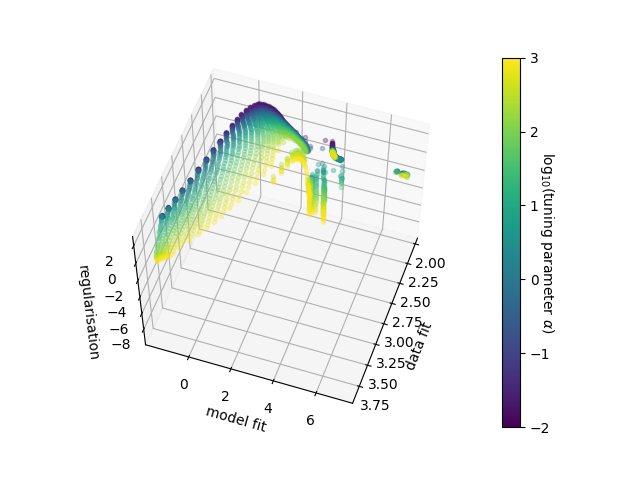

In [19]:
import matplotlib.cm as mplcm
import matplotlib.colors as colors
i0, i1 = (0, -1)

cNorm = colors.Normalize(vmin=np.log10(arange[i0]), vmax=np.log10(arange[i1]))
cm = plt.get_cmap('viridis')
scalarMap = mplcm.ScalarMappable(norm=cNorm, cmap=cm)


fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
for i,a in enumerate(arange):
    ax.plot(np.log10(f_trisol[i+i0,:,0].flatten()), 
                      np.log10(f_trisol[i+i0,:,1].flatten()), 
                      np.log10(f_trisol[i+i0,:,2].flatten()), 
                      '.', color=scalarMap.to_rgba(np.log10(a)), alpha=0.3)
ax.set_xlabel('data fit')
ax.set_ylabel('model fit')
ax.set_zlabel('regularisation')
cbar = plt.colorbar(scalarMap)
cbar.set_label(r'$\log_{10}($tuning parameter $\alpha)$', rotation=270)


<IPython.core.display.Javascript object>


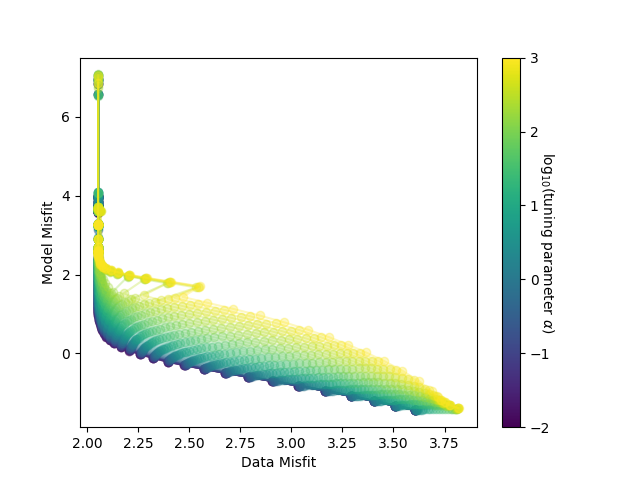

Text(0, 0.5, 'Model Misfit')

In [20]:
i0, i1 = (0, -1)

cNorm = colors.Normalize(vmin=np.log10(arange[i0]), vmax=np.log10(arange[i1]))
cm = plt.get_cmap('viridis')
scalarMap = mplcm.ScalarMappable(norm=cNorm, cmap=cm)

plt.figure()
for i,a in enumerate(arange):
    plt.plot(np.log10(f_trisol[i+i0,:,0]).T, np.log10(f_trisol[i+i0,:,1]).T, 'o-', color=scalarMap.to_rgba(np.log10(a)), alpha=0.3)
cbar = plt.colorbar(scalarMap)
cbar.set_label(r'$\log_{10}($tuning parameter $\alpha)$', rotation=270)
plt.xlabel('Data Misfit')
plt.ylabel('Model Misfit')

<IPython.core.display.Javascript object>


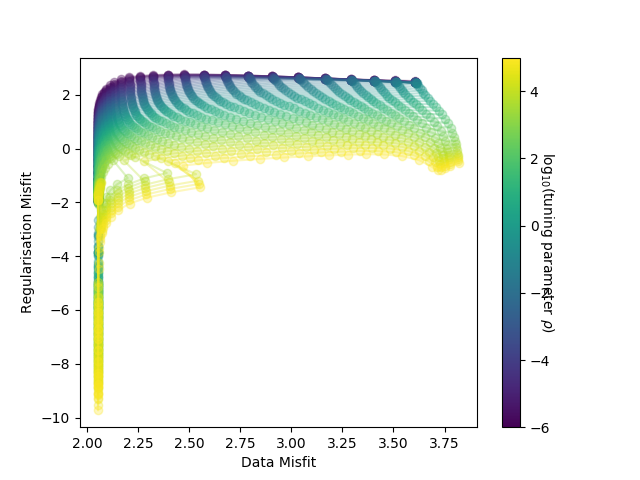

Text(0, 0.5, 'Regularisation Misfit')

In [27]:
i0, i1 = (0, -1)

cNorm = colors.Normalize(vmin=np.log10(prange[i0]), vmax=np.log10(prange[i1]))
cm = plt.get_cmap('viridis')
scalarMap = mplcm.ScalarMappable(norm=cNorm, cmap=cm)

plt.figure()
for i,p in enumerate(prange):
    plt.plot(np.log10(f_trisol[i+i0,:,0]).T, np.log10(f_trisol[i+i0,:,2]).T, 
             'o-', color=scalarMap.to_rgba(np.log10(p)), alpha=0.3)
cbar = plt.colorbar(scalarMap)
cbar.set_label(r'$\log_{10}($tuning parameter $\rho)$', rotation=270)
plt.xlabel('Data Misfit')
plt.ylabel('Regularisation Misfit')

In [22]:
dopick = False
if dopick:
    import pickle
    with open('out/hyperplanes.dump', 'wb') as fb:
        pickle.dump(sols, fb)